# Nerdle Analysis
## by Tim Wang

## Goals for this analysis: 
* Look at the possible entries for Nerdle
* Identify which numbers and operators are more likely to occur in solutions
* Identify the best opening strategy
* See if there is a systematic way to minimize the amount of steps

## Step 1: Define the Universe

### Determine set of possible solutions

Rules
* Each guess is a calculation.
* You can use 0 1 2 3 4 5 6 7 8 9 + - * / or =.
* It must contain one “=”.
* It must only have a number to the right of the “=”, not another calculation.
* Standard order of operations applies, so calculate * and / before + and -
* If the answer we're looking for is 10+20=30, then we will accept 20+10=30 too (unless you turn off 'commutative answers' in settings).

In [2]:
# Iterate a string and check if each character is numeric vs operator

test = '456+34=790'

for c in test:
    print(c + ' ' + str(c.isnumeric()))

4 True
5 True
6 True
+ False
3 True
4 True
= False
7 True
9 True
0 True


#### Define functions to check if a string represents a valid equation.

In [3]:
def consolidate(eq_str):
    
    parts = []
    current = ''
    
    for c in eq_str:
        
        if c.isnumeric():
            current += c
            
        else:
            parts.append(current)
            current = ''
            parts.append(c)
            
    if current != '':
        parts.append(current)
        
    return parts

In [4]:
consolidate('30+40=70')

['30', '+', '40', '=', '70']

In [5]:
def is_valid(eq_str):
    
    # print(eq_str)
    
    allowed_ops = ['+', '-', '*', '/', '=']
    
    operators = []
    numbers = []
    
    # Per Nerdle rules, equations must always end in an equal sign and a number.
    
    eq_list = consolidate(eq_str)
    right_result = eq_list.pop()
    eq_sign = eq_list.pop()
    
    if not(right_result.isnumeric()) or eq_sign != '=':
        return False
    
    # The rest needs to alternate: number, operator, number, ..., operator, number
    # Define 0 as number, 1 as operator
    
    last_ind = -1
    
    for c in eq_list:
        
        # print(c)
        
        if c.isnumeric():
            
            if last_ind == 0:
                return False
            else:
                
                ### Theoretically, 0's can exist on the left side, but
                ### makers of Nerdle stated there are quite many left out
                ### that the players wouldn't like.
                
                ### Eliminating 0's (like + 0, * 0, 0 / x)
                ### gets us closer to the target of 17,723 solutions.
                
                # if len(c) > 1 and c[0] == '0':
                #     return False
                
                
                ### Get rid of numbers like '00001'
                
                if c[0] == '0':
                    return False
                
                int_c = int(c)
                
                if last_ind == -1:
                    numbers.append(int_c)
                    
                else:
                    
                    # Implement PEMDAS
                    # If * or /, calculate now and append product/quotient
                    # If + or -, save for final step
                    # Only one = is allowed, so if =, return False since not valid
                    
                    recent_op = operators.pop()
                    if recent_op == '*':
                        numbers.append(numbers.pop() * int_c)
                    elif recent_op == '/':
                        last_num = numbers.pop()
                        if int_c == 0:
                            return False
                        if last_num % int_c != 0:
                            return False
                        numbers.append(last_num / int_c)
                    elif recent_op == '=':
                        return False
                    else:
                        numbers.append(int_c)
                        operators.append(recent_op)
            
                
            last_ind = 0
            
        else:
            
            if not(c in allowed_ops):
                return False
            
            if last_ind != 0:
                return False
            else:
                last_ind = 1
                operators.append(c)
                
                
    # At this point, the last operators should be + or - with enough arguments.
    
    left_result = numbers.pop(0)
    
    while len(operators) > 0:
        next_op = operators.pop(0)
        num2 = numbers.pop(0)
        
        if next_op == '+':
            left_result += num2
        elif next_op == '-':
            left_result -= num2
        else:
            pass
        
    # print(left_result)
    # print(right_result)
    
    return left_result == int(right_result)

In [6]:
# Test cases

test_cases = ['30+40=70',
              '+30+40=70',
              '-30+40=70',
              '30+*40=70',
              '30+4*0=70',
              '30=40=70',
              '70-40=30',
              '3*4=12',
              '30/10=3',
              '30/4=7',
              '3+6*4=27'
             ]

for test in test_cases:
    print(test + ": " + str(is_valid(test)))

30+40=70: True
+30+40=70: False
-30+40=70: False
30+*40=70: False
30+4*0=70: False
30=40=70: False
70-40=30: True
3*4=12: True
30/10=3: True
30/4=7: False
3+6*4=27: True


In [7]:
# From https://datagy.io/python-permutations-of-string/
# Use Python to get all combinations of a string with repetition

"""

import sys
import time

a_string = '012345'

final_list = [[]]
length = 8
groups = [list(a_string)] * length

print(groups)

for i in groups:
    final_list = [x+[y] for x in final_list for y in i]
    
## permutations = [''.join(item) for item in final_list]

permutations = []

for item in final_list:
    new_entry = ''.join(item)
    permutations.append(new_entry)

    print(new_entry, end = "\r")
    sys.stdout.write("\033[F") # Cursor up one line
    # time.sleep(1)

print(permutations)
# Returns ['aaa', 'aab', 'aac', 'aba', 'abb', 'abc', 'aca', 'acb', 'acc', 'baa', 'bab', 'bac', 'bba', 'bbb', 'bbc', 'bca', 'bcb', 'bcc', 'caa', 'cab', 'cac', 'cba', 'cbb', 'cbc', 'cca', 'ccb', 'ccc']
"""

'\n\nimport sys\nimport time\n\na_string = \'012345\'\n\nfinal_list = [[]]\nlength = 8\ngroups = [list(a_string)] * length\n\nprint(groups)\n\nfor i in groups:\n    final_list = [x+[y] for x in final_list for y in i]\n    \n## permutations = [\'\'.join(item) for item in final_list]\n\npermutations = []\n\nfor item in final_list:\n    new_entry = \'\'.join(item)\n    permutations.append(new_entry)\n\n    print(new_entry, end = "\r")\n    sys.stdout.write("\x1b[F") # Cursor up one line\n    # time.sleep(1)\n\nprint(permutations)\n# Returns [\'aaa\', \'aab\', \'aac\', \'aba\', \'abb\', \'abc\', \'aca\', \'acb\', \'acc\', \'baa\', \'bab\', \'bac\', \'bba\', \'bbb\', \'bbc\', \'bca\', \'bcb\', \'bcc\', \'caa\', \'cab\', \'cac\', \'cba\', \'cbb\', \'cbc\', \'cca\', \'ccb\', \'ccc\']\n'

In [8]:
# print(len(permutations))

In [9]:
def get_permutations(chars, length, suffix):

    a_string = chars

    final_list = [[]]
    groups = [list(a_string)] * length

    for i in groups:
        final_list = [x+[y] for x in final_list for y in i]

    permutations = [''.join(item) + suffix for item in final_list]
    
    return permutations

#### Generating all permutations with repetition for each digit + operator, for a length of 8, will take too much time and memory.

We must split it down to smaller cases.

We know that the equation is 8 slots long, and must end with an equal sign and a number.
* Case 1: _ _ _ _ _ _ = #
* Case 2: _ _ _ _ _ = # #
* Case 3: _ _ _ _ = # # #

If we continue, Case 4 has four digits on the right.

* Case 4: _ _ _ = # # # #

However, the highest the left result is 999, and semantically, the right side should not start with a 0.

Therefore, Case 4 is impossible and we have 3 cases.

#### Case 1: _ _ _ _ _ _ = _

In [10]:
left1 = get_permutations('0123456789+-*/', 6, '=')
case1 = []

for i in range(0, 10):
    for j in left1:
        case1.append(j + str(i))

#### Case 2: _ _ _ _ _ = _ _

In [11]:
left2 = get_permutations('0123456789+-*/', 5, '=')
right2 = [*range(10, 100)]
case2 = []

for i in left2:
    for j in right2:
        case2.append(i + str(j))

#### Case 3: _ _ _ _ = _ _ _

In [12]:
left3 = get_permutations('0123456789+-*/', 4, '=')
right3 = [*range(100, 1000)]
case3 = []

for i in left3:
    for j in right3:
        case3.append(i + str(j))

#### Combine Case 1-3 and extract valid equations

In [13]:
all_cases = case1 + case2 + case3

print("Case 1: " + str(len(case1)))
print("Case 2: " + str(len(case2)))
print("Case 3: " + str(len(case3)))
print("Total number of cases: " + str(len(all_cases)))

Case 1: 75295360
Case 2: 48404160
Case 3: 34574400
Total number of cases: 158273920


In [14]:
valid_eqs = []

for i in all_cases:
    if is_valid(i):
        valid_eqs.append(i)
        
print("Number of valid entries: " + str(len(valid_eqs)))

Number of valid entries: 17447


In [15]:
# valid_eqs[-50:]

## Step 2: Analyze

Use the set of valid equations derived in the last set.

In [16]:
# valid_eqs

### Simple frequencies

#### Frequencies for each digit 0-9 and each allowed operator

In [17]:
### Make one master string to search each allowed char

master_string = ''.join(c for c in valid_eqs)
print(str(master_string[-8:] == valid_eqs[-1:][0]))

True


In [18]:
### Make a list of keys, 0-9 and allowed ops
### We will use each element as a search criterium

digits = [str(a) for a in range(0, 10)]
allowed_ops = ['+', '-', '*', '/', '=']
allowed_chars = digits + allowed_ops
print(allowed_chars)

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '+', '-', '*', '/', '=']


In [19]:
### Create a dictionary which produces the frequency

counts = {a:master_string.count(a) for a in allowed_chars}
print(counts)

{'0': 4943, '1': 14156, '2': 11552, '3': 10087, '4': 10331, '5': 9572, '6': 9540, '7': 8618, '8': 9000, '9': 8552, '+': 7484, '-': 8500, '*': 5672, '/': 4122, '=': 17447}


In [20]:
### Create the chart

import matplotlib.pyplot as plt
import numpy as np

N = len(counts)
ind = np.arange(N)    # the x locations for the groups
width = 0.35       # the width of the bars: can also be len(x) sequence

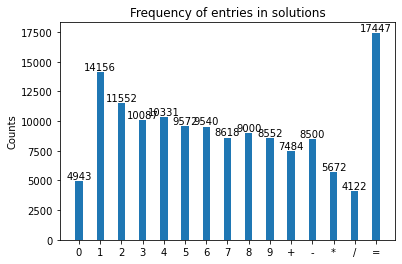

In [21]:
fig, ax = plt.subplots()

p1 = ax.bar(ind, counts.values(), width)

ax.axhline(0, color='grey', linewidth=0.8)
ax.set_ylabel('Counts')
ax.set_title('Frequency of entries in solutions')
ax.set_xticks(ind)
ax.set_xticklabels(counts.keys())
# ax.legend()

# Label with label_type 'center' instead of the default 'edge'
ax.bar_label(p1, label_type = 'edge')

plt.show()

It seems that the lower digits, 1-4, see more solutions than 0 and 5-9.

* 1-2 are highest iin frequency, likely driven by the two-digit result summations.
* 0 is lower in frequency because the form of a solution likely does not have a number leading with 0, e.g. 01 instead of 1.

Next step: look at numbers instead of digits - may shed more light to digits as well as operators, e.g. higher frequencies of teens may suggest higher usage of + and -.

#### Frequencies for each number 0 - 999

In [22]:
### Traverse valid equations and collect numbers

numbers = []

for eq in valid_eqs:
    comps = consolidate(eq)
    for comp in comps:
        if comp.isnumeric():
            numbers.append(int(comp))
            
print(numbers[-50:])

[83, 747, 9, 84, 756, 9, 85, 765, 9, 86, 774, 9, 87, 783, 9, 88, 792, 9, 89, 801, 9, 90, 810, 9, 91, 819, 9, 92, 828, 9, 93, 837, 9, 94, 846, 9, 95, 855, 9, 96, 864, 9, 97, 873, 9, 98, 882, 9, 99, 891]


In [23]:
### Create array of keys, i.e. 0-999

x = range(0, 1000)
y = [numbers.count(a) for a in x]

print(x[-50:])
print(y[-50:])

range(950, 1000)
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


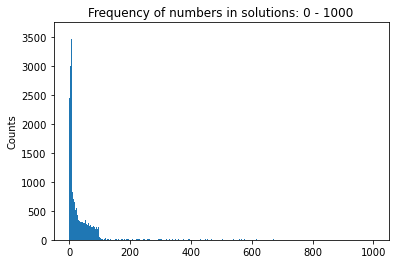

In [24]:
width = 1

fig, ax = plt.subplots()

p1 = ax.bar(x, y, width)

ax.axhline(0, color='grey', linewidth=0.8)
ax.set_ylabel('Counts')
ax.set_title('Frequency of numbers in solutions: 0 - 1000')
# ax.legend()

# Label with label_type 'center' instead of the default 'edge'
# ax.bar_label(p1, label_type = 'edge')

plt.show()

As expected, we don't see much activity past 100 which would require the use of at least one multiplication (*).

Try to truncate at 100 to get a better sense of frequencies.

In [25]:
### Truncate to 100

trunc_pt = 101

x_trunc = x[:trunc_pt]
y_trunc = y[:trunc_pt]

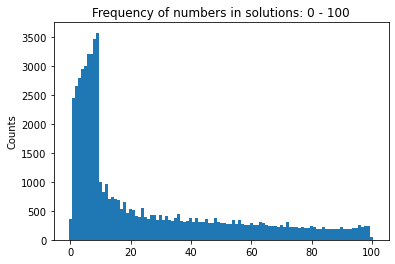

In [26]:
width = 1

fig, ax = plt.subplots()

p1 = ax.bar(x_trunc, y_trunc, width)

ax.axhline(0, color='grey', linewidth=0.8)
ax.set_ylabel('Counts')
ax.set_title('Frequency of numbers in solutions: 0 - 100')
# ax.legend()

# Label with label_type 'center' instead of the default 'edge'
# ax.bar_label(p1, label_type = 'edge')

plt.show()

We see another cutoff at 10, which makes sense. If there are 3 operands and 2 operators on the left, this maximizes the permutations for an eligible equation.

In [27]:
### Truncate to 100

trunc_pt = 11

x_trunc = x[:trunc_pt]
y_trunc = y[:trunc_pt]

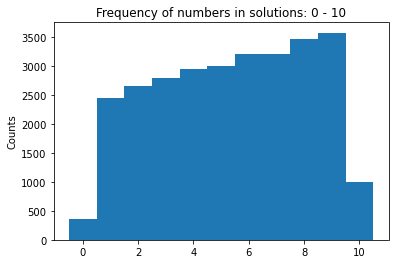

In [28]:
width = 1

fig, ax = plt.subplots()

p1 = ax.bar(x_trunc, y_trunc, width)

ax.axhline(0, color='grey', linewidth=0.8)
ax.set_ylabel('Counts')
ax.set_title('Frequency of numbers in solutions: 0 - 10')
# ax.legend()

# Label with label_type 'center' instead of the default 'edge'
# ax.bar_label(p1, label_type = 'edge')

plt.show()

### Repeated entries in solutions

In order to find the most ideal opener, it might help to look at if it is more effective to open with a solution:
* with repeated digits and/or operators
* with all unique digits and operators

#### Repeated digits

Are there more solutions with repeated digits?

In [29]:
### Traverse valid equations and collect digits

repeats = []
repeat_eqs = []
unique_eq_bool = 0

for eq in valid_eqs:
    eq_dedup = ''.join(set(eq))
    for char in eq_dedup:
        if eq.count(char) > 1 and char.isnumeric():
            repeats.append(char)
            unique_eq_bool = 1
    if unique_eq_bool == 1:
        repeat_eqs.append(eq)
    unique_eq_bool = 0
        
# repeat_counts = {a:repeats.count(a) for a in allowed_chars}
repeat_counts = {a:repeats.count(a) for a in digits}
# repeat_counts = {a:repeats.count(a) for a in allowed_ops}
            
print("Repeat counts: ")
print(repeat_counts)
print("")
print("Sum of repeat counts: " + str(sum(repeat_counts.values())))
print("Unique equations: " + str(len(repeat_eqs)))

Repeat counts: 
{'0': 415, '1': 3202, '2': 2161, '3': 1747, '4': 1828, '5': 1691, '6': 1491, '7': 1318, '8': 1393, '9': 1321}

Sum of repeat counts: 16567
Unique equations: 13584


In [30]:
### Double check: all unique should be 17,447 - # unique equations above
### i.e. 3,863

repeats = []
all_unique = []
unique_eq_counter = 0
unique_eq_bool = 0

for eq in valid_eqs:
    eq_dedup = ''.join(set(eq))
    for char in eq_dedup:
        if eq.count(char) > 1 and char.isnumeric():
            #repeats.append(char)
            unique_eq_bool = 1
    if unique_eq_bool == 0:
        all_unique.append(eq)
        unique_eq_counter += 1
    unique_eq_bool = 0
        
# repeat_counts = {a:repeats.count(a) for a in allowed_chars}
# repeat_counts = {a:repeats.count(a) for a in digits}
# repeat_counts = {a:repeats.count(a) for a in allowed_ops}
            
print("All unique equation counts: " + str(unique_eq_counter))
print(all_unique[-20:])

All unique equation counts: 3863
['94*8=752', '95+7=102', '95+8=103', '95*4=380', '95*8=760', '96+7=103', '96+8=104', '96*5=480', '97+5=102', '97+6=103', '97+8=105', '97*6=582', '98+4=102', '98+5=103', '98+6=104', '98+7=105', '9*42=378', '9*52=468', '9*72=648', '9*84=756']


The answer is **yes**.

There are 13,584 equations out of 17,447 (77.9%) that have a repeat digit!

Now let's split out by number of repeats.
* Are the multiple repeats, e.g. two 1's and two 2's?
* Are there more than two of one digit, e.g. three 1's?

#### Multiple repeats

In [31]:
### Traverse valid equations and collect digits

from itertools import compress

multiple_repeat_eqs = []

for eq in valid_eqs:
    eq_dedup = ''.join(set(eq))
    counts = [eq.count(char) for char in eq_dedup]
    num_repeats = len(list(compress(counts, [a > 1 for a in counts])))
    if num_repeats > 1:
        multiple_repeat_eqs.append(eq)
            
print("Equations with multiple repeats: " + str(len(multiple_repeat_eqs)))
print("")
print(multiple_repeat_eqs[-50:])

Equations with multiple repeats: 3965

['95*9=855', '96*2=192', '96*7=672', '96*8=768', '96*9=864', '97*7=679', '97*9=873', '98*7=686', '98*9=882', '99+1=100', '99+2=101', '99*5=495', '9+91=100', '9+92=101', '9*15=135', '9*16=144', '9*19=171', '9*21=189', '9*22=198', '9*25=225', '9*29=261', '9*32=288', '9*33=297', '9*35=315', '9*39=351', '9*44=396', '9*45=405', '9*49=441', '9*50=450', '9*51=459', '9*55=495', '9*58=522', '9*59=531', '9*66=594', '9*69=621', '9*75=675', '9*77=693', '9*79=711', '9*87=783', '9*88=792', '9*89=801', '9*90=810', '9*91=819', '9*92=828', '9*93=837', '9*94=846', '9*95=855', '9*96=864', '9*97=873', '9*98=882']


In [32]:
len(multiple_repeat_eqs) / len(valid_eqs)

0.22725970080816185

3,965 solutions out of 17,447 valid equations contain more than one digit repeated. That's about 22.7% of solutions.

#### Repeats more than double

In [33]:
### Traverse valid equations and collect digits

from itertools import compress

repeat_more_than_double_eqs = []
repeat_more_than_double_digits = []

for eq in valid_eqs:
    eq_dedup = ''.join(set(eq))
    counts = [eq.count(char) for char in eq_dedup]
    num_repeats = len(list(compress(counts, [a > 2 for a in counts])))
    if num_repeats > 0:
        repeat_more_than_double_eqs.append(eq)
        digit_add = list(compress(eq_dedup, [a > 2 for a in counts]))
        repeat_more_than_double_digits += digit_add
            
print("Equations with multiple repeats: " + str(len(repeat_more_than_double_eqs)))
print("")
print(multiple_repeat_eqs[-50:])

Equations with multiple repeats: 2077

['95*9=855', '96*2=192', '96*7=672', '96*8=768', '96*9=864', '97*7=679', '97*9=873', '98*7=686', '98*9=882', '99+1=100', '99+2=101', '99*5=495', '9+91=100', '9+92=101', '9*15=135', '9*16=144', '9*19=171', '9*21=189', '9*22=198', '9*25=225', '9*29=261', '9*32=288', '9*33=297', '9*35=315', '9*39=351', '9*44=396', '9*45=405', '9*49=441', '9*50=450', '9*51=459', '9*55=495', '9*58=522', '9*59=531', '9*66=594', '9*69=621', '9*75=675', '9*77=693', '9*79=711', '9*87=783', '9*88=792', '9*89=801', '9*90=810', '9*91=819', '9*92=828', '9*93=837', '9*94=846', '9*95=855', '9*96=864', '9*97=873', '9*98=882']


In [34]:
repeat_more_than_double_digits_counts = {a:repeat_more_than_double_digits.count(a) for a in digits}
print(repeat_more_than_double_digits_counts)

{'0': 104, '1': 412, '2': 283, '3': 213, '4': 253, '5': 264, '6': 175, '7': 106, '8': 149, '9': 118}


In [35]:
len(repeat_more_than_double_eqs) / len(valid_eqs)

0.11904625437037886

2,077 solutions out of 17,447 valid equations contain repeat digits of 3 or more instances. That's about 11.9% of solutions.

Not surprisingly, 1 is the most common repeated digit here as well.

#### Positions for repeat digits

In [36]:
eq='30+30=60'
eq_dedup = ''.join(set(eq))
counts = [eq.count(char) for char in eq_dedup]
dup_digits = list(compress(eq_dedup, [a > 1 for a in counts]))

print(dup_digits)

['0', '3']


In [37]:
positions = []

for eq in repeat_eqs:
    eq_dedup = ''.join(set(eq))
    counts = [eq.count(char) for char in eq_dedup]
    dup_digits = list(compress(eq_dedup, [a > 1 for a in counts]))
    for i in range(0, 8):
        if eq[i].isnumeric() and eq[i] in dup_digits:
            positions.append(i)
            # print(eq)
            # print(i)

In [38]:
position_freqs = {ind:positions.count(ind) for ind in range(0, 8)}
print(position_freqs)

{0: 5820, 1: 4689, 2: 2603, 3: 4386, 4: 4736, 5: 2323, 6: 4073, 7: 6667}


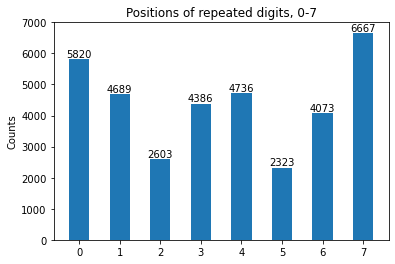

In [39]:
width = 0.5

fig, ax = plt.subplots()

p1 = ax.bar(position_freqs.keys(), position_freqs.values(), width)

ax.axhline(0, color='grey', linewidth = 0.8)
ax.set_ylabel('Counts')
ax.set_title('Positions of repeated digits, 0-7')
# ax.legend()

# Label with label_type 'center' instead of the default 'edge'
ax.bar_label(p1, label_type = 'edge')

plt.show()

#### Digit companionship heat map

"Companionship" is meant by the co-existence of two digits in the solutions base.

For example, given that there is a "1" in the solution, what is the probability that there is also a "7"?

In [40]:
import numpy as np
 
rows = 10
cols = 10
size = rows * cols
 
companionship_map = np.array([0] * size, dtype=float).reshape(rows,cols)

for given in range(0, 10):
    limited_set = list(compress(valid_eqs, [eq.count(str(given)) > 0 for eq in valid_eqs]))
    for second in range(0, 10):
        double_limit_set = list(compress(limited_set, [eq.count(str(second)) > 0 for eq in limited_set]))
        companionship_map[given][second] = len(double_limit_set) / len(limited_set)

In [41]:
print(companionship_map)

[[1.         0.53910488 0.45976492 0.38517179 0.41094033 0.42631103
  0.38132911 0.32368897 0.35443038 0.32911392]
 [0.22649573 1.         0.4640076  0.42507123 0.42573599 0.39838557
  0.41927825 0.38347578 0.39468186 0.37283951]
 [0.22351648 0.53692308 1.         0.41516484 0.4489011  0.38615385
  0.40912088 0.39395604 0.39923077 0.35461538]
 [0.20998152 0.55157116 0.46555761 1.         0.4207024  0.41873075
  0.41355514 0.38151571 0.38077634 0.37634011]
 [0.22073822 0.54431763 0.4959932  0.41452161 1.         0.38513842
  0.41537154 0.36316173 0.39667314 0.35709082]
 [0.24802735 0.55168332 0.4621252  0.44687007 0.41714887 1.
  0.38532351 0.36875329 0.37019989 0.36796423]
 [0.21452187 0.56141913 0.47342319 0.42675483 0.43502035 0.37258393
  1.         0.35414547 0.39331129 0.36762462]
 [0.19911012 0.56145717 0.49847052 0.43047831 0.41587875 0.38987764
  0.38723582 1.         0.368604   0.39126808]
 [0.21041331 0.55770263 0.48752013 0.41465378 0.4384058  0.37775094
  0.41505636 0.35574

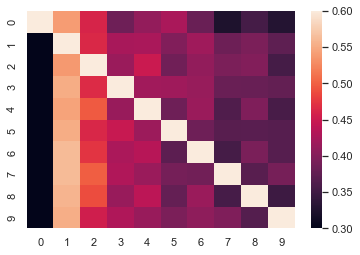

In [42]:
import numpy as np; np.random.seed(0)
import seaborn as sns; sns.set_theme()
ax = sns.heatmap(companionship_map, vmin = 0.3, vmax = 0.6)

### Ideal starter

This analysis relies on similar concepts presented in the Wordle analysis below.
https://www.youtube.com/watch?v=v68zYyaEmEA

Presented is some information theory, which states that 1 bit of information cuts the number of possible outcomes in half.

For each equation, we make use of the three different states - black, purple, and green - and run through the $3^{8}$ scenarios to get a weighted information bits "score".

In [58]:
# Global variables for 3 colored states.

BLACK = 0
PURPLE = 1
GREEN = 2

In [164]:
"""
Get score = -log_2{p}
Since each outcome is equally likely, p = 1 / (# of outcomes)
Thus, score = -log_2{p} = log_2{# of outcomes}

Parameters:
    states - list of 8 elements; 0 for black, 1 for purple, 2 for green
    
v2 - improvements for efficiency...because v1 was taking too long even with parallelization
    Put everything in one for-loop for all remaining equations.
    
    That way, the efficiency becomes O(n) for this method, 
    and O(n^2) as we traverse for all equations.
    
"""

import re

def get_remaining_solutions(remaining_eqs, checking_eq, states):
    BLACK = 0
    PURPLE = 1
    GREEN = 2
    
    residual_eqs_1 = []
    
    # Case 1
    
    # First, eliminate equations that don't meet green slots.
    
    # Then purge equations that have entries in the wrong spot 
    # as shown in checking_eq, aka any spot with black OR purple
    
    green_indices = [i for i, x in enumerate(states) if x == GREEN]
    other_indices = [i for i, x in enumerate(states) if x != GREEN]
    regex_list = ['.'] * 8
    
    # print(green_indices)
    # print(other_indices)
    
    for ind in green_indices:
        literal_prefix = ''
        if checking_eq[ind] in ['+', '*']:
            literal_prefix = '\\'
        regex_list[ind] = literal_prefix + checking_eq[ind]
        # print(regex_list)
        
    for ind in other_indices:
        literal_prefix = ''
        if checking_eq[ind] in ['+', '*']:
            literal_prefix = '\\'
        regex_list[ind] = '[^' + literal_prefix + checking_eq[ind] + ']'
    
    # Case 2
    
    # Then, consider equations that violate counts 
    # using purple and black.
    
    black_indices = [i for i, x in enumerate(states) if x == BLACK]
    purple_indices = [i for i, x in enumerate(states) if x == PURPLE]

    black_values = []
    purple_values = []
    green_values = []
    
    for i in black_indices:
        black_values.append(checking_eq[i])
    for i in purple_indices:
        purple_values.append(checking_eq[i])
    for i in green_indices:
        green_values.append(checking_eq[i])
    
    # Case 2a
    
    # Start with digits with both black and purple.
    # Purge equations with incorrect count.
    
    intersect_values = list(set(black_values).intersection(set(purple_values)))
          
    # Case 2b
    
    # Then purge equations that have 0 of values with purple 
    # but no black
    
    purple_only_values = list(set(purple_values) - set(intersect_values))
    
    # Case 2c
    
    # Then purge equations that have 1+ of values with black 
    # but no purple
    
    black_only_values = list(set(black_values) - set(intersect_values))
    
    # print(intersect_values)
    # print(purple_only_values)
    # print(black_only_values)
    
    # Final - put everything together in one for loop to only traverse once
    
    eqs_to_eliminate = []
    
    for eq in remaining_eqs:
        
        # Case 1 - Exact indices
        
        result = re.match(''.join(regex_list), eq)
        
        if not result:
            eqs_to_eliminate.append(eq)
            # print(eq + ": " + "Case 1")
            continue
        
        # Case 2a - Purple and black repeat chars
        
        case2 = 0
        
        for val in intersect_values:
            num_in_solution = purple_values.count(val) + green_values.count(val)
            eq_count = eq.count(val)
            if eq_count != num_in_solution:
                eqs_to_eliminate.append(eq)
                case2 = 1
        
        if case2 == 1:
            # print(eq + ": " + "Case 2a")
            continue
            
        # Case 2b - Purple chars with no black repeats
        
        for val in purple_only_values:
            num_in_solution = purple_values.count(val)
            eq_count = eq.count(val)
            if eq_count < num_in_solution:
                eqs_to_eliminate.append(eq)
                case2 = 1
        
        if case2 == 1:
            # print(eq + ": " + "Case 2b")
            continue
            
        # Case 2c - Black chars with no purple repeats
        
        for val in black_only_values:
            eq_count = eq.count(val)
            if eq_count > green_values.count(val):
                # print(val)
                # print(eq_count)
                # print(eq + ": " + "Case 2c")
                eqs_to_eliminate.append(eq)

    residual_eqs = list(set(remaining_eqs) - set(eqs_to_eliminate))
    
    return residual_eqs
    

In [49]:
"""
Get remaining bits = -log_2{p}
Since each outcome is equally likely, p = 1 / (# of outcomes)
Thus, bits = -log_2{p} = log_2{# of outcomes}

Parameters:
    potential_sols - list of remaining solutions
    
Returns:
    bits, probability
"""

import math

def get_bits(potential_sols):
    if len(potential_sols) == 0:
        return 0.0, 0.0
    return math.log(len(potential_sols), 2), 1 / len(potential_sols)

In [50]:
# Test cell
# 0 for black, 1 for purple, 2 for green

remaining_eqs = valid_eqs
checking_eq = "30+44=74"
states = [0, 1, 0, 1, 0, 2, 0, 0]
# states = [2] * 8

remain = get_remaining_solutions(remaining_eqs, checking_eq, states)
print(remain)

bits = get_bits(remain)
print(bits)

['140/5=28', '68-28=40', '540/9=60', '450/9=50', '42-22=20', '480/6=80', '91-50=41', '95-55=40', '4*5/2=10', '65-20=45', '640/8=80', '58-10=48', '62-22=40', '6*8-8=40', '68-20=48', '540/6=90', '52-10=42', '5*9-5=40', '42-20=22', '490/5=98', '66-26=40', '91-51=40', '1*8*5=40', '45-20=25', '92-52=40', '45-25=20', '96-56=40', '1*5*8=40', '9*5-5=40', '5*4/2=10', '48-20=28', '99-50=49', '58-18=40', '4/1*5=20', '5*8*1=40', '95-50=45', '49-20=29', '99-59=40', '460/5=92', '4*5/1=20', '62-20=42', '5*4/1=20', '46-20=26', '69-20=49', '8*5*1=40', '48-28=20', '5*8/1=40', '98-50=48', '5*4*1=20', '56-16=40', '49-29=20', '4/2*5=10', '69-29=40', '59-19=40', '51-11=40', '41-20=21', '61-21=40', '41-21=20', '61-20=41', '410/5=82', '8*5/1=40', '480/8=60', '1*4*5=20', '210/5=42', '98-58=40', '5/1*8=40', '8*6-8=40', '52-12=40', '55-15=40', '92-50=42', '480/5=96', '59-10=49', '56-10=46', '4*5*1=20', '46-26=20', '55-10=45', '51-10=41', '66-20=46', '8*1*5=40', '8/4*5=10', '8/1*5=40', '65-25=40', '5*1*8=40', '96

In [62]:
### Helper method
### For guess, generate list of 8 colors representing the states based on true_answer.

def generate_states(guess, true_answer):

    states = [0] * 8
    not_green = []
    
    for i in range(8):
        if guess[i] == true_answer[i]:
            states[i] = GREEN
        else:
            not_green.append(i)
    
    #guess_counts = dict()
    ans_counts = dict()
    
    # Get counts in answer for purple/black overlaps.
    for j in not_green:

        #guess_counts[j] = guess_counts.get(j, 0) + 1
        char = true_answer[j]
        ans_counts[char] = ans_counts.get(char, 0) + 1
        
    # Assign sequentially for non-green indices.
    for k in not_green:
        
        char = guess[k]
        if ans_counts.get(char, 0) > 0:
            states[k] = PURPLE
            ans_counts[char] = ans_counts.get(char, 0) - 1
        else:
            states[k] = BLACK
    
    return states
        

In [66]:
generate_states('33+33=66', '88-55=33')

[1, 1, 0, 0, 0, 2, 0, 0]

In [89]:
def get_info_distribution(remaining_eqs, eq):
    
    # If poss were the answer, what would the UI show?
    # Partition remaining_eqs and get counts for each configuration.
    dist = dict()
    for poss in remaining_eqs:
        states = generate_states(eq, poss)
        hashed_key = "".join([str(x) for x in states])
        dist[hashed_key] = dist.get(hashed_key, 0) + 1
        
    return dist

In [90]:
def get_info_bits(remaining_eqs, eq):
    
    dist = get_info_distribution(remaining_eqs, eq)
    
    # Iterate the configurations and weight the info (entropy).
    weighted_bits_remaining = 0
    for count in list(dist.values()):
        weighted_bits_remaining += float(count) / len(remaining_eqs) * math.log(count, 2)
    
    return (eq, math.log(len(remaining_eqs), 2) - weighted_bits_remaining)

In [83]:
from joblib import Parallel, delayed
import time
from tqdm import tqdm

info_tuples = Parallel(n_jobs=16)(delayed(get_info_bits)(valid_eqs, eq) for eq in tqdm(valid_eqs))


  9%|███▎                                  | 1536/17447 [00:41<06:47, 39.08it/s]


 18%|██████▋                               | 3088/17447 [01:21<06:03, 39.47it/s]


 27%|██████████                            | 4640/17447 [02:01<05:26, 39.25it/s]


 35%|█████████████▍                        | 6192/17447 [02:41<04:38, 40.37it/s]


 44%|████████████████▊                     | 7744/17447 [03:19<03:57, 40.87it/s]


  9%|██▊                            | 1615/17447 [13:34:27<133:04:08, 30.26s/it]

 53%|████████████████████▏                 | 9280/17447 [04:44<03:21, 40.46it/s]


 62%|██████████████████████▉              | 10832/17447 [05:23<02:43, 40.42it/s]


 71%|██████████████████████████▎          | 12384/17447 [06:02<02:04, 40.64it/s]


 80%|█████████████████████████████▌       | 13936/17447 [06:40<01:26, 40.40it/s]


 89%|████████████████████████████████▊    | 15488/17447 [07:22<00:52, 37.00it/s]


 98%|████████████████████████████████████▏| 17040/17447 [08:05<00:11, 34.31it/s]


100%|█████████████████████████████████████| 17447/17447 [08:16<00:00, 35.15it/s]


In [88]:
import pandas as pd

index_list = []
value_list = []

for a, b in info_tuples:
    index_list.append(a)
    value_list.append(b)
    
ser = pd.Series(value_list, index = index_list)
ser.sort_values(axis = 0, ascending = False)

48-32=16    9.782102
48-36=12    9.766884
43-25=18    9.763686
45-27=18    9.755900
46-27=19    9.755305
              ...   
50/5-5=5    5.747207
688/86=8    5.611285
64/4/4=4    5.505691
8*86=688    5.424632
86*8=688    5.246453
Length: 17447, dtype: float64

In [107]:
print(ser.sort_values(axis = 0, ascending = False).idxmax())

48-32=16


That means that the ideal starter is '48-32=16', as it results in the lowest expected entropy.

#### What does going with the best starter look like at the worst case?

Sort of like a minimax - we're minimizing the loss on the worst case

In [112]:
best_starter = ser.sort_values(axis = 0, ascending = False).idxmax()
print(best_starter)

48-32=16


In [97]:
best_starter_dist = get_info_distribution(valid_eqs, best_starter)

In [100]:
index_list_best = []
value_list_best = []

for a in best_starter_dist.keys():
    index_list_best.append(a)
    value_list_best.append(best_starter_dist.get(a, 0))
    
ser_best = pd.Series(value_list_best, index = index_list_best)
ser_best.sort_values(axis = 0, ascending = False)

00011210    110
10001110     93
00010110     90
00101110     89
01000210     87
           ... 
22000212      1
22002211      1
22010201      1
20221221      1
01020100      1
Length: 1687, dtype: int64

In [101]:
remain = get_remaining_solutions(valid_eqs, '48-32=16', [0, 1, 0, 2, 0, 1, 0, 0])
print(remain)

['9*93=837']


In [109]:
remain = get_remaining_solutions(valid_eqs, '48-32=16', [0, 0, 0, 1, 1, 2, 1, 0])
print(len(remain))

110


In [108]:
step2 = Parallel(n_jobs=16)(delayed(get_info_bits)(remain, eq) for eq in tqdm(remain))


100%|████████████████████████████████████████| 110/110 [00:01<00:00, 101.05it/s]


In [116]:
index_list = []
value_list = []

for a, b in step2:
    index_list.append(a)
    value_list.append(b)
    
ser = pd.Series(value_list, index = index_list)
next_step = ser.sort_values(axis = 0, ascending = False).idxmax()
print("Next step: " + next_step)

next_step_dist = get_info_distribution(remain, next_step)

index_list_next = []
value_list_next = []

for a in next_step_dist.keys():
    index_list_next.append(a)
    value_list_next.append(next_step_dist.get(a, 0))
    
ser_next = pd.Series(value_list_next, index = index_list_next)
worst_case_state = ser_next.sort_values(axis = 0, ascending = False).idxmax()
worst_case = [int(x) for x in worst_case_state]
print("Worst case state: ")
print(worst_case)

remain = get_remaining_solutions(remain, next_step, worst_case)
print(len(remain))

Next step: 19+13=32
Worst case state: 
[1, 1, 0, 0, 1, 2, 0, 1]
7


In [118]:
def worst_case_on_best_info(possible_eqs):
    
    tries = 0
    remain = possible_eqs
    
    while len(remain) > 1:
    
        step = Parallel(n_jobs=32)(delayed(get_info_bits)(remain, eq) for eq in tqdm(remain))

        index_list = []
        value_list = []

        for a, b in step:
            index_list.append(a)
            value_list.append(b)

        ser = pd.Series(value_list, index = index_list)
        next_step = ser.sort_values(axis = 0, ascending = False).idxmax()
        print("Next step: " + next_step)

        next_step_dist = get_info_distribution(remain, next_step)

        index_list_next = []
        value_list_next = []

        for a in next_step_dist.keys():
            index_list_next.append(a)
            value_list_next.append(next_step_dist.get(a, 0))

        ser_next = pd.Series(value_list_next, index = index_list_next)
        worst_case_state = ser_next.sort_values(axis = 0, ascending = False).idxmax()
        worst_case = [int(x) for x in worst_case_state]
        print("Worst case state: ")
        print(worst_case)

        remain = get_remaining_solutions(remain, next_step, worst_case)
        print(len(remain))
        
        tries += 1
    
    return tries + 1

In [161]:
worst_case_on_best_info(valid_eqs)

100%|█████████████████████████████████████| 17447/17447 [07:43<00:00, 37.66it/s]


Next step: 48-32=16
Worst case state: 
[0, 0, 0, 1, 1, 2, 1, 0]
[]
['2', '1', '3']
['6', '8', '-', '4']
-
1
102-3=99: Case 2c
-
1
102-9=93: Case 2c
4
1
102/3=34: Case 2c
4
2
10+24=34: Case 2c
8
2
10+28=38: Case 2c
4
1
11+13=24: Case 2c
4
1
11+23=34: Case 2c
4
1
11+24=35: Case 2c
6
1
11+26=37: Case 2c
8
1
11+27=38: Case 2c
8
1
11+28=39: Case 2c
4
1
120/3=40: Case 2c
4
1
120/4=30: Case 2c
4
1
123/3=41: Case 2c
4
2
124/4=31: Case 2c
6
1
126/3=42: Case 2c
4
1
126/3=42: Case 2c
8
1
128/4=32: Case 2c
4
1
128/4=32: Case 2c
4
1
129/3=43: Case 2c
8
1
12+18=30: Case 2c
6
1
12+26=38: Case 2c
8
1
12+26=38: Case 2c
4
1
12+41=53: Case 2c
4
1
12+43=55: Case 2c
6
1
12+51=63: Case 2c
6
1
12+53=65: Case 2c
6
1
12+61=73: Case 2c
6
1
12+63=75: Case 2c
8
1
12+71=83: Case 2c
8
1
12+73=85: Case 2c
8
1
12+81=93: Case 2c
8
1
12+83=95: Case 2c
4
2
132/3=44: Case 2c
4
1
132/4=33: Case 2c
6
1
132/6=22: Case 2c
6
1
138/6=23: Case 2c
8
1
138/6=23: Case 2c
4
1
13+11=24: Case 2c
4
1
13+14=27: Case 2c
8
1
13+15=28: Ca

100%|███████████████████████████████████████| 110/110 [00:00<00:00, 9363.43it/s]


Next step: 19+13=32
Worst case state: 
[1, 1, 0, 0, 1, 2, 0, 1]
['1', '3']
['9', '2']
['+']
+
2
3+9+9=21: Case 2c
+
2
9+3+9=21: Case 2c
+
1
3+2*9=21: Case 2c
7


100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5631.02it/s]

Next step: 3*9/1=27
Worst case state: 
[2, 2, 2, 2, 2, 2, 2, 2]
[]
[]
[]
1


4

Theoretically, you can generally expect to score 4/6 based on the outcome above.

Let's test it out in the event space to see if that's true.

In [185]:
def num_tries_best_info(possible_eqs, solution):
    
    if solution == '48-32=16':
        return 1
    
    tries = 1
    states = generate_states('48-32=16', solution)
    remain = get_remaining_solutions(possible_eqs, '48-32=16', states)
    
    while len(remain) > 1:
    
        step = Parallel(n_jobs=32)(delayed(get_info_bits)(remain, eq) for eq in remain)

        index_list = []
        value_list = []

        for a, b in step:
            index_list.append(a)
            value_list.append(b)

        ser = pd.Series(value_list, index = index_list).sort_values(axis = 0, ascending = False)
        print(ser)
        next_step = ser.idxmax()
        print("Next step: " + next_step)

        states = generate_states(next_step, solution)
        print(states)
        remain = get_remaining_solutions(remain, next_step, states)
        print(len(remain))
        
        tries += 1
    
    print("Solution: ")
    print(remain)
    return tries + 1

In [187]:
#num_tries_best_info(valid_eqs, '7*4-3=25')

states = [2, 0, 2, 2, 2, 2, 2, 0]
remain = get_remaining_solutions(remain, '47-16=31', states)

step = Parallel(n_jobs=32)(delayed(get_info_bits)(remain, eq) for eq in remain)

index_list = []
value_list = []

for a, b in step:
    index_list.append(a)
    value_list.append(b)

ser = pd.Series(value_list, index = index_list).sort_values(axis = 0, ascending = False)
print(ser)
next_step = ser.idxmax()
print("Next step: " + next_step)

In [166]:
tries = dict()
for eq in tqdm(valid_eqs):
    tries[eq] = num_tries_best_info(valid_eqs, eq)

100%|███████████████████████████████████████████| 57/57 [00:02<00:00, 23.48it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


  0%|                                      | 1/17447 [00:02<12:20:51,  2.55s/it]

10-1/1=9    2.321928
10-1*1=9    2.321928
10-1*9=1    2.321928
19-1-9=9    1.921928
10-1-9=0    1.921928
dtype: float64
Next step: 10-1/1=9
[2, 2, 2, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 10520.34it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4489.49it/s]


19-9-8=2    2.75
17-2-7=8    2.75
19-2-8=9    2.75
19-2-9=8    2.75
17-2-8=7    2.75
17-7-8=2    2.75
10-2/1=8    2.25
10-2-8=0    2.25
dtype: float64
Next step: 19-9-8=2
[2, 0, 2, 0, 2, 2, 2, 1]
2



  0%|                                       | 2/17447 [00:02<5:55:10,  1.22s/it]

17-2-8=7    1.0
10-2-8=0    1.0
dtype: float64
Next step: 17-2-8=7
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6305.62it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 2, 2, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1800.65it/s]


15-2*5=5    0.918296
19-2*5=9    0.918296
10-2*5=0    0.918296
dtype: float64
Next step: 15-2*5=5
[2, 0, 2, 2, 2, 2, 2, 0]
2



  0%|                                       | 3/17447 [00:02<3:27:27,  1.40it/s]

19-2*5=9    1.0
10-2*5=0    1.0
dtype: float64
Next step: 19-2*5=9
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 18425.16it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 2, 0, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3841.82it/s]


11-3-1=7    2.0
17-3-7=7    1.5
10-3-7=0    1.5
11-3-7=1    1.5
dtype: float64
Next step: 11-3-1=7
[2, 0, 2, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 8307.24it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 0, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4625.39it/s]


15-4-6=5    1.921928
19-4-6=9    1.921928
15-5-6=4    1.921928
19-9-6=4    1.921928
10-4-6=0    1.521928
dtype: float64
Next step: 15-4-6=5
[2, 0, 2, 2, 2, 2, 2, 0]
2



  0%|                                       | 5/17447 [00:03<1:41:18,  2.87it/s]

19-4-6=9    1.0
10-4-6=0    1.0
dtype: float64
Next step: 19-4-6=9
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 13584.60it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1239.27it/s]


10-5-5=0    1.0
15-5-5=5    1.0
dtype: float64
Next step: 10-5-5=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6951.34it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 0, 2, 2, 2, 0]
3



  0%|                                       | 7/17447 [00:03<1:06:48,  4.35it/s]

10-5*2=0    0.918296
19-5*2=9    0.918296
15-5*2=5    0.918296
dtype: float64
Next step: 10-5*2=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15693.93it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 2, 2, 0, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4950.98it/s]


15-6-4=5    1.918296
19-6-4=9    1.918296
15-6-5=4    1.918296
19-6-9=4    1.918296
10-6-4=0    1.459148
16-6-6=4    1.459148
dtype: float64
Next step: 15-6-4=5
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1258.61it/s]


19-6-4=9    1.0
10-6-4=0    1.0
dtype: float64
Next step: 19-6-4=9
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13657.87it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2035.41it/s]


17-7-3=7    0.918296
13-7-3=3    0.918296
10-7-3=0    0.918296
dtype: float64
Next step: 17-7-3=7
[2, 0, 2, 2, 2, 2, 2, 0]
2



  0%|                                         | 9/17447 [00:03<49:53,  5.83it/s]

13-7-3=3    1.0
10-7-3=0    1.0
dtype: float64
Next step: 13-7-3=3
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 54/54 [00:00<00:00, 8233.09it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1509.83it/s]


19-8-2=9    0.918296
17-8-2=7    0.918296
10-8-2=0    0.918296
dtype: float64
Next step: 19-8-2=9
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1684.80it/s]

17-8-2=7    1.0
10-8-2=0    1.0
dtype: float64
Next step: 17-8-2=7
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 57/57 [00:00<00:00, 11146.22it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


  0%|                                        | 11/17447 [00:03<40:55,  7.10it/s]

10-9*1=1    2.584963
10-9/1=1    2.584963
10-9-1=0    2.251629
19-9-1=9    2.251629
10-9/9=9    2.251629
19-9-9=1    2.251629
dtype: float64
Next step: 10-9*1=1
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 7588.65it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[0, 0, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10798.49it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 2, 1, 2, 0]
5



  0%|                                        | 13/17447 [00:03<36:42,  7.92it/s]

15/5-2=1    2.321928
10/5-2=0    2.321928
15/5-1=2    2.321928
12*1-7=5    1.921928
12/1-7=5    1.921928
dtype: float64
Next step: 15/5-2=1
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6723.46it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 2, 2, 2, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1582.16it/s]

11-2/1=9    1.0
11-2-9=0    1.0
dtype: float64
Next step: 11-2/1=9
[2, 2, 2, 2, 0, 0, 2, 1]
1




  0%|                                        | 15/17447 [00:03<30:22,  9.56it/s]

31-3*8=7    2.807355
11-3*1=8    2.807355
11-3/1=8    2.521641
11-3-8=0    2.521641
10-3+1=8    2.235926
17-3*3=8    2.128085
19-3-8=8    1.664498
dtype: float64
Next step: 31-3*8=7
[0, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 49/49 [00:00<00:00, 8625.55it/s]

10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3



  0%|                                        | 17/17447 [00:04<25:55, 11.21it/s]

10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 1, 2, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 10520.59it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 1, 2, 2, 0, 0, 2, 0]
1



100%|█████████████████████████████████████████| 49/49 [00:00<00:00, 8982.95it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


  0%|                                        | 19/17447 [00:04<23:13, 12.51it/s]

11-7-4=0    1.0
14-7-7=0    1.0
dtype: float64
Next step: 11-7-4=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 24027.15it/s]


13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 1, 2, 0, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1955.39it/s]


19-8-8=3    1.0
11-8-3=0    1.0
dtype: float64
Next step: 19-8-8=3
[2, 0, 2, 2, 2, 0, 2, 1]
1



  0%|                                        | 21/17447 [00:04<21:52, 13.28it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 2, 2, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 15969.61it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11856.20it/s]


15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[2, 0, 2, 2, 0, 1, 2, 1]
1



  0%|                                        | 24/17447 [00:04<18:14, 15.92it/s]

14-3*4=2    3.00
21-3*4=9    2.75
14-3-2=9    2.75
12-3*4=0    2.75
12-3-4=5    2.75
10-3*2=4    2.75
12-3-5=4    2.75
14-3-9=2    2.50
dtype: float64
Next step: 14-3*4=2
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19577.60it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 2, 2, 1, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1789.00it/s]

12-1*8=4    1.0
12-4-8=0    1.0
dtype: float64
Next step: 12-1*8=4
[2, 2, 2, 0, 0, 2, 2, 1]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16228.40it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 1, 2, 2, 2, 1, 2, 0]
2



  0%|                                        | 26/17447 [00:04<17:33, 16.54it/s]

12-4*3=0    1.0
14-4*3=2    1.0
dtype: float64
Next step: 12-4*3=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 5537.50it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 1, 0, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2230.42it/s]


12-7-5=0    1.0
12-5-7=0    1.0
dtype: float64
Next step: 12-7-5=0
[2, 2, 2, 1, 2, 1, 2, 2]
1



  0%|                                        | 28/17447 [00:04<18:17, 15.88it/s]

17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 2, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14567.17it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8356.13it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 1, 0, 0, 2, 1]
2



  0%|                                        | 30/17447 [00:04<18:42, 15.52it/s]

12-7-5=0    1.0
12-5-7=0    1.0
dtype: float64
Next step: 12-7-5=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 15470.29it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10693.97it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 0, 0, 1, 2, 1]
2



  0%|                                        | 32/17447 [00:04<17:51, 16.25it/s]

12-9/3=9    1.0
12-9-3=0    1.0
dtype: float64
Next step: 12-9/3=9
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 17417.92it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3045.24it/s]

12/6-2=0    1.584963
12/2-6=0    1.584963
2-12/6=0    1.584963
dtype: float64
Next step: 12/6-2=0
[2, 2, 2, 1, 2, 1, 2, 2]
1




  0%|                                        | 34/17447 [00:04<17:27, 16.63it/s]

21/3-3=4    1.921928
21/3-4=3    1.921928
24/3-1=7    1.921928
24/3-7=1    1.921928
12/3-4=0    1.370951
dtype: float64
Next step: 21/3-3=4
[1, 1, 2, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 4844.99it/s]


3-12/4=0    3.121928
12/4-3=0    3.121928
9-24/3=1    3.121928
9-32/4=1    2.921928
32/4-7=1    2.921928
32/4-1=7    2.921928
14/2-3=4    2.721928
14/2-4=3    2.721928
3*4-12=0    2.321928
3*4-10=2    2.321928
dtype: float64
Next step: 3-12/4=0
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13218.98it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


  0%|                                        | 36/17447 [00:05<17:33, 16.52it/s]

12/6-2=0    1.584963
12/2-6=0    1.584963
2-12/6=0    1.584963
dtype: float64
Next step: 12/6-2=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 25494.79it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 1, 2, 2, 0, 0, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2495.62it/s]


13-4/1=9    1.584963
10-4+3=9    1.584963
13-4-9=0    1.584963
dtype: float64
Next step: 13-4/1=9
[2, 2, 2, 2, 0, 0, 2, 1]
1



  0%|                                        | 38/17447 [00:05<16:48, 17.26it/s]

13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 2, 2, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 23473.59it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 2, 2, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13976.78it/s]

13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 2, 2, 1, 0, 0, 2, 1]
1




  0%|                                        | 41/17447 [00:05<15:16, 18.99it/s]

13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 2, 2, 1, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23905.76it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 1, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20059.55it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


  0%|                                        | 43/17447 [00:05<15:45, 18.41it/s]

14-2*7=0    1.0
17-2*4=9    1.0
dtype: float64
Next step: 14-2*7=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 49/49 [00:00<00:00, 7822.51it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1709.17it/s]


14-5-9=0    1.0
14-9-5=0    1.0
dtype: float64
Next step: 14-5-9=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



  0%|                                        | 45/17447 [00:05<15:59, 18.14it/s]

14-6/1=8    2.947703
10-6+4=8    2.947703
14-6*1=8    2.947703
14-6-8=0    2.725481
14-1*6=8    2.725481
14-8-6=0    2.725481
16-8-4=4    2.641604
16-4-4=8    2.419382
16-4-8=4    2.281036
dtype: float64
Next step: 14-6/1=8
[2, 2, 2, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 20466.13it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


  0%|                                        | 47/17447 [00:05<16:13, 17.87it/s]

15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8945.20it/s]


14-6/1=8    2.947703
10-6+4=8    2.947703
14-6*1=8    2.947703
14-6-8=0    2.725481
14-1*6=8    2.725481
14-8-6=0    2.725481
16-8-4=4    2.641604
16-4-4=8    2.419382
16-4-8=4    2.281036
dtype: float64
Next step: 14-6/1=8
[2, 2, 2, 1, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 12189.13it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


  0%|                                        | 49/17447 [00:05<15:58, 18.15it/s]

14-5-9=0    1.0
14-9-5=0    1.0
dtype: float64
Next step: 14-5-9=0
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 19528.58it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 1, 1, 2, 1, 1, 2, 0]
1



  0%|                                        | 51/17447 [00:05<17:21, 16.70it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 1, 1, 1, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19776.99it/s]

15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 2, 2, 2, 0, 0, 2, 0]
1




100%|████████████████████████████████████████| 51/51 [00:00<00:00, 14186.86it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


  0%|                                        | 53/17447 [00:06<16:54, 17.15it/s]

15-5-3=7    1.0
15-5*3=0    1.0
dtype: float64
Next step: 15-5-3=7
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 5783.74it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 1, 2, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 16237.12it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 1, 2, 1, 0, 0, 2, 0]
2



  0%|▏                                       | 55/17447 [00:06<16:59, 17.05it/s]

10-7+5=8    1.0
15-7-8=0    1.0
dtype: float64
Next step: 10-7+5=8
[2, 1, 2, 2, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 11049.89it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 1, 2, 2, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1232.17it/s]

10-8+5=7    1.0
15-8-7=0    1.0
dtype: float64
Next step: 10-8+5=7
[2, 1, 2, 2, 0, 1, 2, 1]
1




  0%|▏                                       | 57/17447 [00:06<17:00, 17.03it/s]

10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 1, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12597.31it/s]


1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[2, 0, 0, 2, 2, 0, 2, 1]
1



  0%|▏                                       | 59/17447 [00:06<16:57, 17.09it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 0, 1, 0, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9230.08it/s]


16-6-2=8    3.418296
16-2-6=8    3.418296
21-6-7=8    3.418296
21-7-6=8    3.418296
21-6-8=7    3.418296
12-6+2=8    3.251629
16-6-8=2    3.251629
16-8-6=2    3.251629
21-8-6=7    3.251629
11-6/2=8    3.251629
16-2*8=0    2.855389
16-8*2=0    2.855389
dtype: float64
Next step: 16-6-2=8
[2, 2, 2, 0, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 16524.68it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 0, 0, 2, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 10350.09it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 1, 2, 1, 0, 0, 2, 1]
2



  0%|▏                                       | 62/17447 [00:06<16:09, 17.92it/s]

16-7-9=0    1.0
16-9-7=0    1.0
dtype: float64
Next step: 16-7-9=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21594.44it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 0, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 6775.94it/s]

16-6-2=8    3.418296
16-2-6=8    3.418296
21-6-7=8    3.418296
21-7-6=8    3.418296
21-6-8=7    3.418296
12-6+2=8    3.251629
16-6-8=2    3.251629
16-8-6=2    3.251629
21-8-6=7    3.251629
11-6/2=8    3.251629
16-2*8=0    2.855389
16-8*2=0    2.855389
dtype: float64
Next step: 16-6-2=8
[2, 2, 2, 0, 0, 2, 2, 1]
1




100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13826.55it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 1, 2, 1, 0, 0, 2, 1]
2



  0%|▏                                       | 65/17447 [00:06<15:36, 18.56it/s]

16-7-9=0    1.0
16-9-7=0    1.0
dtype: float64
Next step: 16-7-9=0
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15909.04it/s]


8-16/2=0    3.807355
8-12+6=2    3.807355
8+6-12=2    3.664498
2-6+12=8    3.664498
2+12-6=8    3.664498
6+8-12=2    3.521641
6-12+8=2    3.467720
2-16/8=0    3.467720
16/2-8=0    3.324863
5-18/6=2    3.182006
12+2-6=8    3.182006
16/8-2=0    3.182006
8*2-16=0    3.128085
2*8-16=0    3.128085
dtype: float64
Next step: 8-16/2=0
[1, 1, 1, 1, 1, 1, 2, 2]
1



  0%|▏                                       | 67/17447 [00:06<15:20, 18.89it/s]

6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 1, 1, 2, 0, 0, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13713.28it/s]


8-16/2=0    3.807355
8-12+6=2    3.807355
8+6-12=2    3.664498
2-6+12=8    3.664498
2+12-6=8    3.664498
6+8-12=2    3.521641
6-12+8=2    3.467720
2-16/8=0    3.467720
16/2-8=0    3.324863
5-18/6=2    3.182006
12+2-6=8    3.182006
16/8-2=0    3.182006
8*2-16=0    3.128085
2*8-16=0    3.128085
dtype: float64
Next step: 8-16/2=0
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 38/38 [00:00<00:00, 8010.03it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 2, 2, 2, 0, 0, 2, 1]
1



  0%|▏                                       | 70/17447 [00:06<15:04, 19.21it/s]

17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 2, 2, 1, 0, 0, 2, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8385.25it/s]


18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1031.81it/s]


18-3*6=0    1.0
18-3-6=9    1.0
dtype: float64
Next step: 18-3*6=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



  0%|▏                                       | 73/17447 [00:07<13:38, 21.23it/s]

18-6*3=0    2.0
18-6-3=9    2.0
18-6-9=3    2.0
18-9-6=3    2.0
dtype: float64
Next step: 18-6*3=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10618.49it/s]

18-8-1=9    3.238901
18-9-8=1    3.238901
18-8-9=1    3.238901
18-9-1=8    3.238901
18-1-8=9    3.238901
18-1-9=8    3.238901
18-9*1=9    3.180833
18-1*9=9    3.180833
18-9/1=9    3.180833
18-9-9=0    2.719295
18-5-5=8    2.565448
18-5-8=5    2.565448
18-8-5=5    2.565448
dtype: float64
Next step: 18-8-1=9
[2, 2, 2, 0, 2, 0, 2, 1]
1




100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 4993.62it/s]


18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 1, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3950.06it/s]


18/2-2=7    1.792481
18/9-2=0    1.792481
18/2-1=8    1.792481
18/2-7=2    1.792481
18/2-8=1    1.792481
18/2-9=0    1.251629
dtype: float64
Next step: 18/2-2=7
[2, 2, 2, 2, 2, 0, 2, 0]
3



  0%|▏                                       | 76/17447 [00:07<13:13, 21.90it/s]

18/2-1=8    1.584963
18/2-8=1    1.584963
18/2-9=0    0.918296
dtype: float64
Next step: 18/2-1=8
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5033.16it/s]


18/2-2=7    1.792481
18/9-2=0    1.792481
18/2-1=8    1.792481
18/2-7=2    1.792481
18/2-8=1    1.792481
18/2-9=0    1.251629
dtype: float64
Next step: 18/2-2=7
[2, 2, 2, 0, 2, 2, 2, 0]
1



  0%|▏                                       | 80/17447 [00:07<12:38, 22.90it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 2, 1, 1, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 8065.27it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 1, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18181.38it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 2, 2, 2, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1242.94it/s]

20-4*4=4    1.0
20-4*5=0    1.0
dtype: float64
Next step: 20-4*4=4
[2, 2, 2, 2, 2, 0, 2, 0]
1




  0%|▏                                       | 83/17447 [00:07<13:42, 21.12it/s]

20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 2, 2, 1, 0, 0, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 13683.54it/s]


54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[1, 1, 2, 0, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 12492.75it/s]

54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[1, 0, 2, 0, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14286.35it/s]


15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[1, 0, 2, 2, 2, 1, 2, 0]
2



  0%|▏                                       | 86/17447 [00:07<13:48, 20.95it/s]

21-3*7=0    1.0
22-3*7=1    1.0
dtype: float64
Next step: 21-3*7=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10872.05it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[2, 2, 2, 0, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4960.74it/s]


15/3-3=2    3.000000
15/3-2=3    3.000000
21/3-2=5    2.750000
21/3-5=2    2.750000
12/3-2=2    2.750000
12/3-3=1    2.405639
12/3-1=3    2.405639
21/3-7=0    1.298795
dtype: float64
Next step: 15/3-3=2
[1, 0, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14468.87it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


  1%|▏                                       | 89/17447 [00:07<14:27, 20.02it/s]

21/7-3=0    1.0
20/5-3=1    1.0
dtype: float64
Next step: 21/7-3=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1395.54it/s]


24-3*8=0    1.0
20-3*4=8    1.0
dtype: float64
Next step: 24-3*8=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5751.53it/s]


24-6-9=9    3.0
24-9-6=9    3.0
26-6*4=2    2.5
29-6*4=5    2.5
24-6*4=0    2.5
29-4*6=5    2.5
26-4*6=2    2.5
24-4*6=0    2.5
dtype: float64
Next step: 24-6-9=9
[2, 2, 2, 1, 0, 0, 2, 0]
1



  1%|▏                                       | 92/17447 [00:07<13:25, 21.54it/s]

24-6-9=9    3.0
24-9-6=9    3.0
26-6*4=2    2.5
29-6*4=5    2.5
24-6*4=0    2.5
29-4*6=5    2.5
26-4*6=2    2.5
24-4*6=0    2.5
dtype: float64
Next step: 24-6-9=9
[2, 2, 2, 2, 0, 0, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5534.60it/s]


32-8*4=0    2.584963
32-4*8=0    2.584963
20-4*3=8    2.584963
24-8*3=0    2.584963
34-4*8=2    2.584963
34-8*4=2    2.584963
dtype: float64
Next step: 32-8*4=0
[1, 1, 2, 2, 2, 1, 2, 2]
1



  1%|▏                                       | 95/17447 [00:08<12:31, 23.10it/s]

7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[0, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13629.52it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[0, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 4039.46it/s]


32/4-8=0    3.584963
3-24/8=0    3.584963
8-24/3=0    3.418296
32/8-4=0    3.418296
34/2-8=9    3.251629
24/8-3=0    3.251629
8-32/4=0    3.251629
8-32/8=4    3.084963
8-20/4=3    3.084963
34/2-9=8    2.918296
8*4-32=0    2.584963
8*4-30=2    2.355389
dtype: float64
Next step: 32/4-8=0
[1, 1, 2, 1, 2, 1, 2, 2]
1



  1%|▏                                       | 98/17447 [00:08<12:46, 22.63it/s]

25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 2, 2, 0, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11243.01it/s]


5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[1, 1, 1, 0, 1, 0, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3206.65it/s]


23-3*7=2    2.584963
22-3*5=7    2.584963
29-3*9=2    2.584963
32-3*9=5    2.251629
20-3*5=5    2.251629
27-3*9=0    2.251629
dtype: float64
Next step: 23-3*7=2
[2, 0, 2, 2, 2, 1, 2, 0]
1



  1%|▏                                      | 101/17447 [00:08<12:34, 22.99it/s]

23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 1, 2, 2, 0, 1, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4966.02it/s]

33/3-9=2    2.321928
27/3-7=2    2.321928
33/3-2=9    2.321928
27/3-2=7    2.321928
27/3-9=0    1.921928
dtype: float64
Next step: 33/3-9=2
[0, 0, 2, 2, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13011.10it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[1, 1, 2, 2, 2, 0, 2, 1]
1



  1%|▏                                      | 104/17447 [00:08<12:15, 23.59it/s]

28-7*4=0    2.0
28-5*4=8    2.0
28-4*5=8    2.0
28-4*7=0    2.0
dtype: float64
Next step: 28-7*4=0
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2211.02it/s]


28-7*4=0    2.0
28-5*4=8    2.0
28-4*5=8    2.0
28-4*7=0    2.0
dtype: float64
Next step: 28-7*4=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2434.66it/s]


28/4-5=2    2.0
28/4-2=5    2.0
28/4-7=0    1.5
28/7-4=0    1.5
dtype: float64
Next step: 28/4-5=2
[2, 2, 2, 2, 2, 0, 2, 0]
1



  1%|▏                                      | 107/17447 [00:08<11:38, 24.83it/s]

28/4-5=2    2.0
28/4-2=5    2.0
28/4-7=0    1.5
28/7-4=0    1.5
dtype: float64
Next step: 28/4-5=2
[2, 2, 2, 1, 2, 0, 2, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7421.07it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 2, 1, 0, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 11268.88it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 2, 1, 0, 1, 0, 2, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 981.35it/s]

2+9-11=0    1.0
2+9-10=1    1.0
dtype: float64
Next step: 2+9-11=0
[2, 2, 2, 2, 2, 2, 2, 2]
1




  1%|▏                                      | 110/17447 [00:08<15:19, 18.85it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 1, 2, 0, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9807.24it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 0, 2, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 11040.58it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 1, 2, 0, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1862.07it/s]

2-10+9=1    1.0
2-11+9=0    1.0
dtype: float64
Next step: 2-10+9=1
[2, 2, 2, 1, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13597.10it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


  1%|▎                                      | 113/17447 [00:09<18:33, 15.57it/s]

12/6-2=0    1.584963
12/2-6=0    1.584963
2-12/6=0    1.584963
dtype: float64
Next step: 12/6-2=0
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 13097.45it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 2, 2, 1, 2, 1, 2, 0]
1



  1%|▎                                      | 115/17447 [00:09<18:37, 15.51it/s]

8-16/2=0    3.807355
8-12+6=2    3.807355
8+6-12=2    3.664498
2-6+12=8    3.664498
2+12-6=8    3.664498
6+8-12=2    3.521641
6-12+8=2    3.467720
2-16/8=0    3.467720
16/2-8=0    3.324863
5-18/6=2    3.182006
12+2-6=8    3.182006
16/8-2=0    3.182006
8*2-16=0    3.128085
2*8-16=0    3.128085
dtype: float64
Next step: 8-16/2=0
[1, 2, 2, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 5998.94it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 0, 2, 0, 1, 1, 2, 0]
1



  1%|▎                                      | 117/17447 [00:09<19:59, 14.45it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 0, 1, 0, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 51/51 [00:00<00:00, 8239.01it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 63/63 [00:00<00:00, 20374.83it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 1, 1, 1, 0, 2, 2, 0]
2



  1%|▎                                      | 119/17447 [00:09<20:15, 14.26it/s]

9+7-14=2    1.0
2*7-14=0    1.0
dtype: float64
Next step: 9+7-14=2
[0, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12846.26it/s]

8-16/2=0    3.807355
8-12+6=2    3.807355
8+6-12=2    3.664498
2-6+12=8    3.664498
2+12-6=8    3.664498
6+8-12=2    3.521641
6-12+8=2    3.467720
2-16/8=0    3.467720
16/2-8=0    3.324863
5-18/6=2    3.182006
12+2-6=8    3.182006
16/8-2=0    3.182006
8*2-16=0    3.128085
2*8-16=0    3.128085
dtype: float64
Next step: 8-16/2=0
[1, 1, 1, 1, 0, 1, 2, 2]
1




  1%|▎                                      | 121/17447 [00:09<19:38, 14.70it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 0, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 18504.28it/s]


57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[1, 0, 2, 0, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1744.72it/s]

35-5*6=5    1.0
30-5*6=0    1.0
dtype: float64
Next step: 35-5*6=5
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17020.36it/s]


57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[1, 0, 2, 0, 2, 1, 2, 1]
2



  1%|▎                                      | 123/17447 [00:09<18:27, 15.64it/s]

30-6*5=0    1.0
35-6*5=5    1.0
dtype: float64
Next step: 30-6*5=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11652.59it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 2, 2, 2, 2, 0, 2, 1]
1



  1%|▎                                      | 125/17447 [00:09<17:53, 16.13it/s]

60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 2, 2, 1, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4501.13it/s]


32-8*4=0    2.584963
32-4*8=0    2.584963
20-4*3=8    2.584963
24-8*3=0    2.584963
34-4*8=2    2.584963
34-8*4=2    2.584963
dtype: float64
Next step: 32-8*4=0
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4694.24it/s]

32-8*4=0    2.584963
32-4*8=0    2.584963
20-4*3=8    2.584963
24-8*3=0    2.584963
34-4*8=2    2.584963
34-8*4=2    2.584963
dtype: float64
Next step: 32-8*4=0
[2, 2, 2, 2, 2, 2, 2, 2]
1




  1%|▎                                      | 128/17447 [00:10<15:36, 18.49it/s]

32/4-8=0    3.584963
3-24/8=0    3.584963
8-24/3=0    3.418296
32/8-4=0    3.418296
34/2-8=9    3.251629
24/8-3=0    3.251629
8-32/4=0    3.251629
8-32/8=4    3.084963
8-20/4=3    3.084963
34/2-9=8    2.918296
8*4-32=0    2.584963
8*4-30=2    2.355389
dtype: float64
Next step: 32/4-8=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8409.63it/s]


32/4-8=0    3.584963
3-24/8=0    3.584963
8-24/3=0    3.418296
32/8-4=0    3.418296
34/2-8=9    3.251629
24/8-3=0    3.251629
8-32/4=0    3.251629
8-32/8=4    3.084963
8-20/4=3    3.084963
34/2-9=8    2.918296
8*4-32=0    2.584963
8*4-30=2    2.355389
dtype: float64
Next step: 32/4-8=0
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2454.82it/s]


30-7*3=9    2.321928
35-7*5=0    2.321928
35-5*7=0    2.321928
30-5*5=5    1.921928
30-9*3=3    1.921928
dtype: float64
Next step: 30-7*3=9
[2, 1, 2, 1, 2, 0, 2, 0]
1



  1%|▎                                      | 131/17447 [00:10<14:13, 20.29it/s]

30-7*3=9    2.321928
35-7*5=0    2.321928
35-5*7=0    2.321928
30-5*5=5    1.921928
30-9*3=3    1.921928
dtype: float64
Next step: 30-7*3=9
[2, 1, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12501.65it/s]


5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[1, 1, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 9258.95it/s]


5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[1, 1, 1, 1, 1, 1, 2, 2]
1



  1%|▎                                      | 134/17447 [00:10<13:38, 21.15it/s]

33-4*6=9    2.584963
33-6*4=9    2.584963
36-9*4=0    2.251629
36-4*9=0    2.251629
34-5*6=4    1.792481
34-6*5=4    1.792481
dtype: float64
Next step: 33-4*6=9
[2, 0, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15813.35it/s]


57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[0, 0, 2, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4644.00it/s]


33-4*6=9    2.584963
33-6*4=9    2.584963
36-9*4=0    2.251629
36-4*9=0    2.251629
34-5*6=4    1.792481
34-6*5=4    1.792481
dtype: float64
Next step: 33-4*6=9
[2, 0, 2, 1, 2, 1, 2, 1]
1



  1%|▎                                      | 137/17447 [00:10<13:15, 21.75it/s]

63/9-4=3    3.807355
63/9-3=4    3.664498
63/7-4=5    3.521641
36/9-4=0    3.521641
36/4-5=4    3.378783
36/4-4=5    3.378783
36/4-6=3    3.324863
63/7-5=4    3.324863
9-36/4=0    3.324863
9-30/6=4    3.235926
36/4-9=0    2.985228
54/6-6=3    2.896292
9*4-36=0    2.807355
7*7-46=3    2.413800
dtype: float64
Next step: 63/9-4=3
[1, 1, 2, 1, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 9462.76it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 1, 2, 0, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10385.61it/s]


63/9-4=3    3.807355
63/9-3=4    3.664498
63/7-4=5    3.521641
36/9-4=0    3.521641
36/4-5=4    3.378783
36/4-4=5    3.378783
36/4-6=3    3.324863
63/7-5=4    3.324863
9-36/4=0    3.324863
9-30/6=4    3.235926
36/4-9=0    2.985228
54/6-6=3    2.896292
9*4-36=0    2.807355
7*7-46=3    2.413800
dtype: float64
Next step: 63/9-4=3
[1, 1, 2, 2, 2, 2, 2, 0]
1



  1%|▎                                      | 140/17447 [00:10<14:24, 20.02it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 2, 1, 0, 1, 0, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7593.00it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 2, 1, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1742.18it/s]

3+8-10=1    1.0
3+8-11=0    1.0
dtype: float64
Next step: 3+8-10=1
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16565.68it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3308.46it/s]


9+3-10=2    2.0
3+9-10=2    2.0
3+9-12=0    2.0
9+3-12=0    2.0
dtype: float64
Next step: 9+3-10=2
[1, 2, 1, 2, 2, 1, 2, 1]
1



  1%|▎                                      | 143/17447 [00:10<16:58, 16.99it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 1, 2, 0, 1, 0, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7114.27it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 1, 2, 1, 1, 0, 2, 1]
1



  1%|▎                                      | 145/17447 [00:10<17:43, 16.28it/s]

2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8490.49it/s]

3-12/4=0    3.121928
12/4-3=0    3.121928
9-24/3=1    3.121928
9-32/4=1    2.921928
32/4-7=1    2.921928
32/4-1=7    2.921928
14/2-3=4    2.721928
14/2-4=3    2.721928
3*4-12=0    2.321928
3*4-10=2    2.321928
dtype: float64
Next step: 3-12/4=0
[2, 2, 2, 2, 2, 2, 2, 2]
1




  1%|▎                                   | 147/17447 [00:45<20:46:15,  4.32s/it]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 0, 2, 0, 1, 2, 2, 0]
1



  1%|▎                                   | 148/17447 [00:45<17:46:52,  3.70s/it]

6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 0, 1, 1, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 52/52 [00:00<00:00, 9380.81it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


  1%|▎                                   | 150/17447 [00:46<12:35:44,  2.62s/it]

32/4-8=0    3.584963
3-24/8=0    3.584963
8-24/3=0    3.418296
32/8-4=0    3.418296
34/2-8=9    3.251629
24/8-3=0    3.251629
8-32/4=0    3.251629
8-32/8=4    3.084963
8-20/4=3    3.084963
34/2-9=8    2.918296
8*4-32=0    2.584963
8*4-30=2    2.355389
dtype: float64
Next step: 32/4-8=0
[2, 1, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 12760.99it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[1, 1, 1, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1560.09it/s]


3-27/9=0    1.0
9-27/3=0    1.0
dtype: float64
Next step: 3-27/9=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



  1%|▎                                    | 152/17447 [00:46<8:54:18,  1.85s/it]

3-12/4=0    3.121928
12/4-3=0    3.121928
9-24/3=1    3.121928
9-32/4=1    2.921928
32/4-7=1    2.921928
32/4-1=7    2.921928
14/2-3=4    2.721928
14/2-4=3    2.721928
3*4-12=0    2.321928
3*4-10=2    2.321928
dtype: float64
Next step: 3-12/4=0
[2, 1, 1, 1, 0, 1, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 5552.70it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 0, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 12621.75it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 0, 1, 2, 2, 0, 2, 1]
3



  1%|▎                                    | 154/17447 [00:46<6:20:26,  1.32s/it]

3*6-10=8    1.584963
3*6-18=0    1.584963
8*3-16=8    1.584963
dtype: float64
Next step: 3*6-10=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1575.03it/s]


3*7-20=1    2.0
3*7-21=0    2.0
7*3-21=0    2.0
7*3-20=1    2.0
dtype: float64
Next step: 3*7-20=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6557.02it/s]


3*8-24=0    2.251629
8*3-20=4    2.251629
8*3-24=0    2.251629
3*8-20=4    2.251629
8*4-23=9    1.918296
8*4-29=3    1.918296
dtype: float64
Next step: 3*8-24=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7266.64it/s]


9*3-22=5    2.921928
3*9-22=5    2.921928
3*9-25=2    2.921928
9*3-25=2    2.921928
3*9-27=0    2.721928
9*3-27=0    2.721928
9*3-20=7    2.721928
3*9-20=7    2.721928
5*5-23=2    2.121928
5*5-22=3    2.121928
dtype: float64
Next step: 9*3-22=5
[1, 2, 1, 2, 2, 0, 2, 0]
2



  1%|▎                                    | 157/17447 [00:46<3:57:11,  1.21it/s]

3*9-27=0    1.0
3*9-20=7    1.0
dtype: float64
Next step: 3*9-27=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 7303.51it/s]


40-8*4=8    3.128085
40-4*8=8    3.128085
44-5*8=4    2.521641
44-8*5=4    2.521641
49-8*5=9    2.521641
49-5*8=9    2.521641
40-8*5=0    2.521641
40-5*8=0    2.521641
44-4*9=8    2.413800
44-9*4=8    2.413800
47-8*5=7    2.324863
45-8*5=5    2.324863
45-5*8=5    2.324863
47-5*8=7    2.324863
dtype: float64
Next step: 40-8*4=8
[2, 2, 2, 1, 2, 0, 2, 0]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9503.20it/s]


40-8*4=8    3.128085
40-4*8=8    3.128085
44-5*8=4    2.521641
44-8*5=4    2.521641
49-8*5=9    2.521641
49-5*8=9    2.521641
40-8*5=0    2.521641
40-5*8=0    2.521641
44-4*9=8    2.413800
44-9*4=8    2.413800
47-8*5=7    2.324863
45-8*5=5    2.324863
45-5*8=5    2.324863
47-5*8=7    2.324863
dtype: float64
Next step: 40-8*4=8
[2, 2, 2, 2, 2, 0, 2, 0]
1



  1%|▎                                    | 160/17447 [00:46<2:36:18,  1.84it/s]

40/8-5=0    1.0
40/5-8=0    1.0
dtype: float64
Next step: 40/8-5=0
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1593.58it/s]


40/8-5=0    1.0
40/5-8=0    1.0
dtype: float64
Next step: 40/8-5=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2890.13it/s]

42-6*7=0    2.0
42-7*6=0    2.0
44-7*6=2    2.0
44-6*7=2    2.0
dtype: float64


Next step: 42-6*7=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



  1%|▎                                    | 163/17447 [00:46<1:46:53,  2.69it/s]

42-6*7=0    2.0
42-7*6=0    2.0
44-7*6=2    2.0
44-6*7=2    2.0
dtype: float64
Next step: 42-6*7=0
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5871.63it/s]


42/6-2=5    2.584963
40/5-6=2    2.584963
42/6-5=2    2.584963
42/6-7=0    2.251629
42/7-6=0    2.251629
4-24/6=0    2.251629
dtype: float64
Next step: 42/6-2=5
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3476.42it/s]


42/6-2=5    2.584963
40/5-6=2    2.584963
42/6-5=2    2.584963
42/6-7=0    2.251629
42/7-6=0    2.251629
4-24/6=0    2.251629
dtype: float64
Next step: 42/6-2=5
[2, 2, 2, 1, 2, 0, 2, 0]
1



  1%|▎                                    | 166/17447 [00:46<1:15:37,  3.81it/s]

49-9*5=4    3.700440
49-5*9=4    3.700440
45-5*9=0    3.546594
45-9*5=0    3.546594
45-9*4=9    3.392747
44-5*7=9    3.392747
44-7*5=9    3.392747
45-4*9=9    3.392747
40-7*5=5    3.180833
40-5*7=5    3.180833
49-7*7=0    3.085055
40-9*4=4    3.026987
40-4*9=4    3.026987
dtype: float64
Next step: 49-9*5=4
[2, 1, 2, 0, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 14447.79it/s]


49-9*5=4    3.700440
49-5*9=4    3.700440
45-5*9=0    3.546594
45-9*5=0    3.546594
45-9*4=9    3.392747
44-5*7=9    3.392747
44-7*5=9    3.392747
45-4*9=9    3.392747
40-7*5=5    3.180833
40-5*7=5    3.180833
49-7*7=0    3.085055
40-9*4=4    3.026987
40-4*9=4    3.026987
dtype: float64
Next step: 49-9*5=4
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5424.45it/s]


45/5-4=5    3.169925
45/5-5=4    3.169925
40/5-4=4    3.169925
44/4-7=4    2.947703
40/4-5=5    2.947703
44/4-4=7    2.947703
45/9-5=0    2.947703
45/5-9=0    2.725481
49/7-7=0    2.503258
dtype: float64
Next step: 45/5-4=5
[2, 2, 2, 2, 2, 0, 2, 0]
1



  1%|▍                                      | 169/17447 [00:46<55:18,  5.21it/s]

45/5-4=5    3.169925
45/5-5=4    3.169925
40/5-4=4    3.169925
44/4-7=4    2.947703
40/4-5=5    2.947703
44/4-4=7    2.947703
45/9-5=0    2.947703
45/5-9=0    2.725481
49/7-7=0    2.503258
dtype: float64
Next step: 45/5-4=5
[2, 2, 2, 1, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1850.16it/s]


48-6*8=0    1.0
48-8*6=0    1.0
dtype: float64
Next step: 48-6*8=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1315.65it/s]


48-6*8=0    1.0
48-8*6=0    1.0
dtype: float64
Next step: 48-6*8=0
[2, 2, 2, 1, 2, 1, 2, 2]
1



  1%|▍                                      | 172/17447 [00:47<41:04,  7.01it/s]

48/6-8=0    1.584963
48/6-4=4    1.584963
48/8-6=0    1.584963
dtype: float64
Next step: 48/6-8=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3609.56it/s]


48/6-8=0    1.584963
48/6-4=4    1.584963
48/8-6=0    1.584963
dtype: float64
Next step: 48/6-8=0
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8140.63it/s]


49-9*5=4    3.700440
49-5*9=4    3.700440
45-5*9=0    3.546594
45-9*5=0    3.546594
45-9*4=9    3.392747
44-5*7=9    3.392747
44-7*5=9    3.392747
45-4*9=9    3.392747
40-7*5=5    3.180833
40-5*7=5    3.180833
49-7*7=0    3.085055
40-9*4=4    3.026987
40-4*9=4    3.026987
dtype: float64
Next step: 49-9*5=4
[2, 2, 2, 0, 2, 0, 2, 0]
1



  1%|▍                                      | 175/17447 [00:47<31:44,  9.07it/s]

45/5-4=5    3.169925
45/5-5=4    3.169925
40/5-4=4    3.169925
44/4-7=4    2.947703
40/4-5=5    2.947703
44/4-4=7    2.947703
45/9-5=0    2.947703
45/5-9=0    2.725481
49/7-7=0    2.503258
dtype: float64
Next step: 45/5-4=5
[2, 0, 2, 0, 2, 0, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8643.19it/s]


4-6+11=9    3.277613
4*6-15=9    3.277613
4+11-6=9    3.277613
4*6-19=5    3.095795
4-16/4=0    3.027169
4+6-10=0    3.027169
4*5-16=4    2.845351
4*4-16=0    2.845351
4-10+6=0    2.845351
4*6-17=7    2.663533
49/7-6=1    2.594907
dtype: float64
Next step: 4-6+11=9
[2, 1, 2, 1, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 17896.84it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 0, 2, 2, 0, 2, 1]
1



  1%|▍                                      | 178/17447 [00:47<25:37, 11.23it/s]

4-10+8=2    3.321928
4-12+8=0    3.321928
4+8-10=2    3.321928
4+8-12=0    3.121928
4-18/9=2    2.921928
4+12-8=8    2.921928
4-8+12=8    2.921928
4*5-18=2    2.846439
4*5-12=8    2.521928
4-24/8=1    2.446439
dtype: float64
Next step: 4-10+8=2
[2, 1, 1, 1, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8280.05it/s]

4*5-13=7    2.947703
4*5-17=3    2.947703
4*4-13=3    2.947703
4*9-35=1    2.725481
4*9-31=5    2.725481
4+9-13=0    2.503258
4-10+9=3    2.503258
4+9-10=3    2.503258
4*3-11=1    2.419382
dtype: float64
Next step: 4*5-13=7
[2, 0, 0, 2, 2, 2, 2, 0]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5290.98it/s]


4-6+11=9    3.277613
4*6-15=9    3.277613
4+11-6=9    3.277613
4*6-19=5    3.095795
4-16/4=0    3.027169
4+6-10=0    3.027169
4*5-16=4    2.845351
4*4-16=0    2.845351
4-10+6=0    2.845351
4*6-17=7    2.663533
49/7-6=1    2.594907
dtype: float64
Next step: 4-6+11=9
[2, 2, 1, 1, 1, 0, 2, 0]
1



  1%|▍                                      | 181/17447 [00:47<22:17, 12.91it/s]

4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 0, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10361.42it/s]


4-10+8=2    3.321928
4-12+8=0    3.321928
4+8-10=2    3.321928
4+8-12=0    3.121928
4-18/9=2    2.921928
4+12-8=8    2.921928
4-8+12=8    2.921928
4*5-18=2    2.846439
4*5-12=8    2.521928
4-24/8=1    2.446439
dtype: float64
Next step: 4-10+8=2
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1847.44it/s]


4-12/3=0    1.584963
4*3-10=2    1.584963
4*3-12=0    1.584963
dtype: float64
Next step: 4-12/3=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



  1%|▍                                      | 185/17447 [00:47<17:39, 16.29it/s]

4-6+11=9    3.277613
4*6-15=9    3.277613
4+11-6=9    3.277613
4*6-19=5    3.095795
4-16/4=0    3.027169
4+6-10=0    3.027169
4*5-16=4    2.845351
4*4-16=0    2.845351
4-10+6=0    2.845351
4*6-17=7    2.663533
49/7-6=1    2.594907
dtype: float64
Next step: 4-6+11=9
[2, 2, 1, 0, 1, 0, 2, 0]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 10663.48it/s]


49/7-5=2    3.169925
45/5-2=7    3.169925
45/5-7=2    3.169925
44/4-9=2    3.169925
44/4-2=9    3.169925
42/7-2=4    3.169925
42/7-4=2    3.169925
49/7-2=5    3.169925
4-20/5=0    1.752715
dtype: float64
Next step: 49/7-5=2
[2, 0, 1, 0, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4849.84it/s]


42/6-2=5    2.584963
40/5-6=2    2.584963
42/6-5=2    2.584963
42/6-7=0    2.251629
42/7-6=0    2.251629
4-24/6=0    2.251629
dtype: float64
Next step: 42/6-2=5
[2, 1, 1, 1, 1, 0, 2, 0]
1



  1%|▍                                      | 188/17447 [00:47<15:45, 18.26it/s]

40/4-2=8    1.584963
40/4-8=2    1.584963
4-28/7=0    0.918296
dtype: float64
Next step: 40/4-2=8
[2, 1, 1, 0, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4868.04it/s]


40/8-3=2    2.321928
4*8-32=0    2.321928
40/8-2=3    2.321928
4*8-30=2    1.921928
4-32/8=0    1.921928
dtype: float64
Next step: 40/8-3=2
[2, 1, 1, 1, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3816.47it/s]


4-36/9=0    1.584963
4*9-36=0    1.584963
45/5-6=3    1.584963
dtype: float64
Next step: 4-36/9=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



  1%|▍                                      | 191/17447 [00:47<14:10, 20.30it/s]

4-12/3=0    1.584963
4*3-10=2    1.584963
4*3-12=0    1.584963
dtype: float64
Next step: 4-12/3=0
[2, 1, 1, 1, 0, 1, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7427.13it/s]


4-6+11=9    3.277613
4*6-15=9    3.277613
4+11-6=9    3.277613
4*6-19=5    3.095795
4-16/4=0    3.027169
4+6-10=0    3.027169
4*5-16=4    2.845351
4*4-16=0    2.845351
4-10+6=0    2.845351
4*6-17=7    2.663533
49/7-6=1    2.594907
dtype: float64
Next step: 4-6+11=9
[2, 1, 1, 0, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1098.70it/s]


4*5-16=4    1.0
4*4-16=0    1.0
dtype: float64
Next step: 4*5-16=4
[2, 2, 0, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1561.83it/s]


4*9-29=7    2.000000
4*9-27=9    2.000000
4*7-24=4    1.500000
4*5-20=0    0.811278
dtype: float64
Next step: 4*9-29=7
[2, 2, 0, 2, 2, 0, 2, 0]
1



  1%|▍                                      | 194/17447 [00:47<13:39, 21.06it/s]

4*6-24=0    2.0
4*6-20=4    2.0
4*7-26=2    1.5
4*6-22=2    1.5
dtype: float64
Next step: 4*6-24=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5613.79it/s]

4*8-24=8    2.521641
4*8-28=4    2.521641
4*9-28=8    2.521641
4*8-27=5    2.235926
4*7-28=0    2.235926
4*8-25=7    2.235926
4*7-20=8    2.235926
dtype: float64
Next step: 4*8-24=8
[2, 2, 1, 2, 2, 0, 2, 0]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3215.50it/s]


40/8-3=2    2.321928
4*8-32=0    2.321928
40/8-2=3    2.321928
4*8-30=2    1.921928
4-32/8=0    1.921928
dtype: float64
Next step: 40/8-3=2
[2, 1, 0, 1, 1, 1, 2, 1]
1



  1%|▍                                      | 197/17447 [00:48<12:58, 22.17it/s]

4-36/9=0    1.584963
4*9-36=0    1.584963
45/5-6=3    1.584963
dtype: float64
Next step: 4-36/9=0
[2, 1, 1, 1, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1974.49it/s]


54-9*6=0    2.0
67-7*9=4    2.0
54-6*9=0    2.0
67-9*7=4    2.0
dtype: float64
Next step: 54-9*6=0
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2030.40it/s]


54-9*6=0    2.0
67-7*9=4    2.0
54-6*9=0    2.0
67-9*7=4    2.0
dtype: float64
Next step: 54-9*6=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



  1%|▍                                      | 200/17447 [00:48<13:40, 21.02it/s]

6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 29631.59it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12164.96it/s]


65-7*8=9    3.664498
65-8*7=9    3.664498
56-8*6=8    3.521641
56-7*8=0    3.521641
56-6*8=8    3.521641
56-8*7=0    3.521641
55-8*6=7    3.467720
57-8*6=9    3.467720
57-6*8=9    3.467720
55-6*8=7    3.467720
69-8*8=5    3.378783
50-7*6=8    3.378783
50-6*7=8    3.378783
86-9*9=5    2.093069
dtype: float64
Next step: 65-7*8=9
[1, 1, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 7687.91it/s]


65-7*8=9    3.664498
65-8*7=9    3.664498
56-8*6=8    3.521641
56-7*8=0    3.521641
56-6*8=8    3.521641
56-8*7=0    3.521641
55-8*6=7    3.467720
57-8*6=9    3.467720
57-6*8=9    3.467720
55-6*8=7    3.467720
69-8*8=5    3.378783
50-7*6=8    3.378783
50-6*7=8    3.378783
86-9*9=5    2.093069
dtype: float64
Next step: 65-7*8=9
[1, 1, 2, 1, 2, 1, 2, 0]
2



  1%|▍                                      | 203/17447 [00:48<13:56, 20.62it/s]

56-8*7=0    1.0
50-6*7=8    1.0
dtype: float64
Next step: 56-8*7=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 17305.49it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[0, 1, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14074.85it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[0, 1, 2, 1, 2, 2, 2, 1]
1



  1%|▍                                      | 206/17447 [00:48<16:45, 17.15it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[2, 2, 1, 0, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 22177.67it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1372.48it/s]

5+6-11=0    1.0
5+6-10=1    1.0
dtype: float64
Next step: 5+6-11=0
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 8296.88it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 2, 1, 0, 1, 1, 2, 0]
4



  1%|▍                                      | 208/17447 [00:48<21:03, 13.64it/s]

5+7-10=2    2.0
5+7-12=0    2.0
7+5-12=0    2.0
7+5-10=2    2.0
dtype: float64
Next step: 5+7-10=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5819.74it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3669.56it/s]


5+8-13=0    2.0
5+8-10=3    2.0
8+5-13=0    2.0
8+5-10=3    2.0
dtype: float64
Next step: 5+8-13=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6300.19it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 1, 0, 2, 1, 0, 2, 1]
2



  1%|▍                                      | 210/17447 [00:48<21:42, 13.23it/s]

5+9-14=0    1.0
9+5-14=0    1.0
dtype: float64
Next step: 5+9-14=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 5819.51it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[2, 1, 2, 0, 1, 0, 2, 0]
1



  1%|▍                                      | 212/17447 [00:49<22:10, 12.95it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 2, 0, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 21565.52it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


  1%|▍                                      | 214/17447 [00:49<22:16, 12.90it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[0, 1, 2, 2, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 12616.17it/s]

3+13-8=8    3.459432
5-13+8=0    3.459432
1*13-8=5    3.459432
10+3-5=8    3.459432
8-13+8=3    3.459432
13+3-8=8    3.459432
1*13-5=8    3.459432
10+3-8=5    3.459432
8-13+5=0    3.277613
51/3-9=8    2.913977
51/3-8=9    2.913977
dtype: float64
Next step: 3+13-8=8
[0, 1, 2, 2, 1, 2, 2, 0]
1




100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6618.31it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[0, 1, 2, 1, 1, 0, 2, 1]
2




  1%|▍                                      | 216/17447 [00:49<20:58, 13.69it/s]

9-14+5=0    1.0
5-14+9=0    1.0
dtype: float64
Next step: 9-14+5=0
[1, 2, 2, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6068.97it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 0, 2, 0, 1, 1, 2, 0]
1




  1%|▍                                      | 218/17447 [00:49<20:01, 14.34it/s]

54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[2, 0, 1, 0, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 9983.64it/s]


5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[2, 2, 2, 0, 2, 0, 2, 0]
1



  1%|▍                                      | 220/17447 [00:49<19:08, 15.00it/s]

60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 1, 1, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 23907.68it/s]


5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10409.42it/s]


8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[1, 0, 0, 1, 1, 0, 2, 0]
1



  1%|▍                                      | 223/17447 [00:49<16:50, 17.04it/s]

7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[0, 0, 0, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9155.40it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8353.42it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 0, 1, 0, 1, 2, 2, 0]
2



  1%|▌                                      | 225/17447 [00:49<19:04, 15.04it/s]

7-30/5=1    1.0
5*3-15=0    1.0
dtype: float64
Next step: 7-30/5=1
[0, 1, 2, 1, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4024.28it/s]


9*4-29=7    2.000000
9*4-27=9    2.000000
7*4-24=4    1.500000
5*4-20=0    0.811278
dtype: float64
Next step: 9*4-29=7
[0, 2, 2, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1238.35it/s]


5*5-20=5    1.0
5*5-25=0    1.0
dtype: float64
Next step: 5*5-20=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



  1%|▌                                      | 228/17447 [00:50<16:45, 17.12it/s]

60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 1, 0, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14979.66it/s]

5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[2, 1, 1, 1, 0, 1, 2, 2]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13736.80it/s]


8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[1, 2, 0, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 10873.11it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[0, 2, 2, 2, 1, 0, 2, 1]
2



  1%|▌                                      | 231/17447 [00:50<15:54, 18.04it/s]

5*9-40=5    1.0
5*9-45=0    1.0
dtype: float64
Next step: 5*9-40=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16290.07it/s]

57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[0, 1, 2, 1, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14317.36it/s]


57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[0, 1, 2, 2, 2, 1, 2, 1]
1



  1%|▌                                      | 234/17447 [00:50<15:14, 18.81it/s]

60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13867.33it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 1, 2, 0, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6348.14it/s]

64-7*8=8    2.807355
60-7*8=4    2.807355
60-8*7=4    2.807355
64-8*7=8    2.807355
76-8*9=4    2.807355
76-9*8=4    2.807355
64-8*8=0    2.807355
dtype: float64
Next step: 64-7*8=8
[2, 2, 2, 0, 2, 2, 2, 1]
1




  1%|▌                                      | 237/17447 [00:50<14:58, 19.15it/s]

8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 18157.16it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[2, 1, 1, 1, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20683.05it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


  1%|▌                                      | 239/17447 [00:50<16:01, 17.89it/s]

6+5-11=0    1.0
6+5-10=1    1.0
dtype: float64
Next step: 6+5-11=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 20164.92it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


  1%|▌                                      | 241/17447 [00:50<16:55, 16.95it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 0, 1, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 26242.68it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[2, 1, 1, 1, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1538.63it/s]


6+8-10=4    1.0
6+8-14=0    1.0
dtype: float64
Next step: 6+8-10=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 12271.60it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4



  1%|▌                                      | 243/17447 [00:50<17:55, 16.00it/s]

6+9-15=0    1.0
6+9-10=5    1.0
dtype: float64
Next step: 6+9-15=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 21290.88it/s]

6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[2, 2, 2, 1, 2, 0, 2, 0]
1




  1%|▌                                      | 245/17447 [00:51<17:54, 16.01it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|████████████████████████████████████████| 51/51 [00:00<00:00, 19517.29it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 17894.39it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


  1%|▌                                      | 247/17447 [00:51<18:18, 15.66it/s]

6-25/5=1    1.0
6-12/2=0    1.0
dtype: float64
Next step: 6-25/5=1
[2, 2, 1, 0, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2845.04it/s]


6-13+7=0    2.0
7-13+6=0    2.0
1*13-6=7    2.0
10+3-6=7    2.0
dtype: float64
Next step: 6-13+7=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 16450.48it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[2, 2, 1, 1, 0, 2, 2, 1]
1



  1%|▌                                      | 250/17447 [00:51<17:26, 16.44it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14604.51it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[2, 0, 1, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1188.36it/s]

63/7-8=1    1.0
6-18/3=0    1.0
dtype: float64
Next step: 63/7-8=1
[2, 1, 1, 0, 1, 1, 2, 1]
1




  1%|▌                                      | 252/17447 [00:51<17:32, 16.34it/s]

7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[0, 2, 1, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 8124.67it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 1, 1, 1, 1, 0, 2, 1]
1



  1%|▌                                      | 254/17447 [00:51<17:51, 16.04it/s]

60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 1, 1, 0, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13013.03it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[1, 2, 2, 2, 2, 1, 2, 2]
1



  1%|▌                                      | 256/17447 [00:51<17:37, 16.25it/s]

8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 2, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 16768.56it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



  1%|▌                                      | 258/17447 [00:51<18:29, 15.50it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 10824.01it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[2, 0, 1, 2, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1695.01it/s]


6*3-18=0    1.0
6*3-10=8    1.0
dtype: float64
Next step: 6*3-18=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



  1%|▌                                      | 260/17447 [00:52<18:34, 15.42it/s]

6*4-20=4    2.584963
6*4-24=0    2.584963
6*4-22=2    2.251629
6*5-26=4    2.251629
5*6-26=4    2.251629
7*4-26=2    1.918296
dtype: float64
Next step: 6*4-20=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12918.44it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 1, 0, 1, 1, 0, 2, 1]
1



  2%|▌                                      | 262/17447 [00:52<18:12, 15.74it/s]

60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 1, 0, 0, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 20993.62it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[1, 1, 1, 1, 0, 1, 2, 2]
1



  2%|▌                                      | 264/17447 [00:52<17:13, 16.63it/s]

8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 1, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 19274.15it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[2, 1, 1, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 36817.98it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[1, 0, 2, 1, 0, 1, 2, 0]
1



  2%|▌                                      | 267/17447 [00:52<15:58, 17.91it/s]

25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[1, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 30343.53it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 10190.47it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[1, 1, 1, 1, 1, 2, 2, 2]
1



  2%|▌                                      | 270/17447 [00:52<16:03, 17.82it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 2, 1, 0, 1, 0, 2, 0]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6089.67it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 1, 1, 2, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1169.63it/s]

7+4-10=1    1.0
7+4-11=0    1.0
dtype: float64
Next step: 7+4-10=1
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 8764.19it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 2, 1, 0, 1, 1, 2, 0]
4



  2%|▌                                      | 272/17447 [00:52<19:05, 14.99it/s]

5+7-10=2    2.0
5+7-12=0    2.0
7+5-12=0    2.0
7+5-10=2    2.0
dtype: float64
Next step: 5+7-10=2
[1, 2, 1, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 7325.15it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 0, 1, 2, 2, 0, 2, 0]
1



  2%|▌                                      | 274/17447 [00:52<19:20, 14.79it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 1, 0, 2, 0, 1, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7376.76it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[2, 2, 1, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1400.67it/s]


7+8-10=5    1.0
7+8-15=0    1.0
dtype: float64
Next step: 7+8-10=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 14383.93it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


  2%|▌                                      | 276/17447 [00:53<20:53, 13.70it/s]

7+9-16=0    1.0
9+7-16=0    1.0
dtype: float64
Next step: 7+9-16=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7714.84it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 2, 0, 1, 0, 2, 0]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6926.84it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 1, 2, 1, 0, 1, 2, 1]
2



  2%|▌                                      | 278/17447 [00:53<21:12, 13.49it/s]

7-11+4=0    1.0
7-10+4=1    1.0
dtype: float64
Next step: 7-11+4=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9105.82it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[0, 1, 2, 2, 1, 2, 2, 0]
1



  2%|▋                                      | 280/17447 [00:53<20:11, 14.17it/s]

6-13+7=0    2.0
7-13+6=0    2.0
1*13-6=7    2.0
10+3-6=7    2.0
dtype: float64
Next step: 6-13+7=0
[1, 2, 2, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6500.05it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[0, 1, 2, 1, 0, 2, 2, 1]
1



  2%|▋                                      | 282/17447 [00:53<20:30, 13.95it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[2, 2, 2, 1, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8681.08it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[2, 1, 2, 1, 1, 0, 2, 1]
1



  2%|▋                                      | 284/17447 [00:53<20:35, 13.89it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17912.60it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


  2%|▋                                      | 286/17447 [00:53<19:15, 14.85it/s]

7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[2, 2, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14691.08it/s]


5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[1, 2, 2, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 10963.24it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



  2%|▋                                      | 289/17447 [00:53<17:01, 16.80it/s]

7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[2, 0, 1, 1, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 18698.21it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[0, 1, 1, 2, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4045.14it/s]


7-63/9=0    2.75
36/3-9=3    2.75
9-63/7=0    2.75
36/3-7=5    2.75
33/3-6=5    2.50
36/3-5=7    2.50
36/3-3=9    2.50
39/3-6=7    2.50
dtype: float64
Next step: 7-63/9=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 16204.15it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[2, 1, 1, 1, 0, 2, 2, 0]
2



  2%|▋                                      | 292/17447 [00:54<16:41, 17.13it/s]

7+9-14=2    1.0
7*2-14=0    1.0
dtype: float64
Next step: 7+9-14=2
[2, 0, 0, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2852.78it/s]


3*7-20=1    2.0
3*7-21=0    2.0
7*3-21=0    2.0
7*3-20=1    2.0
dtype: float64
Next step: 3*7-20=1
[1, 2, 1, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5755.76it/s]


8*4-28=4    2.521641
9*4-28=8    2.521641
8*4-24=8    2.521641
8*4-27=5    2.235926
7*4-20=8    2.235926
8*4-25=7    2.235926
7*4-28=0    2.235926
dtype: float64
Next step: 8*4-28=4
[0, 2, 2, 2, 2, 2, 2, 0]
1



  2%|▋                                      | 295/17447 [00:54<14:57, 19.12it/s]

5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[1, 1, 1, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 43476.15it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[2, 1, 1, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 22265.71it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[2, 2, 0, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16724.40it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[0, 1, 0, 1, 1, 1, 2, 1]
2



  2%|▋                                      | 298/17447 [00:54<14:44, 19.40it/s]

7*8-56=0    1.0
8*7-56=0    1.0
dtype: float64
Next step: 7*8-56=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 8896.43it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 1, 0, 0, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1440.85it/s]


7*9-63=0    1.0
9*7-63=0    1.0
dtype: float64
Next step: 7*9-63=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



  2%|▋                                      | 300/17447 [00:54<15:17, 18.69it/s]

17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[1, 0, 2, 1, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7300.34it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 0, 1, 1, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2078.96it/s]


80/8-9=1    1.0
81/9-9=0    1.0
dtype: float64
Next step: 80/8-9=1
[2, 1, 2, 0, 2, 2, 2, 1]
1



  2%|▋                                      | 302/17447 [00:54<17:30, 16.33it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 2, 1, 0, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7068.00it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 2, 1, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1740.74it/s]


8+3-11=0    1.0
8+3-10=1    1.0
dtype: float64
Next step: 8+3-11=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



  2%|▋                                      | 304/17447 [00:54<18:12, 15.69it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[2, 2, 0, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5382.60it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2909.18it/s]


5+8-13=0    2.0
5+8-10=3    2.0
8+5-13=0    2.0
8+5-10=3    2.0
dtype: float64
Next step: 5+8-13=0
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 10316.78it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 1, 1, 1, 0, 1, 2, 1]
3



  2%|▋                                      | 306/17447 [00:54<19:15, 14.83it/s]

8+6-10=4    1.584963
8+6-14=0    1.584963
10+4-6=8    0.918296
dtype: float64
Next step: 8+6-10=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7926.78it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 2, 1, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1549.14it/s]

8+7-10=5    1.0
8+7-15=0    1.0
dtype: float64
Next step: 8+7-10=5
[2, 2, 2, 2, 2, 1, 2, 1]
1




  2%|▋                                      | 308/17447 [00:55<20:43, 13.78it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 2, 1, 0, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7688.25it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3724.13it/s]

9+8-10=7    2.0
8+9-10=7    2.0
9+8-17=0    2.0
8+9-17=0    2.0
dtype: float64
Next step: 9+8-10=7
[1, 2, 1, 2, 2, 1, 2, 1]
1




  2%|▋                                      | 310/17447 [00:55<22:49, 12.51it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 2, 0, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5909.42it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 1, 2, 1, 1, 0, 2, 1]
1



  2%|▋                                      | 312/17447 [00:55<22:01, 12.96it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[2, 1, 0, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7976.72it/s]

3+13-8=8    3.459432
5-13+8=0    3.459432
1*13-8=5    3.459432
10+3-5=8    3.459432
8-13+8=3    3.459432
13+3-8=8    3.459432
1*13-5=8    3.459432
10+3-8=5    3.459432
8-13+5=0    3.277613
51/3-9=8    2.913977
51/3-8=9    2.913977
dtype: float64
Next step: 3+13-8=8
[0, 1, 2, 2, 1, 1, 2, 0]
1




  2%|▋                                      | 314/17447 [00:55<19:47, 14.42it/s]

6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 2, 1, 1, 0, 1, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 5743.19it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 1, 2, 1, 1, 0, 2, 1]
1



  2%|▋                                      | 316/17447 [00:55<20:14, 14.10it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 1, 2, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12325.83it/s]

8-16/2=0    3.807355
8-12+6=2    3.807355
8+6-12=2    3.664498
2-6+12=8    3.664498
2+12-6=8    3.664498
6+8-12=2    3.521641
6-12+8=2    3.467720
2-16/8=0    3.467720
16/2-8=0    3.324863
5-18/6=2    3.182006
12+2-6=8    3.182006
16/8-2=0    3.182006
8*2-16=0    3.128085
2*8-16=0    3.128085
dtype: float64
Next step: 8-16/2=0
[2, 2, 2, 2, 2, 2, 2, 2]
1




  2%|▋                                      | 318/17447 [00:55<20:24, 13.99it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 1, 2, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8071.14it/s]


32/4-8=0    3.584963
3-24/8=0    3.584963
8-24/3=0    3.418296
32/8-4=0    3.418296
34/2-8=9    3.251629
24/8-3=0    3.251629
8-32/4=0    3.251629
8-32/8=4    3.084963
8-20/4=3    3.084963
34/2-9=8    2.918296
8*4-32=0    2.584963
8*4-30=2    2.355389
dtype: float64
Next step: 32/4-8=0
[1, 1, 1, 2, 1, 1, 2, 2]
1



  2%|▋                                      | 320/17447 [00:55<18:58, 15.05it/s]

32/4-8=0    3.584963
3-24/8=0    3.584963
8-24/3=0    3.418296
32/8-4=0    3.418296
34/2-8=9    3.251629
24/8-3=0    3.251629
8-32/4=0    3.251629
8-32/8=4    3.084963
8-20/4=3    3.084963
34/2-9=8    2.918296
8*4-32=0    2.584963
8*4-30=2    2.355389
dtype: float64
Next step: 32/4-8=0
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8527.32it/s]


8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[2, 0, 0, 1, 1, 0, 2, 0]
1



  2%|▋                                      | 322/17447 [00:56<17:46, 16.06it/s]

8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[2, 2, 1, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 12812.18it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[0, 1, 1, 2, 1, 2, 2, 1]
1



  2%|▋                                      | 324/17447 [00:56<17:05, 16.70it/s]

8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16489.40it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[1, 2, 2, 2, 2, 1, 2, 2]
1



  2%|▋                                      | 326/17447 [00:56<16:37, 17.16it/s]

8-16/2=0    3.807355
8-12+6=2    3.807355
8+6-12=2    3.664498
2-6+12=8    3.664498
2+12-6=8    3.664498
6+8-12=2    3.521641
6-12+8=2    3.467720
2-16/8=0    3.467720
16/2-8=0    3.324863
5-18/6=2    3.182006
12+2-6=8    3.182006
16/8-2=0    3.182006
8*2-16=0    3.128085
2*8-16=0    3.128085
dtype: float64
Next step: 8-16/2=0
[2, 1, 1, 1, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5550.47it/s]

3*8-24=0    2.251629
8*3-20=4    2.251629
8*3-24=0    2.251629
3*8-20=4    2.251629
8*4-23=9    1.918296
8*4-29=3    1.918296
dtype: float64
Next step: 3*8-24=0
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9015.16it/s]


32/4-8=0    3.584963
3-24/8=0    3.584963
8-24/3=0    3.418296
32/8-4=0    3.418296
34/2-8=9    3.251629
24/8-3=0    3.251629
8-32/4=0    3.251629
8-32/8=4    3.084963
8-20/4=3    3.084963
34/2-9=8    2.918296
8*4-32=0    2.584963
8*4-30=2    2.355389
dtype: float64
Next step: 32/4-8=0
[1, 1, 0, 1, 1, 1, 2, 2]
1



  2%|▋                                      | 329/17447 [00:56<14:57, 19.07it/s]

8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[2, 2, 0, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10378.73it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[2, 1, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 12202.08it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[0, 1, 0, 1, 1, 1, 2, 1]
2



  2%|▋                                      | 331/17447 [00:56<15:11, 18.77it/s]

7*8-56=0    1.0
8*7-56=0    1.0
dtype: float64
Next step: 7*8-56=0
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10139.59it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[2, 1, 1, 1, 0, 1, 2, 2]
1



  2%|▋                                      | 333/17447 [00:56<15:08, 18.83it/s]

9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[1, 1, 1, 1, 0, 1, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6317.29it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 2, 2, 1, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10471.64it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 2, 1, 0, 1, 0, 2, 1]
2



  2%|▋                                      | 335/17447 [00:56<17:37, 16.17it/s]

9+2-10=1    1.0
9+2-11=0    1.0
dtype: float64
Next step: 9+2-10=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17161.37it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2650.85it/s]


9+3-10=2    2.0
3+9-10=2    2.0
3+9-12=0    2.0
9+3-12=0    2.0
dtype: float64
Next step: 9+3-10=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11804.49it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 0, 0, 2, 2, 0, 2, 1]
2



  2%|▊                                      | 337/17447 [00:56<18:18, 15.58it/s]

9+4-13=0    1.0
9+4-10=3    1.0
dtype: float64
Next step: 9+4-13=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6245.89it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 1, 0, 2, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1317.31it/s]


5+9-14=0    1.0
9+5-14=0    1.0
dtype: float64
Next step: 5+9-14=0
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 15689.42it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


  2%|▊                                      | 339/17447 [00:57<19:36, 14.55it/s]

9+6-15=0    1.0
9+6-10=5    1.0
dtype: float64
Next step: 9+6-15=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19218.27it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1782.16it/s]


7+9-16=0    1.0
9+7-16=0    1.0
dtype: float64
Next step: 7+9-16=0
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7805.26it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 2, 1, 1, 1, 1, 2, 1]
4



  2%|▊                                      | 341/17447 [00:57<20:57, 13.60it/s]

9+8-10=7    2.0
8+9-10=7    2.0
9+8-17=0    2.0
8+9-17=0    2.0
dtype: float64
Next step: 9+8-10=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8016.05it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 2, 1, 1, 1, 1, 2, 1]
1



  2%|▊                                      | 343/17447 [00:57<21:25, 13.30it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 1, 2, 1, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 7988.64it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 1, 2, 0, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1483.66it/s]


9-10+2=1    1.0
9-11+2=0    1.0
dtype: float64
Next step: 9-10+2=1
[2, 2, 2, 1, 2, 2, 2, 1]
1



  2%|▊                                      | 345/17447 [00:57<22:04, 12.91it/s]

2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4361.93it/s]


10+3-9=4    2.807355
1*13-4=9    2.807355
15/3-4=1    2.807355
1*13-9=4    2.807355
15/3-1=4    2.807355
9-13+4=0    2.807355
10+3-4=9    2.807355
dtype: float64
Next step: 10+3-9=4
[1, 1, 1, 2, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7673.78it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[0, 1, 2, 1, 1, 0, 2, 1]
2



  2%|▊                                      | 347/17447 [00:57<20:35, 13.84it/s]

9-14+5=0    1.0
5-14+9=0    1.0
dtype: float64
Next step: 9-14+5=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 57/57 [00:00<00:00, 8526.53it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


  2%|▊                                      | 349/17447 [00:57<20:13, 14.09it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9705.29it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 1, 2, 1, 1, 1, 2, 1]
1



  2%|▊                                      | 351/17447 [00:58<21:20, 13.35it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 1, 2, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6354.73it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 2, 0, 1, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1661.11it/s]


8-12/2=2    1.0
9-18/2=0    1.0
dtype: float64
Next step: 8-12/2=2
[1, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 24718.64it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[1, 1, 1, 1, 1, 0, 2, 1]
2



  2%|▊                                      | 353/17447 [00:58<21:01, 13.55it/s]

3-27/9=0    1.0
9-27/3=0    1.0
dtype: float64
Next step: 3-27/9=0
[1, 2, 2, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 16966.27it/s]

63/9-4=3    3.807355
63/9-3=4    3.664498
63/7-4=5    3.521641
36/9-4=0    3.521641
36/4-5=4    3.378783
36/4-4=5    3.378783
36/4-6=3    3.324863
63/7-5=4    3.324863
9-36/4=0    3.324863
9-30/6=4    3.235926
36/4-9=0    2.985228
54/6-6=3    2.896292
9*4-36=0    2.807355
7*7-46=3    2.413800
dtype: float64
Next step: 63/9-4=3
[1, 1, 1, 1, 1, 2, 2, 0]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 10738.56it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[0, 0, 1, 1, 1, 0, 2, 1]
1



  2%|▊                                      | 356/17447 [00:58<18:14, 15.62it/s]

6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 2, 2, 2, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6878.73it/s]


7-63/9=0    2.75
36/3-9=3    2.75
9-63/7=0    2.75
36/3-7=5    2.75
33/3-6=5    2.50
36/3-5=7    2.50
36/3-3=9    2.50
39/3-6=7    2.50
dtype: float64
Next step: 7-63/9=0
[1, 2, 2, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14187.38it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9408.54it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 0, 1, 1, 1, 2, 2, 1]
2



  2%|▊                                      | 359/17447 [00:58<17:46, 16.03it/s]

9-81/9=0    1.0
108-99=9    1.0
dtype: float64
Next step: 9-81/9=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7402.66it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1536.09it/s]


100-98=2    1.0
9*2-18=0    1.0
dtype: float64
Next step: 100-98=2
[1, 1, 0, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6933.88it/s]


9*3-22=5    2.921928
3*9-22=5    2.921928
3*9-25=2    2.921928
9*3-25=2    2.921928
3*9-27=0    2.721928
9*3-27=0    2.721928
9*3-20=7    2.721928
3*9-20=7    2.721928
5*5-23=2    2.121928
5*5-22=3    2.121928
dtype: float64
Next step: 9*3-22=5
[2, 2, 2, 2, 2, 0, 2, 0]
2



  2%|▊                                      | 361/17447 [00:58<18:00, 15.81it/s]

9*3-27=0    1.0
9*3-20=7    1.0
dtype: float64
Next step: 9*3-27=0
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13246.17it/s]

63/9-4=3    3.807355
63/9-3=4    3.664498
63/7-4=5    3.521641
36/9-4=0    3.521641
36/4-5=4    3.378783
36/4-4=5    3.378783
36/4-6=3    3.324863
63/7-5=4    3.324863
9-36/4=0    3.324863
9-30/6=4    3.235926
36/4-9=0    2.985228
54/6-6=3    2.896292
9*4-36=0    2.807355
7*7-46=3    2.413800
dtype: float64
Next step: 63/9-4=3
[1, 1, 0, 1, 1, 1, 2, 0]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 12938.73it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[0, 2, 1, 2, 1, 0, 2, 1]
2



  2%|▊                                      | 363/17447 [00:58<17:09, 16.60it/s]

9*5-40=5    1.0
9*5-45=0    1.0
dtype: float64
Next step: 9*5-40=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23410.77it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 1, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11694.74it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 1, 0, 0, 1, 1, 2, 1]
2



  2%|▊                                      | 365/17447 [00:58<16:59, 16.76it/s]

7*9-63=0    1.0
9*7-63=0    1.0
dtype: float64
Next step: 7*9-63=0
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14257.52it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[2, 1, 1, 1, 0, 1, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9404.27it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 0, 1, 1, 1, 1, 2, 1]
2



  2%|▊                                      | 367/17447 [00:58<17:54, 15.90it/s]

9*9-80=1    1.0
9*9-81=0    1.0
dtype: float64
Next step: 9*9-80=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6902.25it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 0, 1, 1, 1, 2, 2, 0]
1



  2%|▊                                      | 369/17447 [00:59<17:55, 15.88it/s]

17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 0, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 17952.64it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4907.91it/s]


10-1/1=9    2.321928
10-1*1=9    2.321928
10-1*9=1    2.321928
19-1-9=9    1.921928
10-1-9=0    1.921928
dtype: float64
Next step: 10-1/1=9
[2, 2, 2, 2, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1417.47it/s]


10-1-9=0    1.0
10-1*9=1    1.0
dtype: float64
Next step: 10-1-9=0
[2, 2, 2, 2, 0, 2, 2, 0]
1



  2%|▊                                      | 371/17447 [00:59<18:59, 14.99it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 2, 0, 0, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3628.29it/s]


19-3*6=1    2.321928
16-3*5=1    2.321928
16-3-6=7    2.321928
16-3*3=7    2.321928
10-3-6=1    2.321928
dtype: float64
Next step: 19-3*6=1
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 18396.07it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 0, 2, 2, 0]
1



  2%|▊                                      | 374/17447 [00:59<16:47, 16.94it/s]

10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|████████████████████████████████████████| 49/49 [00:00<00:00, 14789.93it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1939.56it/s]


10-1-5=4    1.0
10-5-4=1    1.0
dtype: float64
Next step: 10-1-5=4
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 22/22 [00:00<00:00, 9654.18it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 1, 2, 2, 0, 1, 2, 0]
3



  2%|▊                                      | 376/17447 [00:59<16:51, 16.88it/s]

15-6-6=3    1.584963
11-6/3=9    1.584963
10-6-3=1    1.584963
dtype: float64
Next step: 15-6-6=3
[2, 0, 2, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7173.90it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2136.14it/s]

10-7+2=5    1.0
10-7-2=1    1.0
dtype: float64
Next step: 10-7+2=5
[2, 2, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 38/38 [00:00<00:00, 11616.88it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 0, 2, 2, 0, 2, 2, 0]
2



  2%|▊                                      | 378/17447 [00:59<17:41, 16.08it/s]

15-8+1=8    1.0
10-8-1=1    1.0
dtype: float64
Next step: 15-8+1=8
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 26326.98it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4559.85it/s]


10-9*1=1    2.584963
10-9/1=1    2.584963
10-9-1=0    2.251629
19-9-1=9    2.251629
10-9/9=9    2.251629
19-9-9=1    2.251629
dtype: float64
Next step: 10-9*1=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18438.63it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


  2%|▊                                      | 380/17447 [00:59<18:41, 15.22it/s]

10-9*1=1    2.584963
10-9/1=1    2.584963
10-9-1=0    2.251629
19-9-1=9    2.251629
10-9/9=9    2.251629
19-9-9=1    2.251629
dtype: float64
Next step: 10-9*1=1
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6828.46it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 0, 1, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2339.27it/s]


10*1-9=1    1.0
10/1-9=1    1.0
dtype: float64
Next step: 10*1-9=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7755.44it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 0, 1, 2, 2, 2, 2, 0]
2



  2%|▊                                      | 382/17447 [00:59<20:03, 14.18it/s]

10*1-9=1    1.0
10/1-9=1    1.0
dtype: float64
Next step: 10*1-9=1
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 21239.54it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1865.79it/s]


12/2-4=2    1.0
10/2-4=1    1.0
dtype: float64
Next step: 12/2-4=2
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6307.37it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 1, 1, 1, 1, 0]
2



  2%|▊                                      | 384/17447 [01:00<20:52, 13.63it/s]

10/1/5=2    1.0
10/2/5=1    1.0
dtype: float64
Next step: 10/1/5=2
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6875.24it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 0, 1, 1, 2, 0, 2, 0]
1



  2%|▊                                      | 386/17447 [01:00<20:52, 13.62it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 2, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 11863.01it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2456.40it/s]


11-1-1=9    1.0
11-1-9=1    1.0
dtype: float64
Next step: 11-1-1=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 15249.96it/s]

21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3



  2%|▊                                      | 388/17447 [01:00<20:45, 13.70it/s]

11-2-1=8    1.584963
11-2-8=1    1.584963
11-1-8=2    1.584963
dtype: float64
Next step: 11-2-1=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 5480.13it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 2, 2, 2, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1976.58it/s]


11-2*1=9    1.0
11-2*5=1    1.0
dtype: float64
Next step: 11-2*1=9
[2, 2, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19621.56it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 2, 0, 2, 0]
4



  2%|▊                                      | 390/17447 [01:00<20:05, 14.15it/s]

11-3-1=7    2.0
17-3-7=7    1.5
10-3-7=0    1.5
11-3-7=1    1.5
dtype: float64
Next step: 11-3-1=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14245.22it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 12284.21it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


  2%|▉                                      | 392/17447 [01:00<19:24, 14.65it/s]

11-5-5=1    1.0
11-1-5=5    1.0
dtype: float64
Next step: 11-5-5=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8105.27it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 2, 2, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1453.33it/s]


11-1*2=9    1.0
11-5*2=1    1.0
dtype: float64
Next step: 11-1*2=9
[2, 2, 2, 1, 2, 2, 2, 0]
1



  2%|▉                                      | 394/17447 [01:00<19:17, 14.73it/s]

14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13195.33it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1953.11it/s]

11-1-3=7    1.0
11-7-3=1    1.0
dtype: float64
Next step: 11-1-3=7
[2, 2, 2, 1, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 54/54 [00:00<00:00, 14662.55it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


  2%|▉                                      | 396/17447 [01:00<19:21, 14.68it/s]

11-8-2=1    1.0
11-8/2=7    1.0
dtype: float64
Next step: 11-8-2=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 22784.27it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7081.60it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 2, 0, 1, 2, 0]
4



  2%|▉                                      | 398/17447 [01:01<19:43, 14.41it/s]

12-2-9=1    2.0
10-2+1=9    2.0
12-2-1=9    2.0
12-2-5=5    1.5
dtype: float64
Next step: 12-2-9=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5170.49it/s]

13-3-8=2    2.321928
13-3-2=8    2.321928
12-3-1=8    2.321928
12-3-8=1    2.321928
25-3*8=1    1.921928
dtype: float64
Next step: 13-3-8=2
[2, 0, 2, 2, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 54/54 [00:00<00:00, 13148.29it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|████████████████████████████████████████| 42/42 [00:00<00:00, 12518.53it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 1, 0, 1, 2, 1]
4



  2%|▉                                      | 401/17447 [01:01<17:59, 15.80it/s]

16-2-5=9    2.0
16-9-5=2    2.0
16-5-9=2    2.0
12-5-6=1    1.5
dtype: float64
Next step: 16-2-5=9
[2, 1, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14783.55it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 2, 0, 1, 2, 1]
1



100%|█████████████████████████████████████████| 54/54 [00:00<00:00, 9376.63it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


  2%|▉                                      | 403/17447 [01:01<17:56, 15.83it/s]

12-7+4=9    2.0
12-7-1=4    2.0
12-1-7=4    2.0
12-7-4=1    2.0
dtype: float64
Next step: 12-7+4=9
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14048.33it/s]


12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7537.98it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 1, 0, 2, 2, 0]
5



  2%|▉                                      | 405/17447 [01:01<17:49, 15.94it/s]

12-1-2=9    2.321928
12-5+2=9    2.321928
12-9+2=5    2.321928
12-9-2=1    2.321928
12-5-2=5    1.921928
dtype: float64
Next step: 12-1-2=9
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9337.93it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1338.54it/s]


12/2-5=1    1.0
10/2-5=0    1.0
dtype: float64
Next step: 12/2-5=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  2%|▉                                      | 407/17447 [01:01<19:18, 14.70it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11475.52it/s]


15/3-3=2    3.000000
15/3-2=3    3.000000
21/3-2=5    2.750000
21/3-5=2    2.750000
12/3-2=2    2.750000
12/3-3=1    2.405639
12/3-1=3    2.405639
21/3-7=0    1.298795
dtype: float64
Next step: 15/3-3=2
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8240.28it/s]


3*43=129    3.00
12*3/9=4    3.00
12*3/4=9    3.00
34*3=102    2.75
12/3/1=4    2.75
24/3+1=9    2.75
12/3*1=4    2.75
12/3/4=1    2.75
dtype: float64
Next step: 3*43=129
[0, 0, 1, 2, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 21627.20it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 1, 1, 1, 2, 0]
2



  2%|▉                                      | 410/17447 [01:01<17:31, 16.20it/s]

12/4-1=2    1.0
12/4-2=1    1.0
dtype: float64
Next step: 12/4-1=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8887.85it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 2, 1, 1, 1, 0]
1



  2%|▉                                      | 412/17447 [01:01<17:33, 16.17it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17048.68it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4



  2%|▉                                      | 414/17447 [01:02<16:51, 16.84it/s]

11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[2, 1, 2, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 20776.22it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1294.54it/s]


19-3-9=7    1.0
13-3-9=1    1.0
dtype: float64
Next step: 19-3-9=7
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7408.42it/s]

13-3*4=1    3.546594
14-3*3=5    3.546594
17-3*4=5    3.546594
15-3*4=3    3.546594
14-3-4=7    3.392747
13-3*3=4    3.392747
31-3*9=4    3.334679
10-3-4=3    3.238901
14-3-7=4    3.238901
10-3-3=4    3.238901
19-3*4=7    3.238901
11-3-4=4    3.180833
19-3*5=4    2.815072
dtype: float64
Next step: 13-3*4=1
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 7479.61it/s]


15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 0, 2, 1, 2, 1, 2, 1]
3



  2%|▉                                      | 417/17447 [01:02<15:54, 17.84it/s]

13-4-8=1    1.584963
13-4-1=8    1.584963
13-1-8=4    1.584963
dtype: float64
Next step: 13-4-8=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 24217.44it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 0, 2, 2, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3235.10it/s]


17-4*3=5    1.0
13-4*3=1    1.0
dtype: float64
Next step: 17-4*3=5
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 11490.01it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


  2%|▉                                      | 419/17447 [01:02<17:07, 16.57it/s]

13-5-7=1    2.807355
13-7-5=1    2.807355
13-5-1=7    2.807355
13-1-5=7    2.807355
15-7-5=3    2.521641
15-5-7=3    2.521641
13-5-5=3    2.235926
dtype: float64
Next step: 13-5-7=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 11430.04it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 2, 2, 2, 0, 1, 2, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9416.94it/s]


11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[2, 1, 2, 2, 0, 2, 2, 1]
2



  2%|▉                                      | 421/17447 [01:02<16:27, 17.24it/s]

13-6*2=1    1.0
13-6+2=9    1.0
dtype: float64
Next step: 13-6*2=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 14201.93it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5042.96it/s]


13-5-7=1    2.807355
13-7-5=1    2.807355
13-5-1=7    2.807355
13-1-5=7    2.807355
15-7-5=3    2.521641
15-5-7=3    2.521641
13-5-5=3    2.235926
dtype: float64
Next step: 13-5-7=1
[2, 2, 2, 1, 2, 1, 2, 2]
1



  2%|▉                                      | 423/17447 [01:02<17:01, 16.67it/s]

15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 10041.29it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4316.61it/s]


19-9-3=7    1.584963
13-9-3=1    1.584963
10-9/3=7    1.584963
dtype: float64
Next step: 19-9-3=7
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 12427.94it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


  2%|▉                                      | 425/17447 [01:02<18:16, 15.52it/s]

14-4-9=1    1.584963
17-4-4=9    1.584963
17-4-9=4    1.584963
dtype: float64
Next step: 14-4-9=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20521.62it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 0, 2, 2, 2, 1, 2, 1]
1



  2%|▉                                      | 427/17447 [01:02<17:19, 16.37it/s]

14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12630.52it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 15961.93it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 0, 2, 1, 2, 1, 2, 1]
3



  2%|▉                                      | 429/17447 [01:02<17:16, 16.41it/s]

14-8-5=1    1.584963
14-8-1=5    1.584963
14-1-8=5    1.584963
dtype: float64
Next step: 14-8-5=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18787.91it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2894.62it/s]

14-9-4=1    2.0
14-1-4=9    2.0
14-1-9=4    2.0
17-9-4=4    2.0
dtype: float64
Next step: 14-9-4=1
[2, 2, 2, 2, 2, 2, 2, 2]
1




  2%|▉                                      | 431/17447 [01:03<17:03, 16.63it/s]

5-24/6=1    2.807355
14/2-6=1    2.807355
6-16/4=2    2.807355
6-20/4=1    2.807355
6-12/6=4    2.807355
16/4-2=2    2.521641
16/2-4=4    2.521641
dtype: float64
Next step: 5-24/6=1
[0, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10081.16it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[0, 0, 0, 2, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1968.69it/s]


14/2/7=1    1.0
1+42/7=7    1.0
dtype: float64
Next step: 14/2/7=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6826.73it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 1, 1, 0, 1, 2, 1]
3



  2%|▉                                      | 433/17447 [01:03<20:06, 14.11it/s]

11*1-4=7    1.584963
14/7-1=1    1.584963
11/1-4=7    1.584963
dtype: float64
Next step: 11*1-4=7
[2, 1, 0, 1, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 5826.99it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 0, 1, 1, 0, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2964.52it/s]


14/1/7=2    2.584963
14/1/2=7    2.584963
14/7/2=1    2.584963
1+24/4=7    2.251629
12/4+4=7    2.251629
194/97=2    1.251629
dtype: float64
Next step: 14/1/7=2
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8267.51it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 2, 2, 0, 2, 1]
2



  2%|▉                                      | 435/17447 [01:03<22:43, 12.47it/s]

19-2*7=5    1.0
15-2*7=1    1.0
dtype: float64
Next step: 19-2*7=5
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 16839.85it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3110.35it/s]

19-5-9=5    2.0
15-5-1=9    2.0
15-5-9=1    2.0
15-1-9=5    2.0
dtype: float64
Next step: 19-5-9=5
[2, 0, 2, 2, 2, 2, 2, 1]
1




  3%|▉                                      | 437/17447 [01:03<21:26, 13.23it/s]

15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 10279.71it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1269.08it/s]


15-7-7=1    1.0
17-5-7=5    1.0
dtype: float64
Next step: 15-7-7=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 5314.46it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 0, 2, 2, 2, 1]
2



  3%|▉                                      | 439/17447 [01:03<22:50, 12.41it/s]

15-7*2=1    1.0
19-7*2=5    1.0
dtype: float64
Next step: 15-7*2=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 32620.97it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 57/57 [00:00<00:00, 8423.48it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


  3%|▉                                      | 441/17447 [01:03<22:47, 12.44it/s]

15-9-5=1    1.0
19-9-5=5    1.0
dtype: float64
Next step: 15-9-5=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4755.45it/s]


10+3-9=4    2.807355
1*13-4=9    2.807355
15/3-4=1    2.807355
1*13-9=4    2.807355
15/3-1=4    2.807355
9-13+4=0    2.807355
10+3-4=9    2.807355
dtype: float64
Next step: 10+3-9=4
[2, 0, 0, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 4930.99it/s]


53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[1, 0, 0, 2, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 12082.25it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 2, 1, 2, 0]
5



  3%|▉                                      | 444/17447 [01:04<21:16, 13.32it/s]

15/5-2=1    2.321928
10/5-2=0    2.321928
15/5-1=2    2.321928
12*1-7=5    1.921928
12/1-7=5    1.921928
dtype: float64
Next step: 15/5-2=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 4435.86it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 2, 1, 1, 1, 1]
1



  3%|▉                                      | 446/17447 [01:04<22:36, 12.54it/s]

19-3*6=1    2.321928
16-3*5=1    2.321928
16-3-6=7    2.321928
16-3*3=7    2.321928
10-3-6=1    2.321928
dtype: float64
Next step: 19-3*6=1
[2, 0, 2, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13180.22it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 1, 2, 1, 2, 1, 2, 0]
1



  3%|█                                      | 448/17447 [01:04<21:40, 13.07it/s]

10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 2, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 12133.06it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 1, 2, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2030.65it/s]


16-7-8=1    2.0
16-8-7=1    2.0
16-8-1=7    2.0
16-8-8=0    1.5
dtype: float64
Next step: 16-7-8=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14206.87it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 1, 2, 1, 2, 1]
4



  3%|█                                      | 450/17447 [01:04<20:53, 13.56it/s]

16-7-8=1    2.0
16-8-7=1    2.0
16-8-1=7    2.0
16-8-8=0    1.5
dtype: float64
Next step: 16-7-8=1
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 7277.68it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 1, 0, 2, 2, 1]
1



  3%|█                                      | 452/17447 [01:04<20:06, 14.09it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 49/49 [00:00<00:00, 13049.77it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


  3%|█                                      | 454/17447 [01:04<18:49, 15.04it/s]

30/6-4=1    2.807355
30/6-1=4    2.807355
16/4-3=1    2.521641
3*6-14=4    2.521641
16/4-1=3    2.521641
7-16/4=3    2.521641
6*3-14=4    2.235926
dtype: float64
Next step: 30/6-4=1
[1, 0, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 6360.73it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 2, 0, 1, 2, 2, 2, 1]
1



  3%|█                                      | 456/17447 [01:05<24:44, 11.44it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 0, 1, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 12256.73it/s]

16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 902.97it/s]

16/2/1=8    1.0
16/8/2=1    1.0
dtype: float64
Next step: 16/2/1=8
[2, 2, 2, 1, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 54/54 [00:00<00:00, 11289.62it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


  3%|█                                      | 458/17447 [01:05<26:01, 10.88it/s]

17-2*8=1    2.0
10-2*1=8    2.0
10-1*8=2    2.0
82-9*9=1    1.5
dtype: float64
Next step: 17-2*8=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 19545.50it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 11576.38it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


  3%|█                                      | 460/17447 [01:05<24:56, 11.35it/s]

17-7-9=1    2.0
17-7-1=9    2.0
10-7/7=9    2.0
17-1-7=9    2.0
dtype: float64
Next step: 17-7-9=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 11720.24it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 2, 2, 2, 0, 1, 2, 0]
1



  3%|█                                      | 462/17447 [01:05<22:44, 12.45it/s]

21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 15660.64it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


  3%|█                                      | 464/17447 [01:05<20:19, 13.92it/s]

18-8-1=9    3.238901
18-9-8=1    3.238901
18-8-9=1    3.238901
18-9-1=8    3.238901
18-1-8=9    3.238901
18-1-9=8    3.238901
18-9*1=9    3.180833
18-1*9=9    3.180833
18-9/1=9    3.180833
18-9-9=0    2.719295
18-5-5=8    2.565448
18-5-8=5    2.565448
18-8-5=5    2.565448
dtype: float64
Next step: 18-8-1=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8109.15it/s]


18-8-1=9    3.238901
18-9-8=1    3.238901
18-8-9=1    3.238901
18-9-1=8    3.238901
18-1-8=9    3.238901
18-1-9=8    3.238901
18-9*1=9    3.180833
18-1*9=9    3.180833
18-9/1=9    3.180833
18-9-9=0    2.719295
18-5-5=8    2.565448
18-5-8=5    2.565448
18-8-5=5    2.565448
dtype: float64
Next step: 18-8-1=9
[2, 2, 2, 1, 2, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2452.81it/s]


18-9-9=0    1.584963
18-1-9=8    1.584963
18-9-8=1    1.584963
dtype: float64
Next step: 18-9-9=0
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3550.48it/s]


18/2-2=7    1.792481
18/9-2=0    1.792481
18/2-1=8    1.792481
18/2-7=2    1.792481
18/2-8=1    1.792481
18/2-9=0    1.251629
dtype: float64
Next step: 18/2-2=7
[2, 2, 2, 2, 2, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2615.45it/s]


18/2-1=8    1.584963
18/2-8=1    1.584963
18/2-9=0    0.918296
dtype: float64
Next step: 18/2-1=8
[2, 2, 2, 2, 2, 1, 2, 1]
2



  3%|█                                      | 466/17447 [01:05<19:15, 14.69it/s]

18/2-9=0    1.0
18/2-8=1    1.0
dtype: float64
Next step: 18/2-9=0
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 5919.98it/s]


18/1/9=2    3.664498
18/1/2=9    3.664498
18*1/9=2    3.664498
18/9/1=2    3.664498
18/2*1=9    3.664498
18/2/1=9    3.664498
18/2/9=1    3.664498
18/9*1=2    3.664498
18/9/2=1    3.664498
18*1/2=9    3.664498
182/91=2    2.807355
98+2=100    2.495603
28/7+1=5    2.324863
180/90=2    2.128085
dtype: float64
Next step: 18/1/9=2
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1515.10it/s]


18/3-1=5    1.584963
18/3-5=1    1.584963
18/3-3=3    0.918296
dtype: float64
Next step: 18/3-1=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



  3%|█                                      | 469/17447 [01:05<17:00, 16.63it/s]

18*3/6=9    1.0
18/3/6=1    1.0
dtype: float64
Next step: 18*3/6=9
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1838.40it/s]

18/6-2=1    1.0
18/6-1=2    1.0
dtype: float64


Next step: 18/6-2=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  3%|█                                      | 471/17447 [01:06<16:30, 17.14it/s]

18/6*1=3    3.121928
18/6/1=3    3.121928
18/6/3=1    3.121928
18/1/6=3    3.121928
18*1/6=3    3.121928
183/61=3    2.921928
18/6*3=9    2.846439
189/63=3    2.521928
180/60=3    2.121928
180/36=5    2.121928
dtype: float64
Next step: 18/6*1=3
[2, 2, 2, 2, 0, 1, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2115.84it/s]


18*1-9=9    1.584963
18/1-9=9    1.584963
18/9-1=1    1.584963
dtype: float64
Next step: 18*1-9=9
[2, 2, 0, 1, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 6213.78it/s]


18/1/9=2    3.664498
18/1/2=9    3.664498
18*1/9=2    3.664498
18/9/1=2    3.664498
18/2*1=9    3.664498
18/2/1=9    3.664498
18/2/9=1    3.664498
18/9*1=2    3.664498
18/9/2=1    3.664498
18*1/2=9    3.664498
182/91=2    2.807355
98+2=100    2.495603
28/7+1=5    2.324863
180/90=2    2.128085
dtype: float64
Next step: 18/1/9=2
[2, 2, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1389.99it/s]


18/2/1=9    1.0
18/9/2=1    1.0
dtype: float64
Next step: 18/2/1=9
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6288.71it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 2, 2, 0, 2, 0]
4



  3%|█                                      | 474/17447 [01:06<16:57, 16.69it/s]

15-2*5=5    1.5
19-2*9=1    1.5
19-2*5=9    1.5
10-2*5=0    1.5
dtype: float64
Next step: 15-2*5=5
[2, 0, 2, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4794.59it/s]


19-3*6=1    2.321928
16-3*5=1    2.321928
16-3-6=7    2.321928
16-3*3=7    2.321928
10-3-6=1    2.321928
dtype: float64
Next step: 19-3*6=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 11447.05it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 1, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 13040.71it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


  3%|█                                      | 477/17447 [01:06<16:30, 17.13it/s]

10-9*1=1    2.584963
10-9/1=1    2.584963
10-9-1=0    2.251629
19-9-1=9    2.251629
10-9/9=9    2.251629
19-9-9=1    2.251629
dtype: float64
Next step: 10-9*1=1
[2, 0, 2, 2, 0, 0, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 5044.13it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 0, 2, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3984.14it/s]


10-5*2=0    1.5
19-5*2=9    1.5
19-9*2=1    1.5
15-5*2=5    1.5
dtype: float64
Next step: 10-5*2=0
[2, 0, 2, 0, 2, 2, 2, 0]
1



  3%|█                                      | 479/17447 [01:06<18:02, 15.67it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 0, 2, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9122.73it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 0, 1, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 21502.25it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 1, 1, 2, 2, 1]
2



  3%|█                                      | 481/17447 [01:06<19:22, 14.59it/s]

20/4-4=1    1.0
25/5-4=1    1.0
dtype: float64
Next step: 20/4-4=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 9337.41it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 1, 0, 1, 1, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2695.57it/s]


20/4/5=1    1.584963
20/1/4=5    1.584963
20/5/4=1    1.584963
dtype: float64
Next step: 20/4/5=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17479.07it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


  3%|█                                      | 483/17447 [01:06<20:44, 13.63it/s]

21/7-3=0    1.0
20/5-3=1    1.0
dtype: float64
Next step: 21/7-3=0
[2, 1, 2, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 8021.35it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 1, 0, 1, 1, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2851.33it/s]

20/4/5=1    1.584963
20/1/4=5    1.584963
20/5/4=1    1.584963
dtype: float64
Next step: 20/4/5=1
[2, 2, 2, 1, 2, 1, 2, 2]
1




100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17453.37it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


  3%|█                                      | 485/17447 [01:07<21:43, 13.02it/s]

21-4*4=5    1.0
21-4*5=1    1.0
dtype: float64
Next step: 21-4*4=5
[2, 2, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20036.48it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2623.41it/s]


2+13-6=9    2.321928
12+3-6=9    2.321928
21/3-6=1    2.321928
9-13+6=2    2.321928
6-13+9=2    2.321928
dtype: float64
Next step: 2+13-6=9
[2, 0, 1, 2, 2, 2, 2, 0]
1



  3%|█                                      | 488/17447 [01:07<18:25, 15.35it/s]

27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[2, 1, 2, 2, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9369.34it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 0, 1, 1, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2114.60it/s]


21/7-1=2    1.0
21/7-2=1    1.0
dtype: float64
Next step: 21/7-1=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



  3%|█                                      | 490/17447 [01:07<19:29, 14.50it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10882.66it/s]


15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[1, 0, 2, 2, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2038.54it/s]


21-3*7=0    1.0
22-3*7=1    1.0
dtype: float64
Next step: 21-3*7=0
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 6106.86it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[2, 1, 2, 1, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5501.45it/s]


21/3-3=4    1.921928
21/3-4=3    1.921928
24/3-1=7    1.921928
24/3-7=1    1.921928
12/3-4=0    1.370951
dtype: float64
Next step: 21/3-3=4
[2, 1, 2, 2, 2, 0, 2, 1]
2



  3%|█                                      | 493/17447 [01:07<17:18, 16.32it/s]

24/3-1=7    1.0
24/3-7=1    1.0
dtype: float64
Next step: 24/3-1=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5648.89it/s]


24/3/1=8    2.584963
24/3*1=8    2.584963
8*23=184    2.251629
24/3/8=1    2.251629
12/3+4=8    1.918296
81*3=243    1.792481
dtype: float64
Next step: 24/3/1=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 25916.16it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 1, 1, 1, 2, 1]
2



  3%|█                                      | 495/17447 [01:07<17:03, 16.56it/s]

24/4-5=1    1.0
24/4-1=5    1.0
dtype: float64
Next step: 24/4-5=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 3935.82it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 0, 1, 0, 2, 2, 2, 1]
1



  3%|█                                      | 497/17447 [01:07<16:30, 17.11it/s]

24/6-1=3    1.584963
24/6-3=1    1.584963
6-12/4=3    1.584963
dtype: float64
Next step: 24/6-1=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 10396.55it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 0, 1, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11916.55it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 0, 0, 1, 1, 1, 2, 1]
4



  3%|█                                      | 499/17447 [01:07<16:57, 16.65it/s]

1*12-8=4    2.0
12*1-8=4    2.0
12/1-8=4    2.0
24/8-2=1    1.5
dtype: float64
Next step: 1*12-8=4
[1, 0, 0, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12359.41it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1935.98it/s]


24/1/8=3    1.0
24/8/3=1    1.0
dtype: float64
Next step: 24/1/8=3
[2, 2, 2, 1, 2, 1, 2, 1]
1



  3%|█                                      | 501/17447 [01:08<16:13, 17.40it/s]

13-3-8=2    2.321928
13-3-2=8    2.321928
12-3-1=8    2.321928
12-3-8=1    2.321928
25-3*8=1    1.921928
dtype: float64
Next step: 13-3-8=2
[1, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10677.47it/s]


14-2*6=2    3.459432
12-6-4=2    3.459432
12-6-2=4    3.459432
16-6*2=4    3.459432
16-2*6=4    3.459432
14-6-6=2    3.459432
12-4-6=2    3.459432
12-2-6=4    3.459432
14-6*2=2    3.459432
25-4*6=1    2.732159
25-6*4=1    2.732159
dtype: float64
Next step: 14-2*6=2
[1, 1, 2, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9760.39it/s]

14-2*6=2    3.459432
12-6-4=2    3.459432
12-6-2=4    3.459432
16-6*2=4    3.459432
16-2*6=4    3.459432
14-6-6=2    3.459432
12-4-6=2    3.459432
12-2-6=4    3.459432
14-6*2=2    3.459432
25-4*6=1    2.732159
25-6*4=1    2.732159
dtype: float64
Next step: 14-2*6=2
[1, 1, 2, 1, 2, 1, 2, 0]
1




  3%|█▏                                     | 504/17447 [01:08<14:27, 19.53it/s]

12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[1, 1, 2, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 16058.41it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 1, 1, 2, 2, 0]
1



  3%|█▏                                     | 506/17447 [01:08<15:56, 17.72it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 1, 0, 2, 1, 0, 0, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 13784.10it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[1, 0, 2, 1, 2, 1, 2, 1]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 17058.68it/s]


12+3-8=7    3.00
12+3-7=8    3.00
27/3-8=1    3.00
2+13-7=8    3.00
2+13-8=7    3.00
7-13+8=2    3.00
27/3-1=8    2.75
8-13+7=2    2.75
dtype: float64
Next step: 12+3-8=7
[1, 1, 0, 2, 2, 2, 2, 1]
1



  3%|█▏                                     | 509/17447 [01:08<14:36, 19.32it/s]

27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9031.79it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 0, 1, 1, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2083.61it/s]


27/9-1=2    1.0
27/9-2=1    1.0
dtype: float64
Next step: 27/9-1=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



  3%|█▏                                     | 511/17447 [01:08<16:32, 17.06it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 22925.66it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[2, 2, 2, 1, 0, 1, 2, 1]
2



  3%|█▏                                     | 515/17447 [01:08<13:10, 21.42it/s]

28/1/4=7    1.0
28/4/7=1    1.0
dtype: float64
Next step: 28/1/4=7
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1451.32it/s]


28/7-1=3    1.0
28/7-3=1    1.0
dtype: float64
Next step: 28/7-1=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12080.70it/s]

28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[2, 2, 2, 2, 0, 1, 2, 1]
1




  3%|█▏                                     | 518/17447 [01:08<13:01, 21.67it/s]

15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19751.67it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 8598.05it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 2, 1, 0, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1793.59it/s]


2+9-11=0    1.0
2+9-10=1    1.0
dtype: float64
Next step: 2+9-11=0
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9463.87it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 1, 2, 0, 1, 0, 2, 1]
2



  3%|█▏                                     | 521/17447 [01:09<16:06, 17.51it/s]

2-10+9=1    1.0
2-11+9=0    1.0
dtype: float64
Next step: 2-10+9=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6257.24it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 1, 1, 1, 1, 1, 1, 0]
1



  3%|█▏                                     | 523/17447 [01:09<16:46, 16.81it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17149.22it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


  3%|█▏                                     | 525/17447 [01:09<17:06, 16.49it/s]

2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10627.46it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 2, 0, 0, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1136.36it/s]


2*7/14=1    1.0
2*14/4=7    1.0
dtype: float64
Next step: 2*7/14=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  3%|█▏                                     | 527/17447 [01:09<18:55, 14.90it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 0, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 10814.04it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 5041.23it/s]


2*8/16=1    1.0
8*2/16=1    1.0
dtype: float64
Next step: 2*8/16=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9670.80it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 0, 1, 0, 1, 0, 2, 1]
2



  3%|█▏                                     | 529/17447 [01:09<20:14, 13.93it/s]

2*9-17=1    1.0
2*9-11=7    1.0
dtype: float64
Next step: 2*9-17=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6072.27it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[2, 1, 1, 1, 1, 1, 1, 0]
1



  3%|█▏                                     | 531/17447 [01:09<19:15, 14.64it/s]

1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[1, 0, 0, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6719.03it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 0, 1, 0, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 11035.97it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


  3%|█▏                                     | 533/17447 [01:09<19:32, 14.43it/s]

30/6/5=1    2.0
30/1/6=5    2.0
30/5/6=1    2.0
36/6/6=1    2.0
dtype: float64
Next step: 30/6/5=1
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8915.92it/s]


30/6-4=1    2.807355
30/6-1=4    2.807355
16/4-3=1    2.521641
3*6-14=4    2.521641
16/4-1=3    2.521641
7-16/4=3    2.521641
6*3-14=4    2.235926
dtype: float64
Next step: 30/6-4=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 11907.83it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


  3%|█▏                                     | 535/17447 [01:10<18:36, 15.15it/s]

30/6/5=1    2.0
30/1/6=5    2.0
30/5/6=1    2.0
36/6/6=1    2.0
dtype: float64
Next step: 30/6/5=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13755.92it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[1, 1, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 22705.39it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[1, 1, 2, 2, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8680.26it/s]


3-12/4=0    3.121928
12/4-3=0    3.121928
9-24/3=1    3.121928
9-32/4=1    2.921928
32/4-7=1    2.921928
32/4-1=7    2.921928
14/2-3=4    2.721928
14/2-4=3    2.721928
3*4-12=0    2.321928
3*4-10=2    2.321928
dtype: float64
Next step: 3-12/4=0
[2, 1, 1, 1, 1, 1, 2, 0]
2



  3%|█▏                                     | 538/17447 [01:10<16:35, 16.98it/s]

32/4-7=1    1.0
32/4-1=7    1.0
dtype: float64
Next step: 32/4-7=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 17621.07it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13034.99it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 0, 0, 1, 1, 1, 2, 1]
2



  3%|█▏                                     | 540/17447 [01:10<16:27, 17.13it/s]

5-32/8=1    1.0
32/8-3=1    1.0
dtype: float64
Next step: 5-32/8=1
[0, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11052.99it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 2, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2516.08it/s]


32/8/4=1    1.0
32/1/8=4    1.0
dtype: float64
Next step: 32/8/4=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  3%|█▏                                     | 542/17447 [01:10<16:06, 17.49it/s]

15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[1, 0, 2, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14155.88it/s]

15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[1, 0, 2, 2, 0, 2, 2, 1]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12807.54it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 0, 1, 1, 1, 1, 2, 0]
2



  3%|█▏                                     | 544/17447 [01:10<15:53, 17.72it/s]

35/5-6=1    1.0
36/6-1=5    1.0
dtype: float64
Next step: 35/5-6=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 7715.95it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 2, 1, 0, 1, 1]
1



  3%|█▏                                     | 546/17447 [01:10<17:34, 16.03it/s]

3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[2, 0, 1, 1, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 5381.15it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 1, 1, 0, 1, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4706.09it/s]


35/1/5=7    2.0
35/7/5=1    2.0
150/50=3    1.5
105/35=3    1.5
dtype: float64
Next step: 35/1/5=7
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14813.72it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[1, 1, 2, 1, 2, 0, 2, 1]
2



  3%|█▏                                     | 548/17447 [01:10<19:10, 14.69it/s]

36-5*7=1    1.0
36-7*5=1    1.0
dtype: float64
Next step: 36-5*7=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13292.23it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[1, 1, 2, 1, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2713.88it/s]


36-5*7=1    1.0
36-7*5=1    1.0
dtype: float64
Next step: 36-5*7=1
[2, 2, 2, 1, 2, 1, 2, 2]
1



  3%|█▏                                     | 550/17447 [01:10<18:08, 15.52it/s]

36/4-1=8    1.0
36/4-8=1    1.0
dtype: float64
Next step: 36/4-1=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 30832.37it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 2, 0, 1, 2, 1, 2, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 524.78it/s]

36/9/1=4    1.0
36/4/9=1    1.0
dtype: float64
Next step: 36/9/1=4
[2, 2, 2, 1, 2, 1, 2, 1]
1




  3%|█▏                                     | 552/17447 [01:11<18:57, 14.85it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 0, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16916.45it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2505.93it/s]


30/6/5=1    2.0
30/1/6=5    2.0
30/5/6=1    2.0
36/6/6=1    2.0
dtype: float64
Next step: 30/6/5=1
[2, 0, 2, 2, 2, 0, 2, 2]
1



  3%|█▏                                     | 554/17447 [01:11<19:58, 14.09it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 0, 1, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 24179.64it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 2, 0, 1, 2, 2, 2, 1]
1



  3%|█▏                                     | 556/17447 [01:11<18:44, 15.03it/s]

19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[1, 1, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14370.77it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[1, 1, 2, 2, 2, 0, 2, 1]
1



  3%|█▏                                     | 558/17447 [01:11<17:27, 16.12it/s]

19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[1, 1, 2, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5275.23it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 2, 1, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1820.05it/s]

3+8-10=1    1.0
3+8-11=0    1.0
dtype: float64
Next step: 3+8-10=1
[2, 2, 2, 2, 2, 2, 2, 2]
1




  3%|█▎                                     | 560/17447 [01:11<18:57, 14.85it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 2, 1, 1, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5357.89it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 1, 2, 2, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6747.03it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 0, 2, 1, 1, 2, 2, 0]
2



  3%|█▎                                     | 562/17447 [01:11<19:55, 14.13it/s]

3-10/5=1    1.0
3-15/5=0    1.0
dtype: float64
Next step: 3-10/5=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 5504.23it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 1, 2, 2, 1, 0, 2, 1]
1



  3%|█▎                                     | 564/17447 [01:11<19:07, 14.71it/s]

6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[1, 2, 2, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11756.28it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[2, 0, 0, 1, 1, 1, 2, 1]
1



  3%|█▎                                     | 566/17447 [01:12<18:15, 15.41it/s]

6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 0, 1, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7394.71it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 0, 2, 0, 1, 0, 2, 1]
1



  3%|█▎                                     | 568/17447 [01:12<18:05, 15.55it/s]

3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[2, 2, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12474.56it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[2, 1, 1, 1, 1, 1, 1, 0]
1



  3%|█▎                                     | 570/17447 [01:12<17:14, 16.32it/s]

3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 7766.59it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 1, 1, 1, 1, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1915.64it/s]

3*5/15=1    1.0
5*3/15=1    1.0
dtype: float64


Next step: 3*5/15=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12487.81it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 2, 1, 2, 2, 0, 2, 0]
2



  3%|█▎                                     | 572/17447 [01:12<18:46, 14.97it/s]

3*6-11=7    1.0
3*6-17=1    1.0
dtype: float64
Next step: 3*6-11=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21005.28it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[2, 2, 2, 0, 1, 1, 0, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 7052.21it/s]


3*7-20=1    2.0
3*7-21=0    2.0
7*3-21=0    2.0
7*3-20=1    2.0
dtype: float64
Next step: 3*7-20=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  3%|█▎                                     | 575/17447 [01:12<15:57, 17.62it/s]

9*3/27=1    3.00
3*7/21=1    3.00
7*9/21=3    3.00
3*9/27=1    3.00
7*3/21=1    3.00
9*7/21=3    3.00
115/23=5    1.75
135/27=5    1.75
dtype: float64
Next step: 9*3/27=1
[0, 2, 1, 2, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4604.07it/s]

8*3-21=3    2.0
8*3-23=1    2.0
3*8-23=1    2.0
3*8-21=3    2.0
dtype: float64
Next step: 8*3-21=3
[1, 2, 1, 2, 2, 1, 2, 1]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1492.37it/s]

8*3/24=1    1.0
3*8/24=1    1.0
dtype: float64
Next step: 8*3/24=1
[1, 2, 1, 2, 2, 2, 2, 2]
1




  3%|█▎                                     | 578/17447 [01:12<13:37, 20.64it/s]

3*9-26=1    1.0
9*3-26=1    1.0
dtype: float64
Next step: 3*9-26=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10337.16it/s]


9*3/27=1    3.00
3*7/21=1    3.00
7*9/21=3    3.00
3*9/27=1    3.00
7*3/21=1    3.00
9*7/21=3    3.00
115/23=5    1.75
135/27=5    1.75
dtype: float64
Next step: 9*3/27=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 12438.62it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 0, 1, 0, 2, 2, 2]
1



  3%|█▎                                     | 581/17447 [01:12<12:53, 21.80it/s]

4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 1, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 13872.45it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 2, 0, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1734.26it/s]


40/8/1=5    1.0
40/5/8=1    1.0
dtype: float64
Next step: 40/8/1=5
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5694.91it/s]


45/5-8=1    3.121928
4-7+11=8    3.121928
45/5-1=8    3.121928
4-8+11=7    2.921928
4-11+8=1    2.921928
4+11-7=8    2.846439
4+11-8=7    2.846439
4+8-11=1    2.721928
40/8-4=1    2.721928
40/8-1=4    2.646439
dtype: float64
Next step: 45/5-8=1
[2, 0, 2, 0, 2, 1, 2, 2]
1



  3%|█▎                                     | 584/17447 [01:12<12:46, 22.00it/s]

40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 2, 0, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2510.81it/s]


41-4*8=9    2.0
41-8*5=1    2.0
41-5*8=1    2.0
41-8*4=9    2.0
dtype: float64
Next step: 41-4*8=9
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2779.07it/s]


41-4*8=9    2.0
41-8*5=1    2.0
41-5*8=1    2.0
41-8*4=9    2.0
dtype: float64
Next step: 41-4*8=9
[2, 2, 2, 0, 2, 1, 2, 0]
1



  3%|█▎                                     | 587/17447 [01:12<11:50, 23.74it/s]

42/6-6=1    1.0
4-12/6=2    1.0
dtype: float64
Next step: 42/6-6=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9345.60it/s]


42/6/7=1    3.321928
42/6*1=7    3.321928
42/6/1=7    3.321928
42/1/6=7    3.321928
42*1/6=7    3.321928
42/7/6=1    3.121928
4*26=104    3.121928
427/61=7    2.721928
4*61=244    2.521928
4*6/12=2    2.321928
dtype: float64
Next step: 42/6/7=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14144.65it/s]


4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 1, 1, 2, 1, 0, 2, 2]
1



  3%|█▎                                     | 590/17447 [01:13<11:24, 24.64it/s]

42/6/7=1    3.321928
42/6*1=7    3.321928
42/6/1=7    3.321928
42/1/6=7    3.321928
42*1/6=7    3.321928
42/7/6=1    3.121928
4*26=104    3.121928
427/61=7    2.721928
4*61=244    2.521928
4*6/12=2    2.321928
dtype: float64
Next step: 42/6/7=1
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2378.40it/s]


43-6*7=1    1.0
43-7*6=1    1.0
dtype: float64
Next step: 43-6*7=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1746.54it/s]


43-6*7=1    1.0
43-7*6=1    1.0
dtype: float64
Next step: 43-6*7=1
[2, 2, 2, 1, 2, 1, 2, 2]
1



  3%|█▎                                     | 593/17447 [01:13<10:52, 25.84it/s]

45/5-8=1    3.121928
4-7+11=8    3.121928
45/5-1=8    3.121928
4-8+11=7    2.921928
4-11+8=1    2.921928
4+11-7=8    2.846439
4+11-8=7    2.846439
4+8-11=1    2.721928
40/8-4=1    2.721928
40/8-1=4    2.646439
dtype: float64
Next step: 45/5-8=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 23621.20it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 2, 0, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 12807.82it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 1, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 14484.83it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 2, 0, 1, 2, 1, 2, 1]
2



  3%|█▎                                     | 596/17447 [01:13<11:26, 24.53it/s]

45/5/1=9    1.0
45/9/5=1    1.0
dtype: float64
Next step: 45/5/1=9
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2081.88it/s]


46-5*9=1    1.584963
46-9*5=1    1.584963
41-6*6=5    0.918296
dtype: float64
Next step: 46-5*9=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3475.94it/s]


46-5*9=1    1.584963
46-9*5=1    1.584963
41-6*6=5    0.918296
dtype: float64
Next step: 46-5*9=1
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1864.14it/s]


48/6-1=7    1.0
48/6-7=1    1.0
dtype: float64
Next step: 48/6-1=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



  3%|█▎                                     | 600/17447 [01:13<10:43, 26.16it/s]

48/6/8=1    3.00
48/6*1=8    3.00
48/8/6=1    3.00
48*1/6=8    3.00
48/6/1=8    3.00
48/1/6=8    3.00
48/6+1=9    2.50
488/61=8    2.25
dtype: float64
Next step: 48/6/8=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2865.94it/s]


48/8-5=1    1.0
48/8-1=5    1.0
dtype: float64
Next step: 48/8-5=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 3485.81it/s]


48/6/8=1    3.00
48/6*1=8    3.00
48/8/6=1    3.00
48*1/6=8    3.00
48/6/1=8    3.00
48/1/6=8    3.00
48/6+1=9    2.50
488/61=8    2.25
dtype: float64
Next step: 48/6/8=1
[2, 2, 2, 1, 2, 1, 2, 2]
1



  3%|█▎                                     | 603/17447 [01:13<10:24, 26.97it/s]

49-6*8=1    1.0
49-8*6=1    1.0
dtype: float64
Next step: 49-6*8=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2528.21it/s]

49-6*8=1    1.0
49-8*6=1    1.0
dtype: float64
Next step: 49-6*8=1
[2, 2, 2, 1, 2, 1, 2, 2]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5280.68it/s]


4-6+11=9    3.277613
4*6-15=9    3.277613
4+11-6=9    3.277613
4*6-19=5    3.095795
4-16/4=0    3.027169
4+6-10=0    3.027169
4*5-16=4    2.845351
4*4-16=0    2.845351
4-10+6=0    2.845351
4*6-17=7    2.663533
49/7-6=1    2.594907
dtype: float64
Next step: 4-6+11=9
[2, 1, 1, 0, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 14025.73it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 0, 0, 1, 2, 1, 2, 0]
2



  3%|█▎                                     | 606/17447 [01:13<10:42, 26.23it/s]

49/7/1=7    1.0
49/7/7=1    1.0
dtype: float64
Next step: 49/7/1=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 22463.07it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 0, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7986.11it/s]


45/5-8=1    3.121928
4-7+11=8    3.121928
45/5-1=8    3.121928
4-8+11=7    2.921928
4-11+8=1    2.921928
4+11-7=8    2.846439
4+11-8=7    2.846439
4+8-11=1    2.721928
40/8-4=1    2.721928
40/8-1=4    2.646439
dtype: float64
Next step: 45/5-8=1
[2, 0, 0, 0, 1, 1, 2, 2]
1



  3%|█▎                                     | 609/17447 [01:13<10:53, 25.75it/s]

4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 1, 1, 0, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 17655.77it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 0, 1, 1, 0, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8150.61it/s]


45/5-8=1    3.121928
4-7+11=8    3.121928
45/5-1=8    3.121928
4-8+11=7    2.921928
4-11+8=1    2.921928
4+11-7=8    2.846439
4+11-8=7    2.846439
4+8-11=1    2.721928
40/8-4=1    2.721928
40/8-1=4    2.646439
dtype: float64
Next step: 45/5-8=1
[2, 0, 0, 0, 1, 2, 2, 2]
1



  4%|█▎                                     | 612/17447 [01:13<11:02, 25.40it/s]

4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 2, 1, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 21633.24it/s]


4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 2, 1, 0, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 15216.60it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 1, 1, 1, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1944.96it/s]


4-15/5=1    1.0
40/5-7=1    1.0
dtype: float64
Next step: 4-15/5=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  4%|█▎                                     | 615/17447 [01:14<11:15, 24.91it/s]

4-6+10=8    2.0
4-18/6=1    2.0
4*6-16=8    2.0
4+10-6=8    2.0
dtype: float64
Next step: 4-6+10=8
[2, 2, 1, 0, 1, 0, 2, 1]
1



  4%|█▎                                  | 616/17447 [01:44<17:53:47,  3.83s/it]

4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 2, 2, 1, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6812.25it/s]


4-10+8=2    3.321928
4-12+8=0    3.321928
4+8-10=2    3.321928
4+8-12=0    3.121928
4-18/9=2    2.921928
4+12-8=8    2.921928
4-8+12=8    2.921928
4*5-18=2    2.846439
4*5-12=8    2.521928
4-24/8=1    2.446439
dtype: float64
Next step: 4-10+8=2
[2, 2, 1, 0, 0, 2, 2, 1]
1



  4%|█▎                                  | 618/17447 [01:44<13:19:07,  2.85s/it]

4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8687.86it/s]

4*5-13=7    2.947703
4*5-17=3    2.947703
4*4-13=3    2.947703
4*9-35=1    2.725481
4*9-31=5    2.725481
4+9-13=0    2.503258
4-10+9=3    2.503258
4+9-10=3    2.503258
4*3-11=1    2.419382
dtype: float64
Next step: 4*5-13=7
[2, 2, 0, 2, 2, 1, 2, 0]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4234.10it/s]


4*31=124    2.321928
4*3/12=1    2.321928
4*30=120    2.321928
4*9/12=3    1.921928
43*4=172    1.921928
dtype: float64
Next step: 4*31=124
[2, 2, 2, 1, 1, 1, 1, 0]
1



  4%|█▎                                   | 621/17447 [01:45<8:37:01,  1.84s/it]

4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 2, 1, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4633.13it/s]


4*4/16=1    2.807355
4*41=164    2.807355
41*4=164    2.807355
40*4=160    2.807355
4*40=160    2.807355
414/46=9    2.807355
4+96=100    2.235926
dtype: float64
Next step: 4*4/16=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  4%|█▎                                   | 624/17447 [01:45<5:45:05,  1.23s/it]

4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1111.66it/s]

4*6-21=3    1.0
4*6-23=1    1.0
dtype: float64
Next step: 4*6-21=3
[2, 2, 2, 2, 2, 1, 2, 1]
1




  4%|█▎                                   | 627/17447 [01:45<3:56:16,  1.19it/s]

4*7-21=7    1.0
4*7-27=1    1.0
dtype: float64
Next step: 4*7-21=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1272.29it/s]


4*8-31=1    1.584963
4-9+13=8    1.584963
4-8+13=9    1.584963
dtype: float64
Next step: 4*8-31=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  4%|█▎                                   | 630/17447 [01:45<2:45:19,  1.70it/s]

4*81=324    2.584963
4*38=152    2.584963
4+12/3=8    2.584963
41*8=328    2.584963
4*32=128    2.584963
4*8/32=1    2.251629
dtype: float64
Next step: 4*81=324
[2, 2, 2, 1, 1, 1, 1, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6215.83it/s]


4*5-13=7    2.947703
4*5-17=3    2.947703
4*4-13=3    2.947703
4*9-35=1    2.725481
4*9-31=5    2.725481
4+9-13=0    2.503258
4-10+9=3    2.503258
4+9-10=3    2.503258
4*3-11=1    2.419382
dtype: float64
Next step: 4*5-13=7
[2, 2, 1, 2, 1, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1555.46it/s]


4*9-31=5    1.0
4*9-35=1    1.0
dtype: float64
Next step: 4*9-31=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3099.54it/s]


441/63=7    2.321928
4*91=364    2.321928
4*36=144    2.321928
4*9/36=1    2.321928
41*9=369    2.321928
dtype: float64
Next step: 441/63=7
[2, 0, 1, 2, 1, 1, 2, 0]
1



  4%|█▎                                   | 633/17447 [01:45<1:59:54,  2.34it/s]

11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 5372.89it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[2, 0, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 11647.50it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 1, 1, 0, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 7642.51it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[1, 1, 0, 0, 2, 1, 2, 0]
3



  4%|█▎                                   | 636/17447 [01:45<1:29:23,  3.13it/s]

54/6/1=9    1.584963
54/6/9=1    1.584963
54/9/6=1    1.584963
dtype: float64
Next step: 54/6/1=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 4658.69it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 0, 0, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1762.31it/s]


54/9-1=5    1.0
54/9-5=1    1.0
dtype: float64
Next step: 54/9-1=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9037.01it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[1, 1, 0, 0, 2, 1, 2, 0]
3



  4%|█▎                                   | 638/17447 [01:46<1:14:31,  3.76it/s]

54/6/1=9    1.584963
54/6/9=1    1.584963
54/9/6=1    1.584963
dtype: float64
Next step: 54/6/1=9
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 8985.02it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[1, 0, 2, 2, 0, 0, 2, 1]
1



  4%|█▍                                     | 640/17447 [01:46<59:48,  4.68it/s]

10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[1, 0, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 23388.31it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


  4%|█▍                                     | 642/17447 [01:46<48:51,  5.73it/s]

56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 32287.91it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 0, 1, 0, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 15584.16it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 2, 2, 1, 2, 1, 2, 1]
2



  4%|█▍                                     | 644/17447 [01:46<39:55,  7.02it/s]

56/8/7=1    1.0
56/7/1=8    1.0
dtype: float64
Next step: 56/8/7=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 15965.50it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[1, 2, 2, 1, 2, 0, 2, 0]
1



  4%|█▍                                     | 646/17447 [01:46<32:46,  8.55it/s]

17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[1, 2, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 21507.32it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2381.10it/s]

5+6-11=0    1.0
5+6-10=1    1.0
dtype: float64
Next step: 5+6-11=0
[2, 2, 2, 2, 2, 1, 2, 1]
1




  4%|█▍                                     | 648/17447 [01:46<29:34,  9.47it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[2, 2, 1, 1, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7935.48it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3105.74it/s]


5+8-11=2    2.0
8+5-11=2    2.0
5+8-12=1    2.0
8+5-12=1    2.0
dtype: float64
Next step: 5+8-11=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8022.26it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 2, 1, 1, 1, 1, 2, 1]
4



  4%|█▍                                     | 650/17447 [01:46<28:22,  9.87it/s]

9+5-13=1    2.0
5+9-13=1    2.0
5+9-11=3    2.0
9+5-11=3    2.0
dtype: float64
Next step: 9+5-13=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 17588.12it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


  4%|█▍                                     | 652/17447 [01:47<27:14, 10.28it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[2, 1, 2, 2, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6135.01it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 2, 1, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1779.51it/s]

5-12+8=1    1.0
9-15+8=2    1.0
dtype: float64
Next step: 5-12+8=1
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 52/52 [00:00<00:00, 7633.48it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


  4%|█▍                                     | 654/17447 [01:47<27:15, 10.27it/s]

7-15/3=2    1.584963
5-12/3=1    1.584963
7-12/3=3    1.584963
dtype: float64
Next step: 7-15/3=2
[0, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15134.09it/s]


1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[1, 1, 2, 2, 1, 2, 2, 1]
1



  4%|█▍                                     | 656/17447 [01:47<23:24, 11.96it/s]

6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 2, 2, 1, 0, 0, 2, 2]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 7714.26it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 1, 2, 2, 0]
1



  4%|█▍                                     | 658/17447 [01:47<22:13, 12.59it/s]

5-24/6=1    2.807355
14/2-6=1    2.807355
6-16/4=2    2.807355
6-20/4=1    2.807355
6-12/6=4    2.807355
16/4-2=2    2.521641
16/2-4=4    2.521641
dtype: float64
Next step: 5-24/6=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7941.14it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 0, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 20740.55it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 0, 0, 1, 1, 1, 2, 1]
2



  4%|█▍                                     | 660/17447 [01:47<21:01, 13.30it/s]

5-32/8=1    1.0
32/8-3=1    1.0
dtype: float64
Next step: 5-32/8=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14326.31it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 0, 2, 1, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6170.50it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 1, 1, 1, 1, 1, 0]
2



  4%|█▍                                     | 662/17447 [01:47<20:28, 13.66it/s]

5*2/10=1    1.0
1*10/5=2    1.0
dtype: float64
Next step: 5*2/10=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14152.19it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 2, 1, 2, 2, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2190.24it/s]


5*4-17=3    1.584963
5*4-13=7    1.584963
5*3-14=1    0.918296
dtype: float64
Next step: 5*4-17=3
[2, 2, 1, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9820.94it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 1, 1, 1, 1, 1, 1]
2



  4%|█▍                                     | 664/17447 [01:47<21:17, 13.14it/s]

3*5/15=1    1.0
5*3/15=1    1.0
dtype: float64
Next step: 3*5/15=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7315.45it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 0, 1, 2, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1255.40it/s]

5*4-19=1    1.0
5*4-11=9    1.0
dtype: float64
Next step: 5*4-19=1
[2, 2, 2, 2, 2, 2, 2, 2]
1




  4%|█▍                                     | 666/17447 [01:48<19:49, 14.11it/s]

140/20=7    2.807355
120/24=5    2.807355
5*4/20=1    2.521641
147/21=7    2.521641
100/25=4    2.521641
154/22=7    2.235926
145/29=5    2.235926
dtype: float64
Next step: 140/20=7
[1, 1, 0, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3267.23it/s]


7*4-27=1    2.0
7*4-21=7    2.0
5*5-24=1    2.0
5*5-21=4    2.0
dtype: float64
Next step: 7*4-27=1
[0, 2, 1, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5430.69it/s]

105/21=5    2.584963
110/22=5    2.584963
125/25=5    2.584963
100/20=5    2.584963
5*5/25=1    2.251629
175/25=7    2.251629
dtype: float64
Next step: 105/21=5
[1, 0, 2, 2, 2, 0, 2, 1]
1




  4%|█▍                                     | 669/17447 [01:48<15:50, 17.65it/s]

5*6-29=1    2.0
6*5-29=1    2.0
5*6-21=9    2.0
6*5-21=9    2.0
dtype: float64
Next step: 5*6-29=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 22745.21it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4765.17it/s]


165/55=3    2.321928
165/33=5    2.321928
315/63=5    1.921928
5*6/30=1    1.921928
5*6/10=3    1.921928
dtype: float64
Next step: 165/55=3
[1, 1, 1, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14504.56it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 2, 1, 2, 1, 0, 2, 1]
2



  4%|█▍                                     | 671/17447 [01:48<16:45, 16.69it/s]

9*4-35=1    1.0
5*7-34=1    1.0
dtype: float64
Next step: 9*4-35=1
[0, 2, 1, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9460.84it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 1, 1, 1, 0, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1156.73it/s]


5*7/35=1    1.0
7*5/35=1    1.0
dtype: float64
Next step: 5*7/35=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6205.17it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 1, 1, 2, 1]
5



  4%|█▌                                     | 673/17447 [01:48<19:22, 14.43it/s]

5*8-39=1    2.321928
8*3-19=5    2.321928
8*5-31=9    2.321928
8*5-39=1    2.321928
5*8-31=9    2.321928
dtype: float64
Next step: 5*8-39=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 16731.71it/s]


8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[1, 2, 1, 1, 1, 1, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3436.08it/s]


5*8/40=1    1.584963
5*8/10=4    1.584963
1*40/8=5    0.918296
dtype: float64
Next step: 5*8/40=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8283.19it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 0, 0, 2, 1, 0, 2, 1]
2



  4%|█▌                                     | 675/17447 [01:48<19:26, 14.38it/s]

9*5-44=1    1.0
5*9-44=1    1.0
dtype: float64
Next step: 9*5-44=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12573.09it/s]

5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[2, 2, 2, 2, 2, 2, 2, 2]
1




  4%|█▌                                     | 677/17447 [01:48<18:42, 14.94it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18991.97it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[2, 0, 1, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1734.62it/s]

63/7-8=1    1.0
6-18/3=0    1.0
dtype: float64
Next step: 63/7-8=1
[2, 2, 2, 2, 2, 2, 2, 2]
1




  4%|█▌                                     | 679/17447 [01:48<18:12, 15.35it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|████████████████████████████████████████| 39/39 [00:00<00:00, 11023.51it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 0, 1, 1, 1, 0, 2, 0]
1



100%|█████████████████████████████████████████| 52/52 [00:00<00:00, 7740.49it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


  4%|█▌                                     | 681/17447 [01:49<26:49, 10.42it/s]

63/9/7=1    1.0
63/1/9=7    1.0
dtype: float64
Next step: 63/9/7=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 3711.44it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[0, 2, 2, 1, 0, 1, 2, 2]
1



  4%|█▌                                     | 683/17447 [01:49<26:18, 10.62it/s]

14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[0, 2, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 19044.12it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[2, 1, 1, 0, 1, 1, 2, 2]
1



  4%|█▌                                     | 685/17447 [01:49<24:17, 11.50it/s]

61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[2, 1, 0, 2, 1, 1, 1, 0]
1



100%|█████████████████████████████████████████| 26/26 [00:00<00:00, 9778.69it/s]

15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[1, 2, 2, 0, 0, 1, 2, 1]
1




100%|████████████████████████████████████████| 57/57 [00:00<00:00, 17718.47it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


  4%|█▌                                     | 687/17447 [01:49<22:38, 12.34it/s]

6+5-11=0    1.0
6+5-10=1    1.0
dtype: float64
Next step: 6+5-11=0
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 57/57 [00:00<00:00, 7135.72it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


  4%|█▌                                     | 689/17447 [01:49<22:15, 12.55it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21085.05it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



  4%|█▌                                     | 691/17447 [01:49<20:30, 13.62it/s]

6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19322.34it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


  4%|█▌                                     | 693/17447 [01:50<20:34, 13.57it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18488.54it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


  4%|█▌                                     | 695/17447 [01:50<20:45, 13.44it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3843.05it/s]

6-13+8=1    2.321928
8-13+6=1    2.321928
1+13-6=8    2.321928
11+3-6=8    2.321928
8-63/9=1    1.921928
dtype: float64
Next step: 6-13+8=1
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 12219.98it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  4%|█▌                                     | 698/17447 [01:50<18:41, 14.94it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 0, 1, 1, 1, 1, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3979.42it/s]


5-24/6=1    2.807355
14/2-6=1    2.807355
6-16/4=2    2.807355
6-20/4=1    2.807355
6-12/6=4    2.807355
16/4-2=2    2.521641
16/2-4=4    2.521641
dtype: float64
Next step: 5-24/6=1
[0, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 51/51 [00:00<00:00, 9639.04it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


  4%|█▌                                     | 700/17447 [01:50<20:02, 13.92it/s]

6-25/5=1    1.0
6-12/2=0    1.0
dtype: float64
Next step: 6-25/5=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13042.41it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 0, 2, 1, 1, 0, 2, 0]
1



  4%|█▌                                     | 702/17447 [01:50<18:49, 14.82it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 0, 2, 1, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 23102.53it/s]

6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[2, 2, 2, 2, 2, 2, 2, 2]
1




  4%|█▌                                     | 704/17447 [01:50<17:39, 15.81it/s]

6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[2, 2, 0, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15101.27it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


  4%|█▌                                     | 706/17447 [01:50<17:43, 15.74it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14454.17it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 2, 2, 2, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1953.11it/s]

6*3-11=7    1.0
6*3-17=1    1.0
dtype: float64
Next step: 6*3-11=7
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 28/28 [00:00<00:00, 17199.84it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 2, 1, 0, 1, 1, 0, 1]
2



  4%|█▌                                     | 708/17447 [01:50<17:40, 15.78it/s]

6*3/18=1    1.0
1*18/6=3    1.0
dtype: float64
Next step: 6*3/18=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1623.18it/s]


6*4-21=3    1.0
6*4-23=1    1.0
dtype: float64
Next step: 6*4-21=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2583.89it/s]

6*4/24=1    2.0
216/24=9    2.0
104/26=4    2.0
116/29=4    2.0
dtype: float64
Next step: 6*4/24=1
[2, 2, 2, 2, 2, 2, 2, 2]
1




  4%|█▌                                     | 711/17447 [01:51<14:28, 19.26it/s]

5*6-29=1    2.0
6*5-29=1    2.0
5*6-21=9    2.0
6*5-21=9    2.0
dtype: float64
Next step: 5*6-29=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14114.92it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3174.30it/s]


6*5/10=3    1.584963
6*5/30=1    1.584963
6*6/36=1    1.584963
dtype: float64
Next step: 6*5/10=3
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 8633.44it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 2, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 21821.29it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


  4%|█▌                                     | 714/17447 [01:51<16:05, 17.33it/s]

6*5/10=3    1.584963
6*5/30=1    1.584963
6*6/36=1    1.584963
dtype: float64
Next step: 6*5/10=3
[2, 2, 0, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 28036.79it/s]

6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[2, 1, 1, 1, 0, 0, 2, 2]
1




100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12887.33it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 2, 1, 0, 1, 1, 2, 1]
2



  4%|█▌                                     | 716/17447 [01:51<16:04, 17.35it/s]

7*6/42=1    1.0
6*7/42=1    1.0
dtype: float64
Next step: 7*6/42=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 43286.41it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[2, 1, 1, 0, 0, 1, 2, 2]
1



  4%|█▌                                     | 718/17447 [01:51<15:32, 17.95it/s]

61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[2, 1, 1, 1, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 10899.38it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 2, 1, 2, 1, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1655.86it/s]


6*6-31=5    1.0
6*9-53=1    1.0
dtype: float64
Next step: 6*6-31=5
[2, 2, 0, 2, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9055.30it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[1, 1, 1, 0, 1, 2, 2, 0]
2



  4%|█▌                                     | 720/17447 [01:51<15:59, 17.43it/s]

6*9/54=1    1.0
9*6/54=1    1.0
dtype: float64
Next step: 6*9/54=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7073.56it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 0, 1, 0, 2, 2, 2, 1]
1



  4%|█▌                                     | 722/17447 [01:51<16:57, 16.43it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6309.49it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 0, 1, 1, 0, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2076.65it/s]


72/1/9=8    1.5
158/79=2    1.5
72/8/9=1    1.5
178/89=2    1.5
dtype: float64
Next step: 72/1/9=8
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9916.40it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 2, 0, 2, 1]
4



  4%|█▌                                     | 724/17447 [01:51<19:17, 14.45it/s]

72/9-7=1    2.0
72/9-1=7    2.0
11/1-9=2    1.5
11*1-9=2    1.5
dtype: float64
Next step: 72/9-7=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6829.12it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 0, 2, 1, 0, 1, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 24009.21it/s]


13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[1, 2, 2, 0, 2, 0, 2, 1]
2



  4%|█▌                                     | 726/17447 [01:52<18:41, 14.91it/s]

73-8*9=1    1.0
73-9*8=1    1.0
dtype: float64
Next step: 73-8*9=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 51670.59it/s]


13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[1, 2, 2, 0, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1945.41it/s]

73-8*9=1    1.0
73-9*8=1    1.0
dtype: float64
Next step: 73-8*9=1
[2, 2, 2, 1, 2, 1, 2, 2]
1




100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6533.34it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 1, 1, 2, 0, 1, 2, 1]
2



  4%|█▋                                     | 728/17447 [01:52<18:27, 15.10it/s]

7+4-10=1    1.0
7+4-11=0    1.0
dtype: float64
Next step: 7+4-10=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7093.02it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 2, 1, 1, 1, 0, 2, 1]
1



  4%|█▋                                     | 730/17447 [01:52<18:31, 15.04it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 5437.95it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 2, 1, 1, 1, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1459.65it/s]


7+7-13=1    1.0
7+7-11=3    1.0
dtype: float64
Next step: 7+7-13=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  4%|█▋                                     | 732/17447 [01:52<18:21, 15.18it/s]

7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[2, 1, 1, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7292.17it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2300.14it/s]


7+9-15=1    2.0
7+9-11=5    2.0
9+7-15=1    2.0
9+7-11=5    2.0
dtype: float64
Next step: 7+9-15=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7545.97it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 1, 2, 1, 0, 1, 2, 1]
2



  4%|█▋                                     | 734/17447 [01:52<19:32, 14.26it/s]

7-11+4=0    1.0
7-10+4=1    1.0
dtype: float64
Next step: 7-11+4=0
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6696.17it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 2, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15431.36it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


  4%|█▋                                     | 736/17447 [01:52<19:44, 14.10it/s]

7-12+6=1    1.584963
11+2-6=7    1.584963
12+1-6=7    1.584963
dtype: float64
Next step: 7-12+6=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 6300.52it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 2, 2, 1, 0, 2, 0]
1



  4%|█▋                                     | 738/17447 [01:52<19:27, 14.32it/s]

1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[1, 1, 2, 2, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 16873.96it/s]

7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[2, 2, 2, 1, 2, 2, 2, 1]
1




  4%|█▋                                     | 740/17447 [01:53<18:46, 14.83it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 2, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 8078.84it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 2, 0, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1603.94it/s]

7-18/3=1    1.0
9-18/3=3    1.0
dtype: float64
Next step: 7-18/3=1
[2, 2, 2, 2, 2, 2, 2, 2]
1




  4%|█▋                                     | 742/17447 [01:53<19:09, 14.53it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[2, 2, 1, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7231.37it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 0, 1, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2282.61it/s]


7-30/5=1    1.0
5*3-15=0    1.0
dtype: float64
Next step: 7-30/5=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  4%|█▋                                     | 744/17447 [01:53<18:58, 14.67it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 0, 2, 1, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 13996.57it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[2, 2, 1, 2, 2, 1, 2, 0]
1



  4%|█▋                                     | 746/17447 [01:53<18:25, 15.11it/s]

7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[2, 2, 1, 0, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7458.55it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 0, 0, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2272.72it/s]


91/7-4=9    1.0
7-54/9=1    1.0
dtype: float64
Next step: 91/7-4=9
[1, 1, 1, 1, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 15863.25it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


  4%|█▋                                     | 748/17447 [01:53<19:06, 14.57it/s]

5*3-13=2    1.584963
3*5-13=2    1.584963
7*2-13=1    0.918296
dtype: float64
Next step: 5*3-13=2
[0, 2, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10676.03it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 2, 0, 0, 1, 1, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3442.19it/s]


1*14/2=7    2.0
1*14/7=2    2.0
7*4/14=2    2.0
7*2/14=1    1.5
dtype: float64
Next step: 1*14/2=7
[1, 2, 1, 1, 1, 1, 2, 1]
1



  4%|█▋                                     | 750/17447 [01:53<18:48, 14.80it/s]

3*7-20=1    2.0
3*7-21=0    2.0
7*3-21=0    2.0
7*3-20=1    2.0
dtype: float64
Next step: 3*7-20=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 17385.72it/s]


9*3/27=1    3.00
3*7/21=1    3.00
7*9/21=3    3.00
3*9/27=1    3.00
7*3/21=1    3.00
9*7/21=3    3.00
115/23=5    1.75
135/27=5    1.75
dtype: float64
Next step: 9*3/27=1
[0, 2, 2, 2, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1963.63it/s]


7*4-27=1    2.0
7*4-21=7    2.0
5*5-24=1    2.0
5*5-21=4    2.0
dtype: float64
Next step: 7*4-27=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  4%|█▋                                     | 753/17447 [01:53<15:18, 18.18it/s]

108/27=4    2.321928
112/28=4    2.321928
140/28=5    2.321928
7*4/28=1    1.921928
192/24=8    1.921928
dtype: float64
Next step: 108/27=4
[1, 0, 1, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 9798.47it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 2, 2, 2, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 8423.05it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 1, 1, 1, 0, 1, 1]
2



  4%|█▋                                     | 755/17447 [01:53<16:49, 16.53it/s]

5*7/35=1    1.0
7*5/35=1    1.0
dtype: float64
Next step: 5*7/35=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 39631.22it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 1, 1, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13276.52it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 2, 1, 0, 1, 1, 2, 1]
2



  4%|█▋                                     | 757/17447 [01:54<16:32, 16.82it/s]

7*6/42=1    1.0
6*7/42=1    1.0
dtype: float64
Next step: 7*6/42=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23692.17it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[2, 1, 1, 0, 0, 2, 2, 1]
1



  4%|█▋                                     | 759/17447 [01:54<15:53, 17.50it/s]

5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[0, 2, 1, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8207.84it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[2, 0, 1, 0, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2334.06it/s]


7*8-55=1    1.0
7*8-51=5    1.0
dtype: float64
Next step: 7*8-55=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 9058.97it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[1, 1, 1, 1, 0, 1, 2, 1]
2



  4%|█▋                                     | 761/17447 [01:54<17:31, 15.86it/s]

8*7/56=1    1.0
7*8/56=1    1.0
dtype: float64
Next step: 8*7/56=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 22535.77it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20677.27it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


  4%|█▋                                     | 763/17447 [01:54<17:39, 15.74it/s]

7*9/63=1    1.0
9*7/63=1    1.0
dtype: float64
Next step: 7*9/63=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 6654.98it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 0, 1, 1, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1481.56it/s]


80/8-9=1    1.0
81/9-9=0    1.0
dtype: float64
Next step: 80/8-9=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  4%|█▋                                     | 765/17447 [01:54<19:36, 14.18it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 0, 1, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 30933.14it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[2, 1, 0, 2, 1, 0, 0, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20777.21it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


  4%|█▋                                     | 767/17447 [01:54<18:29, 15.03it/s]

17-2*8=1    2.0
10-2*1=8    2.0
10-1*8=2    2.0
82-9*9=1    1.5
dtype: float64
Next step: 17-2*8=1
[0, 0, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7304.17it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 2, 1, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1782.53it/s]

8+3-11=0    1.0
8+3-10=1    1.0
dtype: float64
Next step: 8+3-11=0
[2, 2, 2, 2, 2, 1, 2, 1]
1




  4%|█▋                                     | 769/17447 [01:54<18:17, 15.19it/s]

7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[0, 1, 1, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6693.66it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3448.55it/s]


5+8-11=2    2.0
8+5-11=2    2.0
5+8-12=1    2.0
8+5-12=1    2.0
dtype: float64
Next step: 5+8-11=2
[1, 2, 1, 2, 2, 1, 2, 1]
1



  4%|█▋                                     | 771/17447 [01:55<18:20, 15.15it/s]

6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 2, 1, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 19355.35it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[1, 1, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1915.64it/s]

8+7-14=1    1.0
11+4-7=8    1.0
dtype: float64
Next step: 8+7-14=1
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8315.16it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 2, 1, 0, 1, 0, 2, 1]
2



  4%|█▋                                     | 773/17447 [01:55<19:13, 14.46it/s]

8+8-11=5    1.0
8+8-15=1    1.0
dtype: float64
Next step: 8+8-11=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 41107.63it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 2, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2564.54it/s]


8+9-16=1    1.0
9+8-16=1    1.0
dtype: float64
Next step: 8+9-16=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  4%|█▋                                     | 775/17447 [01:55<18:50, 14.74it/s]

3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 1, 2, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 35757.07it/s]

7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[0, 2, 2, 2, 2, 1, 2, 1]
1




100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8726.54it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 2, 1, 1, 1, 2, 1]
2



  4%|█▋                                     | 777/17447 [01:55<18:41, 14.86it/s]

8-15+9=2    1.0
8-12+5=1    1.0
dtype: float64
Next step: 8-15+9=2
[2, 2, 2, 1, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5138.82it/s]


6-13+8=1    2.321928
8-13+6=1    2.321928
1+13-6=8    2.321928
11+3-6=8    2.321928
8-63/9=1    1.921928
dtype: float64
Next step: 6-13+8=1
[1, 2, 2, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 16921.61it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[1, 2, 2, 1, 2, 1, 2, 1]
1



  4%|█▋                                     | 780/17447 [01:55<16:31, 16.81it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[2, 0, 0, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 6896.10it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 1, 2, 0, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1947.22it/s]

8-15+8=1    1.0
8-11+8=5    1.0
dtype: float64
Next step: 8-15+8=1
[2, 2, 2, 2, 2, 2, 2, 2]
1




  4%|█▋                                     | 782/17447 [01:55<17:32, 15.84it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 1, 2, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 24725.26it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[2, 0, 0, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2497.35it/s]

8-18/3=2    1.0
8-21/3=1    1.0
dtype: float64


Next step: 8-18/3=2
[2, 2, 1, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13543.00it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[2, 0, 1, 1, 1, 2, 2, 1]
2



  4%|█▊                                     | 784/17447 [01:55<17:15, 16.09it/s]

8-28/4=1    1.0
8-12/4=5    1.0
dtype: float64
Next step: 8-28/4=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7278.42it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2169.28it/s]

8-35/5=1    1.0
8*3-15=9    1.0
dtype: float64
Next step: 8-35/5=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 17329.45it/s]

7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[1, 2, 1, 0, 0, 1, 2, 1]
1




  5%|█▊                                     | 788/17447 [01:56<16:01, 17.32it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 0, 1, 0, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5181.99it/s]


6-13+8=1    2.321928
8-13+6=1    2.321928
1+13-6=8    2.321928
11+3-6=8    2.321928
8-63/9=1    1.921928
dtype: float64
Next step: 6-13+8=1
[1, 2, 0, 2, 0, 1, 2, 2]
1



  5%|█▊                                     | 790/17447 [01:56<15:40, 17.71it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 19223.73it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1601.18it/s]


2*8/16=1    1.0
8*2/16=1    1.0
dtype: float64
Next step: 2*8/16=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



  5%|█▊                                     | 792/17447 [01:56<15:15, 18.20it/s]

8*3-21=3    2.0
8*3-23=1    2.0
3*8-23=1    2.0
3*8-21=3    2.0
dtype: float64
Next step: 8*3-21=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2833.03it/s]

8*3/24=1    1.0
3*8/24=1    1.0
dtype: float64
Next step: 8*3/24=1
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9219.81it/s]


3-9+14=8    3.546594
3-8+14=9    3.546594
9-14+8=3    3.546594
8-14+9=3    3.546594
8+9-14=3    3.392747
9+8-14=3    3.392747
9+8-13=4    3.180833
8+9-13=4    3.180833
3+14-8=9    3.085055
3+14-9=8    3.085055
13+4-8=9    2.807390
13+4-9=8    2.807390
8*4-31=1    1.881095
dtype: float64
Next step: 3-9+14=8
[1, 1, 0, 0, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 7911.71it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 1, 1, 0, 1, 2, 1]
2



  5%|█▊                                     | 795/17447 [01:56<14:21, 19.33it/s]

152/38=4    1.0
8*4/32=1    1.0
dtype: float64
Next step: 152/38=4
[1, 0, 1, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6031.44it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 1, 1, 2, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4656.20it/s]


5*8-39=1    2.321928
8*3-19=5    2.321928
8*5-31=9    2.321928
8*5-39=1    2.321928
5*8-31=9    2.321928
dtype: float64
Next step: 5*8-39=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 17558.20it/s]


8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[2, 2, 2, 1, 1, 1, 1, 0]
2



  5%|█▊                                     | 797/17447 [01:56<15:33, 17.83it/s]

8*5/40=1    1.0
8*5/10=4    1.0
dtype: float64
Next step: 8*5/40=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 29703.25it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 1, 1, 0, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 33016.73it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 1, 1, 1, 1, 1, 0]
2



  5%|█▊                                     | 799/17447 [01:56<15:28, 17.94it/s]

8*8/16=4    1.0
8*6/48=1    1.0
dtype: float64
Next step: 8*8/16=4
[2, 2, 1, 2, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8665.92it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 1, 0, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2545.09it/s]


8*7-55=1    1.584963
8*7-51=5    1.584963
5*5-18=7    0.918296
dtype: float64
Next step: 8*7-55=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 5074.78it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[1, 1, 1, 1, 0, 1, 2, 1]
2



  5%|█▊                                     | 801/17447 [01:56<17:07, 16.20it/s]

8*7/56=1    1.0
7*8/56=1    1.0
dtype: float64
Next step: 8*7/56=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21663.07it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 0, 2, 2, 1, 0, 2, 1]
1



  5%|█▊                                     | 803/17447 [01:56<16:13, 17.09it/s]

61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 1, 1, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7759.87it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2164.80it/s]

9*8-71=1    1.0
8*9-71=1    1.0
dtype: float64


Next step: 9*8-71=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7270.85it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 1, 1, 1, 0, 1, 0]
3



  5%|█▊                                     | 805/17447 [01:57<18:22, 15.09it/s]

8*9/72=1    1.584963
9*8/72=1    1.584963
1*72/9=8    0.918296
dtype: float64
Next step: 8*9/72=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7491.03it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 0, 1, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9841.89it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 2, 1, 0, 1, 0, 2, 1]
2



  5%|█▊                                     | 807/17447 [01:57<19:37, 14.13it/s]

9+2-10=1    1.0
9+2-11=0    1.0
dtype: float64
Next step: 9+2-10=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 5799.67it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 2, 1, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 17918.30it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 1, 0, 1, 2, 0]
2



  5%|█▊                                     | 809/17447 [01:57<20:04, 13.81it/s]

9+4-12=1    1.0
9+4-11=2    1.0
dtype: float64
Next step: 9+4-12=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 4926.83it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3766.78it/s]


9+5-13=1    2.0
5+9-13=1    2.0
5+9-11=3    2.0
9+5-11=3    2.0
dtype: float64
Next step: 9+5-13=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



  5%|█▊                                     | 811/17447 [01:57<19:41, 14.08it/s]

6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7811.71it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3469.23it/s]


7+9-15=1    2.0
7+9-11=5    2.0
9+7-15=1    2.0
9+7-11=5    2.0
dtype: float64
Next step: 7+9-15=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 20777.15it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 2, 1, 1, 1, 1, 2, 1]
2



  5%|█▊                                     | 813/17447 [01:57<19:29, 14.22it/s]

8+9-16=1    1.0
9+8-16=1    1.0
dtype: float64
Next step: 8+9-16=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7233.79it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 2, 1, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9632.87it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 1, 2, 0, 1, 0, 2, 1]
2



  5%|█▊                                     | 815/17447 [01:57<20:25, 13.57it/s]

9-10+2=1    1.0
9-11+2=0    1.0
dtype: float64
Next step: 9-10+2=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 5530.40it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 2, 2, 1, 0, 2, 1]
1



  5%|█▊                                     | 817/17447 [01:57<20:09, 13.75it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 18228.56it/s]

1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[1, 1, 2, 2, 1, 1, 2, 1]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 35625.46it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 2, 2, 2, 2, 1, 2, 2]
1



  5%|█▊                                     | 820/17447 [01:58<18:03, 15.34it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 2, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 46821.54it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 1, 2, 1, 1, 2, 2, 1]
1



  5%|█▊                                     | 822/17447 [01:58<17:30, 15.82it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7437.69it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 1, 2, 1, 1, 2, 2, 1]
1



  5%|█▊                                     | 824/17447 [01:58<17:02, 16.25it/s]

3-12/4=0    3.121928
12/4-3=0    3.121928
9-24/3=1    3.121928
9-32/4=1    2.921928
32/4-7=1    2.921928
32/4-1=7    2.921928
14/2-3=4    2.721928
14/2-4=3    2.721928
3*4-12=0    2.321928
3*4-10=2    2.321928
dtype: float64
Next step: 3-12/4=0
[1, 2, 1, 1, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6811.15it/s]


3-12/4=0    3.121928
12/4-3=0    3.121928
9-24/3=1    3.121928
9-32/4=1    2.921928
32/4-7=1    2.921928
32/4-1=7    2.921928
14/2-3=4    2.721928
14/2-4=3    2.721928
3*4-12=0    2.321928
3*4-10=2    2.321928
dtype: float64
Next step: 3-12/4=0
[1, 2, 1, 2, 2, 2, 2, 0]
1



  5%|█▊                                     | 826/17447 [01:58<16:41, 16.60it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 1, 0, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 27751.50it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 2, 2, 0, 2, 1, 2, 2]
1



  5%|█▊                                     | 828/17447 [01:58<16:25, 16.86it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|████████████████████████████████████████| 29/29 [00:00<00:00, 30092.73it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 2, 1, 0, 2, 2, 2, 2]
1



  5%|█▊                                     | 830/17447 [01:58<17:08, 16.16it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[0, 0, 1, 2, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 8669.54it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2281.37it/s]


9*2-17=1    1.0
9*2-11=7    1.0
dtype: float64
Next step: 9*2-17=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6791.66it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 1, 1, 1, 1, 1, 0]
2



  5%|█▊                                     | 832/17447 [01:58<19:00, 14.57it/s]

9*2/18=1    1.0
1*18/9=2    1.0
dtype: float64
Next step: 9*2/18=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2070.24it/s]

3*9-26=1    1.0
9*3-26=1    1.0
dtype: float64


Next step: 3*9-26=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6046.93it/s]


9*3/27=1    3.00
3*7/21=1    3.00
7*9/21=3    3.00
3*9/27=1    3.00
7*3/21=1    3.00
9*7/21=3    3.00
115/23=5    1.75
135/27=5    1.75
dtype: float64
Next step: 9*3/27=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10869.29it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 2, 1, 2, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2285.72it/s]

9*4-35=1    1.0
5*7-34=1    1.0
dtype: float64


  5%|█▊                                     | 835/17447 [01:59<16:19, 16.95it/s]


Next step: 9*4-35=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 14330.75it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[1, 1, 1, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 5833.89it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 0, 0, 2, 1, 0, 2, 1]
2



  5%|█▊                                     | 837/17447 [01:59<16:42, 16.57it/s]

9*5-44=1    1.0
5*9-44=1    1.0
dtype: float64
Next step: 9*5-44=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 8597.64it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[1, 2, 1, 2, 2, 2, 2, 2]
1



  5%|█▉                                     | 839/17447 [01:59<16:22, 16.90it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 2, 1, 2, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 8938.31it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[1, 1, 1, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2227.46it/s]

6*9/54=1    1.0
9*6/54=1    1.0
dtype: float64
Next step: 6*9/54=1
[1, 2, 1, 2, 2, 2, 2, 2]
1




  5%|█▉                                     | 841/17447 [01:59<16:36, 16.67it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 19757.57it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2267.19it/s]

7*9/63=1    1.0
9*7/63=1    1.0
dtype: float64
Next step: 7*9/63=1
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9573.95it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 1, 1, 2, 1]
2



  5%|█▉                                     | 843/17447 [01:59<18:15, 15.16it/s]

9*8-71=1    1.0
8*9-71=1    1.0
dtype: float64
Next step: 9*8-71=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7720.50it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 1, 1, 1, 0, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2531.26it/s]

8*9/72=1    1.584963
9*8/72=1    1.584963
1*72/9=8    0.918296
dtype: float64
Next step: 8*9/72=1
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7044.46it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 0, 1, 1, 1, 1, 2, 1]
2



  5%|█▉                                     | 845/17447 [01:59<19:52, 13.92it/s]

9*9-80=1    1.0
9*9-81=0    1.0
dtype: float64
Next step: 9*9-80=1
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 27301.40it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[1, 1, 1, 1, 1, 0, 0, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7702.73it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 0, 1, 2, 2, 0]
2



  5%|█▉                                     | 847/17447 [01:59<19:16, 14.36it/s]

100-98=2    1.0
9*2-18=0    1.0
dtype: float64
Next step: 100-98=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5378.17it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 1, 1, 0, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1484.97it/s]


190/95=2    1.0
100/50=2    1.0
dtype: float64
Next step: 190/95=2
[2, 0, 2, 2, 0, 1, 2, 2]
1



  5%|█▉                                     | 849/17447 [02:00<20:12, 13.69it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 2, 0, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6929.33it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 1, 1, 2, 1, 0]
1



  5%|█▉                                     | 851/17447 [02:00<20:36, 13.43it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 1, 1, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 27261.03it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[0, 0, 2, 0, 1, 1, 1, 2]
1



  5%|█▉                                     | 853/17447 [02:00<19:00, 14.54it/s]

27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 0, 1, 1, 1, 1, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9428.97it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 1, 1, 0, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7898.67it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 1, 0, 0, 2, 1]
5



  5%|█▉                                     | 855/17447 [02:00<19:55, 13.88it/s]

12-7-5=0    2.321928
10-1-7=2    2.321928
12-5-7=0    2.321928
10-7-1=2    2.321928
12-7/1=5    2.321928
dtype: float64
Next step: 12-7-5=0
[2, 1, 2, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19920.18it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4335.20it/s]


17-2*8=1    2.0
10-2*1=8    2.0
10-1*8=2    2.0
82-9*9=1    1.5
dtype: float64
Next step: 17-2*8=1
[2, 0, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 42/42 [00:00<00:00, 7798.17it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 1, 0, 1, 2, 0]
2



  5%|█▉                                     | 857/17447 [02:00<19:12, 14.40it/s]

12-9+6=9    1.0
10-2-6=2    1.0
dtype: float64
Next step: 12-9+6=9
[2, 1, 2, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18835.13it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1960.87it/s]


12-2*4=4    1.0
10-2*4=2    1.0
dtype: float64
Next step: 12-2*4=4
[2, 1, 2, 2, 2, 2, 2, 0]
1



  5%|█▉                                     | 859/17447 [02:00<17:54, 15.44it/s]

15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[2, 1, 2, 2, 0, 1, 2, 0]
1



100%|█████████████████████████████████████████| 54/54 [00:00<00:00, 7704.35it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2238.55it/s]


10-4-4=2    1.584963
12-4+1=9    1.584963
12-4-4=4    1.584963
dtype: float64
Next step: 10-4-4=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17319.91it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


  5%|█▉                                     | 861/17447 [02:00<18:06, 15.27it/s]

12-4*2=4    1.0
10-4*2=2    1.0
dtype: float64
Next step: 12-4*2=4
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12443.77it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 0, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14673.95it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 2, 0, 2, 2, 0]
2



  5%|█▉                                     | 863/17447 [02:00<17:08, 16.12it/s]

12-6/2=9    1.0
10-6-2=2    1.0
dtype: float64
Next step: 12-6/2=9
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 5643.92it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 1, 0, 0, 2, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4603.06it/s]

12-7-5=0    2.321928
10-1-7=2    2.321928
12-5-7=0    2.321928
10-7-1=2    2.321928
12-7/1=5    2.321928
dtype: float64
Next step: 12-7-5=0
[2, 1, 2, 2, 2, 0, 2, 1]
1




  5%|█▉                                     | 865/17447 [02:01<17:43, 15.60it/s]

21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16585.56it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1819.39it/s]


19-8-9=2    1.584963
17-8-7=2    1.584963
10-8/1=2    0.918296
dtype: float64
Next step: 19-8-9=2
[2, 0, 2, 2, 0, 0, 2, 2]
1



  5%|█▉                                     | 867/17447 [02:01<18:32, 14.90it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 1, 0, 0, 2, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7241.15it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2049.50it/s]


10*1-8=2    1.0
10/1-8=2    1.0
dtype: float64
Next step: 10*1-8=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  5%|█▉                                     | 869/17447 [02:01<19:13, 14.37it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 2, 1, 1, 1, 1, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6509.23it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2010.21it/s]


10*1-8=2    1.0
10/1-8=2    1.0
dtype: float64
Next step: 10*1-8=2
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7006.75it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 1, 1, 1, 1, 0]
2



  5%|█▉                                     | 871/17447 [02:01<19:51, 13.91it/s]

10/1/5=2    1.0
10/2/5=1    1.0
dtype: float64
Next step: 10/1/5=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 21268.05it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


  5%|█▉                                     | 873/17447 [02:01<19:23, 14.24it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 1, 2, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7137.91it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 2, 1, 2, 1, 0]
1



  5%|█▉                                     | 875/17447 [02:01<19:31, 14.14it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 2, 0, 1, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17200.62it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 93/93 [00:00<00:00, 11230.86it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 1, 0, 1, 1, 0, 1]
2



  5%|█▉                                     | 877/17447 [02:01<20:18, 13.60it/s]

114/57=2    1.0
154/77=2    1.0
dtype: float64
Next step: 114/57=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 19207.56it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2379.75it/s]


156/78=2    2.000000
176/88=2    1.500000
116/58=2    1.500000
196/98=2    0.811278
dtype: float64
Next step: 156/78=2
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6299.31it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 2, 0, 1, 1, 1, 1, 0]
2



  5%|█▉                                     | 879/17447 [02:02<20:28, 13.49it/s]

118/59=2    1.0
712/89=8    1.0
dtype: float64
Next step: 118/59=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18018.49it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2027.21it/s]


11-2-1=8    1.584963
11-2-8=1    1.584963
11-1-8=2    1.584963
dtype: float64
Next step: 11-2-1=8
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7338.48it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 2, 2, 1, 2, 0, 2, 0]
2



  5%|█▉                                     | 881/17447 [02:02<20:13, 13.65it/s]

11-1*9=2    1.0
11-9*1=2    1.0
dtype: float64
Next step: 11-1*9=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7466.54it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 2, 2, 2, 0, 1, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3416.48it/s]

11-3-6=2    1.584963
12-3-6=3    1.584963
21-3*6=3    1.584963
dtype: float64
Next step: 11-3-6=2
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12132.58it/s]


15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[2, 0, 2, 2, 2, 1, 2, 0]
2



  5%|█▉                                     | 884/17447 [02:02<17:35, 15.69it/s]

12-3*3=3    1.0
11-3*3=2    1.0
dtype: float64
Next step: 12-3*3=3
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17465.49it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 15324.25it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


  5%|█▉                                     | 886/17447 [02:02<17:28, 15.80it/s]

11-2-4=5    1.584963
11-2-5=4    1.584963
11-5-4=2    1.584963
dtype: float64
Next step: 11-2-4=5
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 22762.14it/s]


11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



  5%|█▉                                     | 888/17447 [02:02<16:50, 16.39it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 2, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21102.43it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8346.99it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 2, 2, 1, 2, 0, 2, 0]
2



  5%|█▉                                     | 890/17447 [02:02<17:10, 16.06it/s]

11-1*9=2    1.0
11-9*1=2    1.0
dtype: float64
Next step: 11-1*9=2
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6884.01it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 2, 2, 1, 0, 0, 2, 0]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10382.81it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 2, 0, 2, 1]
4



  5%|█▉                                     | 892/17447 [02:02<18:42, 14.75it/s]

72/9-7=1    2.0
72/9-1=7    2.0
11/1-9=2    1.5
11*1-9=2    1.5
dtype: float64
Next step: 72/9-7=1
[0, 1, 0, 1, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9894.59it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 2, 0, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4228.13it/s]

72/9-7=1    2.0
72/9-1=7    2.0
11/1-9=2    1.5
11*1-9=2    1.5
dtype: float64
Next step: 72/9-7=1
[0, 1, 2, 1, 2, 0, 2, 1]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 13829.42it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


  5%|█▉                                     | 894/17447 [02:03<20:03, 13.76it/s]

152/76=2    1.584963
192/96=2    1.584963
120/60=2    0.918296
dtype: float64
Next step: 152/76=2
[2, 0, 1, 2, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20458.10it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1960.87it/s]


12/6/1=2    1.0
122/61=2    1.0
dtype: float64
Next step: 12/6/1=2
[2, 2, 1, 1, 0, 2, 2, 2]
1



  5%|██                                     | 896/17447 [02:03<19:18, 14.29it/s]

2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 0, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 25045.96it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 0, 2, 1, 1, 1, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1439.86it/s]

126/63=2    1.0
106/53=2    1.0
dtype: float64
Next step: 126/63=2
[2, 2, 2, 2, 2, 2, 2, 2]
1




  5%|██                                     | 898/17447 [02:03<18:00, 15.31it/s]

2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 0, 2, 1, 1, 1, 1, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7521.04it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 1, 0, 1, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1596.41it/s]


12-9-1=2    1.584963
12-1-9=2    1.584963
12-5-5=2    0.918296
dtype: float64
Next step: 12-9-1=2
[2, 2, 2, 1, 2, 1, 2, 2]
1



  5%|██                                     | 900/17447 [02:03<18:05, 15.24it/s]

21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8332.51it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 2, 2, 1, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3038.80it/s]


15-2*5=5    0.811278
12-2*5=2    0.811278
19-2*5=9    0.811278
10-2*5=0    0.811278
dtype: float64
Next step: 15-2*5=5
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1918.42it/s]


12-2*5=2    0.918296
19-2*5=9    0.918296
10-2*5=0    0.918296
dtype: float64
Next step: 12-2*5=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  5%|██                                     | 902/17447 [02:03<17:46, 15.51it/s]

15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[2, 0, 2, 2, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10193.85it/s]


14-2*6=2    3.459432
12-6-4=2    3.459432
12-6-2=4    3.459432
16-6*2=4    3.459432
16-2*6=4    3.459432
14-6-6=2    3.459432
12-4-6=2    3.459432
12-2-6=4    3.459432
14-6*2=2    3.459432
25-4*6=1    2.732159
25-6*4=1    2.732159
dtype: float64
Next step: 14-2*6=2
[2, 1, 2, 1, 0, 2, 2, 2]
1



  5%|██                                     | 904/17447 [02:03<16:42, 16.50it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 1, 0, 1, 2, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6721.03it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 1, 2, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4410.41it/s]


10-5*2=0    0.811278
12-5*2=2    0.811278
19-5*2=9    0.811278
15-5*2=5    0.811278
dtype: float64
Next step: 10-5*2=0
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2307.94it/s]


12-5*2=2    0.918296
19-5*2=9    0.918296
15-5*2=5    0.918296
dtype: float64
Next step: 12-5*2=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  5%|██                                     | 906/17447 [02:03<16:57, 16.25it/s]

14-2*6=2    3.459432
12-6-4=2    3.459432
12-6-2=4    3.459432
16-6*2=4    3.459432
16-2*6=4    3.459432
14-6-6=2    3.459432
12-4-6=2    3.459432
12-2-6=4    3.459432
14-6*2=2    3.459432
25-4*6=1    2.732159
25-6*4=1    2.732159
dtype: float64
Next step: 14-2*6=2
[2, 1, 2, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11974.40it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 1, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19479.87it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4854.52it/s]


10-8-2=0    1.370951
12-8/2=8    1.370951
19-8-2=9    1.370951
17-8-2=7    1.370951
12-8-2=2    1.370951
dtype: float64
Next step: 10-8-2=0
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2093.31it/s]


19-8-2=9    0.918296
17-8-2=7    0.918296
12-8-2=2    0.918296
dtype: float64
Next step: 19-8-2=9
[2, 0, 2, 2, 2, 2, 2, 0]
2



  5%|██                                     | 908/17447 [02:03<17:22, 15.86it/s]

17-8-2=7    1.0
12-8-2=2    1.0
dtype: float64
Next step: 17-8-2=7
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7607.31it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 1, 0, 1, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2099.25it/s]


12-9-1=2    1.584963
12-1-9=2    1.584963
12-5-5=2    0.918296
dtype: float64
Next step: 12-9-1=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  5%|██                                     | 910/17447 [02:04<17:54, 15.40it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14407.70it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 63/63 [00:00<00:00, 22153.01it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 2, 1, 2, 2, 0]
2



  5%|██                                     | 912/17447 [02:04<18:07, 15.20it/s]

12/2-4=2    1.0
10/2-4=1    1.0
dtype: float64
Next step: 12/2-4=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 20055.01it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10824.01it/s]


15/3-3=2    3.000000
15/3-2=3    3.000000
21/3-2=5    2.750000
21/3-5=2    2.750000
12/3-2=2    2.750000
12/3-3=1    2.405639
12/3-1=3    2.405639
21/3-7=0    1.298795
dtype: float64
Next step: 15/3-3=2
[2, 0, 2, 2, 2, 0, 2, 2]
1



  5%|██                                     | 915/17447 [02:04<15:50, 17.39it/s]

27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[1, 0, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 17696.30it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 1, 1, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1707.78it/s]


12/4-1=2    1.0
12/4-2=1    1.0
dtype: float64
Next step: 12/4-1=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  5%|██                                     | 917/17447 [02:04<16:41, 16.51it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 12726.33it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


  5%|██                                     | 919/17447 [02:04<16:33, 16.64it/s]

2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[0, 0, 1, 0, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 17174.69it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 0, 1, 1, 1, 1, 1, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6802.80it/s]


3*64=192    3.169925
146/73=2    2.947703
2*67=134    2.947703
3*54=162    2.725481
192/64=3    2.641604
134/67=2    2.503258
126/42=3    2.503258
162/54=3    2.419382
67*2=134    2.197160
dtype: float64
Next step: 3*64=192
[1, 0, 1, 1, 1, 1, 0, 2]
1



  5%|██                                     | 922/17447 [02:04<14:57, 18.42it/s]

138/69=2    2.750000
23*6=138    2.750000
2*69=138    2.750000
136/68=2    2.750000
3*87=261    2.500000
261/87=3    2.500000
69*2=138    2.405639
166/83=2    2.405639
dtype: float64
Next step: 138/69=2
[2, 2, 1, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6420.67it/s]


138/69=2    2.750000
23*6=138    2.750000
2*69=138    2.750000
136/68=2    2.750000
3*87=261    2.500000
261/87=3    2.500000
69*2=138    2.405639
166/83=2    2.405639
dtype: float64
Next step: 138/69=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  5%|█▉                                  | 924/17447 [02:33<17:44:04,  3.86s/it]

21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5812.51it/s]


13-3-8=2    2.321928
13-3-2=8    2.321928
12-3-1=8    2.321928
12-3-8=1    2.321928
25-3*8=1    1.921928
dtype: float64
Next step: 13-3-8=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  5%|█▉                                  | 926/17447 [02:33<12:57:17,  2.82s/it]

13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 2, 2, 2, 0, 1, 2, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9784.53it/s]


11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[2, 0, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1243.86it/s]


13-5-6=2    1.0
13-2-6=5    1.0
dtype: float64
Next step: 13-5-6=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  5%|█▉                                   | 928/17447 [02:34<9:23:06,  2.05s/it]

11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[2, 0, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17959.26it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 2, 2, 1, 0, 1, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1657.61it/s]


13-2-4=7    1.584963
13-7-4=2    1.584963
13-2-7=4    1.584963
dtype: float64
Next step: 13-2-4=7
[2, 2, 2, 1, 2, 2, 2, 1]
1



  5%|█▉                                   | 930/17447 [02:34<6:46:28,  1.48s/it]

12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 1, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11685.27it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 1, 0, 1, 2, 1]
1



  5%|█▉                                   | 932/17447 [02:34<4:55:08,  1.07s/it]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 0, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 11200.87it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 1, 1, 2, 0, 1]
1



  5%|█▉                                   | 934/17447 [02:34<3:37:39,  1.26it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 1, 1, 1, 0, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 10702.79it/s]


3*64=192    3.169925
146/73=2    2.947703
2*67=134    2.947703
3*54=162    2.725481
192/64=3    2.641604
134/67=2    2.503258
126/42=3    2.503258
162/54=3    2.419382
67*2=134    2.197160
dtype: float64
Next step: 3*64=192
[1, 0, 2, 1, 1, 1, 0, 2]
1



  5%|█▉                                   | 936/17447 [02:34<2:37:30,  1.75it/s]

27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 1, 0, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 20670.85it/s]


14-2*6=2    3.459432
12-6-4=2    3.459432
12-6-2=4    3.459432
16-6*2=4    3.459432
16-2*6=4    3.459432
14-6-6=2    3.459432
12-4-6=2    3.459432
12-2-6=4    3.459432
14-6*2=2    3.459432
25-4*6=1    2.732159
25-6*4=1    2.732159
dtype: float64
Next step: 14-2*6=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7648.61it/s]

14-3*4=2    3.00
21-3*4=9    2.75
14-3-2=9    2.75
12-3*4=0    2.75
12-3-4=5    2.75
10-3*2=4    2.75
12-3-5=4    2.75
14-3-9=2    2.50
dtype: float64
Next step: 14-3*4=2
[2, 2, 2, 2, 0, 0, 2, 2]
1




  5%|█▉                                   | 939/17447 [02:34<1:40:37,  2.73it/s]

14-3*4=2    3.00
21-3*4=9    2.75
14-3-2=9    2.75
12-3*4=0    2.75
12-3-4=5    2.75
10-3*2=4    2.75
12-3-5=4    2.75
14-3-9=2    2.50
dtype: float64
Next step: 14-3*4=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 13662.23it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 1, 2, 1, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1728.54it/s]


14-4-8=2    1.0
14-2-8=4    1.0
dtype: float64
Next step: 14-4-8=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13907.26it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 1, 2, 2, 2, 1, 2, 0]
2



  5%|█▉                                   | 941/17447 [02:34<1:17:23,  3.55it/s]

12-4*3=0    1.0
14-4*3=2    1.0
dtype: float64
Next step: 12-4*3=0
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17939.99it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1777.50it/s]


14-2-7=5    1.584963
14-7-5=2    1.584963
14-5-7=2    1.584963
dtype: float64
Next step: 14-2-7=5
[2, 2, 2, 1, 2, 2, 2, 1]
1



  5%|█▉                                   | 943/17447 [02:34<1:00:07,  4.57it/s]

14-2*6=2    3.459432
12-6-4=2    3.459432
12-6-2=4    3.459432
16-6*2=4    3.459432
16-2*6=4    3.459432
14-6-6=2    3.459432
12-4-6=2    3.459432
12-2-6=4    3.459432
14-6*2=2    3.459432
25-4*6=1    2.732159
25-6*4=1    2.732159
dtype: float64
Next step: 14-2*6=2
[2, 2, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 13545.90it/s]


14-2*6=2    3.459432
12-6-4=2    3.459432
12-6-2=4    3.459432
16-6*2=4    3.459432
16-2*6=4    3.459432
14-6-6=2    3.459432
12-4-6=2    3.459432
12-2-6=4    3.459432
14-6*2=2    3.459432
25-4*6=1    2.732159
25-6*4=1    2.732159
dtype: float64
Next step: 14-2*6=2
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 23529.23it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


  5%|██                                     | 945/17447 [02:35<47:17,  5.82it/s]

14-2-7=5    1.584963
14-7-5=2    1.584963
14-5-7=2    1.584963
dtype: float64
Next step: 14-2-7=5
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 17820.80it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18032.97it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 1, 2, 1, 0, 1, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2734.82it/s]


14-9-3=2    1.584963
14-2-9=3    1.584963
14-2-3=9    1.584963
dtype: float64
Next step: 14-9-3=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 9433.84it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 1, 0, 0, 1, 1, 0, 1]
2



  5%|██                                     | 948/17447 [02:35<36:17,  7.58it/s]

14*1/2=7    1.0
14*1/7=2    1.0
dtype: float64
Next step: 14*1/2=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10302.42it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 0, 1, 1, 0, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4898.93it/s]


14/1/7=2    2.584963
14/1/2=7    2.584963
14/7/2=1    2.584963
1+24/4=7    2.251629
12/4+4=7    2.251629
194/97=2    1.251629
dtype: float64
Next step: 14/1/7=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 13981.75it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 2, 1, 1, 2, 0]
2



  5%|██                                     | 950/17447 [02:35<33:34,  8.19it/s]

14/2-5=2    1.0
14/2-2=5    1.0
dtype: float64
Next step: 14/2-5=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10069.19it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 1, 0, 0, 1, 2, 0, 1]
1



  5%|██▏                                    | 952/17447 [02:35<31:05,  8.84it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 0, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7620.81it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 1, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 22571.02it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


  5%|██▏                                    | 954/17447 [02:35<27:40,  9.93it/s]

152/76=2    1.584963
192/96=2    1.584963
120/60=2    0.918296
dtype: float64
Next step: 152/76=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 9891.47it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 1, 0, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2137.22it/s]


114/57=2    1.0
154/77=2    1.0
dtype: float64
Next step: 114/57=2
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 12167.48it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


  5%|██▏                                    | 956/17447 [02:35<26:24, 10.41it/s]

156/78=2    1.584963
176/88=2    1.584963
196/98=2    0.918296
dtype: float64
Next step: 156/78=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7275.56it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 0, 1, 1, 0, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3025.65it/s]


72/1/9=8    1.5
158/79=2    1.5
72/8/9=1    1.5
178/89=2    1.5
dtype: float64
Next step: 72/1/9=8
[1, 1, 1, 1, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1713.71it/s]


158/79=2    1.0
178/89=2    1.0
dtype: float64
Next step: 158/79=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  5%|██▏                                    | 958/17447 [02:36<24:35, 11.17it/s]

15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 14326.80it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3972.82it/s]


12-5+1=8    2.0
12-9+5=8    2.0
15-2-5=8    2.0
15-5-8=2    2.0
dtype: float64
Next step: 12-5+1=8
[2, 1, 2, 2, 0, 0, 2, 1]
1



  6%|██▏                                    | 960/17447 [02:36<22:23, 12.27it/s]

17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 1, 2, 2, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 12761.57it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 1, 2, 1, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3557.51it/s]

15-2-6=7    1.0
15-7-6=2    1.0
dtype: float64
Next step: 15-2-6=7
[2, 2, 2, 1, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 54/54 [00:00<00:00, 15206.96it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


  6%|██▏                                    | 962/17447 [02:36<21:01, 13.07it/s]

12-8+5=9    1.0
15-8-5=2    1.0
dtype: float64
Next step: 12-8+5=9
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17268.41it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3209.11it/s]


15-9-4=2    1.584963
15-2-4=9    1.584963
15-2-9=4    1.584963
dtype: float64
Next step: 15-9-4=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  6%|██▏                                    | 964/17447 [02:36<19:17, 14.24it/s]

15/3-3=2    3.000000
15/3-2=3    3.000000
21/3-2=5    2.750000
21/3-5=2    2.750000
12/3-2=2    2.750000
12/3-3=1    2.405639
12/3-1=3    2.405639
21/3-7=0    1.298795
dtype: float64
Next step: 15/3-3=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9057.65it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 2, 1, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3031.88it/s]


15/5-2=1    2.321928
10/5-2=0    2.321928
15/5-1=2    2.321928
12*1-7=5    1.921928
12/1-7=5    1.921928
dtype: float64
Next step: 15/5-2=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



  6%|██▏                                    | 966/17447 [02:36<19:57, 13.76it/s]

16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|█████████████████████████████████████████| 49/49 [00:00<00:00, 9848.61it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1978.45it/s]


162/81=2    1.0
160/80=2    1.0
dtype: float64
Next step: 162/81=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  6%|██▏                                    | 968/17447 [02:36<19:04, 14.40it/s]

2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 0, 1, 1, 1, 1, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7090.96it/s]


138/69=2    2.750000
23*6=138    2.750000
2*69=138    2.750000
136/68=2    2.750000
3*87=261    2.500000
261/87=3    2.500000
69*2=138    2.405639
166/83=2    2.405639
dtype: float64
Next step: 138/69=2
[2, 1, 1, 2, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 14690.13it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 0, 2, 0, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 18832.67it/s]

17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 1, 2, 1, 2, 1, 2, 0]
2




  6%|██▏                                    | 971/17447 [02:36<17:07, 16.03it/s]

16-2*7=2    1.0
19-2*6=7    1.0
dtype: float64
Next step: 16-2*7=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 16847.82it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 1, 0, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3552.99it/s]


16-2-5=9    2.0
16-9-5=2    2.0
16-5-9=2    2.0
12-5-6=1    1.5
dtype: float64
Next step: 16-2-5=9
[2, 2, 2, 1, 2, 1, 2, 1]
1



  6%|██▏                                    | 973/17447 [02:36<16:12, 16.94it/s]

16-6-2=8    3.418296
16-2-6=8    3.418296
21-6-7=8    3.418296
21-7-6=8    3.418296
21-6-8=7    3.418296
12-6+2=8    3.251629
16-6-8=2    3.251629
16-8-6=2    3.251629
21-8-6=7    3.251629
11-6/2=8    3.251629
16-2*8=0    2.855389
16-8*2=0    2.855389
dtype: float64
Next step: 16-6-2=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14873.42it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 1, 2, 1, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1731.75it/s]


16-2-7=7    1.0
16-7-7=2    1.0
dtype: float64
Next step: 16-2-7=7
[2, 2, 2, 1, 2, 2, 2, 1]
1



  6%|██▏                                    | 975/17447 [02:37<16:00, 17.14it/s]

17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 15228.94it/s]

16-6-2=8    3.418296
16-2-6=8    3.418296
21-6-7=8    3.418296
21-7-6=8    3.418296
21-6-8=7    3.418296
12-6+2=8    3.251629
16-6-8=2    3.251629
16-8-6=2    3.251629
21-8-6=7    3.251629
11-6/2=8    3.251629
16-2*8=0    2.855389
16-8*2=0    2.855389
dtype: float64
Next step: 16-6-2=8
[2, 2, 2, 1, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14731.62it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 1, 0, 1, 2, 1]
4



  6%|██▏                                    | 977/17447 [02:37<15:24, 17.82it/s]

16-2-5=9    2.0
16-9-5=2    2.0
16-5-9=2    2.0
12-5-6=1    1.5
dtype: float64
Next step: 16-2-5=9
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 14670.63it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


  6%|██▏                                    | 979/17447 [02:37<15:46, 17.39it/s]

16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|████████████████████████████████████████| 51/51 [00:00<00:00, 12646.14it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


  6%|██▏                                    | 981/17447 [02:37<15:51, 17.31it/s]

2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 0, 1, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4963.67it/s]


5-24/6=1    2.807355
14/2-6=1    2.807355
6-16/4=2    2.807355
6-20/4=1    2.807355
6-12/6=4    2.807355
16/4-2=2    2.521641
16/2-4=4    2.521641
dtype: float64
Next step: 5-24/6=1
[0, 1, 1, 2, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14659.86it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 0, 1, 1, 2, 1, 2, 1]
1



  6%|██▏                                    | 984/17447 [02:37<15:20, 17.89it/s]

16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|████████████████████████████████████████| 49/49 [00:00<00:00, 14871.27it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7767.01it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 0, 0, 1, 0, 1, 0]
4



  6%|██▏                                    | 986/17447 [02:37<16:24, 16.72it/s]

12/2+2=8    2.0
1+28/7=5    2.0
5+21/7=8    2.0
170/85=2    2.0
dtype: float64
Next step: 12/2+2=8
[2, 1, 1, 0, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18121.94it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


  6%|██▏                                    | 988/17447 [02:37<16:32, 16.58it/s]

27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 2, 0, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 20674.07it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2916.09it/s]

156/78=2    1.584963
176/88=2    1.584963
196/98=2    0.918296
dtype: float64


Next step: 156/78=2
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6426.80it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 0, 1, 1, 0, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4287.56it/s]


72/1/9=8    1.5
158/79=2    1.5
72/8/9=1    1.5
178/89=2    1.5
dtype: float64
Next step: 72/1/9=8
[1, 1, 1, 1, 0, 2, 2, 1]
2



  6%|██▏                                    | 990/17447 [02:38<17:51, 15.36it/s]

158/79=2    1.0
178/89=2    1.0
dtype: float64
Next step: 158/79=2
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11132.42it/s]

15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[2, 1, 2, 2, 2, 1, 2, 0]
1




100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10413.18it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 0, 2, 0, 2, 1]
1



  6%|██▏                                    | 993/17447 [02:38<16:00, 17.13it/s]

17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 2, 2, 2, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21513.34it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6627.38it/s]


19-9-8=2    2.75
17-2-7=8    2.75
19-2-8=9    2.75
19-2-9=8    2.75
17-2-8=7    2.75
17-7-8=2    2.75
10-2/1=8    2.25
10-2-8=0    2.25
dtype: float64
Next step: 19-9-8=2
[2, 0, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20500.76it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


  6%|██▏                                    | 995/17447 [02:38<16:55, 16.20it/s]

19-8-9=2    1.584963
17-8-7=2    1.584963
10-8/1=2    0.918296
dtype: float64
Next step: 19-8-9=2
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 18842.74it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 2, 2, 1, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2251.98it/s]


17-2-6=9    1.0
17-9-6=2    1.0
dtype: float64
Next step: 17-2-6=9
[2, 2, 2, 1, 2, 2, 2, 1]
1



  6%|██▏                                    | 997/17447 [02:38<16:02, 17.09it/s]

18/1/9=2    3.664498
18/1/2=9    3.664498
18*1/9=2    3.664498
18/9/1=2    3.664498
18/2*1=9    3.664498
18/2/1=9    3.664498
18/2/9=1    3.664498
18/9*1=2    3.664498
18/9/2=1    3.664498
18*1/2=9    3.664498
182/91=2    2.807355
98+2=100    2.495603
28/7+1=5    2.324863
180/90=2    2.128085
dtype: float64
Next step: 18/1/9=2
[2, 2, 1, 0, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12565.86it/s]


18/1/9=2    3.664498
18/1/2=9    3.664498
18*1/9=2    3.664498
18/9/1=2    3.664498
18/2*1=9    3.664498
18/2/1=9    3.664498
18/2/9=1    3.664498
18/9*1=2    3.664498
18/9/2=1    3.664498
18*1/2=9    3.664498
182/91=2    2.807355
98+2=100    2.495603
28/7+1=5    2.324863
180/90=2    2.128085
dtype: float64
Next step: 18/1/9=2
[2, 2, 1, 1, 0, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1438.87it/s]


182/91=2    1.0
180/90=2    1.0
dtype: float64
Next step: 182/91=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13099.40it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[1, 2, 1, 0, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1410.32it/s]


184/92=2    1.0
188/94=2    1.0
dtype: float64
Next step: 184/92=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  6%|██▏                                   | 1000/17447 [02:38<14:33, 18.84it/s]

186/62=3    1.0
186/93=2    1.0
dtype: float64
Next step: 186/62=3
[2, 2, 2, 2, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 10585.31it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[1, 2, 1, 0, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1646.12it/s]


184/92=2    1.0
188/94=2    1.0
dtype: float64
Next step: 184/92=2
[2, 2, 1, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12730.59it/s]


18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  6%|██▏                                   | 1003/17447 [02:38<13:17, 20.62it/s]

18-2*7=4    1.584963
18-7*2=4    1.584963
18-4*4=2    0.918296
dtype: float64
Next step: 18-2*7=4
[2, 2, 2, 1, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9253.50it/s]


18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 0, 0, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2262.91it/s]


18-7-9=2    1.0
18-9-7=2    1.0
dtype: float64
Next step: 18-7-9=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 5328.58it/s]


18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 0, 0, 2, 2, 2]
1



  6%|██▏                                   | 1006/17447 [02:38<12:45, 21.48it/s]

18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9189.97it/s]


18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 0, 0, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1470.40it/s]


18-7-9=2    1.0
18-9-7=2    1.0
dtype: float64
Next step: 18-7-9=2
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11006.61it/s]


18/1/9=2    3.664498
18/1/2=9    3.664498
18*1/9=2    3.664498
18/9/1=2    3.664498
18/2*1=9    3.664498
18/2/1=9    3.664498
18/2/9=1    3.664498
18/9*1=2    3.664498
18/9/2=1    3.664498
18*1/2=9    3.664498
182/91=2    2.807355
98+2=100    2.495603
28/7+1=5    2.324863
180/90=2    2.128085
dtype: float64
Next step: 18/1/9=2
[2, 2, 0, 2, 2, 2, 2, 2]
1



  6%|██▏                                   | 1009/17447 [02:38<12:32, 21.85it/s]

18/1/9=2    3.664498
18/1/2=9    3.664498
18*1/9=2    3.664498
18/9/1=2    3.664498
18/2*1=9    3.664498
18/2/1=9    3.664498
18/2/9=1    3.664498
18/9*1=2    3.664498
18/9/2=1    3.664498
18*1/2=9    3.664498
182/91=2    2.807355
98+2=100    2.495603
28/7+1=5    2.324863
180/90=2    2.128085
dtype: float64
Next step: 18/1/9=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6223.00it/s]


18/2-2=7    1.792481
18/9-2=0    1.792481
18/2-1=8    1.792481
18/2-7=2    1.792481
18/2-8=1    1.792481
18/2-9=0    1.251629
dtype: float64
Next step: 18/2-2=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1445.81it/s]

18/3-2=4    1.0
18/3-4=2    1.0
dtype: float64
Next step: 18/3-2=4
[2, 2, 2, 2, 2, 1, 2, 1]
1




  6%|██▏                                   | 1012/17447 [02:39<11:28, 23.87it/s]

18/3/3=2    1.584963
18/3/2=3    1.584963
18/3+2=8    1.584963
dtype: float64
Next step: 18/3/3=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2407.06it/s]


18/6-2=1    1.0
18/6-1=2    1.0
dtype: float64
Next step: 18/6-2=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 26861.97it/s]


18/1/9=2    3.664498
18/1/2=9    3.664498
18*1/9=2    3.664498
18/9/1=2    3.664498
18/2*1=9    3.664498
18/2/1=9    3.664498
18/2/9=1    3.664498
18/9*1=2    3.664498
18/9/2=1    3.664498
18*1/2=9    3.664498
182/91=2    2.807355
98+2=100    2.495603
28/7+1=5    2.324863
180/90=2    2.128085
dtype: float64
Next step: 18/1/9=2
[2, 2, 2, 1, 0, 1, 2, 2]
1



  6%|██▏                                   | 1015/17447 [02:39<10:52, 25.19it/s]

18/1/9=2    3.664498
18/1/2=9    3.664498
18*1/9=2    3.664498
18/9/1=2    3.664498
18/2*1=9    3.664498
18/2/1=9    3.664498
18/2/9=1    3.664498
18/9*1=2    3.664498
18/9/2=1    3.664498
18*1/2=9    3.664498
182/91=2    2.807355
98+2=100    2.495603
28/7+1=5    2.324863
180/90=2    2.128085
dtype: float64
Next step: 18/1/9=2
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6225.60it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 1, 1, 0, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1651.30it/s]


190/95=2    1.0
100/50=2    1.0
dtype: float64
Next step: 190/95=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 13918.56it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2859.75it/s]


152/76=2    1.584963
192/96=2    1.584963
120/60=2    0.918296
dtype: float64
Next step: 152/76=2
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 11076.51it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 0, 1, 1, 0, 1]
6



  6%|██▏                                   | 1018/17447 [02:39<14:27, 18.94it/s]

14/1/7=2    2.584963
14/1/2=7    2.584963
14/7/2=1    2.584963
1+24/4=7    2.251629
12/4+4=7    2.251629
194/97=2    1.251629
dtype: float64
Next step: 14/1/7=2
[2, 1, 1, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16486.52it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1769.00it/s]


156/78=2    1.584963
176/88=2    1.584963
196/98=2    0.918296
dtype: float64
Next step: 156/78=2
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7934.56it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 0, 1, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16329.66it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


  6%|██▏                                   | 1021/17447 [02:39<15:53, 17.23it/s]

19-8-9=2    1.584963
17-8-7=2    1.584963
10-8/1=2    0.918296
dtype: float64
Next step: 19-8-9=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18808.54it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5861.04it/s]


19-9-8=2    2.75
17-2-7=8    2.75
19-2-8=9    2.75
19-2-9=8    2.75
17-2-8=7    2.75
17-7-8=2    2.75
10-2/1=8    2.25
10-2-8=0    2.25
dtype: float64
Next step: 19-9-8=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  6%|██▏                                   | 1023/17447 [02:39<17:07, 15.99it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 2, 2, 0, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9507.50it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 1, 1, 0, 1, 0, 2, 1]
1



  6%|██▏                                   | 1025/17447 [02:39<18:30, 14.79it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 2, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6976.88it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 1, 1, 1, 1, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1491.31it/s]


5*2/10=1    1.0
1*10/5=2    1.0
dtype: float64
Next step: 5*2/10=1
[1, 2, 1, 1, 1, 1, 2, 1]
1



  6%|██▏                                   | 1027/17447 [02:40<19:37, 13.95it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 2, 0, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 21251.47it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10868.49it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 2, 0, 0, 1, 1, 0, 1]
4



  6%|██▏                                   | 1029/17447 [02:40<20:11, 13.56it/s]

1*14/2=7    2.0
1*14/7=2    2.0
7*4/14=2    2.0
7*2/14=1    1.5
dtype: float64
Next step: 1*14/2=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16763.53it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 8394.87it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 1, 1, 1, 1, 1, 0]
2



  6%|██▏                                   | 1031/17447 [02:40<19:52, 13.77it/s]

9*2/18=1    1.0
1*18/9=2    1.0
dtype: float64
Next step: 9*2/18=1
[1, 2, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 17101.24it/s]

25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4363.61it/s]


25-3*6=7    2.321928
26-3*7=5    2.321928
27-3*6=9    1.921928
23-3*6=5    1.921928
20-3*6=2    1.370951
dtype: float64
Next step: 25-3*6=7
[2, 0, 2, 2, 2, 2, 2, 0]
1



  6%|██▎                                   | 1034/17447 [02:40<16:14, 16.85it/s]

25-6*3=7    2.807355
23-6*3=5    2.521641
26-7*3=5    2.521641
32-6*5=2    2.521641
27-6*3=9    2.521641
20-6*3=2    2.128085
32-5*6=2    2.128085
dtype: float64
Next step: 25-6*3=7
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 24997.42it/s]


25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 0, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14202.78it/s]


25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 0, 2, 1, 2, 1, 2, 0]
1



  6%|██▎                                   | 1037/17447 [02:40<15:03, 18.16it/s]

9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[0, 1, 0, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 38/38 [00:00<00:00, 8416.96it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[2, 1, 0, 0, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15464.46it/s]


9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[0, 1, 1, 2, 1, 0, 2, 1]
2



  6%|██▎                                   | 1039/17447 [02:40<15:35, 17.55it/s]

32/4-3=5    1.0
20/4-3=2    1.0
dtype: float64
Next step: 32/4-3=5
[0, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14692.60it/s]

5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[1, 1, 1, 0, 1, 0, 2, 2]
1




100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12996.05it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[2, 1, 0, 0, 1, 2, 1, 0]
1



  6%|██▎                                   | 1042/17447 [02:40<14:18, 19.11it/s]

15/3-3=2    3.000000
15/3-2=3    3.000000
21/3-2=5    2.750000
21/3-5=2    2.750000
12/3-2=2    2.750000
12/3-3=1    2.405639
12/3-1=3    2.405639
21/3-7=0    1.298795
dtype: float64
Next step: 15/3-3=2
[1, 1, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10215.73it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 0, 1, 1, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1825.20it/s]


21/7-1=2    1.0
21/7-2=1    1.0
dtype: float64
Next step: 21/7-1=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19504.90it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 2, 0, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2716.52it/s]


24-4*5=4    0.918296
25-4*5=5    0.918296
22-4*5=2    0.918296
dtype: float64
Next step: 24-4*5=4
[2, 0, 2, 2, 2, 2, 2, 0]
2



  6%|██▎                                   | 1044/17447 [02:41<15:52, 17.23it/s]

25-4*5=5    1.0
22-4*5=2    1.0
dtype: float64
Next step: 25-4*5=5
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 15784.04it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 1, 0, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2868.23it/s]


25-5*4=5    0.918296
24-5*4=4    0.918296
22-5*4=2    0.918296
dtype: float64
Next step: 25-5*4=5
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1721.09it/s]


24-5*4=4    1.0
22-5*4=2    1.0
dtype: float64
Next step: 24-5*4=4
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 9111.06it/s]


5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[0, 1, 1, 0, 1, 2, 2, 2]
2



  6%|██▎                                   | 1046/17447 [02:41<15:52, 17.21it/s]

99/9-9=2    1.0
22/2-9=2    1.0
dtype: float64
Next step: 99/9-9=2
[0, 0, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5623.65it/s]


23-3*7=2    2.584963
22-3*5=7    2.584963
29-3*9=2    2.584963
32-3*9=5    2.251629
20-3*5=5    2.251629
27-3*9=0    2.251629
dtype: float64
Next step: 23-3*7=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 10672.53it/s]


23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 2, 2, 0, 0, 1, 2, 0]
1



  6%|██▎                                   | 1049/17447 [02:41<14:27, 18.90it/s]

67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 0, 0, 0, 1, 1, 0, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6676.70it/s]

24/3/4=2    2.321928
74*3=222    2.321928
54/3/9=2    2.321928
54/3/2=9    2.321928
24/3/2=4    2.321928
dtype: float64
Next step: 24/3/4=2
[2, 2, 2, 2, 2, 2, 2, 2]
1




  6%|██▎                                   | 1052/17447 [02:41<12:51, 21.26it/s]

54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10397.54it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14558.23it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[0, 1, 1, 1, 1, 1, 2, 0]
1



  6%|██▎                                   | 1055/17447 [02:41<13:13, 20.67it/s]

67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[0, 0, 0, 2, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15353.11it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 0, 0, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 40595.99it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[0, 1, 2, 0, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1662.10it/s]


25/5-3=2    1.0
35/5-2=5    1.0
dtype: float64
Next step: 25/5-3=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  6%|██▎                                   | 1058/17447 [02:41<13:04, 20.88it/s]

26-3*6=8    1.0
26-3*8=2    1.0
dtype: float64
Next step: 26-3*6=8
[2, 2, 2, 2, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 3756.23it/s]


24-6-9=9    3.0
24-9-6=9    3.0
26-6*4=2    2.5
29-6*4=5    2.5
24-6*4=0    2.5
29-4*6=5    2.5
26-4*6=2    2.5
24-4*6=0    2.5
dtype: float64
Next step: 24-6-9=9
[2, 1, 2, 1, 0, 0, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4251.16it/s]


24-6-9=9    3.0
24-9-6=9    3.0
26-6*4=2    2.5
29-6*4=5    2.5
24-6*4=0    2.5
29-4*6=5    2.5
26-4*6=2    2.5
24-4*6=0    2.5
dtype: float64
Next step: 24-6-9=9
[2, 1, 2, 2, 0, 0, 2, 0]
1



  6%|██▎                                   | 1061/17447 [02:41<12:11, 22.40it/s]

26-6*3=8    2.584963
23-8-6=9    2.584963
23-6-8=9    2.584963
23-9-6=8    2.584963
23-6-9=8    2.584963
26-8*3=2    1.792481
dtype: float64
Next step: 26-6*3=8
[2, 2, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16018.45it/s]


25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 1, 2, 1, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5101.32it/s]


33/3-9=2    2.321928
27/3-7=2    2.321928
33/3-2=9    2.321928
27/3-2=7    2.321928
27/3-9=0    1.921928
dtype: float64
Next step: 33/3-9=2
[0, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10505.24it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 0, 1, 1, 2, 0, 2, 1]
2



  6%|██▎                                   | 1064/17447 [02:41<13:09, 20.74it/s]

27/9-1=2    1.0
27/9-2=1    1.0
dtype: float64
Next step: 27/9-1=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 23468.28it/s]


28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2403.96it/s]

28/4-5=2    2.0
28/4-2=5    2.0
28/4-7=0    1.5
28/7-4=0    1.5
dtype: float64
Next step: 28/4-5=2
[2, 2, 2, 2, 2, 2, 2, 2]
1




  6%|██▎                                   | 1067/17447 [02:42<12:13, 22.34it/s]

88/8-9=2    2.584963
28/2-5=9    2.584963
88/8-2=9    2.584963
28/2-9=5    2.584963
28/7-2=2    2.251629
28/2-7=7    1.918296
dtype: float64
Next step: 88/8-9=2
[0, 2, 2, 0, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 41391.16it/s]


28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[2, 2, 0, 1, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 9241.95it/s]

23-3*7=2    2.584963
22-3*5=7    2.584963
29-3*9=2    2.584963
32-3*9=5    2.251629
20-3*5=5    2.251629
27-3*9=0    2.251629
dtype: float64
Next step: 23-3*7=2
[2, 0, 2, 2, 2, 0, 2, 2]
1




  6%|██▎                                   | 1070/17447 [02:42<11:39, 23.40it/s]

23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 1, 2, 2, 0, 0, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 12730.44it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 5405.03it/s]


9*2-16=2    1.584963
2*9-16=2    1.584963
2*6-10=2    1.584963
dtype: float64
Next step: 9*2-16=2
[0, 2, 1, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 8599.84it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 0, 1, 1, 1, 0, 2, 0]
1



  6%|██▎                                   | 1073/17447 [02:42<13:57, 19.56it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[0, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 18673.90it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3003.80it/s]


9*2-16=2    1.584963
2*9-16=2    1.584963
2*6-10=2    1.584963
dtype: float64
Next step: 9*2-16=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 14107.99it/s]


23-4*4=7    3.121928
25-7*3=4    3.121928
32-4*7=4    3.121928
32-7*4=4    3.121928
30-7*4=2    2.921928
30-4*7=2    2.921928
23-5*4=3    2.921928
23-4*5=3    2.721928
24-7*3=3    2.721928
24-5*3=9    2.521928
dtype: float64
Next step: 23-4*4=7
[1, 1, 2, 2, 2, 0, 2, 1]
1



  6%|██▎                                   | 1076/17447 [02:42<13:40, 19.95it/s]

23-4*4=7    3.121928
25-7*3=4    3.121928
32-4*7=4    3.121928
32-7*4=4    3.121928
30-7*4=2    2.921928
30-4*7=2    2.921928
23-5*4=3    2.921928
23-4*5=3    2.721928
24-7*3=3    2.721928
24-5*3=9    2.521928
dtype: float64
Next step: 23-4*4=7
[1, 1, 2, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1818.08it/s]


30/3-8=2    1.0
30/3-2=8    1.0
dtype: float64
Next step: 30/3-8=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8805.40it/s]


90*3=270    3.584963
93*3=279    3.584963
9*23=207    3.584963
3*93=279    3.584963
99*3=297    3.584963
79*3=237    3.584963
9*33=297    3.584963
27*3/9=9    3.251629
30/3/5=2    3.188722
30/3/2=5    3.188722
75*3=225    3.022055
27/3/3=3    2.084963
dtype: float64
Next step: 90*3=270
[0, 2, 0, 2, 1, 1, 0, 0]
1



  6%|██▎                                   | 1079/17447 [02:42<12:44, 21.40it/s]

9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[0, 1, 1, 0, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 9375.44it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 0, 0, 0, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1364.22it/s]


30/2/3=5    1.0
30/5/3=2    1.0
dtype: float64
Next step: 30/2/3=5
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15200.69it/s]


6-36/9=2    3.807355
36/9-2=2    3.664498
30/6-3=2    3.521641
30/6-2=3    3.521641
7-30/6=2    3.378783
6-27/9=3    3.378783
36/2-9=9    3.235926
63/9-5=2    3.235926
63/7-7=2    3.182006
72/6-3=9    3.182006
63/7-2=7    3.182006
72/6-9=3    3.093069
63/9-2=5    3.093069
30/2-6=9    3.039149
dtype: float64
Next step: 6-36/9=2
[0, 1, 1, 2, 1, 0, 2, 2]
1



  6%|██▎                                   | 1082/17447 [02:42<12:42, 21.46it/s]

25-6*3=7    2.807355
23-6*3=5    2.521641
26-7*3=5    2.521641
32-6*5=2    2.521641
27-6*3=9    2.521641
20-6*3=2    2.128085
32-5*6=2    2.128085
dtype: float64
Next step: 25-6*3=7
[1, 1, 2, 1, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5224.22it/s]


25-6*3=7    2.807355
23-6*3=5    2.521641
26-7*3=5    2.521641
32-6*5=2    2.521641
27-6*3=9    2.521641
20-6*3=2    2.128085
32-5*6=2    2.128085
dtype: float64
Next step: 25-6*3=7
[1, 1, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20336.87it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 2, 0, 0, 1, 1, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1855.89it/s]


32/2/8=2    1.0
32/8+3=7    1.0
dtype: float64
Next step: 32/2/8=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  6%|██▎                                   | 1085/17447 [02:42<12:32, 21.74it/s]

36/4-7=2    3.000000
36/6-4=2    3.000000
36/6-2=4    3.000000
36/4-2=7    3.000000
32/4-6=2    3.000000
6*6-34=2    2.500000
6*6-32=4    2.405639
7-24/6=3    2.250000
dtype: float64
Next step: 36/4-7=2
[2, 1, 2, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 7297.90it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8710.31it/s]


30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[2, 0, 2, 1, 2, 0, 2, 1]
1



  6%|██▎                                   | 1088/17447 [02:43<12:46, 21.35it/s]

32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 2, 0, 0, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5412.01it/s]

33/3-9=2    2.321928
27/3-7=2    2.321928
33/3-2=9    2.321928
27/3-2=7    2.321928
27/3-9=0    1.921928
dtype: float64
Next step: 33/3-9=2
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6572.43it/s]


32-8*4=0    2.584963
32-4*8=0    2.584963
20-4*3=8    2.584963
24-8*3=0    2.584963
34-4*8=2    2.584963
34-8*4=2    2.584963
dtype: float64
Next step: 32-8*4=0
[2, 1, 2, 1, 2, 1, 2, 0]
1



  6%|██▍                                   | 1091/17447 [02:43<11:47, 23.12it/s]

32-8*4=0    2.584963
32-4*8=0    2.584963
20-4*3=8    2.584963
24-8*3=0    2.584963
34-4*8=2    2.584963
34-8*4=2    2.584963
dtype: float64
Next step: 32-8*4=0
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 19733.68it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[0, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 25033.83it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[1, 1, 2, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11294.33it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[2, 2, 0, 0, 1, 1, 0, 2]
2



  6%|██▍                                   | 1094/17447 [02:43<12:21, 22.05it/s]

36/2/9=2    1.0
36/6/3=2    1.0
dtype: float64
Next step: 36/2/9=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3794.89it/s]


69*3=207    2.0
2+63/9=9    2.0
36/3/6=2    1.5
5*53=265    1.5
dtype: float64
Next step: 69*3=207
[1, 0, 0, 2, 1, 1, 0, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6414.53it/s]


36/4-7=2    3.000000
36/6-4=2    3.000000
36/6-2=4    3.000000
36/4-2=7    3.000000
32/4-6=2    3.000000
6*6-34=2    2.500000
6*6-32=4    2.405639
7-24/6=3    2.250000
dtype: float64
Next step: 36/4-7=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  6%|██▍                                   | 1097/17447 [02:43<11:54, 22.89it/s]

36/4-7=2    3.000000
36/6-4=2    3.000000
36/6-2=4    3.000000
36/4-2=7    3.000000
32/4-6=2    3.000000
6*6-34=2    2.500000
6*6-32=4    2.405639
7-24/6=3    2.250000
dtype: float64
Next step: 36/4-7=2
[2, 2, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12543.00it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[2, 2, 0, 0, 1, 0, 0, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9530.96it/s]


6-36/9=2    3.807355
36/9-2=2    3.664498
30/6-3=2    3.521641
30/6-2=3    3.521641
7-30/6=2    3.378783
6-27/9=3    3.378783
36/2-9=9    3.235926
63/9-5=2    3.235926
63/7-7=2    3.182006
72/6-3=9    3.182006
63/7-2=7    3.182006
72/6-9=3    3.093069
63/9-2=5    3.093069
30/2-6=9    3.039149
dtype: float64
Next step: 6-36/9=2
[1, 1, 1, 0, 1, 1, 2, 2]
1



  6%|██▍                                   | 1100/17447 [02:43<12:15, 22.24it/s]

36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[2, 2, 0, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16693.75it/s]


23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[1, 1, 2, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1389.07it/s]


52-7*7=3    1.0
37-5*7=2    1.0
dtype: float64
Next step: 52-7*7=3
[1, 1, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 23205.00it/s]


23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[1, 1, 2, 0, 0, 1, 2, 1]
1



  6%|██▍                                   | 1103/17447 [02:43<11:59, 22.73it/s]

38-9*4=2    1.584963
38-4*9=2    1.584963
28-8*3=4    0.918296
dtype: float64
Next step: 38-9*4=2
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3017.48it/s]


38-9*4=2    1.584963
38-4*9=2    1.584963
28-8*3=4    0.918296
dtype: float64
Next step: 38-9*4=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 21111.59it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


  6%|██▍                                   | 1106/17447 [02:43<11:50, 22.99it/s]

9+3-10=2    2.0
3+9-10=2    2.0
3+9-12=0    2.0
9+3-12=0    2.0
dtype: float64
Next step: 9+3-10=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 19960.08it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5533.38it/s]


3-12/4=0    3.121928
12/4-3=0    3.121928
9-24/3=1    3.121928
9-32/4=1    2.921928
32/4-7=1    2.921928
32/4-1=7    2.921928
14/2-3=4    2.721928
14/2-4=3    2.721928
3*4-12=0    2.321928
3*4-10=2    2.321928
dtype: float64
Next step: 3-12/4=0
[2, 1, 1, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 15191.46it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


  6%|██▍                                   | 1109/17447 [02:44<12:59, 20.96it/s]

5*3-13=2    1.584963
3*5-13=2    1.584963
7*2-13=1    0.918296
dtype: float64
Next step: 5*3-13=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 17785.03it/s]


6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[1, 1, 1, 1, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14541.22it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4085.36it/s]


3*7-19=2    1.584963
7*3-19=2    1.584963
9*2-15=3    0.918296
dtype: float64
Next step: 3*7-19=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  6%|██▍                                   | 1112/17447 [02:44<13:08, 20.71it/s]

8*3-22=2    1.0
3*8-22=2    1.0
dtype: float64
Next step: 8*3-22=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11713.42it/s]

3+10/2=8    3.700440
2+18/3=8    3.546594
2*12/3=8    3.546594
1+21/3=8    3.546594
12*2/3=8    3.546594
10/2+3=8    3.546594
12*2/8=3    3.392747
1+32/8=5    3.392747
2*12/8=3    3.392747
32/8+1=5    3.026987
3*8/12=2    2.777363
8*3/12=2    2.777363
312/39=8    2.719295
dtype: float64
Next step: 3+10/2=8
[2, 0, 1, 0, 1, 2, 2, 1]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6418.22it/s]


9*3-22=5    2.921928
3*9-22=5    2.921928
3*9-25=2    2.921928
9*3-25=2    2.921928
3*9-27=0    2.721928
9*3-27=0    2.721928
9*3-20=7    2.721928
3*9-20=7    2.721928
5*5-23=2    2.121928
5*5-22=3    2.121928
dtype: float64
Next step: 9*3-22=5
[1, 2, 1, 2, 2, 1, 2, 1]
1



  6%|██▍                                   | 1115/17447 [02:44<12:12, 22.31it/s]

40/4-2=8    1.584963
40/4-8=2    1.584963
4-28/7=0    0.918296
dtype: float64
Next step: 40/4-2=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 20526.77it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 2, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2087.76it/s]

40/2/4=5    1.0
40/4/5=2    1.0
dtype: float64
Next step: 40/2/4=5
[2, 2, 2, 1, 2, 1, 2, 1]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3850.93it/s]


42/6-2=5    2.584963
40/5-6=2    2.584963
42/6-5=2    2.584963
42/6-7=0    2.251629
42/7-6=0    2.251629
4-24/6=0    2.251629
dtype: float64
Next step: 42/6-2=5
[2, 1, 2, 1, 2, 0, 2, 1]
1



  6%|██▍                                   | 1118/17447 [02:44<11:55, 22.83it/s]

40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2839.36it/s]


40/8-3=2    2.321928
4*8-32=0    2.321928
40/8-2=3    2.321928
4*8-30=2    1.921928
4-32/8=0    1.921928
dtype: float64
Next step: 40/8-3=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 677.10it/s]


42-8*5=2    1.0
42-5*8=2    1.0
dtype: float64
Next step: 42-8*5=2
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2233.98it/s]


42-8*5=2    1.0
42-5*8=2    1.0
dtype: float64
Next step: 42-8*5=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  6%|██▍                                   | 1122/17447 [02:44<10:50, 25.10it/s]

4*73=292    2.0
42/3/7=2    2.0
42/3/2=7    2.0
4*93=372    2.0
dtype: float64
Next step: 4*73=292
[2, 0, 1, 2, 1, 1, 0, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4388.88it/s]

42/6-2=5    2.584963
40/5-6=2    2.584963
42/6-5=2    2.584963
42/6-7=0    2.251629
42/7-6=0    2.251629
4-24/6=0    2.251629
dtype: float64
Next step: 42/6-2=5
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7051.88it/s]


49/7-5=2    3.169925
45/5-2=7    3.169925
45/5-7=2    3.169925
44/4-9=2    3.169925
44/4-2=9    3.169925
42/7-2=4    3.169925
42/7-4=2    3.169925
49/7-2=5    3.169925
4-20/5=0    1.752715
dtype: float64
Next step: 49/7-5=2
[2, 0, 2, 2, 2, 0, 2, 2]
1



  6%|██▍                                   | 1125/17447 [02:44<10:30, 25.90it/s]

42/7+3=9    3.169925
47*7=329    3.169925
42/7/2=3    3.169925
42/2/7=3    2.947703
42/2/3=7    2.947703
42/7/3=2    2.947703
47*9=423    2.725481
423/47=9    2.641604
47*5=235    1.657743
dtype: float64
Next step: 42/7+3=9
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5348.17it/s]


42-6*7=0    2.0
42-7*6=0    2.0
44-7*6=2    2.0
44-6*7=2    2.0
dtype: float64
Next step: 42-6*7=0
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3623.59it/s]

42-6*7=0    2.0
42-7*6=0    2.0
44-7*6=2    2.0
44-6*7=2    2.0
dtype: float64
Next step: 42-6*7=0
[2, 1, 2, 1, 2, 1, 2, 0]
1




  6%|██▍                                   | 1128/17447 [02:44<10:08, 26.83it/s]

49/7-5=2    3.169925
45/5-2=7    3.169925
45/5-7=2    3.169925
44/4-9=2    3.169925
44/4-2=9    3.169925
42/7-2=4    3.169925
42/7-4=2    3.169925
49/7-2=5    3.169925
4-20/5=0    1.752715
dtype: float64
Next step: 49/7-5=2
[2, 1, 2, 0, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9416.00it/s]


49/7-5=2    3.169925
45/5-2=7    3.169925
45/5-7=2    3.169925
44/4-9=2    3.169925
44/4-2=9    3.169925
42/7-2=4    3.169925
42/7-4=2    3.169925
49/7-2=5    3.169925
4-20/5=0    1.752715
dtype: float64
Next step: 49/7-5=2
[2, 0, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3875.72it/s]

45/9-2=3    2.321928
45/9-3=2    2.321928
4*9-34=2    2.321928
4*9-32=4    2.321928
42/7-3=3    1.921928
dtype: float64
Next step: 45/9-2=3
[2, 2, 2, 2, 2, 1, 2, 1]
1




  6%|██▍                                   | 1131/17447 [02:44<10:06, 26.91it/s]

42-5*7=7    2.0
47-9*5=2    2.0
47-5*9=2    2.0
42-7*5=7    2.0
dtype: float64
Next step: 42-5*7=7
[2, 1, 2, 2, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2919.30it/s]


42-5*7=7    2.0
47-9*5=2    2.0
47-5*9=2    2.0
42-7*5=7    2.0
dtype: float64
Next step: 42-5*7=7
[2, 1, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 916.19it/s]


48/3/2=8    1.0
48/3/8=2    1.0
dtype: float64
Next step: 48/3/2=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



  6%|██▍                                   | 1134/17447 [02:44<10:03, 27.05it/s]

48/2/6=4    2.321928
48/4/6=2    2.321928
48/6/4=2    2.321928
48/6/2=4    2.321928
48*6=288    1.921928
dtype: float64
Next step: 48/2/6=4
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2024.47it/s]


48/2/6=4    2.321928
48/4/6=2    2.321928
48/6/4=2    2.321928
48/6/2=4    2.321928
48*6=288    1.921928
dtype: float64
Next step: 48/2/6=4
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1811.40it/s]

48/8-2=4    1.0
48/8-4=2    1.0
dtype: float64


Next step: 48/8-2=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



  7%|██▍                                   | 1138/17447 [02:45<09:33, 28.44it/s]

48/8/3=2    2.321928
48/2/8=3    2.321928
48/2/3=8    2.321928
48/8/2=3    2.321928
48*9=432    1.370951
dtype: float64
Next step: 48/8/3=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 12260.06it/s]


49/7-5=2    3.169925
45/5-2=7    3.169925
45/5-7=2    3.169925
44/4-9=2    3.169925
44/4-2=9    3.169925
42/7-2=4    3.169925
42/7-4=2    3.169925
49/7-2=5    3.169925
4-20/5=0    1.752715
dtype: float64
Next step: 49/7-5=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 3672.77it/s]


4-10+8=2    3.321928
4-12+8=0    3.321928
4+8-10=2    3.321928
4+8-12=0    3.121928
4-18/9=2    2.921928
4+12-8=8    2.921928
4-8+12=8    2.921928
4*5-18=2    2.846439
4*5-12=8    2.521928
4-24/8=1    2.446439
dtype: float64
Next step: 4-10+8=2
[2, 1, 1, 1, 1, 1, 2, 2]
1



  7%|██▍                                   | 1141/17447 [02:45<09:56, 27.33it/s]

4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 1, 1, 0, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 24730.57it/s]


4-10+8=2    3.321928
4-12+8=0    3.321928
4+8-10=2    3.321928
4+8-12=0    3.121928
4-18/9=2    2.921928
4+12-8=8    2.921928
4-8+12=8    2.921928
4*5-18=2    2.846439
4*5-12=8    2.521928
4-24/8=1    2.446439
dtype: float64
Next step: 4-10+8=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 16052.04it/s]


4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 2, 1, 0, 2, 0, 2, 1]
1



  7%|██▍                                   | 1144/17447 [02:45<10:14, 26.54it/s]

4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 2, 1, 0, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1703.62it/s]

42/6-6=1    1.0
4-12/6=2    1.0
dtype: float64
Next step: 42/6-6=1
[2, 1, 1, 0, 1, 2, 2, 1]
1




100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 8095.27it/s]


4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 2, 1, 1, 2, 0, 2, 1]
1


100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5157.78it/s]


4-10+8=2    3.321928
4-12+8=0    3.321928
4+8-10=2    3.321928
4+8-12=0    3.121928
4-18/9=2    2.921928
4+12-8=8    2.921928
4-8+12=8    2.921928
4*5-18=2    2.846439
4*5-12=8    2.521928
4-24/8=1    2.446439
dtype: float64
Next step: 4-10+8=2
[2, 2, 2, 0, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 6342.19it/s]


4-12/3=0    1.584963
4*3-10=2    1.584963
4*3-12=0    1.584963
dtype: float64
Next step: 4-12/3=0
[2, 1, 1, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12526.91it/s]


4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 1, 1, 0, 0, 0, 2, 1]
2



  7%|██▌                                   | 1150/17447 [02:45<10:22, 26.18it/s]

4*4-12=4    1.0
4*4-14=2    1.0
dtype: float64
Next step: 4*4-12=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7127.11it/s]


4-10+8=2    3.321928
4-12+8=0    3.321928
4+8-10=2    3.321928
4+8-12=0    3.121928
4-18/9=2    2.921928
4+12-8=8    2.921928
4-8+12=8    2.921928
4*5-18=2    2.846439
4*5-12=8    2.521928
4-24/8=1    2.446439
dtype: float64
Next step: 4-10+8=2
[2, 1, 1, 0, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 3917.88it/s]


4+21/7=7    3.169925
4*25=100    3.169925
4*51=204    3.169925
4+12/4=7    2.947703
42/7+1=7    2.947703
4+10/2=9    2.947703
4*7/14=2    2.947703
4*5/10=2    2.641604
41*5=205    2.641604
dtype: float64
Next step: 4+21/7=7
[2, 0, 1, 1, 1, 0, 2, 0]
1



  7%|██▌                                   | 1153/17447 [02:45<10:21, 26.22it/s]

4*6-24=0    2.0
4*6-20=4    2.0
4*7-26=2    1.5
4*6-22=2    1.5
dtype: float64
Next step: 4*6-24=0
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12063.00it/s]


42/6/7=1    3.321928
42/6*1=7    3.321928
42/6/1=7    3.321928
42/1/6=7    3.321928
42*1/6=7    3.321928
42/7/6=1    3.121928
4*26=104    3.121928
427/61=7    2.721928
4*61=244    2.521928
4*6/12=2    2.321928
dtype: float64
Next step: 42/6/7=1
[2, 1, 1, 1, 0, 0, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6015.50it/s]

4*6-24=0    2.0
4*6-20=4    2.0
4*7-26=2    1.5
4*6-22=2    1.5
dtype: float64
Next step: 4*6-24=0
[2, 2, 1, 2, 2, 0, 2, 0]
1




  7%|██▌                                   | 1156/17447 [02:45<10:21, 26.20it/s]

4+21/7=7    3.169925
4*25=100    3.169925
4*51=204    3.169925
4+12/4=7    2.947703
42/7+1=7    2.947703
4+10/2=9    2.947703
4*7/14=2    2.947703
4*5/10=2    2.641604
41*5=205    2.641604
dtype: float64
Next step: 4+21/7=7
[2, 0, 1, 1, 1, 1, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5279.84it/s]


40/8-3=2    2.321928
4*8-32=0    2.321928
40/8-2=3    2.321928
4*8-30=2    1.921928
4-32/8=0    1.921928
dtype: float64
Next step: 40/8-3=2
[2, 1, 0, 1, 1, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3845.63it/s]


42*4=168    2.584963
4*8/16=2    2.584963
4*42=168    2.584963
42/6+1=8    2.251629
4*12/6=8    2.251629
416/52=8    1.918296
dtype: float64
Next step: 42*4=168
[2, 1, 1, 0, 1, 1, 1, 1]
1



  7%|██▌                                   | 1159/17447 [02:45<10:00, 27.14it/s]

45/9-2=3    2.321928
45/9-3=2    2.321928
4*9-34=2    2.321928
4*9-32=4    2.321928
42/7-3=3    1.921928
dtype: float64
Next step: 45/9-2=3
[2, 0, 0, 1, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5050.77it/s]


4*27=108    2.807355
4*71=284    2.807355
41*7=287    2.807355
4*48=192    2.807355
4+98=102    2.521641
410/82=5    2.521641
4*9/18=2    2.521641
dtype: float64
Next step: 4*27=108
[2, 2, 1, 0, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13009.63it/s]


62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[1, 1, 2, 0, 2, 0, 2, 1]
1



  7%|██▌                                   | 1162/17447 [02:46<10:02, 27.02it/s]

62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[0, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15978.30it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[0, 1, 0, 1, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1972.40it/s]

80/8-8=2    1.0
50/5-8=2    1.0
dtype: float64
Next step: 80/8-8=2
[0, 2, 2, 0, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13576.11it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[1, 1, 0, 0, 1, 0, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2275.19it/s]


525/75=7    1.0
50/5/5=2    1.0
dtype: float64
Next step: 525/75=7
[2, 1, 1, 1, 0, 2, 2, 0]
1



  7%|██▌                                   | 1165/17447 [02:46<11:55, 22.74it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[0, 2, 2, 1, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5945.99it/s]


24/3/4=2    2.321928
74*3=222    2.321928
54/3/9=2    2.321928
54/3/2=9    2.321928
24/3/2=4    2.321928
dtype: float64
Next step: 24/3/4=2
[0, 2, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 21845.33it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[1, 1, 1, 1, 1, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1344.97it/s]


54/6-2=7    1.0
54/6-7=2    1.0
dtype: float64
Next step: 54/6-2=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



  7%|██▌                                   | 1168/17447 [02:46<12:01, 22.57it/s]

54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9832.49it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 2, 1, 2, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2841.67it/s]

54/9/3=2    1.584963
54/2/3=9    1.584963
54/2/9=3    1.584963
dtype: float64
Next step: 54/9/3=2
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12828.93it/s]


5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[2, 1, 0, 0, 1, 2, 2, 2]
1



  7%|██▌                                   | 1171/17447 [02:46<12:14, 22.16it/s]

22-7-6=9    3.807355
22-6-7=9    3.807355
22-6-9=7    3.664498
22-9-6=7    3.664498
20-6-9=5    3.521641
20-6-7=7    3.521641
56-9*6=2    3.521641
20-7-6=7    3.521641
56-6*9=2    3.521641
20-9-6=5    3.521641
20-6-5=9    3.467720
20-5-6=9    3.467720
65-9*7=2    3.324863
65-7*9=2    3.324863
dtype: float64
Next step: 22-7-6=9
[1, 0, 2, 0, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 30905.40it/s]


22-7-6=9    3.807355
22-6-7=9    3.807355
22-6-9=7    3.664498
22-9-6=7    3.664498
20-6-9=5    3.521641
20-6-7=7    3.521641
56-9*6=2    3.521641
20-7-6=7    3.521641
56-6*9=2    3.521641
20-9-6=5    3.521641
20-6-5=9    3.467720
20-5-6=9    3.467720
65-9*7=2    3.324863
65-7*9=2    3.324863
dtype: float64
Next step: 22-7-6=9
[1, 0, 2, 0, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 42/42 [00:00<00:00, 9134.60it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 1, 0, 0, 1, 1, 0, 2]
1



  7%|██▌                                   | 1174/17447 [02:46<12:17, 22.06it/s]

6-20/5=2    3.459432
6*9-52=2    3.277613
66/6-9=2    3.277613
9*6-52=2    3.277613
26/2-6=7    3.095795
72/6-7=5    3.095795
66/6-2=9    3.095795
72/6-5=7    3.095795
22/2-6=5    3.095795
56/7-6=2    3.095795
72/9-6=2    3.095795
dtype: float64
Next step: 6-20/5=2
[1, 1, 0, 0, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 16048.17it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 1, 0, 0, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5079.22it/s]


56/8-5=2    3.169925
26/2-5=8    3.169925
56/8-2=5    3.169925
26/2-8=5    3.169925
9-56/8=2    2.947703
60/6-2=8    2.947703
60/6-8=2    2.947703
6-28/7=2    2.947703
8*8-62=2    2.197160
dtype: float64
Next step: 56/8-5=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  7%|██▌                                   | 1177/17447 [02:46<12:05, 22.43it/s]

58-7*8=2    1.0
58-8*7=2    1.0
dtype: float64
Next step: 58-7*8=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2566.89it/s]

58-7*8=2    1.0
58-8*7=2    1.0
dtype: float64
Next step: 58-7*8=2
[2, 2, 2, 1, 2, 1, 2, 2]
1




100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 8960.90it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 2, 1, 0, 1, 1, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3675.99it/s]

5+7-10=2    2.0
5+7-12=0    2.0
7+5-12=0    2.0
7+5-10=2    2.0
dtype: float64
Next step: 5+7-10=2
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8072.94it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 2, 1, 1, 1, 1, 2, 1]
4



  7%|██▌                                   | 1180/17447 [02:46<13:57, 19.42it/s]

5+8-11=2    2.0
8+5-11=2    2.0
5+8-12=1    2.0
8+5-12=1    2.0
dtype: float64
Next step: 5+8-11=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10099.92it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 2, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1798.20it/s]

5+9-12=2    1.0
9+5-12=2    1.0
dtype: float64
Next step: 5+9-12=2
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 8751.45it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 1, 2, 0, 1, 1, 2, 0]
1



  7%|██▌                                   | 1183/17447 [02:47<16:57, 15.98it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 8674.58it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 1, 2, 2, 1, 1, 2, 1]
1



  7%|██▌                                   | 1185/17447 [02:47<18:10, 14.91it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 8704.11it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 2, 0, 1, 2, 2, 0]
1



  7%|██▌                                   | 1187/17447 [02:47<18:04, 14.99it/s]

8-16/2=0    3.807355
8-12+6=2    3.807355
8+6-12=2    3.664498
2-6+12=8    3.664498
2+12-6=8    3.664498
6+8-12=2    3.521641
6-12+8=2    3.467720
2-16/8=0    3.467720
16/2-8=0    3.324863
5-18/6=2    3.182006
12+2-6=8    3.182006
16/8-2=0    3.182006
8*2-16=0    3.128085
2*8-16=0    3.128085
dtype: float64
Next step: 8-16/2=0
[1, 2, 2, 1, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9633.37it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 1, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 25406.03it/s]


7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[0, 2, 2, 2, 2, 2, 2, 0]
2



  7%|██▌                                   | 1189/17447 [02:47<18:16, 14.82it/s]

8-24/8=5    1.0
5-24/8=2    1.0
dtype: float64
Next step: 8-24/8=5
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 21070.68it/s]


5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17161.37it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


  7%|██▌                                   | 1191/17447 [02:47<17:33, 15.42it/s]

5*3-13=2    1.584963
3*5-13=2    1.584963
7*2-13=1    0.918296
dtype: float64
Next step: 5*3-13=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12793.84it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 0, 0, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10730.37it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 2, 1, 0, 1, 1, 1, 1]
2



  7%|██▌                                   | 1193/17447 [02:47<18:20, 14.77it/s]

1*20/4=5    1.0
5*4/10=2    1.0
dtype: float64
Next step: 1*20/4=5
[1, 2, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 15313.27it/s]

9*3-22=5    2.921928
3*9-22=5    2.921928
3*9-25=2    2.921928
9*3-25=2    2.921928
3*9-27=0    2.721928
9*3-27=0    2.721928
9*3-20=7    2.721928
3*9-20=7    2.721928
5*5-23=2    2.121928
5*5-22=3    2.121928
dtype: float64
Next step: 9*3-22=5
[0, 2, 1, 2, 2, 1, 2, 1]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3046.86it/s]


5*6-28=2    2.321928
5*6-22=8    2.321928
6*6-28=8    2.321928
6*5-22=8    2.321928
6*5-28=2    2.321928
dtype: float64
Next step: 5*6-28=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  7%|██▌                                   | 1196/17447 [02:48<15:51, 17.07it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 22/22 [00:00<00:00, 29891.38it/s]

72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[1, 1, 0, 0, 1, 1, 2, 1]
1




100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8048.43it/s]


30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[1, 0, 0, 1, 1, 0, 2, 1]
2



  7%|██▌                                   | 1198/17447 [02:48<15:20, 17.65it/s]

8*5-38=2    1.0
5*8-38=2    1.0
dtype: float64
Next step: 8*5-38=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5352.15it/s]


8*7/28=2    2.584963
5*8/20=2    2.584963
7*8/28=2    2.584963
8*5/20=2    2.584963
200/25=8    1.918296
252/28=9    1.918296
dtype: float64
Next step: 8*7/28=2
[1, 2, 0, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 20861.42it/s]


9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[1, 1, 1, 1, 0, 0, 2, 1]
1



  7%|██▌                                   | 1201/17447 [02:48<13:53, 19.48it/s]

96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[0, 1, 0, 0, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8928.27it/s]


56/8-5=2    3.169925
26/2-5=8    3.169925
56/8-2=5    3.169925
26/2-8=5    3.169925
9-56/8=2    2.947703
60/6-2=8    2.947703
60/6-8=2    2.947703
6-28/7=2    2.947703
8*8-62=2    2.197160
dtype: float64
Next step: 56/8-5=2
[0, 1, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11456.16it/s]


96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[0, 1, 0, 0, 1, 1, 0, 2]
1



  7%|██▌                                   | 1204/17447 [02:48<13:03, 20.74it/s]

6-36/9=2    3.807355
36/9-2=2    3.664498
30/6-3=2    3.521641
30/6-2=3    3.521641
7-30/6=2    3.378783
6-27/9=3    3.378783
36/2-9=9    3.235926
63/9-5=2    3.235926
63/7-7=2    3.182006
72/6-3=9    3.182006
63/7-2=7    3.182006
72/6-9=3    3.093069
63/9-2=5    3.093069
30/2-6=9    3.039149
dtype: float64
Next step: 6-36/9=2
[2, 1, 1, 0, 1, 0, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8413.85it/s]


6-36/9=2    3.807355
36/9-2=2    3.664498
30/6-3=2    3.521641
30/6-2=3    3.521641
7-30/6=2    3.378783
6-27/9=3    3.378783
36/2-9=9    3.235926
63/9-5=2    3.235926
63/7-7=2    3.182006
72/6-3=9    3.182006
63/7-2=7    3.182006
72/6-9=3    3.093069
63/9-2=5    3.093069
30/2-6=9    3.039149
dtype: float64
Next step: 6-36/9=2
[2, 1, 1, 0, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12157.40it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 0, 1, 0, 1, 1, 0, 2]
1



  7%|██▋                                   | 1207/17447 [02:48<12:58, 20.86it/s]

8-24/6=4    2.584963
72/6-4=8    2.251629
72/6-8=4    2.251629
8*6-46=2    2.251629
6*8-46=2    2.251629
64/8-6=2    2.251629
dtype: float64
Next step: 8-24/6=4
[1, 1, 1, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8665.41it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 0, 1, 0, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 7172.38it/s]


22-7-6=9    3.807355
22-6-7=9    3.807355
22-6-9=7    3.664498
22-9-6=7    3.664498
20-6-9=5    3.521641
20-6-7=7    3.521641
56-9*6=2    3.521641
20-7-6=7    3.521641
56-6*9=2    3.521641
20-9-6=5    3.521641
20-6-5=9    3.467720
20-5-6=9    3.467720
65-9*7=2    3.324863
65-7*9=2    3.324863
dtype: float64
Next step: 22-7-6=9
[1, 0, 2, 2, 0, 1, 2, 1]
1



  7%|██▋                                   | 1210/17447 [02:48<12:44, 21.23it/s]

22-7-6=9    3.807355
22-6-7=9    3.807355
22-6-9=7    3.664498
22-9-6=7    3.664498
20-6-9=5    3.521641
20-6-7=7    3.521641
56-9*6=2    3.521641
20-7-6=7    3.521641
56-6*9=2    3.521641
20-9-6=5    3.521641
20-6-5=9    3.467720
20-5-6=9    3.467720
65-9*7=2    3.324863
65-7*9=2    3.324863
dtype: float64
Next step: 22-7-6=9
[1, 0, 2, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13512.58it/s]


62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[2, 1, 2, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10438.31it/s]


6-20/5=2    3.459432
6*9-52=2    3.277613
66/6-9=2    3.277613
9*6-52=2    3.277613
26/2-6=7    3.095795
72/6-7=5    3.095795
66/6-2=9    3.095795
72/6-5=7    3.095795
22/2-6=5    3.095795
56/7-6=2    3.095795
72/9-6=2    3.095795
dtype: float64
Next step: 6-20/5=2
[2, 1, 0, 0, 1, 0, 2, 2]
1



  7%|██▋                                   | 1213/17447 [02:48<12:42, 21.28it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|█████████████████████████████████████████| 51/51 [00:00<00:00, 8435.25it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 14/14 [00:00<00:00, 14269.81it/s]


8-16/2=0    3.807355
8-12+6=2    3.807355
8+6-12=2    3.664498
2-6+12=8    3.664498
2+12-6=8    3.664498
6+8-12=2    3.521641
6-12+8=2    3.467720
2-16/8=0    3.467720
16/2-8=0    3.324863
5-18/6=2    3.182006
12+2-6=8    3.182006
16/8-2=0    3.182006
8*2-16=0    3.128085
2*8-16=0    3.128085
dtype: float64
Next step: 8-16/2=0
[1, 1, 1, 1, 0, 2, 2, 0]
1



  7%|██▋                                   | 1216/17447 [02:48<13:06, 20.65it/s]

6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[2, 1, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 24712.28it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 51/51 [00:00<00:00, 16258.23it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


  7%|██▋                                   | 1219/17447 [02:49<13:45, 19.66it/s]

8-16/2=0    3.807355
8-12+6=2    3.807355
8+6-12=2    3.664498
2-6+12=8    3.664498
2+12-6=8    3.664498
6+8-12=2    3.521641
6-12+8=2    3.467720
2-16/8=0    3.467720
16/2-8=0    3.324863
5-18/6=2    3.182006
12+2-6=8    3.182006
16/8-2=0    3.182006
8*2-16=0    3.128085
2*8-16=0    3.128085
dtype: float64
Next step: 8-16/2=0
[1, 2, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15398.22it/s]


6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[2, 2, 2, 2, 0, 0, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3748.26it/s]

2+13-6=9    2.321928
12+3-6=9    2.321928
21/3-6=1    2.321928
9-13+6=2    2.321928
6-13+9=2    2.321928
dtype: float64
Next step: 2+13-6=9
[1, 1, 2, 2, 1, 1, 2, 1]
1




  7%|██▋                                   | 1222/17447 [02:49<12:58, 20.84it/s]

5-24/6=1    2.807355
14/2-6=1    2.807355
6-16/4=2    2.807355
6-20/4=1    2.807355
6-12/6=4    2.807355
16/4-2=2    2.521641
16/2-4=4    2.521641
dtype: float64
Next step: 5-24/6=1
[0, 2, 1, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11445.63it/s]


6-20/5=2    3.459432
6*9-52=2    3.277613
66/6-9=2    3.277613
9*6-52=2    3.277613
26/2-6=7    3.095795
72/6-7=5    3.095795
66/6-2=9    3.095795
72/6-5=7    3.095795
22/2-6=5    3.095795
56/7-6=2    3.095795
72/9-6=2    3.095795
dtype: float64
Next step: 6-20/5=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15153.41it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[0, 2, 1, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2337.31it/s]


6-24/6=2    1.0
9-24/6=5    1.0
dtype: float64
Next step: 6-24/6=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  7%|██▋                                   | 1225/17447 [02:49<12:48, 21.11it/s]

56/8-5=2    3.169925
26/2-5=8    3.169925
56/8-2=5    3.169925
26/2-8=5    3.169925
9-56/8=2    2.947703
60/6-2=8    2.947703
60/6-8=2    2.947703
6-28/7=2    2.947703
8*8-62=2    2.197160
dtype: float64
Next step: 56/8-5=2
[0, 1, 1, 2, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1760.59it/s]


72/8-6=3    1.584963
6-32/8=2    1.584963
8-36/6=2    1.584963
dtype: float64
Next step: 72/8-6=3
[0, 1, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 16791.61it/s]


6-36/9=2    3.807355
36/9-2=2    3.664498
30/6-3=2    3.521641
30/6-2=3    3.521641
7-30/6=2    3.378783
6-27/9=3    3.378783
36/2-9=9    3.235926
63/9-5=2    3.235926
63/7-7=2    3.182006
72/6-3=9    3.182006
63/7-2=7    3.182006
72/6-9=3    3.093069
63/9-2=5    3.093069
30/2-6=9    3.039149
dtype: float64
Next step: 6-36/9=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  7%|██▋                                   | 1228/17447 [02:49<12:51, 21.01it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 18/18 [00:00<00:00, 18907.46it/s]


6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[2, 1, 1, 1, 0, 0, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8851.86it/s]


6*4-20=4    2.584963
6*4-24=0    2.584963
6*4-22=2    2.251629
6*5-26=4    2.251629
5*6-26=4    2.251629
7*4-26=2    1.918296
dtype: float64
Next step: 6*4-20=4
[2, 2, 2, 2, 2, 0, 2, 0]
1



  7%|██▋                                   | 1231/17447 [02:49<12:36, 21.43it/s]

2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 2, 1, 1, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5371.80it/s]


5*6-28=2    2.321928
5*6-22=8    2.321928
6*6-28=8    2.321928
6*5-22=8    2.321928
6*5-28=2    2.321928
dtype: float64
Next step: 5*6-28=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16290.99it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


  7%|██▋                                   | 1234/17447 [02:49<12:29, 21.62it/s]

36/4-7=2    3.000000
36/6-4=2    3.000000
36/6-2=4    3.000000
36/4-2=7    3.000000
32/4-6=2    3.000000
6*6-34=2    2.500000
6*6-32=4    2.405639
7-24/6=3    2.250000
dtype: float64
Next step: 36/4-7=2
[1, 1, 0, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 14441.77it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|█████████████████████████████████████████| 19/19 [00:00<00:00, 8140.95it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[1, 1, 1, 1, 0, 1, 2, 1]
1



  7%|██▋                                   | 1237/17447 [02:49<12:28, 21.66it/s]

6*7/21=2    1.584963
7*6/21=2    1.584963
261/29=9    0.918296
dtype: float64
Next step: 6*7/21=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6133.52it/s]


8-24/6=4    2.584963
72/6-4=8    2.251629
72/6-8=4    2.251629
8*6-46=2    2.251629
6*8-46=2    2.251629
64/8-6=2    2.251629
dtype: float64
Next step: 8-24/6=4
[1, 1, 1, 1, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1681.08it/s]


8*6/24=2    1.0
6*8/24=2    1.0
dtype: float64
Next step: 8*6/24=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



  7%|██▋                                   | 1240/17447 [02:50<11:50, 22.80it/s]

6-20/5=2    3.459432
6*9-52=2    3.277613
66/6-9=2    3.277613
9*6-52=2    3.277613
26/2-6=7    3.095795
72/6-7=5    3.095795
66/6-2=9    3.095795
72/6-5=7    3.095795
22/2-6=5    3.095795
56/7-6=2    3.095795
72/9-6=2    3.095795
dtype: float64
Next step: 6-20/5=2
[2, 1, 1, 0, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1808.28it/s]


9*6/27=2    1.0
6*9/27=2    1.0
dtype: float64
Next step: 9*6/27=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 38/38 [00:00<00:00, 7106.45it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[1, 1, 0, 0, 1, 0, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2879.38it/s]


70/5/7=2    1.584963
70/2/5=7    1.584963
70/7/5=2    1.584963
dtype: float64
Next step: 70/5/7=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  7%|██▋                                   | 1243/17447 [02:50<12:10, 22.19it/s]

9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[0, 1, 1, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12128.72it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[1, 1, 0, 0, 1, 0, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2676.08it/s]


70/5/7=2    1.584963
70/2/5=7    1.584963
70/7/5=2    1.584963
dtype: float64
Next step: 70/5/7=2
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8388.61it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[2, 0, 1, 1, 1, 1, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2164.24it/s]


72/4/9=2    1.0
72/9/4=2    1.0
dtype: float64
Next step: 72/4/9=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  7%|██▋                                   | 1246/17447 [02:50<12:58, 20.81it/s]

96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[0, 1, 0, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15384.24it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[0, 1, 1, 1, 1, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2307.73it/s]


72/8-2=7    1.0
72/8-7=2    1.0
dtype: float64
Next step: 72/8-2=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5235.74it/s]


6-20/5=2    3.459432
6*9-52=2    3.277613
66/6-9=2    3.277613
9*6-52=2    3.277613
26/2-6=7    3.095795
72/6-7=5    3.095795
66/6-2=9    3.095795
72/6-5=7    3.095795
22/2-6=5    3.095795
56/7-6=2    3.095795
72/9-6=2    3.095795
dtype: float64
Next step: 6-20/5=2
[1, 1, 1, 0, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12711.18it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[2, 0, 1, 1, 1, 1, 1, 0]
2



  7%|██▋                                   | 1249/17447 [02:50<13:18, 20.28it/s]

72/4/9=2    1.0
72/9/4=2    1.0
dtype: float64
Next step: 72/4/9=2
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 17688.70it/s]


20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[1, 0, 2, 1, 0, 1, 2, 0]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 6619.92it/s]


20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[1, 0, 2, 1, 0, 2, 2, 0]
1



  7%|██▋                                   | 1252/17447 [02:50<12:38, 21.34it/s]

5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[0, 1, 0, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9902.20it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 2, 1, 0, 1, 1, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3352.76it/s]


5+7-10=2    2.0
5+7-12=0    2.0
7+5-12=0    2.0
7+5-10=2    2.0
dtype: float64
Next step: 5+7-10=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 14438.71it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


  7%|██▋                                   | 1255/17447 [02:50<15:18, 17.63it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 2, 1, 1, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 42386.17it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 2, 1, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 23077.83it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[2, 1, 1, 1, 0, 2, 2, 0]
2



  7%|██▋                                   | 1257/17447 [02:51<15:39, 17.23it/s]

7+9-14=2    1.0
7*2-14=0    1.0
dtype: float64
Next step: 7+9-14=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 8557.84it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 1, 2, 0, 1, 2, 2, 0]
1



  7%|██▋                                   | 1259/17447 [02:51<17:19, 15.57it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 2, 1, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 17022.88it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


  7%|██▋                                   | 1261/17447 [02:51<17:49, 15.14it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 1, 2, 2, 1, 0, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9989.41it/s]

12+3-8=7    3.00
12+3-7=8    3.00
27/3-8=1    3.00
2+13-7=8    3.00
2+13-8=7    3.00
7-13+8=2    3.00
27/3-1=8    2.75
8-13+7=2    2.75
dtype: float64
Next step: 12+3-8=7
[1, 1, 1, 2, 1, 2, 2, 1]
1




  7%|██▊                                   | 1263/17447 [02:51<16:48, 16.05it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[2, 2, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 21479.60it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2293.64it/s]


7-15/3=2    1.584963
5-12/3=1    1.584963
7-12/3=3    1.584963
dtype: float64
Next step: 7-15/3=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  7%|██▊                                   | 1265/17447 [02:51<16:30, 16.34it/s]

54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[0, 0, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13799.72it/s]


5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[1, 2, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 16990.81it/s]


6-36/9=2    3.807355
36/9-2=2    3.664498
30/6-3=2    3.521641
30/6-2=3    3.521641
7-30/6=2    3.378783
6-27/9=3    3.378783
36/2-9=9    3.235926
63/9-5=2    3.235926
63/7-7=2    3.182006
72/6-3=9    3.182006
63/7-2=7    3.182006
72/6-9=3    3.093069
63/9-2=5    3.093069
30/2-6=9    3.039149
dtype: float64
Next step: 6-36/9=2
[1, 2, 2, 0, 2, 0, 2, 2]
1



  7%|██▊                                   | 1268/17447 [02:51<14:46, 18.25it/s]

72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[2, 1, 1, 0, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16366.56it/s]


7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[2, 2, 1, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 14445.79it/s]


54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[1, 1, 1, 1, 1, 0, 2, 2]
1



  7%|██▊                                   | 1271/17447 [02:51<15:30, 17.37it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 1, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 12535.42it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2487.72it/s]


3*7-19=2    1.584963
7*3-19=2    1.584963
9*2-15=3    0.918296
dtype: float64
Next step: 3*7-19=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



  7%|██▊                                   | 1273/17447 [02:51<15:31, 17.37it/s]

6*4-20=4    2.584963
6*4-24=0    2.584963
6*4-22=2    2.251629
6*5-26=4    2.251629
5*6-26=4    2.251629
7*4-26=2    1.918296
dtype: float64
Next step: 6*4-20=4
[1, 2, 2, 2, 2, 0, 2, 0]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 7631.08it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 2, 0, 0, 1, 1, 0, 1]
4




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2779.99it/s]


1*14/2=7    2.0
1*14/7=2    2.0
7*4/14=2    2.0
7*2/14=1    1.5
dtype: float64
Next step: 1*14/2=7
[1, 2, 0, 1, 1, 1, 2, 1]
1



  7%|██▊                                   | 1275/17447 [02:52<16:30, 16.32it/s]

72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[2, 1, 0, 0, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 18252.81it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[2, 1, 1, 1, 0, 1, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1583.35it/s]


6*7/21=2    1.584963
7*6/21=2    1.584963
261/29=9    0.918296
dtype: float64
Next step: 6*7/21=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



  7%|██▊                                   | 1278/17447 [02:52<14:40, 18.36it/s]

54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[0, 1, 0, 0, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 20505.49it/s]


7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[2, 1, 1, 1, 0, 1, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3804.93it/s]


8*7/28=2    2.584963
5*8/20=2    2.584963
7*8/28=2    2.584963
8*5/20=2    2.584963
200/25=8    1.918296
252/28=9    1.918296
dtype: float64
Next step: 8*7/28=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



  7%|██▊                                   | 1281/17447 [02:52<13:57, 19.31it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 42/42 [00:00<00:00, 13169.91it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 0, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2249.56it/s]


80/5/8=2    1.0
80/2/8=5    1.0
dtype: float64
Next step: 80/5/8=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16106.60it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[0, 1, 0, 1, 1, 2, 2, 1]
2



  7%|██▊                                   | 1283/17447 [02:52<14:30, 18.56it/s]

80/8-8=2    1.0
50/5-8=2    1.0
dtype: float64
Next step: 80/8-8=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 16659.80it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 0, 0, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2061.59it/s]

80/8/2=5    1.0
80/8/5=2    1.0
dtype: float64
Next step: 80/8/2=5
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7483.82it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 0, 2, 1, 2, 0]
3



  7%|██▊                                   | 1285/17447 [02:52<15:48, 17.03it/s]

81/9-2=7    1.584963
81/9-7=2    1.584963
72/8-1=8    0.918296
dtype: float64
Next step: 81/9-2=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10475.28it/s]


27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[1, 0, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12783.06it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 0, 1, 0, 1, 1, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1840.01it/s]

84/7/6=2    1.0
84/6/7=2    1.0
dtype: float64
Next step: 84/7/6=2
[2, 2, 2, 1, 2, 1, 2, 2]
1




100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 9493.06it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 0, 1, 0, 1, 1, 0, 2]
2



  7%|██▊                                   | 1288/17447 [02:52<15:33, 17.31it/s]

84/7/6=2    1.0
84/6/7=2    1.0
dtype: float64
Next step: 84/7/6=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3794.61it/s]


88/8-9=2    2.584963
28/2-5=9    2.584963
88/8-2=9    2.584963
28/2-9=5    2.584963
28/7-2=2    2.251629
28/2-7=7    1.918296
dtype: float64
Next step: 88/8-9=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12950.78it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[2, 2, 0, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7037.25it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 2, 1, 1, 1, 1, 2, 1]
4



  7%|██▊                                   | 1291/17447 [02:52<15:40, 17.17it/s]

5+8-11=2    2.0
8+5-11=2    2.0
5+8-12=1    2.0
8+5-12=1    2.0
dtype: float64
Next step: 5+8-11=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13046.05it/s]


8-16/2=0    3.807355
8-12+6=2    3.807355
8+6-12=2    3.664498
2-6+12=8    3.664498
2+12-6=8    3.664498
6+8-12=2    3.521641
6-12+8=2    3.467720
2-16/8=0    3.467720
16/2-8=0    3.324863
5-18/6=2    3.182006
12+2-6=8    3.182006
16/8-2=0    3.182006
8*2-16=0    3.128085
2*8-16=0    3.128085
dtype: float64
Next step: 8-16/2=0
[2, 1, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 12304.93it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



  7%|██▊                                   | 1294/17447 [02:53<14:52, 18.10it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7664.99it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 2, 1, 0, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1910.41it/s]


9+8-15=2    1.0
8+9-15=2    1.0
dtype: float64
Next step: 9+8-15=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



  7%|██▊                                   | 1296/17447 [02:53<15:40, 17.17it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[2, 1, 0, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8292.23it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 2, 2, 1, 1, 2, 1]
1



  7%|██▊                                   | 1298/17447 [02:53<15:43, 17.11it/s]

8-16/2=0    3.807355
8-12+6=2    3.807355
8+6-12=2    3.664498
2-6+12=8    3.664498
2+12-6=8    3.664498
6+8-12=2    3.521641
6-12+8=2    3.467720
2-16/8=0    3.467720
16/2-8=0    3.324863
5-18/6=2    3.182006
12+2-6=8    3.182006
16/8-2=0    3.182006
8*2-16=0    3.128085
2*8-16=0    3.128085
dtype: float64
Next step: 8-16/2=0
[2, 2, 2, 1, 0, 1, 2, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7514.72it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 2, 0, 1, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1839.61it/s]

8-12/2=2    1.0
9-18/2=0    1.0
dtype: float64
Next step: 8-12/2=2
[2, 2, 2, 2, 2, 2, 2, 2]
1




  7%|██▊                                   | 1300/17447 [02:53<15:42, 17.14it/s]

12+3-8=7    3.00
12+3-7=8    3.00
27/3-8=1    3.00
2+13-7=8    3.00
2+13-8=7    3.00
7-13+8=2    3.00
27/3-1=8    2.75
8-13+7=2    2.75
dtype: float64
Next step: 12+3-8=7
[1, 1, 1, 2, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12684.04it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[2, 1, 1, 1, 1, 1, 2, 2]
1



  7%|██▊                                   | 1302/17447 [02:53<16:07, 16.69it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 2, 0, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 24858.48it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[2, 0, 0, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2146.52it/s]


8-18/3=2    1.0
8-21/3=1    1.0
dtype: float64
Next step: 8-18/3=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  7%|██▊                                   | 1304/17447 [02:53<15:35, 17.26it/s]

7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[0, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11828.27it/s]


30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[1, 1, 1, 1, 1, 0, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1352.56it/s]

72/8-6=3    1.584963
6-32/8=2    1.584963
8-36/6=2    1.584963
dtype: float64
Next step: 72/8-6=3
[0, 1, 1, 1, 1, 2, 2, 1]
1




  7%|██▊                                   | 1307/17447 [02:53<14:16, 18.83it/s]

7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[1, 2, 1, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16211.29it/s]


7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[0, 2, 1, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17145.06it/s]


7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[0, 2, 1, 2, 2, 1, 2, 0]
1



  8%|██▊                                   | 1310/17447 [02:54<14:15, 18.86it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[2, 0, 0, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1672.04it/s]

8*3-22=2    1.0
3*8-22=2    1.0
dtype: float64
Next step: 8*3-22=2
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12560.69it/s]


3+10/2=8    3.700440
2+18/3=8    3.546594
2*12/3=8    3.546594
1+21/3=8    3.546594
12*2/3=8    3.546594
10/2+3=8    3.546594
12*2/8=3    3.392747
1+32/8=5    3.392747
2*12/8=3    3.392747
32/8+1=5    3.026987
3*8/12=2    2.777363
8*3/12=2    2.777363
312/39=8    2.719295
dtype: float64
Next step: 3+10/2=8
[1, 0, 1, 0, 1, 2, 2, 1]
1



  8%|██▊                                   | 1313/17447 [02:54<13:21, 20.13it/s]

32/4-8=0    3.584963
3-24/8=0    3.584963
8-24/3=0    3.418296
32/8-4=0    3.418296
34/2-8=9    3.251629
24/8-3=0    3.251629
8-32/4=0    3.251629
8-32/8=4    3.084963
8-20/4=3    3.084963
34/2-9=8    2.918296
8*4-32=0    2.584963
8*4-30=2    2.355389
dtype: float64
Next step: 32/4-8=0
[1, 1, 0, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 21690.52it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 2, 1, 0, 1, 1, 1, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 7874.16it/s]


30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[1, 0, 0, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1719.68it/s]


8*5-38=2    1.0
5*8-38=2    1.0
dtype: float64
Next step: 8*5-38=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  8%|██▊                                   | 1316/17447 [02:54<13:44, 19.56it/s]

8*7/28=2    2.584963
5*8/20=2    2.584963
7*8/28=2    2.584963
8*5/20=2    2.584963
200/25=8    1.918296
252/28=9    1.918296
dtype: float64
Next step: 8*7/28=2
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5693.63it/s]


8-24/6=4    2.584963
72/6-4=8    2.251629
72/6-8=4    2.251629
8*6-46=2    2.251629
6*8-46=2    2.251629
64/8-6=2    2.251629
dtype: float64
Next step: 8-24/6=4
[2, 1, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 964.32it/s]

8*6/24=2    1.0
6*8/24=2    1.0
dtype: float64
Next step: 8*6/24=2
[2, 2, 2, 2, 2, 2, 2, 2]
1




  8%|██▊                                   | 1319/17447 [02:54<13:31, 19.88it/s]

7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[1, 1, 1, 1, 0, 1, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6986.63it/s]


8*7/28=2    2.584963
5*8/20=2    2.584963
7*8/28=2    2.584963
8*5/20=2    2.584963
200/25=8    1.918296
252/28=9    1.918296
dtype: float64
Next step: 8*7/28=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5354.43it/s]


56/8-5=2    3.169925
26/2-5=8    3.169925
56/8-2=5    3.169925
26/2-8=5    3.169925
9-56/8=2    2.947703
60/6-2=8    2.947703
60/6-8=2    2.947703
6-28/7=2    2.947703
8*8-62=2    2.197160
dtype: float64
Next step: 56/8-5=2
[0, 1, 0, 1, 1, 0, 2, 2]
1



  8%|██▉                                   | 1322/17447 [02:54<13:34, 19.80it/s]

32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[1, 1, 1, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13263.57it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[1, 1, 1, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 24370.83it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 2, 0, 1, 1, 1, 0, 1]
2



  8%|██▉                                   | 1324/17447 [02:54<14:06, 19.04it/s]

9*8/36=2    1.0
8*9/36=2    1.0
dtype: float64
Next step: 9*8/36=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 38/38 [00:00<00:00, 5600.46it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[1, 1, 0, 1, 1, 0, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1477.13it/s]


90/2/5=9    1.0
90/5/9=2    1.0
dtype: float64
Next step: 90/2/5=9
[2, 2, 2, 1, 2, 1, 2, 1]
1



  8%|██▉                                   | 1326/17447 [02:54<14:12, 18.90it/s]

9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[2, 1, 0, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14242.12it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[1, 1, 0, 2, 1, 0, 0, 0]
1



  8%|██▉                                   | 1328/17447 [02:54<14:08, 19.00it/s]

26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 2, 0, 1, 1, 0, 0, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12111.33it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 2, 0, 2, 1, 0, 0, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10981.45it/s]


28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[1, 2, 0, 0, 2, 2, 2, 0]
1



  8%|██▉                                   | 1331/17447 [02:55<13:16, 20.23it/s]

5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[0, 1, 0, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 21136.14it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2843.11it/s]


9+3-10=2    2.0
3+9-10=2    2.0
3+9-12=0    2.0
9+3-12=0    2.0
dtype: float64
Next step: 9+3-10=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 18218.50it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 1, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1736.05it/s]


9+4-12=1    1.0
9+4-11=2    1.0
dtype: float64
Next step: 9+4-12=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 8839.73it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 2, 1, 1, 1, 1, 2, 1]
2



  8%|██▉                                   | 1334/17447 [02:55<16:06, 16.67it/s]

5+9-12=2    1.0
9+5-12=2    1.0
dtype: float64
Next step: 5+9-12=2
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 22296.95it/s]


6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[1, 1, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 20944.92it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 1, 1, 1, 0, 2, 2, 0]
2



  8%|██▉                                   | 1336/17447 [02:55<16:08, 16.64it/s]

9+7-14=2    1.0
2*7-14=0    1.0
dtype: float64
Next step: 9+7-14=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8256.74it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 2, 1, 0, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1938.22it/s]


9+8-15=2    1.0
8+9-15=2    1.0
dtype: float64
Next step: 9+8-15=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



  8%|██▉                                   | 1338/17447 [02:55<16:53, 15.89it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 12912.43it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


  8%|██▉                                   | 1340/17447 [02:55<17:01, 15.77it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 2, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10111.41it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 1, 2, 2, 1, 2, 2, 1]
1



  8%|██▉                                   | 1342/17447 [02:55<16:42, 16.07it/s]

2+13-6=9    2.321928
12+3-6=9    2.321928
21/3-6=1    2.321928
9-13+6=2    2.321928
6-13+9=2    2.321928
dtype: float64
Next step: 2+13-6=9
[1, 1, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 20616.46it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 2, 2, 1, 0, 1, 2, 0]
1



  8%|██▉                                   | 1344/17447 [02:55<17:20, 15.47it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 2, 2, 1, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7473.97it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 2, 0, 1, 2, 2, 1]
1



  8%|██▉                                   | 1346/17447 [02:56<17:39, 15.20it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14981.72it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4774.39it/s]


9*2-13=5    1.0
9-21/3=2    1.0
dtype: float64
Next step: 9*2-13=5
[2, 0, 2, 1, 1, 2, 2, 0]
1



  8%|██▉                                   | 1348/17447 [02:56<17:23, 15.43it/s]

7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[0, 2, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 22245.59it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[0, 1, 1, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14436.92it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[0, 2, 2, 2, 2, 2, 2, 0]
1



  8%|██▉                                   | 1351/17447 [02:56<15:31, 17.28it/s]

54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[0, 1, 1, 2, 1, 0, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 10711.90it/s]


56/8-5=2    3.169925
26/2-5=8    3.169925
56/8-2=5    3.169925
26/2-8=5    3.169925
9-56/8=2    2.947703
60/6-2=8    2.947703
60/6-8=2    2.947703
6-28/7=2    2.947703
8*8-62=2    2.197160
dtype: float64
Next step: 56/8-5=2
[1, 1, 1, 1, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1910.41it/s]


27/3-6=3    1.0
9-63/9=2    1.0
dtype: float64
Next step: 27/3-6=3
[1, 0, 1, 2, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 18325.15it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


  8%|██▉                                   | 1354/17447 [02:56<14:47, 18.13it/s]

9*2-16=2    1.584963
2*9-16=2    1.584963
2*6-10=2    1.584963
dtype: float64
Next step: 9*2-16=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7142.89it/s]


9*3-22=5    2.921928
3*9-22=5    2.921928
3*9-25=2    2.921928
9*3-25=2    2.921928
3*9-27=0    2.721928
9*3-27=0    2.721928
9*3-20=7    2.721928
3*9-20=7    2.721928
5*5-23=2    2.121928
5*5-22=3    2.121928
dtype: float64
Next step: 9*3-22=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10606.56it/s]


9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[2, 1, 1, 1, 0, 2, 2, 1]
1



  8%|██▉                                   | 1357/17447 [02:56<13:48, 19.42it/s]

27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 1, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14949.99it/s]

9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[2, 1, 1, 1, 0, 0, 2, 1]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8995.39it/s]


6-20/5=2    3.459432
6*9-52=2    3.277613
66/6-9=2    3.277613
9*6-52=2    3.277613
26/2-6=7    3.095795
72/6-7=5    3.095795
66/6-2=9    3.095795
72/6-5=7    3.095795
22/2-6=5    3.095795
56/7-6=2    3.095795
72/9-6=2    3.095795
dtype: float64
Next step: 6-20/5=2
[1, 1, 1, 0, 0, 1, 2, 2]
1



  8%|██▉                                   | 1360/17447 [02:56<12:46, 20.98it/s]

9*6/27=2    1.0
6*9/27=2    1.0
dtype: float64
Next step: 9*6/27=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 10089.12it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15004.01it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[2, 1, 1, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 29380.39it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 2, 0, 1, 1, 1, 0, 1]
2



  8%|██▉                                   | 1363/17447 [02:56<13:21, 20.06it/s]

9*8/36=2    1.0
8*9/36=2    1.0
dtype: float64
Next step: 9*8/36=2
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 7061.82it/s]


5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[0, 1, 0, 1, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8069.50it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 0, 1, 0, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1990.18it/s]


100-93=7    1.0
100-97=3    1.0
dtype: float64
Next step: 100-93=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



  8%|██▉                                   | 1366/17447 [02:57<14:28, 18.51it/s]

3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 2, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16899.41it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 9071.29it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 1, 1, 0, 1, 0]
4



  8%|██▉                                   | 1368/17447 [02:57<14:59, 17.88it/s]

120/40=3    2.0
129/43=3    2.0
1+32/4=9    2.0
102/34=3    2.0
dtype: float64
Next step: 120/40=3
[2, 1, 1, 2, 1, 0, 2, 2]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9751.93it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 1, 1, 0, 1, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3910.77it/s]


35/1/5=7    2.0
35/7/5=1    2.0
150/50=3    1.5
105/35=3    1.5
dtype: float64
Next step: 35/1/5=7
[1, 1, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23329.46it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 0, 1, 0, 1, 1, 0, 1]
2



  8%|██▉                                   | 1370/17447 [02:57<16:17, 16.45it/s]

16/8+3=5    1.0
108/36=3    1.0
dtype: float64
Next step: 16/8+3=5
[2, 1, 1, 1, 0, 1, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 4532.01it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 1, 1, 1, 2, 0, 2, 1]
1



  8%|██▉                                   | 1372/17447 [02:57<16:37, 16.12it/s]

2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|████████████████████████████████████████| 22/22 [00:00<00:00, 29017.20it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 1, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15937.23it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


  8%|██▉                                   | 1374/17447 [02:57<16:05, 16.65it/s]

10-1*7=3    2.0
10-7*1=3    2.0
10-7/1=3    2.0
17-7-7=3    1.5
dtype: float64
Next step: 10-1*7=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8914.28it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[0, 1, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10142.48it/s]


13-3*4=1    3.546594
14-3*3=5    3.546594
17-3*4=5    3.546594
15-3*4=3    3.546594
14-3-4=7    3.392747
13-3*3=4    3.392747
31-3*9=4    3.334679
10-3-4=3    3.238901
14-3-7=4    3.238901
10-3-3=4    3.238901
19-3*4=7    3.238901
11-3-4=4    3.180833
19-3*5=4    2.815072
dtype: float64
Next step: 13-3*4=1
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1354.09it/s]

14-3-4=7    1.0
10-3-4=3    1.0
dtype: float64


Next step: 14-3-4=7
[2, 0, 2, 2, 2, 2, 2, 0]
1



  8%|██▉                                   | 1377/17447 [02:57<14:43, 18.18it/s]

19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 0, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 15379.11it/s]

21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 0, 0, 0, 2, 2]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17769.05it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 18972.02it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


  8%|███                                   | 1380/17447 [02:57<14:22, 18.63it/s]

10-1*7=3    2.0
10-7*1=3    2.0
10-7/1=3    2.0
17-7-7=3    1.5
dtype: float64
Next step: 10-1*7=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 16189.32it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3415.56it/s]


10-1*7=3    2.0
10-7*1=3    2.0
10-7/1=3    2.0
17-7-7=3    1.5
dtype: float64
Next step: 10-1*7=3
[2, 2, 2, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 18011.39it/s]


13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 1, 2, 0, 0, 2, 2, 1]
2



  8%|███                                   | 1382/17447 [02:58<14:39, 18.26it/s]

10-8+1=3    1.0
11-8/1=3    1.0
dtype: float64
Next step: 10-8+1=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11522.81it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 0, 0, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2941.31it/s]

10-9+2=3    1.0
12-9/1=3    1.0
dtype: float64
Next step: 10-9+2=3
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7307.54it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 0, 1, 2, 2, 0, 2, 0]
4



  8%|███                                   | 1384/17447 [02:58<15:33, 17.20it/s]

10*1-7=3    2.0
10/1-7=3    2.0
10*1-3=7    2.0
10/1-3=7    2.0
dtype: float64
Next step: 10*1-7=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7363.52it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 0, 1, 2, 2, 0, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4475.12it/s]


10*1-7=3    2.0
10/1-7=3    2.0
10*1-3=7    2.0
10/1-3=7    2.0
dtype: float64
Next step: 10*1-7=3
[2, 2, 0, 2, 2, 2, 2, 2]
1



  8%|███                                   | 1386/17447 [02:58<16:24, 16.31it/s]

2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10548.76it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1943.61it/s]


10/5+1=3    1.0
30/5+1=7    1.0
dtype: float64
Next step: 10/5+1=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



  8%|███                                   | 1388/17447 [02:58<18:29, 14.47it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 2, 0, 1, 1, 1, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6998.28it/s]


148/37=4    3.169925
37*4=148    3.169925
144/48=3    2.947703
104/13=8    2.947703
174/58=3    2.947703
13*8=104    2.725481
114/38=3    2.725481
3*58=174    2.641604
3*48=144    2.641604
dtype: float64
Next step: 148/37=4
[2, 1, 1, 2, 2, 0, 2, 0]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9506.82it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 0, 1, 0, 1, 1, 1, 0]
3



  8%|███                                   | 1390/17447 [02:58<18:19, 14.61it/s]

117/13=9    1.584963
117/39=3    1.584963
133/19=7    1.584963
dtype: float64
Next step: 117/13=9
[2, 2, 2, 2, 0, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 5894.51it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 1, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 51/51 [00:00<00:00, 8749.21it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


  8%|███                                   | 1392/17447 [02:58<18:17, 14.63it/s]

11-1-7=3    1.0
11-7-1=3    1.0
dtype: float64
Next step: 11-1-7=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 29447.19it/s]

13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 1, 2, 0, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12996.19it/s]


11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14745.08it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 1, 2, 1, 2, 1, 2, 0]
2



  8%|███                                   | 1395/17447 [02:58<15:44, 16.99it/s]

10-2*3=4    1.0
11-2*4=3    1.0
dtype: float64
Next step: 10-2*3=4
[2, 0, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 21009.34it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 1, 2, 2, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1877.91it/s]

13-3-5=5    1.0
11-3-5=3    1.0
dtype: float64
Next step: 13-3-5=5
[2, 1, 2, 2, 2, 2, 2, 0]
1




  8%|███                                   | 1397/17447 [02:59<15:07, 17.68it/s]

19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 33180.40it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 12315.59it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


  8%|███                                   | 1400/17447 [02:59<14:04, 19.01it/s]

11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 23865.84it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1904.77it/s]


11-1-7=3    1.0
11-7-1=3    1.0
dtype: float64
Next step: 11-1-7=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



  8%|███                                   | 1402/17447 [02:59<14:13, 18.80it/s]

13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 18123.05it/s]


13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 1, 2, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2164.80it/s]

10-8+1=3    1.0
11-8/1=3    1.0
dtype: float64
Next step: 10-8+1=3
[2, 0, 2, 2, 0, 2, 2, 2]
1




  8%|███                                   | 1404/17447 [02:59<14:14, 18.78it/s]

11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6911.31it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2061.59it/s]


11*1-8=3    1.0
11/1-8=3    1.0
dtype: float64
Next step: 11*1-8=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6175.33it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 2, 0, 2, 1]
2



  8%|███                                   | 1406/17447 [02:59<15:54, 16.80it/s]

11*1-8=3    1.0
11/1-8=3    1.0
dtype: float64
Next step: 11*1-8=3
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11532.77it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 1, 1, 0, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4123.18it/s]


120/40=3    2.0
129/43=3    2.0
1+32/4=9    2.0
102/34=3    2.0
dtype: float64
Next step: 120/40=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



  8%|███                                   | 1408/17447 [02:59<15:45, 16.96it/s]

31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 1, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7557.30it/s]


3*64=192    3.169925
146/73=2    2.947703
2*67=134    2.947703
3*54=162    2.725481
192/64=3    2.641604
134/67=2    2.503258
126/42=3    2.503258
162/54=3    2.419382
67*2=134    2.197160
dtype: float64
Next step: 3*64=192
[1, 0, 2, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13850.42it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 1, 1, 0, 1, 0]
4



  8%|███                                   | 1410/17447 [02:59<15:22, 17.38it/s]

120/40=3    2.0
129/43=3    2.0
1+32/4=9    2.0
102/34=3    2.0
dtype: float64
Next step: 120/40=3
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 16116.44it/s]


12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12344.99it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 14242.85it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 2, 0, 0, 2, 2]
2



  8%|███                                   | 1413/17447 [02:59<14:24, 18.56it/s]

12-2-7=3    1.0
10-2-5=3    1.0
dtype: float64
Next step: 12-2-7=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 5416.66it/s]


11-3-6=2    1.584963
12-3-6=3    1.584963
21-3*6=3    1.584963
dtype: float64
Next step: 11-3-6=2
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 6765.01it/s]


15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[2, 0, 2, 2, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1779.13it/s]


12-3*3=3    1.0
11-3*3=2    1.0
dtype: float64
Next step: 12-3*3=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



  8%|███                                   | 1416/17447 [03:00<13:10, 20.29it/s]

13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 1, 2, 2, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 27332.55it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 1, 2, 1, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2034.59it/s]


12-5-4=3    1.0
12-5-3=4    1.0
dtype: float64
Next step: 12-5-4=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 7911.79it/s]


11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[2, 0, 2, 2, 2, 1, 2, 2]
1



  8%|███                                   | 1419/17447 [03:00<12:50, 20.81it/s]

21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 36353.66it/s]


12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 6261.85it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 0, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9778.31it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 0, 0, 1, 2, 2]
2



  8%|███                                   | 1422/17447 [03:00<12:44, 20.95it/s]

10-9+2=3    1.0
12-9/1=3    1.0
dtype: float64
Next step: 10-9+2=3
[2, 0, 2, 2, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 10160.43it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1941.81it/s]


12/1-9=3    1.0
12*1-9=3    1.0
dtype: float64
Next step: 12/1-9=3
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13240.79it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 2, 1, 1, 1, 1, 0]
1



  8%|███                                   | 1425/17447 [03:00<13:23, 19.93it/s]

3+10/2=8    3.700440
2+18/3=8    3.546594
2*12/3=8    3.546594
1+21/3=8    3.546594
12*2/3=8    3.546594
10/2+3=8    3.546594
12*2/8=3    3.392747
1+32/8=5    3.392747
2*12/8=3    3.392747
32/8+1=5    3.026987
3*8/12=2    2.777363
8*3/12=2    2.777363
312/39=8    2.719295
dtype: float64
Next step: 3+10/2=8
[1, 0, 1, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 11722.23it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1403.48it/s]


12/1-9=3    1.0
12*1-9=3    1.0
dtype: float64
Next step: 12/1-9=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11604.79it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 1, 1, 1, 1, 0]
1



  8%|███                                   | 1428/17447 [03:00<14:16, 18.71it/s]

2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16392.96it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6780.04it/s]

15/3-3=2    3.000000
15/3-2=3    3.000000
21/3-2=5    2.750000
21/3-5=2    2.750000
12/3-2=2    2.750000
12/3-3=1    2.405639
12/3-1=3    2.405639
21/3-7=0    1.298795
dtype: float64
Next step: 15/3-3=2
[2, 0, 2, 2, 2, 1, 2, 1]
1




  8%|███                                   | 1431/17447 [03:00<13:57, 19.12it/s]

31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 1, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13971.70it/s]

31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 2, 1, 2, 1, 0]
1




  8%|███                                   | 1433/17447 [03:00<13:54, 19.18it/s]

2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 0, 0, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13927.95it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 1, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 18940.19it/s]

1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[2, 0, 0, 1, 1, 0, 2, 2]
1




  8%|███▏                                  | 1436/17447 [03:01<13:18, 20.06it/s]

138/46=3    1.0
3*46=138    1.0
dtype: float64
Next step: 138/46=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 14872.38it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1754.57it/s]

19-7-9=3    1.0
13-1-9=3    1.0
dtype: float64
Next step: 19-7-9=3
[2, 0, 2, 0, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11275.01it/s]


12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 1, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12703.01it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[0, 1, 2, 2, 2, 0, 2, 2]
2



  8%|███▏                                  | 1439/17447 [03:01<13:33, 19.69it/s]

17-2*7=3    1.0
13-2*5=3    1.0
dtype: float64
Next step: 17-2*7=3
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 14951.89it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 2, 1, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5190.97it/s]


11-3-1=7    1.921928
11-3-7=1    1.370951
13-3-7=3    1.370951
10-3-7=0    1.370951
17-3-7=7    1.370951
dtype: float64
Next step: 11-3-1=7
[2, 0, 2, 2, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1758.99it/s]


10-3-7=0    1.0
13-3-7=3    1.0
dtype: float64
Next step: 10-3-7=0
[2, 0, 2, 2, 2, 2, 2, 0]
1



  8%|███▏                                  | 1441/17447 [03:01<13:35, 19.63it/s]

13-6-4=3    3.392747
13-4-6=3    3.392747
16-4*3=4    3.334679
13-6-3=4    3.334679
16-9-4=3    3.180833
14-6-3=5    3.180833
14-6-5=3    3.180833
16-4-3=9    3.180833
16-4-9=3    3.180833
14-5-6=3    2.968919
16-9-3=4    2.931209
31-6*4=7    2.441630
31-4*6=7    2.353534
dtype: float64
Next step: 13-6-4=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13566.91it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1902.47it/s]


15-7-5=3    1.584963
15-5-7=3    1.584963
13-5-5=3    1.584963
dtype: float64
Next step: 15-7-5=3
[2, 1, 2, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 7753.74it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 0, 2, 0, 2, 2]
2



  8%|███▏                                  | 1443/17447 [03:01<14:12, 18.78it/s]

13-5*2=3    1.0
17-7*2=3    1.0
dtype: float64
Next step: 13-5*2=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 21628.70it/s]


13-6-4=3    3.392747
13-4-6=3    3.392747
16-4*3=4    3.334679
13-6-3=4    3.334679
16-9-4=3    3.180833
14-6-3=5    3.180833
14-6-5=3    3.180833
16-4-3=9    3.180833
16-4-9=3    3.180833
14-5-6=3    2.968919
16-9-3=4    2.931209
31-6*4=7    2.441630
31-4*6=7    2.353534
dtype: float64
Next step: 13-6-4=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 16671.30it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2700.20it/s]


17-7-3=7    0.918296
13-7-3=3    0.918296
10-7-3=0    0.918296
dtype: float64
Next step: 17-7-3=7
[2, 0, 2, 2, 2, 2, 2, 0]
2



  8%|███▏                                  | 1445/17447 [03:01<14:21, 18.58it/s]

13-7-3=3    1.0
10-7-3=0    1.0
dtype: float64
Next step: 13-7-3=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 9388.48it/s]


12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 1, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 20689.57it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


  8%|███▏                                  | 1447/17447 [03:01<14:13, 18.75it/s]

19-9-7=3    1.0
13-9-1=3    1.0
dtype: float64
Next step: 19-9-7=3
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 19301.91it/s]


1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[2, 0, 2, 1, 1, 2, 2, 2]
1



  8%|██▉                                | 1449/17447 [03:29<17:35:57,  3.96s/it]

148/37=4    3.169925
37*4=148    3.169925
144/48=3    2.947703
104/13=8    2.947703
174/58=3    2.947703
13*8=104    2.725481
114/38=3    2.725481
3*58=174    2.641604
3*48=144    2.641604
dtype: float64
Next step: 148/37=4
[2, 2, 1, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12217.61it/s]


1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[2, 0, 0, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 22862.91it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 1, 2, 1, 0, 1, 2, 0]
3



  8%|██▉                                | 1451/17447 [03:29<12:39:43,  2.85s/it]

14-9-3=2    1.584963
14-2-9=3    1.584963
14-2-3=9    1.584963
dtype: float64
Next step: 14-9-3=2
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4518.51it/s]

14-3-3=8    2.0
15-3-4=8    2.0
14-3-8=3    2.0
15-3-8=4    2.0
dtype: float64
Next step: 14-3-3=8
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 21974.55it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 0, 2, 2, 0, 1, 2, 2]
2



  8%|██▉                                 | 1453/17447 [03:29<9:03:10,  2.04s/it]

14-4-7=3    1.0
10-4-3=3    1.0
dtype: float64
Next step: 14-4-7=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10639.21it/s]


13-6-4=3    3.392747
13-4-6=3    3.392747
16-4*3=4    3.334679
13-6-3=4    3.334679
16-9-4=3    3.180833
14-6-3=5    3.180833
14-6-5=3    3.180833
16-4-3=9    3.180833
16-4-9=3    3.180833
14-5-6=3    2.968919
16-9-3=4    2.931209
31-6*4=7    2.441630
31-4*6=7    2.353534
dtype: float64
Next step: 13-6-4=3
[2, 0, 2, 1, 2, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2173.78it/s]


14-5-6=3    1.0
16-4-9=3    1.0
dtype: float64
Next step: 14-5-6=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 18007.25it/s]


13-6-4=3    3.392747
13-4-6=3    3.392747
16-4*3=4    3.334679
13-6-3=4    3.334679
16-9-4=3    3.180833
14-6-3=5    3.180833
14-6-5=3    3.180833
16-4-3=9    3.180833
16-4-9=3    3.180833
14-5-6=3    2.968919
16-9-3=4    2.931209
31-6*4=7    2.441630
31-4*6=7    2.353534
dtype: float64
Next step: 13-6-4=3
[2, 0, 2, 2, 2, 1, 2, 2]
1



  8%|███                                 | 1456/17447 [03:29<5:39:37,  1.27s/it]

19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 0, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10658.17it/s]

15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 0, 2, 2, 2, 1, 2, 2]
1




  8%|███                                 | 1458/17447 [03:30<4:12:31,  1.06it/s]

13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 1, 2, 1, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 2537.39it/s]


3-12/4=0    3.121928
12/4-3=0    3.121928
9-24/3=1    3.121928
9-32/4=1    2.921928
32/4-7=1    2.921928
32/4-1=7    2.921928
14/2-3=4    2.721928
14/2-4=3    2.721928
3*4-12=0    2.321928
3*4-10=2    2.321928
dtype: float64
Next step: 3-12/4=0
[1, 1, 1, 2, 1, 2, 2, 0]
1



  8%|███                                 | 1460/17447 [03:30<3:07:23,  1.42it/s]

1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 6967.54it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 1, 1, 0, 1, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3278.72it/s]


35/1/5=7    2.0
35/7/5=1    2.0
150/50=3    1.5
105/35=3    1.5
dtype: float64
Next step: 35/1/5=7
[1, 2, 1, 1, 0, 1, 2, 0]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 6350.41it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 1, 1, 2, 1, 1]
2



  8%|███                                 | 1462/17447 [03:30<2:23:31,  1.86it/s]

357/51=7    1.0
153/51=3    1.0
dtype: float64
Next step: 357/51=7
[1, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 13570.66it/s]

2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 0, 2, 0, 1, 1, 1, 0]
1




100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9086.45it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 0, 1, 1, 1, 0, 1, 1]
3



  8%|███                                 | 1464/17447 [03:30<1:48:48,  2.45it/s]

513/57=9    1.584963
159/53=3    1.584963
315/35=9    1.584963
dtype: float64
Next step: 513/57=9
[1, 1, 1, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11311.50it/s]


11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[2, 0, 2, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 22995.09it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13224.82it/s]


13-3*4=1    3.546594
14-3*3=5    3.546594
17-3*4=5    3.546594
15-3*4=3    3.546594
14-3-4=7    3.392747
13-3*3=4    3.392747
31-3*9=4    3.334679
10-3-4=3    3.238901
14-3-7=4    3.238901
10-3-3=4    3.238901
19-3*4=7    3.238901
11-3-4=4    3.180833
19-3*5=4    2.815072
dtype: float64
Next step: 13-3*4=1
[2, 1, 2, 2, 2, 2, 2, 0]
3



  8%|███                                 | 1467/17447 [03:30<1:11:39,  3.72it/s]

17-3*4=5    1.584963
19-3*4=7    1.584963
15-3*4=3    1.584963
dtype: float64
Next step: 17-3*4=5
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 16425.52it/s]


15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 43355.59it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 18744.26it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


  8%|███▏                                  | 1470/17447 [03:30<51:09,  5.21it/s]

15-7-5=3    1.584963
15-5-7=3    1.584963
13-5-5=3    1.584963
dtype: float64
Next step: 15-7-5=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 21154.22it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 1, 2, 2, 0, 0, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11702.86it/s]


11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 14642.31it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


  8%|███▏                                  | 1473/17447 [03:31<38:27,  6.92it/s]

15-7-5=3    1.584963
15-5-7=3    1.584963
13-5-5=3    1.584963
dtype: float64
Next step: 15-7-5=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13450.89it/s]

15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 51/51 [00:00<00:00, 19592.37it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


  8%|███▏                                  | 1476/17447 [03:31<31:11,  8.54it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 1, 1, 1, 1, 1, 1, 1]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 8154.48it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 1, 1, 1, 1, 1]
1



  8%|███▏                                  | 1478/17447 [03:31<27:41,  9.61it/s]

15/3-3=2    3.000000
15/3-2=3    3.000000
21/3-2=5    2.750000
21/3-5=2    2.750000
12/3-2=2    2.750000
12/3-3=1    2.405639
12/3-1=3    2.405639
21/3-7=0    1.298795
dtype: float64
Next step: 15/3-3=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10891.78it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 1, 1, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1370.91it/s]


15/5*1=3    1.0
35/5*1=7    1.0
dtype: float64
Next step: 15/5*1=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10207.33it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 2, 1, 2, 1, 1]
4



  8%|███▏                                  | 1480/17447 [03:31<27:04,  9.83it/s]

10/5+1=3    2.0
15/5/1=3    2.0
30/5+1=7    2.0
35/5/1=7    2.0
dtype: float64
Next step: 10/5+1=3
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11363.26it/s]


3*64=192    3.169925
146/73=2    2.947703
2*67=134    2.947703
3*54=162    2.725481
192/64=3    2.641604
134/67=2    2.503258
126/42=3    2.503258
162/54=3    2.419382
67*2=134    2.197160
dtype: float64
Next step: 3*64=192
[1, 0, 1, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20677.27it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


  8%|███▏                                  | 1482/17447 [03:31<23:58, 11.10it/s]

165/55=3    2.321928
165/33=5    2.321928
315/63=5    1.921928
5*6/30=1    1.921928
5*6/10=3    1.921928
dtype: float64
Next step: 165/55=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 19280.99it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 0, 1, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10971.02it/s]


13-6-4=3    3.392747
13-4-6=3    3.392747
16-4*3=4    3.334679
13-6-3=4    3.334679
16-9-4=3    3.180833
14-6-3=5    3.180833
14-6-5=3    3.180833
16-4-3=9    3.180833
16-4-9=3    3.180833
14-5-6=3    2.968919
16-9-3=4    2.931209
31-6*4=7    2.441630
31-4*6=7    2.353534
dtype: float64
Next step: 13-6-4=3
[2, 0, 2, 1, 2, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1987.82it/s]


14-5-6=3    1.0
16-4-9=3    1.0
dtype: float64
Next step: 14-5-6=3
[2, 1, 2, 0, 2, 1, 2, 2]
1



  9%|███▏                                  | 1485/17447 [03:31<19:37, 13.56it/s]

16-8-3=5    3.418296
17-6-3=8    3.251629
51-8*6=3    3.188722
16-8-5=3    3.188722
16-5-8=3    3.188722
17-8-6=3    3.188722
16-5-3=8    3.084963
11-6+3=8    3.022055
17-6-8=3    3.022055
10-6/3=8    3.022055
51-6*8=3    3.022055
13-6+1=8    2.751629
dtype: float64
Next step: 16-8-3=5
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16780.27it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 1, 2, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15221.82it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 1, 2, 1, 0, 0, 2, 1]
1



  9%|███▏                                  | 1488/17447 [03:31<16:47, 15.84it/s]

16-8-3=5    3.418296
17-6-3=8    3.251629
51-8*6=3    3.188722
16-8-5=3    3.188722
16-5-8=3    3.188722
17-8-6=3    3.188722
16-5-3=8    3.084963
11-6+3=8    3.022055
17-6-8=3    3.022055
10-6/3=8    3.022055
51-6*8=3    3.022055
13-6+1=8    2.751629
dtype: float64
Next step: 16-8-3=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12325.03it/s]


13-6-4=3    3.392747
13-4-6=3    3.392747
16-4*3=4    3.334679
13-6-3=4    3.334679
16-9-4=3    3.180833
14-6-3=5    3.180833
14-6-5=3    3.180833
16-4-3=9    3.180833
16-4-9=3    3.180833
14-5-6=3    2.968919
16-9-3=4    2.931209
31-6*4=7    2.441630
31-4*6=7    2.353534
dtype: float64
Next step: 13-6-4=3
[2, 0, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14334.06it/s]


6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[1, 1, 1, 2, 0, 0, 2, 2]
1



  9%|███▏                                  | 1491/17447 [03:32<14:59, 17.75it/s]

30/6-4=1    2.807355
30/6-1=4    2.807355
16/4-3=1    2.521641
3*6-14=4    2.521641
16/4-1=3    2.521641
7-16/4=3    2.521641
6*3-14=4    2.235926
dtype: float64
Next step: 30/6-4=1
[1, 0, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21732.15it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 0, 1, 0, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9556.16it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 2, 1, 1, 1, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3906.22it/s]


1+10/5=3    2.0
371/53=7    2.0
511/73=7    2.0
171/57=3    2.0
dtype: float64
Next step: 1+10/5=3
[2, 0, 2, 0, 1, 1, 2, 2]
1



  9%|███▎                                  | 1494/17447 [03:32<15:24, 17.25it/s]

148/37=4    3.169925
37*4=148    3.169925
144/48=3    2.947703
104/13=8    2.947703
174/58=3    2.947703
13*8=104    2.725481
114/38=3    2.725481
3*58=174    2.641604
3*48=144    2.641604
dtype: float64
Next step: 148/37=4
[2, 1, 1, 2, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9845.78it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 0, 1, 1, 1, 0, 1, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10748.78it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[0, 1, 2, 2, 2, 0, 2, 2]
2



  9%|███▎                                  | 1496/17447 [03:32<16:14, 16.37it/s]

17-2*7=3    1.0
13-2*5=3    1.0
dtype: float64
Next step: 17-2*7=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 51/51 [00:00<00:00, 7014.12it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


  9%|███▎                                  | 1498/17447 [03:32<16:06, 16.50it/s]

16-8-3=5    3.418296
17-6-3=8    3.251629
51-8*6=3    3.188722
16-8-5=3    3.188722
16-5-8=3    3.188722
17-8-6=3    3.188722
16-5-3=8    3.084963
11-6+3=8    3.022055
17-6-8=3    3.022055
10-6/3=8    3.022055
51-6*8=3    3.022055
13-6+1=8    2.751629
dtype: float64
Next step: 16-8-3=5
[2, 1, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13107.20it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9393.42it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 0, 2, 0, 2, 2]
2



  9%|███▎                                  | 1500/17447 [03:32<16:02, 16.56it/s]

13-5*2=3    1.0
17-7*2=3    1.0
dtype: float64
Next step: 13-5*2=3
[2, 0, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13407.47it/s]

16-8-3=5    3.418296
17-6-3=8    3.251629
51-8*6=3    3.188722
16-8-5=3    3.188722
16-5-8=3    3.188722
17-8-6=3    3.188722
16-5-3=8    3.084963
11-6+3=8    3.022055
17-6-8=3    3.022055
10-6/3=8    3.022055
51-6*8=3    3.022055
13-6+1=8    2.751629
dtype: float64
Next step: 16-8-3=5
[2, 1, 2, 2, 2, 1, 2, 0]
1




100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15379.22it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10824.01it/s]


18/6*1=3    3.121928
18/6/1=3    3.121928
18/6/3=1    3.121928
18/1/6=3    3.121928
18*1/6=3    3.121928
183/61=3    2.921928
18/6*3=9    2.846439
189/63=3    2.521928
180/60=3    2.121928
180/36=5    2.121928
dtype: float64
Next step: 18/6*1=3
[2, 2, 1, 1, 0, 0, 2, 2]
2



  9%|███▎                                  | 1503/17447 [03:32<14:42, 18.06it/s]

180/60=3    1.0
189/63=3    1.0
dtype: float64
Next step: 180/60=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8952.62it/s]


18/6*1=3    3.121928
18/6/1=3    3.121928
18/6/3=1    3.121928
18/1/6=3    3.121928
18*1/6=3    3.121928
183/61=3    2.921928
18/6*3=9    2.846439
189/63=3    2.521928
180/60=3    2.121928
180/36=5    2.121928
dtype: float64
Next step: 18/6*1=3
[2, 2, 1, 1, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2462.89it/s]


186/62=3    1.0
186/93=2    1.0
dtype: float64
Next step: 186/62=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10718.90it/s]

18/6*1=3    3.121928
18/6/1=3    3.121928
18/6/3=1    3.121928
18/1/6=3    3.121928
18*1/6=3    3.121928
183/61=3    2.921928
18/6*3=9    2.846439
189/63=3    2.521928
180/60=3    2.121928
180/36=5    2.121928
dtype: float64
Next step: 18/6*1=3
[2, 2, 1, 1, 0, 0, 2, 2]
2




  9%|███▎                                  | 1506/17447 [03:32<13:15, 20.05it/s]

180/60=3    1.0
189/63=3    1.0
dtype: float64
Next step: 180/60=3
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3562.04it/s]


18-3-7=8    1.5
18-3-8=7    1.5
18-3*3=9    1.5
18-3*5=3    1.5
dtype: float64
Next step: 18-3-7=8
[2, 2, 2, 2, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2500.33it/s]

18-3*3=9    1.0
18-3*5=3    1.0
dtype: float64
Next step: 18-3*3=9
[2, 2, 2, 2, 2, 1, 2, 0]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2406.37it/s]


18-7-8=3    2.321928
18-7-3=8    2.321928
18-8-3=7    2.321928
18-8-7=3    2.321928
18-5*3=3    1.521928
dtype: float64
Next step: 18-7-8=3
[2, 2, 2, 0, 0, 0, 2, 2]
1



  9%|███▎                                  | 1509/17447 [03:32<12:05, 21.96it/s]

18-6*3=0    2.0
18-6-3=9    2.0
18-6-9=3    2.0
18-9-6=3    2.0
dtype: float64
Next step: 18-6*3=0
[2, 2, 2, 2, 0, 1, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2442.81it/s]


18-7-8=3    2.321928
18-7-3=8    2.321928
18-8-3=7    2.321928
18-8-7=3    2.321928
18-5*3=3    1.521928
dtype: float64
Next step: 18-7-8=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3371.63it/s]


18-7-8=3    2.321928
18-7-3=8    2.321928
18-8-3=7    2.321928
18-8-7=3    2.321928
18-5*3=3    1.521928
dtype: float64
Next step: 18-7-8=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3930.01it/s]


18-6*3=0    2.0
18-6-3=9    2.0
18-6-9=3    2.0
18-9-6=3    2.0
dtype: float64
Next step: 18-6*3=0
[2, 2, 2, 1, 0, 1, 2, 0]
1



  9%|███▎                                  | 1513/17447 [03:33<10:53, 24.40it/s]

18/6*1=3    3.121928
18/6/1=3    3.121928
18/6/3=1    3.121928
18/1/6=3    3.121928
18*1/6=3    3.121928
183/61=3    2.921928
18/6*3=9    2.846439
189/63=3    2.521928
180/60=3    2.121928
180/36=5    2.121928
dtype: float64
Next step: 18/6*1=3
[2, 2, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8473.34it/s]

18/6*1=3    3.121928
18/6/1=3    3.121928
18/6/3=1    3.121928
18/1/6=3    3.121928
18*1/6=3    3.121928
183/61=3    2.921928
18/6*3=9    2.846439
189/63=3    2.521928
180/60=3    2.121928
180/36=5    2.121928
dtype: float64
Next step: 18/6*1=3
[2, 2, 2, 1, 0, 1, 2, 2]
1




  9%|███▎                                  | 1517/17447 [03:33<09:43, 27.28it/s]

18/3-1=5    1.584963
18/3-5=1    1.584963
18/3-3=3    0.918296
dtype: float64
Next step: 18/3-1=5
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3348.30it/s]


18/3/3=2    1.584963
18/3/2=3    1.584963
18/3+2=8    1.584963
dtype: float64
Next step: 18/3/3=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7102.97it/s]


18/6*1=3    3.121928
18/6/1=3    3.121928
18/6/3=1    3.121928
18/1/6=3    3.121928
18*1/6=3    3.121928
183/61=3    2.921928
18/6*3=9    2.846439
189/63=3    2.521928
180/60=3    2.121928
180/36=5    2.121928
dtype: float64
Next step: 18/6*1=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



  9%|███▎                                  | 1520/17447 [03:33<09:34, 27.73it/s]

18/6*1=3    3.121928
18/6/1=3    3.121928
18/6/3=1    3.121928
18/1/6=3    3.121928
18*1/6=3    3.121928
183/61=3    2.921928
18/6*3=9    2.846439
189/63=3    2.521928
180/60=3    2.121928
180/36=5    2.121928
dtype: float64
Next step: 18/6*1=3
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4983.33it/s]


18/9+1=3    2.584963
18/9+3=5    2.584963
38*5=190    2.251629
581/83=7    2.251629
185/37=5    2.251629
98+5=103    2.251629
dtype: float64
Next step: 18/9+1=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8909.31it/s]


3*64=192    3.169925
146/73=2    2.947703
2*67=134    2.947703
3*54=162    2.725481
192/64=3    2.641604
134/67=2    2.503258
126/42=3    2.503258
162/54=3    2.419382
67*2=134    2.197160
dtype: float64
Next step: 3*64=192
[1, 0, 1, 1, 1, 1, 1, 1]
1



  9%|███▎                                  | 1523/17447 [03:33<10:21, 25.64it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 25760.15it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 0, 1, 1, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10958.34it/s]


12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 1, 2, 1, 0, 0, 2, 2]
1



  9%|███▎                                  | 1526/17447 [03:33<10:49, 24.50it/s]

19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 18259.45it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|████████████████████████████████████████| 23/23 [00:00<00:00, 15564.54it/s]


13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 1, 2, 0, 0, 0, 2, 1]
1



  9%|███▎                                  | 1529/17447 [03:33<11:15, 23.56it/s]

12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 1, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 20214.47it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7887.74it/s]

3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 2, 2, 2, 2, 0, 2, 1]
1




100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10934.37it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 2, 1, 1, 1, 1, 0]
4



  9%|███▎                                  | 1532/17447 [03:33<13:33, 19.56it/s]

1+10/5=3    2.0
371/53=7    2.0
511/73=7    2.0
171/57=3    2.0
dtype: float64
Next step: 1+10/5=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 5658.59it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 2, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 17665.54it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 0, 1, 0, 1, 1, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3703.58it/s]


3+12/6=5    2.0
310/62=5    2.0
1+12/6=3    2.0
160/32=5    2.0
dtype: float64
Next step: 3+12/6=5
[1, 2, 2, 2, 2, 2, 2, 0]
1



  9%|███▎                                  | 1535/17447 [03:34<14:05, 18.81it/s]

1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 33864.05it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 0, 0, 2, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 32782.23it/s]

3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[1, 2, 2, 2, 2, 2, 2, 0]
1




  9%|███▎                                  | 1538/17447 [03:34<14:05, 18.81it/s]

3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 1, 1, 1, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8476.71it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 1, 1, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7778.36it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 0, 2, 1, 2, 0, 2, 0]
2



  9%|███▎                                  | 1540/17447 [03:34<15:18, 17.32it/s]

1*10-7=3    1.0
1*10-3=7    1.0
dtype: float64
Next step: 1*10-7=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7533.13it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 2, 0, 2, 0, 2, 1]
1



  9%|███▎                                  | 1542/17447 [03:34<15:45, 16.82it/s]

2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12810.95it/s]

31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 1, 1, 1, 1, 1, 0]
1




  9%|███▎                                  | 1544/17447 [03:34<16:19, 16.23it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 2, 2, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 35936.51it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 2, 1, 0, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1538.35it/s]

6*3/18=1    1.0
1*18/6=3    1.0
dtype: float64
Next step: 6*3/18=1
[1, 2, 1, 1, 1, 1, 2, 1]
1




  9%|███▎                                  | 1546/17447 [03:34<16:13, 16.33it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 36/36 [00:00<00:00, 15597.04it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 0, 2, 2, 1, 2, 1]
1



  9%|███▎                                  | 1548/17447 [03:34<16:02, 16.53it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 24115.09it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[2, 0, 1, 0, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12167.98it/s]


336/42=8    3.121928
3*68=204    3.121928
264/33=8    3.121928
33*8=264    3.121928
246/82=3    3.121928
3*88=264    3.121928
368/92=4    2.921928
264/88=3    2.846439
92*4=368    2.846439
204/68=3    2.646439
dtype: float64
Next step: 336/42=8
[1, 0, 1, 2, 1, 1, 2, 1]
2



  9%|███▍                                  | 1550/17447 [03:35<15:16, 17.34it/s]

264/88=3    1.0
204/68=3    1.0
dtype: float64
Next step: 264/88=3
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10970.28it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 0, 1, 1, 1, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1992.07it/s]


2+30/6=7    1.0
207/69=3    1.0
dtype: float64
Next step: 2+30/6=7
[2, 0, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12468.20it/s]

27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[2, 0, 2, 2, 0, 0, 2, 2]
1




  9%|███▍                                  | 1553/17447 [03:35<14:10, 18.70it/s]

27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[2, 0, 2, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 20311.40it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[1, 1, 2, 0, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 27225.92it/s]


9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[0, 1, 1, 2, 1, 0, 2, 2]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 729.06it/s]

32/4-5=3    1.0
20/4-2=3    1.0
dtype: float64
Next step: 32/4-5=3
[0, 1, 2, 2, 2, 0, 2, 2]
1




  9%|███▍                                  | 1556/17447 [03:35<14:15, 18.58it/s]

2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 19463.13it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4926.36it/s]


217/31=7    2.321928
210/30=7    2.321928
231/77=3    2.321928
210/70=3    2.321928
213/71=3    2.321928
dtype: float64
Next step: 217/31=7
[2, 2, 1, 2, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17693.01it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


  9%|███▍                                  | 1558/17447 [03:35<15:11, 17.43it/s]

217/31=7    2.321928
210/30=7    2.321928
231/77=3    2.321928
210/70=3    2.321928
213/71=3    2.321928
dtype: float64
Next step: 217/31=7
[2, 2, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 14540.12it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[2, 0, 2, 0, 1, 1, 1, 1]
1



  9%|███▍                                  | 1560/17447 [03:35<14:58, 17.67it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10540.06it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4346.43it/s]

11-3-6=2    1.584963
12-3-6=3    1.584963
21-3*6=3    1.584963
dtype: float64
Next step: 11-3-6=2
[0, 2, 2, 2, 0, 2, 2, 1]
1




  9%|███▍                                  | 1563/17447 [03:35<13:18, 19.89it/s]

11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[0, 2, 2, 2, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 14759.23it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[2, 2, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10607.10it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



  9%|███▍                                  | 1566/17447 [03:35<13:21, 19.81it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18436.50it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5066.81it/s]

21/3-3=4    1.921928
21/3-4=3    1.921928
24/3-1=7    1.921928
24/3-7=1    1.921928
12/3-4=0    1.370951
dtype: float64
Next step: 21/3-3=4
[2, 2, 2, 2, 2, 1, 2, 1]
1




  9%|███▍                                  | 1569/17447 [03:36<13:19, 19.86it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 20574.43it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


  9%|███▍                                  | 1571/17447 [03:36<13:42, 19.29it/s]

32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 2, 1, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10424.70it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[0, 0, 0, 1, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 22071.28it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 0, 1, 1, 1, 1, 1, 1]
1



  9%|███▍                                  | 1574/17447 [03:36<13:26, 19.69it/s]

30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[1, 0, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 14192.00it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5187.12it/s]


217/31=7    2.321928
210/30=7    2.321928
231/77=3    2.321928
210/70=3    2.321928
213/71=3    2.321928
dtype: float64
Next step: 217/31=7
[2, 1, 1, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 18950.17it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


  9%|███▍                                  | 1576/17447 [03:36<14:37, 18.10it/s]

240/80=3    1.584963
234/78=3    1.584963
238/34=7    1.584963
dtype: float64
Next step: 240/80=3
[2, 1, 0, 2, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10838.80it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[1, 1, 0, 1, 1, 1, 1, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6667.15it/s]


23-4*4=7    3.121928
25-7*3=4    3.121928
32-4*7=4    3.121928
32-7*4=4    3.121928
30-7*4=2    2.921928
30-4*7=2    2.921928
23-5*4=3    2.921928
23-4*5=3    2.721928
24-7*3=3    2.721928
24-5*3=9    2.521928
dtype: float64
Next step: 23-4*4=7
[2, 2, 2, 2, 2, 0, 2, 0]
1



  9%|███▍                                  | 1579/17447 [03:36<13:28, 19.63it/s]

23-4*4=7    3.121928
25-7*3=4    3.121928
32-4*7=4    3.121928
32-7*4=4    3.121928
30-7*4=2    2.921928
30-4*7=2    2.921928
23-5*4=3    2.921928
23-4*5=3    2.721928
24-7*3=3    2.721928
24-5*3=9    2.521928
dtype: float64
Next step: 23-4*4=7
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17725.53it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2890.63it/s]


240/80=3    1.584963
234/78=3    1.584963
238/34=7    1.584963
dtype: float64
Next step: 240/80=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



  9%|███▍                                  | 1581/17447 [03:36<14:18, 18.47it/s]

32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 1, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12063.00it/s]


336/42=8    3.121928
3*68=204    3.121928
264/33=8    3.121928
33*8=264    3.121928
246/82=3    3.121928
3*88=264    3.121928
368/92=4    2.921928
264/88=3    2.846439
92*4=368    2.846439
204/68=3    2.646439
dtype: float64
Next step: 336/42=8
[1, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 11837.17it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


  9%|███▍                                  | 1583/17447 [03:36<14:23, 18.37it/s]

249/83=3    1.0
294/98=3    1.0
dtype: float64
Next step: 249/83=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1342.75it/s]


24-3*5=9    1.584963
25-3*7=4    1.584963
24-3*7=3    1.584963
dtype: float64
Next step: 24-3*5=9
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9786.06it/s]


23-4*4=7    3.121928
25-7*3=4    3.121928
32-4*7=4    3.121928
32-7*4=4    3.121928
30-7*4=2    2.921928
30-4*7=2    2.921928
23-5*4=3    2.921928
23-4*5=3    2.721928
24-7*3=3    2.721928
24-5*3=9    2.521928
dtype: float64
Next step: 23-4*4=7
[2, 1, 2, 1, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1554.02it/s]

24-7*3=3    1.0
25-7*3=4    1.0
dtype: float64
Next step: 24-7*3=3
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 36/36 [00:00<00:00, 10810.84it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 0, 1, 2, 1, 2, 1]
2



  9%|███▍                                  | 1586/17447 [03:36<13:45, 19.22it/s]

1*32/8=4    1.0
24*1/8=3    1.0
dtype: float64
Next step: 1*32/8=4
[1, 1, 1, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12112.54it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1872.88it/s]


24/1/8=3    1.0
24/8/3=1    1.0
dtype: float64
Next step: 24/1/8=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



  9%|███▍                                  | 1588/17447 [03:37<13:54, 19.01it/s]

9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[1, 1, 1, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11939.28it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 2, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2807.43it/s]

27/3-4=5    2.321928
24/3-3=5    2.321928
24/3-5=3    2.321928
27/3-5=4    2.321928
24/3-4=4    1.921928
dtype: float64
Next step: 27/3-4=5
[2, 0, 2, 2, 2, 1, 2, 1]
1




100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 8907.21it/s]


9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[0, 1, 1, 2, 1, 1, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2358.56it/s]


32/4-5=3    1.584963
24/4-3=3    1.584963
20/4-2=3    1.584963
dtype: float64
Next step: 32/4-5=3
[1, 1, 2, 2, 2, 0, 2, 2]
2



  9%|███▍                                  | 1591/17447 [03:37<13:29, 19.58it/s]

24/4-3=3    1.0
20/4-2=3    1.0
dtype: float64
Next step: 24/4-3=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13557.84it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1408.27it/s]

24/6-1=3    1.584963
24/6-3=1    1.584963
6-12/4=3    1.584963
dtype: float64
Next step: 24/6-1=3
[2, 2, 2, 2, 2, 2, 2, 2]
1




  9%|███▍                                  | 1594/17447 [03:37<13:21, 19.78it/s]

32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13432.52it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 21116.70it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


  9%|███▍                                  | 1596/17447 [03:37<14:00, 18.86it/s]

232/58=4    1.0
252/84=3    1.0
dtype: float64
Next step: 232/58=4
[2, 1, 2, 2, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20164.92it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[1, 1, 0, 0, 1, 0, 1, 0]
1



  9%|███▍                                  | 1598/17447 [03:37<13:52, 19.03it/s]

3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 0, 0, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17002.89it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[0, 1, 2, 0, 2, 1, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 19937.27it/s]

138/69=2    2.750000
23*6=138    2.750000
2*69=138    2.750000
136/68=2    2.750000
3*87=261    2.500000
261/87=3    2.500000
69*2=138    2.405639
166/83=2    2.405639
dtype: float64
Next step: 138/69=2
[1, 1, 1, 2, 1, 0, 2, 1]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6896.26it/s]


336/42=8    3.121928
3*68=204    3.121928
264/33=8    3.121928
33*8=264    3.121928
246/82=3    3.121928
3*88=264    3.121928
368/92=4    2.921928
264/88=3    2.846439
92*4=368    2.846439
204/68=3    2.646439
dtype: float64
Next step: 336/42=8
[1, 0, 1, 2, 1, 1, 2, 1]
2



  9%|███▍                                  | 1601/17447 [03:37<13:16, 19.90it/s]

264/88=3    1.0
204/68=3    1.0
dtype: float64
Next step: 264/88=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 24767.83it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 0, 2, 1, 1, 1, 0, 1]
1



  9%|███▍                                  | 1603/17447 [03:37<13:20, 19.80it/s]

39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[0, 1, 0, 1, 1, 1, 0, 2]
1



100%|█████████████████████████████████████████| 50/50 [00:00<00:00, 8796.78it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


  9%|███▍                                  | 1605/17447 [03:37<13:42, 19.25it/s]

36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 0, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8695.69it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[1, 1, 0, 1, 1, 1, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1763.42it/s]


279/93=3    1.0
270/90=3    1.0
dtype: float64
Next step: 279/93=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5718.76it/s]


20-3-9=8    2.807355
20-3-8=9    2.807355
23-3*5=8    2.807355
27-3*8=3    2.807355
29-3*7=8    2.807355
32-3*8=8    2.807355
29-3*8=5    2.807355
dtype: float64
Next step: 20-3-9=8
[2, 0, 2, 2, 0, 0, 2, 1]
1



  9%|███▌                                  | 1608/17447 [03:38<12:50, 20.54it/s]

27-6*4=3    1.584963
27-4*6=3    1.584963
22-6*3=4    1.584963
dtype: float64
Next step: 27-6*4=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3850.34it/s]


27-6*4=3    1.584963
27-4*6=3    1.584963
22-6*3=4    1.584963
dtype: float64
Next step: 27-6*4=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10685.22it/s]


27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



  9%|███▌                                  | 1611/17447 [03:38<12:29, 21.13it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|█████████████████████████████████████████| 50/50 [00:00<00:00, 8054.20it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2323.07it/s]


27/3-6=3    1.0
9-63/9=2    1.0
dtype: float64
Next step: 27/3-6=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



  9%|███▌                                  | 1614/17447 [03:38<12:09, 21.71it/s]

90*3=270    3.584963
93*3=279    3.584963
9*23=207    3.584963
3*93=279    3.584963
99*3=297    3.584963
79*3=237    3.584963
9*33=297    3.584963
27*3/9=9    3.251629
30/3/5=2    3.188722
30/3/2=5    3.188722
75*3=225    3.022055
27/3/3=3    2.084963
dtype: float64
Next step: 90*3=270
[0, 0, 0, 2, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16611.10it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 13683.62it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


  9%|███▌                                  | 1617/17447 [03:38<12:33, 21.01it/s]

88*4=352    2.321928
58*4=232    2.321928
98*4=392    2.321928
38*9=342    2.321928
282/94=3    1.921928
dtype: float64
Next step: 88*4=352
[0, 2, 0, 1, 1, 1, 0, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6200.01it/s]

285/95=3    2.000000
288/32=9    2.000000
280/35=8    2.000000
28/7+3=7    0.811278
dtype: float64
Next step: 285/95=3
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1928.12it/s]


38*6=228    1.584963
288/36=8    1.584963
288/96=3    1.584963
dtype: float64
Next step: 38*6=228
[1, 2, 0, 1, 1, 1, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1035.76it/s]

28-5*5=3    1.0
28-7*3=7    1.0
dtype: float64
Next step: 28-5*5=3
[2, 2, 2, 2, 2, 2, 2, 2]
1




  9%|███▌                                  | 1621/17447 [03:38<11:05, 23.78it/s]

28/4-3=4    1.0
28/4-4=3    1.0
dtype: float64
Next step: 28/4-3=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2918.79it/s]

28/7-1=3    1.0
28/7-3=1    1.0
dtype: float64
Next step: 28/7-1=3
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16868.98it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16471.13it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


  9%|███▌                                  | 1624/17447 [03:38<11:50, 22.29it/s]

249/83=3    1.0
294/98=3    1.0
dtype: float64
Next step: 249/83=3
[2, 1, 1, 2, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12576.08it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[0, 2, 0, 1, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 12037.30it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


  9%|███▌                                  | 1627/17447 [03:38<12:49, 20.57it/s]

2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13638.31it/s]


3+10/2=8    3.700440
2+18/3=8    3.546594
2*12/3=8    3.546594
1+21/3=8    3.546594
12*2/3=8    3.546594
10/2+3=8    3.546594
12*2/8=3    3.392747
1+32/8=5    3.392747
2*12/8=3    3.392747
32/8+1=5    3.026987
3*8/12=2    2.777363
8*3/12=2    2.777363
312/39=8    2.719295
dtype: float64
Next step: 3+10/2=8
[1, 0, 2, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 24241.84it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


  9%|███▌                                  | 1630/17447 [03:39<12:54, 20.41it/s]

8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 0, 0, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 22970.39it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2107.69it/s]


30-3*9=3    1.0
30-3*7=9    1.0
dtype: float64
Next step: 30-3*9=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



  9%|███▌                                  | 1633/17447 [03:39<12:22, 21.31it/s]

30-7*3=9    2.321928
35-7*5=0    2.321928
35-5*7=0    2.321928
30-5*5=5    1.921928
30-9*3=3    1.921928
dtype: float64
Next step: 30-7*3=9
[2, 2, 2, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 7916.77it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 0, 0, 0, 1, 1, 0, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2267.60it/s]


30/3-7=3    1.584963
30/3-3=7    1.584963
30/3-5=5    0.918296
dtype: float64
Next step: 30/3-7=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



  9%|███▌                                  | 1636/17447 [03:39<11:58, 22.00it/s]

5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[0, 1, 1, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14141.28it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 0, 0, 0, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8383.82it/s]


6-36/9=2    3.807355
36/9-2=2    3.664498
30/6-3=2    3.521641
30/6-2=3    3.521641
7-30/6=2    3.378783
6-27/9=3    3.378783
36/2-9=9    3.235926
63/9-5=2    3.235926
63/7-7=2    3.182006
72/6-3=9    3.182006
63/7-2=7    3.182006
72/6-9=3    3.093069
63/9-2=5    3.093069
30/2-6=9    3.039149
dtype: float64
Next step: 6-36/9=2
[0, 1, 1, 2, 1, 0, 2, 1]
1



  9%|███▌                                  | 1639/17447 [03:39<12:01, 21.90it/s]

19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[1, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 28204.65it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[1, 0, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12748.64it/s]


9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[0, 1, 1, 2, 1, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1692.28it/s]


32/4-5=3    1.0
20/4-2=3    1.0
dtype: float64
Next step: 32/4-5=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



  9%|███▌                                  | 1642/17447 [03:39<12:17, 21.42it/s]

8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 0, 0, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 22153.01it/s]


57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[1, 0, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17342.07it/s]


57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[1, 0, 2, 0, 2, 1, 2, 2]
1



  9%|███▌                                  | 1645/17447 [03:39<11:42, 22.49it/s]

39/3-5=8    2.0
39/3-8=5    2.0
33/3-3=8    2.0
33/3-8=3    2.0
dtype: float64
Next step: 39/3-5=8
[2, 0, 2, 2, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5363.56it/s]


37-8*4=5    2.807355
35-8*4=3    2.807355
37-4*8=5    2.807355
39-8*4=7    2.807355
39-4*8=7    2.807355
35-4*8=3    2.807355
84-9*9=3    1.950212
dtype: float64
Next step: 37-8*4=5
[2, 0, 2, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4736.27it/s]


37-8*4=5    2.807355
35-8*4=3    2.807355
37-4*8=5    2.807355
39-8*4=7    2.807355
39-4*8=7    2.807355
35-4*8=3    2.807355
84-9*9=3    1.950212
dtype: float64
Next step: 37-8*4=5
[2, 0, 2, 2, 2, 2, 2, 1]
1



  9%|███▌                                  | 1648/17447 [03:39<11:04, 23.77it/s]

35/5-3=4    2.584963
54/9-3=3    2.584963
9*4-33=3    2.584963
35/5-4=3    2.584963
9-35/7=4    2.584963
9-54/9=3    2.584963
dtype: float64
Next step: 35/5-3=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18286.70it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[1, 1, 2, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12313.14it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[2, 2, 0, 0, 1, 1, 0, 0]
1



  9%|███▌                                  | 1651/17447 [03:39<11:15, 23.37it/s]

7-63/9=0    2.75
36/3-9=3    2.75
9-63/7=0    2.75
36/3-7=5    2.75
33/3-6=5    2.50
36/3-5=7    2.50
36/3-3=9    2.50
39/3-6=7    2.50
dtype: float64
Next step: 7-63/9=0
[0, 1, 1, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6849.71it/s]

36/3/4=3    2.584963
36/3/3=4    2.584963
60/3/5=4    2.584963
60/3/4=5    2.584963
5*93=465    2.584963
54/3/6=3    2.251629
dtype: float64
Next step: 36/3/4=3
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10614.65it/s]


63/9-4=3    3.807355
63/9-3=4    3.664498
63/7-4=5    3.521641
36/9-4=0    3.521641
36/4-5=4    3.378783
36/4-4=5    3.378783
36/4-6=3    3.324863
63/7-5=4    3.324863
9-36/4=0    3.324863
9-30/6=4    3.235926
36/4-9=0    2.985228
54/6-6=3    2.896292
9*4-36=0    2.807355
7*7-46=3    2.413800
dtype: float64
Next step: 63/9-4=3
[1, 1, 2, 0, 2, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1874.13it/s]


54/6-6=3    1.0
36/4-6=3    1.0
dtype: float64
Next step: 54/6-6=3
[0, 1, 2, 1, 2, 2, 2, 2]
1



  9%|███▌                                  | 1654/17447 [03:40<11:24, 23.07it/s]

60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 0, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 16949.46it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 0, 2, 0, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10318.48it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[2, 2, 0, 0, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14924.99it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 0, 1, 1, 1, 0, 2, 2]
2



  9%|███▌                                  | 1657/17447 [03:40<12:20, 21.34it/s]

36/9-1=3    1.0
7-10+6=3    1.0
dtype: float64
Next step: 36/9-1=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2906.66it/s]

38-7*5=3    1.0
38-5*7=3    1.0
dtype: float64
Next step: 38-7*5=3
[2, 2, 2, 1, 2, 1, 2, 2]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1746.54it/s]


38-7*5=3    1.0
38-5*7=3    1.0
dtype: float64
Next step: 38-7*5=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



 10%|███▌                                  | 1660/17447 [03:40<11:20, 23.22it/s]

37-4*7=9    3.546594
33-7*4=5    3.546594
35-7*4=7    3.546594
53-7*7=4    3.546594
37-7*4=9    3.546594
35-4*7=7    3.546594
33-4*7=5    3.546594
39-9*4=3    3.392747
39-4*9=3    3.392747
39-5*7=4    3.085055
39-7*5=4    3.085055
34-9*3=7    2.777363
34-5*5=9    2.777363
dtype: float64
Next step: 37-4*7=9
[2, 0, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 20450.52it/s]

57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[0, 0, 2, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10045.31it/s]


37-4*7=9    3.546594
33-7*4=5    3.546594
35-7*4=7    3.546594
53-7*7=4    3.546594
37-7*4=9    3.546594
35-4*7=7    3.546594
33-4*7=5    3.546594
39-9*4=3    3.392747
39-4*9=3    3.392747
39-5*7=4    3.085055
39-7*5=4    3.085055
34-9*3=7    2.777363
34-5*5=9    2.777363
dtype: float64
Next step: 37-4*7=9
[2, 0, 2, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18550.97it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


 10%|███▌                                  | 1663/17447 [03:40<11:53, 22.11it/s]

3*5-12=3    1.584963
5*3-12=3    1.584963
7*2-11=3    0.918296
dtype: float64
Next step: 3*5-12=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15252.01it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5922.59it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 0, 1, 0, 1, 0, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2683.50it/s]


3*8-17=7    1.584963
3*9-18=9    1.584963
3*7-18=3    1.584963
dtype: float64
Next step: 3*8-17=7
[2, 2, 1, 2, 2, 1, 2, 0]
1



 10%|███▋                                  | 1666/17447 [03:40<13:18, 19.77it/s]

8*3-21=3    2.0
8*3-23=1    2.0
3*8-23=1    2.0
3*8-21=3    2.0
dtype: float64
Next step: 8*3-21=3
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3533.53it/s]


9*3-23=4    2.584963
3*9-23=4    2.584963
9*3-24=3    2.584963
3*9-24=3    2.584963
7*4-23=5    1.918296
7*4-25=3    1.918296
dtype: float64
Next step: 9*3-23=4
[1, 2, 1, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 9535.61it/s]

40/4-7=3    2.807355
49/7-4=3    2.807355
40/4-3=7    2.807355
40/5-3=5    2.807355
40/5-5=3    2.807355
49/7-3=4    2.807355
4*9-33=3    2.235926
dtype: float64
Next step: 40/4-7=3
[2, 2, 2, 2, 2, 2, 2, 2]
1




 10%|███▋                                  | 1669/17447 [03:40<12:03, 21.81it/s]

40/4-7=3    2.807355
49/7-4=3    2.807355
40/4-3=7    2.807355
40/5-3=5    2.807355
40/5-5=3    2.807355
49/7-3=4    2.807355
4*9-33=3    2.235926
dtype: float64
Next step: 40/4-7=3
[2, 2, 2, 0, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3903.13it/s]

40/8-3=2    2.321928
4*8-32=0    2.321928
40/8-2=3    2.321928
4*8-30=2    1.921928
4-32/8=0    1.921928
dtype: float64
Next step: 40/8-3=2
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8364.44it/s]


42/7+3=9    3.169925
47*7=329    3.169925
42/7/2=3    3.169925
42/2/7=3    2.947703
42/2/3=7    2.947703
42/7/3=2    2.947703
47*9=423    2.725481
423/47=9    2.641604
47*5=235    1.657743
dtype: float64
Next step: 42/7+3=9
[2, 2, 2, 1, 0, 1, 2, 0]
1



 10%|███▋                                  | 1672/17447 [03:40<11:27, 22.94it/s]

42/6-4=3    1.0
42/6-3=4    1.0
dtype: float64
Next step: 42/6-4=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7204.23it/s]


45/9-2=3    2.321928
45/9-3=2    2.321928
4*9-34=2    2.321928
4*9-32=4    2.321928
42/7-3=3    1.921928
dtype: float64
Next step: 45/9-2=3
[2, 0, 2, 0, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9615.06it/s]


42/7+3=9    3.169925
47*7=329    3.169925
42/7/2=3    3.169925
42/2/7=3    2.947703
42/2/3=7    2.947703
42/7/3=2    2.947703
47*9=423    2.725481
423/47=9    2.641604
47*5=235    1.657743
dtype: float64
Next step: 42/7+3=9
[2, 2, 2, 2, 0, 1, 2, 0]
1



 10%|███▋                                  | 1675/17447 [03:41<10:44, 24.47it/s]

43-8*5=3    2.0
43-5*8=3    2.0
43-5*7=8    2.0
43-7*5=8    2.0
dtype: float64
Next step: 43-8*5=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2343.19it/s]


43-8*5=3    2.0
43-5*8=3    2.0
43-5*7=8    2.0
43-7*5=8    2.0
dtype: float64
Next step: 43-8*5=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1666.72it/s]


44/4-3=8    1.0
44/4-8=3    1.0
dtype: float64
Next step: 44/4-3=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



 10%|███▋                                  | 1678/17447 [03:41<10:13, 25.69it/s]

45-7*6=3    1.584963
43-6*6=7    1.584963
45-6*7=3    1.584963
dtype: float64
Next step: 45-7*6=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2832.71it/s]

45-7*6=3    1.584963
43-6*6=7    1.584963
45-6*7=3    1.584963
dtype: float64
Next step: 45-7*6=3
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1601.18it/s]

45/3/3=5    1.0
45/3/5=3    1.0
dtype: float64
Next step: 45/3/3=5
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1711.50it/s]


4-36/9=0    1.584963
4*9-36=0    1.584963
45/5-6=3    1.584963
dtype: float64
Next step: 4-36/9=0
[2, 1, 1, 1, 1, 0, 2, 0]
1



 10%|███▋                                  | 1682/17447 [03:41<09:39, 27.19it/s]

4+35/7=9    2.321928
477/53=9    2.321928
49*7=343    2.321928
45/5/3=3    2.321928
4*75=300    2.321928
dtype: float64
Next step: 4+35/7=9
[2, 0, 1, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5241.57it/s]


45/9-2=3    2.321928
45/9-3=2    2.321928
4*9-34=2    2.321928
4*9-32=4    2.321928
42/7-3=3    1.921928
dtype: float64
Next step: 45/9-2=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1157.37it/s]


48-9*5=3    1.0
48-5*9=3    1.0
dtype: float64
Next step: 48-9*5=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1506.30it/s]


48-9*5=3    1.0
48-5*9=3    1.0
dtype: float64
Next step: 48-9*5=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



 10%|███▋                                  | 1686/17447 [03:41<09:18, 28.24it/s]

48/8/3=2    2.321928
48/2/8=3    2.321928
48/2/3=8    2.321928
48/8/2=3    2.321928
48*9=432    1.370951
dtype: float64
Next step: 48/8/3=2
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3157.57it/s]


48/4-9=3    1.584963
48/4-3=9    1.584963
48/8-3=3    1.584963
dtype: float64
Next step: 48/4-9=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1726.41it/s]


48/8+3=9    2.0
48/4/3=4    2.0
48/4/4=3    2.0
48*8=384    2.0
dtype: float64
Next step: 48/8+3=9
[2, 2, 2, 0, 0, 1, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1702.23it/s]


48/6-5=3    1.0
48/6-3=5    1.0
dtype: float64
Next step: 48/6-5=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



 10%|███▋                                  | 1690/17447 [03:41<09:03, 29.00it/s]

48/4-9=3    1.584963
48/4-3=9    1.584963
48/8-3=3    1.584963
dtype: float64
Next step: 48/4-9=3
[2, 2, 2, 0, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4483.97it/s]


48/8/3=2    2.321928
48/2/8=3    2.321928
48/2/3=8    2.321928
48/8/2=3    2.321928
48*9=432    1.370951
dtype: float64
Next step: 48/8/3=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3569.19it/s]


40/4-7=3    2.807355
49/7-4=3    2.807355
40/4-3=7    2.807355
40/5-3=5    2.807355
40/5-5=3    2.807355
49/7-3=4    2.807355
4*9-33=3    2.235926
dtype: float64
Next step: 40/4-7=3
[2, 0, 2, 1, 2, 1, 2, 2]
1



 10%|███▋                                  | 1693/17447 [03:41<09:04, 28.94it/s]

4*5-13=7    2.947703
4*5-17=3    2.947703
4*4-13=3    2.947703
4*9-35=1    2.725481
4*9-31=5    2.725481
4+9-13=0    2.503258
4-10+9=3    2.503258
4+9-10=3    2.503258
4*3-11=1    2.419382
dtype: float64
Next step: 4*5-13=7
[2, 0, 0, 2, 2, 1, 2, 0]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11349.59it/s]

4*5-13=7    2.947703
4*5-17=3    2.947703
4*4-13=3    2.947703
4*9-35=1    2.725481
4*9-31=5    2.725481
4+9-13=0    2.503258
4-10+9=3    2.503258
4+9-10=3    2.503258
4*3-11=1    2.419382
dtype: float64
Next step: 4*5-13=7
[2, 0, 0, 1, 1, 1, 2, 0]
1




100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 13194.25it/s]

4*5-13=7    2.947703
4*5-17=3    2.947703
4*4-13=3    2.947703
4*9-35=1    2.725481
4*9-31=5    2.725481
4+9-13=0    2.503258
4-10+9=3    2.503258
4+9-10=3    2.503258
4*3-11=1    2.419382
dtype: float64
Next step: 4*5-13=7
[2, 2, 0, 2, 2, 2, 2, 0]
1




 10%|███▋                                  | 1696/17447 [03:41<09:09, 28.67it/s]

4*5-13=7    2.947703
4*5-17=3    2.947703
4*4-13=3    2.947703
4*9-35=1    2.725481
4*9-31=5    2.725481
4+9-13=0    2.503258
4-10+9=3    2.503258
4+9-10=3    2.503258
4*3-11=1    2.419382
dtype: float64
Next step: 4*5-13=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1534.69it/s]


4*6-21=3    1.0
4*6-23=1    1.0
dtype: float64
Next step: 4*6-21=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1788.62it/s]

4*7-25=3    1.0
4*7-23=5    1.0
dtype: float64


Next step: 4*7-25=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 648.12it/s]


4*8-23=9    1.0
4*8-29=3    1.0
dtype: float64
Next step: 4*8-23=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



 10%|███▋                                  | 1700/17447 [03:41<09:00, 29.15it/s]

40/4-7=3    2.807355
49/7-4=3    2.807355
40/4-3=7    2.807355
40/5-3=5    2.807355
40/5-5=3    2.807355
49/7-3=4    2.807355
4*9-33=3    2.235926
dtype: float64
Next step: 40/4-7=3
[2, 0, 0, 0, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5481.32it/s]

4*31=124    2.321928
4*3/12=1    2.321928
4*30=120    2.321928
4*9/12=3    1.921928
43*4=172    1.921928
dtype: float64
Next step: 4*31=124
[2, 2, 1, 1, 1, 0, 1, 0]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11385.96it/s]


5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[2, 1, 1, 2, 1, 2, 2, 1]
1



 10%|███▋                                  | 1703/17447 [03:41<09:15, 28.32it/s]

16-8-3=5    3.418296
17-6-3=8    3.251629
51-8*6=3    3.188722
16-8-5=3    3.188722
16-5-8=3    3.188722
17-8-6=3    3.188722
16-5-3=8    3.084963
11-6+3=8    3.022055
17-6-8=3    3.022055
10-6/3=8    3.022055
51-6*8=3    3.022055
13-6+1=8    2.751629
dtype: float64
Next step: 16-8-3=5
[1, 1, 2, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10230.01it/s]

16-8-3=5    3.418296
17-6-3=8    3.251629
51-8*6=3    3.188722
16-8-5=3    3.188722
16-5-8=3    3.188722
17-8-6=3    3.188722
16-5-3=8    3.084963
11-6+3=8    3.022055
17-6-8=3    3.022055
10-6/3=8    3.022055
51-6*8=3    3.022055
13-6+1=8    2.751629
dtype: float64
Next step: 16-8-3=5
[1, 1, 2, 2, 0, 1, 2, 1]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14525.73it/s]


23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[1, 1, 2, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1234.71it/s]


52-7*7=3    1.0
37-5*7=2    1.0
dtype: float64
Next step: 52-7*7=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10529.63it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 2, 1, 2, 0, 2, 0]
3



 10%|███▋                                  | 1706/17447 [03:42<10:12, 25.71it/s]

54/9/3=2    1.584963
54/2/3=9    1.584963
54/2/9=3    1.584963
dtype: float64
Next step: 54/9/3=2
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5304.77it/s]


36/3/4=3    2.584963
36/3/3=4    2.584963
60/3/5=4    2.584963
60/3/4=5    2.584963
5*93=465    2.584963
54/3/6=3    2.251629
dtype: float64
Next step: 36/3/4=3
[0, 1, 2, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8343.32it/s]


63/9-4=3    3.807355
63/9-3=4    3.664498
63/7-4=5    3.521641
36/9-4=0    3.521641
36/4-5=4    3.378783
36/4-4=5    3.378783
36/4-6=3    3.324863
63/7-5=4    3.324863
9-36/4=0    3.324863
9-30/6=4    3.235926
36/4-9=0    2.985228
54/6-6=3    2.896292
9*4-36=0    2.807355
7*7-46=3    2.413800
dtype: float64
Next step: 63/9-4=3
[1, 0, 2, 0, 2, 1, 2, 2]
1



 10%|███▋                                  | 1709/17447 [03:42<10:23, 25.26it/s]

60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 0, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4963.67it/s]


35/5-3=4    2.584963
54/9-3=3    2.584963
9*4-33=3    2.584963
35/5-4=3    2.584963
9-35/7=4    2.584963
9-54/9=3    2.584963
dtype: float64
Next step: 35/5-3=4
[1, 1, 2, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 7670.38it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 0, 2, 1, 2, 2, 2, 0]
1



 10%|███▋                                  | 1712/17447 [03:42<10:51, 24.14it/s]

8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 0, 1, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 16611.99it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 0, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 17241.59it/s]


6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[1, 0, 1, 1, 1, 1, 2, 1]
1



 10%|███▋                                  | 1715/17447 [03:42<11:15, 23.27it/s]

57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17514.49it/s]


57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5646.61it/s]


75-9*8=3    3.321928
75-8*9=3    3.321928
73-8*8=9    3.121928
59-7*8=3    3.121928
59-8*7=3    3.121928
35-9*3=8    3.121928
53-5*9=8    2.921928
53-9*5=8    2.921928
33-8*3=9    2.721928
33-5*5=8    2.521928
dtype: float64
Next step: 75-9*8=3
[1, 1, 2, 1, 2, 2, 2, 2]
1



 10%|███▋                                  | 1718/17447 [03:42<10:51, 24.14it/s]

75-9*8=3    3.321928
75-8*9=3    3.321928
73-8*8=9    3.121928
59-7*8=3    3.121928
59-8*7=3    3.121928
35-9*3=8    3.121928
53-5*9=8    2.921928
53-9*5=8    2.921928
33-8*3=9    2.721928
33-5*5=8    2.521928
dtype: float64
Next step: 75-9*8=3
[1, 1, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6496.03it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3720.00it/s]


5+8-13=0    2.0
5+8-10=3    2.0
8+5-13=0    2.0
8+5-10=3    2.0
dtype: float64
Next step: 5+8-13=0
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7939.43it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3820.82it/s]


9+5-13=1    2.0
5+9-13=1    2.0
5+9-11=3    2.0
9+5-11=3    2.0
dtype: float64
Next step: 9+5-13=1
[1, 2, 1, 2, 2, 1, 2, 1]
1



 10%|███▋                                  | 1721/17447 [03:42<14:21, 18.26it/s]

3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 1, 2, 2, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 4983.87it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 0, 2, 0, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8593.82it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 2, 2, 1, 1, 2, 1]
1



 10%|███▊                                  | 1724/17447 [03:43<15:20, 17.08it/s]

6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[1, 2, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14688.88it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 0, 1, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21832.21it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 0, 1, 1, 1, 0, 2, 2]
2



 10%|███▊                                  | 1726/17447 [03:43<15:08, 17.30it/s]

81/9-6=3    1.0
5-16/8=3    1.0
dtype: float64
Next step: 81/9-6=3
[1, 1, 1, 0, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5926.38it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 2, 0, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1703.62it/s]


8-15/3=3    1.0
5-18/9=3    1.0
dtype: float64
Next step: 8-15/3=3
[1, 2, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 12621.75it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


 10%|███▊                                  | 1728/17447 [03:43<16:10, 16.19it/s]

3*5-12=3    1.584963
5*3-12=3    1.584963
7*2-11=3    0.918296
dtype: float64
Next step: 3*5-12=3
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14017.06it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 2, 1, 2, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1867.46it/s]


5*4-17=3    1.0
5*4-13=7    1.0
dtype: float64
Next step: 5*4-17=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10307.95it/s]


9*3-22=5    2.921928
3*9-22=5    2.921928
3*9-25=2    2.921928
9*3-25=2    2.921928
3*9-27=0    2.721928
9*3-27=0    2.721928
9*3-20=7    2.721928
3*9-20=7    2.721928
5*5-23=2    2.121928
5*5-22=3    2.121928
dtype: float64
Next step: 9*3-22=5
[0, 2, 1, 2, 2, 2, 2, 1]
1



 10%|███▊                                  | 1731/17447 [03:43<14:35, 17.96it/s]

6*5-27=3    2.0
5*6-23=7    2.0
6*5-23=7    2.0
5*6-27=3    2.0
dtype: float64
Next step: 6*5-27=3
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20744.13it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2662.37it/s]


165/55=3    2.321928
165/33=5    2.321928
315/63=5    1.921928
5*6/30=1    1.921928
5*6/10=3    1.921928
dtype: float64
Next step: 165/55=3
[1, 1, 1, 2, 0, 0, 2, 2]
1



 10%|███▊                                  | 1733/17447 [03:43<14:47, 17.70it/s]

72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[1, 1, 0, 0, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 23985.33it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12614.45it/s]


9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[1, 1, 1, 1, 0, 0, 2, 2]
1



 10%|███▊                                  | 1736/17447 [03:43<14:53, 17.58it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 2, 1, 1, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 31372.03it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15534.46it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



 10%|███▊                                  | 1739/17447 [03:43<14:06, 18.56it/s]

60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13993.62it/s]

60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 2, 2, 0, 2, 0, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 9966.66it/s]


9*63=567    2.584963
9*73=657    2.584963
5*73=365    2.584963
63/3/7=3    2.251629
90/3/6=5    2.251629
63/3/3=7    2.251629
dtype: float64
Next step: 9*63=567
[0, 0, 1, 2, 1, 0, 0, 1]
1



 10%|███▊                                  | 1742/17447 [03:44<13:35, 19.27it/s]

60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 0, 2, 0, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 20978.08it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 10%|███▊                                  | 1744/17447 [03:44<13:30, 19.37it/s]

63/9-4=3    3.807355
63/9-3=4    3.664498
63/7-4=5    3.521641
36/9-4=0    3.521641
36/4-5=4    3.378783
36/4-4=5    3.378783
36/4-6=3    3.324863
63/7-5=4    3.324863
9-36/4=0    3.324863
9-30/6=4    3.235926
36/4-9=0    2.985228
54/6-6=3    2.896292
9*4-36=0    2.807355
7*7-46=3    2.413800
dtype: float64
Next step: 63/9-4=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 23921.89it/s]


6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[2, 0, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 44194.87it/s]


57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[0, 1, 2, 1, 2, 1, 2, 2]
1



 10%|███▊                                  | 1747/17447 [03:44<12:41, 20.61it/s]

57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[0, 1, 2, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9275.70it/s]


8*9-69=3    3.459432
8*9-63=9    3.459432
9*8-69=3    3.277613
8*6-39=9    3.277613
96/8-3=9    3.277613
6*8-39=9    3.277613
96/8-9=3    3.277613
9*8-63=9    3.277613
66/6-3=8    2.845351
66/6-8=3    2.845351
8-30/6=3    2.732159
dtype: float64
Next step: 8*9-69=3
[1, 0, 0, 1, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3876.44it/s]


67-8*8=3    2.321928
63-8*7=7    2.321928
53-6*8=5    2.321928
53-8*6=5    2.321928
63-7*8=7    2.321928
dtype: float64
Next step: 67-8*8=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



 10%|███▊                                  | 1750/17447 [03:44<12:21, 21.16it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 0, 0, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19001.90it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13032.53it/s]


6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[2, 1, 1, 1, 1, 1, 2, 2]
1



 10%|███▊                                  | 1753/17447 [03:44<12:40, 20.65it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 0, 0, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 24717.11it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 22726.51it/s]


6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



 10%|███▊                                  | 1756/17447 [03:44<12:26, 21.02it/s]

24/6-1=3    1.584963
24/6-3=1    1.584963
6-12/4=3    1.584963
dtype: float64
Next step: 24/6-1=3
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13126.13it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 0, 0, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14699.00it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[2, 0, 1, 1, 1, 0, 2, 2]
1



 10%|███▊                                  | 1759/17447 [03:44<12:39, 20.65it/s]

6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[2, 2, 1, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11056.35it/s]


6-36/9=2    3.807355
36/9-2=2    3.664498
30/6-3=2    3.521641
30/6-2=3    3.521641
7-30/6=2    3.378783
6-27/9=3    3.378783
36/2-9=9    3.235926
63/9-5=2    3.235926
63/7-7=2    3.182006
72/6-3=9    3.182006
63/7-2=7    3.182006
72/6-9=3    3.093069
63/9-2=5    3.093069
30/2-6=9    3.039149
dtype: float64
Next step: 6-36/9=2
[2, 2, 1, 0, 2, 2, 2, 1]
1



 10%|███▊                                  | 1762/17447 [03:45<12:45, 20.50it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2389.24it/s]


6*4-21=3    1.0
6*4-23=1    1.0
dtype: float64
Next step: 6*4-21=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1896.59it/s]


6*5-27=3    2.0
5*6-23=7    2.0
6*5-23=7    2.0
5*6-27=3    2.0
dtype: float64
Next step: 6*5-27=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 21129.99it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2844.24it/s]

6*5/10=3    1.584963
6*5/30=1    1.584963
6*6/36=1    1.584963
dtype: float64


 10%|███▊                                  | 1765/17447 [03:45<12:41, 20.59it/s]


Next step: 6*5/10=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12407.20it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 0, 0, 0, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21521.08it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 2, 2, 1, 1, 1, 1, 0]
1



 10%|███▊                                  | 1768/17447 [03:45<13:13, 19.75it/s]

60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 0, 0, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 30330.71it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[1, 1, 1, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1738.57it/s]


6*7/14=3    1.0
7*6/14=3    1.0
dtype: float64
Next step: 6*7/14=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



 10%|███▊                                  | 1770/17447 [03:45<13:17, 19.66it/s]

6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 26764.02it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 2, 1, 1, 1, 1, 0, 1]
1



 10%|███▊                                  | 1772/17447 [03:45<13:30, 19.33it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 2, 0, 2, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 20848.66it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 2, 1, 0, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 15183.00it/s]


5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[0, 1, 1, 0, 1, 2, 2, 1]
2



 10%|███▊                                  | 1774/17447 [03:45<13:34, 19.24it/s]

90/9-7=3    1.0
70/7-7=3    1.0
dtype: float64
Next step: 90/9-7=3
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6748.68it/s]

72/3/8=3    1.5
95*3=285    1.5
72/3/3=8    1.5
85*3=255    1.5
dtype: float64
Next step: 72/3/8=3
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11420.62it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 0, 1, 1, 1, 0, 1, 1]
3



 10%|███▊                                  | 1776/17447 [03:45<13:27, 19.40it/s]

320/64=5    1.584963
230/46=5    1.584963
72/4/6=3    1.584963
dtype: float64
Next step: 320/64=5
[1, 2, 0, 1, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15216.44it/s]

6-36/9=2    3.807355
36/9-2=2    3.664498
30/6-3=2    3.521641
30/6-2=3    3.521641
7-30/6=2    3.378783
6-27/9=3    3.378783
36/2-9=9    3.235926
63/9-5=2    3.235926
63/7-7=2    3.182006
72/6-3=9    3.182006
63/7-2=7    3.182006
72/6-9=3    3.093069
63/9-2=5    3.093069
30/2-6=9    3.039149
dtype: float64
Next step: 6-36/9=2
[0, 1, 1, 2, 1, 2, 2, 1]
1




100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8809.98it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 0, 1, 2, 1, 0, 1, 1]
2



 10%|███▊                                  | 1778/17447 [03:45<13:51, 18.83it/s]

72/6/4=3    1.0
24/6+3=7    1.0
dtype: float64
Next step: 72/6/4=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 7298.67it/s]


72/8-6=3    1.584963
6-32/8=2    1.584963
8-36/6=2    1.584963
dtype: float64
Next step: 72/8-6=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 18881.53it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[1, 2, 0, 0, 1, 0, 1, 0]
1



 10%|███▉                                  | 1781/17447 [03:46<13:02, 20.03it/s]

72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8084.63it/s]


75-9*8=3    3.321928
75-8*9=3    3.321928
73-8*8=9    3.121928
59-7*8=3    3.121928
59-8*7=3    3.121928
35-9*3=8    3.121928
53-5*9=8    2.921928
53-9*5=8    2.921928
33-8*3=9    2.721928
33-5*5=8    2.521928
dtype: float64
Next step: 75-9*8=3
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6377.23it/s]


75-9*8=3    3.321928
75-8*9=3    3.321928
73-8*8=9    3.121928
59-7*8=3    3.121928
59-8*7=3    3.121928
35-9*3=8    3.121928
53-5*9=8    2.921928
53-9*5=8    2.921928
33-8*3=9    2.721928
33-5*5=8    2.521928
dtype: float64
Next step: 75-9*8=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



 10%|███▉                                  | 1784/17447 [03:46<12:09, 21.47it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[2, 0, 0, 2, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 17639.24it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 0, 0, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12528.94it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 0, 0, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7895.50it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 2, 1, 1, 1, 0, 2, 0]
2



 10%|███▉                                  | 1787/17447 [03:46<13:11, 19.78it/s]

7+7-13=1    1.0
7+7-11=3    1.0
dtype: float64
Next step: 7+7-13=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 19401.74it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8138.29it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 2, 1, 0, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1624.44it/s]

7+9-13=3    1.0
9+7-13=3    1.0
dtype: float64
Next step: 7+9-13=3
[2, 2, 2, 2, 2, 2, 2, 2]
1




 10%|███▉                                  | 1790/17447 [03:46<13:58, 18.67it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 0, 0, 1, 1, 0, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6231.13it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 2, 2, 1, 0, 2, 0]
1



 10%|███▉                                  | 1792/17447 [03:46<14:17, 18.25it/s]

8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18427.16it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3772.99it/s]


7-15/3=2    1.584963
5-12/3=1    1.584963
7-12/3=3    1.584963
dtype: float64
Next step: 7-15/3=2
[2, 2, 2, 0, 2, 2, 2, 1]
1



 10%|███▉                                  | 1794/17447 [03:46<14:22, 18.15it/s]

1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[0, 1, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4864.17it/s]

30/6-4=1    2.807355
30/6-1=4    2.807355
16/4-3=1    2.521641
3*6-14=4    2.521641
16/4-1=3    2.521641
7-16/4=3    2.521641
6*3-14=4    2.235926
dtype: float64
Next step: 30/6-4=1
[1, 0, 1, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15430.55it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[2, 1, 1, 0, 1, 2, 2, 2]
1



 10%|███▉                                  | 1797/17447 [03:46<13:29, 19.34it/s]

36/4-7=2    3.000000
36/6-4=2    3.000000
36/6-2=4    3.000000
36/4-2=7    3.000000
32/4-6=2    3.000000
6*6-34=2    2.500000
6*6-32=4    2.405639
7-24/6=3    2.250000
dtype: float64
Next step: 36/4-7=2
[1, 1, 1, 2, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12117.60it/s]


30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[1, 0, 1, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16648.47it/s]


30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[1, 0, 1, 2, 1, 1, 2, 1]
1



 10%|███▉                                  | 1800/17447 [03:47<13:12, 19.75it/s]

60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 0, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 23930.64it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2912.71it/s]


3*5-12=3    1.584963
5*3-12=3    1.584963
7*2-11=3    0.918296
dtype: float64
Next step: 3*5-12=3
[0, 2, 0, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5233.48it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 1, 0, 2, 1]
3



 10%|███▉                                  | 1802/17447 [03:47<15:00, 17.38it/s]

7*3-18=3    1.584963
9*3-18=9    1.584963
8*3-17=7    1.584963
dtype: float64
Next step: 7*3-18=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6514.58it/s]

9*3-23=4    2.584963
3*9-23=4    2.584963
9*3-24=3    2.584963
3*9-24=3    2.584963
7*4-23=5    1.918296
7*4-25=3    1.918296
dtype: float64
Next step: 9*3-23=4
[0, 2, 1, 2, 2, 0, 2, 1]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 22817.68it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[2, 1, 0, 0, 1, 1, 2, 2]
1



 10%|███▉                                  | 1805/17447 [03:47<13:59, 18.63it/s]

60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 0, 0, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21290.88it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[1, 1, 1, 1, 1, 2, 2, 0]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 885.72it/s]

6*7/14=3    1.0
7*6/14=3    1.0
dtype: float64


Next step: 6*7/14=3
[1, 2, 1, 2, 2, 2, 2, 2]
1



 10%|███▉                                  | 1807/17447 [03:47<13:56, 18.70it/s]

63/9-4=3    3.807355
63/9-3=4    3.664498
63/7-4=5    3.521641
36/9-4=0    3.521641
36/4-5=4    3.378783
36/4-4=5    3.378783
36/4-6=3    3.324863
63/7-5=4    3.324863
9-36/4=0    3.324863
9-30/6=4    3.235926
36/4-9=0    2.985228
54/6-6=3    2.896292
9*4-36=0    2.807355
7*7-46=3    2.413800
dtype: float64
Next step: 63/9-4=3
[1, 0, 0, 0, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 23517.55it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 2, 1, 2, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11587.34it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 1, 0, 0, 1, 1, 2, 2]
2



 10%|███▉                                  | 1809/17447 [03:47<13:59, 18.63it/s]

7*9-60=3    1.0
9*7-60=3    1.0
dtype: float64
Next step: 7*9-60=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6962.95it/s]

9*3/27=1    3.00
3*7/21=1    3.00
7*9/21=3    3.00
3*9/27=1    3.00
7*3/21=1    3.00
9*7/21=3    3.00
115/23=5    1.75
135/27=5    1.75
dtype: float64


Next step: 9*3/27=1
[1, 2, 1, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 16030.08it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[2, 0, 0, 1, 0, 2, 2, 2]
1



 10%|███▉                                  | 1812/17447 [03:47<12:33, 20.76it/s]

15/3+3=8    2.321928
81/3/3=9    2.321928
81/3/9=3    2.321928
8+93=101    1.921928
7*83=581    1.921928
dtype: float64
Next step: 15/3+3=8
[1, 0, 2, 2, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18609.54it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 0, 1, 1, 1, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1339.61it/s]


81/9-6=3    1.0
5-16/8=3    1.0
dtype: float64
Next step: 81/9-6=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11855.76it/s]


3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[1, 0, 1, 1, 2, 1, 2, 0]
1



 10%|███▉                                  | 1815/17447 [03:47<12:21, 21.08it/s]

37-8*4=5    2.807355
35-8*4=3    2.807355
37-4*8=5    2.807355
39-8*4=7    2.807355
39-4*8=7    2.807355
35-4*8=3    2.807355
84-9*9=3    1.950212
dtype: float64
Next step: 37-8*4=5
[1, 0, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 28545.21it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[2, 1, 0, 2, 1, 1, 1, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3734.25it/s]


8-45/9=3    2.321928
84/7-9=3    2.321928
8-40/8=3    2.321928
84/7-3=9    2.321928
9-48/8=3    2.321928
dtype: float64
Next step: 8-45/9=3
[2, 1, 1, 0, 1, 2, 2, 2]
1



 10%|███▉                                  | 1818/17447 [03:47<12:17, 21.19it/s]

87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[2, 1, 0, 1, 1, 1, 1, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2137.22it/s]

88/8-8=3    1.0
88/8-3=8    1.0
dtype: float64


Next step: 88/8-8=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5465.78it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3558.26it/s]


5+8-13=0    2.0
5+8-10=3    2.0
8+5-13=0    2.0
8+5-10=3    2.0
dtype: float64
Next step: 5+8-13=0
[1, 2, 1, 2, 2, 1, 2, 1]
1



 10%|███▉                                  | 1821/17447 [03:48<13:03, 19.94it/s]

6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18982.66it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 4756.21it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 2, 1, 0, 1, 0, 2, 1]
1



 10%|███▉                                  | 1824/17447 [03:48<13:39, 19.08it/s]

3-9+14=8    3.546594
3-8+14=9    3.546594
9-14+8=3    3.546594
8-14+9=3    3.546594
8+9-14=3    3.392747
9+8-14=3    3.392747
9+8-13=4    3.180833
8+9-13=4    3.180833
3+14-8=9    3.085055
3+14-9=8    3.085055
13+4-8=9    2.807390
13+4-9=8    2.807390
8*4-31=1    1.881095
dtype: float64
Next step: 3-9+14=8
[1, 1, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7082.73it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 1, 2, 2, 1, 2, 2, 1]
1



 10%|███▉                                  | 1826/17447 [03:48<14:22, 18.11it/s]

8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[2, 0, 0, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 32581.99it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 27219.67it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10137.85it/s]


3+13-8=8    3.459432
5-13+8=0    3.459432
1*13-8=5    3.459432
10+3-5=8    3.459432
8-13+8=3    3.459432
13+3-8=8    3.459432
1*13-5=8    3.459432
10+3-8=5    3.459432
8-13+5=0    3.277613
51/3-9=8    2.913977
51/3-8=9    2.913977
dtype: float64
Next step: 3+13-8=8
[1, 1, 2, 2, 1, 2, 2, 1]
2



 10%|███▉                                  | 1829/17447 [03:48<13:39, 19.07it/s]

8-13+8=3    1.0
5-13+8=0    1.0
dtype: float64
Next step: 8-13+8=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9156.33it/s]


3-9+14=8    3.546594
3-8+14=9    3.546594
9-14+8=3    3.546594
8-14+9=3    3.546594
8+9-14=3    3.392747
9+8-14=3    3.392747
9+8-13=4    3.180833
8+9-13=4    3.180833
3+14-8=9    3.085055
3+14-9=8    3.085055
13+4-8=9    2.807390
13+4-9=8    2.807390
8*4-31=1    1.881095
dtype: float64
Next step: 3-9+14=8
[1, 2, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1706.74it/s]

8-14+9=3    1.0
9-14+8=3    1.0
dtype: float64
Next step: 8-14+9=3
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5931.88it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 2, 0, 1, 1, 2, 1]
2



 10%|███▉                                  | 1831/17447 [03:48<14:27, 18.01it/s]

8-15/3=3    1.0
5-18/9=3    1.0
dtype: float64
Next step: 8-15/3=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10770.74it/s]


32/4-8=0    3.584963
3-24/8=0    3.584963
8-24/3=0    3.418296
32/8-4=0    3.418296
34/2-8=9    3.251629
24/8-3=0    3.251629
8-32/4=0    3.251629
8-32/8=4    3.084963
8-20/4=3    3.084963
34/2-9=8    2.918296
8*4-32=0    2.584963
8*4-30=2    2.355389
dtype: float64
Next step: 32/4-8=0
[1, 1, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10852.95it/s]


30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[1, 0, 1, 1, 1, 0, 2, 1]
1



 11%|███▉                                  | 1834/17447 [03:48<13:21, 19.47it/s]

8*9-69=3    3.459432
8*9-63=9    3.459432
9*8-69=3    3.277613
8*6-39=9    3.277613
96/8-3=9    3.277613
6*8-39=9    3.277613
96/8-9=3    3.277613
9*8-63=9    3.277613
66/6-3=8    2.845351
66/6-8=3    2.845351
8-30/6=3    2.732159
dtype: float64
Next step: 8*9-69=3
[2, 0, 0, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 28498.96it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[2, 0, 1, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3942.76it/s]


8-45/9=3    2.321928
84/7-9=3    2.321928
8-40/8=3    2.321928
84/7-3=9    2.321928
9-48/8=3    2.321928
dtype: float64
Next step: 8-45/9=3
[2, 2, 2, 0, 2, 0, 2, 2]
1



 11%|████                                  | 1837/17447 [03:48<12:31, 20.77it/s]

8-45/9=3    2.321928
84/7-9=3    2.321928
8-40/8=3    2.321928
84/7-3=9    2.321928
9-48/8=3    2.321928
dtype: float64
Next step: 8-45/9=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 50094.84it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[2, 0, 0, 2, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3430.22it/s]


8*3-21=3    2.0
8*3-23=1    2.0
3*8-23=1    2.0
3*8-21=3    2.0
dtype: float64
Next step: 8*3-21=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4910.40it/s]


3*8-24=0    2.251629
8*3-20=4    2.251629
8*3-24=0    2.251629
3*8-20=4    2.251629
8*4-23=9    1.918296
8*4-29=3    1.918296
dtype: float64
Next step: 3*8-24=0
[1, 2, 1, 2, 2, 1, 2, 0]
2



 11%|████                                  | 1840/17447 [03:49<11:55, 21.81it/s]

8*4-29=3    1.0
8*4-23=9    1.0
dtype: float64
Next step: 8*4-29=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 21058.50it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 25954.85it/s]


6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[1, 2, 1, 2, 2, 1, 2, 1]
1



 11%|████                                  | 1843/17447 [03:49<11:59, 21.68it/s]

3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 2, 2, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 25194.30it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[2, 2, 1, 2, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17784.07it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 0, 2, 2, 0, 2, 2, 2]
1



 11%|████                                  | 1846/17447 [03:49<11:55, 21.82it/s]

8*9-69=3    3.459432
8*9-63=9    3.459432
9*8-69=3    3.277613
8*6-39=9    3.277613
96/8-3=9    3.277613
6*8-39=9    3.277613
96/8-9=3    3.277613
9*8-63=9    3.277613
66/6-3=8    2.845351
66/6-8=3    2.845351
8-30/6=3    2.732159
dtype: float64
Next step: 8*9-69=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1572.67it/s]


9*8/24=3    1.0
8*9/24=3    1.0
dtype: float64
Next step: 9*8/24=3
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16823.48it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 11%|████                                  | 1849/17447 [03:49<12:03, 21.55it/s]

67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 16/16 [00:00<00:00, 17296.10it/s]


5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[0, 1, 1, 0, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1659.80it/s]


90/9-7=3    1.0
70/7-7=3    1.0
dtype: float64
Next step: 90/9-7=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 7457.14it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 0, 0, 1, 1, 1, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3819.95it/s]


336/48=7    2.0
344/86=4    2.0
336/84=4    2.0
96/4/8=3    1.5
dtype: float64
Next step: 336/48=7
[1, 0, 1, 1, 1, 2, 2, 0]
1



 11%|████                                  | 1852/17447 [03:49<12:26, 20.90it/s]

8*9-69=3    3.459432
8*9-63=9    3.459432
9*8-69=3    3.277613
8*6-39=9    3.277613
96/8-3=9    3.277613
6*8-39=9    3.277613
96/8-9=3    3.277613
9*8-63=9    3.277613
66/6-3=8    2.845351
66/6-8=3    2.845351
8-30/6=3    2.732159
dtype: float64
Next step: 8*9-69=3
[1, 0, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13070.07it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 0, 0, 2, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 21884.98it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 0, 0, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11505.65it/s]

3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4


[1, 0, 0, 2, 2, 0, 2, 1]
2



 11%|████                                  | 1855/17447 [03:49<12:49, 20.26it/s]

9+4-13=0    1.0
9+4-10=3    1.0
dtype: float64
Next step: 9+4-13=0
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6416.58it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3392.08it/s]


9+5-13=1    2.0
5+9-13=1    2.0
5+9-11=3    2.0
9+5-11=3    2.0
dtype: float64
Next step: 9+5-13=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 17146.83it/s]


6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8000.23it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 2, 1, 0, 1, 0, 2, 1]
2



 11%|████                                  | 1858/17447 [03:49<14:14, 18.24it/s]

7+9-13=3    1.0
9+7-13=3    1.0
dtype: float64
Next step: 7+9-13=3
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7437.72it/s]


3-9+14=8    3.546594
3-8+14=9    3.546594
9-14+8=3    3.546594
8-14+9=3    3.546594
8+9-14=3    3.392747
9+8-14=3    3.392747
9+8-13=4    3.180833
8+9-13=4    3.180833
3+14-8=9    3.085055
3+14-9=8    3.085055
13+4-8=9    2.807390
13+4-9=8    2.807390
8*4-31=1    1.881095
dtype: float64
Next step: 3-9+14=8
[1, 1, 1, 1, 2, 2, 2, 1]
1



 11%|████                                  | 1860/17447 [03:50<14:18, 18.16it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 2, 1, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10836.39it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 0, 0, 1, 1, 0, 2, 1]
1



 11%|████                                  | 1862/17447 [03:50<14:36, 17.79it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 23344.92it/s]


6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[1, 2, 2, 2, 2, 1, 2, 2]
1



 11%|████                                  | 1864/17447 [03:50<14:26, 17.99it/s]

2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 22463.76it/s]


1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[0, 1, 2, 2, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10015.79it/s]


3-9+14=8    3.546594
3-8+14=9    3.546594
9-14+8=3    3.546594
8-14+9=3    3.546594
8+9-14=3    3.392747
9+8-14=3    3.392747
9+8-13=4    3.180833
8+9-13=4    3.180833
3+14-8=9    3.085055
3+14-9=8    3.085055
13+4-8=9    2.807390
13+4-9=8    2.807390
8*4-31=1    1.881095
dtype: float64
Next step: 3-9+14=8
[1, 2, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1932.41it/s]

8-14+9=3    1.0
9-14+8=3    1.0
dtype: float64
Next step: 8-14+9=3
[1, 2, 2, 2, 2, 1, 2, 2]
1




 11%|████                                  | 1867/17447 [03:50<14:18, 18.14it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 2, 0, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5020.77it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 2, 0, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1968.69it/s]

7-18/3=1    1.0
9-18/3=3    1.0
dtype: float64
Next step: 7-18/3=1
[0, 2, 2, 2, 2, 2, 2, 0]
1




 11%|████                                  | 1869/17447 [03:50<14:37, 17.75it/s]

9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12883.25it/s]


5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[1, 2, 2, 0, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15691.53it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 0, 1, 0, 1, 1, 2, 2]
1



 11%|████                                  | 1872/17447 [03:50<13:44, 18.89it/s]

9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[2, 2, 1, 1, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4184.26it/s]


8-45/9=3    2.321928
84/7-9=3    2.321928
8-40/8=3    2.321928
84/7-3=9    2.321928
9-48/8=3    2.321928
dtype: float64
Next step: 8-45/9=3
[1, 2, 2, 0, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4740.22it/s]


35/5-3=4    2.584963
54/9-3=3    2.584963
9*4-33=3    2.584963
35/5-4=3    2.584963
9-35/7=4    2.584963
9-54/9=3    2.584963
dtype: float64
Next step: 35/5-3=4
[1, 1, 1, 0, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20328.44it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


 11%|████                                  | 1875/17447 [03:50<13:24, 19.36it/s]

3*7-19=2    1.584963
7*3-19=2    1.584963
9*2-15=3    0.918296
dtype: float64
Next step: 3*7-19=2
[1, 2, 0, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4477.90it/s]


9*3-23=4    2.584963
3*9-23=4    2.584963
9*3-24=3    2.584963
3*9-24=3    2.584963
7*4-23=5    1.918296
7*4-25=3    1.918296
dtype: float64
Next step: 9*3-23=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8487.63it/s]


35/5-3=4    2.584963
54/9-3=3    2.584963
9*4-33=3    2.584963
35/5-4=3    2.584963
9-35/7=4    2.584963
9-54/9=3    2.584963
dtype: float64
Next step: 35/5-3=4
[1, 0, 0, 0, 1, 2, 2, 1]
1



 11%|████                                  | 1878/17447 [03:50<12:31, 20.71it/s]

31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 1, 1, 1, 0, 1, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 18087.56it/s]


9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[2, 1, 1, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 11532.67it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[2, 2, 1, 1, 1, 0, 1, 1]
1



 11%|████                                  | 1881/17447 [03:51<13:43, 18.91it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 2, 0, 2, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 26721.39it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 2, 2, 0, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 16422.14it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 1, 0, 0, 1, 1, 2, 2]
2



 11%|████                                  | 1883/17447 [03:51<13:52, 18.69it/s]

7*9-60=3    1.0
9*7-60=3    1.0
dtype: float64
Next step: 7*9-60=3
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9269.18it/s]

9*3/27=1    3.00
3*7/21=1    3.00
7*9/21=3    3.00
3*9/27=1    3.00
7*3/21=1    3.00
9*7/21=3    3.00
115/23=5    1.75
135/27=5    1.75
dtype: float64
Next step: 9*3/27=1
[2, 2, 1, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10586.82it/s]

8*9-69=3    3.459432
8*9-63=9    3.459432
9*8-69=3    3.277613
8*6-39=9    3.277613
96/8-3=9    3.277613
6*8-39=9    3.277613
96/8-9=3    3.277613
9*8-63=9    3.277613
66/6-3=8    2.845351
66/6-8=3    2.845351
8-30/6=3    2.732159
dtype: float64
Next step: 8*9-69=3
[1, 2, 1, 2, 2, 2, 2, 2]
1




 11%|████                                  | 1886/17447 [03:51<12:24, 20.91it/s]

9*8/24=3    1.0
8*9/24=3    1.0
dtype: float64
Next step: 9*8/24=3
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 28900.24it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 2, 0, 2, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1996.02it/s]

207/23=9    1.584963
203/29=7    1.584963
9*9/27=3    0.918296
dtype: float64
Next step: 207/23=9
[0, 0, 1, 2, 2, 1, 2, 1]
1




 11%|████                                  | 1889/17447 [03:51<11:58, 21.66it/s]

6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 1, 1, 1, 0, 1, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5956.61it/s]


140/20=7    2.807355
120/24=5    2.807355
5*4/20=1    2.521641
147/21=7    2.521641
100/25=4    2.521641
154/22=7    2.235926
145/29=5    2.235926
dtype: float64
Next step: 140/20=7
[2, 1, 2, 2, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1725.70it/s]

100/25=4    1.0
120/24=5    1.0
dtype: float64
Next step: 100/25=4
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7414.20it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 11%|████                                  | 1892/17447 [03:51<12:42, 20.40it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 0, 0, 2, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12324.80it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 0, 0, 2, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2747.21it/s]


6*4/24=1    2.0
216/24=9    2.0
104/26=4    2.0
116/29=4    2.0
dtype: float64
Next step: 6*4/24=1
[1, 0, 2, 2, 2, 1, 2, 1]
1



 11%|████▏                                 | 1895/17447 [03:51<11:57, 21.68it/s]

108/27=4    2.321928
112/28=4    2.321928
140/28=5    2.321928
7*4/28=1    1.921928
192/24=8    1.921928
dtype: float64
Next step: 108/27=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7858.96it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 2, 1, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12955.11it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 1, 0, 1, 1, 1, 2, 1]
1



 11%|████▏                                 | 1898/17447 [03:51<12:26, 20.84it/s]

10+3-9=4    2.807355
1*13-4=9    2.807355
15/3-4=1    2.807355
1*13-9=4    2.807355
15/3-1=4    2.807355
9-13+4=0    2.807355
10+3-4=9    2.807355
dtype: float64
Next step: 10+3-9=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18722.87it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1850.16it/s]


10-1-5=4    1.0
10-5-4=1    1.0
dtype: float64
Next step: 10-1-5=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14070.00it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 0, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2136.68it/s]


10-1*6=4    1.0
16-4*4=0    1.0
dtype: float64
Next step: 10-1*6=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17307.99it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 11%|████▏                                 | 1901/17447 [03:52<13:33, 19.12it/s]

10-2-4=4    1.0
12-9+1=4    1.0
dtype: float64
Next step: 10-2-4=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17012.29it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 1, 2, 1, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1804.39it/s]


10-2*3=4    1.0
11-2*4=3    1.0
dtype: float64
Next step: 10-2*3=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11433.41it/s]


13-3*4=1    3.546594
14-3*3=5    3.546594
17-3*4=5    3.546594
15-3*4=3    3.546594
14-3-4=7    3.392747
13-3*3=4    3.392747
31-3*9=4    3.334679
10-3-4=3    3.238901
14-3-7=4    3.238901
10-3-3=4    3.238901
19-3*4=7    3.238901
11-3-4=4    3.180833
19-3*5=4    2.815072
dtype: float64
Next step: 13-3*4=1
[2, 1, 2, 2, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1583.65it/s]


14-3-7=4    1.0
10-3-3=4    1.0
dtype: float64
Next step: 14-3-7=4
[2, 0, 2, 2, 2, 0, 2, 2]
1



 11%|████▏                                 | 1904/17447 [03:52<12:55, 20.05it/s]

14-3*4=2    3.00
21-3*4=9    2.75
14-3-2=9    2.75
12-3*4=0    2.75
12-3-4=5    2.75
10-3*2=4    2.75
12-3-5=4    2.75
14-3-9=2    2.50
dtype: float64
Next step: 14-3*4=2
[2, 1, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19853.82it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2738.99it/s]


11-4+2=9    1.584963
11-4/2=9    1.584963
10-4-2=4    0.918296
dtype: float64
Next step: 11-4+2=9
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 19567.83it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15217.96it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 2, 0, 0, 2, 1]
3



 11%|████▏                                 | 1907/17447 [03:52<13:39, 18.97it/s]

10-6/1=4    1.584963
10-6*1=4    1.584963
11-6+4=9    0.918296
dtype: float64
Next step: 10-6/1=4
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15487.39it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 2, 0, 0, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2886.65it/s]


10-6/1=4    1.584963
10-6*1=4    1.584963
11-6+4=9    0.918296
dtype: float64
Next step: 10-6/1=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 11%|████▏                                 | 1909/17447 [03:52<13:58, 18.52it/s]

10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|████████████████████████████████████████| 25/25 [00:00<00:00, 23611.26it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 1, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 18159.70it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 1, 2, 1, 0, 0, 2, 1]
2



 11%|████▏                                 | 1911/17447 [03:52<13:44, 18.85it/s]

10-9+3=4    1.0
13-9/1=4    1.0
dtype: float64
Next step: 10-9+3=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23310.32it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 1, 1, 1, 0, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2141.59it/s]


10/1-6=4    1.0
10*1-6=4    1.0
dtype: float64
Next step: 10/1-6=4
[2, 2, 0, 2, 2, 2, 2, 2]
1



 11%|████▏                                 | 1913/17447 [03:52<15:27, 16.75it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[0, 1, 1, 2, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 33590.26it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 1, 1, 1, 0, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1700.85it/s]


10/1-6=4    1.0
10*1-6=4    1.0
dtype: float64
Next step: 10/1-6=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 19325.76it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 2, 1, 0, 2, 2]
2



 11%|████▏                                 | 1915/17447 [03:52<16:01, 16.15it/s]

12/2-2=4    1.0
10/2-1=4    1.0
dtype: float64
Next step: 12/2-2=4
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 7026.27it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 1, 0, 1, 1, 1, 2]
1



 11%|████▏                                 | 1917/17447 [03:53<17:51, 14.50it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 1, 1, 0, 1, 1, 1, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5202.56it/s]


108/27=4    2.321928
112/28=4    2.321928
140/28=5    2.321928
7*4/28=1    1.921928
192/24=8    1.921928
dtype: float64
Next step: 108/27=4
[2, 0, 1, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3069.94it/s]


6*4/24=1    2.0
216/24=9    2.0
104/26=4    2.0
116/29=4    2.0
dtype: float64
Next step: 6*4/24=1
[1, 0, 1, 2, 2, 0, 2, 1]
1



 11%|████▏                                 | 1920/17447 [03:53<14:57, 17.30it/s]

7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[0, 1, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 15170.58it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14903.23it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 0, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5613.61it/s]


15-4-6=5    1.918296
19-4-6=9    1.918296
15-5-6=4    1.918296
19-9-6=4    1.918296
10-4-6=0    1.459148
11-1-6=4    1.459148
dtype: float64
Next step: 15-4-6=5
[2, 0, 2, 1, 2, 2, 2, 0]
2



 11%|████▏                                 | 1922/17447 [03:53<15:37, 16.56it/s]

19-9-6=4    1.0
11-1-6=4    1.0
dtype: float64
Next step: 19-9-6=4
[2, 0, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 15986.38it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3093.14it/s]


11-1*4=7    2.0
14-1*7=7    2.0
14-9+4=9    2.0
11-1*7=4    2.0
dtype: float64
Next step: 11-1*4=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 11447.68it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 11%|████▏                                 | 1924/17447 [03:53<16:09, 16.01it/s]

11-2-4=5    1.584963
11-2-5=4    1.584963
11-5-4=2    1.584963
dtype: float64
Next step: 11-2-4=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12242.02it/s]


13-3*4=1    3.546594
14-3*3=5    3.546594
17-3*4=5    3.546594
15-3*4=3    3.546594
14-3-4=7    3.392747
13-3*3=4    3.392747
31-3*9=4    3.334679
10-3-4=3    3.238901
14-3-7=4    3.238901
10-3-3=4    3.238901
19-3*4=7    3.238901
11-3-4=4    3.180833
19-3*5=4    2.815072
dtype: float64
Next step: 13-3*4=1
[2, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1187.68it/s]

14-3-4=7    1.0
11-3-4=4    1.0
dtype: float64
Next step: 14-3-4=7
[2, 1, 2, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 21544.89it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 0, 2, 2, 0, 1, 2, 1]
3



 11%|████▏                                 | 1926/17447 [03:53<15:15, 16.94it/s]

13-4-5=4    1.584963
14-4-3=7    1.584963
11-4-3=4    1.584963
dtype: float64
Next step: 13-4-5=4
[2, 1, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20238.80it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12480.19it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 2, 2, 0, 2, 1]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6062.38it/s]


15-6-4=5    1.842371
19-6-4=9    1.842371
15-6-5=4    1.842371
19-6-9=4    1.842371
11-6-1=4    1.448816
16-6-6=4    1.448816
10-6-4=0    1.378783
dtype: float64
Next step: 15-6-4=5
[2, 0, 2, 2, 2, 1, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1901.03it/s]


19-6-9=4    0.918296
11-6-1=4    0.918296
16-6-6=4    0.918296
dtype: float64
Next step: 19-6-9=4
[2, 0, 2, 2, 2, 0, 2, 2]
2



 11%|████▏                                 | 1928/17447 [03:53<15:53, 16.27it/s]

11-6-1=4    1.0
16-6-6=4    1.0
dtype: float64
Next step: 11-6-1=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18942.02it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3701.13it/s]


11-7/1=4    2.0
14-7*1=7    2.0
14-7/1=7    2.0
11-7*1=4    2.0
dtype: float64
Next step: 11-7/1=4
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 20747.11it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


 11%|████▏                                 | 1930/17447 [03:53<16:04, 16.10it/s]

11-7/1=4    2.0
14-7*1=7    2.0
14-7/1=7    2.0
11-7*1=4    2.0
dtype: float64
Next step: 11-7/1=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 26001.88it/s]

17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 0, 2, 0, 0, 1, 2, 1]
1




100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18024.23it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8099.96it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 1, 1, 0, 2, 2, 2]
2



 11%|████▏                                 | 1933/17447 [03:54<15:39, 16.52it/s]

11/1-7=4    1.0
11*1-7=4    1.0
dtype: float64
Next step: 11/1-7=4
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6115.50it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 1, 1, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1634.25it/s]


11/1-7=4    1.0
11*1-7=4    1.0
dtype: float64
Next step: 11/1-7=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12853.57it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 0, 1, 0, 1, 2]
2



 11%|████▏                                 | 1935/17447 [03:54<16:17, 15.87it/s]

132/33=4    1.0
120/30=4    1.0
dtype: float64
Next step: 132/33=4
[2, 0, 1, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 9940.46it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 1, 1, 2, 1, 2]
1



 11%|████▏                                 | 1937/17447 [03:54<16:12, 15.95it/s]

32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 2, 1, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 20428.38it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16959.37it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 11%|████▏                                 | 1939/17447 [03:54<16:29, 15.68it/s]

12-7+4=9    2.0
12-7-1=4    2.0
12-1-7=4    2.0
12-7-4=1    2.0
dtype: float64
Next step: 12-7+4=9
[2, 2, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 26790.39it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 2, 2, 1, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1820.84it/s]


12-1*8=4    1.0
12-4-8=0    1.0
dtype: float64
Next step: 12-1*8=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 3795.44it/s]


14-2*6=2    3.459432
12-6-4=2    3.459432
12-6-2=4    3.459432
16-6*2=4    3.459432
16-2*6=4    3.459432
14-6-6=2    3.459432
12-4-6=2    3.459432
12-2-6=4    3.459432
14-6*2=2    3.459432
25-4*6=1    2.732159
25-6*4=1    2.732159
dtype: float64
Next step: 14-2*6=2
[2, 1, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20401.05it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 11%|████▏                                 | 1942/17447 [03:54<15:20, 16.85it/s]

12-2*4=4    1.0
10-2*4=2    1.0
dtype: float64
Next step: 12-2*4=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6796.52it/s]

14-3*4=2    3.00
21-3*4=9    2.75
14-3-2=9    2.75
12-3*4=0    2.75
12-3-4=5    2.75
10-3*2=4    2.75
12-3-5=4    2.75
14-3-9=2    2.50
dtype: float64
Next step: 14-3*4=2
[2, 1, 2, 2, 0, 0, 2, 1]
1




100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17746.02it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 11%|████▏                                 | 1944/17447 [03:54<14:45, 17.51it/s]

10-4-4=2    1.584963
12-4+1=9    1.584963
12-4-4=4    1.584963
dtype: float64
Next step: 10-4-4=2
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 14826.68it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1726.76it/s]


12-4*2=4    1.0
10-4*2=2    1.0
dtype: float64
Next step: 12-4*2=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13587.79it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 1, 2, 1, 0, 1, 2, 1]
2



 11%|████▏                                 | 1946/17447 [03:54<14:47, 17.46it/s]

12-5-4=3    1.0
12-5-3=4    1.0
dtype: float64
Next step: 12-5-4=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9330.10it/s]


14-2*6=2    3.459432
12-6-4=2    3.459432
12-6-2=4    3.459432
16-6*2=4    3.459432
16-2*6=4    3.459432
14-6-6=2    3.459432
12-4-6=2    3.459432
12-2-6=4    3.459432
14-6*2=2    3.459432
25-4*6=1    2.732159
25-6*4=1    2.732159
dtype: float64
Next step: 14-2*6=2
[2, 1, 2, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16013.32it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 11%|████▏                                 | 1948/17447 [03:54<14:24, 17.93it/s]

12-7+4=9    2.0
12-7-1=4    2.0
12-1-7=4    2.0
12-7-4=1    2.0
dtype: float64
Next step: 12-7+4=9
[2, 2, 2, 2, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 26207.85it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 2, 2, 2, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2267.19it/s]

12-8*1=4    1.0
12-8/1=4    1.0
dtype: float64
Next step: 12-8*1=4
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 25/25 [00:00<00:00, 14704.47it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 2, 2, 2, 0, 1, 2, 0]
2



 11%|████▏                                 | 1950/17447 [03:55<14:09, 18.25it/s]

12-8*1=4    1.0
12-8/1=4    1.0
dtype: float64
Next step: 12-8*1=4
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17958.49it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1678.06it/s]


10-2-4=4    1.0
12-9+1=4    1.0
dtype: float64
Next step: 10-2-4=4
[2, 0, 2, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11635.12it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 0, 0, 1, 1, 1, 2, 1]
4



 11%|████▎                                 | 1952/17447 [03:55<14:50, 17.41it/s]

1*12-8=4    2.0
12*1-8=4    2.0
12/1-8=4    2.0
24/8-2=1    1.5
dtype: float64
Next step: 1*12-8=4
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 9383.83it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 2, 0, 1, 1, 1, 2]
1



 11%|████▎                                 | 1954/17447 [03:55<14:41, 17.58it/s]

2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11798.32it/s]


3*43=129    3.00
12*3/9=4    3.00
12*3/4=9    3.00
34*3=102    2.75
12/3/1=4    2.75
24/3+1=9    2.75
12/3*1=4    2.75
12/3/4=1    2.75
dtype: float64
Next step: 3*43=129
[0, 1, 1, 2, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11226.07it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 0, 0, 1, 1, 1, 2, 1]
4



 11%|████▎                                 | 1956/17447 [03:55<14:17, 18.06it/s]

1*12-8=4    2.0
12*1-8=4    2.0
12/1-8=4    2.0
24/8-2=1    1.5
dtype: float64
Next step: 1*12-8=4
[2, 0, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14046.56it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 0, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 20778.58it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 2, 1, 0, 2, 2]
2



 11%|████▎                                 | 1958/17447 [03:55<15:01, 17.17it/s]

12/2-2=4    1.0
10/2-1=4    1.0
dtype: float64
Next step: 12/2-2=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6616.93it/s]


3*43=129    3.00
12*3/9=4    3.00
12*3/4=9    3.00
34*3=102    2.75
12/3/1=4    2.75
24/3+1=9    2.75
12/3*1=4    2.75
12/3/4=1    2.75
dtype: float64
Next step: 3*43=129
[0, 1, 1, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5480.06it/s]


3*43=129    3.00
12*3/9=4    3.00
12*3/4=9    3.00
34*3=102    2.75
12/3/1=4    2.75
24/3+1=9    2.75
12/3*1=4    2.75
12/3/4=1    2.75
dtype: float64
Next step: 3*43=129
[0, 0, 1, 2, 1, 2, 1, 0]
1



 11%|████▎                                 | 1961/17447 [03:55<14:32, 17.76it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 0, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 5985.39it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 0, 1, 1, 1, 1, 2, 2]
1



 11%|████▎                                 | 1963/17447 [03:55<14:29, 17.81it/s]

2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 16070.13it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 0, 1, 0, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1677.72it/s]


132/33=4    1.0
120/30=4    1.0
dtype: float64
Next step: 132/33=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 11%|████▎                                 | 1965/17447 [03:55<14:24, 17.91it/s]

36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[1, 1, 0, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12099.64it/s]


15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 0, 2, 1, 2, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2952.35it/s]


13-4-8=1    1.584963
13-4-1=8    1.584963
13-1-8=4    1.584963
dtype: float64
Next step: 13-4-8=1
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 27026.28it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 1, 2, 1, 2, 0, 2, 1]
2



 11%|████▎                                 | 1967/17447 [03:56<14:11, 18.19it/s]

13-1*9=4    1.0
13-9*1=4    1.0
dtype: float64
Next step: 13-1*9=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 21840.16it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 2, 2, 1, 0, 1, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2664.18it/s]

13-2-4=7    1.584963
13-7-4=2    1.584963
13-2-7=4    1.584963
dtype: float64
Next step: 13-2-4=7
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5680.26it/s]


16-3*4=4    2.321928
16-3-9=4    2.321928
13-3-6=4    2.321928
16-3-4=9    1.921928
14-3-6=5    1.921928
dtype: float64
Next step: 16-3*4=4
[2, 1, 2, 2, 0, 0, 2, 2]
1



 11%|████▎                                 | 1970/17447 [03:56<12:45, 20.21it/s]

13-3*4=1    3.546594
14-3*3=5    3.546594
17-3*4=5    3.546594
15-3*4=3    3.546594
14-3-4=7    3.392747
13-3*3=4    3.392747
31-3*9=4    3.334679
10-3-4=3    3.238901
14-3-7=4    3.238901
10-3-3=4    3.238901
19-3*4=7    3.238901
11-3-4=4    3.180833
19-3*5=4    2.815072
dtype: float64
Next step: 13-3*4=1
[2, 2, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 27576.55it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 0, 2, 2, 0, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2643.47it/s]


13-4-5=4    1.584963
14-4-3=7    1.584963
11-4-3=4    1.584963
dtype: float64
Next step: 13-4-5=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 20833.75it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 0, 2, 1, 0, 2, 2, 1]
1



 11%|████▎                                 | 1973/17447 [03:56<12:27, 20.70it/s]

13-6-4=3    3.392747
13-4-6=3    3.392747
16-4*3=4    3.334679
13-6-3=4    3.334679
16-9-4=3    3.180833
14-6-3=5    3.180833
14-6-5=3    3.180833
16-4-3=9    3.180833
16-4-9=3    3.180833
14-5-6=3    2.968919
16-9-3=4    2.931209
31-6*4=7    2.441630
31-4*6=7    2.353534
dtype: float64
Next step: 13-6-4=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15080.03it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 2, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 17675.55it/s]


15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 0, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 17604.04it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 1, 2, 1, 2, 0, 2, 1]
2



 11%|████▎                                 | 1976/17447 [03:56<12:09, 21.21it/s]

13-1*9=4    1.0
13-9*1=4    1.0
dtype: float64
Next step: 13-1*9=4
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 36991.02it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 1, 2, 1, 0, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2344.50it/s]


10-9+3=4    1.0
13-9/1=4    1.0
dtype: float64
Next step: 10-9+3=4
[2, 0, 2, 2, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12323.76it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 1, 0, 1, 1, 1, 2, 2]
1



 11%|████▎                                 | 1979/17447 [03:56<12:37, 20.43it/s]

3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 0, 0, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 22598.62it/s]


1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[2, 0, 0, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 29192.27it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[1, 1, 0, 1, 1, 1, 2, 0]
1



 11%|████▎                                 | 1982/17447 [03:56<12:18, 20.93it/s]

148/37=4    3.169925
37*4=148    3.169925
144/48=3    2.947703
104/13=8    2.947703
174/58=3    2.947703
13*8=104    2.725481
114/38=3    2.725481
3*58=174    2.641604
3*48=144    2.641604
dtype: float64
Next step: 148/37=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 19036.76it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4228.13it/s]

14-9-4=1    2.0
14-1-4=9    2.0
14-1-9=4    2.0
17-9-4=4    2.0
dtype: float64
Next step: 14-9-4=1
[2, 2, 2, 1, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 25/25 [00:00<00:00, 14108.93it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 1, 2, 1, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1342.39it/s]


14-4-8=2    1.0
14-2-8=4    1.0
dtype: float64
Next step: 14-4-8=2
[2, 2, 2, 1, 2, 2, 2, 1]
1



 11%|████▎                                 | 1985/17447 [03:56<13:07, 19.63it/s]

15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10744.03it/s]


13-3*4=1    3.546594
14-3*3=5    3.546594
17-3*4=5    3.546594
15-3*4=3    3.546594
14-3-4=7    3.392747
13-3*3=4    3.392747
31-3*9=4    3.334679
10-3-4=3    3.238901
14-3-7=4    3.238901
10-3-3=4    3.238901
19-3*4=7    3.238901
11-3-4=4    3.180833
19-3*5=4    2.815072
dtype: float64
Next step: 13-3*4=1
[2, 0, 2, 2, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13397.04it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 2, 2, 1, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 10098.81it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1767.14it/s]

14-5-5=4    1.0
15-7-4=4    1.0
dtype: float64


 11%|████▎                                 | 1988/17447 [03:57<13:04, 19.71it/s]


Next step: 14-5-5=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18212.64it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 11%|████▎                                 | 1990/17447 [03:57<13:12, 19.52it/s]

14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 30098.01it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 0, 2, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 20604.76it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 1, 2, 2, 0, 1, 2, 0]
1



 11%|████▎                                 | 1993/17447 [03:57<12:53, 19.98it/s]

10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 9464.51it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[0, 1, 0, 2, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10976.98it/s]


3-12/4=0    3.121928
12/4-3=0    3.121928
9-24/3=1    3.121928
9-32/4=1    2.921928
32/4-7=1    2.921928
32/4-1=7    2.921928
14/2-3=4    2.721928
14/2-4=3    2.721928
3*4-12=0    2.321928
3*4-10=2    2.321928
dtype: float64
Next step: 3-12/4=0
[1, 1, 1, 2, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 9611.43it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 0, 1, 1, 0, 2]
3



 11%|████▎                                 | 1996/17447 [03:57<14:54, 17.27it/s]

14/7+2=4    1.584963
1+21/7=4    1.584963
1+27/9=4    1.584963
dtype: float64
Next step: 14/7+2=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10904.96it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 1, 0, 0, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11718.66it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 1, 1, 0, 1, 2, 1]
2



 11%|████▎                                 | 1998/17447 [03:57<15:48, 16.28it/s]

152/38=4    1.0
8*4/32=1    1.0
dtype: float64
Next step: 152/38=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 19255.70it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[1, 1, 0, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21755.11it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 11%|████▎                                 | 2000/17447 [03:57<15:36, 16.50it/s]

15-9-4=2    1.584963
15-2-4=9    1.584963
15-2-9=4    1.584963
dtype: float64
Next step: 15-9-4=2
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3597.17it/s]


14-3-3=8    2.0
15-3-4=8    2.0
14-3-8=3    2.0
15-3-8=4    2.0
dtype: float64
Next step: 14-3-3=8
[2, 1, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 10225.94it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1715.11it/s]


15-4-7=4    1.0
15-4-4=7    1.0
dtype: float64
Next step: 15-4-7=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13415.72it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 0, 2, 0]
5



 11%|████▎                                 | 2003/17447 [03:57<14:53, 17.28it/s]

15-4-6=5    1.921928
19-4-6=9    1.921928
15-5-6=4    1.921928
19-9-6=4    1.921928
10-4-6=0    1.521928
dtype: float64
Next step: 15-4-6=5
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 16568.20it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 2, 2, 0, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5190.97it/s]


15-6-4=5    1.918296
19-6-4=9    1.918296
15-6-5=4    1.918296
19-6-9=4    1.918296
10-6-4=0    1.459148
16-6-6=4    1.459148
dtype: float64
Next step: 15-6-4=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16399.69it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


 11%|████▎                                 | 2005/17447 [03:58<15:10, 16.95it/s]

14-5-5=4    1.0
15-7-4=4    1.0
dtype: float64
Next step: 14-5-5=4
[2, 1, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14167.13it/s]


15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 26060.57it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 12%|████▎                                 | 2008/17447 [03:58<13:50, 18.58it/s]

10+3-9=4    2.807355
1*13-4=9    2.807355
15/3-4=1    2.807355
1*13-9=4    2.807355
15/3-1=4    2.807355
9-13+4=0    2.807355
10+3-4=9    2.807355
dtype: float64
Next step: 10+3-9=4
[2, 0, 0, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12888.20it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[1, 0, 0, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1798.59it/s]


15/5+1=4    1.0
15/5+4=7    1.0
dtype: float64
Next step: 15/5+1=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 12%|████▍                                 | 2010/17447 [03:58<13:56, 18.45it/s]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 2, 0, 0, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13846.87it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 2, 0, 1, 1, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1696.72it/s]

164/41=4    1.0
160/40=4    1.0
dtype: float64
Next step: 164/41=4
[2, 2, 2, 2, 2, 2, 2, 2]
1




 12%|████▍                                 | 2012/17447 [03:58<13:57, 18.44it/s]

2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 0, 2, 0, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11056.16it/s]


14-2*6=2    3.459432
12-6-4=2    3.459432
12-6-2=4    3.459432
16-6*2=4    3.459432
16-2*6=4    3.459432
14-6-6=2    3.459432
12-4-6=2    3.459432
12-2-6=4    3.459432
14-6*2=2    3.459432
25-4*6=1    2.732159
25-6*4=1    2.732159
dtype: float64
Next step: 14-2*6=2
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3594.71it/s]


16-3*4=4    2.321928
16-3-9=4    2.321928
13-3-6=4    2.321928
16-3-4=9    1.921928
14-3-6=5    1.921928
dtype: float64
Next step: 16-3*4=4
[2, 2, 2, 2, 0, 0, 2, 2]
1



 12%|████▍                                 | 2015/17447 [03:58<12:12, 21.07it/s]

16-3*4=4    2.321928
16-3-9=4    2.321928
13-3-6=4    2.321928
16-3-4=9    1.921928
14-3-6=5    1.921928
dtype: float64
Next step: 16-3*4=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6738.44it/s]


14-6/1=8    2.947703
10-6+4=8    2.947703
14-6*1=8    2.947703
14-6-8=0    2.725481
14-1*6=8    2.725481
14-8-6=0    2.725481
16-8-4=4    2.641604
16-4-4=8    2.419382
16-4-8=4    2.281036
dtype: float64
Next step: 14-6/1=8
[2, 1, 2, 1, 0, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1962.71it/s]

16-4-8=4    1.0
16-8-4=4    1.0
dtype: float64
Next step: 16-4-8=4
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15222.21it/s]


13-6-4=3    3.392747
13-4-6=3    3.392747
16-4*3=4    3.334679
13-6-3=4    3.334679
16-9-4=3    3.180833
14-6-3=5    3.180833
14-6-5=3    3.180833
16-4-3=9    3.180833
16-4-9=3    3.180833
14-5-6=3    2.968919
16-9-3=4    2.931209
31-6*4=7    2.441630
31-4*6=7    2.353534
dtype: float64
Next step: 13-6-4=3
[2, 1, 2, 1, 0, 1, 2, 0]
1



100%|███████████████████████████████████████████| 39/39 [00:29<00:00,  1.34it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 2, 2, 0]
2



 12%|████                               | 2018/17447 [04:27<14:19:48,  3.34s/it]

16-4-7=5    1.0
16-5-7=4    1.0
dtype: float64
Next step: 16-4-7=5
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 7762.81it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 2, 2, 0, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5746.93it/s]


15-6-4=5    1.918296
19-6-4=9    1.918296
15-6-5=4    1.918296
19-6-9=4    1.918296
10-6-4=0    1.459148
16-6-6=4    1.459148
dtype: float64
Next step: 15-6-4=5
[2, 0, 2, 2, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1865.38it/s]


19-6-9=4    1.0
16-6-6=4    1.0
dtype: float64
Next step: 19-6-9=4
[2, 0, 2, 2, 2, 0, 2, 2]
1



 12%|████                               | 2020/17447 [04:27<10:53:46,  2.54s/it]

14-2*6=2    3.459432
12-6-4=2    3.459432
12-6-2=4    3.459432
16-6*2=4    3.459432
16-2*6=4    3.459432
14-6-6=2    3.459432
12-4-6=2    3.459432
12-2-6=4    3.459432
14-6*2=2    3.459432
25-4*6=1    2.732159
25-6*4=1    2.732159
dtype: float64
Next step: 14-2*6=2
[2, 1, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13482.06it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 1, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5054.39it/s]


16-7-4=5    2.584963
16-7-5=4    2.584963
16-4-5=7    2.584963
16-5-4=7    2.584963
17-4-6=7    2.251629
17-7-6=4    2.251629
dtype: float64
Next step: 16-7-4=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5382.68it/s]


14-6/1=8    2.947703
10-6+4=8    2.947703
14-6*1=8    2.947703
14-6-8=0    2.725481
14-1*6=8    2.725481
14-8-6=0    2.725481
16-8-4=4    2.641604
16-4-4=8    2.419382
16-4-8=4    2.281036
dtype: float64
Next step: 14-6/1=8
[2, 1, 2, 1, 0, 0, 2, 1]
2



 12%|████▏                               | 2022/17447 [04:28<8:08:13,  1.90s/it]

16-4-8=4    1.0
16-8-4=4    1.0
dtype: float64
Next step: 16-4-8=4
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 16393.85it/s]


13-6-4=3    3.392747
13-4-6=3    3.392747
16-4*3=4    3.334679
13-6-3=4    3.334679
16-9-4=3    3.180833
14-6-3=5    3.180833
14-6-5=3    3.180833
16-4-3=9    3.180833
16-4-9=3    3.180833
14-5-6=3    2.968919
16-9-3=4    2.931209
31-6*4=7    2.441630
31-4*6=7    2.353534
dtype: float64
Next step: 13-6-4=3
[2, 1, 2, 1, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1053.71it/s]


16-4-3=9    1.0
16-9-3=4    1.0
dtype: float64
Next step: 16-4-3=9
[2, 2, 2, 1, 2, 2, 2, 1]
1



 12%|████▏                               | 2024/17447 [04:28<6:00:13,  1.40s/it]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 20593.96it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[0, 1, 1, 2, 1, 1, 1, 2]
1



 12%|████▏                               | 2026/17447 [04:28<4:23:57,  1.03s/it]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6840.66it/s]


5-24/6=1    2.807355
14/2-6=1    2.807355
6-16/4=2    2.807355
6-20/4=1    2.807355
6-12/6=4    2.807355
16/4-2=2    2.521641
16/2-4=4    2.521641
dtype: float64
Next step: 5-24/6=1
[0, 1, 1, 1, 1, 1, 2, 1]
1



 12%|████▏                               | 2028/17447 [04:28<3:12:36,  1.33it/s]

2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 0, 1, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10539.28it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 2, 1, 1, 1, 1, 2, 2]
1



 12%|████▏                               | 2030/17447 [04:28<2:20:50,  1.82it/s]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 2, 0, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 24239.34it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 0, 1, 0, 1, 1, 1, 2]
1



 12%|████▏                               | 2032/17447 [04:28<1:43:34,  2.48it/s]

2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 1, 1, 0, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 15087.42it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 1, 1, 0, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2636.27it/s]


172/43=4    1.584963
132/33=4    1.584963
120/30=4    1.584963
dtype: float64
Next step: 172/43=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 12%|████▏                               | 2034/17447 [04:28<1:17:20,  3.32it/s]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 1, 0, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 15837.32it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1764.91it/s]


17-4-4=9    1.0
17-4-9=4    1.0
dtype: float64
Next step: 17-4-4=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



 12%|████▍                                 | 2036/17447 [04:28<58:30,  4.39it/s]

17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 16076.45it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 19618.36it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 1, 2, 0]
6



 12%|████▍                                 | 2038/17447 [04:28<45:29,  5.65it/s]

16-7-4=5    2.584963
16-7-5=4    2.584963
16-4-5=7    2.584963
16-5-4=7    2.584963
17-4-6=7    2.251629
17-7-6=4    2.251629
dtype: float64
Next step: 16-7-4=5
[2, 1, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 28473.08it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 2, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2090.36it/s]


17-4-8=5    1.0
17-8-5=4    1.0
dtype: float64
Next step: 17-4-8=5
[2, 2, 2, 1, 2, 1, 2, 1]
1



 12%|████▍                                 | 2040/17447 [04:28<36:05,  7.12it/s]

10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5424.84it/s]

18*4/9=8    2.584963
18/9*4=8    2.584963
18*4/8=9    2.584963
18*8=144    2.251629
188/47=4    1.792481
180/45=4    1.792481
dtype: float64
Next step: 18*4/9=8
[2, 2, 0, 1, 1, 0, 2, 0]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2559.06it/s]

18/6+4=7    2.0
98+6=104    2.0
18/6+1=4    2.0
184/46=4    2.0
dtype: float64
Next step: 18/6+4=7
[2, 2, 1, 1, 0, 1, 2, 0]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5731.23it/s]


18*4/9=8    2.584963
18/9*4=8    2.584963
18*4/8=9    2.584963
18*8=144    2.251629
188/47=4    1.792481
180/45=4    1.792481
dtype: float64
Next step: 18*4/9=8
[2, 2, 0, 1, 1, 0, 2, 1]
2



 12%|████▍                                 | 2043/17447 [04:29<25:45,  9.97it/s]

188/47=4    1.0
180/45=4    1.0
dtype: float64
Next step: 188/47=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3575.71it/s]


18-2*7=4    1.584963
18-7*2=4    1.584963
18-4*4=2    0.918296
dtype: float64
Next step: 18-2*7=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5025.12it/s]


18-5-9=4    2.725481
18-5-4=9    2.725481
18-9-5=4    2.725481
18-9-4=5    2.725481
18-4-5=9    2.725481
18-4-9=5    2.725481
18-7-4=7    2.058814
18-7-7=4    2.058814
18-4-7=7    2.058814
dtype: float64
Next step: 18-5-9=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 12%|████▍                                 | 2046/17447 [04:29<19:36, 13.09it/s]

18-4-6=8    2.0
18-6-8=4    2.0
18-6-4=8    2.0
18-8-6=4    2.0
dtype: float64
Next step: 18-4-6=8
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9686.61it/s]


18-5-9=4    2.725481
18-5-4=9    2.725481
18-9-5=4    2.725481
18-9-4=5    2.725481
18-4-5=9    2.725481
18-4-9=5    2.725481
18-7-4=7    2.058814
18-7-7=4    2.058814
18-4-7=7    2.058814
dtype: float64
Next step: 18-5-9=4
[2, 2, 2, 0, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1662.87it/s]


18-2*7=4    1.584963
18-7*2=4    1.584963
18-4*4=2    0.918296
dtype: float64
Next step: 18-2*7=4
[2, 2, 2, 1, 2, 1, 2, 2]
1



 12%|████▍                                 | 2049/17447 [04:29<15:53, 16.14it/s]

18-4-6=8    2.0
18-6-8=4    2.0
18-6-4=8    2.0
18-8-6=4    2.0
dtype: float64
Next step: 18-4-6=8
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7092.96it/s]

18-5-9=4    2.725481
18-5-4=9    2.725481
18-9-5=4    2.725481
18-9-4=5    2.725481
18-4-5=9    2.725481
18-4-9=5    2.725481
18-7-4=7    2.058814
18-7-7=4    2.058814
18-4-7=7    2.058814
dtype: float64
Next step: 18-5-9=4
[2, 2, 2, 1, 2, 1, 2, 2]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14167.67it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[1, 2, 1, 0, 1, 1, 2, 2]
1



 12%|████▍                                 | 2052/17447 [04:29<14:17, 17.95it/s]

18/2-4=5    1.0
18/2-5=4    1.0
dtype: float64
Next step: 18/2-4=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1149.44it/s]


18/3-2=4    1.0
18/3-4=2    1.0
dtype: float64
Next step: 18/3-2=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2501.82it/s]


18/6+4=7    2.0
98+6=104    2.0
18/6+1=4    2.0
184/46=4    2.0
dtype: float64
Next step: 18/6+4=7
[2, 2, 2, 2, 2, 1, 2, 0]
1



 12%|████▍                                 | 2055/17447 [04:29<13:19, 19.25it/s]

28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[1, 2, 2, 0, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 21234.42it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[1, 2, 2, 0, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 6514.58it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 0, 1, 1, 1, 0, 1]
1



 12%|████▍                                 | 2058/17447 [04:29<14:44, 17.39it/s]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 1, 0, 0, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7697.06it/s]


13-3*4=1    3.546594
14-3*3=5    3.546594
17-3*4=5    3.546594
15-3*4=3    3.546594
14-3-4=7    3.392747
13-3*3=4    3.392747
31-3*9=4    3.334679
10-3-4=3    3.238901
14-3-7=4    3.238901
10-3-3=4    3.238901
19-3*4=7    3.238901
11-3-4=4    3.180833
19-3*5=4    2.815072
dtype: float64
Next step: 13-3*4=1
[2, 0, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23066.07it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 2, 2, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 10116.13it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 2, 2, 0, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5655.24it/s]


15-6-4=5    1.918296
19-6-4=9    1.918296
15-6-5=4    1.918296
19-6-9=4    1.918296
10-6-4=0    1.459148
16-6-6=4    1.459148
dtype: float64
Next step: 15-6-4=5
[2, 0, 2, 2, 2, 1, 2, 0]
2



 12%|████▍                                 | 2061/17447 [04:29<15:21, 16.70it/s]

19-6-9=4    1.0
16-6-6=4    1.0
dtype: float64
Next step: 19-6-9=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18181.38it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 1, 2, 0, 2, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3750.50it/s]

19-7-8=4    1.584963
19-4-8=7    1.584963
19-8-7=4    1.584963
dtype: float64
Next step: 19-7-8=4
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 11602.50it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 1, 2, 0, 2, 1, 2, 1]
3



 12%|████▍                                 | 2063/17447 [04:30<15:42, 16.33it/s]

19-7-8=4    1.584963
19-4-8=7    1.584963
19-8-7=4    1.584963
dtype: float64
Next step: 19-7-8=4
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13315.25it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 0, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4780.38it/s]


15-4-6=5    1.921928
19-4-6=9    1.921928
15-5-6=4    1.921928
19-9-6=4    1.921928
10-4-6=0    1.521928
dtype: float64
Next step: 15-4-6=5
[2, 0, 2, 1, 2, 2, 2, 0]
1



 12%|████▍                                 | 2065/17447 [04:30<16:20, 15.68it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 1, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 32674.40it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[0, 1, 2, 2, 1, 2, 2, 2]
1



 12%|████▌                                 | 2067/17447 [04:30<16:09, 15.87it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 2, 2, 0, 0, 2, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 9787.48it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[0, 0, 0, 2, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 15397.24it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[1, 0, 0, 1, 1, 2, 2, 1]
2



 12%|████▌                                 | 2069/17447 [04:30<16:52, 15.18it/s]

1+15/5=4    1.0
14/7+5=7    1.0
dtype: float64
Next step: 1+15/5=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 25083.41it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 0, 2, 1, 1, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1764.91it/s]


1+18/6=4    1.0
1+48/6=9    1.0
dtype: float64
Next step: 1+18/6=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10083.24it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 0, 1, 1, 0, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3300.87it/s]

14/7+2=4    1.584963
1+21/7=4    1.584963
1+27/9=4    1.584963
dtype: float64


 12%|████▌                                 | 2071/17447 [04:30<17:35, 14.57it/s]


Next step: 14/7+2=4
[2, 0, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 14302.83it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 0, 2, 1, 1, 0, 1]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 8987.17it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 0, 1, 1, 0, 2]
3



 12%|████▌                                 | 2073/17447 [04:30<18:11, 14.09it/s]

14/7+2=4    1.584963
1+21/7=4    1.584963
1+27/9=4    1.584963
dtype: float64
Next step: 14/7+2=4
[2, 0, 1, 2, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6750.65it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 1, 1, 1, 0, 1, 2, 2]
1



 12%|████▌                                 | 2075/17447 [04:30<17:31, 14.62it/s]

7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[0, 2, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 24063.49it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 2, 1, 1, 0, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1782.53it/s]


2-9+11=4    1.0
1-9+12=4    1.0
dtype: float64
Next step: 2-9+11=4
[1, 2, 2, 2, 2, 1, 2, 2]
1



 12%|████▌                                 | 2077/17447 [04:31<17:07, 14.96it/s]

6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 1, 2, 1, 0, 0, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7780.98it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15532.90it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 0, 0, 1, 1, 1, 2, 1]
4



 12%|████▌                                 | 2079/17447 [04:31<17:00, 15.06it/s]

1*12-8=4    2.0
12*1-8=4    2.0
12/1-8=4    2.0
24/8-2=1    1.5
dtype: float64
Next step: 1*12-8=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12280.46it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 1, 0, 1, 1, 1, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5014.54it/s]


10+3-9=4    2.807355
1*13-4=9    2.807355
15/3-4=1    2.807355
1*13-9=4    2.807355
15/3-1=4    2.807355
9-13+4=0    2.807355
10+3-4=9    2.807355
dtype: float64
Next step: 10+3-9=4
[2, 0, 0, 2, 2, 2, 2, 2]
1



 12%|████▌                                 | 2082/17447 [04:31<14:58, 17.10it/s]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 9170.79it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 2, 1, 0, 1, 1, 1, 2]
1



 12%|████▌                                 | 2084/17447 [04:31<16:28, 15.54it/s]

2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 2, 1, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13610.51it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 1, 1, 1, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4190.11it/s]


1*28/4=7    1.0
1*28/7=4    1.0
dtype: float64
Next step: 1*28/4=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13923.00it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 0, 1, 2, 1, 2, 1]
2



 12%|████▌                                 | 2086/17447 [04:31<16:14, 15.77it/s]

1*32/8=4    1.0
24*1/8=3    1.0
dtype: float64
Next step: 1*32/8=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 17008.04it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[1, 1, 1, 1, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9053.64it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[0, 0, 0, 1, 1, 0, 0, 2]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 12045.15it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 1, 0, 1, 2, 1, 2]
2



 12%|████▌                                 | 2089/17447 [04:31<16:48, 15.23it/s]

20/5/1=4    1.0
204/51=4    1.0
dtype: float64
Next step: 20/5/1=4
[2, 2, 1, 1, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 9039.95it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 0, 1, 1, 2, 1, 1]
1



 12%|████▌                                 | 2091/17447 [04:31<16:10, 15.82it/s]

20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 2, 2, 1, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 26/26 [00:00<00:00, 7576.21it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 2, 2, 2, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1047.66it/s]

20-4*4=4    1.0
20-4*5=0    1.0
dtype: float64
Next step: 20-4*4=4
[2, 2, 2, 2, 2, 2, 2, 2]
1




 12%|████▌                                 | 2093/17447 [04:32<15:51, 16.13it/s]

20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12247.19it/s]

20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 2, 2, 1, 2, 2, 2, 1]
1




100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 9014.31it/s]


20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 2, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 28735.68it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 2, 2, 1, 2, 1, 2, 1]
2



 12%|████▌                                 | 2096/17447 [04:32<14:07, 18.12it/s]

20-9-7=4    1.0
20-7-4=9    1.0
dtype: float64
Next step: 20-9-7=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10801.38it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 1, 1, 0, 1, 1, 1, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 9491.68it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 1, 0, 1, 1, 1, 2]
2



 12%|████▌                                 | 2098/17447 [04:32<16:36, 15.40it/s]

20/1/5=4    1.0
2+10/5=4    1.0
dtype: float64
Next step: 20/1/5=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 26913.80it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[0, 1, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 26206.60it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 1, 1, 1, 2, 2]
2



 12%|████▌                                 | 2100/17447 [04:32<16:25, 15.58it/s]

20/4-1=4    1.0
25/5-1=4    1.0
dtype: float64
Next step: 20/4-1=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 9533.67it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 1, 1, 0, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 8931.00it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 1, 0, 1, 2, 1, 2]
2



 12%|████▌                                 | 2102/17447 [04:32<18:17, 13.99it/s]

20/5/1=4    1.0
204/51=4    1.0
dtype: float64
Next step: 20/5/1=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 16031.52it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 2, 0, 0, 1, 0, 1, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 7651.58it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 0, 1, 0, 1, 1, 2, 2]
2



 12%|████▌                                 | 2104/17447 [04:32<17:15, 14.81it/s]

244/61=4    1.0
216/54=4    1.0
dtype: float64
Next step: 244/61=4
[2, 1, 0, 2, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 29347.22it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[1, 1, 2, 2, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 20784.46it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[1, 1, 2, 1, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2028.68it/s]


21-9-8=4    1.0
21-4-8=9    1.0
dtype: float64
Next step: 21-9-8=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 12%|████▌                                 | 2107/17447 [04:32<14:53, 17.18it/s]

21/3-3=4    1.921928
21/3-4=3    1.921928
24/3-1=7    1.921928
24/3-7=1    1.921928
12/3-4=0    1.370951
dtype: float64
Next step: 21/3-3=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 9775.22it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 0, 0, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1743.63it/s]


27/9+1=4    1.0
21/7+1=4    1.0
dtype: float64
Next step: 27/9+1=4
[2, 1, 2, 0, 2, 2, 2, 2]
1



 12%|████▌                                 | 2109/17447 [04:33<15:52, 16.09it/s]

7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[0, 0, 0, 1, 1, 1, 0, 2]
1



100%|█████████████████████████████████████████| 42/42 [00:00<00:00, 8425.12it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 0, 0, 0, 1, 1, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3157.57it/s]


5+24/6=9    1.584963
224/56=4    1.584963
2+42/6=9    1.584963
dtype: float64
Next step: 5+24/6=9
[1, 0, 1, 1, 1, 2, 2, 0]
1



 12%|████▌                                 | 2111/17447 [04:33<15:38, 16.34it/s]

52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 2, 0, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 28113.41it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 1, 0, 2, 2, 0]
1



 12%|████▌                                 | 2114/17447 [04:33<13:08, 19.44it/s]

27-6*4=3    1.584963
27-4*6=3    1.584963
22-6*3=4    1.584963
dtype: float64
Next step: 27-6*4=3
[2, 0, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18975.45it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 15693.18it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 1, 0, 1, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2508.56it/s]

29-5*4=9    1.584963
29-5*5=4    1.584963
22-9*2=4    1.584963
dtype: float64
Next step: 29-5*4=9
[2, 1, 2, 0, 2, 1, 2, 0]
1




 12%|████▌                                 | 2117/17447 [04:33<12:44, 20.06it/s]

54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[0, 1, 2, 0, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19624.39it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1534.97it/s]


232/58=4    1.0
252/84=3    1.0
dtype: float64
Next step: 232/58=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11562.75it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[1, 0, 1, 1, 1, 0, 1, 2]
1



 12%|████▌                                 | 2120/17447 [04:33<13:25, 19.03it/s]

67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 0, 0, 0, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15359.19it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 0, 1, 0, 1, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2152.58it/s]


244/61=4    1.0
216/54=4    1.0
dtype: float64
Next step: 244/61=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 12%|████▌                                 | 2122/17447 [04:33<13:39, 18.70it/s]

6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 0, 2, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 33349.21it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 2, 0, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1872.74it/s]


24-4*5=4    0.918296
25-4*5=5    0.918296
22-4*5=2    0.918296
dtype: float64
Next step: 24-4*5=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 10979.85it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 1, 0, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2947.51it/s]


25-5*4=5    0.918296
24-5*4=4    0.918296
22-5*4=2    0.918296
dtype: float64
Next step: 25-5*4=5
[2, 0, 2, 2, 2, 2, 2, 0]
2



 12%|████▋                                 | 2124/17447 [04:33<14:03, 18.17it/s]

24-5*4=4    1.0
22-5*4=2    1.0
dtype: float64
Next step: 24-5*4=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11118.30it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 1, 1, 0, 2, 2, 2, 2]
1



 12%|████▋                                 | 2126/17447 [04:33<13:58, 18.27it/s]

2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 0, 1, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 21404.47it/s]


7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[0, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10665.13it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 2, 1, 2, 1, 2, 2]
1



 12%|████▋                                 | 2129/17447 [04:34<13:01, 19.59it/s]

27/3-4=5    2.321928
24/3-3=5    2.321928
24/3-5=3    2.321928
27/3-5=4    2.321928
24/3-4=4    1.921928
dtype: float64
Next step: 27/3-4=5
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5423.20it/s]


24/3/4=2    2.321928
74*3=222    2.321928
54/3/9=2    2.321928
54/3/2=9    2.321928
24/3/2=4    2.321928
dtype: float64
Next step: 24/3/4=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 13997.24it/s]


54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[0, 2, 2, 0, 2, 1, 2, 1]
1



 12%|████▋                                 | 2132/17447 [04:34<12:29, 20.43it/s]

2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 1, 1, 0, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13190.76it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 0, 1, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13106.06it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[2, 0, 0, 1, 1, 2, 0, 1]
1



 12%|████▋                                 | 2135/17447 [04:34<12:47, 19.94it/s]

9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 0, 2, 1, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 17743.83it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 0, 0, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1921.64it/s]

24-3*5=9    1.584963
25-3*7=4    1.584963
24-3*7=3    1.584963
dtype: float64
Next step: 24-3*5=9
[2, 1, 2, 2, 2, 1, 2, 0]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6877.04it/s]


23-4*4=7    3.121928
25-7*3=4    3.121928
32-4*7=4    3.121928
32-7*4=4    3.121928
30-7*4=2    2.921928
30-4*7=2    2.921928
23-5*4=3    2.921928
23-4*5=3    2.721928
24-7*3=3    2.721928
24-5*3=9    2.521928
dtype: float64
Next step: 23-4*4=7
[2, 1, 2, 1, 2, 0, 2, 1]
2



 12%|████▋                                 | 2138/17447 [04:34<12:18, 20.74it/s]

24-7*3=3    1.0
25-7*3=4    1.0
dtype: float64
Next step: 24-7*3=3
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 23900.25it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 10199.21it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 0, 0, 1, 1, 1, 1, 1]
1



 12%|████▋                                 | 2141/17447 [04:34<13:05, 19.48it/s]

67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 0, 0, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 16273.21it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 0, 2, 1, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 10943.67it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[0, 1, 1, 2, 1, 1, 2, 0]
2



 12%|████▋                                 | 2143/17447 [04:34<13:08, 19.40it/s]

26/2-9=4    1.0
26/2-4=9    1.0
dtype: float64
Next step: 26/2-9=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13989.01it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 0, 1, 1, 1, 1, 0, 1]
1



 12%|████▋                                 | 2145/17447 [04:34<13:14, 19.27it/s]

67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 2, 0, 1, 1, 1, 0, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5674.11it/s]

27/3-4=5    2.321928
24/3-3=5    2.321928
24/3-5=3    2.321928
27/3-5=4    2.321928
24/3-4=4    1.921928
dtype: float64
Next step: 27/3-4=5
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10014.13it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 0, 0, 1, 2, 0, 2]
2



 12%|████▋                                 | 2147/17447 [04:35<14:05, 18.10it/s]

27/9+1=4    1.0
21/7+1=4    1.0
dtype: float64
Next step: 27/9+1=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6661.15it/s]


28*8=224    2.584963
280/70=4    2.584963
280/40=7    2.584963
288/72=4    2.584963
28/4+2=9    2.251629
28/7+4=8    2.251629
dtype: float64
Next step: 28*8=224
[2, 2, 0, 0, 1, 0, 0, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15650.39it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[2, 2, 1, 1, 0, 2, 2, 2]
1



 12%|████▋                                 | 2150/17447 [04:35<12:20, 20.65it/s]

28*8=224    2.584963
280/70=4    2.584963
280/40=7    2.584963
288/72=4    2.584963
28/4+2=9    2.251629
28/7+4=8    2.251629
dtype: float64
Next step: 28*8=224
[2, 2, 0, 1, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2844.56it/s]


28-6*4=4    1.0
28-4*6=4    1.0
dtype: float64
Next step: 28-6*4=4
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1662.76it/s]


28-6*4=4    1.0
28-4*6=4    1.0
dtype: float64
Next step: 28-6*4=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 12%|████▋                                 | 2154/17447 [04:35<10:21, 24.61it/s]

38-9*4=2    1.584963
38-4*9=2    1.584963
28-8*3=4    0.918296
dtype: float64
Next step: 38-9*4=2
[1, 2, 2, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14665.40it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[2, 2, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 21254.92it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[2, 2, 2, 1, 0, 1, 2, 2]
1



 12%|████▋                                 | 2157/17447 [04:35<10:07, 25.16it/s]

28/4-3=4    1.0
28/4-4=3    1.0
dtype: float64
Next step: 28/4-3=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 24734.73it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 27235.74it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[2, 2, 2, 2, 0, 2, 2, 2]
1



 12%|████▋                                 | 2160/17447 [04:35<10:27, 24.36it/s]

32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 1, 0, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 12178.41it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 1, 0, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2344.50it/s]


56/2/4=7    1.0
296/74=4    1.0
dtype: float64
Next step: 56/2/4=7
[0, 1, 1, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17437.14it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 1, 0, 1, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2659.67it/s]


29-5*4=9    1.584963
29-5*5=4    1.584963
22-9*2=4    1.584963
dtype: float64
Next step: 29-5*4=9
[2, 2, 2, 2, 2, 1, 2, 0]
1



 12%|████▋                                 | 2163/17447 [04:35<11:42, 21.74it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 2, 0, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 11837.89it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 1, 0, 1, 1, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1884.66it/s]

20/1/5=4    1.0
2+10/5=4    1.0
dtype: float64
Next step: 20/1/5=4
[2, 1, 0, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 63/63 [00:00<00:00, 21700.02it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 2, 1, 0, 0, 2, 2]
1



 12%|████▋                                 | 2166/17447 [04:35<13:40, 18.62it/s]

2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 11164.64it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 0, 0, 1, 1, 0, 2]
1



 12%|████▋                                 | 2168/17447 [04:36<14:29, 17.57it/s]

2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[2, 0, 1, 0, 1, 1, 1, 2]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 8817.22it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[2, 0, 0, 1, 1, 1, 0, 1]
1



 12%|████▋                                 | 2170/17447 [04:36<14:25, 17.65it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[0, 1, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 19131.27it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 2, 1, 1, 0, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1801.68it/s]


2-9+11=4    1.0
1-9+12=4    1.0
dtype: float64
Next step: 2-9+11=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 12%|████▋                                 | 2172/17447 [04:36<15:53, 16.02it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 2, 1, 0, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 16742.83it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 12%|████▋                                 | 2174/17447 [04:36<16:23, 15.53it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 2, 0, 0, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 38130.04it/s]

2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[2, 2, 1, 0, 1, 1, 1, 2]
1




100%|████████████████████████████████████████| 36/36 [00:00<00:00, 14969.26it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[2, 0, 1, 1, 1, 1, 0, 1]
2



 12%|████▋                                 | 2176/17447 [04:36<15:47, 16.12it/s]

2*18/4=9    1.0
2*18/9=4    1.0
dtype: float64
Next step: 2*18/4=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 13097.45it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 1, 1, 1, 0, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1806.72it/s]

2*7-10=4    1.0
9+7-12=4    1.0
dtype: float64
Next step: 2*7-10=4
[2, 2, 2, 2, 2, 2, 2, 2]
1




 12%|████▋                                 | 2178/17447 [04:36<16:01, 15.89it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[0, 0, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 19508.39it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 1, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2317.94it/s]


9*2-14=4    1.0
2*9-14=4    1.0
dtype: float64
Next step: 9*2-14=4
[1, 2, 1, 2, 2, 2, 2, 2]
1



 12%|████▋                                 | 2180/17447 [04:36<15:44, 16.16it/s]

75*4=300    3.459432
5*74=370    3.459432
74*5=370    3.459432
53*9=477    3.459432
370/74=5    3.277613
300/75=4    3.277613
35/7+4=9    3.277613
54/9+3=9    3.277613
3+54/9=9    3.095795
7*49=343    3.095795
343/49=7    3.095795
dtype: float64
Next step: 75*4=300
[1, 1, 0, 1, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 48090.23it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 2, 1, 0, 0, 1, 2, 2]
1



 13%|████▊                                 | 2183/17447 [04:36<13:32, 18.78it/s]

87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[1, 1, 0, 1, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14138.10it/s]


9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[0, 1, 1, 1, 1, 0, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7710.12it/s]


30/6-4=1    2.807355
30/6-1=4    2.807355
16/4-3=1    2.521641
3*6-14=4    2.521641
16/4-1=3    2.521641
7-16/4=3    2.521641
6*3-14=4    2.235926
dtype: float64
Next step: 30/6-4=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



 13%|████▊                                 | 2186/17447 [04:37<13:02, 19.49it/s]

32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 1, 1, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23237.14it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 1, 0, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10868.24it/s]


13-3*4=1    3.546594
14-3*3=5    3.546594
17-3*4=5    3.546594
15-3*4=3    3.546594
14-3-4=7    3.392747
13-3*3=4    3.392747
31-3*9=4    3.334679
10-3-4=3    3.238901
14-3-7=4    3.238901
10-3-3=4    3.238901
19-3*4=7    3.238901
11-3-4=4    3.180833
19-3*5=4    2.815072
dtype: float64
Next step: 13-3*4=1
[1, 1, 2, 2, 2, 1, 2, 0]
1



 13%|████▊                                 | 2189/17447 [04:37<12:20, 20.61it/s]

19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[1, 1, 2, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16237.32it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1834.78it/s]

320/80=4    1.0
328/82=4    1.0
dtype: float64
Next step: 320/80=4
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12461.41it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 2, 1, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 10191.17it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


 13%|████▊                                 | 2192/17447 [04:37<13:36, 18.68it/s]

320/80=4    1.0
328/82=4    1.0
dtype: float64
Next step: 320/80=4
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11778.44it/s]


23-4*4=7    3.121928
25-7*3=4    3.121928
32-4*7=4    3.121928
32-7*4=4    3.121928
30-7*4=2    2.921928
30-4*7=2    2.921928
23-5*4=3    2.921928
23-4*5=3    2.721928
24-7*3=3    2.721928
24-5*3=9    2.521928
dtype: float64
Next step: 23-4*4=7
[1, 1, 2, 2, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2083.09it/s]


30-4*7=2    1.0
32-4*7=4    1.0
dtype: float64
Next step: 30-4*7=2
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5030.95it/s]

23-4*4=7    3.121928
25-7*3=4    3.121928
32-4*7=4    3.121928
32-7*4=4    3.121928
30-7*4=2    2.921928
30-4*7=2    2.921928
23-5*4=3    2.921928
23-4*5=3    2.721928
24-7*3=3    2.721928
24-5*3=9    2.521928
dtype: float64
Next step: 23-4*4=7
[1, 1, 2, 1, 2, 2, 2, 1]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1494.76it/s]


30-7*4=2    1.0
32-7*4=4    1.0
dtype: float64
Next step: 30-7*4=2
[2, 0, 2, 2, 2, 2, 2, 1]
1



 13%|████▊                                 | 2195/17447 [04:37<13:08, 19.34it/s]

32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 2, 0, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 10419.91it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 2, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1947.67it/s]


32/8/4=1    1.0
32/1/8=4    1.0
dtype: float64
Next step: 32/8/4=1
[2, 2, 2, 1, 2, 1, 2, 1]
1



 13%|████▊                                 | 2197/17447 [04:37<13:24, 18.96it/s]

32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 8306.47it/s]


9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[0, 1, 1, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 4570.62it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 13%|████▊                                 | 2200/17447 [04:37<13:15, 19.17it/s]

32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 2, 2, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 6076.74it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 21866.69it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


 13%|████▊                                 | 2202/17447 [04:37<13:45, 18.46it/s]

352/88=4    1.0
332/83=4    1.0
dtype: float64
Next step: 352/88=4
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13912.16it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 0, 0, 1, 1, 1, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4106.02it/s]


336/48=7    2.0
344/86=4    2.0
336/84=4    2.0
96/4/8=3    1.5
dtype: float64
Next step: 336/48=7
[2, 2, 2, 2, 1, 1, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2625.05it/s]


33/3-7=4    2.321928
39/3-4=9    2.321928
33/3-4=7    2.321928
39/3-9=4    2.321928
54/3-9=9    1.921928
dtype: float64
Next step: 33/3-7=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 13%|████▊                                 | 2205/17447 [04:38<13:08, 19.34it/s]

87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[1, 0, 0, 1, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12007.64it/s]

6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 0, 0, 1, 1, 1, 1, 0]
4




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2400.86it/s]


336/48=7    2.0
344/86=4    2.0
336/84=4    2.0
96/4/8=3    1.5
dtype: float64
Next step: 336/48=7
[2, 0, 1, 2, 1, 1, 2, 0]
1



 13%|████▊                                 | 2207/17447 [04:38<13:20, 19.03it/s]

87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[1, 1, 0, 1, 1, 1, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5227.63it/s]


33-4*6=9    2.584963
33-6*4=9    2.584963
36-9*4=0    2.251629
36-4*9=0    2.251629
34-5*6=4    1.792481
34-6*5=4    1.792481
dtype: float64
Next step: 33-4*6=9
[2, 0, 2, 1, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3159.55it/s]


33-4*6=9    2.584963
33-6*4=9    2.584963
36-9*4=0    2.251629
36-4*9=0    2.251629
34-5*6=4    1.792481
34-6*5=4    1.792481
dtype: float64
Next step: 33-4*6=9
[2, 0, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 18978.75it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


 13%|████▊                                 | 2210/17447 [04:38<12:50, 19.78it/s]

352/88=4    1.0
332/83=4    1.0
dtype: float64
Next step: 352/88=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 14986.14it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 0, 1, 1, 1, 1, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1811.40it/s]

356/89=4    1.0
340/68=5    1.0
dtype: float64
Next step: 356/89=4
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4761.75it/s]

35/5-3=4    2.584963
54/9-3=3    2.584963
9*4-33=3    2.584963
35/5-4=3    2.584963
9-35/7=4    2.584963
9-54/9=3    2.584963
dtype: float64
Next step: 35/5-3=4
[2, 2, 2, 2, 2, 2, 2, 2]
1




 13%|████▊                                 | 2213/17447 [04:38<12:47, 19.84it/s]

3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[2, 0, 1, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 15519.46it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 1, 1, 0, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 26243.69it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 2, 0, 1, 1, 1, 2, 1]
1



 13%|████▊                                 | 2216/17447 [04:38<12:26, 20.41it/s]

336/42=8    3.121928
3*68=204    3.121928
264/33=8    3.121928
33*8=264    3.121928
246/82=3    3.121928
3*88=264    3.121928
368/92=4    2.921928
264/88=3    2.846439
92*4=368    2.846439
204/68=3    2.646439
dtype: float64
Next step: 336/42=8
[2, 0, 1, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4410.41it/s]


36-8*4=4    2.0
36-7*4=8    2.0
36-4*8=4    2.0
36-4*7=8    2.0
dtype: float64
Next step: 36-8*4=4
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3192.01it/s]


36-8*4=4    2.0
36-7*4=8    2.0
36-4*8=4    2.0
36-4*7=8    2.0
dtype: float64
Next step: 36-8*4=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 13%|████▊                                 | 2219/17447 [04:38<11:44, 21.60it/s]

36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 27261.03it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 2, 0, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2128.01it/s]

36/3-4=8    1.0
36/3-8=4    1.0
dtype: float64


Next step: 36/3-4=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



 13%|████▊                                 | 2222/17447 [04:38<11:07, 22.80it/s]

36/3/4=3    2.584963
36/3/3=4    2.584963
60/3/5=4    2.584963
60/3/4=5    2.584963
5*93=465    2.584963
54/3/6=3    2.251629
dtype: float64
Next step: 36/3/4=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 21306.33it/s]


63/9-4=3    3.807355
63/9-3=4    3.664498
63/7-4=5    3.521641
36/9-4=0    3.521641
36/4-5=4    3.378783
36/4-4=5    3.378783
36/4-6=3    3.324863
63/7-5=4    3.324863
9-36/4=0    3.324863
9-30/6=4    3.235926
36/4-9=0    2.985228
54/6-6=3    2.896292
9*4-36=0    2.807355
7*7-46=3    2.413800
dtype: float64
Next step: 63/9-4=3
[1, 1, 2, 0, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7685.39it/s]


36/4-7=2    3.000000
36/6-4=2    3.000000
36/6-2=4    3.000000
36/4-2=7    3.000000
32/4-6=2    3.000000
6*6-34=2    2.500000
6*6-32=4    2.405639
7-24/6=3    2.250000
dtype: float64
Next step: 36/4-7=2
[2, 2, 2, 1, 2, 0, 2, 1]
1



 13%|████▊                                 | 2225/17447 [04:38<11:11, 22.67it/s]

36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 2, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 26220.25it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 2, 0, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1665.40it/s]


36/9/1=4    1.0
36/4/9=1    1.0
dtype: float64
Next step: 36/9/1=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 7646.23it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[2, 1, 1, 0, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 17226.61it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 0, 1, 0, 0, 1, 2, 2]
2



 13%|████▊                                 | 2228/17447 [04:39<11:55, 21.27it/s]

376/94=4    1.0
396/99=4    1.0
dtype: float64
Next step: 376/94=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5602.37it/s]

387/43=9    2.584963
584/73=8    2.584963
38*8=304    2.584963
388/97=4    2.584963
380/95=4    2.584963
384/48=8    2.584963
dtype: float64
Next step: 387/43=9
[2, 2, 0, 2, 1, 0, 2, 1]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2917.44it/s]


68*5=340    1.584963
58*6=348    1.584963
384/96=4    0.918296
dtype: float64
Next step: 68*5=340
[1, 2, 0, 0, 1, 1, 1, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4210.44it/s]

387/43=9    2.584963
584/73=8    2.584963
38*8=304    2.584963
388/97=4    2.584963
380/95=4    2.584963
384/48=8    2.584963
dtype: float64
Next step: 387/43=9
[2, 2, 1, 2, 1, 0, 2, 1]
1




100%|████████████████████████████████████████| 48/48 [00:00<00:00, 13714.35it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


 13%|████▊                                 | 2232/17447 [04:39<11:23, 22.25it/s]

392/98=4    1.0
342/38=9    1.0
dtype: float64
Next step: 392/98=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 19488.69it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 0, 1, 0, 0, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1860.83it/s]


376/94=4    1.0
396/99=4    1.0
dtype: float64
Next step: 376/94=4
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7123.85it/s]


37-4*7=9    3.546594
33-7*4=5    3.546594
35-7*4=7    3.546594
53-7*7=4    3.546594
37-7*4=9    3.546594
35-4*7=7    3.546594
33-4*7=5    3.546594
39-9*4=3    3.392747
39-4*9=3    3.392747
39-5*7=4    3.085055
39-7*5=4    3.085055
34-9*3=7    2.777363
34-5*5=9    2.777363
dtype: float64
Next step: 37-4*7=9
[2, 0, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15311.98it/s]


37-4*7=9    3.546594
33-7*4=5    3.546594
35-7*4=7    3.546594
53-7*7=4    3.546594
37-7*4=9    3.546594
35-4*7=7    3.546594
33-4*7=5    3.546594
39-9*4=3    3.392747
39-4*9=3    3.392747
39-5*7=4    3.085055
39-7*5=4    3.085055
34-9*3=7    2.777363
34-5*5=9    2.777363
dtype: float64
Next step: 37-4*7=9
[2, 1, 2, 1, 2, 0, 2, 1]
2



 13%|████▊                                 | 2235/17447 [04:39<11:28, 22.09it/s]

34-9*3=7    1.0
39-7*5=4    1.0
dtype: float64
Next step: 34-9*3=7
[2, 1, 2, 1, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4629.47it/s]


33/3-7=4    2.321928
39/3-4=9    2.321928
33/3-4=7    2.321928
39/3-9=4    2.321928
54/3-9=9    1.921928
dtype: float64
Next step: 33/3-7=4
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11478.66it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[2, 0, 0, 1, 1, 0, 2, 2]
1



 13%|████▊                                 | 2238/17447 [04:39<11:29, 22.05it/s]

3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[2, 0, 0, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12166.47it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[2, 1, 1, 0, 1, 0, 1, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10632.33it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 13%|████▉                                 | 2241/17447 [04:39<11:43, 21.62it/s]

30/6-4=1    2.807355
30/6-1=4    2.807355
16/4-3=1    2.521641
3*6-14=4    2.521641
16/4-1=3    2.521641
7-16/4=3    2.521641
6*3-14=4    2.235926
dtype: float64
Next step: 30/6-4=1
[2, 0, 0, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12169.50it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3744.91it/s]


3*8-24=0    2.251629
8*3-20=4    2.251629
8*3-24=0    2.251629
3*8-20=4    2.251629
8*4-23=9    1.918296
8*4-29=3    1.918296
dtype: float64
Next step: 3*8-24=0
[2, 2, 2, 2, 2, 1, 2, 1]
1



 13%|████▉                                 | 2244/17447 [04:39<11:13, 22.58it/s]

9*3-23=4    2.584963
3*9-23=4    2.584963
9*3-24=3    2.584963
3*9-24=3    2.584963
7*4-23=5    1.918296
7*4-25=3    1.918296
dtype: float64
Next step: 9*3-23=4
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9729.83it/s]

49-9*5=4    3.700440
49-5*9=4    3.700440
45-5*9=0    3.546594
45-9*5=0    3.546594
45-9*4=9    3.392747
44-5*7=9    3.392747
44-7*5=9    3.392747
45-4*9=9    3.392747
40-7*5=5    3.180833
40-5*7=5    3.180833
49-7*7=0    3.085055
40-9*4=4    3.026987
40-4*9=4    3.026987
dtype: float64
Next step: 49-9*5=4
[2, 1, 2, 0, 2, 0, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7701.27it/s]


47-7*6=5    3.0
49-6*7=7    3.0
47-6*7=5    3.0
45-6*6=9    3.0
49-7*6=7    3.0
46-7*6=4    2.5
40-6*6=4    2.5
46-6*7=4    2.5
dtype: float64
Next step: 47-7*6=5
[2, 0, 2, 0, 2, 2, 2, 0]
1



 13%|████▉                                 | 2247/17447 [04:39<10:34, 23.97it/s]

49-9*5=4    3.700440
49-5*9=4    3.700440
45-5*9=0    3.546594
45-9*5=0    3.546594
45-9*4=9    3.392747
44-5*7=9    3.392747
44-7*5=9    3.392747
45-4*9=9    3.392747
40-7*5=5    3.180833
40-5*7=5    3.180833
49-7*7=0    3.085055
40-9*4=4    3.026987
40-4*9=4    3.026987
dtype: float64
Next step: 49-9*5=4
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 27695.33it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1528.82it/s]


40/4-6=4    1.0
44/4-6=5    1.0
dtype: float64
Next step: 40/4-6=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 13%|████▉                                 | 2250/17447 [04:40<10:04, 25.14it/s]

45/5-4=5    3.169925
45/5-5=4    3.169925
40/5-4=4    3.169925
44/4-7=4    2.947703
40/4-5=5    2.947703
44/4-4=7    2.947703
45/9-5=0    2.947703
45/5-9=0    2.725481
49/7-7=0    2.503258
dtype: float64
Next step: 45/5-4=5
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14923.40it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9277.38it/s]


45/5-8=1    3.121928
4-7+11=8    3.121928
45/5-1=8    3.121928
4-8+11=7    2.921928
4-11+8=1    2.921928
4+11-7=8    2.846439
4+11-8=7    2.846439
4+8-11=1    2.721928
40/8-4=1    2.721928
40/8-1=4    2.646439
dtype: float64
Next step: 45/5-8=1
[2, 0, 2, 0, 2, 1, 2, 1]
1



 13%|████▉                                 | 2253/17447 [04:40<09:44, 26.00it/s]

42/6-4=3    1.0
42/6-3=4    1.0
dtype: float64
Next step: 42/6-4=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9876.70it/s]


49/7-5=2    3.169925
45/5-2=7    3.169925
45/5-7=2    3.169925
44/4-9=2    3.169925
44/4-2=9    3.169925
42/7-2=4    3.169925
42/7-4=2    3.169925
49/7-2=5    3.169925
4-20/5=0    1.752715
dtype: float64
Next step: 49/7-5=2
[2, 0, 2, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9865.63it/s]


40-8*4=8    3.128085
40-4*8=8    3.128085
44-5*8=4    2.521641
44-8*5=4    2.521641
49-8*5=9    2.521641
49-5*8=9    2.521641
40-8*5=0    2.521641
40-5*8=0    2.521641
44-4*9=8    2.413800
44-9*4=8    2.413800
47-8*5=7    2.324863
45-8*5=5    2.324863
45-5*8=5    2.324863
47-5*8=7    2.324863
dtype: float64
Next step: 40-8*4=8
[2, 0, 2, 1, 2, 1, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3703.58it/s]


44-5*8=4    0.811278
49-5*8=9    0.811278
47-5*8=7    0.811278
45-5*8=5    0.811278
dtype: float64
Next step: 44-5*8=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11184.81it/s]


40-8*4=8    3.128085
40-4*8=8    3.128085
44-5*8=4    2.521641
44-8*5=4    2.521641
49-8*5=9    2.521641
49-5*8=9    2.521641
40-8*5=0    2.521641
40-5*8=0    2.521641
44-4*9=8    2.413800
44-9*4=8    2.413800
47-8*5=7    2.324863
45-8*5=5    2.324863
45-5*8=5    2.324863
47-5*8=7    2.324863
dtype: float64
Next step: 40-8*4=8
[2, 0, 2, 2, 2, 1, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4192.21it/s]


49-8*5=9    0.811278
44-8*5=4    0.811278
47-8*5=7    0.811278
45-8*5=5    0.811278
dtype: float64
Next step: 49-8*5=9
[2, 0, 2, 2, 2, 2, 2, 0]
3



 13%|████▉                                 | 2256/17447 [04:40<10:11, 24.83it/s]

44-8*5=4    0.918296
47-8*5=7    0.918296
45-8*5=5    0.918296
dtype: float64
Next step: 44-8*5=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8371.86it/s]


45/5-4=5    3.169925
45/5-5=4    3.169925
40/5-4=4    3.169925
44/4-7=4    2.947703
40/4-5=5    2.947703
44/4-4=7    2.947703
45/9-5=0    2.947703
45/5-9=0    2.725481
49/7-7=0    2.503258
dtype: float64
Next step: 45/5-4=5
[2, 0, 2, 0, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2003.97it/s]


49/7-7=0    1.0
44/4-7=4    1.0
dtype: float64
Next step: 49/7-7=0
[2, 0, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7596.85it/s]


45/5-4=5    3.169925
45/5-5=4    3.169925
40/5-4=4    3.169925
44/4-7=4    2.947703
40/4-5=5    2.947703
44/4-4=7    2.947703
45/9-5=0    2.947703
45/5-9=0    2.725481
49/7-7=0    2.503258
dtype: float64
Next step: 45/5-4=5
[2, 2, 2, 2, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1844.87it/s]


45/5-5=4    1.0
45/5-9=0    1.0
dtype: float64
Next step: 45/5-5=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 17181.32it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 1, 1, 1, 1, 2, 0]
2



 13%|████▉                                 | 2259/17447 [04:40<10:40, 23.70it/s]

45/9-1=4    1.0
4+10-5=9    1.0
dtype: float64
Next step: 45/9-1=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4705.43it/s]


47-7*6=5    3.0
49-6*7=7    3.0
47-6*7=5    3.0
45-6*6=9    3.0
49-7*6=7    3.0
46-7*6=4    2.5
40-6*6=4    2.5
46-6*7=4    2.5
dtype: float64
Next step: 47-7*6=5
[2, 1, 2, 0, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6594.82it/s]


47-7*6=5    3.0
49-6*7=7    3.0
47-6*7=5    3.0
45-6*6=9    3.0
49-7*6=7    3.0
46-7*6=4    2.5
40-6*6=4    2.5
46-6*7=4    2.5
dtype: float64
Next step: 47-7*6=5
[2, 0, 2, 2, 2, 2, 2, 0]
1



 13%|████▉                                 | 2262/17447 [04:40<10:06, 25.03it/s]

48/2/6=4    2.321928
48/4/6=2    2.321928
48/6/4=2    2.321928
48/6/2=4    2.321928
48*6=288    1.921928
dtype: float64
Next step: 48/2/6=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5466.67it/s]

48/4-5=7    1.5
48/4-7=5    1.5
48/4-8=4    1.5
48/4-4=8    1.5
dtype: float64


Next step: 48/4-5=7
[2, 2, 2, 2, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1193.26it/s]


48/4-8=4    1.0
48/4-4=8    1.0
dtype: float64
Next step: 48/4-8=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2106.37it/s]


48/8+3=9    2.0
48/4/3=4    2.0
48/4/4=3    2.0
48*8=384    2.0
dtype: float64
Next step: 48/8+3=9
[2, 2, 2, 0, 0, 2, 2, 0]
1



 13%|████▉                                 | 2266/17447 [04:40<09:27, 26.73it/s]

48/6-8=0    1.584963
48/6-4=4    1.584963
48/8-6=0    1.584963
dtype: float64
Next step: 48/6-8=0
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4098.40it/s]


48/2/6=4    2.321928
48/4/6=2    2.321928
48/6/4=2    2.321928
48/6/2=4    2.321928
48*6=288    1.921928
dtype: float64
Next step: 48/2/6=4
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2194.82it/s]


48/8-2=4    1.0
48/8-4=2    1.0
dtype: float64
Next step: 48/8-2=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 13%|████▉                                 | 2269/17447 [04:40<09:13, 27.43it/s]

49-9*5=4    3.700440
49-5*9=4    3.700440
45-5*9=0    3.546594
45-9*5=0    3.546594
45-9*4=9    3.392747
44-5*7=9    3.392747
44-7*5=9    3.392747
45-4*9=9    3.392747
40-7*5=5    3.180833
40-5*7=5    3.180833
49-7*7=0    3.085055
40-9*4=4    3.026987
40-4*9=4    3.026987
dtype: float64
Next step: 49-9*5=4
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11217.02it/s]


49-9*5=4    3.700440
49-5*9=4    3.700440
45-5*9=0    3.546594
45-9*5=0    3.546594
45-9*4=9    3.392747
44-5*7=9    3.392747
44-7*5=9    3.392747
45-4*9=9    3.392747
40-7*5=5    3.180833
40-5*7=5    3.180833
49-7*7=0    3.085055
40-9*4=4    3.026987
40-4*9=4    3.026987
dtype: float64
Next step: 49-9*5=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5335.29it/s]


40/4-7=3    2.807355
49/7-4=3    2.807355
40/4-3=7    2.807355
40/5-3=5    2.807355
40/5-5=3    2.807355
49/7-3=4    2.807355
4*9-33=3    2.235926
dtype: float64
Next step: 40/4-7=3
[2, 0, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 39723.21it/s]


4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 1, 1, 0, 0, 0, 2, 1]
2



 13%|████▉                                 | 2272/17447 [04:40<09:26, 26.80it/s]

4*4-12=4    1.0
4*4-14=2    1.0
dtype: float64
Next step: 4*4-12=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9159.69it/s]


4-6+11=9    3.277613
4*6-15=9    3.277613
4+11-6=9    3.277613
4*6-19=5    3.095795
4-16/4=0    3.027169
4+6-10=0    3.027169
4*5-16=4    2.845351
4*4-16=0    2.845351
4-10+6=0    2.845351
4*6-17=7    2.663533
49/7-6=1    2.594907
dtype: float64
Next step: 4-6+11=9
[2, 1, 1, 0, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1676.72it/s]


4*5-16=4    1.0
4*4-16=0    1.0
dtype: float64
Next step: 4*5-16=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2222.44it/s]


4*6-24=0    2.0
4*6-20=4    2.0
4*7-26=2    1.5
4*6-22=2    1.5
dtype: float64
Next step: 4*6-24=0
[2, 2, 2, 2, 2, 1, 2, 1]
1



 13%|████▉                                 | 2275/17447 [04:40<09:23, 26.90it/s]

4*9-29=7    2.000000
4*9-27=9    2.000000
4*7-24=4    1.500000
4*5-20=0    0.811278
dtype: float64
Next step: 4*9-29=7
[2, 2, 0, 2, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8681.29it/s]


4*8-24=8    2.521641
4*8-28=4    2.521641
4*9-28=8    2.521641
4*8-27=5    2.235926
4*7-28=0    2.235926
4*8-25=7    2.235926
4*7-20=8    2.235926
dtype: float64
Next step: 4*8-24=8
[2, 2, 2, 2, 2, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1981.56it/s]


4*8-27=5    1.584963
4*8-25=7    1.584963
4*8-28=4    0.918296
dtype: float64
Next step: 4*8-27=5
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2981.45it/s]


45/9-2=3    2.321928
45/9-3=2    2.321928
4*9-34=2    2.321928
4*9-32=4    2.321928
42/7-3=3    1.921928
dtype: float64
Next step: 45/9-2=3
[2, 0, 0, 1, 1, 2, 2, 1]
1



 13%|████▉                                 | 2278/17447 [04:41<09:45, 25.92it/s]

6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 1, 1, 1, 0, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2066.16it/s]


52-6*8=4    1.0
52-8*6=4    1.0
dtype: float64
Next step: 52-6*8=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1027.64it/s]


52-6*8=4    1.0
52-8*6=4    1.0
dtype: float64
Next step: 52-6*8=4
[2, 2, 2, 1, 2, 1, 2, 2]
1



 13%|████▉                                 | 2281/17447 [04:41<09:41, 26.09it/s]

54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[2, 1, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15277.66it/s]


37-4*7=9    3.546594
33-7*4=5    3.546594
35-7*4=7    3.546594
53-7*7=4    3.546594
37-7*4=9    3.546594
35-4*7=7    3.546594
33-4*7=5    3.546594
39-9*4=3    3.392747
39-4*9=3    3.392747
39-5*7=4    3.085055
39-7*5=4    3.085055
34-9*3=7    2.777363
34-5*5=9    2.777363
dtype: float64
Next step: 37-4*7=9
[1, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 16552.95it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 1, 1, 1, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2236.96it/s]


56/7-4=4    1.584963
54/6-5=4    1.584963
54/6-4=5    1.584963
dtype: float64
Next step: 56/7-4=4
[2, 1, 2, 0, 2, 1, 2, 2]
1



 13%|████▉                                 | 2284/17447 [04:41<10:23, 24.33it/s]

54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 24244.53it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[1, 0, 0, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14140.37it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 1, 0, 0, 1, 1, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2889.97it/s]


56/2/7=4    1.584963
56/4/2=7    1.584963
56/7/2=4    1.584963
dtype: float64
Next step: 56/2/7=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 29924.84it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 1, 1, 1, 0, 2, 0]
3



 13%|████▉                                 | 2287/17447 [04:41<11:27, 22.06it/s]

56/7-4=4    1.584963
54/6-5=4    1.584963
54/6-4=5    1.584963
dtype: float64
Next step: 56/7-4=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 15339.67it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 1, 0, 0, 1, 1, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2309.21it/s]


56/2/7=4    1.584963
56/4/2=7    1.584963
56/7/2=4    1.584963
dtype: float64
Next step: 56/2/7=4
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9577.49it/s]


6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[1, 0, 1, 1, 1, 2, 2, 1]
1



 13%|████▉                                 | 2290/17447 [04:41<11:35, 21.79it/s]

58-6*9=4    1.584963
58-9*6=4    1.584963
68-8*8=4    0.918296
dtype: float64
Next step: 58-6*9=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2331.03it/s]


58-6*9=4    1.584963
58-9*6=4    1.584963
68-8*8=4    0.918296
dtype: float64
Next step: 58-6*9=4
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7332.51it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 1, 0, 2, 1, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2122.62it/s]

9+5-10=4    1.0
5+9-10=4    1.0
dtype: float64
Next step: 9+5-10=4
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6791.56it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[0, 1, 2, 1, 1, 0, 2, 2]
2



 13%|████▉                                 | 2293/17447 [04:41<12:45, 19.80it/s]

9-10+5=4    1.0
5-10+9=4    1.0
dtype: float64
Next step: 9-10+5=4
[1, 2, 2, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10595.50it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 20466.68it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 1, 1, 1, 0, 0, 2, 0]
1



 13%|█████                                 | 2296/17447 [04:41<12:18, 20.51it/s]

7*4-27=1    2.0
7*4-21=7    2.0
5*5-24=1    2.0
5*5-21=4    2.0
dtype: float64
Next step: 7*4-27=1
[0, 2, 1, 2, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3484.61it/s]


6*4-20=4    2.584963
6*4-24=0    2.584963
6*4-22=2    2.251629
6*5-26=4    2.251629
5*6-26=4    2.251629
7*4-26=2    1.918296
dtype: float64
Next step: 6*4-20=4
[1, 2, 0, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8152.42it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 2, 1, 2, 0, 2, 2, 2]
1



 13%|█████                                 | 2299/17447 [04:42<11:59, 21.04it/s]

6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[1, 2, 2, 2, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 40516.85it/s]


8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[1, 2, 1, 1, 1, 1, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2005.24it/s]


5*8/40=1    1.584963
5*8/10=4    1.584963
1*40/8=5    0.918296
dtype: float64
Next step: 5*8/40=1
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7221.18it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 0, 0, 2, 1, 0, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2898.62it/s]


5*9-41=4    1.584963
9*5-41=4    1.584963
9+9-14=4    1.584963
dtype: float64
Next step: 5*9-41=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 13%|█████                                 | 2302/17447 [04:42<12:38, 19.98it/s]

64-7*8=8    2.807355
60-7*8=4    2.807355
60-8*7=4    2.807355
64-8*7=8    2.807355
76-8*9=4    2.807355
76-9*8=4    2.807355
64-8*8=0    2.807355
dtype: float64
Next step: 64-7*8=8
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7530.17it/s]


64-7*8=8    2.807355
60-7*8=4    2.807355
60-8*7=4    2.807355
64-8*7=8    2.807355
76-8*9=4    2.807355
76-9*8=4    2.807355
64-8*8=0    2.807355
dtype: float64
Next step: 64-7*8=8
[2, 1, 2, 1, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5235.25it/s]


36/3/4=3    2.584963
36/3/3=4    2.584963
60/3/5=4    2.584963
60/3/4=5    2.584963
5*93=465    2.584963
54/3/6=3    2.251629
dtype: float64
Next step: 36/3/4=3
[0, 1, 2, 2, 2, 1, 2, 0]
1



 13%|█████                                 | 2305/17447 [04:42<11:52, 21.24it/s]

8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[0, 1, 1, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 33872.54it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 40417.60it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[2, 1, 0, 1, 1, 0, 2, 1]
1



 13%|█████                                 | 2308/17447 [04:42<11:47, 21.39it/s]

63/9-4=3    3.807355
63/9-3=4    3.664498
63/7-4=5    3.521641
36/9-4=0    3.521641
36/4-5=4    3.378783
36/4-4=5    3.378783
36/4-6=3    3.324863
63/7-5=4    3.324863
9-36/4=0    3.324863
9-30/6=4    3.235926
36/4-9=0    2.985228
54/6-6=3    2.896292
9*4-36=0    2.807355
7*7-46=3    2.413800
dtype: float64
Next step: 63/9-4=3
[2, 2, 2, 0, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 17265.59it/s]


63/9-4=3    3.807355
63/9-3=4    3.664498
63/7-4=5    3.521641
36/9-4=0    3.521641
36/4-5=4    3.378783
36/4-4=5    3.378783
36/4-6=3    3.324863
63/7-5=4    3.324863
9-36/4=0    3.324863
9-30/6=4    3.235926
36/4-9=0    2.985228
54/6-6=3    2.896292
9*4-36=0    2.807355
7*7-46=3    2.413800
dtype: float64
Next step: 63/9-4=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12311.36it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 0, 1, 2, 1, 1, 0, 0]
1



 13%|█████                                 | 2311/17447 [04:42<11:53, 21.20it/s]

9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[0, 0, 1, 0, 1, 0, 0, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13622.02it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 1, 1, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13263.52it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 0, 1, 1, 1, 1, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 7227.40it/s]


64/4/2=8    1.584963
624/78=8    1.584963
64/8/2=4    1.584963
dtype: float64
Next step: 64/4/2=8
[2, 2, 2, 1, 2, 2, 2, 1]
1



 13%|█████                                 | 2314/17447 [04:42<12:22, 20.39it/s]

6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[2, 1, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 30393.51it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[2, 1, 0, 1, 1, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2002.53it/s]


66/6-4=7    1.0
66/6-7=4    1.0
dtype: float64
Next step: 66/6-4=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2521.75it/s]

54-9*6=0    2.0
67-7*9=4    2.0
54-6*9=0    2.0
67-9*7=4    2.0
dtype: float64
Next step: 54-9*6=0
[0, 1, 2, 1, 2, 1, 2, 0]
1




 13%|█████                                 | 2317/17447 [04:42<11:49, 21.31it/s]

54-9*6=0    2.0
67-7*9=4    2.0
54-6*9=0    2.0
67-9*7=4    2.0
dtype: float64
Next step: 54-9*6=0
[0, 1, 2, 2, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2744.96it/s]


58-6*9=4    1.584963
58-9*6=4    1.584963
68-8*8=4    0.918296
dtype: float64
Next step: 58-6*9=4
[0, 2, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 22583.52it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[2, 1, 1, 1, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1717.92it/s]


6+8-10=4    1.0
6+8-14=0    1.0
dtype: float64
Next step: 6+8-10=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 13%|█████                                 | 2320/17447 [04:43<11:50, 21.30it/s]

6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[2, 1, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 21294.61it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[2, 2, 1, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 41901.14it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[2, 2, 2, 1, 0, 0, 2, 0]
1



 13%|█████                                 | 2323/17447 [04:43<12:08, 20.77it/s]

6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7592.48it/s]

5-24/6=1    2.807355
14/2-6=1    2.807355
6-16/4=2    2.807355
6-20/4=1    2.807355
6-12/6=4    2.807355
16/4-2=2    2.521641
16/2-4=4    2.521641
dtype: float64
Next step: 5-24/6=1
[0, 2, 1, 1, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 24813.47it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[2, 2, 2, 2, 0, 0, 2, 0]
1



 13%|█████                                 | 2326/17447 [04:43<12:07, 20.78it/s]

6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[2, 2, 1, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 28912.48it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[2, 2, 1, 0, 2, 1, 2, 1]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 17549.39it/s]


30/6-4=1    2.807355
30/6-1=4    2.807355
16/4-3=1    2.521641
3*6-14=4    2.521641
16/4-1=3    2.521641
7-16/4=3    2.521641
6*3-14=4    2.235926
dtype: float64
Next step: 30/6-4=1
[1, 0, 0, 1, 1, 2, 2, 1]
1



 13%|█████                                 | 2329/17447 [04:43<11:44, 21.45it/s]

6*4-20=4    2.584963
6*4-24=0    2.584963
6*4-22=2    2.251629
6*5-26=4    2.251629
5*6-26=4    2.251629
7*4-26=2    1.918296
dtype: float64
Next step: 6*4-20=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5151.65it/s]


6*4-20=4    2.584963
6*4-24=0    2.584963
6*4-22=2    2.251629
6*5-26=4    2.251629
5*6-26=4    2.251629
7*4-26=2    1.918296
dtype: float64
Next step: 6*4-20=4
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 3244.17it/s]


36/4-7=2    3.000000
36/6-4=2    3.000000
36/6-2=4    3.000000
36/4-2=7    3.000000
32/4-6=2    3.000000
6*6-34=2    2.500000
6*6-32=4    2.405639
7-24/6=3    2.250000
dtype: float64
Next step: 36/4-7=2
[1, 1, 0, 1, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8319.83it/s]


6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[2, 2, 1, 2, 1, 1, 2, 0]
2



 13%|█████                                 | 2332/17447 [04:43<11:45, 21.43it/s]

6*7-34=8    1.0
6*7-38=4    1.0
dtype: float64
Next step: 6*7-34=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11970.90it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 1, 1, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1998.24it/s]


6*9-46=8    1.0
6*8-44=4    1.0
dtype: float64
Next step: 6*9-46=8
[2, 2, 0, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 27927.55it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 2, 2, 0, 1, 1, 1, 2]
1



 13%|█████                                 | 2335/17447 [04:43<12:27, 20.21it/s]

6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[2, 1, 1, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23156.44it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 0, 1, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9901.43it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[2, 0, 0, 2, 1, 1, 1, 2]
1


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5163.28it/s]


8-24/6=4    2.584963
72/6-4=8    2.251629
72/6-8=4    2.251629
8*6-46=2    2.251629
6*8-46=2    2.251629
64/8-6=2    2.251629
dtype: float64
Next step: 8-24/6=4
[1, 1, 1, 0, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10135.37it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 0, 1, 2, 1, 0, 1, 2]
1



 13%|█████                                 | 2341/17447 [04:44<11:46, 21.38it/s]

7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[2, 1, 1, 0, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 25960.44it/s]


54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[0, 1, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13273.11it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[2, 0, 0, 1, 1, 2, 1, 2]
1



 13%|█████                                 | 2344/17447 [04:44<11:34, 21.76it/s]

64-7*8=8    2.807355
60-7*8=4    2.807355
60-8*7=4    2.807355
64-8*7=8    2.807355
76-8*9=4    2.807355
76-9*8=4    2.807355
64-8*8=0    2.807355
dtype: float64
Next step: 64-7*8=8
[1, 1, 2, 1, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6112.87it/s]


64-7*8=8    2.807355
60-7*8=4    2.807355
60-8*7=4    2.807355
64-8*7=8    2.807355
76-8*9=4    2.807355
76-9*8=4    2.807355
64-8*8=0    2.807355
dtype: float64
Next step: 64-7*8=8
[1, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16727.03it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[2, 0, 0, 1, 0, 0, 2, 2]
1



 13%|█████                                 | 2347/17447 [04:44<10:58, 22.94it/s]

68/4-8=9    2.0
78/6-4=9    2.0
78/6-9=4    2.0
68/4-9=8    2.0
dtype: float64
Next step: 68/4-8=9
[1, 2, 2, 1, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7840.26it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 1, 0, 2, 0, 1, 2, 2]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 32222.57it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 21987.12it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[2, 1, 1, 1, 0, 0, 2, 2]
2



 13%|█████                                 | 2350/17447 [04:44<12:35, 19.98it/s]

7+9-12=4    1.0
7*2-10=4    1.0
dtype: float64
Next step: 7+9-12=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6407.67it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[0, 1, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 40329.85it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 13%|█████                                 | 2353/17447 [04:44<13:28, 18.67it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[2, 2, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 26110.79it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 13%|█████▏                                | 2355/17447 [04:44<14:06, 17.83it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[0, 0, 2, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 47774.87it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 2, 1, 0, 2, 1, 2, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 984.35it/s]

7-18/6=4    1.0
8-16/4=4    1.0
dtype: float64
Next step: 7-18/6=4
[2, 2, 2, 2, 2, 2, 2, 2]
1




 14%|█████▏                                | 2357/17447 [04:44<14:47, 17.00it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[2, 2, 1, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 21933.61it/s]


7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 15635.17it/s]


54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[0, 1, 1, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 18371.77it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[2, 1, 1, 1, 0, 0, 2, 2]
2



 14%|█████▏                                | 2360/17447 [04:45<14:40, 17.13it/s]

7+9-12=4    1.0
7*2-10=4    1.0
dtype: float64
Next step: 7+9-12=4
[2, 0, 0, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8105.61it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 2, 0, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2195.40it/s]


9*4-29=7    2.000000
9*4-27=9    2.000000
7*4-24=4    1.500000
5*4-20=0    0.811278
dtype: float64
Next step: 9*4-29=7
[0, 2, 2, 2, 2, 0, 2, 1]
1



 14%|█████▏                                | 2363/17447 [04:45<13:52, 18.11it/s]

3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 23215.70it/s]


6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[1, 2, 1, 2, 1, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1797.05it/s]


7*6-34=8    1.0
7*6-38=4    1.0
dtype: float64
Next step: 7*6-34=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



 14%|█████▏                                | 2365/17447 [04:45<13:53, 18.08it/s]

7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[2, 2, 0, 2, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16816.97it/s]


7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[2, 1, 1, 0, 0, 1, 2, 2]
1



 14%|█████▏                                | 2367/17447 [04:45<13:37, 18.45it/s]

8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[1, 2, 0, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16529.28it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 6995.17it/s]

5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[1, 0, 1, 0, 1, 1, 1, 0]
1




 14%|█████▏                                | 2370/17447 [04:45<12:59, 19.34it/s]

5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[1, 0, 1, 0, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9373.40it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[2, 1, 1, 1, 1, 1, 2, 1]
1



 14%|█████▏                                | 2372/17447 [04:45<12:54, 19.46it/s]

7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[0, 1, 1, 0, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7446.14it/s]


9*43=387    2.807355
8*43=344    2.807355
8*93=744    2.807355
84/3/7=4    2.807355
8*73=584    2.807355
9*83=747    2.807355
84/3/4=7    2.521641
dtype: float64
Next step: 9*43=387
[0, 0, 1, 2, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11846.09it/s]


8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[2, 0, 1, 1, 1, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3025.10it/s]


84/7-8=4    1.0
84/7-4=8    1.0
dtype: float64
Next step: 84/7-8=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 14%|█████▏                                | 2375/17447 [04:45<12:23, 20.27it/s]

87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[2, 1, 0, 1, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2496.61it/s]


88/8-4=7    1.0
88/8-7=4    1.0
dtype: float64
Next step: 88/8-4=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 27917.10it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 1, 1, 1, 0, 1, 2, 1]
3



 14%|█████▏                                | 2378/17447 [04:46<11:28, 21.90it/s]

8+6-10=4    1.584963
8+6-14=0    1.584963
10+4-6=8    0.918296
dtype: float64
Next step: 8+6-10=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 33000.03it/s]

7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[1, 1, 1, 1, 1, 1, 2, 2]
1




100%|████████████████████████████████████████| 37/37 [00:00<00:00, 10289.02it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



 14%|█████▏                                | 2381/17447 [04:46<11:45, 21.34it/s]

3-9+14=8    3.546594
3-8+14=9    3.546594
9-14+8=3    3.546594
8-14+9=3    3.546594
8+9-14=3    3.392747
9+8-14=3    3.392747
9+8-13=4    3.180833
8+9-13=4    3.180833
3+14-8=9    3.085055
3+14-9=8    3.085055
13+4-8=9    2.807390
13+4-9=8    2.807390
8*4-31=1    1.881095
dtype: float64
Next step: 3-9+14=8
[1, 1, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 38923.14it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 2, 1, 2, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 21183.35it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[1, 2, 2, 2, 2, 1, 2, 2]
1



 14%|█████▏                                | 2384/17447 [04:46<12:04, 20.80it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[2, 1, 1, 1, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5147.96it/s]


8-13+9=4    2.0
14+3-9=8    2.0
9-13+8=4    2.0
14+3-8=9    2.0
dtype: float64
Next step: 8-13+9=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 21654.77it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 2, 1, 0, 2, 1, 2, 1]
2



 14%|█████▏                                | 2387/17447 [04:46<11:32, 21.75it/s]

7-18/6=4    1.0
8-16/4=4    1.0
dtype: float64
Next step: 7-18/6=4
[0, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 31940.01it/s]


7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[0, 2, 2, 0, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2850.04it/s]


8-24/6=4    2.584963
72/6-4=8    2.251629
72/6-8=4    2.251629
8*6-46=2    2.251629
6*8-46=2    2.251629
64/8-6=2    2.251629
dtype: float64
Next step: 8-24/6=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 14%|█████▏                                | 2390/17447 [04:46<11:27, 21.90it/s]

7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[1, 2, 2, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13559.17it/s]


32/4-8=0    3.584963
3-24/8=0    3.584963
8-24/3=0    3.418296
32/8-4=0    3.418296
34/2-8=9    3.251629
24/8-3=0    3.251629
8-32/4=0    3.251629
8-32/8=4    3.084963
8-20/4=3    3.084963
34/2-9=8    2.918296
8*4-32=0    2.584963
8*4-30=2    2.355389
dtype: float64
Next step: 32/4-8=0
[1, 1, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14071.70it/s]


6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[1, 0, 1, 1, 1, 1, 2, 0]
1



 14%|█████▏                                | 2393/17447 [04:46<11:34, 21.69it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[2, 0, 0, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7614.47it/s]


3*8-24=0    2.251629
8*3-20=4    2.251629
8*3-24=0    2.251629
3*8-20=4    2.251629
8*4-23=9    1.918296
8*4-29=3    1.918296
dtype: float64
Next step: 3*8-24=0
[1, 2, 1, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4817.08it/s]


8*4-28=4    2.521641
9*4-28=8    2.521641
8*4-24=8    2.521641
8*4-27=5    2.235926
7*4-20=8    2.235926
8*4-25=7    2.235926
7*4-28=0    2.235926
dtype: float64
Next step: 8*4-28=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 14%|█████▏                                | 2396/17447 [04:46<10:53, 23.02it/s]

6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[1, 2, 1, 2, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 15863.48it/s]


8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[2, 2, 2, 1, 1, 1, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1954.93it/s]


8*5/40=1    1.0
8*5/10=4    1.0
dtype: float64
Next step: 8*5/40=1
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11399.50it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[2, 1, 2, 1, 0, 0, 2, 0]
1



 14%|█████▏                                | 2399/17447 [04:46<11:32, 21.74it/s]

2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 2, 1, 0, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 19211.89it/s]


7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[1, 1, 1, 0, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 32645.58it/s]

8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[2, 2, 0, 1, 1, 2, 0, 0]
1




 14%|█████▏                                | 2402/17447 [04:47<11:39, 21.51it/s]

8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[2, 1, 1, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22821.71it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 1, 1, 1, 1, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2105.05it/s]

8*8/16=4    1.0
8*6/48=1    1.0
dtype: float64
Next step: 8*8/16=4
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11971.97it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[2, 1, 1, 1, 0, 2, 2, 0]
1



 14%|█████▏                                | 2405/17447 [04:47<12:02, 20.83it/s]

8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[2, 2, 0, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 36349.85it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 0, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8264.64it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 0, 0, 1, 1, 1, 2, 2]
1



 14%|█████▏                                | 2408/17447 [04:47<12:14, 20.48it/s]

6*83=498    2.584963
8*83=664    2.584963
96/3/8=4    2.251629
8*63=504    2.251629
96/3/4=8    2.251629
6*73=438    2.251629
dtype: float64
Next step: 6*83=498
[1, 0, 1, 2, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 26479.19it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[2, 0, 1, 1, 1, 0, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23643.20it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[2, 0, 1, 2, 1, 0, 0, 2]
1



 14%|█████▎                                | 2411/17447 [04:47<12:15, 20.46it/s]

8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12231.53it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 0, 0, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18335.76it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[1, 0, 1, 1, 0, 1, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8225.10it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 1, 0, 2, 1, 0, 2, 2]
2



 14%|█████▎                                | 2414/17447 [04:47<12:53, 19.44it/s]

9+5-10=4    1.0
5+9-10=4    1.0
dtype: float64
Next step: 9+5-10=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 32896.50it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 1, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2057.54it/s]


14+1-6=9    1.0
9+6-11=4    1.0
dtype: float64
Next step: 14+1-6=9
[1, 1, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 19906.67it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 1, 1, 1, 0, 0, 2, 2]
2



 14%|█████▎                                | 2416/17447 [04:47<13:37, 18.38it/s]

2*7-10=4    1.0
9+7-12=4    1.0
dtype: float64
Next step: 2*7-10=4
[1, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10628.84it/s]

3-9+14=8    3.546594
3-8+14=9    3.546594
9-14+8=3    3.546594
8-14+9=3    3.546594
8+9-14=3    3.392747
9+8-14=3    3.392747
9+8-13=4    3.180833
8+9-13=4    3.180833
3+14-8=9    3.085055
3+14-9=8    3.085055
13+4-8=9    2.807390
13+4-9=8    2.807390
8*4-31=1    1.881095
dtype: float64
Next step: 3-9+14=8
[1, 1, 1, 1, 2, 1, 2, 1]
1




100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8218.27it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 0, 0, 2, 1, 0, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2887.31it/s]

5*9-41=4    1.584963
9*5-41=4    1.584963
9+9-14=4    1.584963
dtype: float64


 14%|█████▎                                | 2418/17447 [04:48<13:59, 17.90it/s]


Next step: 5*9-41=4
[0, 0, 2, 2, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6331.02it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[0, 1, 2, 1, 1, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1870.79it/s]


9-10+5=4    1.0
5-10+9=4    1.0
dtype: float64
Next step: 9-10+5=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



 14%|█████▎                                | 2420/17447 [04:48<15:07, 16.56it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 2, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23493.11it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 2, 2, 1, 2, 1, 2, 1]
1



 14%|█████▎                                | 2422/17447 [04:48<14:55, 16.78it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 2, 2, 2, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2274.26it/s]


8-13+9=4    2.0
14+3-9=8    2.0
9-13+8=4    2.0
14+3-8=9    2.0
dtype: float64
Next step: 8-13+9=4
[1, 2, 2, 2, 2, 1, 2, 2]
1



 14%|█████▎                                | 2424/17447 [04:48<14:22, 17.41it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[0, 0, 2, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11030.18it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 0, 1, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 21337.98it/s]

54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[0, 1, 1, 1, 1, 2, 2, 1]
1




 14%|█████▎                                | 2427/17447 [04:48<13:26, 18.62it/s]

54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[1, 1, 1, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 16625.21it/s]

63/9-4=3    3.807355
63/9-3=4    3.664498
63/7-4=5    3.521641
36/9-4=0    3.521641
36/4-5=4    3.378783
36/4-4=5    3.378783
36/4-6=3    3.324863
63/7-5=4    3.324863
9-36/4=0    3.324863
9-30/6=4    3.235926
36/4-9=0    2.985228
54/6-6=3    2.896292
9*4-36=0    2.807355
7*7-46=3    2.413800
dtype: float64
Next step: 63/9-4=3
[1, 1, 1, 1, 1, 1, 2, 0]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6734.23it/s]


35/5-3=4    2.584963
54/9-3=3    2.584963
9*4-33=3    2.584963
35/5-4=3    2.584963
9-35/7=4    2.584963
9-54/9=3    2.584963
dtype: float64
Next step: 35/5-3=4
[1, 0, 1, 2, 1, 0, 2, 2]
1



 14%|█████▎                                | 2430/17447 [04:48<12:20, 20.28it/s]

8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[1, 0, 0, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 24468.47it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[0, 0, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 12888.55it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 1, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1451.32it/s]

9*2-14=4    1.0
2*9-14=4    1.0
dtype: float64
Next step: 9*2-14=4
[2, 2, 2, 2, 2, 2, 2, 2]
1




 14%|█████▎                                | 2433/17447 [04:48<12:25, 20.13it/s]

9*3-23=4    2.584963
3*9-23=4    2.584963
9*3-24=3    2.584963
3*9-24=3    2.584963
7*4-23=5    1.918296
7*4-25=3    1.918296
dtype: float64
Next step: 9*3-23=4
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14888.08it/s]


9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[2, 1, 1, 1, 0, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8005.79it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 0, 0, 2, 1, 0, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2958.60it/s]


5*9-41=4    1.584963
9*5-41=4    1.584963
9+9-14=4    1.584963
dtype: float64
Next step: 5*9-41=4
[1, 2, 1, 2, 2, 2, 2, 2]
1



 14%|█████▎                                | 2436/17447 [04:48<12:58, 19.27it/s]

6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 1, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 43240.25it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10285.67it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 1, 1, 0, 2, 2, 0]
1



 14%|█████▎                                | 2439/17447 [04:49<12:36, 19.85it/s]

8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[1, 2, 0, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 30039.78it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[1, 2, 2, 2, 0, 1, 2, 2]
1



 14%|█████▎                                | 2441/17447 [04:49<13:01, 19.21it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 0, 1, 0, 1, 1, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5474.40it/s]

105/21=5    2.584963
110/22=5    2.584963
125/25=5    2.584963
100/20=5    2.584963
5*5/25=1    2.251629
175/25=7    2.251629
dtype: float64
Next step: 105/21=5
[2, 2, 0, 2, 2, 0, 2, 2]
1




 14%|█████▎                                | 2443/17447 [04:49<12:59, 19.25it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 6845.65it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 1, 1, 2, 1]
1



 14%|█████▎                                | 2445/17447 [04:49<14:27, 17.29it/s]

3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7768.54it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 2, 0, 2, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2089.84it/s]


104-95=9    1.0
104-99=5    1.0
dtype: float64
Next step: 104-95=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



 14%|█████▎                                | 2447/17447 [04:49<14:18, 17.47it/s]

105/21=5    2.584963
110/22=5    2.584963
125/25=5    2.584963
100/20=5    2.584963
5*5/25=1    2.251629
175/25=7    2.251629
dtype: float64
Next step: 105/21=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 16249.26it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


 14%|█████▎                                | 2449/17447 [04:49<15:25, 16.21it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[0, 1, 1, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 18671.53it/s]


3+13-8=8    3.459432
5-13+8=0    3.459432
1*13-8=5    3.459432
10+3-5=8    3.459432
8-13+8=3    3.459432
13+3-8=8    3.459432
1*13-5=8    3.459432
10+3-8=5    3.459432
8-13+5=0    3.277613
51/3-9=8    2.913977
51/3-8=9    2.913977
dtype: float64
Next step: 3+13-8=8
[0, 1, 1, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6422.09it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 2, 0, 1, 1, 0, 2, 1]
2



 14%|█████▎                                | 2451/17447 [04:49<14:59, 16.68it/s]

10+4-5=9    1.0
10+4-9=5    1.0
dtype: float64
Next step: 10+4-5=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 14906.86it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18410.24it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 14%|█████▎                                | 2453/17447 [04:49<15:11, 16.45it/s]

10-1*5=5    1.584963
10-5-5=0    1.584963
15-5-5=5    1.584963
dtype: float64
Next step: 10-1*5=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11328.53it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[0, 1, 2, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 19208.83it/s]


15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[2, 1, 2, 2, 0, 2, 2, 0]
1



 14%|█████▎                                | 2456/17447 [04:50<13:48, 18.09it/s]

10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 21712.41it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1483.66it/s]


10-5*1=5    1.0
10-5/1=5    1.0
dtype: float64
Next step: 10-5*1=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20049.93it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 14%|█████▎                                | 2458/17447 [04:50<14:29, 17.24it/s]

10-5*1=5    1.0
10-5/1=5    1.0
dtype: float64
Next step: 10-5*1=5
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12260.17it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 2, 2, 2, 0, 0, 2, 0]
1



 14%|█████▎                                | 2460/17447 [04:50<14:37, 17.07it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 27609.90it/s]


13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 1, 2, 1, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16134.47it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7675.37it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 0, 1, 2, 2, 0, 2, 0]
2



 14%|█████▎                                | 2463/17447 [04:50<14:31, 17.19it/s]

10/1-5=5    1.0
10*1-5=5    1.0
dtype: float64
Next step: 10/1-5=5
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7182.41it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 2, 0, 1, 1, 1, 2]
1



 14%|█████▎                                | 2465/17447 [04:50<15:37, 15.97it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[0, 1, 1, 2, 1, 1, 1, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7292.63it/s]

1*63/9=7    2.807355
1*63/7=9    2.807355
65*3=195    2.521641
5*33=165    2.521641
55*3=165    2.521641
7*93=651    2.521641
10*3/6=5    2.235926
dtype: float64
Next step: 1*63/9=7
[2, 1, 1, 2, 2, 0, 2, 0]
1




100%|████████████████████████████████████████| 25/25 [00:00<00:00, 17170.07it/s]


8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[1, 1, 1, 1, 1, 1, 1, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 4456.86it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 0, 1, 2, 2, 0, 2, 0]
2



 14%|█████▍                                | 2468/17447 [04:50<14:49, 16.85it/s]

10/1-5=5    1.0
10*1-5=5    1.0
dtype: float64
Next step: 10/1-5=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7498.41it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 0, 1, 1, 1, 2]
1



 14%|█████▍                                | 2470/17447 [04:50<15:10, 16.46it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 1, 0, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7234.87it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 0, 1, 2, 1, 2]
1



 14%|█████▍                                | 2472/17447 [04:51<16:03, 15.55it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 2, 1, 0, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5713.01it/s]

105/21=5    2.584963
110/22=5    2.584963
125/25=5    2.584963
100/20=5    2.584963
5*5/25=1    2.251629
175/25=7    2.251629
dtype: float64
Next step: 105/21=5
[2, 1, 0, 2, 2, 1, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7882.18it/s]


9*3/27=1    3.00
3*7/21=1    3.00
7*9/21=3    3.00
3*9/27=1    3.00
7*3/21=1    3.00
9*7/21=3    3.00
115/23=5    1.75
135/27=5    1.75
dtype: float64
Next step: 9*3/27=1
[0, 0, 1, 2, 2, 0, 2, 1]
1



 14%|█████▍                                | 2475/17447 [04:51<14:23, 17.34it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 1, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7078.39it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 1, 1, 2, 2, 2, 2]
1



 14%|█████▍                                | 2477/17447 [04:51<14:14, 17.52it/s]

1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[2, 1, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20810.87it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1682.43it/s]


11-5-5=1    1.0
11-1-5=5    1.0
dtype: float64
Next step: 11-5-5=1
[2, 2, 2, 1, 2, 2, 2, 1]
1



 14%|█████▍                                | 2479/17447 [04:51<14:07, 17.65it/s]

10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16114.72it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3243.85it/s]


11-2-4=5    1.584963
11-2-5=4    1.584963
11-5-4=2    1.584963
dtype: float64
Next step: 11-2-4=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 14%|█████▍                                | 2481/17447 [04:51<14:03, 17.75it/s]

21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[0, 2, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 30235.76it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 21361.04it/s]


15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[2, 1, 2, 2, 2, 2, 2, 0]
1



 14%|█████▍                                | 2484/17447 [04:51<13:13, 18.85it/s]

15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18869.40it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 14%|█████▍                                | 2486/17447 [04:51<13:32, 18.41it/s]

10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 2, 0, 0, 2, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12955.11it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 2, 2, 0, 2, 0]
1



 14%|█████▍                                | 2488/17447 [04:51<13:32, 18.40it/s]

11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21258.91it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 14%|█████▍                                | 2490/17447 [04:52<13:44, 18.14it/s]

11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 24823.52it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2045.00it/s]

11/1-6=5    1.0
11*1-6=5    1.0
dtype: float64
Next step: 11/1-6=5
[2, 2, 0, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 57/57 [00:00<00:00, 13620.20it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1826.39it/s]

11/1-6=5    1.0
11*1-6=5    1.0
dtype: float64


 14%|█████▍                                | 2492/17447 [04:52<15:10, 16.43it/s]


Next step: 11/1-6=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5852.13it/s]

140/20=7    2.807355
120/24=5    2.807355
5*4/20=1    2.521641
147/21=7    2.521641
100/25=4    2.521641
154/22=7    2.235926
145/29=5    2.235926
dtype: float64
Next step: 140/20=7
[2, 1, 2, 2, 2, 0, 2, 0]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4925.78it/s]


105/21=5    2.584963
110/22=5    2.584963
125/25=5    2.584963
100/20=5    2.584963
5*5/25=1    2.251629
175/25=7    2.251629
dtype: float64
Next step: 105/21=5
[2, 0, 2, 2, 2, 0, 2, 2]
1



 14%|█████▍                                | 2495/17447 [04:52<13:51, 17.99it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10454.92it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 1, 1, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 10347.18it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 1, 0, 1, 2, 2]
2



 14%|█████▍                                | 2497/17447 [04:52<15:02, 16.56it/s]

16-2-9=5    1.0
12-1-6=5    1.0
dtype: float64
Next step: 16-2-9=5
[2, 1, 2, 1, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8894.73it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 1, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1773.12it/s]


12-1*7=5    1.0
12-7*1=5    1.0
dtype: float64
Next step: 12-1*7=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 14%|█████▍                                | 2499/17447 [04:52<15:55, 15.64it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 2, 0, 1, 2, 0]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10192.72it/s]


14-3*4=2    3.00
21-3*4=9    2.75
14-3-2=9    2.75
12-3*4=0    2.75
12-3-4=5    2.75
10-3*2=4    2.75
12-3-5=4    2.75
14-3-9=2    2.50
dtype: float64
Next step: 14-3*4=2
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14999.14it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 1, 2, 2, 0, 1, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 4707.64it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 1, 0, 2, 2, 0]
3



 14%|█████▍                                | 2502/17447 [04:52<15:18, 16.27it/s]

12-5+2=9    1.584963
12-5-2=5    1.584963
12-9+2=5    1.584963
dtype: float64
Next step: 12-5+2=9
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 42/42 [00:00<00:00, 6994.11it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 2, 0, 1, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6501.95it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 1, 2, 0, 2, 1]
2



 14%|█████▍                                | 2504/17447 [04:52<16:26, 15.14it/s]

12-1*7=5    1.0
12-7*1=5    1.0
dtype: float64
Next step: 12-1*7=5
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7137.27it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 1, 0, 0, 2, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3927.25it/s]


12-7-5=0    2.321928
10-1-7=2    2.321928
12-5-7=0    2.321928
10-7-1=2    2.321928
12-7/1=5    2.321928
dtype: float64
Next step: 12-7-5=0
[2, 2, 2, 2, 0, 1, 2, 0]
1



 14%|█████▍                                | 2506/17447 [04:53<16:49, 14.80it/s]

21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7125.66it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 1, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2736.61it/s]


12-5+2=9    1.584963
12-5-2=5    1.584963
12-9+2=5    1.584963
dtype: float64
Next step: 12-5+2=9
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9736.13it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 2, 1, 2, 0]
5



 14%|█████▍                                | 2508/17447 [04:53<18:11, 13.69it/s]

15/5-2=1    2.321928
10/5-2=0    2.321928
15/5-1=2    2.321928
12*1-7=5    1.921928
12/1-7=5    1.921928
dtype: float64
Next step: 15/5-2=1
[2, 1, 0, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10833.91it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 2, 1, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5192.26it/s]

15/5-2=1    2.321928
10/5-2=0    2.321928
15/5-1=2    2.321928
12*1-7=5    1.921928
12/1-7=5    1.921928
dtype: float64
Next step: 15/5-2=1
[2, 1, 2, 0, 2, 1, 2, 1]
1




 14%|█████▍                                | 2510/17447 [04:53<19:23, 12.83it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16777.22it/s]


27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[1, 0, 2, 2, 0, 2, 2, 0]
1



 14%|█████▍                                | 2512/17447 [04:53<18:33, 13.41it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 1, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 29792.11it/s]

2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 0, 0, 2, 1, 1, 1, 0]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1701.89it/s]


130/26=5    1.0
161/23=7    1.0
dtype: float64
Next step: 130/26=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 14%|█████▍                                | 2515/17447 [04:53<15:16, 16.29it/s]

9*3/27=1    3.00
3*7/21=1    3.00
7*9/21=3    3.00
3*9/27=1    3.00
7*3/21=1    3.00
9*7/21=3    3.00
115/23=5    1.75
135/27=5    1.75
dtype: float64
Next step: 9*3/27=1
[0, 0, 1, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 5894.26it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 1, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 51/51 [00:00<00:00, 16960.79it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


 14%|█████▍                                | 2517/17447 [04:53<15:51, 15.69it/s]

13-1-7=5    1.0
13-7-1=5    1.0
dtype: float64
Next step: 13-1-7=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 13972.91it/s]


13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11236.75it/s]


11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[2, 0, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1723.57it/s]


13-5-6=2    1.0
13-2-6=5    1.0
dtype: float64
Next step: 13-5-6=2
[2, 2, 2, 1, 2, 2, 2, 1]
1



 14%|█████▍                                | 2520/17447 [04:54<14:30, 17.16it/s]

13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 26260.36it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 1, 2, 2, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1460.92it/s]


13-3-5=5    1.0
11-3-5=3    1.0
dtype: float64
Next step: 13-3-5=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 11853.72it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 0, 2, 2, 0, 2, 2, 1]
1



 14%|█████▍                                | 2523/17447 [04:54<13:34, 18.33it/s]

13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 20613.81it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2042.51it/s]


15-7-3=5    1.0
13-5-3=5    1.0
dtype: float64
Next step: 15-7-3=5
[2, 1, 2, 0, 2, 2, 2, 2]
1



 14%|█████▍                                | 2525/17447 [04:54<13:39, 18.21it/s]

11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 18757.41it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2006.36it/s]


13-1-7=5    1.0
13-7-1=5    1.0
dtype: float64
Next step: 13-1-7=5
[2, 2, 2, 1, 2, 1, 2, 2]
1



 14%|█████▌                                | 2527/17447 [04:54<13:46, 18.06it/s]

13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 19948.10it/s]


13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 2, 2, 1, 0, 2, 2, 1]
1



 14%|█████▌                                | 2529/17447 [04:54<13:39, 18.20it/s]

11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6443.79it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1254.84it/s]


13/1-8=5    1.0
13*1-8=5    1.0
dtype: float64
Next step: 13/1-8=5
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5592.06it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 2, 1, 2, 1]
2



 15%|█████▌                                | 2531/17447 [04:54<15:33, 15.97it/s]

13/1-8=5    1.0
13*1-8=5    1.0
dtype: float64
Next step: 13/1-8=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4209.46it/s]

108/27=4    2.321928
112/28=4    2.321928
140/28=5    2.321928
7*4/28=1    1.921928
192/24=8    1.921928
dtype: float64
Next step: 108/27=4
[2, 1, 1, 2, 2, 0, 2, 1]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4239.73it/s]


140/20=7    2.807355
120/24=5    2.807355
5*4/20=1    2.521641
147/21=7    2.521641
100/25=4    2.521641
154/22=7    2.235926
145/29=5    2.235926
dtype: float64
Next step: 140/20=7
[2, 2, 0, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 25075.17it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 0, 2, 1, 2, 1, 2, 1]
3



 15%|█████▌                                | 2534/17447 [04:54<13:42, 18.14it/s]

14-8-5=1    1.584963
14-8-1=5    1.584963
14-1-8=5    1.584963
dtype: float64
Next step: 14-8-5=1
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 12323.61it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16432.74it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 15%|█████▌                                | 2536/17447 [04:54<14:15, 17.43it/s]

14-2-7=5    1.584963
14-7-5=2    1.584963
14-5-7=2    1.584963
dtype: float64
Next step: 14-2-7=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6889.46it/s]


16-3*4=4    2.321928
16-3-9=4    2.321928
13-3-6=4    2.321928
16-3-4=9    1.921928
14-3-6=5    1.921928
dtype: float64
Next step: 16-3*4=4
[2, 1, 2, 2, 0, 1, 2, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 4816.78it/s]


13-3*4=1    3.546594
14-3*3=5    3.546594
17-3*4=5    3.546594
15-3*4=3    3.546594
14-3-4=7    3.392747
13-3*3=4    3.392747
31-3*9=4    3.334679
10-3-4=3    3.238901
14-3-7=4    3.238901
10-3-3=4    3.238901
19-3*4=7    3.238901
11-3-4=4    3.180833
19-3*5=4    2.815072
dtype: float64
Next step: 13-3*4=1
[2, 1, 2, 2, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2418.16it/s]


19-3*5=4    1.0
14-3*3=5    1.0
dtype: float64
Next step: 19-3*5=4
[2, 0, 2, 2, 2, 1, 2, 1]
1



 15%|█████▌                                | 2539/17447 [04:55<13:19, 18.65it/s]

10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18271.77it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11774.12it/s]


13-6-4=3    3.392747
13-4-6=3    3.392747
16-4*3=4    3.334679
13-6-3=4    3.334679
16-9-4=3    3.180833
14-6-3=5    3.180833
14-6-5=3    3.180833
16-4-3=9    3.180833
16-4-9=3    3.180833
14-5-6=3    2.968919
16-9-3=4    2.931209
31-6*4=7    2.441630
31-4*6=7    2.353534
dtype: float64
Next step: 13-6-4=3
[2, 1, 2, 2, 2, 1, 2, 0]
1



 15%|█████▌                                | 2542/17447 [04:55<13:06, 18.95it/s]

15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 55076.72it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 0, 2, 1, 2, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2898.62it/s]


14-8-5=1    1.584963
14-8-1=5    1.584963
14-1-8=5    1.584963
dtype: float64
Next step: 14-8-5=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 11922.55it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


 15%|█████▌                                | 2544/17447 [04:55<13:35, 18.27it/s]

14-9/1=5    1.0
14-9*1=5    1.0
dtype: float64
Next step: 14-9/1=5
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 14100.92it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1880.01it/s]

14-9/1=5    1.0
14-9*1=5    1.0
dtype: float64
Next step: 14-9/1=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7309.08it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 1, 1, 1, 0, 2, 1]
5



 15%|█████▌                                | 2546/17447 [04:55<14:46, 16.81it/s]

14/1-9=5    2.321928
14*1-9=5    2.321928
14/1-5=9    2.321928
14*1-5=9    2.321928
14+4-9=9    1.521928
dtype: float64
Next step: 14/1-9=5
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 4222.65it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 1, 1, 1, 0, 2, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3534.13it/s]


14/1-9=5    2.321928
14*1-9=5    2.321928
14/1-5=9    2.321928
14*1-5=9    2.321928
14+4-9=9    1.521928
dtype: float64
Next step: 14/1-9=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 19662.26it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 2, 1, 1, 2, 0]
2



 15%|█████▌                                | 2548/17447 [04:55<16:18, 15.22it/s]

14/2-5=2    1.0
14/2-2=5    1.0
dtype: float64
Next step: 14/2-5=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 6637.61it/s]


1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[2, 1, 0, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 8948.17it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 1, 1, 0, 1, 2]
3



 15%|█████▌                                | 2550/17447 [04:55<16:41, 14.88it/s]

35/1/7=5    1.584963
150/30=5    1.584963
175/35=5    1.584963
dtype: float64
Next step: 35/1/7=5
[1, 2, 1, 1, 0, 0, 2, 2]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 6363.58it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 1, 1, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4011.13it/s]


155/31=5    1.584963
355/71=5    1.584963
35/7/1=5    1.584963
dtype: float64
Next step: 155/31=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18118.63it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 15%|█████▌                                | 2552/17447 [04:55<17:52, 13.88it/s]

19-5-9=5    2.0
15-5-1=9    2.0
15-5-9=1    2.0
15-1-9=5    2.0
dtype: float64
Next step: 19-5-9=5
[2, 0, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17035.91it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 9194.63it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 2, 2, 0, 2, 0]
3



 15%|█████▌                                | 2554/17447 [04:56<17:33, 14.14it/s]

15-2*5=5    0.918296
19-2*5=9    0.918296
10-2*5=0    0.918296
dtype: float64
Next step: 15-2*5=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 17041.70it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 2, 2, 2, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2259.86it/s]

15-3-5=7    1.0
15-3-7=5    1.0
dtype: float64
Next step: 15-3-5=7
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12761.57it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 0, 2, 0]
5



 15%|█████▌                                | 2556/17447 [04:56<16:26, 15.10it/s]

15-4-6=5    1.921928
19-4-6=9    1.921928
15-5-6=4    1.921928
19-9-6=4    1.921928
10-4-6=0    1.521928
dtype: float64
Next step: 15-4-6=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 25200.31it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1326.26it/s]

10-5-5=0    1.0
15-5-5=5    1.0
dtype: float64
Next step: 10-5-5=0
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7961.38it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 0, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2947.51it/s]


10-5*2=0    0.918296
19-5*2=9    0.918296
15-5*2=5    0.918296
dtype: float64
Next step: 10-5*2=0
[2, 0, 2, 2, 2, 2, 2, 0]
2



 15%|█████▌                                | 2558/17447 [04:56<17:09, 14.46it/s]

19-5*2=9    1.0
15-5*2=5    1.0
dtype: float64
Next step: 19-5*2=9
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 16513.01it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 2, 2, 0, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5262.61it/s]


15-6-4=5    1.918296
19-6-4=9    1.918296
15-6-5=4    1.918296
19-6-9=4    1.918296
10-6-4=0    1.459148
16-6-6=4    1.459148
dtype: float64
Next step: 15-6-4=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 12769.19it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1661.11it/s]

15-7-3=5    1.0
13-5-3=5    1.0
dtype: float64


 15%|█████▌                                | 2560/17447 [04:56<16:38, 14.90it/s]


Next step: 15-7-3=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18035.71it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 15%|█████▌                                | 2562/17447 [04:56<15:52, 15.62it/s]

11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|████████████████████████████████████████| 90/90 [00:00<00:00, 11078.13it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 1, 1, 1, 1, 1, 1, 2]
1



 15%|█████▏                             | 2564/17447 [05:23<16:44:08,  4.05s/it]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 6751.21it/s]


53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[1, 0, 2, 2, 1, 1, 1, 1]
1



 15%|█████▏                             | 2566/17447 [05:23<11:50:52,  2.87s/it]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 1, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13623.77it/s]


53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[1, 0, 1, 2, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 7696.91it/s]

53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[1, 0, 0, 2, 1, 2, 1, 0]
1




 15%|█████▎                              | 2569/17447 [05:23<7:18:49,  1.77s/it]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 2, 1, 0, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23389.86it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 0, 1, 0, 1, 1, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4812.74it/s]


3+12/6=5    2.0
310/62=5    2.0
1+12/6=3    2.0
160/32=5    2.0
dtype: float64
Next step: 3+12/6=5
[1, 0, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16129.55it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


 15%|█████▎                              | 2571/17447 [05:23<5:25:07,  1.31s/it]

165/55=3    2.321928
165/33=5    2.321928
315/63=5    1.921928
5*6/30=1    1.921928
5*6/10=3    1.921928
dtype: float64
Next step: 165/55=3
[2, 2, 2, 2, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 42/42 [00:00<00:00, 8306.73it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 1, 0, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1945.86it/s]


16-2-9=5    1.0
12-1-6=5    1.0
dtype: float64
Next step: 16-2-9=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 15%|█████▎                              | 2573/17447 [05:24<3:58:02,  1.04it/s]

16-3-8=5    1.584963
16-3-5=8    1.584963
17-3-6=8    1.584963
dtype: float64
Next step: 16-3-8=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 7397.36it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1641.93it/s]

16-4-7=5    1.0
16-5-7=4    1.0
dtype: float64
Next step: 16-4-7=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11985.58it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 1, 0, 2, 2, 0]
2



 15%|█████▎                              | 2575/17447 [05:24<2:55:02,  1.42it/s]

11-1*6=5    1.0
16-5-6=5    1.0
dtype: float64
Next step: 11-1*6=5
[2, 0, 2, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 4626.16it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 2, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1133.29it/s]


11-6*1=5    1.0
16-6-5=5    1.0
dtype: float64
Next step: 11-6*1=5
[2, 0, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 10121.77it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 1, 2, 0]
6



 15%|█████▎                              | 2577/17447 [05:24<2:09:08,  1.92it/s]

16-7-4=5    2.584963
16-7-5=4    2.584963
16-4-5=7    2.584963
16-5-4=7    2.584963
17-4-6=7    2.251629
17-7-6=4    2.251629
dtype: float64
Next step: 16-7-4=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11008.67it/s]

16-8-3=5    3.418296
17-6-3=8    3.251629
51-8*6=3    3.188722
16-8-5=3    3.188722
16-5-8=3    3.188722
17-8-6=3    3.188722
16-5-3=8    3.084963
11-6+3=8    3.022055
17-6-8=3    3.022055
10-6/3=8    3.022055
51-6*8=3    3.022055
13-6+1=8    2.751629
dtype: float64
Next step: 16-8-3=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




 15%|█████▎                              | 2579/17447 [05:24<1:35:12,  2.60it/s]

17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 20454.48it/s]

6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[1, 1, 1, 2, 0, 0, 2, 1]
1




100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12814.37it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 2, 0, 1, 1, 1, 2, 0]
2



 15%|█████▎                              | 2581/17447 [05:24<1:11:03,  3.49it/s]

16/4+5=9    1.0
16/4+1=5    1.0
dtype: float64
Next step: 16/4+5=9
[2, 2, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 35225.11it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 0, 1, 0, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1858.77it/s]


16/8+3=5    1.0
108/36=3    1.0
dtype: float64
Next step: 16/8+3=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 15%|█████▋                                | 2583/17447 [05:24<53:45,  4.61it/s]

1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[2, 0, 0, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9179.92it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 1, 1, 0, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1958.13it/s]


35/1/7=5    1.584963
150/30=5    1.584963
175/35=5    1.584963
dtype: float64
Next step: 35/1/7=5
[1, 1, 1, 1, 0, 1, 2, 2]
1



 15%|█████▋                                | 2585/17447 [05:24<43:50,  5.65it/s]

17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 16363.55it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 1, 2, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9564.28it/s]


13-3*4=1    3.546594
14-3*3=5    3.546594
17-3*4=5    3.546594
15-3*4=3    3.546594
14-3-4=7    3.392747
13-3*3=4    3.392747
31-3*9=4    3.334679
10-3-4=3    3.238901
14-3-7=4    3.238901
10-3-3=4    3.238901
19-3*4=7    3.238901
11-3-4=4    3.180833
19-3*5=4    2.815072
dtype: float64
Next step: 13-3*4=1
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1746.90it/s]


17-3*4=5    1.0
19-3*4=7    1.0
dtype: float64
Next step: 17-3*4=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 25952.38it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 2, 2, 1, 2, 1, 2, 1]
2



 15%|█████▋                                | 2588/17447 [05:24<31:24,  7.89it/s]

17-4-8=5    1.0
17-8-5=4    1.0
dtype: float64
Next step: 17-4-8=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 25615.33it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 0, 2, 2, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1297.94it/s]


17-4*3=5    1.0
13-4*3=1    1.0
dtype: float64
Next step: 17-4*3=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 15%|█████▋                                | 2590/17447 [05:25<27:01,  9.16it/s]

11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|████████████████████████████████████████| 37/37 [00:00<00:00, 10875.97it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 2, 0, 2, 2, 0]
1



 15%|█████▋                                | 2592/17447 [05:25<23:02, 10.74it/s]

17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19701.30it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 15%|█████▋                                | 2594/17447 [05:25<20:10, 12.27it/s]

17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13964.58it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5060.69it/s]

18/6*1=3    3.121928
18/6/1=3    3.121928
18/6/3=1    3.121928
18/1/6=3    3.121928
18*1/6=3    3.121928
183/61=3    2.921928
18/6*3=9    2.846439
189/63=3    2.521928
180/60=3    2.121928
180/36=5    2.121928
dtype: float64
Next step: 18/6*1=3
[2, 2, 1, 1, 0, 0, 2, 1]
1




 15%|█████▋                                | 2597/17447 [05:25<16:32, 14.97it/s]

18/9+1=3    2.584963
18/9+3=5    2.584963
38*5=190    2.251629
581/83=7    2.251629
185/37=5    2.251629
98+5=103    2.251629
dtype: float64
Next step: 18/9+1=3
[2, 2, 1, 0, 0, 0, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7724.32it/s]


18-5-9=4    2.725481
18-5-4=9    2.725481
18-9-5=4    2.725481
18-9-4=5    2.725481
18-4-5=9    2.725481
18-4-9=5    2.725481
18-7-4=7    2.058814
18-7-7=4    2.058814
18-4-7=7    2.058814
dtype: float64
Next step: 18-5-9=4
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7849.98it/s]


18-8-1=9    3.238901
18-9-8=1    3.238901
18-8-9=1    3.238901
18-9-1=8    3.238901
18-1-8=9    3.238901
18-1-9=8    3.238901
18-9*1=9    3.180833
18-1*9=9    3.180833
18-9/1=9    3.180833
18-9-9=0    2.719295
18-5-5=8    2.565448
18-5-8=5    2.565448
18-8-5=5    2.565448
dtype: float64
Next step: 18-8-1=9
[2, 2, 2, 1, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2047.50it/s]


18-5-5=8    1.0
18-5-8=5    1.0
dtype: float64
Next step: 18-5-5=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



 15%|█████▋                                | 2600/17447 [05:25<14:33, 17.00it/s]

18-6-5=7    2.0
18-5-6=7    2.0
18-7-6=5    2.0
18-6-7=5    2.0
dtype: float64
Next step: 18-6-5=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1188.78it/s]


18-6-5=7    2.0
18-5-6=7    2.0
18-7-6=5    2.0
18-6-7=5    2.0
dtype: float64
Next step: 18-6-5=7
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 6777.62it/s]


18-8-1=9    3.238901
18-9-8=1    3.238901
18-8-9=1    3.238901
18-9-1=8    3.238901
18-1-8=9    3.238901
18-1-9=8    3.238901
18-9*1=9    3.180833
18-1*9=9    3.180833
18-9/1=9    3.180833
18-9-9=0    2.719295
18-5-5=8    2.565448
18-5-8=5    2.565448
18-8-5=5    2.565448
dtype: float64
Next step: 18-8-1=9
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6539.98it/s]


18-5-9=4    2.725481
18-5-4=9    2.725481
18-9-5=4    2.725481
18-9-4=5    2.725481
18-4-5=9    2.725481
18-4-9=5    2.725481
18-7-4=7    2.058814
18-7-7=4    2.058814
18-4-7=7    2.058814
dtype: float64
Next step: 18-5-9=4
[2, 2, 2, 1, 2, 1, 2, 1]
2



 15%|█████▋                                | 2603/17447 [05:25<13:35, 18.20it/s]

18-4-5=9    1.0
18-9-4=5    1.0
dtype: float64
Next step: 18-4-5=9
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1771.62it/s]


18/2-4=5    1.0
18/2-5=4    1.0
dtype: float64
Next step: 18/2-4=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2069.90it/s]


18/3-1=5    1.584963
18/3-5=1    1.584963
18/3-3=3    0.918296
dtype: float64
Next step: 18/3-1=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 15%|█████▋                                | 2606/17447 [05:25<12:11, 20.29it/s]

28*6=168    1.584963
18/6+2=5    1.584963
18*9=162    1.584963
dtype: float64
Next step: 28*6=168
[1, 2, 0, 2, 1, 1, 0, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6074.30it/s]


18/9+1=3    2.584963
18/9+3=5    2.584963
38*5=190    2.251629
581/83=7    2.251629
185/37=5    2.251629
98+5=103    2.251629
dtype: float64
Next step: 18/9+1=3
[2, 2, 2, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 8475.24it/s]


3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[1, 0, 1, 1, 1, 1, 2, 2]
1



 15%|█████▋                                | 2609/17447 [05:26<13:37, 18.16it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 0, 1, 1, 1, 0, 1, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7714.91it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 15798.28it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 15%|█████▋                                | 2612/17447 [05:26<14:23, 17.17it/s]

15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 1, 2, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 11352.64it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 15%|█████▋                                | 2614/17447 [05:26<14:50, 16.65it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18321.89it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 1, 2, 0, 2, 2, 2, 1]
1



 15%|█████▋                                | 2616/17447 [05:26<14:20, 17.23it/s]

11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20049.93it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


 15%|█████▋                                | 2618/17447 [05:26<14:59, 16.49it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 2, 2, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6460.84it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 2, 2, 1, 2, 2, 2, 2]
1



 15%|█████▋                                | 2620/17447 [05:26<15:30, 15.94it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12757.88it/s]


1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 15%|█████▋                                | 2622/17447 [05:26<14:40, 16.84it/s]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 1, 0, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 3932.95it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 1, 1, 0, 1, 2]
1



 15%|█████▋                                | 2624/17447 [05:26<16:15, 15.19it/s]

2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 0, 1, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6698.73it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 0, 0, 1, 0, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3584.88it/s]


12/2+2=8    2.0
1+28/7=5    2.0
5+21/7=8    2.0
170/85=2    2.0
dtype: float64
Next step: 12/2+2=8
[2, 1, 1, 0, 1, 0, 2, 1]
1



 15%|█████▋                                | 2626/17447 [05:27<17:31, 14.10it/s]

3+10/2=8    3.700440
2+18/3=8    3.546594
2*12/3=8    3.546594
1+21/3=8    3.546594
12*2/3=8    3.546594
10/2+3=8    3.546594
12*2/8=3    3.392747
1+32/8=5    3.392747
2*12/8=3    3.392747
32/8+1=5    3.026987
3*8/12=2    2.777363
8*3/12=2    2.777363
312/39=8    2.719295
dtype: float64
Next step: 3+10/2=8
[1, 2, 1, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18246.78it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


 15%|█████▋                                | 2628/17447 [05:27<19:13, 12.85it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6903.78it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 1, 1, 1, 0, 2, 1]
1



 15%|█████▋                                | 2630/17447 [05:27<19:19, 12.77it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 4511.03it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 1, 1, 1, 1, 2, 1]
1



 15%|█████▋                                | 2632/17447 [05:27<20:36, 11.98it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 0, 2, 1, 2, 0, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 4470.57it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 1, 0, 1, 1, 1, 2]
1



 15%|█████▋                                | 2634/17447 [05:27<21:18, 11.58it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 5846.04it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[0, 0, 2, 2, 2, 1, 2, 0]
1



 15%|█████▋                                | 2636/17447 [05:28<20:04, 12.30it/s]

3+13-8=8    3.459432
5-13+8=0    3.459432
1*13-8=5    3.459432
10+3-5=8    3.459432
8-13+8=3    3.459432
13+3-8=8    3.459432
1*13-5=8    3.459432
10+3-8=5    3.459432
8-13+5=0    3.277613
51/3-9=8    2.913977
51/3-8=9    2.913977
dtype: float64
Next step: 3+13-8=8
[0, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7265.72it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 2, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1249.98it/s]


1*14-5=9    1.0
1*14-9=5    1.0
dtype: float64
Next step: 1*14-5=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



 15%|█████▋                                | 2638/17447 [05:28<21:16, 11.60it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 2, 2, 1, 1, 1, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 6047.60it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 2, 1, 0, 1, 1, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1513.64it/s]


1*20/4=5    1.0
5*4/10=2    1.0
dtype: float64
Next step: 1*20/4=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 15%|█████▋                                | 2640/17447 [05:28<22:18, 11.06it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 1, 2, 1, 0, 0, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 19571.41it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2949.58it/s]

30*1/6=5    1.584963
3*10/6=5    1.584963
1*30/6=5    1.584963
dtype: float64
Next step: 30*1/6=5
[1, 1, 1, 1, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 7279.11it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 1, 2, 1, 0, 1, 2]
1


100%|████████████████████████████████████████| 25/25 [00:00<00:00, 11680.70it/s]


8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[1, 2, 1, 1, 1, 1, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1819.39it/s]

5*8/40=1    1.584963
5*8/10=4    1.584963
1*40/8=5    0.918296
dtype: float64
Next step: 5*8/40=1
[1, 2, 1, 1, 1, 1, 2, 1]
1




 15%|█████▊                                | 2644/17447 [05:28<21:18, 11.58it/s]

5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[1, 2, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12434.82it/s]

7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[0, 0, 1, 1, 1, 0, 0, 0]
1




 15%|█████▊                                | 2646/17447 [05:28<21:11, 11.64it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 2, 0, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4027.18it/s]


23-3*7=2    2.584963
22-3*5=7    2.584963
29-3*9=2    2.584963
32-3*9=5    2.251629
20-3*5=5    2.251629
27-3*9=0    2.251629
dtype: float64
Next step: 23-3*7=2
[2, 0, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13046.05it/s]

23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 1, 2, 0, 0, 0, 2, 0]
1




 15%|█████▊                                | 2649/17447 [05:29<17:14, 14.31it/s]

22-7-6=9    3.807355
22-6-7=9    3.807355
22-6-9=7    3.664498
22-9-6=7    3.664498
20-6-9=5    3.521641
20-6-7=7    3.521641
56-9*6=2    3.521641
20-7-6=7    3.521641
56-6*9=2    3.521641
20-9-6=5    3.521641
20-6-5=9    3.467720
20-5-6=9    3.467720
65-9*7=2    3.324863
65-7*9=2    3.324863
dtype: float64
Next step: 22-7-6=9
[2, 0, 2, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19261.13it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 1, 2, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1501.45it/s]

20-7-8=5    1.0
20-5-8=7    1.0
dtype: float64
Next step: 20-7-8=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 25/25 [00:00<00:00, 22482.33it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 1, 2, 0, 2, 1, 2, 0]
2



 15%|█████▊                                | 2651/17447 [05:29<16:24, 15.03it/s]

20-8-7=5    1.0
20-8-5=7    1.0
dtype: float64
Next step: 20-8-7=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9549.56it/s]


22-7-6=9    3.807355
22-6-7=9    3.807355
22-6-9=7    3.664498
22-9-6=7    3.664498
20-6-9=5    3.521641
20-6-7=7    3.521641
56-9*6=2    3.521641
20-7-6=7    3.521641
56-6*9=2    3.521641
20-9-6=5    3.521641
20-6-5=9    3.467720
20-5-6=9    3.467720
65-9*7=2    3.324863
65-7*9=2    3.324863
dtype: float64
Next step: 22-7-6=9
[2, 0, 2, 0, 2, 2, 2, 1]
1



 15%|█████▊                                | 2653/17447 [05:29<17:03, 14.45it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 1, 1, 0, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 13153.20it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 2, 0, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 8583.16it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 1, 0, 1, 1, 1, 1]
3



 15%|█████▊                                | 2655/17447 [05:29<18:43, 13.16it/s]

20/4/5=1    1.584963
20/1/4=5    1.584963
20/5/4=1    1.584963
dtype: float64
Next step: 20/4/5=1
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14372.74it/s]


5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[1, 1, 1, 0, 1, 0, 2, 1]
1



 15%|█████▊                                | 2657/17447 [05:29<16:59, 14.51it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[2, 0, 0, 0, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 8727.38it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 1, 1, 0, 1, 2, 1, 1]
1



 15%|█████▊                                | 2659/17447 [05:29<20:01, 12.31it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 1, 0, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7399.81it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 0, 0, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10213.14it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 1, 1, 1, 1, 1, 1]
4



 15%|█████▊                                | 2661/17447 [05:29<19:56, 12.36it/s]

20/4/5=1    2.0
20/1/4=5    2.0
20/5/4=1    2.0
210/42=5    1.5
dtype: float64
Next step: 20/4/5=1
[2, 1, 1, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13497.67it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 2, 0, 1, 1, 0, 1, 0]
1



 15%|█████▊                                | 2663/17447 [05:30<18:04, 13.63it/s]

21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19874.73it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1707.43it/s]

21-4*4=5    1.0
21-4*5=1    1.0
dtype: float64
Next step: 21-4*4=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6577.77it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[0, 2, 2, 1, 0, 0, 2, 1]
4



 15%|█████▊                                | 2665/17447 [05:30<17:53, 13.77it/s]

21-5-7=9    2.0
21-7-5=9    2.0
21-7-9=5    2.0
21-9-7=5    2.0
dtype: float64
Next step: 21-5-7=9
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20635.24it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 15%|█████▊                                | 2667/17447 [05:30<16:38, 14.80it/s]

21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8482.51it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[0, 2, 2, 1, 0, 0, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4205.87it/s]

21-5-7=9    2.0
21-7-5=9    2.0
21-7-9=5    2.0
21-9-7=5    2.0
dtype: float64
Next step: 21-5-7=9
[2, 2, 2, 1, 2, 2, 2, 1]
1




 15%|█████▊                                | 2669/17447 [05:30<15:40, 15.70it/s]

15/3-3=2    3.000000
15/3-2=3    3.000000
21/3-2=5    2.750000
21/3-5=2    2.750000
12/3-2=2    2.750000
12/3-3=1    2.405639
12/3-1=3    2.405639
21/3-7=0    1.298795
dtype: float64
Next step: 15/3-3=2
[1, 1, 2, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7722.98it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 2, 0, 0, 1, 0, 0, 2]
1



 15%|█████▊                                | 2671/17447 [05:30<15:15, 16.15it/s]

7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[0, 0, 1, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11764.73it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[0, 0, 1, 1, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 27776.85it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 1, 2, 1, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1984.06it/s]


22-8-9=5    1.0
22-8-5=9    1.0
dtype: float64
Next step: 22-8-9=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 15%|█████▊                                | 2674/17447 [05:30<13:50, 17.78it/s]

25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8995.39it/s]


6-20/5=2    3.459432
6*9-52=2    3.277613
66/6-9=2    3.277613
9*6-52=2    3.277613
26/2-6=7    3.095795
72/6-7=5    3.095795
66/6-2=9    3.095795
72/6-5=7    3.095795
22/2-6=5    3.095795
56/7-6=2    3.095795
72/9-6=2    3.095795
dtype: float64
Next step: 6-20/5=2
[1, 1, 1, 0, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12705.61it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 0, 1, 1, 1, 0, 1, 1]
3



 15%|█████▊                                | 2676/17447 [05:30<13:37, 18.06it/s]

320/64=5    1.584963
230/46=5    1.584963
72/4/6=3    1.584963
dtype: float64
Next step: 320/64=5
[1, 1, 2, 2, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11063.23it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 1, 1, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1782.91it/s]

235/47=5    1.0
245/35=7    1.0
dtype: float64


Next step: 235/47=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16054.75it/s]


23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 2, 2, 1, 0, 0, 2, 0]
1



 15%|█████▊                                | 2679/17447 [05:30<12:34, 19.56it/s]

25-3*6=7    2.321928
26-3*7=5    2.321928
27-3*6=9    1.921928
23-3*6=5    1.921928
20-3*6=2    1.370951
dtype: float64
Next step: 25-3*6=7
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5632.10it/s]


25-6*3=7    2.807355
23-6*3=5    2.521641
26-7*3=5    2.521641
32-6*5=2    2.521641
27-6*3=9    2.521641
20-6*3=2    2.128085
32-5*6=2    2.128085
dtype: float64
Next step: 25-6*3=7
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14716.86it/s]


23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 2, 2, 2, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2045.00it/s]


23-9-9=5    1.0
23-9-5=9    1.0
dtype: float64
Next step: 23-9-9=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 15%|█████▊                                | 2682/17447 [05:31<11:45, 20.93it/s]

23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 2, 2, 2, 0, 0, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 16089.10it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 0, 1, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10569.84it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[0, 0, 1, 1, 1, 0, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1859.18it/s]

20/4+4=9    1.0
245/49=5    1.0
dtype: float64
Next step: 20/4+4=9
[2, 0, 1, 1, 0, 1, 2, 1]
1




100%|████████████████████████████████████████| 23/23 [00:00<00:00, 16406.29it/s]


54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[1, 2, 2, 0, 2, 0, 2, 1]
2



 15%|█████▊                                | 2685/17447 [05:31<12:24, 19.83it/s]

24/2-5=7    1.0
24/2-7=5    1.0
dtype: float64
Next step: 24/2-5=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6649.18it/s]

27/3-4=5    2.321928
24/3-3=5    2.321928
24/3-5=3    2.321928
27/3-5=4    2.321928
24/3-4=4    1.921928
dtype: float64
Next step: 27/3-4=5
[2, 0, 2, 2, 2, 1, 2, 2]
1




100%|████████████████████████████████████████| 63/63 [00:00<00:00, 23656.33it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1853.84it/s]


24/4-5=1    1.0
24/4-1=5    1.0
dtype: float64
Next step: 24/4-5=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



 15%|█████▊                                | 2688/17447 [05:31<12:40, 19.41it/s]

2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 0, 1, 0, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14671.98it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 0, 1, 1, 2, 0, 1]
1



 15%|█████▊                                | 2690/17447 [05:31<12:46, 19.26it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[2, 2, 0, 0, 1, 0, 0, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7025.27it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 0, 0, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22828.53it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 2, 0, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2808.69it/s]


24-4*5=4    0.918296
25-4*5=5    0.918296
22-4*5=2    0.918296
dtype: float64
Next step: 24-4*5=4
[2, 0, 2, 2, 2, 2, 2, 0]
2



 15%|█████▊                                | 2692/17447 [05:31<13:26, 18.30it/s]

25-4*5=5    1.0
22-4*5=2    1.0
dtype: float64
Next step: 25-4*5=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14309.40it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 1, 0, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2622.53it/s]


25-5*4=5    0.918296
24-5*4=4    0.918296
22-5*4=2    0.918296
dtype: float64
Next step: 25-5*4=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 15%|█████▊                                | 2694/17447 [05:31<13:51, 17.74it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 1, 2, 1, 1, 0, 0, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5544.47it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 1, 0, 1, 1, 0, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1135.74it/s]


2+21/7=5    1.0
25/1/5=5    1.0
dtype: float64
Next step: 2+21/7=5
[2, 0, 0, 2, 2, 0, 2, 2]
1



 15%|█████▊                                | 2696/17447 [05:31<14:55, 16.47it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 0, 1, 2, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6363.74it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 0, 0, 2, 1, 2, 0, 2]
1



 15%|█████▉                                | 2698/17447 [05:32<14:32, 16.90it/s]

96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[0, 2, 0, 0, 1, 0, 0, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 15056.24it/s]

36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 2, 0, 0, 1, 1, 1, 0]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3464.65it/s]

25-3*6=7    2.321928
26-3*7=5    2.321928
27-3*6=9    1.921928
23-3*6=5    1.921928
20-3*6=2    1.370951
dtype: float64
Next step: 25-3*6=7
[2, 1, 2, 2, 2, 1, 2, 1]
1




 15%|█████▉                                | 2701/17447 [05:32<12:41, 19.37it/s]

25-6*3=7    2.807355
23-6*3=5    2.521641
26-7*3=5    2.521641
32-6*5=2    2.521641
27-6*3=9    2.521641
20-6*3=2    2.128085
32-5*6=2    2.128085
dtype: float64
Next step: 25-6*3=7
[2, 1, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7724.32it/s]

56/8-5=2    3.169925
26/2-5=8    3.169925
56/8-2=5    3.169925
26/2-8=5    3.169925
9-56/8=2    2.947703
60/6-2=8    2.947703
60/6-8=2    2.947703
6-28/7=2    2.947703
8*8-62=2    2.197160
dtype: float64
Next step: 56/8-5=2
[1, 2, 2, 1, 2, 0, 2, 1]
1




100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11171.27it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[1, 0, 1, 1, 1, 0, 0, 0]
1



 15%|█████▉                                | 2704/17447 [05:32<12:17, 19.99it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[2, 1, 0, 0, 1, 0, 0, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6014.20it/s]


27/3-4=5    2.321928
24/3-3=5    2.321928
24/3-5=3    2.321928
27/3-5=4    2.321928
24/3-4=4    1.921928
dtype: float64
Next step: 27/3-4=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 10761.89it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[2, 0, 0, 2, 1, 2, 0, 2]
1



 16%|█████▉                                | 2707/17447 [05:32<11:23, 21.57it/s]

88*6=528    1.0
280/56=5    1.0
dtype: float64
Next step: 88*6=528
[0, 2, 0, 1, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 21381.33it/s]


28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[2, 2, 0, 0, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7153.45it/s]


88/8-9=2    2.584963
28/2-5=9    2.584963
88/8-2=9    2.584963
28/2-9=5    2.584963
28/7-2=2    2.251629
28/2-7=7    1.918296
dtype: float64
Next step: 88/8-9=2
[0, 2, 2, 0, 2, 2, 2, 1]
1



 16%|█████▉                                | 2710/17447 [05:32<10:27, 23.48it/s]

28/4-5=2    2.0
28/4-2=5    2.0
28/4-7=0    1.5
28/7-4=0    1.5
dtype: float64
Next step: 28/4-5=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11550.01it/s]


18/1/9=2    3.664498
18/1/2=9    3.664498
18*1/9=2    3.664498
18/9/1=2    3.664498
18/2*1=9    3.664498
18/2/1=9    3.664498
18/2/9=1    3.664498
18/9*1=2    3.664498
18/9/2=1    3.664498
18*1/2=9    3.664498
182/91=2    2.807355
98+2=100    2.495603
28/7+1=5    2.324863
180/90=2    2.128085
dtype: float64
Next step: 18/1/9=2
[1, 2, 2, 0, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14582.85it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[1, 1, 0, 0, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1900.89it/s]


290/58=5    1.0
702/78=9    1.0
dtype: float64
Next step: 290/58=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 16%|█████▉                                | 2713/17447 [05:32<11:01, 22.28it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[2, 1, 0, 1, 1, 0, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5794.38it/s]


20-3-9=8    2.807355
20-3-8=9    2.807355
23-3*5=8    2.807355
27-3*8=3    2.807355
29-3*7=8    2.807355
32-3*8=8    2.807355
29-3*8=5    2.807355
dtype: float64
Next step: 20-3-9=8
[2, 0, 2, 2, 0, 1, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4975.45it/s]


24-6-9=9    3.0
24-9-6=9    3.0
26-6*4=2    2.5
29-6*4=5    2.5
24-6*4=0    2.5
29-4*6=5    2.5
26-4*6=2    2.5
24-4*6=0    2.5
dtype: float64
Next step: 24-6-9=9
[2, 1, 2, 1, 0, 1, 2, 0]
1



 16%|█████▉                                | 2716/17447 [05:32<10:19, 23.78it/s]

24-6-9=9    3.0
24-9-6=9    3.0
26-6*4=2    2.5
29-6*4=5    2.5
24-6*4=0    2.5
29-4*6=5    2.5
26-4*6=2    2.5
24-4*6=0    2.5
dtype: float64
Next step: 24-6-9=9
[2, 1, 2, 2, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14954.73it/s]


27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10228.89it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 2, 2, 0, 2, 1, 2, 0]
1



 16%|█████▉                                | 2719/17447 [05:32<11:52, 20.67it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10054.22it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10526.22it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 1, 2, 1, 1, 0, 1]
1



 16%|█████▉                                | 2722/17447 [05:33<14:06, 17.39it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 1, 0, 2, 1, 0, 0, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 20814.35it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1705.00it/s]


6+12/6=8    1.0
2+18/6=5    1.0
dtype: float64
Next step: 6+12/6=8
[0, 2, 2, 1, 2, 2, 2, 1]
1



 16%|█████▉                                | 2724/17447 [05:33<14:39, 16.74it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 1, 0, 0, 1, 0, 0, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 17119.61it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 0, 2, 1, 1, 0, 1]
1



 16%|█████▉                                | 2726/17447 [05:33<14:08, 17.34it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[2, 0, 0, 1, 1, 1, 0, 2]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9626.91it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 1, 1, 0, 1, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1665.40it/s]

2-7+10=5    1.0
2-5+10=7    1.0
dtype: float64
Next step: 2-7+10=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




 16%|█████▉                                | 2728/17447 [05:33<15:37, 15.70it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9572.84it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 1, 1, 1, 1, 1, 2, 1]
1



 16%|█████▉                                | 2730/17447 [05:33<16:57, 14.47it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 2, 1, 0, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 11946.31it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


 16%|█████▉                                | 2732/17447 [05:33<16:10, 15.16it/s]

92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 1, 0, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 3182.64it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 0, 1, 1, 1, 1, 2, 2]
1



 16%|█████▉                                | 2734/17447 [05:34<16:53, 14.52it/s]

2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17058.68it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 16%|█████▉                                | 2736/17447 [05:34<16:15, 15.07it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6450.79it/s]

30-7*3=9    2.321928
35-7*5=0    2.321928
35-5*7=0    2.321928
30-5*5=5    1.921928
30-9*3=3    1.921928
dtype: float64
Next step: 30-7*3=9
[2, 2, 2, 0, 2, 0, 2, 0]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 19366.35it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


 16%|█████▉                                | 2738/17447 [05:34<15:14, 16.09it/s]

30*1/6=5    1.584963
3*10/6=5    1.584963
1*30/6=5    1.584963
dtype: float64
Next step: 30*1/6=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 19140.31it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3819.95it/s]


30/6/5=1    2.0
30/1/6=5    2.0
30/5/6=1    2.0
36/6/6=1    2.0
dtype: float64
Next step: 30/6/5=1
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 7025.30it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 0, 0, 0, 1, 1, 0, 1]
2



 16%|█████▉                                | 2740/17447 [05:34<15:15, 16.06it/s]

30/2/3=5    1.0
30/5/3=2    1.0
dtype: float64
Next step: 30/2/3=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2585.88it/s]


30/3-7=3    1.584963
30/3-3=7    1.584963
30/3-5=5    0.918296
dtype: float64
Next step: 30/3-7=3
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13131.14it/s]


90*3=270    3.584963
93*3=279    3.584963
9*23=207    3.584963
3*93=279    3.584963
99*3=297    3.584963
79*3=237    3.584963
9*33=297    3.584963
27*3/9=9    3.251629
30/3/5=2    3.188722
30/3/2=5    3.188722
75*3=225    3.022055
27/3/3=3    2.084963
dtype: float64
Next step: 90*3=270
[0, 2, 0, 2, 1, 2, 0, 0]
1



 16%|█████▉                                | 2743/17447 [05:34<13:39, 17.94it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 0, 1, 0, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 22728.62it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


 16%|█████▉                                | 2745/17447 [05:34<13:53, 17.64it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 25552.77it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 0, 1, 0, 1, 1, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3910.77it/s]


3+12/6=5    2.0
310/62=5    2.0
1+12/6=3    2.0
160/32=5    2.0
dtype: float64
Next step: 3+12/6=5
[2, 0, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17655.94it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


 16%|█████▉                                | 2747/17447 [05:34<14:15, 17.17it/s]

165/55=3    2.321928
165/33=5    2.321928
315/63=5    1.921928
5*6/30=1    1.921928
5*6/10=3    1.921928
dtype: float64
Next step: 165/55=3
[1, 1, 2, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 16056.07it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 0, 1, 1, 1, 0, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1718.98it/s]

320/64=5    1.584963
230/46=5    1.584963
72/4/6=3    1.584963
dtype: float64
Next step: 320/64=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




 16%|█████▉                                | 2749/17447 [05:34<14:09, 17.29it/s]

36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[2, 1, 0, 0, 1, 1, 1, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5741.69it/s]


23-3*7=2    2.584963
22-3*5=7    2.584963
29-3*9=2    2.584963
32-3*9=5    2.251629
20-3*5=5    2.251629
27-3*9=0    2.251629
dtype: float64
Next step: 23-3*7=2
[1, 1, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12731.23it/s]

23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[1, 1, 2, 2, 0, 0, 2, 0]
1




100%|████████████████████████████████████████| 18/18 [00:00<00:00, 19333.54it/s]


9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[0, 1, 1, 2, 1, 0, 2, 1]
2



 16%|█████▉                                | 2752/17447 [05:34<12:40, 19.33it/s]

32/4-3=5    1.0
20/4-3=2    1.0
dtype: float64
Next step: 32/4-3=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10425.61it/s]


3+10/2=8    3.700440
2+18/3=8    3.546594
2*12/3=8    3.546594
1+21/3=8    3.546594
12*2/3=8    3.546594
10/2+3=8    3.546594
12*2/8=3    3.392747
1+32/8=5    3.392747
2*12/8=3    3.392747
32/8+1=5    3.026987
3*8/12=2    2.777363
8*3/12=2    2.777363
312/39=8    2.719295
dtype: float64
Next step: 3+10/2=8
[2, 1, 1, 0, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 10168.01it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 12291.75it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 16%|██████                                | 2755/17447 [05:35<12:55, 18.94it/s]

335/67=5    1.0
365/73=5    1.0
dtype: float64
Next step: 335/67=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 19748.62it/s]


37-4*7=9    3.546594
33-7*4=5    3.546594
35-7*4=7    3.546594
53-7*7=4    3.546594
37-7*4=9    3.546594
35-4*7=7    3.546594
33-4*7=5    3.546594
39-9*4=3    3.392747
39-4*9=3    3.392747
39-5*7=4    3.085055
39-7*5=4    3.085055
34-9*3=7    2.777363
34-5*5=9    2.777363
dtype: float64
Next step: 37-4*7=9
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10788.67it/s]


37-4*7=9    3.546594
33-7*4=5    3.546594
35-7*4=7    3.546594
53-7*7=4    3.546594
37-7*4=9    3.546594
35-4*7=7    3.546594
33-4*7=5    3.546594
39-9*4=3    3.392747
39-4*9=3    3.392747
39-5*7=4    3.085055
39-7*5=4    3.085055
34-9*3=7    2.777363
34-5*5=9    2.777363
dtype: float64
Next step: 37-4*7=9
[2, 1, 2, 1, 2, 0, 2, 0]
1



 16%|██████                                | 2758/17447 [05:35<11:37, 21.05it/s]

7-63/9=0    2.75
36/3-9=3    2.75
9-63/7=0    2.75
36/3-7=5    2.75
33/3-6=5    2.50
36/3-5=7    2.50
36/3-3=9    2.50
39/3-6=7    2.50
dtype: float64
Next step: 7-63/9=0
[0, 1, 1, 2, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10637.26it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 0, 1, 1, 1, 1, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2034.59it/s]


356/89=4    1.0
340/68=5    1.0
dtype: float64
Next step: 356/89=4
[2, 1, 1, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 14359.78it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 0, 1, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 30112.95it/s]


79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 0, 0, 1, 1, 1, 0, 2]
2



 16%|██████                                | 2761/17447 [05:35<12:01, 20.36it/s]

375/75=5    1.0
350/70=5    1.0
dtype: float64
Next step: 375/75=5
[2, 0, 1, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 7434.95it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 0, 1, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1721.45it/s]

355/71=5    1.0
35/7/1=5    1.0
dtype: float64
Next step: 355/71=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 25237.93it/s]


57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[1, 0, 2, 0, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2107.69it/s]

35-5*6=5    1.0
30-5*6=0    1.0
dtype: float64
Next step: 35-5*6=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13582.17it/s]


57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[1, 0, 2, 0, 2, 1, 2, 1]
2



 16%|██████                                | 2764/17447 [05:35<13:05, 18.69it/s]

30-6*5=0    1.0
35-6*5=5    1.0
dtype: float64
Next step: 30-6*5=0
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 8081.34it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 1, 1, 1, 1, 0, 1, 2]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 11482.51it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 1, 1, 0, 1, 2]
3



 16%|██████                                | 2766/17447 [05:35<15:07, 16.17it/s]

35/1/7=5    1.584963
150/30=5    1.584963
175/35=5    1.584963
dtype: float64
Next step: 35/1/7=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 12506.73it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[0, 1, 2, 0, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2195.97it/s]


25/5-3=2    1.0
35/5-2=5    1.0
dtype: float64
Next step: 25/5-3=2
[1, 2, 2, 2, 2, 1, 2, 0]
1



 16%|██████                                | 2768/17447 [05:35<15:29, 15.79it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 1, 0, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 11283.77it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 0, 1, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2275.80it/s]


355/71=5    1.0
35/7/1=5    1.0
dtype: float64
Next step: 355/71=5
[2, 2, 0, 1, 1, 2, 2, 2]
1



 16%|██████                                | 2770/17447 [05:36<16:00, 15.28it/s]

36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[2, 2, 0, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 10699.76it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1804.78it/s]


335/67=5    1.0
365/73=5    1.0
dtype: float64
Next step: 335/67=5
[2, 1, 2, 2, 1, 1, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 2148.31it/s]


7-63/9=0    2.75
36/3-9=3    2.75
9-63/7=0    2.75
36/3-7=5    2.75
33/3-6=5    2.50
36/3-5=7    2.50
36/3-3=9    2.50
39/3-6=7    2.50
dtype: float64
Next step: 7-63/9=0
[1, 1, 1, 2, 1, 0, 2, 0]
2



 16%|██████                                | 2772/17447 [05:36<15:30, 15.77it/s]

36/3-5=7    1.0
36/3-7=5    1.0
dtype: float64
Next step: 36/3-5=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 4674.44it/s]


63/9-4=3    3.807355
63/9-3=4    3.664498
63/7-4=5    3.521641
36/9-4=0    3.521641
36/4-5=4    3.378783
36/4-4=5    3.378783
36/4-6=3    3.324863
63/7-5=4    3.324863
9-36/4=0    3.324863
9-30/6=4    3.235926
36/4-9=0    2.985228
54/6-6=3    2.896292
9*4-36=0    2.807355
7*7-46=3    2.413800
dtype: float64
Next step: 63/9-4=3
[1, 1, 2, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 9946.36it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 0, 1, 1, 1, 1, 2, 0]
2



 16%|██████                                | 2774/17447 [05:36<15:32, 15.74it/s]

35/5-6=1    1.0
36/6-1=5    1.0
dtype: float64
Next step: 35/5-6=1
[2, 1, 2, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18087.89it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


 16%|██████                                | 2776/17447 [05:36<15:09, 16.14it/s]

75*4=300    3.459432
5*74=370    3.459432
74*5=370    3.459432
53*9=477    3.459432
370/74=5    3.277613
300/75=4    3.277613
35/7+4=9    3.277613
54/9+3=9    3.277613
3+54/9=9    3.095795
7*49=343    3.095795
343/49=7    3.095795
dtype: float64
Next step: 75*4=300
[1, 1, 0, 1, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 20632.56it/s]


79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 0, 0, 1, 1, 1, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2662.21it/s]

375/75=5    1.0
350/70=5    1.0
dtype: float64
Next step: 375/75=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




 16%|██████                                | 2778/17447 [05:36<14:29, 16.87it/s]

37-8*4=5    2.807355
35-8*4=3    2.807355
37-4*8=5    2.807355
39-8*4=7    2.807355
39-4*8=7    2.807355
35-4*8=3    2.807355
84-9*9=3    1.950212
dtype: float64
Next step: 37-8*4=5
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8019.70it/s]

37-8*4=5    2.807355
35-8*4=3    2.807355
37-4*8=5    2.807355
39-8*4=7    2.807355
39-4*8=7    2.807355
35-4*8=3    2.807355
84-9*9=3    1.950212
dtype: float64
Next step: 37-8*4=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5044.26it/s]

385/55=7    2.0
385/77=5    2.0
783/87=9    2.0
78*5=390    1.5
dtype: float64
Next step: 385/55=7
[2, 2, 2, 2, 1, 0, 2, 1]
1




 16%|██████                                | 2782/17447 [05:36<11:52, 20.58it/s]

5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[0, 0, 1, 0, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 50906.16it/s]


79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 2, 0, 1, 1, 1, 1, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2741.82it/s]

39/3-5=8    2.0
39/3-8=5    2.0
33/3-3=8    2.0
33/3-8=3    2.0
dtype: float64
Next step: 39/3-5=8
[2, 2, 2, 2, 2, 1, 2, 1]
1




 16%|██████                                | 2785/17447 [05:36<12:39, 19.30it/s]

3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 6068.83it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 2, 1, 1, 0, 1, 2]
1



 16%|██████                                | 2787/17447 [05:37<14:24, 16.97it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 28149.69it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 0, 1, 0, 1, 1, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4801.72it/s]


3+12/6=5    2.0
310/62=5    2.0
1+12/6=3    2.0
160/32=5    2.0
dtype: float64
Next step: 3+12/6=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 16%|██████                                | 2789/17447 [05:37<14:00, 17.45it/s]

1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 37994.34it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[2, 0, 0, 2, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10922.67it/s]

3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




 16%|██████                                | 2792/17447 [05:37<13:51, 17.62it/s]

3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 1, 1, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7986.38it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 1, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18087.89it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


 16%|██████                                | 2794/17447 [05:37<14:22, 16.99it/s]

30*1/6=5    1.584963
3*10/6=5    1.584963
1*30/6=5    1.584963
dtype: float64
Next step: 30*1/6=5
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 8178.16it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 2, 2, 2, 1, 0, 1, 2]
1



 16%|██████                                | 2796/17447 [05:37<15:32, 15.72it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 0, 1, 0, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 16484.72it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 2, 1, 2, 2, 1, 2, 1]
1



 16%|██████                                | 2798/17447 [05:37<14:55, 16.37it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 2, 1, 2, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7893.77it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 0, 1, 0, 1, 1, 2, 1]
1



 16%|██████                                | 2800/17447 [05:37<14:12, 17.19it/s]

9*3-22=5    2.921928
3*9-22=5    2.921928
3*9-25=2    2.921928
9*3-25=2    2.921928
3*9-27=0    2.721928
9*3-27=0    2.721928
9*3-20=7    2.721928
3*9-20=7    2.721928
5*5-23=2    2.121928
5*5-22=3    2.121928
dtype: float64
Next step: 9*3-22=5
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9007.90it/s]

400/80=5    3.00
440/88=5    3.00
445/89=5    2.75
400/50=8    2.75
490/98=5    2.75
4+40/8=9    2.75
440/55=8    2.50
40/8+4=9    2.50
dtype: float64
Next step: 400/80=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 23/23 [00:00<00:00, 15879.67it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 2, 0, 1, 1, 1, 2, 1]
1



 16%|██████                                | 2803/17447 [05:37<12:19, 19.80it/s]

49-9*5=4    3.700440
49-5*9=4    3.700440
45-5*9=0    3.546594
45-9*5=0    3.546594
45-9*4=9    3.392747
44-5*7=9    3.392747
44-7*5=9    3.392747
45-4*9=9    3.392747
40-7*5=5    3.180833
40-5*7=5    3.180833
49-7*7=0    3.085055
40-9*4=4    3.026987
40-4*9=4    3.026987
dtype: float64
Next step: 49-9*5=4
[2, 0, 2, 0, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10752.50it/s]


49-9*5=4    3.700440
49-5*9=4    3.700440
45-5*9=0    3.546594
45-9*5=0    3.546594
45-9*4=9    3.392747
44-5*7=9    3.392747
44-7*5=9    3.392747
45-4*9=9    3.392747
40-7*5=5    3.180833
40-5*7=5    3.180833
49-7*7=0    3.085055
40-9*4=4    3.026987
40-4*9=4    3.026987
dtype: float64
Next step: 49-9*5=4
[2, 0, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 23586.55it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



 16%|██████                                | 2806/17447 [05:38<11:17, 21.60it/s]

40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 2, 0, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 18409.53it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 2, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2000.14it/s]


40/2/4=5    1.0
40/4/5=2    1.0
dtype: float64
Next step: 40/2/4=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5454.23it/s]


45/5-4=5    3.169925
45/5-5=4    3.169925
40/5-4=4    3.169925
44/4-7=4    2.947703
40/4-5=5    2.947703
44/4-4=7    2.947703
45/9-5=0    2.947703
45/5-9=0    2.725481
49/7-7=0    2.503258
dtype: float64
Next step: 45/5-4=5
[2, 1, 2, 0, 2, 1, 2, 2]
1



 16%|██████                                | 2809/17447 [05:38<10:47, 22.62it/s]

40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4095.43it/s]


40/4-7=3    2.807355
49/7-4=3    2.807355
40/4-3=7    2.807355
40/5-3=5    2.807355
40/5-5=3    2.807355
49/7-3=4    2.807355
4*9-33=3    2.235926
dtype: float64
Next step: 40/4-7=3
[2, 2, 2, 0, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 15830.16it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 2, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 18487.73it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 2, 0, 1, 2, 1, 2, 1]
2



 16%|██████                                | 2812/17447 [05:38<10:32, 23.16it/s]

40/8/1=5    1.0
40/5/8=1    1.0
dtype: float64
Next step: 40/8/1=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 10312.65it/s]


4*27=108    2.807355
4*71=284    2.807355
41*7=287    2.807355
4*48=192    2.807355
4+98=102    2.521641
410/82=5    2.521641
4*9/18=2    2.521641
dtype: float64
Next step: 4*27=108
[2, 0, 1, 0, 1, 1, 1, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2907.66it/s]


415/83=5    1.0
4*37=148    1.0
dtype: float64
Next step: 415/83=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 16%|██████▏                               | 2815/17447 [05:38<09:47, 24.91it/s]

41-9*4=5    1.0
41-4*9=5    1.0
dtype: float64
Next step: 41-9*4=5
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2737.20it/s]


46-5*9=1    1.584963
46-9*5=1    1.584963
41-6*6=5    0.918296
dtype: float64
Next step: 46-5*9=1
[2, 1, 2, 1, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1631.39it/s]


41-9*4=5    1.0
41-4*9=5    1.0
dtype: float64
Next step: 41-9*4=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 16%|██████▏                               | 2818/17447 [05:38<09:17, 26.23it/s]

4*52=208    3.700440
4*57=228    3.700440
4+20/5=8    3.700440
42/7+2=8    3.546594
4*72=288    3.546594
420/84=5    3.546594
40/8+2=7    3.546594
4+28/7=8    3.392747
472/59=8    3.392747
4*70=280    3.334679
40*7=280    3.180833
4+24/8=7    3.085055
425/85=5    2.815072
dtype: float64
Next step: 4*52=208
[2, 0, 1, 1, 1, 0, 1, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8490.49it/s]

4*52=208    3.700440
4*57=228    3.700440
4+20/5=8    3.700440
42/7+2=8    3.546594
4*72=288    3.546594
420/84=5    3.546594
40/8+2=7    3.546594
4+28/7=8    3.392747
472/59=8    3.392747
4*70=280    3.334679
40*7=280    3.180833
4+24/8=7    3.085055
425/85=5    2.815072
dtype: float64
Next step: 4*52=208
[2, 0, 2, 1, 1, 0, 0, 1]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2196.35it/s]

42/3-5=9    1.584963
42/3-9=5    1.584963
42/3-7=7    0.918296
dtype: float64
Next step: 42/3-5=9
[2, 2, 2, 2, 2, 1, 2, 1]
1




 16%|██████▏                               | 2821/17447 [05:38<08:59, 27.10it/s]

42/6-2=5    2.584963
40/5-6=2    2.584963
42/6-5=2    2.584963
42/6-7=0    2.251629
42/7-6=0    2.251629
4-24/6=0    2.251629
dtype: float64
Next step: 42/6-2=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13481.41it/s]


4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 1, 1, 2, 1, 0, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4871.43it/s]


4+36/9=8    2.584963
46*8=368    2.251629
4*96=384    2.251629
45*8=360    2.251629
4*86=344    2.251629
430/86=5    1.792481
dtype: float64
Next step: 4+36/9=8
[2, 0, 1, 1, 1, 0, 2, 1]
1



 16%|██████▏                               | 2824/17447 [05:38<08:52, 27.45it/s]

4*85=340    3.459432
4*97=388    3.459432
4*95=380    3.459432
4*87=348    3.459432
44*7=308    3.459432
43*9=387    3.277613
4*77=308    3.095795
45/9+3=8    3.027169
40/8+3=8    2.913977
43*8=344    2.845351
435/87=5    2.550341
dtype: float64
Next step: 4*85=340
[2, 0, 1, 1, 1, 1, 0, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 1994.56it/s]


400/80=5    3.00
440/88=5    3.00
445/89=5    2.75
400/50=8    2.75
490/98=5    2.75
4+40/8=9    2.75
440/55=8    2.50
40/8+4=9    2.50
dtype: float64
Next step: 400/80=5
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6456.50it/s]


400/80=5    3.00
440/88=5    3.00
445/89=5    2.75
400/50=8    2.75
490/98=5    2.75
4+40/8=9    2.75
440/55=8    2.50
40/8+4=9    2.50
dtype: float64
Next step: 400/80=5
[2, 0, 0, 2, 2, 0, 2, 2]
1



 16%|██████▏                               | 2827/17447 [05:38<08:49, 27.59it/s]

40/4-6=4    1.0
44/4-6=5    1.0
dtype: float64
Next step: 40/4-6=4
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 16893.94it/s]


495/99=5    3.459432
470/94=5    3.459432
45/9+4=9    3.459432
495/55=9    3.277613
450/50=9    3.277613
450/90=5    3.277613
405/45=9    3.277613
475/95=5    3.277613
45*9=405    3.277613
4+45/9=9    3.277613
490/70=7    2.913977
dtype: float64
Next step: 495/99=5
[2, 0, 1, 2, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2132.34it/s]


450/90=5    1.0
470/94=5    1.0
dtype: float64
Next step: 450/90=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 15721.80it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 2, 0, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10006.86it/s]


40-8*4=8    3.128085
40-4*8=8    3.128085
44-5*8=4    2.521641
44-8*5=4    2.521641
49-8*5=9    2.521641
49-5*8=9    2.521641
40-8*5=0    2.521641
40-5*8=0    2.521641
44-4*9=8    2.413800
44-9*4=8    2.413800
47-8*5=7    2.324863
45-8*5=5    2.324863
45-5*8=5    2.324863
47-5*8=7    2.324863
dtype: float64
Next step: 40-8*4=8
[2, 0, 2, 1, 2, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2338.40it/s]


49-5*8=9    0.918296
47-5*8=7    0.918296
45-5*8=5    0.918296
dtype: float64
Next step: 49-5*8=9
[2, 0, 2, 2, 2, 2, 2, 0]
2



 16%|██████▏                               | 2830/17447 [05:38<09:34, 25.45it/s]

47-5*8=7    1.0
45-5*8=5    1.0
dtype: float64
Next step: 47-5*8=7
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13722.89it/s]

40-8*4=8    3.128085
40-4*8=8    3.128085
44-5*8=4    2.521641
44-8*5=4    2.521641
49-8*5=9    2.521641
49-5*8=9    2.521641
40-8*5=0    2.521641
40-5*8=0    2.521641
44-4*9=8    2.413800
44-9*4=8    2.413800
47-8*5=7    2.324863
45-8*5=5    2.324863
45-5*8=5    2.324863
47-5*8=7    2.324863
dtype: float64
Next step: 40-8*4=8
[2, 0, 2, 2, 2, 0, 2, 0]
3




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 5463.70it/s]


49-8*5=9    0.918296
47-8*5=7    0.918296
45-8*5=5    0.918296
dtype: float64
Next step: 49-8*5=9
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1976.11it/s]


47-8*5=7    1.0
45-8*5=5    1.0
dtype: float64
Next step: 47-8*5=7
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 18389.06it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 16%|██████▏                               | 2833/17447 [05:39<09:57, 24.47it/s]

45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1546.86it/s]


45/3/3=5    1.0
45/3/5=3    1.0
dtype: float64
Next step: 45/3/3=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 4186.40it/s]


45/5-4=5    3.169925
45/5-5=4    3.169925
40/5-4=4    3.169925
44/4-7=4    2.947703
40/4-5=5    2.947703
44/4-4=7    2.947703
45/9-5=0    2.947703
45/5-9=0    2.725481
49/7-7=0    2.503258
dtype: float64
Next step: 45/5-4=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 16%|██████▏                               | 2836/17447 [05:39<09:38, 25.27it/s]

45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 2, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 24792.85it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 2, 0, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13091.47it/s]


4*65=260    3.700440
4*66=264    3.546594
44*6=264    3.546594
4*60=240    3.546594
45*6=270    3.546594
4*56=224    3.392747
40*6=240    3.392747
42*6=252    3.334679
49*6=294    3.238901
460/92=5    3.085055
420/60=7    2.931209
42/6+2=9    2.931209
462/66=7    2.653544
dtype: float64
Next step: 4*65=260
[2, 0, 1, 1, 1, 2, 0, 1]
1



 16%|██████▏                               | 2839/17447 [05:39<09:23, 25.93it/s]

4*76=304    2.321928
40*9=360    2.321928
4*90=360    2.321928
4+30/6=9    2.321928
465/93=5    1.921928
dtype: float64
Next step: 4*76=304
[2, 0, 0, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 14066.26it/s]


495/99=5    3.459432
470/94=5    3.459432
45/9+4=9    3.459432
495/55=9    3.277613
450/50=9    3.277613
450/90=5    3.277613
405/45=9    3.277613
475/95=5    3.277613
45*9=405    3.277613
4+45/9=9    3.277613
490/70=7    2.913977
dtype: float64
Next step: 495/99=5
[2, 0, 0, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11592.30it/s]


495/99=5    3.459432
470/94=5    3.459432
45/9+4=9    3.459432
495/55=9    3.277613
450/50=9    3.277613
450/90=5    3.277613
405/45=9    3.277613
475/95=5    3.277613
45*9=405    3.277613
4+45/9=9    3.277613
490/70=7    2.913977
dtype: float64
Next step: 495/99=5
[2, 0, 2, 2, 2, 0, 2, 2]
1



 16%|██████▏                               | 2842/17447 [05:39<09:05, 26.77it/s]

47-7*6=5    3.0
49-6*7=7    3.0
47-6*7=5    3.0
45-6*6=9    3.0
49-7*6=7    3.0
46-7*6=4    2.5
40-6*6=4    2.5
46-6*7=4    2.5
dtype: float64
Next step: 47-7*6=5
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6424.36it/s]

47-7*6=5    3.0
49-6*7=7    3.0
47-6*7=5    3.0
45-6*6=9    3.0
49-7*6=7    3.0
46-7*6=4    2.5
40-6*6=4    2.5
46-6*7=4    2.5
dtype: float64
Next step: 47-7*6=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2427.26it/s]

480/96=5    1.584963
480/60=8    1.584963
486/54=9    1.584963
dtype: float64
Next step: 480/96=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




 16%|██████▏                               | 2846/17447 [05:39<08:25, 28.90it/s]

48/4-5=7    1.5
48/4-7=5    1.5
48/4-8=4    1.5
48/4-4=8    1.5
dtype: float64
Next step: 48/4-5=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1803.23it/s]


48/6-5=3    1.0
48/6-3=5    1.0
dtype: float64
Next step: 48/6-5=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1283.64it/s]


48/8-5=1    1.0
48/8-1=5    1.0
dtype: float64
Next step: 48/8-5=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4621.19it/s]


400/80=5    3.00
440/88=5    3.00
445/89=5    2.75
400/50=8    2.75
490/98=5    2.75
4+40/8=9    2.75
440/55=8    2.50
40/8+4=9    2.50
dtype: float64
Next step: 400/80=5
[2, 0, 2, 2, 1, 0, 2, 2]
1



 16%|██████▏                               | 2850/17447 [05:39<08:17, 29.32it/s]

495/99=5    3.459432
470/94=5    3.459432
45/9+4=9    3.459432
495/55=9    3.277613
450/50=9    3.277613
450/90=5    3.277613
405/45=9    3.277613
475/95=5    3.277613
45*9=405    3.277613
4+45/9=9    3.277613
490/70=7    2.913977
dtype: float64
Next step: 495/99=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7252.40it/s]


49/7-5=2    3.169925
45/5-2=7    3.169925
45/5-7=2    3.169925
44/4-9=2    3.169925
44/4-2=9    3.169925
42/7-2=4    3.169925
42/7-4=2    3.169925
49/7-2=5    3.169925
4-20/5=0    1.752715
dtype: float64
Next step: 49/7-5=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 24205.36it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 1, 1, 1, 2, 2, 0]
1



 16%|██████▏                               | 2853/17447 [05:39<08:38, 28.13it/s]

4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 1, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 53268.36it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 1, 1, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19339.28it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 2, 1, 2, 2, 0, 2, 1]
1



 16%|██████▏                               | 2856/17447 [05:39<09:07, 26.64it/s]

4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 17855.01it/s]


4-6+11=9    3.277613
4*6-15=9    3.277613
4+11-6=9    3.277613
4*6-19=5    3.095795
4-16/4=0    3.027169
4+6-10=0    3.027169
4*5-16=4    2.845351
4*4-16=0    2.845351
4-10+6=0    2.845351
4*6-17=7    2.663533
49/7-6=1    2.594907
dtype: float64
Next step: 4-6+11=9
[2, 1, 2, 0, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1223.36it/s]


4*7-25=3    1.0
4*7-23=5    1.0
dtype: float64
Next step: 4*7-25=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3938.84it/s]


4*8-24=8    2.521641
4*8-28=4    2.521641
4*9-28=8    2.521641
4*8-27=5    2.235926
4*7-28=0    2.235926
4*8-25=7    2.235926
4*7-20=8    2.235926
dtype: float64
Next step: 4*8-24=8
[2, 2, 2, 2, 2, 0, 2, 0]
2



 16%|██████▏                               | 2859/17447 [05:39<09:35, 25.36it/s]

4*8-27=5    1.0
4*8-25=7    1.0
dtype: float64
Next step: 4*8-27=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 3595.12it/s]


4*5-13=7    2.947703
4*5-17=3    2.947703
4*4-13=3    2.947703
4*9-35=1    2.725481
4*9-31=5    2.725481
4+9-13=0    2.503258
4-10+9=3    2.503258
4+9-10=3    2.503258
4*3-11=1    2.419382
dtype: float64
Next step: 4*5-13=7
[2, 2, 1, 2, 1, 1, 2, 0]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 871.00it/s]

4*9-31=5    1.0
4*9-35=1    1.0
dtype: float64
Next step: 4*9-31=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2631.97it/s]


50-9*5=5    1.921928
70-7*9=7    1.921928
70-9*7=7    1.921928
50-5*9=5    1.921928
90-9*9=9    1.521928
dtype: float64
Next step: 50-9*5=5
[2, 2, 2, 1, 2, 1, 2, 2]
1



 16%|██████▏                               | 2862/17447 [05:40<10:17, 23.61it/s]

50-9*5=5    1.921928
70-7*9=7    1.921928
70-9*7=7    1.921928
50-5*9=5    1.921928
90-9*9=9    1.521928
dtype: float64
Next step: 50-9*5=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 10242.50it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[1, 1, 0, 0, 1, 0, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2202.89it/s]


50/2/5=5    1.0
70/2/7=5    1.0
dtype: float64
Next step: 50/2/5=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7314.43it/s]


70/5-9=5    2.807355
70/5-5=9    2.807355
70/7-5=5    2.521641
90/9-5=5    2.521641
90/5-9=9    2.521641
50/5-5=5    2.235926
70/5-7=7    2.235926
dtype: float64
Next step: 70/5-9=5
[0, 2, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 15925.61it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[0, 1, 0, 0, 1, 2, 0, 2]
2



 16%|██████▏                               | 2865/17447 [05:40<11:27, 21.22it/s]

50/5/2=5    1.0
70/7/2=5    1.0
dtype: float64
Next step: 50/5/2=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 28710.23it/s]


7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[0, 1, 1, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3770.50it/s]

67-8*8=3    2.321928
63-8*7=7    2.321928
53-6*8=5    2.321928
53-8*6=5    2.321928
63-7*8=7    2.321928
dtype: float64
Next step: 67-8*8=3
[1, 0, 2, 0, 2, 2, 2, 1]
1




 16%|██████▏                               | 2868/17447 [05:40<10:51, 22.36it/s]

67-8*8=3    2.321928
63-8*7=7    2.321928
53-6*8=5    2.321928
53-8*6=5    2.321928
63-7*8=7    2.321928
dtype: float64
Next step: 67-8*8=3
[1, 0, 2, 2, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4230.97it/s]


54-9*5=9    1.584963
54-5*9=9    1.584963
54-7*7=5    0.918296
dtype: float64
Next step: 54-9*5=9
[2, 2, 2, 0, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 36677.98it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 1, 1, 1, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2988.11it/s]


56/7-4=4    1.584963
54/6-5=4    1.584963
54/6-4=5    1.584963
dtype: float64
Next step: 56/7-4=4
[2, 1, 2, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 5300.30it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 0, 0, 1, 1, 0, 2, 1]
2



 16%|██████▎                               | 2871/17447 [05:40<11:48, 20.58it/s]

54/9-1=5    1.0
54/9-5=1    1.0
dtype: float64
Next step: 54/9-1=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10570.32it/s]


7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[0, 0, 0, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1299.35it/s]


55/5-6=5    1.0
66/6-6=5    1.0
dtype: float64
Next step: 55/5-6=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 49363.49it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 1, 2, 1, 2, 2, 0]
1



 16%|██████▎                               | 2874/17447 [05:40<12:14, 19.84it/s]

60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 0, 2, 1, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9782.00it/s]


56/8-5=2    3.169925
26/2-5=8    3.169925
56/8-2=5    3.169925
26/2-8=5    3.169925
9-56/8=2    2.947703
60/6-2=8    2.947703
60/6-8=2    2.947703
6-28/7=2    2.947703
8*8-62=2    2.197160
dtype: float64
Next step: 56/8-5=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2697.88it/s]


59-6*9=5    1.584963
59-9*6=5    1.584963
56-7*7=7    0.918296
dtype: float64
Next step: 59-6*9=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 16%|██████▎                               | 2877/17447 [05:40<11:20, 21.40it/s]

59-6*9=5    1.584963
59-9*6=5    1.584963
56-7*7=7    0.918296
dtype: float64
Next step: 59-6*9=5
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6253.65it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 0, 1, 0, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8272.79it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 0, 0, 2, 0, 0, 2, 1]
1



 17%|██████▎                               | 2880/17447 [05:41<12:10, 19.93it/s]

5*5-20=5    1.0
5*5-25=0    1.0
dtype: float64
Next step: 5*5-20=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4421.26it/s]


5*7-26=9    2.584963
7*5-26=9    2.584963
6*6-29=7    2.251629
5*6-25=5    2.251629
6*5-25=5    2.251629
6*6-27=9    2.251629
dtype: float64
Next step: 5*7-26=9
[2, 2, 0, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13617.87it/s]


5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[2, 1, 1, 1, 0, 1, 2, 1]
1



 17%|██████▎                               | 2883/17447 [05:41<11:26, 21.22it/s]

8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 2, 1, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 14688.94it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[0, 2, 2, 2, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1206.13it/s]


5*9-40=5    1.0
5*9-45=0    1.0
dtype: float64
Next step: 5*9-40=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10371.37it/s]


96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[0, 1, 0, 0, 1, 2, 0, 1]
1



 17%|██████▎                               | 2886/17447 [05:41<11:15, 21.55it/s]

36/3/4=3    2.584963
36/3/3=4    2.584963
60/3/5=4    2.584963
60/3/4=5    2.584963
5*93=465    2.584963
54/3/6=3    2.251629
dtype: float64
Next step: 36/3/4=3
[0, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 20152.29it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 7341.26it/s]


7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[1, 0, 0, 1, 1, 1, 2, 0]
1



 17%|██████▎                               | 2889/17447 [05:41<10:59, 22.08it/s]

7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[0, 0, 0, 1, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 15386.96it/s]

96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[0, 1, 0, 0, 1, 1, 0, 1]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 24390.94it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[1, 1, 2, 0, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1872.88it/s]


61-8*7=5    1.0
61-7*8=5    1.0
dtype: float64
Next step: 61-8*7=5
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 16330.02it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[1, 1, 2, 0, 0, 1, 2, 1]
2



 17%|██████▎                               | 2892/17447 [05:41<11:06, 21.83it/s]

61-8*7=5    1.0
61-7*8=5    1.0
dtype: float64
Next step: 61-8*7=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15768.06it/s]


63/9-4=3    3.807355
63/9-3=4    3.664498
63/7-4=5    3.521641
36/9-4=0    3.521641
36/4-5=4    3.378783
36/4-4=5    3.378783
36/4-6=3    3.324863
63/7-5=4    3.324863
9-36/4=0    3.324863
9-30/6=4    3.235926
36/4-9=0    2.985228
54/6-6=3    2.896292
9*4-36=0    2.807355
7*7-46=3    2.413800
dtype: float64
Next step: 63/9-4=3
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9669.07it/s]


6-36/9=2    3.807355
36/9-2=2    3.664498
30/6-3=2    3.521641
30/6-2=3    3.521641
7-30/6=2    3.378783
6-27/9=3    3.378783
36/2-9=9    3.235926
63/9-5=2    3.235926
63/7-7=2    3.182006
72/6-3=9    3.182006
63/7-2=7    3.182006
72/6-9=3    3.093069
63/9-2=5    3.093069
30/2-6=9    3.039149
dtype: float64
Next step: 6-36/9=2
[2, 1, 1, 0, 1, 1, 2, 1]
1



 17%|██████▎                               | 2895/17447 [05:41<10:56, 22.15it/s]

6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[2, 0, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14104.74it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[0, 0, 2, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13009.63it/s]


7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[0, 0, 0, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1721.09it/s]


55/5-6=5    1.0
66/6-6=5    1.0
dtype: float64
Next step: 55/5-6=5
[0, 0, 2, 0, 2, 2, 2, 2]
1



 17%|██████▎                               | 2898/17447 [05:41<10:43, 22.62it/s]

68-7*9=5    1.0
68-9*7=5    1.0
dtype: float64
Next step: 68-7*9=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1556.33it/s]

68-7*9=5    1.0
68-9*7=5    1.0
dtype: float64
Next step: 68-7*9=5
[2, 2, 2, 1, 2, 1, 2, 2]
1




100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11913.22it/s]


65-7*8=9    3.664498
65-8*7=9    3.664498
56-8*6=8    3.521641
56-7*8=0    3.521641
56-6*8=8    3.521641
56-8*7=0    3.521641
55-8*6=7    3.467720
57-8*6=9    3.467720
57-6*8=9    3.467720
55-6*8=7    3.467720
69-8*8=5    3.378783
50-7*6=8    3.378783
50-6*7=8    3.378783
86-9*9=5    2.093069
dtype: float64
Next step: 65-7*8=9
[2, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 15846.45it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


 17%|██████▎                               | 2901/17447 [05:41<10:45, 22.53it/s]

6+9-15=0    1.0
6+9-10=5    1.0
dtype: float64
Next step: 6+9-15=0
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 15737.96it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14390.59it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



 17%|██████▎                               | 2904/17447 [05:42<11:37, 20.84it/s]

6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[2, 1, 1, 1, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5132.74it/s]


5*7-26=9    2.584963
7*5-26=9    2.584963
6*6-29=7    2.251629
5*6-25=5    2.251629
6*5-25=5    2.251629
6*6-27=9    2.251629
dtype: float64
Next step: 5*7-26=9
[1, 2, 0, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15414.42it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 2, 1, 2, 1, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1872.46it/s]

6*6-31=5    1.0
6*9-53=1    1.0
dtype: float64
Next step: 6*6-31=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11342.59it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 0, 0, 1, 1, 0, 2, 1]
2



 17%|██████▎                               | 2907/17447 [05:42<11:53, 20.38it/s]

6*7-35=7    1.0
6*7-37=5    1.0
dtype: float64
Next step: 6*7-35=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16127.80it/s]

6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 35255.81it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[2, 1, 1, 1, 0, 2, 2, 0]
1



 17%|██████▎                               | 2910/17447 [05:42<11:45, 20.60it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[1, 0, 0, 0, 1, 0, 0, 2]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 16625.21it/s]


70/5-9=5    2.807355
70/5-5=9    2.807355
70/7-5=5    2.521641
90/9-5=5    2.521641
90/5-9=9    2.521641
50/5-5=5    2.235926
70/5-7=7    2.235926
dtype: float64
Next step: 70/5-9=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4661.08it/s]


70/5-9=5    2.807355
70/5-5=9    2.807355
70/7-5=5    2.521641
90/9-5=5    2.521641
90/5-9=9    2.521641
50/5-5=5    2.235926
70/5-7=7    2.235926
dtype: float64
Next step: 70/5-9=5
[2, 2, 2, 1, 2, 0, 2, 2]
1



 17%|██████▎                               | 2913/17447 [05:42<11:21, 21.33it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[0, 0, 0, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 16495.30it/s]


6-20/5=2    3.459432
6*9-52=2    3.277613
66/6-9=2    3.277613
9*6-52=2    3.277613
26/2-6=7    3.095795
72/6-7=5    3.095795
66/6-2=9    3.095795
72/6-5=7    3.095795
22/2-6=5    3.095795
56/7-6=2    3.095795
72/9-6=2    3.095795
dtype: float64
Next step: 6-20/5=2
[1, 1, 1, 0, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 12021.19it/s]


7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[2, 1, 1, 1, 1, 1, 2, 0]
1



 17%|██████▎                               | 2916/17447 [05:42<11:00, 21.99it/s]

72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 18009.59it/s]


79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[2, 0, 0, 2, 1, 2, 0, 2]
1



 17%|██████▎                               | 2919/17447 [05:42<10:16, 23.55it/s]

89-9*9=8    3.000000
79-9*8=7    3.000000
77-8*9=5    3.000000
77-9*8=5    3.000000
79-8*9=7    3.000000
80-9*8=8    2.500000
80-8*9=8    2.500000
57-7*7=8    1.905639
dtype: float64
Next step: 89-9*9=8
[1, 0, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9454.62it/s]


89-9*9=8    3.000000
79-9*8=7    3.000000
77-8*9=5    3.000000
77-9*8=5    3.000000
79-8*9=7    3.000000
80-9*8=8    2.500000
80-8*9=8    2.500000
57-7*7=8    1.905639
dtype: float64
Next step: 89-9*9=8
[1, 0, 2, 2, 2, 0, 2, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 7755.74it/s]


7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[2, 0, 0, 1, 1, 2, 2, 1]
1



 17%|██████▎                               | 2922/17447 [05:42<09:46, 24.77it/s]

98/7-6=8    2.321928
88/8-6=5    2.321928
78/6-5=8    2.321928
78/6-8=5    2.321928
78/6-6=7    1.921928
dtype: float64
Next step: 98/7-6=8
[0, 2, 2, 1, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 6214.77it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[2, 2, 1, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2107.16it/s]


7+8-10=5    1.0
7+8-15=0    1.0
dtype: float64
Next step: 7+8-10=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7032.67it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2701.21it/s]


7+9-15=1    2.0
7+9-11=5    2.0
9+7-15=1    2.0
9+7-11=5    2.0
dtype: float64
Next step: 7+9-15=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



 17%|██████▎                               | 2925/17447 [05:43<12:41, 19.07it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[2, 1, 2, 2, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7070.36it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 0, 2, 0, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6982.86it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 17776.91it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


 17%|██████▍                               | 2928/17447 [05:43<13:52, 17.44it/s]

9-12/6=7    1.0
7-12/6=5    1.0
dtype: float64
Next step: 9-12/6=7
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7314.68it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[0, 0, 2, 1, 0, 2, 2, 1]
1




 17%|██████▍                               | 2930/17447 [05:43<13:56, 17.35it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 0, 2, 0, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7408.72it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[2, 0, 2, 0, 1, 2, 2, 1]
1



 17%|██████▍                               | 2932/17447 [05:43<14:30, 16.67it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 2, 2, 2, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3172.70it/s]


9*3-23=4    2.584963
3*9-23=4    2.584963
9*3-24=3    2.584963
3*9-24=3    2.584963
7*4-23=5    1.918296
7*4-25=3    1.918296
dtype: float64
Next step: 9*3-23=4
[0, 2, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11697.55it/s]


5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[1, 1, 1, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15307.68it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 0, 0, 1, 1, 0, 2, 1]
2



 17%|██████▍                               | 2935/17447 [05:43<13:12, 18.30it/s]

7*6-35=7    1.0
7*6-37=5    1.0
dtype: float64
Next step: 7*6-35=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16938.13it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[2, 2, 0, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 84/84 [00:00<00:00, 10721.57it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[2, 0, 1, 0, 1, 0, 2, 1]
2



 17%|██████▍                               | 2937/17447 [05:43<13:58, 17.31it/s]

7*8-55=1    1.0
7*8-51=5    1.0
dtype: float64
Next step: 7*8-55=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 20978.51it/s]


7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 13761.48it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 0, 0, 1, 2, 0, 1]
2



 17%|██████▍                               | 2939/17447 [05:43<13:42, 17.65it/s]

80/5/8=2    1.0
80/2/8=5    1.0
dtype: float64
Next step: 80/5/8=2
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16285.40it/s]


5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[0, 0, 1, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 20295.02it/s]

7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[0, 0, 0, 1, 1, 1, 2, 2]
1




100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14865.89it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 0, 0, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1767.14it/s]

80/8/2=5    1.0
80/8/5=2    1.0
dtype: float64


 17%|██████▍                               | 2942/17447 [05:44<12:57, 18.66it/s]


Next step: 80/8/2=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 20836.09it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[0, 1, 1, 0, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11372.46it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[2, 1, 1, 1, 1, 0, 2, 0]
3



 17%|██████▍                               | 2944/17447 [05:44<13:00, 18.57it/s]

84/6-5=9    1.584963
84/6-9=5    1.584963
84/6-7=7    0.918296
dtype: float64
Next step: 84/6-5=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16181.73it/s]


8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[2, 0, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10727.12it/s]

65-7*8=9    3.664498
65-8*7=9    3.664498
56-8*6=8    3.521641
56-7*8=0    3.521641
56-6*8=8    3.521641
56-8*7=0    3.521641
55-8*6=7    3.467720
57-8*6=9    3.467720
57-6*8=9    3.467720
55-6*8=7    3.467720
69-8*8=5    3.378783
50-7*6=8    3.378783
50-6*7=8    3.378783
86-9*9=5    2.093069
dtype: float64
Next step: 65-7*8=9
[1, 1, 2, 0, 2, 1, 2, 1]
1




 17%|██████▍                               | 2947/17447 [05:44<11:36, 20.80it/s]

98/7-6=8    2.321928
88/8-6=5    2.321928
78/6-5=8    2.321928
78/6-8=5    2.321928
78/6-6=7    1.921928
dtype: float64
Next step: 98/7-6=8
[0, 2, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 84/84 [00:00<00:00, 10076.98it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 2, 1, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1078.23it/s]


8+7-10=5    1.0
8+7-15=0    1.0
dtype: float64
Next step: 8+7-10=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9100.62it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 2, 1, 0, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1689.21it/s]


8+8-11=5    1.0
8+8-15=1    1.0
dtype: float64
Next step: 8+8-11=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7800.10it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 2, 1, 0, 1, 1, 2, 2]
2



 17%|██████▍                               | 2950/17447 [05:44<14:36, 16.54it/s]

9+8-12=5    1.0
8+9-12=5    1.0
dtype: float64
Next step: 9+8-12=5
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7089.25it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 1, 2, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 84/84 [00:00<00:00, 10704.96it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 1, 2, 0, 1, 0, 2, 1]
2



 17%|██████▍                               | 2952/17447 [05:44<15:58, 15.12it/s]

8-15+8=1    1.0
8-11+8=5    1.0
dtype: float64
Next step: 8-15+8=1
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7604.97it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 2, 0, 1, 1, 2, 2]
1



 17%|██████▍                               | 2954/17447 [05:44<15:45, 15.33it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[2, 0, 0, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7570.13it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 0, 2, 0, 1, 0, 2, 1]
1



 17%|██████▍                               | 2956/17447 [05:45<15:46, 15.31it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 0, 2, 0, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 3611.04it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 0, 2, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16987.24it/s]


7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[0, 2, 2, 2, 2, 2, 2, 0]
2



 17%|██████▍                               | 2958/17447 [05:45<15:55, 15.17it/s]

8-24/8=5    1.0
5-24/8=2    1.0
dtype: float64
Next step: 8-24/8=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18078.90it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[1, 2, 1, 1, 2, 1, 2, 0]
1



 17%|██████▍                               | 2960/17447 [05:45<15:31, 15.56it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7698.62it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 1, 1, 2, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5248.13it/s]


5*8-39=1    2.321928
8*3-19=5    2.321928
8*5-31=9    2.321928
8*5-39=1    2.321928
5*8-31=9    2.321928
dtype: float64
Next step: 5*8-39=1
[1, 2, 1, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7189.06it/s]


8*4-28=4    2.521641
9*4-28=8    2.521641
8*4-24=8    2.521641
8*4-27=5    2.235926
7*4-20=8    2.235926
8*4-25=7    2.235926
7*4-28=0    2.235926
dtype: float64
Next step: 8*4-28=4
[2, 2, 2, 2, 2, 0, 2, 0]
2



 17%|██████▍                               | 2962/17447 [05:45<15:15, 15.82it/s]

8*4-25=7    1.0
8*4-27=5    1.0
dtype: float64
Next step: 8*4-25=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 26864.10it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 21226.23it/s]


6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8247.42it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 1, 0, 2, 1]
3



 17%|██████▍                               | 2965/17447 [05:45<15:00, 16.08it/s]

8*7-55=1    1.584963
8*7-51=5    1.584963
5*5-18=7    0.918296
dtype: float64
Next step: 8*7-55=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16539.05it/s]


7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[0, 2, 1, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 19/19 [00:00<00:00, 9308.70it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[1, 0, 0, 1, 1, 2, 2, 1]
1



 17%|██████▍                               | 2968/17447 [05:45<13:43, 17.58it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[1, 0, 0, 1, 1, 0, 0, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4906.58it/s]

9*63=567    2.584963
9*73=657    2.584963
5*73=365    2.584963
63/3/7=3    2.251629
90/3/6=5    2.251629
63/3/3=7    2.251629
dtype: float64
Next step: 9*63=567
[2, 0, 1, 2, 1, 1, 0, 0]
1




100%|████████████████████████████████████████| 48/48 [00:00<00:00, 18010.97it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 17%|██████▍                               | 2971/17447 [05:45<13:09, 18.34it/s]

70/5-9=5    2.807355
70/5-5=9    2.807355
70/7-5=5    2.521641
90/9-5=5    2.521641
90/5-9=9    2.521641
50/5-5=5    2.235926
70/5-7=7    2.235926
dtype: float64
Next step: 70/5-9=5
[0, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14110.98it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[0, 0, 0, 2, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7834.24it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 2, 1, 2, 1]
3



 17%|██████▍                               | 2973/17447 [05:46<19:16, 12.52it/s]

17/1-8=9    1.584963
17*1-8=9    1.584963
91/7-8=5    1.584963
dtype: float64
Next step: 17/1-8=9
[1, 1, 2, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 19/19 [00:00<00:00, 9095.16it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[2, 0, 2, 1, 2, 2, 2, 1]
1



 17%|██████▍                               | 2975/17447 [05:46<18:45, 12.86it/s]

98/7-5=9    1.584963
98/7-9=5    1.584963
98/7-7=7    0.918296
dtype: float64
Next step: 98/7-5=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 6729.55it/s]


7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[0, 0, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 21102.95it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


 17%|██████▍                               | 2977/17447 [05:46<18:30, 13.03it/s]

9+6-15=0    1.0
9+6-10=5    1.0
dtype: float64
Next step: 9+6-15=0
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6592.65it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2963.13it/s]


7+9-15=1    2.0
7+9-11=5    2.0
9+7-15=1    2.0
9+7-11=5    2.0
dtype: float64
Next step: 7+9-15=1
[1, 2, 1, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 5791.04it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 2, 1, 0, 1, 1, 2, 2]
2



 17%|██████▍                               | 2979/17447 [05:46<19:20, 12.47it/s]

9+8-12=5    1.0
8+9-12=5    1.0
dtype: float64
Next step: 9+8-12=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6018.05it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 2, 1, 0, 1, 1, 2, 1]
1



 17%|██████▍                               | 2981/17447 [05:46<18:58, 12.71it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6312.89it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 2, 2, 1, 1, 2, 1]
1



 17%|██████▍                               | 2983/17447 [05:46<18:55, 12.74it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16786.25it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


 17%|██████▌                               | 2985/17447 [05:47<17:16, 13.96it/s]

1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[0, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 29242.18it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 2, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 19928.22it/s]


5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[1, 2, 2, 0, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 18848.58it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[0, 2, 1, 1, 2, 2, 2, 0]
2



 17%|██████▌                               | 2988/17447 [05:47<15:15, 15.80it/s]

6-24/6=2    1.0
9-24/6=5    1.0
dtype: float64
Next step: 6-24/6=2
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 25674.65it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[2, 2, 1, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 30117.07it/s]


30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[1, 0, 1, 2, 1, 0, 2, 1]
1



 17%|██████▌                               | 2991/17447 [05:47<14:35, 16.52it/s]

60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 0, 1, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 52/52 [00:00<00:00, 9796.69it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1153.55it/s]


9*2-13=5    1.0
9-21/3=2    1.0
dtype: float64
Next step: 9*2-13=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



 17%|██████▌                               | 2993/17447 [05:47<15:20, 15.70it/s]

9*3-22=5    2.921928
3*9-22=5    2.921928
3*9-25=2    2.921928
9*3-25=2    2.921928
3*9-27=0    2.721928
9*3-27=0    2.721928
9*3-20=7    2.721928
3*9-20=7    2.721928
5*5-23=2    2.121928
5*5-22=3    2.121928
dtype: float64
Next step: 9*3-22=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11570.95it/s]

3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 2, 1, 2, 0, 2, 2, 1]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 24338.32it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[0, 2, 1, 2, 1, 0, 2, 1]
2



 17%|██████▌                               | 2995/17447 [05:47<14:34, 16.52it/s]

9*5-40=5    1.0
9*5-45=0    1.0
dtype: float64
Next step: 9*5-40=5
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 26786.86it/s]

6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 1, 1, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10496.26it/s]


7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[1, 2, 1, 2, 2, 2, 2, 2]
1



 17%|██████▌                               | 2998/17447 [05:47<13:17, 18.12it/s]

90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[2, 0, 0, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 17142.93it/s]


7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[1, 2, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6375.40it/s]


14+1-9=6    2.947703
1+14-9=6    2.947703
10/1-4=6    2.947703
1*10-4=6    2.947703
10*1-4=6    2.947703
5*4-14=6    2.641604
11+4-9=6    2.641604
100-94=6    2.419382
1-9+14=6    2.113283
dtype: float64
Next step: 14+1-9=6
[2, 1, 0, 0, 1, 1, 2, 2]
1



 17%|██████▌                               | 3001/17447 [05:47<12:01, 20.02it/s]

1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 0, 2, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15963.90it/s]

1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[2, 0, 0, 1, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 29485.44it/s]


2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[0, 0, 2, 1, 1, 2, 2, 2]
1



 17%|██████▌                               | 3004/17447 [05:48<11:05, 21.70it/s]

3*7-15=6    3.169925
35/5-1=6    3.169925
103-97=6    2.947703
3+10-7=6    2.947703
3-7+10=6    2.947703
13*1-7=6    2.947703
7*3-15=6    2.947703
13/1-7=6    2.641604
63/9-1=6    2.641604
dtype: float64
Next step: 3*7-15=6
[1, 0, 1, 2, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8119.50it/s]


1*14-8=6    2.807355
14*1-8=6    2.807355
14/1-8=6    2.807355
10+4-8=6    2.521641
6*4-18=6    2.521641
104-98=6    2.128085
8-14/7=6    2.128085
dtype: float64
Next step: 1*14-8=6
[2, 0, 0, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 15055.83it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 0, 0, 1, 1, 2, 2, 2]
1



 17%|██████▌                               | 3007/17447 [05:48<10:52, 22.12it/s]

510/85=6    2.0
108/18=6    2.0
8+98=106    2.0
516/86=6    2.0
dtype: float64
Next step: 510/85=6
[0, 1, 1, 2, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 19542.48it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 0, 1, 1, 2, 0, 2, 2]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 879.12it/s]


10+1-5=6    1.0
11/1-5=6    1.0
dtype: float64
Next step: 10+1-5=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 19/19 [00:00<00:00, 8763.12it/s]


1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[2, 0, 0, 2, 2, 2, 2, 2]
1



 17%|██████▌                               | 3010/17447 [05:48<11:09, 21.56it/s]

10+3-7=6    1.0
1*13-7=6    1.0
dtype: float64
Next step: 10+3-7=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 2674.70it/s]


1*14-8=6    2.807355
14*1-8=6    2.807355
14/1-8=6    2.807355
10+4-8=6    2.521641
6*4-18=6    2.521641
104-98=6    2.128085
8-14/7=6    2.128085
dtype: float64
Next step: 1*14-8=6
[2, 0, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 13049.43it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 0, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 4357.27it/s]


13-7/1=6    3.121928
13-7*1=6    3.121928
13-6-1=6    3.121928
13-1*7=6    3.121928
10-1-3=6    2.921928
13-1-6=6    2.921928
16-7-3=6    2.921928
10-7+3=6    2.921928
15-6-3=6    2.846439
31-5*5=6    1.570951
dtype: float64
Next step: 13-7/1=6
[2, 1, 2, 0, 0, 1, 2, 2]
2



 17%|██████▌                               | 3013/17447 [05:48<11:08, 21.60it/s]

15-6-3=6    1.0
10-1-3=6    1.0
dtype: float64
Next step: 15-6-3=6
[2, 0, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10531.10it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 1, 2, 0, 0, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1181.16it/s]


11-9+4=6    1.0
10-1*4=6    1.0
dtype: float64
Next step: 11-9+4=6
[2, 1, 2, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 7188.18it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 0, 2, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 7515.93it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 0, 2, 0, 0, 2, 2, 2]
2



 17%|██████▌                               | 3016/17447 [05:48<11:35, 20.76it/s]

10-6+2=6    1.0
10-2*2=6    1.0
dtype: float64
Next step: 10-6+2=6
[2, 2, 2, 0, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3174.50it/s]


15-3-6=6    2.0
16-3-7=6    2.0
15-3*3=6    1.5
10-3-1=6    1.5
dtype: float64
Next step: 15-3-6=6
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 4731.90it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 1, 2, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1475.05it/s]


10-4/1=6    1.0
10-4*1=6    1.0
dtype: float64
Next step: 10-4/1=6
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 5780.37it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 1, 2, 0, 0, 2, 2, 2]
2



 17%|██████▌                               | 3019/17447 [05:48<11:43, 20.51it/s]

10-4/1=6    1.0
10-4*1=6    1.0
dtype: float64
Next step: 10-4/1=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11997.06it/s]


11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15572.91it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 0, 2, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2359.00it/s]


10-6+2=6    1.0
10-2*2=6    1.0
dtype: float64
Next step: 10-6+2=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6273.26it/s]


13-7/1=6    3.121928
13-7*1=6    3.121928
13-6-1=6    3.121928
13-1*7=6    3.121928
10-1-3=6    2.921928
13-1-6=6    2.921928
16-7-3=6    2.921928
10-7+3=6    2.921928
15-6-3=6    2.846439
31-5*5=6    1.570951
dtype: float64
Next step: 13-7/1=6
[2, 1, 2, 2, 0, 0, 2, 2]
2



 17%|██████▌                               | 3022/17447 [05:48<11:52, 20.26it/s]

10-7+3=6    1.0
16-7-3=6    1.0
dtype: float64
Next step: 10-7+3=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5147.96it/s]


14-8/1=6    2.0
14-8*1=6    2.0
14-1*8=6    2.0
10-8+4=6    1.5
dtype: float64
Next step: 14-8/1=6
[2, 1, 2, 2, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3445.96it/s]


12-8+2=6    2.251629
10-8/2=6    2.251629
16-8-2=6    2.251629
21-8-7=6    2.251629
21-7-8=6    2.251629
16-2-8=6    2.251629
dtype: float64
Next step: 12-8+2=6
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1376.54it/s]


10-8/2=6    1.0
16-8-2=6    1.0
dtype: float64
Next step: 10-8/2=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10713.42it/s]


11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 0, 2, 1, 0, 0, 2, 2]
2



 17%|██████▌                               | 3025/17447 [05:49<11:16, 21.31it/s]

10-9+5=6    1.0
17-6-5=6    1.0
dtype: float64
Next step: 10-9+5=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 13259.13it/s]


14+1-9=6    2.947703
1+14-9=6    2.947703
10/1-4=6    2.947703
1*10-4=6    2.947703
10*1-4=6    2.947703
5*4-14=6    2.641604
11+4-9=6    2.641604
100-94=6    2.419382
1-9+14=6    2.113283
dtype: float64
Next step: 14+1-9=6
[2, 1, 0, 2, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1228.38it/s]


10*1-4=6    1.0
10/1-4=6    1.0
dtype: float64
Next step: 10*1-4=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 867.67it/s]


10*3/5=6    1.0
15/3+1=6    1.0
dtype: float64
Next step: 10*3/5=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6554.74it/s]


14+1-9=6    2.947703
1+14-9=6    2.947703
10/1-4=6    2.947703
1*10-4=6    2.947703
10*1-4=6    2.947703
5*4-14=6    2.641604
11+4-9=6    2.641604
100-94=6    2.419382
1-9+14=6    2.113283
dtype: float64
Next step: 14+1-9=6
[2, 1, 0, 2, 2, 0, 2, 2]
2



 17%|██████▌                               | 3028/17447 [05:49<11:08, 21.58it/s]

10*1-4=6    1.0
10/1-4=6    1.0
dtype: float64
Next step: 10*1-4=6
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 10267.57it/s]


2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[1, 0, 0, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11320.66it/s]


1*54/9=6    3.584963
54*1/9=6    3.584963
54/1/9=6    3.418296
54/9*1=6    3.418296
6*91=546    3.418296
54/9/1=6    3.251629
1+45/9=6    3.084963
114/19=6    3.084963
91*6=546    3.022055
546/91=6    2.918296
10/5+4=6    2.855389
14/7+4=6    2.688722
dtype: float64
Next step: 1*54/9=6
[2, 0, 1, 1, 1, 0, 2, 2]
1



 17%|██████▌                               | 3031/17447 [05:49<11:03, 21.73it/s]

30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[1, 2, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9119.70it/s]


1*54/9=6    3.584963
54*1/9=6    3.584963
54/1/9=6    3.418296
54/9*1=6    3.418296
6*91=546    3.418296
54/9/1=6    3.251629
1+45/9=6    3.084963
114/19=6    3.084963
91*6=546    3.022055
546/91=6    2.918296
10/5+4=6    2.855389
14/7+4=6    2.688722
dtype: float64
Next step: 1*54/9=6
[2, 0, 0, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 11617.23it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 0, 1, 0, 2, 0, 2, 2]
1



 17%|██████▌                               | 3034/17447 [05:49<10:56, 21.95it/s]

1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[2, 0, 1, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2100.30it/s]


1+13-8=6    1.0
11+3-8=6    1.0
dtype: float64
Next step: 1+13-8=6
[2, 1, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5028.47it/s]


14+1-9=6    2.947703
1+14-9=6    2.947703
10/1-4=6    2.947703
1*10-4=6    2.947703
10*1-4=6    2.947703
5*4-14=6    2.641604
11+4-9=6    2.641604
100-94=6    2.419382
1-9+14=6    2.113283
dtype: float64
Next step: 14+1-9=6
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10582.77it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 1, 2, 0, 2, 1, 2, 2]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6223.00it/s]


16-4-6=6    1.842371
15-5-4=6    1.842371
19-9-4=6    1.842371
16-6-4=6    1.842371
15-4-5=6    1.842371
19-4-9=6    1.842371
11-1-4=6    1.448816
dtype: float64
Next step: 16-4-6=6
[2, 0, 2, 1, 2, 0, 2, 2]
3



 17%|██████▌                               | 3037/17447 [05:49<11:02, 21.74it/s]

11-1-4=6    0.918296
15-5-4=6    0.918296
19-9-4=6    0.918296
dtype: float64
Next step: 11-1-4=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13315.25it/s]


11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 2, 2, 1, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5073.46it/s]


21-5*3=6    2.807355
11-2-3=6    2.807355
13-2-5=6    2.807355
12-2*3=6    2.521641
13-5-2=6    2.521641
12-9+3=6    2.521641
13-9+2=6    2.521641
dtype: float64
Next step: 21-5*3=6
[1, 2, 2, 0, 0, 2, 2, 2]
1



 17%|██████▌                               | 3040/17447 [05:49<10:26, 23.01it/s]

12-3*2=6    2.0
12-3-3=6    2.0
11-3-2=6    2.0
21-3*5=6    2.0
dtype: float64
Next step: 12-3*2=6
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14899.84it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 1, 2, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 9464.39it/s]


11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 2, 2, 2, 0, 2, 2, 2]
1



 17%|██████▋                               | 3043/17447 [05:49<10:23, 23.09it/s]

11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10599.11it/s]


11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 2, 2, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 9661.82it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 0, 2, 2, 0, 2, 2, 2]
1



 17%|██████▋                               | 3046/17447 [05:49<10:20, 23.20it/s]

17-8-3=6    1.584963
11-8+3=6    1.584963
13-8+1=6    1.584963
dtype: float64
Next step: 17-8-3=6
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 9359.96it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 1, 2, 0, 0, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1224.61it/s]


11-9+4=6    1.0
10-1*4=6    1.0
dtype: float64
Next step: 11-9+4=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 24763.42it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 1, 1, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18613.78it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 0, 1, 1, 2, 0, 2, 2]
2



 17%|██████▋                               | 3049/17447 [05:50<11:06, 21.61it/s]

10+1-5=6    1.0
11/1-5=6    1.0
dtype: float64
Next step: 10+1-5=6
[2, 0, 0, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5295.84it/s]


120/20=6    2.321928
162/27=6    2.321928
156/26=6    2.321928
126/21=6    2.321928
150/25=6    1.921928
dtype: float64
Next step: 120/20=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 1983.31it/s]


120/20=6    2.321928
162/27=6    2.321928
156/26=6    2.321928
126/21=6    2.321928
150/25=6    1.921928
dtype: float64
Next step: 120/20=6
[2, 2, 0, 2, 2, 0, 2, 2]
1



 17%|██████▋                               | 3052/17447 [05:50<10:26, 22.98it/s]

1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[2, 0, 1, 1, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5435.38it/s]


8-12/6=6    2.584963
2+12-8=6    2.584963
2-8+12=6    2.584963
2*8-10=6    2.251629
8*2-10=6    2.251629
12+2-8=6    2.251629
dtype: float64
Next step: 8-12/6=6
[1, 1, 1, 2, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3211.57it/s]


21/3-1=6    1.584963
12+3-9=6    1.584963
2+13-9=6    1.584963
dtype: float64
Next step: 21/3-1=6
[1, 1, 0, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 29228.60it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 1, 2, 0, 2, 1, 2, 2]
2



 18%|██████▋                               | 3055/17447 [05:50<10:13, 23.45it/s]

12-5-1=6    1.0
12-1-5=6    1.0
dtype: float64
Next step: 12-5-1=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10563.52it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 0, 2, 0, 0, 1, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1509.10it/s]


12-6/1=6    1.584963
12-6*1=6    1.584963
12-1*6=6    1.584963
dtype: float64
Next step: 12-6/1=6
[2, 2, 2, 1, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2675.22it/s]


12-2-4=6    2.584963
12-4-2=6    2.584963
14-2*4=6    2.584963
14-4*2=6    2.584963
14-2-6=6    2.584963
14-6-2=6    2.584963
dtype: float64
Next step: 12-2-4=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 18%|██████▋                               | 3058/17447 [05:50<10:27, 22.93it/s]

21-5*3=6    2.807355
11-2-3=6    2.807355
13-2-5=6    2.807355
12-2*3=6    2.521641
13-5-2=6    2.521641
12-9+3=6    2.521641
13-9+2=6    2.521641
dtype: float64
Next step: 21-5*3=6
[1, 1, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3794.89it/s]


12-3*2=6    2.0
12-3-3=6    2.0
11-3-2=6    2.0
21-3*5=6    2.0
dtype: float64
Next step: 12-3*2=6
[2, 2, 2, 2, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1950.16it/s]


12-3*2=6    2.0
12-3-3=6    2.0
11-3-2=6    2.0
21-3*5=6    2.0
dtype: float64
Next step: 12-3*2=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 18%|██████▋                               | 3061/17447 [05:50<10:13, 23.46it/s]

12-2-4=6    2.584963
12-4-2=6    2.584963
14-2*4=6    2.584963
14-4*2=6    2.584963
14-2-6=6    2.584963
14-6-2=6    2.584963
dtype: float64
Next step: 12-2-4=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 7614.47it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 1, 2, 0, 2, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1365.11it/s]


12-5-1=6    1.0
12-1-5=6    1.0
dtype: float64
Next step: 12-5-1=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 5867.07it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 0, 2, 0, 0, 1, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2023.30it/s]


12-6/1=6    1.584963
12-6*1=6    1.584963
12-1*6=6    1.584963
dtype: float64
Next step: 12-6/1=6
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 5853.42it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 0, 2, 0, 0, 1, 2, 2]
3



 18%|██████▋                               | 3064/17447 [05:50<11:54, 20.12it/s]

12-6/1=6    1.584963
12-6*1=6    1.584963
12-1*6=6    1.584963
dtype: float64
Next step: 12-6/1=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14693.94it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 0, 2, 2, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4661.20it/s]


12-8+2=6    2.251629
10-8/2=6    2.251629
16-8-2=6    2.251629
21-8-7=6    2.251629
21-7-8=6    2.251629
16-2-8=6    2.251629
dtype: float64
Next step: 12-8+2=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 18%|██████▋                               | 3067/17447 [05:50<11:22, 21.07it/s]

21-5*3=6    2.807355
11-2-3=6    2.807355
13-2-5=6    2.807355
12-2*3=6    2.521641
13-5-2=6    2.521641
12-9+3=6    2.521641
13-9+2=6    2.521641
dtype: float64
Next step: 21-5*3=6
[1, 1, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 11557.91it/s]


1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14944.96it/s]


2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[1, 1, 1, 2, 2, 0, 2, 2]
1



 18%|██████▋                               | 3070/17447 [05:51<11:13, 21.35it/s]

1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[2, 1, 1, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2718.98it/s]


12/3+2=6    2.321928
2*63=126    2.321928
52*3=156    2.321928
12*3/6=6    2.321928
2*53=106    2.321928
dtype: float64
Next step: 12/3+2=6
[2, 2, 1, 2, 0, 0, 2, 2]
1



 18%|██████▋                               | 3073/17447 [05:51<10:27, 22.92it/s]

1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[2, 0, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16432.14it/s]


2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[1, 0, 1, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 9660.96it/s]


2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[1, 1, 1, 1, 1, 0, 2, 2]
1



 18%|██████▋                               | 3076/17447 [05:51<10:58, 21.84it/s]

2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[1, 0, 1, 1, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3113.81it/s]


12/3+2=6    2.321928
2*63=126    2.321928
52*3=156    2.321928
12*3/6=6    2.321928
2*53=106    2.321928
dtype: float64
Next step: 12/3+2=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1392.76it/s]

73*2=146    2.0
3*42=126    2.0
3+12/4=6    2.0
12/4+3=6    1.5
dtype: float64
Next step: 73*2=146
[0, 1, 0, 1, 1, 1, 1, 2]
1




 18%|██████▋                               | 3079/17447 [05:51<11:09, 21.46it/s]

1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[2, 1, 1, 2, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 11391.37it/s]


1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[2, 0, 1, 0, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 5885.37it/s]


312/52=6    3.584963
216/36=6    3.418296
210/35=6    3.188722
3*52=156    3.188722
3*12/6=6    3.188722
2+12/3=6    3.084963
192/32=6    3.084963
3+21/7=6    3.022055
12/6*3=6    3.022055
63*2=126    3.022055
53*2=106    2.918296
21/7+3=6    2.855389
dtype: float64
Next step: 312/52=6
[1, 1, 1, 1, 0, 0, 2, 2]
1


100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6492.73it/s]

3*8-18=6    2.807355
3+11-8=6    2.807355
3-8+11=6    2.807355
1-8+13=6    2.807355
13+1-8=6    2.521641
8*3-18=6    2.235926
81/9-3=6    2.235926
dtype: float64
Next step: 3*8-18=6
[1, 0, 0, 1, 1, 2, 2, 2]
1




 18%|██████▋                               | 3085/17447 [05:51<10:29, 22.82it/s]

3-9+12=6    2.584963
3*6-12=6    2.584963
3+12-9=6    2.584963
6*3-12=6    2.251629
13+2-9=6    1.918296
2-9+13=6    1.918296
dtype: float64
Next step: 3-9+12=6
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5763.78it/s]


13-7/1=6    3.121928
13-7*1=6    3.121928
13-6-1=6    3.121928
13-1*7=6    3.121928
10-1-3=6    2.921928
13-1-6=6    2.921928
16-7-3=6    2.921928
10-7+3=6    2.921928
15-6-3=6    2.846439
31-5*5=6    1.570951
dtype: float64
Next step: 13-7/1=6
[2, 2, 2, 0, 0, 1, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5347.83it/s]


13-7/1=6    3.121928
13-7*1=6    3.121928
13-6-1=6    3.121928
13-1*7=6    3.121928
10-1-3=6    2.921928
13-1-6=6    2.921928
16-7-3=6    2.921928
10-7+3=6    2.921928
15-6-3=6    2.846439
31-5*5=6    1.570951
dtype: float64
Next step: 13-7/1=6
[2, 2, 2, 1, 0, 1, 2, 2]
1



 18%|██████▋                               | 3088/17447 [05:51<10:37, 22.51it/s]

21-5*3=6    2.807355
11-2-3=6    2.807355
13-2-5=6    2.807355
12-2*3=6    2.521641
13-5-2=6    2.521641
12-9+3=6    2.521641
13-9+2=6    2.521641
dtype: float64
Next step: 21-5*3=6
[1, 1, 2, 1, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1063.73it/s]


13-3-4=6    1.0
14-3-5=6    1.0
dtype: float64
Next step: 13-3-4=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 841.81it/s]


13-4-3=6    1.0
14-5-3=6    1.0
dtype: float64
Next step: 13-4-3=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 18%|██████▋                               | 3091/17447 [05:51<10:35, 22.59it/s]

21-5*3=6    2.807355
11-2-3=6    2.807355
13-2-5=6    2.807355
12-2*3=6    2.521641
13-5-2=6    2.521641
12-9+3=6    2.521641
13-9+2=6    2.521641
dtype: float64
Next step: 21-5*3=6
[1, 1, 2, 2, 0, 1, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 4629.47it/s]


13-7/1=6    3.121928
13-7*1=6    3.121928
13-6-1=6    3.121928
13-1*7=6    3.121928
10-1-3=6    2.921928
13-1-6=6    2.921928
16-7-3=6    2.921928
10-7+3=6    2.921928
15-6-3=6    2.846439
31-5*5=6    1.570951
dtype: float64
Next step: 13-7/1=6
[2, 2, 2, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 3805.39it/s]


13-7/1=6    3.121928
13-7*1=6    3.121928
13-6-1=6    3.121928
13-1*7=6    3.121928
10-1-3=6    2.921928
13-1-6=6    2.921928
16-7-3=6    2.921928
10-7+3=6    2.921928
15-6-3=6    2.846439
31-5*5=6    1.570951
dtype: float64
Next step: 13-7/1=6
[2, 2, 2, 2, 0, 2, 2, 2]
1



 18%|██████▋                               | 3094/17447 [05:52<10:53, 21.96it/s]

13-7/1=6    3.121928
13-7*1=6    3.121928
13-6-1=6    3.121928
13-1*7=6    3.121928
10-1-3=6    2.921928
13-1-6=6    2.921928
16-7-3=6    2.921928
10-7+3=6    2.921928
15-6-3=6    2.846439
31-5*5=6    1.570951
dtype: float64
Next step: 13-7/1=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3144.16it/s]


17-8-3=6    1.584963
11-8+3=6    1.584963
13-8+1=6    1.584963
dtype: float64
Next step: 17-8-3=6
[2, 0, 2, 2, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5717.65it/s]


21-5*3=6    2.807355
11-2-3=6    2.807355
13-2-5=6    2.807355
12-2*3=6    2.521641
13-5-2=6    2.521641
12-9+3=6    2.521641
13-9+2=6    2.521641
dtype: float64
Next step: 21-5*3=6
[1, 1, 2, 0, 0, 1, 2, 2]
1



 18%|██████▋                               | 3097/17447 [05:52<10:27, 22.85it/s]

3*7-15=6    3.169925
35/5-1=6    3.169925
103-97=6    2.947703
3+10-7=6    2.947703
3-7+10=6    2.947703
13*1-7=6    2.947703
7*3-15=6    2.947703
13/1-7=6    2.641604
63/9-1=6    2.641604
dtype: float64
Next step: 3*7-15=6
[1, 1, 1, 1, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 4422.82it/s]


3*7-15=6    3.169925
35/5-1=6    3.169925
103-97=6    2.947703
3+10-7=6    2.947703
3-7+10=6    2.947703
13*1-7=6    2.947703
7*3-15=6    2.947703
13/1-7=6    2.641604
63/9-1=6    2.641604
dtype: float64
Next step: 3*7-15=6
[1, 0, 1, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 835.10it/s]


144/24=6    1.0
174/29=6    1.0
dtype: float64
Next step: 144/24=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 18%|██████▊                               | 3100/17447 [05:52<10:33, 22.65it/s]

14+1-9=6    2.947703
1+14-9=6    2.947703
10/1-4=6    2.947703
1*10-4=6    2.947703
10*1-4=6    2.947703
5*4-14=6    2.641604
11+4-9=6    2.641604
100-94=6    2.419382
1-9+14=6    2.113283
dtype: float64
Next step: 14+1-9=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 8078.92it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1456.10it/s]


14-8/1=6    2.0
14-8*1=6    2.0
14-1*8=6    2.0
10-8+4=6    1.5
dtype: float64
Next step: 14-8/1=6
[2, 2, 2, 1, 0, 1, 2, 2]
1



 18%|██████▊                               | 3103/17447 [05:52<10:34, 22.59it/s]

12-2-4=6    2.584963
12-4-2=6    2.584963
14-2*4=6    2.584963
14-4*2=6    2.584963
14-2-6=6    2.584963
14-6-2=6    2.584963
dtype: float64
Next step: 12-2-4=6
[2, 0, 2, 2, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5268.12it/s]


12-2-4=6    2.584963
12-4-2=6    2.584963
14-2*4=6    2.584963
14-4*2=6    2.584963
14-2-6=6    2.584963
14-6-2=6    2.584963
dtype: float64
Next step: 12-2-4=6
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1289.36it/s]


13-3-4=6    1.0
14-3-5=6    1.0
dtype: float64
Next step: 13-3-4=6
[2, 0, 2, 2, 2, 1, 2, 2]
1



 18%|██████▊                               | 3106/17447 [05:52<10:31, 22.72it/s]

14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 2, 2, 0, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 1913.90it/s]


12-2-4=6    2.584963
12-4-2=6    2.584963
14-2*4=6    2.584963
14-4*2=6    2.584963
14-2-6=6    2.584963
14-6-2=6    2.584963
dtype: float64
Next step: 12-2-4=6
[2, 1, 2, 0, 0, 1, 2, 2]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 790.19it/s]


13-4-3=6    1.0
14-5-3=6    1.0
dtype: float64
Next step: 13-4-3=6
[2, 0, 2, 1, 2, 2, 2, 2]
1



 18%|██████▊                               | 3109/17447 [05:52<10:22, 23.03it/s]

12-2-4=6    2.584963
12-4-2=6    2.584963
14-2*4=6    2.584963
14-4*2=6    2.584963
14-2-6=6    2.584963
14-6-2=6    2.584963
dtype: float64
Next step: 12-2-4=6
[2, 1, 2, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15887.52it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2147.07it/s]


14-8/1=6    2.0
14-8*1=6    2.0
14-1*8=6    2.0
10-8+4=6    1.5
dtype: float64
Next step: 14-8/1=6
[2, 2, 2, 2, 0, 2, 2, 2]
1



 18%|██████▊                               | 3112/17447 [05:52<10:53, 21.93it/s]

14-8/1=6    2.0
14-8*1=6    2.0
14-1*8=6    2.0
10-8+4=6    1.5
dtype: float64
Next step: 14-8/1=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12813.56it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 2, 2, 0, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5472.53it/s]

1*14-8=6    2.807355
14*1-8=6    2.807355
14/1-8=6    2.807355
10+4-8=6    2.521641
6*4-18=6    2.521641
104-98=6    2.128085
8-14/7=6    2.128085
dtype: float64
Next step: 1*14-8=6
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 2664.50it/s]


1*14-8=6    2.807355
14*1-8=6    2.807355
14/1-8=6    2.807355
10+4-8=6    2.521641
6*4-18=6    2.521641
104-98=6    2.128085
8-14/7=6    2.128085
dtype: float64
Next step: 1*14-8=6
[2, 0, 1, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1024.13it/s]


9-12/4=6    1.0
14/2-1=6    1.0
dtype: float64
Next step: 9-12/4=6
[0, 1, 1, 2, 1, 1, 2, 2]
1



 18%|██████▊                               | 3118/17447 [05:53<10:54, 21.91it/s]

1*54/9=6    3.584963
54*1/9=6    3.584963
54/1/9=6    3.418296
54/9*1=6    3.418296
6*91=546    3.418296
54/9/1=6    3.251629
1+45/9=6    3.084963
114/19=6    3.084963
91*6=546    3.022055
546/91=6    2.918296
10/5+4=6    2.855389
14/7+4=6    2.688722
dtype: float64
Next step: 1*54/9=6
[2, 0, 0, 1, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2035.58it/s]


14/7*3=6    2.0
39*4=156    2.0
34*4=136    2.0
3*14/7=6    1.5
dtype: float64
Next step: 14/7*3=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2404.99it/s]


120/20=6    2.321928
162/27=6    2.321928
156/26=6    2.321928
126/21=6    2.321928
150/25=6    1.921928
dtype: float64
Next step: 120/20=6
[2, 0, 2, 2, 2, 0, 2, 2]
1



 18%|██████▊                               | 3121/17447 [05:53<10:48, 22.10it/s]

120/20=6    2.321928
162/27=6    2.321928
156/26=6    2.321928
126/21=6    2.321928
150/25=6    1.921928
dtype: float64
Next step: 120/20=6
[2, 0, 0, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2013.10it/s]


15-8-1=6    2.0
15-1-8=6    2.0
19-5-8=6    2.0
19-8-5=6    2.0
dtype: float64
Next step: 15-8-1=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 9428.93it/s]


11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 1, 2, 1, 0, 0, 2, 2]
1



 18%|██████▊                               | 3124/17447 [05:53<11:16, 21.16it/s]

15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3415.56it/s]


15-3-6=6    2.0
16-3-7=6    2.0
15-3*3=6    1.5
10-3-1=6    1.5
dtype: float64
Next step: 15-3-6=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2965.74it/s]


15-3-6=6    2.0
16-3-7=6    2.0
15-3*3=6    1.5
10-3-1=6    1.5
dtype: float64
Next step: 15-3-6=6
[2, 2, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13175.82it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 1, 2, 0, 2, 0, 2, 2]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3053.36it/s]


16-4-6=6    1.918296
15-5-4=6    1.918296
19-9-4=6    1.918296
16-6-4=6    1.918296
15-4-5=6    1.918296
19-4-9=6    1.918296
dtype: float64
Next step: 16-4-6=6
[2, 0, 2, 2, 2, 0, 2, 2]
2



 18%|██████▊                               | 3127/17447 [05:53<11:30, 20.73it/s]

15-4-5=6    1.0
19-4-9=6    1.0
dtype: float64
Next step: 15-4-5=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10581.29it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 1, 2, 0, 2, 0, 2, 2]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4724.20it/s]


16-4-6=6    1.918296
15-5-4=6    1.918296
19-9-4=6    1.918296
16-6-4=6    1.918296
15-4-5=6    1.918296
19-4-9=6    1.918296
dtype: float64
Next step: 16-4-6=6
[2, 0, 2, 1, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1077.67it/s]


15-5-4=6    1.0
19-9-4=6    1.0
dtype: float64
Next step: 15-5-4=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8245.14it/s]


13-7/1=6    3.121928
13-7*1=6    3.121928
13-6-1=6    3.121928
13-1*7=6    3.121928
10-1-3=6    2.921928
13-1-6=6    2.921928
16-7-3=6    2.921928
10-7+3=6    2.921928
15-6-3=6    2.846439
31-5*5=6    1.570951
dtype: float64
Next step: 13-7/1=6
[2, 1, 2, 0, 0, 0, 2, 2]
1



 18%|██████▊                               | 3130/17447 [05:53<11:41, 20.41it/s]

15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3398.26it/s]


15-8-1=6    2.0
15-1-8=6    2.0
19-5-8=6    2.0
19-8-5=6    2.0
dtype: float64
Next step: 15-8-1=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 6224.54it/s]


11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 0, 2, 1, 0, 2, 2, 2]
1



 18%|██████▊                               | 3133/17447 [05:53<11:09, 21.37it/s]

11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 0, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16583.74it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 19490.26it/s]


2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[1, 1, 0, 1, 2, 0, 2, 2]
1



 18%|██████▊                               | 3136/17447 [05:54<11:25, 20.89it/s]

1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 0, 1, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1995.86it/s]


10*3/5=6    1.0
15/3+1=6    1.0
dtype: float64
Next step: 10*3/5=6
[2, 0, 0, 2, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 13759.03it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[1, 0, 0, 1, 1, 1, 2, 2]
1



 18%|██████▊                               | 3139/17447 [05:54<11:17, 21.11it/s]

2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[1, 1, 0, 1, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3203.23it/s]


120/20=6    2.321928
162/27=6    2.321928
156/26=6    2.321928
126/21=6    2.321928
150/25=6    1.921928
dtype: float64
Next step: 120/20=6
[2, 1, 0, 2, 2, 0, 2, 2]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 981.81it/s]

156/26=6    1.0
162/27=6    1.0
dtype: float64
Next step: 156/26=6
[2, 0, 1, 2, 2, 0, 2, 2]
1




 18%|██████▊                               | 3142/17447 [05:54<11:16, 21.13it/s]

11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 1, 2, 0, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3350.08it/s]


12-8+2=6    2.251629
10-8/2=6    2.251629
16-8-2=6    2.251629
21-8-7=6    2.251629
21-7-8=6    2.251629
16-2-8=6    2.251629
dtype: float64
Next step: 12-8+2=6
[2, 1, 2, 1, 0, 0, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 7989.15it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 1, 2, 0, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2906.66it/s]


15-3-6=6    2.0
16-3-7=6    2.0
15-3*3=6    1.5
10-3-1=6    1.5
dtype: float64
Next step: 15-3-6=6
[2, 0, 2, 2, 2, 1, 2, 2]
2



 18%|██████▊                               | 3145/17447 [05:54<11:39, 20.44it/s]

16-3-7=6    1.0
10-3-1=6    1.0
dtype: float64
Next step: 16-3-7=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 9740.35it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 1, 2, 0, 2, 0, 2, 2]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6397.01it/s]


16-4-6=6    1.918296
15-5-4=6    1.918296
19-9-4=6    1.918296
16-6-4=6    1.918296
15-4-5=6    1.918296
19-4-9=6    1.918296
dtype: float64
Next step: 16-4-6=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 39486.13it/s]


11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 0, 2, 2, 0, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1137.13it/s]


17-5-6=6    1.0
16-5-5=6    1.0
dtype: float64
Next step: 17-5-6=6
[2, 0, 2, 2, 2, 1, 2, 2]
1



 18%|██████▊                               | 3148/17447 [05:54<12:44, 18.70it/s]

15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 1, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 17928.63it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 1, 2, 0, 2, 0, 2, 2]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4987.28it/s]


16-4-6=6    1.918296
15-5-4=6    1.918296
19-9-4=6    1.918296
16-6-4=6    1.918296
15-4-5=6    1.918296
19-4-9=6    1.918296
dtype: float64
Next step: 16-4-6=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8090.86it/s]


13-7/1=6    3.121928
13-7*1=6    3.121928
13-6-1=6    3.121928
13-1*7=6    3.121928
10-1-3=6    2.921928
13-1-6=6    2.921928
16-7-3=6    2.921928
10-7+3=6    2.921928
15-6-3=6    2.846439
31-5*5=6    1.570951
dtype: float64
Next step: 13-7/1=6
[2, 1, 2, 2, 0, 0, 2, 2]
2



 18%|██████▊                               | 3150/17447 [05:54<13:26, 17.73it/s]

10-7+3=6    1.0
16-7-3=6    1.0
dtype: float64
Next step: 10-7+3=6
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4213.97it/s]


12-8+2=6    2.251629
10-8/2=6    2.251629
16-8-2=6    2.251629
21-8-7=6    2.251629
21-7-8=6    2.251629
16-2-8=6    2.251629
dtype: float64
Next step: 12-8+2=6
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1210.65it/s]

10-8/2=6    1.0
16-8-2=6    1.0
dtype: float64
Next step: 10-8/2=6
[2, 0, 2, 2, 0, 2, 2, 2]
1




 18%|██████▊                               | 3152/17447 [05:54<13:05, 18.21it/s]

11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 0, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 11195.81it/s]


1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[2, 0, 0, 2, 2, 1, 2, 2]
1



 18%|██████▊                               | 3155/17447 [05:55<12:00, 19.84it/s]

1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[2, 0, 1, 2, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3266.08it/s]


6*81=486    2.321928
1*48/8=6    2.321928
81*6=486    2.321928
1+40/8=6    1.921928
16/8+4=6    1.921928
dtype: float64
Next step: 6*81=486
[1, 0, 1, 1, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8320.53it/s]


1*18/3=6    3.459432
3*16/8=6    3.459432
3*18/9=6    3.459432
31*6=186    3.459432
3+18/6=6    3.459432
17*8=136    3.459432
16/8*3=6    3.277613
6*31=186    3.277613
8*17=136    3.095795
198/33=6    2.663533
318/53=6    2.413088
dtype: float64
Next step: 1*18/3=6
[2, 1, 0, 2, 1, 2, 2, 2]
1



 18%|██████▉                               | 3158/17447 [05:55<11:14, 21.18it/s]

144/24=6    1.0
174/29=6    1.0
dtype: float64
Next step: 144/24=6
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10631.95it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 0, 2, 1, 2, 1, 2, 2]
1



 18%|██████▉                               | 3161/17447 [05:55<11:08, 21.38it/s]

14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 1, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10708.86it/s]


11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 0, 2, 2, 0, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2541.23it/s]


17-5-6=6    1.0
16-5-5=6    1.0
dtype: float64
Next step: 17-5-6=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 29864.51it/s]


11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 0, 2, 1, 0, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2107.69it/s]

10-9+5=6    1.0
17-6-5=6    1.0
dtype: float64
Next step: 10-9+5=6
[2, 0, 2, 0, 0, 2, 2, 2]
1




 18%|██████▉                               | 3164/17447 [05:55<11:25, 20.83it/s]

14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 1, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3562.55it/s]


17-8-3=6    1.584963
11-8+3=6    1.584963
13-8+1=6    1.584963
dtype: float64
Next step: 17-8-3=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13034.78it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[2, 0, 2, 1, 2, 2, 2, 2]
1



 18%|██████▉                               | 3167/17447 [05:55<10:36, 22.44it/s]

18*1/3=6    2.584963
186/31=6    2.251629
18/6+3=6    2.251629
18/1/3=6    2.251629
18/9*3=6    1.918296
180/30=6    1.251629
dtype: float64
Next step: 18*1/3=6
[2, 2, 0, 0, 1, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8836.31it/s]


18*1/3=6    2.584963
186/31=6    2.251629
18/6+3=6    2.251629
18/1/3=6    2.251629
18/9*3=6    1.918296
180/30=6    1.251629
dtype: float64
Next step: 18*1/3=6
[2, 2, 0, 1, 1, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1960.41it/s]


186/31=6    1.0
180/30=6    1.0
dtype: float64
Next step: 186/31=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2239.95it/s]


18-6*2=6    1.0
18-2*6=6    1.0
dtype: float64
Next step: 18-6*2=6
[2, 2, 2, 1, 2, 1, 2, 2]
1


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1295.34it/s]

18-4-8=6    1.0
18-8-4=6    1.0
dtype: float64
Next step: 18-4-8=6
[2, 2, 2, 2, 2, 2, 2, 2]
1




 18%|██████▉                               | 3174/17447 [05:55<08:41, 27.38it/s]

18-7-5=6    1.584963
18-5-7=6    1.584963
18-6-6=6    0.918296
dtype: float64
Next step: 18-7-5=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2955.12it/s]


18-7-5=6    1.584963
18-5-7=6    1.584963
18-6-6=6    0.918296
dtype: float64
Next step: 18-7-5=6
[2, 2, 2, 0, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3048.19it/s]


18-6*2=6    1.0
18-2*6=6    1.0
dtype: float64
Next step: 18-6*2=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2542.00it/s]


18-7-5=6    1.584963
18-5-7=6    1.584963
18-6-6=6    0.918296
dtype: float64
Next step: 18-7-5=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 18%|██████▉                               | 3178/17447 [05:55<08:20, 28.52it/s]

18-4-8=6    1.0
18-8-4=6    1.0
dtype: float64
Next step: 18-4-8=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 9390.23it/s]


18*1/3=6    2.584963
186/31=6    2.251629
18/6+3=6    2.251629
18/1/3=6    2.251629
18/9*3=6    1.918296
180/30=6    1.251629
dtype: float64
Next step: 18*1/3=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6965.63it/s]


98*2=196    2.521641
88*2=176    2.521641
18*7=126    2.521641
28*7=196    2.521641
78*2=156    2.521641
18*2/6=6    2.128085
18/6*2=6    1.664498
dtype: float64
Next step: 98*2=196
[0, 2, 2, 2, 1, 1, 0, 2]
1



 18%|██████▉                               | 3182/17447 [05:56<08:01, 29.65it/s]

18/3/1=6    1.584963
18/3*1=6    1.584963
18*3/9=6    1.584963
dtype: float64
Next step: 18/3/1=6
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7075.01it/s]


18*1/3=6    2.584963
186/31=6    2.251629
18/6+3=6    2.251629
18/1/3=6    2.251629
18/9*3=6    1.918296
180/30=6    1.251629
dtype: float64
Next step: 18*1/3=6
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1559.41it/s]


18/3/1=6    1.584963
18/3*1=6    1.584963
18*3/9=6    1.584963
dtype: float64
Next step: 18/3/1=6
[2, 2, 2, 2, 0, 2, 2, 2]
1



 18%|██████▉                               | 3186/17447 [05:56<08:00, 29.69it/s]

18/3/1=6    1.584963
18/3*1=6    1.584963
18*3/9=6    1.584963
dtype: float64
Next step: 18/3/1=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4382.00it/s]


18*1/3=6    2.584963
186/31=6    2.251629
18/6+3=6    2.251629
18/1/3=6    2.251629
18/9*3=6    1.918296
180/30=6    1.251629
dtype: float64
Next step: 18*1/3=6
[2, 2, 0, 0, 1, 2, 2, 2]
1



 18%|██████▉                               | 3189/17447 [05:56<08:04, 29.40it/s]

98*2=196    2.521641
88*2=176    2.521641
18*7=126    2.521641
28*7=196    2.521641
78*2=156    2.521641
18*2/6=6    2.128085
18/6*2=6    1.664498
dtype: float64
Next step: 98*2=196
[0, 2, 1, 1, 1, 1, 0, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3372.08it/s]


18*1/3=6    2.584963
186/31=6    2.251629
18/6+3=6    2.251629
18/1/3=6    2.251629
18/9*3=6    1.918296
180/30=6    1.251629
dtype: float64
Next step: 18*1/3=6
[2, 2, 1, 0, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8004.40it/s]


312/52=6    3.584963
216/36=6    3.418296
210/35=6    3.188722
3*52=156    3.188722
3*12/6=6    3.188722
2+12/3=6    3.084963
192/32=6    3.084963
3+21/7=6    3.022055
12/6*3=6    3.022055
63*2=126    3.022055
53*2=106    2.918296
21/7+3=6    2.855389
dtype: float64
Next step: 312/52=6
[1, 1, 2, 2, 0, 2, 2, 2]
1



 18%|██████▉                               | 3192/17447 [05:56<08:29, 28.00it/s]

1*18/3=6    3.459432
3*16/8=6    3.459432
3*18/9=6    3.459432
31*6=186    3.459432
3+18/6=6    3.459432
17*8=136    3.459432
16/8*3=6    3.277613
6*31=186    3.277613
8*17=136    3.095795
198/33=6    2.663533
318/53=6    2.413088
dtype: float64
Next step: 1*18/3=6
[2, 0, 0, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11256.52it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 1, 2, 0, 2, 0, 2, 2]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5864.79it/s]


16-4-6=6    1.918296
15-5-4=6    1.918296
19-9-4=6    1.918296
16-6-4=6    1.918296
15-4-5=6    1.918296
19-4-9=6    1.918296
dtype: float64
Next step: 16-4-6=6
[2, 0, 2, 2, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2192.53it/s]

15-4-5=6    1.0
19-4-9=6    1.0
dtype: float64


Next step: 15-4-5=6
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1204.57it/s]


15-8-1=6    2.0
15-1-8=6    2.0
19-5-8=6    2.0
19-8-5=6    2.0
dtype: float64
Next step: 15-8-1=6
[2, 1, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12949.82it/s]


11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 0, 2, 0, 0, 0, 2, 2]
2



 18%|██████▉                               | 3195/17447 [05:56<09:21, 25.38it/s]

19-6-7=6    1.0
19-7-6=6    1.0
dtype: float64
Next step: 19-6-7=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14085.35it/s]


11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[2, 0, 2, 0, 0, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1685.14it/s]

19-6-7=6    1.0
19-7-6=6    1.0
dtype: float64
Next step: 19-6-7=6
[2, 2, 2, 1, 2, 1, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1936.88it/s]


15-8-1=6    2.0
15-1-8=6    2.0
19-5-8=6    2.0
19-8-5=6    2.0
dtype: float64
Next step: 15-8-1=6
[2, 1, 2, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 8391.41it/s]


14-7-1=6    3.086049
14-1-7=6    3.044110
11-9+4=6    3.016876
11-4-1=6    2.969389
14-9+1=6    2.932999
10-1*4=6    2.816340
11-1-4=6    2.816340
10-4/1=6    2.705229
17-4-7=6    2.705229
10-4*1=6    2.705229
17-7-4=6    2.705229
19-9-4=6    2.552180
14-4-4=6    2.546632
19-4-9=6    2.441069
16-6-4=6    2.288019
16-4-6=6    2.288019
15-4-5=6    2.288019
15-5-4=6    2.288019
dtype: float64
Next step: 14-7-1=6
[2, 1, 2, 0, 2, 0, 2, 2]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6397.01it/s]


16-4-6=6    1.918296
15-5-4=6    1.918296
19-9-4=6    1.918296
16-6-4=6    1.918296
15-4-5=6    1.918296
19-4-9=6    1.918296
dtype: float64
Next step: 16-4-6=6
[2, 0, 2, 1, 2, 0, 2, 2]
2



 18%|██████▉                               | 3198/17447 [05:56<09:51, 24.08it/s]

15-5-4=6    1.0
19-9-4=6    1.0
dtype: float64
Next step: 15-5-4=6
[2, 0, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18219.60it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 0, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13210.41it/s]


2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[1, 0, 0, 1, 2, 0, 2, 2]
1



 18%|██████▉                               | 3201/17447 [05:56<09:52, 24.03it/s]

1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 0, 2, 0, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 17320.53it/s]


1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2003.97it/s]


1+13-8=6    1.0
11+3-8=6    1.0
dtype: float64
Next step: 1+13-8=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 18%|██████▉                               | 3204/17447 [05:56<09:30, 24.98it/s]

14+1-9=6    2.947703
1+14-9=6    2.947703
10/1-4=6    2.947703
1*10-4=6    2.947703
10*1-4=6    2.947703
5*4-14=6    2.641604
11+4-9=6    2.641604
100-94=6    2.419382
1-9+14=6    2.113283
dtype: float64
Next step: 14+1-9=6
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19145.08it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[1, 0, 0, 1, 2, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1656.85it/s]

1+15/3=6    1.0
1+35/7=6    1.0
dtype: float64
Next step: 1+15/3=6
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 10724.38it/s]


1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[2, 0, 2, 0, 2, 2, 2, 2]
1



 18%|██████▉                               | 3207/17447 [05:57<09:46, 24.27it/s]

2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[0, 0, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 21818.06it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[1, 1, 0, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 24777.32it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[1, 0, 0, 1, 2, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1680.41it/s]


1+15/3=6    1.0
1+35/7=6    1.0
dtype: float64
Next step: 1+15/3=6
[2, 2, 0, 2, 2, 1, 2, 2]
1



 18%|██████▉                               | 3210/17447 [05:57<09:51, 24.08it/s]

6*81=486    2.321928
1*48/8=6    2.321928
81*6=486    2.321928
1+40/8=6    1.921928
16/8+4=6    1.921928
dtype: float64
Next step: 6*81=486
[0, 0, 1, 1, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11088.71it/s]

1*54/9=6    3.584963
54*1/9=6    3.584963
54/1/9=6    3.418296
54/9*1=6    3.418296
6*91=546    3.418296
54/9/1=6    3.251629
1+45/9=6    3.084963
114/19=6    3.084963
91*6=546    3.022055
546/91=6    2.918296
10/5+4=6    2.855389
14/7+4=6    2.688722
dtype: float64
Next step: 1*54/9=6
[2, 0, 1, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 13690.10it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 0, 1, 1, 1, 0, 2, 2]
1



 18%|██████▉                               | 3213/17447 [05:57<09:39, 24.56it/s]

1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 0, 1, 0, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16609.37it/s]


1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[2, 0, 1, 1, 1, 0, 2, 2]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 17815.61it/s]


3*8-18=6    2.807355
3+11-8=6    2.807355
3-8+11=6    2.807355
1-8+13=6    2.807355
13+1-8=6    2.521641
8*3-18=6    2.235926
81/9-3=6    2.235926
dtype: float64
Next step: 3*8-18=6
[1, 0, 2, 1, 2, 0, 2, 2]
1



 18%|███████                               | 3216/17447 [05:57<09:26, 25.13it/s]

14+1-9=6    2.947703
1+14-9=6    2.947703
10/1-4=6    2.947703
1*10-4=6    2.947703
10*1-4=6    2.947703
5*4-14=6    2.641604
11+4-9=6    2.641604
100-94=6    2.419382
1-9+14=6    2.113283
dtype: float64
Next step: 14+1-9=6
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7950.45it/s]


14+1-9=6    2.947703
1+14-9=6    2.947703
10/1-4=6    2.947703
1*10-4=6    2.947703
10*1-4=6    2.947703
5*4-14=6    2.641604
11+4-9=6    2.641604
100-94=6    2.419382
1-9+14=6    2.113283
dtype: float64
Next step: 14+1-9=6
[2, 1, 0, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16998.19it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 2, 2, 1, 2, 0, 2, 2]
1



 18%|███████                               | 3219/17447 [05:57<09:22, 25.28it/s]

1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16076.29it/s]


2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[1, 2, 1, 1, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1126.59it/s]


10+3-7=6    1.0
1*13-7=6    1.0
dtype: float64
Next step: 10+3-7=6
[2, 0, 0, 2, 2, 2, 2, 2]
1



 18%|███████                               | 3222/17447 [05:57<09:07, 25.98it/s]

1*14-8=6    2.807355
14*1-8=6    2.807355
14/1-8=6    2.807355
10+4-8=6    2.521641
6*4-18=6    2.521641
104-98=6    2.128085
8-14/7=6    2.128085
dtype: float64
Next step: 1*14-8=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 17464.14it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 4173.06it/s]


1*18/3=6    3.459432
3*16/8=6    3.459432
3*18/9=6    3.459432
31*6=186    3.459432
3+18/6=6    3.459432
17*8=136    3.459432
16/8*3=6    3.277613
6*31=186    3.277613
8*17=136    3.095795
198/33=6    2.663533
318/53=6    2.413088
dtype: float64
Next step: 1*18/3=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 18%|███████                               | 3225/17447 [05:57<09:38, 24.58it/s]

1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 27991.88it/s]

30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[1, 1, 1, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 25/25 [00:00<00:00, 14451.16it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[1, 0, 1, 1, 2, 0, 2, 2]
1



 19%|███████                               | 3228/17447 [05:57<10:17, 23.02it/s]

1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[2, 2, 1, 1, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5854.70it/s]


6*81=486    2.321928
1*48/8=6    2.321928
81*6=486    2.321928
1+40/8=6    1.921928
16/8+4=6    1.921928
dtype: float64
Next step: 6*81=486
[0, 2, 1, 1, 1, 1, 1, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9310.33it/s]


1*54/9=6    3.584963
54*1/9=6    3.584963
54/1/9=6    3.418296
54/9*1=6    3.418296
6*91=546    3.418296
54/9/1=6    3.251629
1+45/9=6    3.084963
114/19=6    3.084963
91*6=546    3.022055
546/91=6    2.918296
10/5+4=6    2.855389
14/7+4=6    2.688722
dtype: float64
Next step: 1*54/9=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 19%|███████                               | 3231/17447 [05:58<10:00, 23.68it/s]

234/39=6    2.584963
324/54=6    2.584963
204/34=6    2.584963
72/4/3=6    2.251629
59*4=236    2.251629
342/57=6    2.251629
dtype: float64
Next step: 234/39=6
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6261.49it/s]

22-7-9=6    2.807355
22-9-7=6    2.807355
20-2*7=6    2.521641
20-9-5=6    2.521641
20-5-9=6    2.521641
20-7-7=6    2.521641
20-7*2=6    2.521641
dtype: float64
Next step: 22-7-9=6
[2, 1, 2, 1, 0, 0, 2, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4922.89it/s]

22-7-9=6    2.807355
22-9-7=6    2.807355
20-2*7=6    2.521641
20-9-5=6    2.521641
20-5-9=6    2.521641
20-7-7=6    2.521641
20-7*2=6    2.521641
dtype: float64
Next step: 22-7-9=6
[2, 0, 2, 0, 2, 2, 2, 2]
1




 19%|███████                               | 3234/17447 [05:58<09:44, 24.33it/s]

22-8*2=6    2.807355
20-8-6=6    2.807355
22-8-8=6    2.807355
22-2*8=6    2.807355
62-7*8=6    2.807355
20-6-8=6    2.807355
62-8*7=6    2.807355
dtype: float64
Next step: 22-8*2=6
[2, 0, 2, 1, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4704.39it/s]


22-7-9=6    2.807355
22-9-7=6    2.807355
20-2*7=6    2.521641
20-9-5=6    2.521641
20-5-9=6    2.521641
20-7-7=6    2.521641
20-7*2=6    2.521641
dtype: float64
Next step: 22-7-9=6
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4199.70it/s]


22-7-9=6    2.807355
22-9-7=6    2.807355
20-2*7=6    2.521641
20-9-5=6    2.521641
20-5-9=6    2.521641
20-7-7=6    2.521641
20-7*2=6    2.521641
dtype: float64
Next step: 22-7-9=6
[2, 1, 2, 2, 0, 0, 2, 2]
1



 19%|███████                               | 3237/17447 [05:58<09:32, 24.83it/s]

22-8*2=6    2.807355
20-8-6=6    2.807355
22-8-8=6    2.807355
22-2*8=6    2.807355
62-7*8=6    2.807355
20-6-8=6    2.807355
62-8*7=6    2.807355
dtype: float64
Next step: 22-8*2=6
[2, 0, 2, 2, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3014.39it/s]


22-7-9=6    2.807355
22-9-7=6    2.807355
20-2*7=6    2.521641
20-9-5=6    2.521641
20-5-9=6    2.521641
20-7-7=6    2.521641
20-7*2=6    2.521641
dtype: float64
Next step: 22-7-9=6
[2, 0, 2, 0, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1716.40it/s]


24/2-6=6    1.584963
20/2-4=6    1.584963
52/4-7=6    0.918296
dtype: float64
Next step: 24/2-6=6
[2, 1, 2, 2, 2, 0, 2, 2]
1



 19%|███████                               | 3240/17447 [05:58<09:37, 24.60it/s]

1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[1, 0, 1, 2, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10017.44it/s]


72/2/6=6    3.321928
60/2/5=6    3.321928
27*2/9=6    3.321928
27/9*2=6    3.321928
552/92=6    3.321928
72/6/2=6    3.121928
2+20/5=6    3.121928
20/5+2=6    3.121928
60/5/2=6    3.121928
2*27/9=6    2.921928
dtype: float64
Next step: 72/2/6=6
[0, 1, 2, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12674.80it/s]


312/52=6    3.584963
216/36=6    3.418296
210/35=6    3.188722
3*52=156    3.188722
3*12/6=6    3.188722
2+12/3=6    3.084963
192/32=6    3.084963
3+21/7=6    3.022055
12/6*3=6    3.022055
63*2=126    3.022055
53*2=106    2.918296
21/7+3=6    2.855389
dtype: float64
Next step: 312/52=6
[1, 2, 1, 2, 1, 0, 2, 2]
1



 19%|███████                               | 3243/17447 [05:58<09:24, 25.15it/s]

312/52=6    3.584963
216/36=6    3.418296
210/35=6    3.188722
3*52=156    3.188722
3*12/6=6    3.188722
2+12/3=6    3.084963
192/32=6    3.084963
3+21/7=6    3.022055
12/6*3=6    3.022055
63*2=126    3.022055
53*2=106    2.918296
21/7+3=6    2.855389
dtype: float64
Next step: 312/52=6
[1, 2, 1, 2, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4178.63it/s]


12-3*2=6    2.0
12-3-3=6    2.0
11-3-2=6    2.0
21-3*5=6    2.0
dtype: float64
Next step: 12-3*2=6
[1, 1, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3942.02it/s]


21-5*3=6    2.807355
11-2-3=6    2.807355
13-2-5=6    2.807355
12-2*3=6    2.521641
13-5-2=6    2.521641
12-9+3=6    2.521641
13-9+2=6    2.521641
dtype: float64
Next step: 21-5*3=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 16260.49it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[1, 0, 2, 0, 2, 1, 2, 2]
2



 19%|███████                               | 3246/17447 [05:58<09:49, 24.10it/s]

21-6-9=6    1.0
21-9-6=6    1.0
dtype: float64
Next step: 21-6-9=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3284.50it/s]


12-8+2=6    2.251629
10-8/2=6    2.251629
16-8-2=6    2.251629
21-8-7=6    2.251629
21-7-8=6    2.251629
16-2-8=6    2.251629
dtype: float64
Next step: 12-8+2=6
[1, 1, 2, 1, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4089.34it/s]


12-8+2=6    2.251629
10-8/2=6    2.251629
16-8-2=6    2.251629
21-8-7=6    2.251629
21-7-8=6    2.251629
16-2-8=6    2.251629
dtype: float64
Next step: 12-8+2=6
[1, 1, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 24753.27it/s]


15-7-2=6    3.572431
16-5*2=6    3.461320
15-2-7=6    3.392147
17-9-2=6    3.350209
16-2*5=6    3.350209
12-1-5=6    3.308271
12-5-1=6    3.308271
12-6*1=6    3.302723
12-1*6=6    3.302723
10-6+2=6    3.281036
17-2-9=6    3.191612
10-2-2=6    3.169925
10-2*2=6    3.127987
12-6/1=6    3.086049
11-7+2=6    3.038562
12-7+1=6    2.974938
21-6-9=6    2.885513
21-9-6=6    2.768854
dtype: float64
Next step: 15-7-2=6
[1, 0, 2, 0, 2, 1, 2, 2]
2



 19%|███████                               | 3249/17447 [05:58<09:51, 24.00it/s]

21-6-9=6    1.0
21-9-6=6    1.0
dtype: float64
Next step: 21-6-9=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13208.33it/s]


2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2045.34it/s]


21/3-1=6    1.584963
12+3-9=6    1.584963
2+13-9=6    1.584963
dtype: float64
Next step: 21/3-1=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 19%|███████                               | 3252/17447 [05:58<09:53, 23.93it/s]

312/52=6    3.584963
216/36=6    3.418296
210/35=6    3.188722
3*52=156    3.188722
3*12/6=6    3.188722
2+12/3=6    3.084963
192/32=6    3.084963
3+21/7=6    3.022055
12/6*3=6    3.022055
63*2=126    3.022055
53*2=106    2.918296
21/7+3=6    2.855389
dtype: float64
Next step: 312/52=6
[1, 2, 1, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 11521.23it/s]


2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4573.94it/s]


36/2/3=6    3.00
3+27/9=6    3.00
27/9+3=6    3.00
36/9+2=6    3.00
372/62=6    3.00
2+36/9=6    3.00
3*92=276    3.00
222/37=6    2.75
dtype: float64
Next step: 36/2/3=6
[1, 0, 1, 1, 0, 0, 2, 2]
1



 19%|███████                               | 3255/17447 [05:59<09:49, 24.05it/s]

8*32=256    3.321928
8*37=296    3.321928
32*8=256    3.321928
92*8=736    3.321928
32/8+2=6    3.321928
7*38=266    3.321928
37*8=296    3.121928
8*92=736    3.121928
2+32/8=6    2.921928
228/38=6    2.521928
dtype: float64
Next step: 8*32=256
[1, 0, 1, 1, 1, 1, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7352.90it/s]


22-8*2=6    2.807355
20-8-6=6    2.807355
22-8-8=6    2.807355
22-2*8=6    2.807355
62-7*8=6    2.807355
20-6-8=6    2.807355
62-8*7=6    2.807355
dtype: float64
Next step: 22-8*2=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2481.35it/s]


26-4*5=6    2.251629
24-2*9=6    2.251629
24-9*2=6    2.251629
26-5*4=6    2.251629
22-4*4=6    2.251629
24-9-9=6    1.792481
dtype: float64
Next step: 26-4*5=6
[2, 0, 2, 2, 2, 0, 2, 2]
1



 19%|███████                               | 3258/17447 [05:59<09:39, 24.50it/s]

22-7-9=6    2.807355
22-9-7=6    2.807355
20-2*7=6    2.521641
20-9-5=6    2.521641
20-5-9=6    2.521641
20-7-7=6    2.521641
20-7*2=6    2.521641
dtype: float64
Next step: 22-7-9=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5032.59it/s]


22-8*2=6    2.807355
20-8-6=6    2.807355
22-8-8=6    2.807355
22-2*8=6    2.807355
62-7*8=6    2.807355
20-6-8=6    2.807355
62-8*7=6    2.807355
dtype: float64
Next step: 22-8*2=6
[2, 2, 2, 2, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4320.84it/s]


22-8*2=6    2.807355
20-8-6=6    2.807355
22-8-8=6    2.807355
22-2*8=6    2.807355
62-7*8=6    2.807355
20-6-8=6    2.807355
62-8*7=6    2.807355
dtype: float64
Next step: 22-8*2=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 19%|███████                               | 3261/17447 [05:59<09:33, 24.76it/s]

22-7-9=6    2.807355
22-9-7=6    2.807355
20-2*7=6    2.521641
20-9-5=6    2.521641
20-5-9=6    2.521641
20-7-7=6    2.521641
20-7*2=6    2.521641
dtype: float64
Next step: 22-7-9=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2695.57it/s]


26/2-7=6    2.584963
56/7-2=6    2.584963
72/9-2=6    2.584963
22/2-5=6    2.584963
72/6-6=6    2.251629
9-27/9=6    2.251629
dtype: float64
Next step: 26/2-7=6
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2605.43it/s]


234/39=6    2.584963
324/54=6    2.584963
204/34=6    2.584963
72/4/3=6    2.251629
59*4=236    2.251629
342/57=6    2.251629
dtype: float64
Next step: 234/39=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 19%|███████                               | 3264/17447 [05:59<09:32, 24.75it/s]

23-9-8=6    1.0
23-8-9=6    1.0
dtype: float64
Next step: 23-9-8=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1415.56it/s]


23-9-8=6    1.0
23-8-9=6    1.0
dtype: float64
Next step: 23-9-8=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8350.07it/s]


64*4=256    3.700440
6*46=276    3.546594
69*4=276    3.546594
24/6+2=6    3.392747
264/44=6    3.392747
74*4=296    3.392747
276/46=6    3.334679
2+24/6=6    3.180833
294/49=6    2.968919
240/40=6    2.931209
270/45=6    2.815072
24/2/2=6    2.777363
252/42=6    2.719295
dtype: float64
Next step: 64*4=256
[0, 2, 0, 1, 1, 1, 0, 2]
1



 19%|███████                               | 3267/17447 [05:59<09:45, 24.21it/s]

1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[1, 0, 1, 1, 1, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3096.19it/s]


26-4*5=6    2.251629
24-2*9=6    2.251629
24-9*2=6    2.251629
26-5*4=6    2.251629
22-4*4=6    2.251629
24-9-9=6    1.792481
dtype: float64
Next step: 26-4*5=6
[2, 0, 2, 1, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1098.27it/s]


24-9*2=6    1.0
24-2*9=6    1.0
dtype: float64
Next step: 24-9*2=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



 19%|███████                               | 3271/17447 [05:59<09:03, 26.06it/s]

26-4*5=6    2.251629
24-2*9=6    2.251629
24-9*2=6    2.251629
26-5*4=6    2.251629
22-4*4=6    2.251629
24-9-9=6    1.792481
dtype: float64
Next step: 26-4*5=6
[2, 0, 2, 1, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7527.92it/s]


26-4*5=6    2.251629
24-2*9=6    2.251629
24-9*2=6    2.251629
26-5*4=6    2.251629
22-4*4=6    2.251629
24-9-9=6    1.792481
dtype: float64
Next step: 26-4*5=6
[2, 0, 2, 1, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2754.88it/s]


24-9*2=6    1.0
24-2*9=6    1.0
dtype: float64
Next step: 24-9*2=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15372.20it/s]


1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[1, 1, 1, 1, 2, 2, 2, 2]
1



 19%|███████▏                              | 3274/17447 [05:59<09:11, 25.70it/s]

24/8*2=6    2.807355
8*62=496    2.807355
24*2/8=6    2.807355
84/2/7=6    2.807355
84/7/2=6    2.807355
62*8=496    2.521641
2*24/8=6    2.521641
dtype: float64
Next step: 24/8*2=6
[2, 2, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 21760.33it/s]


1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[1, 0, 1, 1, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2205.21it/s]


2+16/4=6    1.0
24/1/4=6    1.0
dtype: float64
Next step: 2+16/4=6
[2, 0, 1, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1491.04it/s]


24/2-6=6    1.584963
20/2-4=6    1.584963
52/4-7=6    0.918296
dtype: float64
Next step: 24/2-6=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 19%|███████▏                              | 3277/17447 [05:59<09:37, 24.53it/s]

64*4=256    3.700440
6*46=276    3.546594
69*4=276    3.546594
24/6+2=6    3.392747
264/44=6    3.392747
74*4=296    3.392747
276/46=6    3.334679
2+24/6=6    3.180833
294/49=6    2.968919
240/40=6    2.931209
270/45=6    2.815072
24/2/2=6    2.777363
252/42=6    2.719295
dtype: float64
Next step: 64*4=256
[0, 2, 0, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 11673.54it/s]


1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[1, 1, 1, 2, 1, 1, 2, 2]
1



 19%|███████▏                              | 3280/17447 [06:00<09:49, 24.05it/s]

1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[1, 0, 1, 2, 2, 1, 2, 2]
1



 19%|███████▏                              | 3280/17447 [06:38<09:49, 24.05it/s]

64*4=256    3.700440
6*46=276    3.546594
69*4=276    3.546594
24/6+2=6    3.392747
264/44=6    3.392747
74*4=296    3.392747
276/46=6    3.334679
2+24/6=6    3.180833
294/49=6    2.968919
240/40=6    2.931209
270/45=6    2.815072
24/2/2=6    2.777363
252/42=6    2.719295
dtype: float64
Next step: 64*4=256
[1, 2, 0, 0, 1, 2, 0, 2]
2



 19%|██████▌                            | 3281/17447 [06:38<18:44:03,  4.76s/it]

24/2/2=6    1.0
24/6+2=6    1.0
dtype: float64
Next step: 24/2/2=6
[2, 2, 2, 0, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2466.66it/s]


3*82=246    2.321928
258/43=6    2.321928
3+24/8=6    2.321928
24/8+3=6    2.321928
8*42=336    1.921928
dtype: float64
Next step: 3*82=246
[1, 0, 1, 1, 1, 0, 1, 2]
1



 19%|██████▌                            | 3283/17447 [06:39<13:57:57,  3.55s/it]

24/8*2=6    2.807355
8*62=496    2.807355
24*2/8=6    2.807355
84/2/7=6    2.807355
84/7/2=6    2.807355
62*8=496    2.521641
2*24/8=6    2.521641
dtype: float64
Next step: 24/8*2=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9672.87it/s]

64*4=256    3.700440
6*46=276    3.546594
69*4=276    3.546594
24/6+2=6    3.392747
264/44=6    3.392747
74*4=296    3.392747
276/46=6    3.334679
2+24/6=6    3.180833
294/49=6    2.968919
240/40=6    2.931209
270/45=6    2.815072
24/2/2=6    2.777363
252/42=6    2.719295
dtype: float64
Next step: 64*4=256
[0, 1, 0, 0, 1, 2, 1, 2]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4035.31it/s]

3*82=246    2.321928
258/43=6    2.321928
3+24/8=6    2.321928
24/8+3=6    2.321928
8*42=336    1.921928
dtype: float64
Next step: 3*82=246
[1, 0, 2, 1, 1, 0, 1, 2]
1




 19%|██████▊                             | 3286/17447 [06:39<9:03:14,  2.30s/it]

2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[2, 0, 0, 1, 1, 0, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 3513.50it/s]


64*4=256    3.700440
6*46=276    3.546594
69*4=276    3.546594
24/6+2=6    3.392747
264/44=6    3.392747
74*4=296    3.392747
276/46=6    3.334679
2+24/6=6    3.180833
294/49=6    2.968919
240/40=6    2.931209
270/45=6    2.815072
24/2/2=6    2.777363
252/42=6    2.719295
dtype: float64
Next step: 64*4=256
[1, 1, 0, 1, 1, 1, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2290.72it/s]


294/49=6    1.0
264/44=6    1.0
dtype: float64
Next step: 294/49=6
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5217.88it/s]


26-4*5=6    2.251629
24-2*9=6    2.251629
24-9*2=6    2.251629
26-5*4=6    2.251629
22-4*4=6    2.251629
24-9-9=6    1.792481
dtype: float64
Next step: 26-4*5=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 19%|██████▊                             | 3289/17447 [06:39<6:03:35,  1.54s/it]

26-4*5=6    2.251629
24-2*9=6    2.251629
24-9*2=6    2.251629
26-5*4=6    2.251629
22-4*4=6    2.251629
24-9-9=6    1.792481
dtype: float64
Next step: 26-4*5=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7842.26it/s]


26/2-7=6    2.584963
56/7-2=6    2.584963
72/9-2=6    2.584963
22/2-5=6    2.584963
72/6-6=6    2.251629
9-27/9=6    2.251629
dtype: float64
Next step: 26/2-7=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9009.58it/s]


64*4=256    3.700440
6*46=276    3.546594
69*4=276    3.546594
24/6+2=6    3.392747
264/44=6    3.392747
74*4=296    3.392747
276/46=6    3.334679
2+24/6=6    3.180833
294/49=6    2.968919
240/40=6    2.931209
270/45=6    2.815072
24/2/2=6    2.777363
252/42=6    2.719295
dtype: float64
Next step: 64*4=256
[0, 1, 0, 0, 1, 1, 1, 2]
1



 19%|██████▊                             | 3292/17447 [06:39<4:08:42,  1.05s/it]

64*4=256    3.700440
6*46=276    3.546594
69*4=276    3.546594
24/6+2=6    3.392747
264/44=6    3.392747
74*4=296    3.392747
276/46=6    3.334679
2+24/6=6    3.180833
294/49=6    2.968919
240/40=6    2.931209
270/45=6    2.815072
24/2/2=6    2.777363
252/42=6    2.719295
dtype: float64
Next step: 64*4=256
[1, 1, 0, 0, 1, 1, 0, 2]
1



 19%|██████▊                             | 3296/17447 [06:39<2:36:00,  1.51it/s]

72/2/6=6    3.321928
60/2/5=6    3.321928
27*2/9=6    3.321928
27/9*2=6    3.321928
552/92=6    3.321928
72/6/2=6    3.121928
2+20/5=6    3.121928
20/5+2=6    3.121928
60/5/2=6    3.121928
2*27/9=6    2.921928
dtype: float64
Next step: 72/2/6=6
[1, 1, 0, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5442.73it/s]


36/2/3=6    3.00
3+27/9=6    3.00
27/9+3=6    3.00
36/9+2=6    3.00
372/62=6    3.00
2+36/9=6    3.00
3*92=276    3.00
222/37=6    2.75
dtype: float64
Next step: 36/2/3=6
[0, 0, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10905.63it/s]


72/2/6=6    3.321928
60/2/5=6    3.321928
27*2/9=6    3.321928
27/9*2=6    3.321928
552/92=6    3.321928
72/6/2=6    3.121928
2+20/5=6    3.121928
20/5+2=6    3.121928
60/5/2=6    3.121928
2*27/9=6    2.921928
dtype: float64
Next step: 72/2/6=6
[1, 1, 2, 1, 0, 0, 2, 2]
1



 19%|██████▊                             | 3299/17447 [06:39<1:53:02,  2.09it/s]

288/48=6    1.0
282/47=6    1.0
dtype: float64
Next step: 288/48=6
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1714.06it/s]


288/48=6    1.0
282/47=6    1.0
dtype: float64
Next step: 288/48=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 19%|██████▊                             | 3303/17447 [06:39<1:15:01,  3.14it/s]

28/7+2=6    1.0
582/97=6    1.0
dtype: float64
Next step: 28/7+2=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15260.55it/s]


64*4=256    3.700440
6*46=276    3.546594
69*4=276    3.546594
24/6+2=6    3.392747
264/44=6    3.392747
74*4=296    3.392747
276/46=6    3.334679
2+24/6=6    3.180833
294/49=6    2.968919
240/40=6    2.931209
270/45=6    2.815072
24/2/2=6    2.777363
252/42=6    2.719295
dtype: float64
Next step: 64*4=256
[0, 1, 0, 1, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13886.00it/s]


1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[0, 0, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16086.35it/s]


1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[1, 0, 2, 1, 2, 0, 2, 2]
1



 19%|███████▏                              | 3307/17447 [06:39<52:43,  4.47it/s]

8-12/6=6    2.584963
2+12-8=6    2.584963
2-8+12=6    2.584963
2*8-10=6    2.251629
8*2-10=6    2.251629
12+2-8=6    2.251629
dtype: float64
Next step: 8-12/6=6
[1, 1, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12110.60it/s]


312/52=6    3.584963
216/36=6    3.418296
210/35=6    3.188722
3*52=156    3.188722
3*12/6=6    3.188722
2+12/3=6    3.084963
192/32=6    3.084963
3+21/7=6    3.022055
12/6*3=6    3.022055
63*2=126    3.022055
53*2=106    2.918296
21/7+3=6    2.855389
dtype: float64
Next step: 312/52=6
[1, 1, 1, 1, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3614.74it/s]


21/3-1=6    1.584963
12+3-9=6    1.584963
2+13-9=6    1.584963
dtype: float64
Next step: 21/3-1=6
[2, 1, 0, 2, 2, 0, 2, 2]
1



 19%|███████▏                              | 3310/17447 [06:40<41:02,  5.74it/s]

1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[1, 0, 1, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11441.09it/s]


72/2/6=6    3.321928
60/2/5=6    3.321928
27*2/9=6    3.321928
27/9*2=6    3.321928
552/92=6    3.321928
72/6/2=6    3.121928
2+20/5=6    3.121928
20/5+2=6    3.121928
60/5/2=6    3.121928
2*27/9=6    2.921928
dtype: float64
Next step: 72/2/6=6
[0, 1, 0, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15736.21it/s]


64*4=256    3.700440
6*46=276    3.546594
69*4=276    3.546594
24/6+2=6    3.392747
264/44=6    3.392747
74*4=296    3.392747
276/46=6    3.334679
2+24/6=6    3.180833
294/49=6    2.968919
240/40=6    2.931209
270/45=6    2.815072
24/2/2=6    2.777363
252/42=6    2.719295
dtype: float64
Next step: 64*4=256
[1, 0, 0, 2, 1, 1, 0, 2]
1



 19%|███████▏                              | 3313/17447 [06:40<32:03,  7.35it/s]

8*82=656    3.169925
72*8=576    3.169925
96/2/8=6    3.169925
82*8=656    3.169925
8*72=576    3.169925
2+28/7=6    3.169925
522/87=6    2.947703
528/88=6    2.947703
96/8/2=6    2.947703
dtype: float64
Next step: 8*82=656
[1, 0, 0, 1, 1, 0, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8772.86it/s]


8*32=256    3.321928
8*37=296    3.321928
32*8=256    3.321928
92*8=736    3.321928
32/8+2=6    3.321928
7*38=266    3.321928
37*8=296    3.121928
8*92=736    3.121928
2+32/8=6    2.921928
228/38=6    2.521928
dtype: float64
Next step: 8*32=256
[1, 0, 2, 2, 1, 1, 0, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5706.54it/s]


36/2/3=6    3.00
3+27/9=6    3.00
27/9+3=6    3.00
36/9+2=6    3.00
372/62=6    3.00
2+36/9=6    3.00
3*92=276    3.00
222/37=6    2.75
dtype: float64
Next step: 36/2/3=6
[1, 1, 0, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15199.65it/s]


1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[1, 0, 0, 1, 1, 1, 2, 2]
3



 19%|███████▏                              | 3316/17447 [06:40<26:14,  8.97it/s]

9-21/7=6    1.584963
2-6+10=6    1.584963
9+9-12=6    1.584963
dtype: float64
Next step: 9-21/7=6
[0, 2, 1, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 17178.65it/s]


1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[1, 0, 1, 1, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3957.51it/s]


8-12/6=6    2.584963
2+12-8=6    2.584963
2-8+12=6    2.584963
2*8-10=6    2.251629
8*2-10=6    2.251629
12+2-8=6    2.251629
dtype: float64
Next step: 8-12/6=6
[1, 2, 1, 1, 0, 0, 2, 2]
1



 19%|███████▏                              | 3319/17447 [06:40<21:19, 11.04it/s]

3-9+12=6    2.584963
3*6-12=6    2.584963
3+12-9=6    2.584963
6*3-12=6    2.251629
13+2-9=6    1.918296
2-9+13=6    1.918296
dtype: float64
Next step: 3-9+12=6
[1, 2, 2, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 29599.89it/s]


1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[1, 2, 1, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16438.58it/s]


2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[2, 2, 0, 1, 2, 0, 2, 2]
1



 19%|███████▏                              | 3322/17447 [06:40<17:53, 13.16it/s]

2*88=176    3.121928
2*98=196    3.121928
7*28=196    2.921928
22*8=176    2.921928
7*18=126    2.921928
8*22=176    2.921928
2*78=156    2.921928
8*9/12=6    2.846439
9*8/12=6    2.646439
2*18/6=6    2.646439
dtype: float64
Next step: 2*88=176
[2, 2, 0, 2, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17527.39it/s]


2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 11513.78it/s]


24/8*2=6    2.807355
8*62=496    2.807355
24*2/8=6    2.807355
84/2/7=6    2.807355
84/7/2=6    2.807355
62*8=496    2.521641
2*24/8=6    2.521641
dtype: float64
Next step: 24/8*2=6
[2, 1, 1, 1, 1, 1, 2, 2]
1



 19%|███████▏                              | 3325/17447 [06:40<15:18, 15.37it/s]

72/2/6=6    3.321928
60/2/5=6    3.321928
27*2/9=6    3.321928
27/9*2=6    3.321928
552/92=6    3.321928
72/6/2=6    3.121928
2+20/5=6    3.121928
20/5+2=6    3.121928
60/5/2=6    3.121928
2*27/9=6    2.921928
dtype: float64
Next step: 72/2/6=6
[1, 1, 0, 1, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4548.31it/s]


8-12/6=6    2.584963
2+12-8=6    2.584963
2-8+12=6    2.584963
2*8-10=6    2.251629
8*2-10=6    2.251629
12+2-8=6    2.251629
dtype: float64
Next step: 8-12/6=6
[1, 1, 1, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15938.36it/s]


1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[1, 2, 0, 1, 1, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2344.50it/s]


9*2-12=6    1.0
2*9-12=6    1.0
dtype: float64
Next step: 9*2-12=6
[1, 2, 1, 2, 2, 2, 2, 2]
1



 19%|███████▏                              | 3328/17447 [06:40<13:38, 17.25it/s]

56*6=336    3.459432
336/56=6    3.277613
6*66=396    3.277613
66*6=396    3.277613
6*56=336    3.277613
300/50=6    3.095795
360/60=6    3.095795
390/65=6    3.095795
396/66=6    3.095795
90/5/3=6    3.095795
330/55=6    3.095795
dtype: float64
Next step: 56*6=336
[1, 0, 0, 0, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 18232.93it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[2, 2, 0, 1, 1, 1, 2, 2]
1



 19%|███████▎                              | 3331/17447 [06:40<12:14, 19.22it/s]

30-6*4=6    2.0
34-4*7=6    2.0
30-4*6=6    2.0
34-7*4=6    2.0
dtype: float64
Next step: 30-6*4=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3358.80it/s]


30-6*4=6    2.0
34-4*7=6    2.0
30-4*6=6    2.0
34-7*4=6    2.0
dtype: float64
Next step: 30-6*4=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 20133.95it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 19%|███████▎                              | 3335/17447 [06:41<10:56, 21.51it/s]

30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 23739.55it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[2, 2, 1, 1, 1, 1, 2, 2]
1



 19%|███████▎                              | 3339/17447 [06:41<09:58, 23.59it/s]

30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[2, 2, 0, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 20099.21it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[2, 2, 0, 1, 1, 0, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8651.02it/s]


312/52=6    3.584963
216/36=6    3.418296
210/35=6    3.188722
3*52=156    3.188722
3*12/6=6    3.188722
2+12/3=6    3.084963
192/32=6    3.084963
3+21/7=6    3.022055
12/6*3=6    3.022055
63*2=126    3.022055
53*2=106    2.918296
21/7+3=6    2.855389
dtype: float64
Next step: 312/52=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 19%|███████▎                              | 3342/17447 [06:41<09:46, 24.03it/s]

1*18/3=6    3.459432
3*16/8=6    3.459432
3*18/9=6    3.459432
31*6=186    3.459432
3+18/6=6    3.459432
17*8=136    3.459432
16/8*3=6    3.277613
6*31=186    3.277613
8*17=136    3.095795
198/33=6    2.663533
318/53=6    2.413088
dtype: float64
Next step: 1*18/3=6
[1, 0, 0, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9795.20it/s]


13-7/1=6    3.121928
13-7*1=6    3.121928
13-6-1=6    3.121928
13-1*7=6    3.121928
10-1-3=6    2.921928
13-1-6=6    2.921928
16-7-3=6    2.921928
10-7+3=6    2.921928
15-6-3=6    2.846439
31-5*5=6    1.570951
dtype: float64
Next step: 13-7/1=6
[1, 1, 2, 0, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4106.69it/s]

234/39=6    2.584963
324/54=6    2.584963
204/34=6    2.584963
72/4/3=6    2.251629
59*4=236    2.251629
342/57=6    2.251629
dtype: float64
Next step: 234/39=6
[1, 1, 2, 2, 0, 0, 2, 2]
1




 19%|███████▎                              | 3346/17447 [06:41<09:08, 25.70it/s]

8*32=256    3.321928
8*37=296    3.321928
32*8=256    3.321928
92*8=736    3.321928
32/8+2=6    3.321928
7*38=266    3.321928
37*8=296    3.121928
8*92=736    3.121928
2+32/8=6    2.921928
228/38=6    2.521928
dtype: float64
Next step: 8*32=256
[1, 0, 1, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 12115.90it/s]


56*6=336    3.459432
336/56=6    3.277613
6*66=396    3.277613
66*6=396    3.277613
6*56=336    3.277613
300/50=6    3.095795
360/60=6    3.095795
390/65=6    3.095795
396/66=6    3.095795
90/5/3=6    3.095795
330/55=6    3.095795
dtype: float64
Next step: 56*6=336
[1, 0, 0, 0, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10567.42it/s]


56*6=336    3.459432
336/56=6    3.277613
6*66=396    3.277613
66*6=396    3.277613
6*56=336    3.277613
300/50=6    3.095795
360/60=6    3.095795
390/65=6    3.095795
396/66=6    3.095795
90/5/3=6    3.095795
330/55=6    3.095795
dtype: float64
Next step: 56*6=336
[1, 1, 0, 1, 1, 1, 1, 2]
1



 19%|███████▎                              | 3350/17447 [06:41<08:37, 27.26it/s]

36-6*5=6    1.584963
36-5*6=6    1.584963
33-9*3=6    0.918296
dtype: float64
Next step: 36-6*5=6
[2, 0, 2, 0, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2267.60it/s]


39/3-7=6    0.918296
36/3-6=6    0.918296
33/3-5=6    0.918296
dtype: float64
Next step: 39/3-7=6
[2, 0, 2, 2, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2000.14it/s]


36/3-6=6    1.0
33/3-5=6    1.0
dtype: float64
Next step: 36/3-6=6
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6661.15it/s]


234/39=6    2.584963
324/54=6    2.584963
204/34=6    2.584963
72/4/3=6    2.251629
59*4=236    2.251629
342/57=6    2.251629
dtype: float64
Next step: 234/39=6
[1, 1, 1, 2, 0, 0, 2, 2]
1



 19%|███████▎                              | 3353/17447 [06:41<08:42, 26.99it/s]

84*4=336    2.584963
7*48=336    2.584963
89*4=356    2.584963
534/89=6    2.251629
8*47=376    2.251629
348/58=6    2.251629
dtype: float64
Next step: 84*4=336
[1, 2, 0, 0, 1, 1, 0, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4635.87it/s]

30-6*4=6    2.0
34-4*7=6    2.0
30-4*6=6    2.0
34-7*4=6    2.0
dtype: float64
Next step: 30-6*4=6
[2, 0, 2, 0, 2, 1, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4137.41it/s]


30-6*4=6    2.0
34-4*7=6    2.0
30-4*6=6    2.0
34-7*4=6    2.0
dtype: float64
Next step: 30-6*4=6
[2, 0, 2, 0, 2, 2, 2, 2]
1



 19%|███████▎                              | 3356/17447 [06:41<08:30, 27.61it/s]

94*4=376    2.584963
9*44=396    2.584963
34*9=306    2.584963
99*4=396    2.584963
9*34=306    2.251629
354/59=6    1.792481
dtype: float64
Next step: 94*4=376
[1, 1, 0, 0, 1, 1, 0, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8050.49it/s]


3*7-15=6    3.169925
35/5-1=6    3.169925
103-97=6    2.947703
3+10-7=6    2.947703
3-7+10=6    2.947703
13*1-7=6    2.947703
7*3-15=6    2.947703
13/1-7=6    2.641604
63/9-1=6    2.641604
dtype: float64
Next step: 3*7-15=6
[2, 0, 0, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 17896.84it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[2, 0, 0, 1, 1, 1, 2, 2]
1



 19%|███████▎                              | 3359/17447 [06:41<08:35, 27.33it/s]

56*6=336    3.459432
336/56=6    3.277613
6*66=396    3.277613
66*6=396    3.277613
6*56=336    3.277613
300/50=6    3.095795
360/60=6    3.095795
390/65=6    3.095795
396/66=6    3.095795
90/5/3=6    3.095795
330/55=6    3.095795
dtype: float64
Next step: 56*6=336
[0, 2, 0, 1, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 25438.52it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[2, 0, 0, 1, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2369.66it/s]


36-6*5=6    1.584963
36-5*6=6    1.584963
33-9*3=6    0.918296
dtype: float64
Next step: 36-6*5=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



 19%|███████▎                              | 3362/17447 [06:41<08:28, 27.72it/s]

36-6*5=6    1.584963
36-5*6=6    1.584963
33-9*3=6    0.918296
dtype: float64
Next step: 36-6*5=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19702.67it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 13927.16it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[2, 0, 0, 2, 2, 0, 2, 2]
1



 19%|███████▎                              | 3365/17447 [06:42<08:44, 26.84it/s]

36/2/3=6    3.00
3+27/9=6    3.00
27/9+3=6    3.00
36/9+2=6    3.00
372/62=6    3.00
2+36/9=6    3.00
3*92=276    3.00
222/37=6    2.75
dtype: float64
Next step: 36/2/3=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3367.12it/s]


39/3-7=6    0.918296
36/3-6=6    0.918296
33/3-5=6    0.918296
dtype: float64
Next step: 39/3-7=6
[2, 0, 2, 2, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1765.65it/s]


36/3-6=6    1.0
33/3-5=6    1.0
dtype: float64
Next step: 36/3-6=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1134.52it/s]


92*3=276    1.0
36/3/2=6    1.0
dtype: float64
Next step: 92*3=276
[0, 0, 0, 2, 1, 2, 0, 2]
1



 19%|███████▎                              | 3368/17447 [06:42<08:33, 27.44it/s]

36/4-3=6    2.0
54/6-3=6    2.0
9*4-30=6    1.5
7*7-43=6    1.5
dtype: float64
Next step: 36/4-3=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19155.57it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[2, 0, 1, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 22623.00it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[2, 0, 0, 1, 2, 0, 2, 2]
1



 19%|███████▎                              | 3371/17447 [06:42<08:44, 26.84it/s]

36/2/3=6    3.00
3+27/9=6    3.00
27/9+3=6    3.00
36/9+2=6    3.00
372/62=6    3.00
2+36/9=6    3.00
3*92=276    3.00
222/37=6    2.75
dtype: float64
Next step: 36/2/3=6
[2, 2, 2, 1, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5648.89it/s]


36/2/3=6    3.00
3+27/9=6    3.00
27/9+3=6    3.00
36/9+2=6    3.00
372/62=6    3.00
2+36/9=6    3.00
3*92=276    3.00
222/37=6    2.75
dtype: float64
Next step: 36/2/3=6
[2, 1, 1, 1, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2590.68it/s]


67*8=536    2.0
378/63=6    2.0
8*67=536    2.0
558/93=6    1.5
dtype: float64
Next step: 67*8=536
[1, 2, 0, 1, 1, 0, 1, 2]
1



 19%|███████▎                              | 3375/17447 [06:42<08:14, 28.44it/s]

38-8*4=6    1.0
38-4*8=6    1.0
dtype: float64
Next step: 38-8*4=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1852.20it/s]

38-8*4=6    1.0
38-4*8=6    1.0
dtype: float64
Next step: 38-8*4=6
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8887.95it/s]


56*6=336    3.459432
336/56=6    3.277613
6*66=396    3.277613
66*6=396    3.277613
6*56=336    3.277613
300/50=6    3.095795
360/60=6    3.095795
390/65=6    3.095795
396/66=6    3.095795
90/5/3=6    3.095795
330/55=6    3.095795
dtype: float64
Next step: 56*6=336
[1, 1, 0, 0, 1, 1, 0, 2]
1



 19%|███████▎                              | 3378/17447 [06:42<08:12, 28.57it/s]

56*6=336    3.459432
336/56=6    3.277613
6*66=396    3.277613
66*6=396    3.277613
6*56=336    3.277613
300/50=6    3.095795
360/60=6    3.095795
390/65=6    3.095795
396/66=6    3.095795
90/5/3=6    3.095795
330/55=6    3.095795
dtype: float64
Next step: 56*6=336
[0, 1, 0, 1, 1, 1, 0, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2737.80it/s]


39/3-7=6    0.918296
36/3-6=6    0.918296
33/3-5=6    0.918296
dtype: float64
Next step: 39/3-7=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7401.71it/s]


3*7-15=6    3.169925
35/5-1=6    3.169925
103-97=6    2.947703
3+10-7=6    2.947703
3-7+10=6    2.947703
13*1-7=6    2.947703
7*3-15=6    2.947703
13/1-7=6    2.641604
63/9-1=6    2.641604
dtype: float64
Next step: 3*7-15=6
[2, 0, 1, 1, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6211.15it/s]


3*8-18=6    2.807355
3+11-8=6    2.807355
3-8+11=6    2.807355
1-8+13=6    2.807355
13+1-8=6    2.521641
8*3-18=6    2.235926
81/9-3=6    2.235926
dtype: float64
Next step: 3*8-18=6
[2, 0, 0, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6059.67it/s]

3-9+12=6    2.584963
3*6-12=6    2.584963
3+12-9=6    2.584963
6*3-12=6    2.251629
13+2-9=6    1.918296
2-9+13=6    1.918296
dtype: float64


 19%|███████▎                              | 3382/17447 [06:42<08:04, 29.04it/s]


Next step: 3-9+12=6
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2811.20it/s]

73*2=146    2.0
3*42=126    2.0
3+12/4=6    2.0
12/4+3=6    1.5
dtype: float64
Next step: 73*2=146
[0, 1, 0, 2, 1, 1, 1, 2]
1




100%|████████████████████████████████████████| 25/25 [00:00<00:00, 15393.07it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[2, 0, 0, 1, 2, 2, 2, 2]
1



 19%|███████▎                              | 3385/17447 [06:42<08:19, 28.14it/s]

1*18/3=6    3.459432
3*16/8=6    3.459432
3*18/9=6    3.459432
31*6=186    3.459432
3+18/6=6    3.459432
17*8=136    3.459432
16/8*3=6    3.277613
6*31=186    3.277613
8*17=136    3.095795
198/33=6    2.663533
318/53=6    2.413088
dtype: float64
Next step: 1*18/3=6
[0, 0, 2, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10810.06it/s]


312/52=6    3.584963
216/36=6    3.418296
210/35=6    3.188722
3*52=156    3.188722
3*12/6=6    3.188722
2+12/3=6    3.084963
192/32=6    3.084963
3+21/7=6    3.022055
12/6*3=6    3.022055
63*2=126    3.022055
53*2=106    2.918296
21/7+3=6    2.855389
dtype: float64
Next step: 312/52=6
[2, 1, 2, 1, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3474.41it/s]


3*82=246    2.321928
258/43=6    2.321928
3+24/8=6    2.321928
24/8+3=6    2.321928
8*42=336    1.921928
dtype: float64
Next step: 3*82=246
[2, 0, 1, 1, 1, 0, 1, 2]
1



 19%|███████▍                              | 3388/17447 [06:42<08:16, 28.31it/s]

36/2/3=6    3.00
3+27/9=6    3.00
27/9+3=6    3.00
36/9+2=6    3.00
372/62=6    3.00
2+36/9=6    3.00
3*92=276    3.00
222/37=6    2.75
dtype: float64
Next step: 36/2/3=6
[2, 0, 0, 1, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 2604.26it/s]


3*7-15=6    3.169925
35/5-1=6    3.169925
103-97=6    2.947703
3+10-7=6    2.947703
3-7+10=6    2.947703
13*1-7=6    2.947703
7*3-15=6    2.947703
13/1-7=6    2.641604
63/9-1=6    2.641604
dtype: float64
Next step: 3*7-15=6
[2, 0, 2, 1, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8894.31it/s]


3*8-18=6    2.807355
3+11-8=6    2.807355
3-8+11=6    2.807355
1-8+13=6    2.807355
13+1-8=6    2.521641
8*3-18=6    2.235926
81/9-3=6    2.235926
dtype: float64
Next step: 3*8-18=6
[2, 0, 2, 1, 2, 0, 2, 2]
1



 19%|███████▍                              | 3391/17447 [06:42<08:17, 28.23it/s]

3-9+12=6    2.584963
3*6-12=6    2.584963
3+12-9=6    2.584963
6*3-12=6    2.251629
13+2-9=6    1.918296
2-9+13=6    1.918296
dtype: float64
Next step: 3-9+12=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 20694.22it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7347.69it/s]


312/52=6    3.584963
216/36=6    3.418296
210/35=6    3.188722
3*52=156    3.188722
3*12/6=6    3.188722
2+12/3=6    3.084963
192/32=6    3.084963
3+21/7=6    3.022055
12/6*3=6    3.022055
63*2=126    3.022055
53*2=106    2.918296
21/7+3=6    2.855389
dtype: float64
Next step: 312/52=6
[2, 1, 1, 1, 0, 0, 2, 2]
1



 19%|███████▍                              | 3394/17447 [06:43<08:31, 27.47it/s]

14/7*3=6    2.0
39*4=156    2.0
34*4=136    2.0
3*14/7=6    1.5
dtype: float64
Next step: 14/7*3=6
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 17917.42it/s]


1*18/3=6    3.459432
3*16/8=6    3.459432
3*18/9=6    3.459432
31*6=186    3.459432
3+18/6=6    3.459432
17*8=136    3.459432
16/8*3=6    3.277613
6*31=186    3.277613
8*17=136    3.095795
198/33=6    2.663533
318/53=6    2.413088
dtype: float64
Next step: 1*18/3=6
[0, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 20560.31it/s]


1*18/3=6    3.459432
3*16/8=6    3.459432
3*18/9=6    3.459432
31*6=186    3.459432
3+18/6=6    3.459432
17*8=136    3.459432
16/8*3=6    3.277613
6*31=186    3.277613
8*17=136    3.095795
198/33=6    2.663533
318/53=6    2.413088
dtype: float64
Next step: 1*18/3=6
[0, 2, 2, 2, 2, 1, 2, 2]
1



 19%|███████▍                              | 3397/17447 [06:43<08:27, 27.68it/s]

3-9+12=6    2.584963
3*6-12=6    2.584963
3+12-9=6    2.584963
6*3-12=6    2.251629
13+2-9=6    1.918296
2-9+13=6    1.918296
dtype: float64
Next step: 3-9+12=6
[2, 1, 0, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8669.90it/s]


3*7-15=6    3.169925
35/5-1=6    3.169925
103-97=6    2.947703
3+10-7=6    2.947703
3-7+10=6    2.947703
13*1-7=6    2.947703
7*3-15=6    2.947703
13/1-7=6    2.641604
63/9-1=6    2.641604
dtype: float64
Next step: 3*7-15=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6692.53it/s]


3*8-18=6    2.807355
3+11-8=6    2.807355
3-8+11=6    2.807355
1-8+13=6    2.807355
13+1-8=6    2.521641
8*3-18=6    2.235926
81/9-3=6    2.235926
dtype: float64
Next step: 3*8-18=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 19%|███████▍                              | 3400/17447 [06:43<08:16, 28.26it/s]

3*9-21=6    1.0
9*3-21=6    1.0
dtype: float64
Next step: 3*9-21=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6200.66it/s]

462/77=6    2.807355
46*6=276    2.807355
4*64=256    2.521641
402/67=6    2.521641
4*69=276    2.521641
4*74=296    2.128085
420/70=6    2.128085
dtype: float64
Next step: 462/77=6
[2, 1, 2, 2, 0, 2, 2, 2]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1160.57it/s]

468/78=6    1.0
408/68=6    1.0
dtype: float64
Next step: 468/78=6
[2, 1, 2, 2, 0, 2, 2, 2]
1




 20%|███████▍                              | 3403/17447 [06:43<08:09, 28.70it/s]

44/4-5=6    1.0
40/4-4=6    1.0
dtype: float64
Next step: 44/4-5=6
[2, 1, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3038.62it/s]


40/8+1=6    1.584963
4+16/8=6    1.584963
4+18/9=6    1.584963
dtype: float64
Next step: 40/8+1=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10034.22it/s]


49*4=196    3.00
414/69=6    3.00
4*44=176    3.00
4*49=196    3.00
44*4=176    3.00
4+14/7=6    2.75
45/9+1=6    2.75
4+10/5=6    2.00
dtype: float64
Next step: 49*4=196
[2, 1, 0, 1, 1, 1, 0, 2]
1



 20%|███████▍                              | 3407/17447 [06:43<07:49, 29.89it/s]

41-5*7=6    1.0
41-7*5=6    1.0
dtype: float64
Next step: 41-5*7=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1245.52it/s]


41-5*7=6    1.0
41-7*5=6    1.0
dtype: float64
Next step: 41-5*7=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5937.34it/s]


462/77=6    2.807355
46*6=276    2.807355
4*64=256    2.521641
402/67=6    2.521641
4*69=276    2.521641
4*74=296    2.128085
420/70=6    2.128085
dtype: float64
Next step: 462/77=6
[2, 0, 1, 2, 2, 0, 2, 2]
1



 20%|███████▍                              | 3410/17447 [06:43<07:49, 29.89it/s]

42/1/7=6    2.807355
42/7/1=6    2.807355
42*1/7=6    2.807355
42/7*1=6    2.807355
426/71=6    2.235926
41*6=246    2.235926
4+12/6=6    2.128085
dtype: float64
Next step: 42/1/7=6
[2, 2, 1, 1, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 7157.52it/s]


42-4*9=6    1.584963
42-9*4=6    1.584963
42-6*6=6    0.918296
dtype: float64
Next step: 42-4*9=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1859.73it/s]


42-4*9=6    1.584963
42-9*4=6    1.584963
42-6*6=6    0.918296
dtype: float64
Next step: 42-4*9=6
[2, 2, 2, 0, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3811.85it/s]


42-4*9=6    1.584963
42-9*4=6    1.584963
42-6*6=6    0.918296
dtype: float64
Next step: 42-4*9=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



 20%|███████▍                              | 3414/17447 [06:43<07:46, 30.07it/s]

42/1/7=6    2.807355
42/7/1=6    2.807355
42*1/7=6    2.807355
42/7*1=6    2.807355
426/71=6    2.235926
41*6=246    2.235926
4+12/6=6    2.128085
dtype: float64
Next step: 42/1/7=6
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 9160.73it/s]


42/1/7=6    2.807355
42/7/1=6    2.807355
42*1/7=6    2.807355
42/7*1=6    2.807355
426/71=6    2.235926
41*6=246    2.235926
4+12/6=6    2.128085
dtype: float64
Next step: 42/1/7=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 20%|███████▍                              | 3418/17447 [06:43<07:33, 30.95it/s]

42/1/7=6    2.807355
42/7/1=6    2.807355
42*1/7=6    2.807355
42/7*1=6    2.807355
426/71=6    2.235926
41*6=246    2.235926
4+12/6=6    2.128085
dtype: float64
Next step: 42/1/7=6
[2, 2, 2, 1, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5278.70it/s]


42/1/7=6    2.807355
42/7/1=6    2.807355
42*1/7=6    2.807355
42/7*1=6    2.807355
426/71=6    2.235926
41*6=246    2.235926
4+12/6=6    2.128085
dtype: float64
Next step: 42/1/7=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1108.72it/s]


432/72=6    1.0
4*59=236    1.0
dtype: float64
Next step: 432/72=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2805.93it/s]


4*84=336    2.321928
498/83=6    2.321928
4*89=356    2.321928
438/73=6    2.321928
47*8=376    1.921928
dtype: float64
Next step: 4*84=336
[2, 0, 2, 0, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1737.85it/s]

438/73=6    1.0
498/83=6    1.0
dtype: float64


Next step: 438/73=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 20%|███████▍                              | 3422/17447 [06:44<08:13, 28.41it/s]

444/74=6    1.5
474/79=6    1.5
450/75=6    1.5
456/76=6    1.5
dtype: float64
Next step: 444/74=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1432.24it/s]


44/4-5=6    1.0
40/4-4=6    1.0
dtype: float64
Next step: 44/4-5=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3808.68it/s]


444/74=6    1.5
474/79=6    1.5
450/75=6    1.5
456/76=6    1.5
dtype: float64
Next step: 444/74=6
[2, 0, 0, 2, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1599.96it/s]

450/75=6    1.0
456/76=6    1.0
dtype: float64


Next step: 450/75=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4902.75it/s]


444/74=6    1.5
474/79=6    1.5
450/75=6    1.5
456/76=6    1.5
dtype: float64
Next step: 444/74=6
[2, 0, 0, 2, 2, 0, 2, 2]
2



 20%|███████▍                              | 3425/17447 [06:44<08:28, 27.56it/s]

450/75=6    1.0
456/76=6    1.0
dtype: float64
Next step: 450/75=6
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1768.26it/s]


45/5-3=6    1.0
4*9-30=6    1.0
dtype: float64
Next step: 45/5-3=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6530.64it/s]


49*4=196    3.00
414/69=6    3.00
4*44=176    3.00
4*49=196    3.00
44*4=176    3.00
4+14/7=6    2.75
45/9+1=6    2.75
4+10/5=6    2.00
dtype: float64
Next step: 49*4=196
[2, 1, 0, 0, 1, 2, 0, 2]
1



 20%|███████▍                              | 3429/17447 [06:44<07:58, 29.32it/s]

462/77=6    2.807355
46*6=276    2.807355
4*64=256    2.521641
402/67=6    2.521641
4*69=276    2.521641
4*74=296    2.128085
420/70=6    2.128085
dtype: float64
Next step: 462/77=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1891.88it/s]

468/78=6    1.0
408/68=6    1.0
dtype: float64


Next step: 468/78=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1189.70it/s]

46-8*5=6    1.0
46-5*8=6    1.0
dtype: float64


Next step: 46-8*5=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1066.03it/s]


46-8*5=6    1.0
46-5*8=6    1.0
dtype: float64
Next step: 46-8*5=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 20%|███████▍                              | 3433/17447 [06:44<07:48, 29.90it/s]

444/74=6    1.5
474/79=6    1.5
450/75=6    1.5
456/76=6    1.5
dtype: float64
Next step: 444/74=6
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4071.35it/s]


48/1/8=6    2.321928
48/8*1=6    2.321928
48*1/8=6    2.321928
48/8/1=6    2.321928
486/81=6    1.521928
dtype: float64
Next step: 48/1/8=6
[2, 2, 1, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 899.29it/s]


48-6*7=6    1.0
48-7*6=6    1.0
dtype: float64
Next step: 48-6*7=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 20%|███████▍                              | 3437/17447 [06:44<07:32, 30.93it/s]

48-6*7=6    1.0
48-7*6=6    1.0
dtype: float64
Next step: 48-6*7=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4084.83it/s]

48/1/8=6    2.321928
48/8*1=6    2.321928
48*1/8=6    2.321928
48/8/1=6    2.321928
486/81=6    1.521928
dtype: float64
Next step: 48/1/8=6
[2, 2, 0, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3615.78it/s]


48/1/8=6    2.321928
48/8*1=6    2.321928
48*1/8=6    2.321928
48/8/1=6    2.321928
486/81=6    1.521928
dtype: float64
Next step: 48/1/8=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 20%|███████▍                              | 3441/17447 [06:44<07:25, 31.45it/s]

48/4/2=6    1.0
48/2/4=6    1.0
dtype: float64
Next step: 48/4/2=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1469.62it/s]


48/4/2=6    1.0
48/2/4=6    1.0
dtype: float64
Next step: 48/4/2=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3546.68it/s]


48/1/8=6    2.321928
48/8*1=6    2.321928
48*1/8=6    2.321928
48/8/1=6    2.321928
486/81=6    1.521928
dtype: float64
Next step: 48/1/8=6
[2, 2, 2, 1, 0, 1, 2, 2]
1



 20%|███████▌                              | 3445/17447 [06:44<07:23, 31.56it/s]

48/1/8=6    2.321928
48/8*1=6    2.321928
48*1/8=6    2.321928
48/8/1=6    2.321928
486/81=6    1.521928
dtype: float64
Next step: 48/1/8=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5751.93it/s]

4*84=336    2.321928
498/83=6    2.321928
4*89=356    2.321928
438/73=6    2.321928
47*8=376    1.921928
dtype: float64
Next step: 4*84=336
[2, 0, 2, 0, 1, 2, 0, 2]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4006.79it/s]


4-9+11=6    1.921928
4*5-14=6    1.921928
4+11-9=6    1.921928
4*4-10=6    1.921928
49/7-1=6    1.921928
dtype: float64
Next step: 4-9+11=6
[2, 1, 1, 0, 0, 2, 2, 2]
1



 20%|███████▌                              | 3449/17447 [06:44<07:15, 32.17it/s]

4*6-18=6    1.584963
4-8+10=6    1.584963
4+10-8=6    1.584963
dtype: float64
Next step: 4*6-18=6
[2, 0, 0, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6055.66it/s]


49*4=196    3.00
414/69=6    3.00
4*44=176    3.00
4*49=196    3.00
44*4=176    3.00
4+14/7=6    2.75
45/9+1=6    2.75
4+10/5=6    2.00
dtype: float64
Next step: 49*4=196
[2, 0, 0, 0, 1, 1, 0, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2804.05it/s]


4-9+11=6    1.921928
4*5-14=6    1.921928
4+11-9=6    1.921928
4*4-10=6    1.921928
49/7-1=6    1.921928
dtype: float64
Next step: 4-9+11=6
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3194.79it/s]


42/1/7=6    2.807355
42/7/1=6    2.807355
42*1/7=6    2.807355
42/7*1=6    2.807355
426/71=6    2.235926
41*6=246    2.235926
4+12/6=6    2.128085
dtype: float64
Next step: 42/1/7=6
[2, 1, 0, 1, 2, 0, 2, 2]
1



 20%|███████▌                              | 3453/17447 [06:45<07:31, 30.97it/s]

49*4=196    3.00
414/69=6    3.00
4*44=176    3.00
4*49=196    3.00
44*4=176    3.00
4+14/7=6    2.75
45/9+1=6    2.75
4+10/5=6    2.00
dtype: float64
Next step: 49*4=196
[2, 0, 0, 2, 1, 1, 0, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3416.48it/s]

40/8+1=6    1.584963
4+16/8=6    1.584963
4+18/9=6    1.584963
dtype: float64
Next step: 40/8+1=6
[2, 0, 1, 1, 1, 1, 2, 2]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1899.88it/s]


40/8+1=6    1.584963
4+16/8=6    1.584963
4+18/9=6    1.584963
dtype: float64
Next step: 40/8+1=6
[2, 0, 1, 2, 1, 1, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 5650.16it/s]

4*6-18=6    1.584963
4-8+10=6    1.584963
4+10-8=6    1.584963
dtype: float64
Next step: 4*6-18=6
[2, 0, 0, 1, 2, 1, 2, 2]
1




 20%|███████▌                              | 3457/17447 [06:45<07:29, 31.10it/s]

4-9+11=6    1.921928
4*5-14=6    1.921928
4+11-9=6    1.921928
4*4-10=6    1.921928
49/7-1=6    1.921928
dtype: float64
Next step: 4-9+11=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6721.64it/s]


4-9+11=6    1.921928
4*5-14=6    1.921928
4+11-9=6    1.921928
4*4-10=6    1.921928
49/7-1=6    1.921928
dtype: float64
Next step: 4-9+11=6
[2, 1, 0, 0, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1982.19it/s]


4*4-10=6    1.0
4*5-14=6    1.0
dtype: float64
Next step: 4*4-10=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 1239.23it/s]


4-9+11=6    1.921928
4*5-14=6    1.921928
4+11-9=6    1.921928
4*4-10=6    1.921928
49/7-1=6    1.921928
dtype: float64
Next step: 4-9+11=6
[2, 1, 0, 0, 2, 0, 2, 2]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 742.68it/s]

4*4-10=6    1.0
4*5-14=6    1.0
dtype: float64
Next step: 4*4-10=6
[2, 2, 1, 2, 2, 0, 2, 2]
1




 20%|███████▌                              | 3461/17447 [06:45<07:48, 29.85it/s]

4*6-18=6    1.584963
4-8+10=6    1.584963
4+10-8=6    1.584963
dtype: float64
Next step: 4*6-18=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2341.88it/s]


45/5-3=6    1.0
4*9-30=6    1.0
dtype: float64
Next step: 45/5-3=6
[2, 0, 0, 0, 1, 1, 2, 2]
1



 20%|███████▌                              | 3465/17447 [06:45<07:30, 31.01it/s]

7*58=406    3.584963
57*8=456    3.584963
8*57=456    3.584963
7*68=476    3.584963
84*9=756    3.418296
9*84=756    3.418296
9*54=486    3.418296
54*9=486    3.418296
7*78=546    3.418296
94*9=846    3.188722
9*94=846    3.188722
504/84=6    3.022055
dtype: float64
Next step: 7*58=406
[0, 0, 1, 1, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5739.33it/s]


60/4-9=6    1.921928
70/7-4=6    1.370951
90/9-4=6    1.370951
60/6-4=6    1.370951
50/5-4=6    1.370951
dtype: float64
Next step: 60/4-9=6
[0, 2, 2, 1, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1524.37it/s]


70/7-4=6    1.0
50/5-4=6    1.0
dtype: float64
Next step: 70/7-4=6
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2514.19it/s]


510/85=6    2.0
108/18=6    2.0
8+98=106    2.0
516/86=6    2.0
dtype: float64
Next step: 510/85=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2272.72it/s]


510/85=6    2.0
108/18=6    2.0
8+98=106    2.0
516/86=6    2.0
dtype: float64
Next step: 510/85=6
[2, 2, 0, 2, 2, 0, 2, 2]
1



 20%|███████▌                              | 3469/17447 [06:45<07:54, 29.48it/s]

11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[0, 2, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13474.47it/s]


11-5/1=6    3.836592
11-5*1=6    3.836592
51-9*5=6    3.794653
11-1*5=6    3.683542
15-9/1=6    3.683542
15-9*1=6    3.683542
15-1*9=6    3.683542
51-5*9=6    3.683542
10-5+1=6    3.614369
16-1-9=6    3.572431
16-9-1=6    3.572431
11-6+1=6    3.461320
16-5-5=6    3.308271
10-9+5=6    3.266333
17-5-6=6    3.149673
17-6-5=6    3.086049
19-6-7=6    3.058814
19-7-6=6    3.058814
dtype: float64
Next step: 11-5/1=6
[0, 2, 2, 1, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6219.93it/s]


8*82=656    3.169925
72*8=576    3.169925
96/2/8=6    3.169925
82*8=656    3.169925
8*72=576    3.169925
2+28/7=6    3.169925
522/87=6    2.947703
528/88=6    2.947703
96/8/2=6    2.947703
dtype: float64
Next step: 8*82=656
[1, 0, 0, 1, 1, 0, 1, 2]
1



 20%|███████▌                              | 3472/17447 [06:45<08:17, 28.06it/s]

8*82=656    3.169925
72*8=576    3.169925
96/2/8=6    3.169925
82*8=656    3.169925
8*72=576    3.169925
2+28/7=6    3.169925
522/87=6    2.947703
528/88=6    2.947703
96/8/2=6    2.947703
dtype: float64
Next step: 8*82=656
[1, 0, 2, 1, 1, 0, 1, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2481.35it/s]


24/2-6=6    1.584963
20/2-4=6    1.584963
52/4-7=6    0.918296
dtype: float64
Next step: 24/2-6=6
[1, 1, 2, 0, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6857.17it/s]


84*4=336    2.584963
7*48=336    2.584963
89*4=356    2.584963
534/89=6    2.251629
8*47=376    2.251629
348/58=6    2.251629
dtype: float64
Next step: 84*4=336
[1, 1, 0, 0, 1, 1, 0, 2]
1



 20%|███████▌                              | 3475/17447 [06:45<08:10, 28.50it/s]

64*9=576    3.321928
9*74=666    3.121928
6*76=456    3.121928
74*9=666    3.121928
76*6=456    3.121928
9*64=576    3.121928
564/94=6    2.921928
540/90=6    2.921928
594/99=6    2.721928
96/4/4=6    2.721928
dtype: float64
Next step: 64*9=576
[0, 2, 0, 1, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11672.46it/s]


1*54/9=6    3.584963
54*1/9=6    3.584963
54/1/9=6    3.418296
54/9*1=6    3.418296
6*91=546    3.418296
54/9/1=6    3.251629
1+45/9=6    3.084963
114/19=6    3.084963
91*6=546    3.022055
546/91=6    2.918296
10/5+4=6    2.855389
14/7+4=6    2.688722
dtype: float64
Next step: 1*54/9=6
[1, 0, 1, 1, 1, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1457.87it/s]

54-8*6=6    1.0
54-6*8=6    1.0
dtype: float64
Next step: 54-8*6=6
[2, 2, 2, 1, 2, 1, 2, 2]
1




 20%|███████▌                              | 3478/17447 [06:45<08:06, 28.72it/s]

54-8*6=6    1.0
54-6*8=6    1.0
dtype: float64
Next step: 54-8*6=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14546.72it/s]


1*54/9=6    3.584963
54*1/9=6    3.584963
54/1/9=6    3.418296
54/9*1=6    3.418296
6*91=546    3.418296
54/9/1=6    3.251629
1+45/9=6    3.084963
114/19=6    3.084963
91*6=546    3.022055
546/91=6    2.918296
10/5+4=6    2.855389
14/7+4=6    2.688722
dtype: float64
Next step: 1*54/9=6
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13953.88it/s]

1*54/9=6    3.584963
54*1/9=6    3.584963
54/1/9=6    3.418296
54/9*1=6    3.418296
6*91=546    3.418296
54/9/1=6    3.251629
1+45/9=6    3.084963
114/19=6    3.084963
91*6=546    3.022055
546/91=6    2.918296
10/5+4=6    2.855389
14/7+4=6    2.688722
dtype: float64
Next step: 1*54/9=6
[1, 0, 1, 1, 2, 2, 2, 2]
1




 20%|███████▌                              | 3482/17447 [06:46<07:55, 29.39it/s]

36/4-3=6    2.0
54/6-3=6    2.0
9*4-30=6    1.5
7*7-43=6    1.5
dtype: float64
Next step: 36/4-3=6
[0, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13530.01it/s]


1*54/9=6    3.584963
54*1/9=6    3.584963
54/1/9=6    3.418296
54/9*1=6    3.418296
6*91=546    3.418296
54/9/1=6    3.251629
1+45/9=6    3.084963
114/19=6    3.084963
91*6=546    3.022055
546/91=6    2.918296
10/5+4=6    2.855389
14/7+4=6    2.688722
dtype: float64
Next step: 1*54/9=6
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7227.40it/s]


1*54/9=6    3.584963
54*1/9=6    3.584963
54/1/9=6    3.418296
54/9*1=6    3.418296
6*91=546    3.418296
54/9/1=6    3.251629
1+45/9=6    3.084963
114/19=6    3.084963
91*6=546    3.022055
546/91=6    2.918296
10/5+4=6    2.855389
14/7+4=6    2.688722
dtype: float64
Next step: 1*54/9=6
[1, 0, 1, 1, 2, 1, 2, 2]
1



 20%|███████▌                              | 3485/17447 [06:46<08:02, 28.94it/s]

72/2/6=6    3.321928
60/2/5=6    3.321928
27*2/9=6    3.321928
27/9*2=6    3.321928
552/92=6    3.321928
72/6/2=6    3.121928
2+20/5=6    3.121928
20/5+2=6    3.121928
60/5/2=6    3.121928
2*27/9=6    2.921928
dtype: float64
Next step: 72/2/6=6
[0, 1, 1, 1, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3895.34it/s]


67*8=536    2.0
378/63=6    2.0
8*67=536    2.0
558/93=6    1.5
dtype: float64
Next step: 67*8=536
[0, 0, 0, 1, 1, 1, 1, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3425.04it/s]


60-9*6=6    2.321928
69-7*9=6    2.321928
60-6*9=6    2.321928
69-9*7=6    2.321928
55-7*7=6    1.921928
dtype: float64
Next step: 60-9*6=6
[0, 0, 2, 0, 2, 0, 2, 2]
1



 20%|███████▌                              | 3488/17447 [06:46<08:03, 28.85it/s]

75/5-9=6    3.277613
90/6-9=6    3.277613
65/5-7=6    3.277613
9*9-75=6    3.277613
7*9-57=6    3.027169
77/7-5=6    3.027169
9*7-57=6    3.027169
66/6-5=6    2.845351
99/9-5=6    2.845351
60/5-6=6    2.663533
55/5-5=6    2.663533
dtype: float64
Next step: 75/5-9=6
[0, 2, 2, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8525.01it/s]


64*9=576    3.321928
9*74=666    3.121928
6*76=456    3.121928
74*9=666    3.121928
76*6=456    3.121928
9*64=576    3.121928
564/94=6    2.921928
540/90=6    2.921928
594/99=6    2.721928
96/4/4=6    2.721928
dtype: float64
Next step: 64*9=576
[1, 1, 0, 1, 1, 1, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1901.32it/s]


564/94=6    1.0
594/99=6    1.0
dtype: float64
Next step: 564/94=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3753.85it/s]


56/4-8=6    2.251629
9*6-48=6    2.251629
80/8-4=6    2.251629
84/6-8=6    2.251629
84/7-6=6    2.251629
6*9-48=6    2.251629
dtype: float64
Next step: 56/4-8=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 20%|███████▌                              | 3491/17447 [06:46<08:13, 28.26it/s]

26/2-7=6    2.584963
56/7-2=6    2.584963
72/9-2=6    2.584963
22/2-5=6    2.584963
72/6-6=6    2.251629
9-27/9=6    2.251629
dtype: float64
Next step: 26/2-7=6
[1, 2, 2, 0, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9098.27it/s]


9-11+8=6    3.459432
8-10+8=6    3.459432
8-16/8=6    3.459432
8-18/9=6    3.459432
9-18/6=6    3.459432
8-10/5=6    3.277613
9+8-11=6    3.277613
8+9-11=6    3.277613
8-11+9=6    3.277613
8+8-10=6    3.095795
56/8-1=6    2.550341
dtype: float64
Next step: 9-11+8=6
[0, 1, 1, 0, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2937.19it/s]


96*6=576    2.0
6*96=576    2.0
576/96=6    1.5
570/95=6    1.5
dtype: float64
Next step: 96*6=576
[1, 0, 0, 0, 1, 2, 1, 2]
1



 20%|███████▌                              | 3494/17447 [06:46<08:10, 28.42it/s]

96*6=576    2.0
6*96=576    2.0
576/96=6    1.5
570/95=6    1.5
dtype: float64
Next step: 96*6=576
[1, 1, 0, 1, 1, 1, 1, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1992.07it/s]

28/7+2=6    1.0
582/97=6    1.0
dtype: float64
Next step: 28/7+2=6
[1, 2, 1, 1, 0, 0, 2, 2]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1242.20it/s]

98*7=686    1.0
588/98=6    1.0
dtype: float64
Next step: 98*7=686
[1, 2, 0, 0, 1, 0, 1, 2]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6953.42it/s]


64*9=576    3.321928
9*74=666    3.121928
6*76=456    3.121928
74*9=666    3.121928
76*6=456    3.121928
9*64=576    3.121928
564/94=6    2.921928
540/90=6    2.921928
594/99=6    2.721928
96/4/4=6    2.721928
dtype: float64
Next step: 64*9=576
[0, 1, 0, 1, 1, 1, 0, 2]
1



 20%|███████▌                              | 3498/17447 [06:46<08:13, 28.29it/s]

1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[0, 0, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18046.49it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[1, 0, 0, 1, 1, 1, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7506.21it/s]


14+1-9=6    2.947703
1+14-9=6    2.947703
10/1-4=6    2.947703
1*10-4=6    2.947703
10*1-4=6    2.947703
5*4-14=6    2.641604
11+4-9=6    2.641604
100-94=6    2.419382
1-9+14=6    2.113283
dtype: float64
Next step: 14+1-9=6
[1, 1, 0, 0, 1, 0, 2, 2]
1



 20%|███████▋                              | 3501/17447 [06:46<08:50, 26.27it/s]

1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[1, 2, 0, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3012.43it/s]


6*5-24=6    1.584963
5*6-24=6    1.584963
7*4-22=6    0.918296
dtype: float64
Next step: 6*5-24=6
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1524.65it/s]


5*7-29=6    1.0
7*5-29=6    1.0
dtype: float64
Next step: 5*7-29=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 20%|███████▋                              | 3504/17447 [06:46<08:57, 25.96it/s]

8*5-34=6    1.0
5*8-34=6    1.0
dtype: float64
Next step: 8*5-34=6
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3569.62it/s]


7*6-36=6    2.251629
6*7-36=6    2.251629
63/7-3=6    2.251629
6*6-30=6    2.251629
5*9-39=6    1.792481
9*5-39=6    1.792481
dtype: float64
Next step: 7*6-36=6
[0, 2, 0, 2, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1667.05it/s]


9*5-39=6    1.0
5*9-39=6    1.0
dtype: float64
Next step: 9*5-39=6
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2023.69it/s]


60-9*6=6    2.321928
69-7*9=6    2.321928
60-6*9=6    2.321928
69-9*7=6    2.321928
55-7*7=6    1.921928
dtype: float64
Next step: 60-9*6=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



 20%|███████▋                              | 3507/17447 [06:47<09:19, 24.91it/s]

60-9*6=6    2.321928
69-7*9=6    2.321928
60-6*9=6    2.321928
69-9*7=6    2.321928
55-7*7=6    1.921928
dtype: float64
Next step: 60-9*6=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6973.07it/s]


72/2/6=6    3.321928
60/2/5=6    3.321928
27*2/9=6    3.321928
27/9*2=6    3.321928
552/92=6    3.321928
72/6/2=6    3.121928
2+20/5=6    3.121928
20/5+2=6    3.121928
60/5/2=6    3.121928
2*27/9=6    2.921928
dtype: float64
Next step: 72/2/6=6
[0, 0, 2, 2, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2936.37it/s]


60/4-9=6    1.921928
70/7-4=6    1.370951
90/9-4=6    1.370951
60/6-4=6    1.370951
50/5-4=6    1.370951
dtype: float64
Next step: 60/4-9=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 20%|███████▋                              | 3510/17447 [06:47<09:07, 25.44it/s]

75/5-9=6    3.277613
90/6-9=6    3.277613
65/5-7=6    3.277613
9*9-75=6    3.277613
7*9-57=6    3.027169
77/7-5=6    3.027169
9*7-57=6    3.027169
66/6-5=6    2.845351
99/9-5=6    2.845351
60/5-6=6    2.663533
55/5-5=6    2.663533
dtype: float64
Next step: 75/5-9=6
[0, 0, 2, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8190.40it/s]


72/2/6=6    3.321928
60/2/5=6    3.321928
27*2/9=6    3.321928
27/9*2=6    3.321928
552/92=6    3.321928
72/6/2=6    3.121928
2+20/5=6    3.121928
20/5+2=6    3.121928
60/5/2=6    3.121928
2*27/9=6    2.921928
dtype: float64
Next step: 72/2/6=6
[0, 1, 2, 0, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4307.15it/s]


60/4-9=6    1.921928
70/7-4=6    1.370951
90/9-4=6    1.370951
60/6-4=6    1.370951
50/5-4=6    1.370951
dtype: float64
Next step: 60/4-9=6
[2, 2, 2, 1, 2, 0, 2, 2]
1



 20%|███████▋                              | 3513/17447 [06:47<09:04, 25.59it/s]

22-8*2=6    2.807355
20-8-6=6    2.807355
22-8-8=6    2.807355
22-2*8=6    2.807355
62-7*8=6    2.807355
20-6-8=6    2.807355
62-8*7=6    2.807355
dtype: float64
Next step: 22-8*2=6
[0, 2, 2, 1, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3802.63it/s]


22-8*2=6    2.807355
20-8-6=6    2.807355
22-8-8=6    2.807355
22-2*8=6    2.807355
62-7*8=6    2.807355
20-6-8=6    2.807355
62-8*7=6    2.807355
dtype: float64
Next step: 22-8*2=6
[0, 2, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 1957.06it/s]


7*6-36=6    2.251629
6*7-36=6    2.251629
63/7-3=6    2.251629
6*6-30=6    2.251629
5*9-39=6    1.792481
9*5-39=6    1.792481
dtype: float64
Next step: 7*6-36=6
[1, 0, 1, 1, 1, 0, 2, 2]
1



 20%|███████▋                              | 3516/17447 [06:47<09:43, 23.87it/s]

3*7-15=6    3.169925
35/5-1=6    3.169925
103-97=6    2.947703
3+10-7=6    2.947703
3-7+10=6    2.947703
13*1-7=6    2.947703
7*3-15=6    2.947703
13/1-7=6    2.641604
63/9-1=6    2.641604
dtype: float64
Next step: 3*7-15=6
[1, 0, 0, 1, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1666.56it/s]


8*6-42=6    2.0
6*8-42=6    2.0
64/8-2=6    2.0
9-24/8=6    1.5
dtype: float64
Next step: 8*6-42=6
[1, 0, 1, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6520.26it/s]


75/5-9=6    3.277613
90/6-9=6    3.277613
65/5-7=6    3.277613
9*9-75=6    3.277613
7*9-57=6    3.027169
77/7-5=6    3.027169
9*7-57=6    3.027169
66/6-5=6    2.845351
99/9-5=6    2.845351
60/5-6=6    2.663533
55/5-5=6    2.663533
dtype: float64
Next step: 75/5-9=6
[1, 2, 2, 2, 2, 0, 2, 2]
1



 20%|███████▋                              | 3519/17447 [06:47<10:14, 22.68it/s]

75/5-9=6    3.277613
90/6-9=6    3.277613
65/5-7=6    3.277613
9*9-75=6    3.277613
7*9-57=6    3.027169
77/7-5=6    3.027169
9*7-57=6    3.027169
66/6-5=6    2.845351
99/9-5=6    2.845351
60/5-6=6    2.663533
55/5-5=6    2.663533
dtype: float64
Next step: 75/5-9=6
[0, 1, 2, 0, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4340.13it/s]


60-9*6=6    2.321928
69-7*9=6    2.321928
60-6*9=6    2.321928
69-9*7=6    2.321928
55-7*7=6    1.921928
dtype: float64
Next step: 60-9*6=6
[2, 0, 2, 1, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2365.12it/s]


60-9*6=6    2.321928
69-7*9=6    2.321928
60-6*9=6    2.321928
69-9*7=6    2.321928
55-7*7=6    1.921928
dtype: float64
Next step: 60-9*6=6
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7221.18it/s]

3-9+12=6    2.584963
3*6-12=6    2.584963
3+12-9=6    2.584963
6*3-12=6    2.251629
13+2-9=6    1.918296
2-9+13=6    1.918296
dtype: float64
Next step: 3-9+12=6
[1, 1, 0, 0, 2, 2, 2, 2]
1




 20%|███████▋                              | 3523/17447 [06:47<09:20, 24.85it/s]

1*14-8=6    2.807355
14*1-8=6    2.807355
14/1-8=6    2.807355
10+4-8=6    2.521641
6*4-18=6    2.521641
104-98=6    2.128085
8-14/7=6    2.128085
dtype: float64
Next step: 1*14-8=6
[1, 2, 0, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4021.38it/s]


6*5-24=6    1.584963
5*6-24=6    1.584963
7*4-22=6    0.918296
dtype: float64
Next step: 6*5-24=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4769.87it/s]

7*6-36=6    2.251629
6*7-36=6    2.251629
63/7-3=6    2.251629
6*6-30=6    2.251629
5*9-39=6    1.792481
9*5-39=6    1.792481
dtype: float64
Next step: 7*6-36=6
[0, 2, 2, 2, 2, 1, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8943.08it/s]


7*6-36=6    2.251629
6*7-36=6    2.251629
63/7-3=6    2.251629
6*6-30=6    2.251629
5*9-39=6    1.792481
9*5-39=6    1.792481
dtype: float64
Next step: 7*6-36=6
[1, 2, 1, 2, 2, 2, 2, 2]
1



 20%|███████▋                              | 3527/17447 [06:47<08:47, 26.40it/s]

8*6-42=6    2.0
6*8-42=6    2.0
64/8-2=6    2.0
9-24/8=6    1.5
dtype: float64
Next step: 8*6-42=6
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8286.41it/s]


56/4-8=6    2.251629
9*6-48=6    2.251629
80/8-4=6    2.251629
84/6-8=6    2.251629
84/7-6=6    2.251629
6*9-48=6    2.251629
dtype: float64
Next step: 56/4-8=6
[0, 1, 0, 1, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1856.71it/s]


9*6-48=6    1.0
6*9-48=6    1.0
dtype: float64
Next step: 9*6-48=6
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1691.93it/s]


70-8*8=6    1.0
87-9*9=6    1.0
dtype: float64
Next step: 70-8*8=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 20%|███████▋                              | 3530/17447 [06:47<08:44, 26.55it/s]

8*8-58=6    2.807355
8*7-50=6    2.807355
7*8-50=6    2.807355
9*8-66=6    2.521641
70/5-8=6    2.521641
8*9-66=6    2.521641
96/8-6=6    2.128085
dtype: float64
Next step: 8*8-58=6
[0, 0, 0, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5806.07it/s]


60/4-9=6    1.921928
70/7-4=6    1.370951
90/9-4=6    1.370951
60/6-4=6    1.370951
50/5-4=6    1.370951
dtype: float64
Next step: 60/4-9=6
[0, 2, 2, 1, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1833.17it/s]


70/7-4=6    1.0
50/5-4=6    1.0
dtype: float64
Next step: 70/7-4=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6468.70it/s]


72/2/6=6    3.321928
60/2/5=6    3.321928
27*2/9=6    3.321928
27/9*2=6    3.321928
552/92=6    3.321928
72/6/2=6    3.121928
2+20/5=6    3.121928
20/5+2=6    3.121928
60/5/2=6    3.121928
2*27/9=6    2.921928
dtype: float64
Next step: 72/2/6=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 20%|███████▋                              | 3534/17447 [06:48<08:24, 27.60it/s]

234/39=6    2.584963
324/54=6    2.584963
204/34=6    2.584963
72/4/3=6    2.251629
59*4=236    2.251629
342/57=6    2.251629
dtype: float64
Next step: 234/39=6
[1, 1, 1, 1, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5071.71it/s]

26/2-7=6    2.584963
56/7-2=6    2.584963
72/9-2=6    2.584963
22/2-5=6    2.584963
72/6-6=6    2.251629
9-27/9=6    2.251629
dtype: float64
Next step: 26/2-7=6
[1, 1, 2, 0, 2, 1, 2, 2]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6049.77it/s]


72/2/6=6    3.321928
60/2/5=6    3.321928
27*2/9=6    3.321928
27/9*2=6    3.321928
552/92=6    3.321928
72/6/2=6    3.121928
2+20/5=6    3.121928
20/5+2=6    3.121928
60/5/2=6    3.121928
2*27/9=6    2.921928
dtype: float64
Next step: 72/2/6=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



 20%|███████▋                              | 3538/17447 [06:48<08:04, 28.71it/s]

26/2-7=6    2.584963
56/7-2=6    2.584963
72/9-2=6    2.584963
22/2-5=6    2.584963
72/6-6=6    2.251629
9-27/9=6    2.251629
dtype: float64
Next step: 26/2-7=6
[1, 0, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11566.14it/s]


75/5-9=6    3.277613
90/6-9=6    3.277613
65/5-7=6    3.277613
9*9-75=6    3.277613
7*9-57=6    3.027169
77/7-5=6    3.027169
9*7-57=6    3.027169
66/6-5=6    2.845351
99/9-5=6    2.845351
60/5-6=6    2.663533
55/5-5=6    2.663533
dtype: float64
Next step: 75/5-9=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10504.86it/s]


75/5-9=6    3.277613
90/6-9=6    3.277613
65/5-7=6    3.277613
9*9-75=6    3.277613
7*9-57=6    3.027169
77/7-5=6    3.027169
9*7-57=6    3.027169
66/6-5=6    2.845351
99/9-5=6    2.845351
60/5-6=6    2.663533
55/5-5=6    2.663533
dtype: float64
Next step: 75/5-9=6
[2, 1, 2, 0, 2, 0, 2, 2]
1



 20%|███████▋                              | 3541/17447 [06:48<08:07, 28.54it/s]

78-9*8=6    1.0
78-8*9=6    1.0
dtype: float64
Next step: 78-9*8=6
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1751.28it/s]


78-9*8=6    1.0
78-8*9=6    1.0
dtype: float64
Next step: 78-9*8=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1627.80it/s]


98/7-8=6    1.584963
78/6-7=6    1.584963
88/8-5=6    1.584963
dtype: float64
Next step: 98/7-8=6
[0, 2, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 15424.96it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[1, 0, 0, 0, 1, 1, 2, 2]
2



 20%|███████▋                              | 3544/17447 [06:48<08:13, 28.17it/s]

7+9-10=6    1.0
9+7-10=6    1.0
dtype: float64
Next step: 7+9-10=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16830.51it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[0, 0, 2, 0, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 4559.03it/s]


3*7-15=6    3.169925
35/5-1=6    3.169925
103-97=6    2.947703
3+10-7=6    2.947703
3-7+10=6    2.947703
13*1-7=6    2.947703
7*3-15=6    2.947703
13/1-7=6    2.641604
63/9-1=6    2.641604
dtype: float64
Next step: 3*7-15=6
[1, 2, 1, 2, 2, 2, 2, 2]
1



 20%|███████▋                              | 3547/17447 [06:48<08:20, 27.80it/s]

6*5-24=6    1.584963
5*6-24=6    1.584963
7*4-22=6    0.918296
dtype: float64
Next step: 6*5-24=6
[0, 2, 0, 2, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1330.68it/s]


5*7-29=6    1.0
7*5-29=6    1.0
dtype: float64
Next step: 5*7-29=6
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4095.33it/s]


7*6-36=6    2.251629
6*7-36=6    2.251629
63/7-3=6    2.251629
6*6-30=6    2.251629
5*9-39=6    1.792481
9*5-39=6    1.792481
dtype: float64
Next step: 7*6-36=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2431.48it/s]


36/4-3=6    2.0
54/6-3=6    2.0
9*4-30=6    1.5
7*7-43=6    1.5
dtype: float64
Next step: 36/4-3=6
[0, 0, 0, 1, 1, 2, 2, 2]
1



 20%|███████▋                              | 3551/17447 [06:48<08:04, 28.70it/s]

8*8-58=6    2.807355
8*7-50=6    2.807355
7*8-50=6    2.807355
9*8-66=6    2.521641
70/5-8=6    2.521641
8*9-66=6    2.521641
96/8-6=6    2.128085
dtype: float64
Next step: 8*8-58=6
[0, 2, 2, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9030.60it/s]


75/5-9=6    3.277613
90/6-9=6    3.277613
65/5-7=6    3.277613
9*9-75=6    3.277613
7*9-57=6    3.027169
77/7-5=6    3.027169
9*7-57=6    3.027169
66/6-5=6    2.845351
99/9-5=6    2.845351
60/5-6=6    2.663533
55/5-5=6    2.663533
dtype: float64
Next step: 75/5-9=6
[2, 1, 0, 0, 1, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3720.00it/s]


56/4-8=6    2.251629
9*6-48=6    2.251629
80/8-4=6    2.251629
84/6-8=6    2.251629
84/7-6=6    2.251629
6*9-48=6    2.251629
dtype: float64
Next step: 56/4-8=6
[0, 0, 2, 1, 2, 1, 2, 2]
1



 20%|███████▋                              | 3554/17447 [06:48<08:02, 28.78it/s]

3*8-18=6    2.807355
3+11-8=6    2.807355
3-8+11=6    2.807355
1-8+13=6    2.807355
13+1-8=6    2.521641
8*3-18=6    2.235926
81/9-3=6    2.235926
dtype: float64
Next step: 3*8-18=6
[1, 0, 1, 1, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6002.89it/s]

24/8*2=6    2.807355
8*62=496    2.807355
24*2/8=6    2.807355
84/2/7=6    2.807355
84/7/2=6    2.807355
62*8=496    2.521641
2*24/8=6    2.521641
dtype: float64
Next step: 24/8*2=6
[1, 2, 2, 1, 0, 0, 2, 2]
1




100%|██████████████████████████████████████████| 6/6 [00:00<00:00, 10192.72it/s]

56/4-8=6    2.251629
9*6-48=6    2.251629
80/8-4=6    2.251629
84/6-8=6    2.251629
84/7-6=6    2.251629
6*9-48=6    2.251629
dtype: float64
Next step: 56/4-8=6
[0, 1, 2, 1, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5618.63it/s]


56/4-8=6    2.251629
9*6-48=6    2.251629
80/8-4=6    2.251629
84/6-8=6    2.251629
84/7-6=6    2.251629
6*9-48=6    2.251629
dtype: float64
Next step: 56/4-8=6
[0, 1, 2, 1, 2, 1, 2, 2]
2



 20%|███████▋                              | 3557/17447 [06:48<08:07, 28.49it/s]

84/7-6=6    1.0
80/8-4=6    1.0
dtype: float64
Next step: 84/7-6=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6071.16it/s]


24/8*2=6    2.807355
8*62=496    2.807355
24*2/8=6    2.807355
84/2/7=6    2.807355
84/7/2=6    2.807355
62*8=496    2.521641
2*24/8=6    2.521641
dtype: float64
Next step: 24/8*2=6
[0, 2, 2, 1, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2439.26it/s]

70-8*8=6    1.0
87-9*9=6    1.0
dtype: float64
Next step: 70-8*8=6
[1, 0, 2, 1, 2, 0, 2, 2]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1755.18it/s]


98/7-8=6    1.584963
78/6-7=6    1.584963
88/8-5=6    1.584963
dtype: float64
Next step: 98/7-8=6
[0, 2, 2, 0, 2, 1, 2, 2]
1



 20%|███████▊                              | 3561/17447 [06:48<07:57, 29.05it/s]

9-11+8=6    3.459432
8-10+8=6    3.459432
8-16/8=6    3.459432
8-18/9=6    3.459432
9-18/6=6    3.459432
8-10/5=6    3.277613
9+8-11=6    3.277613
8+9-11=6    3.277613
8-11+9=6    3.277613
8+8-10=6    3.095795
56/8-1=6    2.550341
dtype: float64
Next step: 9-11+8=6
[0, 1, 1, 0, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11918.71it/s]


9-11+8=6    3.459432
8-10+8=6    3.459432
8-16/8=6    3.459432
8-18/9=6    3.459432
9-18/6=6    3.459432
8-10/5=6    3.277613
9+8-11=6    3.277613
8+9-11=6    3.277613
8-11+9=6    3.277613
8+8-10=6    3.095795
56/8-1=6    2.550341
dtype: float64
Next step: 9-11+8=6
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8148.59it/s]


9-11+8=6    3.459432
8-10+8=6    3.459432
8-16/8=6    3.459432
8-18/9=6    3.459432
9-18/6=6    3.459432
8-10/5=6    3.277613
9+8-11=6    3.277613
8+9-11=6    3.277613
8-11+9=6    3.277613
8+8-10=6    3.095795
56/8-1=6    2.550341
dtype: float64
Next step: 9-11+8=6
[0, 2, 2, 0, 2, 2, 2, 2]
1



 20%|███████▊                              | 3564/17447 [06:49<08:05, 28.61it/s]

9-11+8=6    3.459432
8-10+8=6    3.459432
8-16/8=6    3.459432
8-18/9=6    3.459432
9-18/6=6    3.459432
8-10/5=6    3.277613
9+8-11=6    3.277613
8+9-11=6    3.277613
8-11+9=6    3.277613
8+8-10=6    3.095795
56/8-1=6    2.550341
dtype: float64
Next step: 9-11+8=6
[0, 2, 2, 0, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 25832.78it/s]


9-11+8=6    3.459432
8-10+8=6    3.459432
8-16/8=6    3.459432
8-18/9=6    3.459432
9-18/6=6    3.459432
8-10/5=6    3.277613
9+8-11=6    3.277613
8+9-11=6    3.277613
8-11+9=6    3.277613
8+8-10=6    3.095795
56/8-1=6    2.550341
dtype: float64
Next step: 9-11+8=6
[1, 2, 2, 2, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4761.75it/s]


8-12/6=6    2.584963
2+12-8=6    2.584963
2-8+12=6    2.584963
2*8-10=6    2.251629
8*2-10=6    2.251629
12+2-8=6    2.251629
dtype: float64
Next step: 8-12/6=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 20%|███████▊                              | 3567/17447 [06:49<08:01, 28.81it/s]

1*14-8=6    2.807355
14*1-8=6    2.807355
14/1-8=6    2.807355
10+4-8=6    2.521641
6*4-18=6    2.521641
104-98=6    2.128085
8-14/7=6    2.128085
dtype: float64
Next step: 1*14-8=6
[0, 0, 2, 2, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9702.91it/s]


9-11+8=6    3.459432
8-10+8=6    3.459432
8-16/8=6    3.459432
8-18/9=6    3.459432
9-18/6=6    3.459432
8-10/5=6    3.277613
9+8-11=6    3.277613
8+9-11=6    3.277613
8-11+9=6    3.277613
8+8-10=6    3.095795
56/8-1=6    2.550341
dtype: float64
Next step: 9-11+8=6
[0, 2, 2, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8035.07it/s]


9-11+8=6    3.459432
8-10+8=6    3.459432
8-16/8=6    3.459432
8-18/9=6    3.459432
9-18/6=6    3.459432
8-10/5=6    3.277613
9+8-11=6    3.277613
8+9-11=6    3.277613
8-11+9=6    3.277613
8+8-10=6    3.095795
56/8-1=6    2.550341
dtype: float64
Next step: 9-11+8=6
[1, 2, 2, 0, 0, 1, 2, 2]
1



 20%|███████▊                              | 3570/17447 [06:49<08:01, 28.79it/s]

8-12/6=6    2.584963
2+12-8=6    2.584963
2-8+12=6    2.584963
2*8-10=6    2.251629
8*2-10=6    2.251629
12+2-8=6    2.251629
dtype: float64
Next step: 8-12/6=6
[2, 1, 1, 1, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7229.78it/s]

3*8-18=6    2.807355
3+11-8=6    2.807355
3-8+11=6    2.807355
1-8+13=6    2.807355
13+1-8=6    2.521641
8*3-18=6    2.235926
81/9-3=6    2.235926
dtype: float64
Next step: 3*8-18=6
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1514.19it/s]


8*5-34=6    1.0
5*8-34=6    1.0
dtype: float64
Next step: 8*5-34=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 20%|███████▊                              | 3574/17447 [06:49<07:41, 30.07it/s]

8*6-42=6    2.0
6*8-42=6    2.0
64/8-2=6    2.0
9-24/8=6    1.5
dtype: float64
Next step: 8*6-42=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8686.43it/s]


8*8-58=6    2.807355
8*7-50=6    2.807355
7*8-50=6    2.807355
9*8-66=6    2.521641
70/5-8=6    2.521641
8*9-66=6    2.521641
96/8-6=6    2.128085
dtype: float64
Next step: 8*8-58=6
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 14798.45it/s]


8*8-58=6    2.807355
8*7-50=6    2.807355
7*8-50=6    2.807355
9*8-66=6    2.521641
70/5-8=6    2.521641
8*9-66=6    2.521641
96/8-6=6    2.128085
dtype: float64
Next step: 8*8-58=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 21%|███████▊                              | 3577/17447 [06:49<07:42, 29.97it/s]

8*8-58=6    2.807355
8*7-50=6    2.807355
7*8-50=6    2.807355
9*8-66=6    2.521641
70/5-8=6    2.521641
8*9-66=6    2.521641
96/8-6=6    2.128085
dtype: float64
Next step: 8*8-58=6
[2, 2, 0, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11287.15it/s]


2*88=176    3.121928
2*98=196    3.121928
7*28=196    2.921928
22*8=176    2.921928
7*18=126    2.921928
8*22=176    2.921928
2*78=156    2.921928
8*9/12=6    2.846439
9*8/12=6    2.646439
2*18/6=6    2.646439
dtype: float64
Next step: 2*88=176
[1, 2, 1, 0, 1, 1, 0, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7885.38it/s]


56*6=336    3.459432
336/56=6    3.277613
6*66=396    3.277613
66*6=396    3.277613
6*56=336    3.277613
300/50=6    3.095795
360/60=6    3.095795
390/65=6    3.095795
396/66=6    3.095795
90/5/3=6    3.095795
330/55=6    3.095795
dtype: float64
Next step: 56*6=336
[1, 0, 0, 0, 1, 2, 0, 2]
1



 21%|███████▊                              | 3581/17447 [06:49<07:38, 30.21it/s]

75/5-9=6    3.277613
90/6-9=6    3.277613
65/5-7=6    3.277613
9*9-75=6    3.277613
7*9-57=6    3.027169
77/7-5=6    3.027169
9*7-57=6    3.027169
66/6-5=6    2.845351
99/9-5=6    2.845351
60/5-6=6    2.663533
55/5-5=6    2.663533
dtype: float64
Next step: 75/5-9=6
[0, 0, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4994.41it/s]


60/4-9=6    1.921928
70/7-4=6    1.370951
90/9-4=6    1.370951
60/6-4=6    1.370951
50/5-4=6    1.370951
dtype: float64
Next step: 60/4-9=6
[0, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 13969.37it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[1, 0, 0, 0, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7317.06it/s]


8*82=656    3.169925
72*8=576    3.169925
96/2/8=6    3.169925
82*8=656    3.169925
8*72=576    3.169925
2+28/7=6    3.169925
522/87=6    2.947703
528/88=6    2.947703
96/8/2=6    2.947703
dtype: float64
Next step: 8*82=656
[1, 0, 0, 2, 1, 1, 0, 2]
1



 21%|███████▊                              | 3585/17447 [06:49<07:56, 29.10it/s]

64*9=576    3.321928
9*74=666    3.121928
6*76=456    3.121928
74*9=666    3.121928
76*6=456    3.121928
9*64=576    3.121928
564/94=6    2.921928
540/90=6    2.921928
594/99=6    2.721928
96/4/4=6    2.721928
dtype: float64
Next step: 64*9=576
[1, 1, 0, 1, 1, 0, 0, 2]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 11687.95it/s]

8*8-58=6    2.807355
8*7-50=6    2.807355
7*8-50=6    2.807355
9*8-66=6    2.521641
70/5-8=6    2.521641
8*9-66=6    2.521641
96/8-6=6    2.128085
dtype: float64
Next step: 8*8-58=6
[1, 0, 0, 1, 0, 0, 2, 2]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6106.23it/s]


8*82=656    3.169925
72*8=576    3.169925
96/2/8=6    3.169925
82*8=656    3.169925
8*72=576    3.169925
2+28/7=6    3.169925
522/87=6    2.947703
528/88=6    2.947703
96/8/2=6    2.947703
dtype: float64
Next step: 8*82=656
[1, 0, 0, 1, 1, 1, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2098.20it/s]


2+28/7=6    1.0
96/8/2=6    1.0
dtype: float64
Next step: 2+28/7=6
[1, 0, 0, 2, 2, 0, 2, 2]
1



 21%|███████▊                              | 3588/17447 [06:49<08:01, 28.76it/s]

98/7-8=6    1.584963
78/6-7=6    1.584963
88/8-5=6    1.584963
dtype: float64
Next step: 98/7-8=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8622.19it/s]


75/5-9=6    3.277613
90/6-9=6    3.277613
65/5-7=6    3.277613
9*9-75=6    3.277613
7*9-57=6    3.027169
77/7-5=6    3.027169
9*7-57=6    3.027169
66/6-5=6    2.845351
99/9-5=6    2.845351
60/5-6=6    2.663533
55/5-5=6    2.663533
dtype: float64
Next step: 75/5-9=6
[0, 1, 2, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 12023.81it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[1, 0, 0, 0, 1, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1297.14it/s]


7+9-10=6    1.0
9+7-10=6    1.0
dtype: float64
Next step: 7+9-10=6
[1, 2, 1, 2, 2, 2, 2, 2]
1



 21%|███████▊                              | 3591/17447 [06:50<08:32, 27.02it/s]

9-11+8=6    3.459432
8-10+8=6    3.459432
8-16/8=6    3.459432
8-18/9=6    3.459432
9-18/6=6    3.459432
8-10/5=6    3.277613
9+8-11=6    3.277613
8+9-11=6    3.277613
8-11+9=6    3.277613
8+8-10=6    3.095795
56/8-1=6    2.550341
dtype: float64
Next step: 9-11+8=6
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 18303.12it/s]


1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[1, 0, 0, 1, 1, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1956.30it/s]


9-21/7=6    1.0
9+9-12=6    1.0
dtype: float64
Next step: 9-21/7=6
[2, 1, 1, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 27715.67it/s]


1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[0, 0, 2, 0, 1, 1, 2, 2]
1



 21%|███████▊                              | 3594/17447 [06:50<09:07, 25.30it/s]

9-11+8=6    3.459432
8-10+8=6    3.459432
8-16/8=6    3.459432
8-18/9=6    3.459432
9-18/6=6    3.459432
8-10/5=6    3.277613
9+8-11=6    3.277613
8+9-11=6    3.277613
8-11+9=6    3.277613
8+8-10=6    3.095795
56/8-1=6    2.550341
dtype: float64
Next step: 9-11+8=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16916.11it/s]


1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[0, 0, 2, 2, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1675.04it/s]


9-12/4=6    1.0
14/2-1=6    1.0
dtype: float64
Next step: 9-12/4=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 21%|███████▊                              | 3597/17447 [06:50<09:06, 25.34it/s]

1*15-9=6    4.418296
1*11-5=6    4.418296
5+10-9=6    4.334963
9-15/5=6    4.334963
9-10+7=6    4.303509
7-10+9=6    4.303509
1+10-5=6    4.251629
1+11-6=6    4.251629
11*1-5=6    4.251629
11/1-5=6    4.168296
101-95=6    4.168296
15*1-9=6    4.136842
15/1-9=6    4.105389
9+7-10=6    4.105389
10+5-9=6    4.105389
5*5-19=6    4.053509
7+9-10=6    3.970176
10+1-5=6    3.970176
105-99=6    3.907268
5-9+10=6    3.855389
11+1-6=6    3.851227
1-6+11=6    3.720176
1-5+10=6    3.605389
91/7-7=6    3.334963
dtype: float64
Next step: 1*15-9=6
[0, 0, 2, 2, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 14787.61it/s]

9-11+8=6    3.459432
8-10+8=6    3.459432
8-16/8=6    3.459432
8-18/9=6    3.459432
9-18/6=6    3.459432
8-10/5=6    3.277613
9+8-11=6    3.277613
8+9-11=6    3.277613
8-11+9=6    3.277613
8+8-10=6    3.095795
56/8-1=6    2.550341
dtype: float64
Next step: 9-11+8=6
[2, 2, 2, 0, 0, 1, 2, 2]
1




100%|████████████████████████████████████████| 19/19 [00:00<00:00, 10927.16it/s]


1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[1, 0, 0, 1, 1, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1665.07it/s]

9-21/7=6    1.0
9+9-12=6    1.0
dtype: float64


Next step: 9-21/7=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



 21%|███████▊                              | 3600/17447 [06:50<09:03, 25.47it/s]

8*6-42=6    2.0
6*8-42=6    2.0
64/8-2=6    2.0
9-24/8=6    1.5
dtype: float64
Next step: 8*6-42=6
[1, 0, 0, 1, 1, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6803.41it/s]


26/2-7=6    2.584963
56/7-2=6    2.584963
72/9-2=6    2.584963
22/2-5=6    2.584963
72/6-6=6    2.251629
9-27/9=6    2.251629
dtype: float64
Next step: 26/2-7=6
[1, 0, 1, 0, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 12275.38it/s]


1*12-6=6    4.037401
2+11-7=6    4.037401
1+12-7=6    4.037401
11+2-7=6    3.932138
12*1-6=6    3.932138
16/2-2=6    3.932138
2+10-6=6    3.932138
12+1-7=6    3.787144
10+2-6=6    3.787144
12/1-6=6    3.721612
9-21/7=6    3.681881
2-7+11=6    3.642150
1-7+12=6    3.642150
9-12+9=6    3.576618
2-6+10=6    3.576618
9+9-12=6    3.391893
102-96=6    3.366091
2*9-12=6    3.321104
9*2-12=6    3.108376
dtype: float64
Next step: 1*12-6=6
[1, 2, 0, 1, 1, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1987.82it/s]

9*2-12=6    1.0
2*9-12=6    1.0
dtype: float64
Next step: 9*2-12=6
[2, 2, 2, 2, 2, 2, 2, 2]
1




 21%|███████▊                              | 3603/17447 [06:50<08:55, 25.83it/s]

3*9-21=6    1.0
9*3-21=6    1.0
dtype: float64
Next step: 3*9-21=6
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2344.82it/s]


36/4-3=6    2.0
54/6-3=6    2.0
9*4-30=6    1.5
7*7-43=6    1.5
dtype: float64
Next step: 36/4-3=6
[1, 0, 0, 1, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6229.16it/s]


7*6-36=6    2.251629
6*7-36=6    2.251629
63/7-3=6    2.251629
6*6-30=6    2.251629
5*9-39=6    1.792481
9*5-39=6    1.792481
dtype: float64
Next step: 7*6-36=6
[0, 2, 0, 2, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1642.25it/s]


9*5-39=6    1.0
5*9-39=6    1.0
dtype: float64
Next step: 9*5-39=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6282.03it/s]


56/4-8=6    2.251629
9*6-48=6    2.251629
80/8-4=6    2.251629
84/6-8=6    2.251629
84/7-6=6    2.251629
6*9-48=6    2.251629
dtype: float64
Next step: 56/4-8=6
[0, 1, 0, 1, 1, 2, 2, 2]
2



 21%|███████▊                              | 3606/17447 [06:50<09:13, 25.03it/s]

9*6-48=6    1.0
6*9-48=6    1.0
dtype: float64
Next step: 9*6-48=6
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11724.87it/s]


75/5-9=6    3.277613
90/6-9=6    3.277613
65/5-7=6    3.277613
9*9-75=6    3.277613
7*9-57=6    3.027169
77/7-5=6    3.027169
9*7-57=6    3.027169
66/6-5=6    2.845351
99/9-5=6    2.845351
60/5-6=6    2.663533
55/5-5=6    2.663533
dtype: float64
Next step: 75/5-9=6
[1, 1, 0, 0, 1, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2118.34it/s]

9*9-75=6    1.0
9*7-57=6    1.0
dtype: float64
Next step: 9*9-75=6
[2, 2, 0, 2, 1, 1, 2, 2]
1




100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 10802.11it/s]


8*8-58=6    2.807355
8*7-50=6    2.807355
7*8-50=6    2.807355
9*8-66=6    2.521641
70/5-8=6    2.521641
8*9-66=6    2.521641
96/8-6=6    2.128085
dtype: float64
Next step: 8*8-58=6
[0, 2, 2, 2, 0, 0, 2, 2]
1



 21%|███████▊                              | 3609/17447 [06:50<09:01, 25.56it/s]

2*88=176    3.121928
2*98=196    3.121928
7*28=196    2.921928
22*8=176    2.921928
7*18=126    2.921928
8*22=176    2.921928
2*78=156    2.921928
8*9/12=6    2.846439
9*8/12=6    2.646439
2*18/6=6    2.646439
dtype: float64
Next step: 2*88=176
[1, 2, 2, 0, 1, 1, 0, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7493.48it/s]


75/5-9=6    3.277613
90/6-9=6    3.277613
65/5-7=6    3.277613
9*9-75=6    3.277613
7*9-57=6    3.027169
77/7-5=6    3.027169
9*7-57=6    3.027169
66/6-5=6    2.845351
99/9-5=6    2.845351
60/5-6=6    2.663533
55/5-5=6    2.663533
dtype: float64
Next step: 75/5-9=6
[1, 1, 0, 0, 1, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3771.86it/s]

9*9-75=6    1.0
9*7-57=6    1.0
dtype: float64
Next step: 9*9-75=6
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 5929.36it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 0, 1, 0, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1960.87it/s]


100-93=7    1.0
100-97=3    1.0
dtype: float64
Next step: 100-93=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 21%|███████▊                              | 3612/17447 [06:50<10:46, 21.39it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9627.65it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14744.71it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 0, 2, 2, 1, 0, 2, 0]
1



 21%|███████▊                              | 3615/17447 [06:51<12:14, 18.83it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 2, 0, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9126.56it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2377.72it/s]


107-98=9    1.0
105-98=7    1.0
dtype: float64
Next step: 107-98=9
[2, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13424.16it/s]

119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[2, 0, 0, 2, 2, 0, 2, 2]
1




 21%|███████▉                              | 3618/17447 [06:51<13:01, 17.70it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7152.15it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 2, 1, 1, 0, 1, 2, 1]
1



 21%|███████▉                              | 3620/17447 [06:51<13:58, 16.50it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[0, 1, 1, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3287.07it/s]

6-13+7=0    2.0
7-13+6=0    2.0
1*13-6=7    2.0
10+3-6=7    2.0
dtype: float64
Next step: 6-13+7=0
[1, 1, 1, 2, 1, 1, 2, 1]
1




 21%|███████▉                              | 3622/17447 [06:51<13:40, 16.84it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 2, 0, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7320.97it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 1, 1, 1, 2, 0, 2, 1]
1



 21%|███████▉                              | 3624/17447 [06:51<14:20, 16.07it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7432.07it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2040.53it/s]


10-5+2=7    1.0
10-1-2=7    1.0
dtype: float64
Next step: 10-5+2=7
[2, 2, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 20374.27it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


 21%|███████▉                              | 3626/17447 [06:51<14:53, 15.46it/s]

10-1*3=7    2.0
13-7-3=3    1.5
10-7-3=0    1.5
17-7-3=7    1.5
dtype: float64
Next step: 10-1*3=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7536.46it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 42521.33it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 0, 0, 2, 0]
2



 21%|███████▉                              | 3628/17447 [06:52<14:29, 15.90it/s]

10-3/1=7    1.0
10-3*1=7    1.0
dtype: float64
Next step: 10-3/1=7
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 21005.13it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2336.66it/s]


10-3/1=7    1.0
10-3*1=7    1.0
dtype: float64
Next step: 10-3/1=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 21%|███████▉                              | 3630/17447 [06:52<13:42, 16.80it/s]

10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8227.08it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13571.80it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 1, 2, 2, 0, 0, 2, 2]
2



 21%|███████▉                              | 3632/17447 [06:52<13:37, 16.89it/s]

16-6-3=7    1.0
10-6+3=7    1.0
dtype: float64
Next step: 16-6-3=7
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 19265.18it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1879.59it/s]


11-6+2=7    1.0
10-6/2=7    1.0
dtype: float64
Next step: 11-6+2=7
[2, 0, 2, 2, 0, 2, 2, 2]
1



 21%|███████▉                              | 3634/17447 [06:52<13:28, 17.08it/s]

10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|████████████████████████████████████████| 38/38 [00:00<00:00, 15050.38it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 1, 2, 2, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2150.93it/s]


10-8+5=7    1.0
15-8-7=0    1.0
dtype: float64
Next step: 10-8+5=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 21%|███████▉                              | 3636/17447 [06:52<12:56, 17.79it/s]

10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 2, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 14496.44it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1726.76it/s]


19-9-3=7    1.0
10-9/3=7    1.0
dtype: float64
Next step: 19-9-3=7
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7251.26it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 0, 1, 2, 2, 0, 2, 0]
4



 21%|███████▉                              | 3638/17447 [06:52<13:54, 16.55it/s]

10*1-7=3    2.0
10/1-7=3    2.0
10*1-3=7    2.0
10/1-3=7    2.0
dtype: float64
Next step: 10*1-7=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7845.15it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 0, 1, 2, 2, 0, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3827.79it/s]


10*1-7=3    2.0
10/1-7=3    2.0
10*1-3=7    2.0
10/1-3=7    2.0
dtype: float64
Next step: 10*1-7=3
[2, 2, 0, 2, 2, 1, 2, 1]
1



 21%|███████▉                              | 3640/17447 [06:52<15:13, 15.11it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 0, 1, 0, 1, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 26314.91it/s]


119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[2, 0, 0, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 10212.29it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


 21%|███████▉                              | 3642/17447 [06:52<15:12, 15.13it/s]

21/7+6=9    1.0
112/16=7    1.0
dtype: float64
Next step: 21/7+6=9
[1, 2, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 20295.02it/s]


119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 21%|███████▉                              | 3644/17447 [06:52<14:30, 15.85it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 1, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 18378.68it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2549.21it/s]

7-12+6=1    1.584963
11+2-6=7    1.584963
12+1-6=7    1.584963
dtype: float64
Next step: 7-12+6=1
[1, 1, 1, 2, 1, 2, 2, 1]
1




 21%|███████▉                              | 3646/17447 [06:53<13:52, 16.58it/s]

1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[2, 1, 1, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 35544.95it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[1, 1, 1, 1, 1, 2, 2, 1]
1



 21%|███████▉                              | 3648/17447 [06:53<13:50, 16.62it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 22576.20it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2493.64it/s]


11-1-3=7    1.0
11-7-3=1    1.0
dtype: float64
Next step: 11-1-3=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 12174.69it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


 21%|███████▉                              | 3650/17447 [06:53<13:53, 16.56it/s]

11-1*4=7    2.0
14-1*7=7    2.0
14-9+4=9    2.0
11-1*7=4    2.0
dtype: float64
Next step: 11-1*4=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7058.44it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 2, 2, 2, 0, 2, 2, 2]
1



 21%|███████▉                              | 3652/17447 [06:53<14:23, 15.97it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 21478.41it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 2, 0, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3772.70it/s]

11-3-1=7    2.0
17-3-7=7    1.5
10-3-7=0    1.5
11-3-7=1    1.5
dtype: float64
Next step: 11-3-1=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 49/49 [00:00<00:00, 14033.52it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


 21%|███████▉                              | 3654/17447 [06:53<13:55, 16.52it/s]

11-4*1=7    1.0
11-4/1=7    1.0
dtype: float64
Next step: 11-4*1=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18617.71it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1888.48it/s]


11-4*1=7    1.0
11-4/1=7    1.0
dtype: float64
Next step: 11-4*1=7
[2, 2, 2, 2, 0, 2, 2, 2]
1



 21%|███████▉                              | 3656/17447 [06:53<13:55, 16.50it/s]

11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|████████████████████████████████████████| 42/42 [00:00<00:00, 15630.95it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2778.60it/s]

11-6+2=7    1.0
10-6/2=7    1.0
dtype: float64
Next step: 11-6+2=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




 21%|███████▉                              | 3658/17447 [06:53<13:51, 16.58it/s]

11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 39626.42it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 1, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16094.11it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 21%|███████▉                              | 3660/17447 [06:53<13:18, 17.26it/s]

11-8-2=1    1.0
11-8/2=7    1.0
dtype: float64
Next step: 11-8-2=1
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 13453.12it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8005.79it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 1, 1, 0, 1, 2, 1]
3



 21%|███████▉                              | 3662/17447 [06:54<13:59, 16.41it/s]

11*1-4=7    1.584963
14/7-1=1    1.584963
11/1-4=7    1.584963
dtype: float64
Next step: 11*1-4=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7247.27it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 1, 1, 0, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2413.76it/s]


11*1-4=7    1.584963
14/7-1=1    1.584963
11/1-4=7    1.584963
dtype: float64
Next step: 11*1-4=7
[2, 2, 0, 2, 2, 2, 2, 2]
1



 21%|███████▉                              | 3664/17447 [06:54<14:26, 15.91it/s]

16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|████████████████████████████████████████| 51/51 [00:00<00:00, 22408.29it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2822.55it/s]

7-12+6=1    1.584963
11+2-6=7    1.584963
12+1-6=7    1.584963
dtype: float64


Next step: 7-12+6=1
[1, 1, 1, 1, 1, 2, 2, 1]
1



 21%|███████▉                              | 3666/17447 [06:54<15:14, 15.08it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 1, 1, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4602.80it/s]

12+3-8=7    3.00
12+3-7=8    3.00
27/3-8=1    3.00
2+13-7=8    3.00
2+13-8=7    3.00
7-13+8=2    3.00
27/3-1=8    2.75
8-13+7=2    2.75
dtype: float64
Next step: 12+3-8=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 63/63 [00:00<00:00, 13950.75it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 1, 1, 1, 0, 1, 2, 0]
2



 21%|███████▉                              | 3668/17447 [06:54<14:35, 15.74it/s]

12+4-7=9    1.0
12+4-9=7    1.0
dtype: float64
Next step: 12+4-7=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20089.80it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1959.04it/s]

12-1-4=7    1.0
12-9+4=7    1.0
dtype: float64
Next step: 12-1-4=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7948.00it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 1, 2, 0, 2, 2]
2



 21%|███████▉                              | 3670/17447 [06:54<15:13, 15.09it/s]

12-1*5=7    1.0
12-5*1=7    1.0
dtype: float64
Next step: 12-1*5=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10277.10it/s]

21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 2, 0, 0, 2, 1]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1481.30it/s]


12-2-3=7    1.0
10-2-3=5    1.0
dtype: float64
Next step: 12-2-3=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 16636.30it/s]


15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[2, 0, 2, 2, 0, 2, 2, 0]
1



 21%|███████▉                              | 3673/17447 [06:54<13:47, 16.65it/s]

15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8560.54it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 1, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1745.08it/s]


12-1*5=7    1.0
12-5*1=7    1.0
dtype: float64
Next step: 12-1*5=7
[2, 2, 2, 1, 2, 1, 2, 2]
1



 21%|████████                              | 3675/17447 [06:54<14:23, 15.96it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14634.94it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 1, 2, 2, 0, 1, 2, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8537.72it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 1, 0, 2, 2, 2]
2



 21%|████████                              | 3677/17447 [06:55<14:20, 16.00it/s]

12-7+2=7    1.0
10-5+2=7    1.0
dtype: float64
Next step: 12-7+2=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11050.36it/s]


12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 2, 2, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 23289.71it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 21%|████████                              | 3679/17447 [06:55<13:43, 16.72it/s]

12-1-4=7    1.0
12-9+4=7    1.0
dtype: float64
Next step: 12-1-4=7
[2, 2, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 11238.69it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2181.13it/s]

12*1-5=7    1.0
12/1-5=7    1.0
dtype: float64
Next step: 12*1-5=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9367.45it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 2, 2, 2, 0]
2



 21%|████████                              | 3681/17447 [06:55<15:33, 14.75it/s]

12*1-5=7    1.0
12/1-5=7    1.0
dtype: float64
Next step: 12*1-5=7
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6698.83it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 0, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2924.90it/s]


12/2+1=7    1.0
72/9+1=9    1.0
dtype: float64
Next step: 12/2+1=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 21076.90it/s]


27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[1, 1, 2, 2, 0, 1, 2, 0]
2



 21%|████████                              | 3683/17447 [06:55<15:07, 15.16it/s]

12/3+3=7    1.0
15/3+2=7    1.0
dtype: float64
Next step: 12/3+3=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 9601.49it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 0, 1, 1, 0, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6343.79it/s]


14/1/7=2    2.584963
14/1/2=7    2.584963
14/7/2=1    2.584963
1+24/4=7    2.251629
12/4+4=7    2.251629
194/97=2    1.251629
dtype: float64
Next step: 14/1/7=2
[2, 1, 2, 0, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17223.71it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


 21%|████████                              | 3685/17447 [06:55<16:03, 14.28it/s]

12/6+7=9    1.0
12/6+5=7    1.0
dtype: float64
Next step: 12/6+7=9
[2, 2, 2, 2, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9382.76it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 0, 1, 0, 1, 1, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2729.48it/s]


117/13=9    1.584963
117/39=3    1.584963
133/19=7    1.584963
dtype: float64
Next step: 117/13=9
[2, 0, 1, 2, 2, 1, 2, 1]
1



 21%|████████                              | 3687/17447 [06:55<16:49, 13.63it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 1, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17917.42it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 1, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1849.75it/s]


13+2-7=8    1.0
13+2-8=7    1.0
dtype: float64
Next step: 13+2-7=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17949.95it/s]


1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[2, 1, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15843.97it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


 21%|████████                              | 3690/17447 [06:55<15:05, 15.20it/s]

13-5-7=1    2.807355
13-7-5=1    2.807355
13-5-1=7    2.807355
13-1-5=7    2.807355
15-7-5=3    2.521641
15-5-7=3    2.521641
13-5-5=3    2.235926
dtype: float64
Next step: 13-5-7=1
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15234.39it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 21212.57it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 2, 2, 1, 0, 1, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2106.63it/s]


13-2-4=7    1.584963
13-7-4=2    1.584963
13-2-7=4    1.584963
dtype: float64
Next step: 13-2-4=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 21%|████████                              | 3693/17447 [06:56<13:34, 16.89it/s]

21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[0, 1, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 38650.06it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13948.19it/s]


15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[2, 0, 2, 2, 2, 2, 2, 0]
1



 21%|████████                              | 3696/17447 [06:56<12:04, 18.98it/s]

13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 21412.36it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6350.88it/s]


13-5-7=1    2.807355
13-7-5=1    2.807355
13-5-1=7    2.807355
13-1-5=7    2.807355
15-7-5=3    2.521641
15-5-7=3    2.521641
13-5-5=3    2.235926
dtype: float64
Next step: 13-5-7=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



 21%|████████                              | 3698/17447 [06:56<12:10, 18.82it/s]

13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 24659.19it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15245.49it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|████████████████████████████████████████| 16/16 [00:00<00:00, 17753.67it/s]


12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 1, 2, 2, 0, 0, 2, 1]
2



 21%|████████                              | 3701/17447 [06:56<11:42, 19.57it/s]

13-8/2=9    1.0
13-8+2=7    1.0
dtype: float64
Next step: 13-8/2=9
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 20424.85it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


 21%|████████                              | 3703/17447 [06:56<11:52, 19.29it/s]

6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 1, 1, 1, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12653.97it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 0, 1, 1, 1, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1856.71it/s]


13/1-6=7    1.0
3+10-6=7    1.0
dtype: float64
Next step: 13/1-6=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3857.08it/s]


140/20=7    2.807355
120/24=5    2.807355
5*4/20=1    2.521641
147/21=7    2.521641
100/25=4    2.521641
154/22=7    2.235926
145/29=5    2.235926
dtype: float64
Next step: 140/20=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 21%|████████                              | 3706/17447 [06:56<11:19, 20.21it/s]

140/20=7    2.807355
120/24=5    2.807355
5*4/20=1    2.521641
147/21=7    2.521641
100/25=4    2.521641
154/22=7    2.235926
145/29=5    2.235926
dtype: float64
Next step: 140/20=7
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 22903.01it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[1, 1, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 23465.16it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 1, 1, 2, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2123.70it/s]


14+2-9=7    1.0
14+2-7=9    1.0
dtype: float64
Next step: 14+2-9=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 21%|████████                              | 3709/17447 [06:56<11:58, 19.11it/s]

14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16012.54it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4479.90it/s]


11-1*4=7    2.0
14-1*7=7    2.0
14-9+4=9    2.0
11-1*7=4    2.0
dtype: float64
Next step: 11-1*4=7
[2, 0, 2, 2, 2, 1, 2, 2]
1



 21%|████████                              | 3711/17447 [06:56<12:22, 18.51it/s]

15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9517.53it/s]


13-3*4=1    3.546594
14-3*3=5    3.546594
17-3*4=5    3.546594
15-3*4=3    3.546594
14-3-4=7    3.392747
13-3*3=4    3.392747
31-3*9=4    3.334679
10-3-4=3    3.238901
14-3-7=4    3.238901
10-3-3=4    3.238901
19-3*4=7    3.238901
11-3-4=4    3.180833
19-3*5=4    2.815072
dtype: float64
Next step: 13-3*4=1
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 18754.28it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 0, 2, 2, 0, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3275.09it/s]


13-4-5=4    1.584963
14-4-3=7    1.584963
11-4-3=4    1.584963
dtype: float64
Next step: 13-4-5=4
[2, 1, 2, 2, 2, 0, 2, 1]
1



 21%|████████                              | 3714/17447 [06:57<12:06, 18.92it/s]

15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|████████████████████████████████████████| 39/39 [00:00<00:00, 17381.56it/s]

14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 49/49 [00:00<00:00, 17061.34it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


 21%|████████                              | 3716/17447 [06:57<12:16, 18.65it/s]

11-7/1=4    2.0
14-7*1=7    2.0
14-7/1=7    2.0
11-7*1=4    2.0
dtype: float64
Next step: 11-7/1=4
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 17576.40it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3030.02it/s]

11-7/1=4    2.0
14-7*1=7    2.0
14-7/1=7    2.0
11-7*1=4    2.0
dtype: float64
Next step: 11-7/1=4
[2, 0, 2, 2, 2, 2, 2, 1]
1




 21%|████████                              | 3718/17447 [06:57<12:34, 18.19it/s]

17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 1, 2, 0, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 13004.85it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7390.84it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 1, 1, 0, 2, 2, 1]
2



 21%|████████                              | 3720/17447 [06:57<13:26, 17.02it/s]

14/1-7=7    1.0
14*1-7=7    1.0
dtype: float64
Next step: 14/1-7=7
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 8360.38it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 1, 0, 0, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2398.12it/s]


14*1/2=7    1.0
14*1/7=2    1.0
dtype: float64
Next step: 14*1/2=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 21%|████████                              | 3722/17447 [06:57<15:57, 14.34it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[0, 1, 0, 2, 1, 1, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2173.78it/s]


14*3/6=7    1.0
7*63=441    1.0
dtype: float64
Next step: 14*3/6=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 12419.47it/s]

8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[1, 1, 0, 1, 1, 1, 0, 0]
1




100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7348.86it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 1, 1, 0, 2, 2, 1]
2



 21%|████████                              | 3725/17447 [06:57<14:23, 15.89it/s]

14/1-7=7    1.0
14*1-7=7    1.0
dtype: float64
Next step: 14/1-7=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 8211.31it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 0, 1, 1, 0, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5859.33it/s]


14/1/7=2    2.584963
14/1/2=7    2.584963
14/7/2=1    2.584963
1+24/4=7    2.251629
12/4+4=7    2.251629
194/97=2    1.251629
dtype: float64
Next step: 14/1/7=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



 21%|████████                              | 3727/17447 [06:58<16:25, 13.92it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[0, 1, 0, 2, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 9429.28it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[0, 0, 0, 2, 1, 2, 0, 1]
1



 21%|████████                              | 3729/17447 [06:58<16:08, 14.17it/s]

5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[0, 0, 0, 1, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6009.03it/s]


140/20=7    2.807355
120/24=5    2.807355
5*4/20=1    2.521641
147/21=7    2.521641
100/25=4    2.521641
154/22=7    2.235926
145/29=5    2.235926
dtype: float64
Next step: 140/20=7
[2, 1, 0, 2, 2, 0, 2, 2]
1



 21%|████████▏                             | 3731/17447 [06:58<15:01, 15.22it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20526.77it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2053.51it/s]


15-1-7=7    1.0
15-7-1=7    1.0
dtype: float64
Next step: 15-1-7=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 38/38 [00:00<00:00, 9603.15it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 1, 2, 1, 2, 1, 2, 0]
2



 21%|████████▏                             | 3733/17447 [06:58<15:15, 14.98it/s]

15-1*7=8    1.0
15-1*8=7    1.0
dtype: float64
Next step: 15-1*7=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 12828.49it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 1, 2, 1, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2280.13it/s]

15-2-6=7    1.0
15-7-6=2    1.0
dtype: float64
Next step: 15-2-6=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




 21%|████████▏                             | 3735/17447 [06:58<14:47, 15.45it/s]

15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|████████████████████████████████████████| 25/25 [00:00<00:00, 23945.56it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 2, 2, 2, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1416.52it/s]


15-3-5=7    1.0
15-3-7=5    1.0
dtype: float64
Next step: 15-3-5=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 12780.36it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


 21%|████████▏                             | 3737/17447 [06:58<14:34, 15.67it/s]

15-4-7=4    1.0
15-4-4=7    1.0
dtype: float64
Next step: 15-4-7=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17480.31it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13141.02it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


 21%|████████▏                             | 3739/17447 [06:58<14:32, 15.72it/s]

15-5-3=7    1.0
15-5*3=0    1.0
dtype: float64
Next step: 15-5-3=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 12634.35it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 1, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19344.23it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 21%|████████▏                             | 3741/17447 [06:58<14:18, 15.97it/s]

15-1-7=7    1.0
15-7-1=7    1.0
dtype: float64
Next step: 15-1-7=7
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13909.03it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12082.75it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 1, 2, 2, 0, 2, 2, 0]
1



 21%|████████▏                             | 3744/17447 [06:59<13:19, 17.14it/s]

11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7674.01it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1984.06it/s]

15/1-8=7    1.0
15*1-8=7    1.0
dtype: float64
Next step: 15/1-8=7
[2, 2, 0, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9195.15it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 2, 0, 2, 1]
2



 21%|████████▏                             | 3746/17447 [06:59<15:08, 15.09it/s]

15/1-8=7    1.0
15*1-8=7    1.0
dtype: float64
Next step: 15/1-8=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 22075.28it/s]


27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[1, 1, 2, 2, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2336.01it/s]


12/3+3=7    1.0
15/3+2=7    1.0
dtype: float64
Next step: 12/3+3=7
[2, 1, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11917.75it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[1, 0, 0, 1, 1, 1, 2, 1]
2



 21%|████████▏                             | 3748/17447 [06:59<14:21, 15.90it/s]

15/5+1=4    1.0
15/5+4=7    1.0
dtype: float64
Next step: 15/5+1=4
[2, 2, 2, 2, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1787.47it/s]


130/26=5    1.0
161/23=7    1.0
dtype: float64
Next step: 130/26=5
[2, 1, 0, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 23050.50it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13223.35it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 1, 0, 0, 2, 1]
2



 22%|████████▏                             | 3752/17447 [06:59<11:51, 19.24it/s]

16-9*1=7    1.0
16-1*9=7    1.0
dtype: float64
Next step: 16-9*1=7
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 15665.70it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 1, 2, 1, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1816.50it/s]


16-2-7=7    1.0
16-7-7=2    1.0
dtype: float64
Next step: 16-2-7=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5573.09it/s]


19-3*6=1    2.321928
16-3*5=1    2.321928
16-3-6=7    2.321928
16-3*3=7    2.321928
10-3-6=1    2.321928
dtype: float64
Next step: 19-3*6=1
[2, 0, 2, 2, 0, 2, 2, 0]
1



 22%|████████▏                             | 3755/17447 [06:59<11:08, 20.49it/s]

19-3*6=1    2.321928
16-3*5=1    2.321928
16-3-6=7    2.321928
16-3*3=7    2.321928
10-3-6=1    2.321928
dtype: float64
Next step: 19-3*6=1
[2, 0, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15494.73it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 1, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4780.74it/s]

16-7-4=5    2.584963
16-7-5=4    2.584963
16-4-5=7    2.584963
16-5-4=7    2.584963
17-4-6=7    2.251629
17-7-6=4    2.251629
dtype: float64
Next step: 16-7-4=5
[2, 2, 2, 1, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12018.95it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 1, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5454.23it/s]

16-7-4=5    2.584963
16-7-5=4    2.584963
16-4-5=7    2.584963
16-5-4=7    2.584963
17-4-6=7    2.251629
17-7-6=4    2.251629
dtype: float64
Next step: 16-7-4=5
[2, 2, 2, 1, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 11236.57it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 1, 2, 2, 0, 0, 2, 2]
2



 22%|████████▏                             | 3758/17447 [06:59<11:40, 19.54it/s]

16-6-3=7    1.0
10-6+3=7    1.0
dtype: float64
Next step: 16-6-3=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 15424.29it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 1, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17795.68it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 1, 2, 1, 2, 1]
4



 22%|████████▏                             | 3760/17447 [06:59<11:39, 19.57it/s]

16-7-8=1    2.0
16-8-7=1    2.0
16-8-1=7    2.0
16-8-8=0    1.5
dtype: float64
Next step: 16-7-8=1
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11367.51it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 1, 0, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1782.53it/s]


16-9*1=7    1.0
16-1*9=7    1.0
dtype: float64
Next step: 16-9*1=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 22%|████████▏                             | 3762/17447 [06:59<11:48, 19.32it/s]

10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18756.89it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2139.41it/s]


16/1-9=7    1.0
16*1-9=7    1.0
dtype: float64
Next step: 16/1-9=7
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 25539.51it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


 22%|████████▏                             | 3764/17447 [07:00<12:45, 17.88it/s]

16/1-9=7    1.0
16*1-9=7    1.0
dtype: float64
Next step: 16/1-9=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 19073.52it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


 22%|████████▏                             | 3766/17447 [07:00<12:48, 17.79it/s]

36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[1, 2, 0, 1, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 7068.39it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[1, 2, 2, 1, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3853.88it/s]


105/21=5    2.584963
110/22=5    2.584963
125/25=5    2.584963
100/20=5    2.584963
5*5/25=1    2.251629
175/25=7    2.251629
dtype: float64
Next step: 105/21=5
[2, 0, 2, 2, 2, 0, 2, 1]
1



 22%|████████▏                             | 3769/17447 [07:00<12:12, 18.68it/s]

11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21120.14it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7148.37it/s]


19-9-8=2    2.75
17-2-7=8    2.75
19-2-8=9    2.75
19-2-9=8    2.75
17-2-8=7    2.75
17-7-8=2    2.75
10-2/1=8    2.25
10-2-8=0    2.25
dtype: float64
Next step: 19-9-8=2
[2, 0, 2, 0, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1990.65it/s]


17-2-8=7    1.0
10-2-8=0    1.0
dtype: float64
Next step: 17-2-8=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 22%|████████▏                             | 3771/17447 [07:00<13:05, 17.40it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 28408.99it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 2, 0, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3806.08it/s]

11-3-1=7    2.0
17-3-7=7    1.5
10-3-7=0    1.5
11-3-7=1    1.5
dtype: float64
Next step: 11-3-1=7
[2, 0, 2, 2, 2, 0, 2, 2]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13914.41it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 1, 2, 0]
6



 22%|████████▏                             | 3773/17447 [07:00<13:09, 17.32it/s]

16-7-4=5    2.584963
16-7-5=4    2.584963
16-4-5=7    2.584963
16-5-4=7    2.584963
17-4-6=7    2.251629
17-7-6=4    2.251629
dtype: float64
Next step: 16-7-4=5
[2, 1, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 22790.78it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 22%|████████▏                             | 3775/17447 [07:00<13:28, 16.92it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 11531.75it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15726.33it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


 22%|████████▏                             | 3777/17447 [07:00<13:13, 17.22it/s]

17-7-3=7    0.918296
13-7-3=3    0.918296
10-7-3=0    0.918296
dtype: float64
Next step: 17-7-3=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17571.17it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2125.13it/s]


19-8-2=9    0.918296
17-8-2=7    0.918296
10-8-2=0    0.918296
dtype: float64
Next step: 19-8-2=9
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1144.89it/s]


17-8-2=7    1.0
10-8-2=0    1.0
dtype: float64
Next step: 17-8-2=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 22%|████████▏                             | 3779/17447 [07:01<13:46, 16.54it/s]

11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2067.52it/s]

180/20=9    1.584963
189/27=7    1.584963
189/21=9    1.584963
dtype: float64
Next step: 180/20=9
[2, 2, 0, 2, 2, 0, 2, 1]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14894.55it/s]


18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 2, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2429.37it/s]


18-2-7=9    1.0
18-2-9=7    1.0
dtype: float64
Next step: 18-2-7=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



 22%|████████▏                             | 3783/17447 [07:01<10:56, 20.81it/s]

18-3-7=8    1.5
18-3-8=7    1.5
18-3*3=9    1.5
18-3*5=3    1.5
dtype: float64
Next step: 18-3-7=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7334.12it/s]


18-5-9=4    2.725481
18-5-4=9    2.725481
18-9-5=4    2.725481
18-9-4=5    2.725481
18-4-5=9    2.725481
18-4-9=5    2.725481
18-7-4=7    2.058814
18-7-7=4    2.058814
18-4-7=7    2.058814
dtype: float64
Next step: 18-5-9=4
[2, 2, 2, 0, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1908.24it/s]


18-4-7=7    1.0
18-7-4=7    1.0
dtype: float64
Next step: 18-4-7=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3176.90it/s]


18-6-5=7    2.0
18-5-6=7    2.0
18-7-6=5    2.0
18-6-7=5    2.0
dtype: float64
Next step: 18-6-5=7
[2, 2, 2, 1, 2, 1, 2, 2]
1



 22%|████████▏                             | 3786/17447 [07:01<10:04, 22.58it/s]

18-6-5=7    2.0
18-5-6=7    2.0
18-7-6=5    2.0
18-6-7=5    2.0
dtype: float64
Next step: 18-6-5=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7518.17it/s]


18-5-9=4    2.725481
18-5-4=9    2.725481
18-9-5=4    2.725481
18-9-4=5    2.725481
18-4-5=9    2.725481
18-4-9=5    2.725481
18-7-4=7    2.058814
18-7-7=4    2.058814
18-4-7=7    2.058814
dtype: float64
Next step: 18-5-9=4
[2, 2, 2, 0, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2072.28it/s]


18-4-7=7    1.0
18-7-4=7    1.0
dtype: float64
Next step: 18-4-7=7
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3250.89it/s]


18-7-8=3    2.321928
18-7-3=8    2.321928
18-8-3=7    2.321928
18-8-7=3    2.321928
18-5*3=3    1.521928
dtype: float64
Next step: 18-7-8=3
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9463.68it/s]


18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 1, 0, 0, 2, 0]
2



 22%|████████▎                             | 3789/17447 [07:01<09:47, 23.25it/s]

18-9-2=7    1.0
18-7-2=9    1.0
dtype: float64
Next step: 18-9-2=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3465.89it/s]


18/2-2=7    1.792481
18/9-2=0    1.792481
18/2-1=8    1.792481
18/2-7=2    1.792481
18/2-8=1    1.792481
18/2-9=0    1.251629
dtype: float64
Next step: 18/2-2=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1962.09it/s]


98+3=101    1.584963
18/3+1=7    1.584963
18/3+3=9    1.584963
dtype: float64
Next step: 98+3=101
[0, 2, 1, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2957.90it/s]


18/6+4=7    2.0
98+6=104    2.0
18/6+1=4    2.0
184/46=4    2.0
dtype: float64
Next step: 18/6+4=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 22%|████████▎                             | 3793/17447 [07:01<08:53, 25.58it/s]

18/9+7=9    2.0
98+9=107    2.0
98+7=105    2.0
18/9+5=7    2.0
dtype: float64
Next step: 18/9+7=9
[2, 2, 2, 2, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6436.93it/s]

168/21=8    2.321928
160/20=8    2.321928
196/28=7    1.921928
176/22=8    1.921928
216/27=8    1.921928
dtype: float64


Next step: 168/21=8
[2, 1, 1, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 13020.01it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 1, 2, 1, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1778.00it/s]


16-2*7=2    1.0
19-2*6=7    1.0
dtype: float64
Next step: 16-2*7=2
[2, 1, 2, 2, 2, 1, 2, 0]
1



 22%|████████▎                             | 3796/17447 [07:01<09:23, 24.22it/s]

15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9731.56it/s]


13-3*4=1    3.546594
14-3*3=5    3.546594
17-3*4=5    3.546594
15-3*4=3    3.546594
14-3-4=7    3.392747
13-3*3=4    3.392747
31-3*9=4    3.334679
10-3-4=3    3.238901
14-3-7=4    3.238901
10-3-3=4    3.238901
19-3*4=7    3.238901
11-3-4=4    3.180833
19-3*5=4    2.815072
dtype: float64
Next step: 13-3*4=1
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1877.91it/s]


17-3*4=5    1.0
19-3*4=7    1.0
dtype: float64
Next step: 17-3*4=5
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 13895.50it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 1, 2, 0, 2, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2876.09it/s]


19-7-8=4    1.584963
19-4-8=7    1.584963
19-8-7=4    1.584963
dtype: float64
Next step: 19-7-8=4
[2, 2, 2, 1, 2, 2, 2, 1]
1



 22%|████████▎                             | 3799/17447 [07:01<09:46, 23.25it/s]

19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 2, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20474.04it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13586.87it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 2, 0, 2, 2, 1]
1



 22%|████████▎                             | 3802/17447 [07:01<10:25, 21.81it/s]

17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19049.83it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18543.09it/s]

17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 1, 2, 0, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 51/51 [00:00<00:00, 16814.14it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


 22%|████████▎                             | 3805/17447 [07:02<10:58, 20.73it/s]

19-9-3=7    1.0
10-9/3=7    1.0
dtype: float64
Next step: 19-9-3=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6127.54it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 1, 2, 1, 0, 1, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 8181.74it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 2, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 17274.45it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


 22%|████████▎                             | 3808/17447 [07:02<12:21, 18.38it/s]

2+11-6=7    1.0
1+12-6=7    1.0
dtype: float64
Next step: 2+11-6=7
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7864.40it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 0, 1, 1, 0, 0]
1




 22%|████████▎                             | 3810/17447 [07:02<12:19, 18.44it/s]

1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 34445.42it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[1, 1, 2, 1, 1, 2, 2, 1]
1



 22%|████████▎                             | 3812/17447 [07:02<12:38, 17.97it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13424.16it/s]

3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[1, 2, 2, 2, 2, 0, 2, 0]
1




100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10516.57it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 0, 1, 1, 0, 1]
6



 22%|████████▎                             | 3814/17447 [07:02<13:30, 16.82it/s]

14/1/7=2    2.584963
14/1/2=7    2.584963
14/7/2=1    2.584963
1+24/4=7    2.251629
12/4+4=7    2.251629
194/97=2    1.251629
dtype: float64
Next step: 14/1/7=2
[2, 1, 0, 0, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 8657.77it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 1, 1, 0, 1, 0]
1



 22%|████████▎                             | 3816/17447 [07:02<14:13, 15.98it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10740.12it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[0, 0, 0, 2, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1877.91it/s]


14/2/7=1    1.0
1+42/7=7    1.0
dtype: float64
Next step: 14/2/7=1
[2, 1, 0, 2, 2, 2, 2, 0]
1



 22%|████████▎                             | 3818/17447 [07:02<14:38, 15.51it/s]

8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[1, 0, 0, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12303.39it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[1, 0, 1, 1, 1, 0, 2, 1]
1



 22%|████████▎                             | 3820/17447 [07:03<14:09, 16.04it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 1, 1, 1, 0, 1, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6908.53it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 1, 1, 1, 0, 2, 2]
1



 22%|████████▎                             | 3822/17447 [07:03<14:14, 15.94it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6246.45it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 1, 1, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 19815.61it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[1, 2, 1, 1, 1, 1, 2, 1]
2



 22%|████████▎                             | 3824/17447 [07:03<14:19, 15.85it/s]

1-7+14=8    1.0
1-8+14=7    1.0
dtype: float64
Next step: 1-7+14=8
[2, 2, 1, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7150.23it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7935.33it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 0, 2, 1, 2, 0, 2, 0]
2



 22%|████████▎                             | 3826/17447 [07:03<14:48, 15.34it/s]

1*10-7=3    1.0
1*10-3=7    1.0
dtype: float64
Next step: 1*10-7=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8230.48it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 2, 1, 0, 1, 2, 1]
1



 22%|████████▎                             | 3828/17447 [07:03<15:34, 14.58it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[0, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3088.59it/s]

6-13+7=0    2.0
7-13+6=0    2.0
1*13-6=7    2.0
10+3-6=7    2.0
dtype: float64
Next step: 6-13+7=0
[1, 1, 2, 2, 0, 1, 2, 0]
1




 22%|████████▎                             | 3830/17447 [07:03<14:20, 15.82it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 2, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 7771.87it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 2, 0, 0, 1, 1, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3928.17it/s]

1*14/2=7    2.0
1*14/7=2    2.0
7*4/14=2    2.0
7*2/14=1    1.5
dtype: float64
Next step: 1*14/2=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




 22%|████████▎                             | 3832/17447 [07:03<15:59, 14.19it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 2, 0, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 22788.61it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


 22%|████████▎                             | 3834/17447 [07:04<15:22, 14.76it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 8810.53it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 1, 1, 1, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1978.45it/s]

1*28/4=7    1.0
1*28/7=4    1.0
dtype: float64
Next step: 1*28/4=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




 22%|████████▎                             | 3836/17447 [07:04<15:46, 14.39it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 1, 2, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14864.87it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[0, 2, 1, 2, 2, 2, 2, 1]
1



 22%|████████▎                             | 3838/17447 [07:04<14:37, 15.51it/s]

5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[0, 2, 1, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 14094.55it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[1, 1, 0, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6518.68it/s]

1*63/9=7    2.807355
1*63/7=9    2.807355
65*3=195    2.521641
5*33=165    2.521641
55*3=165    2.521641
7*93=651    2.521641
10*3/6=5    2.235926
dtype: float64
Next step: 1*63/9=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




 22%|████████▎                             | 3841/17447 [07:04<12:23, 18.29it/s]

207/23=9    1.584963
203/29=7    1.584963
9*9/27=3    0.918296
dtype: float64
Next step: 207/23=9
[2, 2, 1, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 27310.77it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 28870.48it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 1, 2, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1698.10it/s]


20-7-8=5    1.0
20-5-8=7    1.0
dtype: float64
Next step: 20-7-8=5
[2, 2, 2, 1, 2, 2, 2, 1]
1



 22%|████████▎                             | 3844/17447 [07:04<11:31, 19.67it/s]

22-7-6=9    3.807355
22-6-7=9    3.807355
22-6-9=7    3.664498
22-9-6=7    3.664498
20-6-9=5    3.521641
20-6-7=7    3.521641
56-9*6=2    3.521641
20-7-6=7    3.521641
56-6*9=2    3.521641
20-9-6=5    3.521641
20-6-5=9    3.467720
20-5-6=9    3.467720
65-9*7=2    3.324863
65-7*9=2    3.324863
dtype: float64
Next step: 22-7-6=9
[2, 0, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 14245.57it/s]


22-7-6=9    3.807355
22-6-7=9    3.807355
22-6-9=7    3.664498
22-9-6=7    3.664498
20-6-9=5    3.521641
20-6-7=7    3.521641
56-9*6=2    3.521641
20-7-6=7    3.521641
56-6*9=2    3.521641
20-9-6=5    3.521641
20-6-5=9    3.467720
20-5-6=9    3.467720
65-9*7=2    3.324863
65-7*9=2    3.324863
dtype: float64
Next step: 22-7-6=9
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19396.52it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 1, 2, 0, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1945.86it/s]


20-8-7=5    1.0
20-8-5=7    1.0
dtype: float64
Next step: 20-8-7=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



 22%|████████▍                             | 3847/17447 [07:04<11:00, 20.58it/s]

20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18932.02it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[1, 1, 2, 0, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 7004.66it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[1, 0, 1, 1, 1, 2, 0, 0]
1



 22%|████████▍                             | 3850/17447 [07:04<11:07, 20.36it/s]

39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[1, 0, 0, 1, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 19638.09it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4287.78it/s]


217/31=7    2.321928
210/30=7    2.321928
231/77=3    2.321928
210/70=3    2.321928
213/71=3    2.321928
dtype: float64
Next step: 217/31=7
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17685.55it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4525.58it/s]


217/31=7    2.321928
210/30=7    2.321928
231/77=3    2.321928
210/70=3    2.321928
213/71=3    2.321928
dtype: float64
Next step: 217/31=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 22%|████████▍                             | 3853/17447 [07:05<12:24, 18.26it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[0, 2, 2, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8808.70it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[0, 2, 2, 1, 0, 0, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2806.18it/s]

21-5-9=7    1.584963
21-9-5=7    1.584963
21-7-7=7    0.918296
dtype: float64
Next step: 21-5-9=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




 22%|████████▍                             | 3855/17447 [07:05<12:26, 18.22it/s]

16-6-2=8    3.418296
16-2-6=8    3.418296
21-6-7=8    3.418296
21-7-6=8    3.418296
21-6-8=7    3.418296
12-6+2=8    3.251629
16-6-8=2    3.251629
16-8-6=2    3.251629
21-8-6=7    3.251629
11-6/2=8    3.251629
16-2*8=0    2.855389
16-8*2=0    2.855389
dtype: float64
Next step: 16-6-2=8
[1, 0, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7783.27it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[0, 2, 2, 1, 0, 0, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2344.06it/s]

21-5-9=7    1.584963
21-9-5=7    1.584963
21-7-7=7    0.918296
dtype: float64
Next step: 21-5-9=7
[2, 2, 2, 0, 2, 0, 2, 2]
1




 22%|████████▍                             | 3857/17447 [07:05<13:41, 16.54it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10616.25it/s]


16-6-2=8    3.418296
16-2-6=8    3.418296
21-6-7=8    3.418296
21-7-6=8    3.418296
21-6-8=7    3.418296
12-6+2=8    3.251629
16-6-8=2    3.251629
16-8-6=2    3.251629
21-8-6=7    3.251629
11-6/2=8    3.251629
16-2*8=0    2.855389
16-8*2=0    2.855389
dtype: float64
Next step: 16-6-2=8
[1, 1, 2, 0, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8671.47it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[0, 2, 2, 1, 0, 0, 2, 2]
3



 22%|████████▍                             | 3859/17447 [07:05<13:26, 16.85it/s]

21-5-9=7    1.584963
21-9-5=7    1.584963
21-7-7=7    0.918296
dtype: float64
Next step: 21-5-9=7
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 14430.28it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


 22%|████████▍                             | 3861/17447 [07:05<13:37, 16.62it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15161.05it/s]


27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[2, 1, 0, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16426.35it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


 22%|████████▍                             | 3864/17447 [07:05<12:23, 18.28it/s]

27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 19627.07it/s]


27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[2, 1, 2, 2, 2, 2, 2, 0]
1



 22%|████████▍                             | 3866/17447 [07:05<12:57, 17.47it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 0, 0, 1, 1, 0, 1]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8005.32it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 2, 1, 1, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5391.14it/s]


23-3*7=2    2.584963
22-3*5=7    2.584963
29-3*9=2    2.584963
32-3*9=5    2.251629
20-3*5=5    2.251629
27-3*9=0    2.251629
dtype: float64
Next step: 23-3*7=2
[2, 0, 2, 2, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1699.47it/s]


22-3*5=7    1.0
27-3*9=0    1.0
dtype: float64
Next step: 22-3*5=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 22%|████████▍                             | 3869/17447 [07:05<11:54, 18.99it/s]

23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 1, 2, 0, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 19360.45it/s]


22-7-6=9    3.807355
22-6-7=9    3.807355
22-6-9=7    3.664498
22-9-6=7    3.664498
20-6-9=5    3.521641
20-6-7=7    3.521641
56-9*6=2    3.521641
20-7-6=7    3.521641
56-6*9=2    3.521641
20-9-6=5    3.521641
20-6-5=9    3.467720
20-5-6=9    3.467720
65-9*7=2    3.324863
65-7*9=2    3.324863
dtype: float64
Next step: 22-7-6=9
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 20289.78it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 0, 2, 0, 2, 2, 2, 0]
1



 22%|████████▍                             | 3872/17447 [07:06<10:53, 20.77it/s]

25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 0, 2, 0, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 19560.38it/s]


22-7-6=9    3.807355
22-6-7=9    3.807355
22-6-9=7    3.664498
22-9-6=7    3.664498
20-6-9=5    3.521641
20-6-7=7    3.521641
56-9*6=2    3.521641
20-7-6=7    3.521641
56-6*9=2    3.521641
20-9-6=5    3.521641
20-6-5=9    3.467720
20-5-6=9    3.467720
65-9*7=2    3.324863
65-7*9=2    3.324863
dtype: float64
Next step: 22-7-6=9
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 18208.57it/s]


54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[0, 0, 2, 0, 2, 2, 2, 1]
1



 22%|████████▍                             | 3875/17447 [07:06<10:48, 20.91it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15748.33it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1940.61it/s]


240/80=3    1.584963
234/78=3    1.584963
238/34=7    1.584963
dtype: float64
Next step: 240/80=3
[2, 1, 0, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11520.70it/s]


27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[2, 1, 2, 1, 2, 1, 2, 0]
1



 22%|████████▍                             | 3878/17447 [07:06<10:46, 20.98it/s]

23-4*4=7    3.121928
25-7*3=4    3.121928
32-4*7=4    3.121928
32-7*4=4    3.121928
30-7*4=2    2.921928
30-4*7=2    2.921928
23-5*4=3    2.921928
23-4*5=3    2.721928
24-7*3=3    2.721928
24-5*3=9    2.521928
dtype: float64
Next step: 23-4*4=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 18497.48it/s]


23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8828.87it/s]


27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[2, 1, 2, 2, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1701.89it/s]


23-8-8=7    1.0
23-8-7=8    1.0
dtype: float64
Next step: 23-8-8=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 22%|████████▍                             | 3881/17447 [07:06<10:19, 21.89it/s]

27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[2, 1, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 22574.29it/s]


23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11066.77it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 1, 1, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1661.11it/s]


235/47=5    1.0
245/35=7    1.0
dtype: float64
Next step: 235/47=5
[2, 1, 2, 2, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12859.00it/s]


20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 0, 2, 1, 2, 1, 2, 0]
2



 22%|████████▍                             | 3884/17447 [07:06<10:30, 21.51it/s]

24-8-9=7    1.0
24-8-7=9    1.0
dtype: float64
Next step: 24-8-9=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 17310.80it/s]


20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 0, 2, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1697.76it/s]


24-9-8=7    1.0
24-7-8=9    1.0
dtype: float64
Next step: 24-9-8=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 28642.81it/s]


54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[1, 2, 2, 0, 2, 0, 2, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 975.08it/s]


24/2-5=7    1.0
24/2-7=5    1.0
dtype: float64
Next step: 24/2-5=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2094.01it/s]


21/3-3=4    1.921928
21/3-4=3    1.921928
24/3-1=7    1.921928
24/3-7=1    1.921928
12/3-4=0    1.370951
dtype: float64
Next step: 21/3-3=4
[2, 1, 2, 2, 2, 0, 2, 1]
2



 22%|████████▍                             | 3887/17447 [07:06<10:48, 20.91it/s]

24/3-1=7    1.0
24/3-7=1    1.0
dtype: float64
Next step: 24/3-1=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 8989.04it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 0, 0, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8849.28it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 0, 1, 2, 1, 0, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3283.21it/s]


72/6/4=3    1.0
24/6+3=7    1.0
dtype: float64
Next step: 72/6/4=3
[1, 1, 2, 2, 0, 1, 2, 1]
1



 22%|████████▍                             | 3890/17447 [07:06<12:05, 18.69it/s]

52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[0, 1, 0, 1, 1, 0, 0, 1]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 7898.88it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 0, 1, 1, 1, 1, 1]
1



 22%|████████▍                             | 3892/17447 [07:07<11:54, 18.97it/s]

39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[1, 1, 0, 1, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14327.90it/s]

25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3309.38it/s]


25-3*6=7    2.321928
26-3*7=5    2.321928
27-3*6=9    1.921928
23-3*6=5    1.921928
20-3*6=2    1.370951
dtype: float64
Next step: 25-3*6=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 22%|████████▍                             | 3895/17447 [07:07<10:38, 21.24it/s]

25-6*3=7    2.807355
23-6*3=5    2.521641
26-7*3=5    2.521641
32-6*5=2    2.521641
27-6*3=9    2.521641
20-6*3=2    2.128085
32-5*6=2    2.128085
dtype: float64
Next step: 25-6*3=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 33512.10it/s]


25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 2, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16105.86it/s]


25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 2, 2, 1, 2, 1, 2, 2]
1



 22%|████████▍                             | 3898/17447 [07:07<10:27, 21.58it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[2, 2, 0, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 22714.25it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 0, 1, 1, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2226.87it/s]


623/89=7    1.0
266/38=7    1.0
dtype: float64
Next step: 623/89=7
[1, 1, 1, 2, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10149.00it/s]


6-20/5=2    3.459432
6*9-52=2    3.277613
66/6-9=2    3.277613
9*6-52=2    3.277613
26/2-6=7    3.095795
72/6-7=5    3.095795
66/6-2=9    3.095795
72/6-5=7    3.095795
22/2-6=5    3.095795
56/7-6=2    3.095795
72/9-6=2    3.095795
dtype: float64
Next step: 6-20/5=2
[1, 1, 1, 0, 1, 0, 2, 1]
1



 22%|████████▍                             | 3901/17447 [07:07<10:40, 21.15it/s]

39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[1, 1, 0, 1, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14316.91it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 33328.82it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 1, 0, 0, 2, 2]
1



 22%|████████▌                             | 3904/17447 [07:07<10:10, 22.20it/s]

33/3-9=2    2.321928
27/3-7=2    2.321928
33/3-2=9    2.321928
27/3-2=7    2.321928
27/3-9=0    1.921928
dtype: float64
Next step: 33/3-9=2
[0, 0, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11470.29it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[1, 0, 1, 1, 1, 0, 1, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4688.12it/s]


28*8=224    2.584963
280/70=4    2.584963
280/40=7    2.584963
288/72=4    2.584963
28/4+2=9    2.251629
28/7+4=8    2.251629
dtype: float64
Next step: 28*8=224
[2, 2, 0, 0, 1, 0, 0, 1]
1



 22%|████████▌                             | 3907/17447 [07:07<09:54, 22.79it/s]

28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[2, 2, 1, 1, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2252.58it/s]

28-5*5=3    1.0
28-7*3=7    1.0
dtype: float64
Next step: 28-5*5=3
[2, 2, 2, 0, 2, 0, 2, 1]
1




 22%|████████▌                             | 3910/17447 [07:07<09:11, 24.56it/s]

28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[2, 2, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 17046.17it/s]


28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12860.33it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[2, 2, 2, 1, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1814.93it/s]

28/1/4=7    1.0
28/4/7=1    1.0
dtype: float64
Next step: 28/1/4=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




 22%|████████▌                             | 3913/17447 [07:07<09:21, 24.08it/s]

88/8-9=2    2.584963
28/2-5=9    2.584963
88/8-2=9    2.584963
28/2-9=5    2.584963
28/7-2=2    2.251629
28/2-7=7    1.918296
dtype: float64
Next step: 88/8-9=2
[0, 2, 2, 0, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15151.01it/s]


28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[2, 2, 0, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13952.22it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[2, 2, 2, 1, 2, 2, 2, 1]
1



 22%|████████▌                             | 3916/17447 [07:08<09:08, 24.69it/s]

28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[2, 2, 2, 1, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3901.68it/s]

285/95=3    2.000000
288/32=9    2.000000
280/35=8    2.000000
28/7+3=7    0.811278
dtype: float64
Next step: 285/95=3
[2, 2, 0, 1, 0, 0, 2, 1]
1




100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10466.73it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[1, 0, 2, 1, 1, 2, 1, 1]
1



 22%|████████▌                             | 3919/17447 [07:08<10:05, 22.35it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5945.15it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 1, 0, 0, 1, 0, 1, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 17775.43it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1296.94it/s]


2+11-6=7    1.0
1+12-6=7    1.0
dtype: float64
Next step: 2+11-6=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 22%|████████▌                             | 3922/17447 [07:08<11:58, 18.82it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6957.17it/s]


12+3-8=7    3.00
12+3-7=8    3.00
27/3-8=1    3.00
2+13-7=8    3.00
2+13-8=7    3.00
7-13+8=2    3.00
27/3-1=8    2.75
8-13+7=2    2.75
dtype: float64
Next step: 12+3-8=7
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 23394.52it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 1, 2, 1, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1826.79it/s]

2+14-9=7    1.0
2+14-7=9    1.0
dtype: float64
Next step: 2+14-9=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




 22%|████████▌                             | 3925/17447 [07:08<12:11, 18.47it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13777.83it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[1, 0, 1, 1, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12917.06it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[2, 1, 0, 0, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10840.54it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 0, 1, 1, 1, 0, 0]
2



 23%|████████▌                             | 3928/17447 [07:08<12:02, 18.72it/s]

2+30/6=7    1.0
207/69=3    1.0
dtype: float64
Next step: 2+30/6=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8258.36it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[1, 0, 0, 1, 1, 1, 1, 0]
1



 23%|████████▌                             | 3930/17447 [07:08<11:59, 18.79it/s]

52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[0, 1, 0, 1, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13786.06it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[1, 0, 2, 1, 1, 0, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2145.97it/s]


2+49/7=9    1.0
2+45/9=7    1.0
dtype: float64
Next step: 2+49/7=9
[2, 2, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10997.32it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 1, 1, 0, 1, 1, 2, 0]
2



 23%|████████▌                             | 3932/17447 [07:08<13:03, 17.25it/s]

2-7+10=5    1.0
2-5+10=7    1.0
dtype: float64
Next step: 2-7+10=5
[2, 2, 1, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13810.41it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


 23%|████████▌                             | 3934/17447 [07:09<13:46, 16.34it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 1, 1, 1, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 26103.16it/s]

8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 1, 1, 1, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 63/63 [00:00<00:00, 22548.10it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 2, 1, 1, 0, 2, 2, 0]
2



 23%|████████▌                             | 3936/17447 [07:09<13:51, 16.25it/s]

2-7+14=9    1.0
2-9+14=7    1.0
dtype: float64
Next step: 2-7+14=9
[2, 2, 1, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 8874.71it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 2, 0, 0, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1953.11it/s]


2*7/14=1    1.0
2*14/4=7    1.0
dtype: float64
Next step: 2*7/14=1
[2, 2, 1, 1, 1, 2, 2, 0]
1



 23%|████████▌                             | 3938/17447 [07:09<14:48, 15.20it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 42/42 [00:00<00:00, 16581.40it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 1, 0, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2025.74it/s]


2*28/8=7    1.0
2*20/8=5    1.0
dtype: float64
Next step: 2*28/8=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10092.00it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 0, 1, 0, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1790.14it/s]

2*9-17=1    1.0
2*9-11=7    1.0
dtype: float64


 23%|████████▌                             | 3940/17447 [07:09<15:23, 14.62it/s]


Next step: 2*9-17=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13191.71it/s]

1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[0, 0, 2, 1, 1, 1, 2, 1]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 42352.91it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[1, 1, 0, 1, 1, 1, 1, 0]
1



 23%|████████▌                             | 3943/17447 [07:09<13:30, 16.66it/s]

30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4114.75it/s]

30/3-7=3    1.584963
30/3-3=7    1.584963
30/3-5=5    0.918296
dtype: float64
Next step: 30/3-7=3
[2, 2, 2, 2, 2, 1, 2, 1]
1




 23%|████████▌                             | 3945/17447 [07:09<13:20, 16.87it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 0, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12601.24it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[2, 1, 0, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12771.94it/s]


1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[1, 0, 0, 1, 1, 1, 2, 1]
1



 23%|████████▌                             | 3948/17447 [07:09<11:55, 18.85it/s]

31-3*8=7    2.807355
11-3*1=8    2.807355
11-3/1=8    2.521641
11-3-8=0    2.521641
10-3+1=8    2.235926
17-3*3=8    2.128085
19-3-8=8    1.664498
dtype: float64
Next step: 31-3*8=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 31481.50it/s]


13-6-4=3    3.392747
13-4-6=3    3.392747
16-4*3=4    3.334679
13-6-3=4    3.334679
16-9-4=3    3.180833
14-6-3=5    3.180833
14-6-5=3    3.180833
16-4-3=9    3.180833
16-4-9=3    3.180833
14-5-6=3    2.968919
16-9-3=4    2.931209
31-6*4=7    2.441630
31-4*6=7    2.353534
dtype: float64
Next step: 13-6-4=3
[1, 1, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15205.23it/s]


13-6-4=3    3.392747
13-4-6=3    3.392747
16-4*3=4    3.334679
13-6-3=4    3.334679
16-9-4=3    3.180833
14-6-3=5    3.180833
14-6-5=3    3.180833
16-4-3=9    3.180833
16-4-9=3    3.180833
14-5-6=3    2.968919
16-9-3=4    2.931209
31-6*4=7    2.441630
31-4*6=7    2.353534
dtype: float64
Next step: 13-6-4=3
[1, 1, 2, 2, 0, 2, 2, 0]
1



 23%|████████▌                             | 3951/17447 [07:10<11:00, 20.43it/s]

13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[1, 1, 2, 0, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11865.55it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 0, 2, 1, 1, 1, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2026.23it/s]


322/46=7    1.0
3+24/6=7    1.0
dtype: float64
Next step: 322/46=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13738.17it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[2, 2, 1, 1, 0, 0, 2, 0]
1



 23%|████████▌                             | 3954/17447 [07:10<11:01, 20.39it/s]

23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[1, 1, 2, 0, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 21549.44it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[1, 2, 2, 1, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1877.91it/s]


32/2-9=7    1.0
32/2-7=9    1.0
dtype: float64
Next step: 32/2-9=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6431.01it/s]


3-12/4=0    3.121928
12/4-3=0    3.121928
9-24/3=1    3.121928
9-32/4=1    2.921928
32/4-7=1    2.921928
32/4-1=7    2.921928
14/2-3=4    2.721928
14/2-4=3    2.721928
3*4-12=0    2.321928
3*4-10=2    2.321928
dtype: float64
Next step: 3-12/4=0
[2, 1, 1, 1, 1, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2384.48it/s]

32/4-7=1    1.0
32/4-1=7    1.0
dtype: float64
Next step: 32/4-7=1
[2, 2, 2, 2, 2, 1, 2, 1]
1




 23%|████████▌                             | 3957/17447 [07:10<11:10, 20.12it/s]

32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 2, 0, 0, 1, 0, 1, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12920.01it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 0, 0, 1, 1, 1, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3643.26it/s]


336/48=7    2.0
344/86=4    2.0
336/84=4    2.0
96/4/8=3    1.5
dtype: float64
Next step: 336/48=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3362.98it/s]


33/3-7=4    2.321928
39/3-4=9    2.321928
33/3-4=7    2.321928
39/3-9=4    2.321928
54/3-9=9    1.921928
dtype: float64
Next step: 33/3-7=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



 23%|████████▌                             | 3960/17447 [07:10<10:47, 20.84it/s]

75*4=300    3.459432
5*74=370    3.459432
74*5=370    3.459432
53*9=477    3.459432
370/74=5    3.277613
300/75=4    3.277613
35/7+4=9    3.277613
54/9+3=9    3.277613
3+54/9=9    3.095795
7*49=343    3.095795
343/49=7    3.095795
dtype: float64
Next step: 75*4=300
[1, 0, 0, 1, 1, 1, 0, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9271.54it/s]


37-4*7=9    3.546594
33-7*4=5    3.546594
35-7*4=7    3.546594
53-7*7=4    3.546594
37-7*4=9    3.546594
35-4*7=7    3.546594
33-4*7=5    3.546594
39-9*4=3    3.392747
39-4*9=3    3.392747
39-5*7=4    3.085055
39-7*5=4    3.085055
34-9*3=7    2.777363
34-5*5=9    2.777363
dtype: float64
Next step: 37-4*7=9
[2, 1, 2, 1, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1897.88it/s]


34-9*3=7    1.0
39-7*5=4    1.0
dtype: float64
Next step: 34-9*3=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 23%|████████▋                             | 3963/17447 [07:10<10:06, 22.25it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 0, 0, 1, 1, 1, 0, 1]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 6398.74it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 0, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 16623.77it/s]


37-4*7=9    3.546594
33-7*4=5    3.546594
35-7*4=7    3.546594
53-7*7=4    3.546594
37-7*4=9    3.546594
35-4*7=7    3.546594
33-4*7=5    3.546594
39-9*4=3    3.392747
39-4*9=3    3.392747
39-5*7=4    3.085055
39-7*5=4    3.085055
34-9*3=7    2.777363
34-5*5=9    2.777363
dtype: float64
Next step: 37-4*7=9
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1886.78it/s]


33-4*7=5    1.0
35-4*7=7    1.0
dtype: float64
Next step: 33-4*7=5
[2, 0, 2, 2, 2, 2, 2, 1]
1



 23%|███████▉                           | 3966/17447 [07:39<11:15:37,  3.01s/it]

37-4*7=9    3.546594
33-7*4=5    3.546594
35-7*4=7    3.546594
53-7*7=4    3.546594
37-7*4=9    3.546594
35-4*7=7    3.546594
33-4*7=5    3.546594
39-9*4=3    3.392747
39-4*9=3    3.392747
39-5*7=4    3.085055
39-7*5=4    3.085055
34-9*3=7    2.777363
34-5*5=9    2.777363
dtype: float64
Next step: 37-4*7=9
[2, 1, 2, 1, 2, 1, 2, 0]
1



 23%|████████▏                           | 3967/17447 [07:39<9:53:05,  2.64s/it]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 1, 1, 1, 1, 0, 1, 1]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 8698.07it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 1, 1, 1, 0, 1, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5934.64it/s]


35/1/5=7    2.0
35/7/5=1    2.0
150/50=3    1.5
105/35=3    1.5
dtype: float64
Next step: 35/1/5=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 23%|████████▏                           | 3969/17447 [07:40<7:21:13,  1.96s/it]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 1, 0, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10241.39it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 0, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1723.92it/s]


30/5+1=7    1.0
35/5/1=7    1.0
dtype: float64
Next step: 30/5+1=7
[2, 0, 2, 2, 0, 2, 2, 2]
1



 23%|████████▏                           | 3971/17447 [07:40<5:25:10,  1.45s/it]

39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 0, 0, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12995.81it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 0, 0, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8351.03it/s]


7-63/9=0    2.75
36/3-9=3    2.75
9-63/7=0    2.75
36/3-7=5    2.75
33/3-6=5    2.50
36/3-5=7    2.50
36/3-3=9    2.50
39/3-6=7    2.50
dtype: float64
Next step: 7-63/9=0
[1, 1, 1, 2, 1, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1754.57it/s]


36/3-5=7    1.0
36/3-7=5    1.0
dtype: float64
Next step: 36/3-5=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 23%|████████▏                           | 3974/17447 [07:40<3:28:12,  1.08it/s]

36/4-7=2    3.000000
36/6-4=2    3.000000
36/6-2=4    3.000000
36/4-2=7    3.000000
32/4-6=2    3.000000
6*6-34=2    2.500000
6*6-32=4    2.405639
7-24/6=3    2.250000
dtype: float64
Next step: 36/4-7=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 22358.16it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


 23%|████████▏                           | 3976/17447 [07:40<2:38:09,  1.42it/s]

67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9781.49it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 2, 1, 1, 0, 1, 0]
1



 23%|████████▏                           | 3978/17447 [07:40<2:00:46,  1.86it/s]

87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[1, 2, 0, 1, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12735.74it/s]


57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[1, 2, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13743.23it/s]

57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[1, 2, 2, 0, 2, 1, 2, 1]
1




 23%|████████▏                           | 3981/17447 [07:40<1:22:51,  2.71it/s]

385/55=7    2.0
385/77=5    2.0
783/87=9    2.0
78*5=390    1.5
dtype: float64
Next step: 385/55=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 2733.36it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[2, 1, 0, 1, 1, 1, 1, 0]
1



 23%|████████▏                           | 3983/17447 [07:41<1:07:36,  3.32it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 2, 0, 1, 1, 1, 1, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6763.45it/s]


37-8*4=5    2.807355
35-8*4=3    2.807355
37-4*8=5    2.807355
39-8*4=7    2.807355
39-4*8=7    2.807355
35-4*8=3    2.807355
84-9*9=3    1.950212
dtype: float64
Next step: 37-8*4=5
[2, 1, 2, 1, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6808.94it/s]


37-8*4=5    2.807355
35-8*4=3    2.807355
37-4*8=5    2.807355
39-8*4=7    2.807355
39-4*8=7    2.807355
35-4*8=3    2.807355
84-9*9=3    1.950212
dtype: float64
Next step: 37-8*4=5
[2, 1, 2, 2, 2, 2, 2, 0]
1



 23%|████████▋                             | 3986/17447 [07:41<46:18,  4.84it/s]

7-63/9=0    2.75
36/3-9=3    2.75
9-63/7=0    2.75
36/3-7=5    2.75
33/3-6=5    2.50
36/3-5=7    2.50
36/3-3=9    2.50
39/3-6=7    2.50
dtype: float64
Next step: 7-63/9=0
[1, 1, 1, 2, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 21324.19it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 0, 1, 1, 1, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2141.04it/s]


13/1-6=7    1.0
3+10-6=7    1.0
dtype: float64
Next step: 13/1-6=7
[1, 1, 0, 0, 2, 2, 2, 2]
1



 23%|████████▋                             | 3988/17447 [07:41<38:17,  5.86it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18720.77it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 2, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1697.41it/s]


3+12-8=7    1.0
3+12-7=8    1.0
dtype: float64
Next step: 3+12-8=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 23%|████████▋                             | 3990/17447 [07:41<31:56,  7.02it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 24378.74it/s]


1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22378.15it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 1, 0, 1, 2, 2, 2, 0]
1



 23%|████████▋                             | 3993/17447 [07:41<24:07,  9.30it/s]

39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 0, 0, 1, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13703.04it/s]

9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 0, 2, 1, 1, 0, 1, 1]
1




100%|████████████████████████████████████████| 29/29 [00:00<00:00, 22055.27it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 1, 0, 0, 1, 0, 1, 0]
2



 23%|████████▋                             | 3995/17447 [07:41<21:05, 10.63it/s]

3+28/7=7    1.0
3+32/8=7    1.0
dtype: float64
Next step: 3+28/7=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 32990.19it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 1, 0, 0, 1, 0, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2302.03it/s]


3+28/7=7    1.0
3+32/8=7    1.0
dtype: float64
Next step: 3+28/7=7
[2, 2, 1, 1, 2, 0, 2, 2]
1



 23%|████████▋                             | 3997/17447 [07:41<18:56, 11.83it/s]

67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 9495.99it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 0, 1, 1, 2, 0, 2, 0]
1



 23%|████████▋                             | 3999/17447 [07:42<17:53, 12.53it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 1, 1, 1, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18210.91it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 1, 1, 1, 2, 2, 2, 1]
1



 23%|████████▋                             | 4001/17447 [07:42<16:25, 13.64it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 1, 1, 0, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 20499.30it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 1, 1, 1, 2, 1, 2, 0]
1



 23%|████████▋                             | 4003/17447 [07:42<16:08, 13.88it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 39/39 [00:00<00:00, 11200.13it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[1, 2, 1, 2, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1782.53it/s]


3*6-11=7    1.0
3*6-17=1    1.0
dtype: float64
Next step: 3*6-11=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 23%|████████▋                             | 4005/17447 [07:42<15:38, 14.32it/s]

3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[2, 2, 0, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6757.51it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 0, 1, 0, 1, 0, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1832.37it/s]


3*8-17=7    1.584963
3*9-18=9    1.584963
3*7-18=3    1.584963
dtype: float64
Next step: 3*8-17=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8417.23it/s]


9*3-22=5    2.921928
3*9-22=5    2.921928
3*9-25=2    2.921928
9*3-25=2    2.921928
3*9-27=0    2.721928
9*3-27=0    2.721928
9*3-20=7    2.721928
3*9-20=7    2.721928
5*5-23=2    2.121928
5*5-22=3    2.121928
dtype: float64
Next step: 9*3-22=5
[1, 2, 1, 2, 2, 0, 2, 0]
2



 23%|████████▋                             | 4007/17447 [07:42<15:40, 14.29it/s]

3*9-27=0    1.0
3*9-20=7    1.0
dtype: float64
Next step: 3*9-27=0
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5343.06it/s]


464/58=8    2.584963
448/64=7    2.584963
476/68=7    2.584963
406/58=7    2.584963
448/56=8    2.584963
456/57=8    2.251629
dtype: float64
Next step: 464/58=8
[2, 1, 0, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6536.09it/s]


40/4-7=3    2.807355
49/7-4=3    2.807355
40/4-3=7    2.807355
40/5-3=5    2.807355
40/5-5=3    2.807355
49/7-3=4    2.807355
4*9-33=3    2.235926
dtype: float64
Next step: 40/4-7=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



 23%|████████▋                             | 4010/17447 [07:42<13:13, 16.94it/s]

4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 1, 1, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12286.15it/s]


4*52=208    3.700440
4*57=228    3.700440
4+20/5=8    3.700440
42/7+2=8    3.546594
4*72=288    3.546594
420/84=5    3.546594
40/8+2=7    3.546594
4+28/7=8    3.392747
472/59=8    3.392747
4*70=280    3.334679
40*7=280    3.180833
4+24/8=7    3.085055
425/85=5    2.815072
dtype: float64
Next step: 4*52=208
[2, 0, 0, 0, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 1346.31it/s]


4+99=103    2.321928
4+15/3=9    2.321928
413/59=7    2.321928
4*35=140    2.321928
43*7=301    2.321928
dtype: float64
Next step: 4+99=103
[2, 0, 1, 0, 1, 1, 0, 1]
1



 23%|████████▋                             | 4013/17447 [07:42<11:41, 19.15it/s]

4*65=260    3.700440
4*66=264    3.546594
44*6=264    3.546594
4*60=240    3.546594
45*6=270    3.546594
4*56=224    3.392747
40*6=240    3.392747
42*6=252    3.334679
49*6=294    3.238901
460/92=5    3.085055
420/60=7    2.931209
42/6+2=9    2.931209
462/66=7    2.653544
dtype: float64
Next step: 4*65=260
[2, 0, 1, 0, 1, 1, 0, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9389.53it/s]

42/6/7=1    3.321928
42/6*1=7    3.321928
42/6/1=7    3.321928
42/1/6=7    3.321928
42*1/6=7    3.321928
42/7/6=1    3.121928
4*26=104    3.121928
427/61=7    2.721928
4*61=244    2.521928
4*6/12=2    2.321928
dtype: float64
Next step: 42/6/7=1
[2, 2, 1, 1, 0, 1, 2, 1]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2560.63it/s]

42-5*7=7    2.0
47-9*5=2    2.0
47-5*9=2    2.0
42-7*5=7    2.0
dtype: float64
Next step: 42-5*7=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




 23%|████████▋                             | 4016/17447 [07:42<10:39, 21.02it/s]

42-5*7=7    2.0
47-9*5=2    2.0
47-5*9=2    2.0
42-7*5=7    2.0
dtype: float64
Next step: 42-5*7=7
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7867.76it/s]


42/6/7=1    3.321928
42/6*1=7    3.321928
42/6/1=7    3.321928
42/1/6=7    3.321928
42*1/6=7    3.321928
42/7/6=1    3.121928
4*26=104    3.121928
427/61=7    2.721928
4*61=244    2.521928
4*6/12=2    2.321928
dtype: float64
Next step: 42/6/7=1
[2, 2, 0, 1, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6385.97it/s]


42/6/7=1    3.321928
42/6*1=7    3.321928
42/6/1=7    3.321928
42/1/6=7    3.321928
42*1/6=7    3.321928
42/7/6=1    3.121928
4*26=104    3.121928
427/61=7    2.721928
4*61=244    2.521928
4*6/12=2    2.321928
dtype: float64
Next step: 42/6/7=1
[2, 2, 2, 1, 2, 1, 2, 1]
1



 23%|████████▊                             | 4019/17447 [07:43<10:21, 21.60it/s]

42/7+3=9    3.169925
47*7=329    3.169925
42/7/2=3    3.169925
42/2/7=3    2.947703
42/2/3=7    2.947703
42/7/3=2    2.947703
47*9=423    2.725481
423/47=9    2.641604
47*5=235    1.657743
dtype: float64
Next step: 42/7+3=9
[2, 2, 2, 1, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2780.75it/s]

42/3-5=9    1.584963
42/3-9=5    1.584963
42/3-7=7    0.918296
dtype: float64
Next step: 42/3-5=9
[2, 2, 2, 2, 2, 0, 2, 0]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2196.55it/s]


4*73=292    2.0
42/3/7=2    2.0
42/3/2=7    2.0
4*93=372    2.0
dtype: float64
Next step: 4*73=292
[2, 0, 1, 2, 1, 2, 0, 1]
1



 23%|████████▊                             | 4022/17447 [07:43<09:43, 23.00it/s]

42/6/7=1    3.321928
42/6*1=7    3.321928
42/6/1=7    3.321928
42/1/6=7    3.321928
42*1/6=7    3.321928
42/7/6=1    3.121928
4*26=104    3.121928
427/61=7    2.721928
4*61=244    2.521928
4*6/12=2    2.321928
dtype: float64
Next step: 42/6/7=1
[2, 2, 2, 2, 0, 1, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9882.90it/s]


42/6/7=1    3.321928
42/6*1=7    3.321928
42/6/1=7    3.321928
42/1/6=7    3.321928
42*1/6=7    3.321928
42/7/6=1    3.121928
4*26=104    3.121928
427/61=7    2.721928
4*61=244    2.521928
4*6/12=2    2.321928
dtype: float64
Next step: 42/6/7=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 4005.17it/s]

4+21/7=7    3.169925
4*25=100    3.169925
4*51=204    3.169925
4+12/4=7    2.947703
42/7+1=7    2.947703
4+10/2=9    2.947703
4*7/14=2    2.947703
4*5/10=2    2.641604
41*5=205    2.641604
dtype: float64
Next step: 4+21/7=7
[2, 1, 1, 1, 1, 1, 2, 2]
1




 23%|████████▊                             | 4025/17447 [07:43<09:22, 23.85it/s]

46*5=230    1.584963
46*7=322    1.584963
434/62=7    1.584963
dtype: float64
Next step: 46*5=230
[2, 1, 0, 0, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1721.09it/s]


43-4*9=7    1.0
43-9*4=7    1.0
dtype: float64
Next step: 43-4*9=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2685.79it/s]


45-7*6=3    1.584963
43-6*6=7    1.584963
45-6*7=3    1.584963
dtype: float64
Next step: 45-7*6=3
[2, 0, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4544.21it/s]


43-4*9=7    1.0
43-9*4=7    1.0
dtype: float64
Next step: 43-4*9=7
[2, 2, 2, 1, 2, 1, 2, 2]
1



 23%|████████▊                             | 4029/17447 [07:43<08:40, 25.77it/s]

441/63=7    2.321928
4*91=364    2.321928
4*36=144    2.321928
4*9/36=1    2.321928
41*9=369    2.321928
dtype: float64
Next step: 441/63=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4676.79it/s]


464/58=8    2.584963
448/64=7    2.584963
476/68=7    2.584963
406/58=7    2.584963
448/56=8    2.584963
456/57=8    2.251629
dtype: float64
Next step: 464/58=8
[2, 1, 1, 2, 0, 1, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7449.92it/s]


45/5-4=5    3.169925
45/5-5=4    3.169925
40/5-4=4    3.169925
44/4-7=4    2.947703
40/4-5=5    2.947703
44/4-4=7    2.947703
45/9-5=0    2.947703
45/5-9=0    2.725481
49/7-7=0    2.503258
dtype: float64
Next step: 45/5-4=5
[2, 0, 2, 0, 2, 2, 2, 0]
1



 23%|████████▊                             | 4032/17447 [07:43<08:21, 26.78it/s]

455/65=7    1.0
469/67=7    1.0
dtype: float64
Next step: 455/65=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1429.55it/s]

45/3-8=7    1.0
45/3-7=8    1.0
dtype: float64
Next step: 45/3-8=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9416.00it/s]


49/7-5=2    3.169925
45/5-2=7    3.169925
45/5-7=2    3.169925
44/4-9=2    3.169925
44/4-2=9    3.169925
42/7-2=4    3.169925
42/7-4=2    3.169925
49/7-2=5    3.169925
4-20/5=0    1.752715
dtype: float64
Next step: 49/7-5=2
[2, 0, 2, 1, 2, 1, 2, 1]
1



 23%|████████▊                             | 4035/17447 [07:43<08:10, 27.34it/s]

40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 0, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10699.76it/s]


4*65=260    3.700440
4*66=264    3.546594
44*6=264    3.546594
4*60=240    3.546594
45*6=270    3.546594
4*56=224    3.392747
40*6=240    3.392747
42*6=252    3.334679
49*6=294    3.238901
460/92=5    3.085055
420/60=7    2.931209
42/6+2=9    2.931209
462/66=7    2.653544
dtype: float64
Next step: 4*65=260
[2, 0, 1, 0, 1, 1, 1, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1320.00it/s]

455/65=7    1.0
469/67=7    1.0
dtype: float64
Next step: 455/65=7
[2, 0, 0, 2, 2, 0, 2, 2]
1




 23%|████████▊                             | 4038/17447 [07:43<08:03, 27.73it/s]

464/58=8    2.584963
448/64=7    2.584963
476/68=7    2.584963
406/58=7    2.584963
448/56=8    2.584963
456/57=8    2.251629
dtype: float64
Next step: 464/58=8
[2, 1, 0, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11272.85it/s]


40-8*4=8    3.128085
40-4*8=8    3.128085
44-5*8=4    2.521641
44-8*5=4    2.521641
49-8*5=9    2.521641
49-5*8=9    2.521641
40-8*5=0    2.521641
40-5*8=0    2.521641
44-4*9=8    2.413800
44-9*4=8    2.413800
47-8*5=7    2.324863
45-8*5=5    2.324863
45-5*8=5    2.324863
47-5*8=7    2.324863
dtype: float64
Next step: 40-8*4=8
[2, 0, 2, 1, 2, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1456.19it/s]


49-5*8=9    0.918296
47-5*8=7    0.918296
45-5*8=5    0.918296
dtype: float64
Next step: 49-5*8=9
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1603.63it/s]


47-5*8=7    1.0
45-5*8=5    1.0
dtype: float64
Next step: 47-5*8=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8201.15it/s]


40-8*4=8    3.128085
40-4*8=8    3.128085
44-5*8=4    2.521641
44-8*5=4    2.521641
49-8*5=9    2.521641
49-5*8=9    2.521641
40-8*5=0    2.521641
40-5*8=0    2.521641
44-4*9=8    2.413800
44-9*4=8    2.413800
47-8*5=7    2.324863
45-8*5=5    2.324863
45-5*8=5    2.324863
47-5*8=7    2.324863
dtype: float64
Next step: 40-8*4=8
[2, 0, 2, 2, 2, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2917.44it/s]


49-8*5=9    0.918296
47-8*5=7    0.918296
45-8*5=5    0.918296
dtype: float64
Next step: 49-8*5=9
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1659.80it/s]

47-8*5=7    1.0
45-8*5=5    1.0
dtype: float64
Next step: 47-8*5=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3040.09it/s]


48/3-7=9    1.584963
48/3-9=7    1.584963
48/3-8=8    0.918296
dtype: float64
Next step: 48/3-7=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6613.01it/s]


48/4-5=7    1.5
48/4-7=5    1.5
48/4-8=4    1.5
48/4-4=8    1.5
dtype: float64
Next step: 48/4-5=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1516.10it/s]

48/6-1=7    1.0
48/6-7=1    1.0
dtype: float64
Next step: 48/6-1=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9083.94it/s]


495/99=5    3.459432
470/94=5    3.459432
45/9+4=9    3.459432
495/55=9    3.277613
450/50=9    3.277613
450/90=5    3.277613
405/45=9    3.277613
475/95=5    3.277613
45*9=405    3.277613
4+45/9=9    3.277613
490/70=7    2.913977
dtype: float64
Next step: 495/99=5
[2, 2, 0, 2, 0, 0, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 24729.30it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 0, 0, 1, 1, 1, 2, 0]
1



 23%|████████▊                             | 4048/17447 [07:44<08:17, 26.92it/s]

47-7*6=5    3.0
49-6*7=7    3.0
47-6*7=5    3.0
45-6*6=9    3.0
49-7*6=7    3.0
46-7*6=4    2.5
40-6*6=4    2.5
46-6*7=4    2.5
dtype: float64
Next step: 47-7*6=5
[2, 1, 2, 1, 2, 1, 2, 0]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 13179.27it/s]


47-7*6=5    3.0
49-6*7=7    3.0
47-6*7=5    3.0
45-6*6=9    3.0
49-7*6=7    3.0
46-7*6=4    2.5
40-6*6=4    2.5
46-6*7=4    2.5
dtype: float64
Next step: 47-7*6=5
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1919.59it/s]

46-7*6=4    1.0
49-7*6=7    1.0
dtype: float64


Next step: 46-7*6=4
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 14136.72it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 0, 2, 2, 2, 1, 2, 0]
1



 23%|████████▊                             | 4051/17447 [07:44<08:33, 26.10it/s]

45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 0, 0, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 17065.10it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 0, 1, 1, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 11465.29it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 0, 0, 1, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1826.79it/s]


49/7/1=7    1.0
49/7/7=1    1.0
dtype: float64
Next step: 49/7/1=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 23%|████████▊                             | 4054/17447 [07:44<08:56, 24.96it/s]

4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 0, 1, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12490.48it/s]


45/5-8=1    3.121928
4-7+11=8    3.121928
45/5-1=8    3.121928
4-8+11=7    2.921928
4-11+8=1    2.921928
4+11-7=8    2.846439
4+11-8=7    2.846439
4+8-11=1    2.721928
40/8-4=1    2.721928
40/8-1=4    2.646439
dtype: float64
Next step: 45/5-8=1
[2, 0, 0, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11167.29it/s]


4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 1, 1, 1, 0, 2, 2, 1]
1



 23%|████████▊                             | 4057/17447 [07:44<08:42, 25.64it/s]

4+21/7=7    3.169925
4*25=100    3.169925
4*51=204    3.169925
4+12/4=7    2.947703
42/7+1=7    2.947703
4+10/2=9    2.947703
4*7/14=2    2.947703
4*5/10=2    2.641604
41*5=205    2.641604
dtype: float64
Next step: 4+21/7=7
[2, 2, 1, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 27060.03it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 1, 0, 1, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3663.15it/s]


4*46=184    2.321928
46*4=184    2.321928
4+16/4=8    2.321928
4*16/8=8    2.321928
4+18/6=7    1.921928
dtype: float64
Next step: 4*46=184
[2, 0, 0, 1, 1, 1, 1, 0]
1



 23%|████████▊                             | 4060/17447 [07:44<08:27, 26.35it/s]

4+21/7=7    3.169925
4*25=100    3.169925
4*51=204    3.169925
4+12/4=7    2.947703
42/7+1=7    2.947703
4+10/2=9    2.947703
4*7/14=2    2.947703
4*5/10=2    2.641604
41*5=205    2.641604
dtype: float64
Next step: 4+21/7=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7789.42it/s]


4*52=208    3.700440
4*57=228    3.700440
4+20/5=8    3.700440
42/7+2=8    3.546594
4*72=288    3.546594
420/84=5    3.546594
40/8+2=7    3.546594
4+28/7=8    3.392747
472/59=8    3.392747
4*70=280    3.334679
40*7=280    3.180833
4+24/8=7    3.085055
425/85=5    2.815072
dtype: float64
Next step: 4*52=208
[2, 0, 0, 1, 1, 0, 0, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 16125.05it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 0, 0, 0, 2, 1, 2, 0]
1



 23%|████████▊                             | 4063/17447 [07:44<08:38, 25.83it/s]

4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 0, 1, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10287.72it/s]


45/5-8=1    3.121928
4-7+11=8    3.121928
45/5-1=8    3.121928
4-8+11=7    2.921928
4-11+8=1    2.921928
4+11-7=8    2.846439
4+11-8=7    2.846439
4+8-11=1    2.721928
40/8-4=1    2.721928
40/8-1=4    2.646439
dtype: float64
Next step: 45/5-8=1
[2, 0, 0, 0, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1270.81it/s]

4-8+11=7    1.0
4-7+11=8    1.0
dtype: float64
Next step: 4-8+11=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 7955.28it/s]


4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 2, 1, 1, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1959.04it/s]


4-9+12=7    1.0
4-7+12=9    1.0
dtype: float64
Next step: 4-9+12=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 22507.93it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 0, 1, 1, 2, 0, 2, 1]
2



 23%|████████▊                             | 4066/17447 [07:44<09:07, 24.44it/s]

4*14/8=7    1.0
4*18/8=9    1.0
dtype: float64
Next step: 4*14/8=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9404.27it/s]


4*5-13=7    2.947703
4*5-17=3    2.947703
4*4-13=3    2.947703
4*9-35=1    2.725481
4*9-31=5    2.725481
4+9-13=0    2.503258
4-10+9=3    2.503258
4+9-10=3    2.503258
4*3-11=1    2.419382
dtype: float64
Next step: 4*5-13=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6235.62it/s]


4-6+11=9    3.277613
4*6-15=9    3.277613
4+11-6=9    3.277613
4*6-19=5    3.095795
4-16/4=0    3.027169
4+6-10=0    3.027169
4*5-16=4    2.845351
4*4-16=0    2.845351
4-10+6=0    2.845351
4*6-17=7    2.663533
49/7-6=1    2.594907
dtype: float64
Next step: 4-6+11=9
[2, 1, 2, 0, 2, 0, 2, 0]
1



 23%|████████▊                             | 4069/17447 [07:44<08:52, 25.12it/s]

4*7-21=7    1.0
4*7-27=1    1.0
dtype: float64
Next step: 4*7-21=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4009.30it/s]


4*8-24=8    2.521641
4*8-28=4    2.521641
4*9-28=8    2.521641
4*8-27=5    2.235926
4*7-28=0    2.235926
4*8-25=7    2.235926
4*7-20=8    2.235926
dtype: float64
Next step: 4*8-24=8
[2, 2, 2, 2, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1388.84it/s]


4*8-27=5    1.0
4*8-25=7    1.0
dtype: float64
Next step: 4*8-27=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3835.67it/s]


4*9-29=7    2.000000
4*9-27=9    2.000000
4*7-24=4    1.500000
4*5-20=0    0.811278
dtype: float64
Next step: 4*9-29=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 23%|████████▊                             | 4072/17447 [07:45<09:31, 23.39it/s]

7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[1, 0, 2, 0, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14840.53it/s]


5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[2, 1, 1, 2, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 7779.39it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 0, 2, 1, 1, 1, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3763.40it/s]


1+10/5=3    2.0
371/53=7    2.0
511/73=7    2.0
171/57=3    2.0
dtype: float64
Next step: 1+10/5=3
[1, 0, 2, 0, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1208.38it/s]

371/53=7    1.0
511/73=7    1.0
dtype: float64
Next step: 371/53=7
[0, 1, 2, 2, 1, 2, 2, 2]
1




 23%|████████▉                             | 4075/17447 [07:45<11:23, 19.55it/s]

8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[1, 0, 1, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12769.07it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[1, 1, 0, 0, 1, 0, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1468.34it/s]


525/75=7    1.0
50/5/5=2    1.0
dtype: float64
Next step: 525/75=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 29636.21it/s]

25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[1, 1, 2, 0, 2, 2, 2, 2]
1




 23%|████████▉                             | 4078/17447 [07:45<11:35, 19.22it/s]

25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[1, 1, 2, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 12146.29it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[1, 1, 1, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 7864.77it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 0, 1, 1, 1, 1, 0]
1



 23%|████████▉                             | 4081/17447 [07:45<11:43, 18.99it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 1, 0, 1, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 10810.88it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 0, 1, 1, 1, 1, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1785.57it/s]


546/78=7    1.0
774/86=9    1.0
dtype: float64
Next step: 546/78=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16891.01it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[1, 1, 1, 1, 1, 1, 2, 0]
2



 23%|████████▉                             | 4083/17447 [07:45<11:57, 18.61it/s]

54/6-2=7    1.0
54/6-7=2    1.0
dtype: float64
Next step: 54/6-2=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11143.02it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[2, 0, 1, 1, 1, 0, 2, 1]
1



 23%|████████▉                             | 4085/17447 [07:45<11:46, 18.92it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 1, 0, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 17074.81it/s]


65-7*8=9    3.664498
65-8*7=9    3.664498
56-8*6=8    3.521641
56-7*8=0    3.521641
56-6*8=8    3.521641
56-8*7=0    3.521641
55-8*6=7    3.467720
57-8*6=9    3.467720
57-6*8=9    3.467720
55-6*8=7    3.467720
69-8*8=5    3.378783
50-7*6=8    3.378783
50-6*7=8    3.378783
86-9*9=5    2.093069
dtype: float64
Next step: 65-7*8=9
[1, 2, 2, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 7361.20it/s]


65-7*8=9    3.664498
65-8*7=9    3.664498
56-8*6=8    3.521641
56-7*8=0    3.521641
56-6*8=8    3.521641
56-8*7=0    3.521641
55-8*6=7    3.467720
57-8*6=9    3.467720
57-6*8=9    3.467720
55-6*8=7    3.467720
69-8*8=5    3.378783
50-7*6=8    3.378783
50-6*7=8    3.378783
86-9*9=5    2.093069
dtype: float64
Next step: 65-7*8=9
[1, 2, 2, 1, 2, 1, 2, 0]
1



 23%|████████▉                             | 4088/17447 [07:45<10:57, 20.31it/s]

7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[1, 0, 0, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10248.19it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 2, 0, 1, 1, 1, 0, 0]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 9184.05it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 2, 1, 1, 0, 1, 2, 2]
1



 23%|████████▉                             | 4091/17447 [07:46<11:05, 20.06it/s]

59-6*9=5    1.584963
59-9*6=5    1.584963
56-7*7=7    0.918296
dtype: float64
Next step: 59-6*9=5
[2, 0, 2, 1, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12583.96it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 15221.26it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14931.41it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 1, 0, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2028.19it/s]

56/2/4=7    1.0
296/74=4    1.0
dtype: float64


 23%|████████▉                             | 4094/17447 [07:46<11:31, 19.30it/s]


Next step: 56/2/4=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 21128.28it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 1, 2, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 17073.15it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 1, 0, 0, 1, 1, 0, 1]
3



 23%|████████▉                             | 4096/17447 [07:46<11:41, 19.03it/s]

56/2/7=4    1.584963
56/4/2=7    1.584963
56/7/2=4    1.584963
dtype: float64
Next step: 56/2/7=4
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19441.76it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


 23%|████████▉                             | 4098/17447 [07:46<11:54, 18.67it/s]

56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 2, 2, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13452.86it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 2, 2, 1, 2, 1, 2, 2]
1



 23%|████████▉                             | 4100/17447 [07:46<11:51, 18.76it/s]

52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[2, 0, 0, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6323.07it/s]


18/9+1=3    2.584963
18/9+3=5    2.584963
38*5=190    2.251629
581/83=7    2.251629
185/37=5    2.251629
98+5=103    2.251629
dtype: float64
Next step: 18/9+1=3
[1, 2, 1, 0, 0, 0, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7351.98it/s]


88*5=440    2.584963
98*5=490    2.584963
98*8=784    2.584963
784/98=8    2.584963
88*8=704    2.251629
588/84=7    2.251629
dtype: float64
Next step: 88*5=440
[1, 2, 0, 1, 1, 2, 0, 0]
1



 24%|████████▉                             | 4103/17447 [07:46<10:21, 21.46it/s]

7*85=595    2.584963
855/95=9    2.584963
85*7=595    2.584963
95*9=855    2.584963
9*95=855    2.584963
595/85=7    1.918296
dtype: float64
Next step: 7*85=595
[1, 0, 1, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8619.91it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 2, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 34631.87it/s]


119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[1, 0, 0, 1, 0, 0, 2, 2]
1



 24%|████████▉                             | 4106/17447 [07:46<11:39, 19.06it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20458.10it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1908.24it/s]

5+12/6=7    1.0
7+12/6=9    1.0
dtype: float64
Next step: 5+12/6=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




 24%|████████▉                             | 4108/17447 [07:47<12:01, 18.49it/s]

5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[2, 0, 0, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13332.89it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 1, 0, 1, 2, 2, 2, 2]
1



 24%|████████▉                             | 4110/17447 [07:47<12:04, 18.40it/s]

89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[1, 1, 0, 0, 1, 0, 0, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9021.63it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 1, 1, 1, 1, 0, 2, 1]
1



 24%|████████▉                             | 4112/17447 [07:47<13:17, 16.72it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8287.27it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 2, 1, 2, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2055.53it/s]


5*4-17=3    1.0
5*4-13=7    1.0
dtype: float64
Next step: 5*4-17=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9798.14it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 1, 0, 2, 1]
3



 24%|████████▉                             | 4114/17447 [07:47<14:14, 15.60it/s]

8*7-55=1    1.584963
8*7-51=5    1.584963
5*5-18=7    0.918296
dtype: float64
Next step: 8*7-55=1
[1, 2, 1, 2, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4712.70it/s]

6*5-27=3    2.0
5*6-23=7    2.0
6*5-23=7    2.0
5*6-27=3    2.0
dtype: float64
Next step: 6*5-27=3
[1, 2, 1, 2, 2, 1, 2, 1]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3381.14it/s]


7*5-27=8    2.0
7*5-28=7    2.0
5*7-27=8    2.0
5*7-28=7    2.0
dtype: float64
Next step: 7*5-27=8
[1, 2, 1, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 16221.45it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 2, 1, 2, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1941.36it/s]

5*9-38=7    1.0
5*8-33=7    1.0
dtype: float64


 24%|████████▉                             | 4117/17447 [07:47<12:11, 18.22it/s]


Next step: 5*9-38=7
[2, 2, 0, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 15584.65it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 2, 1, 2, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 5054.71it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 0, 1, 1, 0, 1, 0]
1



 24%|████████▉                             | 4120/17447 [07:47<11:44, 18.91it/s]

96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[1, 1, 0, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13135.42it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[0, 1, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10563.22it/s]


7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[0, 0, 0, 1, 1, 1, 2, 2]
1



 24%|████████▉                             | 4123/17447 [07:47<11:20, 19.57it/s]

60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 2, 2, 0, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12596.56it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[0, 1, 1, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12873.43it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[1, 0, 2, 2, 0, 1, 2, 1]
2



 24%|████████▉                             | 4125/17447 [07:47<11:35, 19.17it/s]

55-6*9=1    1.0
61-6*9=7    1.0
dtype: float64
Next step: 55-6*9=1
[0, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12215.78it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[1, 0, 2, 1, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1527.98it/s]


55-9*6=1    1.0
61-9*6=7    1.0
dtype: float64
Next step: 55-9*6=1
[0, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 26073.92it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 0, 1, 1, 1, 1, 0, 1]
2



 24%|████████▉                             | 4127/17447 [07:48<12:05, 18.35it/s]

623/89=7    1.0
266/38=7    1.0
dtype: float64
Next step: 623/89=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 22007.72it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1762.31it/s]

630/70=9    1.0
630/90=7    1.0
dtype: float64
Next step: 630/70=9
[2, 2, 2, 2, 1, 2, 2, 1]
1




 24%|████████▉                             | 4129/17447 [07:48<12:28, 17.79it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4845.55it/s]


67-8*8=3    2.321928
63-8*7=7    2.321928
53-6*8=5    2.321928
53-8*6=5    2.321928
63-7*8=7    2.321928
dtype: float64
Next step: 67-8*8=3
[2, 1, 2, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4984.91it/s]


67-8*8=3    2.321928
63-8*7=7    2.321928
53-6*8=5    2.321928
53-8*6=5    2.321928
63-7*8=7    2.321928
dtype: float64
Next step: 67-8*8=3
[2, 1, 2, 2, 2, 0, 2, 1]
1



 24%|████████▉                             | 4132/17447 [07:48<11:26, 19.40it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20328.44it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1834.78it/s]

63/9/7=1    1.0
63/1/9=7    1.0
dtype: float64
Next step: 63/9/7=1
[2, 2, 2, 1, 2, 1, 2, 1]
1




 24%|█████████                             | 4134/17447 [07:48<11:28, 19.33it/s]

9*63=567    2.584963
9*73=657    2.584963
5*73=365    2.584963
63/3/7=3    2.251629
90/3/6=5    2.251629
63/3/3=7    2.251629
dtype: float64
Next step: 9*63=567
[0, 0, 1, 2, 1, 0, 0, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 20919.22it/s]


6-36/9=2    3.807355
36/9-2=2    3.664498
30/6-3=2    3.521641
30/6-2=3    3.521641
7-30/6=2    3.378783
6-27/9=3    3.378783
36/2-9=9    3.235926
63/9-5=2    3.235926
63/7-7=2    3.182006
72/6-3=9    3.182006
63/7-2=7    3.182006
72/6-9=3    3.093069
63/9-2=5    3.093069
30/2-6=9    3.039149
dtype: float64
Next step: 6-36/9=2
[2, 1, 1, 0, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 15777.19it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


 24%|█████████                             | 4137/17447 [07:48<11:31, 19.24it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14310.38it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 1, 0, 0, 1, 1, 0, 1]
1



 24%|█████████                             | 4139/17447 [07:48<11:37, 19.08it/s]

6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[2, 1, 0, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 38504.22it/s]

6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[2, 1, 1, 0, 1, 1, 2, 1]
1




 24%|█████████                             | 4141/17447 [07:48<12:06, 18.32it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 3954.48it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[2, 0, 1, 1, 1, 2, 0, 0]
1



 24%|█████████                             | 4143/17447 [07:48<12:48, 17.31it/s]

7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[0, 0, 0, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5652.70it/s]


97*7=679    3.459432
9*75=675    3.459432
7*97=679    3.459432
95*7=665    3.459432
75*9=675    3.459432
7*95=665    3.459432
95*6=570    3.277613
6*95=570    3.277613
675/75=9    3.095795
679/97=7    3.095795
665/95=7    2.913977
dtype: float64
Next step: 97*7=679
[1, 1, 0, 0, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 19730.41it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[2, 1, 0, 1, 1, 0, 2, 0]
2



 24%|█████████                             | 4145/17447 [07:49<12:38, 17.53it/s]

66/6-4=7    1.0
66/6-7=4    1.0
dtype: float64
Next step: 66/6-4=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 4117.29it/s]


96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[1, 1, 0, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5358.58it/s]


97*7=679    3.459432
9*75=675    3.459432
7*97=679    3.459432
95*7=665    3.459432
75*9=675    3.459432
7*95=665    3.459432
95*6=570    3.277613
6*95=570    3.277613
675/75=9    3.095795
679/97=7    3.095795
665/95=7    2.913977
dtype: float64
Next step: 97*7=679
[1, 2, 0, 1, 1, 1, 1, 1]
1



 24%|█████████                             | 4148/17447 [07:49<11:37, 19.07it/s]

585/65=9    2.321928
688/86=8    2.321928
680/85=8    2.321928
686/98=7    2.321928
98*6=588    2.321928
dtype: float64
Next step: 585/65=9
[0, 2, 0, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 14851.47it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2564.28it/s]


693/99=7    1.584963
657/73=9    1.584963
693/77=9    1.584963
dtype: float64
Next step: 693/99=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 24%|█████████                             | 4150/17447 [07:49<13:03, 16.98it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 11273.42it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 9054.46it/s]


6*3-15=3    5.028992
6*3-13=5    4.907072
6-15/3=1    4.855790
6*9-53=1    4.855790
6*9-51=3    4.804508
6-30/6=1    4.753226
6*3-17=1    4.753226
6*3-11=7    4.753226
3*6-15=3    4.701944
9*6-53=1    4.682587
3*6-17=1    4.682587
6*6-35=1    4.670018
7-36/6=1    4.631305
6-35/7=1    4.609389
6*6-31=5    4.599379
9*6-51=3    4.599379
3*6-13=5    4.560667
7*3-16=5    4.558107
6+7-10=3    4.519394
6+7-13=0    4.519394
6-15/5=3    4.487468
3*7-16=5    4.436186
3*6-11=7    4.394251
63/9-6=1    4.316827
7+6-13=0    4.313193
7+6-10=3    4.313193
103-96=7    4.311043
36/9-3=1    4.261911
36/6-5=1    4.259761
36/9-1=3    4.231058
3-6+10=7    4.231058
36/6-1=5    4.221049
35/5-6=1    4.211702
5-36/9=1    4.178703
6-10+7=3    4.119147
3+10-6=7    3.887214
7-10+6=3    3.877868
13/1-6=7    3.655048
13*1-6=7    3.574401
dtype: float64
Next step: 6*3-15=3
[2, 2, 2, 2, 2, 0, 2, 0]
2



 24%|█████████                             | 4152/17447 [07:49<13:45, 16.11it/s]

6*3-11=7    1.0
6*3-17=1    1.0
dtype: float64
Next step: 6*3-11=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 20090.87it/s]

6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[2, 1, 1, 1, 0, 0, 2, 0]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5441.85it/s]


6*5-27=3    2.0
5*6-23=7    2.0
6*5-23=7    2.0
5*6-27=3    2.0
dtype: float64
Next step: 6*5-27=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



 24%|█████████                             | 4155/17447 [07:49<11:54, 18.60it/s]

5*7-26=9    2.584963
7*5-26=9    2.584963
6*6-29=7    2.251629
5*6-25=5    2.251629
6*5-25=5    2.251629
6*6-27=9    2.251629
dtype: float64
Next step: 5*7-26=9
[0, 2, 1, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11269.28it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 0, 0, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1924.88it/s]

6*7-35=7    1.0
6*7-37=5    1.0
dtype: float64
Next step: 6*7-35=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




 24%|█████████                             | 4157/17447 [07:49<12:05, 18.32it/s]

6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[2, 1, 1, 0, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 31536.12it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[2, 1, 0, 1, 0, 1, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3652.30it/s]


50-9*5=5    1.921928
70-7*9=7    1.921928
70-9*7=7    1.921928
50-5*9=5    1.921928
90-9*9=9    1.521928
dtype: float64
Next step: 50-9*5=5
[0, 2, 2, 1, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4092.00it/s]


50-9*5=5    1.921928
70-7*9=7    1.921928
70-9*7=7    1.921928
50-5*9=5    1.921928
90-9*9=9    1.521928
dtype: float64
Next step: 50-9*5=5
[0, 2, 2, 2, 2, 0, 2, 0]
2



 24%|█████████                             | 4160/17447 [07:49<11:07, 19.90it/s]

70-9*7=7    1.0
90-9*9=9    1.0
dtype: float64
Next step: 70-9*7=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 38/38 [00:00<00:00, 9859.18it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[1, 1, 0, 0, 1, 0, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2843.60it/s]

70/5/7=2    1.584963
70/2/5=7    1.584963
70/7/5=2    1.584963
dtype: float64
Next step: 70/5/7=2
[2, 2, 2, 1, 2, 1, 2, 1]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5060.35it/s]


70/5-9=5    2.807355
70/5-5=9    2.807355
70/7-5=5    2.521641
90/9-5=5    2.521641
90/5-9=9    2.521641
50/5-5=5    2.235926
70/5-7=7    2.235926
dtype: float64
Next step: 70/5-9=5
[2, 2, 2, 2, 2, 0, 2, 0]
1



 24%|█████████                             | 4163/17447 [07:50<11:20, 19.52it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[0, 1, 0, 0, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14969.63it/s]


5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[0, 1, 1, 0, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2039.04it/s]


70/7-3=7    1.0
90/9-3=7    1.0
dtype: float64
Next step: 70/7-3=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 15435.17it/s]

17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[1, 1, 2, 2, 2, 0, 2, 0]
1




 24%|█████████                             | 4166/17447 [07:50<10:55, 20.27it/s]

6-20/5=2    3.459432
6*9-52=2    3.277613
66/6-9=2    3.277613
9*6-52=2    3.277613
26/2-6=7    3.095795
72/6-7=5    3.095795
66/6-2=9    3.095795
72/6-5=7    3.095795
22/2-6=5    3.095795
56/7-6=2    3.095795
72/9-6=2    3.095795
dtype: float64
Next step: 6-20/5=2
[1, 1, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 24250.90it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[0, 1, 1, 1, 1, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1858.77it/s]

72/8-2=7    1.0
72/8-7=2    1.0
dtype: float64
Next step: 72/8-2=7
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9730.80it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 2, 0, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4987.28it/s]


72/9-7=1    2.0
72/9-1=7    2.0
11/1-9=2    1.5
11*1-9=2    1.5
dtype: float64
Next step: 72/9-7=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



 24%|█████████                             | 4169/17447 [07:50<11:50, 18.68it/s]

7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[2, 0, 0, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 20048.46it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[2, 0, 0, 1, 0, 0, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7530.17it/s]


98/7-6=8    2.321928
88/8-6=5    2.321928
78/6-5=8    2.321928
78/6-8=5    2.321928
78/6-6=7    1.921928
dtype: float64
Next step: 98/7-6=8
[0, 2, 2, 1, 2, 2, 2, 0]
1



 24%|█████████                             | 4172/17447 [07:50<10:45, 20.56it/s]

89-9*9=8    3.000000
79-9*8=7    3.000000
77-8*9=5    3.000000
77-9*8=5    3.000000
79-8*9=7    3.000000
80-9*8=8    2.500000
80-8*9=8    2.500000
57-7*7=8    1.905639
dtype: float64
Next step: 89-9*9=8
[1, 2, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6255.49it/s]

89-9*9=8    3.000000
79-9*8=7    3.000000
77-8*9=5    3.000000
77-9*8=5    3.000000
79-8*9=7    3.000000
80-9*8=8    2.500000
80-8*9=8    2.500000
57-7*7=8    1.905639
dtype: float64
Next step: 89-9*9=8
[1, 2, 2, 2, 2, 0, 2, 0]
1




100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12805.36it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 2, 0, 2, 2, 0, 2, 1]
1



 24%|█████████                             | 4175/17447 [07:50<10:10, 21.73it/s]

7*4-27=1    2.0
7*4-21=7    2.0
5*5-24=1    2.0
5*5-21=4    2.0
dtype: float64
Next step: 7*4-27=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4746.03it/s]


7*5-27=8    2.0
7*5-28=7    2.0
5*7-27=8    2.0
5*7-28=7    2.0
dtype: float64
Next step: 7*5-27=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11779.96it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 0, 0, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1797.05it/s]


7*6-35=7    1.0
7*6-37=5    1.0
dtype: float64
Next step: 7*6-35=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 24%|█████████                             | 4178/17447 [07:50<10:11, 21.70it/s]

54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[0, 1, 0, 0, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11457.76it/s]


8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[1, 2, 1, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13748.81it/s]


7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 30916.25it/s]


7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[1, 0, 1, 1, 1, 1, 2, 0]
2



 24%|█████████                             | 4181/17447 [07:50<10:02, 22.03it/s]

80/5-9=7    1.0
80/5-7=9    1.0
dtype: float64
Next step: 80/5-9=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 17294.55it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[2, 0, 0, 1, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 9057.55it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 0, 2, 1, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2912.71it/s]


81/9-2=7    1.584963
81/9-7=2    1.584963
72/8-1=8    0.918296
dtype: float64
Next step: 81/9-2=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 24%|█████████                             | 4184/17447 [07:51<10:52, 20.33it/s]

6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 0, 1, 2, 1, 1, 0, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6168.09it/s]


9*43=387    2.807355
8*43=344    2.807355
8*93=744    2.807355
84/3/7=4    2.807355
8*73=584    2.807355
9*83=747    2.807355
84/3/4=7    2.521641
dtype: float64
Next step: 9*43=387
[0, 0, 1, 2, 1, 0, 1, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23675.06it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[2, 1, 0, 2, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 7307.55it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[2, 1, 1, 1, 1, 0, 2, 0]
3



 24%|█████████                             | 4187/17447 [07:51<10:50, 20.39it/s]

84/6-5=9    1.584963
84/6-9=5    1.584963
84/6-7=7    0.918296
dtype: float64
Next step: 84/6-5=9
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8530.46it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 0, 1, 1, 1, 1, 0, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8991.65it/s]

8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[2, 0, 1, 1, 1, 1, 2, 0]
1




 24%|█████████▏                            | 4190/17447 [07:51<10:18, 21.42it/s]

58-7*7=9    1.0
88-9*9=7    1.0
dtype: float64
Next step: 58-7*7=9
[0, 2, 2, 1, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1857.12it/s]


88/8-4=7    1.0
88/8-7=4    1.0
dtype: float64
Next step: 88/8-4=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8577.52it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3428.12it/s]

9+8-10=7    2.0
8+9-10=7    2.0
9+8-17=0    2.0
8+9-17=0    2.0
dtype: float64
Next step: 9+8-10=7
[1, 2, 1, 2, 2, 2, 2, 2]
1




 24%|█████████▏                            | 4193/17447 [07:51<11:37, 19.01it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 1, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6757.51it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 1, 0, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3243.85it/s]


7*3-18=3    1.584963
9*3-18=9    1.584963
8*3-17=7    1.584963
dtype: float64
Next step: 7*3-18=3
[1, 2, 2, 2, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6061.13it/s]


8*4-28=4    2.521641
9*4-28=8    2.521641
8*4-24=8    2.521641
8*4-27=5    2.235926
7*4-20=8    2.235926
8*4-25=7    2.235926
7*4-28=0    2.235926
dtype: float64
Next step: 8*4-28=4
[2, 2, 2, 2, 2, 0, 2, 0]
2



 24%|█████████▏                            | 4195/17447 [07:51<12:01, 18.36it/s]

8*4-25=7    1.0
8*4-27=5    1.0
dtype: float64
Next step: 8*4-25=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 26811.84it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 23655.16it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 1, 1, 0, 0, 1, 2, 1]
3



 24%|█████████▏                            | 4197/17447 [07:51<11:52, 18.59it/s]

8*6-41=7    1.584963
14*1-6=8    1.584963
1*14-6=8    1.584963
dtype: float64
Next step: 8*6-41=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11584.34it/s]

8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10761.98it/s]


7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[1, 2, 0, 2, 2, 1, 2, 0]
1



 24%|█████████▏                            | 4200/17447 [07:51<10:56, 20.17it/s]

90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[1, 0, 0, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 20381.53it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14160.98it/s]


5-35/7=0    3.750000
7-35/5=0    3.625000
9-30/5=3    3.625000
70/7-3=7    3.500000
70/7-7=3    3.500000
7*5-35=0    3.500000
50/5-7=3    3.500000
50/5-3=7    3.500000
35/5-7=0    3.500000
35/7-5=0    3.375000
5*7-35=0    3.250000
90/9-7=3    3.250000
30/5-3=3    3.125000
90/9-3=7    3.000000
7*5-30=5    2.899397
5*7-30=5    2.780639
dtype: float64
Next step: 5-35/7=0
[0, 1, 1, 0, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2007.80it/s]


70/7-3=7    1.0
90/9-3=7    1.0
dtype: float64
Next step: 70/7-3=7
[0, 2, 2, 0, 2, 2, 2, 2]
1



 24%|█████████▏                            | 4203/17447 [07:52<11:05, 19.89it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|████████████████████████████████████████| 15/15 [00:00<00:00, 20867.18it/s]


7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[0, 0, 1, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16434.68it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[2, 0, 2, 1, 2, 1, 2, 1]
1



 24%|█████████▏                            | 4206/17447 [07:52<10:25, 21.16it/s]

28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[0, 2, 0, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2659.67it/s]


98/7-5=9    1.584963
98/7-9=5    1.584963
98/7-7=7    0.918296
dtype: float64
Next step: 98/7-5=9
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12210.49it/s]

28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[1, 2, 0, 0, 2, 1, 2, 0]
1




 24%|█████████▏                            | 4209/17447 [07:52<09:52, 22.35it/s]

7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[1, 0, 1, 1, 0, 1, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9375.99it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 2, 1, 1, 1, 1, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3759.18it/s]


9+8-10=7    2.0
8+9-10=7    2.0
9+8-17=0    2.0
8+9-17=0    2.0
dtype: float64
Next step: 9+8-10=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6992.94it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 2, 1, 1, 1, 1, 2, 2]
1



 24%|█████████▏                            | 4212/17447 [07:52<12:06, 18.22it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 1, 2, 2, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 5882.37it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 0, 2, 0, 1, 1, 2, 2]
1



 24%|█████████▏                            | 4214/17447 [07:52<12:50, 17.17it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15431.36it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1969.16it/s]


9-12/6=7    1.0
7-12/6=5    1.0
dtype: float64
Next step: 9-12/6=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



 24%|█████████▏                            | 4216/17447 [07:52<13:22, 16.48it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[0, 0, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 37951.96it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 0, 2, 0, 1, 2, 2, 1]
1



 24%|█████████▏                            | 4218/17447 [07:52<13:43, 16.07it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 2, 0, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 8145.70it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2928.98it/s]


9*2-17=1    1.0
9*2-11=7    1.0
dtype: float64
Next step: 9*2-17=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9626.59it/s]


9*3-22=5    2.921928
3*9-22=5    2.921928
3*9-25=2    2.921928
9*3-25=2    2.921928
3*9-27=0    2.721928
9*3-27=0    2.721928
9*3-20=7    2.721928
3*9-20=7    2.721928
5*5-23=2    2.121928
5*5-22=3    2.121928
dtype: float64
Next step: 9*3-22=5
[2, 2, 2, 2, 2, 0, 2, 0]
2



 24%|█████████▏                            | 4220/17447 [07:53<14:12, 15.51it/s]

9*3-27=0    1.0
9*3-20=7    1.0
dtype: float64
Next step: 9*3-27=0
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4556.55it/s]


9*4-29=7    2.000000
9*4-27=9    2.000000
7*4-24=4    1.500000
5*4-20=0    0.811278
dtype: float64
Next step: 9*4-29=7
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 17707.23it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 2, 2, 2, 2, 1, 2, 0]
1



 24%|█████████▏                            | 4223/17447 [07:53<12:21, 17.83it/s]

6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 0, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 17985.87it/s]


7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13342.00it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[2, 0, 0, 1, 1, 1, 2, 1]
1



 24%|█████████▏                            | 4226/17447 [07:53<11:18, 19.48it/s]

7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[1, 2, 2, 2, 0, 1, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8490.24it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 0, 1, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3105.74it/s]


9*2-10=8    1.0
100-92=8    1.0
dtype: float64
Next step: 9*2-10=8
[1, 0, 1, 2, 1, 1, 2, 2]
1



 24%|█████████▏                            | 4228/17447 [07:53<12:30, 17.62it/s]

3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 2, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 16451.74it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 0, 0, 2, 1, 2, 2, 1]
1



 24%|█████████▏                            | 4230/17447 [07:53<12:39, 17.40it/s]

3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 26012.58it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 1, 2, 1, 0, 1, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8035.07it/s]


148/37=4    3.169925
37*4=148    3.169925
144/48=3    2.947703
104/13=8    2.947703
174/58=3    2.947703
13*8=104    2.725481
114/38=3    2.725481
3*58=174    2.641604
3*48=144    2.641604
dtype: float64
Next step: 148/37=4
[2, 1, 1, 2, 1, 0, 2, 0]
1



 24%|█████████▏                            | 4233/17447 [07:53<12:42, 17.33it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 28131.42it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 0, 1, 0, 1, 2, 2, 1]
1



 24%|█████████▏                            | 4235/17447 [07:53<13:02, 16.89it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7754.89it/s]

3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 1, 1, 1, 2, 0, 2, 2]
1




 24%|█████████▏                            | 4237/17447 [07:53<13:04, 16.85it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 1, 0, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9971.33it/s]


3+13-8=8    3.459432
5-13+8=0    3.459432
1*13-8=5    3.459432
10+3-5=8    3.459432
8-13+8=3    3.459432
13+3-8=8    3.459432
1*13-5=8    3.459432
10+3-8=5    3.459432
8-13+5=0    3.277613
51/3-9=8    2.913977
51/3-8=9    2.913977
dtype: float64
Next step: 3+13-8=8
[0, 1, 1, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 26880.62it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 1, 1, 1, 0, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2695.57it/s]


8+6-10=4    1.584963
8+6-14=0    1.584963
10+4-6=8    0.918296
dtype: float64
Next step: 8+6-10=4
[1, 1, 1, 1, 1, 1, 2, 1]
1



 24%|█████████▏                            | 4240/17447 [07:54<12:53, 17.08it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 1, 1, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 24756.94it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 1, 1, 0, 2, 2, 2, 0]
1



 24%|█████████▏                            | 4242/17447 [07:54<13:10, 16.71it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14211.64it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 0, 2, 1, 0, 2, 2, 0]
1



 24%|█████████▏                            | 4244/17447 [07:54<12:43, 17.30it/s]

21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17351.75it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3407.23it/s]

17-2*8=1    2.0
10-2*1=8    2.0
10-1*8=2    2.0
82-9*9=1    1.5
dtype: float64
Next step: 17-2*8=1
[2, 0, 2, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18796.05it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 24%|█████████▏                            | 4246/17447 [07:54<13:39, 16.11it/s]

19-9-8=2    2.75
17-2-7=8    2.75
19-2-8=9    2.75
19-2-9=8    2.75
17-2-8=7    2.75
17-7-8=2    2.75
10-2/1=8    2.25
10-2-8=0    2.25
dtype: float64
Next step: 19-9-8=2
[2, 0, 2, 0, 0, 1, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6629.06it/s]


31-3*8=7    2.807355
11-3*1=8    2.807355
11-3/1=8    2.521641
11-3-8=0    2.521641
10-3+1=8    2.235926
17-3*3=8    2.128085
19-3-8=8    1.664498
dtype: float64
Next step: 31-3*8=7
[0, 1, 2, 2, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19889.53it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 1, 2, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 16119.54it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 1, 2, 0, 0, 1, 2, 2]
2



 24%|█████████▎                            | 4249/17447 [07:54<11:58, 18.37it/s]

10-4/2=8    1.0
14-4-2=8    1.0
dtype: float64
Next step: 10-4/2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 21371.07it/s]


13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 1, 2, 2, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6493.85it/s]


14-6/1=8    2.947703
10-6+4=8    2.947703
14-6*1=8    2.947703
14-6-8=0    2.725481
14-1*6=8    2.725481
14-8-6=0    2.725481
16-8-4=4    2.641604
16-4-4=8    2.419382
16-4-8=4    2.281036
dtype: float64
Next step: 14-6/1=8
[2, 1, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 15169.27it/s]


16-8-3=5    3.418296
17-6-3=8    3.251629
51-8*6=3    3.188722
16-8-5=3    3.188722
16-5-8=3    3.188722
17-8-6=3    3.188722
16-5-3=8    3.084963
11-6+3=8    3.022055
17-6-8=3    3.022055
10-6/3=8    3.022055
51-6*8=3    3.022055
13-6+1=8    2.751629
dtype: float64
Next step: 16-8-3=5
[2, 1, 2, 1, 0, 2, 2, 0]
2



 24%|█████████▎                            | 4252/17447 [07:54<10:58, 20.02it/s]

10-6/3=8    1.0
11-6+3=8    1.0
dtype: float64
Next step: 10-6/3=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12994.99it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 1, 2, 1, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1906.50it/s]


10-7+5=8    1.0
15-7-8=0    1.0
dtype: float64
Next step: 10-7+5=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14629.98it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 0, 0, 2, 2, 2]
1



 24%|█████████▎                            | 4255/17447 [07:54<10:47, 20.39it/s]

17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 0, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12759.87it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 1, 2, 1, 0, 0, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7824.98it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 2, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2014.07it/s]


10*1-2=8    1.0
10/1-2=8    1.0
dtype: float64
Next step: 10*1-2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 24%|█████████▎                            | 4258/17447 [07:55<11:20, 19.39it/s]

8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[0, 1, 1, 1, 1, 1, 1, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7554.15it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 2, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2182.83it/s]

10*1-2=8    1.0
10/1-2=8    1.0
dtype: float64
Next step: 10*1-2=8
[2, 2, 0, 2, 2, 2, 2, 2]
1




 24%|█████████▎                            | 4260/17447 [07:55<11:47, 18.64it/s]

3+10/2=8    3.700440
2+18/3=8    3.546594
2*12/3=8    3.546594
1+21/3=8    3.546594
12*2/3=8    3.546594
10/2+3=8    3.546594
12*2/8=3    3.392747
1+32/8=5    3.392747
2*12/8=3    3.392747
32/8+1=5    3.026987
3*8/12=2    2.777363
8*3/12=2    2.777363
312/39=8    2.719295
dtype: float64
Next step: 3+10/2=8
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11437.28it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[1, 1, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 17397.98it/s]


8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[0, 1, 1, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13653.58it/s]

27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 0, 1, 1, 1, 0, 2]
3




 24%|█████████▎                            | 4263/17447 [07:55<11:44, 18.70it/s]

112/14=8    1.584963
1+28/4=8    1.584963
5+12/4=8    1.584963
dtype: float64
Next step: 112/14=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 33998.68it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[0, 1, 1, 2, 1, 1, 2, 1]
1



 24%|█████████▎                            | 4265/17447 [07:55<12:02, 18.25it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 1, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7822.28it/s]


6-13+8=1    2.321928
8-13+6=1    2.321928
1+13-6=8    2.321928
11+3-6=8    2.321928
8-63/9=1    1.921928
dtype: float64
Next step: 6-13+8=1
[1, 1, 1, 2, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 20832.64it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[1, 1, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1703.27it/s]


8+7-14=1    1.0
11+4-7=8    1.0
dtype: float64
Next step: 8+7-14=1
[1, 1, 1, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7826.41it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 1, 1, 0, 2, 0, 2, 2]
2



 24%|█████████▎                            | 4268/17447 [07:55<12:28, 17.60it/s]

11+5-8=8    1.0
15+1-8=8    1.0
dtype: float64
Next step: 11+5-8=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 41277.28it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 1, 1, 1, 2, 1, 2, 1]
1



 24%|█████████▎                            | 4270/17447 [07:55<12:16, 17.89it/s]

21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|████████████████████████████████████████| 23/23 [00:00<00:00, 17266.69it/s]


13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 1, 2, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20307.76it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 24%|█████████▎                            | 4272/17447 [07:55<12:08, 18.08it/s]

11-2-1=8    1.584963
11-2-8=1    1.584963
11-1-8=2    1.584963
dtype: float64
Next step: 11-2-1=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7408.56it/s]

31-3*8=7    2.807355
11-3*1=8    2.807355
11-3/1=8    2.521641
11-3-8=0    2.521641
10-3+1=8    2.235926
17-3*3=8    2.128085
19-3-8=8    1.664498
dtype: float64
Next step: 31-3*8=7
[0, 2, 2, 2, 2, 1, 2, 0]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5262.61it/s]


31-3*8=7    2.807355
11-3*1=8    2.807355
11-3/1=8    2.521641
11-3-8=0    2.521641
10-3+1=8    2.235926
17-3*3=8    2.128085
19-3-8=8    1.664498
dtype: float64
Next step: 31-3*8=7
[0, 2, 2, 2, 0, 1, 2, 0]
1



 25%|█████████▎                            | 4275/17447 [07:56<10:42, 20.50it/s]

17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 0, 2, 0, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18893.26it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10618.49it/s]


16-8-3=5    3.418296
17-6-3=8    3.251629
51-8*6=3    3.188722
16-8-5=3    3.188722
16-5-8=3    3.188722
17-8-6=3    3.188722
16-5-3=8    3.084963
11-6+3=8    3.022055
17-6-8=3    3.022055
10-6/3=8    3.022055
51-6*8=3    3.022055
13-6+1=8    2.751629
dtype: float64
Next step: 16-8-3=5
[2, 1, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1965.01it/s]


10-6/3=8    1.0
11-6+3=8    1.0
dtype: float64
Next step: 10-6/3=8
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8474.77it/s]


16-6-2=8    3.418296
16-2-6=8    3.418296
21-6-7=8    3.418296
21-7-6=8    3.418296
21-6-8=7    3.418296
12-6+2=8    3.251629
16-6-8=2    3.251629
16-8-6=2    3.251629
21-8-6=7    3.251629
11-6/2=8    3.251629
16-2*8=0    2.855389
16-8*2=0    2.855389
dtype: float64
Next step: 16-6-2=8
[2, 0, 2, 2, 0, 2, 2, 2]
2



 25%|█████████▎                            | 4278/17447 [07:56<10:41, 20.53it/s]

12-6+2=8    1.0
11-6/2=8    1.0
dtype: float64
Next step: 12-6+2=8
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 27926.22it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 1, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 18685.06it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 0, 2, 2, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 26866.69it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 1, 0, 2, 2, 2]
2



 25%|█████████▎                            | 4281/17447 [07:56<10:32, 20.82it/s]

10-8+6=8    1.0
11-9+6=8    1.0
dtype: float64
Next step: 10-8+6=8
[2, 0, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 14456.62it/s]


13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 1, 2, 0, 0, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1450.31it/s]

11-9/3=8    1.0
19-8-3=8    1.0
dtype: float64


Next step: 11-9/3=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6997.07it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1648.70it/s]


11/1-3=8    1.0
11*1-3=8    1.0
dtype: float64
Next step: 11/1-3=8
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6028.60it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 2, 0, 2, 2]
2



 25%|█████████▎                            | 4284/17447 [07:56<11:51, 18.50it/s]

11/1-3=8    1.0
11*1-3=8    1.0
dtype: float64
Next step: 11/1-3=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7568.09it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 0, 0, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 17949.42it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


 25%|█████████▎                            | 4286/17447 [07:56<12:28, 17.57it/s]

12/6+6=8    1.0
128/16=8    1.0
dtype: float64
Next step: 12/6+6=8
[2, 2, 1, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8182.04it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 1, 2, 2, 1, 2, 1]
1



 25%|█████████▎                            | 4288/17447 [07:56<12:29, 17.56it/s]

8-16/2=0    3.807355
8-12+6=2    3.807355
8+6-12=2    3.664498
2-6+12=8    3.664498
2+12-6=8    3.664498
6+8-12=2    3.521641
6-12+8=2    3.467720
2-16/8=0    3.467720
16/2-8=0    3.324863
5-18/6=2    3.182006
12+2-6=8    3.182006
16/8-2=0    3.182006
8*2-16=0    3.128085
2*8-16=0    3.128085
dtype: float64
Next step: 8-16/2=0
[1, 1, 1, 1, 0, 1, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9754.20it/s]


12+3-8=7    3.00
12+3-7=8    3.00
27/3-8=1    3.00
2+13-7=8    3.00
2+13-8=7    3.00
7-13+8=2    3.00
27/3-1=8    2.75
8-13+7=2    2.75
dtype: float64
Next step: 12+3-8=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13042.21it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 1, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1836.39it/s]


14+2-8=8    1.0
12+4-8=8    1.0
dtype: float64
Next step: 14+2-8=8
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8072.94it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 1, 0, 2, 1, 2, 1]
2



 25%|█████████▎                            | 4291/17447 [07:56<12:34, 17.44it/s]

15+2-9=8    1.0
12+5-9=8    1.0
dtype: float64
Next step: 15+2-9=8
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 15577.73it/s]


12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 55188.21it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 2, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18330.56it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 25%|█████████▎                            | 4294/17447 [07:57<12:01, 18.23it/s]

12-2-2=8    0.918296
19-9-2=8    0.918296
17-7-2=8    0.918296
dtype: float64
Next step: 12-2-2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21738.40it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2136.14it/s]


10-1*2=8    1.0
12-2*2=8    1.0
dtype: float64
Next step: 10-1*2=8
[2, 0, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3357.59it/s]


13-3-8=2    2.321928
13-3-2=8    2.321928
12-3-1=8    2.321928
12-3-8=1    2.321928
25-3*8=1    1.921928
dtype: float64
Next step: 13-3-8=2
[2, 0, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 22061.35it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 2, 2, 0, 0, 1, 2, 2]
2



 25%|█████████▎                            | 4297/17447 [07:57<11:38, 18.83it/s]

12-4/1=8    1.0
12-4*1=8    1.0
dtype: float64
Next step: 12-4/1=8
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 23627.22it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 2, 2, 0, 0, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1745.08it/s]


12-4/1=8    1.0
12-4*1=8    1.0
dtype: float64
Next step: 12-4/1=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19636.94it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 25%|█████████▎                            | 4299/17447 [07:57<11:52, 18.44it/s]

12-5+1=8    2.0
12-9+5=8    2.0
15-2-5=8    2.0
15-5-8=2    2.0
dtype: float64
Next step: 12-5+1=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11470.29it/s]


16-6-2=8    3.418296
16-2-6=8    3.418296
21-6-7=8    3.418296
21-7-6=8    3.418296
21-6-8=7    3.418296
12-6+2=8    3.251629
16-6-8=2    3.251629
16-8-6=2    3.251629
21-8-6=7    3.251629
11-6/2=8    3.251629
16-2*8=0    2.855389
16-8*2=0    2.855389
dtype: float64
Next step: 16-6-2=8
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1717.22it/s]


12-6+2=8    1.0
11-6/2=8    1.0
dtype: float64
Next step: 12-6+2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10869.59it/s]


12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 2, 2, 1, 0, 0, 2, 1]
1



 25%|█████████▎                            | 4302/17447 [07:57<11:00, 19.91it/s]

12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20177.50it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3176.06it/s]


10-8-2=0    1.370951
12-8/2=8    1.370951
19-8-2=9    1.370951
17-8-2=7    1.370951
12-8-2=2    1.370951
dtype: float64
Next step: 10-8-2=0
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18692.12it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3898.05it/s]


12-5+1=8    2.0
12-9+5=8    2.0
15-2-5=8    2.0
15-5-8=2    2.0
dtype: float64
Next step: 12-5+1=8
[2, 2, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12231.18it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 0, 0, 1, 1, 2, 2, 1]
3



 25%|█████████▍                            | 4305/17447 [07:57<12:06, 18.08it/s]

12*1-4=8    1.584963
12/1-4=8    1.584963
1*12-4=8    1.584963
dtype: float64
Next step: 12*1-4=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8905.10it/s]


3+10/2=8    3.700440
2+18/3=8    3.546594
2*12/3=8    3.546594
1+21/3=8    3.546594
12*2/3=8    3.546594
10/2+3=8    3.546594
12*2/8=3    3.392747
1+32/8=5    3.392747
2*12/8=3    3.392747
32/8+1=5    3.026987
3*8/12=2    2.777363
8*3/12=2    2.777363
312/39=8    2.719295
dtype: float64
Next step: 3+10/2=8
[1, 0, 1, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 19408.09it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 1, 1, 0, 1, 1, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2783.21it/s]


16/4*2=8    1.584963
12/6*4=8    1.584963
12*4/6=8    1.584963
dtype: float64
Next step: 16/4*2=8
[2, 1, 1, 2, 1, 1, 2, 2]
1



 25%|█████████▍                            | 4308/17447 [07:57<11:53, 18.40it/s]

16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12865.96it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 0, 0, 1, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4248.11it/s]


12*1-4=8    1.584963
12/1-4=8    1.584963
1*12-4=8    1.584963
dtype: float64
Next step: 12*1-4=8
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6993.81it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 0, 0, 1, 0, 1, 0]
4



 25%|█████████▍                            | 4310/17447 [07:57<12:42, 17.23it/s]

12/2+2=8    2.0
1+28/7=5    2.0
5+21/7=8    2.0
170/85=2    2.0
dtype: float64
Next step: 12/2+2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3341.19it/s]


24/3/1=8    2.584963
24/3*1=8    2.584963
8*23=184    2.251629
24/3/8=1    2.251629
12/3+4=8    1.918296
81*3=243    1.792481
dtype: float64
Next step: 24/3/1=8
[1, 1, 2, 2, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2272.10it/s]


12/3*2=8    1.0
21/3+1=8    1.0
dtype: float64
Next step: 12/3*2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 15837.52it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 0, 2, 1, 1, 0, 2]
2



 25%|█████████▍                            | 4313/17447 [07:58<11:33, 18.94it/s]

12/4+5=8    1.0
1+14/2=8    1.0
dtype: float64
Next step: 12/4+5=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 17632.20it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|████████████████████████████████████████| 27/27 [00:00<00:00, 16522.64it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 1, 1, 0, 1, 1, 1, 1]
3



 25%|█████████▍                            | 4315/17447 [07:58<11:48, 18.52it/s]

16/4*2=8    1.584963
12/6*4=8    1.584963
12*4/6=8    1.584963
dtype: float64
Next step: 16/4*2=8
[2, 1, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22293.19it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 0, 2, 0, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17830.59it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 1, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 21675.99it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 1, 1, 1, 1, 1, 2, 1]
2



 25%|█████████▍                            | 4318/17447 [07:58<11:38, 18.80it/s]

13+2-7=8    1.0
13+2-8=7    1.0
dtype: float64
Next step: 13+2-7=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11508.44it/s]

3+13-8=8    3.459432
5-13+8=0    3.459432
1*13-8=5    3.459432
10+3-5=8    3.459432
8-13+8=3    3.459432
13+3-8=8    3.459432
1*13-5=8    3.459432
10+3-8=5    3.459432
8-13+5=0    3.277613
51/3-9=8    2.913977
51/3-8=9    2.913977
dtype: float64
Next step: 3+13-8=8
[1, 1, 1, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 6616.42it/s]


3-9+14=8    3.546594
3-8+14=9    3.546594
9-14+8=3    3.546594
8-14+9=3    3.546594
8+9-14=3    3.392747
9+8-14=3    3.392747
9+8-13=4    3.180833
8+9-13=4    3.180833
3+14-8=9    3.085055
3+14-9=8    3.085055
13+4-8=9    2.807390
13+4-9=8    2.807390
8*4-31=1    1.881095
dtype: float64
Next step: 3-9+14=8
[1, 1, 1, 1, 1, 1, 2, 2]
1



 25%|█████████▍                            | 4321/17447 [07:58<10:38, 20.55it/s]

15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 0, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 18856.33it/s]


13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13524.56it/s]


12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 1, 2, 1, 2, 0, 2, 1]
1



 25%|█████████▍                            | 4324/17447 [07:58<09:54, 22.09it/s]

13-3-8=2    2.321928
13-3-2=8    2.321928
12-3-1=8    2.321928
12-3-8=1    2.321928
25-3*8=1    1.921928
dtype: float64
Next step: 13-3-8=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13842.59it/s]


15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 0, 2, 1, 2, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2694.99it/s]

13-4-8=1    1.584963
13-4-1=8    1.584963
13-1-8=4    1.584963
dtype: float64
Next step: 13-4-8=1
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 23/23 [00:00<00:00, 15908.47it/s]


13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 25%|█████████▍                            | 4327/17447 [07:58<09:46, 22.36it/s]

13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7536.93it/s]

16-8-3=5    3.418296
17-6-3=8    3.251629
51-8*6=3    3.188722
16-8-5=3    3.188722
16-5-8=3    3.188722
17-8-6=3    3.188722
16-5-3=8    3.084963
11-6+3=8    3.022055
17-6-8=3    3.022055
10-6/3=8    3.022055
51-6*8=3    3.022055
13-6+1=8    2.751629
dtype: float64
Next step: 16-8-3=5
[2, 1, 2, 1, 0, 1, 2, 0]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11526.77it/s]


12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 1, 2, 1, 0, 0, 2, 1]
1



 25%|█████████▍                            | 4330/17447 [07:58<09:30, 23.00it/s]

13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 2, 2, 0, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 18843.33it/s]

15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 0, 2, 1, 0, 2, 2, 1]
1




100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7331.90it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1876.23it/s]


13*1-5=8    1.0
13/1-5=8    1.0
dtype: float64
Next step: 13*1-5=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6860.44it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 2, 2, 2, 2]
2



 25%|█████████▍                            | 4333/17447 [07:59<10:43, 20.37it/s]

13*1-5=8    1.0
13/1-5=8    1.0
dtype: float64
Next step: 13*1-5=8
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 14227.63it/s]


8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[1, 0, 0, 1, 1, 1, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1599.96it/s]

1+49/7=8    1.0
144/18=8    1.0
dtype: float64
Next step: 1+49/7=8
[2, 0, 2, 0, 1, 0, 2, 2]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 15921.69it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[1, 1, 1, 2, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13186.27it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 1, 1, 1, 1, 1, 2, 1]
2



 25%|█████████▍                            | 4336/17447 [07:59<11:11, 19.53it/s]

14+2-8=8    1.0
12+4-8=8    1.0
dtype: float64
Next step: 14+2-8=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2121.01it/s]


8-13+9=4    2.0
14+3-9=8    2.0
9-13+8=4    2.0
14+3-8=9    2.0
dtype: float64
Next step: 8-13+9=4
[1, 1, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19001.90it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 0, 2, 1, 2, 1, 2, 2]
1



 25%|█████████▍                            | 4339/17447 [07:59<10:18, 21.18it/s]

14-6/1=8    2.947703
10-6+4=8    2.947703
14-6*1=8    2.947703
14-6-8=0    2.725481
14-1*6=8    2.725481
14-8-6=0    2.725481
16-8-4=4    2.641604
16-4-4=8    2.419382
16-4-8=4    2.281036
dtype: float64
Next step: 14-6/1=8
[2, 2, 2, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 16502.61it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 1, 2, 0, 0, 2, 2, 2]
1



 25%|█████████▍                            | 4342/17447 [07:59<09:31, 22.93it/s]

14-3-3=8    2.0
15-3-4=8    2.0
14-3-8=3    2.0
15-3-8=4    2.0
dtype: float64
Next step: 14-3-3=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 16994.75it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 1, 2, 0, 0, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1499.30it/s]


10-4/2=8    1.0
14-4-2=8    1.0
dtype: float64
Next step: 10-4/2=8
[2, 0, 2, 2, 0, 2, 2, 2]
1



 25%|█████████▍                            | 4345/17447 [07:59<09:35, 22.77it/s]

17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 0, 2, 2, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7074.35it/s]


14-6/1=8    2.947703
10-6+4=8    2.947703
14-6*1=8    2.947703
14-6-8=0    2.725481
14-1*6=8    2.725481
14-8-6=0    2.725481
16-8-4=4    2.641604
16-4-4=8    2.419382
16-4-8=4    2.281036
dtype: float64
Next step: 14-6/1=8
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6775.94it/s]


14-6/1=8    2.947703
10-6+4=8    2.947703
14-6*1=8    2.947703
14-6-8=0    2.725481
14-1*6=8    2.725481
14-8-6=0    2.725481
16-8-4=4    2.641604
16-4-4=8    2.419382
16-4-8=4    2.281036
dtype: float64
Next step: 14-6/1=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 25%|█████████▍                            | 4348/17447 [07:59<09:50, 22.19it/s]

17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 1, 2, 0, 0, 1, 2, 2]
1



100%|█████████████████████████████████████████| 25/25 [00:00<00:00, 6652.13it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[2, 1, 2, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12649.13it/s]


15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 0, 2, 1, 0, 1, 2, 1]
1



100%|█████████████████████████████████████████| 29/29 [00:00<00:00, 8356.91it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 1, 1, 0, 0, 1, 2, 1]
3



 25%|█████████▍                            | 4351/17447 [07:59<10:58, 19.88it/s]

8*6-41=7    1.584963
14*1-6=8    1.584963
1*14-6=8    1.584963
dtype: float64
Next step: 8*6-41=7
[1, 1, 1, 1, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 14527.24it/s]


8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[0, 1, 0, 1, 1, 1, 0, 2]
1



100%|█████████████████████████████████████████| 29/29 [00:00<00:00, 6678.83it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 1, 1, 0, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1536.09it/s]


54/6-1=8    1.0
14/1-6=8    1.0
dtype: float64
Next step: 54/6-1=8
[0, 2, 2, 1, 2, 1, 2, 2]
1



 25%|█████████▍                            | 4354/17447 [08:00<12:16, 17.78it/s]

27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 0, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 20911.77it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 0, 0, 1, 1, 0, 2]
1



 25%|█████████▍                            | 4356/17447 [08:00<13:14, 16.47it/s]

8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[0, 1, 0, 1, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7043.07it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 0, 1, 1, 1, 1, 0]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8495.20it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 1, 1, 0, 2, 0, 2, 2]
2



 25%|█████████▍                            | 4358/17447 [08:00<14:52, 14.66it/s]

11+5-8=8    1.0
15+1-8=8    1.0
dtype: float64
Next step: 11+5-8=8
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 5022.16it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 1, 0, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1718.27it/s]

15+2-9=8    1.0
12+5-9=8    1.0
dtype: float64
Next step: 15+2-9=8
[2, 2, 2, 2, 2, 2, 2, 2]
1




 25%|█████████▍                            | 4360/17447 [08:00<15:18, 14.24it/s]

15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13600.44it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 1, 2, 1, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1057.17it/s]


15-1*7=8    1.0
15-1*8=7    1.0
dtype: float64
Next step: 15-1*7=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 12720.72it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 25%|█████████▌                            | 4362/17447 [08:00<16:10, 13.48it/s]

12-5+1=8    2.0
12-9+5=8    2.0
15-2-5=8    2.0
15-5-8=2    2.0
dtype: float64
Next step: 12-5+1=8
[2, 1, 2, 1, 0, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2358.67it/s]


14-3-3=8    2.0
15-3-4=8    2.0
14-3-8=3    2.0
15-3-8=4    2.0
dtype: float64
Next step: 14-3-3=8
[2, 1, 2, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 7562.11it/s]


15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20307.76it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 25%|█████████▌                            | 4365/17447 [08:00<14:58, 14.56it/s]

15-9+2=8    1.0
15-5-2=8    1.0
dtype: float64
Next step: 15-9+2=8
[2, 2, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 25414.10it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 17279.22it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 1, 2, 1, 2, 2, 2, 0]
1



 25%|█████████▌                            | 4368/17447 [08:01<13:37, 15.99it/s]

17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 1, 2, 1, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 38/38 [00:00<00:00, 9978.94it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 0, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1547.71it/s]


15-8+1=8    1.0
10-8-1=1    1.0
dtype: float64
Next step: 15-8+1=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18412.52it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 25%|█████████▌                            | 4370/17447 [08:01<14:31, 15.01it/s]

15-9+2=8    1.0
15-5-2=8    1.0
dtype: float64
Next step: 15-9+2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7920.01it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1359.58it/s]

15/1-7=8    1.0
15*1-7=8    1.0
dtype: float64
Next step: 15/1-7=8
[2, 2, 0, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 5548.28it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 2, 0, 2, 2]
2



 25%|█████████▌                            | 4372/17447 [08:01<16:26, 13.25it/s]

15/1-7=8    1.0
15*1-7=8    1.0
dtype: float64
Next step: 15/1-7=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2331.98it/s]


15/3+3=8    2.321928
81/3/3=9    2.321928
81/3/9=3    2.321928
8+93=101    1.921928
7*83=581    1.921928
dtype: float64
Next step: 15/3+3=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 23335.30it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[1, 0, 0, 0, 1, 0, 0, 1]
2



 25%|█████████▌                            | 4374/17447 [08:01<15:40, 13.90it/s]

15/5+5=8    1.0
5+15/5=8    1.0
dtype: float64
Next step: 15/5+5=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2765.23it/s]


168/21=8    2.321928
160/20=8    2.321928
196/28=7    1.921928
176/22=8    1.921928
216/27=8    1.921928
dtype: float64
Next step: 168/21=8
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3314.08it/s]


168/21=8    2.321928
160/20=8    2.321928
196/28=7    1.921928
176/22=8    1.921928
216/27=8    1.921928
dtype: float64
Next step: 168/21=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 25%|█████████▌                            | 4377/17447 [08:01<13:29, 16.15it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 1, 1, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 27310.77it/s]

15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 2, 2, 1, 2, 2]
1




 25%|█████████▌                            | 4379/17447 [08:01<12:58, 16.80it/s]

15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 2, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10812.38it/s]

16-6-2=8    3.418296
16-2-6=8    3.418296
21-6-7=8    3.418296
21-7-6=8    3.418296
21-6-8=7    3.418296
12-6+2=8    3.251629
16-6-8=2    3.251629
16-8-6=2    3.251629
21-8-6=7    3.251629
11-6/2=8    3.251629
16-2*8=0    2.855389
16-8*2=0    2.855389
dtype: float64
Next step: 16-6-2=8
[2, 2, 2, 1, 2, 1, 2, 2]
1




100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 970.90it/s]


16-2*4=8    1.0
16-4*2=8    1.0
dtype: float64
Next step: 16-2*4=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 25%|█████████▌                            | 4382/17447 [08:01<11:14, 19.38it/s]

16-3-8=5    1.584963
16-3-5=8    1.584963
17-3-6=8    1.584963
dtype: float64
Next step: 16-3-8=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7475.00it/s]

14-6/1=8    2.947703
10-6+4=8    2.947703
14-6*1=8    2.947703
14-6-8=0    2.725481
14-1*6=8    2.725481
14-8-6=0    2.725481
16-8-4=4    2.641604
16-4-4=8    2.419382
16-4-8=4    2.281036
dtype: float64
Next step: 14-6/1=8
[2, 1, 2, 1, 0, 0, 2, 2]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1420.35it/s]

16-2*4=8    1.0
16-4*2=8    1.0
dtype: float64
Next step: 16-2*4=8
[2, 2, 2, 1, 2, 1, 2, 2]
1




 25%|█████████▌                            | 4385/17447 [08:02<10:28, 20.78it/s]

16-8-3=5    3.418296
17-6-3=8    3.251629
51-8*6=3    3.188722
16-8-5=3    3.188722
16-5-8=3    3.188722
17-8-6=3    3.188722
16-5-3=8    3.084963
11-6+3=8    3.022055
17-6-8=3    3.022055
10-6/3=8    3.022055
51-6*8=3    3.022055
13-6+1=8    2.751629
dtype: float64
Next step: 16-8-3=5
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10782.27it/s]


16-6-2=8    3.418296
16-2-6=8    3.418296
21-6-7=8    3.418296
21-7-6=8    3.418296
21-6-8=7    3.418296
12-6+2=8    3.251629
16-6-8=2    3.251629
16-8-6=2    3.251629
21-8-6=7    3.251629
11-6/2=8    3.251629
16-2*8=0    2.855389
16-8*2=0    2.855389
dtype: float64
Next step: 16-6-2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 28480.52it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 27573.17it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 1, 0, 1, 2, 2]
3



 25%|█████████▌                            | 4388/17447 [08:02<10:15, 21.23it/s]

16-8*1=8    1.584963
16-8/1=8    1.584963
16-9+1=8    0.918296
dtype: float64
Next step: 16-8*1=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 29307.15it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 1, 0, 1, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 6380.79it/s]


16-8*1=8    1.584963
16-8/1=8    1.584963
16-9+1=8    0.918296
dtype: float64
Next step: 16-8*1=8
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 11256.39it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 1, 0, 1, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2364.32it/s]

16-8*1=8    1.584963
16-8/1=8    1.584963
16-9+1=8    0.918296
dtype: float64
Next step: 16-8*1=8
[2, 2, 2, 0, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 20460.02it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 0, 1, 2, 2, 2, 2, 0]
2




 25%|█████████▌                            | 4391/17447 [08:02<10:49, 20.12it/s]

16/1-8=8    1.0
16*1-8=8    1.0
dtype: float64
Next step: 16/1-8=8
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 14024.90it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|████████████████████████████████████████| 27/27 [00:00<00:00, 11617.38it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[0, 1, 1, 2, 1, 1, 1, 1]
1



 25%|█████████▌                            | 4394/17447 [08:02<10:40, 20.37it/s]

6*33=198    3.321928
63*3=189    3.321928
61*3=183    3.321928
3*63=189    3.321928
60*3=180    3.121928
66*3=198    3.121928
36*3=108    2.921928
56*3=168    2.846439
1+63/9=8    2.721928
16*3/6=8    2.646439
dtype: float64
Next step: 6*33=198
[1, 1, 0, 2, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 24802.64it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 2, 1, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 25405.12it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 0, 1, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1944.06it/s]

16/1-8=8    1.0
16*1-8=8    1.0
dtype: float64
Next step: 16/1-8=8
[2, 2, 2, 2, 2, 2, 2, 2]
1




 25%|█████████▌                            | 4397/17447 [08:02<11:04, 19.63it/s]

16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|████████████████████████████████████████| 49/49 [00:00<00:00, 14040.23it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16826.67it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


 25%|█████████▌                            | 4399/17447 [08:02<11:41, 18.59it/s]

16/2/1=8    1.0
16/8/2=1    1.0
dtype: float64
Next step: 16/2/1=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22632.59it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 0, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 16474.57it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 1, 1, 0, 1, 1, 1, 1]
3



 25%|█████████▌                            | 4401/17447 [08:02<11:41, 18.60it/s]

16/4*2=8    1.584963
12/6*4=8    1.584963
12*4/6=8    1.584963
dtype: float64
Next step: 16/4*2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 10982.25it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[0, 2, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 24907.85it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 1, 2, 1, 2, 0, 2]
1



 25%|█████████▌                            | 4404/17447 [08:02<10:58, 19.80it/s]

168/21=8    2.321928
160/20=8    2.321928
196/28=7    1.921928
176/22=8    1.921928
216/27=8    1.921928
dtype: float64
Next step: 168/21=8
[2, 1, 0, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 10136.32it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 2, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13976.11it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19074.65it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 25%|█████████▌                            | 4407/17447 [08:03<11:10, 19.45it/s]

19-9-8=2    2.75
17-2-7=8    2.75
19-2-8=9    2.75
19-2-9=8    2.75
17-2-8=7    2.75
17-7-8=2    2.75
10-2/1=8    2.25
10-2-8=0    2.25
dtype: float64
Next step: 19-9-8=2
[2, 0, 2, 0, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2889.97it/s]


16-3-8=5    1.584963
16-3-5=8    1.584963
17-3-6=8    1.584963
dtype: float64
Next step: 16-3-8=5
[2, 1, 2, 2, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6112.87it/s]


31-3*8=7    2.807355
11-3*1=8    2.807355
11-3/1=8    2.521641
11-3-8=0    2.521641
10-3+1=8    2.235926
17-3*3=8    2.128085
19-3-8=8    1.664498
dtype: float64
Next step: 31-3*8=7
[1, 1, 2, 2, 2, 1, 2, 1]
1



 25%|█████████▌                            | 4410/17447 [08:03<10:10, 21.37it/s]

17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22205.64it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8015.87it/s]


16-8-3=5    3.418296
17-6-3=8    3.251629
51-8*6=3    3.188722
16-8-5=3    3.188722
16-5-8=3    3.188722
17-8-6=3    3.188722
16-5-3=8    3.084963
11-6+3=8    3.022055
17-6-8=3    3.022055
10-6/3=8    3.022055
51-6*8=3    3.022055
13-6+1=8    2.751629
dtype: float64
Next step: 16-8-3=5
[2, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20125.50it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 25%|█████████▌                            | 4413/17447 [08:03<10:14, 21.22it/s]

19-9-2=8    1.0
17-7-2=8    1.0
dtype: float64
Next step: 19-9-2=8
[2, 0, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13919.96it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13595.80it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 2, 2, 1, 2, 2, 2, 1]
1



 25%|█████████▌                            | 4416/17447 [08:03<10:18, 21.07it/s]

17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 2, 2, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9681.02it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1886.35it/s]


17*1-9=8    1.0
17/1-9=8    1.0
dtype: float64
Next step: 17*1-9=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 6866.13it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1616.93it/s]


17*1-9=8    1.0
17/1-9=8    1.0
dtype: float64
Next step: 17*1-9=8
[2, 2, 0, 2, 2, 2, 2, 2]
1


100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9842.23it/s]


18-8-1=9    3.238901
18-9-8=1    3.238901
18-8-9=1    3.238901
18-9-1=8    3.238901
18-1-8=9    3.238901
18-1-9=8    3.238901
18-9*1=9    3.180833
18-1*9=9    3.180833
18-9/1=9    3.180833
18-9-9=0    2.719295
18-5-5=8    2.565448
18-5-8=5    2.565448
18-8-5=5    2.565448
dtype: float64
Next step: 18-8-1=9
[2, 2, 2, 1, 2, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3021.11it/s]


18-9-9=0    1.584963
18-1-9=8    1.584963
18-9-8=1    1.584963
dtype: float64
Next step: 18-9-9=0
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15062.14it/s]


18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11702.86it/s]


18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 2, 2, 1, 2, 0]
2



 25%|█████████▋                            | 4422/17447 [08:03<10:57, 19.81it/s]

18-2*9=0    1.0
18-2*5=8    1.0
dtype: float64
Next step: 18-2*9=0
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4223.87it/s]

18-3-7=8    1.5
18-3-8=7    1.5
18-3*3=9    1.5
18-3*5=3    1.5
dtype: float64
Next step: 18-3-7=8
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3230.74it/s]


18-4-6=8    2.0
18-6-8=4    2.0
18-6-4=8    2.0
18-8-6=4    2.0
dtype: float64
Next step: 18-4-6=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8322.03it/s]


18-8-1=9    3.238901
18-9-8=1    3.238901
18-8-9=1    3.238901
18-9-1=8    3.238901
18-1-8=9    3.238901
18-1-9=8    3.238901
18-9*1=9    3.180833
18-1*9=9    3.180833
18-9/1=9    3.180833
18-9-9=0    2.719295
18-5-5=8    2.565448
18-5-8=5    2.565448
18-8-5=5    2.565448
dtype: float64
Next step: 18-8-1=9
[2, 2, 2, 1, 2, 0, 2, 0]
2



 25%|█████████▋                            | 4425/17447 [08:03<09:58, 21.76it/s]

18-5-5=8    1.0
18-5-8=5    1.0
dtype: float64
Next step: 18-5-5=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13647.41it/s]


18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 1, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1853.43it/s]

18-9*2=0    1.0
18-5*2=8    1.0
dtype: float64
Next step: 18-9*2=0
[2, 2, 2, 0, 2, 2, 2, 0]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2419.91it/s]


18-4-6=8    2.0
18-6-8=4    2.0
18-6-4=8    2.0
18-8-6=4    2.0
dtype: float64
Next step: 18-4-6=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



 25%|█████████▋                            | 4428/17447 [08:04<09:28, 22.91it/s]

18-7-8=3    2.321928
18-7-3=8    2.321928
18-8-3=7    2.321928
18-8-7=3    2.321928
18-5*3=3    1.521928
dtype: float64
Next step: 18-7-8=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13611.98it/s]


18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 1, 0, 1, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2491.67it/s]

18-9-2=7    1.584963
18-7-2=9    1.584963
18-8-2=8    0.918296
dtype: float64
Next step: 18-9-2=7
[2, 2, 2, 0, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10771.62it/s]


18-8-1=9    3.238901
18-9-8=1    3.238901
18-8-9=1    3.238901
18-9-1=8    3.238901
18-1-8=9    3.238901
18-1-9=8    3.238901
18-9*1=9    3.180833
18-1*9=9    3.180833
18-9/1=9    3.180833
18-9-9=0    2.719295
18-5-5=8    2.565448
18-5-8=5    2.565448
18-8-5=5    2.565448
dtype: float64
Next step: 18-8-1=9
[2, 2, 2, 1, 2, 2, 2, 1]
1



 25%|█████████▋                            | 4431/17447 [08:04<09:12, 23.57it/s]

18*4/9=8    2.584963
18/9*4=8    2.584963
18*4/8=9    2.584963
18*8=144    2.251629
188/47=4    1.792481
180/45=4    1.792481
dtype: float64
Next step: 18*4/9=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7791.28it/s]


18/2-2=7    1.792481
18/9-2=0    1.792481
18/2-1=8    1.792481
18/2-7=2    1.792481
18/2-8=1    1.792481
18/2-9=0    1.251629
dtype: float64
Next step: 18/2-2=7
[2, 2, 2, 2, 2, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2512.56it/s]


18/2-1=8    1.584963
18/2-8=1    1.584963
18/2-9=0    0.918296
dtype: float64
Next step: 18/2-1=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2961.38it/s]


18/3/3=2    1.584963
18/3/2=3    1.584963
18/3+2=8    1.584963
dtype: float64
Next step: 18/3/3=2
[2, 2, 2, 2, 0, 0, 2, 1]
1



 25%|█████████▋                            | 4434/17447 [08:04<08:46, 24.70it/s]

18/6+6=9    2.0
18*6=108    2.0
18/9+6=8    2.0
18/6+5=8    2.0
dtype: float64
Next step: 18/6+6=9
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4718.00it/s]


18/6+6=9    2.0
18*6=108    2.0
18/9+6=8    2.0
18/6+5=8    2.0
dtype: float64
Next step: 18/6+6=9
[2, 2, 2, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2545.60it/s]


18*4/9=8    2.584963
18/9*4=8    2.584963
18*4/8=9    2.584963
18*8=144    2.251629
188/47=4    1.792481
180/45=4    1.792481
dtype: float64
Next step: 18*4/9=8
[2, 2, 1, 1, 1, 1, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3302.08it/s]


108/27=4    2.321928
112/28=4    2.321928
140/28=5    2.321928
7*4/28=1    1.921928
192/24=8    1.921928
dtype: float64
Next step: 108/27=4
[2, 0, 1, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19706.99it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 25%|█████████▋                            | 4438/17447 [08:04<08:51, 24.49it/s]

19-9-8=2    2.75
17-2-7=8    2.75
19-2-8=9    2.75
19-2-9=8    2.75
17-2-8=7    2.75
17-7-8=2    2.75
10-2/1=8    2.25
10-2-8=0    2.25
dtype: float64
Next step: 19-9-8=2
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6492.73it/s]


31-3*8=7    2.807355
11-3*1=8    2.807355
11-3/1=8    2.521641
11-3-8=0    2.521641
10-3+1=8    2.235926
17-3*3=8    2.128085
19-3-8=8    1.664498
dtype: float64
Next step: 31-3*8=7
[0, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 13484.84it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 1, 2, 0, 2, 1, 2, 2]
1



 25%|█████████▋                            | 4441/17447 [08:04<08:47, 24.63it/s]

15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 1, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 28164.23it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 1, 2, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 23237.14it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 1, 2, 0, 2, 2, 2, 2]
1



 25%|█████████▋                            | 4444/17447 [08:04<08:57, 24.20it/s]

13-5*1=8    4.349649
13-8/1=5    4.262692
13-5/1=8    4.262692
13-8*1=5    4.262692
13-1*5=8    4.229871
13-1*8=5    4.175736
11-8*1=3    4.001823
11-8/1=3    4.001823
11-9/3=8    3.969002
10-8+3=5    3.936180
11-1*3=8    3.936180
11-8-3=0    3.914866
13-5-8=0    3.882045
13-8-5=0    3.849224
13-8+3=8    3.849224
10-8+1=3    3.827910
31-8*3=7    3.795089
11-1*8=3    3.757925
19-8-3=8    3.638148
10-5+3=8    3.588354
19-8-8=3    3.518370
73-8*9=1    3.501398
73-9*8=1    3.377278
dtype: float64
Next step: 13-5*1=8
[2, 1, 2, 0, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21454.24it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1673.37it/s]

19-9-2=8    1.0
17-7-2=8    1.0
dtype: float64
Next step: 19-9-2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7061.12it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 2, 2, 2, 2, 0, 2, 2]
1



 25%|█████████▋                            | 4447/17447 [08:04<10:14, 21.14it/s]

7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[0, 1, 2, 2, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6850.84it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 2, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1766.77it/s]


5+12-9=8    1.0
1+12-5=8    1.0
dtype: float64
Next step: 5+12-9=8
[1, 2, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7557.30it/s]


6-13+8=1    2.321928
8-13+6=1    2.321928
1+13-6=8    2.321928
11+3-6=8    2.321928
8-63/9=1    1.921928
dtype: float64
Next step: 6-13+8=1
[1, 1, 2, 2, 1, 1, 2, 1]
1



 26%|█████████▋                            | 4450/17447 [08:05<10:42, 20.22it/s]

7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[1, 1, 2, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13937.14it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 0, 2, 1, 1, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1829.58it/s]


12/4+5=8    1.0
1+14/2=8    1.0
dtype: float64
Next step: 12/4+5=8
[2, 1, 1, 2, 1, 0, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9077.18it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 2, 2, 0, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1930.63it/s]


5+11-8=8    1.0
1+15-8=8    1.0
dtype: float64
Next step: 5+11-8=8
[1, 2, 2, 1, 2, 2, 2, 2]
1



 26%|█████████▋                            | 4453/17447 [08:05<11:41, 18.52it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15869.02it/s]


3+10/2=8    3.700440
2+18/3=8    3.546594
2*12/3=8    3.546594
1+21/3=8    3.546594
12*2/3=8    3.546594
10/2+3=8    3.546594
12*2/8=3    3.392747
1+32/8=5    3.392747
2*12/8=3    3.392747
32/8+1=5    3.026987
3*8/12=2    2.777363
8*3/12=2    2.777363
312/39=8    2.719295
dtype: float64
Next step: 3+10/2=8
[1, 2, 1, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11497.37it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 0, 1, 1, 1, 0, 2]
3



 26%|█████████▋                            | 4455/17447 [08:05<11:40, 18.54it/s]

112/14=8    1.584963
1+28/4=8    1.584963
5+12/4=8    1.584963
dtype: float64
Next step: 112/14=8
[2, 0, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 21607.75it/s]


3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[1, 2, 1, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 16189.59it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[0, 0, 1, 2, 1, 1, 1, 1]
1



 26%|█████████▋                            | 4458/17447 [08:05<11:05, 19.53it/s]

8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[0, 0, 0, 1, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 14593.11it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[1, 1, 0, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7348.11it/s]


6*33=198    3.321928
63*3=189    3.321928
61*3=183    3.321928
3*63=189    3.321928
60*3=180    3.121928
66*3=198    3.121928
36*3=108    2.921928
56*3=168    2.846439
1+63/9=8    2.721928
16*3/6=8    2.646439
dtype: float64
Next step: 6*33=198
[1, 0, 0, 2, 1, 1, 1, 2]
1



 26%|█████████▋                            | 4461/17447 [08:05<11:05, 19.53it/s]

3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 1, 1, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 21564.54it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[0, 2, 1, 1, 1, 1, 2, 1]
1



 26%|█████████▋                            | 4463/17447 [08:05<11:33, 18.71it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 23743.07it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 1, 1, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 26406.95it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[1, 2, 1, 1, 1, 1, 2, 1]
2



 26%|█████████▋                            | 4465/17447 [08:05<11:34, 18.69it/s]

1-7+14=8    1.0
1-8+14=7    1.0
dtype: float64
Next step: 1-7+14=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 84/84 [00:00<00:00, 10304.51it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 1, 1, 0, 1, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1951.29it/s]

1-8+15=8    1.0
5-8+11=8    1.0
dtype: float64
Next step: 1-8+15=8
[2, 2, 2, 2, 2, 2, 2, 2]
1




 26%|█████████▋                            | 4467/17447 [08:06<12:26, 17.40it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 1, 1, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8459.22it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 2, 1, 2, 1, 2, 0]
1



 26%|█████████▋                            | 4469/17447 [08:06<13:02, 16.58it/s]

3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 2, 0, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11590.80it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 0, 0, 1, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2652.38it/s]

12*1-4=8    1.584963
12/1-4=8    1.584963
1*12-4=8    1.584963
dtype: float64
Next step: 12*1-4=8
[2, 1, 1, 1, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8216.80it/s]


3+13-8=8    3.459432
5-13+8=0    3.459432
1*13-8=5    3.459432
10+3-5=8    3.459432
8-13+8=3    3.459432
13+3-8=8    3.459432
1*13-5=8    3.459432
10+3-8=5    3.459432
8-13+5=0    3.277613
51/3-9=8    2.913977
51/3-8=9    2.913977
dtype: float64
Next step: 3+13-8=8
[0, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 28432.64it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 1, 1, 0, 0, 1, 2, 1]
3



 26%|█████████▋                            | 4472/17447 [08:06<12:20, 17.53it/s]

8*6-41=7    1.584963
14*1-6=8    1.584963
1*14-6=8    1.584963
dtype: float64
Next step: 8*6-41=7
[1, 2, 1, 1, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 7166.69it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 2, 0, 2, 0, 2, 2]
1



 26%|█████████▋                            | 4474/17447 [08:06<12:49, 16.86it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 0, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18903.69it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


 26%|█████████▋                            | 4476/17447 [08:06<13:29, 16.03it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13920.43it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 0, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11296.10it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 0, 1, 2, 1, 2, 2]
2



 26%|█████████▊                            | 4478/17447 [08:06<13:09, 16.43it/s]

24*1/3=8    1.0
1*32/4=8    1.0
dtype: float64
Next step: 24*1/3=8
[1, 1, 1, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 31536.12it/s]


8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[0, 2, 1, 1, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 24579.43it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 1, 2, 1, 1, 0, 2]
1



 26%|█████████▊                            | 4481/17447 [08:06<12:13, 17.68it/s]

56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[1, 1, 0, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 25088.77it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 1, 1, 1, 1, 0, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7280.83it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 1, 1, 1, 0, 1, 0]
3



 26%|█████████▊                            | 4483/17447 [08:07<12:39, 17.07it/s]

8*9/72=1    1.584963
9*8/72=1    1.584963
1*72/9=8    0.918296
dtype: float64
Next step: 8*9/72=1
[1, 2, 1, 1, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7082.98it/s]


8*7/28=2    2.584963
5*8/20=2    2.584963
7*8/28=2    2.584963
8*5/20=2    2.584963
200/25=8    1.918296
252/28=9    1.918296
dtype: float64
Next step: 8*7/28=2
[1, 0, 0, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8545.85it/s]


62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[0, 1, 2, 0, 2, 2, 2, 2]
1



 26%|█████████▊                            | 4487/17447 [08:07<10:09, 21.26it/s]

20-3-9=8    2.807355
20-3-8=9    2.807355
23-3*5=8    2.807355
27-3*8=3    2.807355
29-3*7=8    2.807355
32-3*8=8    2.807355
29-3*8=5    2.807355
dtype: float64
Next step: 20-3-9=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1971.01it/s]


24-3*8=0    1.0
20-3*4=8    1.0
dtype: float64
Next step: 24-3*8=0
[2, 1, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12391.93it/s]


20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 26%|█████████▊                            | 4490/17447 [08:07<09:21, 23.06it/s]

32-8*4=0    2.584963
32-4*8=0    2.584963
20-4*3=8    2.584963
24-8*3=0    2.584963
34-4*8=2    2.584963
34-8*4=2    2.584963
dtype: float64
Next step: 32-8*4=0
[1, 1, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 18628.10it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 1, 2, 0, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2168.72it/s]


20-7-5=8    1.0
20-5-7=8    1.0
dtype: float64
Next step: 20-7-5=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 7374.82it/s]


62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[1, 1, 2, 0, 0, 2, 2, 2]
1



 26%|█████████▊                            | 4493/17447 [08:07<09:18, 23.18it/s]

62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[1, 1, 2, 0, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 34629.33it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 1, 2, 0, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2143.23it/s]


20-7-5=8    1.0
20-5-7=8    1.0
dtype: float64
Next step: 20-7-5=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12030.23it/s]


20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



 26%|█████████▊                            | 4496/17447 [08:07<09:14, 23.35it/s]

27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[2, 0, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 15228.28it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 2, 0, 1, 0, 1, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13284.58it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[0, 1, 0, 2, 1, 1, 2, 1]
1



 26%|█████████▊                            | 4499/17447 [08:07<09:47, 22.05it/s]

3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13130.35it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 0, 1, 1, 0, 1, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 17909.80it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 1, 0, 1, 0, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1595.10it/s]


20/5*2=8    1.0
2*20/5=8    1.0
dtype: float64
Next step: 20/5*2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 26%|█████████▊                            | 4502/17447 [08:07<10:05, 21.39it/s]

168/21=8    2.321928
160/20=8    2.321928
196/28=7    1.921928
176/22=8    1.921928
216/27=8    1.921928
dtype: float64
Next step: 168/21=8
[1, 1, 0, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 32046.94it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[1, 1, 2, 0, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 14461.27it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 26%|█████████▊                            | 4505/17447 [08:07<10:00, 21.57it/s]

16-6-2=8    3.418296
16-2-6=8    3.418296
21-6-7=8    3.418296
21-7-6=8    3.418296
21-6-8=7    3.418296
12-6+2=8    3.251629
16-6-8=2    3.251629
16-8-6=2    3.251629
21-8-6=7    3.251629
11-6/2=8    3.251629
16-2*8=0    2.855389
16-8*2=0    2.855389
dtype: float64
Next step: 16-6-2=8
[1, 0, 2, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13903.77it/s]


16-6-2=8    3.418296
16-2-6=8    3.418296
21-6-7=8    3.418296
21-7-6=8    3.418296
21-6-8=7    3.418296
12-6+2=8    3.251629
16-6-8=2    3.251629
16-8-6=2    3.251629
21-8-6=7    3.251629
11-6/2=8    3.251629
16-2*8=0    2.855389
16-8*2=0    2.855389
dtype: float64
Next step: 16-6-2=8
[1, 1, 2, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17554.83it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 26%|█████████▊                            | 4508/17447 [08:08<09:56, 21.68it/s]

12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[1, 1, 2, 0, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4960.74it/s]

12/3*2=8    1.0
21/3+1=8    1.0
dtype: float64
Next step: 12/3*2=8
[1, 1, 2, 2, 0, 0, 2, 2]
1




100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6853.61it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[2, 2, 0, 0, 1, 0, 1, 0]
1


100%|████████████████████████████████████████| 25/25 [00:00<00:00, 22810.01it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 0, 2, 0, 0, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1589.96it/s]

22-2*7=8    1.0
22-7*2=8    1.0
dtype: float64
Next step: 22-2*7=8
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 25/25 [00:00<00:00, 27471.21it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 1, 2, 1, 2, 0, 2, 2]
1



 26%|█████████▊                            | 4514/17447 [08:08<09:32, 22.59it/s]

62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[1, 2, 2, 0, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 18971.88it/s]

25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 0, 2, 0, 2, 0, 2, 2]
1




100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19425.27it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 0, 2, 0, 0, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1823.21it/s]


22-2*7=8    1.0
22-7*2=8    1.0
dtype: float64
Next step: 22-2*7=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



 26%|█████████▊                            | 4517/17447 [08:08<09:29, 22.71it/s]

62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[0, 2, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 35010.88it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 1, 2, 2, 2, 0, 2, 2]
1



 26%|█████████▊                            | 4520/17447 [08:08<08:57, 24.03it/s]

30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[1, 0, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7090.11it/s]


20-3-9=8    2.807355
20-3-8=9    2.807355
23-3*5=8    2.807355
27-3*8=3    2.807355
29-3*7=8    2.807355
32-3*8=8    2.807355
29-3*8=5    2.807355
dtype: float64
Next step: 20-3-9=8
[2, 0, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11709.39it/s]


27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[2, 0, 2, 1, 2, 2, 2, 1]
1



 26%|█████████▊                            | 4523/17447 [08:08<08:36, 25.04it/s]

26-6*3=8    2.584963
23-8-6=9    2.584963
23-6-8=9    2.584963
23-9-6=8    2.584963
23-6-9=8    2.584963
26-8*3=2    1.792481
dtype: float64
Next step: 26-6*3=8
[2, 0, 2, 2, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15211.45it/s]


27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[2, 1, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 20216.76it/s]


27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[2, 1, 2, 2, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2148.72it/s]


23-8-8=7    1.0
23-8-7=8    1.0
dtype: float64
Next step: 23-8-8=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



 26%|█████████▊                            | 4526/17447 [08:08<08:35, 25.06it/s]

26-6*3=8    2.584963
23-8-6=9    2.584963
23-6-8=9    2.584963
23-9-6=8    2.584963
23-6-9=8    2.584963
26-8*3=2    1.792481
dtype: float64
Next step: 26-6*3=8
[2, 1, 2, 0, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 11070.42it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13067.50it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 1, 1, 0, 2, 2, 2]
1



 26%|█████████▊                            | 4529/17447 [08:08<10:17, 20.91it/s]

20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 0, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13535.15it/s]


20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 0, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 22226.67it/s]


20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 0, 2, 1, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2045.00it/s]


24-7-9=8    1.0
24-9-7=8    1.0
dtype: float64
Next step: 24-7-9=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 26%|█████████▊                            | 4532/17447 [08:09<09:53, 21.77it/s]

20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 0, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 21145.66it/s]

20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 0, 2, 1, 0, 1, 2, 2]
1




100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 7321.41it/s]


20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 0, 2, 1, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1888.48it/s]


24-7-9=8    1.0
24-9-7=8    1.0
dtype: float64
Next step: 24-7-9=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11665.25it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 0, 1, 2, 1, 2, 2]
2



 26%|█████████▉                            | 4535/17447 [08:09<10:01, 21.45it/s]

24*1/3=8    1.0
1*32/4=8    1.0
dtype: float64
Next step: 24*1/3=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12015.11it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 1, 1, 2, 1, 1, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5051.10it/s]


83*3=249    3.00
24*3/9=8    3.00
3*83=249    3.00
24*3/8=9    3.00
94*3=282    2.75
80*3=240    2.75
84*3=252    2.50
8*53=424    2.50
dtype: float64
Next step: 83*3=249
[1, 0, 2, 2, 1, 1, 1, 1]
1



 26%|█████████▉                            | 4538/17447 [08:09<10:05, 21.31it/s]

32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18839.26it/s]


7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[0, 1, 1, 1, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5172.83it/s]


24/3/1=8    2.584963
24/3*1=8    2.584963
8*23=184    2.251629
24/3/8=1    2.251629
12/3+4=8    1.918296
81*3=243    1.792481
dtype: float64
Next step: 24/3/1=8
[2, 2, 2, 2, 0, 2, 2, 2]
1



 26%|█████████▉                            | 4541/17447 [08:09<09:29, 22.65it/s]

24/3/1=8    2.584963
24/3*1=8    2.584963
8*23=184    2.251629
24/3/8=1    2.251629
12/3+4=8    1.918296
81*3=243    1.792481
dtype: float64
Next step: 24/3/1=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 10193.04it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[0, 1, 0, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10511.29it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 0, 1, 1, 1, 2, 0, 0]
1



 26%|█████████▉                            | 4544/17447 [08:09<09:58, 21.56it/s]

6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 1, 1, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14239.02it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 0, 1, 1, 0, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2012.14it/s]


24/8+5=8    1.0
752/94=8    1.0
dtype: float64
Next step: 24/8+5=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20728.50it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 0, 0, 1, 1, 2, 1, 2]
1



 26%|█████████▉                            | 4547/17447 [08:09<10:17, 20.89it/s]

25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 27235.74it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 33079.91it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[1, 1, 0, 0, 1, 0, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1418.43it/s]

25/5+3=8    1.0
2+30/5=8    1.0
dtype: float64


Next step: 25/5+3=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 26%|█████████▉                            | 4550/17447 [08:09<10:16, 20.93it/s]

336/42=8    3.121928
3*68=204    3.121928
264/33=8    3.121928
33*8=264    3.121928
246/82=3    3.121928
3*88=264    3.121928
368/92=4    2.921928
264/88=3    2.846439
92*4=368    2.846439
204/68=3    2.646439
dtype: float64
Next step: 336/42=8
[1, 1, 1, 2, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12426.34it/s]


62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[1, 1, 2, 1, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1671.04it/s]


26-3*6=8    1.0
26-3*8=2    1.0
dtype: float64
Next step: 26-3*6=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 26%|█████████▉                            | 4553/17447 [08:10<09:28, 22.70it/s]

26-6*3=8    2.584963
23-8-6=9    2.584963
23-6-8=9    2.584963
23-9-6=8    2.584963
23-6-9=8    2.584963
26-8*3=2    1.792481
dtype: float64
Next step: 26-6*3=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 17142.93it/s]

62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[1, 1, 2, 2, 0, 0, 2, 2]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12068.78it/s]

62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[1, 1, 2, 2, 2, 0, 2, 2]
1




 26%|█████████▉                            | 4556/17447 [08:10<09:11, 23.36it/s]

56/8-5=2    3.169925
26/2-5=8    3.169925
56/8-2=5    3.169925
26/2-8=5    3.169925
9-56/8=2    2.947703
60/6-2=8    2.947703
60/6-8=2    2.947703
6-28/7=2    2.947703
8*8-62=2    2.197160
dtype: float64
Next step: 56/8-5=2
[0, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15349.69it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4476.91it/s]


12+3-8=7    3.00
12+3-7=8    3.00
27/3-8=1    3.00
2+13-7=8    3.00
2+13-8=7    3.00
7-13+8=2    3.00
27/3-1=8    2.75
8-13+7=2    2.75
dtype: float64
Next step: 12+3-8=7
[1, 1, 0, 2, 2, 1, 2, 1]
1



 26%|█████████▉                            | 4559/17447 [08:10<09:34, 22.44it/s]

92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 0, 2, 1, 0, 0, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5297.51it/s]


285/95=3    2.000000
288/32=9    2.000000
280/35=8    2.000000
28/7+3=7    0.811278
dtype: float64
Next step: 285/95=3
[2, 2, 0, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1886.78it/s]


38*6=228    1.584963
288/36=8    1.584963
288/96=3    1.584963
dtype: float64
Next step: 38*6=228
[1, 2, 0, 1, 1, 1, 0, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5042.75it/s]


28-7*4=0    2.0
28-5*4=8    2.0
28-4*5=8    2.0
28-4*7=0    2.0
dtype: float64
Next step: 28-7*4=0
[2, 2, 2, 0, 2, 1, 2, 0]
1



 26%|█████████▉                            | 4563/17447 [08:10<08:36, 24.95it/s]

28-7*4=0    2.0
28-5*4=8    2.0
28-4*5=8    2.0
28-4*7=0    2.0
dtype: float64
Next step: 28-7*4=0
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 24228.97it/s]


28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 19193.81it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[2, 2, 2, 0, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7434.51it/s]


28*8=224    2.584963
280/70=4    2.584963
280/40=7    2.584963
288/72=4    2.584963
28/4+2=9    2.251629
28/7+4=8    2.251629
dtype: float64
Next step: 28*8=224
[2, 2, 0, 1, 1, 0, 0, 1]
2



 26%|█████████▉                            | 4567/17447 [08:10<08:20, 25.74it/s]

280/40=7    1.0
28/7+4=8    1.0
dtype: float64
Next step: 280/40=7
[2, 2, 0, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13294.15it/s]


28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[2, 2, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 25499.96it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 0, 1, 1, 1, 1, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2216.86it/s]

296/37=8    1.0
632/79=8    1.0
dtype: float64
Next step: 296/37=8
[2, 2, 2, 2, 2, 2, 2, 2]
1




 26%|█████████▉                            | 4570/17447 [08:10<08:34, 25.01it/s]

20-3-9=8    2.807355
20-3-8=9    2.807355
23-3*5=8    2.807355
27-3*8=3    2.807355
29-3*7=8    2.807355
32-3*8=8    2.807355
29-3*8=5    2.807355
dtype: float64
Next step: 20-3-9=8
[2, 0, 2, 2, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15565.21it/s]


27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[2, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 16694.20it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 2, 0, 1, 1, 2, 2, 1]
1



 26%|█████████▉                            | 4573/17447 [08:10<09:20, 22.99it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15087.42it/s]


8-16/2=0    3.807355
8-12+6=2    3.807355
8+6-12=2    3.664498
2-6+12=8    3.664498
2+12-6=8    3.664498
6+8-12=2    3.521641
6-12+8=2    3.467720
2-16/8=0    3.467720
16/2-8=0    3.324863
5-18/6=2    3.182006
12+2-6=8    3.182006
16/8-2=0    3.182006
8*2-16=0    3.128085
2*8-16=0    3.128085
dtype: float64
Next step: 8-16/2=0
[1, 1, 2, 1, 0, 1, 2, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6498.44it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[2, 1, 0, 0, 1, 0, 1, 0]
1



 26%|█████████▉                            | 4576/17447 [08:11<09:52, 21.73it/s]

12+3-8=7    3.00
12+3-7=8    3.00
27/3-8=1    3.00
2+13-7=8    3.00
2+13-8=7    3.00
7-13+8=2    3.00
27/3-1=8    2.75
8-13+7=2    2.75
dtype: float64
Next step: 12+3-8=7
[1, 1, 1, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13396.86it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 2, 1, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7108.29it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 2, 2, 0, 2, 1, 2, 1]
1



 26%|█████████▉                            | 4579/17447 [08:11<10:35, 20.24it/s]

3+10/2=8    3.700440
2+18/3=8    3.546594
2*12/3=8    3.546594
1+21/3=8    3.546594
12*2/3=8    3.546594
10/2+3=8    3.546594
12*2/8=3    3.392747
1+32/8=5    3.392747
2*12/8=3    3.392747
32/8+1=5    3.026987
3*8/12=2    2.777363
8*3/12=2    2.777363
312/39=8    2.719295
dtype: float64
Next step: 3+10/2=8
[1, 2, 2, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13055.94it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[0, 1, 0, 2, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 14369.15it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[1, 1, 0, 0, 1, 0, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2062.10it/s]


25/5+3=8    1.0
2+30/5=8    1.0
dtype: float64
Next step: 25/5+3=8
[2, 1, 1, 0, 1, 1, 2, 2]
1



 26%|█████████▉                            | 4582/17447 [08:11<10:44, 19.96it/s]

3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 0, 0, 2, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14412.15it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[0, 1, 0, 1, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15699.96it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[0, 1, 0, 1, 1, 0, 0, 2]
1



 26%|█████████▉                            | 4585/17447 [08:11<10:56, 19.60it/s]

52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 0, 2, 1, 0, 0, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 17533.53it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 1, 0, 1, 2, 1, 2, 1]
1



 26%|█████████▉                            | 4587/17447 [08:11<11:23, 18.81it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 1, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 33497.01it/s]


8-16/2=0    3.807355
8-12+6=2    3.807355
8+6-12=2    3.664498
2-6+12=8    3.664498
2+12-6=8    3.664498
6+8-12=2    3.521641
6-12+8=2    3.467720
2-16/8=0    3.467720
16/2-8=0    3.324863
5-18/6=2    3.182006
12+2-6=8    3.182006
16/8-2=0    3.182006
8*2-16=0    3.128085
2*8-16=0    3.128085
dtype: float64
Next step: 8-16/2=0
[1, 2, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14113.60it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 1, 2, 1, 2, 1, 2, 1]
1



 26%|█████████▉                            | 4590/17447 [08:11<11:06, 19.30it/s]

8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 1, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 69/69 [00:29<00:00,  2.30it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 1, 1, 0, 1, 1, 2, 1]
2



 26%|█████████▏                         | 4591/17447 [08:42<14:28:12,  4.05s/it]

2-9+15=8    1.0
2-8+15=9    1.0
dtype: float64
Next step: 2-9+15=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 26%|█████████▏                         | 4592/17447 [08:42<12:17:04,  3.44s/it]

3+10/2=8    3.700440
2+18/3=8    3.546594
2*12/3=8    3.546594
1+21/3=8    3.546594
12*2/3=8    3.546594
10/2+3=8    3.546594
12*2/8=3    3.392747
1+32/8=5    3.392747
2*12/8=3    3.392747
32/8+1=5    3.026987
3*8/12=2    2.777363
8*3/12=2    2.777363
312/39=8    2.719295
dtype: float64
Next step: 3+10/2=8
[1, 0, 2, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 10722.04it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[2, 2, 1, 0, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 17364.29it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 1, 0, 1, 0, 1, 2]
2



 26%|█████████▍                          | 4594/17447 [08:42<8:32:21,  2.39s/it]

20/5*2=8    1.0
2*20/5=8    1.0
dtype: float64
Next step: 20/5*2=8
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 7404.08it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 2, 1, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 19932.20it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 1, 0, 1, 1, 1, 2]
3



 26%|█████████▍                          | 4596/17447 [08:42<5:59:06,  1.68s/it]

2*28/7=8    1.584963
20/5*2=8    1.584963
2*20/5=8    1.584963
dtype: float64
Next step: 2*28/7=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 25287.90it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[1, 1, 1, 0, 1, 1, 1, 2]
1



 26%|█████████▍                          | 4598/17447 [08:42<4:12:54,  1.18s/it]

3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 2, 0, 2, 1, 1, 0, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6722.73it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 0, 1, 0, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 28259.82it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[1, 0, 0, 1, 1, 1, 0, 2]
3



 26%|█████████▍                          | 4600/17447 [08:42<3:00:10,  1.19it/s]

3+45/9=8    1.584963
304/38=8    1.584963
3+40/8=8    1.584963
dtype: float64
Next step: 3+45/9=8
[2, 0, 2, 0, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10459.61it/s]


30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 854.41it/s]


30/3-8=2    1.0
30/3-2=8    1.0
dtype: float64
Next step: 30/3-8=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



 26%|█████████▍                          | 4603/17447 [08:43<1:53:23,  1.89it/s]

32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 0, 0, 0, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 9601.09it/s]


63*6=378    2.807355
76*5=380    2.807355
5*76=380    2.807355
93*6=558    2.807355
30/6+3=8    2.807355
536/67=8    2.521641
3+30/6=8    2.521641
dtype: float64
Next step: 63*6=378
[0, 1, 0, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15311.98it/s]


3+10/2=8    3.700440
2+18/3=8    3.546594
2*12/3=8    3.546594
1+21/3=8    3.546594
12*2/3=8    3.546594
10/2+3=8    3.546594
12*2/8=3    3.392747
1+32/8=5    3.392747
2*12/8=3    3.392747
32/8+1=5    3.026987
3*8/12=2    2.777363
8*3/12=2    2.777363
312/39=8    2.719295
dtype: float64
Next step: 3+10/2=8
[2, 0, 1, 0, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19527.31it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


 26%|█████████▌                          | 4606/17447 [08:43<1:16:34,  2.80it/s]

320/40=8    1.0
32/8+4=8    1.0
dtype: float64
Next step: 320/40=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 14767.23it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 2, 1, 1, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3160.40it/s]


20-3-9=8    2.807355
20-3-8=9    2.807355
23-3*5=8    2.807355
27-3*8=3    2.807355
29-3*7=8    2.807355
32-3*8=8    2.807355
29-3*8=5    2.807355
dtype: float64
Next step: 20-3-9=8
[1, 0, 2, 2, 0, 0, 2, 2]
1



 26%|██████████                            | 4609/17447 [08:43<53:42,  3.98it/s]

32-4*6=8    1.0
32-6*4=8    1.0
dtype: float64
Next step: 32-4*6=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1588.75it/s]


32-4*6=8    1.0
32-6*4=8    1.0
dtype: float64
Next step: 32-4*6=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8905.10it/s]


27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[1, 0, 2, 2, 2, 2, 2, 1]
1



 26%|██████████                            | 4612/17447 [08:43<39:18,  5.44it/s]

32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 2, 0, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 23849.96it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 2, 2, 0, 1, 1, 1, 2]
1



 26%|██████████                            | 4614/17447 [08:43<33:22,  6.41it/s]

32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11951.85it/s]


30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[2, 0, 2, 2, 2, 0, 2, 2]
1



 26%|██████████                            | 4616/17447 [08:43<27:52,  7.67it/s]

32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 2, 0, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12241.18it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 2, 2, 2, 0, 2, 2, 2]
1



 26%|██████████                            | 4618/17447 [08:43<23:50,  8.97it/s]

32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 21257.16it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2383.80it/s]

320/40=8    1.0
32/8+4=8    1.0
dtype: float64
Next step: 320/40=8
[2, 2, 0, 1, 1, 0, 2, 2]
1




 26%|██████████                            | 4620/17447 [08:43<21:13, 10.07it/s]

32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 2, 1, 0, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7777.31it/s]


336/42=8    3.121928
3*68=204    3.121928
264/33=8    3.121928
33*8=264    3.121928
246/82=3    3.121928
3*88=264    3.121928
368/92=4    2.921928
264/88=3    2.846439
92*4=368    2.846439
204/68=3    2.646439
dtype: float64
Next step: 336/42=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7848.62it/s]


75-9*8=3    3.321928
75-8*9=3    3.321928
73-8*8=9    3.121928
59-7*8=3    3.121928
59-8*7=3    3.121928
35-9*3=8    3.121928
53-5*9=8    2.921928
53-9*5=8    2.921928
33-8*3=9    2.721928
33-5*5=8    2.521928
dtype: float64
Next step: 75-9*8=3
[0, 1, 2, 0, 2, 1, 2, 1]
1



 26%|██████████                            | 4623/17447 [08:44<16:36, 12.87it/s]

39/3-5=8    2.0
39/3-8=5    2.0
33/3-3=8    2.0
33/3-8=3    2.0
dtype: float64
Next step: 39/3-5=8
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 10942.89it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[0, 0, 0, 1, 1, 2, 1, 2]
1



 27%|██████████                            | 4625/17447 [08:44<15:09, 14.09it/s]

32/4-8=0    3.584963
3-24/8=0    3.584963
8-24/3=0    3.418296
32/8-4=0    3.418296
34/2-8=9    3.251629
24/8-3=0    3.251629
8-32/4=0    3.251629
8-32/8=4    3.084963
8-20/4=3    3.084963
34/2-9=8    2.918296
8*4-32=0    2.584963
8*4-30=2    2.355389
dtype: float64
Next step: 32/4-8=0
[2, 1, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19214.22it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1845.27it/s]


35-3*9=8    1.0
33-3*8=9    1.0
dtype: float64
Next step: 35-3*9=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 27%|██████████                            | 4628/17447 [08:44<12:55, 16.53it/s]

75-9*8=3    3.321928
75-8*9=3    3.321928
73-8*8=9    3.121928
59-7*8=3    3.121928
59-8*7=3    3.121928
35-9*3=8    3.121928
53-5*9=8    2.921928
53-9*5=8    2.921928
33-8*3=9    2.721928
33-5*5=8    2.521928
dtype: float64
Next step: 75-9*8=3
[0, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15598.65it/s]


3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[2, 1, 1, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11200.74it/s]


5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[1, 0, 0, 2, 1, 2, 1, 0]
1



 27%|██████████                            | 4631/17447 [08:44<11:49, 18.07it/s]

6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 0, 1, 0, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11028.85it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 0, 0, 1, 1, 1, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1233.98it/s]


376/47=8    1.584963
36/9+4=8    1.584963
368/46=8    1.584963
dtype: float64
Next step: 376/47=8
[2, 0, 1, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3421.83it/s]


36-8*4=4    2.0
36-7*4=8    2.0
36-4*8=4    2.0
36-4*7=8    2.0
dtype: float64
Next step: 36-8*4=4
[2, 2, 2, 1, 2, 1, 2, 0]
1



 27%|██████████                            | 4634/17447 [08:44<11:10, 19.11it/s]

36-8*4=4    2.0
36-7*4=8    2.0
36-4*8=4    2.0
36-4*7=8    2.0
dtype: float64
Next step: 36-8*4=4
[2, 2, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 16226.63it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[2, 1, 0, 1, 1, 1, 0, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3095.43it/s]


36/3-4=8    1.0
36/3-8=4    1.0
dtype: float64
Next step: 36/3-4=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 27%|██████████                            | 4637/17447 [08:44<10:30, 20.30it/s]

36/4-1=8    1.0
36/4-8=1    1.0
dtype: float64
Next step: 36/4-1=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 30817.03it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[2, 0, 0, 2, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9103.66it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 0, 0, 0, 1, 1, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1965.01it/s]


376/47=8    1.0
36/9+4=8    1.0
dtype: float64
Next step: 376/47=8
[2, 0, 1, 1, 1, 0, 2, 2]
1



 27%|██████████                            | 4640/17447 [08:44<10:45, 19.83it/s]

3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[2, 1, 0, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10594.11it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 0, 0, 0, 1, 1, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1560.09it/s]


376/47=8    1.0
36/9+4=8    1.0
dtype: float64
Next step: 376/47=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2426.09it/s]


387/43=9    2.584963
584/73=8    2.584963
38*8=304    2.584963
388/97=4    2.584963
380/95=4    2.584963
384/48=8    2.584963
dtype: float64
Next step: 387/43=9
[2, 2, 0, 2, 2, 0, 2, 0]
1



 27%|██████████                            | 4643/17447 [08:45<10:40, 19.98it/s]

38-5*6=8    1.0
38-6*5=8    1.0
dtype: float64
Next step: 38-5*6=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3062.65it/s]


38-5*6=8    1.0
38-6*5=8    1.0
dtype: float64
Next step: 38-5*6=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 10041.73it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


 27%|██████████                            | 4646/17447 [08:45<10:20, 20.64it/s]

39/3-5=8    2.0
39/3-8=5    2.0
33/3-3=8    2.0
33/3-8=3    2.0
dtype: float64
Next step: 39/3-5=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6572.05it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7637.76it/s]


3+10/2=8    3.700440
2+18/3=8    3.546594
2*12/3=8    3.546594
1+21/3=8    3.546594
12*2/3=8    3.546594
10/2+3=8    3.546594
12*2/8=3    3.392747
1+32/8=5    3.392747
2*12/8=3    3.392747
32/8+1=5    3.026987
3*8/12=2    2.777363
8*3/12=2    2.777363
312/39=8    2.719295
dtype: float64
Next step: 3+10/2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 27%|██████████▏                           | 4649/17447 [08:45<10:55, 19.52it/s]

6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 2, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 25638.98it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 2, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1710.56it/s]


3+12-8=7    1.0
3+12-7=8    1.0
dtype: float64
Next step: 3+12-8=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6997.93it/s]


3+13-8=8    3.459432
5-13+8=0    3.459432
1*13-8=5    3.459432
10+3-5=8    3.459432
8-13+8=3    3.459432
13+3-8=8    3.459432
1*13-5=8    3.459432
10+3-8=5    3.459432
8-13+5=0    3.277613
51/3-9=8    2.913977
51/3-8=9    2.913977
dtype: float64
Next step: 3+13-8=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 27%|██████████▏                           | 4652/17447 [08:45<11:07, 19.17it/s]

3-9+14=8    3.546594
3-8+14=9    3.546594
9-14+8=3    3.546594
8-14+9=3    3.546594
8+9-14=3    3.392747
9+8-14=3    3.392747
9+8-13=4    3.180833
8+9-13=4    3.180833
3+14-8=9    3.085055
3+14-9=8    3.085055
13+4-8=9    2.807390
13+4-9=8    2.807390
8*4-31=1    1.881095
dtype: float64
Next step: 3-9+14=8
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 17146.83it/s]


3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[2, 2, 2, 1, 2, 0, 2, 1]
1



 27%|██████████▏                           | 4654/17447 [08:45<11:20, 18.81it/s]

3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|████████████████████████████████████████| 29/29 [00:00<00:00, 29841.71it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 1, 0, 0, 1, 0, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3379.78it/s]


63*6=378    2.807355
76*5=380    2.807355
5*76=380    2.807355
93*6=558    2.807355
30/6+3=8    2.807355
536/67=8    2.521641
3+30/6=8    2.521641
dtype: float64
Next step: 63*6=378
[1, 1, 0, 0, 1, 1, 0, 2]
1



 27%|██████████▏                           | 4657/17447 [08:45<10:52, 19.61it/s]

5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[1, 0, 1, 0, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23537.91it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[1, 0, 0, 1, 1, 1, 0, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2647.92it/s]

3+45/9=8    1.584963
304/38=8    1.584963
3+40/8=8    1.584963
dtype: float64
Next step: 3+45/9=8
[2, 2, 2, 0, 2, 0, 2, 2]
1




 27%|██████████▏                           | 4659/17447 [08:45<10:58, 19.43it/s]

87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[0, 0, 0, 1, 1, 1, 0, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6538.59it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 1, 1, 1, 1, 1, 2, 2]
1



 27%|██████████▏                           | 4661/17447 [08:46<11:27, 18.60it/s]

6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 1, 1, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 50231.19it/s]


8+7-12=3    4.095795
8+7-13=2    4.061482
3-8+12=7    4.061482
8-12+7=3    4.004886
2-7+13=8    4.004886
2-8+13=7    4.004886
8-10/2=3    3.970573
8-18/3=2    3.970573
3-7+12=8    3.970573
7+8-12=3    3.913977
7-12+8=3    3.879664
7+8-13=2    3.845351
3+12-7=8    3.697846
3+12-8=7    3.697846
8*2-13=3    3.658993
2*8-13=3    3.624680
8-21/3=1    3.533771
32/8-3=1    3.368523
32/8-1=3    3.277613
5-32/8=1    3.118078
13+2-8=7    3.044913
13+2-7=8    3.044913
dtype: float64
Next step: 8+7-12=3
[1, 1, 2, 1, 2, 2, 2, 1]
1



 27%|██████████▏                           | 4663/17447 [08:46<11:33, 18.45it/s]

3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 1, 1, 0, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12823.60it/s]


3-9+14=8    3.546594
3-8+14=9    3.546594
9-14+8=3    3.546594
8-14+9=3    3.546594
8+9-14=3    3.392747
9+8-14=3    3.392747
9+8-13=4    3.180833
8+9-13=4    3.180833
3+14-8=9    3.085055
3+14-9=8    3.085055
13+4-8=9    2.807390
13+4-9=8    2.807390
8*4-31=1    1.881095
dtype: float64
Next step: 3-9+14=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22928.64it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[2, 2, 1, 2, 1, 1, 0, 2]
1



 27%|██████████▏                           | 4666/17447 [08:46<11:15, 18.92it/s]

3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 23217.35it/s]

6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 0, 1, 2, 2, 0, 2, 1]
3




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2093.66it/s]


3*6-10=8    1.584963
3*6-18=0    1.584963
8*3-16=8    1.584963
dtype: float64
Next step: 3*6-10=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 8217.83it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 0, 1, 0, 1, 0, 2, 2]
2



 27%|██████████▏                           | 4668/17447 [08:46<12:06, 17.59it/s]

3*9-19=8    1.0
3*7-13=8    1.0
dtype: float64
Next step: 3*9-19=8
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21483.83it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 0, 2, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7971.83it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 0, 1, 0, 1, 0, 2, 2]
2



 27%|██████████▏                           | 4670/17447 [08:46<12:27, 17.10it/s]

3*9-19=8    1.0
3*7-13=8    1.0
dtype: float64
Next step: 3*9-19=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7828.85it/s]


400/80=5    3.00
440/88=5    3.00
445/89=5    2.75
400/50=8    2.75
490/98=5    2.75
4+40/8=9    2.75
440/55=8    2.50
40/8+4=9    2.50
dtype: float64
Next step: 400/80=5
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 22730.68it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 2, 0, 1, 1, 1, 2, 2]
1



 27%|██████████▏                           | 4673/17447 [08:46<10:56, 19.45it/s]

40-8*4=8    3.128085
40-4*8=8    3.128085
44-5*8=4    2.521641
44-8*5=4    2.521641
49-8*5=9    2.521641
49-5*8=9    2.521641
40-8*5=0    2.521641
40-5*8=0    2.521641
44-4*9=8    2.413800
44-9*4=8    2.413800
47-8*5=7    2.324863
45-8*5=5    2.324863
45-5*8=5    2.324863
47-5*8=7    2.324863
dtype: float64
Next step: 40-8*4=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12164.96it/s]


40-8*4=8    3.128085
40-4*8=8    3.128085
44-5*8=4    2.521641
44-8*5=4    2.521641
49-8*5=9    2.521641
49-5*8=9    2.521641
40-8*5=0    2.521641
40-5*8=0    2.521641
44-4*9=8    2.413800
44-9*4=8    2.413800
47-8*5=7    2.324863
45-8*5=5    2.324863
45-5*8=5    2.324863
47-5*8=7    2.324863
dtype: float64
Next step: 40-8*4=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 22859.95it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 27%|██████████▏                           | 4676/17447 [08:46<10:19, 20.62it/s]

40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2586.42it/s]

40/4-2=8    1.584963
40/4-8=2    1.584963
4-28/7=0    0.918296
dtype: float64
Next step: 40/4-2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 23/23 [00:00<00:00, 21160.12it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 2, 1, 1, 1, 1, 2, 2]
1



 27%|██████████▏                           | 4679/17447 [08:46<09:56, 21.41it/s]

40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 2, 0, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 25589.21it/s]


4*85=340    3.459432
4*97=388    3.459432
4*95=380    3.459432
4*87=348    3.459432
44*7=308    3.459432
43*9=387    3.277613
4*77=308    3.095795
45/9+3=8    3.027169
40/8+3=8    2.913977
43*8=344    2.845351
435/87=5    2.550341
dtype: float64
Next step: 4*85=340
[2, 0, 1, 0, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5764.05it/s]


42*4=168    2.584963
4*8/16=2    2.584963
4*42=168    2.584963
42/6+1=8    2.251629
4*12/6=8    2.251629
416/52=8    1.918296
dtype: float64
Next step: 42*4=168
[2, 1, 0, 0, 1, 1, 1, 2]
1



 27%|██████████▏                           | 4682/17447 [08:47<09:39, 22.02it/s]

4*88=352    3.700440
44*8=352    3.546594
4*82=328    3.546594
4*98=392    3.392747
49*8=392    3.392747
4*58=232    3.392747
42*9=378    3.238901
424/53=8    3.085055
40*8=320    3.026987
4*80=320    2.968919
432/54=8    2.777363
432/48=9    2.441630
4+32/8=8    2.353534
dtype: float64
Next step: 4*88=352
[2, 0, 1, 0, 1, 2, 1, 1]
1



100%|██████████████████████████████████████████| 6/6 [00:00<00:00, 10791.52it/s]


42*4=168    2.584963
4*8/16=2    2.584963
4*42=168    2.584963
42/6+1=8    2.251629
4*12/6=8    2.251629
416/52=8    1.918296
dtype: float64
Next step: 42*4=168
[2, 2, 0, 0, 1, 2, 1, 2]
1



 27%|██████████▏                           | 4685/17447 [08:47<09:10, 23.20it/s]

4*52=208    3.700440
4*57=228    3.700440
4+20/5=8    3.700440
42/7+2=8    3.546594
4*72=288    3.546594
420/84=5    3.546594
40/8+2=7    3.546594
4+28/7=8    3.392747
472/59=8    3.392747
4*70=280    3.334679
40*7=280    3.180833
4+24/8=7    3.085055
425/85=5    2.815072
dtype: float64
Next step: 4*52=208
[2, 0, 0, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 21142.28it/s]


4*88=352    3.700440
44*8=352    3.546594
4*82=328    3.546594
4*98=392    3.392747
49*8=392    3.392747
4*58=232    3.392747
42*9=378    3.238901
424/53=8    3.085055
40*8=320    3.026987
4*80=320    2.968919
432/54=8    2.777363
432/48=9    2.441630
4+32/8=8    2.353534
dtype: float64
Next step: 4*88=352
[2, 0, 1, 0, 1, 1, 1, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2312.19it/s]


43-8*5=3    2.0
43-5*8=3    2.0
43-5*7=8    2.0
43-7*5=8    2.0
dtype: float64
Next step: 43-8*5=3
[2, 2, 2, 1, 2, 1, 2, 0]
1



 27%|██████████▏                           | 4688/17447 [08:47<08:57, 23.75it/s]

43-8*5=3    2.0
43-5*8=3    2.0
43-5*7=8    2.0
43-7*5=8    2.0
dtype: float64
Next step: 43-8*5=3
[2, 2, 2, 1, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6831.11it/s]


400/80=5    3.00
440/88=5    3.00
445/89=5    2.75
400/50=8    2.75
490/98=5    2.75
4+40/8=9    2.75
440/55=8    2.50
40/8+4=9    2.50
dtype: float64
Next step: 400/80=5
[2, 0, 2, 2, 1, 0, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4528.67it/s]


464/58=8    2.584963
448/64=7    2.584963
476/68=7    2.584963
406/58=7    2.584963
448/56=8    2.584963
456/57=8    2.251629
dtype: float64
Next step: 464/58=8
[2, 1, 1, 2, 2, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1129.93it/s]


448/56=8    1.0
456/57=8    1.0
dtype: float64
Next step: 448/56=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 27%|██████████▏                           | 4691/17447 [08:47<09:12, 23.08it/s]

40-8*4=8    3.128085
40-4*8=8    3.128085
44-5*8=4    2.521641
44-8*5=4    2.521641
49-8*5=9    2.521641
49-5*8=9    2.521641
40-8*5=0    2.521641
40-5*8=0    2.521641
44-4*9=8    2.413800
44-9*4=8    2.413800
47-8*5=7    2.324863
45-8*5=5    2.324863
45-5*8=5    2.324863
47-5*8=7    2.324863
dtype: float64
Next step: 40-8*4=8
[2, 0, 2, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12622.58it/s]


40-8*4=8    3.128085
40-4*8=8    3.128085
44-5*8=4    2.521641
44-8*5=4    2.521641
49-8*5=9    2.521641
49-5*8=9    2.521641
40-8*5=0    2.521641
40-5*8=0    2.521641
44-4*9=8    2.413800
44-9*4=8    2.413800
47-8*5=7    2.324863
45-8*5=5    2.324863
45-5*8=5    2.324863
47-5*8=7    2.324863
dtype: float64
Next step: 40-8*4=8
[2, 0, 2, 0, 2, 2, 2, 2]
1



 27%|██████████▏                           | 4694/17447 [08:47<08:48, 24.14it/s]

44/4-3=8    1.0
44/4-8=3    1.0
dtype: float64
Next step: 44/4-3=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4492.29it/s]


464/58=8    2.584963
448/64=7    2.584963
476/68=7    2.584963
406/58=7    2.584963
448/56=8    2.584963
456/57=8    2.251629
dtype: float64
Next step: 464/58=8
[2, 1, 0, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1341.53it/s]


45/3-8=7    1.0
45/3-7=8    1.0
dtype: float64
Next step: 45/3-8=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



 27%|██████████▏                           | 4697/17447 [08:47<08:42, 24.42it/s]

45/5-8=1    3.121928
4-7+11=8    3.121928
45/5-1=8    3.121928
4-8+11=7    2.921928
4-11+8=1    2.921928
4+11-7=8    2.846439
4+11-8=7    2.846439
4+8-11=1    2.721928
40/8-4=1    2.721928
40/8-1=4    2.646439
dtype: float64
Next step: 45/5-8=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7082.80it/s]

4*85=340    3.459432
4*97=388    3.459432
4*95=380    3.459432
4*87=348    3.459432
44*7=308    3.459432
43*9=387    3.277613
4*77=308    3.095795
45/9+3=8    3.027169
40/8+3=8    2.913977
43*8=344    2.845351
435/87=5    2.550341
dtype: float64
Next step: 4*85=340
[2, 0, 1, 1, 1, 2, 0, 0]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7832.50it/s]


464/58=8    2.584963
448/64=7    2.584963
476/68=7    2.584963
406/58=7    2.584963
448/56=8    2.584963
456/57=8    2.251629
dtype: float64
Next step: 464/58=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 27%|██████████▏                           | 4700/17447 [08:47<08:40, 24.48it/s]

4*52=208    3.700440
4*57=228    3.700440
4+20/5=8    3.700440
42/7+2=8    3.546594
4*72=288    3.546594
420/84=5    3.546594
40/8+2=7    3.546594
4+28/7=8    3.392747
472/59=8    3.392747
4*70=280    3.334679
40*7=280    3.180833
4+24/8=7    3.085055
425/85=5    2.815072
dtype: float64
Next step: 4*52=208
[2, 0, 1, 1, 1, 0, 0, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2462.89it/s]

480/96=5    1.584963
480/60=8    1.584963
486/54=9    1.584963
dtype: float64
Next step: 480/96=5
[2, 2, 2, 2, 0, 1, 2, 0]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4077.58it/s]


48/6/8=1    3.00
48/6*1=8    3.00
48/8/6=1    3.00
48*1/6=8    3.00
48/6/1=8    3.00
48/1/6=8    3.00
48/6+1=9    2.50
488/61=8    2.25
dtype: float64
Next step: 48/6/8=1
[2, 2, 1, 1, 0, 1, 2, 1]
1



 27%|██████████▏                           | 4703/17447 [08:47<08:19, 25.50it/s]

48-5*8=8    1.0
48-8*5=8    1.0
dtype: float64
Next step: 48-5*8=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1968.23it/s]


48-5*8=8    1.0
48-8*5=8    1.0
dtype: float64
Next step: 48-5*8=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6632.62it/s]


48/6/8=1    3.00
48/6*1=8    3.00
48/8/6=1    3.00
48*1/6=8    3.00
48/6/1=8    3.00
48/1/6=8    3.00
48/6+1=9    2.50
488/61=8    2.25
dtype: float64
Next step: 48/6/8=1
[2, 2, 0, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4798.97it/s]


48/6/8=1    3.00
48/6*1=8    3.00
48/8/6=1    3.00
48*1/6=8    3.00
48/6/1=8    3.00
48/1/6=8    3.00
48/6+1=9    2.50
488/61=8    2.25
dtype: float64
Next step: 48/6/8=1
[2, 2, 2, 1, 2, 1, 2, 1]
1



 27%|██████████▎                           | 4707/17447 [08:47<07:49, 27.11it/s]

48/8/3=2    2.321928
48/2/8=3    2.321928
48/2/3=8    2.321928
48/8/2=3    2.321928
48*9=432    1.370951
dtype: float64
Next step: 48/8/3=2
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2543.03it/s]


48/3-7=9    1.584963
48/3-9=7    1.584963
48/3-8=8    0.918296
dtype: float64
Next step: 48/3-7=9
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1164.11it/s]


48/3/2=8    1.0
48/3/8=2    1.0
dtype: float64
Next step: 48/3/2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1648.87it/s]


48/4-5=7    1.5
48/4-7=5    1.5
48/4-8=4    1.5
48/4-4=8    1.5
dtype: float64
Next step: 48/4-5=7
[2, 2, 2, 2, 2, 0, 2, 0]
2



 27%|██████████▎                           | 4710/17447 [08:48<07:44, 27.41it/s]

48/4-8=4    1.0
48/4-4=8    1.0
dtype: float64
Next step: 48/4-8=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6649.71it/s]

48/6/8=1    3.00
48/6*1=8    3.00
48/8/6=1    3.00
48*1/6=8    3.00
48/6/1=8    3.00
48/1/6=8    3.00
48/6+1=9    2.50
488/61=8    2.25
dtype: float64


Next step: 48/6/8=1
[2, 2, 2, 2, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1122.82it/s]


48/6*1=8    1.0
48/6+1=9    1.0
dtype: float64
Next step: 48/6*1=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6186.29it/s]


48/6/8=1    3.00
48/6*1=8    3.00
48/8/6=1    3.00
48*1/6=8    3.00
48/6/1=8    3.00
48/1/6=8    3.00
48/6+1=9    2.50
488/61=8    2.25
dtype: float64
Next step: 48/6/8=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



 27%|██████████▎                           | 4713/17447 [08:48<07:44, 27.41it/s]

48*5=240    1.0
48/8+2=8    1.0
dtype: float64
Next step: 48*5=240
[2, 2, 0, 0, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3256.09it/s]


4*62=248    2.807355
4*67=268    2.807355
496/62=8    2.807355
4*68=272    2.807355
4+24/6=8    2.521641
47*6=282    2.521641
468/52=9    1.664498
dtype: float64
Next step: 4*62=248
[2, 0, 2, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 17128.73it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 0, 0, 1, 1, 0, 2, 2]
1



 27%|██████████▎                           | 4716/17447 [08:48<07:41, 27.60it/s]

4-6+10=8    2.0
4-18/6=1    2.0
4*6-16=8    2.0
4+10-6=8    2.0
dtype: float64
Next step: 4-6+10=8
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8097.11it/s]

45/5-8=1    3.121928
4-7+11=8    3.121928
45/5-1=8    3.121928
4-8+11=7    2.921928
4-11+8=1    2.921928
4+11-7=8    2.846439
4+11-8=7    2.846439
4+8-11=1    2.721928
40/8-4=1    2.721928
40/8-1=4    2.646439
dtype: float64
Next step: 45/5-8=1
[2, 0, 0, 0, 2, 1, 2, 1]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9362.29it/s]

4-10+8=2    3.321928
4-12+8=0    3.321928
4+8-10=2    3.321928
4+8-12=0    3.121928
4-18/9=2    2.921928
4+12-8=8    2.921928
4-8+12=8    2.921928
4*5-18=2    2.846439
4*5-12=8    2.521928
4-24/8=1    2.446439
dtype: float64
Next step: 4-10+8=2
[2, 1, 2, 0, 1, 2, 2, 1]
1




 27%|██████████▎                           | 4719/17447 [08:48<07:32, 28.15it/s]

4*81=324    2.584963
4*38=152    2.584963
4+12/3=8    2.584963
41*8=328    2.584963
4*32=128    2.584963
4*8/32=1    2.251629
dtype: float64
Next step: 4*81=324
[2, 0, 1, 1, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3184.74it/s]

4+13-9=8    1.0
4+13-8=9    1.0
dtype: float64
Next step: 4+13-9=8
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3452.67it/s]

4*46=184    2.321928
46*4=184    2.321928
4+16/4=8    2.321928
4*16/8=8    2.321928
4+18/6=7    1.921928
dtype: float64
Next step: 4*46=184
[2, 0, 1, 2, 1, 1, 1, 0]
1




 27%|██████████▎                           | 4722/17447 [08:48<07:27, 28.44it/s]

4*52=208    3.700440
4*57=228    3.700440
4+20/5=8    3.700440
42/7+2=8    3.546594
4*72=288    3.546594
420/84=5    3.546594
40/8+2=7    3.546594
4+28/7=8    3.392747
472/59=8    3.392747
4*70=280    3.334679
40*7=280    3.180833
4+24/8=7    3.085055
425/85=5    2.815072
dtype: float64
Next step: 4*52=208
[2, 0, 1, 1, 1, 0, 1, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8883.55it/s]

4*62=248    2.807355
4*67=268    2.807355
496/62=8    2.807355
4*68=272    2.807355
4+24/6=8    2.521641
47*6=282    2.521641
468/52=9    1.664498
dtype: float64
Next step: 4*62=248
[2, 0, 1, 1, 1, 0, 1, 2]
1




100%|████████████████████████████████████████| 13/13 [00:00<00:00, 14841.03it/s]

4*52=208    3.700440
4*57=228    3.700440
4+20/5=8    3.700440
42/7+2=8    3.546594
4*72=288    3.546594
420/84=5    3.546594
40/8+2=7    3.546594
4+28/7=8    3.392747
472/59=8    3.392747
4*70=280    3.334679
40*7=280    3.180833
4+24/8=7    3.085055
425/85=5    2.815072
dtype: float64
Next step: 4*52=208
[2, 0, 0, 1, 1, 0, 0, 2]
1




 27%|██████████▎                           | 4725/17447 [08:48<07:28, 28.38it/s]

4*88=352    3.700440
44*8=352    3.546594
4*82=328    3.546594
4*98=392    3.392747
49*8=392    3.392747
4*58=232    3.392747
42*9=378    3.238901
424/53=8    3.085055
40*8=320    3.026987
4*80=320    2.968919
432/54=8    2.777363
432/48=9    2.441630
4+32/8=8    2.353534
dtype: float64
Next step: 4*88=352
[2, 0, 1, 1, 1, 1, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5101.53it/s]


4+36/9=8    2.584963
46*8=368    2.251629
4*96=384    2.251629
45*8=360    2.251629
4*86=344    2.251629
430/86=5    1.792481
dtype: float64
Next step: 4+36/9=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2475.25it/s]


4-6+10=8    2.0
4-18/6=1    2.0
4*6-16=8    2.0
4+10-6=8    2.0
dtype: float64
Next step: 4-6+10=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7303.33it/s]


45/5-8=1    3.121928
4-7+11=8    3.121928
45/5-1=8    3.121928
4-8+11=7    2.921928
4-11+8=1    2.921928
4+11-7=8    2.846439
4+11-8=7    2.846439
4+8-11=1    2.721928
40/8-4=1    2.721928
40/8-1=4    2.646439
dtype: float64
Next step: 45/5-8=1
[2, 0, 0, 0, 1, 1, 2, 1]
2



 27%|██████████▎                           | 4728/17447 [08:48<07:31, 28.17it/s]

4-8+11=7    1.0
4-7+11=8    1.0
dtype: float64
Next step: 4-8+11=7
[2, 2, 1, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9084.48it/s]


4-10+8=2    3.321928
4-12+8=0    3.321928
4+8-10=2    3.321928
4+8-12=0    3.121928
4-18/9=2    2.921928
4+12-8=8    2.921928
4-8+12=8    2.921928
4*5-18=2    2.846439
4*5-12=8    2.521928
4-24/8=1    2.446439
dtype: float64
Next step: 4-10+8=2
[2, 2, 1, 0, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1664.85it/s]


4*8-31=1    1.584963
4-9+13=8    1.584963
4-8+13=9    1.584963
dtype: float64
Next step: 4*8-31=1
[2, 0, 1, 1, 1, 1, 2, 0]
1



 27%|██████████▎                           | 4731/17447 [08:48<07:31, 28.16it/s]

40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6282.03it/s]


42*4=168    2.584963
4*8/16=2    2.584963
4*42=168    2.584963
42/6+1=8    2.251629
4*12/6=8    2.251629
416/52=8    1.918296
dtype: float64
Next step: 42*4=168
[2, 1, 1, 0, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 22887.07it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 0, 1, 1, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1747.99it/s]


4*18/9=8    1.0
4*14/7=8    1.0
dtype: float64
Next step: 4*18/9=8
[2, 2, 2, 0, 2, 0, 2, 2]
1



 27%|██████████▎                           | 4734/17447 [08:48<07:43, 27.43it/s]

4*46=184    2.321928
46*4=184    2.321928
4+16/4=8    2.321928
4*16/8=8    2.321928
4+18/6=7    1.921928
dtype: float64
Next step: 4*46=184
[2, 2, 0, 2, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 18580.31it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 0, 1, 1, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1676.38it/s]

4*18/9=8    1.0
4*14/7=8    1.0
dtype: float64
Next step: 4*18/9=8
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6320.53it/s]


4-10+8=2    3.321928
4-12+8=0    3.321928
4+8-10=2    3.321928
4+8-12=0    3.121928
4-18/9=2    2.921928
4+12-8=8    2.921928
4-8+12=8    2.921928
4*5-18=2    2.846439
4*5-12=8    2.521928
4-24/8=1    2.446439
dtype: float64
Next step: 4-10+8=2
[2, 1, 1, 0, 0, 1, 2, 1]
1



 27%|██████████▎                           | 4737/17447 [08:49<07:54, 26.78it/s]

4-6+10=8    2.0
4-18/6=1    2.0
4*6-16=8    2.0
4+10-6=8    2.0
dtype: float64
Next step: 4-6+10=8
[2, 1, 2, 0, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5991.86it/s]


4*8-24=8    2.521641
4*8-28=4    2.521641
4*9-28=8    2.521641
4*8-27=5    2.235926
4*7-28=0    2.235926
4*8-25=7    2.235926
4*7-20=8    2.235926
dtype: float64
Next step: 4*8-24=8
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8424.71it/s]


4*8-24=8    2.521641
4*8-28=4    2.521641
4*9-28=8    2.521641
4*8-27=5    2.235926
4*7-28=0    2.235926
4*8-25=7    2.235926
4*7-20=8    2.235926
dtype: float64
Next step: 4*8-24=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4166.33it/s]


4*8-24=8    2.521641
4*8-28=4    2.521641
4*9-28=8    2.521641
4*8-27=5    2.235926
4*7-28=0    2.235926
4*8-25=7    2.235926
4*7-20=8    2.235926
dtype: float64
Next step: 4*8-24=8
[2, 2, 1, 2, 2, 0, 2, 2]
2



 27%|██████████▎                           | 4740/17447 [08:49<07:47, 27.19it/s]

4*9-28=8    1.0
4*7-20=8    1.0
dtype: float64
Next step: 4*9-28=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8916.58it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 0, 1, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10582.13it/s]


65-7*8=9    3.664498
65-8*7=9    3.664498
56-8*6=8    3.521641
56-7*8=0    3.521641
56-6*8=8    3.521641
56-8*7=0    3.521641
55-8*6=7    3.467720
57-8*6=9    3.467720
57-6*8=9    3.467720
55-6*8=7    3.467720
69-8*8=5    3.378783
50-7*6=8    3.378783
50-6*7=8    3.378783
86-9*9=5    2.093069
dtype: float64
Next step: 65-7*8=9
[1, 1, 2, 1, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2695.57it/s]


56-8*7=0    1.0
50-6*7=8    1.0
dtype: float64
Next step: 56-8*7=0
[2, 1, 2, 1, 2, 2, 2, 1]
1



 27%|██████████▎                           | 4743/17447 [08:49<08:18, 25.48it/s]

65-7*8=9    3.664498
65-8*7=9    3.664498
56-8*6=8    3.521641
56-7*8=0    3.521641
56-6*8=8    3.521641
56-8*7=0    3.521641
55-8*6=7    3.467720
57-8*6=9    3.467720
57-6*8=9    3.467720
55-6*8=7    3.467720
69-8*8=5    3.378783
50-7*6=8    3.378783
50-6*7=8    3.378783
86-9*9=5    2.093069
dtype: float64
Next step: 65-7*8=9
[1, 1, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16022.69it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[0, 1, 0, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1529.09it/s]


80/8-2=8    1.0
50/5-2=8    1.0
dtype: float64
Next step: 80/8-2=8
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 18852.37it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 0, 1, 0, 1, 1, 1, 1]
1



 27%|██████████▎                           | 4746/17447 [08:49<08:49, 24.00it/s]

3+13-8=8    3.459432
5-13+8=0    3.459432
1*13-8=5    3.459432
10+3-5=8    3.459432
8-13+8=3    3.459432
13+3-8=8    3.459432
1*13-5=8    3.459432
10+3-8=5    3.459432
8-13+5=0    3.277613
51/3-9=8    2.913977
51/3-8=9    2.913977
dtype: float64
Next step: 3+13-8=8
[0, 0, 1, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 14760.56it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 0, 0, 1, 0, 1, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9353.80it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 0, 1, 1, 0, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1860.41it/s]


552/69=8    1.0
528/66=8    1.0
dtype: float64
Next step: 552/69=8
[2, 0, 1, 2, 2, 0, 2, 2]
1



 27%|██████████▎                           | 4749/17447 [08:49<09:24, 22.50it/s]

7-24/8=4    4.368523
8*7-54=2    4.277613
8-20/5=4    4.277613
8-24/4=2    4.277613
8-28/7=4    4.243300
8-24/8=5    4.186704
7-28/4=0    4.152391
72/8-4=5    4.152391
72/8-5=4    4.152391
8-48/8=2    4.095795
8-54/9=2    4.095795
5-24/8=2    4.004886
7-40/8=2    3.970573
9-28/4=2    3.970573
7*8-54=2    3.913977
8-42/7=2    3.913977
8*7-52=4    3.879664
24/2-8=4    3.788755
52/4-8=5    3.641250
24/2-4=8    3.481715
7*8-52=4    3.477175
52/4-5=8    3.208987
dtype: float64
Next step: 7-24/8=4
[0, 1, 1, 2, 1, 1, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5356.71it/s]


63*6=378    2.807355
76*5=380    2.807355
5*76=380    2.807355
93*6=558    2.807355
30/6+3=8    2.807355
536/67=8    2.521641
3+30/6=8    2.521641
dtype: float64
Next step: 63*6=378
[1, 2, 0, 1, 1, 0, 1, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11494.39it/s]


75-9*8=3    3.321928
75-8*9=3    3.321928
73-8*8=9    3.121928
59-7*8=3    3.121928
59-8*7=3    3.121928
35-9*3=8    3.121928
53-5*9=8    2.921928
53-9*5=8    2.921928
33-8*3=9    2.721928
33-5*5=8    2.521928
dtype: float64
Next step: 75-9*8=3
[0, 1, 2, 1, 2, 1, 2, 1]
1



 27%|██████████▎                           | 4752/17447 [08:49<09:11, 23.04it/s]

75-9*8=3    3.321928
75-8*9=3    3.321928
73-8*8=9    3.121928
59-7*8=3    3.121928
59-8*7=3    3.121928
35-9*3=8    3.121928
53-5*9=8    2.921928
53-9*5=8    2.921928
33-8*3=9    2.721928
33-5*5=8    2.521928
dtype: float64
Next step: 75-9*8=3
[0, 1, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 14351.05it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 0, 0, 1, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20055.20it/s]


6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[1, 1, 1, 0, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1863.72it/s]


54/6-1=8    1.0
14/1-6=8    1.0
dtype: float64
Next step: 54/6-1=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 27%|██████████▎                           | 4755/17447 [08:49<09:54, 21.36it/s]

52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[2, 0, 0, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13351.01it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 0, 0, 1, 0, 0, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 21044.72it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 0, 1, 1, 1, 0, 2, 0]
1



 27%|██████████▎                           | 4758/17447 [08:50<10:00, 21.13it/s]

96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 2, 0, 0, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 14851.47it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 2, 1, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 14402.81it/s]


65-7*8=9    3.664498
65-8*7=9    3.664498
56-8*6=8    3.521641
56-7*8=0    3.521641
56-6*8=8    3.521641
56-8*7=0    3.521641
55-8*6=7    3.467720
57-8*6=9    3.467720
57-6*8=9    3.467720
55-6*8=7    3.467720
69-8*8=5    3.378783
50-7*6=8    3.378783
50-6*7=8    3.378783
86-9*9=5    2.093069
dtype: float64
Next step: 65-7*8=9
[1, 1, 2, 0, 2, 2, 2, 0]
1



 27%|██████████▎                           | 4761/17447 [08:50<09:41, 21.80it/s]

65-7*8=9    3.664498
65-8*7=9    3.664498
56-8*6=8    3.521641
56-7*8=0    3.521641
56-6*8=8    3.521641
56-8*7=0    3.521641
55-8*6=7    3.467720
57-8*6=9    3.467720
57-6*8=9    3.467720
55-6*8=7    3.467720
69-8*8=5    3.378783
50-7*6=8    3.378783
50-6*7=8    3.378783
86-9*9=5    2.093069
dtype: float64
Next step: 65-7*8=9
[1, 1, 2, 0, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11541.31it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 2, 0, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11377.81it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



 27%|██████████▍                           | 4764/17447 [08:50<09:59, 21.16it/s]

8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 1, 2, 1, 0, 2, 0]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 15202.87it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 2, 2, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 16424.99it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 2, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1926.64it/s]


56/8/7=1    1.0
56/7/1=8    1.0
dtype: float64
Next step: 56/8/7=1
[2, 2, 2, 1, 2, 1, 2, 1]
1



 27%|██████████▍                           | 4767/17447 [08:50<10:28, 20.19it/s]

56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 2, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11437.39it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[0, 1, 0, 0, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4847.51it/s]

89-9*9=8    3.000000
79-9*8=7    3.000000
77-8*9=5    3.000000
77-9*8=5    3.000000
79-8*9=7    3.000000
80-9*8=8    2.500000
80-8*9=8    2.500000
57-7*7=8    1.905639
dtype: float64
Next step: 89-9*9=8
[0, 0, 2, 0, 2, 0, 2, 2]
1




 27%|██████████▍                           | 4770/17447 [08:50<09:47, 21.58it/s]

387/43=9    2.584963
584/73=8    2.584963
38*8=304    2.584963
388/97=4    2.584963
380/95=4    2.584963
384/48=8    2.584963
dtype: float64
Next step: 387/43=9
[0, 2, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 17971.64it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[2, 1, 0, 1, 1, 0, 0, 2]
1



100%|████████████████████████████████████████| 84/84 [00:00<00:00, 10741.51it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 2, 2, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9752.85it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 2, 2, 0, 2, 0, 2, 2]
2



 27%|██████████▍                           | 4773/17447 [08:50<11:29, 18.37it/s]

5+11-8=8    1.0
1+15-8=8    1.0
dtype: float64
Next step: 5+11-8=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6262.46it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 2, 2, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12622.88it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 0, 1, 1, 1, 0, 2]
3



 27%|██████████▍                           | 4775/17447 [08:50<12:01, 17.56it/s]

112/14=8    1.584963
1+28/4=8    1.584963
5+12/4=8    1.584963
dtype: float64
Next step: 112/14=8
[1, 0, 1, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 34223.70it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[1, 0, 0, 0, 1, 0, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2107.16it/s]

15/5+5=8    1.0
5+15/5=8    1.0
dtype: float64
Next step: 15/5+5=8
[1, 1, 1, 2, 1, 2, 2, 2]
1




 27%|██████████▍                           | 4777/17447 [08:51<11:48, 17.87it/s]

56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[2, 1, 0, 1, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7902.88it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 0, 0, 1, 0, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3609.56it/s]

12/2+2=8    2.0
1+28/7=5    2.0
5+21/7=8    2.0
170/85=2    2.0
dtype: float64
Next step: 12/2+2=8
[1, 1, 1, 0, 1, 0, 2, 2]
1




 27%|██████████▍                           | 4779/17447 [08:51<12:12, 17.30it/s]

52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[2, 1, 0, 2, 1, 0, 0, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 11544.71it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[1, 1, 0, 0, 1, 0, 0, 2]
1



 27%|██████████▍                           | 4781/17447 [08:51<12:45, 16.54it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 1, 1, 1, 1, 0, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8165.80it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 1, 1, 0, 1, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2136.68it/s]


1-8+15=8    1.0
5-8+11=8    1.0
dtype: float64
Next step: 1-8+15=8
[1, 2, 2, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7493.51it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 1, 0, 1, 1, 2, 1]
2



 27%|██████████▍                           | 4783/17447 [08:51<14:07, 14.94it/s]

5-8+12=9    1.0
5-9+12=8    1.0
dtype: float64
Next step: 5-8+12=9
[2, 2, 1, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15208.67it/s]


8+8-14=2    4.810673
2+10-4=8    4.777021
2+10-8=4    4.756619
8+8-12=4    4.756619
8-10+4=2    4.679463
2+14-8=8    4.668913
1*12-4=8    4.648510
8-14+8=2    4.553652
2-8+10=4    4.533249
10+2-4=8    4.520000
8-12+4=0    4.495768
8-12+8=4    4.495768
14+2-8=8    4.463247
2-8+14=8    4.452697
1*12-8=4    4.445544
2-4+10=8    4.445544
8*2-14=2    4.445544
2*8-14=2    4.422442
10+2-8=4    4.409193
12+4-8=8    4.365689
8+4-12=0    4.354008
8*2-12=4    4.337435
8+4-10=2    4.333605
2*8-12=4    4.255826
8-12/4=5    4.249730
102-94=8    4.239878
12*1-4=8    4.165421
102-98=4    4.077715
12*1-8=4    4.073261
8-28/4=1    4.019831
12/1-4=8    3.962454
12/1-8=4    3.933257
5*4-18=2    3.930995
8-14/2=1    3.894020
5*4-12=8    3.857045
24/8-1=2    3.468308
24/8-2=1    3.467684
dtype: float64
Next step: 8+8-14=2
[1, 0, 0, 2, 2, 1, 2, 1]
1



 27%|██████████▍                           | 4785/17447 [08:51<14:12, 14.85it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 1, 0, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4476.31it/s]


5*6-28=2    2.321928
5*6-22=8    2.321928
6*6-28=8    2.321928
6*5-22=8    2.321928
6*5-28=2    2.321928
dtype: float64
Next step: 5*6-28=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2564.54it/s]


7*5-27=8    2.0
7*5-28=7    2.0
5*7-27=8    2.0
5*7-28=7    2.0
dtype: float64
Next step: 7*5-27=8
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11972.32it/s]


30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[1, 0, 0, 1, 1, 0, 2, 2]
2



 27%|██████████▍                           | 4788/17447 [08:51<11:59, 17.61it/s]

8*5-32=8    1.0
5*8-32=8    1.0
dtype: float64
Next step: 8*5-32=8
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 17331.83it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10967.67it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 1, 0, 0, 1, 1, 0, 2]
1



 27%|██████████▍                           | 4791/17447 [08:51<11:20, 18.60it/s]

96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 1, 0, 1, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12577.80it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 1, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10666.59it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 1, 1, 1, 0, 2, 1]
1



 27%|██████████▍                           | 4794/17447 [08:52<10:50, 19.44it/s]

56/8-5=2    3.169925
26/2-5=8    3.169925
56/8-2=5    3.169925
26/2-8=5    3.169925
9-56/8=2    2.947703
60/6-2=8    2.947703
60/6-8=2    2.947703
6-28/7=2    2.947703
8*8-62=2    2.197160
dtype: float64
Next step: 56/8-5=2
[0, 1, 2, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12794.01it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[0, 1, 1, 1, 0, 1, 2, 1]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 6588.90it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 0, 1, 1, 1, 1, 0, 0]
3



 27%|██████████▍                           | 4796/17447 [08:52<11:08, 18.93it/s]

64/4/2=8    1.584963
624/78=8    1.584963
64/8/2=4    1.584963
dtype: float64
Next step: 64/4/2=8
[2, 1, 1, 0, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14926.35it/s]


62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 7916.77it/s]


62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 17090.74it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 0, 1, 1, 1, 1, 0, 2]
2



 28%|██████████▍                           | 4799/17447 [08:52<10:31, 20.03it/s]

296/37=8    1.0
632/79=8    1.0
dtype: float64
Next step: 296/37=8
[1, 1, 1, 2, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 28266.43it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[2, 0, 1, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 28136.20it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 0, 1, 0, 1, 2, 1, 2]
1



 28%|██████████▍                           | 4802/17447 [08:52<10:27, 20.16it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[2, 0, 0, 1, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 32951.88it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[2, 1, 0, 1, 1, 1, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2055.53it/s]


64/1/8=8    1.0
648/81=8    1.0
dtype: float64
Next step: 64/1/8=8
[2, 2, 1, 1, 0, 1, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4117.83it/s]


64-7*8=8    2.807355
60-7*8=4    2.807355
60-8*7=4    2.807355
64-8*7=8    2.807355
76-8*9=4    2.807355
76-9*8=4    2.807355
64-8*8=0    2.807355
dtype: float64
Next step: 64-7*8=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 28%|██████████▍                           | 4805/17447 [08:52<09:57, 21.16it/s]

64-7*8=8    2.807355
60-7*8=4    2.807355
60-8*7=4    2.807355
64-8*7=8    2.807355
76-8*9=4    2.807355
76-9*8=4    2.807355
64-8*8=0    2.807355
dtype: float64
Next step: 64-7*8=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 20614.45it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[2, 1, 2, 1, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22528.39it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[2, 1, 0, 1, 1, 1, 0, 2]
1



 28%|██████████▍                           | 4808/17447 [08:52<10:04, 20.92it/s]

6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 0, 1, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10634.48it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10554.36it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 0, 1, 1, 1, 1, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2982.44it/s]


64/4/2=8    1.584963
624/78=8    1.584963
64/8/2=4    1.584963
dtype: float64
Next step: 64/4/2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 28%|██████████▍                           | 4811/17447 [08:52<10:24, 20.23it/s]

61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[2, 1, 1, 2, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 31325.82it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[2, 1, 0, 2, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12134.32it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[0, 1, 0, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1648.38it/s]


656/82=8    1.0
576/72=8    1.0
dtype: float64
Next step: 656/82=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 28%|██████████▍                           | 4814/17447 [08:53<10:23, 20.25it/s]

90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[0, 0, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 14359.58it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[2, 0, 0, 1, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7101.33it/s]

8*9-69=3    3.459432
8*9-63=9    3.459432
9*8-69=3    3.277613
8*6-39=9    3.277613
96/8-3=9    3.277613
6*8-39=9    3.277613
96/8-9=3    3.277613
9*8-63=9    3.277613
66/6-3=8    2.845351
66/6-8=3    2.845351
8-30/6=3    2.732159
dtype: float64
Next step: 8*9-69=3
[1, 0, 0, 1, 1, 0, 2, 1]
1




 28%|██████████▍                           | 4817/17447 [08:53<10:20, 20.36it/s]

6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 0, 1, 1, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4310.69it/s]


585/65=9    2.321928
688/86=8    2.321928
680/85=8    2.321928
686/98=7    2.321928
98*6=588    2.321928
dtype: float64
Next step: 585/65=9
[0, 2, 0, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3460.08it/s]


585/65=9    2.321928
688/86=8    2.321928
680/85=8    2.321928
686/98=7    2.321928
98*6=588    2.321928
dtype: float64
Next step: 585/65=9
[0, 2, 0, 2, 1, 0, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 9113.10it/s]

68/4-8=9    2.0
78/6-4=9    2.0
78/6-9=4    2.0
68/4-9=8    2.0
dtype: float64
Next step: 68/4-8=9
[2, 2, 2, 2, 2, 1, 2, 1]
1




 28%|██████████▌                           | 4821/17447 [08:53<09:22, 22.44it/s]

96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[1, 1, 0, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 22256.66it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 15510.52it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[1, 1, 0, 1, 2, 1, 2, 0]
1



 28%|██████████▌                           | 4824/17447 [08:53<09:39, 21.79it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 17918.13it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1597.22it/s]


6+12/6=8    1.0
2+18/6=5    1.0
dtype: float64
Next step: 6+12/6=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 13979.35it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[2, 1, 0, 0, 1, 1, 0, 2]
1



 28%|██████████▌                           | 4827/17447 [08:53<10:13, 20.59it/s]

56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[0, 1, 0, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 10292.07it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[0, 1, 0, 1, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1850.16it/s]


6+18/9=8    1.0
6+18/6=9    1.0
dtype: float64
Next step: 6+18/9=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 24719.28it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[2, 1, 1, 0, 1, 1, 2, 0]
1



 28%|██████████▌                           | 4830/17447 [08:53<10:25, 20.16it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[2, 1, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 15986.38it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 45137.38it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[2, 0, 1, 2, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2057.54it/s]


6*3-18=0    1.0
6*3-10=8    1.0
dtype: float64
Next step: 6*3-18=0
[2, 2, 2, 2, 2, 1, 2, 1]
1



 28%|██████████▌                           | 4833/17447 [08:53<10:44, 19.58it/s]

6-40/8=1    4.323161
6-16/8=4    4.090234
8-10+6=4    4.021268
8-14+6=0    4.021268
9-64/8=1    3.991794
6-14+8=0    3.988351
6-18/9=4    3.948859
64/8-7=1    3.919385
6-10+8=4    3.919385
7-18/6=4    3.892464
9-48/6=1    3.883337
8-16/4=4    3.788341
6*4-16=8    3.784898
64/8-1=7    3.781454
6+8-10=4    3.766550
1*14-6=8    3.672997
8+6-10=4    3.659537
6*8-47=1    3.650410
8*6-47=1    3.550528
6+8-14=0    3.547636
104-96=8    3.535066
10+4-6=8    3.478118
8*6-41=7    3.408357
6*8-41=7    3.397135
8+6-14=0    3.338886
54/6-8=1    3.298695
54/6-1=8    3.036294
14/1-6=8    3.010263
14*1-6=8    2.830097
dtype: float64
Next step: 6-40/8=1
[2, 1, 2, 0, 0, 1, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5643.57it/s]

5*6-28=2    2.321928
5*6-22=8    2.321928
6*6-28=8    2.321928
6*5-22=8    2.321928
6*5-28=2    2.321928
dtype: float64
Next step: 5*6-28=2
[1, 2, 1, 2, 2, 1, 2, 1]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3525.81it/s]


5*6-28=2    2.321928
5*6-22=8    2.321928
6*6-28=8    2.321928
6*5-22=8    2.321928
6*5-28=2    2.321928
dtype: float64
Next step: 5*6-28=2
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12075.73it/s]


6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[2, 2, 1, 2, 1, 1, 2, 0]
2



 28%|██████████▌                           | 4836/17447 [08:54<09:59, 21.05it/s]

6*7-34=8    1.0
6*7-38=4    1.0
dtype: float64
Next step: 6*7-34=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 15413.15it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 1, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11930.46it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 1, 1, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3429.52it/s]


6*9-46=8    1.0
6*8-44=4    1.0
dtype: float64
Next step: 6*9-46=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 28%|██████████▌                           | 4839/17447 [08:54<10:09, 20.70it/s]

5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[0, 0, 1, 0, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15871.69it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[0, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 23132.29it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[0, 1, 1, 1, 1, 1, 2, 1]
1



 28%|██████████▌                           | 4842/17447 [08:54<10:30, 19.98it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 2, 0, 1, 1, 0, 1, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14582.21it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[1, 1, 2, 1, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1721.09it/s]


71-7*9=8    1.0
71-9*7=8    1.0
dtype: float64
Next step: 71-7*9=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13324.16it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[1, 1, 2, 1, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2215.11it/s]


71-7*9=8    1.0
71-9*7=8    1.0
dtype: float64
Next step: 71-7*9=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



 28%|██████████▌                           | 4845/17447 [08:54<10:49, 19.39it/s]

92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[1, 2, 0, 0, 1, 0, 0, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 5927.03it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 0, 1, 1, 2, 1, 0]
1



 28%|██████████▌                           | 4847/17447 [08:54<10:57, 19.16it/s]

25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[1, 0, 2, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7861.09it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 2, 1, 1, 0, 1, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 8369.87it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 0, 1, 1, 0, 1, 0]
4



 28%|██████████▌                           | 4849/17447 [08:54<12:01, 17.47it/s]

72/1/9=8    1.5
158/79=2    1.5
72/8/9=1    1.5
178/89=2    1.5
dtype: float64
Next step: 72/1/9=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3613.44it/s]


72/3/8=3    1.5
95*3=285    1.5
72/3/3=8    1.5
85*3=255    1.5
dtype: float64
Next step: 72/3/8=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6115.63it/s]


8-24/6=4    2.584963
72/6-4=8    2.251629
72/6-8=4    2.251629
8*6-46=2    2.251629
6*8-46=2    2.251629
64/8-6=2    2.251629
dtype: float64
Next step: 8-24/6=4
[1, 1, 1, 1, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7462.02it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 0, 2, 1, 2, 0]
3



 28%|██████████▌                           | 4852/17447 [08:54<11:36, 18.08it/s]

81/9-2=7    1.584963
81/9-7=2    1.584963
72/8-1=8    0.918296
dtype: float64
Next step: 81/9-2=7
[1, 1, 2, 0, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7002.53it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 1, 2, 1, 2, 1, 0]
1



 28%|██████████▌                           | 4854/17447 [08:55<12:11, 17.21it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 0, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 23084.99it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 0, 1, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 44090.68it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[0, 1, 0, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 16940.54it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 0, 1, 1, 0, 0, 2]
2



 28%|██████████▌                           | 4857/17447 [08:55<11:50, 17.72it/s]

24/8+5=8    1.0
752/94=8    1.0
dtype: float64
Next step: 24/8+5=8
[1, 1, 1, 0, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 21406.79it/s]

7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[2, 0, 0, 1, 1, 1, 2, 1]
1




100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11232.92it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[1, 2, 0, 0, 1, 1, 0, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12461.69it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[1, 2, 0, 1, 1, 1, 1, 2]
2



 28%|██████████▌                           | 4860/17447 [08:55<11:14, 18.65it/s]

760/95=8    1.0
768/96=8    1.0
dtype: float64
Next step: 760/95=8
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9146.37it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[1, 1, 0, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 14349.10it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 0, 0, 1, 1, 1, 2, 0]
1



 28%|██████████▌                           | 4863/17447 [08:55<10:31, 19.94it/s]

88*5=440    2.584963
98*5=490    2.584963
98*8=784    2.584963
784/98=8    2.584963
88*8=704    2.251629
588/84=7    2.251629
dtype: float64
Next step: 88*5=440
[1, 2, 0, 0, 1, 1, 0, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5388.37it/s]


98/7-6=8    2.321928
88/8-6=5    2.321928
78/6-5=8    2.321928
78/6-8=5    2.321928
78/6-6=7    1.921928
dtype: float64
Next step: 98/7-6=8
[0, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 42/42 [00:00<00:00, 8923.15it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[1, 1, 0, 1, 1, 0, 0, 2]
1



 28%|██████████▌                           | 4866/17447 [08:55<10:53, 19.25it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8746.59it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7875.93it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 1, 0, 2, 2]
2



 28%|██████████▌                           | 4868/17447 [08:55<12:01, 17.44it/s]

9*3-19=8    1.0
7*3-13=8    1.0
dtype: float64
Next step: 9*3-19=8
[0, 2, 2, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7973.96it/s]

8*4-28=4    2.521641
9*4-28=8    2.521641
8*4-24=8    2.521641
8*4-27=5    2.235926
7*4-20=8    2.235926
8*4-25=7    2.235926
7*4-28=0    2.235926
dtype: float64
Next step: 8*4-28=4
[1, 2, 2, 2, 2, 0, 2, 0]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2538.16it/s]


7*5-27=8    2.0
7*5-28=7    2.0
5*7-27=8    2.0
5*7-28=7    2.0
dtype: float64
Next step: 7*5-27=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15244.62it/s]


6*8-43=5    3.640224
6*8-45=3    3.640224
8*6-45=3    3.506891
8*6-43=5    3.506891
56/8-3=4    3.373557
64/8-3=5    3.323231
64/8-5=3    3.323231
6*7-34=8    3.240224
6*7-38=4    3.240224
5*8-36=4    3.240224
56/8-4=3    3.189898
7*6-38=4    3.056565
8*5-36=4    3.056565
7*6-34=8    2.973557
8-36/9=4    2.606239
dtype: float64
Next step: 6*8-43=5
[1, 2, 1, 2, 1, 1, 2, 0]
2



 28%|██████████▌                           | 4871/17447 [08:55<10:47, 19.41it/s]

7*6-34=8    1.0
7*6-38=4    1.0
dtype: float64
Next step: 7*6-34=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 30705.01it/s]


7-11+8=4    4.773557
8-11+7=4    4.706891
7-14+8=1    4.640224
1+11-8=4    4.573557
1+14-7=8    4.506891
8-14+7=1    4.506891
8-11+4=1    4.481728
11+1-8=4    4.481728
1+11-4=8    4.481728
7+8-14=1    4.453236
8+7-11=4    4.453236
7+8-11=4    4.386569
8+7-14=1    4.386569
14+1-7=8    4.386569
1+14-8=7    4.373557
11+1-4=8    4.348394
11+4-7=8    4.319903
14+1-8=7    4.253236
8+4-11=1    4.186569
11+4-8=7    4.186569
1-7+14=8    4.123231
7-48/8=1    4.056565
1-8+14=7    4.056565
1-8+11=4    3.989898
1-4+11=8    3.831402
8-49/7=1    3.802910
7*7-48=1    3.644414
7*7-41=8    3.481194
81/9-5=4    3.214527
81/9-4=5    3.214527
dtype: float64
Next step: 7-11+8=4
[2, 1, 1, 0, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10526.11it/s]


8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[1, 2, 1, 2, 2, 0, 2, 0]
1



 28%|██████████▌                           | 4874/17447 [08:56<10:27, 20.03it/s]

7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8704.13it/s]


89-9*9=8    3.000000
79-9*8=7    3.000000
77-8*9=5    3.000000
77-9*8=5    3.000000
79-8*9=7    3.000000
80-9*8=8    2.500000
80-8*9=8    2.500000
57-7*7=8    1.905639
dtype: float64
Next step: 89-9*9=8
[2, 0, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4219.62it/s]


89-9*9=8    3.000000
79-9*8=7    3.000000
77-8*9=5    3.000000
77-9*8=5    3.000000
79-8*9=7    3.000000
80-9*8=8    2.500000
80-8*9=8    2.500000
57-7*7=8    1.905639
dtype: float64
Next step: 89-9*9=8
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 12934.93it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 0, 0, 1, 1, 0, 2]
2



 28%|██████████▌                           | 4877/17447 [08:56<10:03, 20.84it/s]

80/2/5=8    1.0
80/5/2=8    1.0
dtype: float64
Next step: 80/2/5=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13996.57it/s]


7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[0, 0, 0, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 10934.19it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 0, 0, 1, 1, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2123.70it/s]


80/2/5=8    1.0
80/5/2=8    1.0
dtype: float64
Next step: 80/2/5=8
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 22/22 [00:00<00:00, 9155.14it/s]


9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[0, 1, 0, 1, 1, 1, 2, 1]
2



 28%|██████████▋                           | 4880/17447 [08:56<10:13, 20.48it/s]

80/8-2=8    1.0
50/5-2=8    1.0
dtype: float64
Next step: 80/8-2=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9534.57it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 0, 1, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 15391.94it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[2, 1, 1, 1, 1, 1, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3932.77it/s]


84/6-5=9    1.500000
84/6-9=5    1.500000
84/6-6=8    0.811278
84/6-7=7    0.811278
dtype: float64
Next step: 84/6-5=9
[2, 2, 2, 2, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2054.02it/s]


84/6-6=8    1.0
84/6-7=7    1.0
dtype: float64
Next step: 84/6-6=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12173.87it/s]


8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[2, 0, 1, 1, 1, 0, 2, 0]
2



 28%|██████████▋                           | 4883/17447 [08:56<11:19, 18.48it/s]

84/7-8=4    1.0
84/7-4=8    1.0
dtype: float64
Next step: 84/7-8=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10909.41it/s]


7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[0, 0, 1, 1, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3459.22it/s]

88/8-8=3    1.0
88/8-3=8    1.0
dtype: float64
Next step: 88/8-8=3
[2, 2, 2, 2, 2, 1, 2, 1]
1




 28%|██████████▋                           | 4886/17447 [08:56<10:12, 20.51it/s]

89-9*9=8    3.000000
79-9*8=7    3.000000
77-8*9=5    3.000000
77-9*8=5    3.000000
79-8*9=7    3.000000
80-9*8=8    2.500000
80-8*9=8    2.500000
57-7*7=8    1.905639
dtype: float64
Next step: 89-9*9=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21105.46it/s]


6+8-11=3    4.286790
8+6-11=3    4.180833
3-6+11=8    4.180833
3+11-6=8    4.132944
6+8-13=1    4.103910
6-11+8=3    4.085055
1-6+13=8    4.074876
8+6-13=1    4.056021
8-11+6=3    4.026987
3-16/8=1    4.026987
6-18/3=0    4.023146
3*8-16=8    3.979098
3-18/6=0    3.950064
6*3-18=0    3.854286
3*6-18=0    3.840266
6*3-10=8    3.825252
6-18/6=3    3.796218
3*6-10=8    3.796218
8*3-16=8    3.715454
63/7-1=8    3.565448
13+1-6=8    3.565448
81/9-6=3    3.483075
63/7-8=1    3.469670
5-16/8=3    3.363713
8*8-61=3    3.300195
8*8-63=1    3.238901
dtype: float64
Next step: 6+8-11=3
[1, 0, 1, 2, 2, 0, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2217.25it/s]


3*6-10=8    1.584963
3*6-18=0    1.584963
8*3-16=8    1.584963
dtype: float64
Next step: 3*6-10=8
[1, 2, 1, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5266.39it/s]


8*4-28=4    2.521641
9*4-28=8    2.521641
8*4-24=8    2.521641
8*4-27=5    2.235926
7*4-20=8    2.235926
8*4-25=7    2.235926
7*4-28=0    2.235926
dtype: float64
Next step: 8*4-28=4
[2, 2, 2, 2, 2, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2314.31it/s]


8*4-25=7    1.584963
8*4-27=5    1.584963
8*4-24=8    0.918296
dtype: float64
Next step: 8*4-25=7
[2, 2, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14820.86it/s]


30/2-7=8    3.640224
30/2-8=7    3.640224
7-32/8=3    3.640224
22/2-8=3    3.506891
8-30/5=2    3.456565
8*5-38=2    3.272906
5*8-38=2    3.272906
32/2-8=8    3.189898
9-32/8=5    3.189898
22/2-3=8    3.189898
7-28/7=3    3.106891
8*5-32=8    3.106891
32/8-2=2    3.056565
5*8-32=8    2.923231
8-25/5=3    2.866248
dtype: float64
Next step: 30/2-7=8
[1, 0, 0, 1, 1, 0, 2, 2]
2



 28%|██████████▋                           | 4889/17447 [08:56<10:18, 20.31it/s]

8*5-32=8    1.0
5*8-32=8    1.0
dtype: float64
Next step: 8*5-32=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11877.68it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[2, 1, 2, 1, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12966.73it/s]


8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[2, 2, 2, 2, 2, 0, 2, 0]
1



 28%|██████████▋                           | 4892/17447 [08:56<10:02, 20.83it/s]

90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[0, 0, 0, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13937.46it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[2, 1, 1, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14471.00it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 28%|██████████▋                           | 4895/17447 [08:57<10:02, 20.84it/s]

9-72/8=0    4.186704
8*9-72=0    4.061482
8*9-70=2    4.061482
8-72/9=0    3.913977
72/8-2=7    3.879664
72/8-7=2    3.879664
9-28/7=5    3.823068
9*8-72=0    3.811038
9*8-70=2    3.811038
90/9-8=2    3.732159
80/8-8=2    3.732159
90/9-2=8    3.732159
80/8-2=8    3.732159
8-27/9=5    3.732159
72/9-8=0    3.663533
72/8-9=0    3.550341
70/7-8=2    3.550341
20/2-8=2    3.459432
50/5-8=2    3.459432
70/7-2=8    3.368523
50/5-2=8    3.277613
20/2-2=8    3.277613
dtype: float64
Next step: 9-72/8=0
[2, 1, 0, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8029.75it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9922.94it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 2, 0, 0, 1, 0, 0, 2]
1



 28%|██████████▋                           | 4898/17447 [08:57<10:28, 19.97it/s]

6*83=498    2.584963
8*83=664    2.584963
96/3/8=4    2.251629
8*63=504    2.251629
96/3/4=8    2.251629
6*73=438    2.251629
dtype: float64
Next step: 6*83=498
[1, 0, 0, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12396.96it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 0, 0, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14568.88it/s]


90/6-7=8    4.142664
8-56/7=0    4.142664
90/6-8=7    4.142664
96/8-7=5    4.142664
96/8-5=7    4.037401
8*9-67=5    3.997670
9*8-67=5    3.892407
56/8-7=0    3.826875
8*9-65=7    3.826875
7-56/8=0    3.721612
96/6-8=8    3.721612
9*8-65=7    3.636894
70/5-6=8    3.616349
56/7-8=0    3.616349
8*7-56=0    3.471354
7*8-56=0    3.471354
65/5-8=5    3.321104
65/5-5=8    3.260828
8*8-56=8    3.221097
dtype: float64
Next step: 90/6-7=8
[2, 0, 2, 2, 2, 0, 2, 2]
1



 28%|██████████▋                           | 4901/17447 [08:57<10:16, 20.36it/s]

26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[0, 2, 0, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12154.10it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 1, 1, 1, 1, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3573.88it/s]


98/7-6=8    2.321928
88/8-6=5    2.321928
78/6-5=8    2.321928
78/6-8=5    2.321928
78/6-6=7    1.921928
dtype: float64
Next step: 98/7-6=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



 28%|██████████▋                           | 4904/17447 [08:57<09:53, 21.15it/s]

8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 0, 0, 1, 1, 0, 2, 0]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9258.22it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 2, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 6864.92it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7793.17it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 0, 1, 0, 1, 1, 2, 0]
2



 28%|██████████▋                           | 4907/17447 [08:57<12:09, 17.18it/s]

9*2-10=8    1.0
100-92=8    1.0
dtype: float64
Next step: 9*2-10=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6186.57it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 1, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2010.21it/s]


9*3-19=8    1.0
7*3-13=8    1.0
dtype: float64
Next step: 9*3-19=8
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6044.91it/s]


8*4-28=4    2.521641
9*4-28=8    2.521641
8*4-24=8    2.521641
8*4-27=5    2.235926
7*4-20=8    2.235926
8*4-25=7    2.235926
7*4-28=0    2.235926
dtype: float64
Next step: 8*4-28=4
[1, 2, 2, 2, 2, 2, 2, 0]
2



 28%|██████████▋                           | 4909/17447 [08:57<12:24, 16.85it/s]

7*4-28=0    1.0
9*4-28=8    1.0
dtype: float64
Next step: 7*4-28=0
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 17291.45it/s]


8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 2, 2, 2, 2, 2, 2, 0]
1



 28%|██████████▋                           | 4911/17447 [08:58<11:59, 17.42it/s]

8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 2, 1, 0, 0, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16358.44it/s]

7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[1, 2, 1, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12825.39it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[1, 1, 1, 1, 0, 1, 2, 0]
1



 28%|██████████▋                           | 4914/17447 [08:58<11:16, 18.52it/s]

8*5-37=3    4.523562
8*5-33=7    4.523562
5*8-33=7    4.436605
5*8-37=3    4.436605
9*5-37=8    4.349649
8-35/7=3    4.349649
9*5-38=7    4.349649
5*9-38=7    4.349649
5*9-37=8    4.349649
7*8-53=3    4.175736
8*7-53=3    4.175736
55/5-3=8    3.849224
55/5-8=3    3.849224
80/8-7=3    3.827910
9*9-78=3    3.827910
80/8-3=7    3.827910
9*9-73=8    3.795089
99/9-8=3    3.534219
99/9-3=8    3.534219
77/7-3=8    3.464235
77/7-8=3    3.464235
8*5-35=5    3.393127
5*8-35=5    3.153572
dtype: float64
Next step: 8*5-37=3
[1, 2, 0, 2, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7793.29it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 0, 1, 1, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 8885.60it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9


 28%|██████████▋                           | 4916/17447 [08:58<12:41, 16.46it/s]

[1, 0, 2, 0, 1, 0, 2, 2]
1



100%|█████████████████████████████████████████| 52/52 [00:00<00:00, 8547.06it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


 28%|██████████▋                           | 4918/17447 [08:58<12:47, 16.32it/s]

3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 0, 0, 2, 1, 0, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6396.56it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 2, 0, 2, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1851.79it/s]

104-95=9    1.0
104-99=5    1.0
dtype: float64


Next step: 104-95=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 28%|██████████▋                           | 4920/17447 [08:58<13:28, 15.49it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 24119.79it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|████████████████████████████████████████| 84/84 [00:00<00:00, 10518.63it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 1, 1, 1, 2, 1]
2



 28%|██████████▋                           | 4922/17447 [08:58<14:17, 14.61it/s]

107-98=9    1.0
105-98=7    1.0
dtype: float64
Next step: 107-98=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 84/84 [00:00<00:00, 10571.34it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 0, 1, 1, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3559.02it/s]

9-81/9=0    1.0
108-99=9    1.0
dtype: float64
Next step: 9-81/9=0
[1, 1, 2, 1, 0, 2, 2, 1]
1




 28%|██████████▋                           | 4924/17447 [08:58<15:29, 13.47it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 0, 0, 1, 1, 1, 2]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 6944.99it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 1, 1, 0, 2, 0, 2, 2]
1



 28%|██████████▋                           | 4926/17447 [08:59<15:48, 13.20it/s]

2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5223.29it/s]

10+3-9=4    2.807355
1*13-4=9    2.807355
15/3-4=1    2.807355
1*13-9=4    2.807355
15/3-1=4    2.807355
9-13+4=0    2.807355
10+3-4=9    2.807355
dtype: float64
Next step: 10+3-9=4
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 5735.74it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 2, 0, 1, 1, 0, 2, 1]
2



 28%|██████████▋                           | 4928/17447 [08:59<14:53, 14.01it/s]

10+4-5=9    1.0
10+4-9=5    1.0
dtype: float64
Next step: 10+4-5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 23108.00it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


 28%|██████████▋                           | 4930/17447 [08:59<15:02, 13.88it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 5670.35it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 1, 1, 1, 2, 1, 2, 1]
1



 28%|██████████▋                           | 4932/17447 [08:59<16:39, 12.52it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 1, 1, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 22069.17it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4911.36it/s]


10-1/1=9    2.321928
10-1*1=9    2.321928
10-1*9=1    2.321928
19-1-9=9    1.921928
10-1-9=0    1.921928
dtype: float64
Next step: 10-1/1=9
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20076.87it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 28%|██████████▋                           | 4934/17447 [08:59<15:55, 13.10it/s]

10-1/1=9    2.321928
10-1*1=9    2.321928
10-1*9=1    2.321928
19-1-9=9    1.921928
10-1-9=0    1.921928
dtype: float64
Next step: 10-1/1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8653.08it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 2, 0, 0, 2, 0]
1



 28%|██████████▊                           | 4936/17447 [08:59<15:24, 13.53it/s]

11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 18157.16it/s]


15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 17766.45it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 27436.89it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 1, 2, 2, 0, 0, 2, 1]
3



 28%|██████████▊                           | 4939/17447 [08:59<12:57, 16.09it/s]

13-4/1=9    1.584963
10-4+3=9    1.584963
13-4-9=0    1.584963
dtype: float64
Next step: 13-4/1=9
[2, 1, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 19499.14it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


 28%|██████████▊                           | 4941/17447 [09:00<12:24, 16.79it/s]

10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 17958.04it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1935.98it/s]


10-5/5=9    1.0
19-5-5=9    1.0
dtype: float64
Next step: 10-5/5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 28%|██████████▊                           | 4943/17447 [09:00<12:17, 16.96it/s]

10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 2, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12542.57it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13930.81it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 2, 2, 0, 0, 2, 2, 2]
1



 28%|██████████▊                           | 4946/17447 [09:00<11:44, 17.76it/s]

11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|█████████████████████████████████████████| 38/38 [00:00<00:00, 5231.35it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 1, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 19161.28it/s]

17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 0, 2, 2, 0, 0, 2, 2]
1




 28%|██████████▊                           | 4949/17447 [09:00<11:11, 18.61it/s]

17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 0, 2, 1, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 17723.73it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7929.19it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 0, 1, 2, 2, 1, 2, 0]
2



 28%|██████████▊                           | 4951/17447 [09:00<11:54, 17.48it/s]

10*1-1=9    1.0
10/1-1=9    1.0
dtype: float64
Next step: 10*1-1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7972.38it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 0, 1, 2, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1709.17it/s]


10*1-1=9    1.0
10/1-1=9    1.0
dtype: float64
Next step: 10*1-1=9
[2, 2, 0, 2, 2, 2, 2, 2]
1



 28%|██████████▊                           | 4953/17447 [09:00<13:26, 15.48it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[0, 0, 0, 2, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13792.01it/s]


119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[2, 0, 1, 1, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 8883.73it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 0, 1, 0, 1, 1, 1, 0]
3



 28%|██████████▊                           | 4955/17447 [09:00<13:47, 15.09it/s]

117/13=9    1.584963
117/39=3    1.584963
133/19=7    1.584963
dtype: float64
Next step: 117/13=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7768.54it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 1, 2, 2, 0, 2, 2]
1



 28%|██████████▊                           | 4957/17447 [09:01<13:45, 15.12it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 28606.82it/s]

1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[2, 1, 1, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 22469.49it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 1, 1, 2, 1, 1, 2, 1]
1



 28%|██████████▊                           | 4960/17447 [09:01<12:39, 16.44it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 1, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 34868.17it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 1, 1, 1, 2, 2, 2, 2]
1



 28%|██████████▊                           | 4962/17447 [09:01<12:33, 16.57it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 1, 1, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20007.98it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1797.05it/s]

11-1-1=9    1.0
11-1-9=1    1.0
dtype: float64
Next step: 11-1-1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8376.81it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 2, 2, 0, 2, 2, 2, 0]
2



 28%|██████████▊                           | 4964/17447 [09:01<13:14, 15.70it/s]

11-1*2=9    1.0
11-5*2=1    1.0
dtype: float64
Next step: 11-1*2=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8768.75it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 2, 2, 2, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2081.02it/s]


11-2*1=9    1.0
11-2*5=1    1.0
dtype: float64
Next step: 11-2*1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7632.85it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 2, 2, 2, 0, 0, 2, 0]
2



 28%|██████████▊                           | 4966/17447 [09:01<13:57, 14.91it/s]

11-2/1=9    1.0
11-2-9=0    1.0
dtype: float64
Next step: 11-2/1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 20958.94it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21817.98it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 28%|██████████▊                           | 4968/17447 [09:01<13:11, 15.76it/s]

11-4+2=9    1.584963
11-4/2=9    1.584963
10-4-2=4    0.918296
dtype: float64
Next step: 11-4+2=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 13921.72it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2752.17it/s]


11-4+2=9    1.584963
11-4/2=9    1.584963
10-4-2=4    0.918296
dtype: float64
Next step: 11-4+2=9
[2, 2, 2, 2, 0, 2, 2, 2]
1



 28%|██████████▊                           | 4970/17447 [09:01<13:01, 15.96it/s]

11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15029.20it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 2, 0, 0, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2901.29it/s]

10-6/1=4    1.584963
10-6*1=4    1.584963
11-6+4=9    0.918296
dtype: float64
Next step: 10-6/1=4
[2, 0, 2, 2, 0, 1, 2, 1]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 21315.47it/s]


13-6*1=7    4.186704
10-6-3=1    4.186704
13-6-7=0    4.186704
13-6-6=1    4.186704
16-6-7=3    4.152391
16-7-6=3    4.152391
16-6-3=7    4.095795
13-6/1=7    4.095795
10-6+3=7    4.095795
10-6-1=3    4.004886
16-5*3=1    3.970573
37-6*6=1    3.970573
13-7-6=0    3.970573
13-1*6=7    3.970573
31-5*6=1    3.913977
19-6*3=1    3.879664
31-6*5=1    3.823068
36-7*5=1    3.754442
36-5*7=1    3.754442
15-6-6=3    3.749903
10-1-6=3    3.749903
11-6/3=9    3.663533
dtype: float64
Next step: 13-6*1=7
[2, 1, 2, 2, 0, 1, 2, 0]
3



 28%|██████████▊                           | 4972/17447 [09:01<12:27, 16.69it/s]

15-6-6=3    1.584963
11-6/3=9    1.584963
10-6-3=1    1.584963
dtype: float64
Next step: 15-6-6=3
[2, 0, 2, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20863.54it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 29%|██████████▊                           | 4974/17447 [09:02<12:00, 17.32it/s]

15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 36929.19it/s]


17-5-4=8    4.257756
17-8-4=5    4.180833
19-8-4=7    4.056021
19-7-4=8    4.056021
17-8-5=4    4.026987
17-4-5=8    4.026987
14-5-1=8    3.979098
14-8-1=5    3.979098
19-4-7=8    3.902175
19-8-7=4    3.902175
19-4-8=7    3.825252
19-7-8=4    3.825252
14-1-5=8    3.796218
14-8-5=1    3.796218
17-4-8=5    3.767183
17-5-8=4    3.767183
11-7+4=8    3.715454
11-8+4=7    3.715454
11-8/4=9    3.705274
11-8+1=4    3.584303
11-4+1=8    3.584303
14-7+1=8    3.578853
14-8+1=7    3.578853
14-5-8=1    3.532573
14-1-8=5    3.532573
10-8/4=8    2.545090
dtype: float64
Next step: 17-5-4=8
[2, 0, 2, 0, 0, 2, 2, 1]
1



 29%|██████████▊                           | 4976/17447 [09:02<11:31, 18.03it/s]

11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 7669.72it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 2, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1593.28it/s]

11/1-2=9    1.0
11*1-2=9    1.0
dtype: float64
Next step: 11/1-2=9
[2, 2, 0, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10488.12it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 1, 0, 2, 0, 2, 2]
2



 29%|██████████▊                           | 4978/17447 [09:02<13:43, 15.14it/s]

11/1-2=9    1.0
11*1-2=9    1.0
dtype: float64
Next step: 11/1-2=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12909.85it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 0, 1, 0, 1, 1, 2, 1]
1



 29%|██████████▊                           | 4980/17447 [09:02<13:17, 15.64it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 1, 1, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 9697.18it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 1, 1, 2, 2, 2, 2, 2]
1



 29%|██████████▊                           | 4982/17447 [09:02<13:03, 15.91it/s]

2+13-6=9    2.321928
12+3-6=9    2.321928
21/3-6=1    2.321928
9-13+6=2    2.321928
6-13+9=2    2.321928
dtype: float64
Next step: 2+13-6=9
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 24100.80it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 1, 1, 1, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2062.10it/s]

12+4-7=9    1.0
12+4-9=7    1.0
dtype: float64
Next step: 12+4-7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6390.65it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 1, 0, 2, 2, 2, 1]
2



 29%|██████████▊                           | 4984/17447 [09:02<13:53, 14.95it/s]

15+2-8=9    1.0
12+5-8=9    1.0
dtype: float64
Next step: 15+2-8=9
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 24021.28it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1927.09it/s]


16+2-9=9    1.0
12+6-9=9    1.0
dtype: float64
Next step: 16+2-9=9
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8420.39it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 1, 0, 2, 2, 0]
5



 29%|██████████▊                           | 4986/17447 [09:02<14:07, 14.70it/s]

12-1-2=9    2.321928
12-5+2=9    2.321928
12-9+2=5    2.321928
12-9-2=1    2.321928
12-5-2=5    1.921928
dtype: float64
Next step: 12-1-2=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10938.20it/s]

21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 0, 2, 1, 2, 1]
1




100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8194.03it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 1, 2, 2, 0, 1, 2, 0]
4



 29%|██████████▊                           | 4988/17447 [09:03<13:44, 15.11it/s]

12-2-9=1    2.0
10-2+1=9    2.0
12-2-1=9    2.0
12-2-5=5    1.5
dtype: float64
Next step: 12-2-9=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11573.31it/s]


15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[2, 0, 2, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14083.19it/s]


15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[2, 0, 2, 2, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 15693.76it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 29%|██████████▊                           | 4991/17447 [09:03<12:11, 17.02it/s]

10-4-4=2    1.584963
12-4+1=9    1.584963
12-4-4=4    1.584963
dtype: float64
Next step: 10-4-4=2
[2, 0, 2, 2, 0, 0, 2, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7741.99it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 1, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2762.44it/s]


12-5+2=9    1.584963
12-5-2=5    1.584963
12-9+2=5    1.584963
dtype: float64
Next step: 12-5+2=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 29%|██████████▊                           | 4993/17447 [09:03<12:01, 17.26it/s]

11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[2, 0, 2, 2, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 11324.30it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2048.50it/s]


12-6/2=9    1.0
10-6-2=2    1.0
dtype: float64
Next step: 12-6/2=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16728.89it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 29%|██████████▉                           | 4995/17447 [09:03<12:22, 16.77it/s]

12-7+4=9    2.0
12-7-1=4    2.0
12-1-7=4    2.0
12-7-4=1    2.0
dtype: float64
Next step: 12-7+4=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18510.33it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1800.13it/s]


12-8+5=9    1.0
15-8-5=2    1.0
dtype: float64
Next step: 12-8+5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 18617.71it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 1, 0, 1, 2, 0]
2



 29%|██████████▉                           | 4997/17447 [09:03<12:26, 16.68it/s]

12-9+6=9    1.0
10-2-6=2    1.0
dtype: float64
Next step: 12-9+6=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8729.87it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 0, 0, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1913.90it/s]

12-9/3=9    1.0
12-9-3=0    1.0
dtype: float64
Next step: 12-9/3=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18492.78it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


 29%|██████████▉                           | 4999/17447 [09:03<12:30, 16.59it/s]

12*1-3=9    1.0
12/1-3=9    1.0
dtype: float64
Next step: 12*1-3=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6055.66it/s]


3*43=129    3.00
12*3/9=4    3.00
12*3/4=9    3.00
34*3=102    2.75
12/3/1=4    2.75
24/3+1=9    2.75
12/3*1=4    2.75
12/3/4=1    2.75
dtype: float64
Next step: 3*43=129
[0, 1, 1, 2, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16629.25it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17127.67it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


 29%|██████████▉                           | 5002/17447 [09:03<11:57, 17.34it/s]

12*1-3=9    1.0
12/1-3=9    1.0
dtype: float64
Next step: 12*1-3=9
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 50/50 [00:00<00:00, 9792.91it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


 29%|██████████▉                           | 5004/17447 [09:03<11:37, 17.84it/s]

27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[1, 0, 2, 2, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13383.00it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 0, 1, 0, 1, 2, 2, 1]
1



 29%|██████████▉                           | 5006/17447 [09:04<11:25, 18.16it/s]

31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 1, 2, 1, 0, 1, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18098.40it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2143.78it/s]


12/6+7=9    1.0
12/6+5=7    1.0
dtype: float64
Next step: 12/6+7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 29%|██████████▉                           | 5008/17447 [09:04<12:29, 16.59it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 0, 1, 1, 1, 1, 1, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7983.39it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 1, 2, 2, 2, 2, 2]
1



 29%|██████████▉                           | 5010/17447 [09:04<12:14, 16.92it/s]

6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[1, 1, 1, 2, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 28926.23it/s]


1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[2, 1, 0, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12028.67it/s]

3-9+14=8    3.546594
3-8+14=9    3.546594
9-14+8=3    3.546594
8-14+9=3    3.546594
8+9-14=3    3.392747
9+8-14=3    3.392747
9+8-13=4    3.180833
8+9-13=4    3.180833
3+14-8=9    3.085055
3+14-9=8    3.085055
13+4-8=9    2.807390
13+4-9=8    2.807390
8*4-31=1    1.881095
dtype: float64
Next step: 3-9+14=8
[1, 1, 1, 1, 1, 1, 2, 1]
1




 29%|██████████▉                           | 5013/17447 [09:04<11:42, 17.70it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 1, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 17188.39it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1502.80it/s]


13-1-3=9    1.0
19-7-3=9    1.0
dtype: float64
Next step: 13-1-3=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 29%|██████████▉                           | 5015/17447 [09:04<11:36, 17.86it/s]

19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12317.53it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 2, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10210.39it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[1, 1, 2, 2, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2314.74it/s]


15-2*3=9    1.0
13-2*2=9    1.0
dtype: float64
Next step: 15-2*3=9
[2, 0, 2, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 21382.06it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 2, 1, 2, 2]
2



 29%|██████████▉                           | 5018/17447 [09:04<11:03, 18.72it/s]

19-3-7=9    1.0
13-3-1=9    1.0
dtype: float64
Next step: 19-3-7=9
[2, 0, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 31414.21it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 1, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 33580.43it/s]


19-4*4=3    4.453881
13-1*9=4    4.438067
13-9*1=4    4.438067
13-1*4=9    4.438067
13-4*1=9    4.413716
13-4*3=1    4.389365
31-9*3=4    4.389365
19-4*3=7    4.389365
10-4-3=3    4.373551
11-4-4=3    4.365014
17-4*3=5    4.365014
11-4-3=4    4.349200
15-4*3=3    4.324849
13-4-4=5    4.300498
13-4-5=4    4.235981
13-9-4=0    4.220168
13-5-4=4    4.195816
19-5*3=4    4.195816
13-4/1=9    4.192595
13-9/1=4    4.171465
13-4-9=0    4.155652
14-4-3=7    4.131300
37-9*4=1    4.058247
10-4+3=9    4.039212
14-7-3=4    4.018082
37-4*9=1    4.014860
31-4*7=3    3.999047
14-4-7=3    3.977917
31-7*4=3    3.977917
10-9+3=4    3.921938
14-7-4=3    3.840347
dtype: float64
Next step: 19-4*4=3
[2, 1, 2, 2, 0, 0, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2961.38it/s]

13-4/1=9    1.584963
10-4+3=9    1.584963
13-4-9=0    1.584963
dtype: float64
Next step: 13-4/1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




 29%|██████████▉                           | 5021/17447 [09:04<10:47, 19.18it/s]

11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|████████████████████████████████████████| 15/15 [00:00<00:00, 19140.42it/s]


11-6-2=3    3.773557
11-6-3=2    3.773557
15-6*2=3    3.640224
13-6-2=5    3.640224
11-2-6=3    3.640224
13-5-6=2    3.640224
13-6-5=2    3.640224
12-6-3=3    3.506891
13-6*2=1    3.506891
13-2-6=5    3.456565
21-6*3=3    3.456565
13-2*6=1    3.323231
15-2*6=3    3.323231
13-6+2=9    3.056565
12-6+3=9    2.358939
dtype: float64
Next step: 11-6-2=3
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 18571.76it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


 29%|██████████▉                           | 5024/17447 [09:04<10:17, 20.10it/s]

15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11898.73it/s]


12-8-1=3    3.875000
13-8-3=2    3.875000
13-8-2=3    3.875000
13-2-3=8    3.750000
12-8-3=1    3.577820
12-8+3=7    3.577820
13-2-8=3    3.452820
12-1-8=3    3.452820
12-1-3=8    3.375000
13-8+2=7    3.327820
19-8*2=3    3.280639
13-7+2=8    3.250000
13-8/2=9    3.155639
12-7+3=8    3.149397
25-8*3=1    2.780639
19-2*8=3    2.646782
dtype: float64
Next step: 12-8-1=3
[2, 1, 2, 2, 0, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1618.17it/s]

13-8/2=9    1.0
13-8+2=7    1.0
dtype: float64
Next step: 13-8/2=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15552.53it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


 29%|██████████▉                           | 5027/17447 [09:05<10:23, 19.91it/s]

3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 1, 0, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12119.26it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[1, 0, 0, 1, 1, 1, 2, 1]
1



 29%|██████████▉                           | 5029/17447 [09:05<10:26, 19.81it/s]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 1, 0, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23379.62it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 1, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2004.45it/s]

14+1-6=9    1.0
9+6-11=4    1.0
dtype: float64
Next step: 14+1-6=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 63/63 [00:00<00:00, 23586.64it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 1, 1, 2, 0, 1, 2, 0]
2



 29%|██████████▉                           | 5031/17447 [09:05<11:09, 18.53it/s]

14+2-9=7    1.0
14+2-7=9    1.0
dtype: float64
Next step: 14+2-9=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2234.88it/s]


8-13+9=4    2.0
14+3-9=8    2.0
9-13+8=4    2.0
14+3-8=9    2.0
dtype: float64
Next step: 8-13+9=4
[1, 1, 1, 2, 1, 1, 2, 1]
1



 29%|██████████▉                           | 5033/17447 [09:05<10:59, 18.83it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 0, 1, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 14523.42it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3776.95it/s]


14-9-4=1    2.0
14-1-4=9    2.0
14-1-9=4    2.0
17-9-4=4    2.0
dtype: float64
Next step: 14-9-4=1
[2, 2, 2, 1, 2, 2, 2, 1]
1



 29%|██████████▉                           | 5035/17447 [09:05<11:15, 18.38it/s]

10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|████████████████████████████████████████| 22/22 [00:00<00:00, 19520.77it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[2, 1, 2, 1, 0, 1, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2732.45it/s]


14-9-3=2    1.584963
14-2-9=3    1.584963
14-2-3=9    1.584963
dtype: float64
Next step: 14-9-3=2
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5602.68it/s]


14-3*4=2    3.00
21-3*4=9    2.75
14-3-2=9    2.75
12-3*4=0    2.75
12-3-4=5    2.75
10-3*2=4    2.75
12-3-5=4    2.75
14-3-9=2    2.50
dtype: float64
Next step: 14-3*4=2
[2, 2, 2, 2, 0, 0, 2, 1]
1



 29%|██████████▉                           | 5038/17447 [09:05<10:38, 19.44it/s]

10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|████████████████████████████████████████| 49/49 [00:00<00:00, 13232.95it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1833.17it/s]


14-5/1=9    1.0
14-5*1=9    1.0
dtype: float64
Next step: 14-5/1=9
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 19623.88it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


 29%|██████████▉                           | 5040/17447 [09:05<11:19, 18.26it/s]

14-5/1=9    1.0
14-5*1=9    1.0
dtype: float64
Next step: 14-5/1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13157.81it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 2, 2, 2, 0, 0, 2, 1]
1



 29%|██████████▉                           | 5042/17447 [09:05<11:11, 18.47it/s]

15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 19471.10it/s]


15-8-4=3    3.807764
15-8-3=4    3.807764
15-4-3=8    3.807764
13-8-4=1    3.734522
13-8-1=4    3.734522
13-1-4=8    3.690117
13-4-1=8    3.690117
13-8+4=9    3.572469
13-9+4=8    3.528064
14-8-3=3    3.499228
13-4-8=1    3.454822
33-8*4=1    3.454822
13-1-8=4    3.454822
15-4-8=3    3.337175
33-4*8=1    3.146286
14-8+3=9    3.124844
14-9+3=8    2.939829
dtype: float64
Next step: 15-8-4=3
[2, 0, 2, 2, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 15971.47it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7098.23it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 1, 1, 1, 0, 2, 1]
5



 29%|██████████▉                           | 5045/17447 [09:06<11:19, 18.25it/s]

14/1-9=5    2.321928
14*1-9=5    2.321928
14/1-5=9    2.321928
14*1-5=9    2.321928
14+4-9=9    1.521928
dtype: float64
Next step: 14/1-9=5
[2, 2, 0, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7753.74it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 1, 1, 1, 0, 2, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4524.60it/s]

14/1-9=5    2.321928
14*1-9=5    2.321928
14/1-5=9    2.321928
14*1-5=9    2.321928
14+4-9=9    1.521928
dtype: float64
Next step: 14/1-9=5
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 93/93 [00:00<00:00, 11339.91it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 0, 0, 2, 1, 1, 0, 1]
3



 29%|██████████▉                           | 5047/17447 [09:06<12:48, 16.14it/s]

14/2/7=1    1.584963
14/2+2=9    1.584963
1+42/7=7    1.584963
dtype: float64
Next step: 14/2/7=1
[2, 2, 2, 2, 0, 0, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10373.11it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[0, 0, 1, 1, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1867.87it/s]


7+14/7=9    1.0
14/7+7=9    1.0
dtype: float64
Next step: 7+14/7=9
[1, 1, 1, 1, 1, 2, 2, 2]
1



 29%|██████████▉                           | 5049/17447 [09:06<13:14, 15.60it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 0, 1, 1, 1, 1, 1, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6213.37it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 1, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8620.49it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 1, 0, 2, 2, 2, 1]
2



 29%|███████████                           | 5051/17447 [09:06<13:43, 15.05it/s]

15+2-8=9    1.0
12+5-8=9    1.0
dtype: float64
Next step: 15+2-8=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15350.36it/s]

1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[2, 1, 0, 2, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18968.21it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 29%|███████████                           | 5053/17447 [09:06<13:02, 15.83it/s]

15-1-5=9    1.584963
10-5/5=9    1.584963
19-5-5=9    1.584963
dtype: float64
Next step: 15-1-5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15127.13it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 24161.77it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


 29%|███████████                           | 5055/17447 [09:06<12:44, 16.20it/s]

15-9-4=2    1.584963
15-2-4=9    1.584963
15-2-9=4    1.584963
dtype: float64
Next step: 15-9-4=2
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10822.74it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[0, 1, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 24488.00it/s]


15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 29%|███████████                           | 5058/17447 [09:06<11:10, 18.47it/s]

15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21411.65it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18525.79it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 29%|███████████                           | 5060/17447 [09:07<11:33, 17.87it/s]

19-5-9=5    2.0
15-5-1=9    2.0
15-5-9=1    2.0
15-1-9=5    2.0
dtype: float64
Next step: 19-5-9=5
[2, 1, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11870.97it/s]

10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 2, 0, 0, 2, 2]
1




100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11566.61it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 2, 2, 0, 2, 2]
1



 29%|███████████                           | 5063/17447 [09:07<11:07, 18.55it/s]

11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18652.10it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


 29%|███████████                           | 5065/17447 [09:07<11:16, 18.32it/s]

11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19609.20it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1908.24it/s]

15/1-6=9    1.0
15*1-6=9    1.0
dtype: float64
Next step: 15/1-6=9
[2, 2, 0, 2, 2, 2, 2, 2]
1




 29%|███████████                           | 5067/17447 [09:07<11:15, 18.34it/s]

53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[1, 0, 2, 2, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18966.71it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1086.89it/s]


15/1-6=9    1.0
15*1-6=9    1.0
dtype: float64
Next step: 15/1-6=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 29%|███████████                           | 5069/17447 [09:07<11:05, 18.60it/s]

15/3+4=9    1.0
7*43=301    1.0
dtype: float64
Next step: 15/3+4=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 18669.01it/s]

9+96=105    3.584963
5+96=101    3.584963
95+6=101    3.584963
96+5=101    3.418296
6+99=105    3.418296
99+6=105    3.418296
6+95=101    3.418296
96+9=105    3.022055
6+15/5=9    3.022055
1+56/7=9    2.918296
56/7+1=9    2.450826
15/5+6=9    2.450826
dtype: float64
Next step: 9+96=105
[1, 1, 0, 1, 1, 1, 0, 1]
1




 29%|███████████                           | 5071/17447 [09:07<11:30, 17.93it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 1, 1, 2, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 17072.68it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


 29%|███████████                           | 5073/17447 [09:07<11:25, 18.06it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 16319.00it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1706.39it/s]


16+2-9=9    1.0
12+6-9=9    1.0
dtype: float64
Next step: 16+2-9=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15969.26it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 1, 0, 2, 2, 2]
2



 29%|███████████                           | 5075/17447 [09:07<13:03, 15.78it/s]

15-1*6=9    1.0
16-1-6=9    1.0
dtype: float64
Next step: 15-1*6=9
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12123.21it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 1, 0, 0, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2061.59it/s]


16-1*7=9    1.0
16-7*1=9    1.0
dtype: float64
Next step: 16-1*7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 13474.13it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 1, 0, 1, 2, 1]
4



 29%|███████████                           | 5077/17447 [09:08<13:06, 15.74it/s]

16-2-5=9    2.0
16-9-5=2    2.0
16-5-9=2    2.0
12-5-6=1    1.5
dtype: float64
Next step: 16-2-5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6024.57it/s]


16-3*4=4    2.321928
16-3-9=4    2.321928
13-3-6=4    2.321928
16-3-4=9    1.921928
14-3-6=5    1.921928
dtype: float64
Next step: 16-3*4=4
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12560.69it/s]


13-6-4=3    3.392747
13-4-6=3    3.392747
16-4*3=4    3.334679
13-6-3=4    3.334679
16-9-4=3    3.180833
14-6-3=5    3.180833
14-6-5=3    3.180833
16-4-3=9    3.180833
16-4-9=3    3.180833
14-5-6=3    2.968919
16-9-3=4    2.931209
31-6*4=7    2.441630
31-4*6=7    2.353534
dtype: float64
Next step: 13-6-4=3
[2, 1, 2, 1, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1832.77it/s]


16-4-3=9    1.0
16-9-3=4    1.0
dtype: float64
Next step: 16-4-3=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 29%|███████████                           | 5080/17447 [09:08<11:34, 17.81it/s]

17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 9009.01it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 2, 0, 1, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2096.10it/s]


16-6-1=9    1.0
15-6*1=9    1.0
dtype: float64
Next step: 16-6-1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14896.26it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 1, 0, 0, 2, 2]
2



 29%|███████████                           | 5082/17447 [09:08<11:41, 17.62it/s]

16-1*7=9    1.0
16-7*1=9    1.0
dtype: float64
Next step: 16-1*7=9
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14362.73it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[2, 0, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20016.87it/s]


15-1-6=8    4.257756
16-8*1=8    4.238901
16-8/1=8    4.238901
16-1-7=8    4.209867
16-1*8=8    4.209867
16-7-1=8    4.209867
15-6-1=8    4.180833
16-8-1=7    4.180833
15-8-6=1    4.180833
16-8-7=1    4.103910
19-8-6=5    4.056021
65-8*8=1    3.979098
16-1-8=7    3.979098
16-7-8=1    3.979098
16-8-8=0    3.931209
16-8+1=9    3.873141
16-9+1=8    3.844107
15-6-8=1    3.844107
19-5-6=8    3.811231
10-8+6=8    3.777363
61-8*7=5    3.763342
61-7*8=5    3.686419
19-6-8=5    3.642371
11-9+6=8    3.580462
11-8+6=9    3.559998
19-6-5=8    3.532573
dtype: float64
Next step: 15-1-6=8
[2, 0, 2, 1, 0, 1, 2, 1]
1



 29%|███████████                           | 5085/17447 [09:08<10:56, 18.83it/s]

17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 0, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 24581.05it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3661.55it/s]


16*1-7=9    1.0
16/1-7=9    1.0
dtype: float64
Next step: 16*1-7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18102.17it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


 29%|███████████                           | 5087/17447 [09:08<12:12, 16.88it/s]

16*1-7=9    1.0
16/1-7=9    1.0
dtype: float64
Next step: 16*1-7=9
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18698.89it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


 29%|███████████                           | 5089/17447 [09:08<12:04, 17.06it/s]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 2, 0, 0, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 6191.87it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[0, 2, 2, 1, 0, 1, 2, 1]
1



 29%|███████████                           | 5091/17447 [09:08<11:47, 17.47it/s]

119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[2, 1, 1, 2, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7804.98it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 1, 1, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 17157.70it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 29%|███████████                           | 5093/17447 [09:08<12:23, 16.61it/s]

17-7-9=1    2.0
17-7-1=9    2.0
10-7/7=9    2.0
17-1-7=9    2.0
dtype: float64
Next step: 17-7-9=1
[2, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 16102.60it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 13876.39it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 2, 2, 1, 0, 1, 2, 0]
2



 29%|███████████                           | 5095/17447 [09:09<12:04, 17.05it/s]

17-2-6=9    1.0
17-9-6=2    1.0
dtype: float64
Next step: 17-2-6=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 11536.31it/s]


15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1917.40it/s]

14-2*7=0    1.0
17-2*4=9    1.0
dtype: float64
Next step: 14-2*7=0
[2, 1, 2, 2, 2, 1, 2, 0]
1




 29%|███████████                           | 5097/17447 [09:09<11:48, 17.42it/s]

15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 1, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 20017.62it/s]


10-4-1=5    4.930837
14-9-1=4    4.897987
14-4-1=9    4.890021
14-5*1=9    4.859209
10-5-1=4    4.849204
14-9*1=5    4.843803
14-1-9=4    4.816354
14-1-4=9    4.808388
14-9/1=5    4.800949
14-5/1=9    4.800949
10-1-4=5    4.792982
17-4*4=1    4.767572
10-1-5=4    4.750128
14-1*5=9    4.746764
14-1*9=5    4.731359
10-4/4=9    4.711349
17-9-4=4    4.685939
17-4-4=9    4.677646
10-4-5=1    4.634791
10-4+1=7    4.620239
14-4-5=5    4.598905
14-9-4=1    4.586008
14-4-9=1    4.579423
10-5-4=1    4.578896
14-5-5=4    4.571456
14-5-4=5    4.570603
10-7+1=4    4.564017
15-7-4=4    4.548084
17-4-9=4    4.512342
15-4-4=7    4.491862
11-4-7=0    4.451046
10-9+4=5    4.441041
10-5+4=9    4.441041
15-4-7=4    4.400225
11-7-4=0    4.394823
11-4*1=7    4.335709
14-7*1=7    4.303186
11-7*1=4    4.262370
14-9-5=0    4.254076
14-5-9=0    4.254076
11-1*4=7    4.244926
11-4/1=7    4.244072
11-7/1=4    4.218661
14-1*7=7    4.216152
14-7/1=7    4.190742
11-1*7=4    4.155327
14-9+4=9    4.115038
10-7+4=7    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2162.57it/s]


17-4-4=9    1.0
17-4-9=4    1.0
dtype: float64
Next step: 17-4-4=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 29%|███████████                           | 5099/17447 [09:09<11:51, 17.36it/s]

15-4*2=7    4.944250
15-2*4=7    4.759065
14-5*2=4    4.703575
12-4-1=7    4.674063
11-5-2=4    4.667312
21-4*4=5    4.646104
11-2-5=4    4.645329
11-4-2=5    4.633974
11-4-5=2    4.615818
11-2-4=5    4.596937
12-1-4=7    4.586009
11-5-4=2    4.573879
12-4-7=1    4.570181
17-4*2=9    4.550822
12-7-4=1    4.548972
15-4-2=9    4.541447
14-7-2=5    4.518389
14-2*5=4    4.516112
14-5-2=7    4.481352
12-7-1=4    4.474898
17-2*4=9    4.467669
15-9-2=4    4.467373
14-2-5=7    4.443540
15-2-4=9    4.437565
12-7+4=9    4.432960
11-4+2=9    4.422033
12-9+4=7    4.409902
15-9-4=2    4.400528
12-1-7=4    4.398200
11-9+2=4    4.386845
14-2-7=5    4.378545
14-7+2=9    4.361214
14-7-5=2    4.355487
14-9+2=7    4.340006
12-4*2=4    4.328600
12-4-4=4    4.312771
10-4-2=4    4.287864
21-4*5=1    4.282963
11-4/2=9    4.282963
14-5-7=2    4.281413
12-4+1=9    4.243490
15-4-9=2    4.228547
15-2-9=4    4.222093
21-5*4=1    4.202138
12-2*4=4    4.198608
29-7*4=1    4.162049
10-2-4=4    4.146170
29-4*7=1    4


100%|████████████████████████████████████████| 51/51 [00:00<00:00, 11553.93it/s]


11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


 29%|███████████                           | 5101/17447 [09:09<11:39, 17.64it/s]

17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 22040.69it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3734.91it/s]


17-7-9=1    2.0
17-7-1=9    2.0
10-7/7=9    2.0
17-1-7=9    2.0
dtype: float64
Next step: 17-7-9=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



 29%|███████████                           | 5103/17447 [09:09<11:39, 17.64it/s]

17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13527.72it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[2, 2, 2, 2, 0, 2, 2, 2]
1



 29%|███████████                           | 5105/17447 [09:09<11:32, 17.83it/s]

11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9976.26it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 2, 1, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2584.29it/s]

17/1-8=9    1.584963
17*1-8=9    1.584963
91/7-8=5    1.584963
dtype: float64
Next step: 17/1-8=9
[2, 2, 0, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8924.05it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 1, 0, 2, 1, 2, 1]
3



 29%|███████████                           | 5107/17447 [09:09<13:23, 15.37it/s]

17/1-8=9    1.584963
17*1-8=9    1.584963
91/7-8=5    1.584963
dtype: float64
Next step: 17/1-8=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1266.91it/s]


180/20=9    1.584963
189/27=7    1.584963
189/21=9    1.584963
dtype: float64
Next step: 180/20=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2901.29it/s]


180/20=9    1.584963
189/27=7    1.584963
189/21=9    1.584963
dtype: float64
Next step: 180/20=9
[2, 2, 0, 2, 2, 0, 2, 2]
1



 29%|███████████▏                          | 5110/17447 [09:09<10:54, 18.85it/s]

18-8-1=9    3.238901
18-9-8=1    3.238901
18-8-9=1    3.238901
18-9-1=8    3.238901
18-1-8=9    3.238901
18-1-9=8    3.238901
18-9*1=9    3.180833
18-1*9=9    3.180833
18-9/1=9    3.180833
18-9-9=0    2.719295
18-5-5=8    2.565448
18-5-8=5    2.565448
18-8-5=5    2.565448
dtype: float64
Next step: 18-8-1=9
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11015.34it/s]


18-8-1=9    3.238901
18-9-8=1    3.238901
18-8-9=1    3.238901
18-9-1=8    3.238901
18-1-8=9    3.238901
18-1-9=8    3.238901
18-9*1=9    3.180833
18-1*9=9    3.180833
18-9/1=9    3.180833
18-9-9=0    2.719295
18-5-5=8    2.565448
18-5-8=5    2.565448
18-8-5=5    2.565448
dtype: float64
Next step: 18-8-1=9
[2, 2, 2, 0, 0, 1, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8674.28it/s]


18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 2, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1923.11it/s]

18-2-7=9    1.0
18-2-9=7    1.0
dtype: float64
Next step: 18-2-7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




 29%|███████████▏                          | 5113/17447 [09:09<09:44, 21.10it/s]

18-3*6=0    1.0
18-3-6=9    1.0
dtype: float64
Next step: 18-3*6=0
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4711.38it/s]


18-3-7=8    1.5
18-3-8=7    1.5
18-3*3=9    1.5
18-3*5=3    1.5
dtype: float64
Next step: 18-3-7=8
[2, 2, 2, 2, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2079.48it/s]


18-3*3=9    1.0
18-3*5=3    1.0
dtype: float64
Next step: 18-3*3=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6565.00it/s]


18-5-9=4    2.725481
18-5-4=9    2.725481
18-9-5=4    2.725481
18-9-4=5    2.725481
18-4-5=9    2.725481
18-4-9=5    2.725481
18-7-4=7    2.058814
18-7-7=4    2.058814
18-4-7=7    2.058814
dtype: float64
Next step: 18-5-9=4
[2, 2, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1640.64it/s]


18-4-5=9    1.0
18-9-4=5    1.0
dtype: float64
Next step: 18-4-5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 29%|███████████▏                          | 5116/17447 [09:10<09:08, 22.47it/s]

18-5-9=4    2.725481
18-5-4=9    2.725481
18-9-5=4    2.725481
18-9-4=5    2.725481
18-4-5=9    2.725481
18-4-9=5    2.725481
18-7-4=7    2.058814
18-7-7=4    2.058814
18-4-7=7    2.058814
dtype: float64
Next step: 18-5-9=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3526.85it/s]


18-6*3=0    2.0
18-6-3=9    2.0
18-6-9=3    2.0
18-9-6=3    2.0
dtype: float64
Next step: 18-6*3=0
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11379.01it/s]


18-2*8=2    3.506891
18-8*2=2    3.506891
18-7-9=2    3.373557
18-2-7=9    3.373557
18-9-2=7    3.373557
18-2-9=7    3.373557
18-7-2=9    3.373557
18-9-7=2    3.373557
18-2*5=8    3.240224
18-8-2=8    3.240224
18-5*2=8    3.240224
18-2-8=8    3.240224
18-9*2=0    3.189898
18-2*9=0    3.189898
18-8-8=2    2.973557
dtype: float64
Next step: 18-2*8=2
[2, 2, 2, 1, 0, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1673.37it/s]


18-9-2=7    1.0
18-7-2=9    1.0
dtype: float64
Next step: 18-9-2=7
[2, 2, 2, 1, 2, 2, 2, 1]
1



 29%|███████████▏                          | 5119/17447 [09:10<08:40, 23.70it/s]

18-8-1=9    3.238901
18-9-8=1    3.238901
18-8-9=1    3.238901
18-9-1=8    3.238901
18-1-8=9    3.238901
18-1-9=8    3.238901
18-9*1=9    3.180833
18-1*9=9    3.180833
18-9/1=9    3.180833
18-9-9=0    2.719295
18-5-5=8    2.565448
18-5-8=5    2.565448
18-8-5=5    2.565448
dtype: float64
Next step: 18-8-1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13126.13it/s]


18-8-1=9    3.238901
18-9-8=1    3.238901
18-8-9=1    3.238901
18-9-1=8    3.238901
18-1-8=9    3.238901
18-1-9=8    3.238901
18-9*1=9    3.180833
18-1*9=9    3.180833
18-9/1=9    3.180833
18-9-9=0    2.719295
18-5-5=8    2.565448
18-5-8=5    2.565448
18-8-5=5    2.565448
dtype: float64
Next step: 18-8-1=9
[2, 2, 2, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1513.92it/s]


18-9/1=9    1.0
18-9*1=9    1.0
dtype: float64
Next step: 18-9/1=9
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10212.76it/s]


18-8-1=9    3.238901
18-9-8=1    3.238901
18-8-9=1    3.238901
18-9-1=8    3.238901
18-1-8=9    3.238901
18-1-9=8    3.238901
18-9*1=9    3.180833
18-1*9=9    3.180833
18-9/1=9    3.180833
18-9-9=0    2.719295
18-5-5=8    2.565448
18-5-8=5    2.565448
18-8-5=5    2.565448
dtype: float64
Next step: 18-8-1=9
[2, 2, 2, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1614.13it/s]


18-9/1=9    1.0
18-9*1=9    1.0
dtype: float64
Next step: 18-9/1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 29%|███████████▏                          | 5122/17447 [09:10<08:36, 23.87it/s]

18*1-9=9    1.584963
18/1-9=9    1.584963
18/9-1=1    1.584963
dtype: float64
Next step: 18*1-9=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12356.96it/s]


18/1/9=2    3.664498
18/1/2=9    3.664498
18*1/9=2    3.664498
18/9/1=2    3.664498
18/2*1=9    3.664498
18/2/1=9    3.664498
18/2/9=1    3.664498
18/9*1=2    3.664498
18/9/2=1    3.664498
18*1/2=9    3.664498
182/91=2    2.807355
98+2=100    2.495603
28/7+1=5    2.324863
180/90=2    2.128085
dtype: float64
Next step: 18/1/9=2
[2, 2, 0, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 22949.55it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[1, 2, 1, 0, 1, 1, 2, 1]
1



 29%|███████████▏                          | 5125/17447 [09:10<08:14, 24.90it/s]

18*3/6=9    1.0
18/3/6=1    1.0
dtype: float64
Next step: 18*3/6=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8545.27it/s]

18*4/9=8    2.584963
18/9*4=8    2.584963
18*4/8=9    2.584963
18*8=144    2.251629
188/47=4    1.792481
180/45=4    1.792481
dtype: float64
Next step: 18*4/9=8
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3440.77it/s]

18*1-9=9    1.584963
18/1-9=9    1.584963
18/9-1=1    1.584963
dtype: float64
Next step: 18*1-9=9
[2, 2, 0, 2, 2, 2, 2, 2]
1




 29%|███████████▏                          | 5128/17447 [09:10<07:51, 26.15it/s]

18/1/9=2    3.664498
18/1/2=9    3.664498
18*1/9=2    3.664498
18/9/1=2    3.664498
18/2*1=9    3.664498
18/2/1=9    3.664498
18/2/9=1    3.664498
18/9*1=2    3.664498
18/9/2=1    3.664498
18*1/2=9    3.664498
182/91=2    2.807355
98+2=100    2.495603
28/7+1=5    2.324863
180/90=2    2.128085
dtype: float64
Next step: 18/1/9=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15200.69it/s]


18/1/9=2    3.664498
18/1/2=9    3.664498
18*1/9=2    3.664498
18/9/1=2    3.664498
18/2*1=9    3.664498
18/2/1=9    3.664498
18/2/9=1    3.664498
18/9*1=2    3.664498
18/9/2=1    3.664498
18*1/2=9    3.664498
182/91=2    2.807355
98+2=100    2.495603
28/7+1=5    2.324863
180/90=2    2.128085
dtype: float64
Next step: 18/1/9=2
[2, 2, 2, 1, 0, 1, 2, 1]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 2349.75it/s]


18/1/9=2    3.664498
18/1/2=9    3.664498
18*1/9=2    3.664498
18/9/1=2    3.664498
18/2*1=9    3.664498
18/2/1=9    3.664498
18/2/9=1    3.664498
18/9*1=2    3.664498
18/9/2=1    3.664498
18*1/2=9    3.664498
182/91=2    2.807355
98+2=100    2.495603
28/7+1=5    2.324863
180/90=2    2.128085
dtype: float64
Next step: 18/1/9=2
[2, 2, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1941.81it/s]


18/2/1=9    1.0
18/9/2=1    1.0
dtype: float64
Next step: 18/2/1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 29%|███████████▏                          | 5131/17447 [09:10<07:55, 25.91it/s]

98+3=101    1.584963
18/3+1=7    1.584963
18/3+3=9    1.584963
dtype: float64
Next step: 98+3=101
[1, 2, 1, 2, 1, 1, 0, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2726.67it/s]


18/6+6=9    2.0
18*6=108    2.0
18/9+6=8    2.0
18/6+5=8    2.0
dtype: float64
Next step: 18/6+6=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7294.44it/s]


18/6*1=3    3.121928
18/6/1=3    3.121928
18/6/3=1    3.121928
18/1/6=3    3.121928
18*1/6=3    3.121928
183/61=3    2.921928
18/6*3=9    2.846439
189/63=3    2.521928
180/60=3    2.121928
180/36=5    2.121928
dtype: float64
Next step: 18/6*1=3
[2, 2, 2, 2, 2, 0, 2, 1]
1



 29%|███████████▏                          | 5135/17447 [09:10<07:18, 28.06it/s]

18/9+7=9    2.0
98+9=107    2.0
98+7=105    2.0
18/9+5=7    2.0
dtype: float64
Next step: 18/9+7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 16196.42it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4314.24it/s]


10-1/1=9    2.321928
10-1*1=9    2.321928
10-1*9=1    2.321928
19-1-9=9    1.921928
10-1-9=0    1.921928
dtype: float64
Next step: 10-1/1=9
[2, 0, 2, 2, 0, 0, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 14143.40it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6729.73it/s]


19-9-8=2    2.75
17-2-7=8    2.75
19-2-8=9    2.75
19-2-9=8    2.75
17-2-8=7    2.75
17-7-8=2    2.75
10-2/1=8    2.25
10-2-8=0    2.25
dtype: float64
Next step: 19-9-8=2
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7750.25it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 2, 2, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2997.36it/s]


15-2*5=5    0.918296
19-2*5=9    0.918296
10-2*5=0    0.918296
dtype: float64
Next step: 15-2*5=5
[2, 0, 2, 2, 2, 2, 2, 0]
2



 29%|███████████▏                          | 5138/17447 [09:11<09:31, 21.55it/s]

19-2*5=9    1.0
10-2*5=0    1.0
dtype: float64
Next step: 19-2*5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 20629.08it/s]

15-3-3=9    4.083856
15-3-9=3    4.083856
17-3-9=5    3.939471
17-3-5=9    3.939471
11-3-5=3    3.923856
11-3-3=5    3.923856
13-3-9=1    3.813661
13-3-1=9    3.813661
15-3-5=7    3.573661
15-3-7=5    3.559080
10-3/3=9    3.479080
10-3*3=1    3.427601
19-3-9=7    3.413661
10-3*1=7    3.399080
10-3/1=7    3.399080
19-3-7=9    3.399080
13-3-5=5    3.353270
11-3-7=1    3.284889
11-3-1=7    3.273270
13-3-7=3    3.124889
13-3-3=7    3.113270
11-3+1=9    3.013661
15-3*5=0    2.915085
10-3-7=0    2.613020
17-3-7=7    2.593411
dtype: float64
Next step: 15-3-3=9
[2, 0, 2, 2, 2, 0, 2, 2]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12987.52it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 1, 2, 0, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4882.78it/s]


15-4-6=5    1.921928
19-4-6=9    1.921928
15-5-6=4    1.921928
19-9-6=4    1.921928
10-4-6=0    1.521928
dtype: float64
Next step: 15-4-6=5
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2180.56it/s]

19-4-6=9    1.0
10-4-6=0    1.0
dtype: float64
Next step: 19-4-6=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18211.10it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 29%|███████████▏                          | 5141/17447 [09:11<10:10, 20.16it/s]

10-5/5=9    1.0
19-5-5=9    1.0
dtype: float64
Next step: 10-5/5=9
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7787.75it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[2, 0, 2, 0, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3067.51it/s]


10-5*2=0    0.918296
19-5*2=9    0.918296
15-5*2=5    0.918296
dtype: float64
Next step: 10-5*2=0
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1865.79it/s]


19-5*2=9    1.0
15-5*2=5    1.0
dtype: float64
Next step: 19-5*2=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12994.75it/s]


14-6-7=1    4.019144
14-7-6=1    4.019144
14-6-1=7    4.016583
17-6-7=4    3.972087
14-1-6=7    3.945945
16-7-5=4    3.916580
16-5-7=4    3.916580
17-7-6=4    3.901449
16-7-4=5    3.808232
16-5-4=7    3.778867
17-6-4=7    3.737594
16-4-7=5    3.715677
15-6-5=4    3.711452
16-4-5=7    3.686312
17-4-6=7    3.654386
15-5-6=4    3.640813
10-6*1=4    3.617824
10-6/1=4    3.617824
11-1-6=4    3.615674
11-6-1=4    3.615674
10-1*6=4    3.563981
11-6+4=9    3.555045
14-4-6=4    3.532055
14-6-4=4    3.532055
11-6-4=1    3.455041
11-4-6=1    3.455041
15-6-4=5    3.443134
14-6+1=9    3.438246
15-4-6=5    3.359926
64-9*7=1    3.326927
64-7*9=1    3.326927
16-6-6=4    3.272011
19-6-9=4    3.238006
19-9-6=4    3.238006
16-4*4=0    3.222063
19-6-4=9    3.069444
19-4-6=9    3.018162
10-6-4=0    2.827339
10-4-6=0    2.776056
dtype: float64
Next step: 14-6-7=1
[2, 1, 2, 2, 2, 0, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6390.51it/s]


15-6-4=5    1.918296
19-6-4=9    1.918296
15-6-5=4    1.918296
19-6-9=4    1.918296
10-6-4=0    1.459148
16-6-6=4    1.459148
dtype: float64
Next step: 15-6-4=5
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1504.95it/s]


19-6-4=9    1.0
10-6-4=0    1.0
dtype: float64
Next step: 19-6-4=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 29%|███████████▏                          | 5144/17447 [09:11<11:30, 17.82it/s]

11-9+3=5    5.000569
11-5+3=9    4.922138
13-1-3=9    4.912526
17-9-3=5    4.897724
13-7-1=5    4.888618
13-9-1=3    4.873310
15-9-3=3    4.868120
13-5-1=7    4.866162
13-1-5=7    4.824988
13-9-3=1    4.819292
13-1-7=5    4.810187
17-5-3=9    4.802533
17-9-5=3    4.784500
11-5-3=3    4.780077
13-9+1=5    4.758127
13-7-5=1    4.756169
13-1-9=3    4.755663
13-5-7=1    4.748515
13-5+1=9    4.704110
15-7-3=5    4.702152
11-7+3=7    4.647628
15-5-3=7    4.630868
11-7-1=3    4.623214
11-7-3=1    4.616066
13-5-3=5    4.601265
13-7+3=9    4.601265
15-7-5=3    4.591652
13-7+1=7    4.586463
17-5-9=3    4.571661
13-5-5=3    4.562049
11-1-3=7    4.561229
19-7-3=9    4.545289
19-9-3=7    4.534404
13-9+3=7    4.520369
15-9+3=9    4.467995
11-1-7=3    4.444402
11-9+1=3    4.437254
15-5-7=3    4.431558
19-9-7=3    4.427642
19-7-9=3    4.397532
10-7*1=3    4.277927
10-7/1=3    4.277927
13-9+5=9    4.260113
10-1*3=7    4.144658
10-9/3=7    4.088230
13-7-3=3    4.082355
17-7-3=7    4.011578
10-1*7=3    3


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20262.34it/s]


21-8*2=5    4.564801
11-8+2=5    4.562952
11-5+2=8    4.525915
21-8-5=8    4.418981
21-2*8=5    4.363012
21-5-8=8    4.358886
21-8-8=5    4.352136
11-8/2=7    4.310197
17-8*2=1    4.267781
15-8-2=5    4.214644
15-5-2=8    4.214644
12-8+1=5    4.210014
11-2-1=8    4.200664
11-8-2=1    4.177607
11-1-2=8    4.163627
11-8-1=2    4.156398
15-8-5=2    4.154549
15-2-5=8    4.147799
12-5+1=8    4.113310
10-1*2=8    4.112611
12-2-2=8    4.111757
12-8-2=2    4.094726
10-8*1=2    4.087497
10-2*1=8    4.078419
15-9+2=8    4.036480
15-8+2=9    4.032007
17-2*8=1    4.027721
10-2/1=8    3.995745
19-9-2=8    3.985671
19-8-2=9    3.985671
11-2-8=1    3.969842
15-2-8=5    3.964463
15-5-8=2    3.945531
12-2-8=2    3.943953
12-2*2=8    3.916769
11-1-8=2    3.904368
10-8/1=2    3.903406
17-8-2=7    3.888539
17-7-2=8    3.872711
12-8+5=9    3.864203
19-2-9=8    3.850727
10-1*8=2    3.847300
19-8-9=2    3.841649
12-9+5=8    3.816535
17-8-7=2    3.798158
17-2-7=8    3.748694
19-2-8=9    3.747620
19-9-8=2    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2579.52it/s]

19-8-2=9    0.918296
17-8-2=7    0.918296
10-8-2=0    0.918296
dtype: float64
Next step: 19-8-2=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 57/57 [00:00<00:00, 11745.29it/s]


11-9+5=7    5.048170
11-7+5=9    5.043073
17-9-1=7    5.034473
15-9-1=5    5.021229
11-7+1=5    5.016586
17-7-1=9    5.007986
15-9-5=1    4.994742
15-7+1=9    4.986142
15-5-1=9    4.981498
11-9+7=9    4.971146
15-9+1=7    4.966503
15-1-5=9    4.959654
11-5+1=7    4.957902
15-7-1=7    4.920609
17-1-9=7    4.915966
17-1-7=9    4.902722
15-1-9=5    4.894122
17-9-7=1    4.889479
15-5-9=1    4.889479
17-7-9=1    4.876235
15-1-7=7    4.872278
15-7-7=1    4.817551
17-9+1=9    4.811156
11-1-5=5    4.781730
11-5-1=5    4.759885
11-5-5=1    4.753771
19-7-5=7    4.747376
19-5-7=7    4.712288
19-9-5=5    4.698310
19-7-7=5    4.685801
19-5-5=9    4.678953
10-9*1=1    4.657562
10-9/1=1    4.657562
11-9-1=1    4.613873
10-1*1=9    4.609230
10-1/1=9    4.609230
11-1-1=9    4.594235
19-5-9=5    4.578052
11-1-9=1    4.517211
10-5*1=5    4.468426
10-5/1=5    4.468426
10-1*9=1    4.465731
19-9-1=9    4.462031
10-1*5=5    4.455636
10-5/5=9    4.450210
19-1-9=9    4.383255
17-5-5=7    4.367806
10-7/7=9    4


 29%|███████████▏                          | 5146/17447 [09:11<12:07, 16.91it/s]

10-9*1=1    2.584963
10-9/1=1    2.584963
10-9-1=0    2.251629
19-9-1=9    2.251629
10-9/9=9    2.251629
19-9-9=1    2.251629
dtype: float64
Next step: 10-9*1=1
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 11017.44it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 2, 2, 0, 2, 0, 2, 2]
1



 30%|███████████▏                          | 5148/17447 [09:11<12:49, 15.98it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 2, 2, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 24704.67it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 2, 2, 0, 2, 2, 0]
1



 30%|███████████▏                          | 5150/17447 [09:11<12:21, 16.58it/s]

1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 30160.38it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 1, 2, 2, 1, 1, 2, 1]
1



 30%|███████████▏                          | 5152/17447 [09:11<12:13, 16.76it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 2, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 32160.13it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 2, 2, 1, 2, 2, 2, 2]
1



 30%|███████████▏                          | 5154/17447 [09:12<12:01, 17.03it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7502.63it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 2, 2, 1, 2, 2, 2, 1]
1



 30%|███████████▏                          | 5156/17447 [09:12<12:00, 17.06it/s]

31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 2, 1, 0, 1, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13079.17it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[1, 1, 0, 1, 1, 0, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3741.57it/s]


120/40=3    2.0
129/43=3    2.0
1+32/4=9    2.0
102/34=3    2.0
dtype: float64
Next step: 120/40=3
[2, 1, 0, 1, 1, 0, 2, 1]
1



 30%|███████████▏                          | 5158/17447 [09:12<11:41, 17.51it/s]

5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[0, 0, 1, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21568.51it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 0, 2, 1, 1, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1885.08it/s]


1+18/6=4    1.0
1+48/6=9    1.0
dtype: float64
Next step: 1+18/6=4
[2, 2, 0, 2, 2, 2, 2, 1]
1



 30%|███████████▏                          | 5160/17447 [09:12<11:16, 18.16it/s]

9+96=105    3.584963
5+96=101    3.584963
95+6=101    3.584963
96+5=101    3.418296
6+99=105    3.418296
99+6=105    3.418296
6+95=101    3.418296
96+9=105    3.022055
6+15/5=9    3.022055
1+56/7=9    2.918296
56/7+1=9    2.450826
15/5+6=9    2.450826
dtype: float64
Next step: 9+96=105
[1, 2, 0, 2, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 24350.10it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 0, 1, 1, 1, 0, 0]
1



 30%|███████████▏                          | 5162/17447 [09:12<11:29, 17.81it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 0, 1, 0, 0, 0]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 7971.41it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 1, 1, 0, 1, 0, 2, 2]
1



 30%|███████████▏                          | 5164/17447 [09:12<12:36, 16.23it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 1, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 27741.85it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 2, 1, 1, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1778.00it/s]


1-4+12=9    1.0
2-4+11=9    1.0
dtype: float64
Next step: 1-4+12=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 30%|███████████▎                          | 5166/17447 [09:12<13:03, 15.67it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 33671.16it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[1, 2, 1, 1, 1, 1, 2, 1]
1



 30%|███████████▎                          | 5168/17447 [09:12<12:40, 16.14it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[1, 1, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 28495.16it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[1, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6003.51it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 1, 1, 1, 1, 1, 2, 1]
2



 30%|███████████▎                          | 5170/17447 [09:12<12:53, 15.88it/s]

7-9+11=9    1.0
1-9+17=9    1.0
dtype: float64
Next step: 7-9+11=9
[1, 2, 2, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7957.25it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 0, 2, 1, 2, 1, 2, 0]
1



 30%|███████████▎                          | 5172/17447 [09:13<13:31, 15.13it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[1, 0, 2, 0, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 15578.84it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8848.74it/s]


10+3-9=4    2.807355
1*13-4=9    2.807355
15/3-4=1    2.807355
1*13-9=4    2.807355
15/3-1=4    2.807355
9-13+4=0    2.807355
10+3-4=9    2.807355
dtype: float64
Next step: 10+3-9=4
[2, 0, 0, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7990.30it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[2, 0, 2, 1, 1, 0, 2, 1]
2



 30%|███████████▎                          | 5175/17447 [09:13<12:51, 15.90it/s]

1*14-5=9    1.0
1*14-9=5    1.0
dtype: float64
Next step: 1*14-5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18799.66it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


 30%|███████████▎                          | 5177/17447 [09:13<13:01, 15.71it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8039.10it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[1, 0, 2, 0, 2, 1, 2, 1]
1



 30%|███████████▎                          | 5179/17447 [09:13<13:55, 14.69it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 0, 2, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7840.04it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 1, 0, 1, 1, 1, 2]
1



 30%|███████████▎                          | 5181/17447 [09:13<13:35, 15.05it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22062.84it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11808.70it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[1, 2, 1, 1, 1, 2, 2, 1]
1



 30%|███████████▎                          | 5184/17447 [09:13<12:13, 16.71it/s]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 1, 1, 0, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7991.32it/s]


1*63/9=7    2.807355
1*63/7=9    2.807355
65*3=195    2.521641
5*33=165    2.521641
55*3=165    2.521641
7*93=651    2.521641
10*3/6=5    2.235926
dtype: float64
Next step: 1*63/9=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



 30%|███████████▎                          | 5186/17447 [09:13<11:44, 17.41it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 1, 0, 1, 0, 1, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 41421.44it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[1, 1, 1, 1, 1, 0, 0, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4498.72it/s]


207/23=9    1.584963
203/29=7    1.584963
9*9/27=3    0.918296
dtype: float64
Next step: 207/23=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 30%|███████████▎                          | 5189/17447 [09:14<10:22, 19.68it/s]

25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 0, 2, 2, 0, 2, 2, 0]
1



 30%|███████████▎                          | 5189/17447 [09:41<10:22, 19.68it/s]

20-3-9=8    2.807355
20-3-8=9    2.807355
23-3*5=8    2.807355
27-3*8=3    2.807355
29-3*7=8    2.807355
32-3*8=8    2.807355
29-3*8=5    2.807355
dtype: float64
Next step: 20-3-9=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



 30%|██████████▍                        | 5191/17447 [09:41<11:58:42,  3.52s/it]

20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 4609.49it/s]


22-7-6=9    3.807355
22-6-7=9    3.807355
22-6-9=7    3.664498
22-9-6=7    3.664498
20-6-9=5    3.521641
20-6-7=7    3.521641
56-9*6=2    3.521641
20-7-6=7    3.521641
56-6*9=2    3.521641
20-9-6=5    3.521641
20-6-5=9    3.467720
20-5-6=9    3.467720
65-9*7=2    3.324863
65-7*9=2    3.324863
dtype: float64
Next step: 22-7-6=9
[2, 0, 2, 0, 2, 2, 2, 2]
1



 30%|██████████▋                         | 5193/17447 [09:41<8:50:10,  2.60s/it]

22-7-6=9    3.807355
22-6-7=9    3.807355
22-6-9=7    3.664498
22-9-6=7    3.664498
20-6-9=5    3.521641
20-6-7=7    3.521641
56-9*6=2    3.521641
20-7-6=7    3.521641
56-6*9=2    3.521641
20-9-6=5    3.521641
20-6-5=9    3.467720
20-5-6=9    3.467720
65-9*7=2    3.324863
65-7*9=2    3.324863
dtype: float64
Next step: 22-7-6=9
[2, 0, 2, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22809.43it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 2, 2, 1, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1677.72it/s]


20-9-7=4    1.0
20-7-4=9    1.0
dtype: float64
Next step: 20-9-7=4
[2, 2, 2, 1, 2, 1, 2, 1]
1



 30%|██████████▋                         | 5195/17447 [09:41<6:26:25,  1.89s/it]

27-8*3=3    3.773557
29-8*3=5    3.773557
23-8-8=7    3.773557
32-8*3=8    3.773557
23-8-7=8    3.773557
20-8-3=9    3.773557
23-7-8=8    3.773557
20-9-3=8    3.640224
23-8*2=7    3.640224
20-8-9=3    3.640224
29-7*3=8    3.640224
23-5*3=8    3.506891
20-9-8=3    3.506891
23-2*8=7    3.456565
83-9*9=2    2.872906
dtype: float64
Next step: 27-8*3=3
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 21065.76it/s]


25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 0, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 89/89 [00:00<00:00, 10264.05it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 0, 1, 2, 2, 0, 2, 2]
1


100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 6915.42it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[0, 0, 1, 1, 1, 0, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1573.55it/s]

20/4+4=9    1.0
245/49=5    1.0
dtype: float64
Next step: 20/4+4=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




 30%|██████████▋                         | 5199/17447 [09:41<3:24:55,  1.00s/it]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[2, 1, 0, 1, 1, 0, 0, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4237.74it/s]


6*4/24=1    2.0
216/24=9    2.0
104/26=4    2.0
116/29=4    2.0
dtype: float64
Next step: 6*4/24=1
[1, 0, 0, 2, 2, 2, 2, 1]
1



 30%|██████████▋                         | 5201/17447 [09:41<2:28:15,  1.38it/s]

17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[1, 0, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 16864.51it/s]


15-3*2=9    3.852169
11-3*2=5    3.852169
10-3-2=5    3.616875
12-3*1=9    3.616875
12-3-7=2    3.528064
12-3-2=7    3.528064
11-3*3=2    3.499228
10-3-5=2    3.499228
17-3*5=2    3.454822
13-3*2=7    3.337175
21-3*7=0    3.292770
12-3-9=0    3.263933
10-3+2=9    3.219528
22-3*7=1    3.175123
12-3/1=9    3.101881
12-3*3=3    3.057476
21-3-9=9    2.748940
dtype: float64
Next step: 15-3*2=9
[1, 0, 2, 2, 0, 1, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11413.07it/s]


14-3*4=2    3.00
21-3*4=9    2.75
14-3-2=9    2.75
12-3*4=0    2.75
12-3-4=5    2.75
10-3*2=4    2.75
12-3-5=4    2.75
14-3-9=2    2.50
dtype: float64
Next step: 14-3*4=2
[1, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19110.19it/s]


12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[1, 1, 2, 1, 0, 1, 2, 0]
2



 30%|██████████▋                         | 5204/17447 [09:42<1:34:35,  2.16it/s]

21-9-8=4    1.0
21-4-8=9    1.0
dtype: float64
Next step: 21-9-8=4
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 22/22 [00:00<00:00, 9622.97it/s]


13-4*2=5    3.754442
13-2*4=5    3.754442
14-4*3=2    3.732159
12-4-5=3    3.572624
12-4-3=5    3.572624
13-4-2=7    3.568084
13-4-7=2    3.568084
21-4*3=9    3.533771
13-2-7=4    3.533771
13-2-4=7    3.533771
12-5-4=3    3.481715
13-7-2=4    3.447402
13-7-4=2    3.447402
10-2*3=4    3.390805
11-4*2=3    3.390805
12-5-3=4    3.390805
14-2-9=3    3.390805
12-4*3=0    3.390805
14-2-3=9    3.390805
14-9-2=3    3.356492
11-2*4=3    3.356492
14-9-3=2    3.118078
dtype: float64
Next step: 13-4*2=5
[1, 1, 2, 2, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6636.11it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[0, 2, 2, 1, 0, 0, 2, 1]
4



 30%|██████████▋                         | 5206/17447 [09:42<1:12:39,  2.81it/s]

21-5-7=9    2.0
21-7-5=9    2.0
21-7-9=5    2.0
21-9-7=5    2.0
dtype: float64
Next step: 21-5-7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 13453.55it/s]


17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[1, 0, 2, 2, 0, 1, 2, 0]
1



 30%|███████████▎                          | 5208/17447 [09:42<56:51,  3.59it/s]

17-6*2=5    4.820889
17-6-2=9    4.814587
17-9-6=2    4.796614
17-6-9=2    4.748995
16-5-2=9    4.671730
16-9-2=5    4.669352
17-2-6=9    4.624111
15-6-2=7    4.606138
16-2-5=9    4.594466
17-2*6=5    4.574114
16-2-9=5    4.574114
15-6-7=2    4.528873
15-7-6=2    4.528873
15-2-6=7    4.510900
19-6*2=7    4.472575
12-6/2=9    4.345313
16-9-5=2    4.345313
16-7-2=7    4.338397
19-2*6=7    4.329718
16-7*2=2    4.302450
21-6*2=9    4.300072
16-2-7=7    4.290778
16-2*7=2    4.282099
21-2*6=9    4.279106
16-5-9=2    4.268049
21-6-6=9    4.202456
10-6-2=2    4.165513
12-6-1=5    4.111974
12-6-5=1    4.111974
11-6+2=7    4.076027
12-5-6=1    4.073649
12-1-6=5    4.073649
10-2-6=2    4.067897
10-6/2=7    4.025034
12-6*2=0    3.928414
12-6-6=0    3.915196
16-7-7=2    3.886100
16-9+2=9    3.858549
12-2*6=0    3.837931
12-9+6=9    3.708292
12-6+1=7    3.706300
26-5*5=1    3.332095
dtype: float64
Next step: 17-6*2=5
[1, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 1926.78it/s]


11-2*2=7    5.420530
10-2-1=7    5.250109
11-2-2=7    5.247788
12-2-1=9    5.211308
12-1-2=9    5.193771
              ...   
10-5*2=0    4.359471
10-2*5=0    4.261519
15-5*2=5    4.199585
15-2*5=5    4.111591
21-7-7=7    3.938381
Length: 71, dtype: float64
Next step: 11-2*2=7
[0, 2, 2, 1, 0, 0, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3316.97it/s]


21-5-7=9    2.0
21-7-5=9    2.0
21-7-9=5    2.0
21-9-7=5    2.0
dtype: float64
Next step: 21-5-7=9
[2, 2, 2, 1, 2, 1, 2, 2]
1



 30%|███████████▎                          | 5210/17447 [09:42<46:18,  4.40it/s]

12-8+4=8    4.163856
14-8-2=4    4.023465
12-4/1=8    3.973661
14-4-2=8    3.943465
10-4/2=8    3.943465
12-8-4=0    3.913270
12-8/1=4    3.893661
12-4*1=8    3.863465
14-8+2=8    3.863465
10-8+2=4    3.829275
10-4+2=8    3.829275
12-1*4=8    3.813661
12-4-8=0    3.783465
12-8*1=4    3.749275
14-8-4=2    3.719080
12-1*8=4    3.673270
14-2-4=8    3.653661
14-4-8=2    3.589275
14-2-8=4    3.563074
21-8-9=4    3.429275
21-8-4=9    3.379471
21-4-9=8    3.333661
21-9-4=8    3.299471
21-4-8=9    3.223465
21-9-8=4    3.187601
dtype: float64
Next step: 12-8+4=8
[1, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13882.85it/s]


21-2*9=3    4.801970
15-2*3=9    4.779094
13-2*2=9    4.680758
12-2-3=7    4.657882
12-2-7=3    4.657882
21-9*2=3    4.620152
13-2-2=9    4.597276
12-7-2=3    4.536670
13-2*3=7    4.513795
11-2*3=5    4.490919
10-2-3=5    4.476064
12-7-3=2    4.453189
13-9-2=2    4.453189
13-2-9=2    4.450163
13-2*5=3    4.430313
10-2-5=3    4.415458
10-5-2=3    4.392583
13-5*2=3    4.354852
17-5*3=2    4.331977
22-7*3=1    4.331977
12-1*9=3    4.317121
12-9*1=3    4.317121
12-9-3=0    4.294246
12-1*3=9    4.294246
17-2*7=3    4.165014
17-7*2=3    4.161988
10-5-3=2    4.104408
10-9+2=3    4.078506
21-7*3=0    4.063651
21-9-3=9    4.051822
12-9/3=9    3.980169
12-9/1=3    3.907734
21-9-9=3    3.907734
dtype: float64
Next step: 21-2*9=3
[2, 2, 2, 0, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13325.83it/s]


27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[2, 1, 0, 2, 2, 1, 2, 2]
1



 30%|███████████▎                          | 5213/17447 [09:42<32:15,  6.32it/s]

27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[2, 0, 2, 2, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 22571.02it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


 30%|███████████▎                          | 5215/17447 [09:42<27:08,  7.51it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 28164.23it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 2, 2, 2, 2, 0]
1



 30%|███████████▎                          | 5218/17447 [09:42<20:07, 10.13it/s]

25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12027.91it/s]


22-7-6=9    3.807355
22-6-7=9    3.807355
22-6-9=7    3.664498
22-9-6=7    3.664498
20-6-9=5    3.521641
20-6-7=7    3.521641
56-9*6=2    3.521641
20-7-6=7    3.521641
56-6*9=2    3.521641
20-9-6=5    3.521641
20-6-5=9    3.467720
20-5-6=9    3.467720
65-9*7=2    3.324863
65-7*9=2    3.324863
dtype: float64
Next step: 22-7-6=9
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8766.83it/s]

22-7-6=9    3.807355
22-6-7=9    3.807355
22-6-9=7    3.664498
22-9-6=7    3.664498
20-6-9=5    3.521641
20-6-7=7    3.521641
56-9*6=2    3.521641
20-7-6=7    3.521641
56-6*9=2    3.521641
20-9-6=5    3.521641
20-6-5=9    3.467720
20-5-6=9    3.467720
65-9*7=2    3.324863
65-7*9=2    3.324863
dtype: float64
Next step: 22-7-6=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 25/25 [00:00<00:00, 22834.84it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 1, 2, 1, 2, 1, 2, 0]
2



 30%|███████████▎                          | 5221/17447 [09:43<16:10, 12.59it/s]

22-8-9=5    1.0
22-8-5=9    1.0
dtype: float64
Next step: 22-8-9=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21577.35it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 1, 2, 1, 2, 0]
1



 30%|███████████▍                          | 5224/17447 [09:43<13:17, 15.32it/s]

5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[0, 1, 1, 0, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 11897.05it/s]


23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 2, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14273.62it/s]


23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 2, 2, 1, 2, 0, 2, 0]
1



 30%|███████████▍                          | 5227/17447 [09:43<11:36, 17.54it/s]

26-6*3=8    2.584963
23-8-6=9    2.584963
23-6-8=9    2.584963
23-9-6=8    2.584963
23-6-9=8    2.584963
26-8*3=2    1.792481
dtype: float64
Next step: 26-6*3=8
[2, 0, 2, 2, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 30615.36it/s]


23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12787.51it/s]


23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 2, 2, 1, 0, 1, 2, 0]
1



 30%|███████████▍                          | 5230/17447 [09:43<10:33, 19.29it/s]

26-6*3=8    2.584963
23-8-6=9    2.584963
23-6-8=9    2.584963
23-9-6=8    2.584963
23-6-9=8    2.584963
26-8*3=2    1.792481
dtype: float64
Next step: 26-6*3=8
[2, 1, 2, 0, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 22423.44it/s]


23-9-7=7    4.121928
23-7-7=9    4.121928
23-7-9=7    4.121928
23-7*2=9    4.021928
23-2*7=9    4.021928
37-5*7=2    4.021928
23-5-9=9    3.921928
32-9*3=5    3.921928
22-5*3=7    3.921928
23-9-5=9    3.921928
23-7*3=2    3.884184
37-7*5=2    3.884184
23-2*9=5    3.821928
23-9*2=5    3.821928
23-9-9=5    3.821928
32-5*5=7    3.721928
27-9*3=0    3.721928
29-9*3=2    3.684184
20-5*3=5    3.684184
52-7*7=3    3.646439
dtype: float64
Next step: 23-9-7=7
[2, 2, 2, 2, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3629.86it/s]


23-9-9=5    1.0
23-9-5=9    1.0
dtype: float64
Next step: 23-9-9=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



 30%|███████████▍                          | 5233/17447 [09:43<09:39, 21.08it/s]

24-3*5=9    1.584963
25-3*7=4    1.584963
24-3*7=3    1.584963
dtype: float64
Next step: 24-3*5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9871.27it/s]


23-4*4=7    3.121928
25-7*3=4    3.121928
32-4*7=4    3.121928
32-7*4=4    3.121928
30-7*4=2    2.921928
30-4*7=2    2.921928
23-5*4=3    2.921928
23-4*5=3    2.721928
24-7*3=3    2.721928
24-5*3=9    2.521928
dtype: float64
Next step: 23-4*4=7
[2, 1, 2, 1, 2, 0, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6060.04it/s]


24-6-9=9    3.0
24-9-6=9    3.0
26-6*4=2    2.5
29-6*4=5    2.5
24-6*4=0    2.5
29-4*6=5    2.5
26-4*6=2    2.5
24-4*6=0    2.5
dtype: float64
Next step: 24-6-9=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11871.99it/s]


20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 0, 2, 1, 2, 2, 2, 0]
2



 30%|███████████▍                          | 5236/17447 [09:43<09:11, 22.15it/s]

24-9-8=7    1.0
24-7-8=9    1.0
dtype: float64
Next step: 24-9-8=7
[2, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 15771.55it/s]


20-4-8=8    3.734522
24-2*8=8    3.734522
20-8-8=4    3.734522
24-8-9=7    3.734522
24-8*2=8    3.734522
24-9-8=7    3.734522
24-8-8=8    3.734522
24-7-8=9    3.734522
24-8-7=9    3.734522
20-8-4=8    3.734522
74-9*8=2    3.572469
74-8*9=2    3.572469
24-7-9=8    3.454822
24-9-7=8    3.454822
20-8*2=4    3.337175
20-2*8=4    3.337175
24-4*4=8    2.984234
dtype: float64
Next step: 20-4-8=8
[2, 0, 2, 1, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1906.94it/s]


24-8-9=7    1.0
24-8-7=9    1.0
dtype: float64
Next step: 24-8-9=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5649.85it/s]


24-6-9=9    3.0
24-9-6=9    3.0
26-6*4=2    2.5
29-6*4=5    2.5
24-6*4=0    2.5
29-4*6=5    2.5
26-4*6=2    2.5
24-4*6=0    2.5
dtype: float64
Next step: 24-6-9=9
[2, 2, 2, 1, 2, 1, 2, 2]
1



 30%|███████████▍                          | 5239/17447 [09:43<08:54, 22.82it/s]

83*3=249    3.00
24*3/9=8    3.00
3*83=249    3.00
24*3/8=9    3.00
94*3=282    2.75
80*3=240    2.75
84*3=252    2.50
8*53=424    2.50
dtype: float64
Next step: 83*3=249
[1, 0, 2, 2, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 18988.30it/s]


9-24/4=3    3.947703
9*5-43=2    3.836592
9*5-42=3    3.836592
32/4-5=3    3.725481
32/4-3=5    3.725481
24/4-3=3    3.725481
5*9-42=3    3.683542
5*9-43=2    3.683542
20/4-3=2    3.683542
20/4-2=3    3.683542
9*4-34=2    3.614369
9*4-32=4    3.614369
30/5-4=2    3.572431
30/5-2=4    3.461320
32/4-4=4    3.392147
24/2-9=3    3.169925
24/2-3=9    3.169925
9-42/7=3    3.149673
dtype: float64
Next step: 9-24/4=3
[1, 1, 1, 1, 1, 0, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5132.22it/s]


3*43=129    3.00
12*3/9=4    3.00
12*3/4=9    3.00
34*3=102    2.75
12/3/1=4    2.75
24/3+1=9    2.75
12/3*1=4    2.75
12/3/4=1    2.75
dtype: float64
Next step: 3*43=129
[0, 0, 1, 2, 1, 2, 1, 2]
1



 30%|███████████▍                          | 5242/17447 [09:43<09:06, 22.33it/s]

32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 2, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 13802.46it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[0, 0, 0, 2, 1, 1, 0, 1]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 5887.33it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 0, 1, 1, 1, 1, 1, 0]
1



 30%|███████████▍                          | 5245/17447 [09:44<10:07, 20.07it/s]

3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5246.16it/s]


8*7/28=2    2.584963
5*8/20=2    2.584963
7*8/28=2    2.584963
8*5/20=2    2.584963
200/25=8    1.918296
252/28=9    1.918296
dtype: float64
Next step: 8*7/28=2
[0, 0, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 22065.99it/s]

25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8


[2, 2, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22264.58it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 2, 0, 1, 2, 0]
2



 30%|███████████▍                          | 5248/17447 [09:44<09:50, 20.65it/s]

29-4*5=9    1.0
25-4*4=9    1.0
dtype: float64
Next step: 29-4*5=9
[2, 0, 2, 2, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 22946.09it/s]


25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 2, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 15516.07it/s]


25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 2, 2, 1, 2, 2, 2, 1]
1



 30%|███████████▍                          | 5251/17447 [09:44<09:25, 21.57it/s]

25-9-8=8    4.243856
25-8-8=9    4.243856
25-8-9=8    4.243856
22-8-5=9    4.213661
22-9-8=5    4.213661
22-5-8=9    4.213661
22-8-9=5    4.213661
22-5-9=8    4.133661
22-9-5=8    4.133661
72-8*8=8    4.083856
20-7-8=5    4.053661
20-8-7=5    4.053661
22-8-7=7    4.003856
22-7-8=7    4.003856
25-8*2=9    3.973661
25-2*8=9    3.973661
20-5-8=7    3.973661
20-8-5=7    3.973661
22-7-7=8    3.923856
20-7-5=8    3.893661
72-9*8=0    3.893661
20-5-7=8    3.893661
22-2*7=8    3.893661
72-8*9=0    3.893661
22-7*2=8    3.893661
dtype: float64
Next step: 25-9-8=8
[2, 2, 2, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 18576.17it/s]

25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 2, 2, 0, 0, 1, 2, 1]
1




100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11187.52it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[0, 0, 1, 1, 1, 0, 1, 0]
1



 30%|███████████▍                          | 5254/17447 [09:44<09:01, 22.50it/s]

6*7/21=2    1.584963
7*6/21=2    1.584963
261/29=9    0.918296
dtype: float64
Next step: 6*7/21=2
[1, 0, 0, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12658.87it/s]

62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[1, 1, 2, 1, 0, 0, 2, 1]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10302.04it/s]


62-9*6=8    3.906891
62-6*9=8    3.906891
20-2*6=8    3.773557
20-6*2=8    3.773557
26-9-8=9    3.640224
20-6-6=8    3.640224
26-8-9=9    3.640224
26-9*2=8    3.640224
26-2*9=8    3.640224
22-8-6=8    3.589898
22-6-8=8    3.589898
66-8*8=2    3.506891
26-9-9=8    3.323231
50-8*6=2    3.272906
50-6*8=2    3.272906
dtype: float64
Next step: 62-9*6=8
[1, 1, 2, 2, 0, 0, 2, 1]
1



100%|█████████████████████████████████████████| 19/19 [00:00<00:00, 9729.19it/s]


7-42/6=0    3.932138
6-42/7=0    3.932138
6-24/6=2    3.932138
6-24/4=0    3.826875
20/2-6=4    3.721612
9-42/6=2    3.721612
24/4-6=0    3.721612
54/6-7=2    3.681881
6*7-42=0    3.616349
24/6-4=0    3.576618
6*7-40=2    3.536887
9-24/6=5    3.511085
26/2-4=9    3.471354
54/6-2=7    3.431624
52/4-6=7    3.405822
26/2-9=4    3.366091
7*6-42=0    3.281373
24/6-2=2    3.260828
7*6-40=2    3.221097
dtype: float64
Next step: 7-42/6=0
[0, 1, 1, 2, 1, 1, 2, 0]
2



 30%|███████████▍                          | 5257/17447 [09:44<08:59, 22.58it/s]

26/2-9=4    1.0
26/2-4=9    1.0
dtype: float64
Next step: 26/2-9=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11872.27it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[1, 1, 0, 1, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 13302.58it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


 30%|███████████▍                          | 5260/17447 [09:44<09:30, 21.38it/s]

25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4145.39it/s]

25-3*6=7    2.321928
26-3*7=5    2.321928
27-3*6=9    1.921928
23-3*6=5    1.921928
20-3*6=2    1.370951
dtype: float64
Next step: 25-3*6=7
[2, 0, 2, 2, 2, 2, 2, 1]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5203.85it/s]


25-6*3=7    2.807355
23-6*3=5    2.521641
26-7*3=5    2.521641
32-6*5=2    2.521641
27-6*3=9    2.521641
20-6*3=2    2.128085
32-5*6=2    2.128085
dtype: float64
Next step: 25-6*3=7
[2, 0, 2, 2, 2, 2, 2, 1]
1



 30%|███████████▍                          | 5263/17447 [09:44<08:54, 22.77it/s]

25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 0, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 22562.79it/s]

25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[2, 0, 2, 1, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16733.04it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


 30%|███████████▍                          | 5266/17447 [09:45<09:40, 20.99it/s]

96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[1, 0, 2, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9990.40it/s]


90*3=270    3.584963
93*3=279    3.584963
9*23=207    3.584963
3*93=279    3.584963
99*3=297    3.584963
79*3=237    3.584963
9*33=297    3.584963
27*3/9=9    3.251629
30/3/5=2    3.188722
30/3/2=5    3.188722
75*3=225    3.022055
27/3/3=3    2.084963
dtype: float64
Next step: 90*3=270
[1, 0, 2, 2, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 11332.28it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


 30%|███████████▍                          | 5269/17447 [09:45<09:49, 20.64it/s]

27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[2, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 19301.91it/s]


27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11963.62it/s]


96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[1, 0, 0, 1, 1, 2, 0, 1]
1



 30%|███████████▍                          | 5272/17447 [09:45<09:41, 20.93it/s]

39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[1, 1, 1, 1, 1, 1, 0, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2309.32it/s]


285/95=3    2.000000
288/32=9    2.000000
280/35=8    2.000000
28/7+3=7    0.811278
dtype: float64
Next step: 285/95=3
[2, 2, 0, 2, 1, 0, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4135.04it/s]


88/8-9=2    2.584963
28/2-5=9    2.584963
88/8-2=9    2.584963
28/2-9=5    2.584963
28/7-2=2    2.251629
28/2-7=7    1.918296
dtype: float64
Next step: 88/8-9=2
[0, 2, 2, 0, 2, 1, 2, 1]
1



 30%|███████████▍                          | 5275/17447 [09:45<09:00, 22.50it/s]

28*8=224    2.584963
280/70=4    2.584963
280/40=7    2.584963
288/72=4    2.584963
28/4+2=9    2.251629
28/7+4=8    2.251629
dtype: float64
Next step: 28*8=224
[2, 2, 0, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 19867.76it/s]


28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[2, 2, 0, 0, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10438.04it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[1, 2, 0, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14144.22it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 2, 0, 1, 2, 0]
2



 30%|███████████▍                          | 5278/17447 [09:45<09:14, 21.95it/s]

29-4*5=9    1.0
25-4*4=9    1.0
dtype: float64
Next step: 29-4*5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17697.49it/s]


20-4-9=7    3.921030
20-4-7=9    3.921030
20-9-4=7    3.921030
25-4*4=9    3.921030
20-7-4=9    3.921030
22-4-9=9    3.869300
22-9-4=9    3.869300
20-7-9=4    3.825252
20-9-7=4    3.825252
22-9-9=4    3.690260
20-4*4=4    3.671406
29-5*4=9    3.547587
29-4*5=9    3.547587
22-2*9=4    3.478346
22-9*2=4    3.478346
29-5*5=4    3.478346
27-5*4=7    3.470664
27-4*5=7    3.470664
22-4*5=2    3.268929
20-4*5=0    3.268929
20-5*4=0    3.268929
22-5*4=2    3.268929
24-5*4=4    3.181827
24-4*5=4    3.181827
25-4*5=5    2.951057
25-5*4=5    2.951057
dtype: float64
Next step: 20-4-9=7
[2, 0, 2, 1, 0, 1, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1176.41it/s]


29-5*4=9    1.584963
29-5*5=4    1.584963
22-9*2=4    1.584963
dtype: float64
Next step: 29-5*4=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 12726.33it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


 30%|███████████▌                          | 5281/17447 [09:45<10:39, 19.02it/s]

7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 1, 2, 1, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 89/89 [00:00<00:00, 8853.15it/s]


2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 1355.45it/s]


2+13-6=9    2.321928
12+3-6=9    2.321928
21/3-6=1    2.321928
9-13+6=2    2.321928
6-13+9=2    2.321928
dtype: float64
Next step: 2+13-6=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 25967.09it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 1, 2, 1, 0, 1, 2, 0]
2



 30%|███████████▌                          | 5284/17447 [09:46<14:51, 13.64it/s]

2+14-9=7    1.0
2+14-7=9    1.0
dtype: float64
Next step: 2+14-9=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10704.45it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 0, 0, 1, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1200.43it/s]


21/7+4=7    1.0
2+14/2=9    1.0
dtype: float64
Next step: 21/7+4=7
[2, 1, 1, 0, 1, 1, 2, 0]
1



 30%|███████████▌                          | 5286/17447 [09:46<15:31, 13.06it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 2, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13066.37it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


 30%|███████████▌                          | 5288/17447 [09:46<14:44, 13.75it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 39/39 [00:00<00:00, 10606.10it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[0, 1, 0, 1, 1, 1, 0, 1]
1



 30%|███████████▌                          | 5290/17447 [09:46<13:37, 14.86it/s]

39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[1, 1, 0, 0, 1, 1, 0, 0]
1



100%|█████████████████████████████████████████| 42/42 [00:00<00:00, 4722.81it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 0, 0, 0, 1, 1, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2147.25it/s]


5+24/6=9    1.584963
224/56=4    1.584963
2+42/6=9    1.584963
dtype: float64
Next step: 5+24/6=9
[0, 2, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9854.20it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[1, 0, 2, 1, 1, 0, 1, 0]
2



 30%|███████████▌                          | 5292/17447 [09:46<13:14, 15.31it/s]

2+49/7=9    1.0
2+45/9=7    1.0
dtype: float64
Next step: 2+49/7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 8458.92it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[2, 1, 0, 1, 1, 0, 0, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2458.56it/s]


69*3=207    2.0
2+63/9=9    2.0
36/3/6=2    1.5
5*53=265    1.5
dtype: float64
Next step: 69*3=207
[1, 1, 0, 2, 1, 1, 0, 0]
1



 30%|███████████▌                          | 5295/17447 [09:46<11:58, 16.92it/s]

2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|█████████████████████████████████████████| 63/63 [00:00<00:00, 7837.50it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[0, 2, 1, 1, 0, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1879.59it/s]


1-4+12=9    1.0
2-4+11=9    1.0
dtype: float64
Next step: 1-4+12=9
[1, 2, 2, 2, 2, 1, 2, 2]
1



 30%|███████████▌                          | 5297/17447 [09:46<12:57, 15.63it/s]

2+12-5=9    5.895850
2+10-5=7    5.807084
2+12-9=5    5.805962
2+10-7=5    5.784612
7-10+5=2    5.772035
              ...   
72/9-7=1    4.742353
5-15/5=2    4.738665
15/5-1=2    4.714733
5*2-10=0    4.671654
72/9-1=7    4.586822
Length: 89, dtype: float64
Next step: 2+12-5=9
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 26857.87it/s]


6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[1, 2, 1, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1895.73it/s]


2-6+13=9    1.0
3-6+12=9    1.0
dtype: float64
Next step: 2-6+13=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 63/63 [00:00<00:00, 22167.88it/s]


7-12/4=4    5.437597
1+12-9=4    5.318395
9-12+7=4    5.274666
7-12+9=4    5.274666
2+11-9=4    5.261099
              ...   
25/5-1=4    4.223923
14/2-5=2    4.136327
14/2-2=5    4.131809
7*2-10=4    4.030121
7*2-14=0    3.931253
Length: 63, dtype: float64
Next step: 7-12/4=4
[1, 2, 1, 1, 0, 2, 2, 0]
2



 30%|███████████▌                          | 5299/17447 [09:47<12:55, 15.67it/s]

2-7+14=9    1.0
2-9+14=7    1.0
dtype: float64
Next step: 2-7+14=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6882.78it/s]

2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[2, 1, 1, 0, 1, 1, 2, 1]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1459.90it/s]


2-9+15=8    1.0
2-8+15=9    1.0
dtype: float64
Next step: 2-9+15=8
[2, 2, 1, 2, 2, 2, 2, 1]
1



 30%|███████████▌                          | 5301/17447 [09:47<13:22, 15.13it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12387.80it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[2, 0, 1, 1, 1, 1, 0, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 627.94it/s]


2*18/4=9    1.0
2*18/9=4    1.0
dtype: float64
Next step: 2*18/4=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 30%|███████████▌                          | 5303/17447 [09:47<12:46, 15.84it/s]

96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[1, 0, 1, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20806.50it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 2, 0, 2, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 15732.06it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 2, 1, 0, 0, 1, 2, 1]
1



 30%|███████████▌                          | 5306/17447 [09:47<11:07, 18.18it/s]

30-3*9=3    1.0
30-3*7=9    1.0
dtype: float64
Next step: 30-3*9=3
[2, 2, 2, 2, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2535.24it/s]


30-7*3=9    2.321928
35-7*5=0    2.321928
35-5*7=0    2.321928
30-5*5=5    1.921928
30-9*3=3    1.921928
dtype: float64
Next step: 30-7*3=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12622.58it/s]


6-36/9=2    3.807355
36/9-2=2    3.664498
30/6-3=2    3.521641
30/6-2=3    3.521641
7-30/6=2    3.378783
6-27/9=3    3.378783
36/2-9=9    3.235926
63/9-5=2    3.235926
63/7-7=2    3.182006
72/6-3=9    3.182006
63/7-2=7    3.182006
72/6-9=3    3.093069
63/9-2=5    3.093069
30/2-6=9    3.039149
dtype: float64
Next step: 6-36/9=2
[1, 1, 1, 0, 1, 1, 2, 1]
1



 30%|███████████▌                          | 5309/17447 [09:47<10:03, 20.13it/s]

1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[1, 0, 0, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 25475.17it/s]


79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[0, 1, 0, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 23931.78it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 2, 2, 0, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10113.53it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 0, 1, 1, 1, 0, 1, 1]
3



 30%|███████████▌                          | 5312/17447 [09:47<10:53, 18.58it/s]

513/57=9    1.584963
159/53=3    1.584963
315/35=9    1.584963
dtype: float64
Next step: 513/57=9
[1, 2, 1, 2, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12858.07it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[1, 0, 1, 1, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 40294.62it/s]


72/9-5=3    4.186704
72/9-3=5    4.186704
25/5-3=2    4.186704
35/7-3=2    4.095795
35/7-2=3    4.095795
7-20/5=3    4.095795
25/5-2=3    4.095795
27/9-3=0    4.095795
35/5-5=2    3.970573
35/5-2=5    3.970573
20/2-3=7    3.913977
20/2-7=3    3.913977
9-35/5=2    3.879664
9-27/3=0    3.845351
7-35/7=2    3.788755
32/2-7=9    3.732159
32/2-9=7    3.641250
3-27/9=0    3.641250
7*5-33=2    3.606937
5*7-33=2    3.606937
5*7-32=3    3.356492
7*5-32=3    3.356492
dtype: float64
Next step: 72/9-5=3
[1, 2, 2, 1, 2, 0, 2, 1]
2



 30%|███████████▌                          | 5314/17447 [09:47<10:52, 18.61it/s]

32/2-9=7    1.0
32/2-7=9    1.0
dtype: float64
Next step: 32/2-9=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12152.37it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[2, 0, 0, 2, 1, 2, 1, 0]
1



 30%|███████████▌                          | 5316/17447 [09:47<10:41, 18.90it/s]

32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 2, 0, 1, 1, 0, 1, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 30051.31it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 1, 0, 0, 1, 1, 0, 0]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1397.64it/s]


35-3*9=8    1.0
33-3*8=9    1.0
dtype: float64
Next step: 35-3*9=8
[2, 0, 2, 2, 2, 1, 2, 1]
1



 30%|███████████▌                          | 5319/17447 [09:48<09:35, 21.08it/s]

33-4*6=9    2.584963
33-6*4=9    2.584963
36-9*4=0    2.251629
36-4*9=0    2.251629
34-5*6=4    1.792481
34-6*5=4    1.792481
dtype: float64
Next step: 33-4*6=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5181.35it/s]

33-4*6=9    2.584963
33-6*4=9    2.584963
36-9*4=0    2.251629
36-4*9=0    2.251629
34-5*6=4    1.792481
34-6*5=4    1.792481
dtype: float64
Next step: 33-4*6=9
[2, 2, 2, 1, 2, 1, 2, 2]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6242.45it/s]


75-9*8=3    3.321928
75-8*9=3    3.321928
73-8*8=9    3.121928
59-7*8=3    3.121928
59-8*7=3    3.121928
35-9*3=8    3.121928
53-5*9=8    2.921928
53-9*5=8    2.921928
33-8*3=9    2.721928
33-5*5=8    2.521928
dtype: float64
Next step: 75-9*8=3
[0, 0, 2, 1, 2, 1, 2, 1]
1



 31%|███████████▌                          | 5322/17447 [09:48<08:41, 23.23it/s]

33/3-9=2    2.321928
27/3-7=2    2.321928
33/3-2=9    2.321928
27/3-2=7    2.321928
27/3-9=0    1.921928
dtype: float64
Next step: 33/3-9=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 13658.52it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1658.16it/s]

392/98=4    1.0
342/38=9    1.0
dtype: float64
Next step: 392/98=4
[2, 1, 2, 2, 0, 2, 2, 1]
1




100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 6993.20it/s]


37-4*7=9    3.546594
33-7*4=5    3.546594
35-7*4=7    3.546594
53-7*7=4    3.546594
37-7*4=9    3.546594
35-4*7=7    3.546594
33-4*7=5    3.546594
39-9*4=3    3.392747
39-4*9=3    3.392747
39-5*7=4    3.085055
39-7*5=4    3.085055
34-9*3=7    2.777363
34-5*5=9    2.777363
dtype: float64
Next step: 37-4*7=9
[2, 0, 2, 1, 2, 0, 2, 2]
1



 31%|███████████▌                          | 5325/17447 [09:48<09:09, 22.06it/s]

32/4-8=0    3.584963
3-24/8=0    3.584963
8-24/3=0    3.418296
32/8-4=0    3.418296
34/2-8=9    3.251629
24/8-3=0    3.251629
8-32/4=0    3.251629
8-32/8=4    3.084963
8-20/4=3    3.084963
34/2-9=8    2.918296
8*4-32=0    2.584963
8*4-30=2    2.355389
dtype: float64
Next step: 32/4-8=0
[2, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10358.86it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 0, 2, 1, 1, 0, 1, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13905.53it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 1, 0, 0, 1, 2, 0, 0]
1



 31%|███████████▌                          | 5328/17447 [09:48<09:51, 20.48it/s]

75*4=300    3.459432
5*74=370    3.459432
74*5=370    3.459432
53*9=477    3.459432
370/74=5    3.277613
300/75=4    3.277613
35/7+4=9    3.277613
54/9+3=9    3.277613
3+54/9=9    3.095795
7*49=343    3.095795
343/49=7    3.095795
dtype: float64
Next step: 75*4=300
[1, 2, 0, 1, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 19727.81it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 1, 1, 0, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 12540.36it/s]

36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 2, 0, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15315.66it/s]


57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[0, 0, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 34663.67it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 31%|███████████▌                          | 5334/17447 [09:48<09:17, 21.74it/s]

3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[2, 1, 0, 1, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 24304.74it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 2, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13072.19it/s]


6-36/9=2    3.807355
36/9-2=2    3.664498
30/6-3=2    3.521641
30/6-2=3    3.521641
7-30/6=2    3.378783
6-27/9=3    3.378783
36/2-9=9    3.235926
63/9-5=2    3.235926
63/7-7=2    3.182006
72/6-3=9    3.182006
63/7-2=7    3.182006
72/6-9=3    3.093069
63/9-2=5    3.093069
30/2-6=9    3.039149
dtype: float64
Next step: 6-36/9=2
[1, 1, 1, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13047.89it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[2, 2, 0, 0, 1, 2, 0, 1]
2



 31%|███████████▌                          | 5337/17447 [09:48<09:33, 21.10it/s]

36/6/2=3    1.0
36/2/2=9    1.0
dtype: float64
Next step: 36/6/2=3
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10362.70it/s]


7-63/9=0    2.75
36/3-9=3    2.75
9-63/7=0    2.75
36/3-7=5    2.75
33/3-6=5    2.50
36/3-5=7    2.50
36/3-3=9    2.50
39/3-6=7    2.50
dtype: float64
Next step: 7-63/9=0
[0, 1, 1, 2, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 14507.78it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 2, 1, 1, 1, 1, 2, 2]
1



 31%|███████████▋                          | 5340/17447 [09:49<09:16, 21.76it/s]

36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 2, 0, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 12033.15it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15916.40it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 31%|███████████▋                          | 5343/17447 [09:49<09:56, 20.30it/s]

3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9277.85it/s]


37-4*7=9    3.546594
33-7*4=5    3.546594
35-7*4=7    3.546594
53-7*7=4    3.546594
37-7*4=9    3.546594
35-4*7=7    3.546594
33-4*7=5    3.546594
39-9*4=3    3.392747
39-4*9=3    3.392747
39-5*7=4    3.085055
39-7*5=4    3.085055
34-9*3=7    2.777363
34-5*5=9    2.777363
dtype: float64
Next step: 37-4*7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11635.93it/s]

37-4*7=9    3.546594
33-7*4=5    3.546594
35-7*4=7    3.546594
53-7*7=4    3.546594
37-7*4=9    3.546594
35-4*7=7    3.546594
33-4*7=5    3.546594
39-9*4=3    3.392747
39-4*9=3    3.392747
39-5*7=4    3.085055
39-7*5=4    3.085055
34-9*3=7    2.777363
34-5*5=9    2.777363
dtype: float64
Next step: 37-4*7=9
[2, 2, 2, 1, 2, 1, 2, 2]
1




 31%|███████████▋                          | 5346/17447 [09:49<09:06, 22.14it/s]

387/43=9    2.584963
584/73=8    2.584963
38*8=304    2.584963
388/97=4    2.584963
380/95=4    2.584963
384/48=8    2.584963
dtype: float64
Next step: 387/43=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 25925.56it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 0, 1, 0, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 24251.21it/s]

57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[1, 0, 2, 1, 2, 2, 2, 1]
1




 31%|███████████▋                          | 5349/17447 [09:49<08:52, 22.72it/s]

57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[1, 0, 2, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5637.51it/s]


33/3-7=4    2.321928
39/3-4=9    2.321928
33/3-4=7    2.321928
39/3-9=4    2.321928
54/3-9=9    1.921928
dtype: float64
Next step: 33/3-7=4
[2, 0, 2, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13054.75it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[2, 0, 0, 1, 1, 0, 2, 1]
1



 31%|███████████▋                          | 5352/17447 [09:49<09:18, 21.64it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12614.45it/s]


6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[1, 1, 2, 2, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 11133.74it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3



 31%|███████████▋                          | 5355/17447 [09:49<09:25, 21.37it/s]

1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[0, 2, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11462.26it/s]

3-9+14=8    3.546594
3-8+14=9    3.546594
9-14+8=3    3.546594
8-14+9=3    3.546594
8+9-14=3    3.392747
9+8-14=3    3.392747
9+8-13=4    3.180833
8+9-13=4    3.180833
3+14-8=9    3.085055
3+14-9=8    3.085055
13+4-8=9    2.807390
13+4-9=8    2.807390
8*4-31=1    1.881095
dtype: float64
Next step: 3-9+14=8
[2, 1, 1, 1, 1, 1, 2, 1]
1




100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7544.53it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 2, 2, 0, 2, 1, 2, 2]
1



 31%|███████████▋                          | 5358/17447 [09:49<09:48, 20.53it/s]

3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[2, 2, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13333.21it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[2, 1, 0, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23163.81it/s]


79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[0, 1, 0, 1, 1, 1, 0, 0]
1



 31%|███████████▋                          | 5361/17447 [09:50<09:54, 20.35it/s]

67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11773.74it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[2, 1, 0, 1, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 32950.69it/s]

87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[1, 0, 0, 1, 1, 1, 0, 1]
1




 31%|███████████▋                          | 5364/17447 [09:50<09:51, 20.43it/s]

75*4=300    3.459432
5*74=370    3.459432
74*5=370    3.459432
53*9=477    3.459432
370/74=5    3.277613
300/75=4    3.277613
35/7+4=9    3.277613
54/9+3=9    3.277613
3+54/9=9    3.095795
7*49=343    3.095795
343/49=7    3.095795
dtype: float64
Next step: 75*4=300
[0, 1, 0, 2, 1, 1, 0, 0]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 5908.18it/s]


3*5-11=4    4.957854
3*5-14=1    4.843569
5*3-11=4    4.843569
3*7-17=4    4.843569
5*3-14=1    4.786426
3*7-14=7    4.729283
7*3-17=4    4.629004
5*7-34=1    4.571861
5*7-31=4    4.571861
35/7-1=4    4.557854
35/7-4=1    4.536286
7*5-31=4    4.514718
7*5-34=1    4.514718
7*3-14=7    4.493150
3*4-11=1    4.422001
5*4-17=3    4.329283
3-9+10=4    4.250572
5*4-13=7    4.226150
9-15/3=4    4.204582
3-4+10=9    4.157854
3-14/7=1    4.090297
9*4-35=1    4.054722
9*4-31=5    4.054722
3+10-4=9    4.036007
3+10-9=4    4.036007
13*1-4=9    3.978864
13/1-4=9    3.932874
13*1-9=4    3.921721
5-14/7=3    3.864578
13/1-9=4    3.821442
103-94=9    3.803387
103-99=4    3.724676
9+4-10=3    3.622001
9+4-13=0    3.529283
9-10+4=3    3.524117
dtype: float64
Next step: 3*5-11=4
[2, 0, 0, 1, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 8062.45it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 5475.99it/s]


6-12+9=3    4.058814
6-12/3=2    4.058814
6+9-12=3    3.947703
9-12+6=3    3.947703
6+9-13=2    3.794653
5-12/6=3    3.725481
3-6+12=9    3.683542
2-6+13=9    3.683542
9+6-12=3    3.641604
9+6-13=2    3.614369
3+12-6=9    3.614369
3-12/6=1    3.614369
6-21/7=3    3.503258
3*6-16=2    3.350209
13+2-6=9    3.281036
6*3-16=2    3.191612
16/2-3=5    3.149673
16/2-5=3    2.974938
dtype: float64
Next step: 6-12+9=3
[1, 2, 1, 1, 1, 1, 2, 1]
2



 31%|███████████▋                          | 5367/17447 [09:50<10:41, 18.82it/s]

2-6+13=9    1.0
3-6+12=9    1.0
dtype: float64
Next step: 2-6+13=9
[1, 2, 2, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 5419.21it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 1, 1, 0, 1, 0, 2, 2]
1



 31%|███████████▋                          | 5369/17447 [09:50<10:56, 18.39it/s]

3-9+14=8    3.546594
3-8+14=9    3.546594
9-14+8=3    3.546594
8-14+9=3    3.546594
8+9-14=3    3.392747
9+8-14=3    3.392747
9+8-13=4    3.180833
8+9-13=4    3.180833
3+14-8=9    3.085055
3+14-9=8    3.085055
13+4-8=9    2.807390
13+4-9=8    2.807390
8*4-31=1    1.881095
dtype: float64
Next step: 3-9+14=8
[2, 2, 1, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 5914.41it/s]


3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[2, 1, 1, 0, 1, 2, 2, 2]
1



 31%|███████████▋                          | 5371/17447 [09:50<11:26, 17.59it/s]

31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[2, 1, 1, 1, 1, 0, 1, 0]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 6019.28it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 2, 2, 2, 1, 0, 1, 1]
1



 31%|███████████▋                          | 5373/17447 [09:50<12:19, 16.32it/s]

3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[2, 2, 1, 0, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16372.49it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


 31%|███████████▋                          | 5375/17447 [09:50<12:23, 16.24it/s]

3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12182.63it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 1, 1, 2, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18259.00it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


 31%|███████████▋                          | 5377/17447 [09:51<12:25, 16.19it/s]

7*3-12=9    1.0
3*7-12=9    1.0
dtype: float64
Next step: 7*3-12=9
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5652.11it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 0, 1, 0, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6871.51it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[2, 0, 1, 0, 1, 0, 2, 1]
3



 31%|███████████▋                          | 5379/17447 [09:51<13:23, 15.02it/s]

3*8-17=7    1.584963
3*9-18=9    1.584963
3*7-18=3    1.584963
dtype: float64
Next step: 3*8-17=7
[2, 2, 1, 2, 2, 0, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5368.55it/s]


495/99=5    3.459432
470/94=5    3.459432
45/9+4=9    3.459432
495/55=9    3.277613
450/50=9    3.277613
450/90=5    3.277613
405/45=9    3.277613
475/95=5    3.277613
45*9=405    3.277613
4+45/9=9    3.277613
490/70=7    2.913977
dtype: float64
Next step: 495/99=5
[2, 1, 2, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 14551.43it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 0, 1, 1, 1, 2, 0]
1



 31%|███████████▋                          | 5382/17447 [09:51<11:47, 17.06it/s]

45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 1, 0, 1, 1, 1, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6927.01it/s]

400/80=5    3.00
440/88=5    3.00
445/89=5    2.75
400/50=8    2.75
490/98=5    2.75
4+40/8=9    2.75
440/55=8    2.50
40/8+4=9    2.50
dtype: float64
Next step: 400/80=5
[2, 2, 0, 1, 1, 0, 2, 0]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4881.15it/s]


4*4/16=1    2.807355
4*41=164    2.807355
41*4=164    2.807355
40*4=160    2.807355
4*40=160    2.807355
414/46=9    2.807355
4+96=100    2.235926
dtype: float64
Next step: 4*4/16=1
[2, 0, 2, 2, 1, 2, 2, 0]
1



 31%|███████████▋                          | 5385/17447 [09:51<10:07, 19.86it/s]

41-4*8=9    2.0
41-8*5=1    2.0
41-5*8=1    2.0
41-8*4=9    2.0
dtype: float64
Next step: 41-4*8=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2702.95it/s]


41-4*8=9    2.0
41-8*5=1    2.0
41-5*8=1    2.0
41-8*4=9    2.0
dtype: float64
Next step: 41-4*8=9
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11908.12it/s]


42/7+3=9    3.169925
47*7=329    3.169925
42/7/2=3    3.169925
42/2/7=3    2.947703
42/2/3=7    2.947703
42/7/3=2    2.947703
47*9=423    2.725481
423/47=9    2.641604
47*5=235    1.657743
dtype: float64
Next step: 42/7+3=9
[2, 2, 1, 1, 0, 1, 2, 2]
1



 31%|███████████▋                          | 5388/17447 [09:51<09:05, 22.09it/s]

42/3-5=9    1.584963
42/3-9=5    1.584963
42/3-7=7    0.918296
dtype: float64
Next step: 42/3-5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10870.41it/s]


4*65=260    3.700440
4*66=264    3.546594
44*6=264    3.546594
4*60=240    3.546594
45*6=270    3.546594
4*56=224    3.392747
40*6=240    3.392747
42*6=252    3.334679
49*6=294    3.238901
460/92=5    3.085055
420/60=7    2.931209
42/6+2=9    2.931209
462/66=7    2.653544
dtype: float64
Next step: 4*65=260
[2, 0, 1, 0, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6470.47it/s]


42/7+3=9    3.169925
47*7=329    3.169925
42/7/2=3    3.169925
42/2/7=3    2.947703
42/2/3=7    2.947703
42/7/3=2    2.947703
47*9=423    2.725481
423/47=9    2.641604
47*5=235    1.657743
dtype: float64
Next step: 42/7+3=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 31%|███████████▋                          | 5391/17447 [09:51<08:47, 22.86it/s]

4*88=352    3.700440
44*8=352    3.546594
4*82=328    3.546594
4*98=392    3.392747
49*8=392    3.392747
4*58=232    3.392747
42*9=378    3.238901
424/53=8    3.085055
40*8=320    3.026987
4*80=320    2.968919
432/54=8    2.777363
432/48=9    2.441630
4+32/8=8    2.353534
dtype: float64
Next step: 4*88=352
[2, 0, 1, 0, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 29673.64it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 0, 0, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7000.38it/s]


49-9*5=4    3.700440
49-5*9=4    3.700440
45-5*9=0    3.546594
45-9*5=0    3.546594
45-9*4=9    3.392747
44-5*7=9    3.392747
44-7*5=9    3.392747
45-4*9=9    3.392747
40-7*5=5    3.180833
40-5*7=5    3.180833
49-7*7=0    3.085055
40-9*4=4    3.026987
40-4*9=4    3.026987
dtype: float64
Next step: 49-9*5=4
[2, 1, 2, 0, 2, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1939.56it/s]


44-5*7=9    1.0
45-5*9=0    1.0
dtype: float64
Next step: 44-5*7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 31%|███████████▋                          | 5394/17447 [09:51<08:52, 22.61it/s]

49-9*5=4    3.700440
49-5*9=4    3.700440
45-5*9=0    3.546594
45-9*5=0    3.546594
45-9*4=9    3.392747
44-5*7=9    3.392747
44-7*5=9    3.392747
45-4*9=9    3.392747
40-7*5=5    3.180833
40-5*7=5    3.180833
49-7*7=0    3.085055
40-9*4=4    3.026987
40-4*9=4    3.026987
dtype: float64
Next step: 49-9*5=4
[2, 1, 2, 0, 2, 2, 2, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11463.33it/s]


49/7-5=2    3.169925
45/5-2=7    3.169925
45/5-7=2    3.169925
44/4-9=2    3.169925
44/4-2=9    3.169925
42/7-2=4    3.169925
42/7-4=2    3.169925
49/7-2=5    3.169925
4-20/5=0    1.752715
dtype: float64
Next step: 49/7-5=2
[2, 1, 2, 0, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8000.23it/s]


495/99=5    3.459432
470/94=5    3.459432
45/9+4=9    3.459432
495/55=9    3.277613
450/50=9    3.277613
450/90=5    3.277613
405/45=9    3.277613
475/95=5    3.277613
45*9=405    3.277613
4+45/9=9    3.277613
490/70=7    2.913977
dtype: float64
Next step: 495/99=5
[2, 1, 1, 2, 0, 0, 2, 1]
1



 31%|███████████▊                          | 5397/17447 [09:51<08:45, 22.94it/s]

45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 2, 0, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12127.66it/s]


49-9*5=4    3.700440
49-5*9=4    3.700440
45-5*9=0    3.546594
45-9*5=0    3.546594
45-9*4=9    3.392747
44-5*7=9    3.392747
44-7*5=9    3.392747
45-4*9=9    3.392747
40-7*5=5    3.180833
40-5*7=5    3.180833
49-7*7=0    3.085055
40-9*4=4    3.026987
40-4*9=4    3.026987
dtype: float64
Next step: 49-9*5=4
[2, 1, 2, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6348.99it/s]


47-7*6=5    3.0
49-6*7=7    3.0
47-6*7=5    3.0
45-6*6=9    3.0
49-7*6=7    3.0
46-7*6=4    2.5
40-6*6=4    2.5
46-6*7=4    2.5
dtype: float64
Next step: 47-7*6=5
[2, 0, 2, 0, 2, 2, 2, 1]
1



 31%|███████████▊                          | 5400/17447 [09:52<08:31, 23.57it/s]

49-9*5=4    3.700440
49-5*9=4    3.700440
45-5*9=0    3.546594
45-9*5=0    3.546594
45-9*4=9    3.392747
44-5*7=9    3.392747
44-7*5=9    3.392747
45-4*9=9    3.392747
40-7*5=5    3.180833
40-5*7=5    3.180833
49-7*7=0    3.085055
40-9*4=4    3.026987
40-4*9=4    3.026987
dtype: float64
Next step: 49-9*5=4
[2, 1, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 21314.40it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 2, 2, 2, 2, 1, 2, 1]
1



 31%|███████████▊                          | 5403/17447 [09:52<08:17, 24.21it/s]

45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 2, 0, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 15519.46it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 2, 1, 1, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 13357.66it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 2, 0, 1, 2, 1, 2, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 891.65it/s]


45/5/1=9    1.0
45/9/5=1    1.0
dtype: float64
Next step: 45/5/1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 31%|███████████▊                          | 5406/17447 [09:52<08:49, 22.73it/s]

495/99=5    3.459432
470/94=5    3.459432
45/9+4=9    3.459432
495/55=9    3.277613
450/50=9    3.277613
450/90=5    3.277613
405/45=9    3.277613
475/95=5    3.277613
45*9=405    3.277613
4+45/9=9    3.277613
490/70=7    2.913977
dtype: float64
Next step: 495/99=5
[2, 1, 1, 1, 1, 0, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5301.58it/s]


4*62=248    2.807355
4*67=268    2.807355
496/62=8    2.807355
4*68=272    2.807355
4+24/6=8    2.521641
47*6=282    2.521641
468/52=9    1.664498
dtype: float64
Next step: 4*62=248
[2, 0, 1, 0, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3138.51it/s]


4+35/7=9    2.321928
477/53=9    2.321928
49*7=343    2.321928
45/5/3=3    2.321928
4*75=300    2.321928
dtype: float64
Next step: 4+35/7=9
[2, 0, 1, 1, 1, 1, 2, 2]
1



 31%|███████████▊                          | 5409/17447 [09:52<08:25, 23.83it/s]

480/96=5    1.584963
480/60=8    1.584963
486/54=9    1.584963
dtype: float64
Next step: 480/96=5
[2, 2, 0, 2, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3167.90it/s]

48/3-7=9    1.584963
48/3-9=7    1.584963
48/3-8=8    0.918296
dtype: float64
Next step: 48/3-7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3905.31it/s]


48/4-9=3    1.584963
48/4-3=9    1.584963
48/8-3=3    1.584963
dtype: float64
Next step: 48/4-9=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



 31%|███████████▊                          | 5412/17447 [09:52<07:58, 25.16it/s]

48/6/8=1    3.00
48/6*1=8    3.00
48/8/6=1    3.00
48*1/6=8    3.00
48/6/1=8    3.00
48/1/6=8    3.00
48/6+1=9    2.50
488/61=8    2.25
dtype: float64
Next step: 48/6/8=1
[2, 2, 2, 2, 0, 0, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6462.72it/s]

48/8+3=9    2.0
48/4/3=4    2.0
48/4/4=3    2.0
48*8=384    2.0
dtype: float64


Next step: 48/8+3=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8228.53it/s]


495/99=5    3.459432
470/94=5    3.459432
45/9+4=9    3.459432
495/55=9    3.277613
450/50=9    3.277613
450/90=5    3.277613
405/45=9    3.277613
475/95=5    3.277613
45*9=405    3.277613
4+45/9=9    3.277613
490/70=7    2.913977
dtype: float64
Next step: 495/99=5
[2, 2, 2, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11041.79it/s]


40-8*4=8    3.128085
40-4*8=8    3.128085
44-5*8=4    2.521641
44-8*5=4    2.521641
49-8*5=9    2.521641
49-5*8=9    2.521641
40-8*5=0    2.521641
40-5*8=0    2.521641
44-4*9=8    2.413800
44-9*4=8    2.413800
47-8*5=7    2.324863
45-8*5=5    2.324863
45-5*8=5    2.324863
47-5*8=7    2.324863
dtype: float64
Next step: 40-8*4=8
[2, 0, 2, 1, 2, 0, 2, 0]
3



 31%|███████████▊                          | 5415/17447 [09:52<07:52, 25.46it/s]

49-5*8=9    0.918296
47-5*8=7    0.918296
45-5*8=5    0.918296
dtype: float64
Next step: 49-5*8=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8069.29it/s]


40-8*4=8    3.128085
40-4*8=8    3.128085
44-5*8=4    2.521641
44-8*5=4    2.521641
49-8*5=9    2.521641
49-5*8=9    2.521641
40-8*5=0    2.521641
40-5*8=0    2.521641
44-4*9=8    2.413800
44-9*4=8    2.413800
47-8*5=7    2.324863
45-8*5=5    2.324863
45-5*8=5    2.324863
47-5*8=7    2.324863
dtype: float64
Next step: 40-8*4=8
[2, 0, 2, 2, 2, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3218.96it/s]


49-8*5=9    0.918296
47-8*5=7    0.918296
45-8*5=5    0.918296
dtype: float64
Next step: 49-8*5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 9792.15it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 0, 2, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 15548.28it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 1, 1, 1, 1, 2, 0]
2



 31%|███████████▊                          | 5418/17447 [09:52<08:16, 24.24it/s]

45/9-1=4    1.0
4+10-5=9    1.0
dtype: float64
Next step: 45/9-1=4
[2, 1, 0, 1, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7950.45it/s]


4+21/7=7    3.169925
4*25=100    3.169925
4*51=204    3.169925
4+12/4=7    2.947703
42/7+1=7    2.947703
4+10/2=9    2.947703
4*7/14=2    2.947703
4*5/10=2    2.641604
41*5=205    2.641604
dtype: float64
Next step: 4+21/7=7
[2, 2, 1, 1, 2, 0, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9733.62it/s]


4-6+11=9    3.277613
4*6-15=9    3.277613
4+11-6=9    3.277613
4*6-19=5    3.095795
4-16/4=0    3.027169
4+6-10=0    3.027169
4*5-16=4    2.845351
4*4-16=0    2.845351
4-10+6=0    2.845351
4*6-17=7    2.663533
49/7-6=1    2.594907
dtype: float64
Next step: 4-6+11=9
[2, 1, 1, 1, 1, 1, 2, 2]
1



 31%|███████████▊                          | 5421/17447 [09:52<08:07, 24.68it/s]

4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 1, 1, 1, 0, 1, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1715.11it/s]

4+13-9=8    1.0
4+13-8=9    1.0
dtype: float64
Next step: 4+13-9=8
[2, 2, 2, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 25/25 [00:00<00:00, 20444.06it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 0, 1, 1, 2, 2, 0]
1



 31%|███████████▊                          | 5424/17447 [09:52<07:45, 25.84it/s]

4+99=103    2.321928
4+15/3=9    2.321928
413/59=7    2.321928
4*35=140    2.321928
43*7=301    2.321928
dtype: float64
Next step: 4+99=103
[2, 2, 1, 0, 1, 1, 0, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12073.80it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 1, 0, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12561.98it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 0, 0, 2, 2, 1, 2, 0]
1



 31%|███████████▊                          | 5427/17447 [09:53<07:34, 26.46it/s]

4*76=304    2.321928
40*9=360    2.321928
4*90=360    2.321928
4+30/6=9    2.321928
465/93=5    1.921928
dtype: float64
Next step: 4*76=304
[2, 0, 0, 1, 1, 1, 1, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6234.10it/s]


4+35/7=9    2.321928
477/53=9    2.321928
49*7=343    2.321928
45/5/3=3    2.321928
4*75=300    2.321928
dtype: float64
Next step: 4+35/7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5776.28it/s]

400/80=5    3.00
440/88=5    3.00
445/89=5    2.75
400/50=8    2.75
490/98=5    2.75
4+40/8=9    2.75
440/55=8    2.50
40/8+4=9    2.50
dtype: float64
Next step: 400/80=5
[2, 1, 0, 1, 1, 0, 2, 0]
1




 31%|███████████▊                          | 5430/17447 [09:53<07:19, 27.32it/s]

495/99=5    3.459432
470/94=5    3.459432
45/9+4=9    3.459432
495/55=9    3.277613
450/50=9    3.277613
450/90=5    3.277613
405/45=9    3.277613
475/95=5    3.277613
45*9=405    3.277613
4+45/9=9    3.277613
490/70=7    2.913977
dtype: float64
Next step: 495/99=5
[2, 1, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 30411.14it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 2, 1, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5804.90it/s]


4-6+11=9    3.277613
4*6-15=9    3.277613
4+11-6=9    3.277613
4*6-19=5    3.095795
4-16/4=0    3.027169
4+6-10=0    3.027169
4*5-16=4    2.845351
4*4-16=0    2.845351
4-10+6=0    2.845351
4*6-17=7    2.663533
49/7-6=1    2.594907
dtype: float64
Next step: 4-6+11=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 9329.21it/s]


4-27/9=1    3.852169
4-14/7=2    3.852169
4-21/7=1    3.852169
4-12/4=1    3.852169
4+12-7=9    3.734522
4+9-11=2    3.734522
4+12-9=7    3.734522
4-7+12=9    3.616875
4-9+12=7    3.616875
4-12+9=1    3.572469
4+9-12=1    3.572469
4-11+9=2    3.572469
4-10/5=2    3.499228
42/7-5=1    3.263933
42/7-1=5    3.051602
4*4-14=2    2.696199
4*4-12=4    2.173973
dtype: float64
Next step: 4-27/9=1
[2, 2, 1, 1, 0, 1, 2, 1]
2



 31%|███████████▊                          | 5433/17447 [09:53<07:35, 26.35it/s]

4-9+12=7    1.0
4-7+12=9    1.0
dtype: float64
Next step: 4-9+12=7
[2, 2, 1, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 5384.22it/s]


4*8-31=1    1.584963
4-9+13=8    1.584963
4-8+13=9    1.584963
dtype: float64
Next step: 4*8-31=1
[2, 0, 2, 1, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 22874.69it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 0, 0, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 14752.87it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 0, 1, 1, 2, 0, 2, 1]
2



 31%|███████████▊                          | 5436/17447 [09:53<07:53, 25.37it/s]

4*14/8=7    1.0
4*18/8=9    1.0
dtype: float64
Next step: 4*14/8=7
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19364.28it/s]


4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5497.78it/s]


4-6+11=9    3.277613
4*6-15=9    3.277613
4+11-6=9    3.277613
4*6-19=5    3.095795
4-16/4=0    3.027169
4+6-10=0    3.027169
4*5-16=4    2.845351
4*4-16=0    2.845351
4-10+6=0    2.845351
4*6-17=7    2.663533
49/7-6=1    2.594907
dtype: float64
Next step: 4-6+11=9
[2, 1, 2, 0, 2, 0, 2, 2]
1



 31%|███████████▊                          | 5439/17447 [09:53<08:15, 24.25it/s]

4*5-19=1    4.563856
4*5-11=9    4.483856
4*4-15=1    4.403856
4*4-11=5    4.403856
4-15/5=1    4.323856
4+7-11=0    4.323856
4+10-9=5    4.323856
4+7-10=1    4.323856
4+10-5=9    4.323856
40/4-1=9    4.323856
4-5+10=9    4.323856
40/4-9=1    4.293661
4+14-9=9    4.243856
4-10+7=1    4.243856
4-9+14=9    4.243856
4-9+10=5    4.163856
40/5-7=1    4.133661
45/9-4=1    4.103465
45/9-1=4    4.053661
40/5-1=7    4.023465
4-11+7=0    3.893661
4+10-7=7    3.779471
4-7+10=7    3.779471
4*7-19=9    3.669275
4*5-15=5    3.463465
dtype: float64
Next step: 4*5-19=1
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1714.06it/s]


4*8-23=9    1.0
4*8-29=3    1.0
dtype: float64
Next step: 4*8-23=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1570.46it/s]


4*9-29=7    2.000000
4*9-27=9    2.000000
4*7-24=4    1.500000
4*5-20=0    0.811278
dtype: float64
Next step: 4*9-29=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 30/30 [00:00<00:00, 7796.59it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 0, 1, 0, 1, 1, 0, 1]
2



 31%|███████████▊                          | 5442/17447 [09:53<08:32, 23.43it/s]

504/56=9    1.0
540/60=9    1.0
dtype: float64
Next step: 504/56=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 5611.84it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[2, 0, 1, 0, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9590.88it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 0, 1, 1, 1, 0, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1892.74it/s]

513/57=9    1.584963
159/53=3    1.584963
315/35=9    1.584963
dtype: float64
Next step: 513/57=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




 31%|███████████▊                          | 5445/17447 [09:53<10:55, 18.31it/s]

10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[1, 0, 2, 2, 0, 0, 2, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 8632.66it/s]


10-6/6=9    5.047291
15-6*1=9    4.972835
16-1-6=9    4.864727
16-6-1=9    4.864727
51-7*6=9    4.831075
15-6/1=9    4.810673
16-9/1=7    4.810673
16-9*1=7    4.810673
51-6*7=9    4.756619
61-9*6=7    4.756619
15-1*6=9    4.756619
16-9-6=1    4.756619
16-7*1=9    4.722967
61-6*9=7    4.702565
16-7/1=9    4.702565
10-7+6=9    4.661760
16-6-9=1    4.659061
16-1*9=7    4.648510
16-1*7=9    4.614859
15-9-6=0    4.614859
11-6*1=5    4.614859
10-9+6=7    4.574054
15-6-9=0    4.571355
11-6/1=5    4.560805
19-6-6=7    4.533249
11-1*6=5    4.506751
11-6-5=0    4.465946
10-6+5=9    4.432294
16-7-9=0    4.425141
16-9-7=0    4.425141
10-6+1=5    4.398643
11-5-6=0    4.391490
55-9*6=1    4.357838
16-6-5=5    4.337435
16-5-6=5    4.262979
55-6*9=1    4.229327
17-6-6=5    4.208925
dtype: float64
Next step: 10-6/6=9
[1, 0, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 13144.54it/s]

3+13-8=8    3.459432
5-13+8=0    3.459432
1*13-8=5    3.459432
10+3-5=8    3.459432
8-13+8=3    3.459432
13+3-8=8    3.459432
1*13-5=8    3.459432
10+3-8=5    3.459432
8-13+5=0    3.277613
51/3-9=8    2.913977
51/3-8=9    2.913977
dtype: float64
Next step: 3+13-8=8
[0, 0, 1, 2, 2, 2, 2, 0]
1




 31%|███████████▊                          | 5448/17447 [09:54<11:04, 18.05it/s]

92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[1, 2, 0, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 19262.98it/s]


54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[2, 1, 2, 1, 2, 2, 2, 1]
1



 31%|███████████▊                          | 5450/17447 [09:54<11:31, 17.36it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 0, 2, 1, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 48099.82it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 0, 1, 0, 1, 1, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1740.74it/s]


504/56=9    1.0
540/60=9    1.0
dtype: float64
Next step: 504/56=9
[2, 1, 1, 2, 0, 1, 2, 2]
1



 31%|███████████▊                          | 5452/17447 [09:54<11:17, 17.69it/s]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[1, 1, 0, 0, 1, 1, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2445.18it/s]


54-9*5=9    1.584963
54-5*9=9    1.584963
54-7*7=5    0.918296
dtype: float64
Next step: 54-9*5=9
[2, 2, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1825.20it/s]


54-9*5=9    1.584963
54-5*9=9    1.584963
54-7*7=5    0.918296
dtype: float64
Next step: 54-9*5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 31%|███████████▉                          | 5455/17447 [09:54<10:05, 19.81it/s]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[0, 1, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10634.48it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[0, 1, 0, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12336.19it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 2, 1, 2, 0, 2, 0]
3



100%|████████████████████████████████████████████| 3/3 [00:00<00:00, 854.47it/s]


54/9/3=2    1.584963
54/2/3=9    1.584963
54/2/9=3    1.584963
dtype: float64
Next step: 54/9/3=2
[2, 2, 2, 1, 2, 2, 2, 1]
1



 31%|███████████▉                          | 5458/17447 [09:54<10:07, 19.72it/s]

33/3-7=4    2.321928
39/3-4=9    2.321928
33/3-4=7    2.321928
39/3-9=4    2.321928
54/3-9=9    1.921928
dtype: float64
Next step: 33/3-7=4
[0, 0, 2, 2, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4184.26it/s]


24/3/4=2    2.321928
74*3=222    2.321928
54/3/9=2    2.321928
54/3/2=9    2.321928
24/3/2=4    2.321928
dtype: float64
Next step: 24/3/4=2
[1, 2, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11225.03it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[1, 1, 1, 0, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11012.28it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[1, 1, 0, 0, 2, 1, 2, 0]
3



 31%|███████████▉                          | 5461/17447 [09:54<10:06, 19.75it/s]

54/6/1=9    1.584963
54/6/9=1    1.584963
54/9/6=1    1.584963
dtype: float64
Next step: 54/6/1=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 12316.43it/s]


75*4=300    3.459432
5*74=370    3.459432
74*5=370    3.459432
53*9=477    3.459432
370/74=5    3.277613
300/75=4    3.277613
35/7+4=9    3.277613
54/9+3=9    3.277613
3+54/9=9    3.095795
7*49=343    3.095795
343/49=7    3.095795
dtype: float64
Next step: 75*4=300
[0, 1, 0, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11934.71it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[0, 1, 0, 1, 1, 2, 0, 0]
1



 31%|███████████▉                          | 5464/17447 [09:54<09:43, 20.55it/s]

5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[2, 1, 1, 0, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17247.20it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23218.47it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 1, 2, 1, 1, 2, 0]
1



 31%|███████████▉                          | 5467/17447 [09:55<09:41, 20.62it/s]

9+96=105    3.584963
5+96=101    3.584963
95+6=101    3.584963
96+5=101    3.418296
6+99=105    3.418296
99+6=105    3.418296
6+95=101    3.418296
96+9=105    3.022055
6+15/5=9    3.022055
1+56/7=9    2.918296
56/7+1=9    2.450826
15/5+6=9    2.450826
dtype: float64
Next step: 9+96=105
[1, 1, 0, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 5916.06it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[0, 2, 0, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 28493.91it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 0, 2, 1, 1, 1, 0, 1]
1



 31%|███████████▉                          | 5470/17447 [09:55<09:58, 20.02it/s]

65-7*8=9    3.664498
65-8*7=9    3.664498
56-8*6=8    3.521641
56-7*8=0    3.521641
56-6*8=8    3.521641
56-8*7=0    3.521641
55-8*6=7    3.467720
57-8*6=9    3.467720
57-6*8=9    3.467720
55-6*8=7    3.467720
69-8*8=5    3.378783
50-7*6=8    3.378783
50-6*7=8    3.378783
86-9*9=5    2.093069
dtype: float64
Next step: 65-7*8=9
[1, 1, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 6110.96it/s]


65-7*8=9    3.664498
65-8*7=9    3.664498
56-8*6=8    3.521641
56-7*8=0    3.521641
56-6*8=8    3.521641
56-8*7=0    3.521641
55-8*6=7    3.467720
57-8*6=9    3.467720
57-6*8=9    3.467720
55-6*8=7    3.467720
69-8*8=5    3.378783
50-7*6=8    3.378783
50-6*7=8    3.378783
86-9*9=5    2.093069
dtype: float64
Next step: 65-7*8=9
[1, 1, 2, 1, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4193.47it/s]

585/65=9    2.321928
688/86=8    2.321928
680/85=8    2.321928
686/98=7    2.321928
98*6=588    2.321928
dtype: float64
Next step: 585/65=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




 31%|███████████▉                          | 5473/17447 [09:55<09:49, 20.32it/s]

58-7*7=9    1.0
88-9*9=7    1.0
dtype: float64
Next step: 58-7*7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 24837.96it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 0, 1, 1, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18488.54it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


 31%|███████████▉                          | 5476/17447 [09:55<10:34, 18.87it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8123.25it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 2, 2, 0, 2, 2, 2, 1]
1



 31%|███████████▉                          | 5478/17447 [09:55<11:01, 18.10it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15669.88it/s]


1+13-9=5    4.392317
11+3-9=5    4.392317
5+13-9=9    4.392317
5-13+9=1    4.392317
15+3-9=9    4.392317
9-13+9=5    4.392317
1+13-5=9    4.297079
11+3-5=9    4.297079
9-13+5=1    4.201841
13+3-9=7    4.201841
7-13+9=3    4.106603
3+13-9=7    4.106603
13+3-7=9    4.070656
1+13-7=7    4.011365
11+3-7=7    4.011365
7-13+7=1    4.011365
3+13-7=9    3.975418
30/3-9=1    3.820889
9-13+7=3    3.748995
30/3-1=9    3.499228
15/3-5=0    3.308751
dtype: float64
Next step: 1+13-9=5
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12089.51it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[1, 1, 0, 0, 2, 2, 2, 0]
1



 31%|███████████▉                          | 5481/17447 [09:55<10:30, 18.97it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[1, 1, 0, 1, 1, 0, 0, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 12974.94it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 0, 0, 0, 1, 1, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3043.03it/s]


5+24/6=9    1.584963
224/56=4    1.584963
2+42/6=9    1.584963
dtype: float64
Next step: 5+24/6=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 31%|███████████▉                          | 5483/17447 [09:55<10:44, 18.56it/s]

92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[1, 1, 0, 0, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 21139.18it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[1, 1, 0, 1, 1, 0, 1, 0]
1



 31%|███████████▉                          | 5485/17447 [09:56<10:44, 18.56it/s]

67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 22212.70it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


 31%|███████████▉                          | 5487/17447 [09:56<11:19, 17.59it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[2, 1, 1, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7005.06it/s]


2+11-8=5    5.604830
2+11-5=8    5.546859
1+12-5=8    5.517874
1+12-8=5    5.517874
9-12+8=5    5.367663
              ...   
81/9-2=7    3.923479
81/9-7=2    3.854355
5-28/7=1    3.568143
72/8-8=1    3.161314
72/8-1=8    3.132715
Length: 69, dtype: float64
Next step: 2+11-8=5
[1, 1, 1, 0, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1908.67it/s]


5-8+12=9    1.0
5-9+12=8    1.0
dtype: float64
Next step: 5-8+12=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 31%|███████████▉                          | 5489/17447 [09:56<12:16, 16.24it/s]

3+11-5=9    5.650455
1-9+13=5    5.646445
5+9-13=1    5.585839
3+11-9=5    5.559546
1-5+13=9    5.555536
              ...   
100-97=3    4.481386
5*3-10=5    4.475863
100-93=7    4.468785
3+7-10=0    4.401038
7+3-10=0    4.117857
Length: 66, dtype: float64
Next step: 3+11-5=9
[1, 1, 1, 0, 1, 1, 2, 2]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 7095.14it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 0, 1, 2, 1, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1749.81it/s]


5*4-19=1    1.0
5*4-11=9    1.0
dtype: float64
Next step: 5*4-19=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



 31%|███████████▉                          | 5491/17447 [09:56<12:45, 15.63it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4024.28it/s]


5*6-29=1    2.0
6*5-29=1    2.0
5*6-21=9    2.0
6*5-21=9    2.0
dtype: float64
Next step: 5*6-29=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4615.89it/s]


5*7-26=9    2.584963
7*5-26=9    2.584963
6*6-29=7    2.251629
5*6-25=5    2.251629
6*5-25=5    2.251629
6*6-27=9    2.251629
dtype: float64
Next step: 5*7-26=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7601.82it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 1, 1, 2, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4811.09it/s]

5*8-39=1    2.321928
8*3-19=5    2.321928
8*5-31=9    2.321928
8*5-39=1    2.321928
5*8-31=9    2.321928
dtype: float64


 31%|███████████▉                          | 5494/17447 [09:56<11:29, 17.34it/s]


Next step: 5*8-39=1
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 10596.02it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 0, 0, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1736.05it/s]

9*5-36=9    1.0
5*9-36=9    1.0
dtype: float64


Next step: 9*5-36=9
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 12428.33it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 32%|███████████▉                          | 5496/17447 [09:56<11:57, 16.65it/s]

603/67=9    1.584963
630/90=7    1.584963
630/70=9    1.584963
dtype: float64
Next step: 603/67=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 25726.83it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[2, 1, 0, 2, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 9264.48it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



 32%|███████████▉                          | 5499/17447 [09:56<11:28, 17.36it/s]

6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|█████████████████████████████████████████| 49/49 [00:00<00:00, 6270.66it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 23637.56it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


 32%|███████████▉                          | 5501/17447 [09:57<12:05, 16.47it/s]

6+21/7=9    1.0
621/69=9    1.0
dtype: float64
Next step: 6+21/7=9
[2, 0, 1, 1, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16718.70it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2614.09it/s]


630/70=9    1.0
630/90=7    1.0
dtype: float64
Next step: 630/70=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 32%|███████████▉                          | 5503/17447 [09:57<12:11, 16.32it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15720.22it/s]


57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[0, 0, 2, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14714.40it/s]


57-9*6=3    4.201841
57-6*9=3    4.106603
63-9*6=9    3.939471
63-6*9=9    3.844233
39-6*6=3    3.748995
66-9*7=3    3.725651
66-7*9=3    3.725651
63-9*7=0    3.653757
63-7*9=0    3.499228
36-6*6=0    3.439936
30-6*5=0    3.308751
30-5*6=0    3.308751
33-5*6=3    3.308751
33-6*5=3    3.308751
36-9*3=9    3.272804
39-5*6=9    3.249460
39-6*5=9    3.249460
37-5*6=7    3.154222
37-6*5=7    3.154222
35-6*5=5    2.982335
35-5*6=5    2.982335
dtype: float64
Next step: 57-9*6=3
[0, 0, 2, 2, 2, 2, 2, 1]
1



 32%|███████████▉                          | 5506/17447 [09:57<11:10, 17.82it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 15531.14it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4



 32%|███████████▉                          | 5508/17447 [09:57<11:17, 17.62it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20626.42it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


 32%|████████████                          | 5510/17447 [09:57<11:08, 17.87it/s]

36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 0, 0, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12983.16it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 0, 2, 1, 1, 1, 1, 0]
1



 32%|████████████                          | 5512/17447 [09:57<10:51, 18.32it/s]

6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[2, 1, 0, 2, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 33458.84it/s]

61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[2, 1, 0, 2, 1, 1, 0, 0]
1




100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16259.62it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 32%|████████████                          | 5514/17447 [09:57<11:20, 17.54it/s]

693/99=7    1.584963
657/73=9    1.584963
693/77=9    1.584963
dtype: float64
Next step: 693/99=7
[2, 1, 1, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10645.44it/s]


65-7*8=9    3.664498
65-8*7=9    3.664498
56-8*6=8    3.521641
56-7*8=0    3.521641
56-6*8=8    3.521641
56-8*7=0    3.521641
55-8*6=7    3.467720
57-8*6=9    3.467720
57-6*8=9    3.467720
55-6*8=7    3.467720
69-8*8=5    3.378783
50-7*6=8    3.378783
50-6*7=8    3.378783
86-9*9=5    2.093069
dtype: float64
Next step: 65-7*8=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12380.40it/s]

65-7*8=9    3.664498
65-8*7=9    3.664498
56-8*6=8    3.521641
56-7*8=0    3.521641
56-6*8=8    3.521641
56-8*7=0    3.521641
55-8*6=7    3.467720
57-8*6=9    3.467720
57-6*8=9    3.467720
55-6*8=7    3.467720
69-8*8=5    3.378783
50-7*6=8    3.378783
50-6*7=8    3.378783
86-9*9=5    2.093069
dtype: float64
Next step: 65-7*8=9
[2, 2, 2, 1, 2, 1, 2, 2]
1




 32%|████████████                          | 5517/17447 [09:57<10:06, 19.65it/s]

6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[2, 1, 1, 1, 1, 1, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 26138.16it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 0, 2, 1, 1, 0, 0, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7082.80it/s]


6-20/5=2    3.459432
6*9-52=2    3.277613
66/6-9=2    3.277613
9*6-52=2    3.277613
26/2-6=7    3.095795
72/6-7=5    3.095795
66/6-2=9    3.095795
72/6-5=7    3.095795
22/2-6=5    3.095795
56/7-6=2    3.095795
72/9-6=2    3.095795
dtype: float64
Next step: 6-20/5=2
[2, 1, 1, 0, 1, 0, 2, 0]
1



 32%|████████████                          | 5520/17447 [09:58<09:30, 20.91it/s]

97*7=679    3.459432
9*75=675    3.459432
7*97=679    3.459432
95*7=665    3.459432
75*9=675    3.459432
7*95=665    3.459432
95*6=570    3.277613
6*95=570    3.277613
675/75=9    3.095795
679/97=7    3.095795
665/95=7    2.913977
dtype: float64
Next step: 97*7=679
[0, 2, 0, 1, 1, 1, 0, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5848.17it/s]

58*8=464    2.321928
684/76=9    2.321928
68*6=408    2.321928
78*6=468    2.321928
68*8=544    2.321928
dtype: float64
Next step: 58*8=464
[0, 2, 0, 0, 1, 1, 1, 0]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3773.55it/s]

68/4-8=9    2.0
78/6-4=9    2.0
78/6-9=4    2.0
68/4-9=8    2.0
dtype: float64
Next step: 68/4-8=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 48/48 [00:00<00:00, 18482.20it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 32%|████████████                          | 5523/17447 [09:58<09:10, 21.64it/s]

693/99=7    1.584963
657/73=9    1.584963
693/77=9    1.584963
dtype: float64
Next step: 693/99=7
[2, 2, 2, 2, 1, 0, 2, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 13946.76it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 16506.72it/s]


6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 32%|████████████                          | 5526/17447 [09:58<09:58, 19.93it/s]

6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14296.57it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[0, 0, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8298.71it/s]

9+96=105    3.584963
5+96=101    3.584963
95+6=101    3.584963
96+5=101    3.418296
6+99=105    3.418296
99+6=105    3.418296
6+95=101    3.418296
96+9=105    3.022055
6+15/5=9    3.022055
1+56/7=9    2.918296
56/7+1=9    2.450826
15/5+6=9    2.450826
dtype: float64
Next step: 9+96=105
[1, 2, 0, 1, 1, 1, 0, 1]
1




100%|████████████████████████████████████████| 36/36 [00:00<00:00, 14151.35it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[0, 1, 0, 1, 2, 1, 2, 0]
2



 32%|████████████                          | 5529/17447 [09:58<09:55, 20.01it/s]

6+18/9=8    1.0
6+18/6=9    1.0
dtype: float64
Next step: 6+18/9=8
[2, 2, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17514.16it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1913.90it/s]


6+21/7=9    1.0
621/69=9    1.0
dtype: float64
Next step: 6+21/7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13069.86it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 0, 1, 1, 1, 1, 1, 0]
1



 32%|████████████                          | 5532/17447 [09:58<10:08, 19.59it/s]

96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[1, 1, 0, 2, 1, 0, 0, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 21395.68it/s]


6+10-9=7    5.517101
6+10-7=9    5.468769
6-15+9=0    5.385350
5+10-6=9    5.376750
9-16+7=0    5.350262
6-10+9=5    5.337019
1*15-6=9    5.278335
7-16+9=0    5.218512
9-15+6=0    5.188067
6-7+10=9    5.161580
6-11+5=0    5.152980
1*11-6=5    5.131136
6-9+10=7    5.126492
9-10+6=5    5.117892
6-10+5=1    5.096048
1+10-6=5    5.096048
5-11+6=0    5.096048
15/1-6=9    5.085009
5-10+6=1    5.082804
9+7-16=0    5.078161
1*16-9=7    5.033174
1*16-7=9    5.026326
5-6+10=9    5.021229
6+5-11=0    5.007986
9+6-15=0    4.992990
15*1-6=9    4.990504
106-99=7    4.981498
7+9-16=0    4.970412
9+6-10=5    4.959654
106-97=9    4.959654
6-11+6=1    4.951054
5+6-11=0    4.924567
101-96=5    4.920609
11/1-6=5    4.914214
105-96=9    4.902722
10+5-6=9    4.883084
5*5-16=9    4.880878
6+9-10=5    4.878392
1-6+10=5    4.867635
6+9-15=0    4.863397
6+5-10=1    4.854391
11*1-6=5    4.815799
60/6-1=9    4.804308
5+6-10=1    4.769220
60/6-9=1    4.768486
10+1-6=5    4.760620
16*1-9=7    4.751004
16/1-7=9    4


 32%|████████████                          | 5534/17447 [09:58<10:26, 19.03it/s]

6+11-8=9    4.825164
1+16-8=9    4.825164
1+16-9=8    4.825164
6+11-9=8    4.760648
1*16-8=8    4.736297
10+6-8=8    4.671781
11+6-9=8    4.671781
8-16+9=1    4.631616
9-16+8=1    4.631616
11+6-8=9    4.607264
6+10-8=8    4.567100
9-16/8=7    4.502583
16/1-8=8    4.502583
16+1-8=9    4.502583
8-16+8=0    4.438067
16+1-9=8    4.413716
16*1-8=8    4.373551
1-9+16=8    4.365014
8+9-16=1    4.284684
6-8+11=9    4.276146
6-9+11=8    4.276146
1-8+16=9    4.260333
6-8+10=8    4.235981
9+8-16=1    4.220168
8-56/8=1    4.220168
8-18/6=5    4.091135
106-98=8    4.042433
8+8-16=0    4.014860
7-16/8=5    3.910179
16/8-1=1    3.756796
56/8-6=1    3.223592
dtype: float64
Next step: 6+11-8=9
[2, 1, 1, 1, 1, 1, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 11007.54it/s]


6+7-11=2    5.235863
6+7-12=1    5.181846
6-11+7=2    5.147820
7-11+6=2    5.103415
7-12+6=1    5.101456
6-12+7=1    5.052628
2+11-6=7    5.030173
7+6-12=1    5.008223
6-10+6=2    5.000569
6-12+6=0    5.000569
7+6-11=2    4.969008
1-6+12=7    4.961354
6-10/2=1    4.958575
1+12-6=7    4.934981
6-12/2=0    4.880144
9-16/2=1    4.828905
2-12/6=0    4.824988
2-6+11=7    4.814103
9-12/6=7    4.809680
6+6-12=0    4.770151
6-9+12=9    4.763317
6+6-10=2    4.718912
2*9-16=2    4.642439
11+2-6=7    4.574893
6+12-9=9    4.569197
9*2-16=2    4.559270
7*9-62=1    4.557312
16/2-6=2    4.529981
7-12/6=5    4.509990
9+9-16=2    4.458383
2-9+16=9    4.431558
7*9-61=2    4.399629
12+1-6=7    4.380772
9*7-62=1    4.368435
9-16+9=2    4.294373
12/2-6=0    4.259526
16/2-1=7    4.258588
16/2-7=1    4.258588
2+16-9=9    4.257936
6*2-11=1    4.254020
6*2-12=0    4.234028
6*2-10=2    4.205509
9*7-61=2    4.188296
2*6-10=2    4.140795
12/6-1=1    4.126139
2*6-12=0    4.113859
2*6-11=1    4.084313
12/6-2=0    4


 32%|████████████                          | 5536/17447 [09:58<10:49, 18.33it/s]

16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|████████████████████████████████████████| 30/30 [00:00<00:00, 22369.62it/s]


6-14+9=1    4.773557
6-11+9=4    4.706891
9-14+6=1    4.706891
9-11+6=4    4.573557
9+6-11=4    4.456565
6+9-14=1    4.456565
6+9-11=4    4.456565
1+14-6=9    4.440224
1*10-6=4    4.415061
9+6-14=1    4.389898
6-14/7=4    4.348394
6*4-15=9    4.348394
6-10/5=4    4.348394
6-45/9=1    4.253236
5*4-16=4    4.240224
1-6+14=9    4.189898
6*4-19=5    4.186569
6-10+4=0    4.148394
10*1-6=4    4.148394
6*7-41=1    4.123231
9-16/4=5    4.119903
10/1-6=4    4.094740
6+4-10=0    4.056565
100-96=4    4.031402
5-16/4=1    3.961406
14+1-6=9    3.911080
11+4-6=9    3.911080
7*6-41=1    3.739572
16/4-4=0    3.622580
6*4-17=7    3.489246
dtype: float64
Next step: 6-14+9=1
[2, 1, 1, 1, 0, 1, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3422.52it/s]


5*6-29=1    2.0
6*5-29=1    2.0
5*6-21=9    2.0
6*5-21=9    2.0
dtype: float64
Next step: 5*6-29=1
[1, 2, 1, 2, 2, 1, 2, 1]
1



 32%|████████████                          | 5539/17447 [09:58<09:45, 20.34it/s]

5*7-26=9    2.584963
7*5-26=9    2.584963
6*6-29=7    2.251629
5*6-25=5    2.251629
6*5-25=5    2.251629
6*6-27=9    2.251629
dtype: float64
Next step: 5*7-26=9
[0, 2, 1, 2, 2, 1, 2, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 6342.80it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[2, 0, 0, 0, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5667.28it/s]


8*9-69=3    3.459432
8*9-63=9    3.459432
9*8-69=3    3.277613
8*6-39=9    3.277613
96/8-3=9    3.277613
6*8-39=9    3.277613
96/8-9=3    3.277613
9*8-63=9    3.277613
66/6-3=8    2.845351
66/6-8=3    2.845351
8-30/6=3    2.732159
dtype: float64
Next step: 8*9-69=3
[1, 2, 1, 2, 1, 2, 2, 1]
1



 32%|████████████                          | 5542/17447 [09:59<09:37, 20.63it/s]

6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[2, 1, 1, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14868.40it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[1, 1, 0, 0, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2137.22it/s]


290/58=5    1.0
702/78=9    1.0
dtype: float64
Next step: 290/58=5
[1, 1, 1, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7510.91it/s]

70/5-9=5    2.807355
70/5-5=9    2.807355
70/7-5=5    2.521641
90/9-5=5    2.521641
90/5-9=9    2.521641
50/5-5=5    2.235926
70/5-7=7    2.235926
dtype: float64
Next step: 70/5-9=5
[2, 2, 2, 2, 2, 1, 2, 1]
1




 32%|████████████                          | 5545/17447 [09:59<10:12, 19.43it/s]

5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 0, 1, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 21351.10it/s]


119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[1, 2, 1, 2, 0, 1, 2, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 17521.46it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[1, 2, 0, 0, 1, 1, 0, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 8460.59it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 0, 1, 1, 2, 1, 2]
2



 32%|████████████                          | 5548/17447 [09:59<10:26, 19.00it/s]

72/8/1=9    1.0
729/81=9    1.0
dtype: float64
Next step: 72/8/1=9
[2, 2, 1, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 17438.03it/s]


25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[1, 0, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14996.57it/s]

25-2*9=7    4.247928
27-9-9=9    4.247928
25-9-7=9    4.247928
27-9*2=9    4.247928
25-9-9=7    4.247928
72-9*7=9    4.247928
72-7*9=9    4.247928
25-7-9=9    4.247928
25-9*2=7    4.247928
27-2*9=9    4.247928
52-9*5=7    4.142664
52-5*9=7    4.142664
20-2-9=9    4.142664
20-9-9=2    4.142664
20-9-2=9    4.142664
20-9*2=2    3.576618
20-2*9=2    3.576618
27-5*5=2    3.471354
25-5*5=0    3.326360
dtype: float64
Next step: 25-2*9=7
[1, 0, 2, 0, 2, 1, 2, 1]
1




 32%|████████████                          | 5551/17447 [09:59<10:14, 19.36it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 2, 0, 1, 0, 1, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7149.68it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 0, 0, 1, 0, 1, 2]
1



 32%|████████████                          | 5553/17447 [09:59<10:37, 18.66it/s]

7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[2, 0, 1, 2, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 20106.08it/s]


54/9-4=2    4.436605
22/2-7=4    4.349649
54/9-2=4    4.349649
72/9-4=4    4.349649
7-45/9=2    4.262692
24/4-4=2    4.262692
22/2-4=7    4.229871
52/4-9=4    4.229871
52/4-4=9    4.175736
7-20/4=2    4.142915
24/4-2=4    4.142915
24/2-5=7    4.088779
9-20/4=4    4.088779
24/2-7=5    4.001823
9-25/5=4    4.001823
9-49/7=2    3.969002
20/4-5=0    3.914866
7-27/9=4    3.849224
72/4-9=9    3.795089
20/5-4=0    3.740953
5-20/4=0    3.675311
7*7-47=2    2.848374
7*7-42=7    2.554683
dtype: float64
Next step: 54/9-4=2
[0, 1, 2, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 15616.84it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[2, 0, 1, 1, 1, 2, 1, 0]
1



 32%|████████████                          | 5556/17447 [09:59<10:06, 19.62it/s]

6-36/9=2    3.807355
36/9-2=2    3.664498
30/6-3=2    3.521641
30/6-2=3    3.521641
7-30/6=2    3.378783
6-27/9=3    3.378783
36/2-9=9    3.235926
63/9-5=2    3.235926
63/7-7=2    3.182006
72/6-3=9    3.182006
63/7-2=7    3.182006
72/6-9=3    3.093069
63/9-2=5    3.093069
30/2-6=9    3.039149
dtype: float64
Next step: 6-36/9=2
[0, 1, 1, 2, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7641.56it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 1, 0, 1, 2, 1, 2]
1



 32%|████████████                          | 5558/17447 [10:00<10:48, 18.33it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 0, 0, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5126.92it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 0, 0, 0, 1, 2, 0, 0]
1



 32%|████████████                          | 5560/17447 [10:00<11:18, 17.52it/s]

32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[1, 0, 0, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12049.14it/s]


75-9*8=3    3.321928
75-8*9=3    3.321928
73-8*8=9    3.121928
59-7*8=3    3.121928
59-8*7=3    3.121928
35-9*3=8    3.121928
53-5*9=8    2.921928
53-9*5=8    2.921928
33-8*3=9    2.721928
33-5*5=8    2.521928
dtype: float64
Next step: 75-9*8=3
[2, 0, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 33667.38it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[1, 1, 0, 1, 1, 2, 0, 0]
1



 32%|████████████                          | 5563/17447 [10:00<10:38, 18.61it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 0, 1, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16375.47it/s]


7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[2, 0, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10876.32it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[1, 2, 0, 1, 1, 1, 0, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 10601.13it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 0, 1, 1, 1, 1, 0, 0]
2



 32%|████████████                          | 5566/17447 [10:00<10:20, 19.14it/s]

546/78=7    1.0
774/86=9    1.0
dtype: float64
Next step: 546/78=7
[0, 1, 1, 2, 1, 1, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 19833.98it/s]


5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[0, 1, 1, 2, 1, 1, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4343.05it/s]


385/55=7    2.0
385/77=5    2.0
783/87=9    2.0
78*5=390    1.5
dtype: float64
Next step: 385/55=7
[1, 2, 0, 2, 0, 0, 2, 1]
1



 32%|████████████▏                         | 5569/17447 [10:00<09:17, 21.31it/s]

68/4-8=9    2.0
78/6-4=9    2.0
78/6-9=4    2.0
68/4-9=8    2.0
dtype: float64
Next step: 68/4-8=9
[1, 2, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 18558.87it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[1, 1, 0, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 84/84 [00:00<00:00, 10526.49it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[2, 2, 2, 2, 2, 1, 2, 1]
1



 32%|████████████▏                         | 5572/17447 [10:00<09:56, 19.92it/s]

119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[1, 0, 1, 1, 0, 1, 2, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6123.20it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 12050.60it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1831.57it/s]

5+12/6=7    1.0
7+12/6=9    1.0
dtype: float64
Next step: 5+12/6=7
[0, 2, 2, 2, 2, 2, 2, 1]
1




100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9661.51it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[0, 0, 1, 1, 1, 0, 2, 1]
2



 32%|████████████▏                         | 5575/17447 [10:00<11:09, 17.74it/s]

7+14/7=9    1.0
14/7+7=9    1.0
dtype: float64
Next step: 7+14/7=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 15287.53it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[0, 1, 0, 1, 2, 2, 2, 1]
1



 32%|████████████▏                         | 5577/17447 [10:01<11:00, 17.96it/s]

89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[1, 1, 0, 1, 1, 0, 0, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9378.24it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[2, 1, 1, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 8056.72it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 1, 1, 1, 1, 1, 2, 1]
2



 32%|████████████▏                         | 5579/17447 [10:01<12:02, 16.43it/s]

7-9+11=9    1.0
1-9+17=9    1.0
dtype: float64
Next step: 7-9+11=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 52/52 [00:00<00:00, 9555.06it/s]


2+10-3=9    4.988525
2+10-9=3    4.979098
7-12/3=3    4.969670
1*12-3=9    4.938716
9-12/3=5    4.931209
9-12/2=3    4.873141
9-10+3=2    4.871220
1*12-9=3    4.863713
9-12+3=0    4.846471
7-15/3=2    4.808814
2-9+10=3    4.803725
7-21/3=0    4.786790
102-99=3    4.781701
9*2-15=3    4.779780
9-21/3=2    4.778975
102-93=9    4.767183
20/5-3=1    4.765263
9*2-13=5    4.755836
21/7-3=0    4.726801
5-12/3=1    4.723632
2*9-13=5    4.715454
2*9-15=3    4.702052
3-12+9=0    4.702052
12*1-9=3    4.700440
3*7-19=2    4.688340
12*1-3=9    4.685923
7*3-19=2    4.678912
3-10+9=2    4.678108
3*5-13=2    4.673823
10/2-3=2    4.671406
2-3+10=9    4.651799
5*3-13=2    4.649074
10/2-2=3    4.631024
10+2-3=9    4.625934
10+2-9=3    4.609496
20/5-1=3    4.601989
3*7-12=9    4.584747
3*5-12=3    4.531325
2*7-13=1    4.517251
9+3-12=0    4.505460
2*7-11=3    4.503042
12/1-3=9    4.492581
12/1-9=3    4.492581
7*3-12=9    4.476425
7*2-11=3    4.476425
7*2-13=1    4.454041
9+3-10=2    4.452481
3+9-12=0    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1687.85it/s]


7*3-12=9    1.0
3*7-12=9    1.0
dtype: float64
Next step: 7*3-12=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 32%|████████████▏                         | 5581/17447 [10:01<12:27, 15.87it/s]

101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 0, 0, 2, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5736.45it/s]


5*7-26=9    2.584963
7*5-26=9    2.584963
6*6-29=7    2.251629
5*6-25=5    2.251629
6*5-25=5    2.251629
6*6-27=9    2.251629
dtype: float64
Next step: 5*7-26=9
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11848.32it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 0, 0, 0, 1, 1, 2, 1]
1



 32%|████████████▏                         | 5584/17447 [10:01<11:03, 17.87it/s]

7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[2, 2, 1, 2, 0, 0, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13295.55it/s]


8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 37504.95it/s]


7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 15596.50it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[2, 1, 0, 1, 1, 1, 1, 1]
2



 32%|████████████▏                         | 5587/17447 [10:01<10:28, 18.88it/s]

810/90=9    1.0
801/89=9    1.0
dtype: float64
Next step: 810/90=9
[2, 1, 1, 2, 1, 0, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11457.76it/s]


7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[1, 0, 1, 1, 1, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1867.46it/s]


80/5-9=7    1.0
80/5-7=9    1.0
dtype: float64
Next step: 80/5-9=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



 32%|████████████▏                         | 5589/17447 [10:01<10:57, 18.03it/s]

7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 0, 1, 1, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 28626.44it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[2, 1, 0, 1, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 13655.64it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[2, 1, 0, 1, 1, 0, 0, 1]
2



 32%|████████████▏                         | 5591/17447 [10:01<10:49, 18.25it/s]

81/1/9=9    1.0
819/91=9    1.0
dtype: float64
Next step: 81/1/9=9
[2, 2, 1, 1, 0, 1, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 17453.30it/s]


17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[1, 0, 2, 2, 2, 0, 2, 2]
1



 32%|████████████▏                         | 5593/17447 [10:01<10:35, 18.66it/s]

17-8*1=9    4.984770
17-8/1=9    4.984770
17-9/1=8    4.964904
17-9*1=8    4.964904
15-8*1=7    4.932138
15-1*7=8    4.912273
17-1*9=8    4.912273
15-7*1=8    4.892407
17-8-1=8    4.879506
15-8/1=7    4.859641
10-8/8=9    4.859641
15-7/1=8    4.839776
17-1-8=8    4.826875
15-1*8=7    4.787144
17-1*8=9    4.787144
15-8+1=8    4.734512
15-8-7=0    4.701746
17-8-8=1    4.681881
17-8-9=0    4.649115
11-8+5=8    4.576618
17-9-8=0    4.554124
15-7-8=0    4.554124
10-8+7=9    4.543852
71-9*7=8    4.511085
10-9+7=8    4.491220
57-8*7=1    4.484255
71-7*9=8    4.438588
57-7*8=1    4.418723
71-8*8=7    4.405822
10-9+8=9    4.398857
10-8+5=7    4.396229
10-7+5=8    4.323732
81-9*8=9    4.204467
81-8*9=9    4.165838
10-8-1=1    3.988077
81-9*9=0    3.968212
10-1-1=8    3.794789
10-1-8=1    3.722292
dtype: float64
Next step: 17-8*1=9
[1, 0, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 26214.40it/s]

89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[2, 1, 2, 1, 1, 0, 0, 1]
1




100%|████████████████████████████████████████| 27/27 [00:00<00:00, 25188.21it/s]

89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[2, 1, 0, 1, 1, 0, 0, 1]
2




 32%|████████████▏                         | 5595/17447 [10:02<10:25, 18.96it/s]

81/1/9=9    1.0
819/91=9    1.0
dtype: float64
Next step: 81/1/9=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 9058.97it/s]


15/3+3=8    2.321928
81/3/3=9    2.321928
81/3/9=3    2.321928
8+93=101    1.921928
7*83=581    1.921928
dtype: float64
Next step: 15/3+3=8
[1, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 14908.66it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[2, 1, 1, 2, 1, 0, 0, 1]
1



 32%|████████████▏                         | 5598/17447 [10:02<09:34, 20.61it/s]

89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[2, 1, 0, 2, 1, 0, 0, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 16767.63it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[1, 2, 0, 1, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13203.48it/s]


5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[0, 0, 2, 0, 1, 2, 1, 0]
1



 32%|████████████▏                         | 5601/17447 [10:02<09:32, 20.70it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 0, 0, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13405.69it/s]


8-64/8=0    4.788910
60/5-4=8    4.625000
8*9-64=8    4.601410
8*9-68=4    4.577820
8*6-40=8    4.538910
96/8-8=4    4.515320
64/4-8=8    4.491729
8*6-48=0    4.476410
8*8-64=0    4.452820
8*8-60=4    4.452820
6*8-40=8    4.452820
6*8-48=0    4.437500
80/8-6=4    4.429229
60/5-8=4    4.429229
64/8-8=0    4.413910
9*8-68=4    4.375000
60/4-7=8    4.343139
96/8-4=8    4.327820
6-48/8=0    4.312500
9*8-64=8    4.301109
84/6-6=8    4.226410
60/4-8=7    4.226410
8-48/6=0    4.226410
64/8-4=4    4.030639
9*6-46=8    3.991729
6*9-46=8    3.965018
8*6-44=4    3.813307
6*8-44=4    3.737301
84/6-9=5    3.628928
84/6-5=9    3.628928
56/4-6=8    3.577820
84/6-7=7    3.049300
dtype: float64
Next step: 8-64/8=0
[2, 1, 1, 1, 1, 0, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1823.87it/s]


84/6-5=9    1.584963
84/6-9=5    1.584963
84/6-7=7    0.918296
dtype: float64
Next step: 84/6-5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3351.69it/s]

8-45/9=3    2.321928
84/7-9=3    2.321928
8-40/8=3    2.321928
84/7-3=9    2.321928
9-48/8=3    2.321928
dtype: float64
Next step: 8-45/9=3
[2, 1, 1, 0, 1, 1, 2, 1]
1




 32%|████████████▏                         | 5604/17447 [10:02<09:29, 20.79it/s]

7*85=595    2.584963
855/95=9    2.584963
85*7=595    2.584963
95*9=855    2.584963
9*95=855    2.584963
595/85=7    1.918296
dtype: float64
Next step: 7*85=595
[0, 0, 1, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13009.63it/s]


7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[0, 0, 1, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12116.09it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 0, 0, 1, 1, 1, 1, 0]
1



 32%|████████████▏                         | 5607/17447 [10:02<09:17, 21.23it/s]

5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[0, 0, 1, 1, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 17822.82it/s]


28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[1, 2, 0, 0, 1, 0, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4379.71it/s]


88/8-9=2    2.584963
28/2-5=9    2.584963
88/8-2=9    2.584963
28/2-9=5    2.584963
28/7-2=2    2.251629
28/2-7=7    1.918296
dtype: float64
Next step: 88/8-9=2
[2, 2, 2, 2, 2, 1, 2, 1]
1



 32%|████████████▏                         | 5610/17447 [10:02<08:46, 22.50it/s]

89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[2, 2, 0, 1, 1, 0, 0, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 9739.37it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 84/84 [00:00<00:00, 8127.75it/s]


7+10-9=8    5.802915
1+15-8=8    5.779106
7+10-8=9    5.770119
5+10-8=7    5.755296
5+10-7=8    5.731487
              ...   
8*7-51=5    4.820091
10+8-9=9    4.807181
7*8-55=1    4.777759
8*7-55=1    4.739501
8-15/5=5    4.687476
Length: 84, dtype: float64
Next step: 7+10-9=8
[0, 1, 1, 1, 1, 1, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7688.48it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 1, 2, 2, 1]
2



 32%|████████████▏                         | 5613/17447 [10:02<10:41, 18.46it/s]

8-35/5=1    1.0
8*3-15=9    1.0
dtype: float64
Next step: 8-35/5=1
[2, 1, 2, 0, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4070.16it/s]


3*8-24=0    2.251629
8*3-20=4    2.251629
8*3-24=0    2.251629
3*8-20=4    2.251629
8*4-23=9    1.918296
8*4-29=3    1.918296
dtype: float64
Next step: 3*8-24=0
[1, 2, 1, 2, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1745.44it/s]


8*4-29=3    1.0
8*4-23=9    1.0
dtype: float64
Next step: 8*4-29=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7467.12it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 1, 1, 2, 1]
5



 32%|████████████▏                         | 5615/17447 [10:03<11:05, 17.78it/s]

5*8-39=1    2.321928
8*3-19=5    2.321928
8*5-31=9    2.321928
8*5-39=1    2.321928
5*8-31=9    2.321928
dtype: float64
Next step: 5*8-39=1
[1, 2, 1, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 13976.78it/s]


8*9-69=3    3.459432
8*9-63=9    3.459432
9*8-69=3    3.277613
8*6-39=9    3.277613
96/8-3=9    3.277613
6*8-39=9    3.277613
96/8-9=3    3.277613
9*8-63=9    3.277613
66/6-3=8    2.845351
66/6-8=3    2.845351
8-30/6=3    2.732159
dtype: float64
Next step: 8*9-69=3
[2, 2, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11746.56it/s]


8*7-47=9    3.773557
84/7-5=7    3.773557
84/7-7=5    3.773557
8*7-49=7    3.773557
7*8-49=7    3.640224
7*8-47=9    3.640224
84/7-8=4    3.506891
84/7-4=8    3.506891
8*7-48=8    3.373557
7*8-48=8    3.373557
8-40/5=0    3.139572
5-40/8=0    3.106891
8*5-40=0    3.006239
5*8-40=0    3.006239
9-40/8=4    2.973557
dtype: float64
Next step: 8*7-47=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



 32%|████████████▏                         | 5618/17447 [10:03<10:06, 19.51it/s]

7*9-58=5    3.773557
75/5-7=8    3.773557
9*7-55=8    3.773557
9*7-58=5    3.773557
7*9-55=8    3.773557
75/5-8=7    3.773557
85/5-8=9    3.640224
85/5-9=8    3.640224
8*8-59=5    3.506891
8*8-55=9    3.506891
80/5-9=7    3.373557
80/5-7=9    3.373557
80/8-5=5    3.240224
80/5-8=8    3.189898
8*8-57=7    2.706891
dtype: float64
Next step: 7*9-58=5
[0, 2, 1, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8184.73it/s]


8*9-69=3    3.459432
8*9-63=9    3.459432
9*8-69=3    3.277613
8*6-39=9    3.277613
96/8-3=9    3.277613
6*8-39=9    3.277613
96/8-9=3    3.277613
9*8-63=9    3.277613
66/6-3=8    2.845351
66/6-8=3    2.845351
8-30/6=3    2.732159
dtype: float64
Next step: 8*9-69=3
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4569.95it/s]


50-9*5=5    1.921928
70-7*9=7    1.921928
70-9*7=7    1.921928
50-5*9=5    1.921928
90-9*9=9    1.521928
dtype: float64
Next step: 50-9*5=5
[0, 2, 2, 2, 2, 0, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1548.00it/s]


70-9*7=7    1.0
90-9*9=9    1.0
dtype: float64
Next step: 70-9*7=7
[0, 2, 2, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14373.12it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[1, 1, 0, 1, 1, 0, 0, 0]
2



 32%|████████████▏                         | 5621/17447 [10:03<09:54, 19.90it/s]

90/2/5=9    1.0
90/5/9=2    1.0
dtype: float64
Next step: 90/2/5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5525.05it/s]


70/5-9=5    2.807355
70/5-5=9    2.807355
70/7-5=5    2.521641
90/9-5=5    2.521641
90/5-9=9    2.521641
50/5-5=5    2.235926
70/5-7=7    2.235926
dtype: float64
Next step: 70/5-9=5
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13324.16it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[0, 1, 0, 1, 1, 2, 0, 0]
1



 32%|████████████▏                         | 5624/17447 [10:03<09:29, 20.75it/s]

7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[0, 0, 1, 1, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 5980.64it/s]


5+11-9=7    5.827283
7-11+9=5    5.797432
5+11-7=9    5.797432
1+15-9=7    5.767582
7+11-9=9    5.737731
              ...   
100-95=5    4.726172
5-10+5=0    4.610719
9+1-10=0    4.524534
1+9-10=0    4.428916
5+5-10=0    4.155225
Length: 67, dtype: float64
Next step: 5+11-9=7
[0, 0, 1, 0, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 66/66 [00:00<00:00, 6272.64it/s]


101-97=4    5.324549
1+10-4=7    5.324549
1+10-7=4    5.324549
5-10+9=4    5.317513
1*11-7=4    5.309101
              ...   
14/1-7=7    4.576697
14/7-1=1    4.498517
54/9-5=1    4.332368
5*4-15=5    4.255330
54/9-1=5    4.222001
Length: 66, dtype: float64
Next step: 101-97=4
[1, 0, 0, 1, 1, 1, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1763.79it/s]

91/7-4=9    1.0
7-54/9=1    1.0
dtype: float64
Next step: 91/7-4=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




 32%|████████████▎                         | 5627/17447 [10:03<10:27, 18.83it/s]

7*9-56=7    3.773557
9*7-56=7    3.773557
65/5-6=7    3.773557
60/5-5=7    3.773557
60/5-7=5    3.773557
96/6-9=7    3.773557
96/6-7=9    3.773557
9*9-76=5    3.640224
90/6-6=9    3.640224
75/5-6=9    3.640224
60/6-5=5    3.506891
77/7-6=5    3.456565
99/9-6=5    3.323231
66/6-6=5    3.323231
55/5-6=5    3.189898
dtype: float64
Next step: 7*9-56=7
[1, 0, 1, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11445.63it/s]


8*9-69=3    3.459432
8*9-63=9    3.459432
9*8-69=3    3.277613
8*6-39=9    3.277613
96/8-3=9    3.277613
6*8-39=9    3.277613
96/8-9=3    3.277613
9*8-63=9    3.277613
66/6-3=8    2.845351
66/6-8=3    2.845351
8-30/6=3    2.732159
dtype: float64
Next step: 8*9-69=3
[1, 0, 1, 1, 1, 1, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2437.60it/s]

98/7-5=9    1.584963
98/7-9=5    1.584963
98/7-7=7    0.918296
dtype: float64
Next step: 98/7-5=9
[2, 2, 2, 2, 2, 2, 2, 2]
1




 32%|████████████▎                         | 5630/17447 [10:03<09:35, 20.54it/s]

5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[0, 1, 1, 0, 1, 1, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7499.45it/s]


3+10-5=8    5.201259
3+10-8=5    5.140320
3-5+10=8    5.128524
103-98=5    5.083919
103-95=8    5.052669
              ...   
11/1-3=8    4.209611
11*1-8=3    4.185692
11/1-8=3    4.158906
8*3-17=7    3.988205
3*8-17=7    3.963054
Length: 64, dtype: float64
Next step: 3+10-5=8
[1, 0, 1, 0, 1, 0, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2990.95it/s]


7*3-18=3    1.584963
9*3-18=9    1.584963
8*3-17=7    1.584963
dtype: float64
Next step: 7*3-18=3
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2044.01it/s]


9*4-29=7    2.000000
9*4-27=9    2.000000
7*4-24=4    1.500000
5*4-20=0    0.811278
dtype: float64
Next step: 9*4-29=7
[2, 2, 2, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12829.80it/s]


60/5-9=3    4.939183
60/6-7=3    4.939183
60/6-3=7    4.885129
63/7-6=3    4.831075
60/5-3=9    4.831075
7-36/9=3    4.810673
6*7-39=3    4.722967
6*7-33=9    4.668913
63/7-9=0    4.594456
6-30/5=0    4.574054
9-36/6=3    4.553652
63/9-7=0    4.540402
9*7-60=3    4.520000
7*9-60=3    4.520000
7*6-39=3    4.465946
56/7-5=3    4.452697
6*6-33=3    4.445544
7*9-63=0    4.391490
9*7-63=0    4.391490
7*6-33=9    4.357838
5-30/6=0    4.355139
6*7-35=7    4.283381
6-36/6=0    4.270132
56/7-3=5    4.270132
30/5-6=0    4.247031
6*7-37=5    4.242577
36/6-3=3    4.236480
9-36/9=5    4.236480
5*9-36=9    4.185824
30/6-5=0    4.172574
6*5-30=0    4.114066
6*6-36=0    4.107970
9*5-36=9    4.023661
5*6-30=0    4.013111
7*6-35=7    4.010412
7*6-37=5    3.992709
36/6-6=0    3.966210
dtype: float64
Next step: 60/5-9=3
[1, 0, 0, 1, 1, 1, 2, 1]
2



 32%|████████████▎                         | 5633/17447 [10:03<09:58, 19.75it/s]

9*5-36=9    1.0
5*9-36=9    1.0
dtype: float64
Next step: 9*5-36=9
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 21926.38it/s]


6-54/9=0    4.736297
65/5-9=4    4.696132
65/5-4=9    4.631616
64/4-9=7    4.582913
64/4-7=9    4.518397
66/6-7=4    4.453881
6*9-54=0    4.413716
60/4-6=9    4.413716
6*9-50=4    4.413716
54/6-9=0    4.373551
66/6-4=7    4.365014
9-54/6=0    4.349200
9*6-54=0    4.260333
9*6-50=4    4.260333
54/6-5=4    4.244519
60/6-6=4    4.187279
56/7-4=4    4.180003
6*9-49=5    4.131300
54/6-4=5    4.091135
56/4-9=5    4.066784
54/9-6=0    4.050971
50/5-6=4    4.042433
6*9-45=9    4.026619
90/9-6=4    3.990509
56/4-5=9    3.937752
9*6-49=5    3.937752
70/7-6=4    3.873236
9*6-45=9    3.870014
6*9-47=7    3.784368
9*6-47=7    3.599358
56/4-7=7    3.482918
dtype: float64
Next step: 6-54/9=0
[1, 1, 1, 1, 0, 1, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 19641.62it/s]

7*9-59=4    4.418296
9*7-59=4    4.418296
9-45/9=4    4.418296
9*7-54=9    4.418296
9*9-77=4    4.334963
7*9-54=9    4.334963
9*9-74=7    4.334963
7*7-45=4    4.251629
7*7-44=5    4.168296
9*5-40=5    4.084963
99/9-7=4    4.084963
5*9-40=5    4.084963
9*5-45=0    4.084963
9-45/5=0    4.084963
5*9-45=0    4.084963
99/9-4=7    4.084963
7-49/7=0    4.084963
5-45/9=0    4.001629
7*7-49=0    4.001629
7*7-40=9    3.918296
77/7-7=4    3.803509
77/7-4=7    3.688722
55/5-4=7    3.657268
55/5-7=4    3.657268
dtype: float64
Next step: 7*9-59=4
[1, 2, 1, 2, 2, 1, 2, 1]
1




 32%|████████████▎                         | 5636/17447 [10:04<09:42, 20.27it/s]

8*9-69=3    3.459432
8*9-63=9    3.459432
9*8-69=3    3.277613
8*6-39=9    3.277613
96/8-3=9    3.277613
6*8-39=9    3.277613
96/8-9=3    3.277613
9*8-63=9    3.277613
66/6-3=8    2.845351
66/6-8=3    2.845351
8-30/6=3    2.732159
dtype: float64
Next step: 8*9-69=3
[1, 2, 1, 2, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 20091.06it/s]


5-27/9=2    4.087463
7-25/5=2    4.087463
20/5-2=2    3.852169
55/5-9=2    3.528064
55/5-2=9    3.528064
22/2-9=2    3.528064
22/2-2=9    3.528064
9*9-72=9    3.454822
9*9-79=2    3.454822
77/7-9=2    3.410417
99/9-9=2    3.410417
77/7-2=9    3.410417
99/9-2=9    3.292770
25/5-5=0    3.263933
20/2-5=5    3.263933
9-20/5=5    3.263933
5-25/5=0    2.939829
dtype: float64
Next step: 5-27/9=2
[0, 1, 1, 1, 0, 1, 2, 0]
1



 32%|████████████▎                         | 5639/17447 [10:04<08:46, 22.43it/s]

100-1=99    1.584963
100-9=91    1.584963
100-5=95    0.918296
dtype: float64
Next step: 100-1=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1079.89it/s]


100-7=93    1.0
100-3=97    1.0
dtype: float64
Next step: 100-7=93
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3275.09it/s]


100-1=99    1.584963
100-9=91    1.584963
100-5=95    0.918296
dtype: float64
Next step: 100-1=99
[2, 2, 2, 2, 0, 2, 2, 0]
1



 32%|████████████▎                         | 5643/17447 [10:04<07:55, 24.84it/s]

6*7-1=41    1.584963
7*6-1=41    1.584963
100-6=94    0.918296
dtype: float64
Next step: 6*7-1=41
[1, 0, 0, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1574.73it/s]


100-7=93    1.0
100-3=97    1.0
dtype: float64
Next step: 100-7=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1356.79it/s]


100-1=99    1.584963
100-9=91    1.584963
100-5=95    0.918296
dtype: float64
Next step: 100-1=99
[2, 2, 2, 2, 1, 2, 2, 1]
2



 32%|████████████▎                         | 5646/17447 [10:04<07:37, 25.77it/s]

100-5=95    1.0
100-9=91    1.0
dtype: float64
Next step: 100-5=95
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 22153.01it/s]


19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[2, 0, 0, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9056.62it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 0, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2038.54it/s]


100/4=25    1.0
1*5*4=20    1.0
dtype: float64
Next step: 100/4=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



 32%|████████████▎                         | 5649/17447 [10:04<08:45, 22.45it/s]

105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8848.74it/s]


8*5-9=31    2.5
8*5-1=39    2.5
5*8-9=31    2.5
5*8-1=39    2.5
103-5=98    2.0
101-8=93    2.0
101-3=98    2.0
103-8=95    2.0
dtype: float64
Next step: 8*5-9=31
[1, 0, 0, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2072.80it/s]


101-8=93    1.0
101-3=98    1.0
dtype: float64
Next step: 101-8=93
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 14111.68it/s]


9*5-1=44    2.725481
9*5-4=41    2.725481
5*9-4=41    2.725481
5*9-1=44    2.725481
101-4=97    2.503258
101-7=94    2.503258
104-7=97    2.058814
104-9=95    2.058814
104-5=99    2.058814
dtype: float64
Next step: 9*5-1=44
[1, 0, 0, 2, 1, 2, 1, 0]
2



 32%|████████████▎                         | 5652/17447 [10:04<08:27, 23.22it/s]

101-4=97    1.0
104-7=97    1.0
dtype: float64
Next step: 101-4=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1932.41it/s]


105-9=96    1.0
101-5=96    1.0
dtype: float64
Next step: 105-9=96
[2, 2, 1, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2231.01it/s]

106-9=97    2.0
105-6=99    2.0
106-7=99    2.0
101-6=95    1.5
dtype: float64
Next step: 106-9=97
[2, 2, 1, 2, 0, 2, 2, 0]
1




 32%|████████████▎                         | 5655/17447 [10:04<08:02, 24.45it/s]

9*5-1=44    2.725481
9*5-4=41    2.725481
5*9-4=41    2.725481
5*9-1=44    2.725481
101-4=97    2.503258
101-7=94    2.503258
104-7=97    2.058814
104-9=95    2.058814
104-5=99    2.058814
dtype: float64
Next step: 9*5-1=44
[1, 0, 0, 2, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6578.01it/s]


8*5-9=31    2.5
8*5-1=39    2.5
5*8-9=31    2.5
5*8-1=39    2.5
103-5=98    2.0
101-8=93    2.0
101-3=98    2.0
103-8=95    2.0
dtype: float64
Next step: 8*5-9=31
[1, 0, 0, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2114.06it/s]

101-8=93    1.0
101-3=98    1.0
dtype: float64
Next step: 101-8=93
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1399.81it/s]

102-5=97    1.584963
102-7=95    1.584963
101-9=92    0.918296
dtype: float64
Next step: 102-5=97
[2, 2, 1, 2, 0, 2, 2, 0]
1




 32%|████████████▎                         | 5658/17447 [10:04<08:02, 24.45it/s]

102-9=93    1.5
7*3-1=20    1.5
102-3=99    1.5
3*7-1=20    1.5
dtype: float64
Next step: 102-9=93
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1834.78it/s]


102-4=98    1.0
102-8=94    1.0
dtype: float64
Next step: 102-4=98
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 6452.78it/s]


102-5=97    1.584963
102-7=95    1.584963
101-9=92    0.918296
dtype: float64
Next step: 102-5=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



 32%|████████████▎                         | 5662/17447 [10:05<07:28, 26.25it/s]

102-5=97    1.584963
102-7=95    1.584963
101-9=92    0.918296
dtype: float64
Next step: 102-5=97
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2105.05it/s]

102-4=98    1.0
102-8=94    1.0
dtype: float64


Next step: 102-4=98
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4000.29it/s]


102-9=93    1.5
7*3-1=20    1.5
102-3=99    1.5
3*7-1=20    1.5
dtype: float64
Next step: 102-9=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



 32%|████████████▎                         | 5665/17447 [10:05<07:30, 26.17it/s]

19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[2, 0, 0, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8216.92it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 0, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12018.06it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 0, 2, 0, 2, 2, 2, 2]
1



 32%|████████████▎                         | 5668/17447 [10:05<08:23, 23.40it/s]

5*7-1=34    3.00
7*5-4=31    3.00
5*7-4=31    3.00
7*5-1=34    3.00
103-4=99    2.25
9*4-5=31    2.25
9*4-1=35    2.25
103-9=94    2.25
dtype: float64
Next step: 5*7-1=34
[0, 0, 0, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7569.24it/s]


8*5-9=31    2.5
8*5-1=39    2.5
5*8-9=31    2.5
5*8-1=39    2.5
103-5=98    2.0
101-8=93    2.0
101-3=98    2.0
103-8=95    2.0
dtype: float64
Next step: 8*5-9=31
[1, 0, 1, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2143.78it/s]


103-5=98    1.0
103-8=95    1.0
dtype: float64
Next step: 103-5=98
[2, 2, 2, 2, 2, 2, 2, 2]
1



 33%|████████████▎                         | 5671/17447 [10:05<08:00, 24.49it/s]

6*6-5=31    2.807355
6*9-3=51    2.807355
6*6-1=35    2.807355
9*6-3=51    2.807355
6*9-1=53    2.807355
9*6-1=53    2.807355
103-6=97    1.378783
dtype: float64
Next step: 6*6-5=31
[1, 0, 0, 2, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9532.51it/s]


8*5-9=31    2.5
8*5-1=39    2.5
5*8-9=31    2.5
5*8-1=39    2.5
103-5=98    2.0
101-8=93    2.0
101-3=98    2.0
103-8=95    2.0
dtype: float64
Next step: 8*5-9=31
[1, 0, 1, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2323.07it/s]

103-5=98    1.0
103-8=95    1.0
dtype: float64
Next step: 103-5=98
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5606.42it/s]


5*7-1=34    3.00
7*5-4=31    3.00
5*7-4=31    3.00
7*5-1=34    3.00
103-4=99    2.25
9*4-5=31    2.25
9*4-1=35    2.25
103-9=94    2.25
dtype: float64
Next step: 5*7-1=34
[0, 0, 0, 2, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9686.61it/s]


9*5-1=44    2.725481
9*5-4=41    2.725481
5*9-4=41    2.725481
5*9-1=44    2.725481
101-4=97    2.503258
101-7=94    2.503258
104-7=97    2.058814
104-9=95    2.058814
104-5=99    2.058814
dtype: float64
Next step: 9*5-1=44
[1, 0, 1, 2, 1, 2, 1, 0]
2



 33%|████████████▎                         | 5674/17447 [10:05<08:12, 23.89it/s]

104-5=99    1.0
104-9=95    1.0
dtype: float64
Next step: 104-5=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3166.47it/s]


8*6-7=41    2.321928
6*8-7=41    2.321928
6*8-1=47    2.321928
8*6-1=47    2.321928
104-6=98    0.721928
dtype: float64
Next step: 8*6-7=41
[1, 0, 1, 2, 0, 2, 1, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11002.25it/s]


9*5-1=44    2.725481
9*5-4=41    2.725481
5*9-4=41    2.725481
5*9-1=44    2.725481
101-4=97    2.503258
101-7=94    2.503258
104-7=97    2.058814
104-9=95    2.058814
104-5=99    2.058814
dtype: float64
Next step: 9*5-1=44
[1, 0, 0, 2, 1, 2, 1, 0]
2



 33%|████████████▎                         | 5677/17447 [10:05<07:53, 24.85it/s]

101-4=97    1.0
104-7=97    1.0
dtype: float64
Next step: 101-4=97
[2, 2, 0, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7833.31it/s]


9*5-1=44    2.725481
9*5-4=41    2.725481
5*9-4=41    2.725481
5*9-1=44    2.725481
101-4=97    2.503258
101-7=94    2.503258
104-7=97    2.058814
104-9=95    2.058814
104-5=99    2.058814
dtype: float64
Next step: 9*5-1=44
[1, 0, 1, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1863.72it/s]

104-5=99    1.0
104-9=95    1.0
dtype: float64
Next step: 104-5=99
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10776.73it/s]


142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[2, 1, 1, 2, 2, 2, 0, 0]
1



 33%|████████████▎                         | 5680/17447 [10:05<07:57, 24.66it/s]

12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[2, 1, 0, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 19839.04it/s]


8+3+4=15    3.418296
8+4+3=15    3.418296
3+4+8=15    3.188722
3+8+4=15    3.188722
8+4+1=13    3.022055
8+1+4=13    3.022055
1+8+4=13    2.918296
3+8+3=14    2.918296
1+4+8=13    2.918296
104/8=13    2.918296
3+3+8=14    2.918296
8+3+3=14    2.751629
dtype: float64
Next step: 8+3+4=15
[1, 0, 1, 0, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3039.35it/s]


106-9=97    2.0
105-6=99    2.0
106-7=99    2.0
101-6=95    1.5
dtype: float64
Next step: 106-9=97
[2, 2, 1, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2116.73it/s]


101-6=95    1.0
105-6=99    1.0
dtype: float64
Next step: 101-6=95
[2, 2, 0, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 6857.17it/s]


8*7-1=55    3.251629
8*7-5=51    3.251629
7*8-5=51    3.251629
7*8-1=55    3.251629
107-8=99    3.084963
107-9=98    3.084963
108-9=99    3.084963
9*8-1=71    2.918296
8*9-1=71    2.918296
105-8=97    2.751629
105-7=98    2.751629
9*9-1=80    2.688722
dtype: float64
Next step: 8*7-1=55
[1, 0, 1, 2, 1, 2, 1, 0]
2



 33%|████████████▍                         | 5683/17447 [10:05<08:05, 24.23it/s]

105-8=97    1.0
105-7=98    1.0
dtype: float64
Next step: 105-8=97
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10720.27it/s]


8*7-1=55    3.251629
8*7-5=51    3.251629
7*8-5=51    3.251629
7*8-1=55    3.251629
107-8=99    3.084963
107-9=98    3.084963
108-9=99    3.084963
9*8-1=71    2.918296
8*9-1=71    2.918296
105-8=97    2.751629
105-7=98    2.751629
9*9-1=80    2.688722
dtype: float64
Next step: 8*7-1=55
[1, 0, 1, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2181.13it/s]


105-8=97    1.0
105-7=98    1.0
dtype: float64
Next step: 105-8=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1462.96it/s]


105-9=96    1.0
101-5=96    1.0
dtype: float64
Next step: 105-9=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



 33%|████████████▍                         | 5686/17447 [10:06<08:18, 23.60it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24681.74it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 18754.37it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 33%|████████████▍                         | 5689/17447 [10:06<08:53, 22.05it/s]

106-9=97    2.0
105-6=99    2.0
106-7=99    2.0
101-6=95    1.5
dtype: float64
Next step: 106-9=97
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3415.56it/s]


106-9=97    2.0
105-6=99    2.0
106-7=99    2.0
101-6=95    1.5
dtype: float64
Next step: 106-9=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



 33%|████████████▍                         | 5692/17447 [10:06<08:14, 23.78it/s]

51+12=63    3.700440
13+62=75    3.700440
11+52=63    3.700440
130/2=65    3.546594
126/2=63    3.546594
63+12=75    3.546594
53+12=65    3.546594
13+52=65    3.546594
61+12=73    3.392747
11+62=73    3.392747
106/2=53    3.238901
31+62=93    2.815072
39+22=61    2.469670
dtype: float64
Next step: 51+12=63
[1, 1, 0, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10840.33it/s]


8*7-1=55    3.251629
8*7-5=51    3.251629
7*8-5=51    3.251629
7*8-1=55    3.251629
107-8=99    3.084963
107-9=98    3.084963
108-9=99    3.084963
9*8-1=71    2.918296
8*9-1=71    2.918296
105-8=97    2.751629
105-7=98    2.751629
9*9-1=80    2.688722
dtype: float64
Next step: 8*7-1=55
[1, 0, 2, 2, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1853.43it/s]


107-9=98    1.0
107-8=99    1.0
dtype: float64
Next step: 107-9=98
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 22519.75it/s]


8*7-1=55    3.251629
8*7-5=51    3.251629
7*8-5=51    3.251629
7*8-1=55    3.251629
107-8=99    3.084963
107-9=98    3.084963
108-9=99    3.084963
9*8-1=71    2.918296
8*9-1=71    2.918296
105-8=97    2.751629
105-7=98    2.751629
9*9-1=80    2.688722
dtype: float64
Next step: 8*7-1=55
[1, 0, 2, 2, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1583.65it/s]


107-9=98    1.0
107-8=99    1.0
dtype: float64
Next step: 107-9=98
[2, 2, 2, 2, 2, 2, 2, 2]
1



 33%|████████████▍                         | 5695/17447 [10:06<08:28, 23.13it/s]

8*7-1=55    3.251629
8*7-5=51    3.251629
7*8-5=51    3.251629
7*8-1=55    3.251629
107-8=99    3.084963
107-9=98    3.084963
108-9=99    3.084963
9*8-1=71    2.918296
8*9-1=71    2.918296
105-8=97    2.751629
105-7=98    2.751629
9*9-1=80    2.688722
dtype: float64
Next step: 8*7-1=55
[1, 0, 0, 2, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5852.13it/s]


174/2=87    2.807355
148/2=74    2.807355
12+72=84    2.807355
72+12=84    2.807355
82+12=94    2.521641
12+82=94    2.521641
108/2=54    2.235926
dtype: float64
Next step: 174/2=87
[2, 0, 1, 2, 2, 2, 1, 0]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11658.04it/s]


198/3=66    2.947703
13+83=96    2.947703
83+13=96    2.947703
13+73=86    2.725481
73+13=86    2.725481
168/3=56    2.503258
35+51=86    2.503258
31+55=86    2.503258
108/3=36    2.281036
dtype: float64
Next step: 198/3=66
[2, 0, 2, 2, 2, 2, 0, 2]
1



 33%|████████████▍                         | 5698/17447 [10:06<08:14, 23.78it/s]

192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 0, 1, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 23020.33it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[0, 0, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15443.61it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1943.16it/s]


152/8=19    1.0
108/9=12    1.0
dtype: float64
Next step: 152/8=19
[2, 0, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 14328.44it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 2, 0, 0, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2654.62it/s]


10+17=27    0.918296
10+19=29    0.918296
10+10=20    0.918296
dtype: float64
Next step: 10+17=27
[2, 2, 2, 2, 0, 2, 2, 0]
2



 33%|████████████▍                         | 5701/17447 [10:06<09:17, 21.08it/s]

10+19=29    1.0
10+10=20    1.0
dtype: float64
Next step: 10+19=29
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 16824.98it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 2, 0, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12204.57it/s]

19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[2, 0, 2, 0, 2, 2, 0, 1]
1




100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13048.63it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 2, 2, 2, 1, 1]
2



 33%|████████████▍                         | 5704/17447 [10:06<10:28, 18.69it/s]

12+13=25    1.0
10+13=23    1.0
dtype: float64
Next step: 12+13=25
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 5488.20it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 2, 1, 2, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2851.97it/s]


15+14=29    1.584963
11+14=25    1.584963
10+14=24    0.918296
dtype: float64
Next step: 15+14=29
[2, 0, 2, 2, 2, 2, 2, 0]
1



 33%|████████████▍                         | 5706/17447 [10:07<11:16, 17.35it/s]

105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 2, 1, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16595.77it/s]


55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[0, 0, 2, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1768.63it/s]

10+16=26    1.0
16+10=26    1.0
dtype: float64
Next step: 10+16=26
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20651.75it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 2, 0, 0, 0, 2, 2, 1]
3



 33%|████████████▍                         | 5708/17447 [10:07<11:17, 17.34it/s]

10+17=27    0.918296
10+19=29    0.918296
10+10=20    0.918296
dtype: float64
Next step: 10+17=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7103.35it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 1, 2, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20031.34it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 2, 0, 0, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2413.76it/s]


10+17=27    0.918296
10+19=29    0.918296
10+10=20    0.918296
dtype: float64
Next step: 10+17=27
[2, 2, 2, 2, 0, 2, 2, 0]
2



 33%|████████████▍                         | 5710/17447 [10:07<12:07, 16.14it/s]

10+19=29    1.0
10+10=20    1.0
dtype: float64
Next step: 10+19=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12475.96it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 0, 0, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6801.57it/s]


17+20=37    2.251629
10+27=37    2.251629
12+25=37    2.251629
15+20=35    2.251629
10+25=35    2.251629
10+20=30    1.918296
dtype: float64
Next step: 17+20=37
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1627.59it/s]

15+20=35    1.0
10+20=30    1.0
dtype: float64
Next step: 15+20=35
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11607.17it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 1, 0, 2, 2, 1]
8



 33%|████████████▍                         | 5712/17447 [10:07<14:44, 13.26it/s]

11+20=31    2.155639
17+20=37    2.155639
10+27=37    2.155639
12+25=37    2.155639
15+20=35    2.155639
10+21=31    2.155639
10+25=35    2.155639
10+20=30    1.811278
dtype: float64
Next step: 11+20=31
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 30010.35it/s]


23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[1, 0, 2, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1751.28it/s]


10+22=32    1.0
17+22=39    1.0
dtype: float64
Next step: 10+22=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11004.47it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 0, 2, 2, 2, 1]
2



 33%|████████████▍                         | 5714/17447 [10:07<14:40, 13.32it/s]

10+23=33    1.0
12+23=35    1.0
dtype: float64
Next step: 10+23=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8660.27it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1706.39it/s]


10+24=34    1.0
14+20=34    1.0
dtype: float64
Next step: 10+24=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12155.80it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 0, 0, 2, 2, 1]
6



 33%|████████████▍                         | 5716/17447 [10:07<15:40, 12.47it/s]

17+20=37    2.251629
10+27=37    2.251629
12+25=37    2.251629
15+20=35    2.251629
10+25=35    2.251629
10+20=30    1.918296
dtype: float64
Next step: 17+20=37
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16894.35it/s]


216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[1, 1, 0, 0, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12293.13it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 0, 0, 2, 2, 1]
6



 33%|████████████▍                         | 5718/17447 [10:08<15:12, 12.85it/s]

17+20=37    2.251629
10+27=37    2.251629
12+25=37    2.251629
15+20=35    2.251629
10+25=35    2.251629
10+20=30    1.918296
dtype: float64
Next step: 17+20=37
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 41/41 [00:00<00:00, 8511.51it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13148.66it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 1, 2, 0, 0, 2, 2, 1]
2



 33%|████████████▍                         | 5720/17447 [10:08<15:08, 12.91it/s]

12+27=39    1.0
10+29=39    1.0
dtype: float64
Next step: 12+27=39
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12683.59it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 0, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5513.98it/s]


10+37=47    1.918296
10+31=41    1.918296
17+30=47    1.792481
11+30=41    1.792481
10+30=40    1.459148
14+30=44    1.459148
dtype: float64
Next step: 10+37=47
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1840.01it/s]


10+31=41    1.0
10+30=40    1.0
dtype: float64
Next step: 10+31=41
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11121.79it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 0, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6499.44it/s]


10+37=47    1.918296
10+31=41    1.918296
17+30=47    1.792481
11+30=41    1.792481
10+30=40    1.459148
14+30=44    1.459148
dtype: float64
Next step: 10+37=47
[2, 2, 2, 2, 0, 2, 2, 0]
2



 33%|████████████▍                         | 5722/17447 [10:08<14:14, 13.72it/s]

10+31=41    1.0
10+30=40    1.0
dtype: float64
Next step: 10+31=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4626.07it/s]


13+32=45    1.792481
15+32=47    1.792481
17+32=49    1.251629
10+32=42    1.251629
12+32=44    1.251629
11+32=43    1.251629
dtype: float64
Next step: 13+32=45
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4219.62it/s]


12+32=44    1.584963
10+32=42    1.584963
17+32=49    0.918296
dtype: float64
Next step: 12+32=44
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1571.49it/s]


17+32=49    1.0
10+32=42    1.0
dtype: float64
Next step: 17+32=49
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 16095.18it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 0, 2]
2



 33%|████████████▍                         | 5724/17447 [10:08<13:03, 14.96it/s]

10+33=43    1.0
13+30=43    1.0
dtype: float64
Next step: 10+33=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11399.50it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 14881.66it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2918.12it/s]


10+35=45    1.584963
15+30=45    1.584963
14+31=45    0.918296
dtype: float64
Next step: 10+35=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4284.27it/s]


15+31=46    1.370951
16+30=46    1.370951
11+35=46    1.370951
10+36=46    1.370951
13+33=46    0.721928
dtype: float64
Next step: 15+31=46
[2, 0, 2, 2, 0, 2, 2, 2]
3



 33%|████████████▍                         | 5727/17447 [10:08<11:33, 16.90it/s]

10+36=46    1.584963
16+30=46    1.584963
13+33=46    0.918296
dtype: float64
Next step: 10+36=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12986.72it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 0, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5469.64it/s]


10+37=47    1.918296
10+31=41    1.918296
17+30=47    1.792481
11+30=41    1.792481
10+30=40    1.459148
14+30=44    1.459148
dtype: float64
Next step: 10+37=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7724.32it/s]


51+34=85    2.913977
54+31=85    2.845351
51+33=84    2.845351
53+31=84    2.732159
11+38=49    2.663533
15+33=48    2.550341
13+35=48    2.550341
17+31=48    2.368523
11+37=48    2.368523
14+34=48    2.222192
10+38=48    1.676737
dtype: float64
Next step: 51+34=85
[0, 1, 2, 2, 1, 2, 1, 0]
2



 33%|████████████▍                         | 5729/17447 [10:08<11:05, 17.62it/s]

10+38=48    1.0
17+31=48    1.0
dtype: float64
Next step: 10+38=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11519.85it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 1, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 12319.03it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4857.89it/s]


10+41=51    1.921928
17+40=57    1.921928
11+40=51    1.921928
10+47=57    1.921928
10+40=50    1.521928
dtype: float64
Next step: 10+41=51
[2, 2, 2, 2, 0, 2, 2, 0]
2



 33%|████████████▍                         | 5731/17447 [10:08<11:20, 17.22it/s]

10+47=57    1.0
10+40=50    1.0
dtype: float64
Next step: 10+47=57
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 24813.22it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4265.97it/s]

10+41=51    1.921928
17+40=57    1.921928
11+40=51    1.921928
10+47=57    1.921928
10+40=50    1.521928
dtype: float64


Next step: 10+41=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11277.03it/s]


142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[2, 1, 1, 0, 2, 2, 0, 0]
2



 33%|████████████▍                         | 5733/17447 [10:08<11:18, 17.27it/s]

10+42=52    1.0
12+42=54    1.0
dtype: float64
Next step: 10+42=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8729.53it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 0, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1802.06it/s]


10+43=53    1.0
13+40=53    1.0
dtype: float64
Next step: 10+43=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19295.83it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5054.39it/s]


17+40=57    1.918296
11+40=51    1.918296
10+41=51    1.792481
10+47=57    1.792481
10+40=50    1.459148
10+44=54    1.459148
dtype: float64
Next step: 17+40=57
[2, 0, 2, 2, 1, 2, 2, 0]
2



 33%|████████████▍                         | 5735/17447 [10:09<12:27, 15.68it/s]

10+41=51    1.0
10+44=54    1.0
dtype: float64
Next step: 10+41=51
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 12655.51it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|████████████████████████████████████████| 12/12 [00:00<00:00, 17598.48it/s]


51+45=96    3.084963
11+45=56    3.084963
55+41=96    3.084963
9*5+1=46    3.022055
5*9+1=46    3.022055
1+9*5=46    3.022055
15+41=56    2.918296
17+49=66    2.918296
16+40=56    2.751629
10+46=56    2.751629
19+47=66    2.751629
1+5*9=46    2.751629
dtype: float64
Next step: 51+45=96
[1, 1, 2, 2, 0, 2, 0, 2]
2



 33%|████████████▍                         | 5737/17447 [10:09<11:57, 16.31it/s]

10+46=56    1.0
16+40=56    1.0
dtype: float64
Next step: 10+46=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 21583.04it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4211.99it/s]


10+41=51    1.921928
17+40=57    1.921928
11+40=51    1.921928
10+47=57    1.921928
10+40=50    1.521928
dtype: float64
Next step: 10+41=51
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1350.61it/s]

10+47=57    1.0
10+40=50    1.0
dtype: float64


Next step: 10+47=57
[2, 2, 2, 2, 2, 2, 2, 2]
1



 33%|████████████▍                         | 5739/17447 [10:09<12:29, 15.62it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 26423.00it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1930.63it/s]


10+49=59    1.0
19+40=59    1.0
dtype: float64
Next step: 10+49=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8113.60it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 2, 1, 1, 2, 0, 0]
2



 33%|████████████▌                         | 5741/17447 [10:09<13:11, 14.79it/s]

10+50=60    1.0
10+55=65    1.0
dtype: float64
Next step: 10+50=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8808.64it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 2, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2070.75it/s]


11+50=61    1.0
10+51=61    1.0
dtype: float64
Next step: 11+50=61
[2, 1, 2, 2, 1, 2, 2, 2]
1



 33%|████████████▌                         | 5743/17447 [10:09<12:44, 15.31it/s]

65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[1, 1, 2, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9446.10it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 1, 0, 0, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2734.23it/s]


13+50=63    1.584963
10+53=63    1.584963
17+56=73    0.918296
dtype: float64
Next step: 13+50=63
[2, 1, 2, 2, 1, 2, 2, 2]
1



 33%|████████████▌                         | 5745/17447 [10:09<13:39, 14.28it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 0, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8481.01it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 2, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1945.86it/s]


10+50=60    1.0
10+55=65    1.0
dtype: float64
Next step: 10+50=60
[2, 2, 2, 2, 0, 2, 2, 0]
1



 33%|████████████▌                         | 5747/17447 [10:09<13:11, 14.79it/s]

56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9437.40it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2981.73it/s]

10+57=67    1.584963
17+50=67    1.584963
10+65=75    1.584963
dtype: float64


Next step: 10+57=67
[2, 2, 2, 2, 2, 2, 2, 2]
1



 33%|████████████▌                         | 5749/17447 [10:10<13:10, 14.81it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9194.32it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4728.64it/s]


10+59=69    1.0
19+50=69    1.0
dtype: float64
Next step: 10+59=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7254.27it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 1, 1, 2, 0, 0]
3



 33%|████████████▌                         | 5751/17447 [10:10<13:53, 14.04it/s]

10+60=70    1.584963
17+60=77    1.584963
10+67=77    1.584963
dtype: float64
Next step: 10+60=70
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8317.91it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2047.50it/s]


11+60=71    1.0
10+61=71    1.0
dtype: float64
Next step: 11+60=71
[2, 1, 2, 2, 1, 2, 2, 2]
1



 33%|████████████▌                         | 5753/17447 [10:10<13:05, 14.89it/s]

65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[1, 0, 2, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 7271.36it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 0, 0, 0, 2, 1, 2]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4362.70it/s]


13+60=73    1.921928
1*9*7=63    1.921928
10+63=73    1.921928
1*7*9=63    1.921928
17+76=93    1.521928
dtype: float64
Next step: 13+60=73
[2, 1, 2, 2, 1, 2, 2, 2]
1



 33%|████████████▌                         | 5755/17447 [10:10<14:11, 13.73it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8809.61it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2525.17it/s]


10+57=67    1.584963
17+50=67    1.584963
10+65=75    1.584963
dtype: float64
Next step: 10+57=67
[2, 2, 2, 1, 1, 2, 1, 0]
1



 33%|████████████▌                         | 5757/17447 [10:10<13:27, 14.48it/s]

56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[0, 1, 2, 1, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7882.86it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3093.14it/s]


10+60=70    1.584963
17+60=77    1.584963
10+67=77    1.584963
dtype: float64
Next step: 10+60=70
[2, 2, 2, 2, 0, 2, 2, 0]
1



 33%|████████████▌                         | 5759/17447 [10:10<13:36, 14.31it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9206.54it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4422.04it/s]


19+60=79    1.0
10+69=79    1.0
dtype: float64
Next step: 19+60=79
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 3813.12it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 1, 0, 2, 0, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4712.70it/s]


17+70=87    1.921928
15+70=85    1.921928
10+75=85    1.921928
10+77=87    1.921928
10+70=80    1.521928
dtype: float64
Next step: 17+70=87
[2, 0, 2, 2, 2, 2, 2, 0]
2



 33%|████████████▌                         | 5761/17447 [10:10<16:04, 12.11it/s]

15+70=85    1.0
10+70=80    1.0
dtype: float64
Next step: 15+70=85
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9664.55it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 1, 2, 1, 0, 2, 0, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5806.60it/s]


17+70=87    1.918296
15+70=85    1.918296
10+75=85    1.792481
10+77=87    1.792481
10+70=80    1.459148
10+71=81    1.459148
dtype: float64
Next step: 17+70=87
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1107.41it/s]


10+71=81    1.0
10+75=85    1.0
dtype: float64
Next step: 10+71=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



 33%|████████████▌                         | 5763/17447 [10:11<15:21, 12.67it/s]

170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[2, 1, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18644.54it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 33%|████████████▌                         | 5765/17447 [10:11<14:10, 13.74it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10399.10it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 1, 0, 2, 0, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5382.83it/s]


17+70=87    1.921928
15+70=85    1.921928
10+75=85    1.921928
10+77=87    1.921928
10+70=80    1.521928
dtype: float64
Next step: 17+70=87
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 27824.40it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[2, 0, 1, 0, 1, 2, 0, 2]
3



 33%|████████████▌                         | 5767/17447 [10:11<14:01, 13.88it/s]

16+70=86    1.584963
10+76=86    1.584963
17+69=86    0.918296
dtype: float64
Next step: 16+70=86
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9226.87it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 1, 0, 2, 0, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4374.53it/s]


17+70=87    1.921928
15+70=85    1.921928
10+75=85    1.921928
10+77=87    1.921928
10+70=80    1.521928
dtype: float64
Next step: 17+70=87
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10118.81it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 1, 2, 2, 0, 0]
2



 33%|████████████▌                         | 5769/17447 [10:11<15:01, 12.95it/s]

10+78=88    1.0
17+58=75    1.0
dtype: float64
Next step: 10+78=88
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 6217.28it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 1, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1776.12it/s]

19+70=89    1.0
10+79=89    1.0
dtype: float64
Next step: 19+70=89
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9803.72it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4895.31it/s]


17+80=97    1.921928
10+85=95    1.921928
10+87=97    1.921928
15+80=95    1.921928
10+80=90    1.521928
dtype: float64
Next step: 17+80=97
[2, 0, 2, 2, 2, 2, 2, 0]
2



 33%|████████████▌                         | 5771/17447 [10:11<15:52, 12.26it/s]

10+80=90    1.0
15+80=95    1.0
dtype: float64
Next step: 10+80=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9849.24it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 1, 2, 2, 0, 2, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5444.79it/s]


17+80=97    1.918296
15+80=95    1.918296
10+85=95    1.792481
10+87=97    1.792481
10+81=91    1.459148
10+80=90    1.459148
dtype: float64
Next step: 17+80=97
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1908.67it/s]

10+81=91    1.0
10+85=95    1.0
dtype: float64
Next step: 10+81=91
[2, 2, 2, 2, 2, 2, 2, 2]
1




 33%|████████████▌                         | 5773/17447 [10:11<14:58, 12.99it/s]

170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[2, 0, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 21675.99it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 33%|████████████▌                         | 5775/17447 [10:11<13:48, 14.10it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 8341.44it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5352.61it/s]


17+80=97    1.921928
10+85=95    1.921928
10+87=97    1.921928
15+80=95    1.921928
10+80=90    1.521928
dtype: float64
Next step: 17+80=97
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 22827.15it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[2, 0, 1, 0, 0, 2, 0, 2]
2



 33%|████████████▌                         | 5777/17447 [10:12<13:47, 14.10it/s]

10+86=96    1.0
16+80=96    1.0
dtype: float64
Next step: 10+86=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10497.22it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4603.06it/s]


17+80=97    1.921928
10+85=95    1.921928
10+87=97    1.921928
15+80=95    1.921928
10+80=90    1.521928
dtype: float64
Next step: 17+80=97
[2, 1, 2, 2, 1, 2, 2, 2]
1



 33%|████████████▌                         | 5779/17447 [10:12<14:24, 13.49it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 8034.71it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2291.34it/s]


10+89=99    1.0
19+80=99    1.0
dtype: float64
Next step: 10+89=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13709.86it/s]


19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[2, 0, 0, 1, 2, 2, 0, 1]
2



 33%|████████████▌                         | 5781/17447 [10:12<13:54, 13.98it/s]

100/2=50    1.0
110/2=55    1.0
dtype: float64
Next step: 100/2=50
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 25597.68it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 1, 0, 2, 2, 2, 2, 1]
1



 33%|████████████▌                         | 5783/17447 [10:12<13:12, 14.72it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3726.06it/s]


152/2=76    1.584963
112/2=56    1.584963
192/2=96    0.918296
dtype: float64
Next step: 152/2=76
[2, 1, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12151.69it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 0, 2, 2, 2, 2, 0, 2]
1



 33%|████████████▌                         | 5786/17447 [10:12<11:06, 17.49it/s]

6+2*5=16    3.459432
2+9+5=16    3.459432
5+2+9=16    3.459432
9+2+5=16    3.459432
2+5+9=16    3.459432
5*2+6=16    3.277613
2*5+6=16    3.277613
2+2*7=16    3.095795
2+7+7=16    3.095795
7+2+7=16    3.095795
112/7=16    2.118078
dtype: float64
Next step: 6+2*5=16
[0, 0, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12843.45it/s]


2+4*4=18    3.664498
1*8+4=12    3.664498
8+1*4=12    3.664498
8+4*1=12    3.664498
8*1+4=12    3.664498
7*2+4=18    3.521641
8+4/1=12    3.521641
1*4+8=12    3.521641
2*7+4=18    3.521641
8/1+4=12    3.467720
8+2+4=14    3.378783
112/8=14    3.324863
2+8+4=14    3.324863
2+4+8=14    3.093069
dtype: float64
Next step: 2+4*4=18
[1, 0, 1, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12613.18it/s]


142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[2, 1, 0, 2, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2484.78it/s]


194/2=97    1.0
114/2=57    1.0
dtype: float64
Next step: 194/2=97
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15597.48it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 1, 0, 0, 1, 2, 1, 1]
2



 33%|████████████▌                         | 5789/17447 [10:12<10:28, 18.54it/s]

114/3=38    1.0
144/3=48    1.0
dtype: float64
Next step: 114/3=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 41956.57it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 0, 1, 0, 2, 2, 2, 1]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11871.49it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 0, 1, 1, 2, 0, 1]
3



 33%|████████████▌                         | 5791/17447 [10:12<11:28, 16.92it/s]

115/5=23    1.584963
135/5=27    1.584963
1*3*7=21    1.584963
dtype: float64
Next step: 115/5=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13514.63it/s]


19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[2, 0, 0, 1, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2293.85it/s]


156/2=78    1.0
116/2=58    1.0
dtype: float64
Next step: 156/2=78
[2, 1, 2, 2, 2, 2, 0, 2]
1



 33%|████████████▌                         | 5793/17447 [10:13<11:13, 17.31it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17271.88it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 33%|████████████▌                         | 5795/17447 [10:13<11:53, 16.32it/s]

9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 0, 1, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16677.15it/s]


170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[2, 0, 0, 2, 2, 2, 1, 1]
1



 33%|████████████▋                         | 5797/17447 [10:13<11:19, 17.15it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22851.22it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 1, 0, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 25345.70it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 0, 0, 0, 0, 2, 2, 1]
2



 33%|████████████▋                         | 5799/17447 [10:13<11:41, 16.59it/s]

12+17=29    1.0
11+11=22    1.0
dtype: float64
Next step: 12+17=29
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16786.81it/s]


23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[1, 1, 2, 2, 2, 2, 0, 0]
1



 33%|████████████▋                         | 5801/17447 [10:13<11:29, 16.89it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8675.24it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 2, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1920.91it/s]

15+14=29    1.0
11+14=25    1.0
dtype: float64
Next step: 15+14=29
[2, 1, 2, 2, 2, 2, 2, 0]
1




 33%|████████████▋                         | 5803/17447 [10:13<11:25, 16.97it/s]

55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[1, 0, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 12996.43it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7580.14it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 1, 2, 0, 1, 2, 1, 0]
3



 33%|████████████▋                         | 5805/17447 [10:13<11:58, 16.21it/s]

11+17=28    1.584963
11+71=82    1.584963
17+11=28    1.584963
dtype: float64
Next step: 11+17=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7375.61it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 1, 2, 0, 2, 2, 0, 0]
1



 33%|████████████▋                         | 5807/17447 [10:13<11:50, 16.38it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|███████████████████████████████████████| 110/110 [00:00<00:00, 7644.71it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 1, 0, 2, 2, 1]
8



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7576.07it/s]


11+20=31    2.155639
17+20=37    2.155639
10+27=37    2.155639
12+25=37    2.155639
15+20=35    2.155639
10+21=31    2.155639
10+25=35    2.155639
10+20=30    1.811278
dtype: float64
Next step: 11+20=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12743.01it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 1, 0, 2, 2, 2]
2



 33%|████████████▋                         | 5809/17447 [10:14<14:14, 13.61it/s]

11+21=32    1.0
12+20=32    1.0
dtype: float64
Next step: 11+21=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



 33%|████████████▋                         | 5809/17447 [10:40<14:14, 13.61it/s]

23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[1, 1, 2, 1, 2, 2, 2, 0]
3



100%|████████████████████████████████████████████| 3/3 [00:00<00:00, 836.57it/s]


10+22=32    0.918296
17+22=39    0.918296
11+22=33    0.918296
dtype: float64
Next step: 10+22=32
[2, 0, 2, 2, 2, 2, 2, 0]
2



 33%|███████████▋                       | 5810/17447 [10:40<15:18:38,  4.74s/it]

17+22=39    1.0
11+22=33    1.0
dtype: float64
Next step: 17+22=39
[2, 0, 2, 2, 2, 2, 2, 0]
1



 33%|███████████▋                       | 5811/17447 [10:40<12:20:49,  3.82s/it]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7067.22it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 2, 2, 1, 0, 2, 2, 1]
1



 33%|███████████▉                        | 5813/17447 [10:41<7:56:12,  2.46s/it]

216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[1, 2, 0, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 21910.89it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 33%|███████████▉                        | 5815/17447 [10:41<5:17:24,  1.64s/it]

11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 41/41 [00:00<00:00, 8570.47it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 6128.56it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 2, 2, 0, 2, 2, 1]
3



 33%|████████████                        | 5817/17447 [10:41<3:38:44,  1.13s/it]

11+29=40    1.584963
19+21=40    1.584963
15+25=40    0.918296
dtype: float64
Next step: 11+29=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 8960.99it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 0, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5356.71it/s]


10+37=47    1.918296
10+31=41    1.918296
17+30=47    1.792481
11+30=41    1.792481
10+30=40    1.459148
14+30=44    1.459148
dtype: float64
Next step: 10+37=47
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1900.45it/s]


14+30=44    1.0
11+30=41    1.0
dtype: float64
Next step: 14+30=44
[2, 0, 2, 2, 2, 2, 2, 0]
1



 33%|████████████                        | 5819/17447 [10:41<2:32:17,  1.27it/s]

23+31=54    3.121928
21+33=54    3.121928
24+31=55    2.921928
12+33=45    2.921928
12+31=43    2.846439
21+34=55    2.846439
11+31=42    2.446439
12+35=47    2.321928
12+37=49    2.046439
12+30=42    1.721928
dtype: float64
Next step: 23+31=54
[1, 0, 2, 2, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4405.78it/s]


13+32=45    1.792481
15+32=47    1.792481
17+32=49    1.251629
10+32=42    1.251629
12+32=44    1.251629
11+32=43    1.251629
dtype: float64
Next step: 13+32=45
[2, 1, 2, 2, 2, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1823.21it/s]


12+32=44    1.500000
10+32=42    1.500000
17+32=49    0.811278
11+32=43    0.811278
dtype: float64
Next step: 12+32=44
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1438.13it/s]

17+32=49    1.0
11+32=43    1.0
dtype: float64
Next step: 17+32=49
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 6323.87it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 0, 1]
9



 33%|████████████                        | 5821/17447 [10:41<1:48:05,  1.79it/s]

10+31=41    2.725481
11+33=44    2.641604
11+30=41    2.641604
13+31=44    2.641604
10+37=47    2.503258
17+30=47    2.419382
14+33=47    2.419382
14+30=44    2.197160
10+30=40    1.891061
dtype: float64
Next step: 10+31=41
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10395.61it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2487.43it/s]


15+31=46    1.370951
16+30=46    1.370951
11+35=46    1.370951
10+36=46    1.370951
13+33=46    0.721928
dtype: float64
Next step: 15+31=46
[2, 1, 2, 2, 1, 2, 2, 2]
1



 33%|████████████                        | 5824/17447 [10:41<1:08:00,  2.85it/s]

31+34=65    3.467720
61+33=94    3.467720
34+31=65    3.467720
63+31=94    3.467720
64+31=95    3.378783
61+34=95    3.378783
13+36=49    3.324863
16+33=49    3.324863
31+33=64    3.093069
33+31=64    3.093069
11+36=47    2.664498
16+34=50    2.664498
14+36=50    2.664498
16+31=47    2.664498
dtype: float64
Next step: 31+34=65
[0, 2, 2, 2, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9433.11it/s]


51+34=85    2.913977
54+31=85    2.845351
51+33=84    2.845351
53+31=84    2.732159
11+38=49    2.663533
15+33=48    2.550341
13+35=48    2.550341
17+31=48    2.368523
11+37=48    2.368523
14+34=48    2.222192
10+38=48    1.676737
dtype: float64
Next step: 51+34=85
[0, 2, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1945.41it/s]


11+37=48    1.0
11+38=49    1.0
dtype: float64
Next step: 11+37=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5418.36it/s]


51+34=85    2.913977
54+31=85    2.845351
51+33=84    2.845351
53+31=84    2.732159
11+38=49    2.663533
15+33=48    2.550341
13+35=48    2.550341
17+31=48    2.368523
11+37=48    2.368523
14+34=48    2.222192
10+38=48    1.676737
dtype: float64
Next step: 51+34=85
[0, 2, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2241.74it/s]


11+37=48    1.0
11+38=49    1.0
dtype: float64
Next step: 11+37=48
[2, 2, 2, 2, 0, 2, 2, 1]
1



 33%|████████████▋                         | 5827/17447 [10:41<46:19,  4.18it/s]

51+39=90    2.641604
19+31=50    2.641604
11+39=50    2.641604
59+31=90    2.641604
39+31=70    2.503258
31+39=70    2.503258
13+37=50    2.197160
17+33=50    2.197160
15+35=50    1.836592
dtype: float64
Next step: 51+39=90
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 21998.10it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4672.80it/s]


10+41=51    1.921928
17+40=57    1.921928
11+40=51    1.921928
10+47=57    1.921928
10+40=50    1.521928
dtype: float64
Next step: 10+41=51
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9406.52it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 2, 1, 1, 2, 0, 1]
4



 33%|████████████▋                         | 5829/17447 [10:42<38:48,  4.99it/s]

14+11=25    2.0
11+41=52    2.0
14+15=29    2.0
12+40=52    1.5
dtype: float64
Next step: 14+11=25
[2, 1, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12659.84it/s]


33+12=45    3.180833
31+42=73    3.085055
35+12=47    2.968919
31+12=43    2.931209
11+42=53    2.931209
21+22=43    2.815072
51+42=93    2.777363
32+12=44    2.719295
37+12=49    2.719295
30+12=42    2.719295
13+42=55    2.507380
22+12=34    2.469670
12+22=34    2.353534
dtype: float64
Next step: 33+12=45
[1, 0, 2, 1, 2, 2, 1, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 478.23it/s]


51+42=93    1.0
11+42=53    1.0
dtype: float64
Next step: 51+42=93
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8148.77it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 0, 2, 1, 1, 2, 2, 1]
2



 33%|████████████▋                         | 5831/17447 [10:42<31:52,  6.07it/s]

11+43=54    1.0
13+41=54    1.0
dtype: float64
Next step: 11+43=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 15838.05it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7345.54it/s]


11+44=55    2.405639
10+41=51    2.155639
17+40=57    2.155639
11+40=51    2.155639
10+47=57    2.155639
10+40=50    1.811278
10+44=54    1.811278
15+40=55    1.811278
dtype: float64
Next step: 11+44=55
[2, 2, 2, 2, 2, 2, 2, 2]
1



 33%|████████████▋                         | 5833/17447 [10:42<26:11,  7.39it/s]

51+45=96    3.084963
11+45=56    3.084963
55+41=96    3.084963
9*5+1=46    3.022055
5*9+1=46    3.022055
1+9*5=46    3.022055
15+41=56    2.918296
17+49=66    2.918296
16+40=56    2.751629
10+46=56    2.751629
19+47=66    2.751629
1+5*9=46    2.751629
dtype: float64
Next step: 51+45=96
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9489.38it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 1, 2, 2, 0, 0]
1



 33%|████████████▋                         | 5835/17447 [10:42<22:36,  8.56it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 22583.75it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9344.72it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 0, 1, 2, 1, 2]
2



 33%|████████████▋                         | 5837/17447 [10:42<19:55,  9.71it/s]

19+41=60    1.0
11+49=60    1.0
dtype: float64
Next step: 19+41=60
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9168.67it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 2, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1800.13it/s]


11+50=61    1.0
10+51=61    1.0
dtype: float64
Next step: 11+50=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



 33%|████████████▋                         | 5839/17447 [10:42<18:07, 10.67it/s]

21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|████████████████████████████████████████| 13/13 [00:00<00:00, 16730.88it/s]

51+12=63    3.700440
13+62=75    3.700440
11+52=63    3.700440
130/2=65    3.546594
126/2=63    3.546594
63+12=75    3.546594
53+12=65    3.546594
13+52=65    3.546594
61+12=73    3.392747
11+62=73    3.392747
106/2=53    3.238901
31+62=93    2.815072
39+22=61    2.469670
dtype: float64
Next step: 51+12=63
[1, 2, 2, 1, 2, 2, 2, 2]
1




 33%|████████████▋                         | 5841/17447 [10:42<15:39, 12.35it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8037.09it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 0, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2349.75it/s]

16+45=61    1.0
11+54=65    1.0
dtype: float64
Next step: 16+45=61
[2, 0, 2, 1, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16949.54it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[1, 0, 2, 1, 0, 2, 2, 2]
2



 33%|████████████▋                         | 5843/17447 [10:42<15:03, 12.84it/s]

15+51=66    1.0
11+55=66    1.0
dtype: float64
Next step: 15+51=66
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8815.71it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 21090.39it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 34%|████████████▋                         | 5845/17447 [10:43<15:08, 12.77it/s]

11+68=79    1.0
11+57=68    1.0
dtype: float64
Next step: 11+68=79
[2, 2, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18187.22it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 34%|████████████▋                         | 5847/17447 [10:43<13:40, 14.14it/s]

19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[2, 1, 2, 1, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7472.97it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1650.33it/s]

11+60=71    1.0
10+61=71    1.0
dtype: float64
Next step: 11+60=71
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17834.30it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 34%|████████████▋                         | 5849/17447 [10:43<13:46, 14.02it/s]

11+61=72    1.0
61+11=72    1.0
dtype: float64
Next step: 11+61=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 19634.84it/s]


51+12=63    3.700440
13+62=75    3.700440
11+52=63    3.700440
130/2=65    3.546594
126/2=63    3.546594
63+12=75    3.546594
53+12=65    3.546594
13+52=65    3.546594
61+12=73    3.392747
11+62=73    3.392747
106/2=53    3.238901
31+62=93    2.815072
39+22=61    2.469670
dtype: float64
Next step: 51+12=63
[0, 2, 2, 1, 2, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1873.29it/s]


11+62=73    1.0
31+62=93    1.0
dtype: float64
Next step: 11+62=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



 34%|████████████▋                         | 5851/17447 [10:43<12:42, 15.20it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9202.02it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 1, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4006.98it/s]

17+47=64    2.0
16+41=57    2.0
11+64=75    2.0
17+44=61    2.0
dtype: float64
Next step: 17+47=64
[2, 1, 2, 1, 0, 2, 1, 0]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 15144.17it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[1, 1, 2, 1, 0, 2, 0, 2]
2



 34%|████████████▋                         | 5853/17447 [10:43<12:43, 15.19it/s]

15+61=76    1.0
11+65=76    1.0
dtype: float64
Next step: 15+61=76
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8583.78it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 1, 2, 2, 0, 1]
1



 34%|████████████▊                         | 5855/17447 [10:43<12:56, 14.93it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20369.69it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 353.49it/s]


11+68=79    1.0
11+57=68    1.0
dtype: float64
Next step: 11+68=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 26740.09it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 34%|████████████▊                         | 5857/17447 [10:44<18:47, 10.28it/s]

11+69=80    1.0
15+66=81    1.0
dtype: float64
Next step: 11+69=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 8282.55it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 2, 2, 1, 0, 2, 0, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 8382.58it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 1, 2, 0, 1, 2, 1, 0]
3



 34%|████████████▊                         | 5859/17447 [10:44<18:30, 10.43it/s]

11+17=28    1.584963
11+71=82    1.584963
17+11=28    1.584963
dtype: float64
Next step: 11+17=28
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8687.86it/s]


71+12=83    3.169925
81+12=93    3.169925
11+72=83    3.169925
13+72=85    3.169925
73+12=85    3.169925
83+12=95    3.169925
13+82=95    3.169925
11+82=93    3.169925
31+52=83    2.281036
dtype: float64
Next step: 71+12=83
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 13169.87it/s]

13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 1, 2, 2, 1, 2, 2, 2]
1




 34%|████████████▊                         | 5862/17447 [10:44<15:20, 12.59it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 25242.37it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[2, 0, 1, 0, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1917.83it/s]


15+71=86    1.0
11+75=86    1.0
dtype: float64
Next step: 15+71=86
[2, 1, 2, 2, 1, 2, 2, 2]
1



 34%|████████████▊                         | 5864/17447 [10:44<14:14, 13.55it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10385.78it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 2, 2, 1, 1, 2, 0, 0]
1



 34%|████████████▊                         | 5866/17447 [10:44<14:27, 13.36it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15530.62it/s]


19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[2, 1, 2, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2127.47it/s]


15+75=90    1.0
11+79=90    1.0
dtype: float64
Next step: 15+75=90
[2, 0, 2, 2, 0, 2, 2, 2]
1



 34%|████████████▊                         | 5868/17447 [10:44<13:48, 13.97it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7283.16it/s]

12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 1, 2, 0, 1, 2, 0, 0]
1




 34%|████████████▊                         | 5870/17447 [10:44<12:50, 15.02it/s]

71+12=83    3.169925
81+12=93    3.169925
11+72=83    3.169925
13+72=85    3.169925
73+12=85    3.169925
83+12=95    3.169925
13+82=95    3.169925
11+82=93    3.169925
31+52=83    2.281036
dtype: float64
Next step: 71+12=83
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 13579.79it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 1, 2, 0, 1, 2, 1, 2]
1



 34%|████████████▊                         | 5872/17447 [10:45<12:37, 15.29it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23255.84it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[2, 0, 1, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1197.52it/s]


11+85=96    1.0
15+81=96    1.0
dtype: float64
Next step: 11+85=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



 34%|████████████▊                         | 5874/17447 [10:45<12:33, 15.37it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 7774.68it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 2, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2154.79it/s]


11+87=98    1.0
11+80=91    1.0
dtype: float64
Next step: 11+87=98
[2, 2, 2, 2, 2, 2, 2, 2]
1



 34%|████████████▊                         | 5876/17447 [10:45<13:56, 13.83it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 17245.57it/s]


65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[1, 0, 0, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1877.91it/s]


122/2=61    1.0
120/2=60    1.0
dtype: float64
Next step: 122/2=61
[2, 2, 0, 2, 2, 2, 2, 0]
1



 34%|████████████▊                         | 5878/17447 [10:45<13:30, 14.27it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 0, 0, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7953.27it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 0, 0, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 7088.96it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 0, 1, 1, 2, 0, 0]
3



 34%|████████████▊                         | 5880/17447 [10:45<14:23, 13.39it/s]

120/5=24    1.584963
1*4*5=20    1.584963
145/5=29    1.584963
dtype: float64
Next step: 120/5=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 11375.65it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2877.74it/s]


126/6=21    1.0
120/6=20    1.0
dtype: float64
Next step: 126/6=21
[2, 2, 0, 2, 2, 2, 2, 0]
1



 34%|████████████▊                         | 5882/17447 [10:45<14:08, 13.63it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 19/19 [00:00<00:00, 22691.28it/s]


65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[1, 0, 0, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2128.01it/s]

122/2=61    1.0
120/2=60    1.0
dtype: float64


Next step: 122/2=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



 34%|████████████▊                         | 5884/17447 [10:45<13:36, 14.16it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 0, 1, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4029.76it/s]


12+52=64    2.584963
12+62=74    2.584963
52+12=64    2.584963
19+42=61    2.584963
62+12=74    2.584963
124/2=62    2.584963
dtype: float64
Next step: 12+52=64
[2, 2, 0, 0, 2, 2, 2, 1]
1



 34%|████████████▊                         | 5886/17447 [10:46<12:52, 14.96it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 0, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24190.40it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12560.69it/s]


51+12=63    3.700440
13+62=75    3.700440
11+52=63    3.700440
130/2=65    3.546594
126/2=63    3.546594
63+12=75    3.546594
53+12=65    3.546594
13+52=65    3.546594
61+12=73    3.392747
11+62=73    3.392747
106/2=53    3.238901
31+62=93    2.815072
39+22=61    2.469670
dtype: float64
Next step: 51+12=63
[0, 1, 0, 0, 2, 2, 2, 2]
1



 34%|████████████▊                         | 5889/17447 [10:46<11:19, 17.02it/s]

16+27=43    3.521641
26+17=43    3.521641
27+16=43    3.378783
23+41=64    3.378783
21+43=64    3.378783
17+26=43    3.378783
22+41=63    3.235926
19+43=62    3.235926
13+49=62    3.235926
192/3=64    3.182006
162/3=54    3.093069
126/3=42    3.039149
37+24=61    2.835238
34+27=61    2.835238
dtype: float64
Next step: 16+27=43
[2, 1, 0, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17037.42it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1468.34it/s]


126/6=21    1.0
120/6=20    1.0
dtype: float64
Next step: 126/6=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



 34%|████████████▊                         | 5891/17447 [10:46<11:03, 17.43it/s]

8/2+6=10    3.321928
2*6+6=18    3.121928
9*8/6=12    3.121928
6/2+8=11    3.121928
6+2*6=18    3.121928
6/2*6=18    3.121928
8*9/6=12    3.121928
6*2+6=18    3.121928
162/9=18    2.921928
126/7=18    2.921928
dtype: float64
Next step: 8/2+6=10
[1, 1, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12314.46it/s]


2+2*6=14    3.321928
6+2*4=14    3.321928
6+2+6=14    3.321928
6+2+4=12    3.321928
2*4+6=14    3.321928
2+4+6=12    3.321928
2+6+4=12    3.321928
2+6+6=14    3.321928
6/2*4=12    3.321928
126/9=14    2.321928
dtype: float64
Next step: 2+2*6=14
[1, 0, 0, 0, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3149.47it/s]


168/2=84    2.0
164/2=82    2.0
128/2=64    2.0
16+42=58    1.5
dtype: float64
Next step: 168/2=84
[2, 1, 2, 2, 2, 2, 0, 2]
1



 34%|████████████▊                         | 5894/17447 [10:46<09:49, 19.58it/s]

248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11845.53it/s]


1*2*8=16    3.584963
2/1*8=16    3.584963
2*1*8=16    3.584963
2*8/1=16    3.418296
2*8*1=16    3.418296
128/8=16    3.418296
8*2/1=16    3.418296
8*2*1=16    3.418296
2+6+8=16    2.918296
6+2+8=16    2.855389
2+8+6=16    2.855389
8+2+6=16    2.450826
dtype: float64
Next step: 1*2*8=16
[2, 0, 1, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8056.80it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 0, 0, 2, 2, 1, 1]
2



 34%|████████████▊                         | 5896/17447 [10:46<10:11, 18.90it/s]

120/3=40    1.0
129/3=43    1.0
dtype: float64
Next step: 120/3=40
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24078.41it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 1, 0, 0, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3032.76it/s]


17+10=27    0.918296
12+10=22    0.918296
19+10=29    0.918296
dtype: float64
Next step: 17+10=27
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1421.56it/s]

12+10=22    1.0
19+10=29    1.0
dtype: float64
Next step: 12+10=22
[2, 2, 2, 2, 2, 2, 2, 2]
1




 34%|████████████▊                         | 5898/17447 [10:46<11:54, 16.17it/s]

19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13863.94it/s]


142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[2, 1, 1, 0, 2, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2864.96it/s]


10+42=52    1.584963
12+12=24    1.584963
12+42=54    1.584963
dtype: float64
Next step: 10+42=52
[2, 0, 2, 1, 2, 2, 0, 1]
1



 34%|████████████▊                         | 5900/17447 [10:46<12:25, 15.49it/s]

19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13903.77it/s]

12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[2, 2, 2, 0, 2, 2, 0, 2]
1




 34%|████████████▊                         | 5902/17447 [10:46<11:41, 16.46it/s]

105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 0, 0, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14203.17it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2832.71it/s]


52+16=68    1.584963
12+56=68    1.584963
12+16=28    1.584963
dtype: float64
Next step: 52+16=68
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 21534.19it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 0, 0, 0, 0, 2, 2, 1]
2



 34%|████████████▊                         | 5904/17447 [10:47<12:06, 15.89it/s]

12+17=29    1.0
11+11=22    1.0
dtype: float64
Next step: 12+17=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 15128.57it/s]

11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 1, 2, 1, 2, 2, 2, 0]
1




 34%|████████████▊                         | 5906/17447 [10:47<12:37, 15.23it/s]

19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 1, 2, 2, 0, 2, 2, 1]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 10261.18it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 0, 0, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13566.61it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 1, 1, 2, 2, 1]
10



 34%|████████████▊                         | 5908/17447 [10:47<14:50, 12.96it/s]

10+27=37    2.370951
10+21=31    2.370951
10+25=35    2.370951
11+20=31    2.321928
17+20=37    2.321928
12+25=37    2.321928
15+20=35    2.321928
12+21=33    2.160964
13+20=33    2.046439
10+20=30    1.846439
dtype: float64
Next step: 10+27=37
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9707.31it/s]


33+12=45    3.180833
31+42=73    3.085055
35+12=47    2.968919
31+12=43    2.931209
11+42=53    2.931209
21+22=43    2.815072
51+42=93    2.777363
32+12=44    2.719295
37+12=49    2.719295
30+12=42    2.719295
13+42=55    2.507380
22+12=34    2.469670
12+22=34    2.353534
dtype: float64
Next step: 33+12=45
[1, 0, 2, 1, 2, 2, 1, 0]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11772.13it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 0, 2, 2, 2, 1]
2



 34%|████████████▊                         | 5910/17447 [10:47<14:21, 13.39it/s]

10+23=33    1.0
12+23=35    1.0
dtype: float64
Next step: 10+23=33
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4585.61it/s]

12+24=36    1.584963
32+14=46    1.584963
22+14=36    1.584963
dtype: float64
Next step: 12+24=36
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████| 110/110 [00:00<00:00, 8035.76it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 0, 0, 2, 2, 1]
6



 34%|████████████▉                         | 5912/17447 [10:47<13:56, 13.79it/s]

17+20=37    2.251629
10+27=37    2.251629
12+25=37    2.251629
15+20=35    2.251629
10+25=35    2.251629
10+20=30    1.918296
dtype: float64
Next step: 17+20=37
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 17617.43it/s]

63+19=82    3.700440
13+69=82    3.700440
19+63=82    3.546594
63+28=91    3.546594
23+68=91    3.546594
69+13=82    3.546594
62+21=83    3.392747
22+61=83    3.238901
138/6=23    3.180833
12+26=38    3.026987
22+16=38    2.931209
33+28=61    2.777363
261/3=87    2.661226
dtype: float64
Next step: 63+19=82
[1, 1, 2, 1, 0, 2, 1, 1]
1




100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13908.10it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 1, 2, 0, 0, 2, 2, 1]
2



 34%|████████████▉                         | 5914/17447 [10:47<13:50, 13.89it/s]

12+27=39    1.0
10+29=39    1.0
dtype: float64
Next step: 12+27=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 8545.19it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 0, 1, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2030.65it/s]


17+28=45    1.0
12+28=40    1.0
dtype: float64
Next step: 17+28=45
[2, 0, 2, 2, 2, 2, 2, 0]
1



 34%|████████████▉                         | 5916/17447 [10:47<13:28, 14.25it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 23804.22it/s]


23+31=54    3.121928
21+33=54    3.121928
24+31=55    2.921928
12+33=45    2.921928
12+31=43    2.846439
21+34=55    2.846439
11+31=42    2.446439
12+35=47    2.321928
12+37=49    2.046439
12+30=42    1.721928
dtype: float64
Next step: 23+31=54
[1, 0, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1259.55it/s]

12+37=49    1.0
12+30=42    1.0
dtype: float64
Next step: 12+37=49
[2, 2, 2, 2, 0, 2, 2, 0]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7304.60it/s]


23+31=54    3.121928
21+33=54    3.121928
24+31=55    2.921928
12+33=45    2.921928
12+31=43    2.846439
21+34=55    2.846439
11+31=42    2.446439
12+35=47    2.321928
12+37=49    2.046439
12+30=42    1.721928
dtype: float64
Next step: 23+31=54
[1, 1, 2, 2, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1729.97it/s]


12+31=43    1.0
11+31=42    1.0
dtype: float64
Next step: 12+31=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4788.02it/s]


13+32=45    1.792481
15+32=47    1.792481
17+32=49    1.251629
10+32=42    1.251629
12+32=44    1.251629
11+32=43    1.251629
dtype: float64
Next step: 13+32=45
[2, 0, 2, 2, 2, 2, 2, 0]
3



 34%|████████████▉                         | 5919/17447 [10:48<11:32, 16.65it/s]

12+32=44    1.584963
10+32=42    1.584963
17+32=49    0.918296
dtype: float64
Next step: 12+32=44
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7423.55it/s]


23+31=54    3.121928
21+33=54    3.121928
24+31=55    2.921928
12+33=45    2.921928
12+31=43    2.846439
21+34=55    2.846439
11+31=42    2.446439
12+35=47    2.321928
12+37=49    2.046439
12+30=42    1.721928
dtype: float64
Next step: 23+31=54
[1, 1, 2, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1069.43it/s]

12+33=45    1.0
12+35=47    1.0
dtype: float64
Next step: 12+33=45
[2, 2, 2, 2, 2, 2, 2, 2]
1




 34%|████████████▉                         | 5922/17447 [10:48<09:45, 19.69it/s]

23+31=54    3.121928
21+33=54    3.121928
24+31=55    2.921928
12+33=45    2.921928
12+31=43    2.846439
21+34=55    2.846439
11+31=42    2.446439
12+35=47    2.321928
12+37=49    2.046439
12+30=42    1.721928
dtype: float64
Next step: 23+31=54
[1, 0, 2, 2, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7819.36it/s]


23+31=54    3.121928
21+33=54    3.121928
24+31=55    2.921928
12+33=45    2.921928
12+31=43    2.846439
21+34=55    2.846439
11+31=42    2.446439
12+35=47    2.321928
12+37=49    2.046439
12+30=42    1.721928
dtype: float64
Next step: 23+31=54
[1, 0, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1974.25it/s]


12+37=49    1.0
12+30=42    1.0
dtype: float64
Next step: 12+37=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4791.66it/s]


21+37=58    2.584963
21+38=59    2.584963
27+31=58    2.251629
12+38=50    2.251629
52+31=83    2.251629
51+31=82    2.251629
dtype: float64
Next step: 21+37=58
[1, 1, 2, 2, 0, 2, 2, 1]
1



 34%|████████████▉                         | 5926/17447 [10:48<08:25, 22.80it/s]

13+39=52    3.095795
22+31=53    3.095795
19+33=52    3.095795
12+39=51    3.095795
32+39=71    2.913977
15+37=52    2.845351
17+35=52    2.845351
52+39=91    2.845351
21+30=51    2.732159
21+31=52    2.732159
20+31=51    2.732159
dtype: float64
Next step: 13+39=52
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 7508.06it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 2, 1, 1, 2, 0, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9046.63it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 18814.16it/s]


142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[2, 1, 1, 0, 2, 2, 0, 0]
2



 34%|████████████▉                         | 5929/17447 [10:48<09:28, 20.25it/s]

10+42=52    1.0
12+42=54    1.0
dtype: float64
Next step: 10+42=52
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9089.71it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 2, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2375.93it/s]

19+23=42    1.584963
17+23=40    1.584963
12+43=55    0.918296
dtype: float64
Next step: 19+23=42
[2, 0, 2, 1, 2, 2, 1, 0]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10901.85it/s]


12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8404.07it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 1, 2, 1, 1, 2, 0, 0]
2



 34%|████████████▉                         | 5932/17447 [10:48<10:30, 18.27it/s]

12+47=59    1.0
12+45=57    1.0
dtype: float64
Next step: 12+47=59
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 18143.30it/s]


14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[2, 1, 2, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9217.98it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 1, 2, 1, 1, 2, 0, 0]
2



 34%|████████████▉                         | 5934/17447 [10:48<10:46, 17.80it/s]

12+47=59    1.0
12+45=57    1.0
dtype: float64
Next step: 12+47=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 19856.08it/s]


14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[2, 1, 2, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1844.87it/s]

12+48=60    1.0
16+28=44    1.0
dtype: float64
Next step: 12+48=60
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 59/59 [00:00<00:00, 19844.74it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 34%|████████████▉                         | 5936/17447 [10:48<10:59, 17.45it/s]

12+49=61    1.0
67+24=91    1.0
dtype: float64
Next step: 12+49=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18549.91it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15010.45it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 34%|████████████▉                         | 5938/17447 [10:49<11:17, 16.99it/s]

12+53=65    1.584963
16+13=29    1.584963
12+51=63    1.584963
dtype: float64
Next step: 12+53=65
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3976.27it/s]


12+52=64    2.584963
12+62=74    2.584963
52+12=64    2.584963
19+42=61    2.584963
62+12=74    2.584963
124/2=62    2.584963
dtype: float64
Next step: 12+52=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 12137.94it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 34%|████████████▉                         | 5941/17447 [10:49<10:10, 18.83it/s]

12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20771.36it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14030.48it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 34%|████████████▉                         | 5943/17447 [10:49<10:40, 17.97it/s]

52+16=68    1.584963
12+56=68    1.584963
12+16=28    1.584963
dtype: float64
Next step: 52+16=68
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 23210.25it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 34%|████████████▉                         | 5945/17447 [10:49<10:55, 17.56it/s]

12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 23264.17it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 0, 1, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 21391.57it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 34%|████████████▉                         | 5947/17447 [10:49<11:19, 16.91it/s]

62+10=72    1.0
12+60=72    1.0
dtype: float64
Next step: 62+10=72
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16554.61it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1565.92it/s]

12+61=73    1.0
12+63=75    1.0
dtype: float64
Next step: 12+61=73
[2, 2, 2, 2, 2, 2, 2, 2]
1




 34%|████████████▉                         | 5949/17447 [10:49<10:51, 17.64it/s]

12+52=64    2.584963
12+62=74    2.584963
52+12=64    2.584963
19+42=61    2.584963
62+12=74    2.584963
124/2=62    2.584963
dtype: float64
Next step: 12+52=64
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 11082.94it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15891.53it/s]


12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[2, 2, 2, 0, 2, 2, 1, 2]
2



 34%|████████████▉                         | 5951/17447 [10:49<10:34, 18.13it/s]

12+14=26    1.0
12+64=76    1.0
dtype: float64
Next step: 12+14=26
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 19398.48it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2775.85it/s]

12+65=77    1.584963
62+15=77    1.584963
56+21=77    0.918296
dtype: float64
Next step: 12+65=77
[2, 2, 2, 2, 2, 2, 2, 2]
1




 34%|████████████▉                         | 5953/17447 [10:49<11:03, 17.33it/s]

61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18771.81it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4207.98it/s]


12+67=79    2.0
62+10=72    2.0
62+17=79    2.0
12+60=72    2.0
dtype: float64
Next step: 12+67=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14759.68it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 34%|████████████▉                         | 5955/17447 [10:50<11:38, 16.44it/s]

26+55=81    2.584963
25+56=81    2.584963
20+61=81    2.251629
16+66=82    2.251629
12+69=81    2.251629
12+68=80    2.251629
dtype: float64
Next step: 26+55=81
[1, 1, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 11893.54it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4496.47it/s]


26+55=81    2.321928
16+66=82    2.321928
25+56=81    2.321928
20+61=81    1.921928
12+69=81    1.921928
dtype: float64
Next step: 26+55=81
[1, 1, 2, 0, 0, 2, 2, 2]
1



 34%|████████████▉                         | 5957/17447 [10:50<12:01, 15.92it/s]

12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 2, 2, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 16405.88it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 1, 2, 1, 1, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3509.14it/s]


15+13=28    2.0
12+73=85    2.0
13+15=28    2.0
12+71=83    1.5
dtype: float64
Next step: 15+13=28
[2, 0, 2, 1, 1, 2, 1, 1]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 14987.30it/s]


174/2=87    2.807355
148/2=74    2.807355
12+72=84    2.807355
72+12=84    2.807355
82+12=94    2.521641
12+82=94    2.521641
108/2=54    2.235926
dtype: float64
Next step: 174/2=87
[2, 1, 1, 0, 2, 2, 2, 0]
1



 34%|████████████▉                         | 5960/17447 [10:50<11:06, 17.23it/s]

11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 0, 2, 1, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3523.88it/s]

82+14=96    2.0
12+74=86    2.0
72+14=86    2.0
12+84=96    2.0
dtype: float64
Next step: 82+14=96
[1, 2, 2, 1, 2, 2, 0, 2]
1




100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6766.88it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 2, 2, 1, 1, 2, 1, 0]
2



 34%|████████████▉                         | 5962/17447 [10:50<10:49, 17.68it/s]

12+85=97    1.0
12+75=87    1.0
dtype: float64
Next step: 12+85=97
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 19497.93it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2873.47it/s]


72+16=88    1.584963
12+76=88    1.584963
27+61=88    0.918296
dtype: float64
Next step: 72+16=88
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7308.54it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 2, 2, 0, 1, 2, 1, 0]
2



 34%|████████████▉                         | 5964/17447 [10:50<11:28, 16.69it/s]

12+87=99    1.0
12+77=89    1.0
dtype: float64
Next step: 12+87=99
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6644.94it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 2, 2, 0, 2, 2, 1, 2]
1



 34%|████████████▉                         | 5966/17447 [10:50<11:42, 16.35it/s]

105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 0, 0, 0, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 8171.55it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 2, 2, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 12531.26it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 1, 2, 1, 1, 2, 1, 1]
2



 34%|████████████▉                         | 5968/17447 [10:50<11:45, 16.26it/s]

12+83=95    1.0
12+81=93    1.0
dtype: float64
Next step: 12+83=95
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8475.79it/s]


174/2=87    2.807355
148/2=74    2.807355
12+72=84    2.807355
72+12=84    2.807355
82+12=94    2.521641
12+82=94    2.521641
108/2=54    2.235926
dtype: float64
Next step: 174/2=87
[2, 0, 1, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 41/41 [00:00<00:00, 9889.38it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 0, 2, 1, 1, 2, 1, 1]
1



 34%|█████████████                         | 5971/17447 [10:51<10:17, 18.58it/s]

82+14=96    2.0
12+74=86    2.0
72+14=86    2.0
12+84=96    2.0
dtype: float64
Next step: 82+14=96
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7157.90it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 2, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1805.17it/s]


12+85=97    1.0
12+75=87    1.0
dtype: float64
Next step: 12+85=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14215.20it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 34%|█████████████                         | 5973/17447 [10:51<11:18, 16.92it/s]

52+16=68    1.921928
12+56=68    1.921928
82+16=98    1.921928
12+86=98    1.921928
12+16=28    1.521928
dtype: float64
Next step: 52+16=68
[0, 2, 2, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7654.71it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 2, 2, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2030.65it/s]


12+87=99    1.0
12+77=89    1.0
dtype: float64
Next step: 12+87=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



 34%|█████████████                         | 5975/17447 [10:51<11:00, 17.36it/s]

51+12=63    3.700440
13+62=75    3.700440
11+52=63    3.700440
130/2=65    3.546594
126/2=63    3.546594
63+12=75    3.546594
53+12=65    3.546594
13+52=65    3.546594
61+12=73    3.392747
11+62=73    3.392747
106/2=53    3.238901
31+62=93    2.815072
39+22=61    2.469670
dtype: float64
Next step: 51+12=63
[1, 1, 0, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 23155.89it/s]


216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[1, 1, 0, 2, 0, 2, 1, 2]
1



 34%|█████████████                         | 5978/17447 [10:51<10:03, 19.01it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 0, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8865.23it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 0, 0, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1831.57it/s]


120/4=30    1.0
132/4=33    1.0
dtype: float64
Next step: 120/4=30
[2, 1, 0, 2, 2, 2, 2, 0]
1



 34%|█████████████                         | 5980/17447 [10:51<10:48, 17.68it/s]

11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 8606.99it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 0, 2, 0, 1, 2, 2, 0]
1



 34%|█████████████                         | 5982/17447 [10:51<10:45, 17.76it/s]

21+42=63    1.584963
134/2=67    1.584963
146/2=73    1.584963
dtype: float64
Next step: 21+42=63
[0, 1, 0, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8174.95it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 0, 0, 1, 1, 2, 1, 0]
1



 34%|█████████████                         | 5984/17447 [10:51<12:11, 15.66it/s]

19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 0, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10651.41it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 0, 1, 0, 0, 2, 2, 2]
1



 34%|█████████████                         | 5986/17447 [10:51<11:40, 16.36it/s]

16+22=38    2.807355
26+12=38    2.807355
166/2=83    2.521641
21+62=83    2.521641
61+22=83    2.521641
136/2=68    2.521641
138/2=69    2.128085
dtype: float64
Next step: 16+22=38
[2, 1, 0, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 14585.84it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 34%|█████████████                         | 5988/17447 [10:52<11:09, 17.12it/s]

6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 0, 0, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4629.47it/s]

16+22=38    2.807355
26+12=38    2.807355
166/2=83    2.521641
21+62=83    2.521641
61+22=83    2.521641
136/2=68    2.521641
138/2=69    2.128085
dtype: float64
Next step: 16+22=38
[2, 1, 0, 0, 2, 2, 1, 1]
1




100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8382.16it/s]


63+19=82    3.700440
13+69=82    3.700440
19+63=82    3.546594
63+28=91    3.546594
23+68=91    3.546594
69+13=82    3.546594
62+21=83    3.392747
22+61=83    3.238901
138/6=23    3.180833
12+26=38    3.026987
22+16=38    2.931209
33+28=61    2.777363
261/3=87    2.661226
dtype: float64
Next step: 63+19=82
[1, 2, 0, 1, 0, 2, 1, 1]
1



 34%|█████████████                         | 5992/17447 [10:52<10:18, 18.53it/s]

19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 2, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7282.44it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 2, 1, 2, 0, 2]
1



 34%|█████████████                         | 5994/17447 [10:52<10:31, 18.13it/s]

23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12897.61it/s]


216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[1, 1, 0, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1915.64it/s]


13+13=26    1.0
35+21=56    1.0
dtype: float64
Next step: 13+13=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9439.92it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 2, 1, 2, 0, 1]
4



 34%|█████████████                         | 5996/17447 [10:52<10:58, 17.39it/s]

13+14=27    2.0
32+15=47    2.0
32+17=49    2.0
32+10=42    1.5
dtype: float64
Next step: 13+14=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 14295.99it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 1, 2, 1, 1, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3754.97it/s]


15+13=28    2.0
12+73=85    2.0
13+15=28    2.0
12+71=83    1.5
dtype: float64
Next step: 15+13=28
[2, 1, 2, 2, 1, 2, 2, 2]
1



 34%|█████████████                         | 5998/17447 [10:52<11:01, 17.31it/s]

11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16829.72it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1888.48it/s]

13+17=30    1.0
1*5*7=35    1.0
dtype: float64
Next step: 13+17=30
[2, 2, 2, 2, 2, 2, 2, 2]
1




 34%|█████████████                         | 6000/17447 [10:52<11:10, 17.08it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12766.99it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11368.36it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 0, 1, 2, 2, 1]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6312.65it/s]


10+27=37    2.235926
12+25=37    2.235926
10+25=35    2.235926
17+20=37    2.128085
15+20=35    2.128085
13+20=33    1.842371
10+20=30    1.842371
dtype: float64
Next step: 10+27=37
[2, 1, 2, 2, 0, 2, 2, 0]
2



 34%|█████████████                         | 6002/17447 [10:52<14:18, 13.33it/s]

13+20=33    1.0
15+20=35    1.0
dtype: float64
Next step: 13+20=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9412.88it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 1, 1, 2, 2, 2]
1




 34%|█████████████                         | 6004/17447 [10:53<13:25, 14.21it/s]

23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 25731.93it/s]


216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[1, 1, 0, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1339.61it/s]

15+21=36    1.0
13+23=36    1.0
dtype: float64
Next step: 15+21=36
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7843.29it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 1, 2, 2, 1]
3



 34%|█████████████                         | 6006/17447 [10:53<13:25, 14.21it/s]

14+25=39    1.584963
15+24=39    1.584963
13+24=37    1.584963
dtype: float64
Next step: 14+25=39
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 13077.30it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1544.29it/s]


15+23=38    1.0
13+25=38    1.0
dtype: float64
Next step: 15+23=38
[2, 1, 2, 2, 1, 2, 2, 2]
1



 34%|█████████████                         | 6008/17447 [10:53<13:07, 14.53it/s]

11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9171.04it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 1, 2, 0, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5612.36it/s]


13+29=42    2.584963
14+29=43    2.584963
19+24=43    2.584963
13+27=40    2.251629
52+41=93    2.251629
34+21=55    1.792481
dtype: float64
Next step: 13+29=42
[2, 2, 2, 2, 0, 2, 2, 0]
1



 34%|█████████████                         | 6010/17447 [10:53<13:17, 14.33it/s]

248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 0, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7700.06it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 1, 2, 0, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5469.64it/s]


13+29=42    2.584963
14+29=43    2.584963
19+24=43    2.584963
13+27=40    2.251629
52+41=93    2.251629
34+21=55    1.792481
dtype: float64
Next step: 13+29=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12608.52it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 0, 2]
2



 34%|█████████████                         | 6012/17447 [10:53<13:29, 14.13it/s]

10+33=43    1.0
13+30=43    1.0
dtype: float64
Next step: 10+33=43
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9145.39it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 0, 1]
9



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8553.99it/s]


10+31=41    2.725481
11+33=44    2.641604
11+30=41    2.641604
13+31=44    2.641604
10+37=47    2.503258
17+30=47    2.419382
14+33=47    2.419382
14+30=44    2.197160
10+30=40    1.891061
dtype: float64
Next step: 10+31=41
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7210.84it/s]


13+32=45    1.792481
15+32=47    1.792481
17+32=49    1.251629
10+32=42    1.251629
12+32=44    1.251629
11+32=43    1.251629
dtype: float64
Next step: 13+32=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 8591.36it/s]


15+31=46    1.370951
16+30=46    1.370951
11+35=46    1.370951
10+36=46    1.370951
13+33=46    0.721928
dtype: float64
Next step: 15+31=46
[2, 0, 2, 2, 0, 2, 2, 2]
3



 34%|█████████████                         | 6015/17447 [10:53<11:48, 16.14it/s]

10+36=46    1.584963
16+30=46    1.584963
13+33=46    0.918296
dtype: float64
Next step: 10+36=46
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12293.25it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1566.21it/s]

13+34=47    1.0
10+34=44    1.0
dtype: float64


Next step: 13+34=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5584.28it/s]


51+34=85    2.913977
54+31=85    2.845351
51+33=84    2.845351
53+31=84    2.732159
11+38=49    2.663533
15+33=48    2.550341
13+35=48    2.550341
17+31=48    2.368523
11+37=48    2.368523
14+34=48    2.222192
10+38=48    1.676737
dtype: float64
Next step: 51+34=85
[1, 1, 2, 2, 1, 2, 1, 0]
2



 34%|█████████████                         | 6017/17447 [10:53<11:16, 16.89it/s]

15+33=48    1.0
13+35=48    1.0
dtype: float64
Next step: 15+33=48
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8933.55it/s]


31+34=65    3.467720
61+33=94    3.467720
34+31=65    3.467720
63+31=94    3.467720
64+31=95    3.378783
61+34=95    3.378783
13+36=49    3.324863
16+33=49    3.324863
31+33=64    3.093069
33+31=64    3.093069
11+36=47    2.664498
16+34=50    2.664498
14+36=50    2.664498
16+31=47    2.664498
dtype: float64
Next step: 31+34=65
[1, 1, 2, 2, 1, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3381.14it/s]


13+36=49    2.0
63+31=94    2.0
16+31=47    2.0
16+33=49    2.0
dtype: float64
Next step: 13+36=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11363.26it/s]


51+39=90    2.641604
19+31=50    2.641604
11+39=50    2.641604
59+31=90    2.641604
39+31=70    2.503258
31+39=70    2.503258
13+37=50    2.197160
17+33=50    2.197160
15+35=50    1.836592
dtype: float64
Next step: 51+39=90
[1, 1, 2, 2, 0, 2, 0, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2856.51it/s]


13+37=50    1.584963
17+33=50    1.584963
15+35=50    0.918296
dtype: float64
Next step: 13+37=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 6416.58it/s]


57+31=88    3.418296
51+37=88    3.251629
53+38=91    3.251629
17+38=55    3.251629
51+38=89    3.188722
13+38=51    3.084963
19+38=57    2.918296
33+38=71    2.918296
15+38=53    2.918296
51+30=81    2.751629
50+31=81    2.751629
19+39=58    2.688722
dtype: float64
Next step: 57+31=88
[1, 0, 2, 2, 1, 2, 1, 0]
2



 35%|█████████████                         | 6020/17447 [10:53<10:25, 18.26it/s]

15+38=53    1.0
13+38=51    1.0
dtype: float64
Next step: 15+38=53
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8607.71it/s]


13+39=52    3.095795
22+31=53    3.095795
19+33=52    3.095795
12+39=51    3.095795
32+39=71    2.913977
15+37=52    2.845351
17+35=52    2.845351
52+39=91    2.845351
21+30=51    2.732159
21+31=52    2.732159
20+31=51    2.732159
dtype: float64
Next step: 13+39=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6112.70it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 0, 2, 1, 1, 2, 2, 0]
2



 35%|█████████████                         | 6022/17447 [10:54<10:57, 17.36it/s]

10+43=53    1.0
13+40=53    1.0
dtype: float64
Next step: 10+43=53
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7101.67it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 0, 2, 1, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1489.45it/s]


11+43=54    1.0
13+41=54    1.0
dtype: float64
Next step: 11+43=54
[2, 1, 2, 2, 1, 2, 2, 2]
1



 35%|█████████████                         | 6024/17447 [10:54<11:36, 16.41it/s]

33+12=45    3.180833
31+42=73    3.085055
35+12=47    2.968919
31+12=43    2.931209
11+42=53    2.931209
21+22=43    2.815072
51+42=93    2.777363
32+12=44    2.719295
37+12=49    2.719295
30+12=42    2.719295
13+42=55    2.507380
22+12=34    2.469670
12+22=34    2.353534
dtype: float64
Next step: 33+12=45
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8751.50it/s]


9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[0, 0, 1, 0, 1, 2, 1, 2]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2480.12it/s]


36+10=46    2.251629
13+43=56    2.251629
30+16=46    2.251629
31+15=46    1.792481
31+45=76    1.792481
33+13=46    1.792481
dtype: float64
Next step: 36+10=46
[1, 0, 2, 1, 0, 2, 1, 2]
1



 35%|█████████████                         | 6026/17447 [10:54<12:48, 14.86it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 13214.19it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 2, 2, 0, 0, 2, 1, 1]
1



 35%|█████████████▏                        | 6028/17447 [10:54<12:46, 14.89it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 22912.18it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5071.10it/s]


19+64=83    2.921928
36+18=54    2.921928
69+14=83    2.921928
15+48=63    2.921928
16+18=34    2.921928
64+19=83    2.921928
14+69=83    2.921928
13+48=61    2.721928
35+46=81    2.521928
36+45=81    2.521928
dtype: float64
Next step: 19+64=83
[2, 0, 2, 1, 1, 2, 1, 1]
2



 35%|█████████████▏                        | 6030/17447 [10:54<12:10, 15.64it/s]

16+18=34    1.0
13+48=61    1.0
dtype: float64
Next step: 16+18=34
[2, 1, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12218.11it/s]


16+27=43    3.521641
26+17=43    3.521641
27+16=43    3.378783
23+41=64    3.378783
21+43=64    3.378783
17+26=43    3.378783
22+41=63    3.235926
19+43=62    3.235926
13+49=62    3.235926
192/3=64    3.182006
162/3=54    3.093069
126/3=42    3.039149
37+24=61    2.835238
34+27=61    2.835238
dtype: float64
Next step: 16+27=43
[2, 1, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1657.17it/s]


19+43=62    1.0
13+49=62    1.0
dtype: float64
Next step: 19+43=62
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 5595.67it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 1, 0, 0, 2, 1, 2]
3



 35%|█████████████▏                        | 6032/17447 [10:54<12:48, 14.85it/s]

13+50=63    1.584963
10+53=63    1.584963
17+56=73    0.918296
dtype: float64
Next step: 13+50=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16060.28it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 35%|█████████████▏                        | 6034/17447 [10:54<11:52, 16.01it/s]

51+12=63    3.700440
13+62=75    3.700440
11+52=63    3.700440
130/2=65    3.546594
126/2=63    3.546594
63+12=75    3.546594
53+12=65    3.546594
13+52=65    3.546594
61+12=73    3.392747
11+62=73    3.392747
106/2=53    3.238901
31+62=93    2.815072
39+22=61    2.469670
dtype: float64
Next step: 51+12=63
[1, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16654.50it/s]


1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[2, 1, 1, 0, 0, 2, 1, 2]
1



 35%|█████████████▏                        | 6036/17447 [10:55<11:18, 16.81it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|████████████████████████████████████████| 39/39 [00:00<00:00, 11142.91it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 2, 2, 1, 1, 2, 1, 0]
1




 35%|█████████████▏                        | 6038/17447 [10:55<11:39, 16.31it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 1, 0, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17318.95it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 35%|█████████████▏                        | 6040/17447 [10:55<11:41, 16.25it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|██████████████████████████████████████| 110/110 [00:00<00:00, 10430.53it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 1, 2, 0, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2147.62it/s]


13+59=72    1.0
13+79=92    1.0
dtype: float64
Next step: 13+59=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 5780.76it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 0, 0, 0, 2, 1, 2]
5



 35%|█████████████▏                        | 6042/17447 [10:55<14:13, 13.37it/s]

13+60=73    1.921928
1*9*7=63    1.921928
10+63=73    1.921928
1*7*9=63    1.921928
17+76=93    1.521928
dtype: float64
Next step: 13+60=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 15379.52it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15442.07it/s]


51+12=63    3.700440
13+62=75    3.700440
11+52=63    3.700440
130/2=65    3.546594
126/2=63    3.546594
63+12=75    3.546594
53+12=65    3.546594
13+52=65    3.546594
61+12=73    3.392747
11+62=73    3.392747
106/2=53    3.238901
31+62=93    2.815072
39+22=61    2.469670
dtype: float64
Next step: 51+12=63
[1, 1, 2, 0, 2, 2, 1, 1]
1



 35%|█████████████▏                        | 6045/17447 [10:55<12:08, 15.66it/s]

1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[2, 1, 0, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18064.88it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 35%|█████████████▏                        | 6047/17447 [10:55<11:55, 15.92it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 2, 2, 1, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8008.22it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 0, 0, 0, 2, 1, 0]
1



 35%|█████████████▏                        | 6049/17447 [10:55<12:19, 15.41it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 2, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12133.96it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 2, 2, 1, 1, 2, 2, 0]
1



 35%|█████████████▏                        | 6051/17447 [10:56<11:32, 16.46it/s]

63+19=82    3.700440
13+69=82    3.700440
19+63=82    3.546594
63+28=91    3.546594
23+68=91    3.546594
69+13=82    3.546594
62+21=83    3.392747
22+61=83    3.238901
138/6=23    3.180833
12+26=38    3.026987
22+16=38    2.931209
33+28=61    2.777363
261/3=87    2.661226
dtype: float64
Next step: 63+19=82
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 13141.16it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 35%|█████████████▏                        | 6053/17447 [10:56<11:32, 16.45it/s]

13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9900.01it/s]

71+12=83    3.169925
81+12=93    3.169925
11+72=83    3.169925
13+72=85    3.169925
73+12=85    3.169925
83+12=95    3.169925
13+82=95    3.169925
11+82=93    3.169925
31+52=83    2.281036
dtype: float64
Next step: 71+12=83
[1, 1, 2, 0, 2, 2, 2, 1]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 3834.69it/s]


198/3=66    2.947703
13+83=96    2.947703
83+13=96    2.947703
13+73=86    2.725481
73+13=86    2.725481
168/3=56    2.503258
35+51=86    2.503258
31+55=86    2.503258
108/3=36    2.281036
dtype: float64
Next step: 198/3=66
[2, 0, 1, 0, 2, 2, 0, 2]
1



 35%|█████████████▏                        | 6056/17447 [10:56<10:52, 17.46it/s]

13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 52/52 [00:00<00:00, 7511.24it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 35%|█████████████▏                        | 6058/17447 [10:56<11:34, 16.39it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16711.71it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 35%|█████████████▏                        | 6060/17447 [10:56<11:54, 15.94it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|██████████████████████████████████████| 110/110 [00:00<00:00, 10602.63it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 1, 2, 0, 1, 2, 0, 2]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 521.26it/s]

13+59=72    1.0
13+79=92    1.0
dtype: float64
Next step: 13+59=72
[2, 2, 2, 0, 2, 2, 1, 2]
1




 35%|█████████████▏                        | 6062/17447 [10:56<13:53, 13.65it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|█████████████████████████████████████████| 44/44 [00:00<00:00, 6933.52it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 2, 2, 0, 2, 2, 1, 2]
1



 35%|█████████████▏                        | 6064/17447 [10:56<13:33, 14.00it/s]

71+12=83    3.169925
81+12=93    3.169925
11+72=83    3.169925
13+72=85    3.169925
73+12=85    3.169925
83+12=95    3.169925
13+82=95    3.169925
11+82=93    3.169925
31+52=83    2.281036
dtype: float64
Next step: 71+12=83
[0, 1, 2, 0, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8780.82it/s]


198/3=66    2.947703
13+83=96    2.947703
83+13=96    2.947703
13+73=86    2.725481
73+13=86    2.725481
168/3=56    2.503258
35+51=86    2.503258
31+55=86    2.503258
108/3=36    2.281036
dtype: float64
Next step: 198/3=66
[2, 1, 1, 0, 2, 2, 0, 2]
1



 35%|█████████████▏                        | 6066/17447 [10:57<12:44, 14.88it/s]

13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 2, 2, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 15527.82it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 35%|█████████████▏                        | 6068/17447 [10:57<12:58, 14.62it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 6845.24it/s]

142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[2, 2, 0, 2, 2, 2, 2, 0]
1




 35%|█████████████▏                        | 6070/17447 [10:57<13:07, 14.44it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 0, 0, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15125.66it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 0, 1, 2, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 7931.34it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 1, 0, 1, 1, 2, 0, 0]
2



 35%|█████████████▏                        | 6072/17447 [10:57<13:20, 14.21it/s]

154/7=22    1.0
140/7=20    1.0
dtype: float64
Next step: 154/7=22
[2, 0, 1, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 5894.57it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 0, 1, 1, 2, 0, 1]
1



 35%|█████████████▏                        | 6074/17447 [10:57<13:30, 14.03it/s]

142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13827.38it/s]


142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[2, 2, 1, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1450.31it/s]


144/2=72    1.0
140/2=70    1.0
dtype: float64
Next step: 144/2=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



 35%|█████████████▏                        | 6076/17447 [10:57<13:01, 14.55it/s]

13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 1, 0, 0, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11665.97it/s]


9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[0, 0, 2, 2, 1, 2, 2, 2]
1



 35%|█████████████▏                        | 6078/17447 [10:57<12:33, 15.08it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 9596.66it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 0, 2, 0, 0, 2, 2, 0]
1



 35%|█████████████▏                        | 6080/17447 [10:57<11:41, 16.19it/s]

7+5+4=16    3.000000
5+7+4=16    3.000000
5+4+7=16    2.750000
7+4+5=16    2.750000
6+6+4=16    2.500000
6+4+6=16    2.250000
1*4*4=16    1.811278
144/9=16    1.811278
dtype: float64
Next step: 7+5+4=16
[0, 0, 0, 0, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 4934.94it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 0, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2717.69it/s]


120/5=24    1.584963
1*4*5=20    1.584963
145/5=29    1.584963
dtype: float64
Next step: 120/5=24
[2, 0, 0, 2, 2, 2, 2, 1]
1



 35%|█████████████▏                        | 6082/17447 [10:58<12:36, 15.02it/s]

21+42=63    1.584963
134/2=67    1.584963
146/2=73    1.584963
dtype: float64
Next step: 21+42=63
[0, 1, 0, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7449.20it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 0, 1, 1, 2, 0, 0]
1



 35%|█████████████▎                        | 6084/17447 [10:58<14:01, 13.50it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 1, 0, 1, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6452.78it/s]


174/2=87    2.807355
148/2=74    2.807355
12+72=84    2.807355
72+12=84    2.807355
82+12=94    2.521641
12+82=94    2.521641
108/2=54    2.235926
dtype: float64
Next step: 174/2=87
[2, 1, 1, 2, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 44/44 [00:00<00:00, 8011.35it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 1, 0, 1, 0, 2, 1, 1]
2



 35%|█████████████▎                        | 6086/17447 [10:58<13:27, 14.07it/s]

174/3=58    1.0
148/4=37    1.0
dtype: float64
Next step: 174/3=58
[2, 1, 1, 2, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 5100.33it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 6219.80it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 2, 1, 1, 2, 0, 1]
4



 35%|█████████████▎                        | 6088/17447 [10:58<14:59, 12.63it/s]

14+11=25    2.0
11+41=52    2.0
14+15=29    2.0
12+40=52    1.5
dtype: float64
Next step: 14+11=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4252.42it/s]


54+12=66    2.584963
64+12=76    2.584963
14+52=66    2.584963
14+62=76    2.251629
14+42=56    2.251629
14+12=26    1.459148
dtype: float64
Next step: 54+12=66
[0, 2, 2, 2, 2, 2, 0, 2]
1



 35%|█████████████▎                        | 6090/17447 [10:58<14:22, 13.16it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11195.30it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 0, 1, 0, 2, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1732.83it/s]


14+14=28    1.0
1*7*4=28    1.0
dtype: float64
Next step: 14+14=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 7894.71it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 2, 1, 1, 2, 0, 1]
4



 35%|█████████████▎                        | 6092/17447 [10:58<14:58, 12.64it/s]

14+11=25    2.0
11+41=52    2.0
14+15=29    2.0
12+40=52    1.5
dtype: float64
Next step: 14+11=25
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16425.06it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1528.82it/s]


36+13=49    1.0
14+16=30    1.0
dtype: float64
Next step: 36+13=49
[1, 1, 2, 2, 0, 2, 1, 0]
1



 35%|█████████████▎                        | 6094/17447 [10:59<15:25, 12.27it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 17196.18it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 2, 0, 0, 2, 2, 2, 1]
1



 35%|█████████████▎                        | 6096/17447 [10:59<14:12, 13.31it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 0, 2, 2, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8658.62it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2293.22it/s]

10+24=34    1.0
14+20=34    1.0
dtype: float64
Next step: 10+24=34
[2, 1, 2, 2, 1, 2, 2, 2]
1




 35%|█████████████▎                        | 6098/17447 [10:59<14:17, 13.23it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 1, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2191.00it/s]

14+22=36    1.584963
24+12=36    1.584963
34+12=46    1.584963
dtype: float64
Next step: 14+22=36
[2, 2, 2, 2, 2, 2, 2, 2]
1




 35%|█████████████▎                        | 6100/17447 [10:59<12:57, 14.60it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8116.10it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 2, 1, 0, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8006.01it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 0, 2, 2, 1]
2



 35%|█████████████▎                        | 6102/17447 [10:59<12:59, 14.56it/s]

14+25=39    1.0
15+24=39    1.0
dtype: float64
Next step: 14+25=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 23312.66it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 35%|█████████████▎                        | 6104/17447 [10:59<12:56, 14.61it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12546.63it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 0, 1, 0, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3095.43it/s]


14+28=42    1.584963
12+28=40    1.584963
17+28=45    0.918296
dtype: float64
Next step: 14+28=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8352.56it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 1, 2, 0, 1]
6



 35%|█████████████▎                        | 6106/17447 [10:59<13:04, 14.46it/s]

13+29=42    2.584963
14+29=43    2.584963
19+24=43    2.584963
13+27=40    2.251629
52+41=93    2.251629
34+21=55    1.792481
dtype: float64
Next step: 13+29=42
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10962.81it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 0, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5659.06it/s]


10+37=47    1.918296
10+31=41    1.918296
17+30=47    1.792481
11+30=41    1.792481
10+30=40    1.459148
14+30=44    1.459148
dtype: float64
Next step: 10+37=47
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1970.08it/s]


14+30=44    1.0
11+30=41    1.0
dtype: float64
Next step: 14+30=44
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10360.30it/s]

19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 1, 0]
3




 35%|█████████████▎                        | 6108/17447 [10:59<12:30, 15.12it/s]

10+35=45    1.584963
15+30=45    1.584963
14+31=45    0.918296
dtype: float64
Next step: 10+35=45
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 6905.63it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 0, 1]
9



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8919.83it/s]


10+31=41    2.725481
11+33=44    2.641604
11+30=41    2.641604
13+31=44    2.641604
10+37=47    2.503258
17+30=47    2.419382
14+33=47    2.419382
14+30=44    2.197160
10+30=40    1.891061
dtype: float64
Next step: 10+31=41
[2, 0, 2, 2, 0, 2, 2, 0]
1



 35%|█████████████▎                        | 6111/17447 [11:00<10:29, 18.01it/s]

51+34=85    2.913977
54+31=85    2.845351
51+33=84    2.845351
53+31=84    2.732159
11+38=49    2.663533
15+33=48    2.550341
13+35=48    2.550341
17+31=48    2.368523
11+37=48    2.368523
14+34=48    2.222192
10+38=48    1.676737
dtype: float64
Next step: 51+34=85
[0, 1, 2, 2, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9846.51it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 1, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12037.77it/s]


31+34=65    3.467720
61+33=94    3.467720
34+31=65    3.467720
63+31=94    3.467720
64+31=95    3.378783
61+34=95    3.378783
13+36=49    3.324863
16+33=49    3.324863
31+33=64    3.093069
33+31=64    3.093069
11+36=47    2.664498
16+34=50    2.664498
14+36=50    2.664498
16+31=47    2.664498
dtype: float64
Next step: 31+34=65
[0, 1, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10966.40it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 2, 0]
2



 35%|█████████████▎                        | 6114/17447 [11:00<09:42, 19.45it/s]

14+37=51    1.0
17+37=54    1.0
dtype: float64
Next step: 14+37=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10599.20it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 1, 2, 2, 1, 2, 2, 2]
1



 35%|█████████████▎                        | 6117/17447 [11:00<09:05, 20.76it/s]

14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20787.35it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3301.30it/s]

14+41=55    1.0
14+40=54    1.0
dtype: float64


Next step: 14+41=55
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4901.80it/s]


54+12=66    2.584963
64+12=76    2.584963
14+52=66    2.584963
14+62=76    2.251629
14+42=56    2.251629
14+12=26    1.459148
dtype: float64
Next step: 54+12=66
[1, 2, 2, 1, 2, 2, 0, 2]
1



 35%|█████████████▎                        | 6120/17447 [11:00<09:37, 19.61it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17297.42it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


 35%|█████████████▎                        | 6122/17447 [11:00<10:05, 18.70it/s]

14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9007.26it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8451.77it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 2, 2, 1, 1, 2, 0, 0]
2



 35%|█████████████▎                        | 6124/17447 [11:00<11:51, 15.91it/s]

14+47=61    1.0
14+61=75    1.0
dtype: float64
Next step: 14+47=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12463.41it/s]


14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[2, 2, 2, 1, 2, 2, 0, 2]
1



 35%|█████████████▎                        | 6126/17447 [11:00<11:52, 15.90it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7845.61it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 2, 2, 0, 1, 2, 0, 1]
1



 35%|█████████████▎                        | 6128/17447 [11:01<12:30, 15.09it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 2, 2, 0, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6410.04it/s]

54+12=66    2.584963
64+12=76    2.584963
14+52=66    2.584963
14+62=76    2.251629
14+42=56    2.251629
14+12=26    1.459148
dtype: float64
Next step: 54+12=66
[1, 2, 2, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 50/50 [00:00<00:00, 13161.49it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 35%|█████████████▎                        | 6131/17447 [11:01<11:19, 16.66it/s]

16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9099.57it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 2, 2, 0, 1, 2, 1, 0]
1



 35%|█████████████▎                        | 6133/17447 [11:01<12:02, 15.66it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20704.54it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 35%|█████████████▎                        | 6135/17447 [11:01<11:35, 16.27it/s]

192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 0, 1, 0, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6981.86it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 2, 1, 1, 2, 1, 0]
1



 35%|█████████████▎                        | 6137/17447 [11:01<12:06, 15.57it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 2, 2, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8697.60it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 2, 2, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1995.86it/s]


14+47=61    1.0
14+61=75    1.0
dtype: float64
Next step: 14+47=61
[2, 2, 2, 0, 1, 2, 1, 1]
1



 35%|█████████████▎                        | 6139/17447 [11:01<11:41, 16.11it/s]

54+12=66    2.584963
64+12=76    2.584963
14+52=66    2.584963
14+62=76    2.251629
14+42=56    2.251629
14+12=26    1.459148
dtype: float64
Next step: 54+12=66
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 25022.69it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3208.29it/s]

36+41=77    1.584963
31+46=77    1.584963
14+63=77    0.918296
dtype: float64
Next step: 36+41=77
[1, 1, 2, 1, 1, 2, 2, 2]
1




 35%|█████████████▍                        | 6141/17447 [11:01<11:36, 16.24it/s]

16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8066.99it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 2, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 12102.59it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


 35%|█████████████▍                        | 6143/17447 [11:02<12:02, 15.64it/s]

19+49=68    1.0
14+66=80    1.0
dtype: float64
Next step: 19+49=68
[2, 0, 2, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15773.00it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1992.07it/s]


14+67=81    1.0
17+64=81    1.0
dtype: float64
Next step: 14+67=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



 35%|█████████████▍                        | 6145/17447 [11:02<11:30, 16.38it/s]

14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8245.14it/s]


19+64=83    2.921928
36+18=54    2.921928
69+14=83    2.921928
15+48=63    2.921928
16+18=34    2.921928
64+19=83    2.921928
14+69=83    2.921928
13+48=61    2.721928
35+46=81    2.521928
36+45=81    2.521928
dtype: float64
Next step: 19+64=83
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20255.09it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


 35%|█████████████▍                        | 6147/17447 [11:02<11:07, 16.93it/s]

14+74=88    1.0
14+70=84    1.0
dtype: float64
Next step: 14+74=88
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20080.90it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3710.95it/s]


14+72=86    2.0
14+82=96    2.0
84+12=96    2.0
74+12=86    2.0
dtype: float64
Next step: 14+72=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



 35%|█████████████▍                        | 6150/17447 [11:02<10:26, 18.03it/s]

13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 1, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18157.16it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1874.55it/s]


14+74=88    1.0
14+70=84    1.0
dtype: float64
Next step: 14+74=88
[2, 2, 2, 2, 2, 2, 2, 2]
1



 35%|█████████████▍                        | 6152/17447 [11:02<10:49, 17.40it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8939.07it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



 35%|█████████████▍                        | 6154/17447 [11:02<11:22, 16.54it/s]

14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 8602.99it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 1, 1, 0, 1, 2, 0, 1]
1



 35%|█████████████▍                        | 6156/17447 [11:02<11:21, 16.57it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 2, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18828.86it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1578.29it/s]

14+80=94    1.0
14+84=98    1.0
dtype: float64
Next step: 14+80=94
[2, 2, 2, 2, 2, 2, 2, 2]
1




 35%|█████████████▍                        | 6158/17447 [11:02<11:29, 16.38it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4575.19it/s]


14+72=86    2.0
14+82=96    2.0
84+12=96    2.0
74+12=86    2.0
dtype: float64
Next step: 14+72=86
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15482.33it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 1, 2, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16600.15it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


 35%|█████████████▍                        | 6161/17447 [11:03<10:44, 17.50it/s]

14+80=94    1.0
14+84=98    1.0
dtype: float64
Next step: 14+80=94
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17493.81it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


 35%|█████████████▍                        | 6163/17447 [11:03<10:29, 17.93it/s]

19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[2, 0, 0, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 15769.25it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 35%|█████████████▍                        | 6165/17447 [11:03<10:31, 17.86it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 55/55 [00:00<00:00, 22451.26it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3359.03it/s]


152/2=76    1.584963
112/2=56    1.584963
192/2=96    0.918296
dtype: float64
Next step: 152/2=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11426.73it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 1, 2, 0, 2, 2, 1]
2



 35%|█████████████▍                        | 6168/17447 [11:03<10:03, 18.67it/s]

152/4=38    1.0
8*4/1=32    1.0
dtype: float64
Next step: 152/4=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 19510.17it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1348.65it/s]


152/8=19    1.0
108/9=12    1.0
dtype: float64
Next step: 152/8=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16655.96it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 35%|█████████████▍                        | 6170/17447 [11:03<10:27, 17.96it/s]

153/3=51    1.0
150/3=50    1.0
dtype: float64
Next step: 153/3=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10704.20it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 0, 2, 0, 0, 2, 2, 1]
1



 35%|█████████████▍                        | 6172/17447 [11:03<10:26, 18.00it/s]

142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[2, 1, 0, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 5976.61it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 1, 0, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1885.50it/s]


154/7=22    1.0
140/7=20    1.0
dtype: float64
Next step: 154/7=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 13462.27it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 35%|█████████████▍                        | 6174/17447 [11:03<11:27, 16.41it/s]

150/5=30    1.0
155/5=31    1.0
dtype: float64
Next step: 150/5=30
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14252.08it/s]


19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[2, 0, 0, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 20543.17it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 35%|█████████████▍                        | 6177/17447 [11:03<10:39, 17.62it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|████████████████████████████████████████| 15/15 [00:00<00:00, 33788.70it/s]

55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[0, 2, 0, 1, 1, 2, 0, 2]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15185.75it/s]


170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[2, 1, 0, 2, 2, 2, 1, 1]
1



 35%|█████████████▍                        | 6180/17447 [11:04<09:46, 19.20it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24604.68it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 1, 1, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11047.33it/s]


55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[0, 2, 2, 1, 2, 2, 0, 2]
1



 35%|█████████████▍                        | 6183/17447 [11:04<09:18, 20.16it/s]

19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[2, 0, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 17717.54it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 1, 2, 1, 1, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3068.25it/s]

15+13=28    2.0
12+73=85    2.0
13+15=28    2.0
12+71=83    1.5
dtype: float64
Next step: 15+13=28
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 7307.15it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 2, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1798.59it/s]


15+14=29    1.0
11+14=25    1.0
dtype: float64
Next step: 15+14=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



 35%|█████████████▍                        | 6186/17447 [11:04<10:21, 18.12it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9315.50it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 1, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1185.50it/s]


19+16=35    1.0
15+16=31    1.0
dtype: float64
Next step: 19+16=35
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 14259.73it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 2, 0, 2, 2, 2]
2



 35%|█████████████▍                        | 6188/17447 [11:04<11:55, 15.74it/s]

17+15=32    1.0
15+17=32    1.0
dtype: float64
Next step: 17+15=32
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17856.87it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7426.74it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 0, 2, 2, 1, 2, 1, 1]
2



 35%|█████████████▍                        | 6190/17447 [11:04<12:09, 15.42it/s]

15+19=34    1.0
19+15=34    1.0
dtype: float64
Next step: 15+19=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11835.55it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 0, 0, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5922.76it/s]


17+20=37    2.251629
10+27=37    2.251629
12+25=37    2.251629
15+20=35    2.251629
10+25=35    2.251629
10+20=30    1.918296
dtype: float64
Next step: 17+20=37
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2068.71it/s]

15+20=35    1.0
10+20=30    1.0
dtype: float64
Next step: 15+20=35
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10721.64it/s]


216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[1, 1, 0, 0, 0, 2, 2, 2]
2



 35%|█████████████▍                        | 6192/17447 [11:04<12:45, 14.70it/s]

15+21=36    1.0
13+23=36    1.0
dtype: float64
Next step: 15+21=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16786.81it/s]


23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[1, 0, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 14209.76it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 0, 2, 2, 1, 2, 2, 0]
2



 36%|█████████████▍                        | 6194/17447 [11:05<11:55, 15.73it/s]

15+23=38    1.0
13+25=38    1.0
dtype: float64
Next step: 15+23=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7859.34it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2028.19it/s]


14+25=39    1.0
15+24=39    1.0
dtype: float64
Next step: 14+25=39
[2, 1, 2, 2, 1, 2, 2, 2]
1



 36%|█████████████▍                        | 6196/17447 [11:05<12:37, 14.85it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 25179.48it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 36%|█████████████▍                        | 6198/17447 [11:05<12:31, 14.97it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 4799.97it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 0, 0, 2, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2423.05it/s]

3*1*8=24    1.584963
1*3*8=24    1.584963
15+28=43    1.584963
dtype: float64
Next step: 3*1*8=24
[1, 0, 1, 0, 2, 2, 1, 1]
1




100%|███████████████████████████████████████████| 75/75 [00:25<00:00,  2.98it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 2, 2, 1, 2, 2, 0]
3



 36%|████████████▍                      | 6200/17447 [11:30<11:38:33,  3.73s/it]

19+25=44    1.584963
15+25=40    1.584963
15+29=44    1.584963
dtype: float64
Next step: 19+25=44
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 4796.75it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 1, 0]
3



 36%|████████████▊                       | 6201/17447 [11:30<9:41:49,  3.10s/it]

10+35=45    1.584963
15+30=45    1.584963
14+31=45    0.918296
dtype: float64
Next step: 10+35=45
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2215.22it/s]


15+31=46    1.370951
16+30=46    1.370951
11+35=46    1.370951
10+36=46    1.370951
13+33=46    0.721928
dtype: float64
Next step: 15+31=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4675.92it/s]

13+32=45    1.792481
15+32=47    1.792481
17+32=49    1.251629
10+32=42    1.251629
12+32=44    1.251629
11+32=43    1.251629
dtype: float64
Next step: 13+32=45
[2, 0, 2, 2, 2, 2, 2, 1]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7580.90it/s]


51+34=85    2.913977
54+31=85    2.845351
51+33=84    2.845351
53+31=84    2.732159
11+38=49    2.663533
15+33=48    2.550341
13+35=48    2.550341
17+31=48    2.368523
11+37=48    2.368523
14+34=48    2.222192
10+38=48    1.676737
dtype: float64
Next step: 51+34=85
[1, 1, 2, 2, 1, 2, 1, 0]
2



 36%|████████████▊                       | 6204/17447 [11:30<5:38:22,  1.81s/it]

15+33=48    1.0
13+35=48    1.0
dtype: float64
Next step: 15+33=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 5608.30it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 1, 2, 2, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7075.68it/s]


51+39=90    2.641604
19+31=50    2.641604
11+39=50    2.641604
59+31=90    2.641604
39+31=70    2.503258
31+39=70    2.503258
13+37=50    2.197160
17+33=50    2.197160
15+35=50    1.836592
dtype: float64
Next step: 51+39=90
[1, 1, 2, 2, 0, 2, 0, 2]
3



 36%|████████████▊                       | 6206/17447 [11:30<4:03:56,  1.30s/it]

13+37=50    1.584963
17+33=50    1.584963
15+35=50    0.918296
dtype: float64
Next step: 13+37=50
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12159.36it/s]


56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[1, 1, 2, 2, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7924.66it/s]


13+39=52    3.095795
22+31=53    3.095795
19+33=52    3.095795
12+39=51    3.095795
32+39=71    2.913977
15+37=52    2.845351
17+35=52    2.845351
52+39=91    2.845351
21+30=51    2.732159
21+31=52    2.732159
20+31=51    2.732159
dtype: float64
Next step: 13+39=52
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1924.43it/s]


15+37=52    1.0
17+35=52    1.0
dtype: float64
Next step: 15+37=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9826.56it/s]


57+31=88    3.418296
51+37=88    3.251629
53+38=91    3.251629
17+38=55    3.251629
51+38=89    3.188722
13+38=51    3.084963
19+38=57    2.918296
33+38=71    2.918296
15+38=53    2.918296
51+30=81    2.751629
50+31=81    2.751629
19+39=58    2.688722
dtype: float64
Next step: 57+31=88
[1, 0, 2, 2, 1, 2, 1, 0]
2



 36%|████████████▊                       | 6209/17447 [11:31<2:34:12,  1.21it/s]

15+38=53    1.0
13+38=51    1.0
dtype: float64
Next step: 15+38=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10550.05it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19256.97it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8073.73it/s]


10+41=51    1.918296
10+47=57    1.918296
17+40=57    1.792481
11+40=51    1.792481
10+40=50    1.459148
15+40=55    1.459148
dtype: float64
Next step: 10+41=51
[2, 1, 2, 2, 0, 2, 2, 0]
2



 36%|████████████▊                       | 6211/17447 [11:31<1:56:51,  1.60it/s]

17+40=57    1.0
15+40=55    1.0
dtype: float64
Next step: 17+40=57
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13923.00it/s]


51+45=96    3.084963
11+45=56    3.084963
55+41=96    3.084963
9*5+1=46    3.022055
5*9+1=46    3.022055
1+9*5=46    3.022055
15+41=56    2.918296
17+49=66    2.918296
16+40=56    2.751629
10+46=56    2.751629
19+47=66    2.751629
1+5*9=46    2.751629
dtype: float64
Next step: 51+45=96
[1, 1, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10106.76it/s]


142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[2, 1, 0, 0, 2, 2, 1, 0]
2



 36%|████████████▊                       | 6213/17447 [11:31<1:27:21,  2.14it/s]

17+42=59    1.0
15+42=57    1.0
dtype: float64
Next step: 17+42=59
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 12564.64it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 1, 2, 0, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18055.69it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 36%|████████████▊                       | 6215/17447 [11:31<1:06:49,  2.80it/s]

10+49=59    1.584963
19+40=59    1.584963
15+44=59    0.918296
dtype: float64
Next step: 10+49=59
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 6206.04it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 0, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1780.64it/s]


15+45=60    1.0
16+44=60    1.0
dtype: float64
Next step: 15+45=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



 36%|█████████████▌                        | 6217/17447 [11:31<52:07,  3.59it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 16843.45it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2808.69it/s]

15+47=62    1.584963
17+45=62    1.584963
6*4+1=25    0.918296
dtype: float64
Next step: 15+47=62
[2, 2, 2, 2, 2, 2, 2, 2]
1




 36%|█████████████▌                        | 6219/17447 [11:31<42:32,  4.40it/s]

19+64=83    2.921928
36+18=54    2.921928
69+14=83    2.921928
15+48=63    2.921928
16+18=34    2.921928
64+19=83    2.921928
14+69=83    2.921928
13+48=61    2.721928
35+46=81    2.521928
36+45=81    2.521928
dtype: float64
Next step: 19+64=83
[2, 0, 2, 1, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8322.47it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 0, 1, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4019.46it/s]


16+49=65    2.0
15+49=64    2.0
19+45=64    2.0
15+54=69    1.5
dtype: float64
Next step: 16+49=65
[2, 0, 2, 2, 2, 2, 2, 1]
1



 36%|█████████████▌                        | 6221/17447 [11:32<35:23,  5.29it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 2, 2, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 20480.83it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[1, 0, 2, 1, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1913.90it/s]


15+51=66    1.0
11+55=66    1.0
dtype: float64
Next step: 15+51=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



 36%|█████████████▌                        | 6223/17447 [11:32<27:50,  6.72it/s]

65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13406.92it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 1, 2, 1, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8678.89it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 0, 1, 2, 1, 0]
4



 36%|█████████████▌                        | 6225/17447 [11:32<23:43,  7.88it/s]

16+49=65    2.0
15+49=64    2.0
19+45=64    2.0
15+54=69    1.5
dtype: float64
Next step: 16+49=65
[2, 0, 2, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 7374.82it/s]


19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[2, 0, 2, 1, 0, 2, 0, 2]
1



 36%|█████████████▌                        | 6227/17447 [11:32<20:10,  9.27it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 17986.36it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 0, 1, 0, 1, 2, 1, 0]
1



 36%|█████████████▌                        | 6229/17447 [11:32<18:20, 10.19it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19662.42it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 36%|█████████████▌                        | 6231/17447 [11:32<17:17, 10.81it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 2, 2, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 12571.91it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[1, 1, 2, 1, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1804.78it/s]


15+61=76    1.0
11+65=76    1.0
dtype: float64
Next step: 15+61=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



 36%|█████████████▌                        | 6233/17447 [11:32<15:19, 12.20it/s]

65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12634.42it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 1, 2, 1, 1, 2, 1, 0]
1



 36%|█████████████▌                        | 6235/17447 [11:33<14:42, 12.71it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18514.18it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2539.95it/s]


15+65=80    1.584963
19+69=88    1.584963
19+66=85    1.584963
dtype: float64
Next step: 15+65=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18026.62it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 36%|█████████████▌                        | 6237/17447 [11:33<14:41, 12.72it/s]

11+69=80    1.0
15+66=81    1.0
dtype: float64
Next step: 11+69=80
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 11366.09it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 36%|█████████████▌                        | 6239/17447 [11:33<13:42, 13.63it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 1, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 13644.64it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1377.44it/s]


15+69=84    1.0
19+65=84    1.0
dtype: float64
Next step: 15+69=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 7061.66it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 1, 0, 2, 0, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3881.46it/s]


17+70=87    1.921928
15+70=85    1.921928
10+75=85    1.921928
10+77=87    1.921928
10+70=80    1.521928
dtype: float64
Next step: 17+70=87
[2, 0, 2, 2, 2, 2, 2, 0]
2



 36%|█████████████▌                        | 6241/17447 [11:33<15:08, 12.33it/s]

15+70=85    1.0
10+70=80    1.0
dtype: float64
Next step: 15+70=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 28868.43it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[2, 0, 1, 0, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1654.23it/s]

15+71=86    1.0
11+75=86    1.0
dtype: float64
Next step: 15+71=86
[2, 2, 2, 2, 2, 2, 2, 2]
1




 36%|█████████████▌                        | 6243/17447 [11:33<13:51, 13.48it/s]

170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[2, 1, 0, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16470.61it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 36%|█████████████▌                        | 6245/17447 [11:33<13:29, 13.83it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9703.05it/s]


19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[2, 0, 2, 2, 0, 2, 2, 2]
1



 36%|█████████████▌                        | 6247/17447 [11:33<13:34, 13.76it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24889.63it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 0, 1, 0, 0, 2, 1, 0]
1



 36%|█████████████▌                        | 6249/17447 [11:34<13:23, 13.94it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 17410.09it/s]

14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4



100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10051.91it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3754.30it/s]


17+80=97    1.921928
10+85=95    1.921928
10+87=97    1.921928
15+80=95    1.921928
10+80=90    1.521928
dtype: float64
Next step: 17+80=97
[2, 0, 2, 2, 2, 2, 2, 0]
2



 36%|█████████████▌                        | 6251/17447 [11:34<14:13, 13.11it/s]

10+80=90    1.0
15+80=95    1.0
dtype: float64
Next step: 10+80=90
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 31/31 [00:00<00:00, 9743.23it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[2, 0, 1, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1664.08it/s]


11+85=96    1.0
15+81=96    1.0
dtype: float64
Next step: 11+85=96
[2, 1, 2, 2, 1, 2, 2, 2]
1



 36%|█████████████▌                        | 6253/17447 [11:34<13:14, 14.10it/s]

170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[2, 1, 0, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20570.01it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4



100%|█████████████████████████████████████████| 54/54 [00:00<00:00, 7153.22it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


 36%|█████████████▌                        | 6255/17447 [11:34<13:09, 14.18it/s]

15+84=99    1.584963
51+47=98    1.584963
51+48=99    1.584963
dtype: float64
Next step: 15+84=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10035.63it/s]


19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[2, 0, 0, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1206.13it/s]


160/2=80    1.0
176/2=88    1.0
dtype: float64
Next step: 160/2=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



 36%|█████████████▋                        | 6257/17447 [11:34<13:04, 14.26it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 0, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16235.57it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 36%|█████████████▋                        | 6259/17447 [11:34<12:53, 14.47it/s]

61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|████████████████████████████████████████| 47/47 [00:00<00:00, 12345.46it/s]

11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6



 36%|█████████████▋                        | 6261/17447 [11:34<11:57, 15.58it/s]

19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[2, 0, 0, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 17109.63it/s]


16+27=43    3.521641
26+17=43    3.521641
27+16=43    3.378783
23+41=64    3.378783
21+43=64    3.378783
17+26=43    3.378783
22+41=63    3.235926
19+43=62    3.235926
13+49=62    3.235926
192/3=64    3.182006
162/3=54    3.093069
126/3=42    3.039149
37+24=61    2.835238
34+27=61    2.835238
dtype: float64
Next step: 16+27=43
[2, 2, 0, 1, 0, 2, 1, 1]
1



 36%|█████████████▋                        | 6263/17447 [11:34<11:25, 16.31it/s]

21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|████████████████████████████████████████| 10/10 [00:00<00:00, 13751.82it/s]

8/2+6=10    3.321928
2*6+6=18    3.121928
9*8/6=12    3.121928
6/2+8=11    3.121928
6+2*6=18    3.121928
6/2*6=18    3.121928
8*9/6=12    3.121928
6*2+6=18    3.121928
162/9=18    2.921928
126/7=18    2.921928
dtype: float64
Next step: 8/2+6=10
[1, 1, 2, 0, 1, 2, 2, 0]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1555.17it/s]


168/2=84    2.0
164/2=82    2.0
128/2=64    2.0
16+42=58    1.5
dtype: float64
Next step: 168/2=84
[2, 2, 0, 2, 2, 2, 2, 1]
1



 36%|█████████████▋                        | 6266/17447 [11:35<10:38, 17.51it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 0, 0, 1, 2, 0, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8841.75it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 2, 2, 2, 1, 2, 1, 0]
1



 36%|█████████████▋                        | 6268/17447 [11:35<11:36, 16.05it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8101.58it/s]

16+22=38    2.807355
26+12=38    2.807355
166/2=83    2.521641
21+62=83    2.521641
61+22=83    2.521641
136/2=68    2.521641
138/2=69    2.128085
dtype: float64
Next step: 16+22=38
[2, 2, 0, 0, 2, 2, 1, 1]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2869.37it/s]


168/2=84    2.0
164/2=82    2.0
128/2=64    2.0
16+42=58    1.5
dtype: float64
Next step: 168/2=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6844.74it/s]


198/3=66    2.947703
13+83=96    2.947703
83+13=96    2.947703
13+73=86    2.725481
73+13=86    2.725481
168/3=56    2.503258
35+51=86    2.503258
31+55=86    2.503258
108/3=36    2.281036
dtype: float64
Next step: 198/3=66
[2, 0, 2, 2, 2, 2, 1, 2]
2



 36%|█████████████▋                        | 6271/17447 [11:35<09:51, 18.90it/s]

108/3=36    1.0
168/3=56    1.0
dtype: float64
Next step: 108/3=36
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12838.16it/s]


14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[2, 1, 0, 1, 1, 2, 0, 2]
1



 36%|█████████████▋                        | 6273/17447 [11:35<09:44, 19.12it/s]

61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 19255.51it/s]


14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[2, 1, 0, 1, 1, 2, 0, 1]
1



 36%|█████████████▋                        | 6275/17447 [11:35<09:46, 19.04it/s]

61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9062.89it/s]


55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[0, 0, 2, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1509.29it/s]


10+16=26    1.0
16+10=26    1.0
dtype: float64
Next step: 10+16=26
[2, 1, 2, 2, 1, 2, 2, 2]
1



 36%|█████████████▋                        | 6277/17447 [11:35<09:55, 18.76it/s]

21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 18933.40it/s]


19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[2, 0, 2, 1, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1636.48it/s]


16+52=68    1.0
16+12=28    1.0
dtype: float64
Next step: 16+52=68
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 11785.27it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 36%|█████████████▋                        | 6279/17447 [11:35<10:07, 18.37it/s]

12+53=65    1.584963
16+13=29    1.584963
12+51=63    1.584963
dtype: float64
Next step: 12+53=65
[2, 1, 2, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18781.59it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 36%|█████████████▋                        | 6281/17447 [11:35<10:46, 17.26it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 2, 0, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16178.28it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 36%|█████████████▋                        | 6283/17447 [11:36<11:06, 16.76it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 2, 0, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11149.13it/s]


19+64=83    2.921928
36+18=54    2.921928
69+14=83    2.921928
15+48=63    2.921928
16+18=34    2.921928
64+19=83    2.921928
14+69=83    2.921928
13+48=61    2.721928
35+46=81    2.521928
36+45=81    2.521928
dtype: float64
Next step: 19+64=83
[2, 0, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1939.56it/s]

16+18=34    1.0
13+48=61    1.0
dtype: float64
Next step: 16+18=34
[2, 2, 2, 2, 2, 2, 2, 2]
1




 36%|█████████████▋                        | 6285/17447 [11:36<11:10, 16.64it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 2, 1, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10512.04it/s]


216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[1, 1, 1, 0, 0, 2, 2, 2]
1



 36%|█████████████▋                        | 6287/17447 [11:36<10:43, 17.34it/s]

11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6357.76it/s]


16+22=38    2.807355
26+12=38    2.807355
166/2=83    2.521641
21+62=83    2.521641
61+22=83    2.521641
136/2=68    2.521641
138/2=69    2.128085
dtype: float64
Next step: 16+22=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 14747.68it/s]

11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 19063.55it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3868.39it/s]


6*1*7=42    1.5
6*7*1=42    1.5
16+24=40    1.5
16+29=45    1.5
dtype: float64
Next step: 6*1*7=42
[1, 0, 1, 0, 0, 2, 2, 1]
2



 36%|█████████████▋                        | 6290/17447 [11:36<10:41, 17.40it/s]

16+24=40    1.0
16+29=45    1.0
dtype: float64
Next step: 16+24=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 18851.52it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|████████████████████████████████████████| 59/59 [00:00<00:00, 22388.85it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 36%|█████████████▋                        | 6292/17447 [11:36<11:13, 16.57it/s]

16+26=42    2.0
7*1*6=42    2.0
1*7*6=42    2.0
19+26=45    2.0
dtype: float64
Next step: 16+26=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 16000.07it/s]

16+27=43    3.521641
26+17=43    3.521641
27+16=43    3.378783
23+41=64    3.378783
21+43=64    3.378783
17+26=43    3.378783
22+41=63    3.235926
19+43=62    3.235926
13+49=62    3.235926
192/3=64    3.182006
162/3=54    3.093069
126/3=42    3.039149
37+24=61    2.835238
34+27=61    2.835238
dtype: float64
Next step: 16+27=43
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12132.58it/s]


14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[2, 1, 2, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2267.19it/s]


12+48=60    1.0
16+28=44    1.0
dtype: float64
Next step: 12+48=60
[2, 1, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 20463.40it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 36%|█████████████▋                        | 6295/17447 [11:36<10:49, 17.17it/s]

6*1*7=42    1.584963
6*7*1=42    1.584963
16+29=45    0.918296
dtype: float64
Next step: 6*1*7=42
[1, 0, 1, 0, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4340.13it/s]


15+31=46    1.370951
16+30=46    1.370951
11+35=46    1.370951
10+36=46    1.370951
13+33=46    0.721928
dtype: float64
Next step: 15+31=46
[2, 0, 2, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2005.56it/s]


10+36=46    1.584963
16+30=46    1.584963
13+33=46    0.918296
dtype: float64
Next step: 10+36=46
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13511.33it/s]


31+34=65    3.467720
61+33=94    3.467720
34+31=65    3.467720
63+31=94    3.467720
64+31=95    3.378783
61+34=95    3.378783
13+36=49    3.324863
16+33=49    3.324863
31+33=64    3.093069
33+31=64    3.093069
11+36=47    2.664498
16+34=50    2.664498
14+36=50    2.664498
16+31=47    2.664498
dtype: float64
Next step: 31+34=65
[0, 1, 2, 2, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 7888.27it/s]


31+34=65    3.467720
61+33=94    3.467720
34+31=65    3.467720
63+31=94    3.467720
64+31=95    3.378783
61+34=95    3.378783
13+36=49    3.324863
16+33=49    3.324863
31+33=64    3.093069
33+31=64    3.093069
11+36=47    2.664498
16+34=50    2.664498
14+36=50    2.664498
16+31=47    2.664498
dtype: float64
Next step: 31+34=65
[1, 1, 2, 2, 1, 2, 1, 0]
4



 36%|█████████████▋                        | 6299/17447 [11:36<09:10, 20.26it/s]

13+36=49    2.0
63+31=94    2.0
16+31=47    2.0
16+33=49    2.0
dtype: float64
Next step: 13+36=49
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9629.43it/s]

31+34=65    3.467720
61+33=94    3.467720
34+31=65    3.467720
63+31=94    3.467720
64+31=95    3.378783
61+34=95    3.378783
13+36=49    3.324863
16+33=49    3.324863
31+33=64    3.093069
33+31=64    3.093069
11+36=47    2.664498
16+34=50    2.664498
14+36=50    2.664498
16+31=47    2.664498
dtype: float64
Next step: 31+34=65
[0, 1, 2, 2, 2, 2, 1, 1]
1




100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 9170.10it/s]


56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[1, 2, 2, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1758.62it/s]


16+35=51    1.0
36+35=71    1.0
dtype: float64
Next step: 16+35=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



 36%|█████████████▋                        | 6302/17447 [11:37<08:40, 21.40it/s]

21+39=60    3.418296
61+31=92    3.251629
22+39=61    3.251629
31+31=62    3.188722
21+36=57    3.084963
26+35=61    3.084963
29+31=60    3.084963
25+36=61    3.084963
62+31=93    2.918296
32+31=63    2.855389
26+31=57    2.751629
16+36=52    2.450826
dtype: float64
Next step: 21+39=60
[1, 1, 2, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 16636.73it/s]


56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[1, 2, 2, 2, 0, 2, 0, 1]
1



 36%|█████████████▋                        | 6305/17447 [11:37<07:55, 23.44it/s]

56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[1, 2, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12975.42it/s]


51+45=96    3.084963
11+45=56    3.084963
55+41=96    3.084963
9*5+1=46    3.022055
5*9+1=46    3.022055
1+9*5=46    3.022055
15+41=56    2.918296
17+49=66    2.918296
16+40=56    2.751629
10+46=56    2.751629
19+47=66    2.751629
1+5*9=46    2.751629
dtype: float64
Next step: 51+45=96
[1, 1, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2132.34it/s]


10+46=56    1.0
16+40=56    1.0
dtype: float64
Next step: 10+46=56
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7804.50it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 1, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3590.25it/s]


17+47=64    2.0
16+41=57    2.0
11+64=75    2.0
17+44=61    2.0
dtype: float64
Next step: 17+47=64
[2, 1, 2, 2, 0, 2, 1, 0]
1



 36%|█████████████▋                        | 6308/17447 [11:37<08:24, 22.09it/s]

168/2=84    2.0
164/2=82    2.0
128/2=64    2.0
16+42=58    1.5
dtype: float64
Next step: 168/2=84
[2, 2, 1, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 14128.90it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1811.79it/s]


16+43=59    1.0
34+61=95    1.0
dtype: float64
Next step: 16+43=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9310.60it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 0, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1855.07it/s]

15+45=60    1.0
16+44=60    1.0
dtype: float64
Next step: 15+45=60
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8531.62it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 0, 1, 2, 0, 0]
2



 36%|█████████████▋                        | 6311/17447 [11:37<09:58, 18.59it/s]

16+45=61    1.0
11+54=65    1.0
dtype: float64
Next step: 16+45=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 18897.59it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1407.72it/s]


16+46=62    1.0
1+4*6=25    1.0
dtype: float64
Next step: 16+46=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17253.41it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 36%|█████████████▋                        | 6313/17447 [11:37<10:39, 17.41it/s]

17+43=60    1.584963
17+46=63    1.584963
16+47=63    1.584963
dtype: float64
Next step: 17+43=60
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16620.70it/s]

16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 982.85it/s]


16+68=84    1.0
16+48=64    1.0
dtype: float64
Next step: 16+68=84
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8825.96it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 0, 1, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3398.95it/s]

16+49=65    2.0
15+49=64    2.0
19+45=64    2.0
15+54=69    1.5
dtype: float64


 36%|█████████████▊                        | 6315/17447 [11:37<11:16, 16.47it/s]


Next step: 16+49=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16139.70it/s]

56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[1, 2, 2, 1, 2, 2, 2, 2]
1




 36%|█████████████▊                        | 6317/17447 [11:37<10:59, 16.89it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13566.05it/s]


19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[2, 0, 2, 1, 2, 2, 1, 0]
1



 36%|█████████████▊                        | 6319/17447 [11:38<10:47, 17.19it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 2, 1, 0, 0, 2, 1, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7654.02it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 1, 1, 2, 0, 2]
1



 36%|█████████████▊                        | 6321/17447 [11:38<11:32, 16.07it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 1, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 55/55 [00:00<00:00, 8369.13it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 36%|█████████████▊                        | 6323/17447 [11:38<11:55, 15.56it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 2, 1, 0, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17348.26it/s]

16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3



 36%|█████████████▊                        | 6325/17447 [11:38<11:54, 15.57it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 19003.83it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[0, 2, 2, 1, 2, 2, 1, 2]
1



 36%|█████████████▊                        | 6327/17447 [11:38<11:27, 16.18it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 19344.32it/s]


19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[2, 0, 2, 2, 2, 2, 1, 0]
1



 36%|█████████████▊                        | 6329/17447 [11:38<11:07, 16.66it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 2, 0, 0, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19567.17it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


 36%|█████████████▊                        | 6331/17447 [11:38<10:56, 16.94it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14456.41it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5388.37it/s]

26+55=81    2.321928
16+66=82    2.321928
25+56=81    2.321928
20+61=81    1.921928
12+69=81    1.921928
dtype: float64
Next step: 26+55=81
[1, 2, 2, 0, 0, 2, 2, 1]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12593.57it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 1, 2, 1, 1, 2, 2, 0]
3



 36%|█████████████▊                        | 6333/17447 [11:38<11:18, 16.38it/s]

36+51=87    1.584963
17+63=80    1.584963
16+67=83    1.584963
dtype: float64
Next step: 36+51=87
[1, 2, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15272.84it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1915.64it/s]

16+68=84    1.0
16+48=64    1.0
dtype: float64
Next step: 16+68=84
[2, 2, 2, 2, 2, 2, 2, 2]
1




 36%|█████████████▊                        | 6335/17447 [11:39<11:22, 16.27it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 30301.43it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[2, 0, 1, 0, 1, 2, 0, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3546.48it/s]


16+70=86    1.584963
10+76=86    1.584963
17+69=86    0.918296
dtype: float64
Next step: 16+70=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



 36%|█████████████▊                        | 6337/17447 [11:39<10:58, 16.87it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12782.93it/s]


19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[2, 0, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15229.29it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 1, 2, 1, 1, 2, 2, 2]
1




 36%|█████████████▊                        | 6340/17447 [11:39<10:33, 17.53it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8734.54it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20071.93it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 36%|█████████████▊                        | 6342/17447 [11:39<11:08, 16.62it/s]

76+16=92    1.0
16+76=92    1.0
dtype: float64
Next step: 76+16=92
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 6498.77it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 2, 0, 0, 0, 2, 0, 2]
1



 36%|█████████████▊                        | 6344/17447 [11:39<11:37, 15.93it/s]

16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7577.42it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 35075.11it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[2, 0, 1, 0, 0, 2, 0, 2]
2



 36%|█████████████▊                        | 6346/17447 [11:39<11:33, 16.00it/s]

10+86=96    1.0
16+80=96    1.0
dtype: float64
Next step: 10+86=96
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20280.15it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 15785.51it/s]


19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[2, 1, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15821.44it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 1, 2, 1, 1, 2, 1, 2]
2



 36%|█████████████▊                        | 6349/17447 [11:39<10:46, 17.17it/s]

31+68=99    1.0
16+83=99    1.0
dtype: float64
Next step: 31+68=99
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12746.71it/s]


170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



 36%|█████████████▊                        | 6351/17447 [11:39<10:38, 17.38it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 2, 0, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16399.37it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 36%|█████████████▊                        | 6353/17447 [11:40<10:38, 17.37it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8123.11it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 0, 0, 1, 2, 0, 1]
1



 36%|█████████████▊                        | 6356/17447 [11:40<09:40, 19.11it/s]

174/2=87    2.807355
148/2=74    2.807355
12+72=84    2.807355
72+12=84    2.807355
82+12=94    2.521641
12+82=94    2.521641
108/2=54    2.235926
dtype: float64
Next step: 174/2=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 13467.81it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 1, 0, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1840.01it/s]

174/3=58    1.0
148/4=37    1.0
dtype: float64
Next step: 174/3=58
[2, 2, 2, 2, 2, 2, 2, 2]
1




 36%|█████████████▊                        | 6358/17447 [11:40<10:06, 18.30it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 19173.08it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 36%|█████████████▊                        | 6360/17447 [11:40<10:16, 17.98it/s]

105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 18443.65it/s]


19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[2, 0, 0, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1719.68it/s]


160/2=80    1.0
176/2=88    1.0
dtype: float64
Next step: 160/2=80
[2, 1, 0, 2, 2, 2, 2, 0]
1



 36%|█████████████▊                        | 6362/17447 [11:40<10:24, 17.76it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 0, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 22907.66it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 36%|█████████████▊                        | 6364/17447 [11:40<11:01, 16.76it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 20/20 [00:00<00:00, 25874.79it/s]


170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 21505.69it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 1, 0, 0, 0, 2, 2, 1]
3



 36%|█████████████▊                        | 6366/17447 [11:40<10:50, 17.04it/s]

17+10=27    0.918296
12+10=22    0.918296
19+10=29    0.918296
dtype: float64
Next step: 17+10=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7885.42it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 1, 2, 0, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2780.14it/s]


11+17=28    1.584963
11+71=82    1.584963
17+11=28    1.584963
dtype: float64
Next step: 11+17=28
[2, 1, 2, 2, 1, 2, 2, 2]
1



 36%|█████████████▊                        | 6368/17447 [11:40<10:32, 17.51it/s]

19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[2, 1, 2, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18896.67it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 37%|█████████████▊                        | 6370/17447 [11:41<10:49, 17.04it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 10490.29it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1989.71it/s]


17+15=32    1.0
15+17=32    1.0
dtype: float64
Next step: 17+15=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



 37%|█████████████▉                        | 6372/17447 [11:41<12:32, 14.71it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 0, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9173.30it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 2, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14639.80it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 37%|█████████████▉                        | 6374/17447 [11:41<12:45, 14.46it/s]

15+78=93    1.0
17+18=35    1.0
dtype: float64
Next step: 15+78=93
[2, 1, 2, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 17658.27it/s]

1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[2, 1, 0, 0, 1, 2, 2, 2]
1




100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11769.73it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 2, 0, 0, 2, 2, 1]
6



 37%|█████████████▉                        | 6376/17447 [11:41<12:52, 14.34it/s]

17+20=37    2.251629
10+27=37    2.251629
12+25=37    2.251629
15+20=35    2.251629
10+25=35    2.251629
10+20=30    1.918296
dtype: float64
Next step: 17+20=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 41/41 [00:00<00:00, 9192.63it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 1, 2, 2, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3307.81it/s]


15+23=38    1.584963
13+25=38    1.584963
17+21=38    0.918296
dtype: float64
Next step: 15+23=38
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 18270.15it/s]


23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[1, 0, 2, 1, 2, 2, 2, 0]
2



 37%|█████████████▉                        | 6378/17447 [11:41<12:03, 15.29it/s]

10+22=32    1.0
17+22=39    1.0
dtype: float64
Next step: 10+22=32
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9632.17it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 2, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3112.27it/s]

19+23=42    1.584963
17+23=40    1.584963
12+43=55    0.918296
dtype: float64
Next step: 19+23=42
[2, 0, 2, 2, 2, 2, 2, 0]
1




 37%|█████████████▉                        | 6380/17447 [11:41<12:28, 14.79it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9264.95it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 2, 2, 2, 0, 2, 2, 0]
1



 37%|█████████████▉                        | 6382/17447 [11:41<11:50, 15.57it/s]

16+27=43    3.521641
26+17=43    3.521641
27+16=43    3.378783
23+41=64    3.378783
21+43=64    3.378783
17+26=43    3.378783
22+41=63    3.235926
19+43=62    3.235926
13+49=62    3.235926
192/3=64    3.182006
162/3=54    3.093069
126/3=42    3.039149
37+24=61    2.835238
34+27=61    2.835238
dtype: float64
Next step: 16+27=43
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8800.47it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 2, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1930.19it/s]

17+27=44    1.0
17+25=42    1.0
dtype: float64
Next step: 17+27=44
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12179.35it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 0, 1, 0, 0, 2, 2, 1]
2



 37%|█████████████▉                        | 6384/17447 [11:42<12:17, 15.00it/s]

17+28=45    1.0
12+28=40    1.0
dtype: float64
Next step: 17+28=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12080.37it/s]


12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[2, 1, 2, 0, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2017.46it/s]


17+29=46    1.0
19+27=46    1.0
dtype: float64
Next step: 17+29=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9413.50it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 0, 0]
6



 37%|█████████████▉                        | 6386/17447 [11:42<11:22, 16.21it/s]

10+37=47    1.918296
10+31=41    1.918296
17+30=47    1.792481
11+30=41    1.792481
10+30=40    1.459148
14+30=44    1.459148
dtype: float64
Next step: 10+37=47
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7873.27it/s]


51+34=85    2.913977
54+31=85    2.845351
51+33=84    2.845351
53+31=84    2.732159
11+38=49    2.663533
15+33=48    2.550341
13+35=48    2.550341
17+31=48    2.368523
11+37=48    2.368523
14+34=48    2.222192
10+38=48    1.676737
dtype: float64
Next step: 51+34=85
[0, 1, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1958.58it/s]

10+38=48    1.0
17+31=48    1.0
dtype: float64
Next step: 10+38=48
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 9773.14it/s]


13+32=45    1.792481
15+32=47    1.792481
17+32=49    1.251629
10+32=42    1.251629
12+32=44    1.251629
11+32=43    1.251629
dtype: float64
Next step: 13+32=45
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2639.03it/s]

12+32=44    1.584963
10+32=42    1.584963
17+32=49    0.918296
dtype: float64
Next step: 12+32=44
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6388.35it/s]


51+39=90    2.641604
19+31=50    2.641604
11+39=50    2.641604
59+31=90    2.641604
39+31=70    2.503258
31+39=70    2.503258
13+37=50    2.197160
17+33=50    2.197160
15+35=50    1.836592
dtype: float64
Next step: 51+39=90
[1, 1, 2, 2, 0, 2, 0, 2]
3



 37%|█████████████▉                        | 6389/17447 [11:42<10:00, 18.40it/s]

13+37=50    1.584963
17+33=50    1.584963
15+35=50    0.918296
dtype: float64
Next step: 13+37=50
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10829.25it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7590.88it/s]


13+39=52    3.095795
22+31=53    3.095795
19+33=52    3.095795
12+39=51    3.095795
32+39=71    2.913977
15+37=52    2.845351
17+35=52    2.845351
52+39=91    2.845351
21+30=51    2.732159
21+31=52    2.732159
20+31=51    2.732159
dtype: float64
Next step: 13+39=52
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1575.03it/s]


15+37=52    1.0
17+35=52    1.0
dtype: float64
Next step: 15+37=52
[2, 1, 2, 2, 1, 2, 2, 2]
1



 37%|█████████████▉                        | 6392/17447 [11:42<09:11, 20.04it/s]

56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[1, 1, 2, 2, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11126.40it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1722.86it/s]


14+37=51    1.0
17+37=54    1.0
dtype: float64
Next step: 14+37=51
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13336.42it/s]


57+31=88    3.418296
51+37=88    3.251629
53+38=91    3.251629
17+38=55    3.251629
51+38=89    3.188722
13+38=51    3.084963
19+38=57    2.918296
33+38=71    2.918296
15+38=53    2.918296
51+30=81    2.751629
50+31=81    2.751629
19+39=58    2.688722
dtype: float64
Next step: 57+31=88
[1, 2, 2, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3754.41it/s]


35+31=66    2.251629
65+31=96    2.251629
31+35=66    2.251629
61+35=96    2.251629
17+39=56    1.918296
19+37=56    1.918296
dtype: float64
Next step: 35+31=66
[0, 1, 2, 2, 1, 2, 0, 2]
2



 37%|█████████████▉                        | 6395/17447 [11:42<08:42, 21.14it/s]

17+39=56    1.0
19+37=56    1.0
dtype: float64
Next step: 17+39=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20570.93it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3453.24it/s]

10+41=51    1.921928
17+40=57    1.921928
11+40=51    1.921928
10+47=57    1.921928
10+40=50    1.521928
dtype: float64
Next step: 10+41=51
[2, 1, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16084.97it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10082.46it/s]


142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[2, 1, 0, 0, 2, 2, 1, 0]
2



 37%|█████████████▉                        | 6398/17447 [11:42<09:17, 19.81it/s]

17+42=59    1.0
15+42=57    1.0
dtype: float64
Next step: 17+42=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18248.80it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3685.68it/s]


17+43=60    1.584963
17+46=63    1.584963
16+47=63    1.584963
dtype: float64
Next step: 17+43=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8626.52it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 1, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3862.16it/s]

17+47=64    2.0
16+41=57    2.0
11+64=75    2.0
17+44=61    2.0
dtype: float64
Next step: 17+47=64
[2, 2, 2, 2, 0, 2, 2, 1]
1




100%|████████████████████████████████████████| 59/59 [00:00<00:00, 18819.98it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 37%|█████████████▉                        | 6401/17447 [11:42<10:32, 17.45it/s]

15+47=62    1.584963
17+45=62    1.584963
6*4+1=25    0.918296
dtype: float64
Next step: 15+47=62
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 27260.52it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2790.00it/s]


17+43=60    1.584963
17+46=63    1.584963
16+47=63    1.584963
dtype: float64
Next step: 17+43=60
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8502.95it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 1, 1, 2, 0, 0]
4



 37%|█████████████▉                        | 6403/17447 [11:43<11:17, 16.30it/s]

17+47=64    2.0
16+41=57    2.0
11+64=75    2.0
17+44=61    2.0
dtype: float64
Next step: 17+47=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17214.76it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11214.72it/s]


51+45=96    3.084963
11+45=56    3.084963
55+41=96    3.084963
9*5+1=46    3.022055
5*9+1=46    3.022055
1+9*5=46    3.022055
15+41=56    2.918296
17+49=66    2.918296
16+40=56    2.751629
10+46=56    2.751629
19+47=66    2.751629
1+5*9=46    2.751629
dtype: float64
Next step: 51+45=96
[0, 1, 2, 2, 0, 2, 1, 2]
2



 37%|█████████████▉                        | 6405/17447 [11:43<10:49, 16.99it/s]

19+47=66    1.0
17+49=66    1.0
dtype: float64
Next step: 19+47=66
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7303.30it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 7552.77it/s]

10+57=67    1.584963
17+50=67    1.584963
10+65=75    1.584963
dtype: float64
Next step: 10+57=67
[2, 1, 2, 2, 1, 2, 2, 2]
1




 37%|█████████████▉                        | 6407/17447 [11:43<11:23, 16.14it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15995.94it/s]


65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[1, 1, 2, 1, 2, 2, 1, 0]
1



 37%|█████████████▉                        | 6409/17447 [11:43<10:48, 17.03it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 24558.33it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1848.12it/s]


17+57=74    1.0
17+54=71    1.0
dtype: float64
Next step: 17+57=74
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22388.88it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 0, 1, 0, 2, 2, 1, 0]
2



 37%|█████████████▉                        | 6411/17447 [11:43<11:16, 16.32it/s]

17+75=92    1.0
17+55=72    1.0
dtype: float64
Next step: 17+75=92
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9150.38it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 1, 0, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 21516.99it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 37%|█████████████▉                        | 6413/17447 [11:43<11:42, 15.70it/s]

17+57=74    1.0
17+54=71    1.0
dtype: float64
Next step: 17+57=74
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 8811.14it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 28810.33it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[1, 0, 2, 1, 0, 2, 0, 2]
2



 37%|█████████████▉                        | 6415/17447 [11:43<11:39, 15.76it/s]

19+57=76    1.0
17+59=76    1.0
dtype: float64
Next step: 19+57=76
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9327.49it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2715.35it/s]


10+60=70    1.584963
17+60=77    1.584963
10+67=77    1.584963
dtype: float64
Next step: 10+60=70
[2, 0, 2, 2, 2, 2, 2, 0]
1



 37%|█████████████▉                        | 6417/17447 [11:43<12:02, 15.28it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 19/19 [00:00<00:00, 19508.39it/s]


65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[1, 0, 2, 1, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1517.48it/s]

17+62=79    1.0
10+62=72    1.0
dtype: float64
Next step: 17+62=79
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13153.57it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 1, 2, 1, 1, 2, 2, 0]
3



 37%|█████████████▉                        | 6419/17447 [11:44<11:29, 16.01it/s]

36+51=87    1.584963
17+63=80    1.584963
16+67=83    1.584963
dtype: float64
Next step: 36+51=87
[1, 1, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17777.18it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2298.88it/s]


14+67=81    1.0
17+64=81    1.0
dtype: float64
Next step: 14+67=81
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 15134.54it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 37%|█████████████▉                        | 6421/17447 [11:44<11:36, 15.82it/s]

17+65=82    1.0
26+61=87    1.0
dtype: float64
Next step: 17+65=82
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 17426.00it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 1, 2, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1731.75it/s]

17+66=83    1.0
31+56=87    1.0
dtype: float64
Next step: 17+66=83
[2, 2, 2, 2, 2, 2, 2, 2]
1




 37%|█████████████▉                        | 6423/17447 [11:44<11:23, 16.14it/s]

16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|████████████████████████████████████████| 55/55 [00:00<00:00, 19986.72it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 22064.05it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[2, 0, 1, 0, 1, 2, 0, 2]
3



 37%|█████████████▉                        | 6425/17447 [11:44<11:05, 16.56it/s]

16+70=86    1.584963
10+76=86    1.584963
17+69=86    0.918296
dtype: float64
Next step: 16+70=86
[2, 1, 2, 1, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9847.38it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 1, 0, 2, 0, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6605.20it/s]

17+70=87    1.921928
15+70=85    1.921928
10+75=85    1.921928
10+77=87    1.921928
10+70=80    1.521928
dtype: float64
Next step: 17+70=87
[2, 2, 2, 2, 2, 2, 2, 2]
1




 37%|█████████████▉                        | 6427/17447 [11:44<12:15, 14.97it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 1, 2, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 21459.73it/s]


170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[2, 2, 0, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 19808.75it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20430.30it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 37%|██████████████                        | 6430/17447 [11:44<11:26, 16.05it/s]

17+74=91    1.0
17+77=94    1.0
dtype: float64
Next step: 17+74=91
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 18080.15it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 0, 0, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9128.97it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 0, 0, 0, 2, 0, 2]
3



 37%|██████████████                        | 6432/17447 [11:44<12:01, 15.26it/s]

1*9*7=63    1.584963
1*7*9=63    1.584963
17+76=93    0.918296
dtype: float64
Next step: 1*9*7=63
[2, 0, 1, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 21959.71it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2435.72it/s]


17+74=91    1.0
17+77=94    1.0
dtype: float64
Next step: 17+74=91
[2, 2, 2, 2, 1, 2, 2, 0]
1



 37%|██████████████                        | 6434/17447 [11:45<12:39, 14.49it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 20303.21it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[0, 0, 2, 1, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1489.45it/s]


17+79=96    1.0
19+77=96    1.0
dtype: float64
Next step: 17+79=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 7807.61it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 2, 0, 2, 2, 0]
5



 37%|██████████████                        | 6436/17447 [11:45<13:01, 14.10it/s]

17+80=97    1.921928
10+85=95    1.921928
10+87=97    1.921928
15+80=95    1.921928
10+80=90    1.521928
dtype: float64
Next step: 17+80=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 7801.44it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 1, 2, 2, 1, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5262.61it/s]

17+80=97    2.235926
15+80=95    2.235926
10+85=95    2.128085
17+81=98    2.128085
10+87=97    2.128085
10+81=91    1.842371
10+80=90    1.842371
dtype: float64


Next step: 17+80=97
[2, 2, 2, 2, 0, 2, 2, 0]
1



 37%|██████████████                        | 6438/17447 [11:45<12:54, 14.21it/s]

170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[2, 2, 0, 0, 2, 2, 1, 0]
1



100%|██████████████████████████████████████████| 6/6 [00:00<00:00, 10654.46it/s]

78+12=90    2.584963
58+12=70    2.584963
18+52=70    2.584963
182/2=91    2.584963
180/2=90    2.584963
18+72=90    2.584963
dtype: float64
Next step: 78+12=90
[0, 2, 0, 1, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8418.92it/s]


183/3=61    3.121928
18+63=81    3.121928
189/3=63    3.121928
68+13=81    3.121928
186/6=31    2.921928
180/3=60    2.921928
68+15=83    2.521928
18+65=83    2.521928
180/6=30    2.446439
38+61=99    2.121928
dtype: float64
Next step: 183/3=61
[2, 2, 0, 2, 2, 2, 2, 0]
1



 37%|██████████████                        | 6441/17447 [11:45<10:31, 17.42it/s]

18+41=59    2.321928
180/4=45    2.321928
188/4=47    2.321928
58+41=99    2.321928
18+40=58    2.321928
dtype: float64
Next step: 18+41=59
[2, 2, 0, 1, 0, 2, 1, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2729.48it/s]

180/5=36    1.584963
38+18=56    1.584963
18+18=36    1.584963
dtype: float64
Next step: 180/5=36
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6476.69it/s]


183/3=61    3.121928
18+63=81    3.121928
189/3=63    3.121928
68+13=81    3.121928
186/6=31    2.921928
180/3=60    2.921928
68+15=83    2.521928
18+65=83    2.521928
180/6=30    2.446439
38+61=99    2.121928
dtype: float64
Next step: 183/3=61
[2, 2, 1, 2, 0, 2, 1, 0]
1



 37%|██████████████                        | 6444/17447 [11:45<09:10, 19.98it/s]

28+71=99    3.169925
78+21=99    3.169925
58+21=79    2.947703
28+51=79    2.947703
189/9=21    2.725481
180/9=20    2.281036
189/7=27    2.281036
18+10=28    2.281036
18+11=29    2.058814
dtype: float64
Next step: 28+71=99
[1, 2, 0, 0, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4322.54it/s]


78+12=90    2.584963
58+12=70    2.584963
18+52=70    2.584963
182/2=91    2.584963
180/2=90    2.584963
18+72=90    2.584963
dtype: float64
Next step: 78+12=90
[0, 2, 0, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 2775.48it/s]


183/3=61    3.121928
18+63=81    3.121928
189/3=63    3.121928
68+13=81    3.121928
186/6=31    2.921928
180/3=60    2.921928
68+15=83    2.521928
18+65=83    2.521928
180/6=30    2.446439
38+61=99    2.121928
dtype: float64
Next step: 183/3=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3700.31it/s]


18+22=40    2.0
28+12=40    2.0
188/2=94    2.0
184/2=92    2.0
dtype: float64
Next step: 18+22=40
[2, 2, 0, 1, 2, 2, 1, 0]
2



 37%|██████████████                        | 6448/17447 [11:45<08:05, 22.66it/s]

188/2=94    1.0
184/2=92    1.0
dtype: float64
Next step: 188/2=94
[2, 2, 0, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2750.36it/s]


184/4=46    1.0
18+48=66    1.0
dtype: float64
Next step: 184/4=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5677.57it/s]


18+23=41    3.000000
18+25=43    3.000000
18+14=32    3.000000
28+15=43    3.000000
28+13=41    3.000000
38+14=52    2.750000
28+43=71    2.405639
184/8=23    2.155639
dtype: float64
Next step: 18+23=41
[2, 2, 0, 1, 1, 2, 1, 0]
1



 37%|██████████████                        | 6451/17447 [11:45<07:39, 23.94it/s]

18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[2, 2, 0, 1, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4028.14it/s]

28+63=91    2.0
68+23=91    2.0
38+23=61    2.0
186/3=62    1.5
dtype: float64


Next step: 28+63=91
[1, 2, 0, 1, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9804.36it/s]


183/3=61    3.121928
18+63=81    3.121928
189/3=63    3.121928
68+13=81    3.121928
186/6=31    2.921928
180/3=60    2.921928
68+15=83    2.521928
18+65=83    2.521928
180/6=30    2.446439
38+61=99    2.121928
dtype: float64
Next step: 183/3=61
[2, 2, 1, 2, 0, 2, 1, 2]
1



 37%|██████████████                        | 6455/17447 [11:45<07:00, 26.15it/s]

18+22=40    2.0
28+12=40    2.0
188/2=94    2.0
184/2=92    2.0
dtype: float64
Next step: 18+22=40
[2, 2, 0, 0, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5393.91it/s]

18+41=59    2.321928
180/4=45    2.321928
188/4=47    2.321928
58+41=99    2.321928
18+40=58    2.321928
dtype: float64
Next step: 18+41=59
[2, 2, 0, 1, 0, 2, 0, 0]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6249.89it/s]

183/3=61    3.121928
18+63=81    3.121928
189/3=63    3.121928
68+13=81    3.121928
186/6=31    2.921928
180/3=60    2.921928
68+15=83    2.521928
18+65=83    2.521928
180/6=30    2.446439
38+61=99    2.121928
dtype: float64
Next step: 183/3=61
[2, 2, 1, 2, 2, 2, 2, 0]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1541.74it/s]


189/3=63    1.0
180/3=60    1.0
dtype: float64
Next step: 189/3=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



 37%|██████████████                        | 6458/17447 [11:46<07:09, 25.59it/s]

28+71=99    3.169925
78+21=99    3.169925
58+21=79    2.947703
28+51=79    2.947703
189/9=21    2.725481
180/9=20    2.281036
189/7=27    2.281036
18+10=28    2.281036
18+11=29    2.058814
dtype: float64
Next step: 28+71=99
[1, 2, 0, 1, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8947.32it/s]


28+71=99    3.169925
78+21=99    3.169925
58+21=79    2.947703
28+51=79    2.947703
189/9=21    2.725481
180/9=20    2.281036
189/7=27    2.281036
18+10=28    2.281036
18+11=29    2.058814
dtype: float64
Next step: 28+71=99
[1, 2, 0, 0, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9355.32it/s]


28+71=99    3.169925
78+21=99    3.169925
58+21=79    2.947703
28+51=79    2.947703
189/9=21    2.725481
180/9=20    2.281036
189/7=27    2.281036
18+10=28    2.281036
18+11=29    2.058814
dtype: float64
Next step: 28+71=99
[1, 2, 2, 0, 1, 2, 0, 0]
1



 37%|██████████████                        | 6461/17447 [11:46<06:56, 26.39it/s]

28+71=99    3.169925
78+21=99    3.169925
58+21=79    2.947703
28+51=79    2.947703
189/9=21    2.725481
180/9=20    2.281036
189/7=27    2.281036
18+10=28    2.281036
18+11=29    2.058814
dtype: float64
Next step: 28+71=99
[1, 2, 2, 0, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1801.68it/s]


38+12=50    1.0
18+12=30    1.0
dtype: float64
Next step: 38+12=50
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 20595.65it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[2, 2, 2, 0, 2, 2, 0, 2]
1



 37%|██████████████                        | 6464/17447 [11:46<06:45, 27.11it/s]

18+23=41    3.000000
18+25=43    3.000000
18+14=32    3.000000
28+15=43    3.000000
28+13=41    3.000000
38+14=52    2.750000
28+43=71    2.405639
184/8=23    2.155639
dtype: float64
Next step: 18+23=41
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 22477.51it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[2, 2, 2, 0, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2635.03it/s]


18+16=34    2.0
18+45=63    2.0
18+43=61    2.0
38+16=54    2.0
dtype: float64
Next step: 18+16=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17479.91it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[2, 2, 2, 1, 1, 2, 0, 1]
2



 37%|██████████████                        | 6467/17447 [11:46<06:51, 26.70it/s]

18+17=35    1.0
18+55=73    1.0
dtype: float64
Next step: 18+17=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2081.88it/s]


180/5=36    1.584963
38+18=56    1.584963
18+18=36    1.584963
dtype: float64
Next step: 180/5=36
[2, 2, 0, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12262.25it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[2, 2, 2, 1, 1, 2, 1, 1]
1



 37%|██████████████                        | 6470/17447 [11:46<06:44, 27.15it/s]

28+10=38    3.00
28+53=81    3.00
58+23=81    3.00
38+21=59    3.00
18+20=38    2.75
18+21=39    2.75
28+11=39    2.75
28+23=51    2.50
dtype: float64
Next step: 28+10=38
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8898.02it/s]


28+10=38    3.00
28+53=81    3.00
58+23=81    3.00
38+21=59    3.00
18+20=38    2.75
18+21=39    2.75
28+11=39    2.75
28+23=51    2.50
dtype: float64
Next step: 28+10=38
[1, 2, 2, 1, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3549.23it/s]


18+22=40    2.0
28+12=40    2.0
188/2=94    2.0
184/2=92    2.0
dtype: float64
Next step: 18+22=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6999.26it/s]


18+23=41    3.000000
18+25=43    3.000000
18+14=32    3.000000
28+15=43    3.000000
28+13=41    3.000000
38+14=52    2.750000
28+43=71    2.405639
184/8=23    2.155639
dtype: float64
Next step: 18+23=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



 37%|██████████████                        | 6474/17447 [11:46<06:31, 28.04it/s]

18+74=92    3.700440
18+27=45    3.700440
28+19=47    3.700440
18+54=72    3.700440
28+17=45    3.700440
18+29=47    3.700440
58+14=72    3.700440
78+14=92    3.700440
28+21=49    3.392747
284/4=71    3.085055
28+14=42    3.085055
18+24=42    3.085055
287/7=41    2.931209
dtype: float64
Next step: 18+74=92
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6409.63it/s]

18+23=41    3.000000
18+25=43    3.000000
18+14=32    3.000000
28+15=43    3.000000
28+13=41    3.000000
38+14=52    2.750000
28+43=71    2.405639
184/8=23    2.155639
dtype: float64
Next step: 18+23=41
[2, 2, 2, 2, 1, 2, 2, 0]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5253.83it/s]


18+44=62    2.584963
28+16=44    2.584963
18+64=82    2.251629
18+26=44    2.251629
68+14=82    2.251629
28+41=69    1.792481
dtype: float64
Next step: 18+44=62
[2, 2, 2, 1, 1, 2, 1, 1]
1



 37%|██████████████                        | 6477/17447 [11:46<06:28, 28.20it/s]

18+74=92    3.700440
18+27=45    3.700440
28+19=47    3.700440
18+54=72    3.700440
28+17=45    3.700440
18+29=47    3.700440
58+14=72    3.700440
78+14=92    3.700440
28+21=49    3.392747
284/4=71    3.085055
28+14=42    3.085055
18+24=42    3.085055
287/7=41    2.931209
dtype: float64
Next step: 18+74=92
[2, 2, 2, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1506.03it/s]

28+18=46    1.0
18+28=46    1.0
dtype: float64
Next step: 28+18=46
[1, 2, 2, 1, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8696.32it/s]


18+74=92    3.700440
18+27=45    3.700440
28+19=47    3.700440
18+54=72    3.700440
28+17=45    3.700440
18+29=47    3.700440
58+14=72    3.700440
78+14=92    3.700440
28+21=49    3.392747
284/4=71    3.085055
28+14=42    3.085055
18+24=42    3.085055
287/7=41    2.931209
dtype: float64
Next step: 18+74=92
[2, 2, 2, 1, 1, 2, 1, 1]
1



 37%|██████████████                        | 6480/17447 [11:46<06:23, 28.58it/s]

18+30=48    1.0
18+31=49    1.0
dtype: float64
Next step: 18+30=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1537.22it/s]

18+30=48    1.0
18+31=49    1.0
dtype: float64
Next step: 18+30=48
[2, 2, 2, 2, 0, 2, 2, 0]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6260.16it/s]


18+35=53    2.807355
58+33=91    2.807355
18+33=51    2.521641
18+37=55    2.521641
18+39=57    2.235926
38+33=71    2.235926
58+31=89    2.128085
dtype: float64
Next step: 18+35=53
[2, 2, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1151.49it/s]

18+33=51    1.0
18+39=57    1.0
dtype: float64
Next step: 18+33=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4416.39it/s]


18+35=53    2.807355
58+33=91    2.807355
18+33=51    2.521641
18+37=55    2.521641
18+39=57    2.235926
38+33=71    2.235926
58+31=89    2.128085
dtype: float64
Next step: 18+35=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6918.03it/s]


18+35=53    2.807355
58+33=91    2.807355
18+33=51    2.521641
18+37=55    2.521641
18+39=57    2.235926
38+33=71    2.235926
58+31=89    2.128085
dtype: float64
Next step: 18+35=53
[2, 2, 2, 2, 1, 2, 2, 0]
2



 37%|██████████████▏                       | 6488/17447 [11:47<05:47, 31.53it/s]

18+39=57    1.0
18+37=55    1.0
dtype: float64
Next step: 18+39=57
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3724.96it/s]


18+35=53    2.807355
58+33=91    2.807355
18+33=51    2.521641
18+37=55    2.521641
18+39=57    2.235926
38+33=71    2.235926
58+31=89    2.128085
dtype: float64
Next step: 18+35=53
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3494.67it/s]

18+41=59    2.321928
180/4=45    2.321928
188/4=47    2.321928
58+41=99    2.321928
18+40=58    2.321928
dtype: float64
Next step: 18+41=59
[2, 2, 2, 2, 0, 2, 2, 0]
1




 37%|██████████████▏                       | 6492/17447 [11:47<05:41, 32.04it/s]

18+41=59    2.321928
180/4=45    2.321928
188/4=47    2.321928
58+41=99    2.321928
18+40=58    2.321928
dtype: float64
Next step: 18+41=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5779.27it/s]


18+16=34    2.0
18+45=63    2.0
18+43=61    2.0
38+16=54    2.0
dtype: float64
Next step: 18+16=34
[2, 2, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1999.67it/s]


18+45=63    1.0
18+43=61    1.0
dtype: float64
Next step: 18+45=63
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4556.55it/s]


18+44=62    2.584963
28+16=44    2.584963
18+64=82    2.251629
18+26=44    2.251629
68+14=82    2.251629
28+41=69    1.792481
dtype: float64
Next step: 18+44=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3252.03it/s]


18+16=34    2.0
18+45=63    2.0
18+43=61    2.0
38+16=54    2.0
dtype: float64
Next step: 18+16=34
[2, 2, 2, 0, 1, 2, 1, 1]
1



 37%|██████████████▏                       | 6496/17447 [11:47<05:56, 30.71it/s]

18+49=67    3.169925
18+47=65    3.169925
58+16=74    2.947703
18+56=74    2.947703
18+76=94    2.947703
78+16=94    2.947703
18+66=84    2.503258
68+16=84    2.503258
18+46=64    2.503258
dtype: float64
Next step: 18+49=67
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8204.46it/s]


18+49=67    3.169925
18+47=65    3.169925
58+16=74    2.947703
18+56=74    2.947703
18+76=94    2.947703
78+16=94    2.947703
18+66=84    2.503258
68+16=84    2.503258
18+46=64    2.503258
dtype: float64
Next step: 18+49=67
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1493.43it/s]


184/4=46    1.0
18+48=66    1.0
dtype: float64
Next step: 184/4=46
[2, 2, 1, 0, 0, 2, 0, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5232.71it/s]


18+49=67    3.169925
18+47=65    3.169925
58+16=74    2.947703
18+56=74    2.947703
18+76=94    2.947703
78+16=94    2.947703
18+66=84    2.503258
68+16=84    2.503258
18+46=64    2.503258
dtype: float64
Next step: 18+49=67
[2, 2, 2, 2, 2, 2, 2, 2]
1



 37%|██████████████▏                       | 6500/17447 [11:47<06:03, 30.14it/s]

18+50=68    3.584963
68+19=87    3.584963
58+11=69    3.584963
68+17=85    3.584963
18+69=87    3.584963
18+61=79    3.584963
58+10=68    3.584963
18+67=85    3.584963
18+51=69    3.584963
68+11=79    3.584963
68+10=78    3.251629
18+60=78    3.251629
dtype: float64
Next step: 18+50=68
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12849.54it/s]


18+50=68    3.584963
68+19=87    3.584963
58+11=69    3.584963
68+17=85    3.584963
18+69=87    3.584963
18+61=79    3.584963
58+10=68    3.584963
18+67=85    3.584963
18+51=69    3.584963
68+11=79    3.584963
68+10=78    3.251629
18+60=78    3.251629
dtype: float64
Next step: 18+50=68
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3824.01it/s]


78+12=90    2.584963
58+12=70    2.584963
18+52=70    2.584963
182/2=91    2.584963
180/2=90    2.584963
18+72=90    2.584963
dtype: float64
Next step: 78+12=90
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15038.74it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[2, 2, 2, 1, 2, 2, 0, 2]
1



 37%|██████████████▏                       | 6504/17447 [11:47<06:12, 29.40it/s]

18+74=92    3.700440
18+27=45    3.700440
28+19=47    3.700440
18+54=72    3.700440
28+17=45    3.700440
18+29=47    3.700440
58+14=72    3.700440
78+14=92    3.700440
28+21=49    3.392747
284/4=71    3.085055
28+14=42    3.085055
18+24=42    3.085055
287/7=41    2.931209
dtype: float64
Next step: 18+74=92
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 26280.10it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[2, 2, 2, 1, 1, 2, 0, 0]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11938.25it/s]


18+49=67    3.169925
18+47=65    3.169925
58+16=74    2.947703
18+56=74    2.947703
18+76=94    2.947703
78+16=94    2.947703
18+66=84    2.503258
68+16=84    2.503258
18+46=64    2.503258
dtype: float64
Next step: 18+49=67
[2, 2, 2, 1, 0, 2, 1, 1]
1



 37%|██████████████▏                       | 6507/17447 [11:47<06:17, 29.00it/s]

88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[0, 2, 2, 1, 0, 2, 0, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6216.85it/s]


18+58=76    2.584963
58+18=76    2.584963
18+78=96    2.584963
78+18=96    2.584963
18+68=86    1.918296
68+18=86    1.918296
dtype: float64
Next step: 18+58=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 9334.94it/s]


88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[0, 2, 2, 1, 0, 2, 1, 0]
1



 37%|██████████████▏                       | 6510/17447 [11:47<06:16, 29.06it/s]

18+50=68    3.584963
68+19=87    3.584963
58+11=69    3.584963
68+17=85    3.584963
18+69=87    3.584963
18+61=79    3.584963
58+10=68    3.584963
18+67=85    3.584963
18+51=69    3.584963
68+11=79    3.584963
68+10=78    3.251629
18+60=78    3.251629
dtype: float64
Next step: 18+50=68
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12357.39it/s]

18+50=68    3.584963
68+19=87    3.584963
58+11=69    3.584963
68+17=85    3.584963
18+69=87    3.584963
18+61=79    3.584963
58+10=68    3.584963
18+67=85    3.584963
18+51=69    3.584963
68+11=79    3.584963
68+10=78    3.251629
18+60=78    3.251629
dtype: float64
Next step: 18+50=68
[2, 2, 2, 0, 0, 2, 1, 0]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2314.74it/s]

68+12=80    1.0
18+62=80    1.0
dtype: float64
Next step: 68+12=80
[1, 2, 2, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10277.64it/s]


183/3=61    3.121928
18+63=81    3.121928
189/3=63    3.121928
68+13=81    3.121928
186/6=31    2.921928
180/3=60    2.921928
68+15=83    2.521928
18+65=83    2.521928
180/6=30    2.446439
38+61=99    2.121928
dtype: float64
Next step: 183/3=61
[2, 2, 0, 0, 2, 2, 1, 2]
1



 37%|██████████████▏                       | 6514/17447 [11:47<06:12, 29.35it/s]

18+44=62    2.584963
28+16=44    2.584963
18+64=82    2.251629
18+26=44    2.251629
68+14=82    2.251629
28+41=69    1.792481
dtype: float64
Next step: 18+44=62
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8944.99it/s]

183/3=61    3.121928
18+63=81    3.121928
189/3=63    3.121928
68+13=81    3.121928
186/6=31    2.921928
180/3=60    2.921928
68+15=83    2.521928
18+65=83    2.521928
180/6=30    2.446439
38+61=99    2.121928
dtype: float64
Next step: 183/3=61
[2, 2, 1, 0, 0, 2, 1, 0]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7984.08it/s]


18+49=67    3.169925
18+47=65    3.169925
58+16=74    2.947703
18+56=74    2.947703
18+76=94    2.947703
78+16=94    2.947703
18+66=84    2.503258
68+16=84    2.503258
18+46=64    2.503258
dtype: float64
Next step: 18+49=67
[2, 2, 2, 1, 0, 2, 1, 0]
1



 37%|██████████████▏                       | 6517/17447 [11:48<06:15, 29.14it/s]

18+50=68    3.584963
68+19=87    3.584963
58+11=69    3.584963
68+17=85    3.584963
18+69=87    3.584963
18+61=79    3.584963
58+10=68    3.584963
18+67=85    3.584963
18+51=69    3.584963
68+11=79    3.584963
68+10=78    3.251629
18+60=78    3.251629
dtype: float64
Next step: 18+50=68
[2, 2, 2, 1, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3683.52it/s]


18+58=76    2.584963
58+18=76    2.584963
18+78=96    2.584963
78+18=96    2.584963
18+68=86    1.918296
68+18=86    1.918296
dtype: float64
Next step: 18+58=76
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10979.85it/s]


18+50=68    3.584963
68+19=87    3.584963
58+11=69    3.584963
68+17=85    3.584963
18+69=87    3.584963
18+61=79    3.584963
58+10=68    3.584963
18+67=85    3.584963
18+51=69    3.584963
68+11=79    3.584963
68+10=78    3.251629
18+60=78    3.251629
dtype: float64
Next step: 18+50=68
[2, 2, 2, 0, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2168.72it/s]


18+69=87    1.0
18+61=79    1.0
dtype: float64
Next step: 18+69=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11453.98it/s]


88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[1, 2, 2, 1, 0, 2, 0, 0]
2



 37%|██████████████▏                       | 6520/17447 [11:48<06:35, 27.64it/s]

18+57=75    1.0
18+70=88    1.0
dtype: float64
Next step: 18+57=75
[2, 2, 2, 0, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 17558.57it/s]


88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7017.80it/s]


78+12=90    2.584963
58+12=70    2.584963
18+52=70    2.584963
182/2=91    2.584963
180/2=90    2.584963
18+72=90    2.584963
dtype: float64
Next step: 78+12=90
[1, 2, 2, 1, 2, 2, 2, 2]
1



 37%|██████████████▏                       | 6523/17447 [11:48<06:36, 27.53it/s]

18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 18590.51it/s]


18+74=92    3.700440
18+27=45    3.700440
28+19=47    3.700440
18+54=72    3.700440
28+17=45    3.700440
18+29=47    3.700440
58+14=72    3.700440
78+14=92    3.700440
28+21=49    3.392747
284/4=71    3.085055
28+14=42    3.085055
18+24=42    3.085055
287/7=41    2.931209
dtype: float64
Next step: 18+74=92
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16352.06it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[2, 2, 2, 2, 1, 2, 2, 0]
1



 37%|██████████████▏                       | 6526/17447 [11:48<06:35, 27.63it/s]

18+49=67    3.169925
18+47=65    3.169925
58+16=74    2.947703
18+56=74    2.947703
18+76=94    2.947703
78+16=94    2.947703
18+66=84    2.503258
68+16=84    2.503258
18+46=64    2.503258
dtype: float64
Next step: 18+49=67
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13454.06it/s]


88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[0, 2, 2, 1, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3743.24it/s]


18+58=76    2.584963
58+18=76    2.584963
18+78=96    2.584963
78+18=96    2.584963
18+68=86    1.918296
68+18=86    1.918296
dtype: float64
Next step: 18+58=76
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 8479.77it/s]


88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[0, 2, 2, 1, 0, 2, 2, 1]
2



 37%|██████████████▏                       | 6529/17447 [11:48<06:39, 27.30it/s]

18+77=95    1.0
18+79=97    1.0
dtype: float64
Next step: 18+77=95
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 9986.44it/s]


88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[1, 2, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2222.15it/s]

18+77=95    1.0
18+80=98    1.0
dtype: float64
Next step: 18+77=95
[2, 2, 2, 0, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11722.07it/s]


88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[1, 2, 2, 1, 2, 2, 2, 2]
1



 37%|██████████████▏                       | 6532/17447 [11:48<06:59, 26.02it/s]

19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[2, 2, 0, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20577.77it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3428.59it/s]


152/2=76    1.584963
112/2=56    1.584963
192/2=96    0.918296
dtype: float64
Next step: 152/2=76
[2, 0, 2, 2, 2, 2, 0, 2]
1



 37%|██████████████▏                       | 6535/17447 [11:48<07:15, 25.04it/s]

16+27=43    3.521641
26+17=43    3.521641
27+16=43    3.378783
23+41=64    3.378783
21+43=64    3.378783
17+26=43    3.378783
22+41=63    3.235926
19+43=62    3.235926
13+49=62    3.235926
192/3=64    3.182006
162/3=54    3.093069
126/3=42    3.039149
37+24=61    2.835238
34+27=61    2.835238
dtype: float64
Next step: 16+27=43
[2, 1, 0, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12838.29it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 14682.88it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 37%|██████████████▏                       | 6538/17447 [11:48<08:00, 22.69it/s]

192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 2, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14775.61it/s]


142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[2, 1, 0, 2, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9496.63it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 2, 2, 1, 2, 1, 0]
1



 37%|██████████████▏                       | 6541/17447 [11:49<08:37, 21.08it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 17294.00it/s]


19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[2, 2, 0, 1, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9168.67it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 0, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1935.53it/s]


1*6*9=54    1.0
196/4=49    1.0
dtype: float64
Next step: 1*6*9=54
[2, 0, 2, 0, 1, 2, 0, 1]
1



 38%|██████████████▎                       | 6544/17447 [11:49<09:12, 19.75it/s]

61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16076.29it/s]


170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[2, 0, 0, 2, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8303.73it/s]


198/3=66    2.947703
13+83=96    2.947703
83+13=96    2.947703
13+73=86    2.725481
73+13=86    2.725481
168/3=56    2.503258
35+51=86    2.503258
31+55=86    2.503258
108/3=36    2.281036
dtype: float64
Next step: 198/3=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



 38%|██████████████▎                       | 6547/17447 [11:49<08:41, 20.89it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 1, 0, 1, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6554.08it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 1, 0, 0, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22135.41it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 1, 0, 0, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2305.83it/s]


17+10=27    0.918296
12+10=22    0.918296
19+10=29    0.918296
dtype: float64
Next step: 17+10=27
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1853.43it/s]


12+10=22    1.0
19+10=29    1.0
dtype: float64
Next step: 12+10=22
[2, 0, 2, 2, 2, 2, 2, 0]
1



 38%|██████████████▎                       | 6550/17447 [11:49<09:48, 18.53it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16562.69it/s]


23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[0, 0, 2, 2, 2, 2, 2, 0]
1



 38%|██████████████▎                       | 6552/17447 [11:49<10:21, 17.54it/s]

19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8346.42it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 0, 2, 2, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6954.79it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 0, 2, 2, 1, 2, 1, 1]
2



 38%|██████████████▎                       | 6554/17447 [11:49<11:29, 15.80it/s]

15+19=34    1.0
19+15=34    1.0
dtype: float64
Next step: 15+19=34
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9238.81it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 1, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2114.60it/s]


19+16=35    1.0
15+16=31    1.0
dtype: float64
Next step: 19+16=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



 38%|██████████████▎                       | 6556/17447 [11:50<11:20, 16.01it/s]

1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[2, 1, 0, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 15272.31it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20675.31it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 38%|██████████████▎                       | 6558/17447 [11:50<11:18, 16.05it/s]

19+19=38    1.0
10+83=93    1.0
dtype: float64
Next step: 19+19=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 10318.09it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 2, 2, 0, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8787.20it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 2, 2, 0, 2, 2, 1]
3



 38%|██████████████▎                       | 6560/17447 [11:50<12:39, 14.33it/s]

11+29=40    1.584963
19+21=40    1.584963
15+25=40    0.918296
dtype: float64
Next step: 11+29=40
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16556.46it/s]


142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[2, 1, 1, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7794.77it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 2, 2, 0, 1]
3



 38%|██████████████▎                       | 6562/17447 [11:50<12:03, 15.04it/s]

19+23=42    1.584963
17+23=40    1.584963
12+43=55    0.918296
dtype: float64
Next step: 19+23=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9344.72it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 1, 2, 0, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5724.71it/s]


13+29=42    2.584963
14+29=43    2.584963
19+24=43    2.584963
13+27=40    2.251629
52+41=93    2.251629
34+21=55    1.792481
dtype: float64
Next step: 13+29=42
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9293.69it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 2, 2, 1, 2, 2, 0]
3



 38%|██████████████▎                       | 6564/17447 [11:50<12:46, 14.19it/s]

19+25=44    1.584963
15+25=40    1.584963
15+29=44    1.584963
dtype: float64
Next step: 19+25=44
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 19951.94it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2641.25it/s]


19+26=45    1.584963
7*1*6=42    1.584963
1*7*6=42    1.584963
dtype: float64
Next step: 19+26=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11125.47it/s]


12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[2, 1, 2, 0, 1, 2, 0, 2]
2



 38%|██████████████▎                       | 6566/17447 [11:50<12:03, 15.04it/s]

17+29=46    1.0
19+27=46    1.0
dtype: float64
Next step: 17+29=46
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11130.26it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 2, 1, 0, 0, 2, 2, 1]
1



 38%|██████████████▎                       | 6568/17447 [11:50<11:17, 16.06it/s]

192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 2, 1, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10933.34it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 2, 2, 2, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7251.01it/s]


51+39=90    2.641604
19+31=50    2.641604
11+39=50    2.641604
59+31=90    2.641604
39+31=70    2.503258
31+39=70    2.503258
13+37=50    2.197160
17+33=50    2.197160
15+35=50    1.836592
dtype: float64
Next step: 51+39=90
[1, 1, 2, 2, 1, 2, 0, 2]
1



 38%|██████████████▎                       | 6571/17447 [11:50<09:36, 18.88it/s]

21+32=53    2.0
19+32=51    2.0
59+32=91    2.0
39+32=71    1.5
dtype: float64
Next step: 21+32=53
[0, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 16566.37it/s]

13+39=52    3.095795
22+31=53    3.095795
19+33=52    3.095795
12+39=51    3.095795
32+39=71    2.913977
15+37=52    2.845351
17+35=52    2.845351
52+39=91    2.845351
21+30=51    2.732159
21+31=52    2.732159
20+31=51    2.732159
dtype: float64
Next step: 13+39=52
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 7267.98it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



 38%|██████████████▎                       | 6574/17447 [11:51<08:48, 20.57it/s]

19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15436.00it/s]


56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[1, 1, 2, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3708.49it/s]


35+31=66    2.251629
65+31=96    2.251629
31+35=66    2.251629
61+35=96    2.251629
17+39=56    1.918296
19+37=56    1.918296
dtype: float64
Next step: 35+31=66
[0, 1, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2047.50it/s]

17+39=56    1.0
19+37=56    1.0
dtype: float64
Next step: 17+39=56
[2, 1, 2, 2, 1, 2, 2, 2]
1




 38%|██████████████▎                       | 6577/17447 [11:51<08:08, 22.27it/s]

57+31=88    3.418296
51+37=88    3.251629
53+38=91    3.251629
17+38=55    3.251629
51+38=89    3.188722
13+38=51    3.084963
19+38=57    2.918296
33+38=71    2.918296
15+38=53    2.918296
51+30=81    2.751629
50+31=81    2.751629
19+39=58    2.688722
dtype: float64
Next step: 57+31=88
[1, 1, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13665.94it/s]


57+31=88    3.418296
51+37=88    3.251629
53+38=91    3.251629
17+38=55    3.251629
51+38=89    3.188722
13+38=51    3.084963
19+38=57    2.918296
33+38=71    2.918296
15+38=53    2.918296
51+30=81    2.751629
50+31=81    2.751629
19+39=58    2.688722
dtype: float64
Next step: 57+31=88
[1, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 17968.83it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1843.65it/s]


10+49=59    1.0
19+40=59    1.0
dtype: float64
Next step: 10+49=59
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8064.34it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 0, 1, 2, 1, 2]
2



 38%|██████████████▎                       | 6580/17447 [11:51<09:04, 19.96it/s]

19+41=60    1.0
11+49=60    1.0
dtype: float64
Next step: 19+41=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5582.48it/s]


12+52=64    2.584963
12+62=74    2.584963
52+12=64    2.584963
19+42=61    2.584963
62+12=74    2.584963
124/2=62    2.584963
dtype: float64
Next step: 12+52=64
[2, 0, 2, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9283.83it/s]


16+27=43    3.521641
26+17=43    3.521641
27+16=43    3.378783
23+41=64    3.378783
21+43=64    3.378783
17+26=43    3.378783
22+41=63    3.235926
19+43=62    3.235926
13+49=62    3.235926
192/3=64    3.182006
162/3=54    3.093069
126/3=42    3.039149
37+24=61    2.835238
34+27=61    2.835238
dtype: float64
Next step: 16+27=43
[2, 1, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1602.41it/s]


19+43=62    1.0
13+49=62    1.0
dtype: float64
Next step: 19+43=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



 38%|██████████████▎                       | 6583/17447 [11:51<08:54, 20.32it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9161.03it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 0, 1, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3933.70it/s]


16+49=65    2.0
15+49=64    2.0
19+45=64    2.0
15+54=69    1.5
dtype: float64
Next step: 16+49=65
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7729.19it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 2, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11743.27it/s]


51+45=96    3.084963
11+45=56    3.084963
55+41=96    3.084963
9*5+1=46    3.022055
5*9+1=46    3.022055
1+9*5=46    3.022055
15+41=56    2.918296
17+49=66    2.918296
16+40=56    2.751629
10+46=56    2.751629
19+47=66    2.751629
1+5*9=46    2.751629
dtype: float64
Next step: 51+45=96
[0, 1, 2, 2, 0, 2, 1, 2]
2



 38%|██████████████▎                       | 6586/17447 [11:51<09:52, 18.33it/s]

19+47=66    1.0
17+49=66    1.0
dtype: float64
Next step: 19+47=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15465.25it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 18426.38it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


 38%|██████████████▎                       | 6588/17447 [11:51<10:08, 17.85it/s]

19+49=68    1.0
14+66=80    1.0
dtype: float64
Next step: 19+49=68
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8562.33it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1949.03it/s]

10+59=69    1.0
19+50=69    1.0
dtype: float64


Next step: 10+59=69
[2, 1, 2, 2, 1, 2, 2, 2]
1



 38%|██████████████▎                       | 6590/17447 [11:51<10:19, 17.54it/s]

19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12942.72it/s]


19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13654.55it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 2, 2, 0, 2, 2, 0, 2]
2



 38%|██████████████▎                       | 6592/17447 [11:52<10:49, 16.70it/s]

19+53=72    1.0
19+73=92    1.0
dtype: float64
Next step: 19+53=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6753.08it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19224.46it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 38%|██████████████▎                       | 6594/17447 [11:52<11:24, 15.85it/s]

19+75=94    1.0
19+55=74    1.0
dtype: float64
Next step: 19+75=94
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7298.45it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18634.45it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[1, 0, 2, 1, 0, 2, 0, 2]
2



 38%|██████████████▎                       | 6596/17447 [11:52<11:18, 15.99it/s]

19+57=76    1.0
17+59=76    1.0
dtype: float64
Next step: 19+57=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 6582.92it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 0, 2, 2, 1, 0]
1



 38%|██████████████▎                       | 6598/17447 [11:52<12:29, 14.47it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 1, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7830.77it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1855.07it/s]


19+60=79    1.0
10+69=79    1.0
dtype: float64
Next step: 19+60=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



 38%|██████████████▎                       | 6600/17447 [11:52<13:13, 13.67it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14901.39it/s]


19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12808.54it/s]


63+19=82    3.700440
13+69=82    3.700440
19+63=82    3.546594
63+28=91    3.546594
23+68=91    3.546594
69+13=82    3.546594
62+21=83    3.392747
22+61=83    3.238901
138/6=23    3.180833
12+26=38    3.026987
22+16=38    2.931209
33+28=61    2.777363
261/3=87    2.661226
dtype: float64
Next step: 63+19=82
[1, 1, 2, 1, 1, 2, 2, 2]
1



 38%|██████████████▍                       | 6603/17447 [11:52<11:25, 15.83it/s]

19+64=83    2.921928
36+18=54    2.921928
69+14=83    2.921928
15+48=63    2.921928
16+18=34    2.921928
64+19=83    2.921928
14+69=83    2.921928
13+48=61    2.721928
35+46=81    2.521928
36+45=81    2.521928
dtype: float64
Next step: 19+64=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17087.64it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1793.59it/s]


15+69=84    1.0
19+65=84    1.0
dtype: float64
Next step: 15+69=84
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 26427.62it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 38%|██████████████▍                       | 6605/17447 [11:52<12:02, 15.01it/s]

15+65=80    1.584963
19+69=88    1.584963
19+66=85    1.584963
dtype: float64
Next step: 15+65=80
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 31/31 [00:00<00:00, 8465.62it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[2, 0, 1, 0, 2, 2, 0, 2]
1



 38%|██████████████▍                       | 6607/17447 [11:53<12:05, 14.94it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 55/55 [00:00<00:00, 14303.49it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1601.90it/s]


15+65=80    1.584963
19+69=88    1.584963
19+66=85    1.584963
dtype: float64
Next step: 15+65=80
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 6050.48it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 1, 0, 2, 1, 2]
2



 38%|██████████████▍                       | 6609/17447 [11:53<13:12, 13.68it/s]

19+70=89    1.0
10+79=89    1.0
dtype: float64
Next step: 19+70=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13873.11it/s]


19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11027.97it/s]

19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[2, 2, 2, 0, 2, 2, 1, 2]
1




100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13686.55it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 2, 2, 0, 2, 2, 0, 2]
2



 38%|██████████████▍                       | 6612/17447 [11:53<12:14, 14.75it/s]

19+53=72    1.0
19+73=92    1.0
dtype: float64
Next step: 19+53=72
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9213.33it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 2, 1, 2, 2, 0, 0]
1



 38%|██████████████▍                       | 6614/17447 [11:53<11:58, 15.08it/s]

14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 5182.36it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 15512.91it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[0, 0, 2, 1, 0, 2, 0, 2]
2



 38%|██████████████▍                       | 6616/17447 [11:53<11:47, 15.31it/s]

17+79=96    1.0
19+77=96    1.0
dtype: float64
Next step: 17+79=96
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9676.34it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 0, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1045.57it/s]


17+78=95    1.0
19+78=97    1.0
dtype: float64
Next step: 17+78=95
[2, 1, 2, 2, 2, 2, 2, 0]
1



 38%|██████████████▍                       | 6618/17447 [11:53<12:36, 14.32it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10489.38it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1934.20it/s]


10+89=99    1.0
19+80=99    1.0
dtype: float64
Next step: 10+89=99
[2, 1, 2, 2, 1, 2, 2, 2]
1



 38%|██████████████▍                       | 6620/17447 [11:53<12:34, 14.35it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 59/59 [00:00<00:00, 24218.43it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2405.91it/s]


1+1+9=11    1.584963
1*1+9=10    1.584963
1+1*9=10    1.584963
dtype: float64
Next step: 1+1+9=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 13781.69it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 38%|██████████████▍                       | 6622/17447 [11:54<12:30, 14.42it/s]

1+1+9=11    1.584963
1*1+9=10    1.584963
1+1*9=10    1.584963
dtype: float64
Next step: 1+1+9=11
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22312.04it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1897.02it/s]


2+2+7=11    1.0
1+2+7=10    1.0
dtype: float64
Next step: 2+2+7=11
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15838.11it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3403.91it/s]


5+2+8=15    1.921928
8+2+5=15    1.921928
7+2+8=17    1.921928
8+2+7=17    1.921928
1+2+8=11    1.521928
dtype: float64
Next step: 5+2+8=15
[0, 2, 2, 2, 2, 2, 2, 0]
2



 38%|██████████████▍                       | 6624/17447 [11:54<12:35, 14.32it/s]

1+2+8=11    1.0
7+2+8=17    1.0
dtype: float64
Next step: 1+2+8=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 21922.68it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2185.67it/s]


2/2+9=10    1.0
1+2+9=12    1.0
dtype: float64
Next step: 2/2+9=10
[1, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 17940.45it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 1, 2, 1, 1, 2, 2, 1]
3



 38%|██████████████▍                       | 6626/17447 [11:54<12:25, 14.51it/s]

1+2*5=11    0.918296
2+2*5=12    0.918296
9+2*5=19    0.918296
dtype: float64
Next step: 1+2*5=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 25197.89it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 2, 1, 0, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1877.91it/s]

1+2*6=13    1.0
3+2*6=15    1.0
dtype: float64


Next step: 1+2*6=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



 38%|██████████████▍                       | 6628/17447 [11:54<11:38, 15.48it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 12194.83it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


 38%|██████████████▍                       | 6630/17447 [11:54<11:13, 16.07it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 1, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12006.27it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 0, 1, 2, 0, 2, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3890.82it/s]


1+3+6=10    2.0
1+6+3=10    2.0
3+6+6=15    2.0
3+6+1=10    2.0
dtype: float64
Next step: 1+3+6=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10177.48it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 2, 2, 0, 2, 2, 0]
3



 38%|██████████████▍                       | 6632/17447 [11:54<11:43, 15.38it/s]

7+3+1=11    1.584963
1+3+7=11    1.584963
7+3+7=17    1.584963
dtype: float64
Next step: 7+3+1=11
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 35194.06it/s]


3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[1, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10284.55it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 2, 2, 1, 2, 2, 0]
2



 38%|██████████████▍                       | 6634/17447 [11:54<11:34, 15.56it/s]

7+3+9=19    1.0
1+3+9=13    1.0
dtype: float64
Next step: 7+3+9=19
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10040.92it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 2, 0, 2, 2, 2, 0]
1



 38%|██████████████▍                       | 6636/17447 [11:55<11:25, 15.77it/s]

3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 2, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 24745.16it/s]


6+3+7=16    3.418296
7+3+6=16    3.418296
3*3+7=16    3.418296
7+3*3=16    3.418296
3+7+6=16    3.251629
7+6+3=16    3.251629
3+6+7=16    3.251629
6+7+3=16    3.251629
5*3+1=16    2.751629
3*5+1=16    2.751629
1+3*5=16    2.751629
1+5*3=16    2.751629
dtype: float64
Next step: 6+3+7=16
[0, 2, 2, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8775.74it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 1, 1, 1, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1705.00it/s]


1+6*3=19    1.0
1+3*6=19    1.0
dtype: float64
Next step: 1+6*3=19
[2, 2, 1, 2, 1, 2, 2, 2]
1



 38%|██████████████▍                       | 6639/17447 [11:55<11:15, 15.99it/s]

19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 1, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 15072.88it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 0, 1, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 14119.92it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 0, 1, 1, 1, 2, 1, 1]
2



 38%|██████████████▍                       | 6641/17447 [11:55<10:59, 16.39it/s]

1+9*3=28    1.0
1+3*9=28    1.0
dtype: float64
Next step: 1+9*3=28
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12384.76it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 0, 1, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 39738.21it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 1, 2, 2, 2, 2, 1]
3



 38%|██████████████▍                       | 6643/17447 [11:55<10:28, 17.18it/s]

1+4+6=11    0.918296
5+4+6=15    0.918296
9+4+6=19    0.918296
dtype: float64
Next step: 1+4+6=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 32939.56it/s]

2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[1, 0, 2, 2, 2, 2, 2, 0]
1




100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9778.83it/s]


8+3+4=15    3.418296
8+4+3=15    3.418296
3+4+8=15    3.188722
3+8+4=15    3.188722
8+4+1=13    3.022055
8+1+4=13    3.022055
1+8+4=13    2.918296
3+8+3=14    2.918296
1+4+8=13    2.918296
104/8=13    2.918296
3+3+8=14    2.918296
8+3+3=14    2.751629
dtype: float64
Next step: 8+3+4=15
[1, 2, 1, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1683.45it/s]

1+4+8=13    1.0
3+8+3=14    1.0
dtype: float64
Next step: 1+4+8=13
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12210.95it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[1, 0, 1, 2, 0, 2, 2, 2]
2



 38%|██████████████▍                       | 6646/17447 [11:55<09:53, 18.20it/s]

1+9+4=14    1.0
1+4+9=14    1.0
dtype: float64
Next step: 1+9+4=14
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13784.69it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 2, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1203.36it/s]


1+4*3=13    1.0
7+4*3=19    1.0
dtype: float64
Next step: 1+4*3=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12240.19it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 1, 1, 1, 0, 2, 2, 1]
2



 38%|██████████████▍                       | 6648/17447 [11:55<10:09, 17.72it/s]

7+4*1=11    1.0
1+4*4=17    1.0
dtype: float64
Next step: 7+4*1=11
[1, 2, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 4843.75it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 1, 1, 1, 2, 0, 2]
1



 38%|██████████████▍                       | 6650/17447 [11:55<11:04, 16.24it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9024.15it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 1, 1, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 16621.58it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 1, 1, 0, 0, 2, 1, 1]
2



 38%|██████████████▍                       | 6652/17447 [11:55<11:17, 15.93it/s]

1+4*8=33    1.0
1+8*4=33    1.0
dtype: float64
Next step: 1+4*8=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9056.33it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 1, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1676.38it/s]


9*4+1=37    1.0
1+4*9=37    1.0
dtype: float64
Next step: 9*4+1=37
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 11937.38it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 0, 1, 2, 1, 2, 2, 1]
3



 38%|██████████████▍                       | 6654/17447 [11:56<11:39, 15.43it/s]

5+4+1=10    1.584963
1+5+4=10    1.584963
7+4+4=15    1.584963
dtype: float64
Next step: 5+4+1=10
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 15716.99it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1347.78it/s]


1+5+5=11    1.0
1*5+5=10    1.0
dtype: float64
Next step: 1+5+5=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



 38%|██████████████▍                       | 6656/17447 [11:56<11:24, 15.76it/s]

5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[1, 2, 1, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9610.22it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 0, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4522.16it/s]


5+7+1=13    2.251629
1+7+5=13    2.251629
7+5+1=13    2.251629
5+1+7=13    2.251629
7+1+5=13    2.251629
1+5+7=13    2.251629
dtype: float64
Next step: 5+7+1=13
[1, 2, 1, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1836.39it/s]


7+1+5=13    1.0
1+5+7=13    1.0
dtype: float64
Next step: 7+1+5=13
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 9271.59it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 1, 2, 0, 2, 2, 0]
4



 38%|██████████████▌                       | 6658/17447 [11:56<12:08, 14.82it/s]

5+1+8=14    2.0
1+8+5=14    2.0
5+8+1=14    2.0
1+5+8=14    2.0
dtype: float64
Next step: 5+1+8=14
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 19485.35it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18714.93it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[2, 2, 0, 2, 2, 2, 2, 1]
1



 38%|██████████████▌                       | 6661/17447 [11:56<10:33, 17.02it/s]

6+3+7=16    3.418296
7+3+6=16    3.418296
3*3+7=16    3.418296
7+3*3=16    3.418296
3+7+6=16    3.251629
7+6+3=16    3.251629
3+6+7=16    3.251629
6+7+3=16    3.251629
5*3+1=16    2.751629
3*5+1=16    2.751629
1+3*5=16    2.751629
1+5*3=16    2.751629
dtype: float64
Next step: 6+3+7=16
[0, 2, 1, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9011.22it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 1, 1, 2, 2, 0, 2]
1



 38%|██████████████▌                       | 6663/17447 [11:56<10:19, 17.41it/s]

55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[1, 1, 1, 1, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9579.59it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 2, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1898.73it/s]


1+5*6=31    1.0
1*5*6=30    1.0
dtype: float64
Next step: 1+5*6=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



 38%|██████████████▌                       | 6665/17447 [11:56<10:27, 17.19it/s]

1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 54/54 [00:00<00:00, 6734.83it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1727.12it/s]


1+5*8=41    1.0
1+8*5=41    1.0
dtype: float64
Next step: 1+5*8=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9597.95it/s]


51+45=96    3.084963
11+45=56    3.084963
55+41=96    3.084963
9*5+1=46    3.022055
5*9+1=46    3.022055
1+9*5=46    3.022055
15+41=56    2.918296
17+49=66    2.918296
16+40=56    2.751629
10+46=56    2.751629
19+47=66    2.751629
1+5*9=46    2.751629
dtype: float64
Next step: 51+45=96
[1, 1, 1, 1, 0, 2, 1, 2]
2



 38%|██████████████▌                       | 6667/17447 [11:56<10:18, 17.42it/s]

9*5+1=46    1.0
1+5*9=46    1.0
dtype: float64
Next step: 9*5+1=46
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10215.77it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 0, 1, 2, 0, 2, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3583.34it/s]

1+3+6=10    2.0
1+6+3=10    2.0
3+6+6=15    2.0
3+6+1=10    2.0
dtype: float64
Next step: 1+3+6=10
[2, 2, 1, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 22827.15it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 1, 2, 1, 2, 2, 1]
8



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8238.26it/s]


6+4+9=19    2.50
6+5+4=15    2.50
6+9+4=19    2.50
9+6+4=19    2.50
5+6+4=15    2.50
6+4+5=15    2.50
6+4+1=11    2.25
1+6+4=11    2.25
dtype: float64
Next step: 6+4+9=19
[1, 2, 1, 2, 0, 2, 2, 0]
2



 38%|██████████████▌                       | 6669/17447 [11:56<10:29, 17.11it/s]

1+6+4=11    1.0
5+6+4=15    1.0
dtype: float64
Next step: 1+6+4=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 18352.73it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[1, 2, 1, 0, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2876.09it/s]


6+1+5=12    1.584963
6+5+1=12    1.584963
1+6+5=12    1.584963
dtype: float64
Next step: 6+1+5=12
[1, 2, 1, 2, 2, 2, 2, 2]
1



 38%|██████████████▌                       | 6671/17447 [11:57<10:11, 17.61it/s]

6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 0, 1, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 29490.46it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[1, 2, 1, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1536.09it/s]


6+7+1=14    1.0
1+6+7=14    1.0
dtype: float64
Next step: 6+7+1=14
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 8494.79it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[1, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 22344.09it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[1, 0, 1, 2, 0, 2, 2, 2]
3



 38%|██████████████▌                       | 6674/17447 [11:57<09:29, 18.91it/s]

1+6+9=16    1.584963
6+9+1=16    1.584963
1+9+6=16    1.584963
dtype: float64
Next step: 1+6+9=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7484.10it/s]


1+6*2=13    2.807355
3+6+2=11    2.807355
6+3+2=11    2.807355
5+6+2=13    2.807355
6+5+2=13    2.807355
3+6*2=15    2.807355
6+3*2=12    2.235926
dtype: float64
Next step: 1+6*2=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12213.03it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 1, 1, 1, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1655.54it/s]


1+6*3=19    1.0
1+3*6=19    1.0
dtype: float64
Next step: 1+6*3=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



 38%|██████████████▌                       | 6677/17447 [11:57<09:14, 19.44it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 5452.19it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 0, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1891.88it/s]


1+6*5=31    1.0
1*6*5=30    1.0
dtype: float64
Next step: 1+6*5=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



 38%|██████████████▌                       | 6679/17447 [11:57<10:26, 17.20it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 0, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16938.47it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6587.91it/s]


6*7+1=43    2.584963
1+7*6=43    2.584963
1+6*7=43    2.584963
6*4+7=31    2.584963
7+4*6=31    2.584963
7*6+1=43    2.584963
dtype: float64
Next step: 6*7+1=43
[1, 1, 1, 1, 1, 2, 2, 2]
1



 38%|██████████████▌                       | 6681/17447 [11:57<10:38, 16.87it/s]

16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8159.71it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 1, 1, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3416.48it/s]


9*6+1=55    1.584963
1+6*9=55    1.584963
6*9+1=55    1.584963
dtype: float64
Next step: 9*6+1=55
[1, 1, 2, 1, 1, 2, 2, 2]
1



 38%|██████████████▌                       | 6683/17447 [11:57<10:48, 16.59it/s]

1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9683.49it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 0, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2650.71it/s]


7+7+3=17    1.584963
7+1+3=11    1.584963
1+7+3=11    1.584963
dtype: float64
Next step: 7+7+3=17
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 17410.98it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[1, 0, 1, 2, 1, 2, 2, 0]
2



 38%|██████████████▌                       | 6685/17447 [11:57<11:13, 15.97it/s]

7+1+4=12    1.0
1+7+4=12    1.0
dtype: float64
Next step: 7+1+4=12
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9180.24it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 0, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4398.85it/s]


5+7+1=13    2.251629
1+7+5=13    2.251629
7+5+1=13    2.251629
5+1+7=13    2.251629
7+1+5=13    2.251629
1+5+7=13    2.251629
dtype: float64
Next step: 5+7+1=13
[1, 2, 2, 2, 1, 2, 2, 2]
1



 38%|██████████████▌                       | 6687/17447 [11:58<11:18, 15.86it/s]

7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 21541.08it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14051.27it/s]


1*8+8=16    3.418296
8/1+8=16    3.418296
8+1*8=16    3.418296
8*1+8=16    3.418296
8+8*1=16    3.418296
8+8/1=16    3.418296
7+1+8=16    3.084963
1+7+8=16    3.084963
8+7+1=16    3.084963
8+1+7=16    3.084963
1+8+7=16    3.084963
7+8+1=16    3.084963
dtype: float64
Next step: 1*8+8=16
[2, 0, 0, 2, 2, 2, 2, 2]
1



 38%|██████████████▌                       | 6690/17447 [11:58<10:27, 17.15it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20075.83it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



 38%|██████████████▌                       | 6692/17447 [11:58<10:48, 16.59it/s]

19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 1, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 5576.25it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 1, 1, 1, 2, 2, 0, 0]
1



 38%|██████████████▌                       | 6694/17447 [11:58<10:40, 16.78it/s]

1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 20647.36it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5460.15it/s]

6*7+1=43    2.584963
1+7*6=43    2.584963
1+6*7=43    2.584963
6*4+7=31    2.584963
7+4*6=31    2.584963
7*6+1=43    2.584963
dtype: float64
Next step: 6*7+1=43
[1, 1, 2, 1, 1, 2, 2, 2]
1




 38%|██████████████▌                       | 6696/17447 [11:58<10:27, 17.14it/s]

19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[2, 0, 1, 1, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9531.26it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 1, 0, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7042.24it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 1, 1, 1, 2, 1, 0]
2



 38%|██████████████▌                       | 6698/17447 [11:58<11:32, 15.53it/s]

1+9*7=64    1.0
1+7*9=64    1.0
dtype: float64
Next step: 1+9*7=64
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 17259.00it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2769.74it/s]


1+8+1=10    1.584963
5+5+8=18    1.584963
5+8+5=18    1.584963
dtype: float64
Next step: 1+8+1=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 17022.83it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 1, 0, 2, 2, 2, 1]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6440.04it/s]


8+2+2=12    1.842371
8+5+2=15    1.842371
8+7+2=17    1.842371
5+8+2=15    1.842371
7+8+2=17    1.842371
2+8+2=12    1.842371
1+8+2=11    1.448816
dtype: float64
Next step: 8+2+2=12
[1, 2, 0, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2290.30it/s]


7+8+2=17    0.918296
1+8+2=11    0.918296
5+8+2=15    0.918296
dtype: float64
Next step: 7+8+2=17
[0, 2, 2, 2, 2, 2, 2, 0]
2



 38%|██████████████▌                       | 6700/17447 [11:58<11:27, 15.63it/s]

1+8+2=11    1.0
5+8+2=15    1.0
dtype: float64
Next step: 1+8+2=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 22192.08it/s]


3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[1, 2, 1, 2, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2889.97it/s]

1+8+3=12    1.584963
8+1+3=12    1.584963
8+3+1=12    1.584963
dtype: float64
Next step: 1+8+3=12
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10674.79it/s]


8+3+4=15    3.418296
8+4+3=15    3.418296
3+4+8=15    3.188722
3+8+4=15    3.188722
8+4+1=13    3.022055
8+1+4=13    3.022055
1+8+4=13    2.918296
3+8+3=14    2.918296
1+4+8=13    2.918296
104/8=13    2.918296
3+3+8=14    2.918296
8+3+3=14    2.751629
dtype: float64
Next step: 8+3+4=15
[1, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11450.65it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 1, 2, 0, 2, 2, 0]
4



 38%|██████████████▌                       | 6703/17447 [11:58<10:21, 17.28it/s]

5+1+8=14    2.0
1+8+5=14    2.0
5+8+1=14    2.0
1+5+8=14    2.0
dtype: float64
Next step: 5+1+8=14
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 20836.09it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[1, 2, 1, 2, 1, 2, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5386.52it/s]


8+1+6=15    2.251629
7+5+6=18    2.251629
1+8+6=15    2.251629
6+5+7=18    2.251629
6+7+5=18    2.251629
6+8+1=15    2.251629
dtype: float64
Next step: 8+1+6=15
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8213.39it/s]


1*8+8=16    3.418296
8/1+8=16    3.418296
8+1*8=16    3.418296
8*1+8=16    3.418296
8+8*1=16    3.418296
8+8/1=16    3.418296
7+1+8=16    3.084963
1+7+8=16    3.084963
8+7+1=16    3.084963
8+1+7=16    3.084963
1+8+7=16    3.084963
7+8+1=16    3.084963
dtype: float64
Next step: 1*8+8=16
[2, 0, 2, 2, 0, 2, 2, 2]
1



 38%|██████████████▌                       | 6706/17447 [11:59<09:34, 18.71it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15567.58it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 25062.00it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 1, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3731.59it/s]

8+2*2=12    1.0
1+8*2=17    1.0
dtype: float64


 38%|██████████████▌                       | 6708/17447 [11:59<09:33, 18.73it/s]


Next step: 8+2*2=12
[1, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 11430.14it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 0, 1, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 13508.23it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[2, 1, 1, 0, 0, 2, 1, 1]
2



 38%|██████████████▌                       | 6710/17447 [11:59<09:47, 18.28it/s]

1+4*8=33    1.0
1+8*4=33    1.0
dtype: float64
Next step: 1+4*8=33
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21915.09it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1063.87it/s]

1+5*8=41    1.0
1+8*5=41    1.0
dtype: float64
Next step: 1+5*8=41
[2, 2, 1, 2, 1, 2, 2, 2]
1




 38%|██████████████▌                       | 6712/17447 [11:59<10:05, 17.72it/s]

16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9477.30it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 0, 1, 1, 0, 2, 0, 0]
1



 38%|██████████████▌                       | 6714/17447 [11:59<10:42, 16.72it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18724.57it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|████████████████████████████████████████| 59/59 [00:00<00:00, 19287.91it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 38%|██████████████▋                       | 6716/17447 [11:59<10:50, 16.50it/s]

1*9+1=10    2.0
1+9+1=11    2.0
1+9+5=15    2.0
1+9*1=10    2.0
dtype: float64
Next step: 1*9+1=10
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 27080.18it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[2, 2, 0, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10524.92it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 1, 2, 2, 2, 2, 0]
2



 39%|██████████████▋                       | 6718/17447 [11:59<10:51, 16.47it/s]

7+9+3=19    1.0
1+9+3=13    1.0
dtype: float64
Next step: 7+9+3=19
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 11790.24it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[1, 0, 1, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1680.75it/s]

1+9+4=14    1.0
1+4+9=14    1.0
dtype: float64
Next step: 1+9+4=14
[2, 2, 2, 2, 2, 2, 2, 2]
1




 39%|██████████████▋                       | 6720/17447 [11:59<10:48, 16.53it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 20569.92it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[1, 0, 1, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2838.46it/s]


1+6+9=16    1.584963
6+9+1=16    1.584963
1+9+6=16    1.584963
dtype: float64
Next step: 1+6+9=16
[2, 2, 1, 2, 1, 2, 2, 2]
1



 39%|██████████████▋                       | 6722/17447 [12:00<10:32, 16.95it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 47/47 [00:00<00:00, 17185.27it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1185.67it/s]


1+9+8=18    1.0
9+8+1=18    1.0
dtype: float64
Next step: 1+9+8=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



 39%|██████████████▋                       | 6724/17447 [12:00<10:37, 16.83it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 59/59 [00:00<00:00, 19932.66it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3376.38it/s]

1*9+1=10    2.0
1+9+1=11    2.0
1+9+5=15    2.0
1+9*1=10    2.0
dtype: float64
Next step: 1*9+1=10
[2, 1, 2, 1, 2, 2, 2, 2]
1




 39%|██████████████▋                       | 6726/17447 [12:00<10:20, 17.29it/s]

1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 16694.15it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[2, 0, 1, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2958.94it/s]


1+9*3=28    1.0
1+3*9=28    1.0
dtype: float64
Next step: 1+9*3=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



 39%|██████████████▋                       | 6728/17447 [12:00<10:42, 16.68it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 1, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9805.50it/s]


51+45=96    3.084963
11+45=56    3.084963
55+41=96    3.084963
9*5+1=46    3.022055
5*9+1=46    3.022055
1+9*5=46    3.022055
15+41=56    2.918296
17+49=66    2.918296
16+40=56    2.751629
10+46=56    2.751629
19+47=66    2.751629
1+5*9=46    2.751629
dtype: float64
Next step: 51+45=96
[0, 1, 1, 1, 2, 2, 1, 2]
1



 39%|█████████████▌                     | 6730/17447 [12:29<13:12:18,  4.44s/it]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 1, 1, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8802.32it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 1, 1, 1, 2, 1, 0]
2



 39%|█████████████▌                     | 6731/17447 [12:29<10:56:35,  3.68s/it]

1+9*7=64    1.0
1+7*9=64    1.0
dtype: float64
Next step: 1+9*7=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 10099.27it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4



 39%|█████████████▉                      | 6733/17447 [12:30<7:21:08,  2.47s/it]

12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 1, 1, 0, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 18637.14it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 59/59 [00:00<00:00, 22885.78it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4



 39%|█████████████▉                      | 6735/17447 [12:30<5:02:43,  1.70s/it]

1+1+9=11    1.584963
1*1+9=10    1.584963
1+1*9=10    1.584963
dtype: float64
Next step: 1+1+9=11
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13168.52it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 62/62 [00:00<00:00, 15597.82it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 23021.14it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 2, 0, 1, 2, 2, 1]
1



 39%|█████████████▉                      | 6739/17447 [12:30<2:28:54,  1.20it/s]

5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 32017.59it/s]

2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[1, 2, 1, 0, 2, 2, 2, 0]
1




100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9376.24it/s]


1*2*8=16    3.584963
2/1*8=16    3.584963
2*1*8=16    3.584963
2*8/1=16    3.418296
2*8*1=16    3.418296
128/8=16    3.418296
8*2/1=16    3.418296
8*2*1=16    3.418296
2+6+8=16    2.918296
6+2+8=16    2.855389
2+8+6=16    2.855389
8+2+6=16    2.450826
dtype: float64
Next step: 1*2*8=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



 39%|█████████████▉                      | 6742/17447 [12:30<1:32:49,  1.92it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9195.92it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 2, 2, 0, 2, 2, 0]
1



 39%|█████████████▉                      | 6744/17447 [12:30<1:10:53,  2.52it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 17096.35it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[1, 1, 1, 1, 1, 2, 2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1307.04it/s]


1*3+9=12    1.0
3*1+9=12    1.0
dtype: float64
Next step: 1*3+9=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



 39%|██████████████▋                       | 6746/17447 [12:30<53:34,  3.33it/s]

3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 6778.48it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 2, 0, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2760.02it/s]

5*3/1=15    1.584963
5*3*1=15    1.584963
1*3*5=15    1.584963
dtype: float64
Next step: 5*3/1=15
[1, 2, 2, 0, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 29/29 [00:00<00:00, 21971.61it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 2, 0, 0, 1, 2, 2, 2]
3



 39%|██████████████▋                       | 6748/17447 [12:31<41:43,  4.27it/s]

3*1*6=18    1.584963
3*6*1=18    1.584963
1*3*6=18    1.584963
dtype: float64
Next step: 3*1*6=18
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11816.76it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 0, 1, 1, 2, 0, 1]
3



100%|████████████████████████████████████████████| 3/3 [00:00<00:00, 868.57it/s]

115/5=23    1.584963
135/5=27    1.584963
1*3*7=21    1.584963
dtype: float64
Next step: 115/5=23
[2, 1, 0, 0, 0, 2, 2, 1]
1




100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 5649.70it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 0, 0, 2, 2, 1, 1]
3



 39%|██████████████▋                       | 6750/17447 [12:31<34:13,  5.21it/s]

3*1*8=24    1.584963
1*3*8=24    1.584963
15+28=43    1.584963
dtype: float64
Next step: 3*1*8=24
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████| 110/110 [00:00<00:00, 9812.70it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 1, 0, 0, 1, 2, 0, 1]
1



 39%|██████████████▋                       | 6752/17447 [12:31<28:04,  6.35it/s]

7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 0, 1, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15069.36it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 2, 1, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1962.25it/s]


1*4+7=11    1.0
1*7+4=11    1.0
dtype: float64
Next step: 1*4+7=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



 39%|██████████████▋                       | 6754/17447 [12:31<22:36,  7.88it/s]

2+4*4=18    3.664498
1*8+4=12    3.664498
8+1*4=12    3.664498
8+4*1=12    3.664498
8*1+4=12    3.664498
7*2+4=18    3.521641
8+4/1=12    3.521641
1*4+8=12    3.521641
2*7+4=18    3.521641
8/1+4=12    3.467720
8+2+4=14    3.378783
112/8=14    3.324863
2+8+4=14    3.324863
2+4+8=14    3.093069
dtype: float64
Next step: 2+4*4=18
[1, 1, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11802.85it/s]

3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 1, 2, 1, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 27/27 [00:00<00:00, 34400.43it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 1, 2, 1, 2, 2, 2]
1



 39%|██████████████▋                       | 6757/17447 [12:31<16:51, 10.57it/s]

7+5+4=16    3.000000
5+7+4=16    3.000000
5+4+7=16    2.750000
7+4+5=16    2.750000
6+6+4=16    2.500000
6+4+6=16    2.250000
1*4*4=16    1.811278
144/9=16    1.811278
dtype: float64
Next step: 7+5+4=16
[0, 0, 0, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9245.61it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 0, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3163.92it/s]


120/5=24    1.584963
1*4*5=20    1.584963
145/5=29    1.584963
dtype: float64
Next step: 120/5=24
[2, 0, 1, 0, 2, 2, 2, 1]
1



 39%|██████████████▋                       | 6759/17447 [12:31<15:51, 11.24it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15625.18it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 0, 1, 0, 1, 2, 0, 2]
1



 39%|██████████████▋                       | 6761/17447 [12:31<13:57, 12.76it/s]

248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 0, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16741.50it/s]


9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[1, 2, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 15967.48it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 39%|██████████████▋                       | 6764/17447 [12:32<11:51, 15.01it/s]

6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 0, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 25193.46it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 2, 1, 2, 1, 2, 2, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3652.30it/s]


1*5+7=12    2.321928
5*1+7=12    2.321928
2*5+7=17    2.321928
1*7+5=12    2.321928
2*7+5=19    1.921928
dtype: float64
Next step: 1*5+7=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 16449.75it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 1, 1, 1, 1, 2, 2, 0]
2



 39%|██████████████▋                       | 6766/17447 [12:32<11:46, 15.12it/s]

1*5+8=13    1.0
1*8+5=13    1.0
dtype: float64
Next step: 1*5+8=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 16263.46it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 24369.14it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[2, 0, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10075.98it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 0, 0, 2, 2, 2, 2]
3



 39%|██████████████▋                       | 6769/17447 [12:32<11:27, 15.52it/s]

5/1*3=15    1.584963
5*1*3=15    1.584963
1*5*3=15    1.584963
dtype: float64
Next step: 5/1*3=15
[1, 0, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9225.28it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[2, 0, 0, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1606.40it/s]


100/4=25    1.0
1*5*4=20    1.0
dtype: float64
Next step: 100/4=25
[2, 1, 0, 0, 2, 2, 2, 1]
1



 39%|██████████████▋                       | 6771/17447 [12:32<11:55, 14.91it/s]

105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[2, 0, 2, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9090.88it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 2, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1892.31it/s]


1+5*6=31    1.0
1*5*6=30    1.0
dtype: float64
Next step: 1+5*6=31
[2, 0, 2, 2, 2, 2, 2, 0]
1



 39%|██████████████▊                       | 6773/17447 [12:32<12:01, 14.79it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20923.09it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4806.67it/s]


1*5*8=40    2.321928
1*8*5=40    2.321928
5/1*8=40    2.321928
518/7=74    2.321928
5*1*8=40    2.321928
dtype: float64
Next step: 1*5*8=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



 39%|██████████████▊                       | 6775/17447 [12:32<11:48, 15.06it/s]

14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 16086.04it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 0, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12098.23it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 0, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15191.11it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 1, 1, 1, 2, 2, 2, 0]
2



 39%|██████████████▊                       | 6778/17447 [12:32<10:44, 16.54it/s]

6*1+6=12    1.0
1*6+6=12    1.0
dtype: float64
Next step: 6*1+6=12
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8339.52it/s]

6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11110.74it/s]


6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[1, 0, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 15384.88it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 0, 1, 2, 1, 2, 2, 0]
2



 39%|██████████████▊                       | 6781/17447 [12:33<09:54, 17.95it/s]

1*6+9=15    1.0
1*9+6=15    1.0
dtype: float64
Next step: 1*6+9=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 19468.77it/s]


7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[0, 0, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 59683.42it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 2, 0, 0, 2, 2, 2, 2]
1



 39%|██████████████▊                       | 6784/17447 [12:33<09:23, 18.94it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9110.63it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 0, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2118.34it/s]


1+6*5=31    1.0
1*6*5=30    1.0
dtype: float64
Next step: 1+6*5=31
[2, 0, 2, 2, 2, 2, 2, 0]
1



 39%|██████████████▊                       | 6786/17447 [12:33<09:51, 18.03it/s]

1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[2, 0, 0, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 23646.82it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1089.29it/s]

7*6*1=42    1.0
1*6*7=42    1.0
dtype: float64
Next step: 7*6*1=42
[1, 2, 2, 2, 1, 2, 2, 2]
1




 39%|██████████████▊                       | 6788/17447 [12:33<10:16, 17.29it/s]

16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9560.81it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 0, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1583.35it/s]


1*6*9=54    1.0
196/4=49    1.0
dtype: float64
Next step: 1*6*9=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9636.67it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 0, 2, 2, 2, 2, 0]
3



 39%|██████████████▊                       | 6790/17447 [12:33<11:34, 15.35it/s]

7/1+3=10    1.584963
1*7+3=10    1.584963
7*1+3=10    1.584963
dtype: float64
Next step: 7/1+3=10
[1, 0, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 16524.68it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 2, 1, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1667.72it/s]


1*4+7=11    1.0
1*7+4=11    1.0
dtype: float64
Next step: 1*4+7=11
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 17493.90it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 2, 1, 2, 1, 2, 2, 1]
5



 39%|██████████████▊                       | 6792/17447 [12:33<11:31, 15.41it/s]

1*5+7=12    2.321928
5*1+7=12    2.321928
2*5+7=17    2.321928
1*7+5=12    2.321928
2*7+5=19    1.921928
dtype: float64
Next step: 1*5+7=12
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12571.78it/s]

6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 2, 1, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12026.01it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 2, 1, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 13730.74it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


 39%|██████████████▊                       | 6795/17447 [12:33<10:41, 16.60it/s]

1*8+7=15    1.0
1*7+8=15    1.0
dtype: float64
Next step: 1*8+7=15
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 22042.14it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8766.83it/s]


7/1*2=14    3.807355
5*4/2=10    3.664498
7*4/2=14    3.664498
7+4*2=15    3.664498
7*1*2=14    3.521641
1*7*2=14    3.378783
5+7+2=14    3.324863
5+4+2=11    3.324863
2*4+2=10    3.235926
7+5+2=14    3.182006
9+4+2=15    3.182006
9+4*2=17    3.182006
9+4/2=11    3.093069
2+4*2=10    2.842371
dtype: float64
Next step: 7/1*2=14
[1, 0, 1, 2, 2, 2, 2, 2]
1



 39%|██████████████▊                       | 6798/17447 [12:34<10:29, 16.92it/s]

19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 0, 0, 1, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 8214.98it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[2, 0, 1, 0, 2, 2, 0, 2]
1



 39%|██████████████▊                       | 6800/17447 [12:34<10:17, 17.24it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 59/59 [00:00<00:00, 21322.07it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2517.09it/s]

19+26=45    1.584963
7*1*6=42    1.584963
1*7*6=42    1.584963
dtype: float64
Next step: 19+26=45
[2, 0, 0, 1, 2, 2, 2, 0]
1




 39%|██████████████▊                       | 6802/17447 [12:34<10:49, 16.39it/s]

14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 20040.60it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9114.83it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 0, 0, 0, 2, 0, 2]
3



 39%|██████████████▊                       | 6804/17447 [12:34<11:16, 15.73it/s]

1*9*7=63    1.584963
1*7*9=63    1.584963
17+76=93    0.918296
dtype: float64
Next step: 1*9*7=63
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 15819.03it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 1, 1, 2, 2, 2, 1]
1



 39%|██████████████▊                       | 6806/17447 [12:34<10:40, 16.62it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 7688.92it/s]


2+4*4=18    3.664498
1*8+4=12    3.664498
8+1*4=12    3.664498
8+4*1=12    3.664498
8*1+4=12    3.664498
7*2+4=18    3.521641
8+4/1=12    3.521641
1*4+8=12    3.521641
2*7+4=18    3.521641
8/1+4=12    3.467720
8+2+4=14    3.378783
112/8=14    3.324863
2+8+4=14    3.324863
2+4+8=14    3.093069
dtype: float64
Next step: 2+4*4=18
[1, 1, 0, 1, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1851.79it/s]


8*1+4=12    1.0
1*8+4=12    1.0
dtype: float64
Next step: 8*1+4=12
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 6232.68it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 1, 1, 1, 1, 2, 2, 0]
2



 39%|██████████████▊                       | 6808/17447 [12:34<10:33, 16.78it/s]

1*5+8=13    1.0
1*8+5=13    1.0
dtype: float64
Next step: 1*5+8=13
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13223.42it/s]


6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[1, 0, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16230.22it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


 39%|██████████████▊                       | 6810/17447 [12:34<10:08, 17.48it/s]

1*8+7=15    1.0
1*7+8=15    1.0
dtype: float64
Next step: 1*8+7=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9818.89it/s]


1*8+8=16    3.418296
8/1+8=16    3.418296
8+1*8=16    3.418296
8*1+8=16    3.418296
8+8*1=16    3.418296
8+8/1=16    3.418296
7+1+8=16    3.084963
1+7+8=16    3.084963
8+7+1=16    3.084963
8+1+7=16    3.084963
1+8+7=16    3.084963
7+8+1=16    3.084963
dtype: float64
Next step: 1*8+8=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 11032.70it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


 39%|██████████████▊                       | 6813/17447 [12:34<09:04, 19.55it/s]

8*1*2=16    2.321928
1*8*2=16    2.321928
8/1*2=16    2.321928
8+6+2=16    1.921928
6+8+2=16    1.921928
dtype: float64
Next step: 8*1*2=16
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8009.49it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 2, 0, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1843.65it/s]

1*8*3=24    1.0
3*8*1=24    1.0
dtype: float64
Next step: 1*8*3=24
[2, 2, 2, 2, 2, 2, 2, 2]
1




 39%|██████████████▊                       | 6815/17447 [12:35<09:17, 19.07it/s]

248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18269.94it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4408.56it/s]


1*5*8=40    2.321928
1*8*5=40    2.321928
5/1*8=40    2.321928
518/7=74    2.321928
5*1*8=40    2.321928
dtype: float64
Next step: 1*5*8=40
[2, 2, 1, 2, 1, 2, 2, 2]
1



 39%|██████████████▊                       | 6817/17447 [12:35<09:49, 18.02it/s]

16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 26224.97it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



 39%|██████████████▊                       | 6819/17447 [12:35<09:36, 18.43it/s]

16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5405.36it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 1, 0, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 22214.00it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 39%|██████████████▊                       | 6821/17447 [12:35<10:18, 17.19it/s]

1*9+1=10    2.0
1+9+1=11    2.0
1+9+5=15    2.0
1+9*1=10    2.0
dtype: float64
Next step: 1*9+1=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22187.57it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[2, 1, 0, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 16158.18it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[1, 1, 1, 1, 2, 2, 2


100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13972.55it/s]

3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 1, 1, 1, 0, 2, 2, 0]
2




 39%|██████████████▊                       | 6824/17447 [12:35<09:42, 18.25it/s]

1*9+4=13    1.0
9*1+4=13    1.0
dtype: float64
Next step: 1*9+4=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14526.05it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9898.06it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 0, 1, 2, 1, 2, 2, 0]
2



 39%|██████████████▊                       | 6826/17447 [12:35<09:29, 18.66it/s]

1*6+9=15    1.0
1*9+6=15    1.0
dtype: float64
Next step: 1*6+9=15
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 23301.69it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 14138.44it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


 39%|██████████████▊                       | 6829/17447 [12:35<09:05, 19.47it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23807.12it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[1, 0, 1, 2, 2, 2, 2, 2]
1



 39%|██████████████▉                       | 6831/17447 [12:35<09:49, 18.02it/s]

19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[2, 1, 0, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 20867.18it/s]


9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[1, 2, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19109.21it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 39%|██████████████▉                       | 6834/17447 [12:36<09:57, 17.76it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[2, 1, 0, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8602.82it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[2, 1, 0, 0, 0, 2, 0, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2407.75it/s]


1*9*7=63    1.584963
1*7*9=63    1.584963
17+76=93    0.918296
dtype: float64
Next step: 1*9*7=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



 39%|██████████████▉                       | 6836/17447 [12:36<10:48, 16.36it/s]

12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[2, 1, 0, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 8724.55it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[2, 1, 0, 1, 0, 2, 1, 1]
1



 39%|██████████████▉                       | 6838/17447 [12:36<11:10, 15.82it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9743.27it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 0, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1743.27it/s]


200/4=50    1.0
2*5*4=40    1.0
dtype: float64
Next step: 200/4=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9852.86it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 0, 1, 1, 2, 0, 0]
3



 39%|██████████████▉                       | 6840/17447 [12:36<12:19, 14.34it/s]

200/5=40    1.584963
220/5=44    1.584963
2*4*5=40    1.584963
dtype: float64
Next step: 200/5=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8727.59it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 0, 0, 0, 2, 2, 1, 0]
1



 39%|██████████████▉                       | 6842/17447 [12:36<12:04, 14.65it/s]

11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8412.56it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 0, 1, 0, 1, 2, 2, 0]
1



 39%|██████████████▉                       | 6844/17447 [12:36<11:48, 14.96it/s]

264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[2, 1, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8700.67it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[0, 0, 0, 1, 2, 2, 1, 2]
1



 39%|██████████████▉                       | 6846/17447 [12:36<11:34, 15.26it/s]

34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 0, 1, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 7855.87it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[0, 0, 0, 1, 0, 2, 2, 2]
1



 39%|██████████████▉                       | 6848/17447 [12:37<11:45, 15.02it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 0, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 85/85 [00:00<00:00, 10320.63it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 0, 2, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 49/49 [00:00<00:00, 9726.50it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 39%|██████████████▉                       | 6850/17447 [12:37<11:59, 14.74it/s]

240/5=48    1.0
208/4=52    1.0
dtype: float64
Next step: 240/5=48
[2, 1, 1, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 37403.60it/s]


208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13911.46it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 0, 2, 2, 0, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4538.47it/s]


27+10=37    2.251629
20+15=35    2.251629
25+10=35    2.251629
20+17=37    2.251629
22+15=37    2.251629
20+10=30    1.918296
dtype: float64
Next step: 27+10=37
[2, 0, 2, 2, 2, 2, 2, 0]
2



 39%|██████████████▉                       | 6852/17447 [12:37<12:35, 14.02it/s]

25+10=35    1.0
20+10=30    1.0
dtype: float64
Next step: 25+10=35
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11996.81it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 2, 2, 0, 2, 2, 1]
8



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 13814.09it/s]


27+10=37    2.155639
20+15=35    2.155639
21+10=31    2.155639
25+10=35    2.155639
20+17=37    2.155639
20+11=31    2.155639
22+15=37    2.155639
20+10=30    1.811278
dtype: float64
Next step: 27+10=37
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2045.00it/s]


20+11=31    1.0
20+15=35    1.0
dtype: float64
Next step: 20+11=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13392.18it/s]


23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[2, 0, 2, 2, 2, 2, 2, 0]
2



 39%|██████████████▉                       | 6854/17447 [12:37<13:07, 13.45it/s]

27+12=39    1.0
20+12=32    1.0
dtype: float64
Next step: 27+12=39
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11309.84it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 0, 2, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2004.45it/s]


20+13=33    1.0
22+13=35    1.0
dtype: float64
Next step: 20+13=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7923.22it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 0, 2, 2, 0, 2, 2, 2]
2



 39%|██████████████▉                       | 6856/17447 [12:37<13:59, 12.61it/s]

20+14=34    1.0
24+10=34    1.0
dtype: float64
Next step: 20+14=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13583.39it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 0, 2, 2, 0, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5682.06it/s]

27+10=37    2.251629
20+15=35    2.251629
25+10=35    2.251629
20+17=37    2.251629
22+15=37    2.251629
20+10=30    1.918296
dtype: float64
Next step: 27+10=37
[2, 0, 2, 2, 1, 2, 2, 0]
1




 39%|██████████████▉                       | 6858/17447 [12:37<13:25, 13.14it/s]

216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[2, 1, 0, 0, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13193.78it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 0, 2, 2, 0, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5709.13it/s]


27+10=37    2.251629
20+15=35    2.251629
25+10=35    2.251629
20+17=37    2.251629
22+15=37    2.251629
20+10=30    1.918296
dtype: float64
Next step: 27+10=37
[2, 1, 2, 2, 1, 2, 2, 2]
1



 39%|██████████████▉                       | 6860/17447 [12:37<13:46, 12.82it/s]

11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 2, 1, 2, 2, 2, 0]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12728.60it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 1, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1655.86it/s]


22+17=39    1.0
20+19=39    1.0
dtype: float64
Next step: 22+17=39
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9581.44it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 2, 2, 1, 2, 0, 0]
3



 39%|██████████████▉                       | 6862/17447 [12:38<14:40, 12.02it/s]

20+20=40    0.918296
22+20=42    0.918296
24+20=44    0.918296
dtype: float64
Next step: 20+20=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9400.62it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2468.69it/s]


21+20=41    1.0
20+21=41    1.0
dtype: float64
Next step: 21+20=41
[2, 1, 2, 2, 1, 2, 2, 2]
1



 39%|██████████████▉                       | 6864/17447 [12:38<13:22, 13.18it/s]

52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[0, 1, 2, 2, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7464.33it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 2, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1505.76it/s]

22+23=45    1.0
20+23=43    1.0
dtype: float64
Next step: 22+23=45
[2, 0, 2, 2, 2, 2, 2, 0]
1




 39%|██████████████▉                       | 6866/17447 [12:38<13:24, 13.16it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 2, 2, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8663.81it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 1, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 32294.93it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[0, 1, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1655.54it/s]

20+26=46    1.0
26+20=46    1.0
dtype: float64


 39%|██████████████▉                       | 6868/17447 [12:38<12:45, 13.83it/s]


Next step: 20+26=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9791.43it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 2, 2, 1, 2, 1, 0]
2




100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 836.85it/s]


20+27=47    1.0
27+20=47    1.0
dtype: float64
Next step: 20+27=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16983.79it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 39%|██████████████▉                       | 6870/17447 [12:38<12:57, 13.61it/s]

24+28=52    1.584963
24+58=82    1.584963
20+28=48    1.584963
dtype: float64
Next step: 24+28=52
[2, 1, 2, 2, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9329.70it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1886.78it/s]


20+29=49    1.0
29+20=49    1.0
dtype: float64
Next step: 20+29=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15331.66it/s]

55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[1, 0, 2, 2, 0, 2, 0, 1]
3




 39%|██████████████▉                       | 6872/17447 [12:38<12:38, 13.94it/s]

20+30=50    1.584963
23+30=53    1.584963
20+33=53    1.584963
dtype: float64
Next step: 20+30=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 12036.88it/s]


13+39=52    3.095795
22+31=53    3.095795
19+33=52    3.095795
12+39=51    3.095795
32+39=71    2.913977
15+37=52    2.845351
17+35=52    2.845351
52+39=91    2.845351
21+30=51    2.732159
21+31=52    2.732159
20+31=51    2.732159
dtype: float64
Next step: 13+39=52
[1, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2107.16it/s]

21+30=51    1.0
20+31=51    1.0
dtype: float64
Next step: 21+30=51
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5020.11it/s]


25+32=57    2.000000
23+32=55    1.500000
27+32=59    1.500000
20+32=52    0.811278
dtype: float64
Next step: 25+32=57
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14977.11it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[1, 0, 2, 2, 0, 2, 0, 1]
3



 39%|██████████████▉                       | 6875/17447 [12:38<10:30, 16.76it/s]

20+30=50    1.584963
23+30=53    1.584963
20+33=53    1.584963
dtype: float64
Next step: 20+30=50
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6631.31it/s]


24+33=57    1.918296
20+34=54    1.918296
25+34=59    1.918296
23+34=57    1.918296
24+30=54    1.918296
24+35=59    1.918296
dtype: float64
Next step: 24+33=57
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2341.88it/s]

25+34=59    1.0
20+34=54    1.0
dtype: float64
Next step: 25+34=59
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12890.44it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[1, 1, 2, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1668.05it/s]


20+35=55    1.0
22+33=55    1.0
dtype: float64
Next step: 20+35=55
[2, 2, 2, 2, 2, 2, 2, 2]
1



 39%|██████████████▉                       | 6878/17447 [12:39<09:19, 18.88it/s]

20+36=56    1.921928
29+37=66    1.921928
26+30=56    1.921928
27+39=66    1.921928
23+33=56    1.521928
dtype: float64
Next step: 20+36=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 22080.82it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[1, 0, 2, 2, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 4841.44it/s]


52+35=87    3.169925
52+33=85    2.947703
52+38=90    2.725481
32+38=70    2.725481
23+35=58    2.641604
25+33=58    2.641604
52+30=82    2.419382
20+38=58    2.419382
52+37=89    2.419382
dtype: float64
Next step: 52+35=87
[1, 1, 2, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13753.96it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[1, 0, 2, 2, 0, 2, 1, 1]
2



 39%|██████████████▉                       | 6881/17447 [12:39<08:34, 20.52it/s]

20+39=59    1.0
29+30=59    1.0
dtype: float64
Next step: 20+39=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 20326.16it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4839.95it/s]


20+45=65    2.321928
20+40=60    1.921928
24+26=50    1.921928
25+40=65    1.921928
22+40=62    1.921928
dtype: float64
Next step: 20+45=65
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 20944.90it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3925.41it/s]


20+41=61    2.0
21+40=61    2.0
26+45=71    1.5
27+64=91    1.5
dtype: float64
Next step: 20+41=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5901.01it/s]


6*2*2=24    2.947703
6+9*2=24    2.947703
2*6*2=24    2.947703
6*7+2=44    2.947703
7*6+2=44    2.947703
22+42=64    2.725481
20+42=62    2.725481
27+42=69    2.725481
25+42=67    2.725481
dtype: float64
Next step: 6*2*2=24
[1, 0, 1, 0, 2, 2, 1, 1]
3



 39%|██████████████▉                       | 6884/17447 [12:39<09:22, 18.76it/s]

25+42=67    1.584963
27+42=69    1.584963
20+42=62    0.918296
dtype: float64
Next step: 25+42=67
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 16817.89it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 2, 1, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2107.69it/s]

20+43=63    1.0
23+40=63    1.0
dtype: float64
Next step: 20+43=63
[2, 2, 2, 2, 2, 2, 2, 2]
1




 39%|██████████████▉                       | 6886/17447 [12:39<09:48, 17.94it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 60/60 [00:00<00:00, 17060.42it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4574.94it/s]


20+45=65    2.321928
20+40=60    1.921928
24+26=50    1.921928
25+40=65    1.921928
22+40=62    1.921928
dtype: float64
Next step: 20+45=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16886.98it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[0, 1, 2, 0, 1, 2, 0, 2]
2



 39%|███████████████                       | 6888/17447 [12:39<09:58, 17.63it/s]

26+40=66    1.0
20+46=66    1.0
dtype: float64
Next step: 26+40=66
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 11928.63it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2588.54it/s]

20+47=67    1.584963
27+40=67    1.584963
22+45=67    0.918296
dtype: float64
Next step: 20+47=67
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 48/48 [00:00<00:00, 18203.13it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 39%|███████████████                       | 6890/17447 [12:39<10:29, 16.78it/s]

22+46=68    1.584963
52+46=98    1.584963
20+48=68    1.584963
dtype: float64
Next step: 22+46=68
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 20134.27it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1980.31it/s]


24+66=90    1.0
20+49=69    1.0
dtype: float64
Next step: 24+66=90
[2, 1, 2, 1, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9231.02it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 0, 1, 1, 2, 0, 1]
2



 40%|███████████████                       | 6892/17447 [12:39<11:11, 15.71it/s]

27+50=77    1.0
20+50=70    1.0
dtype: float64
Next step: 27+50=77
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20200.95it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 2, 1, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1894.02it/s]


50+21=71    1.0
20+51=71    1.0
dtype: float64
Next step: 50+21=71
[1, 2, 2, 1, 2, 2, 2, 2]
1



 40%|███████████████                       | 6894/17447 [12:40<10:46, 16.33it/s]

27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[2, 1, 2, 0, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 6591.16it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 1, 1, 0, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1445.07it/s]


20+53=73    1.0
20+73=93    1.0
dtype: float64
Next step: 20+53=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



 40%|███████████████                       | 6896/17447 [12:40<12:03, 14.57it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 2, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9411.04it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 0, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1679.06it/s]


25+50=75    1.0
20+55=75    1.0
dtype: float64
Next step: 25+50=75
[2, 1, 2, 2, 1, 2, 2, 2]
1



 40%|███████████████                       | 6898/17447 [12:40<11:47, 14.92it/s]

20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9495.74it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 0, 1, 2, 2, 0, 1]
1




 40%|███████████████                       | 6900/17447 [12:40<11:53, 14.78it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 1, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9828.98it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2034.59it/s]


20+59=79    1.0
29+50=79    1.0
dtype: float64
Next step: 20+59=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



 40%|███████████████                       | 6902/17447 [12:40<12:46, 13.76it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 19483.99it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3845.87it/s]


26+55=81    2.321928
16+66=82    2.321928
25+56=81    2.321928
20+61=81    1.921928
12+69=81    1.921928
dtype: float64
Next step: 26+55=81
[2, 1, 2, 0, 0, 2, 2, 2]
1



 40%|███████████████                       | 6904/17447 [12:40<11:41, 15.02it/s]

26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[2, 1, 2, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 18260.11it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 2, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1924.88it/s]


23+60=83    1.0
20+63=83    1.0
dtype: float64
Next step: 23+60=83
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19137.51it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 40%|███████████████                       | 6906/17447 [12:40<11:29, 15.28it/s]

20+64=84    1.584963
25+64=89    1.584963
26+54=80    1.584963
dtype: float64
Next step: 20+64=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6339.85it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 0, 1, 2, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3552.99it/s]


27+60=87    2.0
25+60=85    2.0
20+67=87    2.0
20+65=85    2.0
dtype: float64
Next step: 27+60=87
[2, 0, 2, 2, 1, 2, 2, 0]
1



 40%|███████████████                       | 6908/17447 [12:41<11:18, 15.53it/s]

208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[2, 2, 1, 0, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7393.69it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 0, 1, 2, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4938.83it/s]


27+60=87    2.0
25+60=85    2.0
20+67=87    2.0
20+65=85    2.0
dtype: float64
Next step: 27+60=87
[2, 1, 2, 2, 1, 2, 2, 2]
1



 40%|███████████████                       | 6910/17447 [12:41<11:49, 14.86it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 0, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7462.05it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 0, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1646.12it/s]


29+60=89    1.0
20+69=89    1.0
dtype: float64
Next step: 29+60=89
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9463.74it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 1, 1, 2, 0, 0]
4



 40%|███████████████                       | 6912/17447 [12:41<12:21, 14.20it/s]

20+79=99    2.0
27+70=97    1.5
29+70=99    1.5
20+70=90    1.5
dtype: float64
Next step: 20+79=99
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 21240.45it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 2, 0, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1974.72it/s]


20+71=91    1.0
70+21=91    1.0
dtype: float64
Next step: 20+71=91
[2, 2, 2, 2, 2, 2, 2, 2]
1



 40%|███████████████                       | 6914/17447 [12:41<11:33, 15.19it/s]

27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9187.13it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 1, 1, 0, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2107.16it/s]

20+53=73    1.0
20+73=93    1.0
dtype: float64


Next step: 20+53=73
[2, 2, 2, 0, 2, 2, 1, 2]
1



 40%|███████████████                       | 6916/17447 [12:41<12:18, 14.26it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 2, 1, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 7763.86it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1728.54it/s]


25+70=95    1.0
20+75=95    1.0
dtype: float64
Next step: 25+70=95
[2, 1, 2, 2, 1, 2, 2, 2]
1



 40%|███████████████                       | 6918/17447 [12:41<11:52, 14.78it/s]

20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9810.25it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 1, 2, 2, 0, 0]
1



 40%|███████████████                       | 6920/17447 [12:41<12:02, 14.58it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 1, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9420.96it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 1, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3686.49it/s]


20+79=99    2.0
27+70=97    1.5
29+70=99    1.5
20+70=90    1.5
dtype: float64
Next step: 20+79=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 19370.87it/s]


92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[0, 1, 2, 0, 0, 2, 2, 0]
3



 40%|███████████████                       | 6922/17447 [12:41<11:49, 14.84it/s]

20-10=10    1.584963
21-11=10    1.584963
21-10=11    1.584963
dtype: float64
Next step: 20-10=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11116.36it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 0, 0, 2, 2, 0, 1]
1



 40%|███████████████                       | 6924/17447 [12:42<13:03, 13.43it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 0, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 17336.41it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 40%|███████████████                       | 6926/17447 [12:42<13:08, 13.35it/s]

19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 0, 0, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8440.81it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 2, 0, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3572.66it/s]


215/5=43    1.0
212/4=53    1.0
dtype: float64
Next step: 215/5=43
[2, 2, 1, 2, 0, 2, 1, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12965.39it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 0, 1, 2, 2, 1, 1]
3



 40%|███████████████                       | 6928/17447 [12:42<14:00, 12.51it/s]

7*1*3=21    1.584963
7/1*3=21    1.584963
213/3=71    1.584963
dtype: float64
Next step: 7*1*3=21
[1, 0, 1, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8530.48it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 2, 0, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2007.80it/s]

215/5=43    1.0
212/4=53    1.0
dtype: float64
Next step: 215/5=43
[2, 2, 2, 2, 2, 2, 2, 2]
1




 40%|███████████████                       | 6930/17447 [12:42<13:26, 13.04it/s]

11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|████████████████████████████████████████| 59/59 [00:00<00:00, 25506.49it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12047.98it/s]


216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



 40%|███████████████                       | 6933/17447 [12:42<11:45, 14.90it/s]

61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|████████████████████████████████████████| 59/59 [00:00<00:00, 23886.48it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 40%|███████████████                       | 6935/17447 [12:42<12:11, 14.36it/s]

19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 0, 1, 0, 2, 2, 1]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12726.84it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 0, 0, 2, 2, 1, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6757.74it/s]

9*7/3=21    2.584963
7*9/3=21    2.584963
219/3=73    2.584963
273/3=91    2.251629
9/1*3=27    2.251629
9*1*3=27    2.251629
dtype: float64
Next step: 9*7/3=21
[1, 0, 1, 2, 2, 2, 1, 1]
1




100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12860.58it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 2, 2, 0, 2, 2, 1]
8



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6345.39it/s]


27+10=37    2.155639
20+15=35    2.155639
21+10=31    2.155639
25+10=35    2.155639
20+17=37    2.155639
20+11=31    2.155639
22+15=37    2.155639
20+10=30    1.811278
dtype: float64
Next step: 27+10=37
[2, 0, 2, 2, 2, 2, 2, 0]
3



 40%|███████████████                       | 6937/17447 [12:43<14:02, 12.48it/s]

21+10=31    0.918296
25+10=35    0.918296
20+10=30    0.918296
dtype: float64
Next step: 21+10=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13050.11it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1872.88it/s]


21+11=32    1.0
22+10=32    1.0
dtype: float64
Next step: 21+11=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 23301.69it/s]


23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[2, 1, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3121.54it/s]


27+12=39    0.918296
20+12=32    0.918296
21+12=33    0.918296
dtype: float64
Next step: 27+12=39
[2, 0, 2, 2, 2, 2, 2, 0]
2



 40%|███████████████                       | 6939/17447 [12:43<13:53, 12.61it/s]

20+12=32    1.0
21+12=33    1.0
dtype: float64
Next step: 20+12=32
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7903.58it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



 40%|███████████████                       | 6941/17447 [12:43<13:33, 12.91it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11846.09it/s]

216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[2, 2, 0, 0, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16178.28it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 40%|███████████████                       | 6944/17447 [12:43<11:38, 15.04it/s]

11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 2, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 12627.88it/s]

11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 2, 2, 1, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8598.17it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 2, 1, 0, 2, 2, 1]
2



 40%|███████████████▏                      | 6946/17447 [12:43<11:36, 15.08it/s]

21+19=40    1.0
29+11=40    1.0
dtype: float64
Next step: 21+19=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 6576.07it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1762.31it/s]


21+20=41    1.0
20+21=41    1.0
dtype: float64
Next step: 21+20=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



 40%|███████████████▏                      | 6948/17447 [12:43<12:06, 14.45it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9467.95it/s]

33+12=45    3.180833
31+42=73    3.085055
35+12=47    2.968919
31+12=43    2.931209
11+42=53    2.931209
21+22=43    2.815072
51+42=93    2.777363
32+12=44    2.719295
37+12=49    2.719295
30+12=42    2.719295
13+42=55    2.507380
22+12=34    2.469670
12+22=34    2.353534
dtype: float64
Next step: 33+12=45
[1, 0, 2, 1, 2, 2, 2, 0]
1




100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 6926.86it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 2, 2, 0, 2, 2, 0, 2]
3



 40%|███████████████▏                      | 6950/17447 [12:44<11:40, 14.98it/s]

21+73=94    1.584963
21+53=74    1.584963
21+23=44    0.918296
dtype: float64
Next step: 21+73=94
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9109.60it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9621.43it/s]


12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[1, 1, 2, 1, 1, 2, 0, 2]
2



 40%|███████████████▏                      | 6952/17447 [12:44<11:10, 15.66it/s]

21+25=46    1.0
25+21=46    1.0
dtype: float64
Next step: 21+25=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 18187.85it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2078.96it/s]

29+16=45    1.0
21+26=47    1.0
dtype: float64
Next step: 29+16=45
[2, 0, 2, 1, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11311.99it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 0, 1, 0, 0, 2, 2, 2]
2



 40%|███████████████▏                      | 6954/17447 [12:44<11:12, 15.59it/s]

27+21=48    1.0
21+27=48    1.0
dtype: float64
Next step: 27+21=48
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14191.98it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 1, 1, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22819.13it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 1, 1, 0, 0, 2, 1, 0]
2



 40%|███████████████▏                      | 6956/17447 [12:44<11:05, 15.77it/s]

29+21=50    1.0
21+29=50    1.0
dtype: float64
Next step: 29+21=50
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11639.09it/s]


13+39=52    3.095795
22+31=53    3.095795
19+33=52    3.095795
12+39=51    3.095795
32+39=71    2.913977
15+37=52    2.845351
17+35=52    2.845351
52+39=91    2.845351
21+30=51    2.732159
21+31=52    2.732159
20+31=51    2.732159
dtype: float64
Next step: 13+39=52
[1, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1705.00it/s]


21+30=51    1.0
20+31=51    1.0
dtype: float64
Next step: 21+30=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8338.58it/s]


13+39=52    3.095795
22+31=53    3.095795
19+33=52    3.095795
12+39=51    3.095795
32+39=71    2.913977
15+37=52    2.845351
17+35=52    2.845351
52+39=91    2.845351
21+30=51    2.732159
21+31=52    2.732159
20+31=51    2.732159
dtype: float64
Next step: 13+39=52
[1, 0, 2, 2, 0, 2, 2, 2]
1



 40%|███████████████▏                      | 6959/17447 [12:44<09:20, 18.70it/s]

21+32=53    2.0
19+32=51    2.0
59+32=91    2.0
39+32=71    1.5
dtype: float64
Next step: 21+32=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9442.38it/s]


23+31=54    3.121928
21+33=54    3.121928
24+31=55    2.921928
12+33=45    2.921928
12+31=43    2.846439
21+34=55    2.846439
11+31=42    2.446439
12+35=47    2.321928
12+37=49    2.046439
12+30=42    1.721928
dtype: float64
Next step: 23+31=54
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6442.86it/s]

23+31=54    3.121928
21+33=54    3.121928
24+31=55    2.921928
12+33=45    2.921928
12+31=43    2.846439
21+34=55    2.846439
11+31=42    2.446439
12+35=47    2.321928
12+37=49    2.046439
12+30=42    1.721928
dtype: float64
Next step: 23+31=54
[2, 0, 2, 2, 1, 2, 2, 1]
1




 40%|███████████████▏                      | 6962/17447 [12:44<08:07, 21.50it/s]

25+31=56    1.0
21+35=56    1.0
dtype: float64
Next step: 25+31=56
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7698.32it/s]

21+39=60    3.418296
61+31=92    3.251629
22+39=61    3.251629
31+31=62    3.188722
21+36=57    3.084963
26+35=61    3.084963
29+31=60    3.084963
25+36=61    3.084963
62+31=93    2.918296
32+31=63    2.855389
26+31=57    2.751629
16+36=52    2.450826
dtype: float64
Next step: 21+39=60
[2, 2, 2, 2, 0, 2, 1, 0]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6000.43it/s]

21+37=58    2.584963
21+38=59    2.584963
27+31=58    2.251629
12+38=50    2.251629
52+31=83    2.251629
51+31=82    2.251629
dtype: float64
Next step: 21+37=58
[2, 2, 2, 2, 2, 2, 2, 2]
1




 40%|███████████████▏                      | 6965/17447 [12:44<07:22, 23.68it/s]

21+37=58    2.584963
21+38=59    2.584963
27+31=58    2.251629
12+38=50    2.251629
52+31=83    2.251629
51+31=82    2.251629
dtype: float64
Next step: 21+37=58
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12548.40it/s]

21+39=60    3.418296
61+31=92    3.251629
22+39=61    3.251629
31+31=62    3.188722
21+36=57    3.084963
26+35=61    3.084963
29+31=60    3.084963
25+36=61    3.084963
62+31=93    2.918296
32+31=63    2.855389
26+31=57    2.751629
16+36=52    2.450826
dtype: float64
Next step: 21+39=60
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 59/59 [00:00<00:00, 23673.96it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3689.73it/s]


20+41=61    2.0
21+40=61    2.0
26+45=71    1.5
27+64=91    1.5
dtype: float64
Next step: 20+41=61
[2, 1, 2, 2, 1, 2, 2, 2]
1



 40%|███████████████▏                      | 6968/17447 [12:44<08:14, 21.18it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2825.08it/s]


21+42=63    1.584963
134/2=67    1.584963
146/2=73    1.584963
dtype: float64
Next step: 21+42=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11333.77it/s]


16+27=43    3.521641
26+17=43    3.521641
27+16=43    3.378783
23+41=64    3.378783
21+43=64    3.378783
17+26=43    3.378783
22+41=63    3.235926
19+43=62    3.235926
13+49=62    3.235926
192/3=64    3.182006
162/3=54    3.093069
126/3=42    3.039149
37+24=61    2.835238
34+27=61    2.835238
dtype: float64
Next step: 16+27=43
[1, 1, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1870.79it/s]


23+41=64    1.0
21+43=64    1.0
dtype: float64
Next step: 23+41=64
[2, 1, 2, 2, 1, 2, 2, 2]
1



 40%|███████████████▏                      | 6971/17447 [12:45<08:34, 20.34it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9727.05it/s]


12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[1, 1, 2, 1, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2068.20it/s]


25+41=66    1.0
21+45=66    1.0
dtype: float64
Next step: 25+41=66
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 13464.49it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12274.60it/s]


14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[1, 1, 2, 1, 1, 2, 0, 1]
2



 40%|███████████████▏                      | 6974/17447 [12:45<09:12, 18.96it/s]

27+41=68    1.0
21+47=68    1.0
dtype: float64
Next step: 27+41=68
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10283.12it/s]


14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[1, 1, 2, 1, 2, 2, 0, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 714.05it/s]

26+18=44    1.0
21+48=69    1.0
dtype: float64
Next step: 26+18=44
[2, 1, 2, 1, 2, 2, 1, 0]
1




100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8025.84it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 1, 2, 1, 1, 2, 0, 0]
4



 40%|███████████████▏                      | 6976/17447 [12:45<10:10, 17.14it/s]

24+71=95    2.0
29+41=70    2.0
24+51=75    2.0
21+49=70    2.0
dtype: float64
Next step: 24+71=95
[2, 1, 2, 1, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 62/62 [00:00<00:00, 6095.09it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 1, 1, 0, 0, 2, 1, 2]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 774.07it/s]


51+20=71    1.0
21+50=71    1.0
dtype: float64
Next step: 51+20=71
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 62/62 [00:00<00:00, 9161.74it/s]

105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 0, 1, 0, 0, 2, 1, 1]
2




 40%|███████████████▏                      | 6978/17447 [12:45<12:05, 14.43it/s]

21+51=72    1.0
51+21=72    1.0
dtype: float64
Next step: 21+51=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15297.04it/s]


23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[2, 1, 2, 1, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 5975.35it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 2, 2, 0, 2, 2, 0, 2]
3



 40%|███████████████▏                      | 6980/17447 [12:45<12:29, 13.96it/s]

21+73=94    1.584963
21+53=74    1.584963
21+23=44    0.918296
dtype: float64
Next step: 21+73=94
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 6859.27it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 1, 2, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1249.23it/s]


21+54=75    1.0
21+74=95    1.0
dtype: float64
Next step: 21+54=75
[2, 2, 2, 2, 2, 2, 2, 2]
1



 40%|███████████████▏                      | 6982/17447 [12:45<11:53, 14.67it/s]

55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 21843.26it/s]

21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5303.69it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 2, 1, 2, 2, 0]
2



 40%|███████████████▏                      | 6984/17447 [12:46<11:54, 14.64it/s]

21+57=78    1.0
27+51=78    1.0
dtype: float64
Next step: 21+57=78
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7257.95it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7495.06it/s]

12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 2, 1, 2, 0, 2]
2




 40%|███████████████▏                      | 6986/17447 [12:46<12:01, 14.51it/s]

21+59=80    1.0
29+51=80    1.0
dtype: float64
Next step: 21+59=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17833.51it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1156.73it/s]


21+61=82    1.0
21+60=81    1.0
dtype: float64
Next step: 21+61=82
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18703.70it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 40%|███████████████▏                      | 6988/17447 [12:46<11:53, 14.66it/s]

21+61=82    1.0
21+60=81    1.0
dtype: float64
Next step: 21+61=82
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 11767.59it/s]


16+22=38    2.807355
26+12=38    2.807355
166/2=83    2.521641
21+62=83    2.521641
61+22=83    2.521641
136/2=68    2.521641
138/2=69    2.128085
dtype: float64
Next step: 16+22=38
[1, 1, 2, 1, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3474.41it/s]


21+63=84    2.321928
61+23=84    2.321928
63+21=84    2.321928
23+61=84    2.321928
32+16=48    0.721928
dtype: float64
Next step: 21+63=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



 40%|███████████████▏                      | 6991/17447 [12:46<10:07, 17.22it/s]

14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[1, 1, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4201.66it/s]


25+61=86    2.0
65+21=86    2.0
21+65=86    2.0
61+25=86    2.0
dtype: float64
Next step: 25+61=86
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17773.92it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 40%|███████████████▏                      | 6994/17447 [12:46<09:38, 18.06it/s]

61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17538.10it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4609.13it/s]


21+61=82    1.584963
21+60=81    1.584963
21+68=89    0.918296
dtype: float64
Next step: 21+61=82
[2, 2, 2, 2, 0, 2, 2, 0]
1



 40%|███████████████▏                      | 6996/17447 [12:46<09:55, 17.55it/s]

21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|████████████████████████████████████████| 62/62 [00:00<00:00, 25142.30it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 1, 0, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1956.75it/s]

71+20=91    1.0
21+70=91    1.0
dtype: float64
Next step: 71+20=91
[1, 2, 2, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20335.22it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 0, 0, 0, 0, 2, 1, 1]
2



 40%|███████████████▏                      | 6998/17447 [12:46<10:39, 16.33it/s]

71+21=92    1.0
21+71=92    1.0
dtype: float64
Next step: 71+21=92
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13199.52it/s]


23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[2, 1, 2, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9029.72it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 2, 2, 0, 2, 2, 0, 2]
3



 40%|███████████████▏                      | 7000/17447 [12:46<10:43, 16.24it/s]

21+73=94    1.584963
21+53=74    1.584963
21+23=44    0.918296
dtype: float64
Next step: 21+73=94
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 7070.64it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 1, 2, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1678.73it/s]


21+54=75    1.0
21+74=95    1.0
dtype: float64
Next step: 21+54=75
[2, 2, 2, 0, 2, 2, 1, 2]
1



 40%|███████████████▎                      | 7002/17447 [12:47<10:34, 16.45it/s]

55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[1, 0, 2, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18573.81it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 8284.79it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 0, 1, 2, 1, 0]
5



 40%|███████████████▎                      | 7004/17447 [12:47<10:45, 16.18it/s]

71+11=82    2.321928
21+77=98    2.321928
77+21=98    2.321928
27+71=98    2.321928
71+27=98    2.321928
dtype: float64
Next step: 71+11=82
[1, 2, 2, 0, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6699.50it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 0, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1721.45it/s]


21+78=99    1.0
71+28=99    1.0
dtype: float64
Next step: 21+78=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 18413.07it/s]


92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[0, 1, 2, 0, 0, 2, 2, 0]
3



 40%|███████████████▎                      | 7006/17447 [12:47<10:41, 16.29it/s]

20-10=10    1.584963
21-11=10    1.584963
21-10=11    1.584963
dtype: float64
Next step: 20-10=10
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 18447.17it/s]


92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[0, 1, 2, 0, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3058.56it/s]


20-10=10    1.584963
21-11=10    1.584963
21-10=11    1.584963
dtype: float64
Next step: 20-10=10
[2, 0, 2, 2, 0, 2, 2, 2]
1



 40%|███████████████▎                      | 7008/17447 [12:47<10:42, 16.25it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 1, 0, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7660.42it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 0, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1907.08it/s]


200/5=40    1.584963
220/5=44    1.584963
2*4*5=40    1.584963
dtype: float64
Next step: 200/5=40
[2, 0, 2, 2, 2, 2, 2, 0]
1



 40%|███████████████▎                      | 7010/17447 [12:47<11:34, 15.02it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 0, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7837.67it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 0, 0, 2, 2, 1, 0]
1



 40%|███████████████▎                      | 7012/17447 [12:47<10:56, 15.90it/s]

52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[1, 2, 0, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7646.16it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 0, 1, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1957.21it/s]

224/7=32    1.0
2*3*7=42    1.0
dtype: float64
Next step: 224/7=32
[2, 2, 2, 2, 2, 2, 2, 2]
1




 40%|███████████████▎                      | 7014/17447 [12:47<11:33, 15.04it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7592.71it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 0, 1, 0, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1426.39it/s]


270/3=90    1.0
225/3=75    1.0
dtype: float64
Next step: 270/3=90
[2, 1, 0, 2, 2, 2, 0, 0]
1



 40%|███████████████▎                      | 7016/17447 [12:48<12:28, 13.94it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 1, 0, 1, 1, 2, 0, 0]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 7857.04it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 3732.49it/s]


2+3*8=26    3.459432
63+23=86    3.277613
6*3+8=26    3.277613
2+8*3=26    3.277613
3*6+8=26    3.095795
8+3*6=26    3.095795
8+6*3=26    3.095795
258/3=86    3.027169
23+63=86    3.027169
228/3=76    2.845351
8/2*9=36    2.550341
dtype: float64
Next step: 2+3*8=26
[2, 0, 1, 0, 1, 2, 1, 2]
2



 40%|███████████████▎                      | 7018/17447 [12:48<11:56, 14.55it/s]

228/3=76    1.0
258/3=86    1.0
dtype: float64
Next step: 228/3=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 14994.96it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14571.79it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 0, 1, 1, 2, 0, 1]
2



 40%|███████████████▎                      | 7020/17447 [12:48<11:31, 15.09it/s]

266/7=38    1.0
228/6=38    1.0
dtype: float64
Next step: 266/7=38
[2, 1, 0, 2, 0, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12565.66it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 0, 2, 2, 0, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 10247.05it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 2, 2, 1, 2, 2, 1]
10



 40%|███████████████▎                      | 7022/17447 [12:48<13:25, 12.94it/s]

20+15=35    2.370951
20+17=37    2.370951
20+11=31    2.370951
27+10=37    2.321928
21+10=31    2.321928
25+10=35    2.321928
22+15=37    2.321928
22+11=33    2.160964
23+10=33    2.046439
20+10=30    1.846439
dtype: float64
Next step: 20+15=35
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8638.46it/s]


33+12=45    3.180833
31+42=73    3.085055
35+12=47    2.968919
31+12=43    2.931209
11+42=53    2.931209
21+22=43    2.815072
51+42=93    2.777363
32+12=44    2.719295
37+12=49    2.719295
30+12=42    2.719295
13+42=55    2.507380
22+12=34    2.469670
12+22=34    2.353534
dtype: float64
Next step: 33+12=45
[1, 0, 2, 2, 2, 2, 1, 0]
1



100%|███████████████████████████████████████| 110/110 [00:00<00:00, 9845.36it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 0, 2, 2, 2, 2, 2, 1]
2



 40%|███████████████▎                      | 7024/17447 [12:48<13:07, 13.24it/s]

20+13=33    1.0
22+13=35    1.0
dtype: float64
Next step: 20+13=33
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 7388.67it/s]

12+24=36    1.584963
32+14=46    1.584963
22+14=36    1.584963
dtype: float64
Next step: 12+24=36
[1, 2, 2, 1, 2, 2, 2, 2]
1




100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12034.99it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 0, 2, 2, 0, 2, 2, 1]
6



 40%|███████████████▎                      | 7026/17447 [12:48<12:37, 13.75it/s]

27+10=37    2.251629
20+15=35    2.251629
25+10=35    2.251629
20+17=37    2.251629
22+15=37    2.251629
20+10=30    1.918296
dtype: float64
Next step: 27+10=37
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13600.89it/s]

63+19=82    3.700440
13+69=82    3.700440
19+63=82    3.546594
63+28=91    3.546594
23+68=91    3.546594
69+13=82    3.546594
62+21=83    3.392747
22+61=83    3.238901
138/6=23    3.180833
12+26=38    3.026987
22+16=38    2.931209
33+28=61    2.777363
261/3=87    2.661226
dtype: float64
Next step: 63+19=82
[1, 1, 2, 2, 0, 2, 1, 1]
1




100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13817.30it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 1, 2, 2, 0, 2, 2, 1]
2



 40%|███████████████▎                      | 7028/17447 [12:48<12:35, 13.78it/s]

22+17=39    1.0
20+19=39    1.0
dtype: float64
Next step: 22+17=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13538.28it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 0, 1, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1997.76it/s]


27+18=45    1.0
22+18=40    1.0
dtype: float64
Next step: 27+18=45
[2, 0, 2, 2, 2, 2, 2, 0]
1



 40%|███████████████▎                      | 7030/17447 [12:49<12:10, 14.25it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 2, 1, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9257.99it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 2, 2, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2563.76it/s]


20+20=40    0.918296
22+20=42    0.918296
24+20=44    0.918296
dtype: float64
Next step: 20+20=40
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1734.26it/s]


22+20=42    1.0
24+20=44    1.0
dtype: float64
Next step: 22+20=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



 40%|███████████████▎                      | 7032/17447 [12:49<13:06, 13.24it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 1, 2, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13991.99it/s]


52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7030.76it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 2, 1, 2, 2, 0, 1]
2




 40%|███████████████▎                      | 7034/17447 [12:49<12:12, 14.22it/s]

22+23=45    1.0
20+23=43    1.0
dtype: float64
Next step: 22+23=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 28133.96it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8174.53it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 2, 2, 1, 2, 1, 0]
2



 40%|███████████████▎                      | 7036/17447 [12:49<11:48, 14.69it/s]

27+27=54    1.0
22+25=47    1.0
dtype: float64
Next step: 27+27=54
[2, 1, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15701.65it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 40%|███████████████▎                      | 7038/17447 [12:49<11:40, 14.85it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 2, 2, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8562.08it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 0, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24504.98it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[0, 0, 1, 0, 0, 2, 1, 2]
2



 40%|███████████████▎                      | 7040/17447 [12:49<11:40, 14.86it/s]

2+7*7=51    1.0
22+29=51    1.0
dtype: float64
Next step: 2+7*7=51
[2, 1, 0, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15385.22it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[1, 0, 2, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10239.09it/s]


13+39=52    3.095795
22+31=53    3.095795
19+33=52    3.095795
12+39=51    3.095795
32+39=71    2.913977
15+37=52    2.845351
17+35=52    2.845351
52+39=91    2.845351
21+30=51    2.732159
21+31=52    2.732159
20+31=51    2.732159
dtype: float64
Next step: 13+39=52
[1, 1, 2, 2, 0, 2, 2, 1]
3



 40%|███████████████▎                      | 7043/17447 [12:49<09:30, 18.25it/s]

21+30=51    1.584963
22+31=53    1.584963
20+31=51    1.584963
dtype: float64
Next step: 21+30=51
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17352.32it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[1, 1, 2, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1844.87it/s]


20+35=55    1.0
22+33=55    1.0
dtype: float64
Next step: 20+35=55
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2964.87it/s]

62+34=96    1.584963
32+34=66    1.584963
22+34=56    0.918296
dtype: float64
Next step: 62+34=96
[0, 2, 2, 2, 2, 2, 0, 2]
1




 40%|███████████████▎                      | 7046/17447 [12:49<08:36, 20.15it/s]

55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[1, 1, 2, 2, 1, 2, 0, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 13007.83it/s]


27+38=65    3.169925
29+38=67    2.947703
25+38=63    2.947703
32+36=68    2.725481
62+36=98    2.725481
52+36=88    2.725481
22+36=58    2.725481
29+39=68    2.641604
22+38=60    2.419382
dtype: float64
Next step: 27+38=65
[2, 0, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14491.67it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[1, 0, 2, 2, 2, 2, 1, 1]
1



 40%|███████████████▎                      | 7049/17447 [12:50<07:49, 22.13it/s]

27+38=65    3.169925
29+38=67    2.947703
25+38=63    2.947703
32+36=68    2.725481
62+36=98    2.725481
52+36=88    2.725481
22+36=58    2.725481
29+39=68    2.641604
22+38=60    2.419382
dtype: float64
Next step: 27+38=65
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11040.06it/s]


21+39=60    3.418296
61+31=92    3.251629
22+39=61    3.251629
31+31=62    3.188722
21+36=57    3.084963
26+35=61    3.084963
29+31=60    3.084963
25+36=61    3.084963
62+31=93    2.918296
32+31=63    2.855389
26+31=57    2.751629
16+36=52    2.450826
dtype: float64
Next step: 21+39=60
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 13940.74it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5118.75it/s]


20+45=65    2.321928
20+40=60    1.921928
24+26=50    1.921928
25+40=65    1.921928
22+40=62    1.921928
dtype: float64
Next step: 20+45=65
[2, 1, 2, 2, 0, 2, 2, 0]
1



 40%|███████████████▎                      | 7052/17447 [12:50<08:01, 21.60it/s]

16+27=43    3.521641
26+17=43    3.521641
27+16=43    3.378783
23+41=64    3.378783
21+43=64    3.378783
17+26=43    3.378783
22+41=63    3.235926
19+43=62    3.235926
13+49=62    3.235926
192/3=64    3.182006
162/3=54    3.093069
126/3=42    3.039149
37+24=61    2.835238
34+27=61    2.835238
dtype: float64
Next step: 16+27=43
[1, 1, 2, 1, 0, 2, 1, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8832.18it/s]


6*2*2=24    2.947703
6+9*2=24    2.947703
2*6*2=24    2.947703
6*7+2=44    2.947703
7*6+2=44    2.947703
22+42=64    2.725481
20+42=62    2.725481
27+42=69    2.725481
25+42=67    2.725481
dtype: float64
Next step: 6*2*2=24
[1, 0, 1, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14508.49it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2054.02it/s]

22+43=65    1.0
23+44=67    1.0
dtype: float64
Next step: 22+43=65
[2, 2, 2, 2, 2, 2, 2, 2]
1




 40%|███████████████▎                      | 7055/17447 [12:50<07:57, 21.75it/s]

52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[0, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 22429.43it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2926.94it/s]


20+47=67    1.584963
27+40=67    1.584963
22+45=67    0.918296
dtype: float64
Next step: 20+47=67
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 22641.32it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2344.50it/s]


22+46=68    1.0
52+46=98    1.0
dtype: float64
Next step: 22+46=68
[2, 2, 2, 2, 2, 2, 2, 2]
1



 40%|███████████████▎                      | 7058/17447 [12:50<08:58, 19.30it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18059.83it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2811.82it/s]

22+48=70    1.584963
24+48=72    1.584963
27+48=75    0.918296
dtype: float64
Next step: 22+48=70
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 5601.97it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[0, 1, 2, 1, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9439.54it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 0, 1, 1, 2, 1, 1]
5



 40%|███████████████▍                      | 7061/17447 [12:50<10:11, 16.98it/s]

22+55=77    2.321928
27+25=52    2.321928
20+50=70    1.921928
22+50=72    1.921928
27+50=77    1.921928
dtype: float64
Next step: 22+55=77
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11721.59it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 2, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2091.92it/s]


22+51=73    1.0
52+21=73    1.0
dtype: float64
Next step: 22+51=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



 40%|███████████████▍                      | 7063/17447 [12:50<10:36, 16.31it/s]

52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 85/85 [00:00<00:00, 10432.07it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 1, 1, 0, 2, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2719.45it/s]


22+73=95    1.584963
22+53=75    1.584963
27+23=50    0.918296
dtype: float64
Next step: 22+73=95
[2, 2, 2, 1, 2, 2, 0, 2]
1



 40%|███████████████▍                      | 7065/17447 [12:51<10:38, 16.27it/s]

52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9452.41it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 0, 1, 1, 2, 1, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5054.60it/s]


22+55=77    2.321928
27+25=52    2.321928
20+50=70    1.921928
22+50=72    1.921928
27+50=77    1.921928
dtype: float64
Next step: 22+55=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7781.44it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 2, 2, 1, 1, 2, 0, 0]
3



 41%|███████████████▍                      | 7067/17447 [12:51<11:24, 15.17it/s]

22+66=88    1.584963
22+65=87    1.584963
22+56=78    1.584963
dtype: float64
Next step: 22+66=88
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9154.41it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 1, 2, 2, 1, 1]
1



 41%|███████████████▍                      | 7069/17447 [12:51<11:37, 14.88it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 0, 0, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7585.49it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 2, 2, 2, 1, 2, 0, 0]
1



 41%|███████████████▍                      | 7071/17447 [12:51<11:41, 14.79it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 2, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 31336.75it/s]


63+19=82    3.700440
13+69=82    3.700440
19+63=82    3.546594
63+28=91    3.546594
23+68=91    3.546594
69+13=82    3.546594
62+21=83    3.392747
22+61=83    3.238901
138/6=23    3.180833
12+26=38    3.026987
22+16=38    2.931209
33+28=61    2.777363
261/3=87    2.661226
dtype: float64
Next step: 63+19=82
[1, 1, 2, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7083.89it/s]


62+22=84    3.459432
6*4*2=48    3.277613
22+62=84    3.095795
26+42=68    3.095795
6*8/2=24    3.095795
8*6/2=24    3.095795
6*7*2=84    3.027169
8*4*2=64    2.913977
26+22=48    2.845351
7*6*2=84    2.845351
56+42=98    2.222192
dtype: float64
Next step: 62+22=84
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15384.72it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 1, 2, 1, 1, 2, 0, 1]
3



 41%|███████████████▍                      | 7074/17447 [12:51<10:18, 16.77it/s]

32+56=88    1.584963
22+63=85    1.584963
23+65=88    1.584963
dtype: float64
Next step: 32+56=88
[1, 2, 2, 1, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1380.39it/s]


22+64=86    1.0
62+24=86    1.0
dtype: float64
Next step: 22+64=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6943.73it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 2, 2, 1, 1, 2, 0, 0]
3



 41%|███████████████▍                      | 7076/17447 [12:51<10:02, 17.22it/s]

22+66=88    1.584963
22+65=87    1.584963
22+56=78    1.584963
dtype: float64
Next step: 22+66=88
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8748.92it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 2, 2, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2568.47it/s]

22+66=88    1.584963
22+65=87    1.584963
22+56=78    1.584963
dtype: float64
Next step: 22+66=88
[2, 2, 2, 2, 2, 2, 2, 2]
1




 41%|███████████████▍                      | 7078/17447 [12:51<10:38, 16.25it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 2, 2, 1, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8786.86it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 12989.12it/s]

21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4



 41%|███████████████▍                      | 7080/17447 [12:51<10:53, 15.87it/s]

22+69=91    1.0
29+61=90    1.0
dtype: float64
Next step: 22+69=91
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 7937.26it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 1, 1, 2, 1, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4163.49it/s]


20+79=99    1.921928
20+70=90    1.370951
22+70=92    1.370951
29+70=99    1.370951
27+70=97    1.370951
dtype: float64
Next step: 20+79=99
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1925.32it/s]


22+70=92    1.0
27+70=97    1.0
dtype: float64
Next step: 22+70=92
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████| 110/110 [00:00<00:00, 9525.42it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 2, 0, 1, 2, 0, 1]
3



 41%|███████████████▍                      | 7082/17447 [12:52<12:35, 13.72it/s]

22+71=93    1.584963
72+21=93    1.584963
32+59=91    0.918296
dtype: float64
Next step: 22+71=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13589.32it/s]


52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 85/85 [00:00<00:00, 10071.07it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 1, 1, 0, 2, 2, 1, 0]
3



 41%|███████████████▍                      | 7084/17447 [12:52<12:06, 14.26it/s]

22+73=95    1.584963
22+53=75    1.584963
27+23=50    0.918296
dtype: float64
Next step: 22+73=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 14475.60it/s]

52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[0, 2, 2, 1, 2, 2, 1, 2]
1




100%|████████████████████████████████████████| 81/81 [00:00<00:00, 10241.11it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 1, 1, 2, 1, 1]
3



 41%|███████████████▍                      | 7086/17447 [12:52<11:40, 14.79it/s]

20+59=79    1.584963
29+50=79    1.584963
22+75=97    0.918296
dtype: float64
Next step: 20+59=79
[2, 0, 2, 1, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7973.75it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 2, 2, 1, 1, 2, 2, 0]
1




100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 8556.79it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 1, 2, 2, 1, 0]
2



 41%|███████████████▍                      | 7088/17447 [12:52<12:06, 14.26it/s]

20+77=97    1.0
22+77=99    1.0
dtype: float64
Next step: 20+77=97
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 17178.65it/s]


92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[0, 2, 2, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2262.30it/s]


22-10=12    1.0
22-11=11    1.0
dtype: float64
Next step: 22-10=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 10381.94it/s]


92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[0, 2, 2, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1829.58it/s]


22-10=12    1.0
22-11=11    1.0
dtype: float64
Next step: 22-10=12
[2, 2, 2, 2, 0, 2, 2, 0]
1



 41%|███████████████▍                      | 7091/17447 [12:52<10:10, 16.96it/s]

27-12=15    2.321928
91-72=19    2.321928
71-52=19    2.321928
29-12=17    1.921928
22-12=10    1.521928
dtype: float64
Next step: 27-12=15
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 10180.35it/s]


322/7=46    3.169925
234/9=26    3.169925
23+23=46    2.947703
23+43=66    2.947703
32+64=96    2.947703
230/5=46    2.947703
32+24=56    2.947703
32+44=76    2.725481
324/9=36    2.725481
dtype: float64
Next step: 322/7=46
[1, 1, 0, 2, 0, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13103.11it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 0, 0, 2, 2, 1, 1]
2



 41%|███████████████▍                      | 7093/17447 [12:52<10:49, 15.93it/s]

231/3=77    1.0
210/3=70    1.0
dtype: float64
Next step: 231/3=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████| 110/110 [00:00<00:00, 8608.52it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 0, 0, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1185.50it/s]


231/7=33    1.0
210/7=30    1.0
dtype: float64
Next step: 231/7=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



 41%|███████████████▍                      | 7095/17447 [12:52<11:41, 14.75it/s]

352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8817.82it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 0, 0, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 11052.18it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 41%|███████████████▍                      | 7097/17447 [12:53<11:43, 14.70it/s]

234/3=78    1.0
294/3=98    1.0
dtype: float64
Next step: 234/3=78
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 12028.48it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 0, 1, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6181.22it/s]


322/7=46    3.169925
234/9=26    3.169925
23+23=46    2.947703
23+43=66    2.947703
32+64=96    2.947703
230/5=46    2.947703
32+24=56    2.947703
32+44=76    2.725481
324/9=36    2.725481
dtype: float64
Next step: 322/7=46
[1, 1, 1, 2, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7915.73it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 0, 1, 1, 2, 1, 0]
2



 41%|███████████████▍                      | 7100/17447 [12:53<10:45, 16.04it/s]

245/7=35    1.0
235/5=47    1.0
dtype: float64
Next step: 245/7=35
[2, 1, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13808.67it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 0, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2450.42it/s]


236/4=59    1.584963
6*4*3=72    1.584963
6*3*4=72    1.584963
dtype: float64
Next step: 236/4=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9784.71it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 0, 2, 0, 2, 2, 0, 1]
2



 41%|███████████████▍                      | 7102/17447 [12:53<11:13, 15.36it/s]

297/3=99    1.0
237/3=79    1.0
dtype: float64
Next step: 297/3=99
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 15522.96it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3968.12it/s]


238/7=34    2.0
9*8/3=24    2.0
8*9/3=24    2.0
240/8=30    1.5
dtype: float64
Next step: 238/7=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12416.86it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 0, 2, 2, 1, 2, 2, 1]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6788.47it/s]


20+15=35    2.235926
20+17=37    2.235926
22+15=37    2.235926
27+10=37    2.128085
25+10=35    2.128085
20+10=30    1.842371
23+10=33    1.842371
dtype: float64
Next step: 20+15=35
[2, 1, 2, 2, 0, 2, 2, 0]
2



 41%|███████████████▍                      | 7104/17447 [12:53<12:16, 14.05it/s]

27+10=37    1.0
23+10=33    1.0
dtype: float64
Next step: 27+10=37
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7644.30it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 1, 2, 2, 1, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2195.97it/s]

20+14=34    1.584963
24+10=34    1.584963
23+11=34    0.918296
dtype: float64
Next step: 20+14=34
[2, 0, 2, 2, 0, 2, 2, 2]
1




 41%|███████████████▍                      | 7106/17447 [12:53<11:47, 14.61it/s]

23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12562.81it/s]


216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[2, 1, 0, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1581.26it/s]

23+13=36    1.0
25+11=36    1.0
dtype: float64
Next step: 23+13=36
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8025.36it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 0, 2, 2, 1, 2, 2, 1]
3



 41%|███████████████▍                      | 7108/17447 [12:53<11:36, 14.85it/s]

23+14=37    1.584963
25+14=39    1.584963
24+15=39    1.584963
dtype: float64
Next step: 23+14=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 15769.51it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1642.25it/s]


25+13=38    1.0
23+15=38    1.0
dtype: float64
Next step: 25+13=38
[2, 1, 2, 2, 1, 2, 2, 2]
1



 41%|███████████████▍                      | 7110/17447 [12:53<11:13, 15.36it/s]

11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7520.93it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 0, 2, 2, 1, 2, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3457.79it/s]


29+14=43    2.0
24+19=43    2.0
23+19=42    2.0
23+17=40    1.5
dtype: float64
Next step: 29+14=43
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10852.44it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[2, 1, 0, 0, 2, 2, 1, 2]
2



 41%|███████████████▍                      | 7112/17447 [12:54<11:25, 15.08it/s]

23+48=71    1.0
23+18=41    1.0
dtype: float64
Next step: 23+48=71
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 76/76 [00:31<00:00,  2.45it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 0, 2, 2, 1, 2, 0, 1]
4



 41%|██████████████▎                    | 7113/17447 [13:25<15:39:07,  5.45s/it]

29+14=43    2.0
24+19=43    2.0
23+19=42    2.0
23+17=40    1.5
dtype: float64
Next step: 29+14=43
[2, 1, 2, 2, 0, 2, 2, 1]
1



 41%|██████████████▎                    | 7114/17447 [13:25<12:36:16,  4.39s/it]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 2, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8998.37it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 1, 2, 0, 1, 2, 0, 2]
3




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2153.13it/s]


23+51=74    1.584963
23+71=94    1.584963
23+21=44    0.918296
dtype: float64
Next step: 23+51=74
[2, 2, 2, 0, 2, 2, 0, 2]
1



 41%|██████████████▋                     | 7116/17447 [13:25<8:06:55,  2.83s/it]

3*9*2=54    3.664498
35+42=77    3.664498
32+22=54    3.664498
7*3*2=42    3.467720
9*3*2=54    3.467720
3*7*2=42    3.467720
33+42=75    3.467720
32+42=74    3.467720
3*4*2=24    3.467720
30+42=72    3.467720
37+42=79    3.467720
23+22=45    3.235926
53+42=95    3.182006
7*4+2=30    2.753434
dtype: float64
Next step: 3*9*2=54
[1, 0, 0, 0, 2, 2, 1, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 14873.42it/s]

322/7=46    3.169925
234/9=26    3.169925
23+23=46    2.947703
23+43=66    2.947703
32+64=96    2.947703
230/5=46    2.947703
32+24=56    2.947703
32+44=76    2.725481
324/9=36    2.725481
dtype: float64
Next step: 322/7=46
[1, 1, 1, 0, 0, 2, 2, 2]
1




 41%|██████████████▋                     | 7118/17447 [13:25<5:24:43,  1.89s/it]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 12406.98it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 41%|██████████████▋                     | 7120/17447 [13:25<3:42:51,  1.29s/it]

34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 2, 2, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7061.54it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 1, 1, 0, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 41/41 [00:00<00:00, 7756.37it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 2, 2, 2, 2, 1, 0]
2



 41%|██████████████▋                     | 7122/17447 [13:25<2:36:34,  1.10it/s]

23+28=51    1.0
53+28=81    1.0
dtype: float64
Next step: 23+28=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9729.70it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 1, 0, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 19110.52it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[1, 0, 2, 2, 0, 2, 0, 1]
3



 41%|██████████████▋                     | 7124/17447 [13:26<1:51:19,  1.55it/s]

20+30=50    1.584963
23+30=53    1.584963
20+33=53    1.584963
dtype: float64
Next step: 20+30=50
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7046.88it/s]


23+31=54    3.121928
21+33=54    3.121928
24+31=55    2.921928
12+33=45    2.921928
12+31=43    2.846439
21+34=55    2.846439
11+31=42    2.446439
12+35=47    2.321928
12+37=49    2.046439
12+30=42    1.721928
dtype: float64
Next step: 23+31=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3179.91it/s]


25+32=57    2.000000
23+32=55    1.500000
27+32=59    1.500000
20+32=52    0.811278
dtype: float64
Next step: 25+32=57
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2319.86it/s]


23+32=55    1.0
20+32=52    1.0
dtype: float64
Next step: 23+32=55
[2, 2, 2, 2, 2, 2, 2, 2]
1



 41%|██████████████▋                     | 7127/17447 [13:26<1:09:09,  2.49it/s]

20+36=56    1.921928
29+37=66    1.921928
26+30=56    1.921928
27+39=66    1.921928
23+33=56    1.521928
dtype: float64
Next step: 20+36=56
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4288.65it/s]

24+33=57    1.918296
20+34=54    1.918296
25+34=59    1.918296
23+34=57    1.918296
24+30=54    1.918296
24+35=59    1.918296
dtype: float64
Next step: 24+33=57
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5548.84it/s]


52+35=87    3.169925
52+33=85    2.947703
52+38=90    2.725481
32+38=70    2.725481
23+35=58    2.641604
25+33=58    2.641604
52+30=82    2.419382
20+38=58    2.419382
52+37=89    2.419382
dtype: float64
Next step: 52+35=87
[1, 1, 2, 2, 2, 2, 1, 0]
1



 41%|███████████████▌                      | 7130/17447 [13:26<46:14,  3.72it/s]

23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[2, 2, 2, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 17908.43it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



 41%|███████████████▌                      | 7133/17447 [13:26<32:35,  5.28it/s]

23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 5193.36it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 2, 1, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1779.13it/s]


20+43=63    1.0
23+40=63    1.0
dtype: float64
Next step: 20+43=63
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 4896.62it/s]


16+27=43    3.521641
26+17=43    3.521641
27+16=43    3.378783
23+41=64    3.378783
21+43=64    3.378783
17+26=43    3.378783
22+41=63    3.235926
19+43=62    3.235926
13+49=62    3.235926
192/3=64    3.182006
162/3=54    3.093069
126/3=42    3.039149
37+24=61    2.835238
34+27=61    2.835238
dtype: float64
Next step: 16+27=43
[1, 1, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1940.01it/s]


23+41=64    1.0
21+43=64    1.0
dtype: float64
Next step: 23+41=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



 41%|███████████████▌                      | 7136/17447 [13:26<25:23,  6.77it/s]

23+42=65    1.0
32+62=94    1.0
dtype: float64
Next step: 23+42=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 3909.36it/s]


322/7=46    3.169925
234/9=26    3.169925
23+23=46    2.947703
23+43=66    2.947703
32+64=96    2.947703
230/5=46    2.947703
32+24=56    2.947703
32+44=76    2.725481
324/9=36    2.725481
dtype: float64
Next step: 322/7=46
[1, 1, 0, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15355.90it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2141.04it/s]


22+43=65    1.0
23+44=67    1.0
dtype: float64
Next step: 22+43=65
[2, 0, 2, 2, 1, 2, 2, 0]
1



 41%|███████████████▌                      | 7139/17447 [13:26<20:00,  8.58it/s]

264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[2, 1, 1, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 11082.41it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 2, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8175.57it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 15115.43it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[2, 1, 0, 0, 2, 2, 1, 2]
2



 41%|███████████████▌                      | 7142/17447 [13:26<17:06, 10.04it/s]

23+48=71    1.0
23+18=41    1.0
dtype: float64
Next step: 23+48=71
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7682.90it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9952.15it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 1, 1, 0, 1, 2, 0, 2]
2



 41%|███████████████▌                      | 7144/17447 [13:27<16:19, 10.52it/s]

23+50=73    1.0
23+70=93    1.0
dtype: float64
Next step: 23+50=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9213.19it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 1, 2, 0, 1, 2, 0, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2627.46it/s]


23+51=74    1.584963
23+71=94    1.584963
23+21=44    0.918296
dtype: float64
Next step: 23+51=74
[2, 2, 2, 2, 2, 2, 2, 2]
1



 41%|███████████████▌                      | 7146/17447 [13:27<14:56, 11.49it/s]

73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 21/21 [00:00<00:00, 9463.89it/s]

33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[0, 2, 2, 1, 2, 2, 1, 2]
1




 41%|███████████████▌                      | 7148/17447 [13:27<14:28, 11.86it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 2, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6471.34it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 1, 2, 1, 1, 2, 0, 2]
1



 41%|███████████████▌                      | 7150/17447 [13:27<14:19, 11.98it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8551.79it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 1, 2, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1641.93it/s]


32+55=87    1.0
23+57=80    1.0
dtype: float64
Next step: 32+55=87
[1, 1, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 13112.20it/s]

11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 2, 1, 2, 2, 1, 0]
2




 41%|███████████████▌                      | 7152/17447 [13:27<13:41, 12.53it/s]

32+18=50    1.0
23+58=81    1.0
dtype: float64
Next step: 32+18=50
[1, 1, 2, 1, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 5948.00it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 18830.14it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 2, 1, 1, 2, 0, 2]
2



 41%|███████████████▌                      | 7154/17447 [13:27<13:05, 13.10it/s]

23+60=83    1.0
20+63=83    1.0
dtype: float64
Next step: 23+60=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6010.75it/s]


21+63=84    2.321928
61+23=84    2.321928
63+21=84    2.321928
23+61=84    2.321928
32+16=48    0.721928
dtype: float64
Next step: 21+63=84
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2912.71it/s]


36+22=58    2.584963
63+22=85    2.584963
23+62=85    2.584963
36+52=88    2.251629
36+62=98    2.251629
6*6+2=38    2.251629
dtype: float64
Next step: 36+22=58
[1, 1, 2, 1, 2, 2, 1, 1]
1



 41%|███████████████▌                      | 7157/17447 [13:27<10:39, 16.10it/s]

2+3*8=26    3.459432
63+23=86    3.277613
6*3+8=26    3.277613
2+8*3=26    3.277613
3*6+8=26    3.095795
8+3*6=26    3.095795
8+6*3=26    3.095795
258/3=86    3.027169
23+63=86    3.027169
228/3=76    2.845351
8/2*9=36    2.550341
dtype: float64
Next step: 2+3*8=26
[2, 1, 1, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15095.57it/s]


264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[2, 1, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 10114.69it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 1, 2, 1, 1, 2, 0, 1]
3



 41%|███████████████▌                      | 7159/17447 [13:28<10:25, 16.46it/s]

32+56=88    1.584963
22+63=85    1.584963
23+65=88    1.584963
dtype: float64
Next step: 32+56=88
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15308.98it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1368.90it/s]


23+66=89    1.0
26+63=89    1.0
dtype: float64
Next step: 23+66=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



 41%|███████████████▌                      | 7161/17447 [13:28<10:51, 15.78it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 2, 2, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 14637.84it/s]

63+19=82    3.700440
13+69=82    3.700440
19+63=82    3.546594
63+28=91    3.546594
23+68=91    3.546594
69+13=82    3.546594
62+21=83    3.392747
22+61=83    3.238901
138/6=23    3.180833
12+26=38    3.026987
22+16=38    2.931209
33+28=61    2.777363
261/3=87    2.661226
dtype: float64
Next step: 63+19=82
[1, 2, 2, 1, 1, 2, 1, 1]
1




 41%|███████████████▌                      | 7163/17447 [13:28<10:33, 16.24it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 2, 2, 0, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8392.36it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 1, 1, 0, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1703.62it/s]


23+50=73    1.0
23+70=93    1.0
dtype: float64
Next step: 23+50=73
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8639.14it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 1, 2, 0, 1, 2, 0, 2]
3



 41%|███████████████▌                      | 7165/17447 [13:28<11:46, 14.56it/s]

23+51=74    1.584963
23+71=94    1.584963
23+21=44    0.918296
dtype: float64
Next step: 23+51=74
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13343.49it/s]


73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 19682.77it/s]


33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[0, 2, 2, 1, 2, 2, 0, 2]
1



 41%|███████████████▌                      | 7168/17447 [13:28<10:33, 16.21it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 1, 2, 1, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8342.84it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 1, 2, 1, 1, 2, 2, 2]
1



 41%|███████████████▌                      | 7170/17447 [13:28<10:57, 15.64it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23921.89it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[1, 0, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 21244.15it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[1, 0, 2, 1, 0, 2, 2, 2]
1



 41%|███████████████▌                      | 7173/17447 [13:28<09:28, 18.08it/s]

35-22=13    2.750000
37-22=15    2.750000
25-12=13    2.750000
31-12=19    2.405639
33-22=11    2.405639
39-22=17    2.155639
23-12=11    2.000000
32-22=10    1.750000
dtype: float64
Next step: 35-22=13
[1, 0, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 37888.93it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[1, 0, 2, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1926.64it/s]


23-13=10    1.0
92-73=19    1.0
dtype: float64
Next step: 23-13=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 20702.39it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 41%|███████████████▋                      | 7175/17447 [13:29<09:38, 17.75it/s]

249/3=83    1.0
240/3=80    1.0
dtype: float64
Next step: 249/3=83
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 15589.31it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1821.63it/s]


240/4=60    1.0
260/4=65    1.0
dtype: float64
Next step: 240/4=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 10913.39it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 41%|███████████████▋                      | 7177/17447 [13:29<10:13, 16.75it/s]

240/5=48    1.0
208/4=52    1.0
dtype: float64
Next step: 240/5=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 22848.94it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18307.74it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 41%|███████████████▋                      | 7179/17447 [13:29<10:22, 16.48it/s]

238/7=34    2.0
9*8/3=24    2.0
8*9/3=24    2.0
240/8=30    1.5
dtype: float64
Next step: 238/7=34
[2, 0, 1, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12424.78it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[2, 2, 1, 2, 0, 2, 1, 2]
1



 41%|███████████████▋                      | 7181/17447 [13:29<10:16, 16.64it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 1, 0, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 19666.53it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 41%|███████████████▋                      | 7183/17447 [13:29<10:55, 15.65it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 1, 0, 1, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 5075.09it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 0, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1653.91it/s]

245/7=35    1.0
235/5=47    1.0
dtype: float64
Next step: 245/7=35
[2, 2, 2, 2, 2, 2, 2, 2]
1




 41%|███████████████▋                      | 7185/17447 [13:29<11:26, 14.94it/s]

264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[2, 1, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 21812.60it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 41%|███████████████▋                      | 7187/17447 [13:29<11:14, 15.22it/s]

64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12765.10it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 14988.22it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 41%|███████████████▋                      | 7189/17447 [13:29<10:52, 15.72it/s]

249/3=83    1.0
240/3=80    1.0
dtype: float64
Next step: 249/3=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8811.81it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1891.88it/s]

20+14=34    1.0
24+10=34    1.0
dtype: float64


Next step: 20+14=34
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8263.35it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 1, 2, 2, 0, 2, 2, 1]
3



 41%|███████████████▋                      | 7191/17447 [13:30<11:49, 14.46it/s]

24+15=39    1.584963
25+14=39    1.584963
24+11=35    1.584963
dtype: float64
Next step: 24+15=39
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2485.27it/s]


14+22=36    1.584963
24+12=36    1.584963
34+12=46    1.584963
dtype: float64
Next step: 14+22=36
[1, 2, 2, 1, 2, 2, 2, 2]
1



 41%|███████████████▋                      | 7193/17447 [13:30<11:06, 15.38it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 7464.38it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[2, 2, 1, 0, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8922.55it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 0, 2, 2, 0, 2, 2, 1]
2



 41%|███████████████▋                      | 7195/17447 [13:30<11:11, 15.26it/s]

25+14=39    1.0
24+15=39    1.0
dtype: float64
Next step: 25+14=39
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 21874.30it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4



 41%|███████████████▋                      | 7197/17447 [13:30<11:19, 15.09it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13295.86it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 0, 1, 0, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2946.82it/s]


24+18=42    1.584963
22+18=40    1.584963
27+18=45    0.918296
dtype: float64
Next step: 24+18=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8793.09it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 0, 2, 2, 1, 2, 0, 1]
4



 41%|███████████████▋                      | 7199/17447 [13:30<11:36, 14.72it/s]

29+14=43    2.0
24+19=43    2.0
23+19=42    2.0
23+17=40    1.5
dtype: float64
Next step: 29+14=43
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9454.90it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 2, 2, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2471.60it/s]


20+20=40    0.918296
22+20=42    0.918296
24+20=44    0.918296
dtype: float64
Next step: 20+20=40
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1701.89it/s]

22+20=42    1.0
24+20=44    1.0
dtype: float64
Next step: 22+20=42
[2, 0, 2, 2, 2, 2, 2, 0]
1




 41%|███████████████▋                      | 7201/17447 [13:30<12:33, 13.59it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9336.81it/s]


54+22=76    3.169925
74+22=96    3.169925
24+72=96    2.947703
24+52=76    2.947703
54+42=96    2.947703
7*4*2=56    2.725481
24+22=46    2.725481
24+42=66    2.725481
6*4+2=26    1.879965
dtype: float64
Next step: 54+22=76
[0, 2, 2, 2, 2, 2, 0, 2]
1



 41%|███████████████▋                      | 7203/17447 [13:30<11:29, 14.85it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 17320.15it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 41%|███████████████▋                      | 7205/17447 [13:31<11:30, 14.84it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 26812.09it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4878.23it/s]


20+45=65    2.321928
20+40=60    1.921928
24+26=50    1.921928
25+40=65    1.921928
22+40=62    1.921928
dtype: float64
Next step: 20+45=65
[2, 1, 2, 1, 1, 2, 1, 0]
1



 41%|███████████████▋                      | 7207/17447 [13:31<11:41, 14.59it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[0, 1, 2, 2, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 49/49 [00:00<00:00, 9679.77it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2773.40it/s]


24+28=52    1.584963
24+58=82    1.584963
20+28=48    1.584963
dtype: float64
Next step: 24+28=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



 41%|███████████████▋                      | 7209/17447 [13:31<11:33, 14.76it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 1, 2, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5474.40it/s]


24+33=57    1.918296
20+34=54    1.918296
25+34=59    1.918296
23+34=57    1.918296
24+30=54    1.918296
24+35=59    1.918296
dtype: float64
Next step: 24+33=57
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1736.05it/s]


24+30=54    1.0
24+35=59    1.0
dtype: float64
Next step: 24+30=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9578.22it/s]


23+31=54    3.121928
21+33=54    3.121928
24+31=55    2.921928
12+33=45    2.921928
12+31=43    2.846439
21+34=55    2.846439
11+31=42    2.446439
12+35=47    2.321928
12+37=49    2.046439
12+30=42    1.721928
dtype: float64
Next step: 23+31=54
[2, 0, 2, 2, 2, 2, 2, 1]
1



 41%|███████████████▋                      | 7212/17447 [13:31<09:33, 17.85it/s]

34+32=66    1.584963
64+32=96    1.584963
24+32=56    0.918296
dtype: float64
Next step: 34+32=66
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5513.98it/s]


24+33=57    1.918296
20+34=54    1.918296
25+34=59    1.918296
23+34=57    1.918296
24+30=54    1.918296
24+35=59    1.918296
dtype: float64
Next step: 24+33=57
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2288.22it/s]


34+38=72    1.584963
54+38=92    1.584963
24+34=58    1.584963
dtype: float64
Next step: 34+38=72
[0, 2, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7317.77it/s]


24+33=57    1.918296
20+34=54    1.918296
25+34=59    1.918296
23+34=57    1.918296
24+30=54    1.918296
24+35=59    1.918296
dtype: float64
Next step: 24+33=57
[2, 2, 2, 2, 0, 2, 2, 0]
2



 41%|███████████████▋                      | 7215/17447 [13:31<08:22, 20.37it/s]

24+30=54    1.0
24+35=59    1.0
dtype: float64
Next step: 24+30=54
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8686.43it/s]


24+39=63    2.521641
29+34=63    2.521641
29+35=64    2.521641
25+39=64    2.521641
26+34=60    1.664498
24+36=60    1.664498
27+37=64    1.378783
dtype: float64
Next step: 24+39=63
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1413.41it/s]


24+37=61    1.0
27+34=61    1.0
dtype: float64
Next step: 24+37=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



 41%|███████████████▋                      | 7218/17447 [13:31<07:30, 22.69it/s]

24+38=62    1.0
26+38=64    1.0
dtype: float64
Next step: 24+38=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4481.09it/s]


24+39=63    2.521641
29+34=63    2.521641
29+35=64    2.521641
25+39=64    2.521641
26+34=60    1.664498
24+36=60    1.664498
27+37=64    1.378783
dtype: float64
Next step: 24+39=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 20380.49it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1432.73it/s]


2*2*6=24    1.0
24+40=64    1.0
dtype: float64
Next step: 2*2*6=24
[2, 0, 0, 0, 1, 2, 0, 2]
1



 41%|███████████████▋                      | 7221/17447 [13:31<08:10, 20.85it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7958.83it/s]


54+22=76    3.169925
74+22=96    3.169925
24+72=96    2.947703
24+52=76    2.947703
54+42=96    2.947703
7*4*2=56    2.725481
24+22=46    2.725481
24+42=66    2.725481
6*4+2=26    1.879965
dtype: float64
Next step: 54+22=76
[0, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14936.24it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 2, 2, 1, 0, 2, 2, 0]
1



 41%|███████████████▋                      | 7224/17447 [13:31<08:11, 20.80it/s]

64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|████████████████████████████████████████| 60/60 [00:00<00:00, 21826.39it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 60/60 [00:00<00:00, 28049.29it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 41%|███████████████▋                      | 7227/17447 [13:32<09:01, 18.87it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[0, 1, 2, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 17211.36it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2657.43it/s]


22+48=70    1.584963
24+48=72    1.584963
27+48=75    0.918296
dtype: float64
Next step: 22+48=70
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2094.01it/s]

27+48=75    1.0
24+48=72    1.0
dtype: float64
Next step: 27+48=75
[2, 0, 2, 2, 2, 2, 2, 0]
1




 41%|███████████████▋                      | 7229/17447 [13:32<09:44, 17.47it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9103.62it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1837.99it/s]


27+45=72    1.0
24+50=74    1.0
dtype: float64
Next step: 27+45=72
[2, 0, 2, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 6323.83it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 1, 2, 1, 1, 2, 0, 0]
4



 41%|███████████████▋                      | 7231/17447 [13:32<10:57, 15.53it/s]

24+71=95    2.0
29+41=70    2.0
24+51=75    2.0
21+49=70    2.0
dtype: float64
Next step: 24+71=95
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5440.87it/s]


54+22=76    3.169925
74+22=96    3.169925
24+72=96    2.947703
24+52=76    2.947703
54+42=96    2.947703
7*4*2=56    2.725481
24+22=46    2.725481
24+42=66    2.725481
6*4+2=26    1.879965
dtype: float64
Next step: 54+22=76
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6341.92it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 2, 1, 2, 2, 2, 0]
1




 41%|███████████████▊                      | 7234/17447 [13:32<10:11, 16.69it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|████████████████████████████████████████| 85/85 [00:00<00:00, 10102.17it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17211.81it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 41%|███████████████▊                      | 7236/17447 [13:32<10:36, 16.05it/s]

24+65=89    1.0
24+56=80    1.0
dtype: float64
Next step: 24+65=89
[2, 2, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12619.06it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 0, 1, 0, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2652.38it/s]

24+57=81    1.584963
54+18=72    1.584963
54+27=81    1.584963
dtype: float64
Next step: 24+57=81
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 49/49 [00:00<00:00, 15249.75it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 41%|███████████████▊                      | 7238/17447 [13:32<10:36, 16.04it/s]

24+28=52    1.584963
24+58=82    1.584963
20+28=48    1.584963
dtype: float64
Next step: 24+28=52
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17700.47it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1881.28it/s]

24+59=83    1.0
54+29=83    1.0
dtype: float64


Next step: 24+59=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 21739.18it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 41%|███████████████▊                      | 7240/17447 [13:33<10:51, 15.67it/s]

24+65=89    1.584963
24+56=80    1.584963
24+60=84    1.584963
dtype: float64
Next step: 24+65=89
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14951.39it/s]


14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[1, 2, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1320.00it/s]


64+22=86    1.0
24+62=86    1.0
dtype: float64
Next step: 64+22=86
[1, 2, 2, 1, 2, 2, 2, 2]
1



 42%|███████████████▊                      | 7243/17447 [13:33<09:25, 18.05it/s]

264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[2, 1, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 10535.69it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15395.47it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 42%|███████████████▊                      | 7245/17447 [13:33<09:39, 17.60it/s]

24+65=89    1.0
24+56=80    1.0
dtype: float64
Next step: 24+65=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 19840.61it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2341.88it/s]


24+66=90    1.0
20+49=69    1.0
dtype: float64
Next step: 24+66=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



 42%|███████████████▊                      | 7247/17447 [13:33<10:04, 16.86it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17089.09it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 42%|███████████████▊                      | 7249/17447 [13:33<09:52, 17.21it/s]

34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 2, 2, 1, 1, 2, 0, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9936.89it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 7712.76it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 1, 2, 1, 1, 2, 0, 0]
4



 42%|███████████████▊                      | 7251/17447 [13:33<10:52, 15.63it/s]

24+71=95    2.0
29+41=70    2.0
24+51=75    2.0
21+49=70    2.0
dtype: float64
Next step: 24+71=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11719.57it/s]


54+22=76    3.169925
74+22=96    3.169925
24+72=96    2.947703
24+52=76    2.947703
54+42=96    2.947703
7*4*2=56    2.725481
24+22=46    2.725481
24+42=66    2.725481
6*4+2=26    1.879965
dtype: float64
Next step: 54+22=76
[0, 2, 2, 1, 2, 2, 1, 2]
1



 42%|███████████████▊                      | 7253/17447 [13:33<10:14, 16.60it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 1, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 14199.32it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 42%|███████████████▊                      | 7255/17447 [13:33<10:41, 15.90it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 2, 1, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5167.31it/s]


29-15=14    3.321928
29-14=15    3.121928
25-14=11    2.846439
25-11=14    2.846439
59-47=12    2.721928
24-10=14    2.721928
52-41=11    2.721928
24-14=10    2.721928
57-45=12    2.646439
52-40=12    2.321928
dtype: float64
Next step: 29-15=14
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 9720.29it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[0, 2, 2, 1, 2, 2, 2, 2]
1



 42%|███████████████▊                      | 7258/17447 [13:34<09:00, 18.85it/s]

59-42=17    1.921928
24-12=12    1.921928
57-42=15    1.921928
52-42=10    1.921928
54-42=12    1.921928
dtype: float64
Next step: 59-42=17
[0, 0, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10892.53it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[1, 2, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 13260.52it/s]

29-15=14    3.321928
29-14=15    3.121928
25-14=11    2.846439
25-11=14    2.846439
59-47=12    2.721928
24-10=14    2.721928
52-41=11    2.721928
24-14=10    2.721928
57-45=12    2.646439
52-40=12    2.321928
dtype: float64
Next step: 29-15=14
[2, 0, 2, 2, 0, 2, 2, 1]
1




 42%|███████████████▊                      | 7261/17447 [13:34<08:48, 19.28it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 0, 0, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16665.23it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 42%|███████████████▊                      | 7263/17447 [13:34<08:59, 18.86it/s]

34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 0, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 14521.54it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 42%|███████████████▊                      | 7265/17447 [13:34<08:55, 19.01it/s]

33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[1, 0, 0, 1, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8522.75it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 0, 0, 0, 0, 2, 1, 2]
1



 42%|███████████████▊                      | 7267/17447 [13:34<09:40, 17.53it/s]

75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 2, 0, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22903.54it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[0, 0, 2, 2, 2, 2, 1, 2]
1



 42%|███████████████▊                      | 7269/17447 [13:34<09:53, 17.16it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15921.18it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 2, 0, 1, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5564.08it/s]


2+3*8=26    3.459432
63+23=86    3.277613
6*3+8=26    3.277613
2+8*3=26    3.277613
3*6+8=26    3.095795
8+3*6=26    3.095795
8+6*3=26    3.095795
258/3=86    3.027169
23+63=86    3.027169
228/3=76    2.845351
8/2*9=36    2.550341
dtype: float64
Next step: 2+3*8=26
[2, 0, 1, 0, 1, 2, 0, 2]
1



 42%|███████████████▊                      | 7272/17447 [13:34<09:10, 18.49it/s]

264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[2, 1, 1, 2, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9729.70it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 0, 1, 0, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2078.45it/s]


259/7=37    1.0
270/9=30    1.0
dtype: float64
Next step: 259/7=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 10995.82it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 0, 2, 2, 0, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7135.19it/s]


27+10=37    2.251629
20+15=35    2.251629
25+10=35    2.251629
20+17=37    2.251629
22+15=37    2.251629
20+10=30    1.918296
dtype: float64
Next step: 27+10=37
[2, 0, 2, 2, 2, 2, 2, 0]
2



 42%|███████████████▊                      | 7274/17447 [13:34<11:06, 15.26it/s]

25+10=35    1.0
20+10=30    1.0
dtype: float64
Next step: 25+10=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13391.78it/s]


216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[2, 1, 0, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1974.25it/s]


23+13=36    1.0
25+11=36    1.0
dtype: float64
Next step: 23+13=36
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12987.38it/s]

23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[2, 0, 2, 2, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 41/41 [00:00<00:00, 11847.50it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 2, 1, 1, 2, 2, 0]
2



 42%|███████████████▊                      | 7277/17447 [13:35<10:03, 16.84it/s]

25+13=38    1.0
23+15=38    1.0
dtype: float64
Next step: 25+13=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8065.36it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1649.68it/s]


25+14=39    1.0
24+15=39    1.0
dtype: float64
Next step: 25+14=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



 42%|███████████████▊                      | 7279/17447 [13:35<10:46, 15.73it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 23563.51it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 42%|███████████████▊                      | 7281/17447 [13:35<11:03, 15.32it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 1, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10944.26it/s]

248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[2, 1, 0, 0, 2, 2, 1, 1]
1




100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8339.90it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 2, 1, 1, 2, 2, 0]
3



 42%|███████████████▊                      | 7283/17447 [13:35<11:02, 15.34it/s]

25+15=40    1.584963
25+19=44    1.584963
29+15=44    1.584963
dtype: float64
Next step: 25+15=40
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9966.90it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 2, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 20860.27it/s]


12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[1, 1, 2, 1, 1, 2, 0, 2]
2



 42%|███████████████▊                      | 7285/17447 [13:35<10:59, 15.42it/s]

21+25=46    1.0
25+21=46    1.0
dtype: float64
Next step: 21+25=46
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 18953.53it/s]


52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[1, 1, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18449.48it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 42%|███████████████▊                      | 7288/17447 [13:35<10:26, 16.21it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9484.61it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 0, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20461.83it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 42%|███████████████▉                      | 7290/17447 [13:35<10:47, 15.68it/s]

25+26=51    1.0
25+66=91    1.0
dtype: float64
Next step: 25+26=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9471.65it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 0, 1, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2068.71it/s]


20+57=77    1.0
25+27=52    1.0
dtype: float64
Next step: 20+57=77
[2, 0, 2, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8462.02it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 2, 2, 2, 1, 2, 0, 1]
2



 42%|███████████████▉                      | 7292/17447 [13:36<11:27, 14.76it/s]

25+28=53    1.0
55+28=83    1.0
dtype: float64
Next step: 25+28=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8455.05it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 2, 2, 2, 1, 2, 0, 1]
1



 42%|███████████████▉                      | 7294/17447 [13:36<11:11, 15.12it/s]

55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[1, 2, 2, 2, 0, 2, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1622.24it/s]


25+31=56    1.0
21+35=56    1.0
dtype: float64
Next step: 25+31=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3207.27it/s]

25+32=57    2.000000
23+32=55    1.500000
27+32=59    1.500000
20+32=52    0.811278
dtype: float64
Next step: 25+32=57
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6419.85it/s]


52+35=87    3.169925
52+33=85    2.947703
52+38=90    2.725481
32+38=70    2.725481
23+35=58    2.641604
25+33=58    2.641604
52+30=82    2.419382
20+38=58    2.419382
52+37=89    2.419382
dtype: float64
Next step: 52+35=87
[1, 1, 2, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5324.97it/s]


24+33=57    1.918296
20+34=54    1.918296
25+34=59    1.918296
23+34=57    1.918296
24+30=54    1.918296
24+35=59    1.918296
dtype: float64
Next step: 24+33=57
[2, 1, 2, 2, 0, 2, 2, 0]
2



 42%|███████████████▉                      | 7298/17447 [13:36<08:49, 19.16it/s]

25+34=59    1.0
20+34=54    1.0
dtype: float64
Next step: 25+34=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 22769.35it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9070.40it/s]


21+39=60    3.418296
61+31=92    3.251629
22+39=61    3.251629
31+31=62    3.188722
21+36=57    3.084963
26+35=61    3.084963
29+31=60    3.084963
25+36=61    3.084963
62+31=93    2.918296
32+31=63    2.855389
26+31=57    2.751629
16+36=52    2.450826
dtype: float64
Next step: 21+39=60
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2490.68it/s]


25+36=61    1.0
26+35=61    1.0
dtype: float64
Next step: 25+36=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



 42%|███████████████▉                      | 7301/17447 [13:36<08:17, 20.40it/s]

23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7887.32it/s]

27+38=65    3.169925
29+38=67    2.947703
25+38=63    2.947703
32+36=68    2.725481
62+36=98    2.725481
52+36=88    2.725481
22+36=58    2.725481
29+39=68    2.641604
22+38=60    2.419382
dtype: float64
Next step: 27+38=65
[2, 0, 2, 2, 2, 2, 2, 1]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5147.29it/s]


24+39=63    2.521641
29+34=63    2.521641
29+35=64    2.521641
25+39=64    2.521641
26+34=60    1.664498
24+36=60    1.664498
27+37=64    1.378783
dtype: float64
Next step: 24+39=63
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 19424.07it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 42%|███████████████▉                      | 7304/17447 [13:36<08:10, 20.68it/s]

20+45=65    2.321928
20+40=60    1.921928
24+26=50    1.921928
25+40=65    1.921928
22+40=62    1.921928
dtype: float64
Next step: 20+45=65
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8896.29it/s]


12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[1, 1, 2, 1, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1686.49it/s]


25+41=66    1.0
21+45=66    1.0
dtype: float64
Next step: 25+41=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8930.38it/s]


6*2*2=24    2.947703
6+9*2=24    2.947703
2*6*2=24    2.947703
6*7+2=44    2.947703
7*6+2=44    2.947703
22+42=64    2.725481
20+42=62    2.725481
27+42=69    2.725481
25+42=67    2.725481
dtype: float64
Next step: 6*2*2=24
[1, 0, 1, 0, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1887.20it/s]


25+42=67    1.0
27+42=69    1.0
dtype: float64
Next step: 25+42=67
[2, 2, 2, 2, 2, 2, 2, 2]
1



 42%|███████████████▉                      | 7307/17447 [13:36<07:58, 21.20it/s]

264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[2, 1, 1, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 19787.56it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1811.79it/s]


26+64=90    1.0
25+44=69    1.0
dtype: float64
Next step: 26+64=90
[2, 1, 2, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8925.62it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 2, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1812.97it/s]

25+45=70    1.0
25+47=72    1.0
dtype: float64
Next step: 25+45=70
[2, 2, 2, 2, 2, 2, 2, 2]
1




 42%|███████████████▉                      | 7310/17447 [13:37<09:23, 17.98it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9216.34it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 2, 2, 1, 1, 2, 2, 0]
1



 42%|███████████████▉                      | 7312/17447 [13:37<09:52, 17.11it/s]

352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9797.08it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 2, 2, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 7720.10it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 0, 1, 1, 2, 0, 2]
2



 42%|███████████████▉                      | 7314/17447 [13:37<10:56, 15.44it/s]

25+50=75    1.0
20+55=75    1.0
dtype: float64
Next step: 25+50=75
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 19076.58it/s]


55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 24550.18it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[2, 1, 2, 1, 2, 2, 0, 0]
1



 42%|███████████████▉                      | 7317/17447 [13:37<10:16, 16.43it/s]

75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8695.51it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 2, 2, 1, 2, 2, 2, 2]
1



 42%|███████████████▉                      | 7319/17447 [13:37<10:45, 15.70it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 0, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 21355.51it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6518.97it/s]


26+55=81    2.321928
16+66=82    2.321928
25+56=81    2.321928
20+61=81    1.921928
12+69=81    1.921928
dtype: float64
Next step: 26+55=81
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7875.88it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 1, 0, 1, 2, 1, 0]
2



 42%|███████████████▉                      | 7321/17447 [13:37<10:58, 15.39it/s]

25+57=82    1.0
27+55=82    1.0
dtype: float64
Next step: 25+57=82
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8905.10it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 2, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 12110.84it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 42%|███████████████▉                      | 7323/17447 [13:37<11:06, 15.18it/s]

25+59=84    1.0
29+55=84    1.0
dtype: float64
Next step: 25+59=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7612.36it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 0, 1, 2, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4166.18it/s]


27+60=87    2.0
25+60=85    2.0
20+67=87    2.0
20+65=85    2.0
dtype: float64
Next step: 27+60=87
[2, 0, 2, 2, 2, 2, 2, 0]
1



 42%|███████████████▉                      | 7325/17447 [13:38<10:42, 15.75it/s]

25+61=86    2.0
65+21=86    2.0
21+65=86    2.0
61+25=86    2.0
dtype: float64
Next step: 25+61=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13723.69it/s]


26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[2, 1, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 10688.97it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 2, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16266.19it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 42%|███████████████▉                      | 7328/17447 [13:38<10:03, 16.77it/s]

25+64=89    1.0
26+54=80    1.0
dtype: float64
Next step: 25+64=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 14022.44it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 1, 0, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1972.40it/s]


25+65=90    1.0
29+66=95    1.0
dtype: float64
Next step: 25+65=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 21501.23it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 42%|███████████████▉                      | 7330/17447 [13:38<10:11, 16.54it/s]

25+26=51    1.0
25+66=91    1.0
dtype: float64
Next step: 25+26=51
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 21793.74it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 1, 1, 0, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1966.85it/s]

25+67=92    1.0
27+65=92    1.0
dtype: float64
Next step: 25+67=92
[2, 2, 2, 2, 2, 2, 2, 2]
1




 42%|███████████████▉                      | 7332/17447 [13:38<10:01, 16.81it/s]

65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 23779.48it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2047.00it/s]

2*9+6=24    1.0
25+69=94    1.0
dtype: float64
Next step: 2*9+6=24
[2, 0, 1, 1, 1, 2, 0, 2]
1




100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 8903.94it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 1, 1, 2, 0, 2]
2



 42%|███████████████▉                      | 7334/17447 [13:38<10:47, 15.62it/s]

25+70=95    1.0
20+75=95    1.0
dtype: float64
Next step: 25+70=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12068.78it/s]

55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[0, 2, 2, 1, 2, 2, 1, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 43464.29it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[2, 1, 2, 2, 2, 2, 2, 0]
2



 42%|███████████████▉                      | 7336/17447 [13:38<10:07, 16.63it/s]

25+72=97    1.0
20+72=92    1.0
dtype: float64
Next step: 25+72=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6038.37it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 2, 2, 1, 2, 2, 2, 2]
1



 42%|███████████████▉                      | 7338/17447 [13:38<11:11, 15.05it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16210.69it/s]


92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[0, 1, 2, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9149.88it/s]


29-15=14    3.321928
29-14=15    3.121928
25-14=11    2.846439
25-11=14    2.846439
59-47=12    2.721928
24-10=14    2.721928
52-41=11    2.721928
24-14=10    2.721928
57-45=12    2.646439
52-40=12    2.321928
dtype: float64
Next step: 29-15=14
[2, 0, 2, 2, 1, 2, 2, 2]
1



 42%|███████████████▉                      | 7341/17447 [13:38<09:25, 17.86it/s]

35-22=13    2.750000
37-22=15    2.750000
25-12=13    2.750000
31-12=19    2.405639
33-22=11    2.405639
39-22=17    2.155639
23-12=11    2.000000
32-22=10    1.750000
dtype: float64
Next step: 35-22=13
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 45524.28it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8962.19it/s]

29-15=14    3.321928
29-14=15    3.121928
25-14=11    2.846439
25-11=14    2.846439
59-47=12    2.721928
24-10=14    2.721928
52-41=11    2.721928
24-14=10    2.721928
57-45=12    2.646439
52-40=12    2.321928
dtype: float64
Next step: 29-15=14
[2, 0, 2, 2, 1, 2, 2, 1]
1




 42%|███████████████▉                      | 7344/17447 [13:39<08:32, 19.71it/s]

92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[0, 1, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 11687.10it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|█████████████████████████████████████████| 44/44 [00:00<00:00, 8343.10it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 0, 0, 0, 0, 2, 1, 2]
1



 42%|████████████████                      | 7347/17447 [13:39<09:16, 18.16it/s]

63+19=82    3.700440
13+69=82    3.700440
19+63=82    3.546594
63+28=91    3.546594
23+68=91    3.546594
69+13=82    3.546594
62+21=83    3.392747
22+61=83    3.238901
138/6=23    3.180833
12+26=38    3.026987
22+16=38    2.931209
33+28=61    2.777363
261/3=87    2.661226
dtype: float64
Next step: 63+19=82
[1, 1, 0, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 15401.70it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 42%|████████████████                      | 7349/17447 [13:39<09:33, 17.61it/s]

264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 15965.63it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[0, 1, 0, 0, 2, 2, 0, 2]
1



 42%|████████████████                      | 7351/17447 [13:39<09:29, 17.71it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 20/20 [00:00<00:00, 19156.45it/s]


264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[2, 2, 2, 2, 1, 2, 1, 0]
1



 42%|████████████████                      | 7353/17447 [13:39<09:30, 17.68it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 0, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13033.32it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 0, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1776.49it/s]

266/7=38    1.0
228/6=38    1.0
dtype: float64
Next step: 266/7=38
[2, 2, 2, 2, 2, 2, 2, 2]
1




 42%|████████████████                      | 7355/17447 [13:39<09:46, 17.21it/s]

65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 0, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 13340.84it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10989.44it/s]


216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[2, 1, 1, 0, 0, 2, 2, 2]
1



 42%|████████████████                      | 7358/17447 [13:39<09:23, 17.90it/s]

11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7247.62it/s]

16+22=38    2.807355
26+12=38    2.807355
166/2=83    2.521641
21+62=83    2.521641
61+22=83    2.521641
136/2=68    2.521641
138/2=69    2.128085
dtype: float64
Next step: 16+22=38
[1, 2, 2, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 47/47 [00:00<00:00, 17590.10it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|████████████████████████████████████████| 59/59 [00:00<00:00, 18043.31it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 42%|████████████████                      | 7361/17447 [13:40<09:33, 17.59it/s]

26+19=45    1.584963
26+14=40    1.584963
26+21=47    0.918296
dtype: float64
Next step: 26+19=45
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 59/59 [00:00<00:00, 6771.49it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|████████████████████████████████████████| 59/59 [00:00<00:00, 24030.29it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 42%|████████████████                      | 7363/17447 [13:40<10:22, 16.20it/s]

29+16=45    1.584963
21+26=47    1.584963
26+16=42    1.584963
dtype: float64
Next step: 29+16=45
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8054.90it/s]


16+27=43    3.521641
26+17=43    3.521641
27+16=43    3.378783
23+41=64    3.378783
21+43=64    3.378783
17+26=43    3.378783
22+41=63    3.235926
19+43=62    3.235926
13+49=62    3.235926
192/3=64    3.182006
162/3=54    3.093069
126/3=42    3.039149
37+24=61    2.835238
34+27=61    2.835238
dtype: float64
Next step: 16+27=43
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14419.25it/s]


14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[1, 1, 2, 1, 2, 2, 0, 1]
2



 42%|████████████████                      | 7365/17447 [13:40<09:56, 16.90it/s]

26+18=44    1.0
21+48=69    1.0
dtype: float64
Next step: 26+18=44
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 17574.32it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1773.12it/s]

26+19=45    1.0
26+21=47    1.0
dtype: float64
Next step: 26+19=45
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 12665.24it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[0, 1, 2, 2, 1, 2, 0, 2]
2



 42%|████████████████                      | 7367/17447 [13:40<10:02, 16.73it/s]

20+26=46    1.0
26+20=46    1.0
dtype: float64
Next step: 20+26=46
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 19181.76it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1780.64it/s]


26+19=45    1.0
26+21=47    1.0
dtype: float64
Next step: 26+19=45
[2, 2, 2, 1, 0, 2, 2, 0]
1



 42%|████████████████                      | 7369/17447 [13:40<09:48, 17.12it/s]

62+22=84    3.459432
6*4*2=48    3.277613
22+62=84    3.095795
26+42=68    3.095795
6*8/2=24    3.095795
8*6/2=24    3.095795
6*7*2=84    3.027169
8*4*2=64    2.913977
26+22=48    2.845351
7*6*2=84    2.845351
56+42=98    2.222192
dtype: float64
Next step: 62+22=84
[1, 1, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 11659.13it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 2, 2, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1450.06it/s]


69+24=93    1.0
26+23=49    1.0
dtype: float64
Next step: 69+24=93
[1, 1, 2, 2, 1, 2, 0, 1]
1



 42%|████████████████                      | 7371/17447 [13:40<10:23, 16.16it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 55/55 [00:00<00:00, 10151.68it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 455.90it/s]


26+25=51    1.0
26+65=91    1.0
dtype: float64
Next step: 26+25=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



 42%|████████████████                      | 7373/17447 [13:41<15:36, 10.76it/s]

6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 1, 0, 0, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 5906.25it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 2, 1, 1, 2, 1, 0]
1



 42%|████████████████                      | 7375/17447 [13:41<14:47, 11.35it/s]

64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|█████████████████████████████████████████| 44/44 [00:00<00:00, 8946.55it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 1, 0, 0, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3631.43it/s]


20+36=56    1.921928
29+37=66    1.921928
26+30=56    1.921928
27+39=66    1.921928
23+33=56    1.521928
dtype: float64
Next step: 20+36=56
[2, 1, 2, 2, 1, 2, 2, 2]
1



 42%|████████████████                      | 7378/17447 [13:41<12:04, 13.89it/s]

21+39=60    3.418296
61+31=92    3.251629
22+39=61    3.251629
31+31=62    3.188722
21+36=57    3.084963
26+35=61    3.084963
29+31=60    3.084963
25+36=61    3.084963
62+31=93    2.918296
32+31=63    2.855389
26+31=57    2.751629
16+36=52    2.450826
dtype: float64
Next step: 21+39=60
[2, 1, 2, 2, 0, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3361.49it/s]


26+32=58    1.5
66+32=98    1.5
56+32=88    1.5
36+32=68    1.5
dtype: float64
Next step: 26+32=58
[2, 2, 2, 2, 2, 2, 2, 2]
1



 42%|████████████████                      | 7380/17447 [13:41<11:35, 14.47it/s]

23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[2, 1, 2, 2, 0, 2, 1, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6476.98it/s]


24+39=63    2.521641
29+34=63    2.521641
29+35=64    2.521641
25+39=64    2.521641
26+34=60    1.664498
24+36=60    1.664498
27+37=64    1.378783
dtype: float64
Next step: 24+39=63
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1476.87it/s]


27+37=64    1.0
26+34=60    1.0
dtype: float64
Next step: 27+37=64
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 6522.18it/s]


21+39=60    3.418296
61+31=92    3.251629
22+39=61    3.251629
31+31=62    3.188722
21+36=57    3.084963
26+35=61    3.084963
29+31=60    3.084963
25+36=61    3.084963
62+31=93    2.918296
32+31=63    2.855389
26+31=57    2.751629
16+36=52    2.450826
dtype: float64
Next step: 21+39=60
[2, 1, 2, 2, 0, 2, 2, 0]
2



 42%|████████████████                      | 7382/17447 [13:41<10:48, 15.52it/s]

25+36=61    1.0
26+35=61    1.0
dtype: float64
Next step: 25+36=61
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16892.65it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[2, 0, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2941.31it/s]


29+36=65    1.584963
26+39=65    1.584963
26+36=62    1.584963
dtype: float64
Next step: 29+36=65
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 13459.46it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[2, 1, 2, 2, 2, 2, 2, 0]
2



 42%|████████████████                      | 7384/17447 [13:41<10:42, 15.66it/s]

25+37=62    1.0
26+37=63    1.0
dtype: float64
Next step: 25+37=62
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1314.21it/s]


24+38=62    1.0
26+38=64    1.0
dtype: float64
Next step: 24+38=62
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16150.06it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[2, 0, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2166.11it/s]


29+36=65    1.584963
26+39=65    1.584963
26+36=62    1.584963
dtype: float64
Next step: 29+36=65
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 13815.99it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[0, 1, 2, 0, 1, 2, 0, 2]
2



 42%|████████████████                      | 7387/17447 [13:41<09:58, 16.81it/s]

26+40=66    1.0
20+46=66    1.0
dtype: float64
Next step: 26+40=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 14607.40it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 42%|████████████████                      | 7389/17447 [13:41<09:54, 16.92it/s]

62+22=84    3.459432
6*4*2=48    3.277613
22+62=84    3.095795
26+42=68    3.095795
6*8/2=24    3.095795
8*6/2=24    3.095795
6*7*2=84    3.027169
8*4*2=64    2.913977
26+22=48    2.845351
7*6*2=84    2.845351
56+42=98    2.222192
dtype: float64
Next step: 62+22=84
[1, 1, 2, 0, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 8209.15it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 2, 1, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1038.88it/s]


26+43=69    1.584963
22+43=65    1.584963
23+44=67    0.918296
dtype: float64
Next step: 26+43=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



 42%|████████████████                      | 7391/17447 [13:42<10:41, 15.67it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 59/59 [00:00<00:00, 10758.83it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4011.77it/s]


20+41=61    2.0
21+40=61    2.0
26+45=71    1.5
27+64=91    1.5
dtype: float64
Next step: 20+41=61
[2, 0, 2, 2, 0, 2, 1, 2]
1



 42%|████████████████                      | 7393/17447 [13:42<11:24, 14.69it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13268.23it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 2, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1495.83it/s]


26+47=73    1.0
29+64=93    1.0
dtype: float64
Next step: 26+47=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



 42%|████████████████                      | 7395/17447 [13:42<11:32, 14.53it/s]

64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|████████████████████████████████████████| 60/60 [00:00<00:00, 19248.76it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 42%|████████████████                      | 7397/17447 [13:42<11:07, 15.05it/s]

20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[2, 1, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 14945.69it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 42%|████████████████                      | 7399/17447 [13:42<10:48, 15.48it/s]

26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 4687.37it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 10614.57it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 42%|████████████████                      | 7401/17447 [13:42<11:34, 14.46it/s]

25+64=89    1.0
26+54=80    1.0
dtype: float64
Next step: 25+64=89
[2, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 13785.72it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3284.50it/s]


26+55=81    2.321928
16+66=82    2.321928
25+56=81    2.321928
20+61=81    1.921928
12+69=81    1.921928
dtype: float64
Next step: 26+55=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



 42%|████████████████                      | 7403/17447 [13:43<12:49, 13.05it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 1, 1, 2, 0, 0]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 7235.33it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 1, 2, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1549.14it/s]

27+56=83    1.0
26+57=83    1.0
dtype: float64
Next step: 27+56=83
[2, 1, 2, 2, 1, 2, 2, 2]
1




 42%|████████████████▏                     | 7405/17447 [13:43<12:28, 13.41it/s]

64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 5652.49it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1293.54it/s]


26+59=85    1.0
29+56=85    1.0
dtype: float64
Next step: 26+59=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



 42%|████████████████▏                     | 7407/17447 [13:43<12:16, 13.63it/s]

208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[2, 1, 1, 0, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 12431.82it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 518.81it/s]


17+65=82    1.0
26+61=87    1.0
dtype: float64
Next step: 17+65=82
[1, 1, 2, 2, 0, 2, 2, 1]
1



 42%|████████████████▏                     | 7409/17447 [13:43<11:58, 13.98it/s]

26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 12510.76it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1481.30it/s]


23+66=89    1.0
26+63=89    1.0
dtype: float64
Next step: 23+66=89
[2, 1, 2, 2, 1, 2, 2, 2]
1



 42%|████████████████▏                     | 7411/17447 [13:43<12:02, 13.89it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|█████████████████████████████████████████| 55/55 [00:00<00:00, 7136.48it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1968.23it/s]


26+25=51    1.0
26+65=91    1.0
dtype: float64
Next step: 26+25=51
[2, 2, 2, 0, 2, 2, 0, 2]
1



 42%|████████████████▏                     | 7413/17447 [13:43<11:37, 14.39it/s]

6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 1, 0, 0, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 5405.85it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 2, 0, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2061.59it/s]


26+67=93    1.0
27+63=90    1.0
dtype: float64
Next step: 26+67=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



 43%|████████████████▏                     | 7415/17447 [13:43<12:09, 13.76it/s]

64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|█████████████████████████████████████████| 44/44 [00:00<00:00, 7007.76it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 1, 0, 0, 2, 2, 1, 0]
1



 43%|████████████████▏                     | 7417/17447 [13:43<11:41, 14.30it/s]

20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 19503.44it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10832.75it/s]


26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[2, 2, 2, 0, 2, 2, 1, 2]
1



 43%|████████████████▏                     | 7420/17447 [13:44<10:43, 15.58it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 2, 0, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2781.83it/s]

92-76=16    2.0
72-56=16    2.0
26-10=16    1.5
27-11=16    1.5
dtype: float64


Next step: 92-76=16
[0, 1, 2, 0, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7425.74it/s]


77-65=12    3.418296
62-51=11    3.418296
67-55=12    3.418296
69-57=12    3.251629
62-50=12    3.251629
72-61=11    3.251629
72-60=12    3.084963
26-15=11    3.084963
27-16=11    3.022055
79-67=12    2.918296
26-11=15    2.751629
26-16=10    2.418296
dtype: float64
Next step: 77-65=12
[0, 0, 2, 1, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1869.12it/s]

62-51=11    1.0
26-11=15    1.0
dtype: float64
Next step: 62-51=11
[1, 1, 2, 1, 2, 2, 2, 1]
1




 43%|████████████████▏                     | 7423/17447 [13:44<09:14, 18.07it/s]

66-52=14    2.807355
64-52=12    2.807355
56-42=14    2.521641
76-62=14    2.235926
61-42=19    2.235926
74-62=12    2.128085
26-12=14    1.842371
dtype: float64
Next step: 66-52=14
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9015.16it/s]


37-26=11    3.251629
36-21=15    3.251629
36-25=11    3.084963
75-63=12    2.855389
36-23=13    2.855389
26-13=13    2.855389
73-61=12    2.792481
63-51=12    2.792481
29-16=13    2.751629
65-53=12    2.584963
39-26=13    2.584963
36-26=10    2.355389
dtype: float64
Next step: 37-26=11
[1, 0, 2, 1, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2336.23it/s]


65-53=12    1.584963
63-51=12    1.584963
26-13=13    1.584963
dtype: float64
Next step: 65-53=12
[1, 0, 2, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 9017.24it/s]


62-45=17    2.807355
62-47=15    2.807355
66-54=12    2.521641
61-49=12    2.521641
76-64=12    2.235926
56-44=12    2.235926
26-14=12    1.842371
dtype: float64
Next step: 62-45=17
[1, 1, 2, 1, 0, 2, 2, 0]
1



 43%|████████████████▏                     | 7426/17447 [13:44<08:27, 19.75it/s]

77-65=12    3.418296
62-51=11    3.418296
67-55=12    3.418296
69-57=12    3.251629
62-50=12    3.251629
72-61=11    3.251629
72-60=12    3.084963
26-15=11    3.084963
27-16=11    3.022055
79-67=12    2.918296
26-11=15    2.751629
26-16=10    2.418296
dtype: float64
Next step: 77-65=12
[0, 0, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 3655.43it/s]


77-65=12    3.418296
62-51=11    3.418296
67-55=12    3.418296
69-57=12    3.251629
62-50=12    3.251629
72-61=11    3.251629
72-60=12    3.084963
26-15=11    3.084963
27-16=11    3.022055
79-67=12    2.918296
26-11=15    2.751629
26-16=10    2.418296
dtype: float64
Next step: 77-65=12
[0, 0, 2, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9060.81it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 0, 1, 0, 2, 2, 0, 0]
1



 43%|████████████████▏                     | 7429/17447 [13:44<09:13, 18.08it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 1, 0, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 18512.45it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 85/85 [00:00<00:00, 10681.16it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 0, 1, 0, 1, 2, 0, 0]
2




 43%|████████████████▏                     | 7431/17447 [13:44<09:52, 16.90it/s]

259/7=37    1.0
270/9=30    1.0
dtype: float64
Next step: 259/7=37
[2, 0, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 20329.86it/s]

64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3



 43%|████████████████▏                     | 7433/17447 [13:44<09:48, 17.03it/s]

352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12874.58it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 0, 0, 2, 2, 1, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5608.61it/s]


9*7/3=21    2.584963
7*9/3=21    2.584963
219/3=73    2.584963
273/3=91    2.251629
9/1*3=27    2.251629
9*1*3=27    2.251629
dtype: float64
Next step: 9*7/3=21
[1, 0, 1, 2, 2, 2, 1, 2]
1



 43%|████████████████▏                     | 7435/17447 [13:45<11:22, 14.67it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 0, 1, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 81/81 [00:00<00:00, 10126.34it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 0, 0, 1, 2, 0, 2]
1



 43%|████████████████▏                     | 7437/17447 [13:45<11:34, 14.42it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 0, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 18938.76it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 43%|████████████████▏                     | 7439/17447 [13:45<10:49, 15.41it/s]

52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[0, 1, 0, 0, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9948.54it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 0, 1, 0, 2, 2, 0, 2]
1



 43%|████████████████▏                     | 7441/17447 [13:45<11:45, 14.18it/s]

19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 0, 0, 0, 2, 2, 1]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 10528.35it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 0, 2, 2, 0, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6429.69it/s]

27+10=37    2.251629
20+15=35    2.251629
25+10=35    2.251629
20+17=37    2.251629
22+15=37    2.251629
20+10=30    1.918296
dtype: float64
Next step: 27+10=37
[2, 2, 2, 2, 2, 2, 2, 2]
1




 43%|████████████████▏                     | 7443/17447 [13:45<12:02, 13.85it/s]

11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 1, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 19482.50it/s]


23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2070.24it/s]

27+12=39    1.0
20+12=32    1.0
dtype: float64
Next step: 27+12=39
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7574.36it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 0, 2, 2, 2, 2, 0, 1]
2



 43%|████████████████▏                     | 7445/17447 [13:45<11:40, 14.28it/s]

29+13=42    1.0
27+13=40    1.0
dtype: float64
Next step: 29+13=42
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8741.05it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 2, 2, 1, 2, 2, 2, 2]
1



 43%|████████████████▏                     | 7447/17447 [13:45<11:47, 14.13it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 2, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 14750.13it/s]

16+27=43    3.521641
26+17=43    3.521641
27+16=43    3.378783
23+41=64    3.378783
21+43=64    3.378783
17+26=43    3.378783
22+41=63    3.235926
19+43=62    3.235926
13+49=62    3.235926
192/3=64    3.182006
162/3=54    3.093069
126/3=42    3.039149
37+24=61    2.835238
34+27=61    2.835238
dtype: float64
Next step: 16+27=43
[1, 1, 2, 1, 1, 2, 2, 2]
1




100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8393.08it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 2, 2, 1, 1, 2, 2, 0]
2



 43%|████████████████▏                     | 7449/17447 [13:46<11:31, 14.46it/s]

27+15=42    1.0
27+17=44    1.0
dtype: float64
Next step: 27+15=42
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11515.12it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 0, 1, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2210.44it/s]

27+18=45    1.0
22+18=40    1.0
dtype: float64
Next step: 27+18=45
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12839.71it/s]


12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[1, 1, 2, 0, 1, 2, 0, 2]
2



 43%|████████████████▏                     | 7451/17447 [13:46<10:47, 15.43it/s]

29+17=46    1.0
27+19=46    1.0
dtype: float64
Next step: 29+17=46
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9756.33it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1814.54it/s]

20+27=47    1.0
27+20=47    1.0
dtype: float64
Next step: 20+27=47
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12404.22it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 0, 1, 0, 0, 2, 2, 2]
2



 43%|████████████████▏                     | 7453/17447 [13:46<11:03, 15.05it/s]

27+21=48    1.0
21+27=48    1.0
dtype: float64
Next step: 27+21=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14384.34it/s]


52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[0, 1, 2, 2, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8910.67it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 1, 1, 0, 2, 2, 1, 0]
3



 43%|████████████████▏                     | 7455/17447 [13:46<10:48, 15.40it/s]

22+73=95    1.584963
22+53=75    1.584963
27+23=50    0.918296
dtype: float64
Next step: 22+73=95
[2, 1, 2, 1, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 7196.32it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 8749.16it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 0, 1, 1, 2, 1, 1]
5




 43%|████████████████▏                     | 7457/17447 [13:46<11:23, 14.61it/s]

22+55=77    2.321928
27+25=52    2.321928
20+50=70    1.921928
22+50=72    1.921928
27+50=77    1.921928
dtype: float64
Next step: 22+55=77
[2, 1, 2, 1, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7475.11it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 2, 1, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9977.49it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 2, 2, 1, 2, 1, 0]
2



 43%|████████████████▏                     | 7459/17447 [13:46<11:43, 14.21it/s]

27+27=54    1.0
22+25=47    1.0
dtype: float64
Next step: 27+27=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6453.93it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 1, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1935.53it/s]


27+28=55    1.0
29+28=57    1.0
dtype: float64
Next step: 27+28=55
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10618.49it/s]


20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[2, 0, 2, 1, 0, 2, 1, 2]
2



 43%|████████████████▎                     | 7461/17447 [13:46<11:21, 14.65it/s]

29+27=56    1.0
27+29=56    1.0
dtype: float64
Next step: 29+27=56
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12545.28it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[1, 0, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3804.93it/s]


21+37=58    2.584963
21+38=59    2.584963
27+31=58    2.251629
12+38=50    2.251629
52+31=83    2.251629
51+31=82    2.251629
dtype: float64
Next step: 21+37=58
[2, 1, 2, 2, 1, 2, 2, 2]
1



 43%|████████████████▎                     | 7464/17447 [13:46<09:16, 17.94it/s]

25+32=57    2.000000
23+32=55    1.500000
27+32=59    1.500000
20+32=52    0.811278
dtype: float64
Next step: 25+32=57
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 23464.64it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1764.91it/s]


24+37=61    1.0
27+34=61    1.0
dtype: float64
Next step: 24+37=61
[2, 1, 2, 2, 1, 2, 2, 2]
1



 43%|████████████████▎                     | 7467/17447 [13:47<08:13, 20.23it/s]

23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 20849.90it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[2, 1, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2004.45it/s]


27+36=63    1.0
27+35=62    1.0
dtype: float64
Next step: 27+36=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4234.84it/s]


24+39=63    2.521641
29+34=63    2.521641
29+35=64    2.521641
25+39=64    2.521641
26+34=60    1.664498
24+36=60    1.664498
27+37=64    1.378783
dtype: float64
Next step: 24+39=63
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2096.10it/s]


27+37=64    1.0
26+34=60    1.0
dtype: float64
Next step: 27+37=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



 43%|████████████████▎                     | 7470/17447 [13:47<07:46, 21.39it/s]

27+38=65    3.169925
29+38=67    2.947703
25+38=63    2.947703
32+36=68    2.725481
62+36=98    2.725481
52+36=88    2.725481
22+36=58    2.725481
29+39=68    2.641604
22+38=60    2.419382
dtype: float64
Next step: 27+38=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5663.39it/s]


20+36=56    1.921928
29+37=66    1.921928
26+30=56    1.921928
27+39=66    1.921928
23+33=56    1.521928
dtype: float64
Next step: 20+36=56
[2, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1494.76it/s]

29+37=66    1.0
27+39=66    1.0
dtype: float64
Next step: 29+37=66
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 60/60 [00:00<00:00, 22371.61it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3018.21it/s]

20+47=67    1.584963
27+40=67    1.584963
22+45=67    0.918296
dtype: float64
Next step: 20+47=67
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 17/17 [00:00<00:00, 18124.85it/s]


14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[1, 1, 2, 1, 1, 2, 0, 1]
2



 43%|████████████████▎                     | 7473/17447 [13:47<08:08, 20.42it/s]

27+41=68    1.0
21+47=68    1.0
dtype: float64
Next step: 27+41=68
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7091.63it/s]


6*2*2=24    2.947703
6+9*2=24    2.947703
2*6*2=24    2.947703
6*7+2=44    2.947703
7*6+2=44    2.947703
22+42=64    2.725481
20+42=62    2.725481
27+42=69    2.725481
25+42=67    2.725481
dtype: float64
Next step: 6*2*2=24
[1, 0, 1, 0, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2159.79it/s]


25+42=67    1.0
27+42=69    1.0
dtype: float64
Next step: 25+42=67
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7912.05it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 2, 2, 2, 2, 2, 0]
1



 43%|████████████████▎                     | 7476/17447 [13:47<08:40, 19.17it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7692.32it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1743.99it/s]


27+45=72    1.0
24+50=74    1.0
dtype: float64
Next step: 27+45=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



 43%|████████████████▎                     | 7478/17447 [13:47<09:28, 17.53it/s]

34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 2, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9267.37it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 15432.97it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 43%|████████████████▎                     | 7480/17447 [13:47<10:01, 16.56it/s]

22+48=70    1.584963
24+48=72    1.584963
27+48=75    0.918296
dtype: float64
Next step: 22+48=70
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 28331.92it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[0, 1, 2, 0, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2277.66it/s]

27+49=76    1.0
29+47=76    1.0
dtype: float64
Next step: 27+49=76
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 8437.57it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 0, 1, 1, 2, 0, 1]
2



 43%|████████████████▎                     | 7482/17447 [13:47<10:20, 16.07it/s]

27+50=77    1.0
20+50=70    1.0
dtype: float64
Next step: 27+50=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 8125.79it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1301.16it/s]


21+57=78    1.0
27+51=78    1.0
dtype: float64
Next step: 21+57=78
[2, 1, 2, 2, 1, 2, 2, 2]
1



 43%|████████████████▎                     | 7484/17447 [13:48<10:07, 16.39it/s]

27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7338.42it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 1, 2, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12343.06it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 0, 1, 0, 2, 2, 0, 1]
2



 43%|████████████████▎                     | 7486/17447 [13:48<10:21, 16.02it/s]

27+54=81    1.0
57+24=81    1.0
dtype: float64
Next step: 27+54=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8030.61it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1934.64it/s]


25+57=82    1.0
27+55=82    1.0
dtype: float64
Next step: 25+57=82
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 16139.16it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 1, 2, 1, 1, 2, 0, 2]
2



 43%|████████████████▎                     | 7488/17447 [13:48<10:36, 15.65it/s]

27+56=83    1.0
26+57=83    1.0
dtype: float64
Next step: 27+56=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 19223.73it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8011.04it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 1, 0, 2, 2, 1, 1]
2



 43%|████████████████▎                     | 7490/17447 [13:48<10:39, 15.56it/s]

27+58=85    1.0
29+58=87    1.0
dtype: float64
Next step: 27+58=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17810.21it/s]


208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[2, 0, 1, 0, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1777.62it/s]

27+59=86    1.0
29+57=86    1.0
dtype: float64
Next step: 27+59=86
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8487.59it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 0, 1, 2, 0, 1]
4



 43%|████████████████▎                     | 7492/17447 [13:48<10:37, 15.61it/s]

27+60=87    2.0
25+60=85    2.0
20+67=87    2.0
20+65=85    2.0
dtype: float64
Next step: 27+60=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 12792.76it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2946.82it/s]


72+16=88    1.584963
12+76=88    1.584963
27+61=88    0.918296
dtype: float64
Next step: 72+16=88
[1, 1, 2, 1, 1, 2, 2, 2]
1



 43%|████████████████▎                     | 7494/17447 [13:48<10:03, 16.49it/s]

26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[2, 1, 2, 0, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7987.81it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 2, 0, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3350.08it/s]

26+67=93    1.0
27+63=90    1.0
dtype: float64
Next step: 26+67=93
[2, 0, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 59/59 [00:00<00:00, 23801.48it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 43%|████████████████▎                     | 7496/17447 [13:48<10:36, 15.64it/s]

20+41=61    2.0
21+40=61    2.0
26+45=71    1.5
27+64=91    1.5
dtype: float64
Next step: 20+41=61
[2, 0, 2, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15115.85it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 1, 1, 0, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2011.66it/s]


25+67=92    1.0
27+65=92    1.0
dtype: float64
Next step: 25+67=92
[2, 1, 2, 2, 1, 2, 2, 2]
1



 43%|████████████████▎                     | 7498/17447 [13:48<10:32, 15.74it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 2, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 19328.59it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7058.27it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 0, 2, 2, 2, 0]
2



 43%|████████████████▎                     | 7500/17447 [13:49<10:56, 15.16it/s]

29+68=97    1.0
27+68=95    1.0
dtype: float64
Next step: 29+68=97
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12935.99it/s]


20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[2, 0, 2, 1, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1636.48it/s]

27+69=96    1.0
29+67=96    1.0
dtype: float64
Next step: 27+69=96
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 8788.09it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 1, 1, 2, 0, 0]
4



 43%|████████████████▎                     | 7502/17447 [13:49<10:58, 15.09it/s]

20+79=99    2.0
27+70=97    1.5
29+70=99    1.5
20+70=90    1.5
dtype: float64
Next step: 20+79=99
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7046.84it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 0, 1, 2, 1, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5128.76it/s]


71+11=82    2.321928
21+77=98    2.321928
77+21=98    2.321928
27+71=98    2.321928
71+27=98    2.321928
dtype: float64
Next step: 71+11=82
[1, 0, 2, 0, 2, 2, 1, 1]
1



 43%|████████████████▎                     | 7504/17447 [13:49<10:37, 15.60it/s]

27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 36190.63it/s]


92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[0, 1, 2, 1, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4688.99it/s]

92-76=16    2.0
72-56=16    2.0
26-10=16    1.5
27-11=16    1.5
dtype: float64
Next step: 92-76=16
[0, 1, 2, 1, 0, 2, 2, 2]
1




 43%|████████████████▎                     | 7507/17447 [13:49<08:48, 18.81it/s]

27-12=15    2.321928
91-72=19    2.321928
71-52=19    2.321928
29-12=17    1.921928
22-12=10    1.521928
dtype: float64
Next step: 27-12=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11196.01it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[1, 1, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1928.86it/s]


27-13=14    1.0
55-43=12    1.0
dtype: float64
Next step: 27-13=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 8529.34it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[0, 1, 2, 1, 1, 2, 2, 2]
1



 43%|████████████████▎                     | 7510/17447 [13:49<08:03, 20.55it/s]

92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[0, 1, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10301.20it/s]


77-65=12    3.418296
62-51=11    3.418296
67-55=12    3.418296
69-57=12    3.251629
62-50=12    3.251629
72-61=11    3.251629
72-60=12    3.084963
26-15=11    3.084963
27-16=11    3.022055
79-67=12    2.918296
26-11=15    2.751629
26-16=10    2.418296
dtype: float64
Next step: 77-65=12
[0, 2, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14468.37it/s]


92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[0, 1, 2, 1, 2, 2, 2, 0]
1



 43%|████████████████▎                     | 7513/17447 [13:49<07:19, 22.58it/s]

28+54=82    3.321928
58+24=82    3.321928
28+24=52    3.321928
28+20=48    3.121928
288/4=72    3.121928
280/7=40    2.921928
28+47=75    2.921928
28+44=72    2.921928
280/4=70    2.921928
28+49=77    2.646439
dtype: float64
Next step: 28+54=82
[2, 2, 0, 0, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8402.61it/s]


58+28=86    2.584963
280/5=56    2.584963
28+28=56    2.584963
28+58=86    2.584963
68+28=96    2.251629
28+68=96    2.251629
dtype: float64
Next step: 58+28=86
[1, 2, 0, 1, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6784.70it/s]


28+54=82    3.321928
58+24=82    3.321928
28+24=52    3.321928
28+20=48    3.121928
288/4=72    3.121928
280/7=40    2.921928
28+47=75    2.921928
28+44=72    2.921928
280/4=70    2.921928
28+49=77    2.646439
dtype: float64
Next step: 28+54=82
[2, 2, 0, 0, 1, 2, 0, 0]
1



 43%|████████████████▎                     | 7516/17447 [13:49<06:45, 24.50it/s]

280/8=35    2.807355
28+25=53    2.807355
58+25=83    2.807355
28+55=83    2.807355
38+20=58    2.807355
288/9=32    2.521641
285/3=95    2.521641
dtype: float64
Next step: 280/8=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3032.76it/s]

28+45=73    2.0
282/3=94    2.0
38+44=82    2.0
38+54=92    2.0
dtype: float64
Next step: 28+45=73
[2, 2, 0, 1, 0, 2, 0, 1]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9298.13it/s]

58+26=84    3.277613
28+26=54    3.277613
28+56=84    3.277613
282/6=47    3.095795
28+64=92    3.027169
68+24=92    3.027169
288/6=48    3.027169
68+26=94    2.913977
28+66=94    2.845351
28+46=74    2.845351
28+40=68    2.845351
dtype: float64
Next step: 58+26=84
[0, 2, 0, 1, 2, 2, 0, 1]
1




 43%|████████████████▍                     | 7519/17447 [13:49<06:26, 25.71it/s]

18+74=92    3.700440
18+27=45    3.700440
28+19=47    3.700440
18+54=72    3.700440
28+17=45    3.700440
18+29=47    3.700440
58+14=72    3.700440
78+14=92    3.700440
28+21=49    3.392747
284/4=71    3.085055
28+14=42    3.085055
18+24=42    3.085055
287/7=41    2.931209
dtype: float64
Next step: 18+74=92
[1, 2, 0, 1, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7189.06it/s]

280/8=35    2.807355
28+25=53    2.807355
58+25=83    2.807355
28+55=83    2.807355
38+20=58    2.807355
288/9=32    2.521641
285/3=95    2.521641
dtype: float64
Next step: 280/8=35
[2, 2, 0, 2, 0, 2, 1, 2]
1




100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8037.63it/s]

285/5=57    3.584963
28+59=87    3.584963
58+27=85    3.584963
78+20=98    3.584963
28+57=85    3.584963
28+70=98    3.584963
58+29=87    3.584963
28+29=57    3.251629
28+27=55    3.251629
28+50=78    3.084963
58+20=78    3.084963
882/9=98    2.918296
dtype: float64
Next step: 285/5=57
[2, 2, 2, 2, 2, 2, 2, 2]
1




 43%|████████████████▍                     | 7522/17447 [13:49<06:14, 26.50it/s]

18+74=92    3.700440
18+27=45    3.700440
28+19=47    3.700440
18+54=72    3.700440
28+17=45    3.700440
18+29=47    3.700440
58+14=72    3.700440
78+14=92    3.700440
28+21=49    3.392747
284/4=71    3.085055
28+14=42    3.085055
18+24=42    3.085055
287/7=41    2.931209
dtype: float64
Next step: 18+74=92
[1, 2, 0, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4800.81it/s]


38+28=66    1.584963
288/8=36    1.584963
288/3=96    1.584963
dtype: float64
Next step: 38+28=66
[1, 2, 0, 1, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9157.87it/s]


28+54=82    3.321928
58+24=82    3.321928
28+24=52    3.321928
28+20=48    3.121928
288/4=72    3.121928
280/7=40    2.921928
28+47=75    2.921928
28+44=72    2.921928
280/4=70    2.921928
28+49=77    2.646439
dtype: float64
Next step: 28+54=82
[2, 2, 0, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10426.52it/s]


58+26=84    3.277613
28+26=54    3.277613
28+56=84    3.277613
282/6=47    3.095795
28+64=92    3.027169
68+24=92    3.027169
288/6=48    3.027169
68+26=94    2.913977
28+66=94    2.845351
28+46=74    2.845351
28+40=68    2.845351
dtype: float64
Next step: 58+26=84
[0, 2, 0, 1, 2, 2, 1, 1]
2



 43%|████████████████▍                     | 7525/17447 [13:50<06:12, 26.65it/s]

282/6=47    1.0
288/6=48    1.0
dtype: float64
Next step: 282/6=47
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2867.57it/s]


38+28=66    1.584963
288/8=36    1.584963
288/3=96    1.584963
dtype: float64
Next step: 38+28=66
[1, 2, 0, 1, 2, 2, 0, 2]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 10834.00it/s]


280/8=35    2.807355
28+25=53    2.807355
58+25=83    2.807355
28+55=83    2.807355
38+20=58    2.807355
288/9=32    2.521641
285/3=95    2.521641
dtype: float64
Next step: 280/8=35
[2, 2, 0, 2, 1, 2, 2, 0]
1



 43%|████████████████▍                     | 7528/17447 [13:50<06:00, 27.52it/s]

28+10=38    3.00
28+53=81    3.00
58+23=81    3.00
38+21=59    3.00
18+20=38    2.75
18+21=39    2.75
28+11=39    2.75
28+23=51    2.50
dtype: float64
Next step: 28+10=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6348.99it/s]


28+10=38    3.00
28+53=81    3.00
58+23=81    3.00
38+21=59    3.00
18+20=38    2.75
18+21=39    2.75
28+11=39    2.75
28+23=51    2.50
dtype: float64
Next step: 28+10=38
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5050.34it/s]


18+22=40    2.0
28+12=40    2.0
188/2=94    2.0
184/2=92    2.0
dtype: float64
Next step: 18+22=40
[1, 2, 2, 1, 2, 2, 2, 2]
1



 43%|████████████████▍                     | 7531/17447 [13:50<05:52, 28.16it/s]

18+23=41    3.000000
18+25=43    3.000000
18+14=32    3.000000
28+15=43    3.000000
28+13=41    3.000000
38+14=52    2.750000
28+43=71    2.405639
184/8=23    2.155639
dtype: float64
Next step: 18+23=41
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11392.80it/s]

18+74=92    3.700440
18+27=45    3.700440
28+19=47    3.700440
18+54=72    3.700440
28+17=45    3.700440
18+29=47    3.700440
58+14=72    3.700440
78+14=92    3.700440
28+21=49    3.392747
284/4=71    3.085055
28+14=42    3.085055
18+24=42    3.085055
287/7=41    2.931209
dtype: float64
Next step: 18+74=92
[1, 2, 2, 0, 2, 2, 0, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5373.87it/s]

18+23=41    3.000000
18+25=43    3.000000
18+14=32    3.000000
28+15=43    3.000000
28+13=41    3.000000
38+14=52    2.750000
28+43=71    2.405639
184/8=23    2.155639
dtype: float64
Next step: 18+23=41
[1, 2, 2, 1, 1, 2, 2, 0]
1




 43%|████████████████▍                     | 7534/17447 [13:50<05:49, 28.38it/s]

18+44=62    2.584963
28+16=44    2.584963
18+64=82    2.251629
18+26=44    2.251629
68+14=82    2.251629
28+41=69    1.792481
dtype: float64
Next step: 18+44=62
[1, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11462.26it/s]

18+74=92    3.700440
18+27=45    3.700440
28+19=47    3.700440
18+54=72    3.700440
28+17=45    3.700440
18+29=47    3.700440
58+14=72    3.700440
78+14=92    3.700440
28+21=49    3.392747
284/4=71    3.085055
28+14=42    3.085055
18+24=42    3.085055
287/7=41    2.931209
dtype: float64
Next step: 18+74=92
[1, 2, 2, 1, 1, 2, 0, 1]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1690.91it/s]

28+18=46    1.0
18+28=46    1.0
dtype: float64
Next step: 28+18=46
[2, 2, 2, 2, 2, 2, 2, 2]
1




 43%|████████████████▍                     | 7537/17447 [13:50<05:47, 28.52it/s]

18+74=92    3.700440
18+27=45    3.700440
28+19=47    3.700440
18+54=72    3.700440
28+17=45    3.700440
18+29=47    3.700440
58+14=72    3.700440
78+14=92    3.700440
28+21=49    3.392747
284/4=71    3.085055
28+14=42    3.085055
18+24=42    3.085055
287/7=41    2.931209
dtype: float64
Next step: 18+74=92
[1, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 13037.94it/s]


28+54=82    3.321928
58+24=82    3.321928
28+24=52    3.321928
28+20=48    3.121928
288/4=72    3.121928
280/7=40    2.921928
28+47=75    2.921928
28+44=72    2.921928
280/4=70    2.921928
28+49=77    2.646439
dtype: float64
Next step: 28+54=82
[2, 2, 2, 0, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1811.40it/s]


28+49=77    1.0
28+20=48    1.0
dtype: float64
Next step: 28+49=77
[2, 2, 2, 1, 0, 2, 0, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9090.69it/s]


18+74=92    3.700440
18+27=45    3.700440
28+19=47    3.700440
18+54=72    3.700440
28+17=45    3.700440
18+29=47    3.700440
58+14=72    3.700440
78+14=92    3.700440
28+21=49    3.392747
284/4=71    3.085055
28+14=42    3.085055
18+24=42    3.085055
287/7=41    2.931209
dtype: float64
Next step: 18+74=92
[1, 2, 2, 0, 1, 2, 1, 1]
1



 43%|████████████████▍                     | 7540/17447 [13:50<05:50, 28.28it/s]

28+52=80    1.584963
58+22=80    1.584963
28+22=50    1.584963
dtype: float64
Next step: 28+52=80
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6826.94it/s]


28+10=38    3.00
28+53=81    3.00
58+23=81    3.00
38+21=59    3.00
18+20=38    2.75
18+21=39    2.75
28+11=39    2.75
28+23=51    2.50
dtype: float64
Next step: 28+10=38
[2, 2, 2, 1, 0, 2, 1, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8388.61it/s]


28+54=82    3.321928
58+24=82    3.321928
28+24=52    3.321928
28+20=48    3.121928
288/4=72    3.121928
280/7=40    2.921928
28+47=75    2.921928
28+44=72    2.921928
280/4=70    2.921928
28+49=77    2.646439
dtype: float64
Next step: 28+54=82
[2, 2, 2, 1, 2, 2, 0, 2]
1



 43%|████████████████▍                     | 7543/17447 [13:50<05:46, 28.59it/s]

280/8=35    2.807355
28+25=53    2.807355
58+25=83    2.807355
28+55=83    2.807355
38+20=58    2.807355
288/9=32    2.521641
285/3=95    2.521641
dtype: float64
Next step: 280/8=35
[2, 2, 0, 0, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 14684.07it/s]


58+26=84    3.277613
28+26=54    3.277613
28+56=84    3.277613
282/6=47    3.095795
28+64=92    3.027169
68+24=92    3.027169
288/6=48    3.027169
68+26=94    2.913977
28+66=94    2.845351
28+46=74    2.845351
28+40=68    2.845351
dtype: float64
Next step: 58+26=84
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9523.49it/s]

285/5=57    3.584963
28+59=87    3.584963
58+27=85    3.584963
78+20=98    3.584963
28+57=85    3.584963
28+70=98    3.584963
58+29=87    3.584963
28+29=57    3.251629
28+27=55    3.251629
28+50=78    3.084963
58+20=78    3.084963
882/9=98    2.918296
dtype: float64
Next step: 285/5=57
[2, 2, 1, 0, 0, 2, 2, 1]
1




 43%|████████████████▍                     | 7546/17447 [13:50<05:44, 28.71it/s]

58+28=86    2.584963
280/5=56    2.584963
28+28=56    2.584963
28+58=86    2.584963
68+28=96    2.251629
28+68=96    2.251629
dtype: float64
Next step: 58+28=86
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 15132.79it/s]

285/5=57    3.584963
28+59=87    3.584963
58+27=85    3.584963
78+20=98    3.584963
28+57=85    3.584963
28+70=98    3.584963
58+29=87    3.584963
28+29=57    3.251629
28+27=55    3.251629
28+50=78    3.084963
58+20=78    3.084963
882/9=98    2.918296
dtype: float64
Next step: 285/5=57
[2, 2, 0, 0, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2994.86it/s]


28+34=62    1.0
28+36=64    1.0
dtype: float64
Next step: 28+34=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2185.29it/s]


28+35=63    1.584963
28+39=67    1.584963
28+37=65    1.584963
dtype: float64
Next step: 28+35=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2569.25it/s]


28+34=62    1.0
28+36=64    1.0
dtype: float64
Next step: 28+34=62
[2, 2, 2, 2, 1, 2, 2, 0]
1



 43%|████████████████▍                     | 7555/17447 [13:51<05:06, 32.23it/s]

28+35=63    1.584963
28+39=67    1.584963
28+37=65    1.584963
dtype: float64
Next step: 28+35=63
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3754.97it/s]


28+35=63    1.584963
28+39=67    1.584963
28+37=65    1.584963
dtype: float64
Next step: 28+35=63
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10443.04it/s]


58+26=84    3.277613
28+26=54    3.277613
28+56=84    3.277613
282/6=47    3.095795
28+64=92    3.027169
68+24=92    3.027169
288/6=48    3.027169
68+26=94    2.913977
28+66=94    2.845351
28+46=74    2.845351
28+40=68    2.845351
dtype: float64
Next step: 58+26=84
[0, 2, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1498.23it/s]


28+64=92    1.0
28+40=68    1.0
dtype: float64
Next step: 28+64=92
[2, 2, 2, 1, 1, 2, 0, 0]
1



 43%|████████████████▍                     | 7559/17447 [13:51<05:13, 31.57it/s]

18+44=62    2.584963
28+16=44    2.584963
18+64=82    2.251629
18+26=44    2.251629
68+14=82    2.251629
28+41=69    1.792481
dtype: float64
Next step: 18+44=62
[1, 2, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9581.51it/s]


18+23=41    3.000000
18+25=43    3.000000
18+14=32    3.000000
28+15=43    3.000000
28+13=41    3.000000
38+14=52    2.750000
28+43=71    2.405639
184/8=23    2.155639
dtype: float64
Next step: 18+23=41
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7658.03it/s]


28+54=82    3.321928
58+24=82    3.321928
28+24=52    3.321928
28+20=48    3.121928
288/4=72    3.121928
280/7=40    2.921928
28+47=75    2.921928
28+44=72    2.921928
280/4=70    2.921928
28+49=77    2.646439
dtype: float64
Next step: 28+54=82
[2, 2, 2, 0, 2, 2, 0, 2]
1



 43%|████████████████▍                     | 7563/17447 [13:51<05:10, 31.83it/s]

28+45=73    2.0
282/3=94    2.0
38+44=82    2.0
38+54=92    2.0
dtype: float64
Next step: 28+45=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11201.10it/s]


58+26=84    3.277613
28+26=54    3.277613
28+56=84    3.277613
282/6=47    3.095795
28+64=92    3.027169
68+24=92    3.027169
288/6=48    3.027169
68+26=94    2.913977
28+66=94    2.845351
28+46=74    2.845351
28+40=68    2.845351
dtype: float64
Next step: 58+26=84
[0, 2, 2, 1, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1296.34it/s]

28+66=94    1.0
28+46=74    1.0
dtype: float64
Next step: 28+66=94
[2, 2, 2, 0, 2, 2, 0, 2]
1




100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11878.52it/s]


28+54=82    3.321928
58+24=82    3.321928
28+24=52    3.321928
28+20=48    3.121928
288/4=72    3.121928
280/7=40    2.921928
28+47=75    2.921928
28+44=72    2.921928
280/4=70    2.921928
28+49=77    2.646439
dtype: float64
Next step: 28+54=82
[2, 2, 2, 1, 1, 2, 0, 0]
1



 43%|████████████████▍                     | 7567/17447 [13:51<05:16, 31.20it/s]

28+54=82    3.321928
58+24=82    3.321928
28+24=52    3.321928
28+20=48    3.121928
288/4=72    3.121928
280/7=40    2.921928
28+47=75    2.921928
28+44=72    2.921928
280/4=70    2.921928
28+49=77    2.646439
dtype: float64
Next step: 28+54=82
[2, 2, 2, 0, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12038.18it/s]

285/5=57    3.584963
28+59=87    3.584963
58+27=85    3.584963
78+20=98    3.584963
28+57=85    3.584963
28+70=98    3.584963
58+29=87    3.584963
28+29=57    3.251629
28+27=55    3.251629
28+50=78    3.084963
58+20=78    3.084963
882/9=98    2.918296
dtype: float64
Next step: 285/5=57
[2, 2, 1, 0, 0, 2, 0, 1]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6521.90it/s]


28+71=99    3.169925
78+21=99    3.169925
58+21=79    2.947703
28+51=79    2.947703
189/9=21    2.725481
180/9=20    2.281036
189/7=27    2.281036
18+10=28    2.281036
18+11=29    2.058814
dtype: float64
Next step: 28+71=99
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2821.91it/s]

28+52=80    1.584963
58+22=80    1.584963
28+22=50    1.584963
dtype: float64
Next step: 28+52=80
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9409.54it/s]


28+10=38    3.00
28+53=81    3.00
58+23=81    3.00
38+21=59    3.00
18+20=38    2.75
18+21=39    2.75
28+11=39    2.75
28+23=51    2.50
dtype: float64
Next step: 28+10=38
[2, 2, 2, 1, 0, 2, 1, 1]
2



 43%|████████████████▍                     | 7571/17447 [13:51<05:27, 30.14it/s]

28+23=51    1.0
28+53=81    1.0
dtype: float64
Next step: 28+23=51
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12296.41it/s]

28+54=82    3.321928
58+24=82    3.321928
28+24=52    3.321928
28+20=48    3.121928
288/4=72    3.121928
280/7=40    2.921928
28+47=75    2.921928
28+44=72    2.921928
280/4=70    2.921928
28+49=77    2.646439
dtype: float64
Next step: 28+54=82
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5177.24it/s]


280/8=35    2.807355
28+25=53    2.807355
58+25=83    2.807355
28+55=83    2.807355
38+20=58    2.807355
288/9=32    2.521641
285/3=95    2.521641
dtype: float64
Next step: 280/8=35
[2, 2, 0, 0, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2224.50it/s]


28+25=53    1.0
28+55=83    1.0
dtype: float64
Next step: 28+25=53
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10807.53it/s]


58+26=84    3.277613
28+26=54    3.277613
28+56=84    3.277613
282/6=47    3.095795
28+64=92    3.027169
68+24=92    3.027169
288/6=48    3.027169
68+26=94    2.913977
28+66=94    2.845351
28+46=74    2.845351
28+40=68    2.845351
dtype: float64
Next step: 58+26=84
[1, 2, 2, 1, 2, 2, 2, 2]
1



 43%|████████████████▍                     | 7575/17447 [13:51<05:38, 29.16it/s]

285/5=57    3.584963
28+59=87    3.584963
58+27=85    3.584963
78+20=98    3.584963
28+57=85    3.584963
28+70=98    3.584963
58+29=87    3.584963
28+29=57    3.251629
28+27=55    3.251629
28+50=78    3.084963
58+20=78    3.084963
882/9=98    2.918296
dtype: float64
Next step: 285/5=57
[2, 2, 1, 0, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5137.98it/s]


58+28=86    2.584963
280/5=56    2.584963
28+28=56    2.584963
28+58=86    2.584963
68+28=96    2.251629
28+68=96    2.251629
dtype: float64
Next step: 58+28=86
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9174.56it/s]


285/5=57    3.584963
28+59=87    3.584963
58+27=85    3.584963
78+20=98    3.584963
28+57=85    3.584963
28+70=98    3.584963
58+29=87    3.584963
28+29=57    3.251629
28+27=55    3.251629
28+50=78    3.084963
58+20=78    3.084963
882/9=98    2.918296
dtype: float64
Next step: 285/5=57
[2, 2, 1, 0, 0, 2, 0, 2]
1



 43%|████████████████▌                     | 7578/17447 [13:51<05:36, 29.29it/s]

68+27=95    2.807355
28+69=97    2.807355
28+67=95    2.807355
68+29=97    2.807355
28+60=88    2.235926
68+20=88    2.235926
582/6=97    1.950212
dtype: float64
Next step: 68+27=95
[1, 2, 2, 1, 0, 2, 0, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2334.06it/s]

28+61=89    1.0
68+21=89    1.0
dtype: float64
Next step: 28+61=89
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1349.74it/s]

68+22=90    1.0
28+62=90    1.0
dtype: float64
Next step: 68+22=90
[1, 2, 2, 1, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2310.91it/s]


28+63=91    2.0
68+23=91    2.0
38+23=61    2.0
186/3=62    1.5
dtype: float64
Next step: 28+63=91
[2, 2, 2, 2, 2, 2, 2, 2]
1



 43%|████████████████▌                     | 7582/17447 [13:51<05:32, 29.69it/s]

58+26=84    3.277613
28+26=54    3.277613
28+56=84    3.277613
282/6=47    3.095795
28+64=92    3.027169
68+24=92    3.027169
288/6=48    3.027169
68+26=94    2.913977
28+66=94    2.845351
28+46=74    2.845351
28+40=68    2.845351
dtype: float64
Next step: 58+26=84
[0, 2, 2, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5393.91it/s]


38+25=63    2.321928
38+27=65    2.321928
28+65=93    2.321928
68+25=93    2.321928
38+29=67    2.321928
dtype: float64
Next step: 38+25=63
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8283.19it/s]


58+26=84    3.277613
28+26=54    3.277613
28+56=84    3.277613
282/6=47    3.095795
28+64=92    3.027169
68+24=92    3.027169
288/6=48    3.027169
68+26=94    2.913977
28+66=94    2.845351
28+46=74    2.845351
28+40=68    2.845351
dtype: float64
Next step: 58+26=84
[0, 2, 2, 1, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1789.00it/s]


28+66=94    1.0
28+46=74    1.0
dtype: float64
Next step: 28+66=94
[2, 2, 2, 2, 2, 2, 2, 2]
1



 43%|████████████████▌                     | 7585/17447 [13:52<05:43, 28.69it/s]

68+27=95    2.807355
28+69=97    2.807355
28+67=95    2.807355
68+29=97    2.807355
28+60=88    2.235926
68+20=88    2.235926
582/6=97    1.950212
dtype: float64
Next step: 68+27=95
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 6/6 [00:00<00:00, 10271.76it/s]


58+28=86    2.584963
280/5=56    2.584963
28+28=56    2.584963
28+58=86    2.584963
68+28=96    2.251629
28+68=96    2.251629
dtype: float64
Next step: 58+28=86
[0, 2, 2, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3496.50it/s]


68+27=95    2.807355
28+69=97    2.807355
28+67=95    2.807355
68+29=97    2.807355
28+60=88    2.235926
68+20=88    2.235926
582/6=97    1.950212
dtype: float64
Next step: 68+27=95
[1, 2, 2, 1, 1, 2, 2, 0]
1



 43%|████████████████▌                     | 7588/17447 [13:52<05:48, 28.30it/s]

285/5=57    3.584963
28+59=87    3.584963
58+27=85    3.584963
78+20=98    3.584963
28+57=85    3.584963
28+70=98    3.584963
58+29=87    3.584963
28+29=57    3.251629
28+27=55    3.251629
28+50=78    3.084963
58+20=78    3.084963
882/9=98    2.918296
dtype: float64
Next step: 285/5=57
[2, 2, 0, 0, 0, 2, 0, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6971.14it/s]


28+71=99    3.169925
78+21=99    3.169925
58+21=79    2.947703
28+51=79    2.947703
189/9=21    2.725481
180/9=20    2.281036
189/7=27    2.281036
18+10=28    2.281036
18+11=29    2.058814
dtype: float64
Next step: 28+71=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2489.20it/s]


28-10=18    1.5
28-18=10    1.5
28-11=17    1.5
28-17=11    1.5
dtype: float64
Next step: 28-10=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3100.58it/s]


28-10=18    1.5
28-18=10    1.5
28-11=17    1.5
28-17=11    1.5
dtype: float64
Next step: 28-10=18
[2, 2, 2, 2, 0, 2, 2, 0]
2



 44%|████████████████▌                     | 7591/17447 [13:52<05:48, 28.25it/s]

28-11=17    1.0
28-17=11    1.0
dtype: float64
Next step: 28-11=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6320.53it/s]


78-62=16    1.921928
88-72=16    1.921928
98-82=16    1.370951
68-52=16    1.370951
28-12=16    0.721928
dtype: float64
Next step: 78-62=16
[0, 2, 2, 0, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1656.85it/s]


28-12=16    1.0
98-82=16    1.0
dtype: float64
Next step: 28-12=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6677.50it/s]


28-15=13    2.50
28-13=15    2.50
38-25=13    2.00
38-23=15    2.00
38-21=17    1.75
38-20=18    1.75
38-28=10    1.75
38-27=11    1.75
dtype: float64
Next step: 28-15=13
[2, 2, 2, 2, 1, 2, 2, 1]
1



 44%|████████████████▌                     | 7595/17447 [13:52<05:38, 29.11it/s]

28-15=13    2.50
28-13=15    2.50
38-25=13    2.00
38-23=15    2.00
38-21=17    1.75
38-20=18    1.75
38-28=10    1.75
38-27=11    1.75
dtype: float64
Next step: 28-15=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4088.81it/s]


88-76=12    1.921928
78-66=12    1.921928
68-56=12    1.370951
98-86=12    1.370951
28-16=12    0.721928
dtype: float64
Next step: 88-76=12
[0, 2, 2, 0, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2042.51it/s]


28-16=12    1.0
68-56=12    1.0
dtype: float64
Next step: 28-16=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2022.08it/s]


28-10=18    1.5
28-18=10    1.5
28-11=17    1.5
28-17=11    1.5
dtype: float64
Next step: 28-10=18
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2680.92it/s]


28-11=17    1.0
28-17=11    1.0
dtype: float64
Next step: 28-11=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



 44%|████████████████▌                     | 7598/17447 [13:52<05:47, 28.38it/s]

28-10=18    1.5
28-18=10    1.5
28-11=17    1.5
28-17=11    1.5
dtype: float64
Next step: 28-10=18
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7933.09it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 0, 0, 0, 0, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13100.13it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 2, 0, 0, 2, 2, 0, 1]
1



 44%|████████████████▌                     | 7601/17447 [13:52<07:40, 21.36it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 2, 0, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 19188.87it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2113.53it/s]


234/3=78    1.0
294/3=98    1.0
dtype: float64
Next step: 234/3=78
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 12199.84it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4



 44%|████████████████▌                     | 7604/17447 [13:52<08:45, 18.75it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 0, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9358.68it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 0, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 21722.77it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 44%|████████████████▌                     | 7607/17447 [13:53<09:14, 17.76it/s]

65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 0, 1, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8386.04it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 0, 2, 0, 2, 2, 0, 0]
1



 44%|████████████████▌                     | 7609/17447 [13:53<09:56, 16.49it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 0, 2, 0, 1, 2, 0, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 10566.69it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 2, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9342.54it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 2, 1, 0, 2, 2, 1]
2



 44%|████████████████▌                     | 7611/17447 [13:53<10:54, 15.02it/s]

21+19=40    1.0
29+11=40    1.0
dtype: float64
Next step: 21+19=40
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13538.75it/s]


142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[1, 1, 1, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9218.78it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 0, 2, 2, 2, 2, 0, 1]
2



 44%|████████████████▌                     | 7613/17447 [13:53<10:33, 15.52it/s]

29+13=42    1.0
27+13=40    1.0
dtype: float64
Next step: 29+13=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7677.62it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[2, 0, 2, 2, 1, 2, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3762.55it/s]


29+14=43    2.0
24+19=43    2.0
23+19=42    2.0
23+17=40    1.5
dtype: float64
Next step: 29+14=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8847.50it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 2, 1, 1, 2, 2, 0]
3



 44%|████████████████▌                     | 7615/17447 [13:53<11:19, 14.46it/s]

25+15=40    1.584963
25+19=44    1.584963
29+15=44    1.584963
dtype: float64
Next step: 25+15=40
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 20694.43it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1051.60it/s]


29+16=45    1.0
21+26=47    1.0
dtype: float64
Next step: 29+16=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 6436.93it/s]


12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[1, 1, 2, 0, 1, 2, 0, 2]
2



 44%|████████████████▌                     | 7617/17447 [13:53<10:55, 15.01it/s]

29+17=46    1.0
27+19=46    1.0
dtype: float64
Next step: 29+17=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15033.35it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 2, 1, 0, 0, 2, 2, 1]
1



 44%|████████████████▌                     | 7619/17447 [13:54<10:13, 16.01it/s]

192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 2, 1, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9667.96it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2166.48it/s]


20+29=49    1.0
29+20=49    1.0
dtype: float64
Next step: 20+29=49
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22024.80it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 1, 1, 0, 0, 2, 1, 0]
2



 44%|████████████████▌                     | 7621/17447 [13:54<10:50, 15.11it/s]

29+21=50    1.0
21+29=50    1.0
dtype: float64
Next step: 29+21=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13611.98it/s]


19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[0, 2, 2, 1, 2, 2, 0, 2]
1



 44%|████████████████▌                     | 7623/17447 [13:54<10:26, 15.69it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 1, 0, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8171.18it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 2, 2, 1, 1, 2, 0, 1]
1



 44%|████████████████▌                     | 7625/17447 [13:54<10:48, 15.15it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 1, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 18182.20it/s]

6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 1, 0, 0, 1, 2, 1, 1]
1




100%|████████████████████████████████████████| 17/17 [00:00<00:00, 19339.07it/s]


20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[2, 0, 2, 1, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2055.53it/s]


29+27=56    1.0
27+29=56    1.0
dtype: float64
Next step: 29+27=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7970.45it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 1, 0, 2, 2, 2, 0]
2



 44%|████████████████▌                     | 7628/17447 [13:54<10:16, 15.94it/s]

27+28=55    1.0
29+28=57    1.0
dtype: float64
Next step: 27+28=55
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 5249.92it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 0, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 22949.55it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[1, 0, 2, 2, 0, 2, 1, 1]
2



 44%|████████████████▌                     | 7630/17447 [13:54<10:12, 16.02it/s]

20+39=59    1.0
29+30=59    1.0
dtype: float64
Next step: 20+39=59
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12038.18it/s]


21+39=60    3.418296
61+31=92    3.251629
22+39=61    3.251629
31+31=62    3.188722
21+36=57    3.084963
26+35=61    3.084963
29+31=60    3.084963
25+36=61    3.084963
62+31=93    2.918296
32+31=63    2.855389
26+31=57    2.751629
16+36=52    2.450826
dtype: float64
Next step: 21+39=60
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4419.71it/s]

29+32=61    1.584963
61+32=93    1.584963
31+32=63    1.584963
dtype: float64


Next step: 29+32=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 21911.91it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[2, 1, 2, 2, 0, 2, 2, 0]
4



 44%|████████████████▌                     | 7633/17447 [13:54<08:54, 18.37it/s]

29+33=62    2.0
29+36=65    2.0
26+39=65    2.0
26+36=62    2.0
dtype: float64
Next step: 29+33=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5108.77it/s]

24+39=63    2.521641
29+34=63    2.521641
29+35=64    2.521641
25+39=64    2.521641
26+34=60    1.664498
24+36=60    1.664498
27+37=64    1.378783
dtype: float64
Next step: 24+39=63
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4438.42it/s]

24+39=63    2.521641
29+34=63    2.521641
29+35=64    2.521641
25+39=64    2.521641
26+34=60    1.664498
24+36=60    1.664498
27+37=64    1.378783
dtype: float64
Next step: 24+39=63
[2, 1, 2, 2, 1, 2, 2, 0]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 14260.28it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[2, 0, 2, 2, 0, 2, 2, 0]
3



 44%|████████████████▋                     | 7636/17447 [13:54<08:01, 20.40it/s]

29+36=65    1.584963
26+39=65    1.584963
26+36=62    1.584963
dtype: float64
Next step: 29+36=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5382.83it/s]


20+36=56    1.921928
29+37=66    1.921928
26+30=56    1.921928
27+39=66    1.921928
23+33=56    1.521928
dtype: float64
Next step: 20+36=56
[2, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1427.61it/s]

29+37=66    1.0
27+39=66    1.0
dtype: float64
Next step: 29+37=66
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7444.04it/s]

27+38=65    3.169925
29+38=67    2.947703
25+38=63    2.947703
32+36=68    2.725481
62+36=98    2.725481
52+36=88    2.725481
22+36=58    2.725481
29+39=68    2.641604
22+38=60    2.419382
dtype: float64
Next step: 27+38=65
[2, 1, 2, 2, 2, 2, 2, 0]
1




 44%|████████████████▋                     | 7639/17447 [13:55<07:21, 22.20it/s]

27+38=65    3.169925
29+38=67    2.947703
25+38=63    2.947703
32+36=68    2.725481
62+36=98    2.725481
52+36=88    2.725481
22+36=58    2.725481
29+39=68    2.641604
22+38=60    2.419382
dtype: float64
Next step: 27+38=65
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 27943.40it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9021.82it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 1, 2, 1, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4028.14it/s]

24+71=95    2.0
29+41=70    2.0
24+51=75    2.0
21+49=70    2.0
dtype: float64
Next step: 24+71=95
[2, 1, 2, 1, 2, 2, 1, 0]
1




 44%|████████████████▋                     | 7642/17447 [13:55<08:02, 20.30it/s]

142/2=71    3.640224
10+42=52    3.640224
12+42=54    3.640224
114/2=57    3.640224
29+42=71    3.640224
144/2=72    3.506891
154/2=77    3.506891
19+22=41    3.506891
104/2=52    3.506891
29+12=41    3.506891
17+42=59    3.456565
12+12=24    3.323231
15+42=57    3.323231
194/2=97    3.323231
140/2=70    3.189898
dtype: float64
Next step: 142/2=71
[0, 1, 1, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8434.32it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7650.40it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 2, 2, 2, 1, 2, 2, 0]
1



 44%|████████████████▋                     | 7645/17447 [13:55<09:05, 17.97it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 21437.79it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 14814.32it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[0, 1, 2, 0, 1, 2, 2, 2]
2



 44%|████████████████▋                     | 7647/17447 [13:55<09:04, 18.00it/s]

27+49=76    1.0
29+47=76    1.0
dtype: float64
Next step: 27+49=76
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 15355.72it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 44%|████████████████▋                     | 7649/17447 [13:55<09:10, 17.79it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 8878.57it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1546.86it/s]


20+59=79    1.0
29+50=79    1.0
dtype: float64
Next step: 20+59=79
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6396.19it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 2, 1, 2, 0, 2]
2



 44%|████████████████▋                     | 7651/17447 [13:55<10:06, 16.15it/s]

21+59=80    1.0
29+51=80    1.0
dtype: float64
Next step: 21+59=80
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17932.04it/s]


170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[1, 0, 0, 0, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2049.50it/s]


59+22=81    1.0
29+52=81    1.0
dtype: float64
Next step: 59+22=81
[1, 2, 2, 1, 2, 2, 2, 2]
1



 44%|████████████████▋                     | 7653/17447 [13:55<09:56, 16.42it/s]

75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 19931.12it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1921.35it/s]

59+24=83    1.0
29+54=83    1.0
dtype: float64
Next step: 59+24=83
[1, 2, 2, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 49/49 [00:00<00:00, 15546.21it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 44%|████████████████▋                     | 7655/17447 [13:56<10:05, 16.16it/s]

25+59=84    1.0
29+55=84    1.0
dtype: float64
Next step: 25+59=84
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8131.83it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1874.55it/s]


26+59=85    1.0
29+56=85    1.0
dtype: float64
Next step: 26+59=85
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 36243.00it/s]


208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[2, 0, 1, 0, 0, 2, 0, 2]
2



 44%|████████████████▋                     | 7657/17447 [13:56<10:04, 16.18it/s]

27+59=86    1.0
29+57=86    1.0
dtype: float64
Next step: 27+59=86
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7879.52it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 1, 0, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2003.97it/s]


27+58=85    1.0
29+58=87    1.0
dtype: float64
Next step: 27+58=85
[2, 1, 2, 2, 2, 2, 2, 0]
1



 44%|████████████████▋                     | 7659/17447 [13:56<10:37, 15.36it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 0, 0, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 71/71 [00:37<00:00,  1.87it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 0, 1, 2, 1, 1]
2



 44%|███████████████▎                   | 7660/17447 [14:34<17:54:10,  6.59s/it]

29+60=89    1.0
20+69=89    1.0
dtype: float64
Next step: 29+60=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17460.39it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 44%|███████████████▎                   | 7661/17447 [14:34<14:26:40,  5.31s/it]

22+69=91    1.0
29+61=90    1.0
dtype: float64
Next step: 22+69=91
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16407.61it/s]

65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[1, 0, 2, 1, 2, 2, 0, 0]
1




 44%|███████████████▊                    | 7663/17447 [14:34<9:18:19,  3.42s/it]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 2, 0, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 6979.42it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 2, 1, 1, 2, 0, 0]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 672.27it/s]


26+47=73    1.0
29+64=93    1.0
dtype: float64
Next step: 26+47=73
[2, 1, 2, 1, 0, 2, 0, 2]
1



 44%|███████████████▊                    | 7665/17447 [14:34<6:12:53,  2.29s/it]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 44/44 [00:00<00:00, 17579.48it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 1, 0, 0, 1, 2, 1, 0]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 724.91it/s]


25+65=90    1.0
29+66=95    1.0
dtype: float64
Next step: 25+65=90
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 9780.96it/s]


20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[2, 0, 2, 1, 1, 2, 2, 2]
2



 44%|███████████████▊                    | 7667/17447 [14:34<4:15:08,  1.57s/it]

27+69=96    1.0
29+67=96    1.0
dtype: float64
Next step: 27+69=96
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 4927.86it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 0, 2, 2, 2, 0]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 893.26it/s]

29+68=97    1.0
27+68=95    1.0
dtype: float64
Next step: 29+68=97
[2, 2, 2, 2, 2, 2, 2, 2]
1




 44%|███████████████▊                    | 7669/17447 [14:35<2:59:00,  1.10s/it]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 0, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 7462.68it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 1, 1, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4052.47it/s]


20+79=99    2.0
27+70=97    1.5
29+70=99    1.5
20+70=90    1.5
dtype: float64
Next step: 20+79=99
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16417.75it/s]


92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[1, 1, 2, 0, 0, 2, 2, 0]
2



 44%|███████████████▊                    | 7671/17447 [14:35<2:06:36,  1.29it/s]

29-10=19    1.0
29-19=10    1.0
dtype: float64
Next step: 29-10=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9500.12it/s]


89-77=12    3.418296
90-78=12    3.418296
97-85=12    3.418296
92-81=11    3.251629
92-80=12    3.251629
87-75=12    3.188722
82-70=12    3.084963
70-58=12    3.084963
29-18=11    3.084963
99-87=12    3.022055
82-71=11    3.022055
29-11=18    2.625815
dtype: float64
Next step: 89-77=12
[1, 2, 2, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2275.80it/s]

29-11=18    1.0
29-18=11    1.0
dtype: float64
Next step: 29-11=18
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4165.98it/s]


27-12=15    2.321928
91-72=19    2.321928
71-52=19    2.321928
29-12=17    1.921928
22-12=10    1.521928
dtype: float64
Next step: 27-12=15
[2, 1, 2, 2, 2, 2, 2, 0]
1



 44%|███████████████▊                    | 7674/17447 [14:35<1:18:16,  2.08it/s]

32-16=16    2.321928
29-13=16    2.321928
36-20=16    1.921928
37-21=16    1.921928
39-23=16    1.921928
dtype: float64
Next step: 32-16=16
[1, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 15797.76it/s]


29-15=14    3.321928
29-14=15    3.121928
25-14=11    2.846439
25-11=14    2.846439
59-47=12    2.721928
24-10=14    2.721928
52-41=11    2.721928
24-14=10    2.721928
57-45=12    2.646439
52-40=12    2.321928
dtype: float64
Next step: 29-15=14
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 4374.53it/s]


29-15=14    3.321928
29-14=15    3.121928
25-14=11    2.846439
25-11=14    2.846439
59-47=12    2.721928
24-10=14    2.721928
52-41=11    2.721928
24-14=10    2.721928
57-45=12    2.646439
52-40=12    2.321928
dtype: float64
Next step: 29-15=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



 44%|████████████████▋                     | 7677/17447 [14:35<52:15,  3.12it/s]

37-26=11    3.251629
36-21=15    3.251629
36-25=11    3.084963
75-63=12    2.855389
36-23=13    2.855389
26-13=13    2.855389
73-61=12    2.792481
63-51=12    2.792481
29-16=13    2.751629
65-53=12    2.584963
39-26=13    2.584963
36-26=10    2.355389
dtype: float64
Next step: 37-26=11
[1, 0, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 18219.43it/s]


92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[1, 1, 2, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 6845.98it/s]


89-77=12    3.418296
90-78=12    3.418296
97-85=12    3.418296
92-81=11    3.251629
92-80=12    3.251629
87-75=12    3.188722
82-70=12    3.084963
70-58=12    3.084963
29-18=11    3.084963
99-87=12    3.022055
82-71=11    3.022055
29-11=18    2.625815
dtype: float64
Next step: 89-77=12
[1, 2, 2, 0, 0, 2, 2, 1]
2



 44%|████████████████▋                     | 7679/17447 [14:35<40:56,  3.98it/s]

29-11=18    1.0
29-18=11    1.0
dtype: float64
Next step: 29-11=18
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 19/19 [00:00<00:00, 6522.49it/s]


92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[1, 1, 2, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1665.40it/s]

29-10=19    1.0
29-19=10    1.0
dtype: float64
Next step: 29-10=19
[2, 2, 2, 2, 1, 2, 2, 1]
1




 44%|████████████████▋                     | 7681/17447 [14:35<32:47,  4.96it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 0, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13516.33it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5670.53it/s]


2+5+8=15    1.792481
2+8+5=15    1.792481
2+7+8=17    1.792481
2+8+7=17    1.792481
2+1+8=11    1.459148
2+2+8=12    1.459148
dtype: float64
Next step: 2+5+8=15
[2, 2, 0, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1493.17it/s]


2+1+8=11    0.918296
2+2+8=12    0.918296
2+7+8=17    0.918296
dtype: float64
Next step: 2+1+8=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 13060.46it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 0, 1, 2, 1, 2, 2, 0]
2



 44%|████████████████▋                     | 7683/17447 [14:35<27:37,  5.89it/s]

2+1+9=12    1.0
2/1+9=11    1.0
dtype: float64
Next step: 2+1+9=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15721.70it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


 44%|████████████████▋                     | 7685/17447 [14:36<22:34,  7.21it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 1, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15134.89it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 17914.50it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 0, 2, 2, 1, 2, 2, 0]
2



 44%|████████████████▋                     | 7687/17447 [14:36<18:52,  8.62it/s]

2+2+7=11    1.0
1+2+7=10    1.0
dtype: float64
Next step: 2+2+7=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 17549.39it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3584.26it/s]


2+5+8=15    1.921928
2+8+5=15    1.921928
2+7+8=17    1.921928
2+8+7=17    1.921928
2+2+8=12    1.521928
dtype: float64
Next step: 2+5+8=15
[2, 2, 0, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1785.95it/s]

2+2+8=12    1.0
2+7+8=17    1.0
dtype: float64
Next step: 2+2+8=12
[2, 2, 2, 2, 2, 2, 2, 2]
1




 44%|████████████████▋                     | 7689/17447 [14:36<16:28,  9.87it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[1, 2, 2, 0, 1, 2, 2


100%|████████████████████████████████████████| 30/30 [00:00<00:00, 26709.64it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 1, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 23201.90it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 1, 2, 1, 0, 2, 2, 1]
2



 44%|████████████████▊                     | 7691/17447 [14:36<14:20, 11.33it/s]

2+2*5=12    1.0
9+2*5=19    1.0
dtype: float64
Next step: 2+2*5=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 17239.23it/s]


2+2*6=14    3.321928
6+2*4=14    3.321928
6+2+6=14    3.321928
6+2+4=12    3.321928
2*4+6=14    3.321928
2+4+6=12    3.321928
2+6+4=12    3.321928
2+6+6=14    3.321928
6/2*4=12    3.321928
126/9=14    2.321928
dtype: float64
Next step: 2+2*6=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7002.18it/s]

6+2*5=16    3.459432
2+9+5=16    3.459432
5+2+9=16    3.459432
9+2+5=16    3.459432
2+5+9=16    3.459432
5*2+6=16    3.277613
2*5+6=16    3.277613
2+2*7=16    3.095795
2+7+7=16    3.095795
7+2+7=16    3.095795
112/7=16    2.118078
dtype: float64
Next step: 6+2*5=16
[0, 2, 2, 2, 0, 2, 2, 2]
1




 44%|████████████████▊                     | 7694/17447 [14:36<12:01, 13.52it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 5634.05it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 1, 1, 1, 0, 2, 2, 0]
1



 44%|████████████████▊                     | 7696/17447 [14:36<12:30, 13.00it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 1, 0, 1, 2, 2


100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14813.72it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



 44%|████████████████▊                     | 7698/17447 [14:36<11:30, 14.11it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 1, 0, 1, 2, 2


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13542.86it/s]


3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 43690.67it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 0, 0, 1, 2, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3352.09it/s]


9+2+3=14    2.0
2+9+3=14    2.0
2+3+9=14    2.0
2+4+7=13    1.5
dtype: float64
Next step: 9+2+3=14
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 10051.32it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 1, 2, 2, 2, 2


 44%|████████████████▊                     | 7701/17447 [14:37<10:24, 15.60it/s]

3+3*3=12    1.0
2+3*3=11    1.0
dtype: float64
Next step: 3+3*3=12
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 39527.47it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 0, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1813.36it/s]


5+2*4=13    1.0
2+3*4=14    1.0
dtype: float64
Next step: 5+2*4=13
[0, 2, 1, 2, 2, 2, 2, 1]
1



 44%|████████████████▊                     | 7703/17447 [14:37<10:05, 16.11it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 1, 2, 1, 2, 2


100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7663.71it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 1, 0, 2, 2, 0, 0]
1



 44%|████████████████▊                     | 7705/17447 [14:37<10:54, 14.88it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7575.92it/s]


2+3*8=26    3.459432
63+23=86    3.277613
6*3+8=26    3.277613
2+8*3=26    3.277613
3*6+8=26    3.095795
8+3*6=26    3.095795
8+6*3=26    3.095795
258/3=86    3.027169
23+63=86    3.027169
228/3=76    2.845351
8/2*9=36    2.550341
dtype: float64
Next step: 2+3*8=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



 44%|████████████████▊                     | 7707/17447 [14:37<10:32, 15.40it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 2, 0, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 20423.49it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 25358.55it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 0, 2, 2, 0, 2, 2, 1]
1



 44%|████████████████▊                     | 7710/17447 [14:37<09:09, 17.71it/s]

2+2*6=14    3.321928
6+2*4=14    3.321928
6+2+6=14    3.321928
6+2+4=12    3.321928
2*4+6=14    3.321928
2+4+6=12    3.321928
2+6+4=12    3.321928
2+6+6=14    3.321928
6/2*4=12    3.321928
126/9=14    2.321928
dtype: float64
Next step: 2+2*6=14
[2, 2, 1, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 22389.52it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 0, 0, 1, 2, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3831.29it/s]


9+2+3=14    2.0
2+9+3=14    2.0
2+3+9=14    2.0
2+4+7=13    1.5
dtype: float64
Next step: 9+2+3=14
[0, 2, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 17054.97it/s]


2+4*4=18    3.664498
1*8+4=12    3.664498
8+1*4=12    3.664498
8+4*1=12    3.664498
8*1+4=12    3.664498
7*2+4=18    3.521641
8+4/1=12    3.521641
1*4+8=12    3.521641
2*7+4=18    3.521641
8/1+4=12    3.467720
8+2+4=14    3.378783
112/8=14    3.324863
2+8+4=14    3.324863
2+4+8=14    3.093069
dtype: float64
Next step: 2+4*4=18
[2, 2, 2, 0, 1, 2, 2, 1]
1



 44%|████████████████▊                     | 7713/17447 [14:37<08:31, 19.03it/s]

2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10709.51it/s]


7/1*2=14    3.807355
5*4/2=10    3.664498
7*4/2=14    3.664498
7+4*2=15    3.664498
7*1*2=14    3.521641
1*7*2=14    3.378783
5+7+2=14    3.324863
5+4+2=11    3.324863
2*4+2=10    3.235926
7+5+2=14    3.182006
9+4+2=15    3.182006
9+4*2=17    3.182006
9+4/2=11    3.093069
2+4*2=10    2.842371
dtype: float64
Next step: 7/1*2=14
[0, 0, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 15160.13it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 0, 2, 1, 2, 2, 1]
1



 44%|████████████████▊                     | 7716/17447 [14:37<07:49, 20.72it/s]

2+4*4=18    3.664498
1*8+4=12    3.664498
8+1*4=12    3.664498
8+4*1=12    3.664498
8*1+4=12    3.664498
7*2+4=18    3.521641
8+4/1=12    3.521641
1*4+8=12    3.521641
2*7+4=18    3.521641
8/1+4=12    3.467720
8+2+4=14    3.378783
112/8=14    3.324863
2+8+4=14    3.324863
2+4+8=14    3.093069
dtype: float64
Next step: 2+4*4=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9807.32it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 1, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 28008.71it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[0, 1, 1, 1, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7824.14it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 1, 1, 1, 2, 1, 0]
2



 44%|████████████████▊                     | 7719/17447 [14:38<08:59, 18.04it/s]

2+7*4=30    1.0
2+4*7=30    1.0
dtype: float64
Next step: 2+7*4=30
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 19441.48it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1610.41it/s]

2+4*8=34    1.0
8+4*3=20    1.0
dtype: float64
Next step: 2+4*8=34
[2, 2, 2, 2, 2, 2, 2, 2]
1




 44%|████████████████▊                     | 7721/17447 [14:38<09:16, 17.47it/s]

352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|████████████████████████████████████████| 45/45 [00:00<00:00, 11749.48it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 1, 0, 2, 2, 2


100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23826.76it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 0, 1, 2, 0, 2, 2, 1]
1



 44%|████████████████▊                     | 7724/17447 [14:38<09:02, 17.92it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 0, 1, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17687.31it/s]

2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[2, 2, 1, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 13760.84it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 0, 1, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 18533.14it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


 44%|████████████████▊                     | 7727/17447 [14:38<08:51, 18.29it/s]

2+5+8=15    1.921928
2+8+5=15    1.921928
2+7+8=17    1.921928
2+8+7=17    1.921928
2+2+8=12    1.521928
dtype: float64
Next step: 2+5+8=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 15216.80it/s]

6+2*5=16    3.459432
2+9+5=16    3.459432
5+2+9=16    3.459432
9+2+5=16    3.459432
2+5+9=16    3.459432
5*2+6=16    3.277613
2*5+6=16    3.277613
2+2*7=16    3.095795
2+7+7=16    3.095795
7+2+7=16    3.095795
112/7=16    2.118078
dtype: float64
Next step: 6+2*5=16
[0, 2, 1, 0, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 32417.33it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[0, 2, 0, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1930.19it/s]

2+5*2=12    1.0
9+5*2=19    1.0
dtype: float64
Next step: 2+5*2=12
[2, 2, 2, 2, 2, 2, 2, 2]
1




 44%|████████████████▊                     | 7730/17447 [14:38<08:26, 19.18it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 1, 2, 2, 2, 2


100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9707.72it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 1, 1, 2, 2, 0, 0]
1



 44%|████████████████▊                     | 7732/17447 [14:38<09:21, 17.31it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 1, 0, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8665.92it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 1, 1, 2, 2, 0, 0]
1



 44%|████████████████▊                     | 7734/17447 [14:38<09:54, 16.35it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 2, 1, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18518.73it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9114.09it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 1, 1, 1, 2, 1, 1]
2



 44%|████████████████▊                     | 7736/17447 [14:39<10:23, 15.58it/s]

2+9*5=47    1.0
2+5*9=47    1.0
dtype: float64
Next step: 2+9*5=47
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14063.05it/s]

7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[0, 2, 2, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17094.24it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[2, 2, 1, 2, 1, 2, 2, 2]
1



 44%|████████████████▊                     | 7739/17447 [14:39<08:52, 18.22it/s]

2+2*6=14    3.321928
6+2*4=14    3.321928
6+2+6=14    3.321928
6+2+4=12    3.321928
2*4+6=14    3.321928
2+4+6=12    3.321928
2+6+4=12    3.321928
2+6+6=14    3.321928
6/2*4=12    3.321928
126/9=14    2.321928
dtype: float64
Next step: 2+2*6=14
[2, 2, 1, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 27462.70it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[2, 2, 1, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9691.09it/s]

2+2*6=14    3.321928
6+2*4=14    3.321928
6+2+6=14    3.321928
6+2+4=12    3.321928
2*4+6=14    3.321928
2+4+6=12    3.321928
2+6+4=12    3.321928
2+6+6=14    3.321928
6/2*4=12    3.321928
126/9=14    2.321928
dtype: float64
Next step: 2+2*6=14
[2, 2, 0, 0, 2, 2, 2, 2]
1




 44%|████████████████▊                     | 7742/17447 [14:39<08:08, 19.86it/s]

5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[1, 2, 1, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 17084.74it/s]


1*2*8=16    3.584963
2/1*8=16    3.584963
2*1*8=16    3.584963
2*8/1=16    3.418296
2*8*1=16    3.418296
128/8=16    3.418296
8*2/1=16    3.418296
8*2*1=16    3.418296
2+6+8=16    2.918296
6+2+8=16    2.855389
2+8+6=16    2.855389
8+2+6=16    2.450826
dtype: float64
Next step: 1*2*8=16
[0, 0, 1, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13342.40it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 2, 1, 0, 1, 2, 2, 2]
1



 44%|████████████████▊                     | 7745/17447 [14:39<07:33, 21.37it/s]

6*4/2=12    2.807355
2+6*2=14    2.807355
6+6+2=14    2.807355
6*2+2=14    2.807355
6+4*2=14    2.807355
2*6+2=14    2.807355
6+4+2=12    2.807355
dtype: float64
Next step: 6*4/2=12
[1, 1, 1, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7003.90it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 1, 0, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 24053.36it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[0, 1, 1, 1, 2, 2, 0, 2]
1



 44%|████████████████▉                     | 7748/17447 [14:39<08:16, 19.53it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[2, 1, 1, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15367.68it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 1, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 20026.92it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 44%|████████████████▉                     | 7751/17447 [14:39<09:00, 17.92it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 1, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 18883.25it/s]


20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[2, 0, 1, 0, 1, 2, 1, 2]
1



 44%|████████████████▉                     | 7753/17447 [14:39<09:16, 17.43it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 0, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 24622.24it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[1, 2, 2, 0, 2, 2, 2, 0]
1



 44%|████████████████▉                     | 7755/17447 [14:40<09:10, 17.60it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 1, 0, 2, 2, 2


100%|████████████████████████████████████████| 27/27 [00:00<00:00, 15615.86it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 0, 0, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1280.51it/s]


2+7+4=13    1.0
7+2+4=13    1.0
dtype: float64
Next step: 2+7+4=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



 44%|████████████████▉                     | 7757/17447 [14:40<09:06, 17.72it/s]

2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 0, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 11889.65it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[1, 2, 1, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 3589.06it/s]


6+2*5=16    3.459432
2+9+5=16    3.459432
5+2+9=16    3.459432
9+2+5=16    3.459432
2+5+9=16    3.459432
5*2+6=16    3.277613
2*5+6=16    3.277613
2+2*7=16    3.095795
2+7+7=16    3.095795
7+2+7=16    3.095795
112/7=16    2.118078
dtype: float64
Next step: 6+2*5=16
[0, 2, 1, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13754.47it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3654.21it/s]


2+5+8=15    1.921928
2+8+5=15    1.921928
2+7+8=17    1.921928
2+8+7=17    1.921928
2+2+8=12    1.521928
dtype: float64
Next step: 2+5+8=15
[2, 2, 0, 2, 2, 2, 2, 0]
2



 44%|████████████████▉                     | 7760/17447 [14:40<09:26, 17.10it/s]

2+2+8=12    1.0
2+7+8=17    1.0
dtype: float64
Next step: 2+2+8=12
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 51/51 [00:00<00:00, 6747.51it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


 44%|████████████████▉                     | 7762/17447 [14:40<09:19, 17.31it/s]

6+5*2=16    2.521641
2+7*2=16    2.521641
9+5+2=16    2.521641
2*7+2=16    2.521641
5+9+2=16    2.521641
7+7+2=16    2.521641
7*2+2=16    2.521641
dtype: float64
Next step: 6+5*2=16
[0, 2, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 6535.46it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6575.19it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 1, 1, 1, 2, 1, 0]
2



 45%|████████████████▉                     | 7764/17447 [14:40<11:15, 14.34it/s]

2+7*4=30    1.0
2+4*7=30    1.0
dtype: float64
Next step: 2+7*4=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8564.95it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 2, 2, 2, 1, 2, 0, 0]
1



 45%|████████████████▉                     | 7766/17447 [14:40<11:39, 13.83it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22065.92it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[0, 0, 1, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1689.21it/s]


2+7*7=51    1.0
22+29=51    1.0
dtype: float64
Next step: 2+7*7=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



 45%|████████████████▉                     | 7768/17447 [14:40<11:34, 13.94it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 19047.31it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 2, 2, 0, 2, 2, 1, 0]
1



 45%|████████████████▉                     | 7770/17447 [14:41<10:43, 15.04it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 31434.83it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 0, 0, 2, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5159.05it/s]


8+2+2=12    1.918296
8+5+2=15    1.918296
8+7+2=17    1.918296
5+8+2=15    1.918296
7+8+2=17    1.918296
2+8+2=12    1.918296
dtype: float64
Next step: 8+2+2=12
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 15093.81it/s]

3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[1, 2, 1, 2, 1, 2, 2, 2]
1




 45%|████████████████▉                     | 7773/17447 [14:41<09:20, 17.26it/s]

2+4*4=18    3.664498
1*8+4=12    3.664498
8+1*4=12    3.664498
8+4*1=12    3.664498
8*1+4=12    3.664498
7*2+4=18    3.521641
8+4/1=12    3.521641
1*4+8=12    3.521641
2*7+4=18    3.521641
8/1+4=12    3.467720
8+2+4=14    3.378783
112/8=14    3.324863
2+8+4=14    3.324863
2+4+8=14    3.093069
dtype: float64
Next step: 2+4*4=18
[2, 2, 1, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 20295.02it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4303.62it/s]

2+5+8=15    1.921928
2+8+5=15    1.921928
2+7+8=17    1.921928
2+8+7=17    1.921928
2+2+8=12    1.521928
dtype: float64
Next step: 2+5+8=15
[2, 2, 1, 2, 1, 2, 2, 2]
1




 45%|████████████████▉                     | 7775/17447 [14:41<09:00, 17.90it/s]

1*2*8=16    3.584963
2/1*8=16    3.584963
2*1*8=16    3.584963
2*8/1=16    3.418296
2*8*1=16    3.418296
128/8=16    3.418296
8*2/1=16    3.418296
8*2*1=16    3.418296
2+6+8=16    2.918296
6+2+8=16    2.855389
2+8+6=16    2.855389
8+2+6=16    2.450826
dtype: float64
Next step: 1*2*8=16
[0, 0, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15497.32it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4346.43it/s]

2+5+8=15    1.921928
2+8+5=15    1.921928
2+7+8=17    1.921928
2+8+7=17    1.921928
2+2+8=12    1.521928
dtype: float64
Next step: 2+5+8=15
[2, 2, 0, 2, 1, 2, 2, 0]
1




 45%|████████████████▉                     | 7777/17447 [14:41<09:07, 17.65it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 51/51 [00:00<00:00, 19621.12it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


 45%|████████████████▉                     | 7779/17447 [14:41<08:57, 18.00it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 30464.46it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 0, 2, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1443.08it/s]


2+8*2=18    1.0
8+5*2=18    1.0
dtype: float64
Next step: 2+8*2=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7318.74it/s]

2+3*8=26    3.459432
63+23=86    3.277613
6*3+8=26    3.277613
2+8*3=26    3.277613
3*6+8=26    3.095795
8+3*6=26    3.095795
8+6*3=26    3.095795
258/3=86    3.027169
23+63=86    3.027169
228/3=76    2.845351
8/2*9=36    2.550341
dtype: float64
Next step: 2+3*8=26
[2, 2, 1, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 50/50 [00:00<00:00, 12204.10it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 45%|████████████████▉                     | 7782/17447 [14:41<08:43, 18.48it/s]

2+8*4=34    1.0
8+3*4=20    1.0
dtype: float64
Next step: 2+8*4=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 13520.22it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8204.41it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 1, 0, 1, 2, 0, 2]
2



 45%|████████████████▉                     | 7784/17447 [14:41<09:15, 17.40it/s]

2+8*6=50    1.0
8+6+6=20    1.0
dtype: float64
Next step: 2+8*6=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7198.10it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 2, 1, 2, 1, 2, 2, 2]
1



 45%|████████████████▉                     | 7786/17447 [14:41<09:02, 17.80it/s]

208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[2, 0, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 17065.59it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 45%|████████████████▉                     | 7788/17447 [14:42<08:59, 17.90it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 62/62 [00:00<00:00, 25154.46it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 0, 1, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 9644.69it/s]


9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[1, 2, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 23417.33it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 0, 0, 1, 2, 2, 1]
4



 45%|████████████████▉                     | 7791/17447 [14:42<08:44, 18.40it/s]

9+2+3=14    2.0
2+9+3=14    2.0
2+3+9=14    2.0
2+4+7=13    1.5
dtype: float64
Next step: 9+2+3=14
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 36095.56it/s]

2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 0, 1, 2, 0, 2, 2, 2]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 4919.74it/s]


6+2*5=16    3.459432
2+9+5=16    3.459432
5+2+9=16    3.459432
9+2+5=16    3.459432
2+5+9=16    3.459432
5*2+6=16    3.277613
2*5+6=16    3.277613
2+2*7=16    3.095795
2+7+7=16    3.095795
7+2+7=16    3.095795
112/7=16    2.118078
dtype: float64
Next step: 6+2*5=16
[0, 2, 1, 0, 2, 2, 2, 2]
1



 45%|████████████████▉                     | 7794/17447 [14:42<08:05, 19.90it/s]

5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 2, 1, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15035.46it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


 45%|████████████████▉                     | 7796/17447 [14:42<08:18, 19.34it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9719.31it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 0, 2, 2, 0, 2, 2, 0]
1



 45%|████████████████▉                     | 7798/17447 [14:42<08:29, 18.93it/s]

5-2+7=10    3.584963
9+2-1=10    3.418296
9*2-7=11    3.418296
7-2+7=12    3.418296
5-2+9=12    3.251629
7-2+5=10    3.251629
2+9-1=10    3.251629
2*9-7=11    3.251629
9-2+5=12    3.251629
9*2-1=17    3.188722
2-1+9=10    3.084963
2*9-1=17    3.022055
dtype: float64
Next step: 5-2+7=10
[0, 1, 1, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24555.89it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 1, 1, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 15968.94it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[2, 0, 1, 0, 2, 2, 1, 0]
2



 45%|████████████████▉                     | 7800/17447 [14:42<08:32, 18.83it/s]

2*9+2=20    1.0
2+9*2=20    1.0
dtype: float64
Next step: 2*9+2=20
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8461.07it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 2, 0, 2, 2, 2, 2, 0]
1



 45%|████████████████▉                     | 7802/17447 [14:42<09:21, 17.19it/s]

352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9583.76it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 1, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1108.58it/s]


2+9*5=47    1.0
2+5*9=47    1.0
dtype: float64
Next step: 2+9*5=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



 45%|████████████████▉                     | 7804/17447 [14:42<09:39, 16.65it/s]

20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[2, 0, 1, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 44/44 [00:00<00:00, 7465.29it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 2, 1, 0, 1, 2, 1, 0]
1



 45%|█████████████████                     | 7806/17447 [14:43<10:10, 15.79it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 5124.63it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 0, 1, 1, 1, 2, 1, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2849.00it/s]

9+3+8=20    2.321928
8+3+9=20    2.321928
3+9+8=20    2.321928
3+8+9=20    2.321928
2+9*9=83    1.921928
dtype: float64
Next step: 9+3+8=20
[1, 2, 1, 0, 1, 2, 1, 0]
1




 45%|█████████████████                     | 7808/17447 [14:43<11:29, 13.97it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 0, 1, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7216.01it/s]


5-2+7=10    3.584963
9+2-1=10    3.418296
9*2-7=11    3.418296
7-2+7=12    3.418296
5-2+9=12    3.251629
7-2+5=10    3.251629
2+9-1=10    3.251629
2*9-7=11    3.251629
9-2+5=12    3.251629
9*2-1=17    3.188722
2-1+9=10    3.084963
2*9-1=17    3.022055
dtype: float64
Next step: 5-2+7=10
[0, 2, 1, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13301.18it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


 45%|█████████████████                     | 7810/17447 [14:43<10:59, 14.62it/s]

2*1+8=10    1.0
2*2+8=12    1.0
dtype: float64
Next step: 2*1+8=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 62/62 [00:00<00:00, 8840.92it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 1, 2, 1, 2, 2, 0]
1



 45%|█████████████████                     | 7812/17447 [14:43<11:12, 14.33it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 1, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 18037.03it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 0, 1, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2164.80it/s]


2*1*6=12    1.0
2/1*6=12    1.0
dtype: float64
Next step: 2*1*6=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



 45%|█████████████████                     | 7814/17447 [14:43<10:40, 15.03it/s]

2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 2, 1, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9020.01it/s]


1*2*8=16    3.584963
2/1*8=16    3.584963
2*1*8=16    3.584963
2*8/1=16    3.418296
2*8*1=16    3.418296
128/8=16    3.418296
8*2/1=16    3.418296
8*2*1=16    3.418296
2+6+8=16    2.918296
6+2+8=16    2.855389
2+8+6=16    2.855389
8+2+6=16    2.450826
dtype: float64
Next step: 1*2*8=16
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 14571.49it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


 45%|█████████████████                     | 7817/17447 [14:43<09:38, 16.65it/s]

5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 15573.53it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 2, 2, 2, 1, 2, 2, 0]
1



 45%|█████████████████                     | 7819/17447 [14:43<10:11, 15.74it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 45/45 [00:00<00:00, 11191.44it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[1, 1, 2, 1, 1, 2, 2


 45%|█████████████████                     | 7821/17447 [14:44<10:09, 15.79it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 0, 2, 2, 2, 2, 2


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2201.35it/s]


2*2*4=16    1.584963
2*6+4=16    1.584963
6*2+4=16    1.584963
dtype: float64
Next step: 2*2*4=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



 45%|█████████████████                     | 7823/17447 [14:44<10:12, 15.70it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 2, 0, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 16145.39it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 45%|█████████████████                     | 7825/17447 [14:44<10:39, 15.05it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 0, 1, 2, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6404.71it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 0, 0, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1366.89it/s]


2*2*8=32    1.0
8/2*8=32    1.0
dtype: float64
Next step: 2*2*8=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



 45%|█████████████████                     | 7827/17447 [14:44<10:51, 14.77it/s]

33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[1, 0, 0, 1, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 19217.07it/s]

3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 0, 1, 2, 2, 2, 1]
1




 45%|█████████████████                     | 7829/17447 [14:44<10:20, 15.51it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 1, 1, 1, 1, 2, 2


100%|████████████████████████████████████████| 22/22 [00:00<00:00, 12666.40it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[2, 0, 2, 2, 2, 2, 2, 0]
1



 45%|█████████████████                     | 7831/17447 [14:44<09:54, 16.17it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 1, 1, 1, 1, 2, 2


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2394.01it/s]


2*3+8=14    1.584963
3*2+8=14    1.584963
8+2*3=14    1.584963
dtype: float64
Next step: 2*3+8=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



 45%|█████████████████                     | 7833/17447 [14:44<09:21, 17.12it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[1, 1, 1, 1, 1, 2, 2


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14178.40it/s]


9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[0, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 7022.18it/s]

3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[1, 0, 1, 0, 1, 2, 2, 1]
1




 45%|█████████████████                     | 7836/17447 [14:44<09:19, 17.16it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 0, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8069.26it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 0, 0, 2, 1, 2, 0, 1]
1



 45%|█████████████████                     | 7838/17447 [14:45<09:52, 16.21it/s]

33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[1, 1, 0, 1, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 5167.43it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 0, 1, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1547.14it/s]


224/7=32    1.0
2*3*7=42    1.0
dtype: float64
Next step: 224/7=32
[2, 0, 1, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 50/50 [00:00<00:00, 7002.64it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 45%|█████████████████                     | 7840/17447 [14:45<11:45, 13.62it/s]

2*3*8=48    1.584963
2*8*3=48    1.584963
2+4*9=38    0.918296
dtype: float64
Next step: 2*3*8=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 3220.43it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 1, 0, 1, 1, 2, 0, 0]
1



 45%|█████████████████                     | 7842/17447 [14:45<12:00, 13.34it/s]

7/1*2=14    3.807355
5*4/2=10    3.664498
7*4/2=14    3.664498
7+4*2=15    3.664498
7*1*2=14    3.521641
1*7*2=14    3.378783
5+7+2=14    3.324863
5+4+2=11    3.324863
2*4+2=10    3.235926
7+5+2=14    3.182006
9+4+2=15    3.182006
9+4*2=17    3.182006
9+4/2=11    3.093069
2+4*2=10    2.842371
dtype: float64
Next step: 7/1*2=14
[0, 0, 0, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 12777.41it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 1, 1, 1, 2, 2, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 736.10it/s]


2*4+5=13    1.0
2*4+3=11    1.0
dtype: float64
Next step: 2*4+5=13
[2, 2, 2, 2, 0, 2, 2, 1]
1



 45%|█████████████████                     | 7844/17447 [14:45<11:24, 14.03it/s]

2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 27/27 [00:00<00:00, 9348.37it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 0, 1, 1, 2, 2, 1]
1



 45%|█████████████████                     | 7846/17447 [14:45<10:47, 14.82it/s]

2+2*6=14    3.321928
6+2*4=14    3.321928
6+2+6=14    3.321928
6+2+4=12    3.321928
2*4+6=14    3.321928
2+4+6=12    3.321928
2+6+4=12    3.321928
2+6+6=14    3.321928
6/2*4=12    3.321928
126/9=14    2.321928
dtype: float64
Next step: 2+2*6=14
[2, 1, 0, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 15074.77it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



 45%|█████████████████                     | 7848/17447 [14:45<09:58, 16.04it/s]

8/2*4=16    1.584963
2*4+8=16    1.584963
8+2*4=16    1.584963
dtype: float64
Next step: 8/2*4=16
[1, 0, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 19931.75it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 2, 2, 2, 1, 2, 2, 0]
1



 45%|█████████████████                     | 7851/17447 [14:45<09:17, 17.22it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 0, 1, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6958.57it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 0, 1, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7189.85it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 0, 1, 1, 2, 0, 0]
3



 45%|█████████████████                     | 7853/17447 [14:46<10:17, 15.53it/s]

200/5=40    1.584963
220/5=44    1.584963
2*4*5=40    1.584963
dtype: float64
Next step: 200/5=40
[2, 0, 0, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17094.90it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 45%|█████████████████                     | 7855/17447 [14:46<09:43, 16.45it/s]

52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[1, 1, 0, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19569.07it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 45%|█████████████████                     | 7857/17447 [14:46<10:06, 15.81it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 0, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 16925.73it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 1, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 24142.55it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[0, 1, 0, 1, 2, 2, 2, 1]
2



 45%|█████████████████                     | 7859/17447 [14:46<09:52, 16.19it/s]

2*5+2=12    1.0
5*2+2=12    1.0
dtype: float64
Next step: 2*5+2=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 18329.97it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 1, 1, 1, 2, 2, 2


 45%|█████████████████                     | 7861/17447 [14:46<09:23, 17.00it/s]

2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 2, 1, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22103.43it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 1, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5878.87it/s]


6+2*5=16    3.459432
2+9+5=16    3.459432
5+2+9=16    3.459432
9+2+5=16    3.459432
2+5+9=16    3.459432
5*2+6=16    3.277613
2*5+6=16    3.277613
2+2*7=16    3.095795
2+7+7=16    3.095795
7+2+7=16    3.095795
112/7=16    2.118078
dtype: float64
Next step: 6+2*5=16
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19688.59it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 2, 1, 2, 0, 2, 2, 1]
2




 45%|█████████████████▏                    | 7864/17447 [14:46<09:11, 17.39it/s]

2*5+7=17    1.0
2*7+5=19    1.0
dtype: float64
Next step: 2*5+7=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 19332.08it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


 45%|█████████████████▏                    | 7866/17447 [14:46<09:08, 17.47it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 1, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 21933.78it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 1, 0, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1806.33it/s]

2*5/1=10    1.0
2*5*1=10    1.0
dtype: float64
Next step: 2*5/1=10
[2, 2, 2, 0, 2, 2, 2, 2]
1




 45%|█████████████████▏                    | 7868/17447 [14:46<09:04, 17.58it/s]

27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[2, 0, 0, 0, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7142.75it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 0, 0, 2, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9949.65it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 0, 1, 2, 2, 0, 0]
2



 45%|█████████████████▏                    | 7870/17447 [14:47<10:18, 15.48it/s]

200/4=50    1.0
2*5*4=40    1.0
dtype: float64
Next step: 200/4=50
[2, 0, 0, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9133.99it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 2, 0, 0, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 19306.35it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 0, 0, 0, 0, 2, 1, 0]
3



 45%|█████████████████▏                    | 7872/17447 [14:47<10:30, 15.18it/s]

2*6*5=60    1.584963
5*2*6=60    1.584963
2*5*6=60    1.584963
dtype: float64
Next step: 2*6*5=60
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 8904.64it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 2, 0, 0, 2, 2, 0, 1]
1



 45%|█████████████████▏                    | 7874/17447 [14:47<11:02, 14.46it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 0, 0, 2, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 6235.57it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 2, 1, 0, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 10202.32it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 1, 0, 2, 2, 2, 1]
2



 45%|█████████████████▏                    | 7876/17447 [14:47<12:11, 13.09it/s]

2*5/1=10    1.0
2*5*1=10    1.0
dtype: float64
Next step: 2*5/1=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15070.18it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[2, 0, 1, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1824.40it/s]


2*6+3=15    1.0
2*6+1=13    1.0
dtype: float64
Next step: 2*6+3=15
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 2733.21it/s]

6*4/2=12    2.807355
2+6*2=14    2.807355
6+6+2=14    2.807355
6*2+2=14    2.807355
6+4*2=14    2.807355
2*6+2=14    2.807355
6+4+2=12    2.807355
dtype: float64
Next step: 6*4/2=12
[1, 2, 1, 0, 2, 2, 2, 1]
1




 45%|█████████████████▏                    | 7879/17447 [14:47<10:28, 15.22it/s]

2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[2, 0, 1, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2060.41it/s]

2*2*4=16    1.584963
2*6+4=16    1.584963
6*2+4=16    1.584963
dtype: float64
Next step: 2*2*4=16
[2, 2, 0, 0, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 16248.92it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[1, 1, 1, 1, 1, 2, 2, 2]
1



 45%|█████████████████▏                    | 7882/17447 [14:47<09:13, 17.27it/s]

8/2+6=10    3.321928
2*6+6=18    3.121928
9*8/6=12    3.121928
6/2+8=11    3.121928
6+2*6=18    3.121928
6/2*6=18    3.121928
8*9/6=12    3.121928
6*2+6=18    3.121928
162/9=18    2.921928
126/7=18    2.921928
dtype: float64
Next step: 8/2+6=10
[1, 0, 1, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 8450.58it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 1, 1, 1, 1, 2, 2, 1]
1



 45%|█████████████████▏                    | 7884/17447 [14:48<09:59, 15.95it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 1, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 15736.87it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 45%|█████████████████▏                    | 7886/17447 [14:48<09:58, 15.97it/s]

6*2-1=11    3.700440
6-2+7=11    3.700440
6-2+6=10    3.700440
7-2+6=11    3.700440
7+6-1=12    3.546594
6-1+7=12    3.546594
6+7-1=12    3.546594
7-1+6=12    3.392747
9*2-6=12    3.392747
2*6-1=11    3.392747
2*9-6=12    3.392747
9+9-6=12    3.238901
9-6+9=12    3.180833
dtype: float64
Next step: 6*2-1=11
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 9957.99it/s]


6+6-2=10    2.321928
2*6-2=10    2.321928
6+7-2=11    2.321928
7+6-2=11    2.321928
6*2-2=10    2.321928
dtype: float64
Next step: 6+6-2=10
[0, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12679.47it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 0, 1, 2, 1, 2, 2, 0]
1



 45%|█████████████████▏                    | 7889/17447 [14:48<08:41, 18.31it/s]

6*2*2=24    2.947703
6+9*2=24    2.947703
2*6*2=24    2.947703
6*7+2=44    2.947703
7*6+2=44    2.947703
22+42=64    2.725481
20+42=62    2.725481
27+42=69    2.725481
25+42=67    2.725481
dtype: float64
Next step: 6*2*2=24
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16770.83it/s]


33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[1, 0, 0, 1, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1669.37it/s]


2*6*3=36    1.0
6*2*3=36    1.0
dtype: float64
Next step: 2*6*3=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 48/48 [00:00<00:00, 9287.57it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 45%|█████████████████▏                    | 7891/17447 [14:48<09:12, 17.28it/s]

272/4=68    1.0
2*6*4=48    1.0
dtype: float64
Next step: 272/4=68
[2, 0, 0, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 44/44 [00:00<00:00, 7820.55it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 0, 0, 0, 0, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2438.55it/s]


2*6*5=60    1.584963
5*2*6=60    1.584963
2*5*6=60    1.584963
dtype: float64
Next step: 2*6*5=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



 45%|█████████████████▏                    | 7893/17447 [14:48<09:57, 15.98it/s]

6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 0, 1, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 11342.34it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2527.20it/s]


7*2*6=84    1.584963
2*7*6=84    1.584963
2*6*7=84    1.584963
dtype: float64
Next step: 7*2*6=84
[1, 2, 1, 2, 1, 2, 2, 2]
1



 45%|█████████████████▏                    | 7895/17447 [14:48<10:01, 15.88it/s]

208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[2, 0, 0, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12873.05it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 0, 1, 1, 1, 2, 2, 0]
1



 45%|█████████████████▏                    | 7897/17447 [14:48<09:44, 16.34it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7345.54it/s]


6+5*2=16    2.521641
2+7*2=16    2.521641
9+5+2=16    2.521641
2*7+2=16    2.521641
5+9+2=16    2.521641
7+7+2=16    2.521641
7*2+2=16    2.521641
dtype: float64
Next step: 6+5*2=16
[0, 1, 0, 1, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1417.47it/s]


2*7+2=16    1.0
7*2+2=16    1.0
dtype: float64
Next step: 2*7+2=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 14998.70it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 1, 1, 1, 2, 2, 2


 45%|█████████████████▏                    | 7899/17447 [14:48<09:17, 17.13it/s]

3*3+3=12    1.0
2*7+3=17    1.0
dtype: float64
Next step: 3*3+3=12
[0, 2, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 14896.06it/s]

2+4*4=18    3.664498
1*8+4=12    3.664498
8+1*4=12    3.664498
8+4*1=12    3.664498
8*1+4=12    3.664498
7*2+4=18    3.521641
8+4/1=12    3.521641
1*4+8=12    3.521641
2*7+4=18    3.521641
8/1+4=12    3.467720
8+2+4=14    3.378783
112/8=14    3.324863
2+8+4=14    3.324863
2+4+8=14    3.093069
dtype: float64
Next step: 2+4*4=18
[2, 1, 0, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 62/62 [00:00<00:00, 25432.45it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 2, 1, 2, 0, 2, 2, 1]
2



 45%|█████████████████▏                    | 7901/17447 [14:49<09:01, 17.64it/s]

2*5+7=17    1.0
2*7+5=19    1.0
dtype: float64
Next step: 2*5+7=17
[2, 2, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 11159.11it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19980.55it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[0, 0, 0, 0, 0, 2, 2, 2]
4



 45%|█████████████████▏                    | 7903/17447 [14:49<09:16, 17.15it/s]

7*2+7=21    2.0
7+7+7=21    2.0
7+2*7=21    2.0
2*7+7=21    2.0
dtype: float64
Next step: 7*2+7=21
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8319.40it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 2, 1, 2, 2, 0, 0]
1



 45%|█████████████████▏                    | 7905/17447 [14:49<09:56, 16.01it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 1, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13888.42it/s]

9*2-5=13    3.521641
2*9-3=15    3.521641
9*2-3=15    3.521641
7*2-3=11    3.467720
2*7-3=11    3.467720
2*9-5=13    3.378783
7*2-1=13    3.324863
2*7-1=13    3.324863
3*5-3=12    3.235926
5*3-3=12    3.235926
9-2+3=10    3.128085
3-2+9=10    3.039149
7*3-9=12    2.950212
3*7-9=12    2.950212
dtype: float64
Next step: 9*2-5=13
[0, 2, 1, 2, 0, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8297.34it/s]


5+7-2=10    3.00
7+5-2=10    3.00
5+9-2=12    2.75
2*7-2=12    2.75
7+7-2=12    2.75
9+5-2=12    2.75
7*2-2=12    2.75
9-1+2=10    2.50
dtype: float64
Next step: 5+7-2=10
[0, 0, 2, 2, 2, 2, 2, 0]
1



 45%|█████████████████▏                    | 7908/17447 [14:49<08:18, 19.12it/s]

9*2-5=13    3.521641
2*9-3=15    3.521641
9*2-3=15    3.521641
7*2-3=11    3.467720
2*7-3=11    3.467720
2*9-5=13    3.378783
7*2-1=13    3.324863
2*7-1=13    3.324863
3*5-3=12    3.235926
5*3-3=12    3.235926
9-2+3=10    3.128085
3-2+9=10    3.039149
7*3-9=12    2.950212
3*7-9=12    2.950212
dtype: float64
Next step: 9*2-5=13
[0, 2, 1, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 18260.53it/s]


7-2+9=14    3.700440
9-2+7=14    3.700440
7+9-4=12    3.700440
9+7-4=12    3.700440
7*2-4=10    3.700440
9*2-4=14    3.700440
9-2+4=11    3.700440
9+4-1=12    3.546594
9-4+7=12    3.546594
9-1+4=12    3.546594
7-4+9=12    3.546594
2*9-4=14    3.238901
2*7-4=10    2.931209
dtype: float64
Next step: 7-2+9=14
[1, 1, 1, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 18159.78it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 2, 1, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1894.02it/s]

2*7/1=14    1.0
2*7*1=14    1.0
dtype: float64
Next step: 2*7/1=14
[2, 2, 2, 0, 2, 2, 2, 2]
1




 45%|█████████████████▏                    | 7911/17447 [14:49<07:42, 20.62it/s]

7*8/2=28    3.700440
8*7/2=28    3.700440
8+7*2=22    3.700440
8*7+2=58    3.546594
8*5/2=20    3.546594
5*8/2=20    3.546594
9+8*2=25    3.546594
7*8+2=58    3.546594
2*7*2=28    3.392747
7*2*2=28    3.392747
5*8*2=80    3.334679
8*5*2=80    3.334679
7*7*2=98    3.085055
dtype: float64
Next step: 7*8/2=28
[1, 2, 0, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8214.09it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 0, 0, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16217.71it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[1, 1, 0, 0, 2, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1961.33it/s]

2*7*4=56    1.0
7*2*4=56    1.0
dtype: float64


Next step: 2*7*4=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



 45%|█████████████████▏                    | 7914/17447 [14:49<08:39, 18.34it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 2, 0, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 22337.36it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3086.32it/s]

7*2*6=84    1.584963
2*7*6=84    1.584963
2*6*7=84    1.584963
dtype: float64
Next step: 7*2*6=84
[1, 2, 1, 2, 2, 2, 2, 2]
1




 45%|█████████████████▏                    | 7916/17447 [14:49<09:07, 17.41it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 0, 2, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 25774.09it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 2, 1, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1643.86it/s]

2*7/1=14    1.0
2*7*1=14    1.0
dtype: float64
Next step: 2*7/1=14
[2, 2, 2, 2, 2, 2, 2, 2]
1




 45%|█████████████████▏                    | 7918/17447 [14:49<08:55, 17.81it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23488.10it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 0, 1, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2141.04it/s]


8*2+2=18    1.0
2*8+2=18    1.0
dtype: float64
Next step: 8*2+2=18
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12898.55it/s]

3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[1, 0, 1, 2, 1, 2, 2, 0]
1




 45%|█████████████████▎                    | 7921/17447 [14:50<08:27, 18.76it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5992.53it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 1, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2550.76it/s]


8*2+5=21    1.584963
2*8+5=21    1.584963
8+8+5=21    1.584963
dtype: float64
Next step: 8*2+5=21
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8288.45it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 1, 1, 1, 2, 0, 0]
3



 45%|█████████████████▎                    | 7923/17447 [14:50<09:19, 17.01it/s]

8+8+6=22    1.584963
2*8+6=22    1.584963
8*2+6=22    1.584963
dtype: float64
Next step: 8+8+6=22
[0, 0, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9155.17it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 1, 1, 1, 2, 0, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5669.51it/s]


8+7+8=23    2.321928
8+8+7=23    2.321928
8*2+7=23    2.321928
2*8+7=23    2.321928
3+3*8=27    1.921928
dtype: float64
Next step: 8+7+8=23
[1, 0, 1, 2, 0, 2, 2, 2]
1



 45%|█████████████████▎                    | 7925/17447 [14:50<09:44, 16.30it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8085.35it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 1, 0, 1, 1, 2, 1, 0]
1



 45%|█████████████████▎                    | 7927/17447 [14:50<09:26, 16.80it/s]

8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[1, 1, 1, 0, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4075.31it/s]


8+8-2=14    2.321928
8*2-2=14    2.321928
2*8-2=14    2.321928
8+4-2=10    2.321928
5*4-2=18    1.921928
dtype: float64
Next step: 8+8-2=14
[0, 0, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5358.42it/s]


8-3+7=12    3.00
8-2+7=13    3.00
7+8-3=12    3.00
7-2+8=13    3.00
8*2-3=13    3.00
8+7-3=12    3.00
7-3+8=12    2.75
2*8-3=13    2.50
dtype: float64
Next step: 8-3+7=12
[1, 1, 1, 0, 0, 2, 2, 1]
1



 45%|█████████████████▎                    | 7930/17447 [14:50<08:03, 19.70it/s]

8-2+8=14    2.807355
8*2-4=12    2.807355
8-2+4=10    2.807355
2*8-4=12    2.807355
8-4+8=12    2.807355
8+8-4=12    2.807355
5*4-8=12    2.521641
dtype: float64
Next step: 8-2+8=14
[1, 1, 1, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11681.49it/s]

8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[1, 1, 1, 0, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3960.63it/s]


6-2+8=12    2.0
2*8-6=10    2.0
8-2+6=12    2.0
8*2-6=10    2.0
dtype: float64
Next step: 6-2+8=12
[1, 1, 1, 0, 1, 2, 2, 0]
1



 45%|█████████████████▎                    | 7933/17447 [14:50<07:15, 21.82it/s]

1*2*8=16    3.584963
2/1*8=16    3.584963
2*1*8=16    3.584963
2*8/1=16    3.418296
2*8*1=16    3.418296
128/8=16    3.418296
8*2/1=16    3.418296
8*2*1=16    3.418296
2+6+8=16    2.918296
6+2+8=16    2.855389
2+8+6=16    2.855389
8+2+6=16    2.450826
dtype: float64
Next step: 1*2*8=16
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 10087.85it/s]


7+8*2=23    2.947703
35+52=87    2.641604
8*8/2=32    2.641604
8*2*2=32    2.641604
2*8*2=32    2.641604
37+52=89    2.419382
33+52=85    2.419382
9*9+2=83    2.113283
30+52=82    2.113283
dtype: float64
Next step: 7+8*2=23
[0, 0, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16694.41it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2238.95it/s]


2*3*8=48    1.584963
2*8*3=48    1.584963
2+4*9=38    0.918296
dtype: float64
Next step: 2*3*8=48
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 48/48 [00:00<00:00, 9311.19it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 45%|█████████████████▎                    | 7936/17447 [14:50<07:46, 20.39it/s]

8*2*4=64    1.584963
268/4=67    1.584963
2*8*4=64    1.584963
dtype: float64
Next step: 8*2*4=64
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7293.89it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[2, 0, 0, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17106.91it/s]


208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[2, 0, 2, 0, 0, 2, 0, 2]
1



 46%|█████████████████▎                    | 7939/17447 [14:51<07:45, 20.44it/s]

1*2*8=16    3.584963
2/1*8=16    3.584963
2*1*8=16    3.584963
2*8/1=16    3.418296
2*8*1=16    3.418296
128/8=16    3.418296
8*2/1=16    3.418296
8*2*1=16    3.418296
2+6+8=16    2.918296
6+2+8=16    2.855389
2+8+6=16    2.855389
8+2+6=16    2.450826
dtype: float64
Next step: 1*2*8=16
[1, 2, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22456.55it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20138.86it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[2, 0, 1, 0, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1731.39it/s]

2*9+2=20    1.0
2+9*2=20    1.0
dtype: float64
Next step: 2*9+2=20
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12402.85it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 1, 0, 2, 2, 0, 1]
3



 46%|█████████████████▎                    | 7942/17447 [14:51<08:53, 17.83it/s]

2*9+3=21    1.584963
9+9+3=21    1.584963
9*2+3=21    1.584963
dtype: float64
Next step: 2*9+3=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9269.30it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 1, 1, 2, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2549.21it/s]

9*2+4=22    1.584963
2*9+4=22    1.584963
9+9+4=22    1.584963
dtype: float64
Next step: 9*2+4=22
[1, 2, 1, 2, 2, 2, 2, 2]
1




 46%|█████████████████▎                    | 7944/17447 [14:51<09:52, 16.03it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[2, 1, 0, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 25650.62it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1568.55it/s]


2*9+6=24    1.0
25+69=94    1.0
dtype: float64
Next step: 2*9+6=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



 46%|█████████████████▎                    | 7946/17447 [14:51<10:16, 15.42it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 24798.36it/s]

208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[2, 0, 0, 0, 2, 2, 2, 2]
1




 46%|█████████████████▎                    | 7948/17447 [14:51<09:57, 15.90it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 15621.24it/s]


5-2+7=10    3.584963
9+2-1=10    3.418296
9*2-7=11    3.418296
7-2+7=12    3.418296
5-2+9=12    3.251629
7-2+5=10    3.251629
2+9-1=10    3.251629
2*9-7=11    3.251629
9-2+5=12    3.251629
9*2-1=17    3.188722
2-1+9=10    3.084963
2*9-1=17    3.022055
dtype: float64
Next step: 5-2+7=10
[0, 1, 1, 0, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1880.01it/s]

9*2-2=16    1.584963
2*9-2=16    1.584963
9+9-2=16    1.584963
dtype: float64
Next step: 9*2-2=16
[1, 2, 1, 2, 2, 2, 2, 2]
1




 46%|█████████████████▎                    | 7951/17447 [14:51<08:35, 18.43it/s]

9*2-5=13    3.521641
2*9-3=15    3.521641
9*2-3=15    3.521641
7*2-3=11    3.467720
2*7-3=11    3.467720
2*9-5=13    3.378783
7*2-1=13    3.324863
2*7-1=13    3.324863
3*5-3=12    3.235926
5*3-3=12    3.235926
9-2+3=10    3.128085
3-2+9=10    3.039149
7*3-9=12    2.950212
3*7-9=12    2.950212
dtype: float64
Next step: 9*2-5=13
[1, 2, 1, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9142.51it/s]


7-2+9=14    3.700440
9-2+7=14    3.700440
7+9-4=12    3.700440
9+7-4=12    3.700440
7*2-4=10    3.700440
9*2-4=14    3.700440
9-2+4=11    3.700440
9+4-1=12    3.546594
9-4+7=12    3.546594
9-1+4=12    3.546594
7-4+9=12    3.546594
2*9-4=14    3.238901
2*7-4=10    2.931209
dtype: float64
Next step: 7-2+9=14
[0, 1, 1, 0, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 6451.36it/s]


9*2-5=13    3.521641
2*9-3=15    3.521641
9*2-3=15    3.521641
7*2-3=11    3.467720
2*7-3=11    3.467720
2*9-5=13    3.378783
7*2-1=13    3.324863
2*7-1=13    3.324863
3*5-3=12    3.235926
5*3-3=12    3.235926
9-2+3=10    3.128085
3-2+9=10    3.039149
7*3-9=12    2.950212
3*7-9=12    2.950212
dtype: float64
Next step: 9*2-5=13
[1, 2, 1, 2, 2, 2, 2, 2]
1



 46%|█████████████████▎                    | 7954/17447 [14:51<08:11, 19.32it/s]

6*2-1=11    3.700440
6-2+7=11    3.700440
6-2+6=10    3.700440
7-2+6=11    3.700440
7+6-1=12    3.546594
6-1+7=12    3.546594
6+7-1=12    3.546594
7-1+6=12    3.392747
9*2-6=12    3.392747
2*6-1=11    3.392747
2*9-6=12    3.392747
9+9-6=12    3.238901
9-6+9=12    3.180833
dtype: float64
Next step: 6*2-1=11
[1, 2, 1, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8901.95it/s]


5-2+7=10    3.584963
9+2-1=10    3.418296
9*2-7=11    3.418296
7-2+7=12    3.418296
5-2+9=12    3.251629
7-2+5=10    3.251629
2+9-1=10    3.251629
2*9-7=11    3.251629
9-2+5=12    3.251629
9*2-1=17    3.188722
2-1+9=10    3.084963
2*9-1=17    3.022055
dtype: float64
Next step: 5-2+7=10
[0, 1, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 17907.37it/s]


8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[1, 1, 1, 0, 0, 2, 2, 0]
1



 46%|█████████████████▎                    | 7957/17447 [14:52<08:08, 19.44it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3126.58it/s]


3*6*2=36    1.5
2*9*2=36    1.5
9*2*2=36    1.5
6*3*2=36    1.5
dtype: float64
Next step: 3*6*2=36
[0, 2, 0, 2, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1453.33it/s]

2*9*2=36    1.0
9*2*2=36    1.0
dtype: float64
Next step: 2*9*2=36
[2, 2, 2, 2, 2, 2, 2, 2]
1




 46%|█████████████████▎                    | 7959/17447 [14:52<08:32, 18.50it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[2, 1, 0, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8926.73it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 0, 1, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1208.38it/s]


2*9*4=72    1.0
9*2*4=72    1.0
dtype: float64
Next step: 2*9*4=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



 46%|█████████████████▎                    | 7961/17447 [14:52<10:03, 15.73it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[2, 2, 2, 0, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 16770.64it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


 46%|█████████████████▎                    | 7963/17447 [14:52<10:08, 15.59it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 62/62 [00:00<00:00, 15085.67it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 0, 1, 2, 1, 2, 2, 0]
2




100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 992.03it/s]


2+1+9=12    1.0
2/1+9=11    1.0
dtype: float64
Next step: 2+1+9=12
[2, 0, 2, 2, 2, 2, 2, 0]
1



 46%|█████████████████▎                    | 7965/17447 [14:52<10:40, 14.81it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 1, 1, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15410.07it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 0, 1, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1611.64it/s]


2*1*6=12    1.0
2/1*6=12    1.0
dtype: float64
Next step: 2*1*6=12
[2, 0, 2, 2, 2, 2, 2, 2]
1



 46%|█████████████████▎                    | 7967/17447 [14:52<10:05, 15.65it/s]

2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[2, 1, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 16644.06it/s]


1*2*8=16    3.584963
2/1*8=16    3.584963
2*1*8=16    3.584963
2*8/1=16    3.418296
2*8*1=16    3.418296
128/8=16    3.418296
8*2/1=16    3.418296
8*2*1=16    3.418296
2+6+8=16    2.918296
6+2+8=16    2.855389
2+8+6=16    2.855389
8+2+6=16    2.450826
dtype: float64
Next step: 1*2*8=16
[1, 0, 1, 2, 2, 2, 2, 2]
1



 46%|█████████████████▎                    | 7969/17447 [14:52<09:36, 16.45it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24228.72it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 0, 2, 2, 0, 2, 2, 0]
1



 46%|█████████████████▎                    | 7971/17447 [14:53<10:03, 15.70it/s]

39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6441.12it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 0, 1, 0, 0, 2, 1, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 5704.71it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 0, 1, 0, 0, 2, 2, 0]
2



 46%|█████████████████▎                    | 7973/17447 [14:53<10:50, 14.56it/s]

300/6=50    1.0
330/6=55    1.0
dtype: float64
Next step: 300/6=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6468.11it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 0, 1, 1, 2, 0, 0]
1



 46%|█████████████████▎                    | 7975/17447 [14:53<10:24, 15.17it/s]

304/4=76    2.807355
3*4*3=36    2.521641
53+43=96    2.521641
33+43=76    2.521641
30+46=76    2.521641
3*3*4=36    2.521641
36+40=76    2.521641
dtype: float64
Next step: 304/4=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 15736.57it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 0, 1, 2, 2, 1, 1]
1



 46%|█████████████████▎                    | 7977/17447 [14:53<11:08, 14.17it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 2, 2, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 7407.98it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 2, 0, 2, 1, 0]
1



 46%|█████████████████▍                    | 7979/17447 [14:53<11:15, 14.02it/s]

5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 0, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20347.95it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 0, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3418.34it/s]


308/4=77    1.584963
308/7=44    1.584963
3*4*4=48    1.584963
dtype: float64
Next step: 308/4=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 13508.23it/s]

35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 0, 1, 1, 2, 0, 0]
3




 46%|█████████████████▍                    | 7981/17447 [14:53<11:29, 13.73it/s]

308/4=77    1.584963
308/7=44    1.584963
3*4*4=48    1.584963
dtype: float64
Next step: 308/4=77
[2, 2, 2, 2, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7967.21it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 0, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5362.42it/s]


30+19=49    1.918296
30+13=43    1.918296
33+10=43    1.792481
39+10=49    1.792481
30+10=40    1.459148
34+10=44    1.459148
dtype: float64
Next step: 30+19=49
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1985.94it/s]


30+13=43    1.0
30+10=40    1.0
dtype: float64
Next step: 30+13=43
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8725.36it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 0, 2]
2



 46%|█████████████████▍                    | 7983/17447 [14:53<11:57, 13.19it/s]

30+11=41    1.0
31+10=41    1.0
dtype: float64
Next step: 30+11=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13473.18it/s]


33+12=45    3.180833
31+42=73    3.085055
35+12=47    2.968919
31+12=43    2.931209
11+42=53    2.931209
21+22=43    2.815072
51+42=93    2.777363
32+12=44    2.719295
37+12=49    2.719295
30+12=42    2.719295
13+42=55    2.507380
22+12=34    2.469670
12+22=34    2.353534
dtype: float64
Next step: 33+12=45
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2868.23it/s]


30+12=42    1.584963
32+12=44    1.584963
37+12=49    0.918296
dtype: float64
Next step: 30+12=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 5657.03it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 0, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4727.75it/s]


30+19=49    1.918296
30+13=43    1.918296
33+10=43    1.792481
39+10=49    1.792481
30+10=40    1.459148
34+10=44    1.459148
dtype: float64
Next step: 30+19=49
[2, 2, 2, 2, 0, 2, 2, 0]
2



 46%|█████████████████▍                    | 7985/17447 [14:54<12:18, 12.80it/s]

30+13=43    1.0
30+10=40    1.0
dtype: float64
Next step: 30+13=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7928.94it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6151.83it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 1, 0]
3



 46%|█████████████████▍                    | 7987/17447 [14:54<12:42, 12.41it/s]

35+10=45    1.584963
30+15=45    1.584963
34+15=49    1.584963
dtype: float64
Next step: 35+10=45
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 6853.44it/s]


9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[0, 0, 1, 0, 1, 2, 1, 2]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4906.58it/s]


36+10=46    2.251629
13+43=56    2.251629
30+16=46    2.251629
31+15=46    1.792481
31+45=76    1.792481
33+13=46    1.792481
dtype: float64
Next step: 36+10=46
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7844.97it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 2, 2, 1, 2, 0, 0]
2



 46%|█████████████████▍                    | 7989/17447 [14:54<12:16, 12.84it/s]

30+17=47    1.0
34+13=47    1.0
dtype: float64
Next step: 30+17=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 11911.79it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 0, 0, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3096.19it/s]


35+13=48    0.918296
34+14=48    0.918296
30+18=48    0.918296
dtype: float64
Next step: 35+13=48
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1168.17it/s]


34+14=48    1.0
30+18=48    1.0
dtype: float64
Next step: 34+14=48
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 5419.66it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 0, 0]
6



 46%|█████████████████▍                    | 7991/17447 [14:54<12:59, 12.13it/s]

30+19=49    1.918296
30+13=43    1.918296
33+10=43    1.792481
39+10=49    1.792481
30+10=40    1.459148
34+10=44    1.459148
dtype: float64
Next step: 30+19=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7335.11it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 0, 0, 1, 2, 0, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2792.11it/s]

30+29=59    1.921928
39+20=59    1.921928
30+25=55    1.921928
35+20=55    1.921928
30+20=50    1.521928
dtype: float64
Next step: 30+29=59
[2, 2, 2, 2, 0, 2, 2, 0]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1529.93it/s]


30+25=55    1.0
30+20=50    1.0
dtype: float64
Next step: 30+25=55
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11126.82it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 2, 1, 1, 2, 0, 1]
2



 46%|█████████████████▍                    | 7993/17447 [14:54<14:38, 10.76it/s]

30+21=51    1.0
31+20=51    1.0
dtype: float64
Next step: 30+21=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10050.25it/s]

73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[0, 1, 2, 2, 2, 2, 0, 1]
1




 46%|█████████████████▍                    | 7995/17447 [14:54<13:27, 11.70it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 0, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 5538.15it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 2, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1972.40it/s]


34+20=54    1.0
30+24=54    1.0
dtype: float64
Next step: 34+20=54
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7966.12it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 0, 0, 1, 2, 0, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6370.45it/s]


30+29=59    1.921928
39+20=59    1.921928
30+25=55    1.921928
35+20=55    1.921928
30+20=50    1.521928
dtype: float64
Next step: 30+29=59
[2, 2, 2, 2, 0, 2, 2, 0]
2



 46%|█████████████████▍                    | 7997/17447 [14:55<14:12, 11.09it/s]

30+25=55    1.0
30+20=50    1.0
dtype: float64
Next step: 30+25=55
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14181.35it/s]


33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1884.66it/s]

30+26=56    1.0
36+20=56    1.0
dtype: float64
Next step: 30+26=56
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7980.57it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 0, 1, 2, 0, 0]
4



 46%|█████████████████▍                    | 7999/17447 [14:55<13:42, 11.49it/s]

37+55=92    2.0
37+20=57    2.0
30+27=57    2.0
35+57=92    2.0
dtype: float64
Next step: 37+55=92
[2, 1, 2, 1, 0, 2, 0, 1]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6954.33it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1251.66it/s]


30+28=58    1.0
33+25=58    1.0
dtype: float64
Next step: 30+28=58
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 6972.87it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 0, 0, 1, 2, 0, 0]
5



 46%|█████████████████▍                    | 8001/17447 [14:55<14:14, 11.06it/s]

30+29=59    1.921928
39+20=59    1.921928
30+25=55    1.921928
35+20=55    1.921928
30+20=50    1.521928
dtype: float64
Next step: 30+29=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 31061.25it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 0, 2, 0, 1]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 8387.68it/s]


56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[0, 1, 2, 2, 0, 2, 0, 2]
2



 46%|█████████████████▍                    | 8003/17447 [14:55<12:27, 12.63it/s]

30+31=61    1.0
31+30=61    1.0
dtype: float64
Next step: 30+31=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8156.16it/s]


35+32=67    3.000000
65+32=97    3.000000
37+32=69    2.750000
63+32=95    2.750000
33+32=65    2.500000
67+32=99    2.500000
60+32=92    2.155639
30+32=62    2.155639
dtype: float64
Next step: 35+32=67
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 34398.34it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2049.50it/s]


30+33=63    1.0
33+30=63    1.0
dtype: float64
Next step: 30+33=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



 46%|█████████████████▍                    | 8006/17447 [14:55<10:29, 15.00it/s]

56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[0, 1, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 22337.85it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[1, 1, 2, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2291.34it/s]


30+35=65    1.0
35+30=65    1.0
dtype: float64
Next step: 30+35=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



 46%|█████████████████▍                    | 8008/17447 [14:55<09:49, 16.02it/s]

36+30=66    2.921928
60+36=96    2.921928
66+30=96    2.921928
30+36=66    2.921928
39+37=76    2.646439
37+39=76    2.646439
33+33=66    2.521928
63+33=96    2.521928
59+37=96    2.370951
57+39=96    2.370951
dtype: float64
Next step: 36+30=66
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 17564.09it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4624.37it/s]


53+36=89    3.00
56+33=89    3.00
35+33=68    3.00
63+35=98    3.00
65+33=98    3.00
33+35=68    3.00
60+38=98    2.25
30+38=68    2.25
dtype: float64
Next step: 53+36=89
[0, 1, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 19969.71it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 0, 2, 1, 1]
3



 46%|█████████████████▍                    | 8011/17447 [14:56<09:04, 17.32it/s]

39+30=69    1.584963
30+39=69    1.584963
33+36=69    0.918296
dtype: float64
Next step: 39+30=69
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17700.25it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3640.10it/s]


30+47=77    2.0
34+40=74    1.5
37+40=77    1.5
30+40=70    1.5
dtype: float64
Next step: 30+47=77
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7499.06it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 2, 1, 1, 2, 0, 2]
2



 46%|█████████████████▍                    | 8013/17447 [14:56<09:51, 15.96it/s]

31+40=71    1.0
30+41=71    1.0
dtype: float64
Next step: 31+40=71
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10912.52it/s]


3*9*2=54    3.664498
35+42=77    3.664498
32+22=54    3.664498
7*3*2=42    3.467720
9*3*2=54    3.467720
3*7*2=42    3.467720
33+42=75    3.467720
32+42=74    3.467720
3*4*2=24    3.467720
30+42=72    3.467720
37+42=79    3.467720
23+22=45    3.235926
53+42=95    3.182006
7*4+2=30    2.753434
dtype: float64
Next step: 3*9*2=54
[2, 0, 0, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 11711.09it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 46%|█████████████████▍                    | 8015/17447 [14:56<09:27, 16.63it/s]

30+43=73    1.0
33+40=73    1.0
dtype: float64
Next step: 30+43=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19176.40it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20331.46it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 46%|█████████████████▍                    | 8017/17447 [14:56<09:36, 16.35it/s]

35+40=75    1.0
30+45=75    1.0
dtype: float64
Next step: 35+40=75
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 16902.78it/s]


304/4=76    2.807355
3*4*3=36    2.521641
53+43=96    2.521641
33+43=76    2.521641
30+46=76    2.521641
3*3*4=36    2.521641
36+40=76    2.521641
dtype: float64
Next step: 304/4=76
[2, 2, 1, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 15615.86it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 46%|█████████████████▍                    | 8019/17447 [14:56<09:11, 17.10it/s]

30+47=77    2.0
34+40=74    1.5
37+40=77    1.5
30+40=70    1.5
dtype: float64
Next step: 30+47=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20737.39it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 2, 2, 2, 2, 1, 0]
1



 46%|█████████████████▍                    | 8021/17447 [14:56<09:19, 16.86it/s]

39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|████████████████████████████████████████| 47/47 [00:00<00:00, 12188.22it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2929.67it/s]

30+55=85    1.584963
30+50=80    1.584963
35+50=85    1.584963
dtype: float64
Next step: 30+55=85
[2, 2, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20114.71it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 46%|█████████████████▍                    | 8023/17447 [14:56<09:38, 16.29it/s]

31+50=81    1.0
30+51=81    1.0
dtype: float64
Next step: 31+50=81
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8996.36it/s]


7+8*2=23    2.947703
35+52=87    2.641604
8*8/2=32    2.641604
8*2*2=32    2.641604
2*8*2=32    2.641604
37+52=89    2.419382
33+52=85    2.419382
9*9+2=83    2.113283
30+52=82    2.113283
dtype: float64
Next step: 7+8*2=23
[0, 1, 1, 0, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1820.05it/s]


30+52=82    1.0
33+52=85    1.0
dtype: float64
Next step: 30+52=82
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 11622.68it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 46%|█████████████████▍                    | 8025/17447 [14:56<09:22, 16.74it/s]

30+53=83    1.0
33+50=83    1.0
dtype: float64
Next step: 30+53=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19998.99it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 2, 1, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2545.09it/s]

30+54=84    1.584963
34+55=89    1.584963
34+50=84    1.584963
dtype: float64
Next step: 30+54=84
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 47/47 [00:00<00:00, 20312.45it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 46%|█████████████████▍                    | 8027/17447 [14:57<09:52, 15.90it/s]

30+55=85    1.584963
30+50=80    1.584963
35+50=85    1.584963
dtype: float64
Next step: 30+55=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4622.67it/s]


36+50=86    1.584963
30+56=86    1.584963
33+53=86    0.918296
dtype: float64
Next step: 36+50=86
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15180.37it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1523.26it/s]


37+50=87    1.0
30+57=87    1.0
dtype: float64
Next step: 37+50=87
[2, 1, 2, 2, 1, 2, 2, 2]
1



 46%|█████████████████▍                    | 8030/17447 [14:57<09:08, 17.15it/s]

9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|████████████████████████████████████████| 47/47 [00:00<00:00, 14131.35it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2654.62it/s]


39+50=89    1.584963
39+59=98    1.584963
30+59=89    1.584963
dtype: float64
Next step: 39+50=89
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6972.22it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 1, 2, 0, 0]
6



 46%|█████████████████▍                    | 8032/17447 [14:57<09:39, 16.26it/s]

30+63=93    2.584963
36+63=99    2.584963
33+66=99    2.584963
33+60=93    2.251629
30+60=90    1.918296
39+60=99    1.918296
dtype: float64
Next step: 30+63=93
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9006.93it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 0, 0, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3395.51it/s]


31+66=97    2.0
30+61=91    2.0
31+60=91    2.0
63+16=79    1.5
dtype: float64
Next step: 31+66=97
[2, 1, 2, 2, 0, 2, 2, 0]
1



 46%|█████████████████▍                    | 8034/17447 [14:57<09:33, 16.42it/s]

5*6+2=32    2.750000
35+62=97    2.750000
6*5+2=32    2.750000
33+62=95    2.500000
6*3+2=20    2.405639
3*6+2=20    2.405639
37+62=99    2.155639
30+62=92    2.155639
dtype: float64
Next step: 5*6+2=32
[0, 0, 1, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7534.55it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 1, 2, 0, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4709.17it/s]


30+63=93    2.584963
36+63=99    2.584963
33+66=99    2.584963
33+60=93    2.251629
30+60=90    1.918296
39+60=99    1.918296
dtype: float64
Next step: 30+63=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



 46%|█████████████████▌                    | 8036/17447 [14:57<09:49, 15.96it/s]

5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 0, 1, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 4955.14it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2045.00it/s]


35+60=95    1.584963
30+65=95    1.584963
39+56=95    0.918296
dtype: float64
Next step: 35+60=95
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15071.16it/s]

9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[1, 1, 1, 0, 0, 2, 0, 2]
2




 46%|█████████████████▌                    | 8038/17447 [14:57<10:16, 15.26it/s]

30+66=96    1.0
36+60=96    1.0
dtype: float64
Next step: 30+66=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6594.36it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1431.75it/s]


37+60=97    1.0
30+67=97    1.0
dtype: float64
Next step: 37+60=97
[2, 1, 2, 2, 1, 2, 2, 2]
1



 46%|█████████████████▌                    | 8040/17447 [14:57<10:15, 15.28it/s]

8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 1, 0, 0, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7712.20it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 9237.39it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 0, 1, 2, 2, 0]
4



 46%|█████████████████▌                    | 8042/17447 [14:57<10:07, 15.48it/s]

35-15=20    2.0
35-10=25    1.5
31-10=21    1.5
30-10=20    1.5
dtype: float64
Next step: 35-15=20
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8050.49it/s]


90-73=17    2.947703
90-77=13    2.947703
70-53=17    2.947703
70-57=13    2.947703
30-13=17    2.197160
30-11=19    2.197160
30-19=11    2.197160
30-17=13    2.197160
30-15=15    1.836592
dtype: float64
Next step: 90-73=17
[1, 2, 2, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1631.07it/s]


30-19=11    1.0
30-11=19    1.0
dtype: float64
Next step: 30-19=11
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4351.84it/s]


83-72=11    2.321928
93-82=11    2.321928
85-72=13    1.921928
95-82=13    1.921928
30-12=18    1.521928
dtype: float64
Next step: 83-72=11
[1, 1, 2, 0, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1199.74it/s]


95-82=13    1.0
30-12=18    1.0
dtype: float64
Next step: 95-82=13
[0, 0, 2, 1, 2, 2, 2, 1]
1



 46%|█████████████████▌                    | 8045/17447 [14:58<08:51, 17.70it/s]

90-73=17    2.947703
90-77=13    2.947703
70-53=17    2.947703
70-57=13    2.947703
30-13=17    2.197160
30-11=19    2.197160
30-19=11    2.197160
30-17=13    2.197160
30-15=15    1.836592
dtype: float64
Next step: 90-73=17
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2355.47it/s]


59-43=16    1.584963
63-47=16    1.584963
30-14=16    0.918296
dtype: float64
Next step: 59-43=16
[0, 0, 2, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7125.09it/s]


90-73=17    2.947703
90-77=13    2.947703
70-53=17    2.947703
70-57=13    2.947703
30-13=17    2.197160
30-11=19    2.197160
30-19=11    2.197160
30-17=13    2.197160
30-15=15    1.836592
dtype: float64
Next step: 90-73=17
[0, 2, 2, 0, 1, 2, 2, 0]
1



 46%|█████████████████▌                    | 8048/17447 [14:58<07:45, 20.20it/s]

67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[1, 0, 2, 0, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6253.93it/s]


90-73=17    2.947703
90-77=13    2.947703
70-53=17    2.947703
70-57=13    2.947703
30-13=17    2.197160
30-11=19    2.197160
30-19=11    2.197160
30-17=13    2.197160
30-15=15    1.836592
dtype: float64
Next step: 90-73=17
[0, 2, 2, 1, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3785.47it/s]


83-71=12    2.807355
39-28=11    2.807355
39-21=18    2.807355
93-81=12    2.807355
85-73=12    2.235926
95-83=12    2.235926
30-18=12    2.235926
dtype: float64
Next step: 83-71=12
[1, 1, 2, 0, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1664.08it/s]


30-18=12    1.0
95-83=12    1.0
dtype: float64
Next step: 30-18=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 16882.26it/s]


90-73=17    2.947703
90-77=13    2.947703
70-53=17    2.947703
70-57=13    2.947703
30-13=17    2.197160
30-11=19    2.197160
30-19=11    2.197160
30-17=13    2.197160
30-15=15    1.836592
dtype: float64
Next step: 90-73=17
[1, 2, 2, 0, 1, 2, 2, 0]
2



 46%|█████████████████▌                    | 8051/17447 [14:58<07:44, 20.23it/s]

30-19=11    1.0
30-11=19    1.0
dtype: float64
Next step: 30-19=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 10884.87it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5188.22it/s]


39-20=19    1.842371
39-29=10    1.842371
31-21=10    1.842371
31-20=11    1.842371
37-20=17    1.842371
37-27=10    1.842371
30-20=10    1.448816
dtype: float64
Next step: 39-20=19
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1697.87it/s]


30-20=10    0.918296
37-20=17    0.918296
31-20=11    0.918296
dtype: float64
Next step: 30-20=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 47/47 [00:00<00:00, 9673.31it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8337.57it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 1, 2, 0, 2, 1, 1]
2



 46%|█████████████████▌                    | 8054/17447 [14:58<09:39, 16.22it/s]

8*3/1=24    1.0
312/4=78    1.0
dtype: float64
Next step: 8*3/1=24
[1, 0, 1, 2, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 47/47 [00:00<00:00, 7289.05it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 46%|█████████████████▌                    | 8056/17447 [14:58<10:20, 15.14it/s]

11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[0, 2, 0, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 5640.25it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 2, 2, 2, 2, 1, 2]
1



 46%|█████████████████▌                    | 8058/17447 [14:58<11:16, 13.87it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 0, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 12251.15it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 46%|█████████████████▌                    | 8060/17447 [14:59<10:47, 14.50it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15586.27it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 1, 0, 1, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9130.12it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 0, 2]
2



 46%|█████████████████▌                    | 8062/17447 [14:59<10:47, 14.50it/s]

30+11=41    1.0
31+10=41    1.0
dtype: float64
Next step: 30+11=41
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 4618.88it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 2, 2, 2, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 6809.79it/s]


33+12=45    3.180833
31+42=73    3.085055
35+12=47    2.968919
31+12=43    2.931209
11+42=53    2.931209
21+22=43    2.815072
51+42=93    2.777363
32+12=44    2.719295
37+12=49    2.719295
30+12=42    2.719295
13+42=55    2.507380
22+12=34    2.469670
12+22=34    2.353534
dtype: float64
Next step: 33+12=45
[2, 1, 2, 2, 2, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2841.19it/s]


30+12=42    1.500000
32+12=44    1.500000
31+12=43    0.811278
37+12=49    0.811278
dtype: float64
Next step: 30+12=42
[2, 0, 2, 2, 2, 2, 2, 0]
2



 46%|█████████████████▌                    | 8064/17447 [14:59<11:04, 14.12it/s]

31+12=43    1.0
37+12=49    1.0
dtype: float64
Next step: 31+12=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 5407.86it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 0, 1]
8



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5233.07it/s]


30+13=43    2.500000
33+10=43    2.405639
31+13=44    2.405639
33+11=44    2.405639
30+19=49    2.250000
39+10=49    2.155639
30+10=40    1.905639
34+10=44    1.905639
dtype: float64
Next step: 30+13=43
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6973.23it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 2, 2, 1, 1]
2



 46%|█████████████████▌                    | 8066/17447 [14:59<12:23, 12.62it/s]

35+14=49    1.0
31+14=45    1.0
dtype: float64
Next step: 35+14=49
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10784.12it/s]


9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[0, 0, 1, 0, 1, 2, 1, 2]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4565.64it/s]


36+10=46    2.251629
13+43=56    2.251629
30+16=46    2.251629
31+15=46    1.792481
31+45=76    1.792481
33+13=46    1.792481
dtype: float64
Next step: 36+10=46
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2000.14it/s]


31+15=46    1.0
33+13=46    1.0
dtype: float64
Next step: 31+15=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 20737.19it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 46%|█████████████████▌                    | 8068/17447 [14:59<11:37, 13.45it/s]

31+16=47    1.584963
36+11=47    1.584963
64+13=77    0.918296
dtype: float64
Next step: 31+16=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15151.84it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 1, 1, 2, 1, 1]
1



 46%|█████████████████▌                    | 8070/17447 [14:59<10:44, 14.55it/s]

13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18869.46it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2645.41it/s]

31+59=90    1.0
31+19=50    1.0
dtype: float64
Next step: 31+59=90
[2, 2, 2, 1, 2, 2, 0, 2]
1




100%|██████████████████████████████████████| 110/110 [00:00<00:00, 10925.77it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 2, 1, 1, 2, 0, 1]
2



 46%|█████████████████▌                    | 8072/17447 [15:00<11:41, 13.37it/s]

30+21=51    1.0
31+20=51    1.0
dtype: float64
Next step: 30+21=51
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 10676.73it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 2, 1, 1, 2, 0, 2]
1



 46%|█████████████████▌                    | 8074/17447 [15:00<11:27, 13.63it/s]

23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[1, 1, 2, 1, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8202.75it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 2, 2, 0, 2, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2322.00it/s]


31+23=54    1.584963
71+23=94    1.584963
51+23=74    1.584963
dtype: float64
Next step: 31+23=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



 46%|█████████████████▌                    | 8076/17447 [15:00<11:50, 13.19it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 2, 2, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 19581.25it/s]


216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[1, 2, 0, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 21210.70it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 46%|█████████████████▌                    | 8079/17447 [15:00<10:17, 15.18it/s]

11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[0, 2, 2, 2, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 41/41 [00:00<00:00, 9999.79it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[0, 2, 2, 2, 2, 2, 1, 2]
1



 46%|█████████████████▌                    | 8081/17447 [15:00<09:57, 15.67it/s]

11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13383.70it/s]


56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[0, 1, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1378.35it/s]


30+31=61    1.0
31+30=61    1.0
dtype: float64
Next step: 30+31=61
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12136.88it/s]


21+39=60    3.418296
61+31=92    3.251629
22+39=61    3.251629
31+31=62    3.188722
21+36=57    3.084963
26+35=61    3.084963
29+31=60    3.084963
25+36=61    3.084963
62+31=93    2.918296
32+31=63    2.855389
26+31=57    2.751629
16+36=52    2.450826
dtype: float64
Next step: 21+39=60
[1, 2, 2, 2, 0, 2, 2, 0]
1



 46%|█████████████████▌                    | 8084/17447 [15:00<08:36, 18.12it/s]

29+32=61    1.584963
61+32=93    1.584963
31+32=63    1.584963
dtype: float64
Next step: 29+32=61
[0, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15102.95it/s]


31+34=65    3.467720
61+33=94    3.467720
34+31=65    3.467720
63+31=94    3.467720
64+31=95    3.378783
61+34=95    3.378783
13+36=49    3.324863
16+33=49    3.324863
31+33=64    3.093069
33+31=64    3.093069
11+36=47    2.664498
16+34=50    2.664498
14+36=50    2.664498
16+31=47    2.664498
dtype: float64
Next step: 31+34=65
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 4999.60it/s]


31+34=65    3.467720
61+33=94    3.467720
34+31=65    3.467720
63+31=94    3.467720
64+31=95    3.378783
61+34=95    3.378783
13+36=49    3.324863
16+33=49    3.324863
31+33=64    3.093069
33+31=64    3.093069
11+36=47    2.664498
16+34=50    2.664498
14+36=50    2.664498
16+31=47    2.664498
dtype: float64
Next step: 31+34=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



 46%|█████████████████▌                    | 8087/17447 [15:00<07:43, 20.19it/s]

35+31=66    2.251629
65+31=96    2.251629
31+35=66    2.251629
61+35=96    2.251629
17+39=56    1.918296
19+37=56    1.918296
dtype: float64
Next step: 35+31=66
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15531.26it/s]


56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[0, 1, 2, 2, 0, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5532.47it/s]


31+38=69    3.00
31+37=68    3.00
61+37=98    3.00
67+31=98    3.00
37+31=68    3.00
61+38=99    2.50
51+36=87    2.25
56+31=87    2.25
dtype: float64
Next step: 31+38=69
[2, 2, 2, 2, 1, 2, 2, 0]
1



 46%|█████████████████▌                    | 8090/17447 [15:00<07:02, 22.16it/s]

31+38=69    3.00
31+37=68    3.00
61+37=98    3.00
67+31=98    3.00
37+31=68    3.00
61+38=99    2.50
51+36=87    2.25
56+31=87    2.25
dtype: float64
Next step: 31+38=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11305.40it/s]


51+39=90    2.641604
19+31=50    2.641604
11+39=50    2.641604
59+31=90    2.641604
39+31=70    2.503258
31+39=70    2.503258
13+37=50    2.197160
17+33=50    2.197160
15+35=50    1.836592
dtype: float64
Next step: 51+39=90
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8617.56it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 2, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2032.12it/s]


31+40=71    1.0
30+41=71    1.0
dtype: float64
Next step: 31+40=71
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8296.91it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 2, 2, 1, 1, 2, 0, 1]
2



 46%|█████████████████▋                    | 8093/17447 [15:01<08:01, 19.42it/s]

31+41=72    1.0
31+24=55    1.0
dtype: float64
Next step: 31+41=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15869.02it/s]


33+12=45    3.180833
31+42=73    3.085055
35+12=47    2.968919
31+12=43    2.931209
11+42=53    2.931209
21+22=43    2.815072
51+42=93    2.777363
32+12=44    2.719295
37+12=49    2.719295
30+12=42    2.719295
13+42=55    2.507380
22+12=34    2.469670
12+22=34    2.353534
dtype: float64
Next step: 33+12=45
[2, 1, 2, 1, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9852.66it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 2, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1957.21it/s]


31+43=74    1.0
33+41=74    1.0
dtype: float64
Next step: 31+43=74
[2, 2, 2, 2, 2, 2, 2, 2]
1



 46%|█████████████████▋                    | 8096/17447 [15:01<08:31, 18.27it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 22215.59it/s]


9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[0, 0, 1, 0, 1, 2, 1, 2]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4874.26it/s]

36+10=46    2.251629
13+43=56    2.251629
30+16=46    2.251629
31+15=46    1.792481
31+45=76    1.792481
33+13=46    1.792481
dtype: float64
Next step: 36+10=46
[2, 0, 2, 1, 0, 2, 1, 2]
1




100%|████████████████████████████████████████| 50/50 [00:00<00:00, 19904.63it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 46%|█████████████████▋                    | 8098/17447 [15:01<08:36, 18.11it/s]

36+41=77    1.584963
31+46=77    1.584963
14+63=77    0.918296
dtype: float64
Next step: 36+41=77
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 11345.02it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 1, 0, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3068.25it/s]


31+48=79    1.584963
31+47=78    1.584963
84+13=97    1.584963
dtype: float64
Next step: 31+48=79
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 10338.32it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 1, 0, 2, 1, 1]
3



 46%|█████████████████▋                    | 8100/17447 [15:01<08:58, 17.35it/s]

31+48=79    1.584963
31+47=78    1.584963
84+13=97    1.584963
dtype: float64
Next step: 31+48=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 12816.82it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1765.28it/s]


31+54=85    1.0
31+49=80    1.0
dtype: float64
Next step: 31+54=85
[2, 2, 2, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16757.88it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 46%|█████████████████▋                    | 8102/17447 [15:01<09:17, 16.75it/s]

31+50=81    1.0
30+51=81    1.0
dtype: float64
Next step: 31+50=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 13170.44it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 2, 2, 1, 1, 2, 1, 0]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 12126.16it/s]


71+12=83    3.169925
81+12=93    3.169925
11+72=83    3.169925
13+72=85    3.169925
73+12=85    3.169925
83+12=95    3.169925
13+82=95    3.169925
11+82=93    3.169925
31+52=83    2.281036
dtype: float64
Next step: 71+12=83
[0, 2, 2, 0, 2, 2, 2, 2]
1



 46%|█████████████████▋                    | 8105/17447 [15:01<08:41, 17.92it/s]

13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 16542.61it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1768.26it/s]


31+54=85    1.0
31+49=80    1.0
dtype: float64
Next step: 31+54=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 3827.70it/s]


198/3=66    2.947703
13+83=96    2.947703
83+13=96    2.947703
13+73=86    2.725481
73+13=86    2.725481
168/3=56    2.503258
35+51=86    2.503258
31+55=86    2.503258
108/3=36    2.281036
dtype: float64
Next step: 198/3=66
[1, 0, 1, 0, 1, 2, 0, 2]
2



 46%|█████████████████▋                    | 8107/17447 [15:01<08:33, 18.20it/s]

31+55=86    1.0
35+51=86    1.0
dtype: float64
Next step: 31+55=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 10946.06it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 1, 2, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1941.36it/s]


17+66=83    1.0
31+56=87    1.0
dtype: float64
Next step: 17+66=83
[1, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 19302.93it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 46%|█████████████████▋                    | 8109/17447 [15:02<08:53, 17.51it/s]

31+57=88    1.0
37+51=88    1.0
dtype: float64
Next step: 31+57=88
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17011.45it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 46%|█████████████████▋                    | 8111/17447 [15:02<08:52, 17.54it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 7722.72it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 0, 0, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2573.98it/s]


31+66=97    2.0
30+61=91    2.0
31+60=91    2.0
63+16=79    1.5
dtype: float64
Next step: 31+66=97
[2, 2, 2, 2, 0, 2, 2, 0]
1



 47%|█████████████████▋                    | 8113/17447 [15:02<09:36, 16.19it/s]

11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11960.07it/s]


51+12=63    3.700440
13+62=75    3.700440
11+52=63    3.700440
130/2=65    3.546594
126/2=63    3.546594
63+12=75    3.546594
53+12=65    3.546594
13+52=65    3.546594
61+12=73    3.392747
11+62=73    3.392747
106/2=53    3.238901
31+62=93    2.815072
39+22=61    2.469670
dtype: float64
Next step: 51+12=63
[0, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17722.91it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 47%|█████████████████▋                    | 8116/17447 [15:02<08:59, 17.29it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|████████████████████████████████████████| 19/19 [00:00<00:00, 25992.10it/s]


1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[1, 1, 1, 0, 0, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2796.20it/s]


35+61=96    1.584963
31+65=96    1.584963
53+13=66    0.918296
dtype: float64
Next step: 35+61=96
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9150.38it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 0, 0, 2, 1, 0]
4



 47%|█████████████████▋                    | 8118/17447 [15:02<09:18, 16.70it/s]

31+66=97    2.0
30+61=91    2.0
31+60=91    2.0
63+16=79    1.5
dtype: float64
Next step: 31+66=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 10705.36it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 1, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1746.90it/s]

37+61=98    1.0
31+67=98    1.0
dtype: float64
Next step: 37+61=98
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13096.71it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 1, 2, 1, 1, 2, 1, 2]
2



 47%|█████████████████▋                    | 8120/17447 [15:02<09:20, 16.65it/s]

31+68=99    1.0
16+83=99    1.0
dtype: float64
Next step: 31+68=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10635.42it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 0, 1, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3615.78it/s]

35-15=20    2.0
35-10=25    1.5
31-10=21    1.5
30-10=20    1.5
dtype: float64
Next step: 35-15=20
[2, 0, 2, 2, 0, 2, 2, 1]
1




 47%|█████████████████▋                    | 8122/17447 [15:02<08:56, 17.39it/s]

93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9140.41it/s]


35-22=13    2.750000
37-22=15    2.750000
25-12=13    2.750000
31-12=19    2.405639
33-22=11    2.405639
39-22=17    2.155639
23-12=11    2.000000
32-22=10    1.750000
dtype: float64
Next step: 35-22=13
[2, 0, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13129.77it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[0, 2, 2, 0, 2, 2, 2, 2]
1



 47%|█████████████████▋                    | 8125/17447 [15:02<07:45, 20.03it/s]

73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[1, 1, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5649.44it/s]


79-63=16    2.807355
69-53=16    2.807355
93-77=16    2.521641
35-19=16    2.521641
73-57=16    2.521641
33-17=16    2.235926
31-15=16    2.235926
dtype: float64
Next step: 79-63=16
[0, 0, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12884.41it/s]


79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[0, 0, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14226.49it/s]


73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[1, 1, 2, 0, 1, 2, 2, 0]
2



 47%|█████████████████▋                    | 8128/17447 [15:03<07:12, 21.54it/s]

34-17=17    1.0
31-17=14    1.0
dtype: float64
Next step: 34-17=17
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15106.44it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[0, 2, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 17142.93it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 34407.74it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5355.73it/s]


39-20=19    1.842371
39-29=10    1.842371
31-21=10    1.842371
31-20=11    1.842371
37-20=17    1.842371
37-27=10    1.842371
30-20=10    1.448816
dtype: float64
Next step: 39-20=19
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2544.06it/s]


30-20=10    0.918296
37-20=17    0.918296
31-20=11    0.918296
dtype: float64
Next step: 30-20=10
[2, 0, 2, 2, 2, 2, 2, 0]
2



 47%|█████████████████▋                    | 8131/17447 [15:03<07:29, 20.71it/s]

37-20=17    1.0
31-20=11    1.0
dtype: float64
Next step: 37-20=17
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 25533.51it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6393.76it/s]


39-20=19    1.842371
39-29=10    1.842371
31-21=10    1.842371
31-20=11    1.842371
37-20=17    1.842371
37-27=10    1.842371
30-20=10    1.448816
dtype: float64
Next step: 39-20=19
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1932.41it/s]


31-21=10    1.0
37-27=10    1.0
dtype: float64
Next step: 31-21=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 15803.71it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 47%|█████████████████▋                    | 8134/17447 [15:03<07:57, 19.50it/s]

34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 1, 0, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 19104.96it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1981.72it/s]

378/9=42    1.0
320/8=40    1.0
dtype: float64
Next step: 378/9=42
[2, 0, 1, 2, 0, 2, 2, 1]
1




 47%|█████████████████▋                    | 8136/17447 [15:03<07:54, 19.61it/s]

322/7=46    3.169925
234/9=26    3.169925
23+23=46    2.947703
23+43=66    2.947703
32+64=96    2.947703
230/5=46    2.947703
32+24=56    2.947703
32+44=76    2.725481
324/9=36    2.725481
dtype: float64
Next step: 322/7=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13361.52it/s]

248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 1, 2, 0, 2, 1, 2]
1




100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13641.56it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 1, 0, 1, 2, 2, 0, 0]
2



 47%|█████████████████▋                    | 8138/17447 [15:03<08:05, 19.19it/s]

324/6=54    1.0
3*4*6=72    1.0
dtype: float64
Next step: 324/6=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8536.58it/s]

322/7=46    3.169925
234/9=26    3.169925
23+23=46    2.947703
23+43=66    2.947703
32+64=96    2.947703
230/5=46    2.947703
32+24=56    2.947703
32+44=76    2.725481
324/9=36    2.725481
dtype: float64
Next step: 322/7=46
[2, 2, 0, 2, 0, 2, 1, 2]
1




 47%|█████████████████▋                    | 8140/17447 [15:03<08:06, 19.12it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 0, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 20770.05it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1684.80it/s]


320/4=80    1.0
328/4=82    1.0
dtype: float64
Next step: 320/4=80
[2, 2, 0, 2, 2, 2, 2, 0]
1



 47%|█████████████████▋                    | 8142/17447 [15:03<08:23, 18.47it/s]

248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 2, 2, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7183.10it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 1, 0, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1919.59it/s]

372/4=93    1.0
329/7=47    1.0
dtype: float64
Next step: 372/4=93
[2, 1, 1, 2, 1, 2, 1, 0]
1




100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7782.78it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 0, 2, 2, 1, 2, 0, 1]
3



 47%|█████████████████▋                    | 8144/17447 [15:03<09:30, 16.30it/s]

32+15=47    1.584963
32+17=49    1.584963
32+10=42    0.918296
dtype: float64
Next step: 32+15=47
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9268.37it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12253.02it/s]


33+12=45    3.180833
31+42=73    3.085055
35+12=47    2.968919
31+12=43    2.931209
11+42=53    2.931209
21+22=43    2.815072
51+42=93    2.777363
32+12=44    2.719295
37+12=49    2.719295
30+12=42    2.719295
13+42=55    2.507380
22+12=34    2.469670
12+22=34    2.353534
dtype: float64
Next step: 33+12=45
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3168.70it/s]


30+12=42    1.584963
32+12=44    1.584963
37+12=49    0.918296
dtype: float64
Next step: 30+12=42
[2, 0, 2, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1857.12it/s]

32+12=44    1.0
37+12=49    1.0
dtype: float64


 47%|█████████████████▋                    | 8146/17447 [15:04<09:33, 16.23it/s]


Next step: 32+12=44
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8213.74it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 0, 2, 2, 2, 2, 1, 1]
1



 47%|█████████████████▋                    | 8148/17447 [15:04<09:09, 16.93it/s]

12+24=36    1.584963
32+14=46    1.584963
22+14=36    1.584963
dtype: float64
Next step: 12+24=36
[1, 2, 2, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8412.74it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 0, 2, 2, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2785.06it/s]

32+15=47    1.584963
32+17=49    1.584963
32+10=42    0.918296
dtype: float64


Next step: 32+15=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



 47%|█████████████████▊                    | 8150/17447 [15:04<09:12, 16.83it/s]

21+63=84    2.321928
61+23=84    2.321928
63+21=84    2.321928
23+61=84    2.321928
32+16=48    0.721928
dtype: float64
Next step: 21+63=84
[1, 1, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8943.33it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 0, 2, 2, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2817.49it/s]


32+15=47    1.584963
32+17=49    1.584963
32+10=42    0.918296
dtype: float64
Next step: 32+15=47
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 41/41 [00:00<00:00, 9060.40it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 2, 1, 2, 2, 1, 0]
2



 47%|█████████████████▊                    | 8152/17447 [15:04<09:44, 15.91it/s]

32+18=50    1.0
23+58=81    1.0
dtype: float64
Next step: 32+18=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12257.53it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 2, 2, 1, 2, 0, 1]
1



 47%|█████████████████▊                    | 8154/17447 [15:04<10:46, 14.37it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 0, 0, 1, 2, 1, 0]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11502.70it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 2, 0, 1, 2, 1, 1]
1



 47%|█████████████████▊                    | 8156/17447 [15:04<10:42, 14.47it/s]

3*9*2=54    3.664498
35+42=77    3.664498
32+22=54    3.664498
7*3*2=42    3.467720
9*3*2=54    3.467720
3*7*2=42    3.467720
33+42=75    3.467720
32+42=74    3.467720
3*4*2=24    3.467720
30+42=72    3.467720
37+42=79    3.467720
23+22=45    3.235926
53+42=95    3.182006
7*4+2=30    2.753434
dtype: float64
Next step: 3*9*2=54
[2, 0, 0, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9575.52it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 0, 0, 2, 2, 1, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 21694.68it/s]


322/7=46    3.169925
234/9=26    3.169925
23+23=46    2.947703
23+43=66    2.947703
32+64=96    2.947703
230/5=46    2.947703
32+24=56    2.947703
32+44=76    2.725481
324/9=36    2.725481
dtype: float64
Next step: 322/7=46
[2, 2, 1, 0, 0, 2, 1, 2]
2



 47%|█████████████████▊                    | 8158/17447 [15:04<10:17, 15.05it/s]

32+64=96    1.0
32+24=56    1.0
dtype: float64
Next step: 32+64=96
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8782.91it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1876.23it/s]


32+25=57    1.0
32+27=59    1.0
dtype: float64
Next step: 32+25=57
[2, 2, 2, 2, 2, 2, 2, 2]
1



 47%|█████████████████▊                    | 8160/17447 [15:05<10:28, 14.77it/s]

65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 1, 2, 2, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9496.20it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1850.16it/s]


32+25=57    1.0
32+27=59    1.0
dtype: float64
Next step: 32+25=57
[2, 2, 2, 2, 0, 2, 2, 1]
1



 47%|█████████████████▊                    | 8162/17447 [15:05<10:31, 14.71it/s]

65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 23107.76it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3645.11it/s]


39+21=60    1.584963
36+25=61    1.584963
32+29=61    1.584963
dtype: float64
Next step: 39+21=60
[2, 1, 2, 2, 1, 2, 2, 0]
1



 47%|█████████████████▊                    | 8164/17447 [15:05<09:53, 15.65it/s]

23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[1, 1, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9139.58it/s]


21+39=60    3.418296
61+31=92    3.251629
22+39=61    3.251629
31+31=62    3.188722
21+36=57    3.084963
26+35=61    3.084963
29+31=60    3.084963
25+36=61    3.084963
62+31=93    2.918296
32+31=63    2.855389
26+31=57    2.751629
16+36=52    2.450826
dtype: float64
Next step: 21+39=60
[1, 1, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1472.72it/s]


62+32=94    1.0
32+32=64    1.0
dtype: float64
Next step: 62+32=94
[1, 2, 2, 2, 2, 2, 0, 2]
1



 47%|█████████████████▊                    | 8167/17447 [15:05<08:15, 18.74it/s]

23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[1, 1, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3012.43it/s]


62+34=96    1.584963
32+34=66    1.584963
22+34=56    0.918296
dtype: float64
Next step: 62+34=96
[1, 2, 2, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1883.39it/s]


32+34=66    1.0
22+34=56    1.0
dtype: float64
Next step: 32+34=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 22017.34it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[1, 1, 2, 2, 1, 2, 2, 0]
1



 47%|█████████████████▊                    | 8170/17447 [15:05<07:26, 20.77it/s]

27+38=65    3.169925
29+38=67    2.947703
25+38=63    2.947703
32+36=68    2.725481
62+36=98    2.725481
52+36=88    2.725481
22+36=58    2.725481
29+39=68    2.641604
22+38=60    2.419382
dtype: float64
Next step: 27+38=65
[1, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 32048.17it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[1, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7413.34it/s]


52+35=87    3.169925
52+33=85    2.947703
52+38=90    2.725481
32+38=70    2.725481
23+35=58    2.641604
25+33=58    2.641604
52+30=82    2.419382
20+38=58    2.419382
52+37=89    2.419382
dtype: float64
Next step: 52+35=87
[0, 2, 2, 2, 0, 2, 1, 1]
1



 47%|█████████████████▊                    | 8173/17447 [15:05<06:52, 22.46it/s]

13+39=52    3.095795
22+31=53    3.095795
19+33=52    3.095795
12+39=51    3.095795
32+39=71    2.913977
15+37=52    2.845351
17+35=52    2.845351
52+39=91    2.845351
21+30=51    2.732159
21+31=52    2.732159
20+31=51    2.732159
dtype: float64
Next step: 13+39=52
[1, 1, 2, 2, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7029.39it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9415.38it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 1, 2, 1, 1]
1



 47%|█████████████████▊                    | 8176/17447 [15:05<07:35, 20.33it/s]

3*9*2=54    3.664498
35+42=77    3.664498
32+22=54    3.664498
7*3*2=42    3.467720
9*3*2=54    3.467720
3*7*2=42    3.467720
33+42=75    3.467720
32+42=74    3.467720
3*4*2=24    3.467720
30+42=72    3.467720
37+42=79    3.467720
23+22=45    3.235926
53+42=95    3.182006
7*4+2=30    2.753434
dtype: float64
Next step: 3*9*2=54
[2, 0, 0, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8416.91it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7619.85it/s]


322/7=46    3.169925
234/9=26    3.169925
23+23=46    2.947703
23+43=66    2.947703
32+64=96    2.947703
230/5=46    2.947703
32+24=56    2.947703
32+44=76    2.725481
324/9=36    2.725481
dtype: float64
Next step: 322/7=46
[2, 2, 0, 0, 1, 2, 1, 2]
1



 47%|█████████████████▊                    | 8179/17447 [15:05<08:02, 19.20it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13909.15it/s]


264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[1, 1, 1, 0, 1, 2, 0, 2]
1



 47%|█████████████████▊                    | 8181/17447 [15:06<08:12, 18.80it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 1, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18903.48it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3594.09it/s]

33+49=82    2.0
39+43=82    2.0
34+48=82    1.5
32+48=80    1.5
dtype: float64
Next step: 33+49=82
[2, 0, 2, 2, 0, 2, 2, 1]
1




 47%|█████████████████▊                    | 8183/17447 [15:06<08:26, 18.28it/s]

248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 1, 0, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7571.32it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 16851.20it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 2, 1, 1, 2, 1, 0]
2



 47%|█████████████████▊                    | 8185/17447 [15:06<08:57, 17.22it/s]

32+51=83    1.0
72+13=85    1.0
dtype: float64
Next step: 32+51=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4895.31it/s]


8*4+2=34    2.321928
32+52=84    2.321928
3*8*2=48    2.321928
8*3*2=48    2.321928
9*4+2=38    1.921928
dtype: float64
Next step: 8*4+2=34
[1, 0, 0, 1, 2, 2, 1, 2]
1



 47%|█████████████████▊                    | 8187/17447 [15:06<08:43, 17.69it/s]

75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 2, 1, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8275.66it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 1, 2, 1, 1, 2, 0, 1]
2



 47%|█████████████████▊                    | 8189/17447 [15:06<08:28, 18.22it/s]

32+55=87    1.0
23+57=80    1.0
dtype: float64
Next step: 32+55=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15517.08it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 1, 2, 1, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2415.15it/s]


32+56=88    1.584963
22+63=85    1.584963
23+65=88    1.584963
dtype: float64
Next step: 32+56=88
[2, 2, 2, 2, 2, 2, 2, 2]
1



 47%|█████████████████▊                    | 8191/17447 [15:06<09:10, 16.82it/s]

75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 1, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7994.09it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 2, 1, 1, 2, 2, 1]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 10316.94it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 2, 0, 1, 2, 0, 1]
3



 47%|█████████████████▊                    | 8193/17447 [15:06<10:24, 14.83it/s]

22+71=93    1.584963
72+21=93    1.584963
32+59=91    0.918296
dtype: float64
Next step: 22+71=93
[0, 2, 2, 0, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7661.86it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 0, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2566.37it/s]


32+60=92    1.584963
39+23=62    1.584963
69+23=92    1.584963
dtype: float64
Next step: 32+60=92
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 18295.34it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 47%|█████████████████▊                    | 8195/17447 [15:07<10:28, 14.71it/s]

32+61=93    1.0
52+13=65    1.0
dtype: float64
Next step: 32+61=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1679.06it/s]

23+42=65    1.0
32+62=94    1.0
dtype: float64
Next step: 23+42=65
[1, 1, 2, 1, 2, 2, 1, 0]
1




100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8997.25it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 1, 1, 2, 0, 1]
2



 47%|█████████████████▊                    | 8197/17447 [15:07<09:49, 15.68it/s]

36+29=65    1.0
32+63=95    1.0
dtype: float64
Next step: 36+29=65
[2, 1, 2, 1, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8721.98it/s]

322/7=46    3.169925
234/9=26    3.169925
23+23=46    2.947703
23+43=66    2.947703
32+64=96    2.947703
230/5=46    2.947703
32+24=56    2.947703
32+44=76    2.725481
324/9=36    2.725481
dtype: float64
Next step: 322/7=46
[2, 2, 0, 0, 0, 2, 1, 2]
1




 47%|█████████████████▊                    | 8199/17447 [15:07<09:21, 16.48it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 16157.95it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 2, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6611.02it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 0, 1, 2, 1, 2]
2



 47%|█████████████████▊                    | 8201/17447 [15:07<09:37, 16.02it/s]

76+23=99    1.0
32+67=99    1.0
dtype: float64
Next step: 76+23=99
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 35/35 [00:36<00:00,  1.05s/it]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 0, 1, 2, 2, 2]
2



 47%|████████████████▍                  | 8202/17447 [15:44<16:45:55,  6.53s/it]

32-10=22    1.0
35-13=22    1.0
dtype: float64
Next step: 32-10=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12901.01it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 0, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1014.83it/s]


31-11=20    1.0
32-11=21    1.0
dtype: float64
Next step: 31-11=20
[2, 1, 2, 2, 2, 2, 2, 0]
1



 47%|████████████████▍                  | 8204/17447 [15:44<11:13:30,  4.37s/it]

73-52=21    3.584963
37-12=25    3.418296
53-22=31    3.418296
93-72=21    3.418296
35-12=23    3.418296
93-22=71    3.418296
73-22=51    3.418296
39-12=27    3.188722
51-12=39    3.084963
33-12=21    2.855389
91-52=39    2.855389
32-12=20    2.355389
dtype: float64
Next step: 73-52=21
[0, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 28760.94it/s]

35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 1, 2, 2, 2, 0]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1170.29it/s]


32-14=18    1.0
32-18=14    1.0
dtype: float64
Next step: 32-14=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23323.28it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 1, 2, 1, 0, 2, 2, 0]
2



 47%|████████████████▉                   | 8207/17447 [15:44<6:35:33,  2.57s/it]

32-15=17    1.0
32-17=15    1.0
dtype: float64
Next step: 32-15=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4600.03it/s]


32-16=16    2.321928
29-13=16    2.321928
36-20=16    1.921928
37-21=16    1.921928
39-23=16    1.921928
dtype: float64
Next step: 32-16=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 19775.12it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 1, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1758.62it/s]


32-15=17    1.0
32-17=15    1.0
dtype: float64
Next step: 32-15=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



 47%|████████████████▉                   | 8210/17447 [15:44<4:10:19,  1.63s/it]

32-14=18    1.0
32-18=14    1.0
dtype: float64
Next step: 32-14=18
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 24390.22it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 21837.75it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 2, 0, 2, 2, 2]
2



 47%|████████████████▉                   | 8212/17447 [15:44<3:06:47,  1.21s/it]

32-20=12    1.0
39-27=12    1.0
dtype: float64
Next step: 32-20=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 25185.97it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 2, 0, 2, 2, 1]
8



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9757.03it/s]


39-20=19    2.155639
39-29=10    2.155639
31-21=10    2.155639
31-20=11    2.155639
37-20=17    2.155639
37-27=10    2.155639
30-20=10    1.811278
32-21=11    1.548795
dtype: float64
Next step: 39-20=19
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7904.46it/s]


35-22=13    2.750000
37-22=15    2.750000
25-12=13    2.750000
31-12=19    2.405639
33-22=11    2.405639
39-22=17    2.155639
23-12=11    2.000000
32-22=10    1.750000
dtype: float64
Next step: 35-22=13
[2, 0, 2, 2, 2, 2, 2, 0]
2



 47%|████████████████▉                   | 8214/17447 [15:44<2:18:07,  1.11it/s]

39-22=17    1.0
32-22=10    1.0
dtype: float64
Next step: 39-22=17
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 21339.63it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[0, 0, 1, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1602.71it/s]


336/6=56    1.0
330/5=66    1.0
dtype: float64
Next step: 336/6=56
[2, 2, 1, 2, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 5949.86it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 0, 1, 0, 0, 2, 2, 0]
2



 47%|████████████████▉                   | 8216/17447 [15:45<1:42:36,  1.50it/s]

300/6=50    1.0
330/6=55    1.0
dtype: float64
Next step: 300/6=50
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 50/50 [00:00<00:00, 7952.79it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 47%|████████████████▉                   | 8218/17447 [15:45<1:15:58,  2.02it/s]

3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[2, 0, 1, 0, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8079.91it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 0, 1, 0, 0, 2, 1, 2]
1



 47%|█████████████████▉                    | 8220/17447 [15:45<56:43,  2.71it/s]

360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 1, 0, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15624.15it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[0, 0, 1, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1730.32it/s]


336/6=56    1.0
330/5=66    1.0
dtype: float64
Next step: 336/6=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



 47%|█████████████████▉                    | 8222/17447 [15:45<42:37,  3.61it/s]

360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 1, 0, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15923.71it/s]


264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[1, 1, 1, 2, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 2485.63it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 0, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3862.75it/s]


30+19=49    1.918296
30+13=43    1.918296
33+10=43    1.792481
39+10=49    1.792481
30+10=40    1.459148
34+10=44    1.459148
dtype: float64
Next step: 30+19=49
[2, 1, 2, 2, 0, 2, 2, 0]
2



 47%|█████████████████▉                    | 8224/17447 [15:45<35:49,  4.29it/s]

33+10=43    1.0
34+10=44    1.0
dtype: float64
Next step: 33+10=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7076.09it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 0, 1]
8



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7433.41it/s]


30+13=43    2.500000
33+10=43    2.405639
31+13=44    2.405639
33+11=44    2.405639
30+19=49    2.250000
39+10=49    2.155639
30+10=40    1.905639
34+10=44    1.905639
dtype: float64
Next step: 30+13=43
[2, 0, 2, 2, 1, 2, 2, 0]
1



 47%|█████████████████▉                    | 8226/17447 [15:45<28:37,  5.37it/s]

33+12=45    3.180833
31+42=73    3.085055
35+12=47    2.968919
31+12=43    2.931209
11+42=53    2.931209
21+22=43    2.815072
51+42=93    2.777363
32+12=44    2.719295
37+12=49    2.719295
30+12=42    2.719295
13+42=55    2.507380
22+12=34    2.469670
12+22=34    2.353534
dtype: float64
Next step: 33+12=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14289.02it/s]


9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[0, 0, 1, 0, 1, 2, 1, 2]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5177.09it/s]


36+10=46    2.251629
13+43=56    2.251629
30+16=46    2.251629
31+15=46    1.792481
31+45=76    1.792481
33+13=46    1.792481
dtype: float64
Next step: 36+10=46
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 651.69it/s]


31+15=46    1.0
33+13=46    1.0
dtype: float64
Next step: 31+15=46
[2, 0, 2, 2, 0, 2, 2, 2]
1



 47%|█████████████████▉                    | 8228/17447 [15:46<24:18,  6.32it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 2, 2, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 44/44 [00:00<00:00, 5549.36it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 2, 2, 0, 0, 2, 1, 1]
1



 47%|█████████████████▉                    | 8230/17447 [15:46<20:07,  7.63it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18349.39it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4



 47%|█████████████████▉                    | 8232/17447 [15:46<17:12,  8.92it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11548.48it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 1, 2, 2, 1, 2, 1, 2]
1



 47%|█████████████████▉                    | 8234/17447 [15:46<17:25,  8.81it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 0, 0, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 5203.68it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 1, 2, 1, 2]
1




 47%|█████████████████▉                    | 8236/17447 [15:46<15:38,  9.81it/s]

73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16513.01it/s]


33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



 47%|█████████████████▉                    | 8238/17447 [15:46<14:19, 10.71it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 2, 1, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 4010.42it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1669.71it/s]

30+28=58    1.0
33+25=58    1.0
dtype: float64
Next step: 30+28=58
[2, 0, 2, 2, 0, 2, 2, 2]
1




 47%|█████████████████▉                    | 8240/17447 [15:47<14:22, 10.67it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7030.66it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 2, 2, 0, 1, 2, 1, 0]
1



 47%|█████████████████▉                    | 8242/17447 [15:47<13:11, 11.63it/s]

63+19=82    3.700440
13+69=82    3.700440
19+63=82    3.546594
63+28=91    3.546594
23+68=91    3.546594
69+13=82    3.546594
62+21=83    3.392747
22+61=83    3.238901
138/6=23    3.180833
12+26=38    3.026987
22+16=38    2.931209
33+28=61    2.777363
261/3=87    2.661226
dtype: float64
Next step: 63+19=82
[1, 2, 2, 1, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6551.64it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 2, 2, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1570.02it/s]


63+29=92    1.0
33+29=62    1.0
dtype: float64
Next step: 63+29=92
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 17454.45it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 0, 2, 0, 2]
2



 47%|█████████████████▉                    | 8244/17447 [15:47<12:37, 12.16it/s]

30+33=63    1.0
33+30=63    1.0
dtype: float64
Next step: 30+33=63
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9193.71it/s]


31+34=65    3.467720
61+33=94    3.467720
34+31=65    3.467720
63+31=94    3.467720
64+31=95    3.378783
61+34=95    3.378783
13+36=49    3.324863
16+33=49    3.324863
31+33=64    3.093069
33+31=64    3.093069
11+36=47    2.664498
16+34=50    2.664498
14+36=50    2.664498
16+31=47    2.664498
dtype: float64
Next step: 31+34=65
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 3673.17it/s]


35+32=67    3.000000
65+32=97    3.000000
37+32=69    2.750000
63+32=95    2.750000
33+32=65    2.500000
67+32=99    2.500000
60+32=92    2.155639
30+32=62    2.155639
dtype: float64
Next step: 35+32=67
[2, 1, 2, 2, 2, 2, 2, 0]
1



 47%|█████████████████▉                    | 8247/17447 [15:47<10:32, 14.55it/s]

36+30=66    2.921928
60+36=96    2.921928
66+30=96    2.921928
30+36=66    2.921928
39+37=76    2.646439
37+39=76    2.646439
33+33=66    2.521928
63+33=96    2.521928
59+37=96    2.370951
57+39=96    2.370951
dtype: float64
Next step: 36+30=66
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12659.66it/s]

56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[0, 1, 2, 2, 2, 2, 0, 0]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4159.98it/s]


53+36=89    3.00
56+33=89    3.00
35+33=68    3.00
63+35=98    3.00
65+33=98    3.00
33+35=68    3.00
60+38=98    2.25
30+38=68    2.25
dtype: float64
Next step: 53+36=89
[1, 2, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 16027.15it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 0, 2, 1, 1]
3



 47%|█████████████████▉                    | 8250/17447 [15:47<09:34, 16.01it/s]

39+30=69    1.584963
30+39=69    1.584963
33+36=69    0.918296
dtype: float64
Next step: 39+30=69
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4958.78it/s]


57+33=90    2.584963
37+33=70    2.584963
33+37=70    2.584963
53+37=90    2.584963
35+35=70    1.918296
55+35=90    1.918296
dtype: float64
Next step: 57+33=90
[0, 1, 2, 2, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8309.67it/s]


57+31=88    3.418296
51+37=88    3.251629
53+38=91    3.251629
17+38=55    3.251629
51+38=89    3.188722
13+38=51    3.084963
19+38=57    2.918296
33+38=71    2.918296
15+38=53    2.918296
51+30=81    2.751629
50+31=81    2.751629
19+39=58    2.688722
dtype: float64
Next step: 57+31=88
[0, 1, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 11018.31it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[0, 0, 2, 2, 1, 2, 1, 2]
2



 47%|█████████████████▉                    | 8253/17447 [15:47<08:40, 17.67it/s]

39+33=72    1.0
33+39=72    1.0
dtype: float64
Next step: 39+33=72
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 15812.09it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1855.07it/s]


30+43=73    1.0
33+40=73    1.0
dtype: float64
Next step: 30+43=73
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8116.80it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 2, 1, 1, 2, 0, 0]
2



 47%|█████████████████▉                    | 8255/17447 [15:47<09:38, 15.88it/s]

31+43=74    1.0
33+41=74    1.0
dtype: float64
Next step: 31+43=74
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 7066.22it/s]


3*9*2=54    3.664498
35+42=77    3.664498
32+22=54    3.664498
7*3*2=42    3.467720
9*3*2=54    3.467720
3*7*2=42    3.467720
33+42=75    3.467720
32+42=74    3.467720
3*4*2=24    3.467720
30+42=72    3.467720
37+42=79    3.467720
23+22=45    3.235926
53+42=95    3.182006
7*4+2=30    2.753434
dtype: float64
Next step: 3*9*2=54
[2, 0, 0, 0, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1142.86it/s]


35+42=77    1.0
33+42=75    1.0
dtype: float64
Next step: 35+42=77
[2, 1, 2, 2, 2, 2, 2, 0]
1



 47%|█████████████████▉                    | 8257/17447 [15:48<09:14, 16.58it/s]

304/4=76    2.807355
3*4*3=36    2.521641
53+43=96    2.521641
33+43=76    2.521641
30+46=76    2.521641
3*3*4=36    2.521641
36+40=76    2.521641
dtype: float64
Next step: 304/4=76
[2, 0, 1, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 54/54 [00:00<00:00, 8114.23it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 915.39it/s]


33+44=77    1.0
30+44=74    1.0
dtype: float64
Next step: 33+44=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



 47%|█████████████████▉                    | 8259/17447 [15:48<10:01, 15.27it/s]

35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 14079.14it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 0, 1, 1, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1765.77it/s]


36+43=79    1.584963
33+46=79    1.584963
34+63=97    1.584963
dtype: float64
Next step: 36+43=79
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 18300.27it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 2, 2, 0, 2, 2, 1]
3



 47%|█████████████████▉                    | 8261/17447 [15:48<10:30, 14.56it/s]

37+43=80    1.584963
37+47=84    1.584963
33+47=80    1.584963
dtype: float64
Next step: 37+43=80
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 18210.91it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 2, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18071.11it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 47%|█████████████████▉                    | 8263/17447 [15:48<10:19, 14.83it/s]

39+43=82    1.0
33+49=82    1.0
dtype: float64
Next step: 39+43=82
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15917.02it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1037.42it/s]


30+53=83    1.0
33+50=83    1.0
dtype: float64
Next step: 30+53=83
[2, 1, 2, 2, 1, 2, 2, 2]
1



 47%|██████████████████                    | 8265/17447 [15:48<10:11, 15.02it/s]

13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 16607.45it/s]


7+8*2=23    2.947703
35+52=87    2.641604
8*8/2=32    2.641604
8*2*2=32    2.641604
2*8*2=32    2.641604
37+52=89    2.419382
33+52=85    2.419382
9*9+2=83    2.113283
30+52=82    2.113283
dtype: float64
Next step: 7+8*2=23
[0, 1, 1, 0, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4309.22it/s]


36+50=86    1.584963
30+56=86    1.584963
33+53=86    0.918296
dtype: float64
Next step: 36+50=86
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 15617.49it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 2, 1, 0, 2, 2, 1]
5



 47%|██████████████████                    | 8268/17447 [15:48<09:12, 16.61it/s]

33+54=87    1.921928
34+53=87    1.921928
30+54=84    1.921928
34+50=84    1.921928
34+55=89    1.521928
dtype: float64
Next step: 33+54=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 22478.03it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1703.62it/s]


35+53=88    1.0
33+55=88    1.0
dtype: float64
Next step: 35+53=88
[2, 1, 2, 2, 1, 2, 2, 2]
1



 47%|██████████████████                    | 8270/17447 [15:48<09:20, 16.38it/s]

8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 1, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 20535.15it/s]

3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[2, 1, 1, 0, 1, 2, 0, 2]
1




 47%|██████████████████                    | 8272/17447 [15:48<09:32, 16.02it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 6701.80it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 0, 0, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 5951.35it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 1, 2, 0, 0]
6



 47%|██████████████████                    | 8274/17447 [15:49<11:06, 13.77it/s]

30+63=93    2.584963
36+63=99    2.584963
33+66=99    2.584963
33+60=93    2.251629
30+60=90    1.918296
39+60=99    1.918296
dtype: float64
Next step: 30+63=93
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 15893.54it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7708.35it/s]


5*6+2=32    2.750000
35+62=97    2.750000
6*5+2=32    2.750000
33+62=95    2.500000
6*3+2=20    2.405639
3*6+2=20    2.405639
37+62=99    2.155639
30+62=92    2.155639
dtype: float64
Next step: 5*6+2=32
[1, 0, 1, 1, 2, 2, 1, 0]
2



 47%|██████████████████                    | 8276/17447 [15:49<10:44, 14.23it/s]

33+62=95    1.0
35+62=97    1.0
dtype: float64
Next step: 33+62=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14276.05it/s]

9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[1, 1, 1, 0, 0, 2, 1, 2]
1




 47%|██████████████████                    | 8278/17447 [15:49<09:50, 15.53it/s]

5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 0, 1, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17309.83it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[0, 1, 1, 0, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1690.57it/s]


33+65=98    1.0
35+63=98    1.0
dtype: float64
Next step: 33+65=98
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6522.87it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 1, 2, 0, 0]
6



 47%|██████████████████                    | 8280/17447 [15:49<10:07, 15.08it/s]

30+63=93    2.584963
36+63=99    2.584963
33+66=99    2.584963
33+60=93    2.251629
30+60=90    1.918296
39+60=99    1.918296
dtype: float64
Next step: 30+63=93
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 7872.19it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 2, 2, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1707.78it/s]

33-10=23    1.0
33-13=20    1.0
dtype: float64
Next step: 33-10=23
[2, 2, 2, 2, 2, 2, 2, 2]
1




 47%|██████████████████                    | 8282/17447 [15:49<09:37, 15.86it/s]

93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 19014.60it/s]


73-52=21    3.584963
37-12=25    3.418296
53-22=31    3.418296
93-72=21    3.418296
35-12=23    3.418296
93-22=71    3.418296
73-22=51    3.418296
39-12=27    3.188722
51-12=39    3.084963
33-12=21    2.855389
91-52=39    2.855389
32-12=20    2.355389
dtype: float64
Next step: 73-52=21
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14211.10it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 2, 2, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1970.54it/s]


33-10=23    1.0
33-13=20    1.0
dtype: float64
Next step: 33-10=23
[2, 2, 2, 2, 1, 2, 2, 1]
1



 47%|██████████████████                    | 8285/17447 [15:49<08:26, 18.09it/s]

73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 25160.79it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[0, 1, 2, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9619.96it/s]


79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[1, 0, 2, 0, 2, 2, 2, 1]
1



 48%|██████████████████                    | 8288/17447 [15:49<07:26, 20.50it/s]

79-63=16    2.807355
69-53=16    2.807355
93-77=16    2.521641
35-19=16    2.521641
73-57=16    2.521641
33-17=16    2.235926
31-15=16    2.235926
dtype: float64
Next step: 79-63=16
[1, 0, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 22399.49it/s]

71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[0, 1, 2, 1, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14811.63it/s]


73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[0, 2, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 17288.97it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 2, 1, 2, 2, 0]
8



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7259.72it/s]


39-29=10    1.811278
31-21=10    1.811278
37-27=10    1.811278
39-20=19    1.750000
31-20=11    1.750000
37-20=17    1.750000
33-20=13    1.405639
30-20=10    1.405639
dtype: float64
Next step: 39-29=10
[2, 0, 2, 2, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2431.48it/s]


37-20=17    0.918296
31-20=11    0.918296
33-20=13    0.918296
dtype: float64
Next step: 37-20=17
[2, 0, 2, 2, 2, 2, 2, 0]
2



 48%|██████████████████                    | 8291/17447 [15:50<07:29, 20.35it/s]

31-20=11    1.0
33-20=13    1.0
dtype: float64
Next step: 31-20=11
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 25726.67it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 2, 1, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4208.33it/s]

33-21=12    0.918296
39-27=12    0.918296
32-20=12    0.918296
dtype: float64


Next step: 33-21=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8248.39it/s]


35-22=13    2.750000
37-22=15    2.750000
25-12=13    2.750000
31-12=19    2.405639
33-22=11    2.405639
39-22=17    2.155639
23-12=11    2.000000
32-22=10    1.750000
dtype: float64
Next step: 35-22=13
[2, 0, 2, 2, 2, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3067.51it/s]


39-22=17    0.918296
32-22=10    0.918296
33-22=11    0.918296
dtype: float64
Next step: 39-22=17
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1792.05it/s]


32-22=10    1.0
33-22=11    1.0
dtype: float64
Next step: 32-22=10
[2, 0, 2, 2, 2, 2, 2, 0]
1



 48%|██████████████████                    | 8294/17447 [15:50<07:33, 20.18it/s]

35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20897.37it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 0, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 26319.08it/s]


360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 1, 2, 2, 1, 2, 1, 1]
1



 48%|██████████████████                    | 8297/17447 [15:50<07:44, 19.69it/s]

34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 2, 0, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17271.88it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 48%|██████████████████                    | 8299/17447 [15:50<07:57, 19.17it/s]

39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10024.23it/s]

8+4*7=36    3.584963
3*8*4=96    3.418296
8*4*3=96    3.418296
8*4+4=36    3.418296
3*4*8=96    3.418296
8*3*4=96    3.418296
8+7*4=36    3.418296
7*4+8=36    3.251629
39+47=86    3.084963
37+49=86    2.855389
344/4=86    2.855389
368/8=46    2.450826
dtype: float64
Next step: 8+4*7=36
[1, 0, 2, 0, 0, 2, 1, 2]
1




 48%|██████████████████                    | 8301/17447 [15:50<07:52, 19.36it/s]

35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 0, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 20378.69it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 0, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2758.50it/s]


354/6=59    1.0
345/5=69    1.0
dtype: float64
Next step: 354/6=59
[2, 1, 1, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22589.20it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 0, 1, 1, 2, 2, 0]
3



 48%|██████████████████                    | 8303/17447 [15:50<08:29, 17.94it/s]

3*7*4=84    1.584963
3*4*7=84    1.584963
348/4=87    1.584963
dtype: float64
Next step: 3*7*4=84
[2, 0, 1, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 26777.33it/s]


360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 1, 0, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1771.62it/s]

356/4=89    1.0
348/6=58    1.0
dtype: float64
Next step: 356/4=89
[2, 1, 1, 2, 1, 2, 1, 0]
1




100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7388.21it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 0, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4279.90it/s]


30+19=49    1.918296
30+13=43    1.918296
33+10=43    1.792481
39+10=49    1.792481
30+10=40    1.459148
34+10=44    1.459148
dtype: float64
Next step: 30+19=49
[2, 1, 2, 2, 0, 2, 2, 0]
2



 48%|██████████████████                    | 8305/17447 [15:50<09:14, 16.49it/s]

33+10=43    1.0
34+10=44    1.0
dtype: float64
Next step: 33+10=43
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7377.14it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 1, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3898.05it/s]


35+10=45    2.0
30+15=45    2.0
34+15=49    2.0
34+11=45    1.5
dtype: float64
Next step: 35+10=45
[2, 0, 2, 2, 0, 2, 2, 2]
1



 48%|██████████████████                    | 8307/17447 [15:50<09:06, 16.74it/s]

14+22=36    1.584963
24+12=36    1.584963
34+12=46    1.584963
dtype: float64
Next step: 14+22=36
[1, 2, 2, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6237.26it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 2, 2, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1822.82it/s]


30+17=47    1.0
34+13=47    1.0
dtype: float64
Next step: 30+17=47
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15109.66it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 0, 0, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3130.86it/s]


35+13=48    0.918296
34+14=48    0.918296
30+18=48    0.918296
dtype: float64
Next step: 35+13=48
[2, 0, 2, 2, 0, 2, 2, 2]
2



 48%|██████████████████                    | 8309/17447 [15:51<09:48, 15.53it/s]

34+14=48    1.0
30+18=48    1.0
dtype: float64
Next step: 34+14=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7226.51it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2938.56it/s]


35+10=45    1.584963
30+15=45    1.584963
34+15=49    1.584963
dtype: float64
Next step: 35+10=45
[2, 1, 2, 2, 0, 2, 2, 0]
1



 48%|██████████████████                    | 8311/17447 [15:51<10:01, 15.20it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8713.85it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 2, 2, 1, 2, 2, 2]
1



 48%|██████████████████                    | 8313/17447 [15:51<09:47, 15.55it/s]

248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 2, 0, 0, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6638.54it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3304.34it/s]

39+15=54    1.584963
34+19=53    1.584963
35+19=54    1.584963
dtype: float64
Next step: 39+15=54
[2, 1, 2, 2, 0, 2, 2, 1]
1




100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8279.42it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 2, 1, 1, 2, 0, 0]
2



 48%|██████████████████                    | 8315/17447 [15:51<10:27, 14.56it/s]

34+20=54    1.0
30+24=54    1.0
dtype: float64
Next step: 34+20=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7170.40it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 1, 2, 0, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4347.18it/s]


13+29=42    2.584963
14+29=43    2.584963
19+24=43    2.584963
13+27=40    2.251629
52+41=93    2.251629
34+21=55    1.792481
dtype: float64
Next step: 13+29=42
[1, 1, 2, 2, 0, 2, 1, 0]
1



 48%|██████████████████                    | 8317/17447 [15:51<09:55, 15.32it/s]

34+22=56    0.918296
34+42=76    0.918296
34+62=96    0.918296
dtype: float64
Next step: 34+22=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7243.32it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 2, 1, 2, 2, 1, 0]
1



 48%|██████████████████                    | 8319/17447 [15:51<09:48, 15.51it/s]

352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7370.42it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 1, 2, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1740.74it/s]


35+24=59    1.0
34+25=59    1.0
dtype: float64
Next step: 35+24=59
[2, 1, 2, 2, 1, 2, 2, 2]
1



 48%|██████████████████                    | 8321/17447 [15:51<09:56, 15.31it/s]

34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13121.84it/s]


16+27=43    3.521641
26+17=43    3.521641
27+16=43    3.378783
23+41=64    3.378783
21+43=64    3.378783
17+26=43    3.378783
22+41=63    3.235926
19+43=62    3.235926
13+49=62    3.235926
192/3=64    3.182006
162/3=54    3.093069
126/3=42    3.039149
37+24=61    2.835238
34+27=61    2.835238
dtype: float64
Next step: 16+27=43
[1, 1, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13315.25it/s]


264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[1, 1, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2127.47it/s]


8+6*4=32    1.0
34+28=62    1.0
dtype: float64
Next step: 8+6*4=32
[1, 1, 1, 0, 1, 2, 1, 2]
1



 48%|██████████████████▏                   | 8324/17447 [15:52<09:06, 16.69it/s]

34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 19048.78it/s]

56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[0, 1, 2, 2, 1, 2, 0, 1]
1




100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15216.44it/s]


31+34=65    3.467720
61+33=94    3.467720
34+31=65    3.467720
63+31=94    3.467720
64+31=95    3.378783
61+34=95    3.378783
13+36=49    3.324863
16+33=49    3.324863
31+33=64    3.093069
33+31=64    3.093069
11+36=47    2.664498
16+34=50    2.664498
14+36=50    2.664498
16+31=47    2.664498
dtype: float64
Next step: 31+34=65
[2, 1, 2, 2, 1, 2, 2, 2]
1



 48%|██████████████████▏                   | 8327/17447 [15:52<07:47, 19.50it/s]

34+32=66    1.584963
64+32=96    1.584963
24+32=56    0.918296
dtype: float64
Next step: 34+32=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 15473.57it/s]


56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[0, 1, 2, 2, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4479.90it/s]


64+34=98    2.0
36+38=74    2.0
56+38=94    2.0
34+34=68    2.0
dtype: float64
Next step: 64+34=98
[1, 2, 2, 2, 2, 2, 0, 2]
1



 48%|██████████████████▏                   | 8330/17447 [15:52<06:59, 21.72it/s]

56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[1, 1, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 18477.11it/s]


56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[0, 1, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10578.32it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[1, 0, 2, 2, 1, 2, 0, 1]
1



 48%|██████████████████▏                   | 8333/17447 [15:52<06:34, 23.10it/s]

34+38=72    1.584963
54+38=92    1.584963
24+34=58    1.584963
dtype: float64
Next step: 34+38=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 14538.32it/s]


34+39=73    3.321928
59+34=93    3.321928
35+39=74    3.321928
39+34=73    3.321928
55+39=94    3.321928
59+35=94    3.321928
54+39=93    3.321928
39+35=74    3.321928
57+37=94    2.521928
37+37=74    2.521928
dtype: float64
Next step: 34+39=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 15463.40it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3724.13it/s]


30+47=77    2.0
34+40=74    1.5
37+40=77    1.5
30+40=70    1.5
dtype: float64
Next step: 30+47=77
[2, 1, 2, 2, 0, 2, 2, 0]
1



 48%|██████████████████▏                   | 8336/17447 [15:52<07:14, 20.99it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 2, 1, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2700.20it/s]


34+22=56    0.918296
34+42=76    0.918296
34+62=96    0.918296
dtype: float64
Next step: 34+22=56
[2, 2, 2, 0, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1880.01it/s]


34+42=76    1.0
34+62=96    1.0
dtype: float64
Next step: 34+42=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 14686.32it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4757.60it/s]


30+47=77    2.321928
34+40=74    1.921928
34+43=77    1.921928
37+40=77    1.921928
30+40=70    1.921928
dtype: float64
Next step: 30+47=77
[2, 0, 2, 2, 0, 2, 2, 2]
1



 48%|██████████████████▏                   | 8339/17447 [15:52<07:40, 19.80it/s]

35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 24589.34it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18536.50it/s]


360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 1, 1, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15935.53it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 1, 0, 2, 2, 1]
3



 48%|██████████████████▏                   | 8342/17447 [15:52<08:12, 18.48it/s]

34+47=81    1.584963
74+13=87    1.584963
37+44=81    1.584963
dtype: float64
Next step: 34+47=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18438.12it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 9132.94it/s]

33+49=82    2.0
39+43=82    2.0
34+48=82    1.5
32+48=80    1.5
dtype: float64
Next step: 33+49=82
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20797.09it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1763.79it/s]

39+44=83    1.0
34+49=83    1.0
dtype: float64


 48%|██████████████████▏                   | 8344/17447 [15:53<08:44, 17.35it/s]


Next step: 39+44=83
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19922.38it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 2, 1, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2425.39it/s]


30+54=84    1.584963
34+55=89    1.584963
34+50=84    1.584963
dtype: float64
Next step: 30+54=84
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 16158.78it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[0, 1, 2, 0, 2, 2, 2, 1]
2



 48%|██████████████████▏                   | 8346/17447 [15:53<09:07, 16.61it/s]

39+41=80    1.0
34+51=85    1.0
dtype: float64
Next step: 39+41=80
[2, 0, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24801.80it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 2, 1, 0, 2, 2, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4432.79it/s]


33+54=87    1.921928
34+53=87    1.921928
30+54=84    1.921928
34+50=84    1.921928
34+55=89    1.521928
dtype: float64
Next step: 33+54=87
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 28769.43it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 2, 1, 1, 2, 2, 0]
4



 48%|██████████████████▏                   | 8349/17447 [15:53<08:52, 17.08it/s]

30+54=84    2.0
34+54=88    2.0
34+50=84    2.0
34+55=89    1.5
dtype: float64
Next step: 30+54=84
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 16140.95it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 2, 1, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2788.15it/s]


30+54=84    1.584963
34+55=89    1.584963
34+50=84    1.584963
dtype: float64
Next step: 30+54=84
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 13484.54it/s]

5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 0, 1, 1, 1, 2, 1, 0]
2




 48%|██████████████████▏                   | 8351/17447 [15:53<09:08, 16.58it/s]

34+56=90    1.0
34+65=99    1.0
dtype: float64
Next step: 34+56=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9119.12it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 2, 0, 1, 2, 1, 2]
1



 48%|██████████████████▏                   | 8353/17447 [15:53<09:12, 16.46it/s]

352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20379.02it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 48%|██████████████████▏                   | 8355/17447 [15:53<09:03, 16.72it/s]

5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 0, 1, 1, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 50/50 [00:00<00:00, 8782.78it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1322.08it/s]


16+43=59    1.0
34+61=95    1.0
dtype: float64
Next step: 16+43=59
[1, 1, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1625.07it/s]


34+22=56    0.918296
34+42=76    0.918296
34+62=96    0.918296
dtype: float64
Next step: 34+22=56
[2, 2, 2, 0, 2, 2, 0, 2]
2



 48%|██████████████████▏                   | 8357/17447 [15:53<08:52, 17.07it/s]

34+42=76    1.0
34+62=96    1.0
dtype: float64
Next step: 34+42=76
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 13822.89it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 0, 1, 1, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2606.24it/s]


36+43=79    1.584963
33+46=79    1.584963
34+63=97    1.584963
dtype: float64
Next step: 36+43=79
[2, 1, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14561.26it/s]


360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 1, 0, 0, 1, 2, 1, 0]
2



 48%|██████████████████▏                   | 8359/17447 [15:53<08:51, 17.11it/s]

34+64=98    1.0
37+46=83    1.0
dtype: float64
Next step: 34+64=98
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 17705.97it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 0, 1, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1588.45it/s]


34+56=90    1.0
34+65=99    1.0
dtype: float64
Next step: 34+56=90
[2, 2, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22133.53it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 2, 2, 0, 1, 2, 2, 1]
3



 48%|██████████████████▏                   | 8361/17447 [15:54<08:51, 17.10it/s]

34-14=20    1.584963
34-10=24    1.584963
34-11=23    0.918296
dtype: float64
Next step: 34-14=20
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 30377.78it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 2, 2, 0, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3215.67it/s]


34-14=20    1.584963
34-10=24    1.584963
34-11=23    0.918296
dtype: float64
Next step: 34-14=20
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4531.12it/s]


53-12=41    2.584963
93-52=41    2.584963
93-42=51    2.584963
55-12=43    2.584963
73-42=31    1.918296
34-12=22    1.459148
dtype: float64
Next step: 53-12=41
[0, 1, 2, 2, 2, 2, 1, 0]
1



 48%|██████████████████▏                   | 8364/17447 [15:54<07:59, 18.96it/s]

94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 26588.30it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 2, 2, 0, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2862.35it/s]

34-14=20    1.584963
34-10=24    1.584963
34-11=23    0.918296
dtype: float64
Next step: 34-14=20
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11184.81it/s]


73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[0, 1, 2, 1, 1, 2, 2, 2]
1



 48%|██████████████████▏                   | 8367/17447 [15:54<07:21, 20.58it/s]

63-48=15    2.521641
63-45=18    2.521641
61-43=18    2.521641
61-48=13    2.521641
34-16=18    2.128085
83-69=14    1.842371
83-64=19    1.842371
dtype: float64
Next step: 63-48=15
[1, 1, 2, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 9455.40it/s]


73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[1, 1, 2, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1685.14it/s]


34-17=17    1.0
31-17=14    1.0
dtype: float64
Next step: 34-17=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



 48%|██████████████████▏                   | 8370/17447 [15:54<06:41, 22.59it/s]

73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[0, 1, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 17154.62it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2330.82it/s]


34-24=10    1.0
34-20=14    1.0
dtype: float64
Next step: 34-24=10
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12669.22it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



 48%|██████████████████▏                   | 8373/17447 [15:54<06:22, 23.72it/s]

55-42=13    1.584963
53-42=11    1.584963
34-22=12    0.918296
dtype: float64
Next step: 55-42=13
[0, 0, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 15701.65it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[2, 2, 2, 2, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4328.49it/s]


34-24=10    1.584963
34-20=14    1.584963
34-23=11    0.918296
dtype: float64
Next step: 34-24=10
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 23916.20it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1755.67it/s]


34-24=10    1.0
34-20=14    1.0
dtype: float64
Next step: 34-24=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 13878.85it/s]


3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[2, 0, 0, 0, 0, 2, 0, 2]
2



 48%|██████████████████▏                   | 8376/17447 [15:54<06:37, 22.80it/s]

350/5=70    1.0
350/7=50    1.0
dtype: float64
Next step: 350/5=70
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 28228.63it/s]


3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[2, 0, 0, 0, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1739.29it/s]


350/5=70    1.0
350/7=50    1.0
dtype: float64
Next step: 350/5=70
[2, 2, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 12843.90it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 48%|██████████████████▏                   | 8379/17447 [15:54<07:13, 20.90it/s]

352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 14172.82it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|████████████████████████████████████████| 44/44 [00:00<00:00, 18747.40it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 0, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1800.13it/s]


354/6=59    1.0
345/5=69    1.0
dtype: float64
Next step: 354/6=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



 48%|██████████████████▎                   | 8382/17447 [15:55<07:44, 19.51it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17643.34it/s]


360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 1, 0, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1972.40it/s]


356/4=89    1.0
348/6=58    1.0
dtype: float64
Next step: 356/4=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 14885.03it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8088.46it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 1, 0]
3



 48%|██████████████████▎                   | 8385/17447 [15:55<08:13, 18.35it/s]

35+10=45    1.584963
30+15=45    1.584963
34+15=49    1.584963
dtype: float64
Next step: 35+10=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14634.70it/s]


9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[0, 0, 1, 0, 2, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1874.13it/s]


35+11=46    1.0
35+41=76    1.0
dtype: float64
Next step: 35+11=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11983.73it/s]


33+12=45    3.180833
31+42=73    3.085055
35+12=47    2.968919
31+12=43    2.931209
11+42=53    2.931209
21+22=43    2.815072
51+42=93    2.777363
32+12=44    2.719295
37+12=49    2.719295
30+12=42    2.719295
13+42=55    2.507380
22+12=34    2.469670
12+22=34    2.353534
dtype: float64
Next step: 33+12=45
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15039.47it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 0, 0, 2, 1, 1]
3



 48%|██████████████████▎                   | 8388/17447 [15:55<07:54, 19.09it/s]

35+13=48    0.918296
34+14=48    0.918296
30+18=48    0.918296
dtype: float64
Next step: 35+13=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7933.81it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 2, 2, 1, 0]
1



 48%|██████████████████▎                   | 8390/17447 [15:55<08:18, 18.15it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8645.82it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 0, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2857.80it/s]


35+16=51    1.584963
39+16=55    1.584963
35+56=91    1.584963
dtype: float64
Next step: 35+16=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11697.22it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 0, 2, 2, 1, 2, 0, 2]
2



 48%|██████████████████▎                   | 8392/17447 [15:55<09:45, 15.47it/s]

35+17=52    1.0
37+15=52    1.0
dtype: float64
Next step: 35+17=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17837.88it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9452.10it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 2, 0]
3



 48%|██████████████████▎                   | 8394/17447 [15:55<09:59, 15.09it/s]

39+15=54    1.584963
34+19=53    1.584963
35+19=54    1.584963
dtype: float64
Next step: 39+15=54
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8756.59it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 0, 0, 1, 2, 0, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4550.12it/s]


30+29=59    1.921928
39+20=59    1.921928
30+25=55    1.921928
35+20=55    1.921928
30+20=50    1.521928
dtype: float64
Next step: 30+29=59
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 19508.39it/s]


216/6=36    3.506891
130/5=26    3.373557
25+11=36    3.272906
11+25=36    3.272906
21+15=36    3.272906
15+21=36    3.272906
13+13=26    3.240224
26+10=36    3.139572
16+20=36    3.139572
10+26=36    3.139572
20+16=36    3.139572
31+25=56    3.056565
35+21=56    3.056565
23+13=36    2.706891
13+23=36    2.706891
dtype: float64
Next step: 216/6=36
[1, 1, 0, 0, 0, 2, 1, 2]
2



 48%|██████████████████▎                   | 8396/17447 [15:55<10:05, 14.95it/s]

13+13=26    1.0
35+21=56    1.0
dtype: float64
Next step: 13+13=26
[1, 1, 2, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14719.73it/s]

73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[1, 1, 2, 2, 2, 2, 0, 1]
1




 48%|██████████████████▎                   | 8398/17447 [15:56<09:36, 15.69it/s]

75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7851.73it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 1, 2, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3485.09it/s]


35+24=59    1.0
34+25=59    1.0
dtype: float64
Next step: 35+24=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



 48%|██████████████████▎                   | 8400/17447 [15:56<09:54, 15.23it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 17937.42it/s]

11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8348.58it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 1, 1, 2, 1, 0]
2



 48%|██████████████████▎                   | 8402/17447 [15:56<09:50, 15.31it/s]

35+27=62    1.0
37+25=62    1.0
dtype: float64
Next step: 35+27=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14920.17it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 19368.03it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 1, 2, 2, 0, 2, 2, 0]
4



 48%|██████████████████▎                   | 8404/17447 [15:56<09:31, 15.81it/s]

39+25=64    2.0
35+29=64    2.0
39+24=63    2.0
37+27=64    1.5
dtype: float64
Next step: 39+25=64
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 31053.58it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[1, 1, 2, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2125.85it/s]


30+35=65    1.0
35+30=65    1.0
dtype: float64
Next step: 30+35=65
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7968.91it/s]


35+31=66    2.251629
65+31=96    2.251629
31+35=66    2.251629
61+35=96    2.251629
17+39=56    1.918296
19+37=56    1.918296
dtype: float64
Next step: 35+31=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



 48%|██████████████████▎                   | 8407/17447 [15:56<08:10, 18.42it/s]

35+32=67    3.000000
65+32=97    3.000000
37+32=69    2.750000
63+32=95    2.750000
33+32=65    2.500000
67+32=99    2.500000
60+32=92    2.155639
30+32=62    2.155639
dtype: float64
Next step: 35+32=67
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7921.25it/s]


53+36=89    3.00
56+33=89    3.00
35+33=68    3.00
63+35=98    3.00
65+33=98    3.00
33+35=68    3.00
60+38=98    2.25
30+38=68    2.25
dtype: float64
Next step: 53+36=89
[1, 1, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13757.45it/s]

56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[1, 1, 2, 2, 2, 2, 1, 0]
1




 48%|██████████████████▎                   | 8410/17447 [15:56<07:07, 21.14it/s]

57+33=90    2.584963
37+33=70    2.584963
33+37=70    2.584963
53+37=90    2.584963
35+35=70    1.918296
55+35=90    1.918296
dtype: float64
Next step: 57+33=90
[1, 1, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14938.16it/s]


56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[1, 1, 2, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12067.46it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[0, 2, 2, 2, 2, 2, 0, 2]
1



 48%|██████████████████▎                   | 8413/17447 [15:56<06:44, 22.36it/s]

55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11172.89it/s]


34+39=73    3.321928
59+34=93    3.321928
35+39=74    3.321928
39+34=73    3.321928
55+39=94    3.321928
59+35=94    3.321928
54+39=93    3.321928
39+35=74    3.321928
57+37=94    2.521928
37+37=74    2.521928
dtype: float64
Next step: 34+39=73
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20880.65it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1888.48it/s]


35+40=75    1.0
30+45=75    1.0
dtype: float64
Next step: 35+40=75
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9482.22it/s]


9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[0, 0, 1, 0, 2, 2, 1, 2]
2



 48%|██████████████████▎                   | 8416/17447 [15:56<06:59, 21.55it/s]

35+11=46    1.0
35+41=76    1.0
dtype: float64
Next step: 35+11=46
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13133.58it/s]


3*9*2=54    3.664498
35+42=77    3.664498
32+22=54    3.664498
7*3*2=42    3.467720
9*3*2=54    3.467720
3*7*2=42    3.467720
33+42=75    3.467720
32+42=74    3.467720
3*4*2=24    3.467720
30+42=72    3.467720
37+42=79    3.467720
23+22=45    3.235926
53+42=95    3.182006
7*4+2=30    2.753434
dtype: float64
Next step: 3*9*2=54
[2, 0, 0, 0, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1993.96it/s]

35+42=77    1.0
33+42=75    1.0
dtype: float64
Next step: 35+42=77
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 62/62 [00:00<00:00, 21587.82it/s]

35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 2, 2, 2, 1, 2, 0, 1]
1




 48%|██████████████████▎                   | 8419/17447 [15:57<07:28, 20.13it/s]

39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24149.97it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1821.63it/s]


35+49=84    1.0
35+45=80    1.0
dtype: float64
Next step: 35+49=84
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6104.36it/s]


19+64=83    2.921928
36+18=54    2.921928
69+14=83    2.921928
15+48=63    2.921928
16+18=34    2.921928
64+19=83    2.921928
14+69=83    2.921928
13+48=61    2.721928
35+46=81    2.521928
36+45=81    2.521928
dtype: float64
Next step: 19+64=83
[1, 0, 2, 1, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2040.53it/s]

36+45=81    1.0
35+46=81    1.0
dtype: float64
Next step: 36+45=81
[2, 1, 2, 2, 1, 2, 2, 2]
1




 48%|██████████████████▎                   | 8422/17447 [15:57<07:57, 18.92it/s]

352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24908.70it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20000.53it/s]

35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 2, 2, 2, 0, 2, 2, 0]
2




 48%|██████████████████▎                   | 8424/17447 [15:57<08:24, 17.89it/s]

35+49=84    1.0
35+45=80    1.0
dtype: float64
Next step: 35+49=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 10549.73it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2540.46it/s]

30+55=85    1.584963
30+50=80    1.584963
35+50=85    1.584963
dtype: float64
Next step: 30+55=85
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7577.02it/s]


198/3=66    2.947703
13+83=96    2.947703
83+13=96    2.947703
13+73=86    2.725481
73+13=86    2.725481
168/3=56    2.503258
35+51=86    2.503258
31+55=86    2.503258
108/3=36    2.281036
dtype: float64
Next step: 198/3=66
[1, 0, 1, 0, 1, 2, 0, 2]
2



 48%|██████████████████▎                   | 8426/17447 [15:57<08:20, 18.04it/s]

31+55=86    1.0
35+51=86    1.0
dtype: float64
Next step: 31+55=86
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 14358.59it/s]


7+8*2=23    2.947703
35+52=87    2.641604
8*8/2=32    2.641604
8*2*2=32    2.641604
2*8*2=32    2.641604
37+52=89    2.419382
33+52=85    2.419382
9*9+2=83    2.113283
30+52=82    2.113283
dtype: float64
Next step: 7+8*2=23
[1, 1, 1, 0, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1956.75it/s]


37+52=89    1.0
35+52=87    1.0
dtype: float64
Next step: 37+52=89
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15333.87it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 48%|██████████████████▎                   | 8428/17447 [15:57<08:11, 18.33it/s]

35+53=88    1.0
33+55=88    1.0
dtype: float64
Next step: 35+53=88
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24756.94it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 2, 2, 1, 0, 2, 2, 0]
1



 48%|██████████████████▎                   | 8430/17447 [15:57<08:08, 18.44it/s]

3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[2, 1, 1, 0, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9234.74it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 0, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2645.69it/s]


35+16=51    1.584963
39+16=55    1.584963
35+56=91    1.584963
dtype: float64
Next step: 35+16=51
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8720.39it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 0, 1, 2, 0, 0]
4



 48%|██████████████████▎                   | 8432/17447 [15:57<09:35, 15.68it/s]

37+55=92    2.0
37+20=57    2.0
30+27=57    2.0
35+57=92    2.0
dtype: float64
Next step: 37+55=92
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15005.88it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 13287.13it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 48%|██████████████████▎                   | 8434/17447 [15:58<09:33, 15.73it/s]

37+57=94    1.0
35+59=94    1.0
dtype: float64
Next step: 37+57=94
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7547.31it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2447.09it/s]


35+60=95    1.584963
30+65=95    1.584963
39+56=95    0.918296
dtype: float64
Next step: 35+60=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 17346.93it/s]


1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[1, 1, 1, 0, 0, 2, 1, 2]
3



 48%|██████████████████▎                   | 8436/17447 [15:58<09:30, 15.79it/s]

35+61=96    1.584963
31+65=96    1.584963
53+13=66    0.918296
dtype: float64
Next step: 35+61=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7128.62it/s]


5*6+2=32    2.750000
35+62=97    2.750000
6*5+2=32    2.750000
33+62=95    2.500000
6*3+2=20    2.405639
3*6+2=20    2.405639
37+62=99    2.155639
30+62=92    2.155639
dtype: float64
Next step: 5*6+2=32
[1, 0, 1, 1, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1561.25it/s]


33+62=95    1.0
35+62=97    1.0
dtype: float64
Next step: 33+62=95
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17084.74it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[0, 1, 1, 0, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2166.48it/s]


33+65=98    1.0
35+63=98    1.0
dtype: float64
Next step: 33+65=98
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 13411.04it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 0, 1, 1, 2, 2, 1, 0]
2



 48%|██████████████████▍                   | 8439/17447 [15:58<08:52, 16.91it/s]

35+64=99    1.0
36+54=90    1.0
dtype: float64
Next step: 35+64=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14481.67it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 0, 1, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6032.80it/s]


35-15=20    2.0
35-10=25    1.5
31-10=21    1.5
30-10=20    1.5
dtype: float64
Next step: 35-15=20
[2, 2, 2, 2, 1, 2, 2, 1]
1



 48%|██████████████████▍                   | 8441/17447 [15:58<08:31, 17.61it/s]

94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 1, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14197.93it/s]


73-52=21    3.584963
37-12=25    3.418296
53-22=31    3.418296
93-72=21    3.418296
35-12=23    3.418296
93-22=71    3.418296
73-22=51    3.418296
39-12=27    3.188722
51-12=39    3.084963
33-12=21    2.855389
91-52=39    2.855389
32-12=20    2.355389
dtype: float64
Next step: 73-52=21
[0, 1, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12760.83it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 0, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1810.23it/s]

32-10=22    1.0
35-13=22    1.0
dtype: float64
Next step: 32-10=22
[2, 0, 2, 2, 0, 2, 2, 2]
1




 48%|██████████████████▍                   | 8444/17447 [15:58<07:51, 19.11it/s]

94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 1, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10198.74it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 0, 1, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3469.23it/s]


35-15=20    2.0
35-10=25    1.5
31-10=21    1.5
30-10=20    1.5
dtype: float64
Next step: 35-15=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15211.45it/s]


79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[0, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 24665.12it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[1, 1, 2, 1, 1, 2, 2, 2]
2



 48%|██████████████████▍                   | 8447/17447 [15:58<07:33, 19.86it/s]

93-75=18    1.0
35-17=18    1.0
dtype: float64
Next step: 93-75=18
[0, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15773.99it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[1, 1, 2, 1, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2083.09it/s]


93-78=15    1.0
35-18=17    1.0
dtype: float64
Next step: 93-78=15
[0, 1, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4974.61it/s]


79-63=16    2.807355
69-53=16    2.807355
93-77=16    2.521641
35-19=16    2.521641
73-57=16    2.521641
33-17=16    2.235926
31-15=16    2.235926
dtype: float64
Next step: 79-63=16
[0, 1, 2, 0, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 30/30 [00:00<00:00, 7612.17it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 2, 2, 2, 0, 2, 2, 0]
2



 48%|██████████████████▍                   | 8450/17447 [15:58<07:16, 20.60it/s]

35-25=10    1.0
35-20=15    1.0
dtype: float64
Next step: 35-25=10
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 25712.21it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5031.40it/s]


35-22=13    2.750000
37-22=15    2.750000
25-12=13    2.750000
31-12=19    2.405639
33-22=11    2.405639
39-22=17    2.155639
23-12=11    2.000000
32-22=10    1.750000
dtype: float64
Next step: 35-22=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



 48%|██████████████████▍                   | 8453/17447 [15:58<06:53, 21.75it/s]

35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 21690.00it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[2, 1, 2, 2, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3154.40it/s]


35-24=11    1.584963
39-24=15    1.584963
39-25=14    1.584963
dtype: float64
Next step: 35-24=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 15479.04it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1795.51it/s]


35-25=10    1.0
35-20=15    1.0
dtype: float64
Next step: 35-25=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



 48%|██████████████████▍                   | 8456/17447 [15:59<07:05, 21.12it/s]

5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 0, 1, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7612.37it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 0, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8263.44it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 0, 1, 0, 0, 2, 0, 0]
1



 48%|██████████████████▍                   | 8459/17447 [15:59<07:40, 19.51it/s]

360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 16277.07it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 0, 1, 0, 1, 2, 1, 0]
1



 48%|██████████████████▍                   | 8461/17447 [15:59<07:51, 19.07it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|████████████████████████████████████████| 43/43 [00:00<00:00, 18166.30it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 1, 0, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2244.14it/s]


364/7=52    1.0
3*6*4=72    1.0
dtype: float64
Next step: 364/7=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



 49%|██████████████████▍                   | 8463/17447 [15:59<08:16, 18.08it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 0, 1, 0, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9833.67it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 2, 0, 2, 0, 2, 1, 0]
1



 49%|██████████████████▍                   | 8465/17447 [15:59<08:29, 17.62it/s]

264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[1, 2, 1, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14169.95it/s]


8+4*7=36    3.584963
3*8*4=96    3.418296
8*4*3=96    3.418296
8*4+4=36    3.418296
3*4*8=96    3.418296
8*3*4=96    3.418296
8+7*4=36    3.418296
7*4+8=36    3.251629
39+47=86    3.084963
37+49=86    2.855389
344/4=86    2.855389
368/8=46    2.450826
dtype: float64
Next step: 8+4*7=36
[1, 0, 1, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16308.83it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15851.49it/s]


9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[0, 0, 1, 0, 1, 2, 1, 2]
6



 49%|██████████████████▍                   | 8468/17447 [15:59<08:00, 18.70it/s]

36+10=46    2.251629
13+43=56    2.251629
30+16=46    2.251629
31+15=46    1.792481
31+45=76    1.792481
33+13=46    1.792481
dtype: float64
Next step: 36+10=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17817.77it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1731.99it/s]


31+16=47    1.584963
36+11=47    1.584963
64+13=77    0.918296
dtype: float64
Next step: 31+16=47
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 15422.50it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1190.55it/s]

36+13=49    1.0
14+16=30    1.0
dtype: float64


 49%|██████████████████▍                   | 8471/17447 [15:59<07:59, 18.72it/s]


Next step: 36+13=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 11136.11it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 7266.01it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 2, 1, 0, 2, 2, 1, 0]
2



 49%|██████████████████▍                   | 8473/17447 [16:00<08:49, 16.95it/s]

36+15=51    1.0
36+55=91    1.0
dtype: float64
Next step: 36+15=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 12306.92it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 7297.30it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 2, 1, 0, 0, 2, 1, 2]
2



 49%|██████████████████▍                   | 8475/17447 [16:00<09:38, 15.52it/s]

56+17=73    1.0
36+17=53    1.0
dtype: float64
Next step: 56+17=73
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9487.23it/s]


19+64=83    2.921928
36+18=54    2.921928
69+14=83    2.921928
15+48=63    2.921928
16+18=34    2.921928
64+19=83    2.921928
14+69=83    2.921928
13+48=61    2.721928
35+46=81    2.521928
36+45=81    2.521928
dtype: float64
Next step: 19+64=83
[1, 0, 2, 1, 1, 2, 1, 1]
1



 49%|██████████████████▍                   | 8477/17447 [16:00<09:46, 15.29it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 2, 1, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 24000.10it/s]


33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1987.82it/s]

30+26=56    1.0
36+20=56    1.0
dtype: float64
Next step: 30+26=56
[2, 1, 2, 2, 1, 2, 2, 2]
1




 49%|██████████████████▍                   | 8479/17447 [16:00<09:21, 15.97it/s]

11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5123.34it/s]


36+22=58    2.584963
63+22=85    2.584963
23+62=85    2.584963
36+52=88    2.251629
36+62=98    2.251629
6*6+2=38    2.251629
dtype: float64
Next step: 36+22=58
[2, 2, 2, 2, 2, 2, 2, 2]
1



 49%|██████████████████▍                   | 8481/17447 [16:00<08:50, 16.89it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15872.14it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 17857.80it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 49%|██████████████████▍                   | 8483/17447 [16:00<08:54, 16.79it/s]

39+21=60    1.584963
36+25=61    1.584963
32+29=61    1.584963
dtype: float64
Next step: 39+21=60
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8260.57it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 0, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 9034.01it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 0, 1, 2, 1, 0]
2



 49%|██████████████████▍                   | 8485/17447 [16:00<09:24, 15.87it/s]

37+23=60    1.0
36+27=63    1.0
dtype: float64
Next step: 37+23=60
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 21161.98it/s]

264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[1, 2, 1, 0, 1, 2, 1, 0]
1




100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7619.90it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 1, 1, 2, 0, 1]
2



 49%|██████████████████▍                   | 8487/17447 [16:01<09:15, 16.13it/s]

36+29=65    1.0
32+63=95    1.0
dtype: float64
Next step: 36+29=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9271.23it/s]


36+30=66    2.921928
60+36=96    2.921928
66+30=96    2.921928
30+36=66    2.921928
39+37=76    2.646439
37+39=76    2.646439
33+33=66    2.521928
63+33=96    2.521928
59+37=96    2.370951
57+39=96    2.370951
dtype: float64
Next step: 36+30=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 9782.00it/s]


56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[0, 2, 2, 2, 0, 2, 0, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2919.81it/s]


26+32=58    1.5
66+32=98    1.5
56+32=88    1.5
36+32=68    1.5
dtype: float64
Next step: 26+32=58
[0, 2, 2, 2, 2, 2, 0, 2]
2



 49%|██████████████████▍                   | 8490/17447 [16:01<07:54, 18.88it/s]

66+32=98    1.0
36+32=68    1.0
dtype: float64
Next step: 66+32=98
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 19881.36it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 2, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14936.32it/s]


56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[0, 2, 2, 2, 2, 2, 0, 2]
1



 49%|██████████████████▍                   | 8493/17447 [16:01<07:20, 20.32it/s]

56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18004.52it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[1, 1, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2295.73it/s]

62+35=97    1.0
36+36=72    1.0
dtype: float64
Next step: 62+35=97
[1, 1, 2, 2, 0, 2, 0, 1]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23241.43it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 2, 2, 2, 2, 2, 0, 2]
1



 49%|██████████████████▌                   | 8496/17447 [16:01<07:01, 21.25it/s]

64+34=98    2.0
36+38=74    2.0
56+38=94    2.0
34+34=68    2.0
dtype: float64
Next step: 64+34=98
[1, 1, 2, 2, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 36324.80it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[1, 2, 2, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4595.42it/s]


304/4=76    2.807355
3*4*3=36    2.521641
53+43=96    2.521641
33+43=76    2.521641
30+46=76    2.521641
3*3*4=36    2.521641
36+40=76    2.521641
dtype: float64
Next step: 304/4=76
[2, 1, 1, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18867.76it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 49%|██████████████████▌                   | 8499/17447 [16:01<07:01, 21.25it/s]

36+41=77    1.584963
31+46=77    1.584963
14+63=77    0.918296
dtype: float64
Next step: 36+41=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 21484.21it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 0, 1, 1, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3000.22it/s]


36+43=79    1.584963
33+46=79    1.584963
34+63=97    1.584963
dtype: float64
Next step: 36+43=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



 49%|██████████████████▌                   | 8502/17447 [16:01<06:48, 21.89it/s]

360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 2, 1, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12328.94it/s]


19+64=83    2.921928
36+18=54    2.921928
69+14=83    2.921928
15+48=63    2.921928
16+18=34    2.921928
64+19=83    2.921928
14+69=83    2.921928
13+48=61    2.721928
35+46=81    2.521928
36+45=81    2.521928
dtype: float64
Next step: 19+64=83
[1, 0, 2, 1, 1, 2, 2, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 576.02it/s]

36+45=81    1.0
35+46=81    1.0
dtype: float64
Next step: 36+45=81
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 11199.74it/s]


264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[1, 2, 1, 0, 1, 2, 2, 0]
1



 49%|██████████████████▌                   | 8505/17447 [16:01<07:00, 21.27it/s]

360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 2, 0, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 12799.93it/s]


360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 2, 0, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13530.01it/s]


360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 2, 0, 0, 1, 2, 1, 2]
1



 49%|██████████████████▌                   | 8508/17447 [16:01<06:42, 22.18it/s]

36+50=86    1.584963
30+56=86    1.584963
33+53=86    0.918296
dtype: float64
Next step: 36+50=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14008.55it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 1, 2, 1, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2300.77it/s]


36+51=87    1.584963
17+63=80    1.584963
16+67=83    1.584963
dtype: float64
Next step: 36+51=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3625.15it/s]


36+22=58    2.584963
63+22=85    2.584963
23+62=85    2.584963
36+52=88    2.251629
36+62=98    2.251629
6*6+2=38    2.251629
dtype: float64
Next step: 36+22=58
[2, 2, 2, 0, 2, 2, 1, 2]
1



 49%|██████████████████▌                   | 8511/17447 [16:02<06:50, 21.77it/s]

8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 1, 1, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 10898.80it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 0, 1, 1, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1787.47it/s]


35+64=99    1.0
36+54=90    1.0
dtype: float64
Next step: 35+64=99
[2, 1, 2, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8701.42it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 2, 1, 0, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3257.71it/s]


36+15=51    1.0
36+55=91    1.0
dtype: float64
Next step: 36+15=51
[2, 2, 2, 0, 2, 2, 1, 2]
1



 49%|██████████████████▌                   | 8514/17447 [16:02<08:00, 18.60it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 2, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7963.28it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1774.24it/s]


36+57=93    1.0
37+56=93    1.0
dtype: float64
Next step: 36+57=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



 49%|██████████████████▌                   | 8516/17447 [16:02<08:16, 17.99it/s]

360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 2, 0, 0, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7714.91it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 29842.08it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[1, 1, 1, 0, 0, 2, 0, 2]
2



 49%|██████████████████▌                   | 8518/17447 [16:02<08:20, 17.84it/s]

30+66=96    1.0
36+60=96    1.0
dtype: float64
Next step: 30+66=96
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 7973.58it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 2, 0, 0, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1727.12it/s]

36+61=97    1.0
66+13=79    1.0
dtype: float64
Next step: 36+61=97
[2, 2, 2, 2, 2, 2, 2, 2]
1




 49%|██████████████████▌                   | 8520/17447 [16:02<08:28, 17.56it/s]

36+22=58    2.584963
63+22=85    2.584963
23+62=85    2.584963
36+52=88    2.251629
36+62=98    2.251629
6*6+2=38    2.251629
dtype: float64
Next step: 36+22=58
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7332.13it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 1, 2, 0, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5628.68it/s]


30+63=93    2.584963
36+63=99    2.584963
33+66=99    2.584963
33+60=93    2.251629
30+60=90    1.918296
39+60=99    1.918296
dtype: float64
Next step: 30+63=93
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5203.85it/s]


52-16=36    2.251629
36-10=26    2.251629
61-25=36    2.251629
37-11=26    2.251629
57-21=36    2.251629
39-13=26    1.918296
dtype: float64
Next step: 52-16=36
[0, 1, 2, 2, 1, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2433.36it/s]


39-13=26    0.918296
37-11=26    0.918296
36-10=26    0.918296
dtype: float64
Next step: 39-13=26
[2, 0, 2, 2, 0, 2, 2, 2]
2



 49%|██████████████████▌                   | 8522/17447 [16:02<08:54, 16.69it/s]

37-11=26    1.0
36-10=26    1.0
dtype: float64
Next step: 37-11=26
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15534.46it/s]


63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[1, 1, 2, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2463.37it/s]


63-42=21    1.584963
63-22=41    1.584963
36-12=24    1.584963
dtype: float64
Next step: 63-42=21
[1, 1, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 12979.12it/s]


63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[1, 1, 2, 2, 0, 2, 0, 1]
3



 49%|██████████████████▌                   | 8525/17447 [16:02<07:53, 18.84it/s]

39-16=23    1.584963
36-16=20    1.584963
36-13=23    1.584963
dtype: float64
Next step: 39-16=23
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7817.24it/s]


64-23=41    3.277613
64-21=43    3.277613
63-21=42    3.095795
64-41=23    3.027169
64-43=21    2.732159
36-14=22    2.663533
62-13=49    2.550341
62-19=43    2.550341
63-41=22    2.404010
61-27=34    1.971747
61-24=37    1.971747
dtype: float64
Next step: 64-23=41
[1, 1, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 11942.42it/s]


63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[1, 1, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 26787.15it/s]


63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[1, 1, 2, 2, 0, 2, 0, 1]
3



 49%|██████████████████▌                   | 8528/17447 [16:03<07:24, 20.07it/s]

39-16=23    1.584963
36-16=20    1.584963
36-13=23    1.584963
dtype: float64
Next step: 39-16=23
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12304.82it/s]


79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[1, 1, 2, 1, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1924.88it/s]


36-17=19    1.0
36-19=17    1.0
dtype: float64
Next step: 36-17=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9982.48it/s]


81-63=18    3.418296
86-73=13    3.418296
89-76=13    3.188722
83-66=17    3.084963
83-65=18    3.084963
83-68=15    3.084963
81-68=13    3.084963
80-63=17    3.022055
96-83=13    2.855389
80-67=13    2.855389
36-18=18    2.450826
99-86=13    2.221252
dtype: float64
Next step: 81-63=18
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11522.81it/s]


79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[1, 1, 2, 1, 0, 2, 2, 1]
2



 49%|██████████████████▌                   | 8531/17447 [16:03<07:08, 20.78it/s]

36-17=19    1.0
36-19=17    1.0
dtype: float64
Next step: 36-17=19
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6460.73it/s]


32-16=16    2.321928
29-13=16    2.321928
36-20=16    1.921928
37-21=16    1.921928
39-23=16    1.921928
dtype: float64
Next step: 32-16=16
[2, 1, 2, 0, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1968.23it/s]


36-20=16    1.0
39-23=16    1.0
dtype: float64
Next step: 36-20=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8533.68it/s]


37-26=11    3.251629
36-21=15    3.251629
36-25=11    3.084963
75-63=12    2.855389
36-23=13    2.855389
26-13=13    2.855389
73-61=12    2.792481
63-51=12    2.792481
29-16=13    2.751629
65-53=12    2.584963
39-26=13    2.584963
36-26=10    2.355389
dtype: float64
Next step: 37-26=11
[2, 0, 2, 2, 1, 2, 2, 1]
2



 49%|██████████████████▌                   | 8534/17447 [16:03<06:35, 22.52it/s]

36-21=15    1.0
36-23=13    1.0
dtype: float64
Next step: 36-21=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11374.38it/s]


37-26=11    3.251629
36-21=15    3.251629
36-25=11    3.084963
75-63=12    2.855389
36-23=13    2.855389
26-13=13    2.855389
73-61=12    2.792481
63-51=12    2.792481
29-16=13    2.751629
65-53=12    2.584963
39-26=13    2.584963
36-26=10    2.355389
dtype: float64
Next step: 37-26=11
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1921.94it/s]


62-43=19    1.584963
62-49=13    1.584963
36-24=12    0.918296
dtype: float64
Next step: 62-43=19
[1, 1, 2, 1, 1, 2, 2, 0]
1



 49%|██████████████████▌                   | 8537/17447 [16:03<06:11, 23.98it/s]

37-26=11    3.251629
36-21=15    3.251629
36-25=11    3.084963
75-63=12    2.855389
36-23=13    2.855389
26-13=13    2.855389
73-61=12    2.792481
63-51=12    2.792481
29-16=13    2.751629
65-53=12    2.584963
39-26=13    2.584963
36-26=10    2.355389
dtype: float64
Next step: 37-26=11
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11803.86it/s]


37-26=11    3.251629
36-21=15    3.251629
36-25=11    3.084963
75-63=12    2.855389
36-23=13    2.855389
26-13=13    2.855389
73-61=12    2.792481
63-51=12    2.792481
29-16=13    2.751629
65-53=12    2.584963
39-26=13    2.584963
36-26=10    2.355389
dtype: float64
Next step: 37-26=11
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1932.41it/s]


36-26=10    1.0
39-26=13    1.0
dtype: float64
Next step: 36-26=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16891.07it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 49%|██████████████████▌                   | 8540/17447 [16:03<06:42, 22.12it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7139.86it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 1, 0, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1383.12it/s]

372/4=93    1.0
329/7=47    1.0
dtype: float64
Next step: 372/4=93
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8384.91it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 0, 0, 2, 2, 1, 0]
1



 49%|██████████████████▌                   | 8543/17447 [16:03<07:27, 19.92it/s]

3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[2, 0, 0, 0, 0, 2, 0, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 14854.26it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 0, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15503.14it/s]


360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 1, 0, 2, 2, 2, 2, 0]
1



 49%|██████████████████▌                   | 8546/17447 [16:03<07:20, 20.22it/s]

8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 0, 0, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22237.63it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 0, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 19418.07it/s]

352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1314.01it/s]


378/9=42    1.0
320/8=40    1.0
dtype: float64
Next step: 378/9=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



 49%|██████████████████▌                   | 8549/17447 [16:04<08:03, 18.40it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 2, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 18189.37it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 1, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1407.48it/s]

37+11=48    1.0
37+41=78    1.0
dtype: float64
Next step: 37+11=48
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7602.61it/s]


33+12=45    3.180833
31+42=73    3.085055
35+12=47    2.968919
31+12=43    2.931209
11+42=53    2.931209
21+22=43    2.815072
51+42=93    2.777363
32+12=44    2.719295
37+12=49    2.719295
30+12=42    2.719295
13+42=55    2.507380
22+12=34    2.469670
12+22=34    2.353534
dtype: float64
Next step: 33+12=45
[2, 0, 2, 2, 2, 2, 2, 0]
3



 49%|██████████████████▌                   | 8551/17447 [16:04<08:06, 18.29it/s]

30+12=42    1.584963
32+12=44    1.584963
37+12=49    0.918296
dtype: float64
Next step: 30+12=42
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 15969.78it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1636.80it/s]

37+13=50    1.0
57+13=70    1.0
dtype: float64
Next step: 37+13=50
[2, 2, 2, 2, 2, 2, 2, 2]
1




 49%|██████████████████▋                   | 8553/17447 [16:04<08:39, 17.13it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11497.83it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1599.05it/s]

35+17=52    1.0
37+15=52    1.0
dtype: float64
Next step: 35+17=52
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8862.30it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 0, 0, 2, 1, 2]
4



 49%|██████████████████▋                   | 8555/17447 [16:04<10:08, 14.62it/s]

50+13=63    2.0
53+10=63    2.0
57+16=73    1.5
37+16=53    1.5
dtype: float64
Next step: 50+13=63
[1, 0, 2, 2, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7113.55it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17463.67it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 49%|██████████████████▋                   | 8557/17447 [16:04<10:14, 14.47it/s]

39+18=57    1.584963
37+18=55    1.584963
75+18=93    1.584963
dtype: float64
Next step: 39+18=57
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13749.44it/s]

1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[1, 1, 1, 0, 1, 2, 1, 2]
1




100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9782.57it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 0, 1, 2, 0, 0]
4



 49%|██████████████████▋                   | 8559/17447 [16:04<09:55, 14.92it/s]

37+55=92    2.0
37+20=57    2.0
30+27=57    2.0
35+57=92    2.0
dtype: float64
Next step: 37+55=92
[2, 2, 2, 1, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 14926.35it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15015.41it/s]


73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[1, 1, 2, 2, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8116.24it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 0, 1, 2, 1, 0]
2



 49%|██████████████████▋                   | 8562/17447 [16:04<09:15, 15.99it/s]

37+23=60    1.0
36+27=63    1.0
dtype: float64
Next step: 37+23=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 20618.07it/s]


16+27=43    3.521641
26+17=43    3.521641
27+16=43    3.378783
23+41=64    3.378783
21+43=64    3.378783
17+26=43    3.378783
22+41=63    3.235926
19+43=62    3.235926
13+49=62    3.235926
192/3=64    3.182006
162/3=54    3.093069
126/3=42    3.039149
37+24=61    2.835238
34+27=61    2.835238
dtype: float64
Next step: 16+27=43
[1, 1, 2, 2, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8228.63it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 1, 1, 2, 1, 0]
2



 49%|██████████████████▋                   | 8564/17447 [16:05<09:05, 16.27it/s]

35+27=62    1.0
37+25=62    1.0
dtype: float64
Next step: 35+27=62
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6898.19it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 12947.24it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 1, 2, 2, 0, 2, 2, 0]
4



 49%|██████████████████▋                   | 8566/17447 [16:05<09:16, 15.96it/s]

39+25=64    2.0
35+29=64    2.0
39+24=63    2.0
37+27=64    1.5
dtype: float64
Next step: 39+25=64
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 16268.72it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 1, 2, 2, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 21/21 [00:00<00:00, 7886.15it/s]


33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[2, 0, 2, 2, 0, 2, 0, 2]
2



 49%|██████████████████▋                   | 8568/17447 [16:05<08:52, 16.66it/s]

37+29=66    1.0
39+27=66    1.0
dtype: float64
Next step: 37+29=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 21490.88it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6492.73it/s]

31+38=69    3.00
31+37=68    3.00
61+37=98    3.00
67+31=98    3.00
37+31=68    3.00
61+38=99    2.50
51+36=87    2.25
56+31=87    2.25
dtype: float64
Next step: 31+38=69
[2, 1, 2, 2, 1, 2, 2, 0]
1




 49%|██████████████████▋                   | 8571/17447 [16:05<07:40, 19.27it/s]

35+32=67    3.000000
65+32=97    3.000000
37+32=69    2.750000
63+32=95    2.750000
33+32=65    2.500000
67+32=99    2.500000
60+32=92    2.155639
30+32=62    2.155639
dtype: float64
Next step: 35+32=67
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|██████████████████████████████████████████| 6/6 [00:00<00:00, 10377.66it/s]

57+33=90    2.584963
37+33=70    2.584963
33+37=70    2.584963
53+37=90    2.584963
35+35=70    1.918296
55+35=90    1.918296
dtype: float64
Next step: 57+33=90
[0, 2, 2, 2, 2, 2, 0, 2]
1




100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12293.25it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[1, 0, 2, 2, 2, 2, 0, 1]
1



 49%|██████████████████▋                   | 8574/17447 [16:05<07:02, 20.99it/s]

55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[1, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23660.99it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7842.75it/s]


34+39=73    3.321928
59+34=93    3.321928
35+39=74    3.321928
39+34=73    3.321928
55+39=94    3.321928
59+35=94    3.321928
54+39=93    3.321928
39+35=74    3.321928
57+37=94    2.521928
37+37=74    2.521928
dtype: float64
Next step: 34+39=73
[2, 1, 2, 2, 0, 2, 2, 0]
1



 49%|██████████████████▋                   | 8577/17447 [16:05<06:38, 22.25it/s]

55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[1, 0, 2, 2, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7597.00it/s]


36+30=66    2.921928
60+36=96    2.921928
66+30=96    2.921928
30+36=66    2.921928
39+37=76    2.646439
37+39=76    2.646439
33+33=66    2.521928
63+33=96    2.521928
59+37=96    2.370951
57+39=96    2.370951
dtype: float64
Next step: 36+30=66
[2, 0, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1428.33it/s]

39+37=76    1.0
37+39=76    1.0
dtype: float64
Next step: 39+37=76
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19636.94it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3622.81it/s]


30+47=77    2.0
34+40=74    1.5
37+40=77    1.5
30+40=70    1.5
dtype: float64
Next step: 30+47=77
[2, 1, 2, 2, 1, 2, 2, 2]
1



 49%|██████████████████▋                   | 8580/17447 [16:05<07:11, 20.53it/s]

13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[0, 1, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13710.08it/s]


3*9*2=54    3.664498
35+42=77    3.664498
32+22=54    3.664498
7*3*2=42    3.467720
9*3*2=54    3.467720
3*7*2=42    3.467720
33+42=75    3.467720
32+42=74    3.467720
3*4*2=24    3.467720
30+42=72    3.467720
37+42=79    3.467720
23+22=45    3.235926
53+42=95    3.182006
7*4+2=30    2.753434
dtype: float64
Next step: 3*9*2=54
[2, 0, 1, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 18310.58it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 2, 2, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3131.64it/s]


37+43=80    1.584963
37+47=84    1.584963
33+47=80    1.584963
dtype: float64
Next step: 37+43=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 12713.51it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 1, 0, 2, 2, 1]
3



 49%|██████████████████▋                   | 8583/17447 [16:06<07:40, 19.23it/s]

34+47=81    1.584963
74+13=87    1.584963
37+44=81    1.584963
dtype: float64
Next step: 34+47=81
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 19592.23it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15492.73it/s]


360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 1, 0, 0, 1, 2, 1, 0]
2



 49%|██████████████████▋                   | 8585/17447 [16:06<07:47, 18.96it/s]

34+64=98    1.0
37+46=83    1.0
dtype: float64
Next step: 34+64=98
[2, 1, 2, 1, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24408.38it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 2, 2, 0, 2, 2, 0]
1



 49%|██████████████████▋                   | 8587/17447 [16:06<08:11, 18.03it/s]

35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11870.67it/s]


8+4*7=36    3.584963
3*8*4=96    3.418296
8*4*3=96    3.418296
8*4+4=36    3.418296
3*4*8=96    3.418296
8*3*4=96    3.418296
8+7*4=36    3.418296
7*4+8=36    3.251629
39+47=86    3.084963
37+49=86    2.855389
344/4=86    2.855389
368/8=46    2.450826
dtype: float64
Next step: 8+4*7=36
[1, 1, 1, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 18451.17it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 49%|██████████████████▋                   | 8589/17447 [16:06<08:01, 18.38it/s]

37+50=87    1.0
30+57=87    1.0
dtype: float64
Next step: 37+50=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20809.45it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2262.30it/s]


31+57=88    1.0
37+51=88    1.0
dtype: float64
Next step: 31+57=88
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8278.23it/s]


7+8*2=23    2.947703
35+52=87    2.641604
8*8/2=32    2.641604
8*2*2=32    2.641604
2*8*2=32    2.641604
37+52=89    2.419382
33+52=85    2.419382
9*9+2=83    2.113283
30+52=82    2.113283
dtype: float64
Next step: 7+8*2=23
[1, 1, 1, 0, 2, 2, 0, 1]
2



 49%|██████████████████▋                   | 8591/17447 [16:06<08:08, 18.12it/s]

37+52=89    1.0
35+52=87    1.0
dtype: float64
Next step: 37+52=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16108.70it/s]


3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[2, 1, 1, 0, 2, 2, 0, 2]
1



 49%|██████████████████▋                   | 8593/17447 [16:06<08:18, 17.76it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7946.24it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 0, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3824.30it/s]


37+55=92    2.0
37+20=57    2.0
30+27=57    2.0
35+57=92    2.0
dtype: float64
Next step: 37+55=92
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7067.77it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 1, 2, 1, 1]
2



 49%|██████████████████▋                   | 8595/17447 [16:06<09:47, 15.07it/s]

36+57=93    1.0
37+56=93    1.0
dtype: float64
Next step: 36+57=93
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 54/54 [00:00<00:00, 8131.12it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|████████████████████████████████████████| 47/47 [00:00<00:00, 12965.82it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 49%|██████████████████▋                   | 8597/17447 [16:06<09:51, 14.96it/s]

39+58=97    1.0
37+58=95    1.0
dtype: float64
Next step: 39+58=97
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 22857.24it/s]

9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[1, 1, 1, 0, 2, 2, 0, 2]
1




100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 5152.80it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 1, 2, 0, 2]
2



 49%|██████████████████▋                   | 8599/17447 [16:07<09:44, 15.15it/s]

37+60=97    1.0
30+67=97    1.0
dtype: float64
Next step: 37+60=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13541.21it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 1, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1386.09it/s]


37+61=98    1.0
31+67=98    1.0
dtype: float64
Next step: 37+61=98
[2, 2, 2, 2, 2, 2, 2, 2]
1



 49%|██████████████████▋                   | 8601/17447 [16:07<09:09, 16.09it/s]

5*6+2=32    2.750000
35+62=97    2.750000
6*5+2=32    2.750000
33+62=95    2.500000
6*3+2=20    2.405639
3*6+2=20    2.405639
37+62=99    2.155639
30+62=92    2.155639
dtype: float64
Next step: 5*6+2=32
[0, 0, 1, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11650.84it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2570.83it/s]


37-17=20    1.0
37-10=27    1.0
dtype: float64
Next step: 37-17=20
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3050.40it/s]


52-16=36    2.251629
36-10=26    2.251629
61-25=36    2.251629
37-11=26    2.251629
57-21=36    2.251629
39-13=26    1.918296
dtype: float64
Next step: 52-16=36
[0, 1, 2, 2, 0, 2, 1, 2]
2



 49%|██████████████████▋                   | 8603/17447 [16:07<08:47, 16.77it/s]

37-11=26    1.0
39-13=26    1.0
dtype: float64
Next step: 37-11=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9209.82it/s]

73-52=21    3.584963
37-12=25    3.418296
53-22=31    3.418296
93-72=21    3.418296
35-12=23    3.418296
93-22=71    3.418296
73-22=51    3.418296
39-12=27    3.188722
51-12=39    3.084963
33-12=21    2.855389
91-52=39    2.855389
32-12=20    2.355389
dtype: float64
Next step: 73-52=21
[1, 1, 2, 1, 2, 2, 2, 1]
1




100%|█████████████████████████████████████████| 28/28 [00:00<00:00, 8456.87it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 1, 2, 1, 2, 2, 2, 1]
1



 49%|██████████████████▋                   | 8606/17447 [16:07<08:20, 17.65it/s]

94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 1, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10507.53it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 10491.28it/s]


63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[1, 1, 2, 2, 1, 2, 0, 1]
4



 49%|██████████████████▋                   | 8608/17447 [16:07<08:30, 17.30it/s]

36-13=23    2.0
39-16=23    1.5
36-16=20    1.5
37-16=21    1.5
dtype: float64
Next step: 36-13=23
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 5544.04it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1693.30it/s]


37-17=20    1.0
37-10=27    1.0
dtype: float64
Next step: 37-17=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15063.04it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[1, 1, 2, 0, 1, 2, 2, 1]
2



 49%|██████████████████▊                   | 8610/17447 [16:07<08:22, 17.57it/s]

83-70=13    1.0
37-18=19    1.0
dtype: float64
Next step: 83-70=13
[1, 1, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 18884.75it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[1, 1, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23306.00it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5685.54it/s]


39-20=19    1.842371
39-29=10    1.842371
31-21=10    1.842371
31-20=11    1.842371
37-20=17    1.842371
37-27=10    1.842371
30-20=10    1.448816
dtype: float64
Next step: 39-20=19
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2683.50it/s]


30-20=10    0.918296
37-20=17    0.918296
31-20=11    0.918296
dtype: float64
Next step: 30-20=10
[2, 0, 2, 2, 2, 2, 2, 0]
2



 49%|██████████████████▊                   | 8612/17447 [16:07<08:19, 17.68it/s]

37-20=17    1.0
31-20=11    1.0
dtype: float64
Next step: 37-20=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5054.60it/s]


32-16=16    2.321928
29-13=16    2.321928
36-20=16    1.921928
37-21=16    1.921928
39-23=16    1.921928
dtype: float64
Next step: 32-16=16
[2, 1, 2, 1, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1615.68it/s]


37-21=16    1.0
39-23=16    1.0
dtype: float64
Next step: 37-21=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4987.28it/s]

35-22=13    2.750000
37-22=15    2.750000
25-12=13    2.750000
31-12=19    2.405639
33-22=11    2.405639
39-22=17    2.155639
23-12=11    2.000000
32-22=10    1.750000
dtype: float64
Next step: 35-22=13
[2, 1, 2, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12751.07it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[2, 1, 2, 2, 0, 2, 2, 1]
3



 49%|██████████████████▊                   | 8615/17447 [16:07<07:26, 19.79it/s]

37-23=14    1.584963
39-24=15    1.584963
39-25=14    1.584963
dtype: float64
Next step: 37-23=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13828.33it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 30145.93it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 1, 2, 2, 0, 2, 2, 2]
1



 49%|██████████████████▊                   | 8618/17447 [16:07<06:52, 21.43it/s]

37-26=11    3.251629
36-21=15    3.251629
36-25=11    3.084963
75-63=12    2.855389
36-23=13    2.855389
26-13=13    2.855389
73-61=12    2.792481
63-51=12    2.792481
29-16=13    2.751629
65-53=12    2.584963
39-26=13    2.584963
36-26=10    2.355389
dtype: float64
Next step: 37-26=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 22676.00it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6678.83it/s]


39-20=19    1.842371
39-29=10    1.842371
31-21=10    1.842371
31-20=11    1.842371
37-20=17    1.842371
37-27=10    1.842371
30-20=10    1.448816
dtype: float64
Next step: 39-20=19
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2089.32it/s]


31-21=10    1.0
37-27=10    1.0
dtype: float64
Next step: 31-21=10
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7784.85it/s]


38+47=85    3.169925
584/8=73    3.169925
38+49=87    3.169925
380/4=95    3.169925
38+45=83    2.947703
38+40=78    2.947703
388/4=97    2.947703
387/9=43    2.947703
384/8=48    2.641604
dtype: float64
Next step: 38+47=85
[2, 2, 0, 1, 0, 2, 0, 2]
1



 49%|██████████████████▊                   | 8621/17447 [16:08<06:39, 22.08it/s]

380/5=76    1.0
38+58=96    1.0
dtype: float64
Next step: 380/5=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4387.35it/s]

38+48=86    1.0
384/4=96    1.0
dtype: float64
Next step: 38+48=86
[2, 2, 0, 1, 0, 2, 0, 2]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2655.18it/s]


38+56=94    1.584963
384/6=64    1.584963
38+46=84    1.584963
dtype: float64
Next step: 38+56=94
[2, 2, 0, 0, 2, 2, 0, 2]
1



 49%|██████████████████▊                   | 8624/17447 [16:08<06:05, 24.13it/s]

38+47=85    3.169925
584/8=73    3.169925
38+49=87    3.169925
380/4=95    3.169925
38+45=83    2.947703
38+40=78    2.947703
388/4=97    2.947703
387/9=43    2.947703
384/8=48    2.641604
dtype: float64
Next step: 38+47=85
[2, 2, 0, 1, 0, 2, 1, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6261.49it/s]


38+59=97    2.807355
38+57=95    2.807355
385/5=77    2.807355
38+55=93    2.807355
783/9=87    2.807355
385/7=55    2.807355
38+50=88    1.842371
dtype: float64
Next step: 38+59=97
[2, 2, 0, 1, 0, 2, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5090.17it/s]


38+59=97    2.807355
38+57=95    2.807355
385/5=77    2.807355
38+55=93    2.807355
783/9=87    2.807355
385/7=55    2.807355
38+50=88    1.842371
dtype: float64
Next step: 38+59=97
[2, 2, 0, 1, 0, 2, 0, 1]
1



 49%|██████████████████▊                   | 8627/17447 [16:08<05:44, 25.60it/s]

38+47=85    3.169925
584/8=73    3.169925
38+49=87    3.169925
380/4=95    3.169925
38+45=83    2.947703
38+40=78    2.947703
388/4=97    2.947703
387/9=43    2.947703
384/8=48    2.641604
dtype: float64
Next step: 38+47=85
[2, 2, 0, 1, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6240.49it/s]


38+47=85    3.169925
584/8=73    3.169925
38+49=87    3.169925
380/4=95    3.169925
38+45=83    2.947703
38+40=78    2.947703
388/4=97    2.947703
387/9=43    2.947703
384/8=48    2.641604
dtype: float64
Next step: 38+47=85
[2, 2, 0, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2047.50it/s]


388/4=97    1.0
387/9=43    1.0
dtype: float64
Next step: 388/4=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3752.45it/s]


38+11=49    2.0
38+43=81    2.0
38+41=79    2.0
38+10=48    2.0
dtype: float64
Next step: 38+11=49
[2, 2, 2, 2, 0, 2, 2, 0]
1



 49%|██████████████████▊                   | 8630/17447 [16:08<05:36, 26.17it/s]

38+11=49    2.0
38+43=81    2.0
38+41=79    2.0
38+10=48    2.0
dtype: float64
Next step: 38+11=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2702.52it/s]


38+12=50    1.0
18+12=30    1.0
dtype: float64
Next step: 38+12=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 5583.47it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[1, 2, 2, 0, 2, 2, 0, 2]
1



 49%|██████████████████▊                   | 8633/17447 [16:08<05:33, 26.42it/s]

18+23=41    3.000000
18+25=43    3.000000
18+14=32    3.000000
28+15=43    3.000000
28+13=41    3.000000
38+14=52    2.750000
28+43=71    2.405639
184/8=23    2.155639
dtype: float64
Next step: 18+23=41
[1, 2, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 28282.56it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[1, 2, 2, 0, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2577.15it/s]


18+16=34    2.0
18+45=63    2.0
18+43=61    2.0
38+16=54    2.0
dtype: float64
Next step: 18+16=34
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17874.72it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[1, 2, 2, 1, 1, 2, 0, 0]
2



 49%|██████████████████▊                   | 8636/17447 [16:08<05:39, 25.95it/s]

38+17=55    1.0
58+15=73    1.0
dtype: float64
Next step: 38+17=55
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2074.33it/s]


180/5=36    1.584963
38+18=56    1.584963
18+18=36    1.584963
dtype: float64
Next step: 180/5=36
[1, 2, 0, 0, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 8803.24it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[1, 2, 2, 1, 1, 2, 1, 0]
1



 50%|██████████████████▊                   | 8639/17447 [16:08<05:31, 26.59it/s]

280/8=35    2.807355
28+25=53    2.807355
58+25=83    2.807355
28+55=83    2.807355
38+20=58    2.807355
288/9=32    2.521641
285/3=95    2.521641
dtype: float64
Next step: 280/8=35
[1, 2, 1, 0, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5570.12it/s]


28+10=38    3.00
28+53=81    3.00
58+23=81    3.00
38+21=59    3.00
18+20=38    2.75
18+21=39    2.75
28+11=39    2.75
28+23=51    2.50
dtype: float64
Next step: 28+10=38
[1, 2, 2, 1, 0, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3218.34it/s]


28+63=91    2.0
68+23=91    2.0
38+23=61    2.0
186/3=62    1.5
dtype: float64
Next step: 28+63=91
[1, 2, 2, 1, 2, 2, 0, 2]
1



 50%|██████████████████▊                   | 8643/17447 [16:08<05:08, 28.54it/s]

38+26=64    1.0
38+24=62    1.0
dtype: float64
Next step: 38+26=64
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3394.00it/s]


38+25=63    2.321928
38+27=65    2.321928
28+65=93    2.321928
68+25=93    2.321928
38+29=67    2.321928
dtype: float64
Next step: 38+25=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1348.65it/s]


38+26=64    1.0
38+24=62    1.0
dtype: float64
Next step: 38+26=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



 50%|██████████████████▊                   | 8646/17447 [16:08<05:04, 28.89it/s]

38+25=63    2.321928
38+27=65    2.321928
28+65=93    2.321928
68+25=93    2.321928
38+29=67    2.321928
dtype: float64
Next step: 38+25=63
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3061.54it/s]


38+28=66    1.584963
288/8=36    1.584963
288/3=96    1.584963
dtype: float64
Next step: 38+28=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5382.83it/s]


38+25=63    2.321928
38+27=65    2.321928
28+65=93    2.321928
68+25=93    2.321928
38+29=67    2.321928
dtype: float64
Next step: 38+25=63
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4843.31it/s]


68+30=98    1.0
38+30=68    1.0
dtype: float64
Next step: 68+30=98
[1, 2, 2, 2, 2, 2, 0, 2]
1



 50%|██████████████████▊                   | 8650/17447 [16:09<04:56, 29.67it/s]

38+31=69    1.0
68+31=99    1.0
dtype: float64
Next step: 38+31=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2157.56it/s]


38+32=70    1.0
58+32=90    1.0
dtype: float64
Next step: 38+32=70
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5184.55it/s]


18+35=53    2.807355
58+33=91    2.807355
18+33=51    2.521641
18+37=55    2.521641
18+39=57    2.235926
38+33=71    2.235926
58+31=89    2.128085
dtype: float64
Next step: 18+35=53
[1, 2, 2, 2, 0, 2, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1379.25it/s]


58+34=92    1.0
38+34=72    1.0
dtype: float64
Next step: 58+34=92
[0, 2, 2, 2, 2, 2, 0, 2]
1



 50%|██████████████████▊                   | 8654/17447 [16:09<04:53, 29.96it/s]

58+35=93    2.807355
58+37=95    2.807355
38+37=75    2.807355
38+39=77    2.807355
58+39=97    2.521641
38+35=73    2.521641
58+30=88    1.842371
dtype: float64
Next step: 58+35=93
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3362.17it/s]


38+36=74    1.0
58+36=94    1.0
dtype: float64
Next step: 38+36=74
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5091.06it/s]


58+35=93    2.807355
58+37=95    2.807355
38+37=75    2.807355
38+39=77    2.807355
58+39=97    2.521641
38+35=73    2.521641
58+30=88    1.842371
dtype: float64
Next step: 58+35=93
[1, 2, 2, 2, 0, 2, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1701.89it/s]


58+38=96    1.0
38+38=76    1.0
dtype: float64
Next step: 58+38=96
[0, 2, 2, 2, 2, 2, 0, 2]
1



 50%|██████████████████▊                   | 8658/17447 [16:09<04:50, 30.22it/s]

58+35=93    2.807355
58+37=95    2.807355
38+37=75    2.807355
38+39=77    2.807355
58+39=97    2.521641
38+35=73    2.521641
58+30=88    1.842371
dtype: float64
Next step: 58+35=93
[0, 2, 2, 2, 0, 2, 1, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11164.96it/s]


38+47=85    3.169925
584/8=73    3.169925
38+49=87    3.169925
380/4=95    3.169925
38+45=83    2.947703
38+40=78    2.947703
388/4=97    2.947703
387/9=43    2.947703
384/8=48    2.641604
dtype: float64
Next step: 38+47=85
[2, 2, 2, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3472.11it/s]


38+11=49    2.0
38+43=81    2.0
38+41=79    2.0
38+10=48    2.0
dtype: float64
Next step: 38+11=49
[2, 2, 2, 0, 2, 2, 1, 2]
1



 50%|██████████████████▊                   | 8662/17447 [16:09<04:44, 30.91it/s]

38+11=49    2.0
38+43=81    2.0
38+41=79    2.0
38+10=48    2.0
dtype: float64
Next step: 38+11=49
[2, 2, 2, 1, 0, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2795.27it/s]


28+45=73    2.0
282/3=94    2.0
38+44=82    2.0
38+54=92    2.0
dtype: float64
Next step: 28+45=73
[1, 2, 2, 2, 0, 2, 0, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 10859.82it/s]


38+47=85    3.169925
584/8=73    3.169925
38+49=87    3.169925
380/4=95    3.169925
38+45=83    2.947703
38+40=78    2.947703
388/4=97    2.947703
387/9=43    2.947703
384/8=48    2.641604
dtype: float64
Next step: 38+47=85
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1904.77it/s]


38+56=94    1.584963
384/6=64    1.584963
38+46=84    1.584963
dtype: float64
Next step: 38+56=94
[2, 2, 2, 0, 2, 2, 0, 2]
1



 50%|██████████████████▊                   | 8666/17447 [16:09<04:50, 30.22it/s]

38+47=85    3.169925
584/8=73    3.169925
38+49=87    3.169925
380/4=95    3.169925
38+45=83    2.947703
38+40=78    2.947703
388/4=97    2.947703
387/9=43    2.947703
384/8=48    2.641604
dtype: float64
Next step: 38+47=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1133.14it/s]


38+48=86    1.0
384/4=96    1.0
dtype: float64
Next step: 38+48=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6782.02it/s]


38+47=85    3.169925
584/8=73    3.169925
38+49=87    3.169925
380/4=95    3.169925
38+45=83    2.947703
38+40=78    2.947703
388/4=97    2.947703
387/9=43    2.947703
384/8=48    2.641604
dtype: float64
Next step: 38+47=85
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4006.57it/s]


38+59=97    2.807355
38+57=95    2.807355
385/5=77    2.807355
38+55=93    2.807355
783/9=87    2.807355
385/7=55    2.807355
38+50=88    1.842371
dtype: float64
Next step: 38+59=97
[2, 2, 2, 2, 0, 2, 0, 0]
1



 50%|██████████████████▉                   | 8670/17447 [16:09<04:58, 29.44it/s]

18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[1, 2, 2, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16555.37it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5970.54it/s]

28+45=73    2.0
282/3=94    2.0
38+44=82    2.0
38+54=92    2.0
dtype: float64
Next step: 28+45=73
[1, 2, 2, 1, 1, 2, 0, 1]
1




 50%|██████████████████▉                   | 8674/17447 [16:09<04:52, 29.95it/s]

38+59=97    2.807355
38+57=95    2.807355
385/5=77    2.807355
38+55=93    2.807355
783/9=87    2.807355
385/7=55    2.807355
38+50=88    1.842371
dtype: float64
Next step: 38+59=97
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2004.29it/s]


38+56=94    1.584963
384/6=64    1.584963
38+46=84    1.584963
dtype: float64
Next step: 38+56=94
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5273.96it/s]


38+59=97    2.807355
38+57=95    2.807355
385/5=77    2.807355
38+55=93    2.807355
783/9=87    2.807355
385/7=55    2.807355
38+50=88    1.842371
dtype: float64
Next step: 38+59=97
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1444.07it/s]


380/5=76    1.0
38+58=96    1.0
dtype: float64
Next step: 380/5=76
[2, 2, 0, 0, 1, 2, 0, 2]
1



 50%|██████████████████▉                   | 8678/17447 [16:10<04:52, 29.95it/s]

38+59=97    2.807355
38+57=95    2.807355
385/5=77    2.807355
38+55=93    2.807355
783/9=87    2.807355
385/7=55    2.807355
38+50=88    1.842371
dtype: float64
Next step: 38+59=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12838.40it/s]


183/3=61    3.121928
18+63=81    3.121928
189/3=63    3.121928
68+13=81    3.121928
186/6=31    2.921928
180/3=60    2.921928
68+15=83    2.521928
18+65=83    2.521928
180/6=30    2.446439
38+61=99    2.121928
dtype: float64
Next step: 183/3=61
[1, 2, 1, 0, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1208.38it/s]

38+61=99    1.0
68+15=83    1.0
dtype: float64
Next step: 38+61=99
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4482.29it/s]


58-21=37    2.50
58-27=31    2.50
38-17=21    2.00
38-11=27    2.00
38-10=28    1.75
38-18=20    1.75
38-15=23    1.75
38-13=25    1.75
dtype: float64
Next step: 58-21=37
[0, 2, 2, 1, 1, 2, 1, 0]
2



 50%|██████████████████▉                   | 8681/17447 [16:10<04:59, 29.31it/s]

38-10=28    1.0
38-18=20    1.0
dtype: float64
Next step: 38-10=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6055.66it/s]


58-21=37    2.50
58-27=31    2.50
38-17=21    2.00
38-11=27    2.00
38-10=28    1.75
38-18=20    1.75
38-15=23    1.75
38-13=25    1.75
dtype: float64
Next step: 58-21=37
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6046.93it/s]


58-21=37    2.50
58-27=31    2.50
38-17=21    2.00
38-11=27    2.00
38-10=28    1.75
38-18=20    1.75
38-15=23    1.75
38-13=25    1.75
dtype: float64
Next step: 58-21=37
[1, 2, 2, 1, 1, 2, 1, 0]
2



 50%|██████████████████▉                   | 8685/17447 [16:10<04:48, 30.33it/s]

38-15=23    1.0
38-13=25    1.0
dtype: float64
Next step: 38-15=23
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8430.76it/s]


58-21=37    2.50
58-27=31    2.50
38-17=21    2.00
38-11=27    2.00
38-10=28    1.75
38-18=20    1.75
38-15=23    1.75
38-13=25    1.75
dtype: float64
Next step: 58-21=37
[1, 2, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2024.77it/s]

38-15=23    1.0
38-13=25    1.0
dtype: float64
Next step: 38-15=23
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6239.20it/s]


58-21=37    2.50
58-27=31    2.50
38-17=21    2.00
38-11=27    2.00
38-10=28    1.75
38-18=20    1.75
38-15=23    1.75
38-13=25    1.75
dtype: float64
Next step: 58-21=37
[0, 2, 2, 1, 1, 2, 1, 1]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10401.25it/s]


58-21=37    2.50
58-27=31    2.50
38-17=21    2.00
38-11=27    2.00
38-10=28    1.75
38-18=20    1.75
38-15=23    1.75
38-13=25    1.75
dtype: float64
Next step: 58-21=37
[0, 2, 2, 1, 1, 2, 1, 0]
2



 50%|██████████████████▉                   | 8689/17447 [16:10<04:53, 29.84it/s]

38-10=28    1.0
38-18=20    1.0
dtype: float64
Next step: 38-10=28
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4145.39it/s]


98-83=15    2.321928
88-73=15    2.321928
88-75=13    2.321928
98-85=13    2.321928
38-19=19    1.521928
dtype: float64
Next step: 98-83=15
[1, 2, 2, 0, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 3919.91it/s]


28-15=13    2.50
28-13=15    2.50
38-25=13    2.00
38-23=15    2.00
38-21=17    1.75
38-20=18    1.75
38-28=10    1.75
38-27=11    1.75
dtype: float64
Next step: 28-15=13
[1, 2, 2, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1719.68it/s]


38-20=18    1.0
38-28=10    1.0
dtype: float64
Next step: 38-20=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4514.86it/s]

28-15=13    2.50
28-13=15    2.50
38-25=13    2.00
38-23=15    2.00
38-21=17    1.75
38-20=18    1.75
38-28=10    1.75
38-27=11    1.75
dtype: float64
Next step: 28-15=13
[1, 2, 2, 1, 0, 2, 2, 1]
4




 50%|██████████████████▉                   | 8692/17447 [16:10<05:06, 28.53it/s]

38-21=17    1.5
38-27=11    1.5
38-20=18    1.5
38-28=10    1.5
dtype: float64
Next step: 38-21=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11252.32it/s]


28-15=13    2.50
28-13=15    2.50
38-25=13    2.00
38-23=15    2.00
38-21=17    1.75
38-20=18    1.75
38-28=10    1.75
38-27=11    1.75
dtype: float64
Next step: 28-15=13
[1, 2, 2, 0, 1, 2, 2, 1]
1



 50%|██████████████████▉                   | 8696/17447 [16:10<04:49, 30.25it/s]

28-15=13    2.50
28-13=15    2.50
38-25=13    2.00
38-23=15    2.00
38-21=17    1.75
38-20=18    1.75
38-28=10    1.75
38-27=11    1.75
dtype: float64
Next step: 28-15=13
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 12386.28it/s]


28-15=13    2.50
28-13=15    2.50
38-25=13    2.00
38-23=15    2.00
38-21=17    1.75
38-20=18    1.75
38-28=10    1.75
38-27=11    1.75
dtype: float64
Next step: 28-15=13
[1, 2, 2, 1, 0, 2, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3701.13it/s]


38-21=17    1.5
38-27=11    1.5
38-20=18    1.5
38-28=10    1.5
dtype: float64
Next step: 38-21=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5895.02it/s]


28-15=13    2.50
28-13=15    2.50
38-25=13    2.00
38-23=15    2.00
38-21=17    1.75
38-20=18    1.75
38-28=10    1.75
38-27=11    1.75
dtype: float64
Next step: 28-15=13
[1, 2, 2, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1828.38it/s]


38-20=18    1.0
38-28=10    1.0
dtype: float64
Next step: 38-20=18
[2, 2, 2, 2, 1, 2, 2, 1]
1



 50%|██████████████████▉                   | 8700/17447 [16:10<05:11, 28.04it/s]

9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7646.66it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 0, 1, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 15323.34it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 50%|██████████████████▉                   | 8703/17447 [16:10<05:57, 24.47it/s]

33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[2, 0, 0, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 10832.40it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|████████████████████████████████████████| 24/24 [00:00<00:00, 22707.71it/s]

3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[2, 0, 1, 0, 0, 2, 0, 0]
1




 50%|██████████████████▉                   | 8706/17447 [16:11<06:27, 22.56it/s]

5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 0, 2, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16153.68it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[1, 0, 1, 0, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 17849.83it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 0, 2, 0, 1, 2, 1, 2]
1



 50%|██████████████████▉                   | 8709/17447 [16:11<06:33, 22.22it/s]

3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[2, 0, 2, 0, 0, 2, 0, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7723.55it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 0, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4922.89it/s]


30+19=49    1.918296
30+13=43    1.918296
33+10=43    1.792481
39+10=49    1.792481
30+10=40    1.459148
34+10=44    1.459148
dtype: float64
Next step: 30+19=49
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 14689.02it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 50%|██████████████████▉                   | 8712/17447 [16:11<07:05, 20.53it/s]

23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[0, 1, 2, 2, 2, 2, 0, 1]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 10841.05it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 2, 2, 2, 2, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2608.40it/s]


59+13=72    1.584963
39+13=52    1.584963
79+13=92    1.584963
dtype: float64
Next step: 59+13=72
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8576.60it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9707.52it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 2, 2, 1, 2, 2, 0]
3



 50%|██████████████████▉                   | 8715/17447 [16:11<08:32, 17.03it/s]

39+15=54    1.584963
34+19=53    1.584963
35+19=54    1.584963
dtype: float64
Next step: 39+15=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8903.92it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 0, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 5329.48it/s]


35+16=51    1.584963
39+16=55    1.584963
35+56=91    1.584963
dtype: float64
Next step: 35+16=51
[2, 1, 2, 2, 2, 2, 2, 0]
1



 50%|██████████████████▉                   | 8717/17447 [16:11<08:34, 16.96it/s]

1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[1, 1, 1, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17479.07it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2787.53it/s]

39+18=57    1.584963
37+18=55    1.584963
75+18=93    1.584963
dtype: float64
Next step: 39+18=57
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16356.97it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 50%|██████████████████▉                   | 8719/17447 [16:11<08:47, 16.53it/s]

85+13=98    1.0
39+19=58    1.0
dtype: float64
Next step: 85+13=98
[0, 1, 2, 2, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7723.81it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 0, 0, 1, 2, 0, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4265.97it/s]


30+29=59    1.921928
39+20=59    1.921928
30+25=55    1.921928
35+20=55    1.921928
30+20=50    1.521928
dtype: float64
Next step: 30+29=59
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 19127.91it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 50%|██████████████████▉                   | 8721/17447 [16:12<09:26, 15.42it/s]

39+21=60    1.584963
36+25=61    1.584963
32+29=61    1.584963
dtype: float64
Next step: 39+21=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12820.59it/s]


51+12=63    3.700440
13+62=75    3.700440
11+52=63    3.700440
130/2=65    3.546594
126/2=63    3.546594
63+12=75    3.546594
53+12=65    3.546594
13+52=65    3.546594
61+12=73    3.392747
11+62=73    3.392747
106/2=53    3.238901
31+62=93    2.815072
39+22=61    2.469670
dtype: float64
Next step: 51+12=63
[0, 1, 2, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7470.99it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 0, 1, 2, 0, 1]
3



 50%|██████████████████▉                   | 8723/17447 [16:12<09:10, 15.83it/s]

32+60=92    1.584963
39+23=62    1.584963
69+23=92    1.584963
dtype: float64
Next step: 32+60=92
[2, 1, 2, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13804.44it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 1, 2, 2, 0, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3633.00it/s]

39+25=64    2.0
35+29=64    2.0
39+24=63    2.0
37+27=64    1.5
dtype: float64
Next step: 39+25=64
[2, 2, 2, 2, 0, 2, 2, 1]
1




100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14191.13it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 1, 2, 2, 0, 2, 2, 0]
4



 50%|███████████████████                   | 8725/17447 [16:12<09:16, 15.68it/s]

39+25=64    2.0
35+29=64    2.0
39+24=63    2.0
37+27=64    1.5
dtype: float64
Next step: 39+25=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6774.33it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 1, 2, 2, 0, 1]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14092.86it/s]


33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[2, 0, 2, 2, 0, 2, 0, 2]
2



 50%|███████████████████                   | 8727/17447 [16:12<08:55, 16.28it/s]

37+29=66    1.0
39+27=66    1.0
dtype: float64
Next step: 37+29=66
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15803.98it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 2, 2, 2, 2, 1, 1]
1



 50%|███████████████████                   | 8729/17447 [16:12<08:37, 16.85it/s]

65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 30735.01it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 0, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2866.27it/s]

39+30=69    1.584963
30+39=69    1.584963
33+36=69    0.918296
dtype: float64


Next step: 39+30=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 2179.74it/s]


51+39=90    2.641604
19+31=50    2.641604
11+39=50    2.641604
59+31=90    2.641604
39+31=70    2.503258
31+39=70    2.503258
13+37=50    2.197160
17+33=50    2.197160
15+35=50    1.836592
dtype: float64
Next step: 51+39=90
[0, 1, 2, 2, 1, 2, 0, 2]
1



 50%|███████████████████                   | 8732/17447 [16:12<07:34, 19.16it/s]

21+32=53    2.0
19+32=51    2.0
59+32=91    2.0
39+32=71    1.5
dtype: float64
Next step: 21+32=53
[0, 1, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 23154.68it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[0, 0, 2, 2, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2265.35it/s]


39+33=72    1.0
33+39=72    1.0
dtype: float64
Next step: 39+33=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6443.85it/s]


34+39=73    3.321928
59+34=93    3.321928
35+39=74    3.321928
39+34=73    3.321928
55+39=94    3.321928
59+35=94    3.321928
54+39=93    3.321928
39+35=74    3.321928
57+37=94    2.521928
37+37=74    2.521928
dtype: float64
Next step: 34+39=73
[2, 1, 2, 2, 1, 2, 2, 2]
1



 50%|███████████████████                   | 8735/17447 [16:12<06:56, 20.93it/s]

34+39=73    3.321928
59+34=93    3.321928
35+39=74    3.321928
39+34=73    3.321928
55+39=94    3.321928
59+35=94    3.321928
54+39=93    3.321928
39+35=74    3.321928
57+37=94    2.521928
37+37=74    2.521928
dtype: float64
Next step: 34+39=73
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 25795.23it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[1, 1, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 13870.05it/s]


36+30=66    2.921928
60+36=96    2.921928
66+30=96    2.921928
30+36=66    2.921928
39+37=76    2.646439
37+39=76    2.646439
33+33=66    2.521928
63+33=96    2.521928
59+37=96    2.370951
57+39=96    2.370951
dtype: float64
Next step: 36+30=66
[2, 0, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1845.27it/s]


39+37=76    1.0
37+39=76    1.0
dtype: float64
Next step: 39+37=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



 50%|███████████████████                   | 8738/17447 [16:12<06:39, 21.78it/s]

55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[0, 0, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16298.05it/s]


55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[0, 0, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 15349.17it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|████████████████████████████████████████| 44/44 [00:00<00:00, 14666.56it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[0, 1, 2, 0, 2, 2, 2, 1]
2



 50%|███████████████████                   | 8741/17447 [16:13<07:08, 20.33it/s]

39+41=80    1.0
34+51=85    1.0
dtype: float64
Next step: 39+41=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 21062.09it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1849.75it/s]


39+43=82    1.0
33+49=82    1.0
dtype: float64
Next step: 39+43=82
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19267.01it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 2, 2, 0, 2, 2, 2]
2



 50%|███████████████████                   | 8744/17447 [16:13<07:21, 19.69it/s]

39+44=83    1.0
34+49=83    1.0
dtype: float64
Next step: 39+44=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 62/62 [00:00<00:00, 7542.40it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14782.87it/s]

360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[2, 1, 0, 0, 1, 2, 1, 2]
1




 50%|███████████████████                   | 8747/17447 [16:13<07:16, 19.95it/s]

8+4*7=36    3.584963
3*8*4=96    3.418296
8*4*3=96    3.418296
8*4+4=36    3.418296
3*4*8=96    3.418296
8*3*4=96    3.418296
8+7*4=36    3.418296
7*4+8=36    3.251629
39+47=86    3.084963
37+49=86    2.855389
344/4=86    2.855389
368/8=46    2.450826
dtype: float64
Next step: 8+4*7=36
[1, 1, 1, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22310.13it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 23421.31it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2593.88it/s]


37+47=84    1.0
39+49=88    1.0
dtype: float64
Next step: 37+47=84
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16737.33it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 50%|███████████████████                   | 8750/17447 [16:13<07:56, 18.24it/s]

39+50=89    1.584963
39+59=98    1.584963
30+59=89    1.584963
dtype: float64
Next step: 39+50=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 12370.39it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 41665.27it/s]


23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[0, 1, 2, 1, 2, 2, 0, 1]
1



 50%|███████████████████                   | 8753/17447 [16:13<08:05, 17.92it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 0, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19182.89it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 50%|███████████████████                   | 8755/17447 [16:13<08:08, 17.80it/s]

39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7580.81it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2572.67it/s]

35+60=95    1.584963
30+65=95    1.584963
39+56=95    0.918296
dtype: float64
Next step: 35+60=95
[2, 1, 2, 1, 0, 2, 2, 2]
1




 50%|███████████████████                   | 8757/17447 [16:14<08:09, 17.75it/s]

9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[1, 1, 1, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 17615.25it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1975.65it/s]


39+58=97    1.0
37+58=95    1.0
dtype: float64
Next step: 39+58=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16882.10it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 50%|███████████████████                   | 8759/17447 [16:14<08:28, 17.08it/s]

39+50=89    1.584963
39+59=98    1.584963
30+59=89    1.584963
dtype: float64
Next step: 39+50=89
[2, 2, 2, 2, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7701.17it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 0, 1, 2, 0, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5062.53it/s]


30+63=93    2.584963
36+63=99    2.584963
33+66=99    2.584963
33+60=93    2.251629
30+60=90    1.918296
39+60=99    1.918296
dtype: float64
Next step: 30+63=93
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12962.53it/s]

93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[1, 1, 2, 0, 1, 2, 2, 0]
2




 50%|███████████████████                   | 8761/17447 [16:14<08:48, 16.44it/s]

39-10=29    1.0
39-19=20    1.0
dtype: float64
Next step: 39-10=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14226.49it/s]


59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[0, 2, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 6648.83it/s]


73-52=21    3.584963
37-12=25    3.418296
53-22=31    3.418296
93-72=21    3.418296
35-12=23    3.418296
93-22=71    3.418296
73-22=51    3.418296
39-12=27    3.188722
51-12=39    3.084963
33-12=21    2.855389
91-52=39    2.855389
32-12=20    2.355389
dtype: float64
Next step: 73-52=21
[1, 1, 2, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6984.69it/s]


52-16=36    2.251629
36-10=26    2.251629
61-25=36    2.251629
37-11=26    2.251629
57-21=36    2.251629
39-13=26    1.918296
dtype: float64
Next step: 52-16=36
[0, 1, 2, 2, 0, 2, 1, 2]
2



 50%|███████████████████                   | 8764/17447 [16:14<07:40, 18.87it/s]

37-11=26    1.0
39-13=26    1.0
dtype: float64
Next step: 37-11=26
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 20848.66it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[1, 1, 2, 0, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2545.09it/s]


39-15=24    1.0
39-14=25    1.0
dtype: float64
Next step: 39-15=24
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 15116.55it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[1, 1, 2, 0, 1, 2, 2, 1]
2



 50%|███████████████████                   | 8766/17447 [16:14<07:41, 18.80it/s]

39-15=24    1.0
39-14=25    1.0
dtype: float64
Next step: 39-15=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 20407.63it/s]


63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[1, 1, 2, 2, 0, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1827.85it/s]

39-16=23    1.584963
36-16=20    1.584963
36-13=23    1.584963
dtype: float64
Next step: 39-16=23
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 7992.63it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[1, 1, 2, 1, 1, 2, 2, 2]
1



 50%|███████████████████                   | 8769/17447 [16:14<07:18, 19.81it/s]

59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13719.69it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[1, 1, 2, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1836.79it/s]

39-10=29    1.0
39-19=20    1.0
dtype: float64
Next step: 39-10=29
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 32564.47it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 2, 0, 2, 2, 0]
7



 50%|███████████████████                   | 8771/17447 [16:14<07:26, 19.42it/s]

39-20=19    1.842371
39-29=10    1.842371
31-21=10    1.842371
31-20=11    1.842371
37-20=17    1.842371
37-27=10    1.842371
30-20=10    1.448816
dtype: float64
Next step: 39-20=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5472.53it/s]


83-71=12    2.807355
39-28=11    2.807355
39-21=18    2.807355
93-81=12    2.807355
85-73=12    2.235926
95-83=12    2.235926
30-18=12    2.235926
dtype: float64
Next step: 83-71=12
[1, 1, 2, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5219.23it/s]


35-22=13    2.750000
37-22=15    2.750000
25-12=13    2.750000
31-12=19    2.405639
33-22=11    2.405639
39-22=17    2.155639
23-12=11    2.000000
32-22=10    1.750000
dtype: float64
Next step: 35-22=13
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1932.41it/s]


39-22=17    1.0
32-22=10    1.0
dtype: float64
Next step: 39-22=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



 50%|███████████████████                   | 8774/17447 [16:14<06:40, 21.64it/s]

32-16=16    2.321928
29-13=16    2.321928
36-20=16    1.921928
37-21=16    1.921928
39-23=16    1.921928
dtype: float64
Next step: 32-16=16
[2, 1, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 28666.75it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2103.99it/s]


39-24=15    1.0
39-25=14    1.0
dtype: float64
Next step: 39-24=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12087.33it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1798.59it/s]

39-24=15    1.0
39-25=14    1.0
dtype: float64
Next step: 39-24=15
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10176.23it/s]


37-26=11    3.251629
36-21=15    3.251629
36-25=11    3.084963
75-63=12    2.855389
36-23=13    2.855389
26-13=13    2.855389
73-61=12    2.792481
63-51=12    2.792481
29-16=13    2.751629
65-53=12    2.584963
39-26=13    2.584963
36-26=10    2.355389
dtype: float64
Next step: 37-26=11
[2, 0, 2, 2, 2, 2, 2, 0]
2



 50%|███████████████████                   | 8777/17447 [16:14<06:36, 21.86it/s]

36-26=10    1.0
39-26=13    1.0
dtype: float64
Next step: 36-26=10
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 21898.56it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1814.54it/s]


32-20=12    1.0
39-27=12    1.0
dtype: float64
Next step: 32-20=12
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4065.37it/s]


83-71=12    2.807355
39-28=11    2.807355
39-21=18    2.807355
93-81=12    2.807355
85-73=12    2.235926
95-83=12    2.235926
30-18=12    2.235926
dtype: float64
Next step: 83-71=12
[1, 1, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 20001.45it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[2, 0, 2, 2, 0, 2, 2, 0]
7



 50%|███████████████████                   | 8780/17447 [16:15<06:37, 21.82it/s]

39-20=19    1.842371
39-29=10    1.842371
31-21=10    1.842371
31-20=11    1.842371
37-20=17    1.842371
37-27=10    1.842371
30-20=10    1.448816
dtype: float64
Next step: 39-20=19
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13153.00it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 0, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9274.18it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2967.67it/s]


3+7+1=11    1.584963
3+1+7=11    1.584963
3+7+7=17    1.584963
dtype: float64
Next step: 3+7+1=11
[2, 2, 1, 2, 1, 2, 2, 2]
1



 50%|███████████████████▏                  | 8783/17447 [16:15<07:16, 19.87it/s]

3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[2, 2, 1, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9078.35it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 1, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1698.10it/s]


3+9+1=13    1.0
3+1+9=13    1.0
dtype: float64
Next step: 3+9+1=13
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 7939.39it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 0, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3018.21it/s]


3+1*7=10    1.584963
3+7/1=10    1.584963
3+7*1=10    1.584963
dtype: float64
Next step: 3+1*7=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



 50%|███████████████████▏                  | 8786/17447 [16:15<08:23, 17.19it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 16847.60it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[1, 2, 1, 2, 1, 2, 2


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1864.14it/s]


3+9*1=12    1.0
3+1*9=12    1.0
dtype: float64
Next step: 3+9*1=12
[2, 2, 1, 2, 1, 2, 2, 2]
1



 50%|███████████████████▏                  | 8788/17447 [16:15<08:20, 17.28it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 2, 0, 1, 2, 2


100%|████████████████████████████████████████| 22/22 [00:00<00:00, 21996.35it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 16111.28it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 2, 0, 1, 2, 2


 50%|███████████████████▏                  | 8791/17447 [16:15<07:40, 18.79it/s]

3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 36936.14it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[2, 0, 0, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 20471.11it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[2, 0, 1, 2, 2, 2, 2, 1]
1



 50%|███████████████████▏                  | 8794/17447 [16:15<07:20, 19.64it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 2, 2, 1, 2, 2


100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15658.36it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 2, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 13604.13it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 2, 2, 1, 2, 2


 50%|███████████████████▏                  | 8797/17447 [16:16<07:01, 20.53it/s]

3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12000.87it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 1, 0, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2692.68it/s]


9+3+9=21    1.584963
3+2*9=21    1.584963
3+9+9=21    1.584963
dtype: float64
Next step: 9+3+9=21
[0, 2, 1, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11866.60it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 2, 1, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1912.15it/s]

3+7+4=14    1.0
3+3+4=10    1.0
dtype: float64
Next step: 3+7+4=14
[2, 2, 0, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10477.54it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 2, 2, 1, 2, 2, 1]
2



 50%|███████████████████▏                  | 8800/17447 [16:16<08:22, 17.19it/s]

3+3+5=11    1.0
5+3+5=13    1.0
dtype: float64
Next step: 3+3+5=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 31557.69it/s]

2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 2, 2, 2, 2, 2, 2, 0]
1




100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 8276.40it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 2, 2, 1, 2, 2, 0]
4



 50%|███████████████████▏                  | 8802/17447 [16:16<08:40, 16.62it/s]

7+3+1=11    2.0
3+3+7=13    1.5
1+3+7=11    1.5
7+3+7=17    1.5
dtype: float64
Next step: 7+3+1=11
[1, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10433.59it/s]


8+3+4=15    3.418296
8+4+3=15    3.418296
3+4+8=15    3.188722
3+8+4=15    3.188722
8+4+1=13    3.022055
8+1+4=13    3.022055
1+8+4=13    2.918296
3+8+3=14    2.918296
1+4+8=13    2.918296
104/8=13    2.918296
3+3+8=14    2.918296
8+3+3=14    2.751629
dtype: float64
Next step: 8+3+4=15
[1, 2, 2, 2, 1, 2, 2, 0]
1



 50%|███████████████████▏                  | 8804/17447 [16:16<08:33, 16.82it/s]

9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 16368.37it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 1, 2, 2, 2, 2


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1856.71it/s]

3+3*3=12    1.0
2+3*3=11    1.0
dtype: float64
Next step: 3+3*3=12
[2, 2, 2, 2, 2, 2, 2, 2]
1




 50%|███████████████████▏                  | 8806/17447 [16:16<08:22, 17.20it/s]

3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15483.78it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 2, 0, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 18569.36it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 50%|███████████████████▏                  | 8808/17447 [16:16<08:29, 16.95it/s]

3+3*6=21    1.584963
5*3+6=21    1.584963
3*5+6=21    1.584963
dtype: float64
Next step: 3+3*6=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6703.58it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 1, 1, 1, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3883.61it/s]

7+4*4=23    2.0
7*3+4=25    2.0
3+3*7=24    2.0
3*7+4=25    2.0
dtype: float64
Next step: 7+4*4=23
[1, 2, 1, 2, 0, 2, 2, 1]
1




100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6985.00it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 1, 1, 1, 2, 0, 1]
5



 50%|███████████████████▏                  | 8810/17447 [16:16<09:19, 15.45it/s]

8+7+8=23    2.321928
8+8+7=23    2.321928
8*2+7=23    2.321928
2*8+7=23    2.321928
3+3*8=27    1.921928
dtype: float64
Next step: 8+7+8=23
[0, 2, 1, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 30494.79it/s]


3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 14024.93it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11735.80it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 2, 2, 0, 0, 2, 2, 0]
2



 51%|███████████████████▏                  | 8813/17447 [16:17<08:24, 17.12it/s]

3+4+7=14    1.0
3+4+4=11    1.0
dtype: float64
Next step: 3+4+7=14
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 37387.33it/s]

3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[2, 0, 0, 0, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13655.38it/s]


5+6+3=14    3.392747
6+5+3=14    3.392747
6+3+5=14    3.392747
6+3+4=13    3.334679
6+4+3=13    3.334679
3+6+5=14    3.238901
5+3+6=14    3.238901
6*7/3=14    3.180833
6/3*7=14    3.180833
7*6/3=14    3.180833
3+6+4=13    3.180833
3+5+6=14    3.026987
3+4+6=13    2.968919
dtype: float64
Next step: 5+6+3=14
[0, 2, 1, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2053.51it/s]


3+4+6=13    1.0
6+3+4=13    1.0
dtype: float64
Next step: 3+4+6=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12981.81it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 2, 2, 0, 0, 2, 2, 0]
2



 51%|███████████████████▏                  | 8816/17447 [16:17<07:53, 18.24it/s]

3+4+7=14    1.0
3+4+4=11    1.0
dtype: float64
Next step: 3+4+7=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 18402.80it/s]


8+3+4=15    3.418296
8+4+3=15    3.418296
3+4+8=15    3.188722
3+8+4=15    3.188722
8+4+1=13    3.022055
8+1+4=13    3.022055
1+8+4=13    2.918296
3+8+3=14    2.918296
1+4+8=13    2.918296
104/8=13    2.918296
3+3+8=14    2.918296
8+3+3=14    2.751629
dtype: float64
Next step: 8+3+4=15
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3600.26it/s]


3+9+4=16    2.321928
9+3+4=16    2.321928
3*4+4=16    2.321928
3+4+9=16    2.321928
9+4+3=16    2.321928
dtype: float64
Next step: 3+9+4=16
[2, 2, 1, 2, 1, 2, 2, 2]
1



 51%|███████████████████▏                  | 8819/17447 [16:17<06:54, 20.79it/s]

3*4+2=14    2.584963
3+4*2=11    2.584963
3+9+2=14    2.584963
5+4*2=13    2.251629
9+3+2=14    2.251629
7+4+2=13    2.251629
dtype: float64
Next step: 3*4+2=14
[2, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11098.71it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11482.66it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6728.52it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 1, 1, 1, 2, 0, 0]
2



 51%|███████████████████▏                  | 8822/17447 [16:17<07:22, 19.51it/s]

3+4*5=23    1.0
3+5*4=23    1.0
dtype: float64
Next step: 3+4*5=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 17199.61it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 1, 1, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7699.60it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 1, 0, 1, 2, 0, 2]
1



 51%|███████████████████▏                  | 8825/17447 [16:17<08:02, 17.85it/s]

35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 1, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17358.40it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 51%|███████████████████▏                  | 8827/17447 [16:17<08:00, 17.96it/s]

9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[0, 2, 1, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 8842.24it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1993.96it/s]

5+5+3=13    1.0
3+5+3=11    1.0
dtype: float64
Next step: 5+5+3=13
[0, 2, 2, 2, 2, 2, 2, 1]
1




 51%|███████████████████▏                  | 8829/17447 [16:17<08:23, 17.12it/s]

3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[2, 0, 0, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10387.62it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9752.45it/s]


5+6+3=14    3.392747
6+5+3=14    3.392747
6+3+5=14    3.392747
6+3+4=13    3.334679
6+4+3=13    3.334679
3+6+5=14    3.238901
5+3+6=14    3.238901
6*7/3=14    3.180833
6/3*7=14    3.180833
7*6/3=14    3.180833
3+6+4=13    3.180833
3+5+6=14    3.026987
3+4+6=13    2.968919
dtype: float64
Next step: 5+6+3=14
[1, 2, 1, 2, 1, 2, 2, 2]
2



 51%|███████████████████▏                  | 8831/17447 [16:18<08:29, 16.90it/s]

3+5+6=14    1.0
6+3+5=14    1.0
dtype: float64
Next step: 3+5+6=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9896.30it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1870.79it/s]


3+5+7=15    1.0
3+7+5=15    1.0
dtype: float64
Next step: 3+5+7=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7719.58it/s]


8+3+5=16    2.947703
8+5+3=16    2.947703
5+8+3=16    2.947703
3+8+5=16    2.725481
5+3+8=16    2.725481
3+5+8=16    2.725481
6*8/3=16    2.641604
6/3*8=16    2.641604
8*6/3=16    2.641604
dtype: float64
Next step: 8+3+5=16
[1, 2, 1, 2, 1, 2, 2, 2]
2



 51%|███████████████████▏                  | 8833/17447 [16:18<08:38, 16.63it/s]

5+8+3=16    1.0
3+5+8=16    1.0
dtype: float64
Next step: 5+8+3=16
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9500.62it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 1, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1040.51it/s]


3+5+9=17    1.0
3+9+5=17    1.0
dtype: float64
Next step: 3+5+9=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



 51%|███████████████████▏                  | 8835/17447 [16:18<08:40, 16.54it/s]

9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[0, 2, 1, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14052.91it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 2, 0, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2109.28it/s]


9+3*3=18    1.0
3+5*3=18    1.0
dtype: float64
Next step: 9+3*3=18
[0, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7553.56it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 1, 1, 1, 2, 0, 0]
2



 51%|███████████████████▏                  | 8837/17447 [16:18<08:55, 16.09it/s]

3+4*5=23    1.0
3+5*4=23    1.0
dtype: float64
Next step: 3+4*5=23
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7573.35it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 1, 1, 1, 2, 0, 2]
1



 51%|█████████████████▋                 | 8839/17447 [16:49<10:51:28,  4.54s/it]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 2, 1, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 12259.47it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 51%|██████████████████▏                 | 8840/17447 [16:49<9:02:32,  3.78s/it]

3+7*5=38    1.0
3+5*7=38    1.0
dtype: float64
Next step: 3+7*5=38
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20032.88it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 1, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19431.13it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 1, 1, 1, 2, 0, 0]
2



 51%|██████████████████▏                 | 8842/17447 [16:49<6:08:13,  2.57s/it]

3+5*9=48    1.0
3+9*5=48    1.0
dtype: float64
Next step: 3+5*9=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 16019.28it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 0, 1, 2, 0, 2, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2930.52it/s]


1+3+6=10    2.0
1+6+3=10    2.0
3+6+6=15    2.0
3+6+1=10    2.0
dtype: float64
Next step: 1+3+6=10
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 11292.36it/s]

1+6*2=13    2.807355
3+6+2=11    2.807355
6+3+2=11    2.807355
5+6+2=13    2.807355
6+5+2=13    2.807355
3+6*2=15    2.807355
6+3*2=12    2.235926
dtype: float64
Next step: 1+6*2=13
[1, 2, 2, 0, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18268.60it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 2, 1, 2, 1, 2, 2, 0]
2



 51%|██████████████████▎                 | 8845/17447 [16:49<3:38:54,  1.53s/it]

6+2+5=13    1.0
3+6+3=12    1.0
dtype: float64
Next step: 6+2+5=13
[1, 2, 1, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11515.51it/s]

5+6+3=14    3.392747
6+5+3=14    3.392747
6+3+5=14    3.392747
6+3+4=13    3.334679
6+4+3=13    3.334679
3+6+5=14    3.238901
5+3+6=14    3.238901
6*7/3=14    3.180833
6/3*7=14    3.180833
7*6/3=14    3.180833
3+6+4=13    3.180833
3+5+6=14    3.026987
3+4+6=13    2.968919
dtype: float64
Next step: 5+6+3=14
[0, 2, 2, 2, 1, 2, 2, 1]
1




100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7554.16it/s]


5+6+3=14    3.392747
6+5+3=14    3.392747
6+3+5=14    3.392747
6+3+4=13    3.334679
6+4+3=13    3.334679
3+6+5=14    3.238901
5+3+6=14    3.238901
6*7/3=14    3.180833
6/3*7=14    3.180833
7*6/3=14    3.180833
3+6+4=13    3.180833
3+5+6=14    3.026987
3+4+6=13    2.968919
dtype: float64
Next step: 5+6+3=14
[1, 2, 2, 2, 1, 2, 2, 2]
1



 51%|██████████████████▎                 | 8848/17447 [16:50<2:19:51,  1.02it/s]

6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 0, 0, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8796.16it/s]


6+3+7=16    3.418296
7+3+6=16    3.418296
3*3+7=16    3.418296
7+3*3=16    3.418296
3+7+6=16    3.251629
7+6+3=16    3.251629
3+6+7=16    3.251629
6+7+3=16    3.251629
5*3+1=16    2.751629
3*5+1=16    2.751629
1+3*5=16    2.751629
1+5*3=16    2.751629
dtype: float64
Next step: 6+3+7=16
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 10693.17it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 0, 0, 0, 1, 2, 2, 1]
3



 51%|██████████████████▎                 | 8850/17447 [16:50<1:45:26,  1.36it/s]

3+6+8=17    1.584963
3+8+6=17    1.584963
8+3+6=17    1.584963
dtype: float64
Next step: 3+6+8=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 22872.29it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 0, 1, 0, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1539.76it/s]


3+6+9=18    1.0
9+3+6=18    1.0
dtype: float64
Next step: 3+6+9=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



 51%|██████████████████▎                 | 8852/17447 [16:50<1:18:43,  1.82it/s]

1+6*2=13    2.807355
3+6+2=11    2.807355
6+3+2=11    2.807355
5+6+2=13    2.807355
6+5+2=13    2.807355
3+6*2=15    2.807355
6+3*2=12    2.235926
dtype: float64
Next step: 1+6*2=13
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 20316.63it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3628.29it/s]


6+5*3=21    2.321928
3+6*3=21    2.321928
6*3+3=21    2.321928
3*6+3=21    2.321928
6+3*5=21    2.321928
dtype: float64
Next step: 6+5*3=21
[1, 2, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 8272.03it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 1, 1, 1, 1, 2, 0, 0]
2



 51%|███████████████████▎                  | 8854/17447 [16:50<59:41,  2.40it/s]

3+6*4=27    1.0
3*6+4=22    1.0
dtype: float64
Next step: 3+6*4=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8057.77it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 2, 2, 2, 0, 2, 1, 0]
1



 51%|███████████████████▎                  | 8856/17447 [16:50<45:41,  3.13it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 2, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 14926.35it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 1, 2, 1, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 7749.20it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 1, 1, 1, 1, 2, 1, 0]
3



 51%|███████████████████▎                  | 8858/17447 [16:50<35:16,  4.06it/s]

3+6*8=51    1.584963
8*6+3=51    1.584963
6*8+3=51    1.584963
dtype: float64
Next step: 3+6*8=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6505.91it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 6269.62it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 0, 2, 2, 0]
3



 51%|███████████████████▎                  | 8860/17447 [16:50<28:59,  4.94it/s]

3+7+1=11    1.584963
3+1+7=11    1.584963
3+7+7=17    1.584963
dtype: float64
Next step: 3+7+1=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14312.16it/s]


9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[0, 2, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10045.40it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 2, 2, 2, 0]
4



 51%|███████████████████▎                  | 8862/17447 [16:51<23:23,  6.12it/s]

7+1+3=11    2.0
7+7+3=17    1.5
3+7+3=13    1.5
1+7+3=11    1.5
dtype: float64
Next step: 7+1+3=11
[1, 2, 0, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 7620.97it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 2, 1, 0, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9321.64it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 0, 2, 2, 2]
2



 51%|███████████████████▎                  | 8864/17447 [16:51<19:40,  7.27it/s]

3+5+7=15    1.0
3+7+5=15    1.0
dtype: float64
Next step: 3+5+7=15
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9868.95it/s]


6+3+7=16    3.418296
7+3+6=16    3.418296
3*3+7=16    3.418296
7+3*3=16    3.418296
3+7+6=16    3.251629
7+6+3=16    3.251629
3+6+7=16    3.251629
6+7+3=16    3.251629
5*3+1=16    2.751629
3*5+1=16    2.751629
1+3*5=16    2.751629
1+5*3=16    2.751629
dtype: float64
Next step: 6+3+7=16
[1, 2, 1, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1618.17it/s]


3+7+6=16    1.0
7+6+3=16    1.0
dtype: float64
Next step: 3+7+6=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 7619.40it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 0, 2, 2, 0]
3



 51%|███████████████████▎                  | 8866/17447 [16:51<16:53,  8.47it/s]

3+7+1=11    1.584963
3+1+7=11    1.584963
3+7+7=17    1.584963
dtype: float64
Next step: 3+7+1=11
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15642.24it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 2, 0, 0, 1, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5051.86it/s]


3+8+7=18    2.0
3+8+8=19    2.0
7+3+8=18    2.0
3+7+8=18    2.0
dtype: float64
Next step: 3+8+7=18
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 8506.51it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 1, 2, 0, 2, 2, 0]
2



 51%|███████████████████▎                  | 8868/17447 [16:51<15:05,  9.47it/s]

3+9+7=19    1.0
3+7+9=19    1.0
dtype: float64
Next step: 3+9+7=19
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10539.07it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 0, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2581.64it/s]


3+1*7=10    1.584963
3+7/1=10    1.584963
3+7*1=10    1.584963
dtype: float64
Next step: 3+1*7=10
[2, 2, 1, 2, 1, 2, 2, 2]
1



 51%|███████████████████▎                  | 8870/17447 [16:51<13:14, 10.80it/s]

9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[0, 2, 1, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8364.61it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 1, 1, 2, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3006.67it/s]


3+7*3=24    1.584963
3*7+3=24    1.584963
7*3+3=24    1.584963
dtype: float64
Next step: 3+7*3=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



 51%|███████████████████▎                  | 8872/17447 [16:51<12:24, 11.51it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 1, 1, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 17183.78it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1985.94it/s]


3+7*5=38    1.0
3+5*7=38    1.0
dtype: float64
Next step: 3+7*5=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



 51%|███████████████████▎                  | 8874/17447 [16:51<11:12, 12.75it/s]

5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 1, 1, 1, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9005.20it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 2, 2, 2, 1, 2, 0, 0]
1



 51%|███████████████████▎                  | 8876/17447 [16:52<10:43, 13.32it/s]

9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|████████████████████████████████████████| 20/20 [00:00<00:00, 18670.39it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[0, 2, 1, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10140.28it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 0, 0, 2, 2, 0]
3



 51%|███████████████████▎                  | 8878/17447 [16:52<10:15, 13.93it/s]

3+1*7=10    1.584963
3+7/1=10    1.584963
3+7*1=10    1.584963
dtype: float64
Next step: 3+1*7=10
[2, 2, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 15297.83it/s]


3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[2, 2, 1, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4824.21it/s]


3*8/2=12    2.807355
3+8*2=19    2.807355
8+3+2=13    2.807355
9+8/2=13    2.807355
3*3*2=18    2.807355
3+8+2=13    2.807355
8*3/2=12    2.807355
dtype: float64
Next step: 3*8/2=12
[2, 0, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 28308.01it/s]


8+3+4=15    3.418296
8+4+3=15    3.418296
3+4+8=15    3.188722
3+8+4=15    3.188722
8+4+1=13    3.022055
8+1+4=13    3.022055
1+8+4=13    2.918296
3+8+3=14    2.918296
1+4+8=13    2.918296
104/8=13    2.918296
3+3+8=14    2.918296
8+3+3=14    2.751629
dtype: float64
Next step: 8+3+4=15
[1, 2, 1, 2, 1, 2, 2, 0]
2



 51%|███████████████████▎                  | 8881/17447 [16:52<08:32, 16.73it/s]

1+4+8=13    1.0
3+8+3=14    1.0
dtype: float64
Next step: 1+4+8=13
[0, 2, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 15520.09it/s]

8+3+4=15    3.418296
8+4+3=15    3.418296
3+4+8=15    3.188722
3+8+4=15    3.188722
8+4+1=13    3.022055
8+1+4=13    3.022055
1+8+4=13    2.918296
3+8+3=14    2.918296
1+4+8=13    2.918296
104/8=13    2.918296
3+3+8=14    2.918296
8+3+3=14    2.751629
dtype: float64
Next step: 8+3+4=15
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5600.70it/s]


8+3+5=16    2.947703
8+5+3=16    2.947703
5+8+3=16    2.947703
3+8+5=16    2.725481
5+3+8=16    2.725481
3+5+8=16    2.725481
6*8/3=16    2.641604
6/3*8=16    2.641604
8*6/3=16    2.641604
dtype: float64
Next step: 8+3+5=16
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 30431.53it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 0, 0, 0, 1, 2, 2, 1]
3



 51%|███████████████████▎                  | 8884/17447 [16:52<07:58, 17.91it/s]

3+6+8=17    1.584963
3+8+6=17    1.584963
8+3+6=17    1.584963
dtype: float64
Next step: 3+6+8=17
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 11051.17it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 2, 0, 0, 1, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3574.94it/s]


3+8+7=18    2.0
3+8+8=19    2.0
7+3+8=18    2.0
3+7+8=18    2.0
dtype: float64
Next step: 3+8+7=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 11076.96it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 2, 0, 0, 1, 2, 2, 0]
4



 51%|███████████████████▎                  | 8886/17447 [16:52<08:05, 17.62it/s]

3+8+7=18    2.0
3+8+8=19    2.0
7+3+8=18    2.0
3+7+8=18    2.0
dtype: float64
Next step: 3+8+7=18
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7875.63it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 0, 1, 1, 1, 2, 1, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4299.20it/s]


9+3+8=20    2.321928
8+3+9=20    2.321928
3+9+8=20    2.321928
3+8+9=20    2.321928
2+9*9=83    1.921928
dtype: float64
Next step: 9+3+8=20
[1, 2, 1, 2, 1, 2, 2, 2]
1



 51%|███████████████████▎                  | 8888/17447 [16:52<08:21, 17.08it/s]

8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 0, 1, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 20661.60it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7083.26it/s]


3*8/2=12    2.807355
3+8*2=19    2.807355
8+3+2=13    2.807355
9+8/2=13    2.807355
3*3*2=18    2.807355
3+8+2=13    2.807355
8*3/2=12    2.807355
dtype: float64
Next step: 3*8/2=12
[2, 1, 2, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9064.26it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 1, 1, 2, 2, 0, 1]
3



 51%|███████████████████▎                  | 8891/17447 [16:52<08:22, 17.02it/s]

3+8*3=27    1.584963
3*8+3=27    1.584963
8*3+3=27    1.584963
dtype: float64
Next step: 3+8*3=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 62/62 [00:00<00:00, 9411.42it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 1, 1, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2814.34it/s]

3+5*9=48    1.584963
3+9*5=48    1.584963
3+8*4=35    0.918296
dtype: float64
Next step: 3+5*9=48
[2, 2, 1, 2, 0, 2, 1, 1]
1




 51%|███████████████████▎                  | 8893/17447 [16:52<08:49, 16.16it/s]

35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 1, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15519.72it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 1, 1, 1, 2, 2, 1, 0]
1



 51%|███████████████████▎                  | 8895/17447 [16:53<08:37, 16.51it/s]

9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 27954.86it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 2, 0, 2, 1, 2, 1, 1]
1



 51%|███████████████████▍                  | 8897/17447 [16:53<08:19, 17.10it/s]

9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15457.24it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 2, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10913.74it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 1, 2, 1, 2, 2, 0]
2



 51%|███████████████████▍                  | 8899/17447 [16:53<08:40, 16.42it/s]

3+9+1=13    1.0
3+1+9=13    1.0
dtype: float64
Next step: 3+9+1=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4842.38it/s]


3*4+2=14    2.584963
3+4*2=11    2.584963
3+9+2=14    2.584963
5+4*2=13    2.251629
9+3+2=14    2.251629
7+4+2=13    2.251629
dtype: float64
Next step: 3*4+2=14
[2, 0, 0, 2, 2, 2, 2, 2]
1



 51%|███████████████████▍                  | 8901/17447 [16:53<08:33, 16.65it/s]

9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7236.55it/s]


3+9+4=16    2.321928
9+3+4=16    2.321928
3*4+4=16    2.321928
3+4+9=16    2.321928
9+4+3=16    2.321928
dtype: float64
Next step: 3+9+4=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9031.75it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 1, 2, 0, 2, 2, 1]
2



 51%|███████████████████▍                  | 8903/17447 [16:53<08:28, 16.81it/s]

3+5+9=17    1.0
3+9+5=17    1.0
dtype: float64
Next step: 3+5+9=17
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 23943.86it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 0, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10081.05it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 1, 2, 0, 2, 2, 0]
2



 51%|███████████████████▍                  | 8905/17447 [16:53<08:46, 16.22it/s]

3+9+7=19    1.0
3+7+9=19    1.0
dtype: float64
Next step: 3+9+7=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7460.48it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 0, 1, 1, 1, 2, 1, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4201.03it/s]


9+3+8=20    2.321928
8+3+9=20    2.321928
3+9+8=20    2.321928
3+8+9=20    2.321928
2+9*9=83    1.921928
dtype: float64
Next step: 9+3+8=20
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13167.43it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 1, 0, 1, 2, 0, 1]
3



 51%|███████████████████▍                  | 8907/17447 [16:53<10:25, 13.65it/s]

9+3+9=21    1.584963
3+2*9=21    1.584963
3+9+9=21    1.584963
dtype: float64
Next step: 9+3+9=21
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 31858.58it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[1, 1, 0, 1, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5729.92it/s]

3*5-2=13    2.584963
3+9-2=10    2.584963
5*3-2=13    2.584963
9+3-2=10    2.584963
3*7-2=19    2.584963
7*3-2=19    2.584963
dtype: float64
Next step: 3*5-2=13
[2, 0, 0, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 45/45 [00:00<00:00, 18131.00it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[1, 2, 1, 2, 1, 2, 2


 51%|███████████████████▍                  | 8910/17447 [16:54<08:51, 16.05it/s]

3+9*1=12    1.0
3+1*9=12    1.0
dtype: float64
Next step: 3+9*1=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 24700.05it/s]

23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[1, 1, 1, 1, 2, 2, 0, 0]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 23103.81it/s]


3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



 51%|███████████████████▍                  | 8913/17447 [16:54<08:03, 17.64it/s]

39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|████████████████████████████████████████| 62/62 [00:00<00:00, 31109.80it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 1, 1, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1779.51it/s]


3+5*9=48    1.0
3+9*5=48    1.0
dtype: float64
Next step: 3+5*9=48
[2, 2, 1, 2, 1, 2, 2, 2]
1



 51%|███████████████████▍                  | 8915/17447 [16:54<08:29, 16.76it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17889.97it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[1, 2, 1, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 18445.99it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 51%|███████████████████▍                  | 8918/17447 [16:54<08:11, 17.35it/s]

35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 20502.25it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[1, 2, 1, 0, 1, 2, 2


100%|████████████████████████████████████████| 24/24 [00:00<00:00, 19046.98it/s]


8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 0, 1, 1, 0, 2, 2, 0]
1



 51%|███████████████████▍                  | 8921/17447 [16:54<07:43, 18.40it/s]

9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[0, 2, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11473.28it/s]


9*2-5=13    3.521641
2*9-3=15    3.521641
9*2-3=15    3.521641
7*2-3=11    3.467720
2*7-3=11    3.467720
2*9-5=13    3.378783
7*2-1=13    3.324863
2*7-1=13    3.324863
3*5-3=12    3.235926
5*3-3=12    3.235926
9-2+3=10    3.128085
3-2+9=10    3.039149
7*3-9=12    2.950212
3*7-9=12    2.950212
dtype: float64
Next step: 9*2-5=13
[1, 0, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10684.54it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 1, 2, 0, 2, 2, 0]
2



 51%|███████████████████▍                  | 8923/17447 [16:54<07:57, 17.87it/s]

3/1+7=10    1.0
3*1+7=10    1.0
dtype: float64
Next step: 3/1+7=10
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 9312.97it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 14124.35it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[1, 1, 1, 1, 1, 2, 2


 51%|███████████████████▍                  | 8925/17447 [16:54<07:55, 17.93it/s]

1*3+9=12    1.0
3*1+9=12    1.0
dtype: float64
Next step: 1*3+9=12
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 19579.22it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9758.15it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 1, 0, 0, 2, 2, 2]
4



 51%|███████████████████▍                  | 8927/17447 [16:54<08:18, 17.09it/s]

3*5/1=15    2.0
3*5*1=15    2.0
3*1*5=15    2.0
3/1*5=15    2.0
dtype: float64
Next step: 3*5/1=15
[2, 2, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 25235.44it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 2, 0, 0, 1, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2685.79it/s]

3*1*6=18    1.584963
3*6*1=18    1.584963
1*3*6=18    1.584963
dtype: float64
Next step: 3*1*6=18
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12113.35it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 0, 1, 1, 2, 0, 1]
6



 51%|███████████████████▍                  | 8929/17447 [16:55<09:12, 15.41it/s]

3*7*1=21    2.584963
3/1*7=21    2.584963
7*3*1=21    2.584963
3*7/1=21    2.584963
3*1*7=21    2.584963
7*3/1=21    2.584963
dtype: float64
Next step: 3*7*1=21
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12222.89it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 0, 0, 2, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3141.02it/s]


3*1*8=24    1.584963
1*3*8=24    1.584963
15+28=43    1.584963
dtype: float64
Next step: 3*1*8=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12528.47it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 0, 0, 1, 2, 0, 1]
7



 51%|███████████████████▍                  | 8931/17447 [16:55<09:53, 14.34it/s]

3*9/1=27    2.807355
9*3/1=27    2.807355
3*9*1=27    2.807355
3/1*9=27    2.807355
9*3*1=27    2.807355
3*1*9=27    2.807355
9/3*7=21    2.521641
dtype: float64
Next step: 3*9/1=27
[2, 2, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 26477.95it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[2, 0, 0, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 16849.11it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 1, 2, 1, 1, 2, 2


 51%|███████████████████▍                  | 8934/17447 [16:55<08:34, 16.56it/s]

2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 0, 1, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 45/45 [00:00<00:00, 7397.65it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 1, 2, 1, 1, 2, 2



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1601.90it/s]


2*3+8=14    1.584963
3*2+8=14    1.584963
8+2*3=14    1.584963
dtype: float64
Next step: 2*3+8=14
[1, 2, 1, 2, 2, 2, 2, 2]
1



 51%|███████████████████▍                  | 8937/17447 [16:55<07:48, 18.18it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[1, 1, 2, 1, 1, 2, 2


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 20530.71it/s]


9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[0, 0, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12812.79it/s]


3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[2, 0, 2, 0, 1, 2, 2, 1]
1



 51%|███████████████████▍                  | 8940/17447 [16:55<07:31, 18.82it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 0, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9246.94it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 0, 0, 2, 1, 2, 0, 1]
1



 51%|███████████████████▍                  | 8942/17447 [16:55<07:41, 18.42it/s]

33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[2, 1, 0, 1, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7405.12it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 0, 1, 1, 2, 1, 2]
1



 51%|███████████████████▍                  | 8944/17447 [16:55<08:00, 17.69it/s]

352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8541.61it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 1, 0, 1, 1, 2, 0, 0]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9912.61it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 2, 2, 1, 2, 2, 0]
2



 51%|███████████████████▍                  | 8946/17447 [16:56<08:39, 16.35it/s]

3*3+1=10    1.0
1*3+7=10    1.0
dtype: float64
Next step: 3*3+1=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 20000.89it/s]


9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[0, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 17598.48it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 1, 1, 1, 2, 2, 2


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1917.40it/s]


3*3+3=12    1.0
2*7+3=17    1.0
dtype: float64
Next step: 3*3+3=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



 51%|███████████████████▍                  | 8949/17447 [16:56<07:57, 17.79it/s]

3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 1, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10500.08it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 1, 1, 1, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1798.20it/s]


3*3+5=14    1.0
3*5+4=19    1.0
dtype: float64
Next step: 3*3+5=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



 51%|███████████████████▍                  | 8951/17447 [16:56<07:48, 18.13it/s]

6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 2, 0, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8119.32it/s]

6+3+7=16    3.418296
7+3+6=16    3.418296
3*3+7=16    3.418296
7+3*3=16    3.418296
3+7+6=16    3.251629
7+6+3=16    3.251629
3+6+7=16    3.251629
6+7+3=16    3.251629
5*3+1=16    2.751629
3*5+1=16    2.751629
1+3*5=16    2.751629
1+5*3=16    2.751629
dtype: float64
Next step: 6+3+7=16
[0, 0, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14935.00it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 1, 0, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1966.39it/s]

3*3+8=17    1.0
3*3+9=18    1.0
dtype: float64
Next step: 3*3+8=17
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 43/43 [00:00<00:00, 10495.52it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 1, 0, 1, 1, 2, 2, 0]
2



 51%|███████████████████▌                  | 8954/17447 [16:56<07:39, 18.48it/s]

3*3+8=17    1.0
3*3+9=18    1.0
dtype: float64
Next step: 3*3+8=17
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7582.68it/s]


3*8/2=12    2.807355
3+8*2=19    2.807355
8+3+2=13    2.807355
9+8/2=13    2.807355
3*3*2=18    2.807355
3+8+2=13    2.807355
8*3/2=12    2.807355
dtype: float64
Next step: 3*8/2=12
[2, 2, 1, 0, 2, 2, 2, 0]
1



 51%|███████████████████▌                  | 8956/17447 [16:56<07:43, 18.30it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[0, 0, 1, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5622.39it/s]


304/4=76    2.807355
3*4*3=36    2.521641
53+43=96    2.521641
33+43=76    2.521641
30+46=76    2.521641
3*3*4=36    2.521641
36+40=76    2.521641
dtype: float64
Next step: 304/4=76
[2, 0, 0, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19579.22it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 51%|███████████████████▌                  | 8958/17447 [16:56<07:36, 18.61it/s]

370/5=74    1.584963
3*3*5=45    1.584963
3*5*3=45    1.584963
dtype: float64
Next step: 370/5=74
[2, 0, 0, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 14855.46it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 2, 1, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1861.65it/s]


6*3*3=54    1.0
3*3*6=54    1.0
dtype: float64
Next step: 6*3*3=54
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6996.68it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 0, 1, 2, 0, 2, 0, 1]
2



 51%|███████████████████▌                  | 8960/17447 [16:56<08:13, 17.20it/s]

3*3*7=63    1.0
3*7*3=63    1.0
dtype: float64
Next step: 3*3*7=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8735.67it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 0, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 52/52 [00:00<00:00, 7512.27it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 51%|███████████████████▌                  | 8962/17447 [16:57<08:42, 16.23it/s]

3*3*9=81    1.584963
3*9*3=81    1.584963
9*3*3=81    1.584963
dtype: float64
Next step: 3*3*9=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11888.00it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 1, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1669.37it/s]

3*4+7=19    1.0
3*4+1=13    1.0
dtype: float64


Next step: 3*4+7=19
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3995.21it/s]


3*4+2=14    2.584963
3+4*2=11    2.584963
3+9+2=14    2.584963
5+4*2=13    2.251629
9+3+2=14    2.251629
7+4+2=13    2.251629
dtype: float64
Next step: 3*4+2=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



 51%|███████████████████▌                  | 8965/17447 [16:57<07:43, 18.29it/s]

3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 9008.38it/s]


3+9+4=16    2.321928
9+3+4=16    2.321928
3*4+4=16    2.321928
3+4+9=16    2.321928
9+4+3=16    2.321928
dtype: float64
Next step: 3+9+4=16
[2, 0, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12052.60it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 1, 2, 1, 0, 2, 2, 1]
1



 51%|███████████████████▌                  | 8968/17447 [16:57<06:50, 20.66it/s]

3*4+6=18    1.584963
6+3*4=18    1.584963
6+4*3=18    1.584963
dtype: float64
Next step: 3*4+6=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11454.16it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 1, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 15909.21it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9502.39it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 1, 0, 1, 2, 0, 1]
2



 51%|███████████████████▌                  | 8971/17447 [16:57<07:27, 18.94it/s]

9+3*4=21    1.0
3*4+9=21    1.0
dtype: float64
Next step: 9+3*4=21
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12624.67it/s]


3*5-4=11    3.546594
7*3-4=17    3.546594
5*3-4=11    3.546594
3*7-7=14    3.546594
3*7-4=17    3.546594
5*3-1=14    3.546594
3*5-1=14    3.546594
7*3-7=14    3.546594
3*4-1=11    3.238901
5*4-7=13    3.085055
5*4-3=17    3.085055
9-3+4=10    2.345852
9+4-3=10    1.700440
dtype: float64
Next step: 3*5-4=11
[2, 2, 0, 2, 1, 2, 2, 2]
1



 51%|███████████████████▌                  | 8974/17447 [16:57<06:39, 21.20it/s]

3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[2, 0, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10738.89it/s]


3*9*2=54    3.664498
35+42=77    3.664498
32+22=54    3.664498
7*3*2=42    3.467720
9*3*2=54    3.467720
3*7*2=42    3.467720
33+42=75    3.467720
32+42=74    3.467720
3*4*2=24    3.467720
30+42=72    3.467720
37+42=79    3.467720
23+22=45    3.235926
53+42=95    3.182006
7*4+2=30    2.753434
dtype: float64
Next step: 3*9*2=54
[2, 2, 0, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4675.92it/s]

304/4=76    2.807355
3*4*3=36    2.521641
53+43=96    2.521641
33+43=76    2.521641
30+46=76    2.521641
3*3*4=36    2.521641
36+40=76    2.521641
dtype: float64
Next step: 304/4=76
[2, 0, 2, 0, 0, 2, 0, 2]
1




100%|████████████████████████████████████████| 62/62 [00:00<00:00, 15228.79it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 0, 1, 1, 2, 0, 0]
3



 51%|███████████████████▌                  | 8977/17447 [16:57<06:44, 20.95it/s]

308/4=77    1.584963
308/7=44    1.584963
3*4*4=48    1.584963
dtype: float64
Next step: 308/4=77
[2, 0, 1, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 14156.90it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 2, 1, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 11701.49it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 1, 0, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1781.02it/s]


324/6=54    1.0
3*4*6=72    1.0
dtype: float64
Next step: 324/6=54
[2, 1, 2, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22254.76it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 0, 1, 0, 2, 2, 0]
2



 51%|███████████████████▌                  | 8980/17447 [16:57<07:22, 19.12it/s]

3*7*4=84    1.0
3*4*7=84    1.0
dtype: float64
Next step: 3*7*4=84
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11597.15it/s]


8+4*7=36    3.584963
3*8*4=96    3.418296
8*4*3=96    3.418296
8*4+4=36    3.418296
3*4*8=96    3.418296
8*3*4=96    3.418296
8+7*4=36    3.418296
7*4+8=36    3.251629
39+47=86    3.084963
37+49=86    2.855389
344/4=86    2.855389
368/8=46    2.450826
dtype: float64
Next step: 8+4*7=36
[1, 0, 2, 2, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 15759.28it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[2, 1, 1, 1, 1, 2, 2, 2]
1



 51%|███████████████████▌                  | 8983/17447 [16:57<06:47, 20.75it/s]

6+3+7=16    3.418296
7+3+6=16    3.418296
3*3+7=16    3.418296
7+3*3=16    3.418296
3+7+6=16    3.251629
7+6+3=16    3.251629
3+6+7=16    3.251629
6+7+3=16    3.251629
5*3+1=16    2.751629
3*5+1=16    2.751629
1+3*5=16    2.751629
1+5*3=16    2.751629
dtype: float64
Next step: 6+3+7=16
[0, 0, 1, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 15554.79it/s]


9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[0, 1, 1, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15849.82it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 1, 0, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1941.36it/s]


5*3+3=18    1.0
3*5+3=18    1.0
dtype: float64
Next step: 5*3+3=18
[1, 2, 1, 2, 2, 2, 2, 2]
1



 52%|███████████████████▌                  | 8986/17447 [16:58<06:44, 20.90it/s]

3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[2, 1, 1, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9954.65it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[0, 1, 0, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1778.00it/s]


3*5+5=20    1.0
5*3+5=20    1.0
dtype: float64
Next step: 3*5+5=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16445.51it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2929.67it/s]

3+3*6=21    1.584963
5*3+6=21    1.584963
3*5+6=21    1.584963
dtype: float64
Next step: 3+3*6=21
[2, 1, 0, 1, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9308.99it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 1, 1, 2, 2, 0]
2



 52%|███████████████████▌                  | 8989/17447 [16:58<08:02, 17.52it/s]

5*3+7=22    1.0
3*5+7=22    1.0
dtype: float64
Next step: 5*3+7=22
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 3904.38it/s]

75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 1, 1, 1, 2, 0, 1]
3




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2614.90it/s]


5*3+8=23    1.584963
3*5+8=23    1.584963
8+3*5=23    1.584963
dtype: float64
Next step: 5*3+8=23
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 5965.92it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 1, 1, 1, 1, 2, 0, 0]
3



 52%|███████████████████▌                  | 8991/17447 [16:58<08:58, 15.70it/s]

5*3+9=24    1.584963
9+3*5=24    1.584963
3*5+9=24    1.584963
dtype: float64
Next step: 5*3+9=24
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 14118.58it/s]


3*5-4=11    3.546594
7*3-4=17    3.546594
5*3-4=11    3.546594
3*7-7=14    3.546594
3*7-4=17    3.546594
5*3-1=14    3.546594
3*5-1=14    3.546594
7*3-7=14    3.546594
3*4-1=11    3.238901
5*4-7=13    3.085055
5*4-3=17    3.085055
9-3+4=10    2.345852
9+4-3=10    1.700440
dtype: float64
Next step: 3*5-4=11
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5285.83it/s]


3*5-2=13    2.584963
3+9-2=10    2.584963
5*3-2=13    2.584963
9+3-2=10    2.584963
3*7-2=19    2.584963
7*3-2=19    2.584963
dtype: float64
Next step: 3*5-2=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 18893.26it/s]


9*2-5=13    3.521641
2*9-3=15    3.521641
9*2-3=15    3.521641
7*2-3=11    3.467720
2*7-3=11    3.467720
2*9-5=13    3.378783
7*2-1=13    3.324863
2*7-1=13    3.324863
3*5-3=12    3.235926
5*3-3=12    3.235926
9-2+3=10    3.128085
3-2+9=10    3.039149
7*3-9=12    2.950212
3*7-9=12    2.950212
dtype: float64
Next step: 9*2-5=13
[0, 2, 1, 2, 1, 2, 2, 1]
2



 52%|███████████████████▌                  | 8994/17447 [16:58<07:48, 18.06it/s]

5*3-3=12    1.0
3*5-3=12    1.0
dtype: float64
Next step: 5*3-3=12
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10317.11it/s]


3*5-4=11    3.546594
7*3-4=17    3.546594
5*3-4=11    3.546594
3*7-7=14    3.546594
3*7-4=17    3.546594
5*3-1=14    3.546594
3*5-1=14    3.546594
7*3-7=14    3.546594
3*4-1=11    3.238901
5*4-7=13    3.085055
5*4-3=17    3.085055
9-3+4=10    2.345852
9+4-3=10    1.700440
dtype: float64
Next step: 3*5-4=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18365.09it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[0, 1, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10102.23it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 1, 0, 0, 2, 2, 2]
4



 52%|███████████████████▌                  | 8997/17447 [16:58<07:52, 17.88it/s]

3*5/1=15    2.0
3*5*1=15    2.0
3*1*5=15    2.0
3/1*5=15    2.0
dtype: float64
Next step: 3*5/1=15
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 16622.08it/s]


73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[0, 1, 0, 0, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1732.83it/s]


5*3*2=30    1.0
3*5*2=30    1.0
dtype: float64
Next step: 5*3*2=30
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16424.40it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2595.49it/s]

370/5=74    1.584963
3*3*5=45    1.584963
3*5*3=45    1.584963
dtype: float64


 52%|███████████████████▌                  | 8999/17447 [16:58<07:55, 17.75it/s]


Next step: 370/5=74
[2, 0, 0, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 12787.51it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 2, 1, 0, 2, 2, 1, 0]
1



 52%|███████████████████▌                  | 9001/17447 [16:59<07:43, 18.21it/s]

3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[2, 0, 0, 2, 0, 2, 0, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6561.89it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 0, 1, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10425.45it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 1, 0, 0, 2, 2, 2]
4



 52%|███████████████████▌                  | 9003/17447 [16:59<08:30, 16.54it/s]

3*5/1=15    2.0
3*5*1=15    2.0
3*1*5=15    2.0
3/1*5=15    2.0
dtype: float64
Next step: 3*5/1=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 15053.39it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 2, 1, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1772.74it/s]


3*6+1=19    1.0
3*3+6=15    1.0
dtype: float64
Next step: 3*6+1=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6611.71it/s]


5*6+2=32    2.750000
35+62=97    2.750000
6*5+2=32    2.750000
33+62=95    2.500000
6*3+2=20    2.405639
3*6+2=20    2.405639
37+62=99    2.155639
30+62=92    2.155639
dtype: float64
Next step: 5*6+2=32
[0, 2, 2, 2, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 47/47 [00:00<00:00, 5687.11it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2850.94it/s]


6+5*3=21    2.321928
3+6*3=21    2.321928
6*3+3=21    2.321928
3*6+3=21    2.321928
6+3*5=21    2.321928
dtype: float64

 52%|███████████████████▌                  | 9006/17447 [16:59<08:49, 15.93it/s]


Next step: 6+5*3=21
[1, 1, 0, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14977.17it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 1, 1, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1316.69it/s]


3+6*4=27    1.0
3*6+4=22    1.0
dtype: float64
Next step: 3+6*4=27
[2, 1, 2, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8696.83it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 1, 1, 2, 0, 0]
3



 52%|███████████████████▌                  | 9008/17447 [16:59<09:22, 15.02it/s]

6*3+5=23    1.584963
5+6*3=23    1.584963
3*6+5=23    1.584963
dtype: float64
Next step: 6*3+5=23
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 10462.04it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 1, 1, 1, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2197.12it/s]


3+4*6=27    1.0
3*6+6=24    1.0
dtype: float64
Next step: 3+4*6=27
[2, 1, 1, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6173.97it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 1, 1, 2, 1, 0]
3



 52%|███████████████████▌                  | 9010/17447 [16:59<09:47, 14.37it/s]

3*6+7=25    1.584963
6*3+7=25    1.584963
7+6*3=25    1.584963
dtype: float64
Next step: 3*6+7=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6953.63it/s]


2+3*8=26    3.459432
63+23=86    3.277613
6*3+8=26    3.277613
2+8*3=26    3.277613
3*6+8=26    3.095795
8+3*6=26    3.095795
8+6*3=26    3.095795
258/3=86    3.027169
23+63=86    3.027169
228/3=76    2.845351
8/2*9=36    2.550341
dtype: float64
Next step: 2+3*8=26
[0, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 5441.22it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 0, 1, 2, 1, 1]
3



 52%|███████████████████▋                  | 9012/17447 [16:59<09:25, 14.91it/s]

3*6+9=27    1.584963
9+6*3=27    1.584963
6*3+9=27    1.584963
dtype: float64
Next step: 3*6+9=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11253.40it/s]


3*6-7=11    3.521641
6*3-7=11    3.521641
6*3-3=15    3.521641
7*3-6=15    3.521641
6*3-5=13    3.521641
3*7-6=15    3.521641
6*3-1=17    3.521641
3*6-5=13    3.378783
3*6-1=17    3.378783
3*6-3=15    3.378783
6-3+7=10    3.378783
7+6-3=10    3.324863
6+7-3=10    3.324863
7-3+6=10    3.235926
dtype: float64
Next step: 3*6-7=11
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1985.94it/s]


6*3-2=16    1.0
3*6-2=16    1.0
dtype: float64
Next step: 6*3-2=16
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8317.32it/s]


3*6-7=11    3.521641
6*3-7=11    3.521641
6*3-3=15    3.521641
7*3-6=15    3.521641
6*3-5=13    3.521641
3*7-6=15    3.521641
6*3-1=17    3.521641
3*6-5=13    3.378783
3*6-1=17    3.378783
3*6-3=15    3.378783
6-3+7=10    3.378783
7+6-3=10    3.324863
6+7-3=10    3.324863
7-3+6=10    3.235926
dtype: float64
Next step: 3*6-7=11
[2, 2, 2, 2, 0, 2, 2, 0]
2



 52%|███████████████████▋                  | 9015/17447 [16:59<08:09, 17.23it/s]

3*6-3=15    1.0
3*6-5=13    1.0
dtype: float64
Next step: 3*6-3=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1162.18it/s]


6*3-4=14    1.0
3*6-4=14    1.0
dtype: float64
Next step: 6*3-4=14
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 6730.89it/s]


3*6-7=11    3.521641
6*3-7=11    3.521641
6*3-3=15    3.521641
7*3-6=15    3.521641
6*3-5=13    3.521641
3*7-6=15    3.521641
6*3-1=17    3.521641
3*6-5=13    3.378783
3*6-1=17    3.378783
3*6-3=15    3.378783
6-3+7=10    3.378783
7+6-3=10    3.324863
6+7-3=10    3.324863
7-3+6=10    3.235926
dtype: float64
Next step: 3*6-7=11
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1970.54it/s]


3*6-3=15    1.0
3*6-5=13    1.0
dtype: float64
Next step: 3*6-3=15
[2, 2, 2, 2, 1, 2, 2, 1]
1



 52%|███████████████████▋                  | 9018/17447 [17:00<07:28, 18.80it/s]

6*3-6=12    3.00
6-3+9=12    3.00
6+9-3=12    3.00
6-2+9=13    3.00
3*6-6=12    3.00
9+6-3=12    3.00
9-3+6=12    3.00
9-2+6=13    2.75
dtype: float64
Next step: 6*3-6=12
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10429.89it/s]


3*6-7=11    3.521641
6*3-7=11    3.521641
6*3-3=15    3.521641
7*3-6=15    3.521641
6*3-5=13    3.521641
3*7-6=15    3.521641
6*3-1=17    3.521641
3*6-5=13    3.378783
3*6-1=17    3.378783
3*6-3=15    3.378783
6-3+7=10    3.378783
7+6-3=10    3.324863
6+7-3=10    3.324863
7-3+6=10    3.235926
dtype: float64
Next step: 3*6-7=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8645.08it/s]


8-3+6=11    3.584963
6-3+8=11    3.584963
6+8-1=13    3.418296
6+8-3=11    3.418296
8+6-1=13    3.418296
6-1+8=13    3.418296
8-1+6=13    3.418296
8+6-3=11    3.418296
6*3-8=10    3.251629
8*3-6=18    3.251629
3*8-6=18    2.918296
3*6-8=10    2.918296
dtype: float64
Next step: 8-3+6=11
[1, 1, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20774.52it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 2, 0, 0, 1, 2, 2, 2]
3



 52%|███████████████████▋                  | 9021/17447 [17:00<07:10, 19.59it/s]

3*1*6=18    1.584963
3*6*1=18    1.584963
1*3*6=18    1.584963
dtype: float64
Next step: 3*1*6=18
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3137.69it/s]


3*6*2=36    1.5
2*9*2=36    1.5
9*2*2=36    1.5
6*3*2=36    1.5
dtype: float64
Next step: 3*6*2=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 14412.29it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 2, 2, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 21183.35it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[2, 1, 0, 1, 1, 2, 0, 0]
2



 52%|███████████████████▋                  | 9024/17447 [17:00<07:22, 19.02it/s]

364/7=52    1.0
3*6*4=72    1.0
dtype: float64
Next step: 364/7=52
[2, 1, 1, 0, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 4754.26it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 0, 2, 2, 1, 2, 1, 0]
1



 52%|███████████████████▋                  | 9026/17447 [17:00<07:37, 18.39it/s]

6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 2, 0, 2, 1, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12249.39it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 1, 0, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1384.03it/s]


3*7+1=22    1.0
7*3+1=22    1.0
dtype: float64
Next step: 3*7+1=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



 52%|███████████████████▋                  | 9028/17447 [17:00<08:25, 16.66it/s]

73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[1, 1, 1, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7617.38it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 1, 1, 2, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2814.34it/s]


3+7*3=24    1.584963
3*7+3=24    1.584963
7*3+3=24    1.584963
dtype: float64
Next step: 3+7*3=24
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6996.59it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 1, 1, 1, 2, 1, 0]
4



 52%|███████████████████▋                  | 9030/17447 [17:00<09:20, 15.02it/s]

7+4*4=23    2.0
7*3+4=25    2.0
3+3*7=24    2.0
3*7+4=25    2.0
dtype: float64
Next step: 7+4*4=23
[1, 1, 0, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15661.52it/s]


33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[2, 0, 1, 1, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 5655.39it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 0, 2, 2, 1, 0]
2



 52%|███████████████████▋                  | 9032/17447 [17:00<09:17, 15.10it/s]

7*3+6=27    1.0
3*7+6=27    1.0
dtype: float64
Next step: 7*3+6=27
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6908.81it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 1, 1, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 5564.83it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 1, 1, 1, 2, 1, 1]
2



 52%|███████████████████▋                  | 9034/17447 [17:01<10:03, 13.94it/s]

8+3*7=29    1.0
3*7+8=29    1.0
dtype: float64
Next step: 8+3*7=29
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 17128.35it/s]


3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[2, 1, 1, 1, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4450.19it/s]


102-9=93    1.5
7*3-1=20    1.5
102-3=99    1.5
3*7-1=20    1.5
dtype: float64
Next step: 102-9=93
[1, 1, 1, 2, 0, 2, 0, 1]
2



 52%|███████████████████▋                  | 9036/17447 [17:01<09:14, 15.18it/s]

7*3-1=20    1.0
3*7-1=20    1.0
dtype: float64
Next step: 7*3-1=20
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3547.98it/s]


3*5-2=13    2.584963
3+9-2=10    2.584963
5*3-2=13    2.584963
9+3-2=10    2.584963
3*7-2=19    2.584963
7*3-2=19    2.584963
dtype: float64
Next step: 3*5-2=13
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 30643.32it/s]


8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 2, 1, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2940.62it/s]


3*7-3=18    1.584963
3*7-8=13    1.584963
3*8-7=17    0.918296
dtype: float64
Next step: 3*7-3=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



 52%|███████████████████▋                  | 9039/17447 [17:01<08:07, 17.25it/s]

3*5-4=11    3.546594
7*3-4=17    3.546594
5*3-4=11    3.546594
3*7-7=14    3.546594
3*7-4=17    3.546594
5*3-1=14    3.546594
3*5-1=14    3.546594
7*3-7=14    3.546594
3*4-1=11    3.238901
5*4-7=13    3.085055
5*4-3=17    3.085055
9-3+4=10    2.345852
9+4-3=10    1.700440
dtype: float64
Next step: 3*5-4=11
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1542.02it/s]


3*7-5=16    1.0
7*3-5=16    1.0
dtype: float64
Next step: 3*7-5=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8945.80it/s]


3*6-7=11    3.521641
6*3-7=11    3.521641
6*3-3=15    3.521641
7*3-6=15    3.521641
6*3-5=13    3.521641
3*7-6=15    3.521641
6*3-1=17    3.521641
3*6-5=13    3.378783
3*6-1=17    3.378783
3*6-3=15    3.378783
6-3+7=10    3.378783
7+6-3=10    3.324863
6+7-3=10    3.324863
7-3+6=10    3.235926
dtype: float64
Next step: 3*6-7=11
[2, 2, 1, 2, 1, 2, 2, 0]
1



 52%|███████████████████▋                  | 9042/17447 [17:01<07:07, 19.65it/s]

3*5-4=11    3.546594
7*3-4=17    3.546594
5*3-4=11    3.546594
3*7-7=14    3.546594
3*7-4=17    3.546594
5*3-1=14    3.546594
3*5-1=14    3.546594
7*3-7=14    3.546594
3*4-1=11    3.238901
5*4-7=13    3.085055
5*4-3=17    3.085055
9-3+4=10    2.345852
9+4-3=10    1.700440
dtype: float64
Next step: 3*5-4=11
[2, 2, 0, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 12565.63it/s]


8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 2, 1, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2546.63it/s]

3*7-3=18    1.584963
3*7-8=13    1.584963
3*8-7=17    0.918296
dtype: float64
Next step: 3*7-3=18
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 6346.08it/s]


9*2-5=13    3.521641
2*9-3=15    3.521641
9*2-3=15    3.521641
7*2-3=11    3.467720
2*7-3=11    3.467720
2*9-5=13    3.378783
7*2-1=13    3.324863
2*7-1=13    3.324863
3*5-3=12    3.235926
5*3-3=12    3.235926
9-2+3=10    3.128085
3-2+9=10    3.039149
7*3-9=12    2.950212
3*7-9=12    2.950212
dtype: float64
Next step: 9*2-5=13
[1, 2, 1, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2491.42it/s]


7*3-9=12    1.0
3*7-9=12    1.0
dtype: float64
Next step: 7*3-9=12
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████| 110/110 [00:00<00:00, 9991.63it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 0, 1, 1, 2, 0, 1]
6



 52%|███████████████████▋                  | 9045/17447 [17:01<08:08, 17.18it/s]

3*7*1=21    2.584963
3/1*7=21    2.584963
7*3*1=21    2.584963
3*7/1=21    2.584963
3*1*7=21    2.584963
7*3/1=21    2.584963
dtype: float64
Next step: 3*7*1=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 16902.78it/s]


3*9*2=54    3.664498
35+42=77    3.664498
32+22=54    3.664498
7*3*2=42    3.467720
9*3*2=54    3.467720
3*7*2=42    3.467720
33+42=75    3.467720
32+42=74    3.467720
3*4*2=24    3.467720
30+42=72    3.467720
37+42=79    3.467720
23+22=45    3.235926
53+42=95    3.182006
7*4+2=30    2.753434
dtype: float64
Next step: 3*9*2=54
[2, 2, 0, 2, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6891.69it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 0, 1, 2, 0, 2, 0, 1]
2



 52%|███████████████████▋                  | 9047/17447 [17:01<08:05, 17.29it/s]

3*3*7=63    1.0
3*7*3=63    1.0
dtype: float64
Next step: 3*3*7=63
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24475.00it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[2, 0, 0, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1767.14it/s]

3*7*4=84    1.0
3*4*7=84    1.0
dtype: float64
Next step: 3*7*4=84
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11737.09it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 0, 1, 1, 2, 0, 1]
6



 52%|███████████████████▋                  | 9049/17447 [17:01<09:06, 15.36it/s]

3*7*1=21    2.584963
3/1*7=21    2.584963
7*3*1=21    2.584963
3*7/1=21    2.584963
3*1*7=21    2.584963
7*3/1=21    2.584963
dtype: float64
Next step: 3*7*1=21
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 14084.07it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 1, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1734.62it/s]


8*3+1=25    1.0
3*8+1=25    1.0
dtype: float64
Next step: 8*3+1=25
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4356.59it/s]


8*9/2=36    2.0
9*8/2=36    2.0
3*8+2=26    2.0
8*3+2=26    2.0
dtype: float64
Next step: 8*9/2=36
[1, 2, 0, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7666.88it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 1, 1, 2, 2, 0, 1]
3



 52%|███████████████████▋                  | 9052/17447 [17:02<08:43, 16.04it/s]

3+8*3=27    1.584963
3*8+3=27    1.584963
8*3+3=27    1.584963
dtype: float64
Next step: 3+8*3=27
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17105.64it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8974.37it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 1, 1, 1, 2, 1, 1]
3



 52%|███████████████████▋                  | 9054/17447 [17:02<08:59, 15.55it/s]

3*8+5=29    1.584963
8*3+5=29    1.584963
5+3*8=29    1.584963
dtype: float64
Next step: 3*8+5=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19431.91it/s]

8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 1, 0, 1, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18240.68it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 52%|███████████████████▋                  | 9056/17447 [17:02<08:47, 15.90it/s]

3*8+7=31    1.584963
8*3+7=31    1.584963
7+8*3=31    1.584963
dtype: float64
Next step: 3*8+7=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8300.44it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 0, 1, 1, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2415.61it/s]


3*8+8=32    1.584963
8*3+8=32    1.584963
8+3*8=32    1.584963
dtype: float64
Next step: 3*8+8=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



 52%|███████████████████▋                  | 9058/17447 [17:02<08:59, 15.56it/s]

9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5341.36it/s]

3*8-3=21    2.0
3*8-1=23    2.0
8*3-1=23    2.0
8*3-3=21    2.0
dtype: float64
Next step: 3*8-3=21
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2276.73it/s]


8*5-2=38    2.0
5*8-2=38    2.0
8*3-2=22    2.0
3*8-2=22    2.0
dtype: float64
Next step: 8*5-2=38
[1, 2, 0, 2, 2, 2, 1, 0]
1



 52%|███████████████████▋                  | 9061/17447 [17:02<07:35, 18.42it/s]

3*8-3=21    2.0
3*8-1=23    2.0
8*3-1=23    2.0
8*3-3=21    2.0
dtype: float64
Next step: 3*8-3=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4878.52it/s]

8*4-3=29    2.0
8*4-9=23    2.0
8*3-4=20    1.5
3*8-4=20    1.5
dtype: float64
Next step: 8*4-3=29
[1, 2, 1, 2, 1, 2, 2, 0]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16052.19it/s]


8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 2, 1, 2, 1, 2, 2, 1]
1



 52%|███████████████████▋                  | 9064/17447 [17:02<06:50, 20.42it/s]

8-3+6=11    3.584963
6-3+8=11    3.584963
6+8-1=13    3.418296
6+8-3=11    3.418296
8+6-1=13    3.418296
6-1+8=13    3.418296
8-1+6=13    3.418296
8+6-3=11    3.418296
6*3-8=10    3.251629
8*3-6=18    3.251629
3*8-6=18    2.918296
3*6-8=10    2.918296
dtype: float64
Next step: 8-3+6=11
[1, 1, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 32736.03it/s]


8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 2, 1, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2500.58it/s]

3*7-3=18    1.584963
3*7-8=13    1.584963
3*8-7=17    0.918296
dtype: float64
Next step: 3*7-3=18
[2, 2, 1, 2, 0, 2, 2, 1]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3043.76it/s]


3*8-8=16    1.0
8*3-8=16    1.0
dtype: float64
Next step: 3*8-8=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



 52%|███████████████████▋                  | 9067/17447 [17:02<06:28, 21.56it/s]

8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13514.16it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 2, 0, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1891.88it/s]


1*8*3=24    1.0
3*8*1=24    1.0
dtype: float64
Next step: 1*8*3=24
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2826.35it/s]


8*4+2=34    2.321928
32+52=84    2.321928
3*8*2=48    2.321928
8*3*2=48    2.321928
9*4+2=38    1.921928
dtype: float64
Next step: 8*4+2=34
[1, 2, 1, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7683.59it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 0, 1, 2, 2, 0, 1]
2



 52%|███████████████████▊                  | 9070/17447 [17:03<06:58, 20.03it/s]

3*8*3=72    1.0
8*3*3=72    1.0
dtype: float64
Next step: 3*8*3=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 22631.14it/s]


8+4*7=36    3.584963
3*8*4=96    3.418296
8*4*3=96    3.418296
8*4+4=36    3.418296
3*4*8=96    3.418296
8*3*4=96    3.418296
8+7*4=36    3.418296
7*4+8=36    3.251629
39+47=86    3.084963
37+49=86    2.855389
344/4=86    2.855389
368/8=46    2.450826
dtype: float64
Next step: 8+4*7=36
[1, 0, 1, 2, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10728.78it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 2, 2, 0, 2, 1, 1]
1



 52%|███████████████████▊                  | 9073/17447 [17:03<06:36, 21.12it/s]

3*8/2=12    2.807355
3+8*2=19    2.807355
8+3+2=13    2.807355
9+8/2=13    2.807355
3*3*2=18    2.807355
3+8+2=13    2.807355
8*3/2=12    2.807355
dtype: float64
Next step: 3*8/2=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 14374.86it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 1, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1829.98it/s]

9*3+1=28    1.0
3*9+1=28    1.0
dtype: float64
Next step: 9*3+1=28
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12112.54it/s]


73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[0, 1, 1, 1, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1864.14it/s]


9*3+2=29    1.0
3*9+2=29    1.0
dtype: float64
Next step: 9*3+2=29
[1, 2, 1, 2, 2, 2, 2, 2]
1



 52%|███████████████████▊                  | 9076/17447 [17:03<06:43, 20.72it/s]

3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8785.37it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[2, 0, 1, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8759.17it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 0, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1838.40it/s]

3*9+5=32    1.0
9*3+5=32    1.0
dtype: float64
Next step: 3*9+5=32
[2, 2, 2, 2, 2, 2, 2, 2]
1




 52%|███████████████████▊                  | 9079/17447 [17:03<07:54, 17.62it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[2, 1, 1, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 11020.46it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 52%|███████████████████▊                  | 9081/17447 [17:03<07:56, 17.55it/s]

9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|████████████████████████████████████████| 20/20 [00:00<00:00, 26313.07it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 5115.00it/s]

9*3-1=26    1.0
3*9-1=26    1.0
dtype: float64
Next step: 9*3-1=26
[1, 2, 1, 2, 2, 2, 2, 2]
1




 52%|███████████████████▊                  | 9084/17447 [17:03<06:57, 20.03it/s]

3*9-2=25    1.921928
7*5-2=33    1.921928
5*7-2=33    1.921928
9*3-2=25    1.921928
5*5-2=23    1.921928
dtype: float64
Next step: 3*9-2=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7791.28it/s]

9*5-3=42    3.169925
3*9-3=24    3.169925
3*9-4=23    3.169925
9*3-4=23    3.169925
5*9-3=42    3.169925
9*3-3=24    3.169925
9*4-4=32    2.947703
7*4-5=23    2.503258
7*4-3=25    2.503258
dtype: float64
Next step: 9*5-3=42
[1, 2, 0, 2, 2, 2, 1, 1]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8100.59it/s]


9*5-3=42    3.169925
3*9-3=24    3.169925
3*9-4=23    3.169925
9*3-4=23    3.169925
5*9-3=42    3.169925
9*3-3=24    3.169925
9*4-4=32    2.947703
7*4-5=23    2.503258
7*4-3=25    2.503258
dtype: float64
Next step: 9*5-3=42
[1, 2, 0, 2, 1, 2, 1, 1]
1



 52%|███████████████████▊                  | 9087/17447 [17:03<06:28, 21.53it/s]

3*9-7=20    2.521641
9*3-7=20    2.521641
3*9-5=22    2.521641
9*3-5=22    2.521641
5*7-3=32    2.235926
7*5-3=32    2.235926
5*5-3=22    2.235926
dtype: float64
Next step: 3*9-7=20
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2339.27it/s]


3*9-6=21    1.0
9*3-6=21    1.0
dtype: float64
Next step: 3*9-6=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5918.19it/s]


3*9-7=20    2.521641
9*3-7=20    2.521641
3*9-5=22    2.521641
9*3-5=22    2.521641
5*7-3=32    2.235926
7*5-3=32    2.235926
5*5-3=22    2.235926
dtype: float64
Next step: 3*9-7=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



 52%|███████████████████▊                  | 9090/17447 [17:04<06:09, 22.63it/s]

8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 2, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 21349.59it/s]


8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 2, 1, 2, 2, 2, 2, 0]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13435.84it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 0, 0, 1, 2, 0, 1]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6183.68it/s]


3*9/1=27    2.807355
9*3/1=27    2.807355
3*9*1=27    2.807355
3/1*9=27    2.807355
9*3*1=27    2.807355
3*1*9=27    2.807355
9/3*7=21    2.521641
dtype: float64
Next step: 3*9/1=27
[2, 2, 2, 0, 2, 2, 2, 2]
1



 52%|███████████████████▊                  | 9093/17447 [17:04<06:51, 20.29it/s]

3*9*2=54    3.664498
35+42=77    3.664498
32+22=54    3.664498
7*3*2=42    3.467720
9*3*2=54    3.467720
3*7*2=42    3.467720
33+42=75    3.467720
32+42=74    3.467720
3*4*2=24    3.467720
30+42=72    3.467720
37+42=79    3.467720
23+22=45    3.235926
53+42=95    3.182006
7*4+2=30    2.753434
dtype: float64
Next step: 3*9*2=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14064.86it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2814.34it/s]


3*3*9=81    1.584963
3*9*3=81    1.584963
9*3*3=81    1.584963
dtype: float64
Next step: 3*3*9=81
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████| 110/110 [00:00<00:00, 9090.21it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 0, 0, 1, 2, 0, 1]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5587.08it/s]


3*9/1=27    2.807355
9*3/1=27    2.807355
3*9*1=27    2.807355
3/1*9=27    2.807355
9*3*1=27    2.807355
3*1*9=27    2.807355
9/3*7=21    2.521641
dtype: float64
Next step: 3*9/1=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 86/86 [00:00<00:00, 755.39it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 1, 2, 0, 2, 2, 0]
2



 52%|███████████████████▊                  | 9096/17447 [17:04<11:35, 12.00it/s]

3/1+7=10    1.0
3*1+7=10    1.0
dtype: float64
Next step: 3/1+7=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 3030.52it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 1, 2, 0, 1, 2, 2, 2]
1



 52%|███████████████████▊                  | 9098/17447 [17:04<11:43, 11.87it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[1, 1, 1, 0, 1, 2, 2


100%|█████████████████████████████████████████| 27/27 [00:00<00:00, 6898.11it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 6697.93it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 1, 0, 0, 2, 2, 2]
4



 52%|███████████████████▊                  | 9100/17447 [17:05<12:01, 11.57it/s]

3*5/1=15    2.0
3*5*1=15    2.0
3*1*5=15    2.0
3/1*5=15    2.0
dtype: float64
Next step: 3*5/1=15
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 33995.20it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 1, 0, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████| 110/110 [00:00<00:00, 6965.07it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 0, 1, 1, 2, 0, 1]
6



 52%|███████████████████▊                  | 9102/17447 [17:05<12:20, 11.27it/s]

3*7*1=21    2.584963
3/1*7=21    2.584963
7*3*1=21    2.584963
3*7/1=21    2.584963
3*1*7=21    2.584963
7*3/1=21    2.584963
dtype: float64
Next step: 3*7*1=21
[2, 0, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11845.27it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 0, 1, 2, 2, 1, 1]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 14184.76it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 0, 0, 1, 2, 0, 1]
7



 52%|███████████████████▊                  | 9104/17447 [17:05<12:04, 11.52it/s]

3*9/1=27    2.807355
9*3/1=27    2.807355
3*9*1=27    2.807355
3/1*9=27    2.807355
9*3*1=27    2.807355
3*1*9=27    2.807355
9/3*7=21    2.521641
dtype: float64
Next step: 3*9/1=27
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10345.02it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 0, 2, 2, 1, 2, 2, 0]
1



 52%|███████████████████▊                  | 9106/17447 [17:05<10:58, 12.68it/s]

40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 2, 0, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 34784.22it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 2, 0, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21861.60it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 0, 1, 2, 2, 1, 0]
1



 52%|███████████████████▊                  | 9109/17447 [17:05<09:00, 15.42it/s]

41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 1, 0, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 23445.42it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7991.49it/s]


468/6=78    3.700440
408/6=68    3.700440
476/7=68    3.700440
406/7=58    3.700440
448/7=64    3.546594
464/8=58    3.546594
4+8*7=60    3.546594
4+8*8=68    3.546594
456/8=57    3.392747
4+7*8=60    3.392747
4+6*9=58    3.392747
4+9*6=58    3.238901
46+48=94    3.026987
dtype: float64
Next step: 468/6=78
[2, 1, 0, 2, 0, 2, 1, 2]
1



 52%|███████████████████▊                  | 9112/17447 [17:05<07:43, 17.98it/s]

468/6=78    3.700440
408/6=68    3.700440
476/7=68    3.700440
406/7=58    3.700440
448/7=64    3.546594
464/8=58    3.546594
4+8*7=60    3.546594
4+8*8=68    3.546594
456/8=57    3.392747
4+7*8=60    3.392747
4+6*9=58    3.392747
4+9*6=58    3.238901
46+48=94    3.026987
dtype: float64
Next step: 468/6=78
[2, 1, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 19254.65it/s]


41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 1, 0, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 17995.79it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 0, 0, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2254.19it/s]


40+10=50    1.584963
40+15=55    1.584963
45+10=55    1.584963
dtype: float64
Next step: 40+10=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 43821.09it/s]

47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 0, 0, 2, 0, 2]
2




 52%|███████████████████▊                  | 9115/17447 [17:05<07:21, 18.85it/s]

41+10=51    1.0
40+11=51    1.0
dtype: float64
Next step: 41+10=51
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5607.36it/s]


49+42=91    2.251629
42+12=54    2.251629
40+12=52    2.251629
49+22=71    2.251629
45+12=57    2.251629
47+12=59    2.251629
dtype: float64
Next step: 49+42=91
[2, 0, 2, 0, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1509.56it/s]


45+12=57    1.0
40+12=52    1.0
dtype: float64
Next step: 45+12=57
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9033.46it/s]


44+13=57    3.700440
41+53=94    3.546594
43+14=57    3.546594
43+51=94    3.546594
4*7+3=31    3.392747
41+13=54    3.392747
4+9*3=31    3.392747
43+11=54    3.334679
40+13=53    3.238901
4*9+1=37    3.180833
413/7=59    3.180833
43+10=53    3.026987
4+3*9=31    2.777363
dtype: float64
Next step: 44+13=57
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 28/28 [00:00<00:00, 6608.18it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 1, 2, 2, 0, 1]
2



 52%|███████████████████▊                  | 9118/17447 [17:06<07:26, 18.66it/s]

41+14=55    1.0
40+14=54    1.0
dtype: float64
Next step: 41+14=55
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21736.17it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 0, 0, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3257.29it/s]


40+10=50    1.584963
40+15=55    1.584963
45+10=55    1.584963
dtype: float64
Next step: 40+10=50
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 4790.45it/s]


45+11=56    2.725481
41+15=56    2.725481
41+55=96    2.725481
45+51=96    2.725481
47+19=66    2.503258
40+16=56    2.503258
49+17=66    2.503258
46+10=56    2.503258
414/9=46    2.419382
dtype: float64
Next step: 45+11=56
[2, 0, 2, 2, 0, 2, 2, 2]
2



 52%|███████████████████▊                  | 9120/17447 [17:06<07:26, 18.64it/s]

40+16=56    1.0
46+10=56    1.0
dtype: float64
Next step: 40+16=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 11785.30it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 1, 2, 0, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 16788.41it/s]


41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 18544.21it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 0, 0, 2, 1, 1]
2



 52%|███████████████████▊                  | 9123/17447 [17:06<06:55, 20.01it/s]

49+10=59    1.0
40+19=59    1.0
dtype: float64
Next step: 49+10=59
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 38266.70it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 2, 2, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3265.32it/s]


40+24=64    2.0
42+20=62    1.5
40+20=60    1.5
44+20=64    1.5
dtype: float64
Next step: 40+24=64
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 6715.72it/s]


45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1770.12it/s]

40+21=61    1.0
41+20=61    1.0
dtype: float64
Next step: 40+21=61
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4332.96it/s]


45+22=67    1.5
47+22=69    1.5
42+22=64    1.5
40+22=62    1.5
dtype: float64
Next step: 45+22=67
[2, 0, 2, 2, 2, 2, 2, 0]
2



 52%|███████████████████▉                  | 9126/17447 [17:06<06:56, 19.98it/s]

42+22=64    1.0
40+22=62    1.0
dtype: float64
Next step: 42+22=64
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14598.40it/s]


432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 1, 1, 0, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1722.86it/s]


40+23=63    1.0
46+23=69    1.0
dtype: float64
Next step: 40+23=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 16545.58it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 2, 2, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3590.25it/s]


40+24=64    2.0
42+20=62    1.5
40+20=60    1.5
44+20=64    1.5
dtype: float64
Next step: 40+24=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 27078.74it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 2, 2, 1, 2, 0, 2]
2



 52%|███████████████████▉                  | 9129/17447 [17:06<06:56, 19.97it/s]

45+20=65    1.0
40+25=65    1.0
dtype: float64
Next step: 45+20=65
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9975.88it/s]


462/7=66    3.169925
40+26=66    2.947703
46+20=66    2.947703
42+24=66    2.725481
4*5+6=26    2.725481
42+54=96    2.725481
4*2*7=56    2.641604
47+29=76    2.419382
49+27=76    2.419382
dtype: float64
Next step: 462/7=66
[2, 1, 1, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1437.64it/s]

42+24=66    1.0
40+26=66    1.0
dtype: float64
Next step: 42+24=66
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 28/28 [00:00<00:00, 17777.86it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1840.01it/s]


40+27=67    1.0
47+20=67    1.0
dtype: float64
Next step: 40+27=67
[2, 2, 2, 2, 2, 2, 2, 2]
1



 52%|███████████████████▉                  | 9132/17447 [17:06<06:41, 20.73it/s]

4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 0, 1, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 43968.74it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 1, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10572.10it/s]


44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 0, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4240.95it/s]


40+37=77    1.921928
40+33=73    1.921928
43+30=73    1.921928
47+30=77    1.921928
40+30=70    1.521928
dtype: float64
Next step: 40+37=77
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1774.62it/s]


40+33=73    1.0
40+30=70    1.0
dtype: float64
Next step: 40+33=73
[2, 2, 2, 2, 0, 2, 2, 0]
1



 52%|███████████████████▉                  | 9135/17447 [17:06<06:27, 21.44it/s]

41+33=74    2.584963
41+34=75    2.584963
44+31=75    2.584963
43+31=74    2.584963
40+31=71    1.918296
41+30=71    1.918296
dtype: float64
Next step: 41+33=74
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2974.26it/s]


45+32=77    1.921928
43+32=75    1.370951
42+32=74    1.370951
47+32=79    1.370951
40+32=72    1.370951
dtype: float64
Next step: 45+32=77
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1826.39it/s]


42+32=74    1.0
40+32=72    1.0
dtype: float64
Next step: 42+32=74
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10852.95it/s]


44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 0, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4583.94it/s]


40+37=77    1.921928
40+33=73    1.921928
43+30=73    1.921928
47+30=77    1.921928
40+30=70    1.521928
dtype: float64
Next step: 40+37=77
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2824.45it/s]


40+33=73    1.0
40+30=70    1.0
dtype: float64
Next step: 40+33=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16303.33it/s]


44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 1, 2, 2, 0, 2, 2, 0]
7



 52%|███████████████████▉                  | 9138/17447 [17:07<06:35, 21.03it/s]

43+34=77    2.521641
43+30=73    2.235926
47+30=77    2.235926
40+37=77    2.128085
40+33=73    2.128085
40+34=74    1.842371
40+30=70    1.842371
dtype: float64
Next step: 43+34=77
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12418.98it/s]


44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2199.43it/s]


40+36=76    1.584963
46+30=76    1.584963
43+33=76    0.918296
dtype: float64
Next step: 40+36=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13812.20it/s]


44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 0, 2, 2, 0, 2, 2, 0]
5



 52%|███████████████████▉                  | 9141/17447 [17:07<06:11, 22.34it/s]

40+37=77    1.921928
40+33=73    1.921928
43+30=73    1.921928
47+30=77    1.921928
40+30=70    1.521928
dtype: float64
Next step: 40+37=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 16685.45it/s]


45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 0, 2, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10064.72it/s]


44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1715.11it/s]


49+30=79    1.0
40+39=79    1.0
dtype: float64
Next step: 49+30=79
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 16639.80it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 2, 2, 0, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2777.68it/s]


40+44=84    0.918296
40+40=80    0.918296
40+47=87    0.918296
dtype: float64
Next step: 40+44=84
[2, 2, 2, 2, 0, 2, 2, 0]
2



 52%|███████████████████▉                  | 9144/17447 [17:07<06:19, 21.89it/s]

40+40=80    1.0
40+47=87    1.0
dtype: float64
Next step: 40+40=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14742.72it/s]


41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 1, 2, 1, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2408.58it/s]


47+42=89    1.921928
4+8*2=20    1.921928
42+42=84    1.921928
45+42=87    1.921928
40+42=82    1.921928
dtype: float64
Next step: 47+42=89
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1710.56it/s]


40+42=82    1.0
42+42=84    1.0
dtype: float64
Next step: 40+42=82
[2, 2, 2, 2, 2, 2, 2, 2]
1



 52%|███████████████████▉                  | 9147/17447 [17:07<06:10, 22.43it/s]

4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 0, 1, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 25385.28it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 2, 2, 0, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2796.20it/s]

40+44=84    0.918296
40+40=80    0.918296
40+47=87    0.918296
dtype: float64
Next step: 40+44=84
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 37852.53it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 2, 2, 1, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5127.51it/s]


4+8*9=76    1.921928
448/8=56    1.921928
4+9*8=76    1.921928
46+40=86    1.921928
40+46=86    1.921928
dtype: float64
Next step: 4+8*9=76
[2, 1, 1, 0, 0, 2, 0, 2]
2



 52%|███████████████████▉                  | 9150/17447 [17:07<06:14, 22.16it/s]

40+46=86    1.0
46+40=86    1.0
dtype: float64
Next step: 40+46=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 19899.51it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 2, 2, 0, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2471.60it/s]


40+44=84    0.918296
40+40=80    0.918296
40+47=87    0.918296
dtype: float64
Next step: 40+44=84
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1722.15it/s]

40+40=80    1.0
40+47=87    1.0
dtype: float64
Next step: 40+40=80
[2, 2, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 16567.71it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 2, 2, 0, 2, 2, 0, 2]
1



 52%|███████████████████▉                  | 9153/17447 [17:07<06:25, 21.53it/s]

40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 2, 2, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 21658.62it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 2, 1, 0, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1337.04it/s]


40+57=97    1.0
40+50=90    1.0
dtype: float64
Next step: 40+57=97
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 20041.04it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2047.50it/s]


41+50=91    1.0
40+51=91    1.0
dtype: float64
Next step: 41+50=91
[2, 1, 2, 2, 1, 2, 2, 2]
1



 52%|███████████████████▉                  | 9156/17447 [17:07<06:21, 21.75it/s]

40+52=92    2.75
42+52=94    2.75
4*5+2=22    2.75
45+52=97    2.75
4+9*2=22    2.75
4*5*2=40    2.75
47+52=99    2.75
4*9*2=72    2.75
dtype: float64
Next step: 40+52=92
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 17066.34it/s]


40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 19103.94it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 2, 1, 0, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2700.20it/s]


40+57=97    0.918296
40+54=94    0.918296
40+50=90    0.918296
dtype: float64
Next step: 40+57=97
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1636.48it/s]


40+54=94    1.0
40+50=90    1.0
dtype: float64
Next step: 40+54=94
[2, 2, 2, 2, 2, 2, 2, 2]
1



 52%|███████████████████▉                  | 9159/17447 [17:07<06:21, 21.72it/s]

405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 2, 1, 0, 1, 2, 0, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 13352.93it/s]

4+6*7=46    2.947703
4*4*6=96    2.947703
40+56=96    2.947703
4+7*6=46    2.947703
456/6=76    2.947703
4*6*4=96    2.725481
49+47=96    2.725481
46+50=96    2.503258
47+49=96    2.503258
dtype: float64


Next step: 4+6*7=46
[2, 1, 1, 0, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1403.48it/s]


46+50=96    1.0
40+56=96    1.0
dtype: float64
Next step: 46+50=96
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20910.23it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 2, 1, 0, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1608.86it/s]


40+57=97    1.0
40+50=90    1.0
dtype: float64
Next step: 40+57=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



 53%|███████████████████▉                  | 9162/17447 [17:08<06:20, 21.77it/s]

40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 33179.16it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 2, 1, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17902.52it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6597.78it/s]


45-10=35    1.842371
45-15=30    1.842371
49-19=30    1.842371
47-17=30    1.842371
49-10=39    1.842371
47-10=37    1.842371
40-10=30    1.448816
dtype: float64
Next step: 45-10=35
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2506.56it/s]


40-10=30    0.918296
49-10=39    0.918296
47-10=37    0.918296
dtype: float64
Next step: 40-10=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10775.35it/s]


41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 1, 2, 2, 0, 2, 2, 0]
3



 53%|███████████████████▉                  | 9165/17447 [17:08<06:33, 21.06it/s]

40-19=21    1.584963
40-11=29    1.584963
40-15=25    0.918296
dtype: float64
Next step: 40-19=21
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 6302.17it/s]


42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3855.77it/s]


45-19=26    1.921928
41-15=26    1.921928
40-14=26    1.370951
42-16=26    1.370951
47-21=26    1.370951
dtype: float64
Next step: 45-19=26
[2, 0, 2, 2, 0, 2, 2, 2]
2



 53%|███████████████████▉                  | 9168/17447 [17:08<05:59, 23.00it/s]

40-14=26    1.0
42-16=26    1.0
dtype: float64
Next step: 40-14=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13491.93it/s]


41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8978.98it/s]


46-21=25    2.750000
45-16=29    2.750000
41-16=25    2.750000
46-25=21    2.500000
46-19=27    2.500000
46-17=29    2.500000
40-16=24    2.250000
47-26=21    2.155639
dtype: float64
Next step: 46-21=25
[2, 1, 2, 0, 1, 2, 2, 0]
1



 53%|███████████████████▉                  | 9171/17447 [17:08<05:41, 24.26it/s]

42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 10311.05it/s]


49-21=28    2.947703
45-18=27    2.947703
47-19=28    2.947703
45-17=28    2.947703
47-18=29    2.947703
49-28=21    2.947703
40-18=22    2.725481
42-18=24    2.725481
42-14=28    2.725481
dtype: float64
Next step: 49-21=28
[2, 0, 2, 1, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2010.69it/s]


42-18=24    1.584963
40-18=22    1.584963
45-18=27    0.918296
dtype: float64
Next step: 42-18=24
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1014.22it/s]

40-18=22    1.0
45-18=27    1.0
dtype: float64
Next step: 40-18=22
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13467.56it/s]


41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 1, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2650.15it/s]


40-19=21    1.584963
40-11=29    1.584963
40-15=25    0.918296
dtype: float64
Next step: 40-19=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15505.74it/s]


49-24=25    2.753434
49-25=24    2.753434
47-25=22    2.549523
45-25=20    2.521641
47-27=20    2.521641
44-24=20    2.521641
47-20=27    2.495603
44-20=24    2.495603
45-20=25    2.495603
49-27=22    2.406666
49-29=20    2.324863
49-20=29    2.298825
42-20=22    2.120952
40-20=20    1.835238
dtype: float64
Next step: 49-24=25
[2, 0, 2, 2, 0, 2, 2, 0]
4



 53%|███████████████████▉                  | 9174/17447 [17:08<05:59, 23.01it/s]

47-27=20    2.0
42-20=22    1.5
40-20=20    1.5
47-20=27    1.5
dtype: float64
Next step: 47-27=20
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10457.24it/s]


41-24=17    3.095795
41-27=14    3.095795
44-29=15    2.913977
42-27=15    2.913977
41-29=12    2.913977
42-25=17    2.913977
44-25=19    2.913977
40-21=19    2.845351
40-29=11    2.845351
44-27=17    2.550341
40-25=15    2.186704
dtype: float64
Next step: 41-24=17
[2, 1, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3278.51it/s]


40-21=19    1.584963
40-29=11    1.584963
40-25=15    0.918296
dtype: float64
Next step: 40-21=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3649.87it/s]


42-29=13    2.584963
42-23=19    2.584963
43-24=19    2.251629
43-29=14    2.251629
40-27=13    1.792481
40-23=17    1.792481
dtype: float64
Next step: 42-29=13
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4688.99it/s]


41-25=16    1.500000
45-29=16    1.500000
40-24=16    0.811278
42-26=16    0.811278
dtype: float64
Next step: 41-25=16
[2, 0, 2, 2, 0, 2, 2, 2]
2



 53%|███████████████████▉                  | 9178/17447 [17:08<05:33, 24.80it/s]

40-24=16    1.0
42-26=16    1.0
dtype: float64
Next step: 40-24=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7698.54it/s]


41-24=17    3.095795
41-27=14    3.095795
44-29=15    2.913977
42-27=15    2.913977
41-29=12    2.913977
42-25=17    2.913977
44-25=19    2.913977
40-21=19    2.845351
40-29=11    2.845351
44-27=17    2.550341
40-25=15    2.186704
dtype: float64
Next step: 41-24=17
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5107.53it/s]


45-26=19    2.321928
46-29=17    1.921928
41-26=15    1.921928
46-27=19    1.921928
40-26=14    1.521928
dtype: float64
Next step: 45-26=19
[2, 0, 2, 2, 2, 2, 2, 0]
1



 53%|███████████████████▉                  | 9181/17447 [17:08<05:18, 25.95it/s]

42-29=13    2.584963
42-23=19    2.584963
43-24=19    2.251629
43-29=14    2.251629
40-27=13    1.792481
40-23=17    1.792481
dtype: float64
Next step: 42-29=13
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 9929.03it/s]


45-27=18    2.521641
45-28=17    2.521641
47-29=18    2.521641
47-28=19    2.521641
42-24=18    2.235926
40-28=12    2.235926
42-28=14    2.235926
dtype: float64
Next step: 45-27=18
[2, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2275.19it/s]


40-28=12    1.0
42-28=14    1.0
dtype: float64
Next step: 40-28=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7800.06it/s]


41-24=17    3.095795
41-27=14    3.095795
44-29=15    2.913977
42-27=15    2.913977
41-29=12    2.913977
42-25=17    2.913977
44-25=19    2.913977
40-21=19    2.845351
40-29=11    2.845351
44-27=17    2.550341
40-25=15    2.186704
dtype: float64
Next step: 41-24=17
[2, 1, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3161.54it/s]


40-21=19    1.584963
40-29=11    1.584963
40-25=15    0.918296
dtype: float64
Next step: 40-21=19
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12604.52it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4922.89it/s]


47-30=17    1.842371
45-30=15    1.842371
45-35=10    1.842371
47-37=10    1.842371
49-39=10    1.842371
49-30=19    1.842371
40-30=10    1.448816
dtype: float64
Next step: 47-30=17
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2929.67it/s]

40-30=10    0.918296
49-30=19    0.918296
45-30=15    0.918296
dtype: float64


 53%|████████████████████                  | 9184/17447 [17:09<05:39, 24.37it/s]


Next step: 40-30=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9974.56it/s]


4*7*1=28    2.75
4/1*7=28    2.75
4*7/1=28    2.75
4*1*7=28    2.50
41+41=82    2.25
4+8+9=21    2.00
4+9+8=21    2.00
410/5=82    2.00
dtype: float64
Next step: 4*7*1=28
[2, 0, 0, 0, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7697.06it/s]


44+13=57    3.700440
41+53=94    3.546594
43+14=57    3.546594
43+51=94    3.546594
4*7+3=31    3.392747
41+13=54    3.392747
4+9*3=31    3.392747
43+11=54    3.334679
40+13=53    3.238901
4*9+1=37    3.180833
413/7=59    3.180833
43+10=53    3.026987
4+3*9=31    2.777363
dtype: float64
Next step: 44+13=57
[2, 0, 0, 1, 1, 2, 2, 1]
1



 53%|████████████████████                  | 9187/17447 [17:09<05:32, 24.84it/s]

46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 0, 1, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9202.52it/s]


45+11=56    2.725481
41+15=56    2.725481
41+55=96    2.725481
45+51=96    2.725481
47+19=66    2.503258
40+16=56    2.503258
49+17=66    2.503258
46+10=56    2.503258
414/9=46    2.419382
dtype: float64
Next step: 45+11=56
[2, 0, 0, 1, 0, 2, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4657.38it/s]


415/5=83    2.807355
41+43=84    2.807355
43+48=91    2.807355
43+41=84    2.807355
45+13=58    2.521641
43+15=58    2.521641
4*8+1=33    1.664498
dtype: float64
Next step: 415/5=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



 53%|████████████████████                  | 9190/17447 [17:09<05:28, 25.11it/s]

416/8=52    2.807355
42+16=58    2.521641
47+21=68    2.521641
41+27=68    2.521641
41+28=69    2.521641
44+18=62    2.521641
42+18=60    2.521641
dtype: float64
Next step: 416/8=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 29286.91it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 0, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1850.16it/s]


41+10=51    1.0
40+11=51    1.0
dtype: float64
Next step: 41+10=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11679.68it/s]


41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 2, 2, 1, 2, 2, 0, 2]
1



 53%|████████████████████                  | 9193/17447 [17:09<05:33, 24.77it/s]

43+12=55    1.584963
41+12=53    1.584963
41+52=93    1.584963
dtype: float64
Next step: 43+12=55
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15718.06it/s]

44+13=57    3.700440
41+53=94    3.546594
43+14=57    3.546594
43+51=94    3.546594
4*7+3=31    3.392747
41+13=54    3.392747
4+9*3=31    3.392747
43+11=54    3.334679
40+13=53    3.238901
4*9+1=37    3.180833
413/7=59    3.180833
43+10=53    3.026987
4+3*9=31    2.777363
dtype: float64
Next step: 44+13=57
[2, 1, 2, 2, 2, 2, 2, 0]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1309.70it/s]


40+13=53    1.0
41+13=54    1.0
dtype: float64
Next step: 40+13=53
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 25988.16it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 0, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9812.51it/s]


45+11=56    2.725481
41+15=56    2.725481
41+55=96    2.725481
45+51=96    2.725481
47+19=66    2.503258
40+16=56    2.503258
49+17=66    2.503258
46+10=56    2.503258
414/9=46    2.419382
dtype: float64
Next step: 45+11=56
[2, 1, 2, 2, 1, 2, 2, 2]
3



 53%|████████████████████                  | 9196/17447 [17:09<05:46, 23.78it/s]

40+16=56    1.584963
46+10=56    1.584963
41+15=56    0.918296
dtype: float64
Next step: 40+16=56
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 22197.68it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 2, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13005.59it/s]


41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 2, 2, 2, 1, 2, 2, 0]
1



 53%|████████████████████                  | 9199/17447 [17:09<05:40, 24.21it/s]

41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 25671.93it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 2, 0, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2107.16it/s]


49+11=60    1.0
41+19=60    1.0
dtype: float64
Next step: 49+11=60
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 9372.75it/s]


45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1325.21it/s]


40+21=61    1.0
41+20=61    1.0
dtype: float64
Next step: 40+21=61
[2, 1, 2, 2, 1, 2, 2, 2]
1



 53%|████████████████████                  | 9202/17447 [17:09<05:54, 23.27it/s]

45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 0, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4324.92it/s]

43+21=64    2.321928
41+23=64    2.321928
43+19=62    1.921928
42+21=63    1.921928
49+13=62    1.921928
dtype: float64
Next step: 43+21=64
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 10640.04it/s]


45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 1, 2, 2, 1, 2, 0, 1]
2



 53%|████████████████████                  | 9205/17447 [17:09<05:34, 24.65it/s]

41+24=65    1.0
44+21=65    1.0
dtype: float64
Next step: 41+24=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1353.87it/s]


41+25=66    1.584963
45+21=66    1.584963
42+14=56    0.918296
dtype: float64
Next step: 41+25=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13096.97it/s]


45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 0, 2, 2, 2, 2, 1, 1]
1



 53%|████████████████████                  | 9208/17447 [17:09<05:22, 25.55it/s]

416/8=52    2.807355
42+16=58    2.521641
47+21=68    2.521641
41+27=68    2.521641
41+28=69    2.521641
44+18=62    2.521641
42+18=60    2.521641
dtype: float64
Next step: 416/8=52
[2, 2, 1, 0, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6505.68it/s]


416/8=52    2.807355
42+16=58    2.521641
47+21=68    2.521641
41+27=68    2.521641
41+28=69    2.521641
44+18=62    2.521641
42+18=60    2.521641
dtype: float64
Next step: 416/8=52
[2, 2, 1, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10733.22it/s]


41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 2, 2, 0, 0, 2, 1, 1]
1



 53%|████████████████████                  | 9211/17447 [17:10<05:12, 26.32it/s]

41+33=74    2.584963
41+34=75    2.584963
44+31=75    2.584963
43+31=74    2.584963
40+31=71    1.918296
41+30=71    1.918296
dtype: float64
Next step: 41+33=74
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2215.11it/s]


41+31=72    1.0
42+31=73    1.0
dtype: float64
Next step: 41+31=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4792.58it/s]


41+33=74    2.584963
41+34=75    2.584963
44+31=75    2.584963
43+31=74    2.584963
40+31=71    1.918296
41+30=71    1.918296
dtype: float64
Next step: 41+33=74
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4885.62it/s]


41+33=74    2.584963
41+34=75    2.584963
44+31=75    2.584963
43+31=74    2.584963
40+31=71    1.918296
41+30=71    1.918296
dtype: float64
Next step: 41+33=74
[2, 2, 2, 2, 0, 2, 2, 1]
2



 53%|████████████████████                  | 9215/17447 [17:10<04:54, 27.98it/s]

41+30=71    1.0
41+34=75    1.0
dtype: float64
Next step: 41+30=71
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 868.48it/s]


45+31=76    1.0
41+35=76    1.0
dtype: float64
Next step: 45+31=76
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1220.16it/s]


46+31=77    1.0
41+36=77    1.0
dtype: float64
Next step: 46+31=77
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 12035.31it/s]


41+38=79    2.750000
41+37=78    2.750000
47+31=78    2.750000
44+37=81    2.500000
47+34=81    2.500000
41+39=80    2.405639
49+31=80    2.405639
43+38=81    2.250000
dtype: float64
Next step: 41+38=79
[2, 2, 2, 2, 1, 2, 2, 0]
1



 53%|████████████████████                  | 9219/17447 [17:10<04:47, 28.61it/s]

41+38=79    2.750000
41+37=78    2.750000
47+31=78    2.750000
44+37=81    2.500000
47+34=81    2.500000
41+39=80    2.405639
49+31=80    2.405639
43+38=81    2.250000
dtype: float64
Next step: 41+38=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10013.26it/s]

41+38=79    2.750000
41+37=78    2.750000
47+31=78    2.750000
44+37=81    2.500000
47+34=81    2.500000
41+39=80    2.405639
49+31=80    2.405639
43+38=81    2.250000
dtype: float64
Next step: 41+38=79
[2, 2, 2, 2, 1, 2, 0, 1]
1




100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12658.87it/s]


41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 2, 2, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1829.58it/s]


41+40=81    1.0
41+47=88    1.0
dtype: float64
Next step: 41+40=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



 53%|████████████████████                  | 9222/17447 [17:10<04:56, 27.70it/s]

4*7*1=28    2.75
4/1*7=28    2.75
4*7/1=28    2.75
4*1*7=28    2.50
41+41=82    2.25
4+8+9=21    2.00
4+9+8=21    2.00
410/5=82    2.00
dtype: float64
Next step: 4*7*1=28
[2, 0, 0, 0, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5489.93it/s]

415/5=83    2.807355
41+43=84    2.807355
43+48=91    2.807355
43+41=84    2.807355
45+13=58    2.521641
43+15=58    2.521641
4*8+1=33    1.664498
dtype: float64
Next step: 415/5=83
[2, 2, 0, 0, 0, 2, 2, 1]
1




100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13564.04it/s]


41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 2, 2, 0, 1, 2, 1, 0]
1



 53%|████████████████████                  | 9226/17447 [17:10<04:41, 29.23it/s]

45+41=86    1.0
41+45=86    1.0
dtype: float64
Next step: 45+41=86
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4448.62it/s]


41+46=87    2.584963
46+41=87    2.584963
47+18=65    2.251629
46+18=64    2.251629
49+18=67    2.251629
49+19=68    1.918296
dtype: float64
Next step: 41+46=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 22389.52it/s]


41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 2, 2, 0, 1, 2, 0, 0]
1



 53%|████████████████████                  | 9229/17447 [17:10<04:49, 28.35it/s]

41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 33259.84it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1265.06it/s]


41+49=90    1.0
49+41=90    1.0
dtype: float64
Next step: 41+49=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 19678.37it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1869.12it/s]


41+50=91    1.0
40+51=91    1.0
dtype: float64
Next step: 41+50=91
[2, 2, 2, 2, 2, 2, 2, 2]
1



 53%|████████████████████                  | 9232/17447 [17:10<05:14, 26.10it/s]

41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3645.11it/s]

43+12=55    1.584963
41+12=53    1.584963
41+52=93    1.584963
dtype: float64


Next step: 43+12=55
[2, 1, 2, 1, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9344.64it/s]


44+13=57    3.700440
41+53=94    3.546594
43+14=57    3.546594
43+51=94    3.546594
4*7+3=31    3.392747
41+13=54    3.392747
4+9*3=31    3.392747
43+11=54    3.334679
40+13=53    3.238901
4*9+1=37    3.180833
413/7=59    3.180833
43+10=53    3.026987
4+3*9=31    2.777363
dtype: float64
Next step: 44+13=57
[2, 1, 2, 1, 2, 2, 1, 0]
1



 53%|████████████████████                  | 9235/17447 [17:10<05:11, 26.37it/s]

47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 0, 2, 2, 2, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 14169.95it/s]


45+11=56    2.725481
41+15=56    2.725481
41+55=96    2.725481
45+51=96    2.725481
47+19=66    2.503258
40+16=56    2.503258
49+17=66    2.503258
46+10=56    2.503258
414/9=46    2.419382
dtype: float64
Next step: 45+11=56
[2, 1, 2, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14631.29it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 2, 0, 1, 2, 2, 1]
1



 53%|████████████████████                  | 9238/17447 [17:11<05:07, 26.67it/s]

41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 2, 2, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13381.33it/s]


41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15371.79it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 0, 2, 2, 1, 2, 2, 0]
8



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7214.46it/s]

45-15=30    1.811278
49-19=30    1.811278
47-17=30    1.811278
45-10=35    1.750000
49-10=39    1.750000
47-10=37    1.750000
41-10=31    1.405639
40-10=30    1.405639
dtype: float64
Next step: 45-15=30
[2, 0, 2, 2, 0, 2, 2, 1]
3




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2279.10it/s]


49-10=39    0.918296
47-10=37    0.918296
41-10=31    0.918296
dtype: float64
Next step: 49-10=39
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1490.25it/s]


47-10=37    1.0
41-10=31    1.0
dtype: float64
Next step: 47-10=37
[2, 0, 2, 2, 2, 2, 2, 0]
1



 53%|████████████████████▏                 | 9241/17447 [17:11<05:37, 24.30it/s]

44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3132.42it/s]


41-18=23    2.0
43-15=28    2.0
43-18=25    2.0
41-13=28    2.0
dtype: float64
Next step: 41-18=23
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 6942.06it/s]

41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 2, 2, 2, 1, 2, 2, 1]
1




 53%|████████████████████▏                 | 9245/17447 [17:11<05:08, 26.54it/s]

45-19=26    1.921928
41-15=26    1.921928
40-14=26    1.370951
42-16=26    1.370951
47-21=26    1.370951
dtype: float64
Next step: 45-19=26
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9592.46it/s]


46-21=25    2.750000
45-16=29    2.750000
41-16=25    2.750000
46-25=21    2.500000
46-19=27    2.500000
46-17=29    2.500000
40-16=24    2.250000
47-26=21    2.155639
dtype: float64
Next step: 46-21=25
[2, 1, 2, 0, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 8329.26it/s]

41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 2, 2, 2, 2, 2, 2, 2]
1




 53%|████████████████████▏                 | 9248/17447 [17:11<05:02, 27.08it/s]

41-18=23    2.0
43-15=28    2.0
43-18=25    2.0
41-13=28    2.0
dtype: float64
Next step: 41-18=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12688.38it/s]


41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10370.71it/s]


41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 2, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1359.58it/s]


41-20=21    1.0
41-21=20    1.0
dtype: float64
Next step: 41-20=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 8705.26it/s]


41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 2, 2, 1, 0, 2, 2, 0]
2



 53%|████████████████████▏                 | 9251/17447 [17:11<05:17, 25.79it/s]

41-20=21    1.0
41-21=20    1.0
dtype: float64
Next step: 41-20=21
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5173.36it/s]


43-28=15    2.0
41-23=18    2.0
43-25=18    2.0
41-28=13    2.0
dtype: float64
Next step: 43-28=15
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7337.36it/s]


41-24=17    3.095795
41-27=14    3.095795
44-29=15    2.913977
42-27=15    2.913977
41-29=12    2.913977
42-25=17    2.913977
44-25=19    2.913977
40-21=19    2.845351
40-29=11    2.845351
44-27=17    2.550341
40-25=15    2.186704
dtype: float64
Next step: 41-24=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



 53%|████████████████████▏                 | 9255/17447 [17:11<04:53, 27.89it/s]

41-25=16    1.500000
45-29=16    1.500000
40-24=16    0.811278
42-26=16    0.811278
dtype: float64
Next step: 41-25=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4504.19it/s]


45-26=19    2.321928
46-29=17    1.921928
41-26=15    1.921928
46-27=19    1.921928
40-26=14    1.521928
dtype: float64
Next step: 45-26=19
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8965.67it/s]


41-24=17    3.095795
41-27=14    3.095795
44-29=15    2.913977
42-27=15    2.913977
41-29=12    2.913977
42-25=17    2.913977
44-25=19    2.913977
40-21=19    2.845351
40-29=11    2.845351
44-27=17    2.550341
40-25=15    2.186704
dtype: float64
Next step: 41-24=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



 53%|████████████████████▏                 | 9258/17447 [17:11<04:48, 28.36it/s]

43-28=15    2.0
41-23=18    2.0
43-25=18    2.0
41-28=13    2.0
dtype: float64
Next step: 43-28=15
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9936.97it/s]

41-24=17    3.095795
41-27=14    3.095795
44-29=15    2.913977
42-27=15    2.913977
41-29=12    2.913977
42-25=17    2.913977
44-25=19    2.913977
40-21=19    2.845351
40-29=11    2.845351
44-27=17    2.550341
40-25=15    2.186704
dtype: float64
Next step: 41-24=17
[2, 2, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17812.01it/s]

44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 0, 2, 2, 1, 2, 2, 0]
8




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4388.49it/s]


45-35=10    1.811278
47-37=10    1.811278
49-39=10    1.811278
47-30=17    1.750000
45-30=15    1.750000
49-30=19    1.750000
40-30=10    1.405639
41-30=11    1.405639
dtype: float64
Next step: 45-35=10
[2, 0, 2, 2, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3293.96it/s]


47-30=17    0.918296
49-30=19    0.918296
41-30=11    0.918296
dtype: float64
Next step: 47-30=17
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1446.06it/s]


49-30=19    1.0
41-30=11    1.0
dtype: float64
Next step: 49-30=19
[2, 0, 2, 2, 2, 2, 2, 0]
1



 53%|████████████████████▏                 | 9261/17447 [17:11<05:16, 25.89it/s]

44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12575.51it/s]


42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 2, 0, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23587.17it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 0, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1998.24it/s]


462/6=77    1.0
420/6=70    1.0
dtype: float64
Next step: 462/6=77
[2, 0, 1, 2, 2, 2, 2, 0]
1



 53%|████████████████████▏                 | 9264/17447 [17:12<05:26, 25.09it/s]

49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 0, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14771.41it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 0, 1, 0, 1, 2, 1, 1]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 13740.55it/s]


4+3*8=28    2.75
4*3+8=20    2.75
424/8=53    2.75
432/8=54    2.75
45+28=73    2.75
42+43=85    2.75
4+8*3=28    2.75
432/9=48    2.50
dtype: float64
Next step: 4+3*8=28
[2, 0, 1, 0, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1990.18it/s]


432/8=54    1.0
424/8=53    1.0
dtype: float64
Next step: 432/8=54
[2, 1, 1, 2, 2, 2, 2, 1]
1



 53%|████████████████████▏                 | 9267/17447 [17:12<05:32, 24.59it/s]

42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 2, 0, 0, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15709.00it/s]


45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 0, 0, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 11161.00it/s]


45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 0, 0, 1, 1, 2, 1, 2]
1



 53%|████████████████████▏                 | 9270/17447 [17:12<05:28, 24.85it/s]

41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 1, 2, 1, 0, 2, 0, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3629.86it/s]

42+11=53    2.0
42+13=55    2.0
42+51=93    2.0
4*3+9=21    1.5
dtype: float64


Next step: 42+11=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5046.29it/s]


49+42=91    2.251629
42+12=54    2.251629
40+12=52    2.251629
49+22=71    2.251629
45+12=57    2.251629
47+12=59    2.251629
dtype: float64
Next step: 49+42=91
[2, 0, 2, 1, 2, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2972.58it/s]


42+12=54    1.584963
40+12=52    1.584963
45+12=57    0.918296
dtype: float64
Next step: 42+12=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



 53%|████████████████████▏                 | 9273/17447 [17:12<05:18, 25.70it/s]

42+11=53    2.0
42+13=55    2.0
42+51=93    2.0
4*3+9=21    1.5
dtype: float64
Next step: 42+11=53
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2593.35it/s]


41+25=66    1.584963
45+21=66    1.584963
42+14=56    0.918296
dtype: float64
Next step: 41+25=66
[2, 1, 2, 1, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 9750.42it/s]


41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 1, 2, 1, 0, 2, 0, 1]
1



 53%|████████████████████▏                 | 9276/17447 [17:12<05:07, 26.57it/s]

416/8=52    2.807355
42+16=58    2.521641
47+21=68    2.521641
41+27=68    2.521641
41+28=69    2.521641
44+18=62    2.521641
42+18=60    2.521641
dtype: float64
Next step: 416/8=52
[2, 1, 1, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14754.25it/s]

41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 1, 2, 1, 0, 2, 1, 1]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5892.06it/s]


416/8=52    2.807355
42+16=58    2.521641
47+21=68    2.521641
41+27=68    2.521641
41+28=69    2.521641
44+18=62    2.521641
42+18=60    2.521641
dtype: float64
Next step: 416/8=52
[2, 1, 1, 0, 2, 2, 0, 1]
1



 53%|████████████████████▏                 | 9279/17447 [17:12<05:09, 26.43it/s]

45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 0, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 27555.26it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 2, 2, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3663.95it/s]

40+24=64    2.0
42+20=62    1.5
40+20=60    1.5
44+20=64    1.5
dtype: float64
Next step: 40+24=64
[2, 1, 2, 2, 0, 2, 2, 0]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2759.41it/s]


43+21=64    2.321928
41+23=64    2.321928
43+19=62    1.921928
42+21=63    1.921928
49+13=62    1.921928
dtype: float64
Next step: 43+21=64
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3387.28it/s]


45+22=67    1.5
47+22=69    1.5
42+22=64    1.5
40+22=62    1.5
dtype: float64
Next step: 45+22=67
[2, 0, 2, 2, 2, 2, 2, 0]
2



 53%|████████████████████▏                 | 9282/17447 [17:12<05:20, 25.48it/s]

42+22=64    1.0
40+22=62    1.0
dtype: float64
Next step: 42+22=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 23596.65it/s]


432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 1, 1, 0, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6076.74it/s]

462/7=66    3.169925
40+26=66    2.947703
46+20=66    2.947703
42+24=66    2.725481
4*5+6=26    2.725481
42+54=96    2.725481
4*2*7=56    2.641604
47+29=76    2.419382
49+27=76    2.419382
dtype: float64
Next step: 462/7=66
[2, 0, 1, 0, 0, 2, 2, 2]
1




 53%|████████████████████▏                 | 9285/17447 [17:12<05:15, 25.84it/s]

49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13061.28it/s]


4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 0, 1, 0, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2076.90it/s]


42+26=68    1.0
42+56=98    1.0
dtype: float64
Next step: 42+26=68
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 13539.37it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 1, 2, 2, 1, 2, 1, 0]
1



 53%|████████████████████▏                 | 9288/17447 [17:12<05:22, 25.28it/s]

42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 23165.84it/s]


41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 1, 2, 0, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2336.66it/s]

42+35=77    2.000000
42+37=79    1.500000
42+33=75    1.500000
42+30=72    0.811278
dtype: float64
Next step: 42+35=77
[2, 2, 2, 2, 0, 2, 2, 0]
1




 53%|████████████████████▏                 | 9291/17447 [17:13<05:08, 26.48it/s]

41+31=72    1.0
42+31=73    1.0
dtype: float64
Next step: 41+31=72
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4378.19it/s]


45+32=77    1.921928
43+32=75    1.370951
42+32=74    1.370951
47+32=79    1.370951
40+32=72    1.370951
dtype: float64
Next step: 45+32=77
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1629.17it/s]


42+32=74    1.0
40+32=72    1.0
dtype: float64
Next step: 42+32=74
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3902.59it/s]


42+35=77    2.000000
42+37=79    1.500000
42+33=75    1.500000
42+30=72    0.811278
dtype: float64
Next step: 42+35=77
[2, 2, 2, 2, 1, 2, 2, 0]
1



 53%|████████████████████▏                 | 9295/17447 [17:13<04:49, 28.20it/s]

42+35=77    2.000000
42+37=79    1.500000
42+33=75    1.500000
42+30=72    0.811278
dtype: float64
Next step: 42+35=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2560.63it/s]


42+36=78    1.0
46+36=82    1.0
dtype: float64
Next step: 42+36=78
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2389.58it/s]


42+35=77    2.000000
42+37=79    1.500000
42+33=75    1.500000
42+30=72    0.811278
dtype: float64
Next step: 42+35=77
[2, 2, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1530.49it/s]


42+30=72    1.0
42+37=79    1.0
dtype: float64
Next step: 42+30=72
[2, 2, 2, 2, 0, 2, 2, 0]
1



 53%|████████████████████▎                 | 9298/17447 [17:13<04:50, 28.01it/s]

43+39=82    1.792481
47+35=82    1.792481
45+37=82    1.792481
49+33=82    1.792481
44+38=82    1.251629
42+38=80    1.251629
dtype: float64
Next step: 43+39=82
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14468.99it/s]


42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 2, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4518.91it/s]


4*8*1=32    2.584963
4*1*8=32    2.584963
4*8/1=32    2.584963
4/1*8=32    2.584963
42+41=83    1.918296
43+28=71    1.918296
dtype: float64
Next step: 4*8*1=32
[2, 0, 1, 0, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3576.32it/s]

47+42=89    1.921928
4+8*2=20    1.921928
42+42=84    1.921928
45+42=87    1.921928
40+42=82    1.921928
dtype: float64
Next step: 47+42=89
[2, 0, 2, 2, 2, 2, 2, 0]
2




 53%|████████████████████▎                 | 9302/17447 [17:13<04:45, 28.52it/s]

40+42=82    1.0
42+42=84    1.0
dtype: float64
Next step: 40+42=82
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5654.61it/s]

4+3*8=28    2.75
4*3+8=20    2.75
424/8=53    2.75
432/8=54    2.75
45+28=73    2.75
42+43=85    2.75
4+8*3=28    2.75
432/9=48    2.50
dtype: float64
Next step: 4+3*8=28
[2, 1, 1, 0, 1, 2, 1, 0]
1




100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13445.82it/s]


42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 2, 2, 2, 1, 2, 0, 0]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 9127.97it/s]


4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 0, 1, 0, 2, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2830.16it/s]


42+26=68    0.918296
42+56=98    0.918296
42+46=88    0.918296
dtype: float64
Next step: 42+26=68
[2, 2, 2, 0, 2, 2, 0, 2]
2



 53%|████████████████████▎                 | 9306/17447 [17:13<04:50, 28.05it/s]

42+56=98    1.0
42+46=88    1.0
dtype: float64
Next step: 42+56=98
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13576.38it/s]


42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 2, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10131.17it/s]


42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



 53%|████████████████████▎                 | 9309/17447 [17:13<04:57, 27.32it/s]

41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 1, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 22187.74it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 0, 2, 0, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2337.96it/s]


42+11=53    2.0
42+13=55    2.0
42+51=93    2.0
4*3+9=21    1.5
dtype: float64
Next step: 42+11=53
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9172.89it/s]


40+52=92    2.75
42+52=94    2.75
4*5+2=22    2.75
45+52=97    2.75
4+9*2=22    2.75
4*5*2=40    2.75
47+52=99    2.75
4*9*2=72    2.75
dtype: float64
Next step: 40+52=92
[2, 0, 2, 2, 2, 2, 2, 1]
3



 53%|████████████████████▎                 | 9312/17447 [17:13<05:03, 26.77it/s]

47+52=99    1.584963
45+52=97    1.584963
42+52=94    0.918296
dtype: float64
Next step: 47+52=99
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14137.27it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 0, 0, 1, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5607.36it/s]


462/7=66    3.169925
40+26=66    2.947703
46+20=66    2.947703
42+24=66    2.725481
4*5+6=26    2.725481
42+54=96    2.725481
4*2*7=56    2.641604
47+29=76    2.419382
49+27=76    2.419382
dtype: float64
Next step: 462/7=66
[2, 0, 1, 0, 0, 2, 0, 2]
1



 53%|████████████████████▎                 | 9315/17447 [17:13<05:07, 26.45it/s]

47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10146.49it/s]


4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 0, 1, 0, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1734.98it/s]

42+26=68    1.0
42+56=98    1.0
dtype: float64
Next step: 42+26=68
[2, 2, 2, 0, 2, 2, 0, 2]
1




100%|████████████████████████████████████████| 27/27 [00:00<00:00, 16455.42it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 1, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14315.03it/s]


42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 2, 2, 2, 1, 2, 1, 0]
2



 53%|████████████████████▎                 | 9318/17447 [17:14<05:24, 25.08it/s]

42-11=31    1.0
42-10=32    1.0
dtype: float64
Next step: 42-11=31
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12712.58it/s]


42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 2, 2, 2, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5794.38it/s]


47-12=35    2.128085
45-12=33    2.128085
43-22=21    1.842371
42-12=30    1.664498
49-12=37    1.664498
44-12=32    1.664498
43-12=31    1.664498
dtype: float64
Next step: 47-12=35
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3405.39it/s]


42-12=30    1.584963
44-12=32    1.584963
43-12=31    0.918296
dtype: float64
Next step: 42-12=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



 53%|████████████████████▎                 | 9321/17447 [17:14<05:21, 25.25it/s]

42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6401.35it/s]


49-21=28    2.947703
45-18=27    2.947703
47-19=28    2.947703
45-17=28    2.947703
47-18=29    2.947703
49-28=21    2.947703
40-18=22    2.725481
42-18=24    2.725481
42-14=28    2.725481
dtype: float64
Next step: 49-21=28
[2, 0, 2, 1, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2043.01it/s]

45-17=28    1.0
42-14=28    1.0
dtype: float64
Next step: 45-17=28
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10341.94it/s]


41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5930.86it/s]


45-19=26    1.921928
41-15=26    1.921928
40-14=26    1.370951
42-16=26    1.370951
47-21=26    1.370951
dtype: float64
Next step: 45-19=26
[2, 0, 2, 2, 0, 2, 2, 2]
2



 53%|████████████████████▎                 | 9324/17447 [17:14<05:22, 25.16it/s]

40-14=26    1.0
42-16=26    1.0
dtype: float64
Next step: 40-14=26
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 7174.35it/s]


41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 16455.42it/s]


49-21=28    2.947703
45-18=27    2.947703
47-19=28    2.947703
45-17=28    2.947703
47-18=29    2.947703
49-28=21    2.947703
40-18=22    2.725481
42-18=24    2.725481
42-14=28    2.725481
dtype: float64
Next step: 49-21=28
[2, 0, 2, 1, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2707.75it/s]


42-18=24    1.584963
40-18=22    1.584963
45-18=27    0.918296
dtype: float64
Next step: 42-18=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



 53%|████████████████████▎                 | 9327/17447 [17:14<05:23, 25.13it/s]

42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15725.83it/s]


49-24=25    2.753434
49-25=24    2.753434
47-25=22    2.549523
45-25=20    2.521641
47-27=20    2.521641
44-24=20    2.521641
47-20=27    2.495603
44-20=24    2.495603
45-20=25    2.495603
49-27=22    2.406666
49-29=20    2.324863
49-20=29    2.298825
42-20=22    2.120952
40-20=20    1.835238
dtype: float64
Next step: 49-24=25
[2, 0, 2, 2, 0, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3502.55it/s]

47-27=20    2.0
42-20=22    1.5
40-20=20    1.5
47-20=27    1.5
dtype: float64
Next step: 47-27=20
[2, 0, 2, 2, 0, 2, 2, 1]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 19778.62it/s]


41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 1, 2, 1, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5062.53it/s]


47-22=25    1.5
42-22=20    1.5
44-22=22    1.5
49-22=27    1.5
dtype: float64
Next step: 47-22=25
[2, 0, 2, 2, 2, 2, 2, 0]
2



 53%|████████████████████▎                 | 9330/17447 [17:14<05:24, 25.00it/s]

42-22=20    1.0
44-22=22    1.0
dtype: float64
Next step: 42-22=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4831.22it/s]


42-29=13    2.584963
42-23=19    2.584963
43-24=19    2.251629
43-29=14    2.251629
40-27=13    1.792481
40-23=17    1.792481
dtype: float64
Next step: 42-29=13
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6896.91it/s]


45-27=18    2.521641
45-28=17    2.521641
47-29=18    2.521641
47-28=19    2.521641
42-24=18    2.235926
40-28=12    2.235926
42-28=14    2.235926
dtype: float64
Next step: 45-27=18
[2, 0, 2, 2, 0, 2, 2, 2]
1



 53%|████████████████████▎                 | 9333/17447 [17:14<05:09, 26.18it/s]

41-24=17    3.095795
41-27=14    3.095795
44-29=15    2.913977
42-27=15    2.913977
41-29=12    2.913977
42-25=17    2.913977
44-25=19    2.913977
40-21=19    2.845351
40-29=11    2.845351
44-27=17    2.550341
40-25=15    2.186704
dtype: float64
Next step: 41-24=17
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4011.77it/s]


41-25=16    1.500000
45-29=16    1.500000
40-24=16    0.811278
42-26=16    0.811278
dtype: float64
Next step: 41-25=16
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1856.71it/s]


40-24=16    1.0
42-26=16    1.0
dtype: float64
Next step: 40-24=16
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8228.53it/s]


41-24=17    3.095795
41-27=14    3.095795
44-29=15    2.913977
42-27=15    2.913977
41-29=12    2.913977
42-25=17    2.913977
44-25=19    2.913977
40-21=19    2.845351
40-29=11    2.845351
44-27=17    2.550341
40-25=15    2.186704
dtype: float64
Next step: 41-24=17
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4214.78it/s]


45-27=18    2.521641
45-28=17    2.521641
47-29=18    2.521641
47-28=19    2.521641
42-24=18    2.235926
40-28=12    2.235926
42-28=14    2.235926
dtype: float64
Next step: 45-27=18
[2, 0, 2, 2, 0, 2, 2, 1]
2



 54%|████████████████████▎                 | 9336/17447 [17:14<05:09, 26.22it/s]

40-28=12    1.0
42-28=14    1.0
dtype: float64
Next step: 40-28=12
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6849.71it/s]

42-29=13    2.584963
42-23=19    2.584963
43-24=19    2.251629
43-29=14    2.251629
40-27=13    1.792481
40-23=17    1.792481
dtype: float64
Next step: 42-29=13
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6659.39it/s]


45-33=12    2.251629
47-35=12    2.251629
43-31=12    1.792481
42-31=11    1.792481
49-37=12    1.792481
42-30=12    1.251629
dtype: float64
Next step: 45-33=12
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1851.79it/s]


42-30=12    1.0
49-37=12    1.0
dtype: float64
Next step: 42-30=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



 54%|████████████████████▎                 | 9339/17447 [17:14<05:02, 26.80it/s]

45-33=12    2.251629
47-35=12    2.251629
43-31=12    1.792481
42-31=11    1.792481
49-37=12    1.792481
42-30=12    1.251629
dtype: float64
Next step: 45-33=12
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6969.21it/s]


47-32=15    1.792481
45-32=13    1.792481
44-32=12    1.251629
42-32=10    1.251629
49-32=17    1.251629
43-32=11    1.251629
dtype: float64
Next step: 47-32=15
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2783.21it/s]


42-32=10    1.584963
44-32=12    1.584963
43-32=11    0.918296
dtype: float64
Next step: 42-32=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6482.70it/s]


4+4*8=36    3.000000
4+8*4=36    3.000000
4*8+4=36    3.000000
4*8*3=96    3.000000
4*7+8=36    3.000000
4*3*8=96    2.750000
43+43=86    2.405639
430/5=86    1.061278
dtype: float64
Next step: 4+4*8=36
[2, 0, 0, 0, 1, 2, 1, 2]
1



 54%|████████████████████▎                 | 9342/17447 [17:15<05:05, 26.53it/s]

432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7400.62it/s]


4+3*8=28    2.75
4*3+8=20    2.75
424/8=53    2.75
432/8=54    2.75
45+28=73    2.75
42+43=85    2.75
4+8*3=28    2.75
432/9=48    2.50
dtype: float64
Next step: 4+3*8=28
[2, 0, 1, 0, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1276.42it/s]

432/8=54    1.0
424/8=53    1.0
dtype: float64


Next step: 432/8=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5877.46it/s]


4+3*8=28    2.75
4*3+8=20    2.75
424/8=53    2.75
432/8=54    2.75
45+28=73    2.75
42+43=85    2.75
4+8*3=28    2.75
432/9=48    2.50
dtype: float64
Next step: 4+3*8=28
[2, 0, 1, 0, 0, 2, 1, 2]
1



 54%|████████████████████▎                 | 9345/17447 [17:15<05:08, 26.24it/s]

432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 2, 0, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 16361.44it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 0, 0, 0, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7276.72it/s]


438/6=73    2.321928
43+46=89    2.321928
46+43=89    2.321928
498/6=83    2.321928
4*8+6=38    2.321928
dtype: float64
Next step: 438/6=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



 54%|████████████████████▎                 | 9348/17447 [17:15<05:03, 26.66it/s]

44+13=57    3.700440
41+53=94    3.546594
43+14=57    3.546594
43+51=94    3.546594
4*7+3=31    3.392747
41+13=54    3.392747
4+9*3=31    3.392747
43+11=54    3.334679
40+13=53    3.238901
4*9+1=37    3.180833
413/7=59    3.180833
43+10=53    3.026987
4+3*9=31    2.777363
dtype: float64
Next step: 44+13=57
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13250.54it/s]


44+13=57    3.700440
41+53=94    3.546594
43+14=57    3.546594
43+51=94    3.546594
4*7+3=31    3.392747
41+13=54    3.392747
4+9*3=31    3.392747
43+11=54    3.334679
40+13=53    3.238901
4*9+1=37    3.180833
413/7=59    3.180833
43+10=53    3.026987
4+3*9=31    2.777363
dtype: float64
Next step: 44+13=57
[2, 1, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1848.53it/s]


43+10=53    1.0
43+11=54    1.0
dtype: float64
Next step: 43+10=53
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1349.95it/s]


43+12=55    1.584963
41+12=53    1.584963
41+52=93    1.584963
dtype: float64
Next step: 43+12=55
[2, 2, 2, 2, 2, 2, 2, 2]
1



 54%|████████████████████▎                 | 9351/17447 [17:15<05:04, 26.60it/s]

4*1*9=36    2.321928
4*9/1=36    2.321928
4/1*9=36    2.321928
4*9*1=36    2.321928
43+13=56    0.721928
dtype: float64
Next step: 4*1*9=36
[2, 0, 1, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 14853.16it/s]


44+13=57    3.700440
41+53=94    3.546594
43+14=57    3.546594
43+51=94    3.546594
4*7+3=31    3.392747
41+13=54    3.392747
4+9*3=31    3.392747
43+11=54    3.334679
40+13=53    3.238901
4*9+1=37    3.180833
413/7=59    3.180833
43+10=53    3.026987
4+3*9=31    2.777363
dtype: float64
Next step: 44+13=57
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6445.69it/s]


415/5=83    2.807355
41+43=84    2.807355
43+48=91    2.807355
43+41=84    2.807355
45+13=58    2.521641
43+15=58    2.521641
4*8+1=33    1.664498
dtype: float64
Next step: 415/5=83
[2, 1, 1, 0, 2, 2, 1, 1]
1



 54%|████████████████████▎                 | 9354/17447 [17:15<04:58, 27.09it/s]

46+17=63    3.121928
47+13=60    3.121928
47+16=63    3.121928
441/7=63    3.121928
43+17=60    3.121928
46+13=59    2.921928
43+16=59    2.921928
44+19=63    2.721928
49+14=63    2.721928
4*6+7=31    2.121928
dtype: float64
Next step: 46+17=63
[2, 1, 2, 2, 0, 2, 0, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7873.67it/s]


46+17=63    3.121928
47+13=60    3.121928
47+16=63    3.121928
441/7=63    3.121928
43+17=60    3.121928
46+13=59    2.921928
43+16=59    2.921928
44+19=63    2.721928
49+14=63    2.721928
4*6+7=31    2.121928
dtype: float64
Next step: 46+17=63
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1202.67it/s]


45+18=63    1.0
43+18=61    1.0
dtype: float64
Next step: 45+18=63
[2, 0, 2, 2, 2, 2, 2, 1]
1



 54%|████████████████████▍                 | 9357/17447 [17:15<04:50, 27.85it/s]

43+21=64    2.321928
41+23=64    2.321928
43+19=62    1.921928
42+21=63    1.921928
49+13=62    1.921928
dtype: float64
Next step: 43+21=64
[2, 2, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 16545.58it/s]


432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 2, 1, 0, 1, 2, 0, 0]
1



 54%|████████████████████▍                 | 9361/17447 [17:15<04:29, 30.02it/s]

43+21=64    2.321928
41+23=64    2.321928
43+19=62    1.921928
42+21=63    1.921928
49+13=62    1.921928
dtype: float64
Next step: 43+21=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13008.11it/s]


432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 2, 1, 0, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1829.44it/s]


43+25=68    1.584963
45+23=68    1.584963
4*6+8=32    0.918296
dtype: float64
Next step: 43+25=68
[2, 2, 2, 2, 2, 2, 2, 2]
1



 54%|████████████████████▍                 | 9364/17447 [17:15<04:34, 29.42it/s]

432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 2, 1, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 19662.42it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 0, 1, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1573.55it/s]

43+27=70    1.0
47+23=70    1.0
dtype: float64
Next step: 43+27=70
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5234.16it/s]


4*8*1=32    2.584963
4*1*8=32    2.584963
4*8/1=32    2.584963
4/1*8=32    2.584963
42+41=83    1.918296
43+28=71    1.918296
dtype: float64
Next step: 4*8*1=32
[2, 0, 1, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 10394.13it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 0, 1, 1, 0, 2, 1, 2]
2



 54%|████████████████████▍                 | 9367/17447 [17:15<04:55, 27.30it/s]

49+23=72    1.0
43+29=72    1.0
dtype: float64
Next step: 49+23=72
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14328.07it/s]


44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 0, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5169.22it/s]


40+37=77    1.921928
40+33=73    1.921928
43+30=73    1.921928
47+30=77    1.921928
40+30=70    1.521928
dtype: float64
Next step: 40+37=77
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3940.16it/s]


41+33=74    2.584963
41+34=75    2.584963
44+31=75    2.584963
43+31=74    2.584963
40+31=71    1.918296
41+30=71    1.918296
dtype: float64
Next step: 41+33=74
[2, 1, 2, 2, 1, 2, 2, 2]
1



 54%|████████████████████▍                 | 9370/17447 [17:16<05:00, 26.88it/s]

45+32=77    1.921928
43+32=75    1.370951
42+32=74    1.370951
47+32=79    1.370951
40+32=72    1.370951
dtype: float64
Next step: 45+32=77
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 7649.19it/s]


40+36=76    1.584963
46+30=76    1.584963
43+33=76    0.918296
dtype: float64
Next step: 40+36=76
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11737.79it/s]


44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 1, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6406.31it/s]


43+34=77    2.521641
43+30=73    2.235926
47+30=77    2.235926
40+37=77    2.128085
40+33=73    2.128085
40+34=74    1.842371
40+30=70    1.842371
dtype: float64
Next step: 43+34=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



 54%|████████████████████▍                 | 9373/17447 [17:16<05:02, 26.69it/s]

45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 1, 2, 2, 0, 2, 1, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1690.57it/s]


43+36=79    1.0
46+33=79    1.0
dtype: float64
Next step: 43+36=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 16229.47it/s]


45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 0, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2057.54it/s]


47+33=80    1.0
43+37=80    1.0
dtype: float64
Next step: 47+33=80
[2, 1, 2, 2, 1, 2, 2, 2]
1



 54%|████████████████████▍                 | 9376/17447 [17:16<05:00, 26.86it/s]

41+38=79    2.750000
41+37=78    2.750000
47+31=78    2.750000
44+37=81    2.500000
47+34=81    2.500000
41+39=80    2.405639
49+31=80    2.405639
43+38=81    2.250000
dtype: float64
Next step: 41+38=79
[2, 1, 2, 2, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6657.63it/s]


43+39=82    1.792481
47+35=82    1.792481
45+37=82    1.792481
49+33=82    1.792481
44+38=82    1.251629
42+38=80    1.251629
dtype: float64
Next step: 43+39=82
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10540.01it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 0, 1, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1928.42it/s]

45+48=93    1.0
43+40=83    1.0
dtype: float64


Next step: 45+48=93
[2, 0, 2, 2, 1, 2, 0, 2]
1



 54%|████████████████████▍                 | 9379/17447 [17:16<05:00, 26.83it/s]

415/5=83    2.807355
41+43=84    2.807355
43+48=91    2.807355
43+41=84    2.807355
45+13=58    2.521641
43+15=58    2.521641
4*8+1=33    1.664498
dtype: float64
Next step: 415/5=83
[2, 1, 0, 0, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3921.13it/s]


4*9+2=38    1.584963
4*8+2=34    1.584963
43+42=85    1.584963
dtype: float64
Next step: 4*9+2=38
[2, 0, 0, 1, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5525.18it/s]


4+4*8=36    3.000000
4+8*4=36    3.000000
4*8+4=36    3.000000
4*8*3=96    3.000000
4*7+8=36    3.000000
4*3*8=96    2.750000
43+43=86    2.405639
430/5=86    1.061278
dtype: float64
Next step: 4+4*8=36
[2, 1, 1, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13468.68it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 0, 1, 0, 1, 2, 1, 1]
3



 54%|████████████████████▍                 | 9382/17447 [17:16<04:59, 26.89it/s]

43+40=83    1.584963
45+48=93    1.584963
43+44=87    1.584963
dtype: float64
Next step: 43+40=83
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 15100.20it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 0, 1, 0, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7755.74it/s]

438/6=73    2.321928
43+46=89    2.321928
46+43=89    2.321928
498/6=83    2.321928
4*8+6=38    2.321928
dtype: float64
Next step: 438/6=73
[2, 2, 1, 0, 2, 2, 0, 0]
1




 54%|████████████████████▍                 | 9385/17447 [17:16<04:59, 26.89it/s]

40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 1, 2, 0, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4740.09it/s]


415/5=83    2.807355
41+43=84    2.807355
43+48=91    2.807355
43+41=84    2.807355
45+13=58    2.521641
43+15=58    2.521641
4*8+1=33    1.664498
dtype: float64
Next step: 415/5=83
[2, 1, 0, 0, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13550.72it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 0, 0, 1, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1913.90it/s]


49+43=92    1.0
43+49=92    1.0
dtype: float64
Next step: 49+43=92
[2, 1, 2, 2, 1, 2, 2, 2]
1



 54%|████████████████████▍                 | 9388/17447 [17:16<05:11, 25.90it/s]

40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10516.09it/s]


44+13=57    3.700440
41+53=94    3.546594
43+14=57    3.546594
43+51=94    3.546594
4*7+3=31    3.392747
41+13=54    3.392747
4+9*3=31    3.392747
43+11=54    3.334679
40+13=53    3.238901
4*9+1=37    3.180833
413/7=59    3.180833
43+10=53    3.026987
4+3*9=31    2.777363
dtype: float64
Next step: 44+13=57
[2, 1, 2, 1, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3034.95it/s]


4*7+2=30    2.0
4*4*2=32    2.0
4*3*2=24    2.0
43+52=95    1.5
dtype: float64
Next step: 4*7+2=30
[2, 0, 0, 1, 2, 2, 1, 0]
1



 54%|████████████████████▍                 | 9391/17447 [17:16<05:04, 26.44it/s]

4*3*3=36    1.0
43+53=96    1.0
dtype: float64
Next step: 4*3*3=36
[2, 0, 1, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13179.88it/s]


40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14898.28it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 0, 0, 0, 1, 2, 0, 2]
1



 54%|████████████████████▍                 | 9394/17447 [17:16<05:02, 26.60it/s]

4+5*6=34    3.584963
4*7+6=34    3.418296
47+46=93    3.418296
4*5*3=60    3.251629
46+47=93    3.251629
46+53=99    3.251629
43+56=99    3.251629
4*6+9=33    3.084963
4*6+6=30    3.084963
4*3*5=60    3.084963
465/5=93    3.084963
4+6*5=34    3.084963
dtype: float64
Next step: 4+5*6=34
[2, 1, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 19851.34it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10454.40it/s]


42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 1, 2, 2, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1696.38it/s]


43-11=32    1.0
47-15=32    1.0
dtype: float64
Next step: 43-11=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4695.37it/s]


47-12=35    2.128085
45-12=33    2.128085
43-22=21    1.842371
42-12=30    1.664498
49-12=37    1.664498
44-12=32    1.664498
43-12=31    1.664498
dtype: float64
Next step: 47-12=35
[2, 0, 2, 2, 2, 2, 2, 0]
3



 54%|████████████████████▍                 | 9397/17447 [17:17<05:14, 25.62it/s]

42-12=30    1.584963
44-12=32    1.584963
43-12=31    0.918296
dtype: float64
Next step: 42-12=30
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15259.94it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 0, 2, 2, 0, 2, 2, 1]
8



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7729.65it/s]


45-10=35    1.811278
49-10=39    1.811278
47-10=37    1.811278
45-15=30    1.750000
49-19=30    1.750000
47-17=30    1.750000
43-13=30    1.405639
40-10=30    1.405639
dtype: float64
Next step: 45-10=35
[2, 0, 2, 2, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3523.64it/s]


43-13=30    0.918296
49-19=30    0.918296
47-17=30    0.918296
dtype: float64
Next step: 43-13=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11700.68it/s]


42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 0, 2, 2, 1, 2, 2, 2]
1



 54%|████████████████████▍                 | 9400/17447 [17:17<05:26, 24.65it/s]

41-18=23    2.0
43-15=28    2.0
43-18=25    2.0
41-13=28    2.0
dtype: float64
Next step: 41-18=23
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2649.59it/s]

46-14=32    1.0
43-16=27    1.0
dtype: float64
Next step: 46-14=32
[2, 1, 2, 2, 0, 2, 1, 1]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2446.37it/s]


41-18=23    2.0
43-15=28    2.0
43-18=25    2.0
41-13=28    2.0
dtype: float64
Next step: 41-18=23
[2, 0, 2, 2, 2, 2, 2, 1]
1



 54%|████████████████████▍                 | 9404/17447 [17:17<04:57, 27.07it/s]

42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3977.91it/s]


47-23=24    1.921928
43-20=23    1.921928
43-23=20    1.921928
47-24=23    1.921928
45-23=22    1.521928
dtype: float64
Next step: 47-23=24
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9129.96it/s]


42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 1, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1142.86it/s]


43-21=22    1.0
44-21=23    1.0
dtype: float64
Next step: 43-21=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



 54%|████████████████████▍                 | 9407/17447 [17:17<04:59, 26.83it/s]

47-12=35    2.128085
45-12=33    2.128085
43-22=21    1.842371
42-12=30    1.664498
49-12=37    1.664498
44-12=32    1.664498
43-12=31    1.664498
dtype: float64
Next step: 47-12=35
[2, 0, 2, 1, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3971.13it/s]


47-23=24    1.921928
43-20=23    1.921928
43-23=20    1.921928
47-24=23    1.921928
45-23=22    1.521928
dtype: float64
Next step: 47-23=24
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1845.27it/s]


43-23=20    1.0
45-23=22    1.0
dtype: float64
Next step: 43-23=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3462.55it/s]


42-29=13    2.584963
42-23=19    2.584963
43-24=19    2.251629
43-29=14    2.251629
40-27=13    1.792481
40-23=17    1.792481
dtype: float64
Next step: 42-29=13
[2, 0, 2, 2, 1, 2, 2, 1]
1



 54%|████████████████████▍                 | 9410/17447 [17:17<04:54, 27.25it/s]

43-28=15    2.0
41-23=18    2.0
43-25=18    2.0
41-28=13    2.0
dtype: float64
Next step: 43-28=15
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3000.75it/s]


43-28=15    2.0
41-23=18    2.0
43-25=18    2.0
41-28=13    2.0
dtype: float64
Next step: 43-28=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



 54%|████████████████████▌                 | 9414/17447 [17:17<04:27, 30.03it/s]

42-29=13    2.584963
42-23=19    2.584963
43-24=19    2.251629
43-29=14    2.251629
40-27=13    1.792481
40-23=17    1.792481
dtype: float64
Next step: 42-29=13
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 29787.08it/s]

44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5235.25it/s]


45-33=12    2.251629
47-35=12    2.251629
43-31=12    1.792481
42-31=11    1.792481
49-37=12    1.792481
42-30=12    1.251629
dtype: float64
Next step: 45-33=12
[2, 0, 2, 2, 1, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2720.04it/s]

43-31=12    0.918296
42-30=12    0.918296
49-37=12    0.918296
dtype: float64
Next step: 43-31=12
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5049.32it/s]


47-32=15    1.792481
45-32=13    1.792481
44-32=12    1.251629
42-32=10    1.251629
49-32=17    1.251629
43-32=11    1.251629
dtype: float64
Next step: 47-32=15
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3289.65it/s]


42-32=10    1.584963
44-32=12    1.584963
43-32=11    0.918296
dtype: float64
Next step: 42-32=10
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 21921.45it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 0, 2, 2, 0, 2, 2, 1]
8



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5646.04it/s]


47-30=17    1.811278
45-30=15    1.811278
49-30=19    1.811278
45-35=10    1.750000
47-37=10    1.750000
49-39=10    1.750000
40-30=10    1.405639
43-33=10    1.405639
dtype: float64
Next step: 47-30=17
[2, 0, 2, 2, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4155.52it/s]


49-39=10    0.918296
43-33=10    0.918296
45-35=10    0.918296
dtype: float64
Next step: 49-39=10
[2, 0, 2, 2, 0, 2, 2, 2]
2



 54%|████████████████████▌                 | 9418/17447 [17:17<05:01, 26.63it/s]

43-33=10    1.0
45-35=10    1.0
dtype: float64
Next step: 43-33=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 35799.40it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 1, 0, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 20065.34it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 1, 0, 1, 2, 2, 0, 0]
1



 54%|████████████████████▌                 | 9421/17447 [17:17<05:08, 26.01it/s]

46+17=63    3.121928
47+13=60    3.121928
47+16=63    3.121928
441/7=63    3.121928
43+17=60    3.121928
46+13=59    2.921928
43+16=59    2.921928
44+19=63    2.721928
49+14=63    2.721928
4*6+7=31    2.121928
dtype: float64
Next step: 46+17=63
[2, 0, 0, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 24115.09it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 0, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8208.03it/s]


44+46=90    3.546594
49+46=95    3.546594
46+44=90    3.546594
46+49=95    3.392747
4+6*6=40    3.392747
469/7=67    3.238901
444/6=74    3.238901
4*4*4=64    3.238901
450/6=75    3.238901
474/6=79    3.238901
4+7*9=67    3.180833
455/7=65    3.026987
4+9*7=67    2.931209
dtype: float64
Next step: 44+46=90
[2, 2, 0, 1, 2, 2, 0, 0]
1



 54%|████████████████████▌                 | 9424/17447 [17:18<05:12, 25.68it/s]

40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 0, 0, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 14447.79it/s]


468/6=78    3.700440
408/6=68    3.700440
476/7=68    3.700440
406/7=58    3.700440
448/7=64    3.546594
464/8=58    3.546594
4+8*7=60    3.546594
4+8*8=68    3.546594
456/8=57    3.392747
4+7*8=60    3.392747
4+6*9=58    3.392747
4+9*6=58    3.238901
46+48=94    3.026987
dtype: float64
Next step: 468/6=78
[2, 1, 2, 2, 0, 2, 1, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3525.81it/s]


4+8*9=76    1.921928
448/8=56    1.921928
4+9*8=76    1.921928
46+40=86    1.921928
40+46=86    1.921928
dtype: float64
Next step: 4+8*9=76
[2, 0, 2, 0, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 16019.71it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 1, 1, 2, 0, 1]
2



 54%|████████████████████▌                 | 9427/17447 [17:18<05:12, 25.66it/s]

44+11=55    1.0
44+10=54    1.0
dtype: float64
Next step: 44+11=55
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 25760.15it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 1, 0, 2, 0, 1]
1



 54%|████████████████████▌                 | 9430/17447 [17:18<04:59, 26.75it/s]

44+13=57    3.700440
41+53=94    3.546594
43+14=57    3.546594
43+51=94    3.546594
4*7+3=31    3.392747
41+13=54    3.392747
4+9*3=31    3.392747
43+11=54    3.334679
40+13=53    3.238901
4*9+1=37    3.180833
413/7=59    3.180833
43+10=53    3.026987
4+3*9=31    2.777363
dtype: float64
Next step: 44+13=57
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 21589.21it/s]


41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 41308.66it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14364.05it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 2, 1, 0, 2, 0, 1]
2



 54%|████████████████████▌                 | 9433/17447 [17:18<05:17, 25.26it/s]

47+17=64    1.0
44+16=60    1.0
dtype: float64
Next step: 47+17=64
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15672.67it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 2, 1, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1737.85it/s]


47+14=61    1.0
44+17=61    1.0
dtype: float64
Next step: 47+14=61
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5389.16it/s]


416/8=52    2.807355
42+16=58    2.521641
47+21=68    2.521641
41+27=68    2.521641
41+28=69    2.521641
44+18=62    2.521641
42+18=60    2.521641
dtype: float64
Next step: 416/8=52
[2, 1, 1, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8811.56it/s]


46+17=63    3.121928
47+13=60    3.121928
47+16=63    3.121928
441/7=63    3.121928
43+17=60    3.121928
46+13=59    2.921928
43+16=59    2.921928
44+19=63    2.721928
49+14=63    2.721928
4*6+7=31    2.121928
dtype: float64
Next step: 46+17=63
[2, 0, 2, 2, 0, 2, 2, 2]
2



 54%|████████████████████▌                 | 9436/17447 [17:18<05:22, 24.86it/s]

49+14=63    1.0
44+19=63    1.0
dtype: float64
Next step: 49+14=63
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 32905.72it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 2, 2, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3683.25it/s]


40+24=64    2.0
42+20=62    1.5
40+20=60    1.5
44+20=64    1.5
dtype: float64
Next step: 40+24=64
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16980.99it/s]


45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 1, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1779.51it/s]


41+24=65    1.0
44+21=65    1.0
dtype: float64
Next step: 41+24=65
[2, 1, 2, 2, 1, 2, 2, 2]
1



 54%|████████████████████▌                 | 9439/17447 [17:18<05:30, 24.20it/s]

44+22=66    2.0
4*7*2=56    2.0
4*6+2=26    2.0
44+52=96    2.0
dtype: float64
Next step: 44+22=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12186.10it/s]


432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 1, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1673.37it/s]


44+23=67    1.0
4*6+3=27    1.0
dtype: float64
Next step: 44+23=67
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12186.10it/s]


4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 0, 1, 0, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1845.27it/s]


44+24=68    1.0
40+28=68    1.0
dtype: float64
Next step: 44+24=68
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22187.89it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 1, 2, 2, 1, 2, 0, 1]
2



 54%|████████████████████▌                 | 9442/17447 [17:18<05:45, 23.15it/s]

45+24=69    1.0
44+25=69    1.0
dtype: float64
Next step: 45+24=69
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 62501.60it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1894.02it/s]


44+26=70    1.0
46+26=72    1.0
dtype: float64
Next step: 44+26=70
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12192.74it/s]


41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 1, 2, 0, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1768.26it/s]


47+24=71    1.0
44+27=71    1.0
dtype: float64
Next step: 47+24=71
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11797.35it/s]


42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 1, 2, 1, 2, 2, 0, 0]
2



 54%|████████████████████▌                 | 9445/17447 [17:18<05:58, 22.31it/s]

44+28=72    1.0
47+28=75    1.0
dtype: float64
Next step: 44+28=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 11451.61it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 0, 1, 1, 1, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2772.18it/s]


43+27=70    1.584963
47+23=70    1.584963
44+29=73    0.918296
dtype: float64
Next step: 43+27=70
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 6690.90it/s]


44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2064.13it/s]

44+30=74    1.0
44+33=77    1.0
dtype: float64
Next step: 44+30=74
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4803.55it/s]


41+33=74    2.584963
41+34=75    2.584963
44+31=75    2.584963
43+31=74    2.584963
40+31=71    1.918296
41+30=71    1.918296
dtype: float64
Next step: 41+33=74
[2, 1, 2, 2, 0, 2, 2, 1]
2



 54%|████████████████████▌                 | 9448/17447 [17:19<06:00, 22.18it/s]

44+31=75    1.0
40+31=71    1.0
dtype: float64
Next step: 44+31=75
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 20030.11it/s]


44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1838.40it/s]


44+30=74    1.0
44+33=77    1.0
dtype: float64
Next step: 44+30=74
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10638.69it/s]


45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 0, 2, 2, 0, 2, 1, 1]
2



 54%|████████████████████▌                 | 9451/17447 [17:19<05:40, 23.46it/s]

44+34=78    1.0
40+38=78    1.0
dtype: float64
Next step: 44+34=78
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12428.79it/s]


44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5594.54it/s]


46+34=80    2.235926
46+38=84    2.235926
44+36=80    2.235926
46+37=83    1.842371
47+36=83    1.842371
46+39=85    1.842371
49+36=85    1.842371
dtype: float64
Next step: 46+34=80
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11958.10it/s]


41+38=79    2.750000
41+37=78    2.750000
47+31=78    2.750000
44+37=81    2.500000
47+34=81    2.500000
41+39=80    2.405639
49+31=80    2.405639
43+38=81    2.250000
dtype: float64
Next step: 41+38=79
[2, 1, 2, 2, 1, 2, 1, 0]
2



 54%|████████████████████▌                 | 9454/17447 [17:19<05:27, 24.44it/s]

44+37=81    1.0
47+34=81    1.0
dtype: float64
Next step: 44+37=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5154.82it/s]


43+39=82    1.792481
47+35=82    1.792481
45+37=82    1.792481
49+33=82    1.792481
44+38=82    1.251629
42+38=80    1.251629
dtype: float64
Next step: 43+39=82
[2, 0, 2, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2397.66it/s]


45+37=82    1.584963
47+35=82    1.584963
44+38=82    0.918296
dtype: float64
Next step: 45+37=82
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 9434.68it/s]


45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 0, 2, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1891.88it/s]


49+39=88    1.0
44+39=83    1.0
dtype: float64
Next step: 49+39=88
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 32809.34it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 1, 2, 0, 1, 2, 0, 0]
2



 54%|████████████████████▌                 | 9457/17447 [17:19<05:39, 23.57it/s]

44+40=84    1.0
47+40=87    1.0
dtype: float64
Next step: 44+40=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 20218.93it/s]

41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 1, 2, 0, 1, 2, 1, 0]
1




100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13145.86it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 0, 1, 0, 2, 2, 1, 1]
2



 54%|████████████████████▌                 | 9460/17447 [17:19<05:21, 24.87it/s]

44+43=87    1.0
40+43=83    1.0
dtype: float64
Next step: 44+43=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 24029.46it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 0, 2, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 18495.51it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 0, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1396.70it/s]


44+45=89    1.0
45+44=89    1.0
dtype: float64
Next step: 44+45=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



 54%|████████████████████▌                 | 9463/17447 [17:19<05:29, 24.21it/s]

44+46=90    3.546594
49+46=95    3.546594
46+44=90    3.546594
46+49=95    3.392747
4+6*6=40    3.392747
469/7=67    3.238901
444/6=74    3.238901
4*4*4=64    3.238901
450/6=75    3.238901
474/6=79    3.238901
4+7*9=67    3.180833
455/7=65    3.026987
4+9*7=67    2.931209
dtype: float64
Next step: 44+46=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22293.19it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12383.32it/s]


42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 26556.11it/s]


40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 0, 2, 0, 0, 2, 2, 2]
2



 54%|████████████████████▌                 | 9466/17447 [17:19<05:29, 24.25it/s]

49+44=93    1.0
44+49=93    1.0
dtype: float64
Next step: 49+44=93
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 30115.08it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 1, 1, 0, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2846.81it/s]


49+50=99    0.918296
47+50=97    0.918296
44+50=94    0.918296
dtype: float64
Next step: 49+50=99
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1870.79it/s]


47+50=97    1.0
44+50=94    1.0
dtype: float64
Next step: 47+50=97
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 18957.31it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 1, 0, 2, 2, 1]
1



 54%|████████████████████▌                 | 9469/17447 [17:19<05:42, 23.32it/s]

44+22=66    2.0
4*7*2=56    2.0
4*6+2=26    2.0
44+52=96    2.0
dtype: float64
Next step: 44+22=66
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 21574.33it/s]


40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23499.62it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 18103.11it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 0, 1, 0, 1, 2, 1, 1]
2



 54%|████████████████████▋                 | 9472/17447 [17:20<05:49, 22.84it/s]

45+54=99    1.0
44+55=99    1.0
dtype: float64
Next step: 45+54=99
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 23388.31it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1779.13it/s]


44-10=34    1.0
44-14=30    1.0
dtype: float64
Next step: 44-10=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 19757.83it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5746.75it/s]


47-12=35    2.128085
45-12=33    2.128085
43-22=21    1.842371
42-12=30    1.664498
49-12=37    1.664498
44-12=32    1.664498
43-12=31    1.664498
dtype: float64
Next step: 47-12=35
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2613.82it/s]


42-12=30    1.584963
44-12=32    1.584963
43-12=31    0.918296
dtype: float64
Next step: 42-12=30
[2, 1, 2, 2, 2, 2, 2, 0]
2



 54%|████████████████████▋                 | 9475/17447 [17:20<05:53, 22.57it/s]

43-12=31    1.0
44-12=32    1.0
dtype: float64
Next step: 43-12=31
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17056.62it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 2, 2, 2, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3061.54it/s]

44-14=30    1.584963
44-10=34    1.584963
44-13=31    0.918296
dtype: float64
Next step: 44-14=30
[2, 2, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12294.86it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1757.51it/s]

44-10=34    1.0
44-14=30    1.0
dtype: float64
Next step: 44-10=34
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 9604.82it/s]


41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 0, 2, 2, 0, 2, 2, 1]
3



 54%|████████████████████▋                 | 9478/17447 [17:20<06:01, 22.03it/s]

44-19=25    1.584963
40-15=25    1.584963
44-15=29    1.584963
dtype: float64
Next step: 44-19=25
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1618.17it/s]


46-18=28    1.0
44-16=28    1.0
dtype: float64
Next step: 46-18=28
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11203.48it/s]


41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 0, 2, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2190.81it/s]


42-17=25    1.0
44-17=27    1.0
dtype: float64
Next step: 42-17=25
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 8072.76it/s]


41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 0, 2, 2, 0, 2, 2, 1]
3



 54%|████████████████████▋                 | 9482/17447 [17:20<05:37, 23.62it/s]

44-19=25    1.584963
40-15=25    1.584963
44-15=29    1.584963
dtype: float64
Next step: 44-19=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12985.46it/s]


49-24=25    2.753434
49-25=24    2.753434
47-25=22    2.549523
45-25=20    2.521641
47-27=20    2.521641
44-24=20    2.521641
47-20=27    2.495603
44-20=24    2.495603
45-20=25    2.495603
49-27=22    2.406666
49-29=20    2.324863
49-20=29    2.298825
42-20=22    2.120952
40-20=20    1.835238
dtype: float64
Next step: 49-24=25
[2, 0, 2, 2, 1, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4367.25it/s]


47-27=20    1.921928
47-20=27    1.370951
42-20=22    1.370951
40-20=20    1.370951
44-20=24    1.370951
dtype: float64
Next step: 47-27=20
[2, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1725.34it/s]


42-20=22    1.0
44-20=24    1.0
dtype: float64
Next step: 42-20=22
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8552.82it/s]


42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 1, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2024.28it/s]


43-21=22    1.0
44-21=23    1.0
dtype: float64
Next step: 43-21=22
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2589.08it/s]


47-22=25    1.5
42-22=20    1.5
44-22=22    1.5
49-22=27    1.5
dtype: float64
Next step: 47-22=25
[2, 0, 2, 2, 2, 2, 2, 0]
2



 54%|████████████████████▋                 | 9485/17447 [17:20<05:54, 22.44it/s]

42-22=20    1.0
44-22=22    1.0
dtype: float64
Next step: 42-22=20
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13394.63it/s]


42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 1, 2, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9341.43it/s]


49-24=25    2.753434
49-25=24    2.753434
47-25=22    2.549523
45-25=20    2.521641
47-27=20    2.521641
44-24=20    2.521641
47-20=27    2.495603
44-20=24    2.495603
45-20=25    2.495603
49-27=22    2.406666
49-29=20    2.324863
49-20=29    2.298825
42-20=22    2.120952
40-20=20    1.835238
dtype: float64
Next step: 49-24=25
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11445.63it/s]


41-24=17    3.095795
41-27=14    3.095795
44-29=15    2.913977
42-27=15    2.913977
41-29=12    2.913977
42-25=17    2.913977
44-25=19    2.913977
40-21=19    2.845351
40-29=11    2.845351
44-27=17    2.550341
40-25=15    2.186704
dtype: float64
Next step: 41-24=17
[2, 0, 2, 2, 1, 2, 2, 0]
3



 54%|████████████████████▋                 | 9488/17447 [17:20<05:42, 23.23it/s]

44-29=15    1.584963
44-25=19    1.584963
40-25=15    1.584963
dtype: float64
Next step: 44-29=15
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2307.10it/s]

46-28=18    1.0
44-26=18    1.0
dtype: float64
Next step: 46-28=18
[2, 1, 2, 2, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11763.73it/s]


41-24=17    3.095795
41-27=14    3.095795
44-29=15    2.913977
42-27=15    2.913977
41-29=12    2.913977
42-25=17    2.913977
44-25=19    2.913977
40-21=19    2.845351
40-29=11    2.845351
44-27=17    2.550341
40-25=15    2.186704
dtype: float64
Next step: 41-24=17
[2, 0, 2, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1533.57it/s]


44-27=17    1.0
42-25=17    1.0
dtype: float64
Next step: 44-27=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9305.64it/s]


41-24=17    3.095795
41-27=14    3.095795
44-29=15    2.913977
42-27=15    2.913977
41-29=12    2.913977
42-25=17    2.913977
44-25=19    2.913977
40-21=19    2.845351
40-29=11    2.845351
44-27=17    2.550341
40-25=15    2.186704
dtype: float64
Next step: 41-24=17
[2, 0, 2, 2, 1, 2, 2, 0]
3



 54%|████████████████████▋                 | 9492/17447 [17:20<05:18, 24.99it/s]

44-29=15    1.584963
44-25=19    1.584963
40-25=15    1.584963
dtype: float64
Next step: 44-29=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15509.84it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1665.07it/s]


44-30=14    1.0
44-34=10    1.0
dtype: float64
Next step: 44-30=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17043.42it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4593.14it/s]


47-32=15    1.792481
45-32=13    1.792481
44-32=12    1.251629
42-32=10    1.251629
49-32=17    1.251629
43-32=11    1.251629
dtype: float64
Next step: 47-32=15
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2242.14it/s]


42-32=10    1.584963
44-32=12    1.584963
43-32=11    0.918296
dtype: float64
Next step: 42-32=10
[2, 1, 2, 2, 2, 2, 2, 0]
2



 54%|████████████████████▋                 | 9495/17447 [17:21<05:30, 24.07it/s]

44-32=12    1.0
43-32=11    1.0
dtype: float64
Next step: 44-32=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 21107.21it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 2, 2, 2, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2757.60it/s]


44-30=14    1.584963
44-34=10    1.584963
44-33=11    0.918296
dtype: float64
Next step: 44-30=14
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15318.33it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1546.86it/s]

44-30=14    1.0
44-34=10    1.0
dtype: float64
Next step: 44-30=14
[2, 2, 2, 2, 1, 2, 2, 1]
1




 54%|████████████████████▋                 | 9498/17447 [17:21<05:39, 23.39it/s]

405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 1, 1, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12796.52it/s]


44+46=90    3.546594
49+46=95    3.546594
46+44=90    3.546594
46+49=95    3.392747
4+6*6=40    3.392747
469/7=67    3.238901
444/6=74    3.238901
4*4*4=64    3.238901
450/6=75    3.238901
474/6=79    3.238901
4+7*9=67    3.180833
455/7=65    3.026987
4+9*7=67    2.931209
dtype: float64
Next step: 44+46=90
[2, 0, 0, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20877.93it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 1, 1, 2, 2, 2, 0, 1]
1



 54%|████████████████████▋                 | 9501/17447 [17:21<05:34, 23.78it/s]

47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 0, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 14394.39it/s]


44+46=90    3.546594
49+46=95    3.546594
46+44=90    3.546594
46+49=95    3.392747
4+6*6=40    3.392747
469/7=67    3.238901
444/6=74    3.238901
4*4*4=64    3.238901
450/6=75    3.238901
474/6=79    3.238901
4+7*9=67    3.180833
455/7=65    3.026987
4+9*7=67    2.931209
dtype: float64
Next step: 44+46=90
[2, 0, 0, 0, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6545.65it/s]


4+6*7=46    2.947703
4*4*6=96    2.947703
40+56=96    2.947703
4+7*6=46    2.947703
456/6=76    2.947703
4*6*4=96    2.725481
49+47=96    2.725481
46+50=96    2.503258
47+49=96    2.503258
dtype: float64
Next step: 4+6*7=46
[2, 0, 2, 0, 1, 2, 0, 2]
1



 54%|████████████████████▋                 | 9504/17447 [17:21<05:19, 24.87it/s]

468/6=78    3.700440
408/6=68    3.700440
476/7=68    3.700440
406/7=58    3.700440
448/7=64    3.546594
464/8=58    3.546594
4+8*7=60    3.546594
4+8*8=68    3.546594
456/8=57    3.392747
4+7*8=60    3.392747
4+6*9=58    3.392747
4+9*6=58    3.238901
46+48=94    3.026987
dtype: float64
Next step: 468/6=78
[2, 1, 1, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 18517.90it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 0, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 18579.42it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 0, 0, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2830.80it/s]


40+10=50    1.584963
40+15=55    1.584963
45+10=55    1.584963
dtype: float64
Next step: 40+10=50
[2, 0, 2, 2, 2, 2, 2, 0]
1



 54%|████████████████████▋                 | 9507/17447 [17:21<05:29, 24.09it/s]

45+11=56    2.725481
41+15=56    2.725481
41+55=96    2.725481
45+51=96    2.725481
47+19=66    2.503258
40+16=56    2.503258
49+17=66    2.503258
46+10=56    2.503258
414/9=46    2.419382
dtype: float64
Next step: 45+11=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5455.41it/s]


49+42=91    2.251629
42+12=54    2.251629
40+12=52    2.251629
49+22=71    2.251629
45+12=57    2.251629
47+12=59    2.251629
dtype: float64
Next step: 49+42=91
[2, 0, 2, 0, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1798.97it/s]


45+12=57    1.0
40+12=52    1.0
dtype: float64
Next step: 45+12=57
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3689.39it/s]


415/5=83    2.807355
41+43=84    2.807355
43+48=91    2.807355
43+41=84    2.807355
45+13=58    2.521641
43+15=58    2.521641
4*8+1=33    1.664498
dtype: float64
Next step: 415/5=83
[2, 1, 1, 0, 1, 2, 1, 1]
1



 55%|████████████████████▋                 | 9510/17447 [17:21<05:26, 24.34it/s]

47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16494.45it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 2, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 24026.29it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 2, 0, 1, 2, 0, 2]
1



 55%|████████████████████▋                 | 9513/17447 [17:21<05:23, 24.53it/s]

45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1976.11it/s]


45+18=63    1.0
43+18=61    1.0
dtype: float64
Next step: 45+18=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 18531.53it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1843.65it/s]

45+19=64    1.0
49+16=65    1.0
dtype: float64
Next step: 45+19=64
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 28/28 [00:00<00:00, 15462.87it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 2, 2, 1, 2, 0, 2]
2



 55%|████████████████████▋                 | 9516/17447 [17:21<05:30, 24.00it/s]

45+20=65    1.0
40+25=65    1.0
dtype: float64
Next step: 45+20=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2240.15it/s]

41+25=66    1.584963
45+21=66    1.584963
42+14=56    0.918296
dtype: float64
Next step: 41+25=66
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2939.25it/s]


45+22=67    1.5
47+22=69    1.5
42+22=64    1.5
40+22=62    1.5
dtype: float64
Next step: 45+22=67
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2544.57it/s]


43+25=68    1.584963
45+23=68    1.584963
4*6+8=32    0.918296
dtype: float64
Next step: 43+25=68
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 25180.21it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 1, 2, 2, 1, 2, 0, 1]
2



 55%|████████████████████▋                 | 9520/17447 [17:22<05:17, 24.93it/s]

45+24=69    1.0
44+25=69    1.0
dtype: float64
Next step: 45+24=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 25021.26it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 1, 2, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13718.08it/s]


45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 2, 2, 2, 2, 2, 2, 2]
1



 55%|████████████████████▋                 | 9523/17447 [17:22<05:22, 24.58it/s]

47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 1, 2, 0, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6089.73it/s]


4+3*8=28    2.75
4*3+8=20    2.75
424/8=53    2.75
432/8=54    2.75
45+28=73    2.75
42+43=85    2.75
4+8*3=28    2.75
432/9=48    2.50
dtype: float64
Next step: 4+3*8=28
[2, 1, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 30295.94it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 1, 2, 1, 1, 2, 1, 1]
1



 55%|████████████████████▋                 | 9526/17447 [17:22<05:16, 25.03it/s]

44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1366.00it/s]


45+31=76    1.0
41+35=76    1.0
dtype: float64
Next step: 45+31=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2649.93it/s]


45+32=77    1.921928
43+32=75    1.370951
42+32=74    1.370951
47+32=79    1.370951
40+32=72    1.370951
dtype: float64
Next step: 45+32=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



 55%|████████████████████▊                 | 9529/17447 [17:22<05:04, 26.02it/s]

45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 2, 2, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 17476.27it/s]


44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 15283.28it/s]


45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1539.48it/s]


45+38=83    1.0
45+35=80    1.0
dtype: float64
Next step: 45+38=83
[2, 2, 2, 2, 0, 2, 2, 0]
1



 55%|████████████████████▊                 | 9532/17447 [17:22<05:03, 26.08it/s]

46+35=81    1.0
45+36=81    1.0
dtype: float64
Next step: 46+35=81
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 9376.24it/s]


43+39=82    1.792481
47+35=82    1.792481
45+37=82    1.792481
49+33=82    1.792481
44+38=82    1.251629
42+38=80    1.251629
dtype: float64
Next step: 43+39=82
[2, 0, 2, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3008.83it/s]


45+37=82    1.584963
47+35=82    1.584963
44+38=82    0.918296
dtype: float64
Next step: 45+37=82
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 8098.09it/s]


45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1375.63it/s]


45+38=83    1.0
45+35=80    1.0
dtype: float64
Next step: 45+38=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



 55%|████████████████████▊                 | 9535/17447 [17:22<05:09, 25.56it/s]

45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 37951.96it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 1, 2, 1, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1409.38it/s]


45+41=86    1.0
41+45=86    1.0
dtype: float64
Next step: 45+41=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



 55%|████████████████████▊                 | 9538/17447 [17:22<05:01, 26.20it/s]

47+42=89    1.921928
4+8*2=20    1.921928
42+42=84    1.921928
45+42=87    1.921928
40+42=82    1.921928
dtype: float64
Next step: 47+42=89
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10333.79it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 0, 1, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 19658.82it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 0, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2065.65it/s]


44+45=89    1.0
45+44=89    1.0
dtype: float64
Next step: 44+45=89
[2, 1, 2, 2, 1, 2, 2, 2]
1



 55%|████████████████████▊                 | 9541/17447 [17:22<05:28, 24.10it/s]

405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 1, 1, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17472.80it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 16226.71it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11862.11it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 0, 1, 0, 1, 2, 0, 1]
2



 55%|████████████████████▊                 | 9544/17447 [17:23<05:28, 24.06it/s]

45+48=93    1.0
43+40=83    1.0
dtype: float64
Next step: 45+48=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 23558.94it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 0, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 30918.87it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 1, 1, 0, 1, 2, 0, 2]
1



 55%|████████████████████▊                 | 9547/17447 [17:23<05:28, 24.02it/s]

45+11=56    2.725481
41+15=56    2.725481
41+55=96    2.725481
45+51=96    2.725481
47+19=66    2.503258
40+16=56    2.503258
49+17=66    2.503258
46+10=56    2.503258
414/9=46    2.419382
dtype: float64
Next step: 45+11=56
[2, 2, 2, 0, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5785.25it/s]


40+52=92    2.75
42+52=94    2.75
4*5+2=22    2.75
45+52=97    2.75
4+9*2=22    2.75
4*5*2=40    2.75
47+52=99    2.75
4*9*2=72    2.75
dtype: float64
Next step: 40+52=92
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1895.73it/s]


47+52=99    1.0
45+52=97    1.0
dtype: float64
Next step: 47+52=99
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 8534.19it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 0, 0, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 18054.74it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 0, 1, 0, 1, 2, 1, 1]
2



 55%|████████████████████▊                 | 9550/17447 [17:23<05:35, 23.56it/s]

45+54=99    1.0
44+55=99    1.0
dtype: float64
Next step: 45+54=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 29136.75it/s]

44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 0, 2, 2, 0, 2, 2, 0]
7




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4498.26it/s]


45-10=35    1.842371
45-15=30    1.842371
49-19=30    1.842371
47-17=30    1.842371
49-10=39    1.842371
47-10=37    1.842371
40-10=30    1.448816
dtype: float64
Next step: 45-10=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15409.44it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1850.56it/s]


45-11=34    1.0
41-11=30    1.0
dtype: float64
Next step: 45-11=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



 55%|████████████████████▊                 | 9553/17447 [17:23<05:37, 23.39it/s]

47-12=35    2.128085
45-12=33    2.128085
43-22=21    1.842371
42-12=30    1.664498
49-12=37    1.664498
44-12=32    1.664498
43-12=31    1.664498
dtype: float64
Next step: 47-12=35
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11153.09it/s]


42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 1, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16748.50it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 1, 2, 2, 1, 2, 2, 0]
11



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10365.61it/s]


45-15=30    2.594907
45-10=35    2.550341
49-15=34    2.550341
49-14=35    2.550341
49-19=30    2.413088
49-10=39    2.368523
45-14=31    2.222192
47-17=30    2.162644
41-10=31    2.118078
47-10=37    2.118078
40-10=30    1.867634
dtype: float64
Next step: 45-15=30
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 11315.57it/s]

44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 0, 2, 2, 0, 2, 2, 0]
7




 55%|████████████████████▊                 | 9556/17447 [17:23<05:45, 22.86it/s]

45-10=35    1.842371
45-15=30    1.842371
49-19=30    1.842371
47-17=30    1.842371
49-10=39    1.842371
47-10=37    1.842371
40-10=30    1.448816
dtype: float64
Next step: 45-10=35
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10321.26it/s]

46-21=25    2.750000
45-16=29    2.750000
41-16=25    2.750000
46-25=21    2.500000
46-19=27    2.500000
46-17=29    2.500000
40-16=24    2.250000
47-26=21    2.155639
dtype: float64
Next step: 46-21=25
[2, 1, 2, 0, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5331.74it/s]


49-21=28    2.947703
45-18=27    2.947703
47-19=28    2.947703
45-17=28    2.947703
47-18=29    2.947703
49-28=21    2.947703
40-18=22    2.725481
42-18=24    2.725481
42-14=28    2.725481
dtype: float64
Next step: 49-21=28
[2, 0, 2, 0, 1, 2, 2, 2]
1



 55%|████████████████████▊                 | 9559/17447 [17:23<05:22, 24.48it/s]

49-21=28    2.947703
45-18=27    2.947703
47-19=28    2.947703
45-17=28    2.947703
47-18=29    2.947703
49-28=21    2.947703
40-18=22    2.725481
42-18=24    2.725481
42-14=28    2.725481
dtype: float64
Next step: 49-21=28
[2, 0, 2, 0, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5675.65it/s]


45-19=26    1.921928
41-15=26    1.921928
40-14=26    1.370951
42-16=26    1.370951
47-21=26    1.370951
dtype: float64
Next step: 45-19=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8393.40it/s]


49-24=25    2.753434
49-25=24    2.753434
47-25=22    2.549523
45-25=20    2.521641
47-27=20    2.521641
44-24=20    2.521641
47-20=27    2.495603
44-20=24    2.495603
45-20=25    2.495603
49-27=22    2.406666
49-29=20    2.324863
49-20=29    2.298825
42-20=22    2.120952
40-20=20    1.835238
dtype: float64
Next step: 49-24=25
[2, 0, 2, 2, 0, 2, 2, 2]
1



 55%|████████████████████▊                 | 9562/17447 [17:23<05:09, 25.51it/s]

41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 1, 2, 0, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5405.03it/s]


47-23=24    1.921928
43-20=23    1.921928
43-23=20    1.921928
47-24=23    1.921928
45-23=22    1.521928
dtype: float64
Next step: 47-23=24
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1297.74it/s]

43-23=20    1.0
45-23=22    1.0
dtype: float64
Next step: 43-23=20
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10773.62it/s]


41-17=24    3.62500
41-14=27    3.62500
40-19=21    3.57782
40-11=29    3.57782
45-21=24    3.50000
45-24=21    3.50000
41-20=21    3.45282
41-21=20    3.45282
42-17=25    3.37500
42-15=27    3.37500
41-19=22    3.37500
42-21=21    3.25000
44-15=29    3.20282
44-19=25    3.20282
44-17=27    2.95282
40-15=25    2.87500
dtype: float64
Next step: 41-17=24
[2, 1, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10240.71it/s]


49-24=25    2.753434
49-25=24    2.753434
47-25=22    2.549523
45-25=20    2.521641
47-27=20    2.521641
44-24=20    2.521641
47-20=27    2.495603
44-20=24    2.495603
45-20=25    2.495603
49-27=22    2.406666
49-29=20    2.324863
49-20=29    2.298825
42-20=22    2.120952
40-20=20    1.835238
dtype: float64
Next step: 49-24=25
[2, 0, 2, 2, 0, 2, 2, 1]
2



 55%|████████████████████▊                 | 9566/17447 [17:23<04:59, 26.35it/s]

47-25=22    1.0
45-25=20    1.0
dtype: float64
Next step: 47-25=22
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5930.86it/s]


45-26=19    2.321928
46-29=17    1.921928
41-26=15    1.921928
46-27=19    1.921928
40-26=14    1.521928
dtype: float64
Next step: 45-26=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6334.44it/s]


45-27=18    2.521641
45-28=17    2.521641
47-29=18    2.521641
47-28=19    2.521641
42-24=18    2.235926
40-28=12    2.235926
42-28=14    2.235926
dtype: float64
Next step: 45-27=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



 55%|████████████████████▊                 | 9569/17447 [17:24<04:49, 27.21it/s]

45-27=18    2.521641
45-28=17    2.521641
47-29=18    2.521641
47-28=19    2.521641
42-24=18    2.235926
40-28=12    2.235926
42-28=14    2.235926
dtype: float64
Next step: 45-27=18
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3072.19it/s]


41-25=16    1.500000
45-29=16    1.500000
40-24=16    0.811278
42-26=16    0.811278
dtype: float64
Next step: 41-25=16
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13799.21it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6665.18it/s]


47-30=17    1.842371
45-30=15    1.842371
45-35=10    1.842371
47-37=10    1.842371
49-39=10    1.842371
49-30=19    1.842371
40-30=10    1.448816
dtype: float64
Next step: 47-30=17
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2881.36it/s]


40-30=10    0.918296
49-30=19    0.918296
45-30=15    0.918296
dtype: float64
Next step: 40-30=10
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2023.79it/s]


49-30=19    1.0
45-30=15    1.0
dtype: float64
Next step: 49-30=19
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 11223.29it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 1, 2, 2, 2, 2, 2, 0]
2



 55%|████████████████████▊                 | 9572/17447 [17:24<05:16, 24.92it/s]

41-31=10    1.0
45-31=14    1.0
dtype: float64
Next step: 41-31=10
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 9432.47it/s]


47-32=15    1.792481
45-32=13    1.792481
44-32=12    1.251629
42-32=10    1.251629
49-32=17    1.251629
43-32=11    1.251629
dtype: float64
Next step: 47-32=15
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4943.20it/s]


45-33=12    2.251629
47-35=12    2.251629
43-31=12    1.792481
42-31=11    1.792481
49-37=12    1.792481
42-30=12    1.251629
dtype: float64
Next step: 45-33=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 19460.98it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 1, 2, 2, 1, 2, 2, 0]
11



 55%|████████████████████▊                 | 9575/17447 [17:24<05:12, 25.18it/s]

45-35=10    2.594907
49-35=14    2.550341
45-30=15    2.550341
49-34=15    2.550341
49-39=10    2.413088
49-30=19    2.368523
45-34=11    2.222192
47-37=10    2.162644
47-30=17    2.118078
41-30=11    2.118078
40-30=10    1.867634
dtype: float64
Next step: 45-35=10
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15695.01it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7890.39it/s]


47-30=17    1.842371
45-30=15    1.842371
45-35=10    1.842371
47-37=10    1.842371
49-39=10    1.842371
49-30=19    1.842371
40-30=10    1.448816
dtype: float64
Next step: 47-30=17
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2114.60it/s]


49-39=10    1.0
45-35=10    1.0
dtype: float64
Next step: 49-39=10
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23273.98it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 1, 0, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 19124.00it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 0, 1, 2, 2, 2, 0]
2



 55%|████████████████████▊                 | 9578/17447 [17:24<05:34, 23.51it/s]

462/6=77    1.0
420/6=70    1.0
dtype: float64
Next step: 462/6=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7080.99it/s]


462/7=66    3.169925
40+26=66    2.947703
46+20=66    2.947703
42+24=66    2.725481
4*5+6=26    2.725481
42+54=96    2.725481
4*2*7=56    2.641604
47+29=76    2.419382
49+27=76    2.419382
dtype: float64
Next step: 462/7=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12266.81it/s]


468/6=78    3.700440
408/6=68    3.700440
476/7=68    3.700440
406/7=58    3.700440
448/7=64    3.546594
464/8=58    3.546594
4+8*7=60    3.546594
4+8*8=68    3.546594
456/8=57    3.392747
4+7*8=60    3.392747
4+6*9=58    3.392747
4+9*6=58    3.238901
46+48=94    3.026987
dtype: float64
Next step: 468/6=78
[2, 2, 1, 2, 0, 2, 0, 2]
1



 55%|████████████████████▊                 | 9581/17447 [17:24<05:17, 24.75it/s]

4+5*6=34    3.584963
4*7+6=34    3.418296
47+46=93    3.418296
4*5*3=60    3.251629
46+47=93    3.251629
46+53=99    3.251629
43+56=99    3.251629
4*6+9=33    3.084963
4*6+6=30    3.084963
4*3*5=60    3.084963
465/5=93    3.084963
4+6*5=34    3.084963
dtype: float64
Next step: 4+5*6=34
[2, 0, 2, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13334.79it/s]


468/6=78    3.700440
408/6=68    3.700440
476/7=68    3.700440
406/7=58    3.700440
448/7=64    3.546594
464/8=58    3.546594
4+8*7=60    3.546594
4+8*8=68    3.546594
456/8=57    3.392747
4+7*8=60    3.392747
4+6*9=58    3.392747
4+9*6=58    3.238901
46+48=94    3.026987
dtype: float64
Next step: 468/6=78
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12082.98it/s]


4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 0, 1, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1966.39it/s]

496/8=62    1.0
468/9=52    1.0
dtype: float64
Next step: 496/8=62
[2, 1, 1, 2, 1, 2, 0, 2]
1




 55%|████████████████████▊                 | 9584/17447 [17:24<05:14, 24.97it/s]

44+46=90    3.546594
49+46=95    3.546594
46+44=90    3.546594
46+49=95    3.392747
4+6*6=40    3.392747
469/7=67    3.238901
444/6=74    3.238901
4*4*4=64    3.238901
450/6=75    3.238901
474/6=79    3.238901
4+7*9=67    3.180833
455/7=65    3.026987
4+9*7=67    2.931209
dtype: float64
Next step: 44+46=90
[2, 0, 0, 0, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8309.21it/s]


45+11=56    2.725481
41+15=56    2.725481
41+55=96    2.725481
45+51=96    2.725481
47+19=66    2.503258
40+16=56    2.503258
49+17=66    2.503258
46+10=56    2.503258
414/9=46    2.419382
dtype: float64
Next step: 45+11=56
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1644.83it/s]

40+16=56    1.0
46+10=56    1.0
dtype: float64
Next step: 40+16=56
[2, 1, 2, 2, 1, 2, 2, 2]
1




 55%|████████████████████▉                 | 9587/17447 [17:24<05:04, 25.83it/s]

46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 2, 2, 0, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7423.55it/s]


46+17=63    3.121928
47+13=60    3.121928
47+16=63    3.121928
441/7=63    3.121928
43+17=60    3.121928
46+13=59    2.921928
43+16=59    2.921928
44+19=63    2.721928
49+14=63    2.721928
4*6+7=31    2.121928
dtype: float64
Next step: 46+17=63
[2, 2, 2, 2, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16405.36it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 2, 2, 1, 0, 2, 0, 1]
1



 55%|████████████████████▉                 | 9590/17447 [17:24<05:03, 25.85it/s]

46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15759.17it/s]


45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 0, 2, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10195.20it/s]


46+17=63    3.121928
47+13=60    3.121928
47+16=63    3.121928
441/7=63    3.121928
43+17=60    3.121928
46+13=59    2.921928
43+16=59    2.921928
44+19=63    2.721928
49+14=63    2.721928
4*6+7=31    2.121928
dtype: float64
Next step: 46+17=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4135.04it/s]


41+46=87    2.584963
46+41=87    2.584963
47+18=65    2.251629
46+18=64    2.251629
49+18=67    2.251629
49+19=68    1.918296
dtype: float64
Next step: 41+46=87
[2, 1, 2, 1, 1, 2, 1, 0]
2



 55%|████████████████████▉                 | 9593/17447 [17:25<05:04, 25.79it/s]

49+19=68    1.0
46+18=64    1.0
dtype: float64
Next step: 49+19=68
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 21/21 [00:00<00:00, 8437.63it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 2, 2, 0, 1, 2, 1, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11840.88it/s]


462/7=66    3.169925
40+26=66    2.947703
46+20=66    2.947703
42+24=66    2.725481
4*5+6=26    2.725481
42+54=96    2.725481
4*2*7=56    2.641604
47+29=76    2.419382
49+27=76    2.419382
dtype: float64
Next step: 462/7=66
[2, 2, 1, 0, 0, 2, 2, 2]
1



 55%|████████████████████▉                 | 9596/17447 [17:25<05:03, 25.88it/s]

45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 0, 2, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6427.07it/s]


4*8*2=64    2.321928
4*6*2=48    1.921928
46+52=98    1.921928
46+42=88    1.921928
46+22=68    1.921928
dtype: float64
Next step: 4*8*2=64
[2, 0, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11713.89it/s]


432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 1, 1, 0, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1737.85it/s]


40+23=63    1.0
46+23=69    1.0
dtype: float64
Next step: 40+23=63
[2, 0, 2, 2, 2, 2, 2, 0]
1



 55%|████████████████████▉                 | 9599/17447 [17:25<05:08, 25.43it/s]

49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 22046.28it/s]


45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 18856.86it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1955.39it/s]


44+26=70    1.0
46+26=72    1.0
dtype: float64
Next step: 44+26=70
[2, 0, 2, 2, 2, 2, 2, 0]
1



 55%|████████████████████▉                 | 9602/17447 [17:25<05:18, 24.65it/s]

432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 1, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14993.04it/s]


4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 0, 1, 0, 1, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2588.54it/s]

496/8=62    1.584963
46+28=74    1.584963
468/9=52    1.584963
dtype: float64
Next step: 496/8=62
[2, 0, 1, 0, 2, 2, 0, 1]
1




100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22861.69it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 1, 2, 2, 1, 2, 2, 2]
1



 55%|████████████████████▉                 | 9605/17447 [17:25<05:16, 24.75it/s]

40+36=76    1.584963
46+30=76    1.584963
43+33=76    0.918296
dtype: float64
Next step: 40+36=76
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2157.56it/s]

46+31=77    1.0
41+36=77    1.0
dtype: float64
Next step: 46+31=77
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1663.42it/s]


43+36=79    1.0
46+33=79    1.0
dtype: float64
Next step: 43+36=79
[2, 1, 2, 2, 1, 2, 2, 2]
1



 55%|████████████████████▉                 | 9609/17447 [17:25<04:45, 27.42it/s]

46+34=80    2.235926
46+38=84    2.235926
44+36=80    2.235926
46+37=83    1.842371
47+36=83    1.842371
46+39=85    1.842371
49+36=85    1.842371
dtype: float64
Next step: 46+34=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4949.03it/s]


46+35=81    1.0
45+36=81    1.0
dtype: float64
Next step: 46+35=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1328.99it/s]


42+36=78    1.0
46+36=82    1.0
dtype: float64
Next step: 42+36=78
[2, 1, 2, 2, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4231.79it/s]


46+34=80    2.235926
46+38=84    2.235926
44+36=80    2.235926
46+37=83    1.842371
47+36=83    1.842371
46+39=85    1.842371
49+36=85    1.842371
dtype: float64
Next step: 46+34=80
[2, 2, 2, 2, 0, 2, 2, 0]
2



 55%|████████████████████▉                 | 9612/17447 [17:25<04:41, 27.83it/s]

46+39=85    1.0
46+37=83    1.0
dtype: float64
Next step: 46+39=85
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 10103.28it/s]


46+34=80    2.235926
46+38=84    2.235926
44+36=80    2.235926
46+37=83    1.842371
47+36=83    1.842371
46+39=85    1.842371
49+36=85    1.842371
dtype: float64
Next step: 46+34=80
[2, 2, 2, 2, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2707.75it/s]


46+39=85    0.918296
46+38=84    0.918296
46+37=83    0.918296
dtype: float64
Next step: 46+39=85
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2207.53it/s]


46+38=84    1.0
46+37=83    1.0
dtype: float64
Next step: 46+38=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5243.82it/s]


46+34=80    2.235926
46+38=84    2.235926
44+36=80    2.235926
46+37=83    1.842371
47+36=83    1.842371
46+39=85    1.842371
49+36=85    1.842371
dtype: float64
Next step: 46+34=80
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1705.00it/s]


46+39=85    1.0
46+37=83    1.0
dtype: float64
Next step: 46+39=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4112.06it/s]


4+8*9=76    1.921928
448/8=56    1.921928
4+9*8=76    1.921928
46+40=86    1.921928
40+46=86    1.921928
dtype: float64
Next step: 4+8*9=76
[2, 1, 1, 0, 0, 2, 0, 2]
2



 55%|████████████████████▉                 | 9615/17447 [17:25<04:59, 26.14it/s]

40+46=86    1.0
46+40=86    1.0
dtype: float64
Next step: 40+46=86
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5008.12it/s]

41+46=87    2.584963
46+41=87    2.584963
47+18=65    2.251629
46+18=64    2.251629
49+18=67    2.251629
49+19=68    1.918296
dtype: float64
Next step: 41+46=87
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4381.85it/s]


4*8*2=64    2.321928
4*6*2=48    1.921928
46+52=98    1.921928
46+42=88    1.921928
46+22=68    1.921928
dtype: float64
Next step: 4*8*2=64
[2, 0, 1, 0, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1928.42it/s]


46+52=98    1.0
46+42=88    1.0
dtype: float64
Next step: 46+52=98
[2, 2, 2, 0, 2, 2, 0, 2]
1



 55%|████████████████████▉                 | 9618/17447 [17:25<04:54, 26.62it/s]

438/6=73    2.321928
43+46=89    2.321928
46+43=89    2.321928
498/6=83    2.321928
4*8+6=38    2.321928
dtype: float64
Next step: 438/6=73
[2, 1, 1, 0, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15873.64it/s]


44+46=90    3.546594
49+46=95    3.546594
46+44=90    3.546594
46+49=95    3.392747
4+6*6=40    3.392747
469/7=67    3.238901
444/6=74    3.238901
4*4*4=64    3.238901
450/6=75    3.238901
474/6=79    3.238901
4+7*9=67    3.180833
455/7=65    3.026987
4+9*7=67    2.931209
dtype: float64
Next step: 44+46=90
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13916.95it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 2, 2, 2, 2, 2, 2, 2]
1



 55%|████████████████████▉                 | 9621/17447 [17:26<04:56, 26.37it/s]

49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 1, 2, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 19538.68it/s]


4+5*6=34    3.584963
4*7+6=34    3.418296
47+46=93    3.418296
4*5*3=60    3.251629
46+47=93    3.251629
46+53=99    3.251629
43+56=99    3.251629
4*6+9=33    3.084963
4*6+6=30    3.084963
4*3*5=60    3.084963
465/5=93    3.084963
4+6*5=34    3.084963
dtype: float64
Next step: 4+5*6=34
[2, 1, 0, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10187.96it/s]


468/6=78    3.700440
408/6=68    3.700440
476/7=68    3.700440
406/7=58    3.700440
448/7=64    3.546594
464/8=58    3.546594
4+8*7=60    3.546594
4+8*8=68    3.546594
456/8=57    3.392747
4+7*8=60    3.392747
4+6*9=58    3.392747
4+9*6=58    3.238901
46+48=94    3.026987
dtype: float64
Next step: 468/6=78
[2, 2, 1, 0, 0, 2, 0, 0]
1



 55%|████████████████████▉                 | 9624/17447 [17:26<04:51, 26.86it/s]

44+46=90    3.546594
49+46=95    3.546594
46+44=90    3.546594
46+49=95    3.392747
4+6*6=40    3.392747
469/7=67    3.238901
444/6=74    3.238901
4*4*4=64    3.238901
450/6=75    3.238901
474/6=79    3.238901
4+7*9=67    3.180833
455/7=65    3.026987
4+9*7=67    2.931209
dtype: float64
Next step: 44+46=90
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7201.21it/s]


4+6*7=46    2.947703
4*4*6=96    2.947703
40+56=96    2.947703
4+7*6=46    2.947703
456/6=76    2.947703
4*6*4=96    2.725481
49+47=96    2.725481
46+50=96    2.503258
47+49=96    2.503258
dtype: float64
Next step: 4+6*7=46
[2, 1, 1, 0, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2135.05it/s]


46+50=96    1.0
40+56=96    1.0
dtype: float64
Next step: 46+50=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 10686.77it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 2, 2, 0, 1, 2, 2, 1]
1



 55%|████████████████████▉                 | 9627/17447 [17:26<04:52, 26.70it/s]

4*8*2=64    2.321928
4*6*2=48    1.921928
46+52=98    1.921928
46+42=88    1.921928
46+22=68    1.921928
dtype: float64
Next step: 4*8*2=64
[2, 0, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 27398.83it/s]


4+5*6=34    3.584963
4*7+6=34    3.418296
47+46=93    3.418296
4*5*3=60    3.251629
46+47=93    3.251629
46+53=99    3.251629
43+56=99    3.251629
4*6+9=33    3.084963
4*6+6=30    3.084963
4*3*5=60    3.084963
465/5=93    3.084963
4+6*5=34    3.084963
dtype: float64
Next step: 4+5*6=34
[2, 1, 1, 0, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2542.52it/s]


46-10=36    0.918296
47-11=36    0.918296
49-13=36    0.918296
dtype: float64
Next step: 46-10=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3911.38it/s]


47-16=31    2.251629
46-11=35    2.251629
46-15=31    2.251629
49-16=33    1.918296
46-13=33    1.792481
46-16=30    1.459148
dtype: float64
Next step: 47-16=31
[2, 0, 2, 2, 1, 2, 2, 1]
2



 55%|████████████████████▉                 | 9630/17447 [17:26<04:52, 26.77it/s]

46-11=35    1.0
46-13=33    1.0
dtype: float64
Next step: 46-11=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5623.65it/s]

47-16=31    2.251629
46-11=35    2.251629
46-15=31    2.251629
49-16=33    1.918296
46-13=33    1.792481
46-16=30    1.459148
dtype: float64
Next step: 47-16=31
[2, 0, 2, 2, 1, 2, 2, 0]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1215.04it/s]


46-14=32    1.0
43-16=27    1.0
dtype: float64
Next step: 46-14=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



 55%|████████████████████▉                 | 9634/17447 [17:26<04:31, 28.81it/s]

47-16=31    2.251629
46-11=35    2.251629
46-15=31    2.251629
49-16=33    1.918296
46-13=33    1.792481
46-16=30    1.459148
dtype: float64
Next step: 47-16=31
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4710.06it/s]


47-16=31    2.251629
46-11=35    2.251629
46-15=31    2.251629
49-16=33    1.918296
46-13=33    1.792481
46-16=30    1.459148
dtype: float64
Next step: 47-16=31
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1858.77it/s]

49-16=33    1.0
46-16=30    1.0
dtype: float64
Next step: 49-16=33
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7240.92it/s]


46-21=25    2.750000
45-16=29    2.750000
41-16=25    2.750000
46-25=21    2.500000
46-19=27    2.500000
46-17=29    2.500000
40-16=24    2.250000
47-26=21    2.155639
dtype: float64
Next step: 46-21=25
[2, 2, 2, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1588.45it/s]


46-19=27    1.0
46-17=29    1.0
dtype: float64
Next step: 46-19=27
[2, 2, 2, 2, 1, 2, 2, 1]
1



 55%|████████████████████▉                 | 9637/17447 [17:26<04:39, 27.98it/s]

46-18=28    1.0
44-16=28    1.0
dtype: float64
Next step: 46-18=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9720.29it/s]


46-21=25    2.750000
45-16=29    2.750000
41-16=25    2.750000
46-25=21    2.500000
46-19=27    2.500000
46-17=29    2.500000
40-16=24    2.250000
47-26=21    2.155639
dtype: float64
Next step: 46-21=25
[2, 2, 2, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1357.60it/s]


46-19=27    1.0
46-17=29    1.0
dtype: float64
Next step: 46-19=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



 55%|████████████████████▉                 | 9641/17447 [17:26<04:23, 29.60it/s]

46-21=25    2.750000
45-16=29    2.750000
41-16=25    2.750000
46-25=21    2.500000
46-19=27    2.500000
46-17=29    2.500000
40-16=24    2.250000
47-26=21    2.155639
dtype: float64
Next step: 46-21=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1298.55it/s]


46-23=23    1.0
49-26=23    1.0
dtype: float64
Next step: 46-23=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4832.15it/s]


46-24=22    1.0
46-26=20    1.0
dtype: float64
Next step: 46-24=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5154.29it/s]


46-21=25    2.750000
45-16=29    2.750000
41-16=25    2.750000
46-25=21    2.500000
46-19=27    2.500000
46-17=29    2.500000
40-16=24    2.250000
47-26=21    2.155639
dtype: float64
Next step: 46-21=25
[2, 2, 2, 2, 1, 2, 2, 1]
1



 55%|█████████████████████                 | 9645/17447 [17:26<04:20, 29.91it/s]

46-24=22    1.0
46-26=20    1.0
dtype: float64
Next step: 46-24=22
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3176.54it/s]


45-26=19    2.321928
46-29=17    1.921928
41-26=15    1.921928
46-27=19    1.921928
40-26=14    1.521928
dtype: float64
Next step: 45-26=19
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1209.78it/s]


46-28=18    1.0
44-26=18    1.0
dtype: float64
Next step: 46-28=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



 55%|█████████████████████                 | 9648/17447 [17:26<04:23, 29.63it/s]

45-26=19    2.321928
46-29=17    1.921928
41-26=15    1.921928
46-27=19    1.921928
40-26=14    1.521928
dtype: float64
Next step: 45-26=19
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 6693.04it/s]


49-33=16    0.918296
46-30=16    0.918296
47-31=16    0.918296
dtype: float64
Next step: 49-33=16
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1821.63it/s]


46-30=16    1.0
47-31=16    1.0
dtype: float64
Next step: 46-30=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3610.59it/s]


46-35=11    2.251629
47-36=11    2.251629
46-31=15    2.251629
49-36=13    1.918296
46-33=13    1.792481
46-36=10    1.459148
dtype: float64
Next step: 46-35=11
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7586.92it/s]


46-35=11    2.251629
47-36=11    2.251629
46-31=15    2.251629
49-36=13    1.918296
46-33=13    1.792481
46-36=10    1.459148
dtype: float64
Next step: 46-35=11
[2, 2, 2, 2, 0, 2, 2, 0]
2



 55%|█████████████████████                 | 9652/17447 [17:27<04:22, 29.65it/s]

46-36=10    1.0
46-33=13    1.0
dtype: float64
Next step: 46-36=10
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 9601.61it/s]


46-35=11    2.251629
47-36=11    2.251629
46-31=15    2.251629
49-36=13    1.918296
46-33=13    1.792481
46-36=10    1.459148
dtype: float64
Next step: 46-35=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7861.86it/s]


46-35=11    2.251629
47-36=11    2.251629
46-31=15    2.251629
49-36=13    1.918296
46-33=13    1.792481
46-36=10    1.459148
dtype: float64
Next step: 46-35=11
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1508.20it/s]


46-36=10    1.0
46-33=13    1.0
dtype: float64
Next step: 46-36=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 13590.48it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 1, 1, 2, 1, 2, 1, 0]
1


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 15796.01it/s]


42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 1, 0, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10324.93it/s]


44+46=90    3.546594
49+46=95    3.546594
46+44=90    3.546594
46+49=95    3.392747
4+6*6=40    3.392747
469/7=67    3.238901
444/6=74    3.238901
4*4*4=64    3.238901
450/6=75    3.238901
474/6=79    3.238901
4+7*9=67    3.180833
455/7=65    3.026987
4+9*7=67    2.931209
dtype: float64
Next step: 44+46=90
[2, 1, 0, 0, 2, 2, 1, 0]
1



 55%|█████████████████████                 | 9659/17447 [17:27<04:45, 27.26it/s]

405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10907.37it/s]


468/6=78    3.700440
408/6=68    3.700440
476/7=68    3.700440
406/7=58    3.700440
448/7=64    3.546594
464/8=58    3.546594
4+8*7=60    3.546594
4+8*8=68    3.546594
456/8=57    3.392747
4+7*8=60    3.392747
4+6*9=58    3.392747
4+9*6=58    3.238901
46+48=94    3.026987
dtype: float64
Next step: 468/6=78
[2, 1, 0, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 18680.42it/s]


40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 0, 0, 1, 0, 2, 1, 2]
1



 55%|█████████████████████                 | 9662/17447 [17:27<04:50, 26.84it/s]

47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 2, 2, 0, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13677.08it/s]


41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 1, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2070.75it/s]


44+14=58    1.0
47+11=58    1.0
dtype: float64
Next step: 44+14=58
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4385.82it/s]

49+42=91    2.251629
42+12=54    2.251629
40+12=52    2.251629
49+22=71    2.251629
45+12=57    2.251629
47+12=59    2.251629
dtype: float64
Next step: 49+42=91
[2, 1, 2, 0, 2, 2, 0, 1]
1




 55%|█████████████████████                 | 9665/17447 [17:27<04:51, 26.65it/s]

46+17=63    3.121928
47+13=60    3.121928
47+16=63    3.121928
441/7=63    3.121928
43+17=60    3.121928
46+13=59    2.921928
43+16=59    2.921928
44+19=63    2.721928
49+14=63    2.721928
4*6+7=31    2.121928
dtype: float64
Next step: 46+17=63
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 22532.72it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 2, 1, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2002.05it/s]


47+14=61    1.0
44+17=61    1.0
dtype: float64
Next step: 47+14=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17924.38it/s]

45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 1, 2, 1, 1, 2, 1, 1]
1




 55%|█████████████████████                 | 9668/17447 [17:27<04:58, 26.04it/s]

46+17=63    3.121928
47+13=60    3.121928
47+16=63    3.121928
441/7=63    3.121928
43+17=60    3.121928
46+13=59    2.921928
43+16=59    2.921928
44+19=63    2.721928
49+14=63    2.721928
4*6+7=31    2.121928
dtype: float64
Next step: 46+17=63
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 19678.37it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 2, 1, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2232.20it/s]

47+17=64    1.0
44+16=60    1.0
dtype: float64
Next step: 47+17=64
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4231.68it/s]


41+46=87    2.584963
46+41=87    2.584963
47+18=65    2.251629
46+18=64    2.251629
49+18=67    2.251629
49+19=68    1.918296
dtype: float64
Next step: 41+46=87
[2, 1, 2, 0, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7025.63it/s]


45+11=56    2.725481
41+15=56    2.725481
41+55=96    2.725481
45+51=96    2.725481
47+19=66    2.503258
40+16=56    2.503258
49+17=66    2.503258
46+10=56    2.503258
414/9=46    2.419382
dtype: float64
Next step: 45+11=56
[2, 0, 2, 2, 0, 2, 0, 2]
2



 55%|█████████████████████                 | 9671/17447 [17:27<05:04, 25.57it/s]

47+19=66    1.0
49+17=66    1.0
dtype: float64
Next step: 47+19=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 19495.44it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1789.00it/s]


40+27=67    1.0
47+20=67    1.0
dtype: float64
Next step: 40+27=67
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5709.87it/s]


416/8=52    2.807355
42+16=58    2.521641
47+21=68    2.521641
41+27=68    2.521641
41+28=69    2.521641
44+18=62    2.521641
42+18=60    2.521641
dtype: float64
Next step: 416/8=52
[2, 1, 1, 0, 1, 2, 0, 1]
1



 55%|█████████████████████                 | 9674/17447 [17:28<05:07, 25.29it/s]

45+22=67    1.5
47+22=69    1.5
42+22=64    1.5
40+22=62    1.5
dtype: float64
Next step: 45+22=67
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16855.28it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 0, 1, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1575.92it/s]


43+27=70    1.0
47+23=70    1.0
dtype: float64
Next step: 43+27=70
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 8152.19it/s]


41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 1, 2, 0, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1790.91it/s]


47+24=71    1.0
44+27=71    1.0
dtype: float64
Next step: 47+24=71
[2, 2, 2, 2, 2, 2, 2, 2]
1



 55%|█████████████████████                 | 9677/17447 [17:28<05:22, 24.11it/s]

47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14010.20it/s]


432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 1, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 22901.15it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 2, 2, 1, 0, 2, 0, 1]
1



 55%|█████████████████████                 | 9680/17447 [17:28<05:15, 24.59it/s]

42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 1, 2, 0, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7711.69it/s]


462/7=66    3.169925
40+26=66    2.947703
46+20=66    2.947703
42+24=66    2.725481
4*5+6=26    2.725481
42+54=96    2.725481
4*2*7=56    2.641604
47+29=76    2.419382
49+27=76    2.419382
dtype: float64
Next step: 462/7=66
[2, 0, 1, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 22254.89it/s]


44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 0, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3939.79it/s]

40+37=77    1.921928
40+33=73    1.921928
43+30=73    1.921928
47+30=77    1.921928
40+30=70    1.521928
dtype: float64
Next step: 40+37=77
[2, 1, 2, 2, 1, 2, 2, 2]
1




 55%|█████████████████████                 | 9683/17447 [17:28<05:11, 24.93it/s]

41+38=79    2.750000
41+37=78    2.750000
47+31=78    2.750000
44+37=81    2.500000
47+34=81    2.500000
41+39=80    2.405639
49+31=80    2.405639
43+38=81    2.250000
dtype: float64
Next step: 41+38=79
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3649.76it/s]


45+32=77    1.921928
43+32=75    1.370951
42+32=74    1.370951
47+32=79    1.370951
40+32=72    1.370951
dtype: float64
Next step: 45+32=77
[2, 0, 2, 2, 2, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2629.66it/s]

42+32=74    1.584963
40+32=72    1.584963
47+32=79    0.918296
dtype: float64
Next step: 42+32=74
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13651.11it/s]


45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 0, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3266.59it/s]


47+33=80    1.0
43+37=80    1.0
dtype: float64
Next step: 47+33=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4978.40it/s]


41+38=79    2.750000
41+37=78    2.750000
47+31=78    2.750000
44+37=81    2.500000
47+34=81    2.500000
41+39=80    2.405639
49+31=80    2.405639
43+38=81    2.250000
dtype: float64
Next step: 41+38=79
[2, 1, 2, 2, 1, 2, 1, 0]
2



 56%|█████████████████████                 | 9686/17447 [17:28<05:18, 24.35it/s]

44+37=81    1.0
47+34=81    1.0
dtype: float64
Next step: 44+37=81
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4862.96it/s]


43+39=82    1.792481
47+35=82    1.792481
45+37=82    1.792481
49+33=82    1.792481
44+38=82    1.251629
42+38=80    1.251629
dtype: float64
Next step: 43+39=82
[2, 0, 2, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2853.92it/s]

45+37=82    1.584963
47+35=82    1.584963
44+38=82    0.918296
dtype: float64
Next step: 45+37=82
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7890.39it/s]


46+34=80    2.235926
46+38=84    2.235926
44+36=80    2.235926
46+37=83    1.842371
47+36=83    1.842371
46+39=85    1.842371
49+36=85    1.842371
dtype: float64
Next step: 46+34=80
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1901.32it/s]


47+36=83    1.0
49+36=85    1.0
dtype: float64
Next step: 47+36=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



 56%|█████████████████████                 | 9689/17447 [17:28<05:17, 24.41it/s]

45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 15053.58it/s]


45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1049.23it/s]

49+37=86    1.0
47+39=86    1.0
dtype: float64
Next step: 49+37=86
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 21287.40it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 1, 2, 0, 1, 2, 0, 0]
2



 56%|█████████████████████                 | 9692/17447 [17:28<05:16, 24.47it/s]

44+40=84    1.0
47+40=87    1.0
dtype: float64
Next step: 44+40=84
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 25635.81it/s]


41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 1, 2, 0, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3309.38it/s]


47+42=89    1.921928
4+8*2=20    1.921928
42+42=84    1.921928
45+42=87    1.921928
40+42=82    1.921928
dtype: float64
Next step: 47+42=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



 56%|█████████████████████                 | 9695/17447 [17:28<05:08, 25.16it/s]

40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 43952.29it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 33288.13it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 2, 2, 2, 2, 2, 2, 2]
1



 56%|█████████████████████                 | 9698/17447 [17:28<05:09, 25.05it/s]

4+5*6=34    3.584963
4*7+6=34    3.418296
47+46=93    3.418296
4*5*3=60    3.251629
46+47=93    3.251629
46+53=99    3.251629
43+56=99    3.251629
4*6+9=33    3.084963
4*6+6=30    3.084963
4*3*5=60    3.084963
465/5=93    3.084963
4+6*5=34    3.084963
dtype: float64
Next step: 4+5*6=34
[2, 1, 0, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 25846.75it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 0, 0, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 15760.42it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 0, 2, 1, 2, 2, 2, 0]
1



 56%|█████████████████████▏                | 9701/17447 [17:29<05:09, 25.02it/s]

4+6*7=46    2.947703
4*4*6=96    2.947703
40+56=96    2.947703
4+7*6=46    2.947703
456/6=76    2.947703
4*6*4=96    2.725481
49+47=96    2.725481
46+50=96    2.503258
47+49=96    2.503258
dtype: float64
Next step: 4+6*7=46
[2, 1, 0, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 22816.51it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 1, 1, 0, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1687.51it/s]


49+50=99    1.0
47+50=97    1.0
dtype: float64
Next step: 49+50=99
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14841.26it/s]


41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 1, 2, 0, 1, 2, 1, 1]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11679.23it/s]


40+52=92    2.75
42+52=94    2.75
4*5+2=22    2.75
45+52=97    2.75
4+9*2=22    2.75
4*5*2=40    2.75
47+52=99    2.75
4*9*2=72    2.75
dtype: float64
Next step: 40+52=92
[2, 0, 2, 2, 2, 2, 2, 0]
2



 56%|█████████████████████▏                | 9704/17447 [17:29<05:17, 24.36it/s]

47+52=99    1.0
45+52=97    1.0
dtype: float64
Next step: 47+52=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17342.07it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6504.24it/s]


45-10=35    1.842371
45-15=30    1.842371
49-19=30    1.842371
47-17=30    1.842371
49-10=39    1.842371
47-10=37    1.842371
40-10=30    1.448816
dtype: float64
Next step: 45-10=35
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2975.39it/s]


40-10=30    0.918296
49-10=39    0.918296
47-10=37    0.918296
dtype: float64
Next step: 40-10=30
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2000.14it/s]


49-10=39    1.0
47-10=37    1.0
dtype: float64
Next step: 49-10=39
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2338.40it/s]


46-10=36    0.918296
47-11=36    0.918296
49-13=36    0.918296
dtype: float64
Next step: 46-10=36
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1363.11it/s]

47-11=36    1.0
49-13=36    1.0
dtype: float64
Next step: 47-11=36
[2, 2, 2, 2, 2, 2, 2, 2]
1




 56%|█████████████████████▏                | 9707/17447 [17:29<05:29, 23.48it/s]

47-12=35    2.128085
45-12=33    2.128085
43-22=21    1.842371
42-12=30    1.664498
49-12=37    1.664498
44-12=32    1.664498
43-12=31    1.664498
dtype: float64
Next step: 47-12=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16815.65it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 1, 2, 2, 0, 2, 2, 1]
11



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9607.94it/s]


45-10=35    2.594907
45-15=30    2.550341
49-15=34    2.550341
49-14=35    2.550341
49-10=39    2.413088
47-10=37    2.413088
49-19=30    2.368523
47-17=30    2.368523
47-13=34    2.222192
43-13=30    2.118078
40-10=30    1.867634
dtype: float64
Next step: 45-10=35
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 21829.09it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 1, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1347.78it/s]

47-14=33    1.0
43-10=33    1.0
dtype: float64
Next step: 47-14=33
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 22090.79it/s]


42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 1, 2, 2, 1, 2, 0, 0]
2



 56%|█████████████████████▏                | 9710/17447 [17:29<05:43, 22.56it/s]

43-11=32    1.0
47-15=32    1.0
dtype: float64
Next step: 43-11=32
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4618.43it/s]


47-16=31    2.251629
46-11=35    2.251629
46-15=31    2.251629
49-16=33    1.918296
46-13=33    1.792481
46-16=30    1.459148
dtype: float64
Next step: 47-16=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 11425.66it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4501.71it/s]


45-10=35    1.842371
45-15=30    1.842371
49-19=30    1.842371
47-17=30    1.842371
49-10=39    1.842371
47-10=37    1.842371
40-10=30    1.448816
dtype: float64
Next step: 45-10=35
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1285.41it/s]

49-19=30    1.0
47-17=30    1.0
dtype: float64
Next step: 49-19=30
[2, 0, 2, 2, 0, 2, 2, 2]
1




 56%|█████████████████████▏                | 9713/17447 [17:29<05:50, 22.08it/s]

49-21=28    2.947703
45-18=27    2.947703
47-19=28    2.947703
45-17=28    2.947703
47-18=29    2.947703
49-28=21    2.947703
40-18=22    2.725481
42-18=24    2.725481
42-14=28    2.725481
dtype: float64
Next step: 49-21=28
[2, 1, 2, 0, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 3859.39it/s]


49-21=28    2.947703
45-18=27    2.947703
47-19=28    2.947703
45-17=28    2.947703
47-18=29    2.947703
49-28=21    2.947703
40-18=22    2.725481
42-18=24    2.725481
42-14=28    2.725481
dtype: float64
Next step: 49-21=28
[2, 1, 2, 0, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 7466.97it/s]


49-24=25    2.753434
49-25=24    2.753434
47-25=22    2.549523
45-25=20    2.521641
47-27=20    2.521641
44-24=20    2.521641
47-20=27    2.495603
44-20=24    2.495603
45-20=25    2.495603
49-27=22    2.406666
49-29=20    2.324863
49-20=29    2.298825
42-20=22    2.120952
40-20=20    1.835238
dtype: float64
Next step: 49-24=25
[2, 0, 2, 2, 0, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3493.07it/s]


47-27=20    2.0
42-20=22    1.5
40-20=20    1.5
47-20=27    1.5
dtype: float64
Next step: 47-27=20
[2, 2, 2, 2, 1, 2, 2, 1]
1



 56%|█████████████████████▏                | 9716/17447 [17:29<05:42, 22.55it/s]

45-19=26    1.921928
41-15=26    1.921928
40-14=26    1.370951
42-16=26    1.370951
47-21=26    1.370951
dtype: float64
Next step: 45-19=26
[2, 0, 2, 1, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3246.37it/s]


47-22=25    1.5
42-22=20    1.5
44-22=22    1.5
49-22=27    1.5
dtype: float64
Next step: 47-22=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3285.53it/s]


47-23=24    1.921928
43-20=23    1.921928
43-23=20    1.921928
47-24=23    1.921928
45-23=22    1.521928
dtype: float64
Next step: 47-23=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



 56%|█████████████████████▏                | 9719/17447 [17:29<05:19, 24.18it/s]

47-23=24    1.921928
43-20=23    1.921928
43-23=20    1.921928
47-24=23    1.921928
45-23=22    1.521928
dtype: float64
Next step: 47-23=24
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12112.26it/s]


49-24=25    2.753434
49-25=24    2.753434
47-25=22    2.549523
45-25=20    2.521641
47-27=20    2.521641
44-24=20    2.521641
47-20=27    2.495603
44-20=24    2.495603
45-20=25    2.495603
49-27=22    2.406666
49-29=20    2.324863
49-20=29    2.298825
42-20=22    2.120952
40-20=20    1.835238
dtype: float64
Next step: 49-24=25
[2, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1426.39it/s]


47-25=22    1.0
45-25=20    1.0
dtype: float64
Next step: 47-25=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 3205.12it/s]


46-21=25    2.750000
45-16=29    2.750000
41-16=25    2.750000
46-25=21    2.500000
46-19=27    2.500000
46-17=29    2.500000
40-16=24    2.250000
47-26=21    2.155639
dtype: float64
Next step: 46-21=25
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 14847.09it/s]


49-24=25    2.753434
49-25=24    2.753434
47-25=22    2.549523
45-25=20    2.521641
47-27=20    2.521641
44-24=20    2.521641
47-20=27    2.495603
44-20=24    2.495603
45-20=25    2.495603
49-27=22    2.406666
49-29=20    2.324863
49-20=29    2.298825
42-20=22    2.120952
40-20=20    1.835238
dtype: float64
Next step: 49-24=25
[2, 0, 2, 2, 0, 2, 2, 0]
4



 56%|█████████████████████▏                | 9722/17447 [17:30<05:29, 23.46it/s]

47-27=20    2.0
42-20=22    1.5
40-20=20    1.5
47-20=27    1.5
dtype: float64
Next step: 47-27=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6028.77it/s]

45-27=18    2.521641
45-28=17    2.521641
47-29=18    2.521641
47-28=19    2.521641
42-24=18    2.235926
40-28=12    2.235926
42-28=14    2.235926
dtype: float64
Next step: 45-27=18
[2, 0, 2, 2, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6444.28it/s]


45-27=18    2.521641
45-28=17    2.521641
47-29=18    2.521641
47-28=19    2.521641
42-24=18    2.235926
40-28=12    2.235926
42-28=14    2.235926
dtype: float64
Next step: 45-27=18
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 21/21 [00:00<00:00, 6615.62it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 0, 2, 2, 0, 2, 2, 0]
7



 56%|█████████████████████▏                | 9725/17447 [17:30<05:26, 23.67it/s]

47-30=17    1.842371
45-30=15    1.842371
45-35=10    1.842371
47-37=10    1.842371
49-39=10    1.842371
49-30=19    1.842371
40-30=10    1.448816
dtype: float64
Next step: 47-30=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2535.85it/s]

49-33=16    0.918296
46-30=16    0.918296
47-31=16    0.918296
dtype: float64


Next step: 49-33=16
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1022.38it/s]


46-30=16    1.0
47-31=16    1.0
dtype: float64
Next step: 46-30=16
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2021.03it/s]


47-32=15    1.792481
45-32=13    1.792481
44-32=12    1.251629
42-32=10    1.251629
49-32=17    1.251629
43-32=11    1.251629
dtype: float64
Next step: 47-32=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17284.22it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 1, 2, 2, 0, 2, 2, 1]
11



 56%|█████████████████████▏                | 9728/17447 [17:30<05:38, 22.82it/s]

45-30=15    2.594907
49-35=14    2.550341
45-35=10    2.550341
49-34=15    2.550341
47-30=17    2.413088
49-30=19    2.413088
49-39=10    2.368523
47-37=10    2.368523
47-33=14    2.222192
43-33=10    2.118078
40-30=10    1.867634
dtype: float64
Next step: 45-30=15
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 20971.52it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 1, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1686.15it/s]

47-34=13    1.0
43-30=13    1.0
dtype: float64
Next step: 47-34=13
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2290.30it/s]


45-33=12    2.251629
47-35=12    2.251629
43-31=12    1.792481
42-31=11    1.792481
49-37=12    1.792481
42-30=12    1.251629
dtype: float64
Next step: 45-33=12
[2, 1, 2, 2, 0, 2, 2, 2]
1



 56%|█████████████████████▏                | 9731/17447 [17:30<05:39, 22.76it/s]

46-35=11    2.251629
47-36=11    2.251629
46-31=15    2.251629
49-36=13    1.918296
46-33=13    1.792481
46-36=10    1.459148
dtype: float64
Next step: 46-35=11
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 22458.03it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4894.99it/s]


47-30=17    1.842371
45-30=15    1.842371
45-35=10    1.842371
47-37=10    1.842371
49-39=10    1.842371
49-30=19    1.842371
40-30=10    1.448816
dtype: float64
Next step: 47-30=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1197.52it/s]


480/5=96    1.0
48+48=96    1.0
dtype: float64
Next step: 480/5=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



 56%|█████████████████████▏                | 9734/17447 [17:30<05:34, 23.04it/s]

480/8=60    2.0
480/6=80    2.0
48+46=94    2.0
486/9=54    1.5
dtype: float64
Next step: 480/8=60
[2, 2, 2, 2, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2347.45it/s]


480/8=60    2.0
480/6=80    2.0
48+46=94    2.0
486/9=54    1.5
dtype: float64
Next step: 480/8=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2298.75it/s]


485/5=97    2.321928
48+50=98    2.321928
48+49=97    2.321928
48+47=95    2.321928
48+40=88    1.921928
dtype: float64
Next step: 485/5=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



 56%|█████████████████████▏                | 9738/17447 [17:30<05:01, 25.57it/s]

48+17=65    2.321928
48+19=67    2.321928
48+16=64    1.921928
486/6=81    1.921928
488/8=61    1.370951
dtype: float64
Next step: 48+17=65
[2, 2, 0, 1, 0, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3929.09it/s]


480/8=60    2.0
480/6=80    2.0
48+46=94    2.0
486/9=54    1.5
dtype: float64
Next step: 480/8=60
[2, 2, 0, 2, 0, 2, 1, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3472.68it/s]


48+17=65    2.321928
48+19=67    2.321928
48+16=64    1.921928
486/6=81    1.921928
488/8=61    1.370951
dtype: float64
Next step: 48+17=65
[2, 2, 0, 1, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3523.88it/s]


48+51=99    2.0
48+11=59    2.0
48+10=58    2.0
48+41=89    1.5
dtype: float64
Next step: 48+51=99
[2, 2, 2, 1, 1, 2, 0, 0]
1



 56%|█████████████████████▏                | 9742/17447 [17:30<04:42, 27.25it/s]

48+51=99    2.0
48+11=59    2.0
48+10=58    2.0
48+41=89    1.5
dtype: float64
Next step: 48+51=99
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2061.08it/s]


48+15=63    1.0
48+13=61    1.0
dtype: float64
Next step: 48+15=63
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1718.62it/s]


48+14=62    1.0
48+21=69    1.0
dtype: float64
Next step: 48+14=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



 56%|█████████████████████▏                | 9746/17447 [17:30<04:23, 29.25it/s]

48+15=63    1.0
48+13=61    1.0
dtype: float64
Next step: 48+15=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4562.99it/s]


48+17=65    2.321928
48+19=67    2.321928
48+16=64    1.921928
486/6=81    1.921928
488/8=61    1.370951
dtype: float64
Next step: 48+17=65
[2, 2, 2, 2, 0, 2, 2, 0]
1



 56%|█████████████████████▏                | 9749/17447 [17:31<04:25, 29.01it/s]

48+17=65    2.321928
48+19=67    2.321928
48+16=64    1.921928
486/6=81    1.921928
488/8=61    1.370951
dtype: float64
Next step: 48+17=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2718.98it/s]


48+17=65    2.321928
48+19=67    2.321928
48+16=64    1.921928
486/6=81    1.921928
488/8=61    1.370951
dtype: float64
Next step: 48+17=65
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 712.77it/s]


48+26=74    1.0
48+20=68    1.0
dtype: float64
Next step: 48+26=74
[2, 2, 2, 2, 1, 2, 0, 0]
1



 56%|█████████████████████▏                | 9752/17447 [17:31<04:42, 27.26it/s]

48+14=62    1.0
48+21=69    1.0
dtype: float64
Next step: 48+14=62
[2, 2, 2, 1, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1434.69it/s]


48+42=90    1.0
48+22=70    1.0
dtype: float64
Next step: 48+42=90
[2, 2, 2, 0, 2, 2, 0, 2]
1



 56%|█████████████████████▏                | 9756/17447 [17:31<04:25, 28.97it/s]

48+27=75    2.0
48+29=77    2.0
48+44=92    2.0
48+24=72    1.5
dtype: float64
Next step: 48+27=75
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 733.98it/s]

48+26=74    1.0
48+20=68    1.0
dtype: float64
Next step: 48+26=74
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2482.94it/s]


48+27=75    2.0
48+29=77    2.0
48+44=92    2.0
48+24=72    1.5
dtype: float64
Next step: 48+27=75
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1750.36it/s]


48+27=75    2.0
48+29=77    2.0
48+44=92    2.0
48+24=72    1.5
dtype: float64
Next step: 48+27=75
[2, 2, 2, 2, 1, 2, 2, 0]
2



 56%|█████████████████████▎                | 9760/17447 [17:31<04:26, 28.80it/s]

48+29=77    1.0
48+24=72    1.0
dtype: float64
Next step: 48+29=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3278.72it/s]

48+37=85    2.0
48+35=83    2.0
48+39=87    2.0
48+30=78    1.5
dtype: float64


Next step: 48+37=85
[2, 2, 2, 2, 1, 2, 1, 0]
1



 56%|█████████████████████▎                | 9763/17447 [17:31<04:27, 28.75it/s]

48+31=79    1.0
48+33=81    1.0
dtype: float64
Next step: 48+31=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 583.39it/s]

48+31=79    1.0
48+33=81    1.0
dtype: float64
Next step: 48+31=79
[2, 2, 2, 2, 1, 2, 0, 0]
1




 56%|█████████████████████▎                | 9766/17447 [17:31<04:38, 27.63it/s]

48+37=85    2.0
48+35=83    2.0
48+39=87    2.0
48+30=78    1.5
dtype: float64
Next step: 48+37=85
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2661.36it/s]


48+37=85    2.0
48+35=83    2.0
48+39=87    2.0
48+30=78    1.5
dtype: float64
Next step: 48+37=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



 56%|█████████████████████▎                | 9770/17447 [17:31<04:29, 28.51it/s]

48+37=85    2.0
48+35=83    2.0
48+39=87    2.0
48+30=78    1.5
dtype: float64
Next step: 48+37=85
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4270.32it/s]


485/5=97    2.321928
48+50=98    2.321928
48+49=97    2.321928
48+47=95    2.321928
48+40=88    1.921928
dtype: float64
Next step: 485/5=97
[2, 2, 0, 0, 0, 2, 0, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1725.52it/s]


48+51=99    2.0
48+11=59    2.0
48+10=58    2.0
48+41=89    1.5
dtype: float64
Next step: 48+51=99
[2, 2, 2, 0, 2, 2, 0, 2]
1



 56%|█████████████████████▎                | 9773/17447 [17:31<04:36, 27.80it/s]

48+42=90    1.0
48+22=70    1.0
dtype: float64
Next step: 48+42=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 9565.12it/s]


48+27=75    2.0
48+29=77    2.0
48+44=92    2.0
48+24=72    1.5
dtype: float64
Next step: 48+27=75
[2, 2, 2, 1, 0, 2, 0, 0]
1



 56%|█████████████████████▎                | 9777/17447 [17:32<04:15, 29.99it/s]

480/8=60    2.0
480/6=80    2.0
48+46=94    2.0
486/9=54    1.5
dtype: float64
Next step: 480/8=60
[2, 2, 0, 0, 0, 2, 1, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3426.16it/s]


485/5=97    2.321928
48+50=98    2.321928
48+49=97    2.321928
48+47=95    2.321928
48+40=88    1.921928
dtype: float64
Next step: 485/5=97
[2, 2, 1, 0, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1191.90it/s]


480/5=96    1.0
48+48=96    1.0
dtype: float64
Next step: 480/5=96
[2, 2, 0, 0, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6738.92it/s]


485/5=97    2.321928
48+50=98    2.321928
48+49=97    2.321928
48+47=95    2.321928
48+40=88    1.921928
dtype: float64
Next step: 485/5=97
[2, 2, 0, 0, 0, 2, 2, 2]
1



 56%|█████████████████████▎                | 9781/17447 [17:32<04:22, 29.19it/s]

485/5=97    2.321928
48+50=98    2.321928
48+49=97    2.321928
48+47=95    2.321928
48+40=88    1.921928
dtype: float64
Next step: 485/5=97
[2, 2, 1, 0, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2702.52it/s]


48+51=99    2.0
48+11=59    2.0
48+10=58    2.0
48+41=89    1.5
dtype: float64
Next step: 48+51=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 2565.10it/s]


48-17=31    1.148835
48-10=38    1.148835
48-15=33    1.148835
48-11=37    1.148835
48-18=30    1.148835
48-13=35    1.148835
48-14=34    0.591673
dtype: float64
Next step: 48-17=31
[2, 2, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3109.66it/s]


48-10=38    1.370951
48-15=33    1.370951
48-13=35    1.370951
48-18=30    1.370951
48-14=34    0.721928
dtype: float64
Next step: 48-10=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



 56%|█████████████████████▎                | 9784/17447 [17:32<04:53, 26.09it/s]

48-17=31    1.148835
48-10=38    1.148835
48-15=33    1.148835
48-11=37    1.148835
48-18=30    1.148835
48-13=35    1.148835
48-14=34    0.591673
dtype: float64
Next step: 48-17=31
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 10085.93it/s]


48-17=31    1.148835
48-10=38    1.148835
48-15=33    1.148835
48-11=37    1.148835
48-18=30    1.148835
48-13=35    1.148835
48-14=34    0.591673
dtype: float64
Next step: 48-17=31
[2, 2, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3326.70it/s]


48-10=38    1.370951
48-15=33    1.370951
48-13=35    1.370951
48-18=30    1.370951
48-14=34    0.721928
dtype: float64
Next step: 48-10=38
[2, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2114.06it/s]


48-15=33    1.584963
48-13=35    1.584963
48-14=34    0.918296
dtype: float64
Next step: 48-15=33
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3105.58it/s]


48-17=31    1.148835
48-10=38    1.148835
48-15=33    1.148835
48-11=37    1.148835
48-18=30    1.148835
48-13=35    1.148835
48-14=34    0.591673
dtype: float64
Next step: 48-17=31
[2, 2, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4484.93it/s]


48-10=38    1.370951
48-15=33    1.370951
48-13=35    1.370951
48-18=30    1.370951
48-14=34    0.721928
dtype: float64
Next step: 48-10=38
[2, 2, 2, 2, 0, 2, 2, 0]
3



 56%|█████████████████████▎                | 9787/17447 [17:32<05:26, 23.44it/s]

48-15=33    1.584963
48-13=35    1.584963
48-14=34    0.918296
dtype: float64
Next step: 48-15=33
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6505.68it/s]


48-17=31    1.148835
48-10=38    1.148835
48-15=33    1.148835
48-11=37    1.148835
48-18=30    1.148835
48-13=35    1.148835
48-14=34    0.591673
dtype: float64
Next step: 48-17=31
[2, 2, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4739.33it/s]


48-10=38    1.370951
48-15=33    1.370951
48-13=35    1.370951
48-18=30    1.370951
48-14=34    0.721928
dtype: float64
Next step: 48-10=38
[2, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2967.67it/s]


48-15=33    1.584963
48-13=35    1.584963
48-14=34    0.918296
dtype: float64
Next step: 48-15=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



 56%|█████████████████████▎                | 9790/17447 [17:32<05:19, 23.96it/s]

48-17=31    1.148835
48-10=38    1.148835
48-15=33    1.148835
48-11=37    1.148835
48-18=30    1.148835
48-13=35    1.148835
48-14=34    0.591673
dtype: float64
Next step: 48-17=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4196.70it/s]


48-17=31    1.148835
48-10=38    1.148835
48-15=33    1.148835
48-11=37    1.148835
48-18=30    1.148835
48-13=35    1.148835
48-14=34    0.591673
dtype: float64
Next step: 48-17=31
[2, 2, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3918.45it/s]


48-10=38    1.370951
48-15=33    1.370951
48-13=35    1.370951
48-18=30    1.370951
48-14=34    0.721928
dtype: float64
Next step: 48-10=38
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2524.66it/s]


48-27=21    1.584963
48-21=27    1.584963
48-19=29    0.918296
dtype: float64
Next step: 48-27=21
[2, 2, 2, 0, 0, 2, 2, 1]
1



 56%|█████████████████████▎                | 9793/17447 [17:32<05:11, 24.57it/s]

48-20=28    1.584963
48-28=20    1.584963
48-24=24    0.918296
dtype: float64
Next step: 48-20=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2096.45it/s]


48-27=21    1.584963
48-21=27    1.584963
48-19=29    0.918296
dtype: float64
Next step: 48-27=21
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1238.35it/s]


48-25=23    1.0
48-23=25    1.0
dtype: float64
Next step: 48-25=23
[2, 2, 2, 2, 1, 2, 2, 1]
1



 56%|█████████████████████▎                | 9797/17447 [17:32<04:45, 26.80it/s]

48-20=28    1.584963
48-28=20    1.584963
48-24=24    0.918296
dtype: float64
Next step: 48-20=28
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2229.23it/s]


48-25=23    1.0
48-23=25    1.0
dtype: float64
Next step: 48-25=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2676.08it/s]


48-27=21    1.584963
48-21=27    1.584963
48-19=29    0.918296
dtype: float64
Next step: 48-27=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



 56%|█████████████████████▎                | 9801/17447 [17:32<04:25, 28.76it/s]

48-20=28    1.584963
48-28=20    1.584963
48-24=24    0.918296
dtype: float64
Next step: 48-20=28
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7391.77it/s]

48-37=11    1.148835
48-33=15    1.148835
48-30=18    1.148835
48-38=10    1.148835
48-35=13    1.148835
48-31=17    1.148835
48-34=14    0.591673
dtype: float64


Next step: 48-37=11
[2, 2, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3561.13it/s]


48-33=15    1.370951
48-30=18    1.370951
48-38=10    1.370951
48-35=13    1.370951
48-34=14    0.721928
dtype: float64
Next step: 48-33=15
[2, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3168.70it/s]


48-38=10    1.584963
48-30=18    1.584963
48-34=14    0.918296
dtype: float64
Next step: 48-38=10
[2, 2, 2, 2, 1, 2, 2, 1]
1



 56%|█████████████████████▎                | 9804/17447 [17:33<04:27, 28.52it/s]

48-37=11    1.148835
48-33=15    1.148835
48-30=18    1.148835
48-38=10    1.148835
48-35=13    1.148835
48-31=17    1.148835
48-34=14    0.591673
dtype: float64
Next step: 48-37=11
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8517.59it/s]


48-37=11    1.148835
48-33=15    1.148835
48-30=18    1.148835
48-38=10    1.148835
48-35=13    1.148835
48-31=17    1.148835
48-34=14    0.591673
dtype: float64
Next step: 48-37=11
[2, 2, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4378.19it/s]


48-33=15    1.370951
48-30=18    1.370951
48-38=10    1.370951
48-35=13    1.370951
48-34=14    0.721928
dtype: float64
Next step: 48-33=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5653.79it/s]


48-37=11    1.148835
48-33=15    1.148835
48-30=18    1.148835
48-38=10    1.148835
48-35=13    1.148835
48-31=17    1.148835
48-34=14    0.591673
dtype: float64
Next step: 48-37=11
[2, 2, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3922.11it/s]


48-33=15    1.370951
48-30=18    1.370951
48-38=10    1.370951
48-35=13    1.370951
48-34=14    0.721928
dtype: float64
Next step: 48-33=15
[2, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2243.74it/s]


48-38=10    1.584963
48-30=18    1.584963
48-34=14    0.918296
dtype: float64
Next step: 48-38=10
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6356.38it/s]


48-37=11    1.148835
48-33=15    1.148835
48-30=18    1.148835
48-38=10    1.148835
48-35=13    1.148835
48-31=17    1.148835
48-34=14    0.591673
dtype: float64
Next step: 48-37=11
[2, 2, 2, 2, 0, 2, 2, 0]
5



 56%|█████████████████████▎                | 9808/17447 [17:33<04:24, 28.89it/s]

48-33=15    1.370951
48-30=18    1.370951
48-38=10    1.370951
48-35=13    1.370951
48-34=14    0.721928
dtype: float64
Next step: 48-33=15
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 11664.73it/s]


48-37=11    1.148835
48-33=15    1.148835
48-30=18    1.148835
48-38=10    1.148835
48-35=13    1.148835
48-31=17    1.148835
48-34=14    0.591673
dtype: float64
Next step: 48-37=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6188.90it/s]


48-37=11    1.148835
48-33=15    1.148835
48-30=18    1.148835
48-38=10    1.148835
48-35=13    1.148835
48-31=17    1.148835
48-34=14    0.591673
dtype: float64
Next step: 48-37=11
[2, 2, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4558.04it/s]


48-33=15    1.370951
48-30=18    1.370951
48-38=10    1.370951
48-35=13    1.370951
48-34=14    0.721928
dtype: float64
Next step: 48-33=15
[2, 2, 2, 2, 0, 2, 2, 0]
3



 56%|█████████████████████▎                | 9811/17447 [17:33<04:25, 28.75it/s]

48-38=10    1.584963
48-30=18    1.584963
48-34=14    0.918296
dtype: float64
Next step: 48-38=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 14384.71it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 1, 0, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 37963.43it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 1, 0, 2, 1, 2, 0, 0]
1



 56%|█████████████████████▍                | 9814/17447 [17:33<04:38, 27.38it/s]

4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 0, 2, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 24186.68it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 0, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 19662.92it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14614.30it/s]


4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 0, 1, 0, 1, 2, 0, 1]
2



 56%|█████████████████████▍                | 9817/17447 [17:33<04:53, 25.97it/s]

496/8=62    1.0
468/9=52    1.0
dtype: float64
Next step: 496/8=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21376.14it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 1, 0, 0, 0, 2, 1, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3362.44it/s]


438/6=73    2.321928
43+46=89    2.321928
46+43=89    2.321928
498/6=83    2.321928
4*8+6=38    2.321928
dtype: float64
Next step: 438/6=73
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23005.00it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 0, 0, 2, 1, 1]
2



 56%|█████████████████████▍                | 9820/17447 [17:33<04:59, 25.46it/s]

49+10=59    1.0
40+19=59    1.0
dtype: float64
Next step: 49+10=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 18613.78it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 2, 0, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1840.01it/s]


49+11=60    1.0
41+19=60    1.0
dtype: float64
Next step: 49+11=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



 56%|█████████████████████▍                | 9823/17447 [17:33<04:49, 26.33it/s]

43+21=64    2.321928
41+23=64    2.321928
43+19=62    1.921928
42+21=63    1.921928
49+13=62    1.921928
dtype: float64
Next step: 43+21=64
[2, 1, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12937.40it/s]


46+17=63    3.121928
47+13=60    3.121928
47+16=63    3.121928
441/7=63    3.121928
43+17=60    3.121928
46+13=59    2.921928
43+16=59    2.921928
44+19=63    2.721928
49+14=63    2.721928
4*6+7=31    2.121928
dtype: float64
Next step: 46+17=63
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1743.99it/s]


49+14=63    1.0
44+19=63    1.0
dtype: float64
Next step: 49+14=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 20206.56it/s]


46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 2, 1, 2, 2, 1, 1]
1



 56%|█████████████████████▍                | 9826/17447 [17:33<04:57, 25.57it/s]

46+45=91    4.106603
46+15=61    4.106603
45+46=91    4.106603
45+16=61    4.106603
414/6=69    4.070656
46+19=65    3.975418
49+16=65    3.975418
46+11=57    3.916127
41+16=57    3.916127
46+51=97    3.844233
41+56=97    3.844233
49+15=64    3.725651
45+19=64    3.725651
46+14=60    3.594466
44+16=60    3.594466
47+14=61    3.463281
44+17=61    3.463281
49+11=60    3.368042
41+19=60    3.368042
45+15=60    3.308751
47+17=64    2.980342
dtype: float64
Next step: 46+45=91
[2, 1, 2, 0, 1, 2, 1, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 10077.08it/s]


45+11=56    2.725481
41+15=56    2.725481
41+55=96    2.725481
45+51=96    2.725481
47+19=66    2.503258
40+16=56    2.503258
49+17=66    2.503258
46+10=56    2.503258
414/9=46    2.419382
dtype: float64
Next step: 45+11=56
[2, 0, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1787.09it/s]


47+19=66    1.0
49+17=66    1.0
dtype: float64
Next step: 47+19=66
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5608.61it/s]


41+46=87    2.584963
46+41=87    2.584963
47+18=65    2.251629
46+18=64    2.251629
49+18=67    2.251629
49+19=68    1.918296
dtype: float64
Next step: 41+46=87
[2, 1, 2, 0, 1, 2, 1, 2]
1



 56%|█████████████████████▍                | 9829/17447 [17:34<04:53, 25.98it/s]

41+46=87    2.584963
46+41=87    2.584963
47+18=65    2.251629
46+18=64    2.251629
49+18=67    2.251629
49+19=68    1.918296
dtype: float64
Next step: 41+46=87
[2, 1, 2, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23634.64it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 2, 2, 2, 1, 2, 0, 0]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 7874.16it/s]


41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 0, 2, 0, 2, 2, 1, 1]
1



 56%|█████████████████████▍                | 9832/17447 [17:34<04:56, 25.70it/s]

49+42=91    2.251629
42+12=54    2.251629
40+12=52    2.251629
49+22=71    2.251629
45+12=57    2.251629
47+12=59    2.251629
dtype: float64
Next step: 49+42=91
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 12828.68it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 0, 1, 1, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1501.72it/s]

49+23=72    1.0
43+29=72    1.0
dtype: float64
Next step: 49+23=72
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16727.91it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 0, 1, 1, 2, 2, 1, 1]
1



 56%|█████████████████████▍                | 9835/17447 [17:34<05:09, 24.62it/s]

47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 1, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 24802.64it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 4080.06it/s]


462/7=66    3.169925
40+26=66    2.947703
46+20=66    2.947703
42+24=66    2.725481
4*5+6=26    2.725481
42+54=96    2.725481
4*2*7=56    2.641604
47+29=76    2.419382
49+27=76    2.419382
dtype: float64
Next step: 462/7=66
[2, 0, 1, 0, 2, 2, 0, 2]
1



 56%|█████████████████████▍                | 9838/17447 [17:34<05:07, 24.73it/s]

42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 1, 2, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13901.96it/s]


42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 1, 2, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 33394.14it/s]


44+35=79    2.732915
45+34=79    2.732915
43+34=77    2.732915
44+33=77    2.732915
40+33=73    2.466248
40+35=75    2.466248
45+30=75    2.466248
43+30=73    2.466248
44+30=74    2.332915
40+37=77    2.332915
40+34=74    2.332915
40+39=79    2.332915
49+30=79    2.332915
47+30=77    2.332915
40+30=70    1.825605
dtype: float64
Next step: 44+35=79
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1922.67it/s]


49+30=79    1.0
40+39=79    1.0
dtype: float64
Next step: 49+30=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



 56%|█████████████████████▍                | 9841/17447 [17:34<05:05, 24.90it/s]

41+38=79    2.750000
41+37=78    2.750000
47+31=78    2.750000
44+37=81    2.500000
47+34=81    2.500000
41+39=80    2.405639
49+31=80    2.405639
43+38=81    2.250000
dtype: float64
Next step: 41+38=79
[2, 1, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5328.36it/s]


43+39=82    1.792481
47+35=82    1.792481
45+37=82    1.792481
49+33=82    1.792481
44+38=82    1.251629
42+38=80    1.251629
dtype: float64
Next step: 43+39=82
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 6228.20it/s]


45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 0, 2, 2, 1, 2, 2, 1]
2



 56%|█████████████████████▍                | 9844/17447 [17:34<04:54, 25.83it/s]

49+34=83    1.0
49+38=87    1.0
dtype: float64
Next step: 49+34=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 5017.11it/s]


45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4202.11it/s]


46+34=80    2.235926
46+38=84    2.235926
44+36=80    2.235926
46+37=83    1.842371
47+36=83    1.842371
46+39=85    1.842371
49+36=85    1.842371
dtype: float64
Next step: 46+34=80
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1369.79it/s]


47+36=83    1.0
49+36=85    1.0
dtype: float64
Next step: 47+36=83
[2, 0, 2, 2, 2, 2, 2, 0]
1



 56%|█████████████████████▍                | 9847/17447 [17:34<04:55, 25.69it/s]

49+37=86    1.0
47+39=86    1.0
dtype: float64
Next step: 49+37=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 8133.42it/s]

45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 0, 2, 2, 1, 2, 2, 0]
1




100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 7328.70it/s]


45+39=84    3.750000
49+35=84    3.625000
44+39=83    3.625000
45+38=83    3.625000
49+34=83    3.500000
43+35=78    3.500000
45+33=78    3.500000
47+38=85    3.327820
43+37=80    3.280639
47+33=80    3.280639
49+38=87    3.155639
47+37=84    3.030639
45+35=80    3.024397
44+34=78    2.952820
40+38=78    2.952820
49+39=88    2.827820
dtype: float64
Next step: 45+39=84
[2, 0, 2, 2, 2, 2, 2, 0]
1



 56%|█████████████████████▍                | 9850/17447 [17:34<05:01, 25.20it/s]

40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 1, 2, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 20908.05it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1836.39it/s]


41+49=90    1.0
49+41=90    1.0
dtype: float64
Next step: 41+49=90
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4527.86it/s]


49+42=91    2.251629
42+12=54    2.251629
40+12=52    2.251629
49+22=71    2.251629
45+12=57    2.251629
47+12=59    2.251629
dtype: float64
Next step: 49+42=91
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14584.88it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 0, 0, 1, 1, 2, 1, 2]
2



 56%|█████████████████████▍                | 9853/17447 [17:34<05:14, 24.15it/s]

49+43=92    1.0
43+49=92    1.0
dtype: float64
Next step: 49+43=92
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14995.41it/s]


40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 0, 2, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1655.54it/s]


49+44=93    1.0
44+49=93    1.0
dtype: float64
Next step: 49+44=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 17334.30it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 0, 1, 0, 1, 2, 1, 0]
1



 56%|█████████████████████▍                | 9856/17447 [17:35<05:15, 24.06it/s]

44+46=90    3.546594
49+46=95    3.546594
46+44=90    3.546594
46+49=95    3.392747
4+6*6=40    3.392747
469/7=67    3.238901
444/6=74    3.238901
4*4*4=64    3.238901
450/6=75    3.238901
474/6=79    3.238901
4+7*9=67    3.180833
455/7=65    3.026987
4+9*7=67    2.931209
dtype: float64
Next step: 44+46=90
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8604.68it/s]


4+6*7=46    2.947703
4*4*6=96    2.947703
40+56=96    2.947703
4+7*6=46    2.947703
456/6=76    2.947703
4*6*4=96    2.725481
49+47=96    2.725481
46+50=96    2.503258
47+49=96    2.503258
dtype: float64
Next step: 4+6*7=46
[2, 1, 0, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 22495.40it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 0, 2, 0, 2, 2, 2, 0]
1



 57%|█████████████████████▍                | 9859/17447 [17:35<05:21, 23.61it/s]

40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 0, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 33796.84it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 1, 1, 0, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2315.38it/s]

49+50=99    1.0
47+50=97    1.0
dtype: float64
Next step: 49+50=99
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 11431.59it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6505.68it/s]


45-10=35    1.842371
45-15=30    1.842371
49-19=30    1.842371
47-17=30    1.842371
49-10=39    1.842371
47-10=37    1.842371
40-10=30    1.448816
dtype: float64
Next step: 45-10=35
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2806.18it/s]


40-10=30    0.918296
49-10=39    0.918296
47-10=37    0.918296
dtype: float64
Next step: 40-10=30
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1874.55it/s]


49-10=39    1.0
47-10=37    1.0
dtype: float64
Next step: 49-10=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



 57%|█████████████████████▍                | 9862/17447 [17:35<05:42, 22.13it/s]

49-11=38    1.0
49-18=31    1.0
dtype: float64
Next step: 49-11=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3820.94it/s]

47-12=35    2.128085
45-12=33    2.128085
43-22=21    1.842371
42-12=30    1.664498
49-12=37    1.664498
44-12=32    1.664498
43-12=31    1.664498
dtype: float64
Next step: 47-12=35
[2, 1, 2, 2, 2, 2, 2, 0]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2375.03it/s]


46-10=36    0.918296
47-11=36    0.918296
49-13=36    0.918296
dtype: float64
Next step: 46-10=36
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1669.04it/s]


47-11=36    1.0
49-13=36    1.0
dtype: float64
Next step: 47-11=36
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13459.72it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 1, 2, 2, 0, 2, 2, 0]
9



 57%|█████████████████████▍                | 9865/17447 [17:35<05:39, 22.36it/s]

45-15=30    2.419382
45-10=35    2.419382
49-15=34    2.419382
49-14=35    2.419382
49-19=30    2.197160
47-17=30    2.197160
49-10=39    2.197160
47-10=37    2.197160
40-10=30    1.891061
dtype: float64
Next step: 45-15=30
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 18179.65it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 1, 2, 2, 0, 2, 2, 0]
9



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6435.17it/s]


45-15=30    2.419382
45-10=35    2.419382
49-15=34    2.419382
49-14=35    2.419382
49-19=30    2.197160
47-17=30    2.197160
49-10=39    2.197160
47-10=37    2.197160
40-10=30    1.891061
dtype: float64
Next step: 45-15=30
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2954.08it/s]


47-16=31    2.251629
46-11=35    2.251629
46-15=31    2.251629
49-16=33    1.918296
46-13=33    1.792481
46-16=30    1.459148
dtype: float64
Next step: 47-16=31
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2074.85it/s]


49-16=33    1.0
46-16=30    1.0
dtype: float64
Next step: 49-16=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



 57%|█████████████████████▍                | 9868/17447 [17:35<05:40, 22.25it/s]

42-13=29    3.640224
44-23=21    3.456565
42-19=23    3.456565
44-21=23    3.323231
43-21=22    3.189898
40-13=27    3.189898
40-17=23    3.139572
43-14=29    3.106891
43-19=24    3.106891
45-13=32    3.106891
47-15=32    2.973557
49-17=32    2.923231
43-11=32    2.923231
42-10=32    2.840224
42-11=31    2.789898
dtype: float64
Next step: 42-13=29
[2, 1, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1550.57it/s]


49-11=38    1.0
49-18=31    1.0
dtype: float64
Next step: 49-11=38
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14484.52it/s]


44-11=33    3.266056
44-13=31    3.266056
45-11=34    3.170818
45-14=31    3.170818
47-13=34    2.908448
47-14=33    2.908448
49-14=35    2.885104
49-15=34    2.885104
45-10=35    2.624726
45-15=30    2.624726
44-10=34    2.552832
44-14=30    2.552832
41-11=30    2.529488
43-10=33    2.529488
43-13=30    2.529488
41-10=31    2.529488
47-10=37    2.267118
49-19=30    2.267118
49-10=39    2.267118
47-17=30    2.267118
40-10=30    1.772339
dtype: float64
Next step: 44-11=33
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6790.04it/s]


45-10=35    1.842371
45-15=30    1.842371
49-19=30    1.842371
47-17=30    1.842371
49-10=39    1.842371
47-10=37    1.842371
40-10=30    1.448816
dtype: float64
Next step: 45-10=35
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1845.27it/s]

49-19=30    1.0
47-17=30    1.0
dtype: float64
Next step: 49-19=30
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 7102.11it/s]


49-24=25    2.753434
49-25=24    2.753434
47-25=22    2.549523
45-25=20    2.521641
47-27=20    2.521641
44-24=20    2.521641
47-20=27    2.495603
44-20=24    2.495603
45-20=25    2.495603
49-27=22    2.406666
49-29=20    2.324863
49-20=29    2.298825
42-20=22    2.120952
40-20=20    1.835238
dtype: float64
Next step: 49-24=25
[2, 2, 2, 2, 0, 2, 2, 0]
3



 57%|█████████████████████▍                | 9871/17447 [17:35<05:46, 21.84it/s]

49-29=20    1.584963
49-20=29    1.584963
49-27=22    0.918296
dtype: float64
Next step: 49-29=20
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5208.88it/s]


49-21=28    2.947703
45-18=27    2.947703
47-19=28    2.947703
45-17=28    2.947703
47-18=29    2.947703
49-28=21    2.947703
40-18=22    2.725481
42-18=24    2.725481
42-14=28    2.725481
dtype: float64
Next step: 49-21=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1730.86it/s]


47-22=25    1.5
42-22=20    1.5
44-22=22    1.5
49-22=27    1.5
dtype: float64
Next step: 47-22=25
[2, 1, 2, 2, 2, 2, 2, 0]
1



 57%|█████████████████████▌                | 9875/17447 [17:35<05:09, 24.46it/s]

49-24=25    2.753434
49-25=24    2.753434
47-25=22    2.549523
45-25=20    2.521641
47-27=20    2.521641
44-24=20    2.521641
47-20=27    2.495603
44-20=24    2.495603
45-20=25    2.495603
49-27=22    2.406666
49-29=20    2.324863
49-20=29    2.298825
42-20=22    2.120952
40-20=20    1.835238
dtype: float64
Next step: 49-24=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11066.77it/s]


49-24=25    2.753434
49-25=24    2.753434
47-25=22    2.549523
45-25=20    2.521641
47-27=20    2.521641
44-24=20    2.521641
47-20=27    2.495603
44-20=24    2.495603
45-20=25    2.495603
49-27=22    2.406666
49-29=20    2.324863
49-20=29    2.298825
42-20=22    2.120952
40-20=20    1.835238
dtype: float64
Next step: 49-24=25
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2460.00it/s]


46-23=23    1.0
49-26=23    1.0
dtype: float64
Next step: 46-23=23
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9942.47it/s]


49-24=25    2.753434
49-25=24    2.753434
47-25=22    2.549523
45-25=20    2.521641
47-27=20    2.521641
44-24=20    2.521641
47-20=27    2.495603
44-20=24    2.495603
45-20=25    2.495603
49-27=22    2.406666
49-29=20    2.324863
49-20=29    2.298825
42-20=22    2.120952
40-20=20    1.835238
dtype: float64
Next step: 49-24=25
[2, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2755.18it/s]

49-29=20    1.584963
49-20=29    1.584963
49-27=22    0.918296
dtype: float64


 57%|█████████████████████▌                | 9878/17447 [17:36<05:03, 24.90it/s]


Next step: 49-29=20
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 3707.03it/s]


49-21=28    2.947703
45-18=27    2.947703
47-19=28    2.947703
45-17=28    2.947703
47-18=29    2.947703
49-28=21    2.947703
40-18=22    2.725481
42-18=24    2.725481
42-14=28    2.725481
dtype: float64
Next step: 49-21=28
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12498.99it/s]


49-24=25    2.753434
49-25=24    2.753434
47-25=22    2.549523
45-25=20    2.521641
47-27=20    2.521641
44-24=20    2.521641
47-20=27    2.495603
44-20=24    2.495603
45-20=25    2.495603
49-27=22    2.406666
49-29=20    2.324863
49-20=29    2.298825
42-20=22    2.120952
40-20=20    1.835238
dtype: float64
Next step: 49-24=25
[2, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2065.82it/s]

49-29=20    1.584963
49-20=29    1.584963
49-27=22    0.918296
dtype: float64
Next step: 49-29=20
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12628.01it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 2129.55it/s]


47-30=17    1.842371
45-30=15    1.842371
45-35=10    1.842371
47-37=10    1.842371
49-39=10    1.842371
49-30=19    1.842371
40-30=10    1.448816
dtype: float64
Next step: 47-30=17
[2, 0, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2782.60it/s]


40-30=10    0.918296
49-30=19    0.918296
45-30=15    0.918296
dtype: float64
Next step: 40-30=10
[2, 0, 2, 2, 2, 2, 2, 0]
2



 57%|█████████████████████▌                | 9881/17447 [17:36<05:30, 22.90it/s]

49-30=19    1.0
45-30=15    1.0
dtype: float64
Next step: 49-30=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 678.64it/s]

49-38=11    1.0
49-31=18    1.0
dtype: float64
Next step: 49-38=11
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6904.20it/s]


47-32=15    1.792481
45-32=13    1.792481
44-32=12    1.251629
42-32=10    1.251629
49-32=17    1.251629
43-32=11    1.251629
dtype: float64
Next step: 47-32=15
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4212.56it/s]


49-33=16    0.918296
46-30=16    0.918296
47-31=16    0.918296
dtype: float64
Next step: 49-33=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 11712.82it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 1, 2, 2, 0, 2, 2, 0]
9



 57%|█████████████████████▌                | 9885/17447 [17:36<05:14, 24.02it/s]

49-35=14    2.419382
45-30=15    2.419382
45-35=10    2.419382
49-34=15    2.419382
47-30=17    2.197160
49-39=10    2.197160
47-37=10    2.197160
49-30=19    2.197160
40-30=10    1.891061
dtype: float64
Next step: 49-35=14
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12351.76it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 1, 2, 2, 0, 2, 2, 0]
9



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7212.22it/s]


49-35=14    2.419382
45-30=15    2.419382
45-35=10    2.419382
49-34=15    2.419382
47-30=17    2.197160
49-39=10    2.197160
47-37=10    2.197160
49-30=19    2.197160
40-30=10    1.891061
dtype: float64
Next step: 49-35=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4611.66it/s]

46-35=11    2.251629
47-36=11    2.251629
46-31=15    2.251629
49-36=13    1.918296
46-33=13    1.792481
46-36=10    1.459148
dtype: float64
Next step: 46-35=11
[2, 1, 2, 2, 0, 2, 2, 0]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6696.60it/s]


45-33=12    2.251629
47-35=12    2.251629
43-31=12    1.792481
42-31=11    1.792481
49-37=12    1.792481
42-30=12    1.251629
dtype: float64
Next step: 45-33=12
[2, 0, 2, 2, 0, 2, 2, 2]
2



 57%|█████████████████████▌                | 9888/17447 [17:36<05:17, 23.83it/s]

42-30=12    1.0
49-37=12    1.0
dtype: float64
Next step: 42-30=12
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2468.69it/s]


49-38=11    1.0
49-31=18    1.0
dtype: float64
Next step: 49-38=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 20793.29it/s]


44-31=13    3.266056
44-33=11    3.266056
45-31=14    3.170818
45-34=11    3.170818
47-34=13    2.908448
47-33=14    2.908448
49-34=15    2.885104
49-35=14    2.885104
45-30=15    2.624726
45-35=10    2.624726
44-34=10    2.552832
44-30=14    2.552832
43-33=10    2.529488
43-30=13    2.529488
41-31=10    2.529488
41-30=11    2.529488
49-39=10    2.267118
49-30=19    2.267118
47-37=10    2.267118
47-30=17    2.267118
40-30=10    1.772339
dtype: float64
Next step: 44-31=13
[2, 0, 2, 2, 0, 2, 2, 0]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6528.83it/s]


47-30=17    1.842371
45-30=15    1.842371
45-35=10    1.842371
47-37=10    1.842371
49-39=10    1.842371
49-30=19    1.842371
40-30=10    1.448816
dtype: float64
Next step: 47-30=17
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1594.79it/s]


49-39=10    1.0
45-35=10    1.0
dtype: float64
Next step: 49-39=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



 57%|█████████████████████▌                | 9891/17447 [17:36<05:17, 23.80it/s]

4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 0, 0, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 17628.06it/s]


4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 2, 1, 0, 1, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4850.03it/s]


4+4+6=14    0.721928
4+1+6=11    0.721928
4+9+6=19    0.721928
4+5+6=15    0.721928
4+7+6=17    0.721928
dtype: float64
Next step: 4+4+6=14
[2, 2, 0, 2, 2, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3784.62it/s]


4+7+6=17    0.811278
4+5+6=15    0.811278
4+1+6=11    0.811278
4+9+6=19    0.811278
dtype: float64
Next step: 4+7+6=17
[2, 2, 0, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1722.98it/s]


4+5+6=15    0.918296
4+1+6=11    0.918296
4+9+6=19    0.918296
dtype: float64
Next step: 4+5+6=15
[2, 2, 0, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1130.69it/s]


4+1+6=11    1.0
4+9+6=19    1.0
dtype: float64
Next step: 4+1+6=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8368.29it/s]


4+1+7=12    3.664498
4*2+7=15    3.664498
4+2*5=14    3.664498
4/2*7=14    3.664498
4+7+1=12    3.521641
4+2+5=11    3.521641
4+2*4=12    3.378783
4/2*5=10    3.324863
4+2+9=15    3.324863
4*2+9=17    3.235926
4+4+4=12    3.182006
4*2+4=12    3.182006
4+2+4=10    3.182006
4/2+9=11    2.896292
dtype: float64
Next step: 4+1+7=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



 57%|█████████████████████▌                | 9894/17447 [17:36<05:33, 22.65it/s]

4+3+8=15    2.0
4+8+3=15    2.0
4+1+8=13    2.0
4+8+1=13    2.0
dtype: float64
Next step: 4+3+8=15
[2, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 17185.37it/s]


4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 0, 1, 2, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2724.75it/s]


4+1+5=10    1.584963
4+5+5=14    1.584963
4+1+9=14    1.584963
dtype: float64
Next step: 4+1+5=10
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 4935.64it/s]


4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 2, 1, 0, 1, 2, 2, 2]
1



 57%|█████████████████████▌                | 9897/17447 [17:36<05:27, 23.07it/s]

4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 1, 0, 1, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8366.30it/s]


4+8*1=12    3.169925
4/2+8=10    3.169925
4/1+8=12    3.169925
4+1*8=12    3.169925
4+8/1=12    2.947703
4/2*9=18    2.947703
4+2*7=18    2.947703
4*1+8=12    2.947703
4+2+8=14    2.725481
dtype: float64
Next step: 4+8*1=12
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16503.26it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 1, 0, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 7139.24it/s]


4+1+7=12    3.664498
4*2+7=15    3.664498
4+2*5=14    3.664498
4/2*7=14    3.664498
4+7+1=12    3.521641
4+2+5=11    3.521641
4+2*4=12    3.378783
4/2*5=10    3.324863
4+2+9=15    3.324863
4*2+9=17    3.235926
4+4+4=12    3.182006
4*2+4=12    3.182006
4+2+4=10    3.182006
4/2+9=11    2.896292
dtype: float64
Next step: 4+1+7=12
[2, 2, 0, 2, 0, 2, 2, 1]
2



 57%|█████████████████████▌                | 9900/17447 [17:37<05:18, 23.68it/s]

4+2+4=10    1.0
4+2+9=15    1.0
dtype: float64
Next step: 4+2+4=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 18594.13it/s]


4+1+7=12    3.664498
4*2+7=15    3.664498
4+2*5=14    3.664498
4/2*7=14    3.664498
4+7+1=12    3.521641
4+2+5=11    3.521641
4+2*4=12    3.378783
4/2*5=10    3.324863
4+2+9=15    3.324863
4*2+9=17    3.235926
4+4+4=12    3.182006
4*2+4=12    3.182006
4+2+4=10    3.182006
4/2+9=11    2.896292
dtype: float64
Next step: 4+1+7=12
[2, 2, 1, 2, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2897.95it/s]

4+2+5=11    1.584963
4+2+9=15    1.584963
4+2+4=10    0.918296
dtype: float64
Next step: 4+2+5=11
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2895.95it/s]

4/2*6=12    1.584963
4+2+6=12    1.584963
4*2+6=14    1.584963
dtype: float64
Next step: 4/2*6=12
[2, 0, 2, 0, 2, 2, 2, 2]
1




 57%|█████████████████████▌                | 9903/17447 [17:37<05:10, 24.33it/s]

4*3*1=12    3.459432
4/1*3=12    3.459432
4*9/3=12    3.459432
4*1*3=12    3.459432
4*3/1=12    3.459432
4*2+3=11    3.277613
4+2*3=10    3.277613
4+3+5=12    2.845351
4+5+3=12    2.845351
4*2+5=13    2.732159
4+2+7=13    2.222192
dtype: float64
Next step: 4*3*1=12
[2, 0, 1, 0, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7143.97it/s]


4+8*1=12    3.169925
4/2+8=10    3.169925
4/1+8=12    3.169925
4+1*8=12    3.169925
4+8/1=12    2.947703
4/2*9=18    2.947703
4+2*7=18    2.947703
4*1+8=12    2.947703
4+2+8=14    2.725481
dtype: float64
Next step: 4+8*1=12
[2, 2, 1, 0, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9662.70it/s]


4+1+7=12    3.664498
4*2+7=15    3.664498
4+2*5=14    3.664498
4/2*7=14    3.664498
4+7+1=12    3.521641
4+2+5=11    3.521641
4+2*4=12    3.378783
4/2*5=10    3.324863
4+2+9=15    3.324863
4*2+9=17    3.235926
4+4+4=12    3.182006
4*2+4=12    3.182006
4+2+4=10    3.182006
4/2+9=11    2.896292
dtype: float64
Next step: 4+1+7=12
[2, 2, 0, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1972.40it/s]


4+2+4=10    1.0
4+2+9=15    1.0
dtype: float64
Next step: 4+2+4=10
[2, 2, 2, 2, 0, 2, 2, 0]
1



 57%|█████████████████████▌                | 9906/17447 [17:37<05:07, 24.54it/s]

4*3*1=12    3.459432
4/1*3=12    3.459432
4*9/3=12    3.459432
4*1*3=12    3.459432
4*3/1=12    3.459432
4*2+3=11    3.277613
4+2*3=10    3.277613
4+3+5=12    2.845351
4+5+3=12    2.845351
4*2+5=13    2.732159
4+2+7=13    2.222192
dtype: float64
Next step: 4*3*1=12
[2, 0, 1, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12292.29it/s]


4+1+7=12    3.664498
4*2+7=15    3.664498
4+2*5=14    3.664498
4/2*7=14    3.664498
4+7+1=12    3.521641
4+2+5=11    3.521641
4+2*4=12    3.378783
4/2*5=10    3.324863
4+2+9=15    3.324863
4*2+9=17    3.235926
4+4+4=12    3.182006
4*2+4=12    3.182006
4+2+4=10    3.182006
4/2+9=11    2.896292
dtype: float64
Next step: 4+1+7=12
[2, 2, 0, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 16342.96it/s]


4+1+7=12    3.664498
4*2+7=15    3.664498
4+2*5=14    3.664498
4/2*7=14    3.664498
4+7+1=12    3.521641
4+2+5=11    3.521641
4+2*4=12    3.378783
4/2*5=10    3.324863
4+2+9=15    3.324863
4*2+9=17    3.235926
4+4+4=12    3.182006
4*2+4=12    3.182006
4+2+4=10    3.182006
4/2+9=11    2.896292
dtype: float64
Next step: 4+1+7=12
[2, 2, 0, 0, 0, 2, 2, 1]
1



 57%|█████████████████████▌                | 9910/17447 [17:37<04:45, 26.43it/s]

4+8*1=12    3.169925
4/2+8=10    3.169925
4/1+8=12    3.169925
4+1*8=12    3.169925
4+8/1=12    2.947703
4/2*9=18    2.947703
4+2*7=18    2.947703
4*1+8=12    2.947703
4+2+8=14    2.725481
dtype: float64
Next step: 4+8*1=12
[2, 2, 1, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14181.22it/s]


42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 1, 1, 0, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1793.59it/s]


4+2*8=20    1.0
4+8+8=20    1.0
dtype: float64
Next step: 4+2*8=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 15650.39it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 0, 1, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1580.97it/s]


4+2*9=22    1.0
4+9+9=22    1.0
dtype: float64
Next step: 4+2*9=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12255.09it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 0, 2, 2, 0, 2, 2, 1]
2



 57%|█████████████████████▌                | 9913/17447 [17:37<05:07, 24.53it/s]

4+3+3=10    1.0
4+3+7=14    1.0
dtype: float64
Next step: 4+3+3=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16707.05it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1809.84it/s]


4+3+7=14    1.0
4+3+4=11    1.0
dtype: float64
Next step: 4+3+7=14
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5319.04it/s]


4*3*1=12    3.459432
4/1*3=12    3.459432
4*9/3=12    3.459432
4*1*3=12    3.459432
4*3/1=12    3.459432
4*2+3=11    3.277613
4+2*3=10    3.277613
4+3+5=12    2.845351
4+5+3=12    2.845351
4*2+5=13    2.732159
4+2+7=13    2.222192
dtype: float64
Next step: 4*3*1=12
[2, 0, 2, 0, 0, 2, 2, 2]
1



 57%|█████████████████████▌                | 9916/17447 [17:37<05:02, 24.91it/s]

4+6+3=13    1.0
4+3+6=13    1.0
dtype: float64
Next step: 4+6+3=13
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13477.84it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3273.60it/s]


4+3+8=15    2.0
4+8+3=15    2.0
4+1+8=13    2.0
4+8+1=13    2.0
dtype: float64
Next step: 4+3+8=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



 57%|█████████████████████▌                | 9919/17447 [17:37<04:52, 25.78it/s]

4*3+4=16    2.321928
4+3+9=16    2.321928
4+3*4=16    2.321928
4+4*3=16    2.321928
4+9+3=16    2.321928
dtype: float64
Next step: 4*3+4=16
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2407.75it/s]

4*3+2=14    1.584963
4+3*2=10    1.584963
4+7+2=13    1.584963
dtype: float64
Next step: 4*3+2=14
[2, 1, 2, 1, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12887.71it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 1, 2, 1, 0, 2, 2, 2]
1



 57%|█████████████████████▌                | 9922/17447 [17:37<04:43, 26.57it/s]

4*3+4=16    2.321928
4+3+9=16    2.321928
4+3*4=16    2.321928
4+4*3=16    2.321928
4+9+3=16    2.321928
dtype: float64
Next step: 4*3+4=16
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 11952.99it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 1, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11588.48it/s]


432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 1, 1, 0, 2, 2, 0, 2]
1



 57%|█████████████████████▌                | 9925/17447 [17:37<04:46, 26.25it/s]

4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 1, 1, 1, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7910.05it/s]


4+3*8=28    2.75
4*3+8=20    2.75
424/8=53    2.75
432/8=54    2.75
45+28=73    2.75
42+43=85    2.75
4+8*3=28    2.75
432/9=48    2.50
dtype: float64
Next step: 4+3*8=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 5760.19it/s]


44+13=57    3.700440
41+53=94    3.546594
43+14=57    3.546594
43+51=94    3.546594
4*7+3=31    3.392747
41+13=54    3.392747
4+9*3=31    3.392747
43+11=54    3.334679
40+13=53    3.238901
4*9+1=37    3.180833
413/7=59    3.180833
43+10=53    3.026987
4+3*9=31    2.777363
dtype: float64
Next step: 44+13=57
[2, 0, 1, 1, 1, 2, 0, 0]
1



 57%|█████████████████████▌                | 9928/17447 [17:38<04:44, 26.44it/s]

4+5*2=14    3.00
4+9+2=15    3.00
4*5/2=10    3.00
4+5+2=11    3.00
4+4+2=10    2.75
4+4*2=12    2.75
4*7/2=14    2.75
4*2+2=10    2.75
dtype: float64
Next step: 4+5*2=14
[2, 2, 0, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13662.23it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 0, 1, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2412.60it/s]

4+4+3=11    1.0
4+7+3=14    1.0
dtype: float64
Next step: 4+4+3=11
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 3363.90it/s]


4+1+7=12    3.664498
4*2+7=15    3.664498
4+2*5=14    3.664498
4/2*7=14    3.664498
4+7+1=12    3.521641
4+2+5=11    3.521641
4+2*4=12    3.378783
4/2*5=10    3.324863
4+2+9=15    3.324863
4*2+9=17    3.235926
4+4+4=12    3.182006
4*2+4=12    3.182006
4+2+4=10    3.182006
4/2+9=11    2.896292
dtype: float64
Next step: 4+1+7=12
[2, 2, 0, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13598.00it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 0, 0, 2, 0, 2, 2, 2]
2



 57%|█████████████████████▋                | 9931/17447 [17:38<04:59, 25.07it/s]

4+5+4=13    1.0
4+4+5=13    1.0
dtype: float64
Next step: 4+5+4=13
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9470.81it/s]


4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 2, 1, 0, 0, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2877.74it/s]


4+7+6=17    0.811278
4+5+6=15    0.811278
4+4+6=14    0.811278
4+9+6=19    0.811278
dtype: float64
Next step: 4+7+6=17
[2, 2, 0, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2690.96it/s]


4+5+6=15    0.918296
4+4+6=14    0.918296
4+9+6=19    0.918296
dtype: float64
Next step: 4+5+6=15
[2, 2, 0, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1750.18it/s]


4+4+6=14    1.0
4+9+6=19    1.0
dtype: float64
Next step: 4+4+6=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10789.21it/s]


4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 0, 2, 2, 0, 2, 2, 1]
1



 57%|█████████████████████▋                | 9934/17447 [17:38<05:14, 23.85it/s]

4+4+8=16    1.0
4+8+4=16    1.0
dtype: float64
Next step: 4+4+8=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10005.79it/s]


4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6060.04it/s]


4+5*2=14    3.00
4+9+2=15    3.00
4*5/2=10    3.00
4+5+2=11    3.00
4+4+2=10    2.75
4+4*2=12    2.75
4*7/2=14    2.75
4*2+2=10    2.75
dtype: float64
Next step: 4+5*2=14
[2, 2, 0, 2, 2, 2, 2, 1]
1



 57%|█████████████████████▋                | 9937/17447 [17:38<05:02, 24.83it/s]

4*3+4=16    2.321928
4+3+9=16    2.321928
4+3*4=16    2.321928
4+4*3=16    2.321928
4+9+3=16    2.321928
dtype: float64
Next step: 4*3+4=16
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 28332.80it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 0, 1, 1, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3278.08it/s]


4*4+4=20    1.0
4+4*4=20    1.0
dtype: float64
Next step: 4*4+4=20
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 14900.82it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 0, 1, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1754.20it/s]


4+4*5=24    1.0
4*5+5=25    1.0
dtype: float64
Next step: 4+4*5=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



 57%|█████████████████████▋                | 9940/17447 [17:38<05:18, 23.60it/s]

4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 0, 1, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 12298.11it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8760.95it/s]


4+4*8=36    3.000000
4+8*4=36    3.000000
4*8+4=36    3.000000
4*8*3=96    3.000000
4*7+8=36    3.000000
4*3*8=96    2.750000
43+43=86    2.405639
430/5=86    1.061278
dtype: float64
Next step: 4+4*8=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



 57%|█████████████████████▋                | 9943/17447 [17:38<05:11, 24.12it/s]

405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 1, 0, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 20104.51it/s]


4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 0, 0, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6677.50it/s]


4+5*2=14    3.00
4+9+2=15    3.00
4*5/2=10    3.00
4+5+2=11    3.00
4+4+2=10    2.75
4+4*2=12    2.75
4*7/2=14    2.75
4*2+2=10    2.75
dtype: float64
Next step: 4+5*2=14
[2, 2, 2, 0, 2, 2, 2, 0]
1



 57%|█████████████████████▋                | 9946/17447 [17:38<05:01, 24.89it/s]

4*3*1=12    3.459432
4/1*3=12    3.459432
4*9/3=12    3.459432
4*1*3=12    3.459432
4*3/1=12    3.459432
4*2+3=11    3.277613
4+2*3=10    3.277613
4+3+5=12    2.845351
4+5+3=12    2.845351
4*2+5=13    2.732159
4+2+7=13    2.222192
dtype: float64
Next step: 4*3*1=12
[2, 0, 1, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 21076.90it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 0, 0, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1748.36it/s]

4+5+4=13    1.0
4+4+5=13    1.0
dtype: float64
Next step: 4+5+4=13
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10485.76it/s]

4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 0, 1, 2, 0, 2, 2, 0]
1




100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8971.13it/s]


4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 2, 1, 0, 0, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3509.14it/s]


4+7+6=17    0.811278
4+5+6=15    0.811278
4+4+6=14    0.811278
4+9+6=19    0.811278
dtype: float64
Next step: 4+7+6=17
[2, 2, 0, 2, 2, 2, 2, 0]
3



 57%|█████████████████████▋                | 9949/17447 [17:38<05:15, 23.78it/s]

4+5+6=15    0.918296
4+4+6=14    0.918296
4+9+6=19    0.918296
dtype: float64
Next step: 4+5+6=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6903.39it/s]


4*4*1=16    2.128085
4*4/1=16    2.128085
4*1*4=16    2.128085
4/1*4=16    2.128085
4+5+7=16    1.664498
4+7+5=16    1.664498
4+6+6=16    1.378783
dtype: float64
Next step: 4*4*1=16
[2, 0, 0, 0, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2673.23it/s]


4+7+5=16    1.584963
4+5+7=16    1.584963
4+6+6=16    0.918296
dtype: float64
Next step: 4+7+5=16
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6282.93it/s]


4+7+8=19    2.521641
4+5+9=18    2.521641
4+8+7=19    2.521641
4+5+8=17    2.521641
4+9+5=18    2.521641
4+8+5=17    2.521641
4+7+7=18    2.235926
dtype: float64
Next step: 4+7+8=19
[2, 2, 1, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5331.42it/s]


4+7+8=19    2.521641
4+5+9=18    2.521641
4+8+7=19    2.521641
4+5+8=17    2.521641
4+9+5=18    2.521641
4+8+5=17    2.521641
4+7+7=18    2.235926
dtype: float64
Next step: 4+7+8=19
[2, 2, 0, 2, 1, 2, 2, 1]
2



 57%|█████████████████████▋                | 9952/17447 [17:39<05:11, 24.08it/s]

4+5+9=18    1.0
4+9+5=18    1.0
dtype: float64
Next step: 4+5+9=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9614.45it/s]


4+5*2=14    3.00
4+9+2=15    3.00
4*5/2=10    3.00
4+5+2=11    3.00
4+4+2=10    2.75
4+4*2=12    2.75
4*7/2=14    2.75
4*2+2=10    2.75
dtype: float64
Next step: 4+5*2=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17158.13it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 1, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 16243.00it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 0, 1, 1, 1, 2, 0, 1]
2



 57%|█████████████████████▋                | 9955/17447 [17:39<05:12, 23.97it/s]

4*5+4=24    1.0
4+5*4=24    1.0
dtype: float64
Next step: 4*5+4=24
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 20703.15it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 0, 1, 0, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 3254.76it/s]


4+5*6=34    3.584963
4*7+6=34    3.418296
47+46=93    3.418296
4*5*3=60    3.251629
46+47=93    3.251629
46+53=99    3.251629
43+56=99    3.251629
4*6+9=33    3.084963
4*6+6=30    3.084963
4*3*5=60    3.084963
465/5=93    3.084963
4+6*5=34    3.084963
dtype: float64
Next step: 4+5*6=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12526.91it/s]


40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 0, 1, 1, 1, 2, 1, 0]
2



 57%|█████████████████████▋                | 9958/17447 [17:39<05:15, 23.70it/s]

4+5*7=39    1.0
4+7*5=39    1.0
dtype: float64
Next step: 4+5*7=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 20143.06it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 0, 1, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 19374.77it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 0, 2, 0, 2, 2, 2, 0]
1



 57%|█████████████████████▋                | 9961/17447 [17:39<05:22, 23.22it/s]

4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2160.34it/s]


4*6/2=12    1.0
4+6+2=12    1.0
dtype: float64
Next step: 4*6/2=12
[2, 0, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1127.35it/s]


4+6+3=13    1.0
4+3+6=13    1.0
dtype: float64
Next step: 4+6+3=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 6702.31it/s]


4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 2, 2, 0, 0, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3134.17it/s]


4+6+9=19    0.811278
4+6+5=15    0.811278
4+6+7=17    0.811278
4+6+4=14    0.811278
dtype: float64
Next step: 4+6+9=19
[2, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3083.29it/s]


4+6+5=15    0.918296
4+6+7=17    0.918296
4+6+4=14    0.918296
dtype: float64
Next step: 4+6+5=15
[2, 2, 2, 2, 0, 2, 2, 0]
2



 57%|█████████████████████▋                | 9964/17447 [17:39<05:23, 23.15it/s]

4+6+7=17    1.0
4+6+4=14    1.0
dtype: float64
Next step: 4+6+7=17
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16876.22it/s]


4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 2, 2, 0, 0, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3283.86it/s]


4+6+9=19    0.811278
4+6+5=15    0.811278
4+6+7=17    0.811278
4+6+4=14    0.811278
dtype: float64
Next step: 4+6+9=19
[2, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2746.76it/s]


4+6+5=15    0.918296
4+6+7=17    0.918296
4+6+4=14    0.918296
dtype: float64
Next step: 4+6+5=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 2904.64it/s]


4*4*1=16    2.128085
4*4/1=16    2.128085
4*1*4=16    2.128085
4/1*4=16    2.128085
4+5+7=16    1.664498
4+7+5=16    1.664498
4+6+6=16    1.378783
dtype: float64
Next step: 4*4*1=16
[2, 0, 0, 0, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2618.17it/s]


4+7+5=16    1.584963
4+5+7=16    1.584963
4+6+6=16    0.918296
dtype: float64
Next step: 4+7+5=16
[2, 2, 0, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 4560.68it/s]


4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 2, 2, 0, 0, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3925.41it/s]


4+6+9=19    0.811278
4+6+5=15    0.811278
4+6+7=17    0.811278
4+6+4=14    0.811278
dtype: float64
Next step: 4+6+9=19
[2, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2964.87it/s]


4+6+5=15    0.918296
4+6+7=17    0.918296
4+6+4=14    0.918296
dtype: float64
Next step: 4+6+5=15
[2, 2, 2, 2, 0, 2, 2, 0]
2



 57%|█████████████████████▋                | 9967/17447 [17:39<05:55, 21.04it/s]

4+6+7=17    1.0
4+6+4=14    1.0
dtype: float64
Next step: 4+6+7=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 772.79it/s]


4+6+8=18    1.0
4+8+6=18    1.0
dtype: float64
Next step: 4+6+8=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 7058.74it/s]


4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 2, 2, 0, 0, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3142.39it/s]

4+6+9=19    0.811278
4+6+5=15    0.811278
4+6+7=17    0.811278
4+6+4=14    0.811278
dtype: float64
Next step: 4+6+9=19
[2, 2, 2, 2, 2, 2, 2, 2]
1




 57%|█████████████████████▋                | 9970/17447 [17:39<05:47, 21.52it/s]

4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3057.07it/s]

4+6*2=16    1.0
4*2*2=16    1.0
dtype: float64
Next step: 4+6*2=16
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 9931.75it/s]


432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 1, 1, 0, 1, 2, 0, 2]
1



 57%|█████████████████████▋                | 9973/17447 [17:40<05:40, 21.95it/s]

4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 0, 1, 2, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8715.44it/s]


4+5*6=34    3.584963
4*7+6=34    3.418296
47+46=93    3.418296
4*5*3=60    3.251629
46+47=93    3.251629
46+53=99    3.251629
43+56=99    3.251629
4*6+9=33    3.084963
4*6+6=30    3.084963
4*3*5=60    3.084963
465/5=93    3.084963
4+6*5=34    3.084963
dtype: float64
Next step: 4+5*6=34
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7455.01it/s]


44+46=90    3.546594
49+46=95    3.546594
46+44=90    3.546594
46+49=95    3.392747
4+6*6=40    3.392747
469/7=67    3.238901
444/6=74    3.238901
4*4*4=64    3.238901
450/6=75    3.238901
474/6=79    3.238901
4+7*9=67    3.180833
455/7=65    3.026987
4+9*7=67    2.931209
dtype: float64
Next step: 44+46=90
[2, 1, 1, 0, 2, 2, 0, 2]
1



 57%|█████████████████████▋                | 9976/17447 [17:40<05:21, 23.27it/s]

4+6*7=46    2.947703
4*4*6=96    2.947703
40+56=96    2.947703
4+7*6=46    2.947703
456/6=76    2.947703
4*6*4=96    2.725481
49+47=96    2.725481
46+50=96    2.503258
47+49=96    2.503258
dtype: float64
Next step: 4+6*7=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11738.48it/s]


4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 0, 1, 2, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7480.58it/s]


468/6=78    3.700440
408/6=68    3.700440
476/7=68    3.700440
406/7=58    3.700440
448/7=64    3.546594
464/8=58    3.546594
4+8*7=60    3.546594
4+8*8=68    3.546594
456/8=57    3.392747
4+7*8=60    3.392747
4+6*9=58    3.392747
4+9*6=58    3.238901
46+48=94    3.026987
dtype: float64
Next step: 468/6=78
[2, 1, 0, 0, 0, 2, 0, 2]
1



 57%|█████████████████████▋                | 9979/17447 [17:40<05:10, 24.07it/s]

4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10662.84it/s]


4+1+7=12    3.664498
4*2+7=15    3.664498
4+2*5=14    3.664498
4/2*7=14    3.664498
4+7+1=12    3.521641
4+2+5=11    3.521641
4+2*4=12    3.378783
4/2*5=10    3.324863
4+2+9=15    3.324863
4*2+9=17    3.235926
4+4+4=12    3.182006
4*2+4=12    3.182006
4+2+4=10    3.182006
4/2+9=11    2.896292
dtype: float64
Next step: 4+1+7=12
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1767.01it/s]


4*3+2=14    1.584963
4+3*2=10    1.584963
4+7+2=13    1.584963
dtype: float64
Next step: 4*3+2=14
[2, 0, 1, 2, 2, 2, 2, 0]
1



 57%|█████████████████████▋                | 9982/17447 [17:40<04:59, 24.95it/s]

4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 0, 1, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 15430.87it/s]


4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 0, 1, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5040.37it/s]


4*4*1=16    2.128085
4*4/1=16    2.128085
4*1*4=16    2.128085
4/1*4=16    2.128085
4+5+7=16    1.664498
4+7+5=16    1.664498
4+6+6=16    1.378783
dtype: float64
Next step: 4*4*1=16
[2, 0, 0, 0, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2924.22it/s]


4+7+5=16    1.584963
4+5+7=16    1.584963
4+6+6=16    0.918296
dtype: float64
Next step: 4+7+5=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 3264.39it/s]


4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 2, 1, 0, 0, 2, 2, 0]
4



 57%|█████████████████████▋                | 9985/17447 [17:40<05:03, 24.60it/s]

4+7+6=17    0.811278
4+5+6=15    0.811278
4+4+6=14    0.811278
4+9+6=19    0.811278
dtype: float64
Next step: 4+7+6=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4874.67it/s]


4+7+8=19    2.521641
4+5+9=18    2.521641
4+8+7=19    2.521641
4+5+8=17    2.521641
4+9+5=18    2.521641
4+8+5=17    2.521641
4+7+7=18    2.235926
dtype: float64
Next step: 4+7+8=19
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 2814.70it/s]


4+7+8=19    2.521641
4+5+9=18    2.521641
4+8+7=19    2.521641
4+5+8=17    2.521641
4+9+5=18    2.521641
4+8+5=17    2.521641
4+7+7=18    2.235926
dtype: float64
Next step: 4+7+8=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 19633.53it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 1, 1, 0, 0, 2, 1, 1]
2



 57%|█████████████████████▊                | 9988/17447 [17:40<05:01, 24.71it/s]

4+9+7=20    1.0
4+7+9=20    1.0
dtype: float64
Next step: 4+9+7=20
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8104.94it/s]

4*5-9=11    3.000000
4*4-1=15    3.000000
4*5-1=19    3.000000
4*4-5=11    3.000000
4*5-5=15    2.750000
4+7-1=10    2.500000
4*7-9=19    2.405639
4-1+7=10    2.000000
dtype: float64
Next step: 4*5-9=11
[2, 0, 0, 2, 0, 2, 2, 1]
1




100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 8080.54it/s]


4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 1, 0, 1, 2, 2, 2, 1]
1



 57%|█████████████████████▊                | 9991/17447 [17:40<04:51, 25.54it/s]

4+7*2=18    2.0
4*9/2=18    2.0
4*4+2=18    2.0
4+8+2=14    2.0
dtype: float64
Next step: 4+7*2=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16187.64it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 1, 2, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14403.00it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 8161.06it/s]


40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 0, 1, 1, 1, 2, 1, 0]
2



 57%|█████████████████████▊                | 9994/17447 [17:40<04:55, 25.21it/s]

4+5*7=39    1.0
4+7*5=39    1.0
dtype: float64
Next step: 4+5*7=39
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 3011.95it/s]


4+6*7=46    2.947703
4*4*6=96    2.947703
40+56=96    2.947703
4+7*6=46    2.947703
456/6=76    2.947703
4*6*4=96    2.725481
49+47=96    2.725481
46+50=96    2.503258
47+49=96    2.503258
dtype: float64
Next step: 4+6*7=46
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14312.16it/s]


40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 0, 1, 1, 0, 2, 0, 2]
1



 57%|█████████████████████▊                | 9997/17447 [17:40<04:51, 25.57it/s]

468/6=78    3.700440
408/6=68    3.700440
476/7=68    3.700440
406/7=58    3.700440
448/7=64    3.546594
464/8=58    3.546594
4+8*7=60    3.546594
4+8*8=68    3.546594
456/8=57    3.392747
4+7*8=60    3.392747
4+6*9=58    3.392747
4+9*6=58    3.238901
46+48=94    3.026987
dtype: float64
Next step: 468/6=78
[2, 1, 1, 0, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11435.81it/s]


44+46=90    3.546594
49+46=95    3.546594
46+44=90    3.546594
46+49=95    3.392747
4+6*6=40    3.392747
469/7=67    3.238901
444/6=74    3.238901
4*4*4=64    3.238901
450/6=75    3.238901
474/6=79    3.238901
4+7*9=67    3.180833
455/7=65    3.026987
4+9*7=67    2.931209
dtype: float64
Next step: 44+46=90
[2, 0, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1782.91it/s]

4+7*9=67    1.0
4+9*7=67    1.0
dtype: float64
Next step: 4+7*9=67
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12333.92it/s]


4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 0, 0, 1, 2, 2, 2, 1]
1



 57%|█████████████████████▏               | 10000/17447 [17:41<04:54, 25.32it/s]

4+3+8=15    2.0
4+8+3=15    2.0
4+1+8=13    2.0
4+8+1=13    2.0
dtype: float64
Next step: 4+3+8=15
[2, 2, 1, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3050.40it/s]


4+7*2=18    2.0
4*9/2=18    2.0
4*4+2=18    2.0
4+8+2=14    2.0
dtype: float64
Next step: 4+7*2=18
[2, 2, 0, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2791.09it/s]


4+3+8=15    2.0
4+8+3=15    2.0
4+1+8=13    2.0
4+8+1=13    2.0
dtype: float64
Next step: 4+3+8=15
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 970.90it/s]


4+4+8=16    1.0
4+8+4=16    1.0
dtype: float64
Next step: 4+4+8=16
[2, 2, 1, 2, 1, 2, 2, 2]
1



 57%|█████████████████████▏               | 10004/17447 [17:41<04:36, 26.88it/s]

4+7+8=19    2.521641
4+5+9=18    2.521641
4+8+7=19    2.521641
4+5+8=17    2.521641
4+9+5=18    2.521641
4+8+5=17    2.521641
4+7+7=18    2.235926
dtype: float64
Next step: 4+7+8=19
[2, 2, 1, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1624.44it/s]

4+6+8=18    1.0
4+8+6=18    1.0
dtype: float64
Next step: 4+6+8=18
[2, 2, 1, 2, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3798.70it/s]


4+7+8=19    2.521641
4+5+9=18    2.521641
4+8+7=19    2.521641
4+5+8=17    2.521641
4+9+5=18    2.521641
4+8+5=17    2.521641
4+7+7=18    2.235926
dtype: float64
Next step: 4+7+8=19
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11963.62it/s]


42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 1, 1, 0, 2, 2, 0, 2]
2



 57%|█████████████████████▏               | 10007/17447 [17:41<04:41, 26.41it/s]

4+2*8=20    1.0
4+8+8=20    1.0
dtype: float64
Next step: 4+2*8=20
[2, 2, 0, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6925.58it/s]


4*7*1=28    2.75
4/1*7=28    2.75
4*7/1=28    2.75
4*1*7=28    2.50
41+41=82    2.25
4+8+9=21    2.00
4+9+8=21    2.00
410/5=82    2.00
dtype: float64
Next step: 4*7*1=28
[2, 0, 0, 0, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1615.68it/s]


4+9+8=21    1.0
4+8+9=21    1.0
dtype: float64
Next step: 4+9+8=21
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1203.36it/s]


4-1+8=11    1.0
4+8-1=11    1.0
dtype: float64
Next step: 4-1+8=11
[2, 1, 1, 1, 1, 2, 2, 2]
1



 57%|█████████████████████▏               | 10010/17447 [17:41<04:40, 26.50it/s]

4+8-2=10    1.0
4*5-2=18    1.0
dtype: float64
Next step: 4+8-2=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5995.67it/s]


4+8*1=12    3.169925
4/2+8=10    3.169925
4/1+8=12    3.169925
4+1*8=12    3.169925
4+8/1=12    2.947703
4/2*9=18    2.947703
4+2*7=18    2.947703
4*1+8=12    2.947703
4+2+8=14    2.725481
dtype: float64
Next step: 4+8*1=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4848.91it/s]


47+42=89    1.921928
4+8*2=20    1.921928
42+42=84    1.921928
45+42=87    1.921928
40+42=82    1.921928
dtype: float64
Next step: 47+42=89
[2, 0, 1, 0, 2, 2, 1, 0]
1



 57%|█████████████████████▏               | 10013/17447 [17:41<04:34, 27.04it/s]

4+3*8=28    2.75
4*3+8=20    2.75
424/8=53    2.75
432/8=54    2.75
45+28=73    2.75
42+43=85    2.75
4+8*3=28    2.75
432/9=48    2.50
dtype: float64
Next step: 4+3*8=28
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4733.31it/s]

4+4*8=36    3.000000
4+8*4=36    3.000000
4*8+4=36    3.000000
4*8*3=96    3.000000
4*7+8=36    3.000000
4*3*8=96    2.750000
43+43=86    2.405639
430/5=86    1.061278
dtype: float64
Next step: 4+4*8=36
[2, 2, 1, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 25559.94it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 0, 1, 1, 1, 2, 0, 0]
1



 57%|█████████████████████▏               | 10016/17447 [17:41<04:45, 26.07it/s]

4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 0, 1, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 14085.75it/s]


468/6=78    3.700440
408/6=68    3.700440
476/7=68    3.700440
406/7=58    3.700440
448/7=64    3.546594
464/8=58    3.546594
4+8*7=60    3.546594
4+8*8=68    3.546594
456/8=57    3.392747
4+7*8=60    3.392747
4+6*9=58    3.392747
4+9*6=58    3.238901
46+48=94    3.026987
dtype: float64
Next step: 468/6=78
[2, 1, 2, 0, 0, 2, 1, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7779.42it/s]


468/6=78    3.700440
408/6=68    3.700440
476/7=68    3.700440
406/7=58    3.700440
448/7=64    3.546594
464/8=58    3.546594
4+8*7=60    3.546594
4+8*8=68    3.546594
456/8=57    3.392747
4+7*8=60    3.392747
4+6*9=58    3.392747
4+9*6=58    3.238901
46+48=94    3.026987
dtype: float64
Next step: 468/6=78
[2, 1, 2, 0, 0, 2, 0, 2]
1



 57%|█████████████████████▏               | 10019/17447 [17:41<04:38, 26.63it/s]

4+8*9=76    1.921928
448/8=56    1.921928
4+9*8=76    1.921928
46+40=86    1.921928
40+46=86    1.921928
dtype: float64
Next step: 4+8*9=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5535.82it/s]


4+8*1=12    3.169925
4/2+8=10    3.169925
4/1+8=12    3.169925
4+1*8=12    3.169925
4+8/1=12    2.947703
4/2*9=18    2.947703
4+2*7=18    2.947703
4*1+8=12    2.947703
4+2+8=14    2.725481
dtype: float64
Next step: 4+8*1=12
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13267.87it/s]


4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 0, 1, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1632.66it/s]


4+5+1=10    1.0
4+9+1=14    1.0
dtype: float64
Next step: 4+5+1=10
[2, 2, 0, 2, 2, 2, 2, 0]
1



 57%|█████████████████████▎               | 10022/17447 [17:41<04:43, 26.16it/s]

4+5*2=14    3.00
4+9+2=15    3.00
4*5/2=10    3.00
4+5+2=11    3.00
4+4+2=10    2.75
4+4*2=12    2.75
4*7/2=14    2.75
4*2+2=10    2.75
dtype: float64
Next step: 4+5*2=14
[2, 2, 1, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4015.99it/s]


4*3+4=16    2.321928
4+3+9=16    2.321928
4+3*4=16    2.321928
4+4*3=16    2.321928
4+9+3=16    2.321928
dtype: float64
Next step: 4*3+4=16
[2, 0, 1, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 7812.44it/s]


4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 0, 1, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 9929.03it/s]


4+7+8=19    2.521641
4+5+9=18    2.521641
4+8+7=19    2.521641
4+5+8=17    2.521641
4+9+5=18    2.521641
4+8+5=17    2.521641
4+7+7=18    2.235926
dtype: float64
Next step: 4+7+8=19
[2, 2, 0, 2, 1, 2, 2, 1]
2



 57%|█████████████████████▎               | 10025/17447 [17:42<04:46, 25.91it/s]

4+5+9=18    1.0
4+9+5=18    1.0
dtype: float64
Next step: 4+5+9=18
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 18450.02it/s]


4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 2, 1, 0, 0, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1652.28it/s]


4+7+6=17    0.811278
4+5+6=15    0.811278
4+4+6=14    0.811278
4+9+6=19    0.811278
dtype: float64
Next step: 4+7+6=17
[2, 2, 0, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2309.21it/s]


4+5+6=15    0.918296
4+4+6=14    0.918296
4+9+6=19    0.918296
dtype: float64
Next step: 4+5+6=15
[2, 2, 0, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2209.85it/s]


4+4+6=14    1.0
4+9+6=19    1.0
dtype: float64
Next step: 4+4+6=14
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 14196.59it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 1, 1, 0, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1905.20it/s]

4+9+7=20    1.0
4+7+9=20    1.0
dtype: float64
Next step: 4+9+7=20
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6786.90it/s]


4*7*1=28    2.75
4/1*7=28    2.75
4*7/1=28    2.75
4*1*7=28    2.50
41+41=82    2.25
4+8+9=21    2.00
4+9+8=21    2.00
410/5=82    2.00
dtype: float64
Next step: 4*7*1=28
[2, 0, 0, 0, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1985.94it/s]

4+9+8=21    1.0
4+8+9=21    1.0
dtype: float64


 57%|█████████████████████▎               | 10028/17447 [17:42<05:22, 23.03it/s]


Next step: 4+9+8=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 21049.48it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 0, 1, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1941.36it/s]


4+2*9=22    1.0
4+9+9=22    1.0
dtype: float64
Next step: 4+2*9=22
[2, 2, 0, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3233.23it/s]


4*4-4=12    2.0
4-2+9=11    2.0
4-1+9=12    2.0
4+9-1=12    2.0
dtype: float64
Next step: 4*4-4=12
[2, 0, 0, 2, 0, 2, 2, 2]
1



 57%|█████████████████████▎               | 10031/17447 [17:42<05:09, 23.98it/s]

4*4-2=14    1.0
4+9-2=11    1.0
dtype: float64
Next step: 4*4-2=14
[2, 0, 0, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5818.69it/s]

4*5-7=13    2.584963
4*5-3=17    2.584963
4*4-3=13    2.584963
4+9-3=10    1.918296
4-3+9=10    1.792481
4*3-1=11    1.792481
dtype: float64
Next step: 4*5-7=13
[2, 0, 0, 2, 0, 2, 2, 1]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 21204.77it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 1, 0, 1, 2, 2, 2, 2]
1



 58%|█████████████████████▎               | 10034/17447 [17:42<04:53, 25.25it/s]

40+52=92    2.75
42+52=94    2.75
4*5+2=22    2.75
45+52=97    2.75
4+9*2=22    2.75
4*5*2=40    2.75
47+52=99    2.75
4*9*2=72    2.75
dtype: float64
Next step: 40+52=92
[2, 0, 1, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10840.15it/s]


44+13=57    3.700440
41+53=94    3.546594
43+14=57    3.546594
43+51=94    3.546594
4*7+3=31    3.392747
41+13=54    3.392747
4+9*3=31    3.392747
43+11=54    3.334679
40+13=53    3.238901
4*9+1=37    3.180833
413/7=59    3.180833
43+10=53    3.026987
4+3*9=31    2.777363
dtype: float64
Next step: 44+13=57
[2, 0, 1, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20265.71it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 1, 0, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1864.14it/s]


4+9*4=40    1.0
4*9+4=40    1.0
dtype: float64
Next step: 4+9*4=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



 58%|█████████████████████▎               | 10037/17447 [17:42<05:01, 24.54it/s]

405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 0, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11989.00it/s]


468/6=78    3.700440
408/6=68    3.700440
476/7=68    3.700440
406/7=58    3.700440
448/7=64    3.546594
464/8=58    3.546594
4+8*7=60    3.546594
4+8*8=68    3.546594
456/8=57    3.392747
4+7*8=60    3.392747
4+6*9=58    3.392747
4+9*6=58    3.238901
46+48=94    3.026987
dtype: float64
Next step: 468/6=78
[2, 0, 0, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8327.12it/s]


44+46=90    3.546594
49+46=95    3.546594
46+44=90    3.546594
46+49=95    3.392747
4+6*6=40    3.392747
469/7=67    3.238901
444/6=74    3.238901
4*4*4=64    3.238901
450/6=75    3.238901
474/6=79    3.238901
4+7*9=67    3.180833
455/7=65    3.026987
4+9*7=67    2.931209
dtype: float64
Next step: 44+46=90
[2, 0, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1511.73it/s]


4+7*9=67    1.0
4+9*7=67    1.0
dtype: float64
Next step: 4+7*9=67
[2, 2, 1, 2, 1, 2, 2, 2]
1



 58%|█████████████████████▎               | 10040/17447 [17:42<04:53, 25.22it/s]

4+8*9=76    1.921928
448/8=56    1.921928
4+9*8=76    1.921928
46+40=86    1.921928
40+46=86    1.921928
dtype: float64
Next step: 4+8*9=76
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 31767.27it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 0, 1, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12867.94it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 0, 0, 1, 2, 2, 2, 2]
1



 58%|█████████████████████▎               | 10043/17447 [17:42<04:51, 25.41it/s]

4*5-9=11    3.000000
4*4-1=15    3.000000
4*5-1=19    3.000000
4*4-5=11    3.000000
4*5-5=15    2.750000
4+7-1=10    2.500000
4*7-9=19    2.405639
4-1+7=10    2.000000
dtype: float64
Next step: 4*5-9=11
[2, 0, 0, 1, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1457.62it/s]


4-1+8=11    1.0
4+8-1=11    1.0
dtype: float64
Next step: 4-1+8=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3053.73it/s]


4*4-4=12    2.0
4-2+9=11    2.0
4-1+9=12    2.0
4+9-1=12    2.0
dtype: float64
Next step: 4*4-4=12
[2, 0, 0, 1, 0, 2, 2, 2]
1



 58%|█████████████████████▎               | 10046/17447 [17:42<04:44, 26.02it/s]

4-2+8=10    1.0
4*5-8=12    1.0
dtype: float64
Next step: 4-2+8=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3798.33it/s]


4*4-4=12    2.0
4-2+9=11    2.0
4-1+9=12    2.0
4+9-1=12    2.0
dtype: float64
Next step: 4*4-4=12
[2, 0, 0, 1, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2843.27it/s]


4*5-7=13    2.584963
4*5-3=17    2.584963
4*4-3=13    2.584963
4+9-3=10    1.918296
4-3+9=10    1.792481
4*3-1=11    1.792481
dtype: float64
Next step: 4*5-7=13
[2, 0, 0, 1, 0, 2, 2, 1]
1



 58%|█████████████████████▎               | 10049/17447 [17:42<04:43, 26.14it/s]

4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 1, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10234.69it/s]


4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 2, 0, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 4582.83it/s]


4+8*1=12    3.169925
4/2+8=10    3.169925
4/1+8=12    3.169925
4+1*8=12    3.169925
4+8/1=12    2.947703
4/2*9=18    2.947703
4+2*7=18    2.947703
4*1+8=12    2.947703
4+2+8=14    2.725481
dtype: float64
Next step: 4+8*1=12
[2, 1, 1, 1, 1, 2, 2, 2]
1



 58%|█████████████████████▎               | 10052/17447 [17:43<04:46, 25.85it/s]

4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 2, 0, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9548.29it/s]


4*3*1=12    3.459432
4/1*3=12    3.459432
4*9/3=12    3.459432
4*1*3=12    3.459432
4*3/1=12    3.459432
4*2+3=11    3.277613
4+2*3=10    3.277613
4+3+5=12    2.845351
4+5+3=12    2.845351
4*2+5=13    2.732159
4+2+7=13    2.222192
dtype: float64
Next step: 4*3*1=12
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5286.30it/s]


4*4*1=16    2.128085
4*4/1=16    2.128085
4*1*4=16    2.128085
4/1*4=16    2.128085
4+5+7=16    1.664498
4+7+5=16    1.664498
4+6+6=16    1.378783
dtype: float64
Next step: 4*4*1=16
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11236.41it/s]


41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 1, 0, 1, 0, 2, 0, 1]
2



 58%|█████████████████████▎               | 10055/17447 [17:43<04:53, 25.15it/s]

4*1*5=20    1.0
4/1*5=20    1.0
dtype: float64
Next step: 4*1*5=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17608.33it/s]


45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 0, 0, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1407.25it/s]


4*1*6=24    1.0
4/1*6=24    1.0
dtype: float64
Next step: 4*1*6=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 2239.05it/s]


4*7*1=28    2.75
4/1*7=28    2.75
4*7/1=28    2.75
4*1*7=28    2.50
41+41=82    2.25
4+8+9=21    2.00
4+9+8=21    2.00
410/5=82    2.00
dtype: float64
Next step: 4*7*1=28
[2, 2, 1, 2, 1, 2, 2, 2]
1



 58%|█████████████████████▎               | 10058/17447 [17:43<05:08, 23.94it/s]

4*8*1=32    2.584963
4*1*8=32    2.584963
4*8/1=32    2.584963
4/1*8=32    2.584963
42+41=83    1.918296
43+28=71    1.918296
dtype: float64
Next step: 4*8*1=32
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2562.82it/s]


4*1*9=36    2.321928
4*9/1=36    2.321928
4/1*9=36    2.321928
4*9*1=36    2.321928
43+13=56    0.721928
dtype: float64
Next step: 4*1*9=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 3517.97it/s]


4+5*2=14    3.00
4+9+2=15    3.00
4*5/2=10    3.00
4+5+2=11    3.00
4+4+2=10    2.75
4+4*2=12    2.75
4*7/2=14    2.75
4*2+2=10    2.75
dtype: float64
Next step: 4+5*2=14
[2, 1, 0, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 4161.77it/s]


4*3*1=12    3.459432
4/1*3=12    3.459432
4*9/3=12    3.459432
4*1*3=12    3.459432
4*3/1=12    3.459432
4*2+3=11    3.277613
4+2*3=10    3.277613
4+3+5=12    2.845351
4+5+3=12    2.845351
4*2+5=13    2.732159
4+2+7=13    2.222192
dtype: float64
Next step: 4*3*1=12
[2, 2, 1, 0, 1, 2, 2, 1]
2



 58%|█████████████████████▎               | 10061/17447 [17:43<05:15, 23.37it/s]

4*2+3=11    1.0
4*2+5=13    1.0
dtype: float64
Next step: 4*2+3=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15592.21it/s]


4+1+7=12    3.664498
4*2+7=15    3.664498
4+2*5=14    3.664498
4/2*7=14    3.664498
4+7+1=12    3.521641
4+2+5=11    3.521641
4+2*4=12    3.378783
4/2*5=10    3.324863
4+2+9=15    3.324863
4*2+9=17    3.235926
4+4+4=12    3.182006
4*2+4=12    3.182006
4+2+4=10    3.182006
4/2+9=11    2.896292
dtype: float64
Next step: 4+1+7=12
[2, 0, 0, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 4104.38it/s]


4*3*1=12    3.459432
4/1*3=12    3.459432
4*9/3=12    3.459432
4*1*3=12    3.459432
4*3/1=12    3.459432
4*2+3=11    3.277613
4+2*3=10    3.277613
4+3+5=12    2.845351
4+5+3=12    2.845351
4*2+5=13    2.732159
4+2+7=13    2.222192
dtype: float64
Next step: 4*3*1=12
[2, 2, 1, 0, 0, 2, 2, 1]
1



 58%|█████████████████████▎               | 10064/17447 [17:43<05:08, 23.91it/s]

4/2*6=12    1.584963
4+2+6=12    1.584963
4*2+6=14    1.584963
dtype: float64
Next step: 4/2*6=12
[2, 0, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11995.97it/s]


4+1+7=12    3.664498
4*2+7=15    3.664498
4+2*5=14    3.664498
4/2*7=14    3.664498
4+7+1=12    3.521641
4+2+5=11    3.521641
4+2*4=12    3.378783
4/2*5=10    3.324863
4+2+9=15    3.324863
4*2+9=17    3.235926
4+4+4=12    3.182006
4*2+4=12    3.182006
4+2+4=10    3.182006
4/2+9=11    2.896292
dtype: float64
Next step: 4+1+7=12
[2, 0, 0, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1801.68it/s]


4/2*8=16    1.0
4*2+8=16    1.0
dtype: float64
Next step: 4/2*8=16
[2, 0, 2, 1, 2, 2, 2, 2]
1



 58%|█████████████████████▎               | 10067/17447 [17:43<05:00, 24.58it/s]

4+1+7=12    3.664498
4*2+7=15    3.664498
4+2*5=14    3.664498
4/2*7=14    3.664498
4+7+1=12    3.521641
4+2+5=11    3.521641
4+2*4=12    3.378783
4/2*5=10    3.324863
4+2+9=15    3.324863
4*2+9=17    3.235926
4+4+4=12    3.182006
4*2+4=12    3.182006
4+2+4=10    3.182006
4/2+9=11    2.896292
dtype: float64
Next step: 4+1+7=12
[2, 0, 0, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1430.77it/s]


4+6*2=16    1.0
4*2*2=16    1.0
dtype: float64
Next step: 4+6*2=16
[2, 0, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 19/19 [00:00<00:00, 8975.31it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 2, 0, 0, 1, 2, 1, 1]
1



 58%|█████████████████████▎               | 10070/17447 [17:43<05:05, 24.17it/s]

4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 2, 0, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 19895.68it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 0, 0, 1, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 7843.49it/s]


4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



 58%|█████████████████████▎               | 10073/17447 [17:44<05:12, 23.57it/s]

462/7=66    3.169925
40+26=66    2.947703
46+20=66    2.947703
42+24=66    2.725481
4*5+6=26    2.725481
42+54=96    2.725481
4*2*7=56    2.641604
47+29=76    2.419382
49+27=76    2.419382
dtype: float64
Next step: 462/7=66
[2, 0, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13448.67it/s]


4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 2, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 10826.60it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 1, 0, 0, 0, 2, 1, 2]
1



 58%|█████████████████████▎               | 10076/17447 [17:44<05:20, 23.01it/s]

4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4614.20it/s]

4*3+2=14    1.584963
4+3*2=10    1.584963
4+7+2=13    1.584963
dtype: float64
Next step: 4*3+2=14
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12608.76it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 2, 2, 2, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3033.49it/s]


4*3+7=19    1.584963
4*3+3=15    1.584963
4*3+5=17    1.584963
dtype: float64
Next step: 4*3+7=19
[2, 2, 2, 2, 0, 2, 2, 0]
1



 58%|█████████████████████▎               | 10079/17447 [17:44<05:09, 23.77it/s]

4*3+4=16    2.321928
4+3+9=16    2.321928
4+3*4=16    2.321928
4+4*3=16    2.321928
4+9+3=16    2.321928
dtype: float64
Next step: 4*3+4=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 46603.38it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2123.16it/s]


4*3+7=19    1.0
4*3+5=17    1.0
dtype: float64
Next step: 4*3+7=19
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 31738.96it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 2, 2, 2, 0, 2, 2, 0]
2



 58%|█████████████████████▍               | 10082/17447 [17:44<05:00, 24.51it/s]

4*3+7=19    1.0
4*3+5=17    1.0
dtype: float64
Next step: 4*3+7=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6393.76it/s]


4+3*8=28    2.75
4*3+8=20    2.75
424/8=53    2.75
432/8=54    2.75
45+28=73    2.75
42+43=85    2.75
4+8*3=28    2.75
432/9=48    2.50
dtype: float64
Next step: 4+3*8=28
[2, 1, 2, 1, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2952.18it/s]


42+11=53    2.0
42+13=55    2.0
42+51=93    2.0
4*3+9=21    1.5
dtype: float64
Next step: 42+11=53
[2, 1, 1, 1, 0, 2, 0, 1]
1



 58%|█████████████████████▍               | 10085/17447 [17:44<04:44, 25.92it/s]

4*5-7=13    2.584963
4*5-3=17    2.584963
4*4-3=13    2.584963
4+9-3=10    1.918296
4-3+9=10    1.792481
4*3-1=11    1.792481
dtype: float64
Next step: 4*5-7=13
[2, 2, 0, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11422.96it/s]


4*3*1=12    3.459432
4/1*3=12    3.459432
4*9/3=12    3.459432
4*1*3=12    3.459432
4*3/1=12    3.459432
4*2+3=11    3.277613
4+2*3=10    3.277613
4+3+5=12    2.845351
4+5+3=12    2.845351
4*2+5=13    2.732159
4+2+7=13    2.222192
dtype: float64
Next step: 4*3*1=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3517.97it/s]

4*7+2=30    2.0
4*4*2=32    2.0
4*3*2=24    2.0
43+52=95    1.5
dtype: float64
Next step: 4*7+2=30
[2, 2, 0, 0, 2, 2, 1, 0]
1




 58%|█████████████████████▍               | 10089/17447 [17:44<04:22, 28.05it/s]

4*3*3=36    1.0
43+53=96    1.0
dtype: float64
Next step: 4*3*3=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14683.52it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 18490.69it/s]


4+5*6=34    3.584963
4*7+6=34    3.418296
47+46=93    3.418296
4*5*3=60    3.251629
46+47=93    3.251629
46+53=99    3.251629
43+56=99    3.251629
4*6+9=33    3.084963
4*6+6=30    3.084963
4*3*5=60    3.084963
465/5=93    3.084963
4+6*5=34    3.084963
dtype: float64
Next step: 4+5*6=34
[2, 0, 1, 2, 1, 2, 1, 0]
1



 58%|█████████████████████▍               | 10092/17447 [17:44<04:26, 27.58it/s]

432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 1, 0, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11326.95it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 2, 1, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4443.71it/s]


4+4*8=36    3.000000
4+8*4=36    3.000000
4*8+4=36    3.000000
4*8*3=96    3.000000
4*7+8=36    3.000000
4*3*8=96    2.750000
43+43=86    2.405639
430/5=86    1.061278
dtype: float64
Next step: 4+4*8=36
[2, 0, 0, 2, 2, 2, 1, 2]
1



 58%|█████████████████████▍               | 10095/17447 [17:44<04:24, 27.75it/s]

4*3*1=12    3.459432
4/1*3=12    3.459432
4*9/3=12    3.459432
4*1*3=12    3.459432
4*3/1=12    3.459432
4*2+3=11    3.277613
4+2*3=10    3.277613
4+3+5=12    2.845351
4+5+3=12    2.845351
4*2+5=13    2.732159
4+2+7=13    2.222192
dtype: float64
Next step: 4*3*1=12
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 17242.77it/s]


4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3088.59it/s]


4+7*2=18    2.0
4*9/2=18    2.0
4*4+2=18    2.0
4+8+2=14    2.0
dtype: float64
Next step: 4+7*2=18
[2, 1, 0, 1, 2, 2, 2, 2]
1



 58%|█████████████████████▍               | 10098/17447 [17:44<04:25, 27.72it/s]

4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 2, 1, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 21207.16it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 0, 1, 1, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1517.48it/s]


4*4+4=20    1.0
4+4*4=20    1.0
dtype: float64
Next step: 4*4+4=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 8162.77it/s]


41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 1, 1, 1, 0, 2, 0, 1]
1



 58%|█████████████████████▍               | 10101/17447 [17:45<04:43, 25.93it/s]

49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 0, 1, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 19446.50it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 2, 1, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 15113.01it/s]


42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 1, 1, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1863.72it/s]


4*5+8=28    1.0
4*4+8=24    1.0
dtype: float64
Next step: 4*5+8=28
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 11790.34it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 0, 1, 1, 1, 2, 1, 1]
2



 58%|█████████████████████▍               | 10104/17447 [17:45<04:58, 24.58it/s]

4*5+9=29    1.0
4*4+9=25    1.0
dtype: float64
Next step: 4*5+9=29
[2, 2, 1, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6825.56it/s]


4*5-9=11    3.000000
4*4-1=15    3.000000
4*5-1=19    3.000000
4*4-5=11    3.000000
4*5-5=15    2.750000
4+7-1=10    2.500000
4*7-9=19    2.405639
4-1+7=10    2.000000
dtype: float64
Next step: 4*5-9=11
[2, 2, 1, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1913.90it/s]


4*4-2=14    1.0
4+9-2=11    1.0
dtype: float64
Next step: 4*4-2=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5357.85it/s]

4*5-7=13    2.584963
4*5-3=17    2.584963
4*4-3=13    2.584963
4+9-3=10    1.918296
4-3+9=10    1.792481
4*3-1=11    1.792481
dtype: float64
Next step: 4*5-7=13
[2, 2, 0, 2, 0, 2, 2, 2]
1




 58%|█████████████████████▍               | 10108/17447 [17:45<04:37, 26.43it/s]

4*4-4=12    2.0
4-2+9=11    2.0
4-1+9=12    2.0
4+9-1=12    2.0
dtype: float64
Next step: 4*4-4=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6457.74it/s]


4*5-9=11    3.000000
4*4-1=15    3.000000
4*5-1=19    3.000000
4*4-5=11    3.000000
4*5-5=15    2.750000
4+7-1=10    2.500000
4*7-9=19    2.405639
4-1+7=10    2.000000
dtype: float64
Next step: 4*5-9=11
[2, 2, 1, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4570.95it/s]


4*6-9=15    2.321928
4*6-5=19    2.321928
4*5-6=14    1.921928
4*6-7=17    1.521928
4*4-6=10    1.370951
dtype: float64
Next step: 4*6-9=15
[2, 2, 1, 2, 0, 2, 2, 0]
1



 58%|█████████████████████▍               | 10111/17447 [17:45<04:28, 27.27it/s]

4*4*1=16    2.128085
4*4/1=16    2.128085
4*1*4=16    2.128085
4/1*4=16    2.128085
4+5+7=16    1.664498
4+7+5=16    1.664498
4+6+6=16    1.378783
dtype: float64
Next step: 4*4*1=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 9658.73it/s]


4*7+2=30    2.0
4*4*2=32    2.0
4*3*2=24    2.0
43+52=95    1.5
dtype: float64
Next step: 4*7+2=30
[2, 2, 0, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10910.97it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



 58%|█████████████████████▍               | 10114/17447 [17:45<04:25, 27.59it/s]

44+46=90    3.546594
49+46=95    3.546594
46+44=90    3.546594
46+49=95    3.392747
4+6*6=40    3.392747
469/7=67    3.238901
444/6=74    3.238901
4*4*4=64    3.238901
450/6=75    3.238901
474/6=79    3.238901
4+7*9=67    3.180833
455/7=65    3.026987
4+9*7=67    2.931209
dtype: float64
Next step: 44+46=90
[2, 1, 0, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 37622.52it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 1, 0, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1894.02it/s]


4*4*5=80    1.0
4*5*4=80    1.0
dtype: float64
Next step: 4*4*5=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6025.34it/s]


4+6*7=46    2.947703
4*4*6=96    2.947703
40+56=96    2.947703
4+7*6=46    2.947703
456/6=76    2.947703
4*6*4=96    2.725481
49+47=96    2.725481
46+50=96    2.503258
47+49=96    2.503258
dtype: float64
Next step: 4+6*7=46
[2, 0, 1, 2, 0, 2, 1, 2]
1



 58%|█████████████████████▍               | 10117/17447 [17:45<04:31, 26.95it/s]

4*4*1=16    2.128085
4*4/1=16    2.128085
4*1*4=16    2.128085
4/1*4=16    2.128085
4+5+7=16    1.664498
4+7+5=16    1.664498
4+6+6=16    1.378783
dtype: float64
Next step: 4*4*1=16
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15317.00it/s]


41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 1, 1, 1, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7280.20it/s]


40+52=92    2.75
42+52=94    2.75
4*5+2=22    2.75
45+52=97    2.75
4+9*2=22    2.75
4*5*2=40    2.75
47+52=99    2.75
4*9*2=72    2.75
dtype: float64
Next step: 40+52=92
[2, 0, 1, 1, 2, 2, 0, 2]
1



 58%|█████████████████████▍               | 10120/17447 [17:45<04:30, 27.06it/s]

4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 2, 0, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 27413.75it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 0, 1, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1702.23it/s]


4*5+4=24    1.0
4+5*4=24    1.0
dtype: float64
Next step: 4*5+4=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 22785.96it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 0, 1, 0, 2, 2, 0, 1]
1



 58%|█████████████████████▍               | 10123/17447 [17:45<04:42, 25.95it/s]

462/7=66    3.169925
40+26=66    2.947703
46+20=66    2.947703
42+24=66    2.725481
4*5+6=26    2.725481
42+54=96    2.725481
4*2*7=56    2.641604
47+29=76    2.419382
49+27=76    2.419382
dtype: float64
Next step: 462/7=66
[2, 1, 1, 0, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 35115.10it/s]


47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 1, 1, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 34396.13it/s]


42+48=90    3.969816
42+45=87    3.969816
42+28=70    3.734522
44+28=72    3.734522
42+47=89    3.690117
42+40=82    3.690117
44+48=92    3.690117
420/5=84    3.616875
472/8=59    3.616875
47+28=75    3.572469
4*4+8=24    3.410417
4+2*8=20    3.410417
49+29=78    3.292770
4*5+8=28    3.286896
49+28=77    3.263933
4+8+8=20    3.219528
425/5=85    2.696199
dtype: float64
Next step: 42+48=90
[2, 1, 1, 0, 2, 2, 0, 0]
1



 58%|█████████████████████▍               | 10126/17447 [17:46<04:44, 25.75it/s]

47+45=92    4.458591
49+25=74    4.384517
42+55=97    4.384517
45+47=92    4.356558
45+29=74    4.282484
4+5*5=29    4.254525
42+57=99    4.236369
4*2*5=40    4.236369
4+4*5=24    4.152493
4*4+9=25    4.152493
4*5+7=27    4.060262
4+9+7=20    4.014147
45+25=70    4.014147
47+25=72    3.986188
4+9+9=22    3.986188
4*5+9=29    3.972687
4*2*9=72    3.930270
4+7+9=20    3.926572
47+27=74    3.898613
4+2*9=22    3.810081
45+27=72    3.804833
4+4*4=20    3.704349
4*4+4=20    3.704349
4+5*4=24    3.680089
4*5+4=24    3.680089
4*5+5=25    3.648432
42+50=92    3.630275
dtype: float64
Next step: 47+45=92
[2, 0, 1, 0, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5420.75it/s]


4*5-9=11    3.000000
4*4-1=15    3.000000
4*5-1=19    3.000000
4*4-5=11    3.000000
4*5-5=15    2.750000
4+7-1=10    2.500000
4*7-9=19    2.405639
4-1+7=10    2.000000
dtype: float64
Next step: 4*5-9=11
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1593.58it/s]


4+8-2=10    1.0
4*5-2=18    1.0
dtype: float64
Next step: 4+8-2=10
[2, 0, 1, 2, 2, 2, 2, 0]
1



 58%|█████████████████████▍               | 10130/17447 [17:46<04:19, 28.14it/s]

4*5-7=13    2.584963
4*5-3=17    2.584963
4*4-3=13    2.584963
4+9-3=10    1.918296
4-3+9=10    1.792481
4*3-1=11    1.792481
dtype: float64
Next step: 4*5-7=13
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6424.36it/s]


4*5-9=11    3.000000
4*4-1=15    3.000000
4*5-1=19    3.000000
4*4-5=11    3.000000
4*5-5=15    2.750000
4+7-1=10    2.500000
4*7-9=19    2.405639
4-1+7=10    2.000000
dtype: float64
Next step: 4*5-9=11
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 1716.44it/s]


4*6-9=15    2.321928
4*6-5=19    2.321928
4*5-6=14    1.921928
4*6-7=17    1.521928
4*4-6=10    1.370951
dtype: float64
Next step: 4*6-9=15
[2, 2, 1, 2, 0, 2, 2, 1]
1



 58%|█████████████████████▍               | 10133/17447 [17:46<04:17, 28.35it/s]

4*5-7=13    2.584963
4*5-3=17    2.584963
4*4-3=13    2.584963
4+9-3=10    1.918296
4-3+9=10    1.792481
4*3-1=11    1.792481
dtype: float64
Next step: 4*5-7=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1790.52it/s]


4-2+8=10    1.0
4*5-8=12    1.0
dtype: float64
Next step: 4-2+8=10
[2, 1, 1, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 3377.06it/s]


4*5-9=11    3.000000
4*4-1=15    3.000000
4*5-1=19    3.000000
4*4-5=11    3.000000
4*5-5=15    2.750000
4+7-1=10    2.500000
4*7-9=19    2.405639
4-1+7=10    2.000000
dtype: float64
Next step: 4*5-9=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13235.88it/s]


41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 0, 0, 1, 2, 2, 0, 1]
2



 58%|█████████████████████▍               | 10136/17447 [17:46<04:22, 27.88it/s]

4*5/1=20    1.0
4*5*1=20    1.0
dtype: float64
Next step: 4*5/1=20
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4597.13it/s]


40+52=92    2.75
42+52=94    2.75
4*5+2=22    2.75
45+52=97    2.75
4+9*2=22    2.75
4*5*2=40    2.75
47+52=99    2.75
4*9*2=72    2.75
dtype: float64
Next step: 40+52=92
[2, 1, 0, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10852.02it/s]


4+5*6=34    3.584963
4*7+6=34    3.418296
47+46=93    3.418296
4*5*3=60    3.251629
46+47=93    3.251629
46+53=99    3.251629
43+56=99    3.251629
4*6+9=33    3.084963
4*6+6=30    3.084963
4*3*5=60    3.084963
465/5=93    3.084963
4+6*5=34    3.084963
dtype: float64
Next step: 4+5*6=34
[2, 0, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 25706.49it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 1, 0, 1, 1, 2, 0, 0]
2



 58%|█████████████████████▌               | 10139/17447 [17:46<04:32, 26.77it/s]

4*4*5=80    1.0
4*5*4=80    1.0
dtype: float64
Next step: 4*4*5=80
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15958.04it/s]


41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 0, 0, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1587.25it/s]


4*5/1=20    1.0
4*5*1=20    1.0
dtype: float64
Next step: 4*5/1=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5768.34it/s]


4+5*2=14    3.00
4+9+2=15    3.00
4*5/2=10    3.00
4+5+2=11    3.00
4+4+2=10    2.75
4+4*2=12    2.75
4*7/2=14    2.75
4*2+2=10    2.75
dtype: float64
Next step: 4+5*2=14
[2, 0, 2, 1, 2, 2, 2, 0]
1



 58%|█████████████████████▌               | 10142/17447 [17:46<04:39, 26.15it/s]

45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 1, 1, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4519.72it/s]

44+22=66    2.0
4*7*2=56    2.0
4*6+2=26    2.0
44+52=96    2.0
dtype: float64
Next step: 44+22=66
[2, 0, 1, 1, 2, 2, 1, 2]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12067.77it/s]


432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 1, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1667.72it/s]


44+23=67    1.0
4*6+3=27    1.0
dtype: float64
Next step: 44+23=67
[2, 0, 1, 1, 2, 2, 1, 2]
1



 58%|█████████████████████▌               | 10145/17447 [17:46<04:40, 26.01it/s]

4*2*6=48    3.750000
4+4*6=28    3.750000
46+28=74    3.702820
42+56=98    3.625000
42+46=88    3.625000
4*2*8=64    3.625000
42+26=68    3.625000
4+6*4=28    3.577820
4+8*6=52    3.577820
4*6+4=28    3.577820
4+6*8=52    3.577820
44+24=68    3.500000
496/8=62    3.452820
40+28=68    3.327820
492/6=82    3.274397
468/9=52    2.091917
dtype: float64
Next step: 4*2*6=48
[2, 2, 1, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 30767.75it/s]


49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 1, 1, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10789.21it/s]


4+5*6=34    3.584963
4*7+6=34    3.418296
47+46=93    3.418296
4*5*3=60    3.251629
46+47=93    3.251629
46+53=99    3.251629
43+56=99    3.251629
4*6+9=33    3.084963
4*6+6=30    3.084963
4*3*5=60    3.084963
465/5=93    3.084963
4+6*5=34    3.084963
dtype: float64
Next step: 4+5*6=34
[2, 1, 0, 1, 2, 2, 2, 0]
1



 58%|█████████████████████▌               | 10148/17447 [17:46<04:38, 26.22it/s]

46+17=63    3.121928
47+13=60    3.121928
47+16=63    3.121928
441/7=63    3.121928
43+17=60    3.121928
46+13=59    2.921928
43+16=59    2.921928
44+19=63    2.721928
49+14=63    2.721928
4*6+7=31    2.121928
dtype: float64
Next step: 46+17=63
[2, 1, 1, 1, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3011.71it/s]


43+25=68    1.584963
45+23=68    1.584963
4*6+8=32    0.918296
dtype: float64
Next step: 43+25=68
[2, 1, 1, 1, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 6745.06it/s]


4+5*6=34    3.584963
4*7+6=34    3.418296
47+46=93    3.418296
4*5*3=60    3.251629
46+47=93    3.251629
46+53=99    3.251629
43+56=99    3.251629
4*6+9=33    3.084963
4*6+6=30    3.084963
4*3*5=60    3.084963
465/5=93    3.084963
4+6*5=34    3.084963
dtype: float64
Next step: 4+5*6=34
[2, 1, 0, 1, 1, 2, 2, 0]
1



 58%|█████████████████████▌               | 10151/17447 [17:46<04:28, 27.21it/s]

4*6-3=21    1.0
4*6-1=23    1.0
dtype: float64
Next step: 4*6-3=21
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2285.72it/s]


4*6-3=21    1.0
4*6-1=23    1.0
dtype: float64
Next step: 4*6-3=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1419.39it/s]


4*7-6=22    1.0
4*6-4=20    1.0
dtype: float64
Next step: 4*7-6=22
[2, 2, 0, 2, 1, 2, 2, 0]
1



 58%|█████████████████████▌               | 10155/17447 [17:47<04:08, 29.40it/s]

4*6-9=15    2.321928
4*6-5=19    2.321928
4*5-6=14    1.921928
4*6-7=17    1.521928
4*4-6=10    1.370951
dtype: float64
Next step: 4*6-9=15
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3670.84it/s]

4*6-9=15    2.321928
4*6-5=19    2.321928
4*5-6=14    1.921928
4*6-7=17    1.521928
4*4-6=10    1.370951
dtype: float64
Next step: 4*6-9=15
[2, 2, 2, 2, 0, 2, 2, 0]
1




 58%|█████████████████████▌               | 10159/17447 [17:47<03:49, 31.77it/s]

4*6-9=15    2.321928
4*6-5=19    2.321928
4*5-6=14    1.921928
4*6-7=17    1.521928
4*4-6=10    1.370951
dtype: float64
Next step: 4*6-9=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 20102.10it/s]


45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 0, 0, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3311.73it/s]


4*6*1=24    1.0
4*6/1=24    1.0
dtype: float64
Next step: 4*6*1=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3980.93it/s]


4*8*2=64    2.321928
4*6*2=48    1.921928
46+52=98    1.921928
46+42=88    1.921928
46+22=68    1.921928
dtype: float64
Next step: 4*8*2=64
[2, 2, 1, 2, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 9292.28it/s]


432/6=72    3.750000
47+26=73    3.500000
4*6*3=72    3.452820
43+26=69    3.452820
4*3*6=72    3.375000
4*6+3=27    3.327820
46+23=69    3.327820
44+23=67    3.327820
42+23=65    3.280639
434/7=62    3.202820
40+23=63    3.202820
43+24=67    3.202820
46+27=73    3.202820
43+20=63    3.030639
4+6*3=22    2.977217
4+3*6=22    2.905639
dtype: float64
Next step: 432/6=72
[2, 1, 0, 0, 1, 2, 2, 2]
1



 58%|█████████████████████▌               | 10163/17447 [17:47<04:04, 29.77it/s]

4+6*7=46    2.947703
4*4*6=96    2.947703
40+56=96    2.947703
4+7*6=46    2.947703
456/6=76    2.947703
4*6*4=96    2.725481
49+47=96    2.725481
46+50=96    2.503258
47+49=96    2.503258
dtype: float64
Next step: 4+6*7=46
[2, 0, 2, 2, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 22250.95it/s]


45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 0, 0, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2118.34it/s]


4*6*1=24    1.0
4*6/1=24    1.0
dtype: float64
Next step: 4*6*1=24
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1245.34it/s]


4*6/2=12    1.0
4+6+2=12    1.0
dtype: float64
Next step: 4*6/2=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10922.67it/s]


41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 0, 1, 0, 2, 2, 1, 1]
1



 58%|█████████████████████▌               | 10167/17447 [17:47<04:11, 28.99it/s]

4*7+2=30    2.0
4*4*2=32    2.0
4*3*2=24    2.0
43+52=95    1.5
dtype: float64
Next step: 4*7+2=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13199.21it/s]


44+13=57    3.700440
41+53=94    3.546594
43+14=57    3.546594
43+51=94    3.546594
4*7+3=31    3.392747
41+13=54    3.392747
4+9*3=31    3.392747
43+11=54    3.334679
40+13=53    3.238901
4*9+1=37    3.180833
413/7=59    3.180833
43+10=53    3.026987
4+3*9=31    2.777363
dtype: float64
Next step: 44+13=57
[2, 0, 1, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14741.36it/s]


4*7+4=32    3.932138
4+4*7=32    3.932138
49+24=73    3.932138
4+7*4=32    3.932138
49+43=92    3.892407
49+23=72    3.892407
4*4+7=23    3.787144
43+29=72    3.747413
43+49=92    3.747413
4+7*3=25    3.721612
44+29=73    3.681881
4*2*3=24    3.616349
42+53=95    3.576618
4*2*4=32    3.576618
4*5+3=23    3.536887
4+3*7=25    3.531631
423/9=47    3.471354
43+27=70    3.286629
47+23=70    3.281373
dtype: float64
Next step: 4*7+4=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 18724.57it/s]


40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 0, 1, 1, 1, 2, 0, 2]
2



 58%|█████████████████████▌               | 10170/17447 [17:47<04:19, 28.02it/s]

4*7+5=33    1.0
4+7*7=53    1.0
dtype: float64
Next step: 4*7+5=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8497.66it/s]


4+5*6=34    3.584963
4*7+6=34    3.418296
47+46=93    3.418296
4*5*3=60    3.251629
46+47=93    3.251629
46+53=99    3.251629
43+56=99    3.251629
4*6+9=33    3.084963
4*6+6=30    3.084963
4*3*5=60    3.084963
465/5=93    3.084963
4+6*5=34    3.084963
dtype: float64
Next step: 4+5*6=34
[2, 1, 0, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10199.28it/s]


40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 0, 1, 1, 1, 2, 0, 0]
1



 58%|█████████████████████▌               | 10173/17447 [17:47<04:19, 28.07it/s]

4+4*8=36    3.000000
4+8*4=36    3.000000
4*8+4=36    3.000000
4*8*3=96    3.000000
4*7+8=36    3.000000
4*3*8=96    2.750000
43+43=86    2.405639
430/5=86    1.061278
dtype: float64
Next step: 4+4*8=36
[2, 1, 0, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13312.76it/s]


40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 0, 1, 0, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1430.53it/s]


4*7-1=27    1.0
4*7-7=21    1.0
dtype: float64
Next step: 4*7-1=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



 58%|█████████████████████▌               | 10177/17447 [17:47<04:08, 29.27it/s]

4*7-5=23    1.584963
4*7-3=25    1.584963
4*9-4=32    0.918296
dtype: float64
Next step: 4*7-5=23
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3956.89it/s]


4*9-7=29    1.584963
4*9-9=27    1.584963
4*7-4=24    0.918296
dtype: float64
Next step: 4*9-7=29
[2, 2, 0, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2274.57it/s]


4*7-5=23    1.584963
4*7-3=25    1.584963
4*9-4=32    0.918296
dtype: float64
Next step: 4*7-5=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1027.26it/s]


4*7-6=22    1.0
4*6-4=20    1.0
dtype: float64
Next step: 4*7-6=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



 58%|█████████████████████▌               | 10181/17447 [17:47<04:04, 29.77it/s]

4*7-1=27    1.0
4*7-7=21    1.0
dtype: float64
Next step: 4*7-1=27
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7041.36it/s]


4*8-5=27    2.251629
4*8-7=25    2.251629
4*8-8=24    2.251629
4*8-4=28    2.251629
4*9-8=28    2.251629
4*7-8=20    1.918296
dtype: float64
Next step: 4*8-5=27
[2, 2, 1, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7706.58it/s]


4*5-9=11    3.000000
4*4-1=15    3.000000
4*5-1=19    3.000000
4*4-5=11    3.000000
4*5-5=15    2.750000
4+7-1=10    2.500000
4*7-9=19    2.405639
4-1+7=10    2.000000
dtype: float64
Next step: 4*5-9=11
[2, 2, 0, 2, 2, 2, 2, 0]
1



 58%|█████████████████████▌               | 10184/17447 [17:48<04:05, 29.61it/s]

4*7*1=28    2.75
4/1*7=28    2.75
4*7/1=28    2.75
4*1*7=28    2.50
41+41=82    2.25
4+8+9=21    2.00
4+9+8=21    2.00
410/5=82    2.00
dtype: float64
Next step: 4*7*1=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3170.30it/s]


44+22=66    2.0
4*7*2=56    2.0
4*6+2=26    2.0
44+52=96    2.0
dtype: float64
Next step: 44+22=66
[2, 0, 0, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 36868.24it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 2, 1, 2, 2, 2, 0, 1]
1



 58%|█████████████████████▌               | 10187/17447 [17:48<04:10, 29.03it/s]

4*7*1=28    2.75
4/1*7=28    2.75
4*7/1=28    2.75
4*1*7=28    2.50
41+41=82    2.25
4+8+9=21    2.00
4+9+8=21    2.00
410/5=82    2.00
dtype: float64
Next step: 4*7*1=28
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5818.35it/s]


4+5*2=14    3.00
4+9+2=15    3.00
4*5/2=10    3.00
4+5+2=11    3.00
4+4+2=10    2.75
4+4*2=12    2.75
4*7/2=14    2.75
4*2+2=10    2.75
dtype: float64
Next step: 4+5*2=14
[2, 0, 0, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3899.61it/s]


415/5=83    2.807355
41+43=84    2.807355
43+48=91    2.807355
43+41=84    2.807355
45+13=58    2.521641
43+15=58    2.521641
4*8+1=33    1.664498
dtype: float64
Next step: 415/5=83
[2, 1, 0, 0, 0, 2, 1, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1994.75it/s]


4*9+2=38    1.584963
4*8+2=34    1.584963
43+42=85    1.584963
dtype: float64
Next step: 4*9+2=38
[2, 2, 0, 2, 2, 2, 2, 1]
1



 58%|█████████████████████▌               | 10191/17447 [17:48<04:09, 29.12it/s]

4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 2, 0, 0, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9757.03it/s]

4+4*8=36    3.000000
4+8*4=36    3.000000
4*8+4=36    3.000000
4*8*3=96    3.000000
4*7+8=36    3.000000
4*3*8=96    2.750000
43+43=86    2.405639
430/5=86    1.061278
dtype: float64


Next step: 4+4*8=36
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 17992.22it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 2, 0, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1968.23it/s]


4*8+5=37    1.0
4*8+7=39    1.0
dtype: float64
Next step: 4*8+5=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



 58%|█████████████████████▌               | 10194/17447 [17:48<04:16, 28.26it/s]

438/6=73    2.321928
43+46=89    2.321928
46+43=89    2.321928
498/6=83    2.321928
4*8+6=38    2.321928
dtype: float64
Next step: 438/6=73
[2, 1, 2, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10315.85it/s]


4*4*3=48    3.852169
45+53=98    3.852169
44+43=87    3.852169
45+43=88    3.852169
43+44=87    3.734522
40+43=83    3.734522
4*7*3=84    3.734522
435/5=87    3.734522
43+45=88    3.616875
43+55=98    3.616875
43+40=83    3.499228
4*8+3=35    3.454822
4*3*7=84    3.381580
4*3*4=48    3.292770
45+48=93    3.263933
4*8+5=37    3.219528
4*8+7=39    3.101881
dtype: float64
Next step: 4*4*3=48
[2, 2, 0, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1742.18it/s]


4*8+5=37    1.0
4*8+7=39    1.0
dtype: float64
Next step: 4*8+5=37
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 17897.24it/s]


40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 1, 1, 0, 2, 2, 0, 1]
1



 58%|█████████████████████▌               | 10197/17447 [17:48<04:31, 26.74it/s]

41+18=59    4.169925
41+57=98    3.947703
47+11=58    3.947703
41+17=58    3.947703
47+51=98    3.947703
41+48=89    3.836592
47+41=88    3.614369
41+47=88    3.614369
41+40=81    3.572431
40+41=81    3.572431
40+18=58    3.572431
41+58=99    3.572431
44+14=58    3.419382
408/8=51    3.350209
41+44=85    3.086049
44+41=85    3.038562
4*8+9=41    2.705229
405/5=81    2.702904
dtype: float64
Next step: 41+18=59
[2, 1, 1, 0, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2341.88it/s]


4*8-3=29    1.0
4*8-9=23    1.0
dtype: float64
Next step: 4*8-3=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3797.47it/s]

4*8-5=27    2.251629
4*8-7=25    2.251629
4*8-8=24    2.251629
4*8-4=28    2.251629
4*9-8=28    2.251629
4*7-8=20    1.918296
dtype: float64
Next step: 4*8-5=27
[2, 2, 2, 2, 0, 2, 2, 0]
2




 58%|█████████████████████▋               | 10201/17447 [17:48<04:12, 28.75it/s]

4*8-8=24    1.0
4*8-4=28    1.0
dtype: float64
Next step: 4*8-8=24
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 9010.32it/s]


4*8-5=27    2.251629
4*8-7=25    2.251629
4*8-8=24    2.251629
4*8-4=28    2.251629
4*9-8=28    2.251629
4*7-8=20    1.918296
dtype: float64
Next step: 4*8-5=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 6/6 [00:00<00:00, 11259.88it/s]


4*8-5=27    2.251629
4*8-7=25    2.251629
4*8-8=24    2.251629
4*8-4=28    2.251629
4*9-8=28    2.251629
4*7-8=20    1.918296
dtype: float64
Next step: 4*8-5=27
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6536.58it/s]


4*8-5=27    2.251629
4*8-7=25    2.251629
4*8-8=24    2.251629
4*8-4=28    2.251629
4*9-8=28    2.251629
4*7-8=20    1.918296
dtype: float64
Next step: 4*8-5=27
[2, 2, 2, 2, 0, 2, 2, 0]
2



 58%|█████████████████████▋               | 10205/17447 [17:48<04:04, 29.61it/s]

4*8-8=24    1.0
4*8-4=28    1.0
dtype: float64
Next step: 4*8-8=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2288.22it/s]


4*8-3=29    1.0
4*8-9=23    1.0
dtype: float64
Next step: 4*8-3=29
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3121.54it/s]


4*8*1=32    2.584963
4*1*8=32    2.584963
4*8/1=32    2.584963
4/1*8=32    2.584963
42+41=83    1.918296
43+28=71    1.918296
dtype: float64
Next step: 4*8*1=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4752.21it/s]


4*8*2=64    2.321928
4*6*2=48    1.921928
46+52=98    1.921928
46+42=88    1.921928
46+22=68    1.921928
dtype: float64
Next step: 4*8*2=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



 59%|█████████████████████▋               | 10209/17447 [17:48<04:01, 30.03it/s]

4+4*8=36    3.000000
4+8*4=36    3.000000
4*8+4=36    3.000000
4*8*3=96    3.000000
4*7+8=36    3.000000
4*3*8=96    2.750000
43+43=86    2.405639
430/5=86    1.061278
dtype: float64
Next step: 4+4*8=36
[2, 0, 0, 2, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5231.98it/s]

4*8*1=32    2.584963
4*1*8=32    2.584963
4*8/1=32    2.584963
4/1*8=32    2.584963
42+41=83    1.918296
43+28=71    1.918296
dtype: float64
Next step: 4*8*1=32
[2, 2, 2, 0, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11071.26it/s]


44+13=57    3.700440
41+53=94    3.546594
43+14=57    3.546594
43+51=94    3.546594
4*7+3=31    3.392747
41+13=54    3.392747
4+9*3=31    3.392747
43+11=54    3.334679
40+13=53    3.238901
4*9+1=37    3.180833
413/7=59    3.180833
43+10=53    3.026987
4+3*9=31    2.777363
dtype: float64
Next step: 44+13=57
[2, 0, 1, 1, 1, 2, 0, 2]
1



 59%|█████████████████████▋               | 10213/17447 [17:49<03:54, 30.86it/s]

4*9+2=38    1.584963
4*8+2=34    1.584963
43+42=85    1.584963
dtype: float64
Next step: 4*9+2=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14593.36it/s]


40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 0, 1, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 25377.60it/s]


405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 1, 0, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1754.20it/s]


4+9*4=40    1.0
4*9+4=40    1.0
dtype: float64
Next step: 4+9*4=40
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 35267.42it/s]


47+44=91    4.351823
44+47=91    4.351823
44+51=95    4.307355
41+54=95    4.307355
44+11=55    4.249868
41+14=55    4.249868
40+51=91    4.208966
41+50=91    4.208966
41+49=90    4.178439
49+41=90    4.178439
44+15=59    4.080050
45+14=59    4.080050
41+10=51    3.964153
40+11=51    3.964153
441/9=49    3.962659
459/9=51    3.937193
40+14=54    3.892725
455/5=91    3.892725
44+10=54    3.892725
40+19=59    3.821296
49+10=59    3.821296
45+10=55    3.749868
40+15=55    3.749868
4*9+5=41    3.708966
40+17=57    3.678439
47+10=57    3.678439
40+10=50    3.406666
497/7=71    3.167493
dtype: float64
Next step: 47+44=91
[2, 0, 1, 1, 0, 2, 1, 2]
1



 59%|█████████████████████▋               | 10217/17447 [17:49<04:16, 28.17it/s]

49+26=75    4.164498
46+29=75    4.164498
46+24=70    4.107011
44+26=70    4.107011
402/6=67    4.093069
44+25=69    4.066109
45+24=69    4.066109
42+25=67    4.035582
40+29=69    3.994680
460/5=92    3.967720
42+27=69    3.964153
40+25=65    3.950212
46+46=92    3.940760
49+20=69    3.910233
45+20=65    3.865765
40+24=64    3.851823
42+20=62    3.821296
44+20=64    3.767376
40+27=67    3.753434
47+20=67    3.740416
420/6=70    3.699514
420/7=60    3.655046
4*9+6=42    3.556657
46+26=72    3.502736
40+20=60    3.410233
4*4+6=22    3.294336
4*6+5=29    3.190062
462/6=77    3.162578
dtype: float64
Next step: 49+26=75
[2, 1, 1, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 15122.62it/s]


40+53=93    3.852169
43+50=93    3.852169
4+7*7=53    3.734522
4+5*7=39    3.734522
4*7+7=35    3.734522
43+47=90    3.734522
43+54=97    3.690117
44+53=97    3.690117
477/9=53    3.690117
44+49=93    3.616875
4+7*5=39    3.616875
4*9+3=39    3.616875
4*7+5=33    3.616875
4*7+9=37    3.572469
4*9+7=43    3.572469
49+44=93    3.454822
47+43=90    3.410417
dtype: float64
Next step: 40+53=93
[2, 0, 1, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 22464.31it/s]

40+58=98    4.607264
44+54=98    4.542748
44+45=89    4.502583
45+44=89    4.373551
47+48=95    4.349200
445/5=89    4.297276
40+45=85    4.297276
490/5=98    4.260333
440/5=88    4.195816
400/5=80    4.171465
4*5*4=80    4.171465
40+49=89    4.143893
49+48=97    4.106949
44+44=88    4.102378
49+40=89    4.091135
45+40=85    4.091135
4*9+8=44    4.079376
40+48=88    4.063563
4*4*5=80    4.062213
40+44=84    4.055025
4+5*8=44    4.042433
440/8=55    4.002268
44+40=84    4.002268
40+47=87    3.966158
400/8=50    3.950344
4+9*9=85    3.933181
47+40=87    3.913401
4+8*5=44    3.857422
49+49=98    3.819962
40+40=80    3.796961
4*8+8=40    3.792906
dtype: float64
Next step: 40+58=98
[2, 0, 1, 0, 2, 2, 1, 0]
1




 59%|█████████████████████▋               | 10220/17447 [17:49<04:26, 27.11it/s]

405/9=45    4.582119
45+54=99    4.487123
44+55=99    4.392127
45+49=94    4.375222
4+9*5=49    4.375222
4*9+9=45    4.297131
470/5=94    4.280226
40+55=95    4.254196
495/5=99    4.224721
4+5*9=49    4.224721
45+45=90    4.211261
49+45=94    4.211261
40+59=99    4.211261
45+50=95    4.185230
450/9=50    4.181786
4+4*9=40    4.112821
475/5=95    4.090234
40+54=94    4.047299
450/5=90    4.021268
495/9=55    4.017825
49+50=99    3.978334
44+50=94    3.952303
40+57=97    3.952303
47+50=97    3.883337
4+9*4=40    3.831276
4*9+4=40    3.831276
47+47=94    3.784898
40+50=90    3.771437
490/7=70    3.509036
dtype: float64
Next step: 405/9=45
[2, 0, 0, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1446.81it/s]

4*9-5=31    1.0
4*9-1=35    1.0
dtype: float64
Next step: 4*9-5=31
[2, 2, 2, 2, 1, 2, 2, 1]
1




 59%|█████████████████████▋               | 10224/17447 [17:49<04:05, 29.37it/s]

4*7-5=23    1.584963
4*7-3=25    1.584963
4*9-4=32    0.918296
dtype: float64
Next step: 4*7-5=23
[2, 2, 0, 2, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1550.57it/s]


4*9-5=31    1.0
4*9-1=35    1.0
dtype: float64
Next step: 4*9-5=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2585.88it/s]

4*9-7=29    1.584963
4*9-9=27    1.584963
4*7-4=24    0.918296
dtype: float64
Next step: 4*9-7=29
[2, 2, 2, 2, 2, 2, 2, 2]
1




 59%|█████████████████████▋               | 10228/17447 [17:49<03:56, 30.52it/s]

4*8-5=27    2.251629
4*8-7=25    2.251629
4*8-8=24    2.251629
4*8-4=28    2.251629
4*9-8=28    2.251629
4*7-8=20    1.918296
dtype: float64
Next step: 4*8-5=27
[2, 2, 1, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2722.40it/s]


4*9-7=29    1.584963
4*9-9=27    1.584963
4*7-4=24    0.918296
dtype: float64
Next step: 4*9-7=29
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3875.72it/s]


4*1*9=36    2.321928
4*9/1=36    2.321928
4/1*9=36    2.321928
4*9*1=36    2.321928
43+13=56    0.721928
dtype: float64
Next step: 4*1*9=36
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6288.31it/s]


40+52=92    2.75
42+52=94    2.75
4*5+2=22    2.75
45+52=97    2.75
4+9*2=22    2.75
4*5*2=40    2.75
47+52=99    2.75
4*9*2=72    2.75
dtype: float64
Next step: 40+52=92
[2, 0, 0, 0, 2, 2, 1, 2]
1



 59%|█████████████████████▋               | 10232/17447 [17:49<03:56, 30.45it/s]

4*1*9=36    2.321928
4*9/1=36    2.321928
4/1*9=36    2.321928
4*9*1=36    2.321928
43+13=56    0.721928
dtype: float64
Next step: 4*1*9=36
[2, 2, 1, 0, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3629.86it/s]


4+7*2=18    2.0
4*9/2=18    2.0
4*4+2=18    2.0
4+8+2=14    2.0
dtype: float64
Next step: 4+7*2=18
[2, 0, 0, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6935.86it/s]


4*3*1=12    3.459432
4/1*3=12    3.459432
4*9/3=12    3.459432
4*1*3=12    3.459432
4*3/1=12    3.459432
4*2+3=11    3.277613
4+2*3=10    3.277613
4+3+5=12    2.845351
4+5+3=12    2.845351
4*2+5=13    2.732159
4+2+7=13    2.222192
dtype: float64
Next step: 4*3*1=12
[2, 2, 1, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10210.09it/s]


4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 1, 1, 1, 1, 2, 2, 2]
1



 59%|█████████████████████▋               | 10236/17447 [17:49<04:01, 29.91it/s]

4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 0, 0, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6397.01it/s]

4+8*1=12    3.169925
4/2+8=10    3.169925
4/1+8=12    3.169925
4+1*8=12    3.169925
4+8/1=12    2.947703
4/2*9=18    2.947703
4+2*7=18    2.947703
4*1+8=12    2.947703
4+2+8=14    2.725481
dtype: float64
Next step: 4+8*1=12
[2, 1, 1, 0, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 28698.62it/s]


4*3+1=13    4.121928
4*3+3=15    3.921928
4*3+5=17    3.921928
4*4+3=19    3.884184
4+5*3=19    3.884184
4+3*5=19    3.884184
4*3+7=19    3.784184
4+3*3=13    3.684184
4+3+3=10    3.584184
4+1*9=13    3.584184
4+9*1=13    3.584184
4*1+9=13    3.584184
4+4+3=11    3.546439
4+3+4=11    3.546439
4+4+5=13    3.446439
4+9/1=13    3.446439
4+3+7=14    3.384184
4+5+4=13    3.346439
4/1+9=13    3.341446
4+7+3=14    3.246439
dtype: float64
Next step: 4*3+1=13
[2, 0, 0, 2, 1, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2966.97it/s]


4+5+4=13    1.584963
4+4+5=13    1.584963
4/1+9=13    0.918296
dtype: float64
Next step: 4+5+4=13
[2, 0, 0, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 12442.65it/s]


4*3*1=12    3.459432
4/1*3=12    3.459432
4*9/3=12    3.459432
4*1*3=12    3.459432
4*3/1=12    3.459432
4*2+3=11    3.277613
4+2*3=10    3.277613
4+3+5=12    2.845351
4+5+3=12    2.845351
4*2+5=13    2.732159
4+2+7=13    2.222192
dtype: float64
Next step: 4*3*1=12
[2, 0, 1, 2, 1, 2, 2, 2]
1



 59%|█████████████████████▋               | 10240/17447 [17:49<04:09, 28.87it/s]

4*4*1=16    2.128085
4*4/1=16    2.128085
4*1*4=16    2.128085
4/1*4=16    2.128085
4+5+7=16    1.664498
4+7+5=16    1.664498
4+6+6=16    1.378783
dtype: float64
Next step: 4*4*1=16
[2, 0, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12218.40it/s]


41+51=92    3.836592
49+21=70    3.836592
4*7+1=29    3.683542
42+29=71    3.503258
41+29=70    3.503258
4*5/1=20    3.503258
42+49=91    3.503258
42+17=59    3.503258
4*5*1=20    3.503258
42+15=57    3.503258
41+11=52    3.392147
4*1*5=20    3.350209
4/1*5=20    3.350209
44+27=71    3.350209
42+10=52    3.281036
47+24=71    3.239098
4*5+1=21    3.239098
4*4+5=21    3.239098
dtype: float64
Next step: 41+51=92
[2, 1, 0, 1, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1646.12it/s]

4*1*5=20    1.0
4/1*5=20    1.0
dtype: float64
Next step: 4*1*5=20
[2, 0, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 19859.39it/s]


45+26=71    3.921928
426/6=71    3.784184
46+25=71    3.721928
46+21=67    3.684184
41+26=67    3.684184
45+17=62    3.621928
47+15=62    3.621928
46+16=62    3.621928
40+21=61    3.584184
44+21=65    3.484184
41+21=62    3.446439
41+20=61    3.384184
41+24=65    3.284184
427/7=61    3.246439
4*6+1=25    3.184184
42+19=61    3.084184
4*6/1=24    2.884184
4/1*6=24    2.784184
4*6*1=24    2.657717
4*1*6=24    2.395462
dtype: float64
Next step: 45+26=71
[2, 0, 0, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1670.70it/s]


4*1*6=24    1.0
4/1*6=24    1.0
dtype: float64
Next step: 4*1*6=24
[2, 0, 2, 2, 2, 2, 2, 2]
1



 59%|█████████████████████▋               | 10243/17447 [17:50<04:25, 27.14it/s]

4*7*1=28    2.75
4/1*7=28    2.75
4*7/1=28    2.75
4*1*7=28    2.50
41+41=82    2.25
4+8+9=21    2.00
4+9+8=21    2.00
410/5=82    2.00
dtype: float64
Next step: 4*7*1=28
[2, 0, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7059.14it/s]


4*8*1=32    2.584963
4*1*8=32    2.584963
4*8/1=32    2.584963
4/1*8=32    2.584963
42+41=83    1.918296
43+28=71    1.918296
dtype: float64
Next step: 4*8*1=32
[2, 0, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3897.33it/s]


4*1*9=36    2.321928
4*9/1=36    2.321928
4/1*9=36    2.321928
4*9*1=36    2.321928
43+13=56    0.721928
dtype: float64
Next step: 4*1*9=36
[2, 0, 2, 2, 2, 2, 2, 2]
1



 59%|█████████████████████▋               | 10246/17447 [17:50<04:18, 27.80it/s]

4+8*1=12    3.169925
4/2+8=10    3.169925
4/1+8=12    3.169925
4+1*8=12    3.169925
4+8/1=12    2.947703
4/2*9=18    2.947703
4+2*7=18    2.947703
4*1+8=12    2.947703
4+2+8=14    2.725481
dtype: float64
Next step: 4+8*1=12
[2, 1, 1, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 19658.61it/s]


4+1+7=12    3.664498
4*2+7=15    3.664498
4+2*5=14    3.664498
4/2*7=14    3.664498
4+7+1=12    3.521641
4+2+5=11    3.521641
4+2*4=12    3.378783
4/2*5=10    3.324863
4+2+9=15    3.324863
4*2+9=17    3.235926
4+4+4=12    3.182006
4*2+4=12    3.182006
4+2+4=10    3.182006
4/2+9=11    2.896292
dtype: float64
Next step: 4+1+7=12
[2, 0, 1, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9126.56it/s]

4+1+7=12    3.664498
4*2+7=15    3.664498
4+2*5=14    3.664498
4/2*7=14    3.664498
4+7+1=12    3.521641
4+2+5=11    3.521641
4+2*4=12    3.378783
4/2*5=10    3.324863
4+2+9=15    3.324863
4*2+9=17    3.235926
4+4+4=12    3.182006
4*2+4=12    3.182006
4+2+4=10    3.182006
4/2+9=11    2.896292
dtype: float64
Next step: 4+1+7=12
[2, 0, 0, 0, 0, 2, 2, 1]
1




 59%|█████████████████████▋               | 10249/17447 [17:50<04:15, 28.23it/s]

4/2*6=12    1.584963
4+2+6=12    1.584963
4*2+6=14    1.584963
dtype: float64
Next step: 4/2*6=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10744.79it/s]

4+1+7=12    3.664498
4*2+7=15    3.664498
4+2*5=14    3.664498
4/2*7=14    3.664498
4+7+1=12    3.521641
4+2+5=11    3.521641
4+2*4=12    3.378783
4/2*5=10    3.324863
4+2+9=15    3.324863
4*2+9=17    3.235926
4+4+4=12    3.182006
4*2+4=12    3.182006
4+2+4=10    3.182006
4/2+9=11    2.896292
dtype: float64
Next step: 4+1+7=12
[2, 0, 0, 0, 2, 2, 2, 1]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1602.41it/s]

4/2*8=16    1.0
4*2+8=16    1.0
dtype: float64
Next step: 4/2*8=16
[2, 2, 2, 2, 2, 2, 2, 2]
1




 59%|█████████████████████▋               | 10252/17447 [17:50<04:11, 28.56it/s]

4+8*1=12    3.169925
4/2+8=10    3.169925
4/1+8=12    3.169925
4+1*8=12    3.169925
4+8/1=12    2.947703
4/2*9=18    2.947703
4+2*7=18    2.947703
4*1+8=12    2.947703
4+2+8=14    2.725481
dtype: float64
Next step: 4+8*1=12
[2, 0, 1, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13424.46it/s]

4*4+1=17    4.00000
4+1+9=14    3.62500
4+9+1=14    3.62500
4+5+1=10    3.50000
4+1+5=10    3.50000
4+7+4=15    3.50000
4+4+7=15    3.50000
4+9+4=17    3.45282
4+7*1=11    3.45282
4+4+9=17    3.45282
4/1+7=11    3.45282
4+1*7=11    3.45282
4+7/1=11    3.45282
4/4+9=10    3.37500
4*1+7=11    3.32782
4+5+5=14    3.07782
dtype: float64
Next step: 4*4+1=17
[2, 0, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 29521.36it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 0, 0, 0, 2, 2, 1, 2]
1



 59%|█████████████████████▋               | 10255/17447 [17:50<04:48, 24.96it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 0, 0, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18562.60it/s]


360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[1, 1, 1, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8000.03it/s]

56+40=96    2.521641
6*4*4=96    2.521641
6*7+4=46    2.521641
504/9=56    2.521641
7*6+4=46    2.521641
50+46=96    2.521641
594/9=66    2.235926
dtype: float64
Next step: 56+40=96
[2, 0, 0, 1, 1, 2, 1, 2]
1




100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8622.78it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 2, 2, 1, 2, 0, 0]
2



 59%|█████████████████████▊               | 10258/17447 [17:50<05:12, 23.03it/s]

50+15=65    1.0
50+10=60    1.0
dtype: float64
Next step: 50+15=65
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9282.95it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2500.33it/s]


50+11=61    1.0
51+10=61    1.0
dtype: float64
Next step: 50+11=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13761.32it/s]


65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[1, 1, 2, 2, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8108.66it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 0, 0, 2, 1, 2]
4



 59%|█████████████████████▊               | 10261/17447 [17:50<06:05, 19.64it/s]

50+13=63    2.0
53+10=63    2.0
57+16=73    1.5
37+16=53    1.5
dtype: float64
Next step: 50+13=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8790.42it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 2, 0, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8058.63it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 2, 2, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1998.24it/s]


50+15=65    1.0
50+10=60    1.0
dtype: float64
Next step: 50+15=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



 59%|████████████████████▌              | 10264/17447 [18:19<5:35:58,  2.81s/it]

56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 3428.82it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 2, 1, 2, 0, 0]
3



 59%|████████████████████▌              | 10265/17447 [18:19<4:56:41,  2.48s/it]

60+15=75    1.584963
57+10=67    1.584963
50+17=67    1.584963
dtype: float64
Next step: 60+15=75
[1, 2, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17263.09it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8563.48it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 2, 2, 1, 2, 1, 0]
2



 59%|████████████████████▌              | 10267/17447 [18:19<3:42:05,  1.86s/it]

50+19=69    1.0
59+10=69    1.0
dtype: float64
Next step: 50+19=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 6923.13it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 0, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1161.54it/s]

50+20=70    1.0
57+20=77    1.0
dtype: float64
Next step: 50+20=70
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 62/62 [00:00<00:00, 23158.50it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 2, 1, 0, 0, 2, 1, 2]
2



 59%|████████████████████▌              | 10269/17447 [18:19<2:45:05,  1.38s/it]

50+21=71    1.0
20+51=71    1.0
dtype: float64
Next step: 50+21=71
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18181.38it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[1, 1, 2, 0, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7816.10it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 0, 2, 2, 0, 2]
2



 59%|████████████████████▌              | 10271/17447 [18:19<2:01:36,  1.02s/it]

70+23=93    1.0
50+23=73    1.0
dtype: float64
Next step: 70+23=93
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7381.59it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 8456.05it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 0, 1, 1, 2, 0, 2]
2



 59%|████████████████████▌              | 10273/17447 [18:19<1:30:11,  1.33it/s]

50+25=75    1.0
55+20=75    1.0
dtype: float64
Next step: 50+25=75
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11357.62it/s]


20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[1, 2, 2, 1, 2, 2, 0, 2]
1



 59%|████████████████████▌              | 10275/17447 [18:20<1:06:16,  1.80it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 0, 1, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7609.16it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 1, 1, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 8302.51it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 1, 1, 1, 2, 0, 1]
2



 59%|█████████████████████▊               | 10277/17447 [18:20<49:43,  2.40it/s]

50+29=79    1.0
59+20=79    1.0
dtype: float64
Next step: 50+29=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12068.20it/s]


55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 0, 2, 2, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2491.67it/s]


57+30=87    1.584963
50+30=80    1.584963
50+37=87    1.584963
dtype: float64
Next step: 57+30=87
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7604.12it/s]

57+31=88    3.418296
51+37=88    3.251629
53+38=91    3.251629
17+38=55    3.251629
51+38=89    3.188722
13+38=51    3.084963
19+38=57    2.918296
33+38=71    2.918296
15+38=53    2.918296
51+30=81    2.751629
50+31=81    2.751629
19+39=58    2.688722
dtype: float64
Next step: 57+31=88
[2, 0, 2, 2, 2, 2, 2, 0]
1




 59%|█████████████████████▊               | 10280/17447 [18:20<32:37,  3.66it/s]

55+32=87    2.000000
57+32=89    1.500000
53+32=85    1.500000
50+32=82    0.811278
dtype: float64
Next step: 55+32=87
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 19572.11it/s]


55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1606.09it/s]

53+30=83    1.0
50+33=83    1.0
dtype: float64
Next step: 53+30=83
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5887.33it/s]


54+34=88    2.235926
54+30=84    2.235926
50+34=84    2.235926
54+35=89    1.842371
53+34=87    1.842371
54+33=87    1.842371
55+34=89    1.842371
dtype: float64
Next step: 54+34=88
[2, 1, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2529.23it/s]


53+34=87    0.918296
50+34=84    0.918296
55+34=89    0.918296
dtype: float64
Next step: 53+34=87
[2, 0, 2, 2, 2, 2, 2, 0]
2



 59%|█████████████████████▊               | 10282/17447 [18:20<25:41,  4.65it/s]

50+34=84    1.0
55+34=89    1.0
dtype: float64
Next step: 50+34=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 11168.43it/s]


55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 1, 2, 2, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2726.67it/s]


57+30=87    2.0
50+37=87    1.5
50+30=80    1.5
50+35=85    1.5
dtype: float64
Next step: 57+30=87
[2, 0, 2, 2, 1, 2, 2, 0]
1



 59%|█████████████████████▊               | 10284/17447 [18:20<20:42,  5.77it/s]

50+36=86    1.584963
56+30=86    1.584963
53+33=86    0.918296
dtype: float64
Next step: 50+36=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15152.83it/s]


55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 0, 2, 2, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3105.36it/s]


57+30=87    1.584963
50+30=80    1.584963
50+37=87    1.584963
dtype: float64
Next step: 57+30=87
[2, 1, 2, 2, 1, 2, 2, 2]
1



 59%|█████████████████████▊               | 10286/17447 [18:20<16:35,  7.19it/s]

55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 0, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13088.79it/s]


55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 0, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1494.50it/s]


50+39=89    1.0
59+30=89    1.0
dtype: float64
Next step: 50+39=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23033.38it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[1, 1, 1, 0, 0, 2, 0, 1]
3



 59%|█████████████████████▊               | 10288/17447 [18:20<13:55,  8.57it/s]

50+47=97    1.584963
50+40=90    1.584963
57+40=97    1.584963
dtype: float64
Next step: 50+47=97
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 15371.65it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1343.90it/s]


51+40=91    1.0
50+41=91    1.0
dtype: float64
Next step: 51+40=91
[2, 1, 2, 2, 1, 2, 2, 2]
1



 59%|█████████████████████▊               | 10290/17447 [18:20<12:10,  9.80it/s]

52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[2, 1, 2, 0, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 54/54 [00:00<00:00, 7805.51it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2143.23it/s]


53+40=93    1.0
50+43=93    1.0
dtype: float64
Next step: 53+40=93
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 18192.73it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[1, 1, 1, 0, 0, 2, 0, 2]
2



 59%|█████████████████████▊               | 10292/17447 [18:21<11:14, 10.60it/s]

50+44=94    1.0
54+40=94    1.0
dtype: float64
Next step: 50+44=94
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 19730.41it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[1, 1, 1, 0, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2844.56it/s]


55+40=95    1.0
50+45=95    1.0
dtype: float64
Next step: 55+40=95
[2, 1, 2, 2, 1, 2, 2, 2]
1



 59%|█████████████████████▊               | 10294/17447 [18:21<09:44, 12.24it/s]

56+40=96    2.521641
6*4*4=96    2.521641
6*7+4=46    2.521641
504/9=56    2.521641
7*6+4=46    2.521641
50+46=96    2.521641
594/9=66    2.235926
dtype: float64
Next step: 56+40=96
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 17978.90it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[1, 1, 1, 0, 0, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3271.69it/s]


50+47=97    1.584963
50+40=90    1.584963
57+40=97    1.584963
dtype: float64
Next step: 50+47=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



 59%|█████████████████████▊               | 10296/17447 [18:21<09:05, 13.10it/s]

8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[1, 0, 1, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 22992.65it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[1, 1, 1, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 10068.07it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[0, 1, 2, 0, 0, 2, 2, 0]
3



 59%|█████████████████████▊               | 10298/17447 [18:21<08:37, 13.81it/s]

55-15=40    1.584963
50-10=40    1.584963
55-10=45    1.584963
dtype: float64
Next step: 55-15=40
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9450.50it/s]


90-17=73    3.095795
90-13=77    3.095795
50-13=37    2.845351
50-17=33    2.845351
70-13=57    2.845351
70-17=53    2.845351
50-11=39    2.663533
50-19=31    2.663533
90-59=31    2.663533
90-51=39    2.663533
50-15=35    2.186704
dtype: float64
Next step: 90-17=73
[1, 2, 2, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2391.96it/s]


50-11=39    1.0
50-19=31    1.0
dtype: float64
Next step: 50-11=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 9218.25it/s]


85-12=73    2.584963
95-12=83    2.584963
83-52=31    2.584963
83-12=71    2.251629
93-12=81    2.251629
50-12=38    1.918296
dtype: float64
Next step: 85-12=73
[1, 1, 2, 2, 2, 2, 0, 1]
1



 59%|█████████████████████▊               | 10301/17447 [18:21<07:10, 16.59it/s]

90-17=73    3.095795
90-13=77    3.095795
50-13=37    2.845351
50-17=33    2.845351
70-13=57    2.845351
70-17=53    2.845351
50-11=39    2.663533
50-19=31    2.663533
90-59=31    2.663533
90-51=39    2.663533
50-15=35    2.186704
dtype: float64
Next step: 90-17=73
[0, 2, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4801.72it/s]


50-14=36    2.0
63-17=46    2.0
77-41=36    2.0
59-13=46    2.0
dtype: float64
Next step: 50-14=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8661.04it/s]


90-17=73    3.095795
90-13=77    3.095795
50-13=37    2.845351
50-17=33    2.845351
70-13=57    2.845351
70-17=53    2.845351
50-11=39    2.663533
50-19=31    2.663533
90-59=31    2.663533
90-51=39    2.663533
50-15=35    2.186704
dtype: float64
Next step: 90-17=73
[0, 2, 2, 2, 0, 2, 0, 1]
1



 59%|█████████████████████▊               | 10304/17447 [18:21<06:13, 19.11it/s]

67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[1, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10977.24it/s]


90-17=73    3.095795
90-13=77    3.095795
50-13=37    2.845351
50-17=33    2.845351
70-13=57    2.845351
70-17=53    2.845351
50-11=39    2.663533
50-19=31    2.663533
90-59=31    2.663533
90-51=39    2.663533
50-15=35    2.186704
dtype: float64
Next step: 90-17=73
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 21089.37it/s]


59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[2, 0, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9415.78it/s]


90-17=73    3.095795
90-13=77    3.095795
50-13=37    2.845351
50-17=33    2.845351
70-13=57    2.845351
70-17=53    2.845351
50-11=39    2.663533
50-19=31    2.663533
90-59=31    2.663533
90-51=39    2.663533
50-15=35    2.186704
dtype: float64
Next step: 90-17=73
[1, 2, 2, 2, 0, 2, 0, 1]
2



 59%|█████████████████████▊               | 10307/17447 [18:21<05:52, 20.27it/s]

50-11=39    1.0
50-19=31    1.0
dtype: float64
Next step: 50-11=39
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12598.95it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 1, 2, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1716.51it/s]


55-25=30    1.0
50-20=30    1.0
dtype: float64
Next step: 55-25=30
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15196.75it/s]


71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[0, 0, 2, 2, 2, 2, 1, 1]
1



 59%|█████████████████████▊               | 10310/17447 [18:22<05:40, 20.97it/s]

50-22=28    1.584963
80-22=58    1.584963
80-52=28    1.584963
dtype: float64
Next step: 50-22=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12341.69it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 0, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 6526.41it/s]


66-20=46    3.584963
66-40=26    3.584963
92-46=46    3.418296
90-64=26    3.418296
90-24=66    3.418296
50-24=26    3.251629
75-49=26    3.251629
75-29=46    3.251629
70-24=46    3.084963
72-26=46    3.084963
72-46=26    3.084963
70-44=26    3.084963
dtype: float64
Next step: 66-20=46
[0, 0, 2, 2, 1, 2, 1, 2]
1



 59%|█████████████████████▊               | 10313/17447 [18:22<05:57, 19.96it/s]

79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[0, 0, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20741.48it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2008.13it/s]


65-20=45    1.584963
65-25=40    1.584963
50-26=24    0.918296
dtype: float64
Next step: 65-20=45
[1, 1, 2, 2, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 5445.65it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 1, 2, 1, 0, 2, 2, 1]
1



 59%|█████████████████████▉               | 10316/17447 [18:22<06:07, 19.38it/s]

85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[0, 1, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16919.01it/s]


71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[0, 1, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 18645.30it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[0, 1, 2, 2, 0, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3218.96it/s]

53-33=20    1.584963
50-30=20    1.584963
53-30=23    1.584963
dtype: float64


 59%|█████████████████████▉               | 10318/17447 [18:22<06:07, 19.38it/s]


Next step: 53-33=20
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2471.31it/s]


50-37=13    1.370951
50-31=19    1.370951
50-33=17    1.370951
50-39=11    1.370951
50-35=15    0.721928
dtype: float64
Next step: 50-37=13
[2, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2824.45it/s]


50-39=11    1.584963
50-31=19    1.584963
50-35=15    0.918296
dtype: float64
Next step: 50-39=11
[2, 2, 2, 2, 1, 2, 2, 1]
1



 59%|█████████████████████▉               | 10322/17447 [18:22<05:06, 23.24it/s]

50-37=13    1.370951
50-31=19    1.370951
50-33=17    1.370951
50-39=11    1.370951
50-35=15    0.721928
dtype: float64
Next step: 50-37=13
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4226.42it/s]


50-37=13    1.370951
50-31=19    1.370951
50-33=17    1.370951
50-39=11    1.370951
50-35=15    0.721928
dtype: float64
Next step: 50-37=13
[2, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2772.79it/s]


50-39=11    1.584963
50-31=19    1.584963
50-35=15    0.918296
dtype: float64
Next step: 50-39=11
[2, 2, 2, 2, 0, 2, 2, 0]
1



 59%|█████████████████████▉               | 10326/17447 [18:22<04:32, 26.17it/s]

50-37=13    1.370951
50-31=19    1.370951
50-33=17    1.370951
50-39=11    1.370951
50-35=15    0.721928
dtype: float64
Next step: 50-37=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4204.39it/s]


50-37=13    1.370951
50-31=19    1.370951
50-33=17    1.370951
50-39=11    1.370951
50-35=15    0.721928
dtype: float64
Next step: 50-37=13
[2, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3070.50it/s]


50-39=11    1.584963
50-31=19    1.584963
50-35=15    0.918296
dtype: float64
Next step: 50-39=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 15225.44it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[0, 1, 2, 1, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4848.91it/s]


51-41=10    1.584963
50-40=10    1.584963
51-40=11    1.584963
dtype: float64
Next step: 51-41=10
[2, 0, 2, 2, 0, 2, 2, 2]
1



 59%|█████████████████████▉               | 10329/17447 [18:22<05:10, 22.91it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 13931.79it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 35651.58it/s]


14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[1, 1, 0, 1, 2, 2, 0, 1]
1



 59%|█████████████████████▉               | 10332/17447 [18:23<05:30, 21.52it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 44165.57it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 0, 1, 0, 0, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2694.99it/s]


85+11=96    1.584963
81+15=96    1.584963
516/6=86    1.584963
dtype: float64
Next step: 85+11=96
[1, 1, 0, 1, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19326.94it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4366.34it/s]


1*5*8=40    2.321928
1*8*5=40    2.321928
5/1*8=40    2.321928
518/7=74    2.321928
5*1*8=40    2.321928
dtype: float64
Next step: 1*5*8=40
[1, 0, 1, 0, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8164.93it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 2, 2, 1, 2, 0, 2]
2



 59%|█████████████████████▉               | 10335/17447 [18:23<06:15, 18.94it/s]

50+11=61    1.0
51+10=61    1.0
dtype: float64
Next step: 50+11=61
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 55/55 [00:00<00:00, 9320.68it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12300.01it/s]

51+12=63    3.700440
13+62=75    3.700440
11+52=63    3.700440
130/2=65    3.546594
126/2=63    3.546594
63+12=75    3.546594
53+12=65    3.546594
13+52=65    3.546594
61+12=73    3.392747
11+62=73    3.392747
106/2=53    3.238901
31+62=93    2.815072
39+22=61    2.469670
dtype: float64
Next step: 51+12=63
[2, 2, 2, 2, 2, 2, 2, 2]
1




 59%|█████████████████████▉               | 10338/17447 [18:23<06:14, 18.96it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9196.18it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 2, 0, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 52841.63it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[2, 0, 2, 2, 0, 2, 2, 2]
2



 59%|█████████████████████▉               | 10340/17447 [18:23<06:26, 18.40it/s]

55+11=66    1.0
51+15=66    1.0
dtype: float64
Next step: 55+11=66
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 6559.67it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17589.53it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 59%|█████████████████████▉               | 10342/17447 [18:23<06:54, 17.14it/s]

60+18=78    1.584963
61+18=79    1.584963
51+17=68    1.584963
dtype: float64
Next step: 60+18=78
[1, 0, 2, 2, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20529.21it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1554.02it/s]


51+18=69    1.0
50+18=68    1.0
dtype: float64
Next step: 51+18=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



 59%|█████████████████████▉               | 10344/17447 [18:23<06:46, 17.46it/s]

19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[1, 1, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22103.43it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 1, 1, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1546.86it/s]

51+20=71    1.0
21+50=71    1.0
dtype: float64
Next step: 51+20=71
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 62/62 [00:00<00:00, 14271.82it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 0, 1, 0, 0, 2, 1, 1]
2



 59%|█████████████████████▉               | 10346/17447 [18:23<07:30, 15.76it/s]

21+51=72    1.0
51+21=72    1.0
dtype: float64
Next step: 21+51=72
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16893.05it/s]


23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[1, 1, 2, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1850.56it/s]


51+22=73    1.0
39+52=91    1.0
dtype: float64
Next step: 51+22=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 5239.17it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 2, 2, 0, 2, 2, 0, 2]
2



 59%|█████████████████████▉               | 10348/17447 [18:24<08:27, 13.99it/s]

71+23=94    1.0
51+23=74    1.0
dtype: float64
Next step: 71+23=94
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 5774.63it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 1, 2, 2, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1143.33it/s]


71+24=95    1.0
51+24=75    1.0
dtype: float64
Next step: 71+24=95
[1, 2, 2, 2, 2, 2, 0, 2]
1



 59%|█████████████████████▉               | 10350/17447 [18:24<08:24, 14.08it/s]

55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 23168.30it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6644.44it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 1, 1, 2, 2, 0]
2



 59%|█████████████████████▉               | 10352/17447 [18:24<08:50, 13.37it/s]

51+27=78    1.0
57+21=78    1.0
dtype: float64
Next step: 51+27=78
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5650.20it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7000.72it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 1, 1, 2, 0, 2]
2



 59%|█████████████████████▉               | 10354/17447 [18:24<08:54, 13.28it/s]

59+21=80    1.0
51+29=80    1.0
dtype: float64
Next step: 59+21=80
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13907.61it/s]

57+31=88    3.418296
51+37=88    3.251629
53+38=91    3.251629
17+38=55    3.251629
51+38=89    3.188722
13+38=51    3.084963
19+38=57    2.918296
33+38=71    2.918296
15+38=53    2.918296
51+30=81    2.751629
50+31=81    2.751629
19+39=58    2.688722
dtype: float64
Next step: 57+31=88
[2, 0, 2, 2, 1, 2, 2, 0]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8522.12it/s]


21+37=58    2.584963
21+38=59    2.584963
27+31=58    2.251629
12+38=50    2.251629
52+31=83    2.251629
51+31=82    2.251629
dtype: float64
Next step: 21+37=58
[1, 2, 2, 2, 0, 2, 1, 1]
1



 59%|█████████████████████▉               | 10358/17447 [18:24<06:29, 18.20it/s]

51+34=85    2.913977
54+31=85    2.845351
51+33=84    2.845351
53+31=84    2.732159
11+38=49    2.663533
15+33=48    2.550341
13+35=48    2.550341
17+31=48    2.368523
11+37=48    2.368523
14+34=48    2.222192
10+38=48    1.676737
dtype: float64
Next step: 51+34=85
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 12442.65it/s]


51+34=85    2.913977
54+31=85    2.845351
51+33=84    2.845351
53+31=84    2.732159
11+38=49    2.663533
15+33=48    2.550341
13+35=48    2.550341
17+31=48    2.368523
11+37=48    2.368523
14+34=48    2.222192
10+38=48    1.676737
dtype: float64
Next step: 51+34=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1921.35it/s]


51+35=86    1.0
55+31=86    1.0
dtype: float64
Next step: 51+35=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



 59%|█████████████████████▉               | 10361/17447 [18:24<05:49, 20.30it/s]

31+38=69    3.00
31+37=68    3.00
61+37=98    3.00
67+31=98    3.00
37+31=68    3.00
61+38=99    2.50
51+36=87    2.25
56+31=87    2.25
dtype: float64
Next step: 31+38=69
[0, 2, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11591.81it/s]


57+31=88    3.418296
51+37=88    3.251629
53+38=91    3.251629
17+38=55    3.251629
51+38=89    3.188722
13+38=51    3.084963
19+38=57    2.918296
33+38=71    2.918296
15+38=53    2.918296
51+30=81    2.751629
50+31=81    2.751629
19+39=58    2.688722
dtype: float64
Next step: 57+31=88
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 16649.57it/s]


57+31=88    3.418296
51+37=88    3.251629
53+38=91    3.251629
17+38=55    3.251629
51+38=89    3.188722
13+38=51    3.084963
19+38=57    2.918296
33+38=71    2.918296
15+38=53    2.918296
51+30=81    2.751629
50+31=81    2.751629
19+39=58    2.688722
dtype: float64
Next step: 57+31=88
[2, 0, 2, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3953.16it/s]


51+38=89    1.0
51+30=81    1.0
dtype: float64
Next step: 51+38=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



 59%|█████████████████████▉               | 10364/17447 [18:24<05:21, 22.04it/s]

51+39=90    2.641604
19+31=50    2.641604
11+39=50    2.641604
59+31=90    2.641604
39+31=70    2.503258
31+39=70    2.503258
13+37=50    2.197160
17+33=50    2.197160
15+35=50    1.836592
dtype: float64
Next step: 51+39=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 13103.61it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1994.44it/s]

51+40=91    1.0
50+41=91    1.0
dtype: float64
Next step: 51+40=91
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 7181.04it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 2, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8701.88it/s]


33+12=45    3.180833
31+42=73    3.085055
35+12=47    2.968919
31+12=43    2.931209
11+42=53    2.931209
21+22=43    2.815072
51+42=93    2.777363
32+12=44    2.719295
37+12=49    2.719295
30+12=42    2.719295
13+42=55    2.507380
22+12=34    2.469670
12+22=34    2.353534
dtype: float64
Next step: 33+12=45
[1, 0, 2, 1, 2, 2, 1, 1]
2



 59%|█████████████████████▉               | 10367/17447 [18:25<06:11, 19.04it/s]

51+42=93    1.0
11+42=53    1.0
dtype: float64
Next step: 51+42=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 4942.49it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 0, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2109.81it/s]

53+41=94    1.0
51+43=94    1.0
dtype: float64
Next step: 53+41=94
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 57/57 [00:00<00:00, 15380.55it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 59%|█████████████████████▉               | 10370/17447 [18:25<07:31, 15.69it/s]

51+45=96    3.084963
11+45=56    3.084963
55+41=96    3.084963
9*5+1=46    3.022055
5*9+1=46    3.022055
1+9*5=46    3.022055
15+41=56    2.918296
17+49=66    2.918296
16+40=56    2.751629
10+46=56    2.751629
19+47=66    2.751629
1+5*9=46    2.751629
dtype: float64
Next step: 51+45=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9020.77it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 22708.28it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


 59%|█████████████████████▉               | 10372/17447 [18:25<07:42, 15.30it/s]

15+84=99    1.584963
51+47=98    1.584963
51+48=99    1.584963
dtype: float64
Next step: 15+84=99
[1, 1, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 14975.70it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3119.21it/s]


15+84=99    1.584963
51+47=98    1.584963
51+48=99    1.584963
dtype: float64
Next step: 15+84=99
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 18380.82it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[0, 2, 2, 0, 0, 2, 2, 0]
2



 59%|██████████████████████               | 10374/17447 [18:25<07:35, 15.52it/s]

51-11=40    1.0
51-10=41    1.0
dtype: float64
Next step: 51-11=40
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 16058.49it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[0, 2, 2, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2010.21it/s]

51-11=40    1.0
51-10=41    1.0
dtype: float64
Next step: 51-11=40
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 12/12 [00:00<00:00, 16241.25it/s]


73-52=21    3.584963
37-12=25    3.418296
53-22=31    3.418296
93-72=21    3.418296
35-12=23    3.418296
93-22=71    3.418296
73-22=51    3.418296
39-12=27    3.188722
51-12=39    3.084963
33-12=21    2.855389
91-52=39    2.855389
32-12=20    2.355389
dtype: float64
Next step: 73-52=21
[0, 1, 2, 1, 2, 2, 0, 1]
1



 59%|██████████████████████               | 10377/17447 [18:25<06:56, 16.98it/s]

91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[0, 2, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 50512.80it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[2, 1, 2, 2, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 2882.02it/s]

79-13=66    3.169925
91-55=36    3.169925
97-61=36    3.169925
69-13=56    2.947703
93-17=76    2.947703
55-19=36    2.947703
53-17=36    2.947703
73-17=56    2.947703
51-15=36    2.725481
dtype: float64
Next step: 79-13=66
[0, 0, 2, 2, 1, 2, 0, 2]
1




 59%|██████████████████████               | 10380/17447 [18:25<06:27, 18.22it/s]

79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[0, 0, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 62121.97it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[2, 1, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1740.74it/s]

51-17=34    1.0
54-17=37    1.0
dtype: float64
Next step: 51-17=34
[2, 2, 2, 2, 2, 2, 2, 2]
1




 60%|██████████████████████               | 10382/17447 [18:26<06:20, 18.57it/s]

91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 15315.66it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[1, 1, 2, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12773.05it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 0, 1, 2, 1, 0]
1



 60%|██████████████████████               | 10385/17447 [18:26<06:03, 19.44it/s]

93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 0, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4177.59it/s]


71-12=59    1.584963
91-12=79    1.584963
51-22=29    1.584963
dtype: float64
Next step: 71-12=59
[0, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 16714.29it/s]


59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[2, 0, 2, 2, 1, 2, 1, 1]
1



 60%|██████████████████████               | 10388/17447 [18:26<05:31, 21.27it/s]

95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[0, 1, 2, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7013.89it/s]

97-21=76    3.169925
51-25=26    3.169925
97-71=26    3.169925
91-65=26    3.169925
91-25=66    3.169925
77-21=56    2.947703
77-51=26    2.947703
92-16=76    2.725481
72-16=56    2.725481
dtype: float64
Next step: 97-21=76
[0, 0, 2, 2, 1, 2, 0, 2]
1




100%|████████████████████████████████████████| 29/29 [00:00<00:00, 24722.52it/s]

96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[0, 1, 2, 0, 1, 2, 2, 1]
1




 60%|██████████████████████               | 10391/17447 [18:26<05:21, 21.94it/s]

95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[0, 1, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 20578.11it/s]


59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[2, 0, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 38463.05it/s]


71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[0, 2, 2, 2, 0, 2, 1, 0]
1



 60%|██████████████████████               | 10394/17447 [18:26<05:02, 23.35it/s]

52-31=21    2.584963
51-31=20    2.584963
51-30=21    2.584963
53-31=22    2.584963
91-39=52    2.251629
71-39=32    2.251629
dtype: float64
Next step: 52-31=21
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5381.91it/s]


52-31=21    2.584963
51-31=20    2.584963
51-30=21    2.584963
53-31=22    2.584963
91-39=52    2.251629
71-39=32    2.251629
dtype: float64
Next step: 52-31=21
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5814.32it/s]

55-37=18    3.0
53-38=15    3.0
55-38=17    3.0
53-35=18    3.0
57-39=18    2.5
57-38=19    2.5
51-38=13    2.5
51-33=18    2.5
dtype: float64
Next step: 55-37=18
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5271.12it/s]


53-39=14    2.521641
54-35=19    2.521641
53-34=19    2.521641
54-39=15    2.521641
54-37=17    2.235926
51-37=14    2.128085
51-34=17    2.128085
dtype: float64
Next step: 53-39=14
[2, 0, 2, 2, 0, 2, 2, 1]
2



 60%|██████████████████████               | 10398/17447 [18:26<04:34, 25.64it/s]

54-37=17    1.0
51-34=17    1.0
dtype: float64
Next step: 54-37=17
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4021.38it/s]

51-35=16    1.584963
55-39=16    1.584963
53-37=16    0.918296
dtype: float64
Next step: 51-35=16
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3238.34it/s]


56-39=17    2.321928
56-37=19    2.321928
55-36=19    2.321928
53-36=17    1.921928
51-36=15    1.921928
dtype: float64
Next step: 56-39=17
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6475.55it/s]


53-39=14    2.521641
54-35=19    2.521641
53-34=19    2.521641
54-39=15    2.521641
54-37=17    2.235926
51-37=14    2.128085
51-34=17    2.128085
dtype: float64
Next step: 53-39=14
[2, 0, 2, 2, 0, 2, 2, 2]
1



 60%|██████████████████████               | 10402/17447 [18:26<04:20, 27.04it/s]

55-37=18    3.0
53-38=15    3.0
55-38=17    3.0
53-35=18    3.0
57-39=18    2.5
57-38=19    2.5
51-38=13    2.5
51-33=18    2.5
dtype: float64
Next step: 55-37=18
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3983.95it/s]

52-37=15    1.921928
52-39=13    1.921928
52-35=17    1.921928
51-39=12    1.921928
52-33=19    1.921928
dtype: float64


Next step: 52-37=15
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 21273.61it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[0, 1, 2, 1, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 5416.66it/s]


51-41=10    1.584963
50-40=10    1.584963
51-40=11    1.584963
dtype: float64
Next step: 51-41=10
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 20049.25it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[0, 1, 2, 1, 0, 2, 2, 0]
3



 60%|██████████████████████               | 10405/17447 [18:26<04:31, 25.94it/s]

51-41=10    1.584963
50-40=10    1.584963
51-40=11    1.584963
dtype: float64
Next step: 51-41=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8421.11it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 2, 0, 0, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7715.11it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 2, 0, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2137.22it/s]

522/6=87    1.0
528/6=88    1.0
dtype: float64
Next step: 522/6=87
[2, 2, 2, 2, 2, 2, 2, 2]
1




 60%|██████████████████████               | 10408/17447 [18:27<05:33, 21.13it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 0, 0, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9222.50it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 0, 0, 2, 2, 0, 2]
1




100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8490.74it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 2, 0, 0, 1, 2, 0, 0]
1



 60%|██████████████████████               | 10411/17447 [18:27<06:19, 18.55it/s]

208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[1, 0, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 55/55 [00:00<00:00, 8751.06it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1709.52it/s]


66+25=91    1.0
52+10=62    1.0
dtype: float64
Next step: 66+25=91
[1, 0, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 14757.62it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 60%|██████████████████████               | 10414/17447 [18:27<06:36, 17.72it/s]

12+52=64    2.584963
12+62=74    2.584963
52+12=64    2.584963
19+42=61    2.584963
62+12=74    2.584963
124/2=62    2.584963
dtype: float64
Next step: 12+52=64
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 17240.89it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2804.62it/s]


32+61=93    1.0
52+13=65    1.0
dtype: float64
Next step: 32+61=93
[1, 2, 2, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14563.56it/s]

12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[1, 2, 2, 1, 2, 2, 2, 2]
1




 60%|██████████████████████               | 10417/17447 [18:27<06:26, 18.17it/s]

21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 10697.66it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3668.49it/s]


52+16=68    1.584963
12+56=68    1.584963
12+16=28    1.584963
dtype: float64
Next step: 52+16=68
[2, 2, 2, 2, 2, 2, 2, 2]
1



 60%|██████████████████████               | 10419/17447 [18:27<06:36, 17.72it/s]

21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7679.46it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 29107.55it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 0, 1, 0, 0, 2, 1, 2]
3



 60%|██████████████████████               | 10421/17447 [18:27<06:48, 17.19it/s]

2+7*7=51    1.584963
52+19=71    1.584963
22+29=51    1.584963
dtype: float64
Next step: 2+7*7=51
[1, 1, 1, 0, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9113.65it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 0, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2232.20it/s]


52+25=77    1.0
52+20=72    1.0
dtype: float64
Next step: 52+25=77
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13123.60it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 2, 0, 1, 2, 0, 1]
2



 60%|██████████████████████               | 10423/17447 [18:28<07:44, 15.14it/s]

22+51=73    1.0
52+21=73    1.0
dtype: float64
Next step: 22+51=73
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 17728.29it/s]


52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8990.89it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 0, 2, 2, 1, 0]
2



 60%|██████████████████████               | 10425/17447 [18:28<07:33, 15.49it/s]

52+23=75    1.0
72+23=95    1.0
dtype: float64
Next step: 52+23=75
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 15217.43it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 81/81 [00:00<00:00, 10151.45it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 0, 1, 1, 2, 1, 1]
2



 60%|██████████████████████               | 10427/17447 [18:28<07:24, 15.78it/s]

52+25=77    1.0
52+20=72    1.0
dtype: float64
Next step: 52+25=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8795.69it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 2, 2, 2, 1, 2, 0, 0]
1



 60%|██████████████████████               | 10429/17447 [18:28<07:36, 15.36it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 1, 1, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8122.34it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 1, 0, 0, 2, 2, 1, 1]
1



 60%|██████████████████████               | 10431/17447 [18:28<07:36, 15.37it/s]

12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 2, 2, 1, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5858.88it/s]


52+35=87    3.169925
52+33=85    2.947703
52+38=90    2.725481
32+38=70    2.725481
23+35=58    2.641604
25+33=58    2.641604
52+30=82    2.419382
20+38=58    2.419382
52+37=89    2.419382
dtype: float64
Next step: 52+35=87
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5596.14it/s]

21+37=58    2.584963
21+38=59    2.584963
27+31=58    2.251629
12+38=50    2.251629
52+31=83    2.251629
51+31=82    2.251629
dtype: float64
Next step: 21+37=58
[1, 1, 2, 2, 0, 2, 1, 1]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6761.37it/s]


52+35=87    3.169925
52+33=85    2.947703
52+38=90    2.725481
32+38=70    2.725481
23+35=58    2.641604
25+33=58    2.641604
52+30=82    2.419382
20+38=58    2.419382
52+37=89    2.419382
dtype: float64
Next step: 52+35=87
[2, 2, 2, 2, 1, 2, 2, 0]
2



 60%|██████████████████████▏              | 10435/17447 [18:28<05:52, 19.90it/s]

52+30=82    1.0
52+33=85    1.0
dtype: float64
Next step: 52+30=82
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8240.28it/s]


52+35=87    3.169925
52+33=85    2.947703
52+38=90    2.725481
32+38=70    2.725481
23+35=58    2.641604
25+33=58    2.641604
52+30=82    2.419382
20+38=58    2.419382
52+37=89    2.419382
dtype: float64
Next step: 52+35=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9313.78it/s]


27+38=65    3.169925
29+38=67    2.947703
25+38=63    2.947703
32+36=68    2.725481
62+36=98    2.725481
52+36=88    2.725481
22+36=58    2.725481
29+39=68    2.641604
22+38=60    2.419382
dtype: float64
Next step: 27+38=65
[1, 0, 2, 2, 1, 2, 1, 1]
1



 60%|██████████████████████▏              | 10439/17447 [18:28<04:59, 23.42it/s]

52+35=87    3.169925
52+33=85    2.947703
52+38=90    2.725481
32+38=70    2.725481
23+35=58    2.641604
25+33=58    2.641604
52+30=82    2.419382
20+38=58    2.419382
52+37=89    2.419382
dtype: float64
Next step: 52+35=87
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 12296.01it/s]


52+35=87    3.169925
52+33=85    2.947703
52+38=90    2.725481
32+38=70    2.725481
23+35=58    2.641604
25+33=58    2.641604
52+30=82    2.419382
20+38=58    2.419382
52+37=89    2.419382
dtype: float64
Next step: 52+35=87
[2, 2, 2, 2, 0, 2, 1, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8806.52it/s]


13+39=52    3.095795
22+31=53    3.095795
19+33=52    3.095795
12+39=51    3.095795
32+39=71    2.913977
15+37=52    2.845351
17+35=52    2.845351
52+39=91    2.845351
21+30=51    2.732159
21+31=52    2.732159
20+31=51    2.732159
dtype: float64
Next step: 13+39=52
[1, 0, 2, 2, 2, 2, 1, 1]
1



 60%|██████████████████████▏              | 10442/17447 [18:29<05:12, 22.41it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 0, 2, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9936.01it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 1, 2, 0, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8786.95it/s]


13+29=42    2.584963
14+29=43    2.584963
19+24=43    2.584963
13+27=40    2.251629
52+41=93    2.251629
34+21=55    1.792481
dtype: float64
Next step: 13+29=42
[1, 1, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13901.96it/s]


52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[2, 2, 2, 0, 2, 2, 0, 2]
1



 60%|██████████████████████▏              | 10445/17447 [18:29<05:49, 20.01it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 1, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16870.00it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 85/85 [00:00<00:00, 10526.32it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 1, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15366.10it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 60%|██████████████████████▏              | 10448/17447 [18:29<06:08, 18.98it/s]

22+46=68    1.0
52+46=98    1.0
dtype: float64
Next step: 22+46=68
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9913.96it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 0, 2, 1, 1, 2, 1, 2]
1



 60%|██████████████████████▏              | 10450/17447 [18:29<06:18, 18.50it/s]

95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[0, 1, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 45682.21it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[0, 1, 2, 1, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5409.01it/s]

54-12=42    2.521641
91-42=49    2.521641
57-12=45    2.521641
52-12=40    2.521641
71-42=29    2.521641
71-22=49    2.521641
59-12=47    2.521641
dtype: float64
Next step: 54-12=42
[2, 0, 2, 2, 2, 2, 2, 1]
3




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2903.97it/s]


57-12=45    1.584963
59-12=47    1.584963
52-12=40    0.918296
dtype: float64
Next step: 57-12=45
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14618.67it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[1, 1, 2, 0, 1, 2, 1, 0]
2



 60%|██████████████████████▏              | 10453/17447 [18:29<05:59, 19.46it/s]

52-19=33    1.0
52-13=39    1.0
dtype: float64
Next step: 52-19=33
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5991.86it/s]


71-23=48    3.000000
71-48=23    3.000000
71-28=43    3.000000
71-43=28    3.000000
81-49=32    2.250000
83-41=42    2.250000
52-14=38    2.155639
52-18=34    2.155639
dtype: float64
Next step: 71-23=48
[0, 1, 2, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14503.13it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2590.68it/s]


52-17=35    1.0
52-15=37    1.0
dtype: float64
Next step: 52-17=35
[2, 2, 2, 2, 1, 2, 2, 1]
1



 60%|██████████████████████▏              | 10456/17447 [18:29<05:37, 20.73it/s]

52-16=36    2.251629
36-10=26    2.251629
61-25=36    2.251629
37-11=26    2.251629
57-21=36    2.251629
39-13=26    1.918296
dtype: float64
Next step: 52-16=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14169.95it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2652.94it/s]


52-17=35    1.0
52-15=37    1.0
dtype: float64
Next step: 52-17=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6961.50it/s]


71-23=48    3.000000
71-48=23    3.000000
71-28=43    3.000000
71-43=28    3.000000
81-49=32    2.250000
83-41=42    2.250000
52-14=38    2.155639
52-18=34    2.155639
dtype: float64
Next step: 71-23=48
[0, 1, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14379.53it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[1, 1, 2, 0, 1, 2, 1, 0]
2



 60%|██████████████████████▏              | 10459/17447 [18:29<05:35, 20.81it/s]

52-19=33    1.0
52-13=39    1.0
dtype: float64
Next step: 52-19=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8312.54it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 1, 2, 0, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2993.79it/s]

55-20=35    1.0
52-20=32    1.0
dtype: float64
Next step: 55-20=35
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13758.26it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 1, 2, 0, 2, 2, 1, 1]
1



 60%|██████████████████████▏              | 10462/17447 [18:30<05:29, 21.21it/s]

95-72=23    3.000000
75-22=53    3.000000
75-52=23    3.000000
95-22=73    3.000000
57-22=35    3.000000
59-22=37    2.750000
55-22=33    2.750000
52-22=30    1.905639
dtype: float64
Next step: 95-72=23
[0, 1, 2, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10642.17it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[1, 0, 2, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 6161.02it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 0, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2728.89it/s]

82-24=58    1.0
52-24=28    1.0
dtype: float64
Next step: 82-24=58
[0, 2, 2, 2, 2, 2, 1, 2]
1




 60%|██████████████████████▏              | 10465/17447 [18:30<05:42, 20.41it/s]

79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 0, 2, 2, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9615.55it/s]


55-29=26    3.321928
76-20=56    3.121928
76-50=26    3.121928
92-26=66    3.121928
92-66=26    3.121928
96-70=26    2.921928
96-20=76    2.921928
95-29=66    2.921928
95-69=26    2.921928
52-26=26    2.921928
dtype: float64
Next step: 55-29=26
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14751.76it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[0, 0, 2, 2, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 5867.19it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 0, 2, 2, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2862.03it/s]

82-28=54    1.0
52-28=24    1.0
dtype: float64


 60%|██████████████████████▏              | 10468/17447 [18:30<05:36, 20.73it/s]


Next step: 82-28=54
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8935.57it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[1, 1, 2, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13445.33it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[0, 2, 2, 2, 0, 2, 1, 0]
1



 60%|██████████████████████▏              | 10471/17447 [18:30<05:20, 21.76it/s]

52-31=21    2.584963
51-31=20    2.584963
51-30=21    2.584963
53-31=22    2.584963
91-39=52    2.251629
71-39=32    2.251629
dtype: float64
Next step: 52-31=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3410.00it/s]


57-32=25    2.000000
59-32=27    1.500000
55-32=23    1.500000
52-32=20    0.811278
dtype: float64
Next step: 57-32=25
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4135.58it/s]


52-37=15    1.921928
52-39=13    1.921928
52-35=17    1.921928
51-39=12    1.921928
52-33=19    1.921928
dtype: float64
Next step: 52-37=15
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1974.25it/s]


52-33=19    1.0
52-39=13    1.0
dtype: float64
Next step: 52-33=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



 60%|██████████████████████▏              | 10474/17447 [18:30<05:05, 22.86it/s]

52-34=18    1.0
52-38=14    1.0
dtype: float64
Next step: 52-34=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3879.30it/s]


52-37=15    1.921928
52-39=13    1.921928
52-35=17    1.921928
51-39=12    1.921928
52-33=19    1.921928
dtype: float64
Next step: 52-37=15
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3233.85it/s]


52-37=15    1.921928
52-39=13    1.921928
52-35=17    1.921928
51-39=12    1.921928
52-33=19    1.921928
dtype: float64
Next step: 52-37=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



 60%|██████████████████████▏              | 10478/17447 [18:30<04:27, 26.06it/s]

52-34=18    1.0
52-38=14    1.0
dtype: float64
Next step: 52-34=18
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4061.10it/s]


52-37=15    1.921928
52-39=13    1.921928
52-35=17    1.921928
51-39=12    1.921928
52-33=19    1.921928
dtype: float64
Next step: 52-37=15
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2438.55it/s]


52-33=19    1.0
52-39=13    1.0
dtype: float64
Next step: 52-33=19
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8991.01it/s]


29-15=14    3.321928
29-14=15    3.121928
25-14=11    2.846439
25-11=14    2.846439
59-47=12    2.721928
24-10=14    2.721928
52-41=11    2.721928
24-14=10    2.721928
57-45=12    2.646439
52-40=12    2.321928
dtype: float64
Next step: 29-15=14
[1, 0, 2, 0, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5321.37it/s]


29-15=14    3.321928
29-14=15    3.121928
25-14=11    2.846439
25-11=14    2.846439
59-47=12    2.721928
24-10=14    2.721928
52-41=11    2.721928
24-14=10    2.721928
57-45=12    2.646439
52-40=12    2.321928
dtype: float64
Next step: 29-15=14
[1, 0, 2, 1, 1, 2, 2, 1]
2



 60%|██████████████████████▏              | 10481/17447 [18:30<04:30, 25.75it/s]

52-41=11    1.0
52-40=12    1.0
dtype: float64
Next step: 52-41=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4195.14it/s]


59-42=17    1.921928
24-12=12    1.921928
57-42=15    1.921928
52-42=10    1.921928
54-42=12    1.921928
dtype: float64
Next step: 59-42=17
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2758.50it/s]


52-42=10    1.0
54-42=12    1.0
dtype: float64
Next step: 52-42=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 27172.22it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 60%|██████████████████████▏              | 10484/17447 [18:30<04:41, 24.77it/s]

33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[0, 2, 0, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 25170.40it/s]


360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[1, 1, 0, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18673.27it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 0, 1, 0, 1, 2, 1, 0]
1



 60%|██████████████████████▏              | 10487/17447 [18:31<04:46, 24.29it/s]

3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[1, 0, 2, 0, 0, 2, 0, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9418.52it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 0, 0, 2, 1, 2]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3327.49it/s]


50+13=63    2.0
53+10=63    2.0
57+16=73    1.5
37+16=53    1.5
dtype: float64
Next step: 50+13=63
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17742.40it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 60%|██████████████████████▏              | 10490/17447 [18:31<05:19, 21.80it/s]

51+12=63    3.700440
13+62=75    3.700440
11+52=63    3.700440
130/2=65    3.546594
126/2=63    3.546594
63+12=75    3.546594
53+12=65    3.546594
13+52=65    3.546594
61+12=73    3.392747
11+62=73    3.392747
106/2=53    3.238901
31+62=93    2.815072
39+22=61    2.469670
dtype: float64
Next step: 51+12=63
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 26137.02it/s]


1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[1, 1, 1, 0, 0, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3856.24it/s]


35+61=96    1.584963
31+65=96    1.584963
53+13=66    0.918296
dtype: float64
Next step: 35+61=96
[1, 1, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17687.04it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 60%|██████████████████████▎              | 10493/17447 [18:31<05:30, 21.02it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 2, 2, 2, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9713.53it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 0, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 21323.36it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 60%|██████████████████████▎              | 10496/17447 [18:31<05:58, 19.41it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13767.00it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 1, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1966.39it/s]


53+19=72    1.0
73+19=92    1.0
dtype: float64
Next step: 53+19=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 85/85 [00:00<00:00, 10010.55it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 0, 1, 2, 0, 2]
2



 60%|██████████████████████▎              | 10498/17447 [18:31<07:00, 16.51it/s]

53+20=73    1.0
73+20=93    1.0
dtype: float64
Next step: 53+20=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8142.20it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2125.85it/s]


73+21=94    1.0
53+21=74    1.0
dtype: float64
Next step: 73+21=94
[1, 2, 2, 2, 2, 2, 0, 2]
1



 60%|██████████████████████▎              | 10500/17447 [18:31<07:00, 16.50it/s]

73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14903.62it/s]


33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[0, 2, 2, 2, 2, 2, 1, 2]
1



 60%|██████████████████████▎              | 10502/17447 [18:31<06:49, 16.98it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 2, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6404.18it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 1, 2, 2, 1, 2, 0, 2]
1



 60%|██████████████████████▎              | 10504/17447 [18:32<07:06, 16.27it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9281.65it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 1, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 22186.36it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 2, 2, 2, 2, 1, 0]
2



 60%|██████████████████████▎              | 10506/17447 [18:32<07:13, 16.00it/s]

23+28=51    1.0
53+28=81    1.0
dtype: float64
Next step: 23+28=51
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8305.11it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15773.99it/s]


55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 0, 2, 2, 1, 2, 0, 2]
2



 60%|██████████████████████▎              | 10508/17447 [18:32<07:02, 16.42it/s]

53+30=83    1.0
50+33=83    1.0
dtype: float64
Next step: 53+30=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6587.28it/s]


51+34=85    2.913977
54+31=85    2.845351
51+33=84    2.845351
53+31=84    2.732159
11+38=49    2.663533
15+33=48    2.550341
13+35=48    2.550341
17+31=48    2.368523
11+37=48    2.368523
14+34=48    2.222192
10+38=48    1.676737
dtype: float64
Next step: 51+34=85
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3607.23it/s]


55+32=87    2.000000
57+32=89    1.500000
53+32=85    1.500000
50+32=82    0.811278
dtype: float64
Next step: 55+32=87
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2733.34it/s]

53+32=85    1.0
50+32=82    1.0
dtype: float64
Next step: 53+32=85
[2, 2, 2, 2, 2, 2, 2, 2]
1




 60%|██████████████████████▎              | 10511/17447 [18:32<05:55, 19.52it/s]

50+36=86    1.584963
56+30=86    1.584963
53+33=86    0.918296
dtype: float64
Next step: 50+36=86
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4936.96it/s]


54+34=88    2.235926
54+30=84    2.235926
50+34=84    2.235926
54+35=89    1.842371
53+34=87    1.842371
54+33=87    1.842371
55+34=89    1.842371
dtype: float64
Next step: 54+34=88
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2472.33it/s]

53+34=87    1.0
55+34=89    1.0
dtype: float64
Next step: 53+34=87
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17886.16it/s]


55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 1, 2, 2, 1, 2, 0, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7266.64it/s]

57+30=87    2.321928
50+30=80    1.921928
50+37=87    1.921928
50+35=85    1.921928
53+35=88    1.370951
dtype: float64


Next step: 57+30=87
[2, 0, 2, 2, 0, 2, 2, 0]
1



 60%|██████████████████████▎              | 10514/17447 [18:32<05:29, 21.02it/s]

53+36=89    3.00
56+33=89    3.00
35+33=68    3.00
63+35=98    3.00
65+33=98    3.00
33+35=68    3.00
60+38=98    2.25
30+38=68    2.25
dtype: float64
Next step: 53+36=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 6/6 [00:00<00:00, 10082.46it/s]


57+33=90    2.584963
37+33=70    2.584963
33+37=70    2.584963
53+37=90    2.584963
35+35=70    1.918296
55+35=90    1.918296
dtype: float64
Next step: 57+33=90
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 17930.76it/s]


57+31=88    3.418296
51+37=88    3.251629
53+38=91    3.251629
17+38=55    3.251629
51+38=89    3.188722
13+38=51    3.084963
19+38=57    2.918296
33+38=71    2.918296
15+38=53    2.918296
51+30=81    2.751629
50+31=81    2.751629
19+39=58    2.688722
dtype: float64
Next step: 57+31=88
[2, 0, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16590.77it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[2, 0, 2, 2, 0, 2, 2, 2]
2



 60%|██████████████████████▎              | 10517/17447 [18:32<05:08, 22.48it/s]

53+39=92    1.0
59+33=92    1.0
dtype: float64
Next step: 53+39=92
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 14037.34it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2169.28it/s]

53+40=93    1.0
50+43=93    1.0
dtype: float64
Next step: 53+40=93
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7360.87it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 0, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1841.63it/s]


53+41=94    1.0
51+43=94    1.0
dtype: float64
Next step: 53+41=94
[2, 2, 2, 2, 2, 2, 2, 2]
1



 60%|██████████████████████▎              | 10520/17447 [18:32<05:45, 20.04it/s]

3*9*2=54    3.664498
35+42=77    3.664498
32+22=54    3.664498
7*3*2=42    3.467720
9*3*2=54    3.467720
3*7*2=42    3.467720
33+42=75    3.467720
32+42=74    3.467720
3*4*2=24    3.467720
30+42=72    3.467720
37+42=79    3.467720
23+22=45    3.235926
53+42=95    3.182006
7*4+2=30    2.753434
dtype: float64
Next step: 3*9*2=54
[1, 0, 1, 0, 2, 2, 1, 1]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 16912.52it/s]


304/4=76    2.807355
3*4*3=36    2.521641
53+43=96    2.521641
33+43=76    2.521641
30+46=76    2.521641
3*3*4=36    2.521641
36+40=76    2.521641
dtype: float64
Next step: 304/4=76
[1, 0, 1, 0, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18557.35it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 60%|██████████████████████▎              | 10523/17447 [18:33<05:52, 19.67it/s]

35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 1, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15287.39it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[2, 0, 1, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2607.59it/s]


56+43=99    1.0
53+46=99    1.0
dtype: float64
Next step: 56+43=99
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 24205.93it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 34149.61it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 1, 2, 0, 1, 2, 1, 1]
2



 60%|██████████████████████▎              | 10526/17447 [18:33<05:49, 19.77it/s]

53-11=42    1.0
55-21=34    1.0
dtype: float64
Next step: 53-11=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7884.03it/s]


53-12=41    2.584963
93-52=41    2.584963
93-42=51    2.584963
55-12=43    2.584963
73-42=31    1.918296
34-12=22    1.459148
dtype: float64
Next step: 53-12=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 32009.16it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[2, 0, 2, 2, 0, 2, 2, 1]
1



 60%|██████████████████████▎              | 10529/17447 [18:33<05:29, 20.98it/s]

57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[2, 0, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17992.39it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[0, 1, 2, 1, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2589.88it/s]


55-17=38    1.0
53-15=38    1.0
dtype: float64
Next step: 55-17=38
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13548.74it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[1, 0, 2, 2, 2, 2, 0, 1]
1



 60%|██████████████████████▎              | 10532/17447 [18:33<05:17, 21.79it/s]

79-13=66    3.169925
91-55=36    3.169925
97-61=36    3.169925
69-13=56    2.947703
93-17=76    2.947703
55-19=36    2.947703
53-17=36    2.947703
73-17=56    2.947703
51-15=36    2.725481
dtype: float64
Next step: 79-13=66
[1, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 47977.08it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[0, 1, 2, 1, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2583.49it/s]

53-18=35    1.0
55-18=37    1.0
dtype: float64
Next step: 53-18=35
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 29/29 [00:00<00:00, 17855.96it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[2, 0, 2, 2, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4065.56it/s]


54-19=35    1.584963
54-15=39    1.584963
53-19=34    1.584963
dtype: float64
Next step: 54-19=35
[2, 1, 2, 2, 2, 2, 2, 0]
1



 60%|██████████████████████▎              | 10535/17447 [18:33<05:22, 21.42it/s]

93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 2, 2, 0, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8128.05it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14580.43it/s]


73-52=21    3.584963
37-12=25    3.418296
53-22=31    3.418296
93-72=21    3.418296
35-12=23    3.418296
93-22=71    3.418296
73-22=51    3.418296
39-12=27    3.188722
51-12=39    3.084963
33-12=21    2.855389
91-52=39    2.855389
32-12=20    2.355389
dtype: float64
Next step: 73-52=21
[0, 2, 2, 1, 2, 2, 1, 2]
1



 60%|██████████████████████▎              | 10538/17447 [18:33<05:15, 21.89it/s]

93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 10919.51it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[0, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13513.95it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[1, 0, 2, 1, 2, 2, 1, 1]
1



 60%|██████████████████████▎              | 10541/17447 [18:33<05:15, 21.89it/s]

90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[0, 0, 2, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8725.55it/s]


79-23=56    3.700440
59-23=36    3.700440
79-53=26    3.700440
56-20=36    3.546594
93-27=66    3.546594
99-73=26    3.546594
93-67=26    3.546594
65-29=36    3.546594
92-56=36    3.392747
53-27=26    3.392747
99-23=76    3.392747
62-26=36    3.238901
63-27=36    3.238901
dtype: float64
Next step: 79-23=56
[1, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 19522.73it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[1, 0, 2, 1, 1, 2, 1, 1]
1



 60%|██████████████████████▎              | 10544/17447 [18:33<05:05, 22.57it/s]

72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[0, 1, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 25180.21it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[0, 1, 2, 2, 0, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3969.37it/s]


53-33=20    1.584963
50-30=20    1.584963
53-30=23    1.584963
dtype: float64
Next step: 53-33=20
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4026.53it/s]


52-31=21    2.584963
51-31=20    2.584963
51-30=21    2.584963
53-31=22    2.584963
91-39=52    2.251629
71-39=32    2.251629
dtype: float64
Next step: 52-31=21
[2, 1, 2, 2, 2, 2, 2, 0]
1



 60%|██████████████████████▎              | 10547/17447 [18:34<04:54, 23.45it/s]

53-32=21    1.584963
71-32=39    1.584963
91-32=59    1.584963
dtype: float64
Next step: 53-32=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15683.83it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[0, 1, 2, 2, 0, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3951.92it/s]


53-33=20    1.584963
50-30=20    1.584963
53-30=23    1.584963
dtype: float64
Next step: 53-33=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6151.29it/s]

53-39=14    2.521641
54-35=19    2.521641
53-34=19    2.521641
54-39=15    2.521641
54-37=17    2.235926
51-37=14    2.128085
51-34=17    2.128085
dtype: float64
Next step: 53-39=14
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 12821.72it/s]


55-37=18    3.0
53-38=15    3.0
55-38=17    3.0
53-35=18    3.0
57-39=18    2.5
57-38=19    2.5
51-38=13    2.5
51-33=18    2.5
dtype: float64
Next step: 55-37=18
[2, 1, 2, 2, 0, 2, 2, 2]
2



 60%|██████████████████████▎              | 10550/17447 [18:34<04:47, 23.95it/s]

51-33=18    1.0
53-35=18    1.0
dtype: float64
Next step: 51-33=18
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3665.71it/s]


56-39=17    2.321928
56-37=19    2.321928
55-36=19    2.321928
53-36=17    1.921928
51-36=15    1.921928
dtype: float64
Next step: 56-39=17
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3171.10it/s]


51-35=16    1.584963
55-39=16    1.584963
53-37=16    0.918296
dtype: float64
Next step: 51-35=16
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4110.55it/s]


55-37=18    3.0
53-38=15    3.0
55-38=17    3.0
53-35=18    3.0
57-39=18    2.5
57-38=19    2.5
51-38=13    2.5
51-33=18    2.5
dtype: float64
Next step: 55-37=18
[2, 1, 2, 2, 0, 2, 2, 1]
2



 60%|██████████████████████▍              | 10553/17447 [18:34<04:32, 25.28it/s]

51-38=13    1.0
53-38=15    1.0
dtype: float64
Next step: 51-38=13
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8929.48it/s]


53-39=14    2.521641
54-35=19    2.521641
53-34=19    2.521641
54-39=15    2.521641
54-37=17    2.235926
51-37=14    2.128085
51-34=17    2.128085
dtype: float64
Next step: 53-39=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12620.03it/s]


73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[0, 2, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2460.72it/s]


53-43=10    1.0
53-40=13    1.0
dtype: float64
Next step: 53-43=10
[2, 2, 2, 2, 1, 2, 2, 1]
1



 61%|██████████████████████▍              | 10556/17447 [18:34<04:28, 25.62it/s]

34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[1, 1, 2, 1, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 7729.06it/s]


55-42=13    1.584963
53-42=11    1.584963
34-22=12    0.918296
dtype: float64
Next step: 55-42=13
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11913.65it/s]


73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[0, 2, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2047.00it/s]


53-43=10    1.0
53-40=13    1.0
dtype: float64
Next step: 53-43=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 30686.09it/s]


9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[1, 0, 0, 0, 2, 2, 1, 1]
2



 61%|██████████████████████▍              | 10559/17447 [18:34<04:33, 25.21it/s]

540/6=90    1.0
594/6=99    1.0
dtype: float64
Next step: 540/6=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 17495.45it/s]


9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[1, 0, 1, 0, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 40181.25it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 0, 1, 0, 0, 2, 1, 1]
1



 61%|██████████████████████▍              | 10562/17447 [18:34<04:57, 23.13it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 2, 0, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 30241.79it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 0, 2, 0, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9845.78it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 2, 0, 0, 1, 2, 1, 0]
1



 61%|██████████████████████▍              | 10565/17447 [18:34<05:34, 20.57it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 2, 2, 0, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8659.09it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 2, 2, 0, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5769.33it/s]


54+12=66    2.584963
64+12=76    2.584963
14+52=66    2.584963
14+62=76    2.251629
14+42=56    2.251629
14+12=26    1.459148
dtype: float64
Next step: 54+12=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



 61%|██████████████████████▍              | 10568/17447 [18:35<05:45, 19.94it/s]

53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 18925.23it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 6559.26it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 2, 2, 0, 1, 2, 1, 0]
1



 61%|██████████████████████▍              | 10571/17447 [18:35<06:25, 17.84it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20192.17it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13473.63it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 0, 1, 0, 1, 2, 0, 1]
3



 61%|██████████████████████▍              | 10573/17447 [18:35<06:37, 17.28it/s]

24+57=81    1.584963
54+18=72    1.584963
54+27=81    1.584963
dtype: float64
Next step: 24+57=81
[1, 2, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7223.14it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 2, 2, 1, 2, 1, 0]
1



 61%|██████████████████████▍              | 10575/17447 [18:35<07:14, 15.83it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 6903.52it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 1, 2, 2, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1846.49it/s]


74+21=95    1.0
54+21=75    1.0
dtype: float64
Next step: 74+21=95
[1, 2, 2, 2, 2, 2, 0, 2]
1



 61%|██████████████████████▍              | 10577/17447 [18:35<07:09, 16.01it/s]

54+22=76    3.169925
74+22=96    3.169925
24+72=96    2.947703
24+52=76    2.947703
54+42=96    2.947703
7*4*2=56    2.725481
24+22=46    2.725481
24+42=66    2.725481
6*4+2=26    1.879965
dtype: float64
Next step: 54+22=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7210.66it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 2, 1, 2, 2, 2, 0]
1




 61%|██████████████████████▍              | 10579/17447 [18:35<07:16, 15.72it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7529.53it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 1, 2, 2, 1, 2, 2, 2]
1



 61%|██████████████████████▍              | 10581/17447 [18:35<07:32, 15.18it/s]

64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11475.95it/s]

192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 0, 1, 0, 1, 2, 0, 1]
3




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1216.56it/s]


24+57=81    1.584963
54+18=72    1.584963
54+27=81    1.584963
dtype: float64
Next step: 24+57=81
[1, 2, 2, 1, 2, 2, 2, 2]
1



 61%|██████████████████████▍              | 10583/17447 [18:36<07:29, 15.27it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 15243.15it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1465.26it/s]

24+59=83    1.0
54+29=83    1.0
dtype: float64


Next step: 24+59=83
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4752.37it/s]


54+34=88    2.235926
54+30=84    2.235926
50+34=84    2.235926
54+35=89    1.842371
53+34=87    1.842371
54+33=87    1.842371
55+34=89    1.842371
dtype: float64
Next step: 54+34=88
[2, 2, 2, 2, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2588.01it/s]


54+33=87    0.918296
54+30=84    0.918296
54+35=89    0.918296
dtype: float64
Next step: 54+33=87
[2, 2, 2, 2, 0, 2, 2, 0]
2



 61%|██████████████████████▍              | 10585/17447 [18:36<07:23, 15.46it/s]

54+30=84    1.0
54+35=89    1.0
dtype: float64
Next step: 54+30=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9345.22it/s]


51+34=85    2.913977
54+31=85    2.845351
51+33=84    2.845351
53+31=84    2.732159
11+38=49    2.663533
15+33=48    2.550341
13+35=48    2.550341
17+31=48    2.368523
11+37=48    2.368523
14+34=48    2.222192
10+38=48    1.676737
dtype: float64
Next step: 51+34=85
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4334.24it/s]


54+34=88    2.235926
54+30=84    2.235926
50+34=84    2.235926
54+35=89    1.842371
53+34=87    1.842371
54+33=87    1.842371
55+34=89    1.842371
dtype: float64
Next step: 54+34=88
[2, 2, 2, 2, 0, 2, 2, 0]
2



 61%|██████████████████████▍              | 10588/17447 [18:36<06:05, 18.79it/s]

54+33=87    1.0
54+35=89    1.0
dtype: float64
Next step: 54+33=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7626.01it/s]

54+34=88    2.235926
54+30=84    2.235926
50+34=84    2.235926
54+35=89    1.842371
53+34=87    1.842371
54+33=87    1.842371
55+34=89    1.842371
dtype: float64


Next step: 54+34=88
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4393.91it/s]


54+34=88    2.235926
54+30=84    2.235926
50+34=84    2.235926
54+35=89    1.842371
53+34=87    1.842371
54+33=87    1.842371
55+34=89    1.842371
dtype: float64
Next step: 54+34=88
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1891.88it/s]


54+33=87    1.0
54+35=89    1.0
dtype: float64
Next step: 54+33=87
[2, 2, 2, 2, 0, 2, 2, 0]
1



 61%|██████████████████████▍              | 10591/17447 [18:36<05:33, 20.55it/s]

56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11231.61it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[1, 1, 2, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1862.20it/s]


34+38=72    1.584963
54+38=92    1.584963
24+34=58    1.584963
dtype: float64
Next step: 34+38=72
[0, 2, 2, 2, 2, 2, 0, 2]
1



 61%|██████████████████████▍              | 10594/17447 [18:36<05:11, 22.03it/s]

34+39=73    3.321928
59+34=93    3.321928
35+39=74    3.321928
39+34=73    3.321928
55+39=94    3.321928
59+35=94    3.321928
54+39=93    3.321928
39+35=74    3.321928
57+37=94    2.521928
37+37=74    2.521928
dtype: float64
Next step: 34+39=73
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 26676.94it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[1, 1, 1, 0, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1818.47it/s]

50+44=94    1.0
54+40=94    1.0
dtype: float64
Next step: 50+44=94
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 57/57 [00:00<00:00, 16161.38it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 61%|██████████████████████▍              | 10597/17447 [18:36<05:29, 20.76it/s]

54+22=76    3.169925
74+22=96    3.169925
24+72=96    2.947703
24+52=76    2.947703
54+42=96    2.947703
7*4*2=56    2.725481
24+22=46    2.725481
24+42=66    2.725481
6*4+2=26    1.879965
dtype: float64
Next step: 54+22=76
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 11440.74it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|████████████████████████████████████████| 29/29 [00:00<00:00, 15271.16it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[1, 0, 1, 1, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 20833.75it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[1, 1, 1, 0, 1, 2, 1, 1]
2



 61%|██████████████████████▍              | 10600/17447 [18:36<05:51, 19.48it/s]

54+45=99    1.0
55+44=99    1.0
dtype: float64
Next step: 54+45=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14257.17it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[0, 1, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1793.59it/s]


55-11=44    1.0
54-10=44    1.0
dtype: float64
Next step: 55-11=44
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20015.60it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[2, 0, 2, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2107.69it/s]


54-11=43    1.0
53-10=43    1.0
dtype: float64
Next step: 54-11=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



 61%|██████████████████████▍              | 10603/17447 [18:37<05:51, 19.50it/s]

54-12=42    2.521641
91-42=49    2.521641
57-12=45    2.521641
52-12=40    2.521641
71-42=29    2.521641
71-22=49    2.521641
59-12=47    2.521641
dtype: float64
Next step: 54-12=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 23696.63it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[2, 0, 2, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1635.53it/s]


54-13=41    1.0
53-13=40    1.0
dtype: float64
Next step: 54-13=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12567.97it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[0, 1, 2, 1, 2, 2, 2, 0]
2



 61%|██████████████████████▍              | 10605/17447 [18:37<06:03, 18.82it/s]

54-14=40    1.0
55-14=41    1.0
dtype: float64
Next step: 54-14=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 22820.79it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[2, 0, 2, 2, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2910.02it/s]


54-19=35    1.584963
54-15=39    1.584963
53-19=34    1.584963
dtype: float64
Next step: 54-19=35
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4519.72it/s]


63-15=48    2.750000
63-18=45    2.750000
61-13=48    2.750000
81-46=35    2.500000
54-16=38    2.405639
61-18=43    2.405639
83-19=64    2.155639
83-14=69    2.155639
dtype: float64
Next step: 63-15=48
[1, 1, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20208.48it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[2, 1, 2, 2, 1, 2, 0, 1]
2



 61%|██████████████████████▍              | 10608/17447 [18:37<05:53, 19.36it/s]

51-17=34    1.0
54-17=37    1.0
dtype: float64
Next step: 51-17=34
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1712.66it/s]

54-18=36    1.0
81-45=36    1.0
dtype: float64
Next step: 54-18=36
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20817.19it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[2, 0, 2, 2, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2551.28it/s]


54-19=35    1.584963
54-15=39    1.584963
53-19=34    1.584963
dtype: float64
Next step: 54-19=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 10699.00it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[0, 1, 2, 1, 1, 2, 0, 0]
2



 61%|██████████████████████▌              | 10611/17447 [18:37<05:43, 19.91it/s]

54-24=30    1.0
54-20=34    1.0
dtype: float64
Next step: 54-24=30
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 49200.05it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 2, 2, 0, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6263.66it/s]


77-42=35    2.750000
95-42=53    2.750000
54-22=32    2.500000
95-52=43    2.500000
74-42=32    2.405639
72-42=30    2.405639
79-42=37    2.405639
75-42=33    2.405639
dtype: float64
Next step: 77-42=35
[0, 0, 2, 1, 2, 2, 2, 1]
1



 61%|██████████████████████▌              | 10614/17447 [18:37<05:24, 21.05it/s]

94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13829.91it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[0, 1, 2, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2054.02it/s]


54-24=30    1.0
54-20=34    1.0
dtype: float64
Next step: 54-24=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13522.18it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[0, 1, 2, 1, 1, 2, 2, 1]
1



 61%|██████████████████████▌              | 10617/17447 [18:37<05:26, 20.93it/s]

84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[1, 2, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 11456.64it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 0, 2, 1, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6942.93it/s]


80-24=56    2.725481
84-58=26    2.725481
80-54=26    2.725481
84-28=56    2.725481
54-28=26    2.725481
74-28=46    2.419382
94-28=66    2.419382
74-48=26    2.419382
94-68=26    2.419382
dtype: float64
Next step: 80-24=56
[1, 0, 2, 2, 1, 2, 1, 2]
1



 61%|██████████████████████▌              | 10620/17447 [18:37<05:17, 21.50it/s]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[0, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 23804.22it/s]


59-35=24    2.921928
59-34=25    2.721928
57-33=24    2.721928
54-30=24    2.721928
54-34=20    2.721928
57-34=23    2.721928
77-35=42    2.646439
79-37=42    2.521928
72-30=42    2.446439
75-33=42    2.321928
dtype: float64
Next step: 59-35=24
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1828.38it/s]


57-33=24    1.0
54-30=24    1.0
dtype: float64
Next step: 57-33=24
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3047.08it/s]


73-31=42    2.584963
54-31=23    2.584963
54-33=21    2.584963
55-34=21    2.584963
55-31=24    2.251629
72-31=41    1.918296
dtype: float64
Next step: 73-31=42
[0, 1, 2, 2, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2160.34it/s]


54-31=23    1.0
55-31=24    1.0
dtype: float64
Next step: 54-31=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



 61%|██████████████████████▌              | 10623/17447 [18:37<05:02, 22.52it/s]

54-32=22    2.251629
77-32=45    2.251629
79-32=47    1.792481
74-32=42    1.792481
75-32=43    1.792481
72-32=40    1.792481
dtype: float64
Next step: 54-32=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5276.96it/s]


73-31=42    2.584963
54-31=23    2.584963
54-33=21    2.584963
55-34=21    2.584963
55-31=24    2.251629
72-31=41    1.918296
dtype: float64
Next step: 73-31=42
[0, 1, 2, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1780.64it/s]

54-33=21    1.0
55-34=21    1.0
dtype: float64


Next step: 54-33=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7087.37it/s]


59-35=24    2.921928
59-34=25    2.721928
57-33=24    2.721928
54-30=24    2.721928
54-34=20    2.721928
57-34=23    2.721928
77-35=42    2.646439
79-37=42    2.521928
72-30=42    2.446439
75-33=42    2.321928
dtype: float64
Next step: 59-35=24
[2, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1554.31it/s]


54-34=20    1.0
57-34=23    1.0
dtype: float64
Next step: 54-34=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



 61%|██████████████████████▌              | 10626/17447 [18:38<04:54, 23.18it/s]

53-39=14    2.521641
54-35=19    2.521641
53-34=19    2.521641
54-39=15    2.521641
54-37=17    2.235926
51-37=14    2.128085
51-34=17    2.128085
dtype: float64
Next step: 53-39=14
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5618.09it/s]


53-39=14    2.521641
54-35=19    2.521641
53-34=19    2.521641
54-39=15    2.521641
54-37=17    2.235926
51-37=14    2.128085
51-34=17    2.128085
dtype: float64
Next step: 53-39=14
[2, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2145.97it/s]


54-37=17    1.0
51-34=17    1.0
dtype: float64
Next step: 54-37=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



 61%|██████████████████████▌              | 10630/17447 [18:38<04:22, 25.96it/s]

53-39=14    2.521641
54-35=19    2.521641
53-34=19    2.521641
54-39=15    2.521641
54-37=17    2.235926
51-37=14    2.128085
51-34=17    2.128085
dtype: float64
Next step: 53-39=14
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 21438.89it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[0, 2, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1922.67it/s]

54-44=10    1.0
54-40=14    1.0
dtype: float64
Next step: 54-44=10
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 9965.50it/s]


73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[0, 1, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1808.28it/s]


54-41=13    1.0
54-43=11    1.0
dtype: float64
Next step: 54-41=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4695.82it/s]


59-42=17    1.921928
24-12=12    1.921928
57-42=15    1.921928
52-42=10    1.921928
54-42=12    1.921928
dtype: float64
Next step: 59-42=17
[2, 0, 2, 2, 2, 2, 2, 0]
2



 61%|██████████████████████▌              | 10633/17447 [18:38<04:37, 24.59it/s]

52-42=10    1.0
54-42=12    1.0
dtype: float64
Next step: 52-42=10
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 16279.26it/s]


73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[0, 1, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2057.54it/s]


54-41=13    1.0
54-43=11    1.0
dtype: float64
Next step: 54-41=13
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 20883.81it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[0, 2, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1715.46it/s]

54-44=10    1.0
54-40=14    1.0
dtype: float64
Next step: 54-44=10
[2, 2, 2, 2, 2, 2, 2, 2]
1




 61%|██████████████████████▌              | 10636/17447 [18:38<04:54, 23.12it/s]

6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 0, 0, 0, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8265.21it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 0, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 15286.76it/s]


3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[1, 0, 1, 0, 0, 2, 0, 0]
1



 61%|██████████████████████▌              | 10639/17447 [18:38<05:12, 21.80it/s]

8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 0, 1, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8534.78it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 0, 0, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9410.38it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 2, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16531.99it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[2, 0, 2, 2, 0, 2, 2, 2]
2



 61%|██████████████████████▌              | 10642/17447 [18:38<05:43, 19.80it/s]

55+11=66    1.0
51+15=66    1.0
dtype: float64
Next step: 55+11=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 19/19 [00:00<00:00, 9591.02it/s]


65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13069.50it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 1, 2, 2, 1, 2, 1, 0]
1



 61%|██████████████████████▌              | 10645/17447 [18:39<05:49, 19.45it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 2, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 20805.08it/s]


19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[1, 0, 2, 1, 0, 2, 0, 2]
1



 61%|██████████████████████▌              | 10647/17447 [18:39<05:55, 19.11it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 17633.88it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 0, 1, 0, 1, 2, 1, 0]
1



 61%|██████████████████████▌              | 10649/17447 [18:39<06:08, 18.47it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 10628.40it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9958.34it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 0, 1, 1, 2, 0, 2]
2



 61%|██████████████████████▌              | 10651/17447 [18:39<06:43, 16.84it/s]

50+25=75    1.0
55+20=75    1.0
dtype: float64
Next step: 50+25=75
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10972.19it/s]


55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 41464.60it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[1, 1, 2, 1, 2, 2, 0, 0]
1



 61%|██████████████████████▌              | 10654/17447 [18:39<06:23, 17.69it/s]

75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9526.91it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



 61%|██████████████████████▌              | 10656/17447 [18:39<06:52, 16.48it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 1, 0, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18195.03it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1736.05it/s]


56+25=81    1.0
55+26=81    1.0
dtype: float64
Next step: 56+25=81
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7689.84it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 1, 1, 0, 1, 2, 1, 0]
2



 61%|██████████████████████▌              | 10658/17447 [18:39<07:12, 15.70it/s]

57+25=82    1.0
55+27=82    1.0
dtype: float64
Next step: 57+25=82
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8948.24it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 2, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1945.41it/s]


25+28=53    1.0
55+28=83    1.0
dtype: float64
Next step: 25+28=53
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 17715.79it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 61%|██████████████████████▌              | 10660/17447 [18:39<07:28, 15.15it/s]

59+25=84    1.0
55+29=84    1.0
dtype: float64
Next step: 59+25=84
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 25350.89it/s]

55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 2, 2, 2, 1, 2, 0, 0]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1728.90it/s]


51+35=86    1.0
55+31=86    1.0
dtype: float64
Next step: 51+35=86
[2, 1, 2, 2, 1, 2, 2, 2]
1



 61%|██████████████████████▌              | 10663/17447 [18:40<06:08, 18.39it/s]

55+32=87    2.000000
57+32=89    1.500000
53+32=85    1.500000
50+32=82    0.811278
dtype: float64
Next step: 55+32=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16272.76it/s]


55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 2, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1904.34it/s]


55+33=88    1.0
55+30=85    1.0
dtype: float64
Next step: 55+33=88
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7534.03it/s]


54+34=88    2.235926
54+30=84    2.235926
50+34=84    2.235926
54+35=89    1.842371
53+34=87    1.842371
54+33=87    1.842371
55+34=89    1.842371
dtype: float64
Next step: 54+34=88
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1687.85it/s]


53+34=87    1.0
55+34=89    1.0
dtype: float64
Next step: 53+34=87
[2, 0, 2, 2, 2, 2, 2, 0]
1



 61%|██████████████████████▌              | 10666/17447 [18:40<05:39, 19.96it/s]

57+33=90    2.584963
37+33=70    2.584963
33+37=70    2.584963
53+37=90    2.584963
35+35=70    1.918296
55+35=90    1.918296
dtype: float64
Next step: 57+33=90
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14563.56it/s]


56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16650.36it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[2, 2, 2, 2, 2, 2, 2, 2]
1



 61%|██████████████████████▋              | 10669/17447 [18:40<05:14, 21.52it/s]

55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8111.20it/s]


34+39=73    3.321928
59+34=93    3.321928
35+39=74    3.321928
39+34=73    3.321928
55+39=94    3.321928
59+35=94    3.321928
54+39=93    3.321928
39+35=74    3.321928
57+37=94    2.521928
37+37=74    2.521928
dtype: float64
Next step: 34+39=73
[0, 1, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 26046.36it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[1, 1, 1, 0, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1261.07it/s]


55+40=95    1.0
50+45=95    1.0
dtype: float64
Next step: 55+40=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



 61%|██████████████████████▋              | 10672/17447 [18:40<05:05, 22.17it/s]

51+45=96    3.084963
11+45=56    3.084963
55+41=96    3.084963
9*5+1=46    3.022055
5*9+1=46    3.022055
1+9*5=46    3.022055
15+41=56    2.918296
17+49=66    2.918296
16+40=56    2.751629
10+46=56    2.751629
19+47=66    2.751629
1+5*9=46    2.751629
dtype: float64
Next step: 51+45=96
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 16425.52it/s]


52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[2, 0, 2, 0, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1909.97it/s]


55+42=97    1.0
57+42=99    1.0
dtype: float64
Next step: 55+42=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 18320.90it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 2, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 17632.69it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[1, 1, 1, 0, 1, 2, 1, 1]
2



 61%|██████████████████████▋              | 10675/17447 [18:40<05:28, 20.59it/s]

54+45=99    1.0
55+44=99    1.0
dtype: float64
Next step: 54+45=99
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12315.63it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[0, 1, 2, 0, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3592.04it/s]


55-15=40    1.584963
50-10=40    1.584963
55-10=45    1.584963
dtype: float64
Next step: 55-15=40
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14035.38it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[0, 1, 2, 1, 0, 2, 2, 0]
1



 61%|██████████████████████▋              | 10678/17447 [18:40<05:24, 20.88it/s]

53-12=41    2.584963
93-52=41    2.584963
93-42=51    2.584963
55-12=43    2.584963
73-42=31    1.918296
34-12=22    1.459148
dtype: float64
Next step: 53-12=41
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23749.35it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 1, 2, 0, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 9513.81it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[0, 1, 2, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 9201.85it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[0, 1, 2, 0, 0, 2, 2, 0]
3



 61%|██████████████████████▋              | 10681/17447 [18:40<05:29, 20.53it/s]

55-15=40    1.584963
50-10=40    1.584963
55-10=45    1.584963
dtype: float64
Next step: 55-15=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 21/21 [00:00<00:00, 9400.25it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[0, 1, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 31318.75it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[0, 1, 2, 1, 1, 2, 2, 0]
1



 61%|██████████████████████▋              | 10684/17447 [18:41<05:15, 21.41it/s]

91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[0, 1, 2, 1, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6228.14it/s]


79-13=66    3.169925
91-55=36    3.169925
97-61=36    3.169925
69-13=56    2.947703
93-17=76    2.947703
55-19=36    2.947703
53-17=36    2.947703
73-17=56    2.947703
51-15=36    2.725481
dtype: float64
Next step: 79-13=66
[0, 1, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11853.39it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 1, 2, 0, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1888.90it/s]


55-20=35    1.0
52-20=32    1.0
dtype: float64
Next step: 55-20=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 19006.39it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 1, 2, 0, 1, 2, 1, 1]
2



 61%|██████████████████████▋              | 10687/17447 [18:41<05:16, 21.37it/s]

53-11=42    1.0
55-21=34    1.0
dtype: float64
Next step: 53-11=42
[2, 1, 2, 0, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 3681.23it/s]


95-72=23    3.000000
75-22=53    3.000000
75-52=23    3.000000
95-22=73    3.000000
57-22=35    3.000000
59-22=37    2.750000
55-22=33    2.750000
52-22=30    1.905639
dtype: float64
Next step: 95-72=23
[0, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10628.28it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 1, 2, 0, 2, 2, 1, 0]
1



 61%|██████████████████████▋              | 10690/17447 [18:41<05:06, 22.03it/s]

94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 1, 2, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 14219.44it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 1, 2, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1858.77it/s]


55-25=30    1.0
50-20=30    1.0
dtype: float64
Next step: 55-25=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 11418.80it/s]


96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[1, 1, 2, 2, 0, 2, 0, 0]
1



 61%|██████████████████████▋              | 10693/17447 [18:41<05:03, 22.22it/s]

85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[1, 2, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17226.75it/s]


85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6724.87it/s]


55-29=26    3.321928
76-20=56    3.121928
76-50=26    3.121928
92-26=66    3.121928
92-66=26    3.121928
96-70=26    2.921928
96-20=76    2.921928
95-29=66    2.921928
95-69=26    2.921928
52-26=26    2.921928
dtype: float64
Next step: 55-29=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



 61%|██████████████████████▋              | 10696/17447 [18:41<04:50, 23.24it/s]

92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[0, 1, 2, 2, 0, 2, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8141.64it/s]


73-31=42    2.584963
54-31=23    2.584963
54-33=21    2.584963
55-34=21    2.584963
55-31=24    2.251629
72-31=41    1.918296
dtype: float64
Next step: 73-31=42
[0, 0, 2, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3925.41it/s]


57-32=25    2.000000
59-32=27    1.500000
55-32=23    1.500000
52-32=20    0.811278
dtype: float64
Next step: 57-32=25
[2, 0, 2, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2153.69it/s]


52-32=20    1.0
55-32=23    1.0
dtype: float64
Next step: 52-32=20
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13952.22it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[0, 1, 2, 2, 0, 2, 1, 1]
2



 61%|██████████████████████▋              | 10699/17447 [18:41<04:46, 23.54it/s]

55-35=20    1.0
55-33=22    1.0
dtype: float64
Next step: 55-35=20
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4267.56it/s]


73-31=42    2.584963
54-31=23    2.584963
54-33=21    2.584963
55-34=21    2.584963
55-31=24    2.251629
72-31=41    1.918296
dtype: float64
Next step: 73-31=42
[0, 0, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14266.34it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[0, 1, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2833.03it/s]


55-35=20    1.0
55-33=22    1.0
dtype: float64
Next step: 55-35=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5458.49it/s]

56-39=17    2.321928
56-37=19    2.321928
55-36=19    2.321928
53-36=17    1.921928
51-36=15    1.921928
dtype: float64


 61%|██████████████████████▋              | 10702/17447 [18:41<04:40, 24.08it/s]


Next step: 56-39=17
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6462.72it/s]


55-37=18    3.0
53-38=15    3.0
55-38=17    3.0
53-35=18    3.0
57-39=18    2.5
57-38=19    2.5
51-38=13    2.5
51-33=18    2.5
dtype: float64
Next step: 55-37=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6074.30it/s]


55-37=18    3.0
53-38=15    3.0
55-38=17    3.0
53-35=18    3.0
57-39=18    2.5
57-38=19    2.5
51-38=13    2.5
51-33=18    2.5
dtype: float64
Next step: 55-37=18
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1744.48it/s]


51-35=16    1.584963
55-39=16    1.584963
53-37=16    0.918296
dtype: float64
Next step: 51-35=16
[2, 0, 2, 2, 1, 2, 2, 2]
2



 61%|██████████████████████▋              | 10705/17447 [18:41<04:37, 24.27it/s]

53-37=16    1.0
55-39=16    1.0
dtype: float64
Next step: 53-37=16
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 17781.52it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[0, 1, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 22790.18it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[0, 1, 2, 1, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2429.60it/s]


55-44=11    1.584963
55-41=14    1.584963
55-45=10    0.918296
dtype: float64
Next step: 55-44=11
[2, 2, 2, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2283.86it/s]


55-45=10    1.0
55-41=14    1.0
dtype: float64
Next step: 55-45=10
[2, 2, 2, 2, 0, 2, 2, 0]
1



 61%|██████████████████████▋              | 10708/17447 [18:42<04:46, 23.50it/s]

55-42=13    1.584963
53-42=11    1.584963
34-22=12    0.918296
dtype: float64
Next step: 55-42=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 15985.91it/s]


34-21=13    3.750000
35-24=11    3.625000
35-21=14    3.625000
34-23=11    3.625000
27-13=14    3.452820
24-13=11    3.327820
27-14=13    3.280639
24-11=13    3.250000
37-23=14    3.155639
37-24=13    3.108459
39-24=15    2.952820
39-25=14    2.952820
34-24=10    2.858459
34-20=14    2.858459
53-41=12    2.750000
55-43=12    2.280639
dtype: float64
Next step: 34-21=13
[1, 1, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 28149.69it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[0, 1, 2, 1, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2764.87it/s]


55-44=11    1.584963
55-41=14    1.584963
55-45=10    0.918296
dtype: float64
Next step: 55-44=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 16414.78it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[0, 1, 2, 1, 0, 2, 2, 1]
3



 61%|██████████████████████▋              | 10711/17447 [18:42<04:51, 23.09it/s]

55-44=11    1.584963
55-41=14    1.584963
55-45=10    0.918296
dtype: float64
Next step: 55-44=11
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12921.24it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 0, 1, 0, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1754.20it/s]


560/8=70    1.0
560/7=80    1.0
dtype: float64
Next step: 560/8=70
[2, 2, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12334.28it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 0, 1, 0, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1665.07it/s]


560/8=70    1.0
560/7=80    1.0
dtype: float64
Next step: 560/8=70
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13445.55it/s]


9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[1, 0, 1, 0, 2, 2, 1, 1]
3



 61%|██████████████████████▋              | 10714/17447 [18:42<05:17, 21.23it/s]

594/6=99    1.584963
564/6=94    1.584963
540/6=90    0.918296
dtype: float64
Next step: 594/6=99
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 55/55 [00:00<00:00, 9552.25it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7115.91it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 0, 1, 0, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1778.00it/s]

657/9=73    1.0
567/9=63    1.0
dtype: float64
Next step: 657/9=73
[1, 1, 2, 2, 2, 2, 0, 2]
1




 61%|██████████████████████▋              | 10717/17447 [18:42<05:54, 19.00it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 24/24 [00:00<00:00, 23437.32it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8966.47it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 2, 1, 2, 0, 1]
4



 61%|██████████████████████▋              | 10719/17447 [18:42<06:07, 18.32it/s]

60+15=75    2.0
57+10=67    2.0
50+17=67    2.0
56+11=67    1.5
dtype: float64
Next step: 60+15=75
[1, 0, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14744.24it/s]


19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[1, 0, 2, 1, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1025.13it/s]


66+12=78    1.0
56+12=68    1.0
dtype: float64
Next step: 66+12=78
[1, 2, 2, 2, 2, 2, 0, 2]
1



 61%|██████████████████████▋              | 10721/17447 [18:42<06:19, 17.70it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 2, 1, 0, 0, 2, 1, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8356.28it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 2, 1, 1, 2, 0, 2]
1



 61%|██████████████████████▋              | 10723/17447 [18:42<06:48, 16.44it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18080.31it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 61%|██████████████████████▋              | 10725/17447 [18:43<07:00, 16.00it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 2, 1, 0, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15558.47it/s]

16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3



 61%|██████████████████████▋              | 10727/17447 [18:43<07:02, 15.92it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 20934.58it/s]


20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[1, 1, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 22446.89it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 61%|██████████████████████▊              | 10729/17447 [18:43<06:44, 16.60it/s]

12+65=77    1.584963
62+15=77    1.584963
56+21=77    0.918296
dtype: float64
Next step: 12+65=77
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 18059.44it/s]


26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[1, 2, 2, 1, 2, 2, 2, 2]
1



 62%|██████████████████████▊              | 10731/17447 [18:43<06:28, 17.27it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 11139.63it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 19083.37it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 62%|██████████████████████▊              | 10733/17447 [18:43<06:41, 16.71it/s]

56+25=81    1.0
55+26=81    1.0
dtype: float64
Next step: 56+25=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7050.75it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14472.40it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 1, 2, 2, 1, 2, 0, 2]
2



 62%|██████████████████████▊              | 10735/17447 [18:43<06:53, 16.23it/s]

57+26=83    1.0
56+27=83    1.0
dtype: float64
Next step: 57+26=83
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17391.72it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8258.56it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 0, 2, 2, 1, 2, 1, 0]
2



 62%|██████████████████████▊              | 10737/17447 [18:43<07:04, 15.79it/s]

56+29=85    1.0
59+26=85    1.0
dtype: float64
Next step: 56+29=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3322.66it/s]


50+36=86    1.584963
56+30=86    1.584963
53+33=86    0.918296
dtype: float64
Next step: 50+36=86
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5031.40it/s]


31+38=69    3.00
31+37=68    3.00
61+37=98    3.00
67+31=98    3.00
37+31=68    3.00
61+38=99    2.50
51+36=87    2.25
56+31=87    2.25
dtype: float64
Next step: 31+38=69
[0, 1, 2, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4597.76it/s]


26+32=58    1.5
66+32=98    1.5
56+32=88    1.5
36+32=68    1.5
dtype: float64
Next step: 26+32=58
[0, 2, 2, 2, 2, 2, 1, 2]
1



 62%|██████████████████████▊              | 10741/17447 [18:43<05:33, 20.10it/s]

53+36=89    3.00
56+33=89    3.00
35+33=68    3.00
63+35=98    3.00
65+33=98    3.00
33+35=68    3.00
60+38=98    2.25
30+38=68    2.25
dtype: float64
Next step: 53+36=89
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 15970.70it/s]


56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15451.80it/s]


56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[2, 2, 2, 2, 2, 2, 2, 2]
1



 62%|██████████████████████▊              | 10744/17447 [18:44<05:08, 21.70it/s]

23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[1, 0, 2, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23202.86it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3014.23it/s]


64+34=98    2.0
36+38=74    2.0
56+38=94    2.0
34+34=68    2.0
dtype: float64
Next step: 64+34=98
[1, 1, 2, 2, 0, 2, 2, 1]
1



 62%|██████████████████████▊              | 10747/17447 [18:44<04:54, 22.72it/s]

56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5718.76it/s]


56+40=96    2.521641
6*4*4=96    2.521641
6*7+4=46    2.521641
504/9=56    2.521641
7*6+4=46    2.521641
50+46=96    2.521641
594/9=66    2.235926
dtype: float64
Next step: 56+40=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7161.70it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 2, 1, 1, 2, 2, 0]
1



 62%|██████████████████████▊              | 10750/17447 [18:44<05:00, 22.32it/s]

62+22=84    3.459432
6*4*2=48    3.277613
22+62=84    3.095795
26+42=68    3.095795
6*8/2=24    3.095795
8*6/2=24    3.095795
6*7*2=84    3.027169
8*4*2=64    2.913977
26+22=48    2.845351
7*6*2=84    2.845351
56+42=98    2.222192
dtype: float64
Next step: 62+22=84
[1, 0, 2, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 14199.38it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[2, 0, 1, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1685.14it/s]


56+43=99    1.0
53+46=99    1.0
dtype: float64
Next step: 56+43=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6108.80it/s]

61-15=46    3.321928
57-11=46    3.321928
90-14=76    3.121928
70-14=56    3.121928
97-51=46    3.121928
91-45=46    3.121928
65-19=46    3.121928
97-41=56    3.121928
60-14=46    2.921928
56-10=46    2.921928
dtype: float64
Next step: 61-15=46
[1, 0, 2, 2, 1, 2, 2, 2]
1




 62%|██████████████████████▊              | 10753/17447 [18:44<05:07, 21.79it/s]

65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 1, 2, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5033.16it/s]


64-12=52    2.584963
56-12=44    2.584963
66-12=54    2.584963
76-12=64    2.251629
61-12=49    1.918296
74-12=62    1.792481
dtype: float64
Next step: 64-12=52
[1, 1, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 19375.17it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[1, 0, 2, 2, 2, 2, 1, 1]
1



 62%|██████████████████████▊              | 10756/17447 [18:44<04:53, 22.79it/s]

66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[0, 2, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14950.15it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 1, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 16060.41it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 1, 2, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2074.85it/s]


79-14=65    1.0
56-16=40    1.0
dtype: float64
Next step: 79-14=65
[0, 0, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 18104.91it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[1, 1, 2, 2, 1, 2, 0, 1]
2



 62%|██████████████████████▊              | 10759/17447 [18:44<05:05, 21.87it/s]

56-17=39    1.0
56-19=37    1.0
dtype: float64
Next step: 56-17=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 21732.15it/s]


86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[1, 2, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13043.15it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[1, 1, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1981.72it/s]

56-17=39    1.0
56-19=37    1.0
dtype: float64
Next step: 56-17=39
[2, 2, 2, 2, 1, 2, 2, 1]
1




 62%|██████████████████████▊              | 10762/17447 [18:44<04:58, 22.40it/s]

79-23=56    3.700440
59-23=36    3.700440
79-53=26    3.700440
56-20=36    3.546594
93-27=66    3.546594
99-73=26    3.546594
93-67=26    3.546594
65-29=36    3.546594
92-56=36    3.392747
53-27=26    3.392747
99-23=76    3.392747
62-26=36    3.238901
63-27=36    3.238901
dtype: float64
Next step: 79-23=56
[0, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15549.61it/s]


63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[1, 1, 2, 0, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3348.30it/s]


65-42=23    2.584963
56-22=34    2.251629
65-22=43    2.251629
76-42=34    2.251629
94-62=32    2.251629
96-62=34    1.918296
dtype: float64
Next step: 65-42=23
[1, 1, 2, 1, 2, 2, 1, 1]
1



 62%|██████████████████████▊              | 10765/17447 [18:44<04:55, 22.58it/s]

90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[0, 0, 2, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 21320.74it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[1, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14092.27it/s]


63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[1, 1, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1768.26it/s]


56-25=31    1.0
57-26=31    1.0
dtype: float64
Next step: 56-25=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



 62%|██████████████████████▊              | 10768/17447 [18:45<05:03, 22.02it/s]

90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[0, 1, 2, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14820.86it/s]


96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[1, 2, 2, 2, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 12573.55it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[1, 2, 2, 1, 0, 2, 2, 0]
1



 62%|██████████████████████▊              | 10771/17447 [18:45<05:01, 22.12it/s]

96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4936.13it/s]


59-33=26    2.807355
65-39=26    2.521641
63-37=26    2.521641
92-36=56    2.521641
56-30=26    2.521641
62-36=26    2.235926
72-36=36    2.235926
dtype: float64
Next step: 59-33=26
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9172.43it/s]


60-39=21    3.277613
92-31=61    3.095795
62-31=31    3.095795
93-31=62    3.027169
61-39=22    3.027169
56-35=21    2.913977
63-31=32    2.913977
61-36=25    2.913977
60-31=29    2.913977
57-36=21    2.913977
56-31=25    2.550341
dtype: float64
Next step: 60-39=21
[1, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5504.34it/s]


94-32=62    2.251629
64-32=32    2.251629
96-32=64    2.251629
66-32=34    2.251629
56-32=24    1.459148
76-32=44    1.459148
dtype: float64
Next step: 94-32=62
[0, 1, 2, 2, 2, 2, 1, 1]
3



 62%|██████████████████████▊              | 10774/17447 [18:45<04:45, 23.34it/s]

56-32=24    0.918296
66-32=34    0.918296
76-32=44    0.918296
dtype: float64
Next step: 56-32=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17872.30it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[1, 0, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1773.12it/s]

56-33=23    1.0
56-36=20    1.0
dtype: float64
Next step: 56-33=23
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7136.81it/s]


63-39=24    3.321928
64-39=25    3.321928
64-35=29    3.321928
63-34=29    3.121928
66-34=32    2.646439
96-34=62    2.646439
64-37=27    2.646439
60-36=24    2.521928
56-34=22    2.170951
76-34=42    2.046439
dtype: float64
Next step: 63-39=24
[1, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 19708.39it/s]


60-39=21    3.277613
92-31=61    3.095795
62-31=31    3.095795
93-31=62    3.027169
61-39=22    3.027169
56-35=21    2.913977
63-31=32    2.913977
61-36=25    2.913977
60-31=29    2.913977
57-36=21    2.913977
56-31=25    2.550341
dtype: float64
Next step: 60-39=21
[1, 0, 2, 2, 0, 2, 2, 2]
2



 62%|██████████████████████▊              | 10777/17447 [18:45<04:44, 23.42it/s]

56-35=21    1.0
57-36=21    1.0
dtype: float64
Next step: 56-35=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 30473.81it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[1, 0, 2, 2, 0, 2, 0, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2211.49it/s]


56-39=17    2.321928
56-37=19    2.321928
55-36=19    2.321928
53-36=17    1.921928
51-36=15    1.921928
dtype: float64
Next step: 56-39=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



 62%|██████████████████████▊              | 10781/17447 [18:45<04:18, 25.78it/s]

56-39=17    2.321928
56-37=19    2.321928
55-36=19    2.321928
53-36=17    1.921928
51-36=15    1.921928
dtype: float64
Next step: 56-39=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 10463.34it/s]

90-74=16    2.807355
57-41=16    2.807355
61-45=16    2.807355
65-49=16    2.807355
70-54=16    2.521641
56-40=16    2.521641
60-44=16    2.235926
dtype: float64
Next step: 90-74=16
[0, 1, 2, 0, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 21634.51it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[1, 1, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2893.95it/s]


56-45=11    1.584963
56-41=15    1.584963
56-46=10    0.918296
dtype: float64
Next step: 56-45=11
[2, 2, 2, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2380.42it/s]


56-41=15    1.0
56-46=10    1.0
dtype: float64
Next step: 56-41=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



 62%|██████████████████████▊              | 10784/17447 [18:45<04:25, 25.05it/s]

66-52=14    2.807355
64-52=12    2.807355
56-42=14    2.521641
76-62=14    2.235926
61-42=19    2.235926
74-62=12    2.128085
26-12=14    1.842371
dtype: float64
Next step: 66-52=14
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12789.95it/s]


67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[1, 0, 2, 1, 2, 2, 2, 1]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 10044.52it/s]


62-45=17    2.807355
62-47=15    2.807355
66-54=12    2.521641
61-49=12    2.521641
76-64=12    2.235926
56-44=12    2.235926
26-14=12    1.842371
dtype: float64
Next step: 62-45=17
[1, 1, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 13970.50it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[1, 1, 2, 2, 0, 2, 2, 0]
3



 62%|██████████████████████▉              | 10787/17447 [18:45<04:30, 24.63it/s]

56-45=11    1.584963
56-41=15    1.584963
56-46=10    0.918296
dtype: float64
Next step: 56-45=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 26770.32it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[1, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11650.84it/s]


9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[1, 0, 1, 0, 2, 2, 0, 0]
1



 62%|██████████████████████▉              | 10790/17447 [18:46<04:43, 23.50it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2442.81it/s]


7*7+7=56    1.584963
7+7*7=56    1.584963
576/6=96    0.918296
dtype: float64
Next step: 7*7+7=56
[1, 0, 0, 0, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8717.16it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 0, 0, 2, 2, 0, 0]
1



 62%|██████████████████████▉              | 10793/17447 [18:46<04:53, 22.64it/s]

9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[1, 0, 2, 0, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8168.49it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 2, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2626.91it/s]


60+15=75    1.584963
57+10=67    1.584963
50+17=67    1.584963
dtype: float64
Next step: 60+15=75
[1, 1, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 14940.85it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 62%|██████████████████████▉              | 10796/17447 [18:46<05:22, 20.64it/s]

65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[1, 1, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 20902.54it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 13539.21it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1923.55it/s]


57+17=74    1.0
57+14=71    1.0
dtype: float64
Next step: 57+17=74
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 28715.42it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 0, 1, 0, 2, 2, 1, 0]
2



 62%|██████████████████████▉              | 10799/17447 [18:46<05:53, 18.79it/s]

57+15=72    1.0
77+15=92    1.0
dtype: float64
Next step: 57+15=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 6944.50it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 0, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 15899.14it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 62%|██████████████████████▉              | 10801/17447 [18:46<06:24, 17.30it/s]

57+17=74    1.0
57+14=71    1.0
dtype: float64
Next step: 57+17=74
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9930.18it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 20221.63it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[2, 0, 2, 2, 0, 2, 0, 2]
2



 62%|██████████████████████▉              | 10803/17447 [18:46<06:34, 16.84it/s]

57+19=76    1.0
59+17=76    1.0
dtype: float64
Next step: 57+19=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 7823.93it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 0, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1841.22it/s]


50+20=70    1.0
57+20=77    1.0
dtype: float64
Next step: 50+20=70
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6912.20it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 1, 1, 2, 2, 0]
2



 62%|██████████████████████▉              | 10805/17447 [18:46<07:07, 15.54it/s]

51+27=78    1.0
57+21=78    1.0
dtype: float64
Next step: 51+27=78
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18571.51it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[1, 2, 2, 1, 2, 2, 0, 2]
1



 62%|██████████████████████▉              | 10807/17447 [18:47<06:55, 15.97it/s]

75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 1, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12901.26it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 0, 1, 0, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1971.01it/s]

27+54=81    1.0
57+24=81    1.0
dtype: float64
Next step: 27+54=81
[1, 2, 2, 1, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7296.10it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 1, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1696.04it/s]

57+25=82    1.0
55+27=82    1.0
dtype: float64


 62%|██████████████████████▉              | 10809/17447 [18:47<07:04, 15.63it/s]


Next step: 57+25=82
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15236.55it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 1, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2141.59it/s]

57+26=83    1.0
56+27=83    1.0
dtype: float64
Next step: 57+26=83
[2, 2, 2, 2, 2, 2, 2, 2]
1




 62%|██████████████████████▉              | 10811/17447 [18:47<06:59, 15.82it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6630.63it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 1, 1, 0, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1273.70it/s]


59+28=87    1.0
57+28=85    1.0
dtype: float64
Next step: 59+28=87
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 24639.44it/s]


208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[1, 0, 1, 0, 0, 2, 0, 2]
3



 62%|██████████████████████▉              | 10813/17447 [18:47<07:01, 15.75it/s]

57+29=86    1.584963
59+27=86    1.584963
8*2*6=96    0.918296
dtype: float64
Next step: 57+29=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14215.57it/s]


55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 0, 2, 2, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3381.59it/s]


57+30=87    1.584963
50+30=80    1.584963
50+37=87    1.584963
dtype: float64
Next step: 57+30=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10238.33it/s]


57+31=88    3.418296
51+37=88    3.251629
53+38=91    3.251629
17+38=55    3.251629
51+38=89    3.188722
13+38=51    3.084963
19+38=57    2.918296
33+38=71    2.918296
15+38=53    2.918296
51+30=81    2.751629
50+31=81    2.751629
19+39=58    2.688722
dtype: float64
Next step: 57+31=88
[2, 2, 2, 2, 2, 2, 2, 2]
1



 62%|██████████████████████▉              | 10816/17447 [18:47<05:59, 18.44it/s]

55+32=87    2.000000
57+32=89    1.500000
53+32=85    1.500000
50+32=82    0.811278
dtype: float64
Next step: 55+32=87
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6277.33it/s]


57+33=90    2.584963
37+33=70    2.584963
33+37=70    2.584963
53+37=90    2.584963
35+35=70    1.918296
55+35=90    1.918296
dtype: float64
Next step: 57+33=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 14252.71it/s]


19+34=53    4.093139
14+39=53    4.093139
17+34=51    4.030639
14+37=51    4.030639
14+31=45    3.948391
11+34=45    3.948391
14+33=47    3.901211
13+34=47    3.901211
14+35=49    3.885891
15+34=49    3.885891
57+34=91    3.866729
54+37=91    3.866729
11+33=44    3.862301
13+31=44    3.862301
15+39=54    3.608459
19+35=54    3.608459
17+37=54    3.463711
10+34=44    3.394248
14+30=44    3.394248
17+30=47    3.355338
10+37=47    3.355338
15+30=45    3.352217
10+35=45    3.352217
10+33=43    3.227217
13+30=43    3.227217
19+30=49    3.206748
10+39=49    3.206748
34+37=71    3.200506
37+34=71    3.200506
10+31=41    3.102217
11+30=41    3.102217
10+30=40    2.416530
dtype: float64
Next step: 19+34=53
[1, 1, 2, 2, 2, 2, 1, 0]
1



 62%|██████████████████████▉              | 10819/17447 [18:47<05:23, 20.49it/s]

55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 26318.58it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7861.86it/s]


34+39=73    3.321928
59+34=93    3.321928
35+39=74    3.321928
39+34=73    3.321928
55+39=94    3.321928
59+35=94    3.321928
54+39=93    3.321928
39+35=74    3.321928
57+37=94    2.521928
37+37=74    2.521928
dtype: float64
Next step: 34+39=73
[0, 1, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 18604.14it/s]


55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1895.73it/s]

57+38=95    1.0
59+38=97    1.0
dtype: float64


 62%|██████████████████████▉              | 10822/17447 [18:47<05:07, 21.53it/s]


Next step: 57+38=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7531.52it/s]


36+30=66    2.921928
60+36=96    2.921928
66+30=96    2.921928
30+36=66    2.921928
39+37=76    2.646439
37+39=76    2.646439
33+33=66    2.521928
63+33=96    2.521928
59+37=96    2.370951
57+39=96    2.370951
dtype: float64
Next step: 36+30=66
[0, 0, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1706.74it/s]

59+37=96    1.0
57+39=96    1.0
dtype: float64
Next step: 59+37=96
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 21845.33it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[1, 1, 1, 0, 0, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 7635.26it/s]


50+47=97    1.584963
50+40=90    1.584963
57+40=97    1.584963
dtype: float64
Next step: 50+47=97
[2, 1, 2, 2, 1, 2, 2, 2]
1



 62%|██████████████████████▉              | 10825/17447 [18:47<05:18, 20.79it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 19323.35it/s]


52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[2, 0, 2, 0, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1401.61it/s]


55+42=97    1.0
57+42=99    1.0
dtype: float64
Next step: 55+42=97
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13361.11it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[0, 1, 2, 0, 0, 2, 2, 2]
1



 62%|██████████████████████▉              | 10828/17447 [18:48<05:06, 21.60it/s]

61-15=46    3.321928
57-11=46    3.321928
90-14=76    3.121928
70-14=56    3.121928
97-51=46    3.121928
91-45=46    3.121928
65-19=46    3.121928
97-41=56    3.121928
60-14=46    2.921928
56-10=46    2.921928
dtype: float64
Next step: 61-15=46
[0, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5828.89it/s]


54-12=42    2.521641
91-42=49    2.521641
57-12=45    2.521641
52-12=40    2.521641
71-42=29    2.521641
71-22=49    2.521641
59-12=47    2.521641
dtype: float64
Next step: 54-12=42
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1749.81it/s]


57-12=45    1.0
59-12=47    1.0
dtype: float64
Next step: 57-12=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 29036.72it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[2, 2, 2, 2, 1, 2, 2, 1]
1



 62%|██████████████████████▉              | 10831/17447 [18:48<05:00, 22.03it/s]

57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 29801.63it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[0, 1, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 11391.05it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 1, 2, 2, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3245.53it/s]


79-14=65    1.584963
56-16=40    1.584963
57-16=41    1.584963
dtype: float64
Next step: 79-14=65
[1, 0, 2, 2, 1, 2, 1, 1]
1



 62%|██████████████████████▉              | 10834/17447 [18:48<05:05, 21.62it/s]

91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[0, 1, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 33420.75it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[1, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18555.71it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[1, 1, 2, 1, 1, 2, 2, 0]
1



 62%|██████████████████████▉              | 10837/17447 [18:48<05:01, 21.94it/s]

93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 1, 2, 1, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6315.14it/s]


52-16=36    2.251629
36-10=26    2.251629
61-25=36    2.251629
37-11=26    2.251629
57-21=36    2.251629
39-13=26    1.918296
dtype: float64
Next step: 52-16=36
[2, 1, 2, 1, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8230.18it/s]

95-72=23    3.000000
75-22=53    3.000000
75-52=23    3.000000
95-22=73    3.000000
57-22=35    3.000000
59-22=37    2.750000
55-22=33    2.750000
52-22=30    1.905639
dtype: float64
Next step: 95-72=23
[0, 1, 2, 1, 2, 2, 1, 1]
1




 62%|██████████████████████▉              | 10840/17447 [18:48<04:45, 23.16it/s]

72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[1, 1, 2, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13893.54it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[1, 1, 2, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11706.02it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 1, 2, 1, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 24942.65it/s]


63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[1, 1, 2, 1, 0, 2, 1, 1]
2



 62%|██████████████████████▉              | 10843/17447 [18:48<04:52, 22.58it/s]

56-25=31    1.0
57-26=31    1.0
dtype: float64
Next step: 56-25=31
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8420.25it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 1, 2, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16825.29it/s]


85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[0, 1, 2, 2, 2, 2, 0, 1]
1



 62%|███████████████████████              | 10846/17447 [18:48<04:49, 22.84it/s]

85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[1, 1, 2, 2, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 19564.72it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[0, 1, 2, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1201.29it/s]


57-31=26    1.0
61-35=26    1.0
dtype: float64
Next step: 57-31=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



 62%|███████████████████████              | 10849/17447 [18:49<04:31, 24.26it/s]

57-32=25    2.000000
59-32=27    1.500000
55-32=23    1.500000
52-32=20    0.811278
dtype: float64
Next step: 57-32=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8658.76it/s]


59-35=24    2.921928
59-34=25    2.721928
57-33=24    2.721928
54-30=24    2.721928
54-34=20    2.721928
57-34=23    2.721928
77-35=42    2.646439
79-37=42    2.521928
72-30=42    2.446439
75-33=42    2.321928
dtype: float64
Next step: 59-35=24
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1945.41it/s]


57-33=24    1.0
54-30=24    1.0
dtype: float64
Next step: 57-33=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6138.31it/s]


59-35=24    2.921928
59-34=25    2.721928
57-33=24    2.721928
54-30=24    2.721928
54-34=20    2.721928
57-34=23    2.721928
77-35=42    2.646439
79-37=42    2.521928
72-30=42    2.446439
75-33=42    2.321928
dtype: float64
Next step: 59-35=24
[2, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1695.01it/s]


54-34=20    1.0
57-34=23    1.0
dtype: float64
Next step: 54-34=20
[2, 0, 2, 2, 2, 2, 2, 0]
1



 62%|███████████████████████              | 10852/17447 [18:49<04:34, 24.07it/s]

92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[0, 1, 2, 2, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9367.99it/s]


60-39=21    3.277613
92-31=61    3.095795
62-31=31    3.095795
93-31=62    3.027169
61-39=22    3.027169
56-35=21    2.913977
63-31=32    2.913977
61-36=25    2.913977
60-31=29    2.913977
57-36=21    2.913977
56-31=25    2.550341
dtype: float64
Next step: 60-39=21
[1, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1987.82it/s]

56-35=21    1.0
57-36=21    1.0
dtype: float64
Next step: 56-35=21
[2, 1, 2, 2, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15639.27it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[0, 1, 2, 2, 2, 2, 1, 0]
1



 62%|███████████████████████              | 10855/17447 [18:49<04:31, 24.29it/s]

55-37=18    3.0
53-38=15    3.0
55-38=17    3.0
53-35=18    3.0
57-39=18    2.5
57-38=19    2.5
51-38=13    2.5
51-33=18    2.5
dtype: float64
Next step: 55-37=18
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8122.59it/s]


55-37=18    3.0
53-38=15    3.0
55-38=17    3.0
53-35=18    3.0
57-39=18    2.5
57-38=19    2.5
51-38=13    2.5
51-33=18    2.5
dtype: float64
Next step: 55-37=18
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 14139.37it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[1, 1, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1769.75it/s]


57-40=17    1.0
57-47=10    1.0
dtype: float64
Next step: 57-40=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



 62%|███████████████████████              | 10858/17447 [18:49<04:35, 23.95it/s]

90-74=16    2.807355
57-41=16    2.807355
61-45=16    2.807355
65-49=16    2.807355
70-54=16    2.521641
56-40=16    2.521641
60-44=16    2.235926
dtype: float64
Next step: 90-74=16
[0, 0, 2, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7554.58it/s]

59-42=17    1.921928
24-12=12    1.921928
57-42=15    1.921928
52-42=10    1.921928
54-42=12    1.921928
dtype: float64
Next step: 59-42=17
[2, 0, 2, 2, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10024.35it/s]


73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[1, 1, 2, 1, 1, 2, 2, 0]
1



 62%|███████████████████████              | 10861/17447 [18:49<04:29, 24.39it/s]

73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[1, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 17825.35it/s]

29-15=14    3.321928
29-14=15    3.121928
25-14=11    2.846439
25-11=14    2.846439
59-47=12    2.721928
24-10=14    2.721928
52-41=11    2.721928
24-14=10    2.721928
57-45=12    2.646439
52-40=12    2.321928
dtype: float64
Next step: 29-15=14
[1, 0, 2, 0, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 22679.82it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[1, 1, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 28862.54it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[1, 1, 2, 1, 0, 2, 2, 0]
2



 62%|███████████████████████              | 10864/17447 [18:49<04:40, 23.50it/s]

57-40=17    1.0
57-47=10    1.0
dtype: float64
Next step: 57-40=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13449.75it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[1, 2, 0, 1, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3297.41it/s]


68+27=95    2.807355
28+69=97    2.807355
28+67=95    2.807355
68+29=97    2.807355
28+60=88    2.235926
68+20=88    2.235926
582/6=97    1.950212
dtype: float64
Next step: 68+27=95
[1, 2, 0, 1, 1, 2, 2, 1]
1



 62%|███████████████████████              | 10867/17447 [18:49<04:35, 23.92it/s]

38+47=85    3.169925
584/8=73    3.169925
38+49=87    3.169925
380/4=95    3.169925
38+45=83    2.947703
38+40=78    2.947703
388/4=97    2.947703
387/9=43    2.947703
384/8=48    2.641604
dtype: float64
Next step: 38+47=85
[1, 2, 0, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5242.88it/s]

680/8=85    2.0
588/6=98    2.0
686/7=98    2.0
585/9=65    2.0
dtype: float64


Next step: 680/8=85
[1, 2, 0, 2, 0, 2, 0, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3228.87it/s]

680/8=85    2.0
588/6=98    2.0
686/7=98    2.0
585/9=65    2.0
dtype: float64
Next step: 680/8=85
[1, 2, 0, 2, 1, 2, 1, 1]
1




 62%|███████████████████████              | 10870/17447 [18:49<04:20, 25.24it/s]

784/8=98    1.584963
58+40=98    1.584963
588/7=84    1.584963
dtype: float64
Next step: 784/8=98
[1, 2, 1, 2, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9925.39it/s]


18+50=68    3.584963
68+19=87    3.584963
58+11=69    3.584963
68+17=85    3.584963
18+69=87    3.584963
18+61=79    3.584963
58+10=68    3.584963
18+67=85    3.584963
18+51=69    3.584963
68+11=79    3.584963
68+10=78    3.251629
18+60=78    3.251629
dtype: float64
Next step: 18+50=68
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9146.22it/s]


18+50=68    3.584963
68+19=87    3.584963
58+11=69    3.584963
68+17=85    3.584963
18+69=87    3.584963
18+61=79    3.584963
58+10=68    3.584963
18+67=85    3.584963
18+51=69    3.584963
68+11=79    3.584963
68+10=78    3.251629
18+60=78    3.251629
dtype: float64
Next step: 18+50=68
[1, 2, 2, 1, 0, 2, 2, 0]
1



 62%|███████████████████████              | 10873/17447 [18:49<04:10, 26.22it/s]

78+12=90    2.584963
58+12=70    2.584963
18+52=70    2.584963
182/2=91    2.584963
180/2=90    2.584963
18+72=90    2.584963
dtype: float64
Next step: 78+12=90
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16194.22it/s]

18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[1, 2, 2, 1, 2, 2, 0, 2]
1




100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13931.00it/s]


18+74=92    3.700440
18+27=45    3.700440
28+19=47    3.700440
18+54=72    3.700440
28+17=45    3.700440
18+29=47    3.700440
58+14=72    3.700440
78+14=92    3.700440
28+21=49    3.392747
284/4=71    3.085055
28+14=42    3.085055
18+24=42    3.085055
287/7=41    2.931209
dtype: float64
Next step: 18+74=92
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 11976.88it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[1, 2, 2, 1, 1, 2, 0, 0]
2



 62%|███████████████████████              | 10876/17447 [18:50<04:18, 25.39it/s]

38+17=55    1.0
58+15=73    1.0
dtype: float64
Next step: 38+17=55
[1, 2, 2, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 4568.41it/s]


18+49=67    3.169925
18+47=65    3.169925
58+16=74    2.947703
18+56=74    2.947703
18+76=94    2.947703
78+16=94    2.947703
18+66=84    2.503258
68+16=84    2.503258
18+46=64    2.503258
dtype: float64
Next step: 18+49=67
[1, 2, 2, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11949.58it/s]


88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[0, 2, 2, 2, 0, 2, 0, 0]
1



 62%|███████████████████████              | 10879/17447 [18:50<04:10, 26.25it/s]

18+58=76    2.584963
58+18=76    2.584963
18+78=96    2.584963
78+18=96    2.584963
18+68=86    1.918296
68+18=86    1.918296
dtype: float64
Next step: 18+58=76
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13983.93it/s]


88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[0, 2, 2, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 17854.43it/s]


285/5=57    3.584963
28+59=87    3.584963
58+27=85    3.584963
78+20=98    3.584963
28+57=85    3.584963
28+70=98    3.584963
58+29=87    3.584963
28+29=57    3.251629
28+27=55    3.251629
28+50=78    3.084963
58+20=78    3.084963
882/9=98    2.918296
dtype: float64
Next step: 285/5=57
[1, 2, 1, 0, 0, 2, 0, 1]
1



 62%|███████████████████████              | 10882/17447 [18:50<04:06, 26.61it/s]

28+71=99    3.169925
78+21=99    3.169925
58+21=79    2.947703
28+51=79    2.947703
189/9=21    2.725481
180/9=20    2.281036
189/7=27    2.281036
18+10=28    2.281036
18+11=29    2.058814
dtype: float64
Next step: 28+71=99
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3397.11it/s]


28+52=80    1.584963
58+22=80    1.584963
28+22=50    1.584963
dtype: float64
Next step: 28+52=80
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8742.69it/s]


28+10=38    3.00
28+53=81    3.00
58+23=81    3.00
38+21=59    3.00
18+20=38    2.75
18+21=39    2.75
28+11=39    2.75
28+23=51    2.50
dtype: float64
Next step: 28+10=38
[1, 2, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2051.00it/s]


58+23=81    1.0
38+21=59    1.0
dtype: float64
Next step: 58+23=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



 62%|███████████████████████              | 10885/17447 [18:50<04:04, 26.87it/s]

28+54=82    3.321928
58+24=82    3.321928
28+24=52    3.321928
28+20=48    3.121928
288/4=72    3.121928
280/7=40    2.921928
28+47=75    2.921928
28+44=72    2.921928
280/4=70    2.921928
28+49=77    2.646439
dtype: float64
Next step: 28+54=82
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8282.12it/s]


280/8=35    2.807355
28+25=53    2.807355
58+25=83    2.807355
28+55=83    2.807355
38+20=58    2.807355
288/9=32    2.521641
285/3=95    2.521641
dtype: float64
Next step: 280/8=35
[1, 2, 0, 0, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 4917.12it/s]


58+26=84    3.277613
28+26=54    3.277613
28+56=84    3.277613
282/6=47    3.095795
28+64=92    3.027169
68+24=92    3.027169
288/6=48    3.027169
68+26=94    2.913977
28+66=94    2.845351
28+46=74    2.845351
28+40=68    2.845351
dtype: float64
Next step: 58+26=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



 62%|███████████████████████              | 10888/17447 [18:50<04:02, 27.07it/s]

285/5=57    3.584963
28+59=87    3.584963
58+27=85    3.584963
78+20=98    3.584963
28+57=85    3.584963
28+70=98    3.584963
58+29=87    3.584963
28+29=57    3.251629
28+27=55    3.251629
28+50=78    3.084963
58+20=78    3.084963
882/9=98    2.918296
dtype: float64
Next step: 285/5=57
[1, 2, 1, 0, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4435.29it/s]


58+28=86    2.584963
280/5=56    2.584963
28+28=56    2.584963
28+58=86    2.584963
68+28=96    2.251629
28+68=96    2.251629
dtype: float64
Next step: 58+28=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10076.41it/s]


285/5=57    3.584963
28+59=87    3.584963
58+27=85    3.584963
78+20=98    3.584963
28+57=85    3.584963
28+70=98    3.584963
58+29=87    3.584963
28+29=57    3.251629
28+27=55    3.251629
28+50=78    3.084963
58+20=78    3.084963
882/9=98    2.918296
dtype: float64
Next step: 285/5=57
[1, 2, 1, 0, 0, 2, 0, 2]
1



 62%|███████████████████████              | 10891/17447 [18:50<03:55, 27.83it/s]

58+35=93    2.807355
58+37=95    2.807355
38+37=75    2.807355
38+39=77    2.807355
58+39=97    2.521641
38+35=73    2.521641
58+30=88    1.842371
dtype: float64
Next step: 58+35=93
[2, 2, 2, 2, 0, 2, 0, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5224.22it/s]


18+35=53    2.807355
58+33=91    2.807355
18+33=51    2.521641
18+37=55    2.521641
18+39=57    2.235926
38+33=71    2.235926
58+31=89    2.128085
dtype: float64
Next step: 18+35=53
[1, 2, 2, 2, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1781.02it/s]

38+32=70    1.0
58+32=90    1.0
dtype: float64
Next step: 38+32=70
[0, 2, 2, 2, 2, 2, 0, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6081.22it/s]


18+35=53    2.807355
58+33=91    2.807355
18+33=51    2.521641
18+37=55    2.521641
18+39=57    2.235926
38+33=71    2.235926
58+31=89    2.128085
dtype: float64
Next step: 18+35=53
[1, 2, 2, 2, 1, 2, 0, 1]
2



 62%|███████████████████████              | 10894/17447 [18:50<03:55, 27.81it/s]

58+31=89    1.0
58+33=91    1.0
dtype: float64
Next step: 58+31=89
[2, 2, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2516.08it/s]

58+34=92    1.0
38+34=72    1.0
dtype: float64


Next step: 58+34=92
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5134.68it/s]

58+35=93    2.807355
58+37=95    2.807355
38+37=75    2.807355
38+39=77    2.807355
58+39=97    2.521641
38+35=73    2.521641
58+30=88    1.842371
dtype: float64
Next step: 58+35=93
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1341.32it/s]


38+36=74    1.0
58+36=94    1.0
dtype: float64
Next step: 38+36=74
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5087.53it/s]

58+35=93    2.807355
58+37=95    2.807355
38+37=75    2.807355
38+39=77    2.807355
58+39=97    2.521641
38+35=73    2.521641
58+30=88    1.842371
dtype: float64
Next step: 58+35=93
[2, 2, 2, 2, 1, 2, 2, 0]
2




 62%|███████████████████████              | 10898/17447 [18:50<03:53, 28.05it/s]

58+37=95    1.0
58+39=97    1.0
dtype: float64
Next step: 58+37=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1722.51it/s]


58+38=96    1.0
38+38=76    1.0
dtype: float64
Next step: 58+38=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7700.01it/s]


58+35=93    2.807355
58+37=95    2.807355
38+37=75    2.807355
38+39=77    2.807355
58+39=97    2.521641
38+35=73    2.521641
58+30=88    1.842371
dtype: float64
Next step: 58+35=93
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2409.60it/s]

784/8=98    1.584963
58+40=98    1.584963
588/7=84    1.584963
dtype: float64
Next step: 784/8=98
[0, 2, 1, 0, 0, 2, 2, 2]
1




 62%|███████████████████████              | 10902/17447 [18:51<03:46, 28.86it/s]

18+41=59    2.321928
180/4=45    2.321928
188/4=47    2.321928
58+41=99    2.321928
18+40=58    2.321928
dtype: float64
Next step: 18+41=59
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11127.75it/s]


98-47=51    3.334679
58-17=41    3.334679
98-51=47    3.334679
58-11=47    3.334679
98-57=41    3.334679
98-41=57    3.334679
88-47=41    3.238901
88-41=47    3.238901
58-18=40    2.719295
58-10=48    2.719295
98-14=84    2.623517
88-14=74    2.623517
58-14=44    2.469670
dtype: float64
Next step: 98-47=51
[0, 2, 2, 1, 0, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2388.56it/s]


58-18=40    1.584963
58-10=48    1.584963
58-14=44    0.918296
dtype: float64
Next step: 58-18=40
[2, 2, 2, 2, 1, 2, 2, 1]
1



 63%|███████████████████████▏             | 10905/17447 [18:51<03:47, 28.78it/s]

98-47=51    3.334679
58-17=41    3.334679
98-51=47    3.334679
58-11=47    3.334679
98-57=41    3.334679
98-41=57    3.334679
88-47=41    3.238901
88-41=47    3.238901
58-18=40    2.719295
58-10=48    2.719295
98-14=84    2.623517
88-14=74    2.623517
58-14=44    2.469670
dtype: float64
Next step: 98-47=51
[0, 2, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3199.93it/s]

58-15=43    1.5
78-47=31    1.5
78-41=37    1.5
58-13=45    1.5
dtype: float64
Next step: 58-15=43
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7920.68it/s]


98-47=51    3.334679
58-17=41    3.334679
98-51=47    3.334679
58-11=47    3.334679
98-57=41    3.334679
98-41=57    3.334679
88-47=41    3.238901
88-41=47    3.238901
58-18=40    2.719295
58-10=48    2.719295
98-14=84    2.623517
88-14=74    2.623517
58-14=44    2.469670
dtype: float64
Next step: 98-47=51
[0, 2, 2, 1, 0, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2938.56it/s]


58-18=40    1.584963
58-10=48    1.584963
58-14=44    0.918296
dtype: float64
Next step: 58-18=40
[2, 2, 2, 2, 0, 2, 2, 0]
1



 63%|███████████████████████▏             | 10908/17447 [18:51<03:52, 28.10it/s]

58-15=43    1.5
78-47=31    1.5
78-41=37    1.5
58-13=45    1.5
dtype: float64
Next step: 58-15=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4006.02it/s]


68-21=47    2.321928
68-27=41    2.321928
68-47=21    2.321928
68-41=27    2.321928
58-16=42    1.521928
dtype: float64
Next step: 68-21=47
[1, 2, 2, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7428.60it/s]


98-47=51    3.334679
58-17=41    3.334679
98-51=47    3.334679
58-11=47    3.334679
98-57=41    3.334679
98-41=57    3.334679
88-47=41    3.238901
88-41=47    3.238901
58-18=40    2.719295
58-10=48    2.719295
98-14=84    2.623517
88-14=74    2.623517
58-14=44    2.469670
dtype: float64
Next step: 98-47=51
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9775.18it/s]


98-47=51    3.334679
58-17=41    3.334679
98-51=47    3.334679
58-11=47    3.334679
98-57=41    3.334679
98-41=57    3.334679
88-47=41    3.238901
88-41=47    3.238901
58-18=40    2.719295
58-10=48    2.719295
98-14=84    2.623517
88-14=74    2.623517
58-14=44    2.469670
dtype: float64
Next step: 98-47=51
[0, 2, 2, 1, 0, 2, 1, 1]
3



 63%|███████████████████████▏             | 10911/17447 [18:51<04:00, 27.22it/s]

58-18=40    1.584963
58-10=48    1.584963
58-14=44    0.918296
dtype: float64
Next step: 58-18=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8256.50it/s]


98-13=85    2.521641
88-13=75    2.521641
98-15=83    2.521641
88-15=73    2.521641
88-51=37    2.235926
88-57=31    2.235926
58-19=39    1.950212
dtype: float64
Next step: 98-13=85
[1, 2, 2, 2, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8091.90it/s]


78-53=25    3.418296
58-25=33    3.418296
78-55=23    3.418296
78-23=55    3.418296
78-25=53    3.418296
58-23=35    3.418296
98-75=23    3.188722
98-73=25    3.188722
98-23=75    3.188722
98-25=73    3.188722
58-28=30    2.084963
58-20=38    2.084963
dtype: float64
Next step: 78-53=25
[0, 2, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1492.37it/s]


58-20=38    1.0
58-28=30    1.0
dtype: float64
Next step: 58-20=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



 63%|███████████████████████▏             | 10914/17447 [18:51<04:02, 26.96it/s]

58-21=37    2.50
58-27=31    2.50
38-17=21    2.00
38-11=27    2.00
38-10=28    1.75
38-18=20    1.75
38-15=23    1.75
38-13=25    1.75
dtype: float64
Next step: 58-21=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3663.15it/s]


58-22=36    1.584963
88-52=36    1.584963
98-62=36    0.918296
dtype: float64
Next step: 58-22=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 5385.37it/s]


78-53=25    3.418296
58-25=33    3.418296
78-55=23    3.418296
78-23=55    3.418296
78-25=53    3.418296
58-23=35    3.418296
98-75=23    3.188722
98-73=25    3.188722
98-23=75    3.188722
98-25=73    3.188722
58-28=30    2.084963
58-20=38    2.084963
dtype: float64
Next step: 78-53=25
[0, 2, 2, 1, 2, 2, 1, 2]
1



 63%|███████████████████████▏             | 10918/17447 [18:51<03:49, 28.49it/s]

78-53=25    3.418296
58-25=33    3.418296
78-55=23    3.418296
78-23=55    3.418296
78-25=53    3.418296
58-23=35    3.418296
98-75=23    3.188722
98-73=25    3.188722
98-23=75    3.188722
98-25=73    3.188722
58-28=30    2.084963
58-20=38    2.084963
dtype: float64
Next step: 78-53=25
[0, 2, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9709.04it/s]


88-25=63    2.75
88-23=65    2.75
88-65=23    2.75
88-63=25    2.75
58-26=32    2.50
68-29=39    2.50
98-66=32    2.25
88-56=32    2.00
dtype: float64
Next step: 88-25=63
[0, 2, 2, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6519.22it/s]


58-21=37    2.50
58-27=31    2.50
38-17=21    2.00
38-11=27    2.00
38-10=28    1.75
38-18=20    1.75
38-15=23    1.75
38-13=25    1.75
dtype: float64
Next step: 58-21=37
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 6767.74it/s]


78-53=25    3.418296
58-25=33    3.418296
78-55=23    3.418296
78-23=55    3.418296
78-25=53    3.418296
58-23=35    3.418296
98-75=23    3.188722
98-73=25    3.188722
98-23=75    3.188722
98-25=73    3.188722
58-28=30    2.084963
58-20=38    2.084963
dtype: float64
Next step: 78-53=25
[0, 2, 2, 1, 1, 2, 1, 0]
2



 63%|███████████████████████▏             | 10921/17447 [18:51<03:54, 27.79it/s]

58-20=38    1.0
58-28=30    1.0
dtype: float64
Next step: 58-20=38
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 13092.32it/s]

78-50=28    3.459432
98-28=70    3.459432
78-20=58    3.459432
78-58=20    3.459432
98-20=78    3.459432
98-70=28    3.459432
78-28=50    3.459432
98-78=20    3.459432
58-29=29    2.732159
88-59=29    2.732159
88-29=59    2.732159
dtype: float64
Next step: 78-50=28
[0, 2, 2, 1, 0, 2, 2, 0]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2611.24it/s]


58-30=28    1.5
58-33=25    1.5
58-38=20    1.5
58-35=23    1.5
dtype: float64
Next step: 58-30=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



 63%|███████████████████████▏             | 10924/17447 [18:51<03:52, 28.10it/s]

58-31=27    1.0
58-37=21    1.0
dtype: float64
Next step: 58-31=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4135.37it/s]


88-32=56    1.5
58-32=26    1.5
98-32=66    1.5
68-32=36    1.5
dtype: float64
Next step: 88-32=56
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1933.30it/s]


58-30=28    1.5
58-33=25    1.5
58-38=20    1.5
58-35=23    1.5
dtype: float64
Next step: 58-30=28
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1619.11it/s]


58-33=25    1.0
58-35=23    1.0
dtype: float64
Next step: 58-33=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2374.02it/s]


58-30=28    1.5
58-33=25    1.5
58-38=20    1.5
58-35=23    1.5
dtype: float64
Next step: 58-30=28
[2, 2, 2, 2, 0, 2, 2, 0]
2



 63%|███████████████████████▏             | 10928/17447 [18:51<03:48, 28.59it/s]

58-33=25    1.0
58-35=23    1.0
dtype: float64
Next step: 58-33=25
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7656.63it/s]

68-39=29    2.321928
68-36=32    1.921928
88-36=52    1.921928
58-36=22    1.921928
98-36=62    1.921928
dtype: float64
Next step: 68-39=29
[1, 2, 2, 2, 0, 2, 2, 0]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1763.42it/s]


58-31=27    1.0
58-37=21    1.0
dtype: float64
Next step: 58-31=27
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1888.69it/s]


58-30=28    1.5
58-33=25    1.5
58-38=20    1.5
58-35=23    1.5
dtype: float64
Next step: 58-30=28
[2, 2, 2, 2, 1, 2, 2, 1]
1


100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6339.91it/s]


98-84=14    2.235926
88-74=14    2.235926
58-41=17    2.128085
58-47=11    2.128085
58-48=10    1.842371
58-40=18    1.842371
58-44=14    1.378783
dtype: float64
Next step: 98-84=14
[0, 2, 2, 1, 1, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3276.80it/s]


58-48=10    1.5
58-41=17    1.5
58-47=11    1.5
58-40=18    1.5
dtype: float64
Next step: 58-48=10
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6049.89it/s]


98-84=14    2.235926
88-74=14    2.235926
58-41=17    2.128085
58-47=11    2.128085
58-48=10    1.842371
58-40=18    1.842371
58-44=14    1.378783
dtype: float64
Next step: 98-84=14
[0, 2, 2, 0, 1, 2, 2, 0]
2



 63%|███████████████████████▏             | 10935/17447 [18:52<03:43, 29.18it/s]

58-47=11    1.0
58-41=17    1.0
dtype: float64
Next step: 58-47=11
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1589.96it/s]


58-45=13    1.0
58-43=15    1.0
dtype: float64
Next step: 58-45=13
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5667.98it/s]


98-84=14    2.235926
88-74=14    2.235926
58-41=17    2.128085
58-47=11    2.128085
58-48=10    1.842371
58-40=18    1.842371
58-44=14    1.378783
dtype: float64
Next step: 98-84=14
[0, 2, 2, 0, 2, 2, 2, 2]
1



 63%|███████████████████████▏             | 10939/17447 [18:52<03:33, 30.42it/s]

58-45=13    1.0
58-43=15    1.0
dtype: float64
Next step: 58-45=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7535.97it/s]


98-84=14    2.235926
88-74=14    2.235926
58-41=17    2.128085
58-47=11    2.128085
58-48=10    1.842371
58-40=18    1.842371
58-44=14    1.378783
dtype: float64
Next step: 98-84=14
[0, 2, 2, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1824.40it/s]


58-47=11    1.0
58-41=17    1.0
dtype: float64
Next step: 58-47=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5173.59it/s]


98-84=14    2.235926
88-74=14    2.235926
58-41=17    2.128085
58-47=11    2.128085
58-48=10    1.842371
58-40=18    1.842371
58-44=14    1.378783
dtype: float64
Next step: 98-84=14
[0, 2, 2, 1, 1, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4073.13it/s]


58-48=10    1.5
58-41=17    1.5
58-47=11    1.5
58-40=18    1.5
dtype: float64
Next step: 58-48=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 15335.09it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13541.51it/s]


9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[1, 0, 0, 0, 2, 2, 1, 1]
2



 63%|███████████████████████▏             | 10943/17447 [18:52<04:06, 26.33it/s]

540/6=90    1.0
594/6=99    1.0
dtype: float64
Next step: 540/6=90
[2, 1, 0, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5564.85it/s]


56+40=96    2.521641
6*4*4=96    2.521641
6*7+4=46    2.521641
504/9=56    2.521641
7*6+4=46    2.521641
50+46=96    2.521641
594/9=66    2.235926
dtype: float64
Next step: 56+40=96
[2, 1, 0, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14474.46it/s]


9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[1, 0, 1, 0, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9082.20it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 2, 2, 1, 2, 1, 0]
2



 63%|███████████████████████▏             | 10946/17447 [18:52<04:31, 23.97it/s]

50+19=69    1.0
59+10=69    1.0
dtype: float64
Next step: 50+19=69
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 21732.15it/s]


19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11432.77it/s]


19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12403.85it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 2, 2, 2, 2, 2, 0, 2]
2



 63%|███████████████████████▏             | 10949/17447 [18:52<05:08, 21.08it/s]

59+13=72    1.0
79+13=92    1.0
dtype: float64
Next step: 59+13=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8536.26it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 17873.45it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1670.70it/s]


79+15=94    1.0
59+15=74    1.0
dtype: float64
Next step: 79+15=94
[1, 2, 2, 2, 2, 2, 0, 2]
1



 63%|███████████████████████▏             | 10952/17447 [18:53<05:48, 18.62it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 33365.36it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[2, 0, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2066.67it/s]

57+19=76    1.0
59+17=76    1.0
dtype: float64
Next step: 57+19=76
[2, 1, 2, 2, 1, 2, 2, 2]
1




 63%|███████████████████████▏             | 10954/17447 [18:53<06:02, 17.93it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9993.28it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9869.52it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 1, 1, 1, 2, 0, 1]
2



 63%|███████████████████████▏             | 10956/17447 [18:53<06:36, 16.37it/s]

50+29=79    1.0
59+20=79    1.0
dtype: float64
Next step: 50+29=79
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7984.16it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1751.28it/s]


59+21=80    1.0
51+29=80    1.0
dtype: float64
Next step: 59+21=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12400.01it/s]


170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[1, 0, 0, 0, 2, 2, 2, 1]
2



 63%|███████████████████████▏             | 10958/17447 [18:53<06:32, 16.55it/s]

59+22=81    1.0
29+52=81    1.0
dtype: float64
Next step: 59+22=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7273.42it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17047.24it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 63%|███████████████████████▏             | 10960/17447 [18:53<06:47, 15.93it/s]

59+24=83    1.0
29+54=83    1.0
dtype: float64
Next step: 59+24=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 14800.58it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2237.56it/s]


59+25=84    1.0
55+29=84    1.0
dtype: float64
Next step: 59+25=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7862.80it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 0, 2, 2, 1, 2, 1, 0]
2



 63%|███████████████████████▏             | 10962/17447 [18:53<07:03, 15.30it/s]

56+29=85    1.0
59+26=85    1.0
dtype: float64
Next step: 56+29=85
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 21193.08it/s]


208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[1, 0, 1, 0, 0, 2, 0, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2961.38it/s]


57+29=86    1.584963
59+27=86    1.584963
8*2*6=96    0.918296
dtype: float64
Next step: 57+29=86
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7642.92it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 1, 1, 0, 2, 2, 1, 1]
2



 63%|███████████████████████▎             | 10964/17447 [18:53<06:59, 15.44it/s]

59+28=87    1.0
57+28=85    1.0
dtype: float64
Next step: 59+28=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7360.86it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 1, 0, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 22052.07it/s]


55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 0, 2, 2, 1, 2, 1, 0]
2



 63%|███████████████████████▎             | 10966/17447 [18:53<06:46, 15.96it/s]

50+39=89    1.0
59+30=89    1.0
dtype: float64
Next step: 50+39=89
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 10238.33it/s]


51+39=90    2.641604
19+31=50    2.641604
11+39=50    2.641604
59+31=90    2.641604
39+31=70    2.503258
31+39=70    2.503258
13+37=50    2.197160
17+33=50    2.197160
15+35=50    1.836592
dtype: float64
Next step: 51+39=90
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2443.17it/s]

21+32=53    2.0
19+32=51    2.0
59+32=91    2.0
39+32=71    1.5
dtype: float64
Next step: 21+32=53
[0, 1, 2, 2, 2, 2, 1, 0]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15559.16it/s]


55+37=92    3.784942
57+35=92    3.784942
33+39=72    3.748995
39+33=72    3.748995
37+35=72    3.594466
35+37=72    3.594466
22+35=57    3.553763
22+37=59    3.458525
20+37=57    3.439936
27+30=57    3.422578
53+39=92    3.368042
59+33=92    3.368042
20+39=59    3.344698
22+33=55    3.327340
29+30=59    3.327340
20+35=55    3.308751
25+30=55    3.291393
20+33=53    3.213513
23+30=53    3.196155
20+30=50    2.398303
22+30=52    2.398303
dtype: float64
Next step: 55+37=92
[2, 0, 2, 2, 0, 2, 2, 2]
2



 63%|███████████████████████▎             | 10969/17447 [18:54<05:45, 18.72it/s]

53+39=92    1.0
59+33=92    1.0
dtype: float64
Next step: 53+39=92
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6090.18it/s]

34+39=73    3.321928
59+34=93    3.321928
35+39=74    3.321928
39+34=73    3.321928
55+39=94    3.321928
59+35=94    3.321928
54+39=93    3.321928
39+35=74    3.321928
57+37=94    2.521928
37+37=74    2.521928
dtype: float64
Next step: 34+39=73
[0, 1, 2, 2, 1, 2, 0, 2]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 4259.04it/s]

34+39=73    3.321928
59+34=93    3.321928
35+39=74    3.321928
39+34=73    3.321928
55+39=94    3.321928
59+35=94    3.321928
54+39=93    3.321928
39+35=74    3.321928
57+37=94    2.521928
37+37=74    2.521928
dtype: float64
Next step: 34+39=73
[0, 1, 2, 2, 1, 2, 0, 0]
1




 63%|███████████████████████▎             | 10972/17447 [18:54<05:16, 20.43it/s]

56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8360.18it/s]


36+30=66    2.921928
60+36=96    2.921928
66+30=96    2.921928
30+36=66    2.921928
39+37=76    2.646439
37+39=76    2.646439
33+33=66    2.521928
63+33=96    2.521928
59+37=96    2.370951
57+39=96    2.370951
dtype: float64
Next step: 36+30=66
[0, 0, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1734.62it/s]


59+37=96    1.0
57+39=96    1.0
dtype: float64
Next step: 59+37=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 34421.86it/s]


55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 0, 2, 2, 2, 2, 2, 0]
1



 63%|███████████████████████▎             | 10975/17447 [18:54<04:59, 21.63it/s]

55+38=93    3.884184
57+38=95    3.784184
55+33=88    3.741446
39+39=78    3.684184
53+35=88    3.641446
39+38=77    3.484184
35+38=73    3.441446
37+38=75    3.421928
55+30=85    3.321928
57+30=87    3.321928
50+35=85    3.303702
50+37=87    3.303702
50+39=89    3.203702
53+30=83    3.184184
50+33=83    3.165957
59+38=97    3.139354
59+30=89    3.121928
50+38=88    2.903702
59+39=98    2.901609
50+30=80    2.641446
dtype: float64
Next step: 55+38=93
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 45399.24it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[1, 1, 1, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11270.10it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[1, 1, 2, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1655.54it/s]


59-10=49    1.0
59-19=40    1.0
dtype: float64
Next step: 59-10=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 19188.58it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[1, 1, 2, 2, 1, 2, 0, 1]
2



 63%|███████████████████████▎             | 10978/17447 [18:54<05:12, 20.69it/s]

59-11=48    1.0
99-15=84    1.0
dtype: float64
Next step: 59-11=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 12092.31it/s]


54-12=42    2.521641
91-42=49    2.521641
57-12=45    2.521641
52-12=40    2.521641
71-42=29    2.521641
71-22=49    2.521641
59-12=47    2.521641
dtype: float64
Next step: 54-12=42
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1470.40it/s]

57-12=45    1.0
59-12=47    1.0
dtype: float64


Next step: 57-12=45
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2726.67it/s]


50-14=36    2.0
63-17=46    2.0
77-41=36    2.0
59-13=46    2.0
dtype: float64
Next step: 50-14=36
[2, 0, 2, 2, 1, 2, 1, 2]
1



 63%|███████████████████████▎             | 10981/17447 [18:54<04:57, 21.72it/s]

91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[1, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14515.88it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[1, 1, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 19347.97it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[1, 0, 2, 2, 1, 2, 1, 1]
1



 63%|███████████████████████▎             | 10984/17447 [18:54<04:53, 22.00it/s]

95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[1, 1, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 28165.44it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[1, 1, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13998.67it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[1, 1, 2, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1525.48it/s]


59-10=49    1.0
59-19=40    1.0
dtype: float64
Next step: 59-10=49
[2, 2, 2, 2, 1, 2, 2, 1]
1



 63%|███████████████████████▎             | 10987/17447 [18:54<04:57, 21.74it/s]

93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[1, 1, 2, 0, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13630.89it/s]


59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6808.94it/s]


95-72=23    3.000000
75-22=53    3.000000
75-52=23    3.000000
95-22=73    3.000000
57-22=35    3.000000
59-22=37    2.750000
55-22=33    2.750000
52-22=30    1.905639
dtype: float64
Next step: 95-72=23
[1, 1, 2, 1, 2, 2, 1, 1]
1



 63%|███████████████████████▎             | 10990/17447 [18:55<04:36, 23.32it/s]

79-23=56    3.700440
59-23=36    3.700440
79-53=26    3.700440
56-20=36    3.546594
93-27=66    3.546594
99-73=26    3.546594
93-67=26    3.546594
65-29=36    3.546594
92-56=36    3.392747
53-27=26    3.392747
99-23=76    3.392747
62-26=36    3.238901
63-27=36    3.238901
dtype: float64
Next step: 79-23=56
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13766.86it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[0, 1, 2, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3648.81it/s]


59-24=35    1.0
59-25=34    1.0
dtype: float64
Next step: 59-24=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11699.59it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[0, 1, 2, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1850.16it/s]


59-24=35    1.0
59-25=34    1.0
dtype: float64
Next step: 59-24=35
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11067.55it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[1, 0, 2, 1, 0, 2, 1, 2]
2



 63%|███████████████████████▎             | 10993/17447 [18:55<05:01, 21.44it/s]

62-29=33    1.0
59-26=33    1.0
dtype: float64
Next step: 62-29=33
[1, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12755.69it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[1, 1, 2, 1, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14395.96it/s]

59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[2, 2, 2, 2, 2, 2, 2, 2]
1




 63%|███████████████████████▎             | 10996/17447 [18:55<04:54, 21.93it/s]

93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[1, 1, 2, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 25354.17it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[1, 1, 2, 2, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2229.23it/s]


59-30=29    1.0
59-39=20    1.0
dtype: float64
Next step: 59-30=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4493.09it/s]


82-31=51    2.0
59-38=21    2.0
83-31=52    2.0
59-31=28    1.5
dtype: float64
Next step: 82-31=51
[1, 1, 2, 2, 2, 2, 1, 0]
1



 63%|███████████████████████▎             | 10999/17447 [18:55<04:37, 23.24it/s]

57-32=25    2.000000
59-32=27    1.500000
55-32=23    1.500000
52-32=20    0.811278
dtype: float64
Next step: 57-32=25
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5622.39it/s]


59-33=26    2.807355
65-39=26    2.521641
63-37=26    2.521641
92-36=56    2.521641
56-30=26    2.521641
62-36=26    2.235926
72-36=36    2.235926
dtype: float64
Next step: 59-33=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7107.79it/s]


59-35=24    2.921928
59-34=25    2.721928
57-33=24    2.721928
54-30=24    2.721928
54-34=20    2.721928
57-34=23    2.721928
77-35=42    2.646439
79-37=42    2.521928
72-30=42    2.446439
75-33=42    2.321928
dtype: float64
Next step: 59-35=24
[2, 2, 2, 2, 1, 2, 2, 1]
1



 63%|███████████████████████▎             | 11002/17447 [18:55<04:21, 24.66it/s]

59-35=24    2.921928
59-34=25    2.721928
57-33=24    2.721928
54-30=24    2.721928
54-34=20    2.721928
57-34=23    2.721928
77-35=42    2.646439
79-37=42    2.521928
72-30=42    2.446439
75-33=42    2.321928
dtype: float64
Next step: 59-35=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 26863.08it/s]

69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[1, 2, 2, 2, 0, 2, 1, 1]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 19460.98it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[1, 1, 2, 2, 2, 2, 1, 0]
1



 63%|███████████████████████▎             | 11005/17447 [18:55<04:16, 25.13it/s]

82-31=51    2.0
59-38=21    2.0
83-31=52    2.0
59-31=28    1.5
dtype: float64
Next step: 82-31=51
[1, 1, 2, 2, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16758.06it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[1, 1, 2, 2, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1171.10it/s]

59-30=29    1.0
59-39=20    1.0
dtype: float64
Next step: 59-30=29
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 25/25 [00:00<00:00, 18354.21it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[0, 1, 2, 1, 1, 2, 2, 0]
1



 63%|███████████████████████▎             | 11008/17447 [18:55<04:20, 24.67it/s]

85-71=14    3.807355
95-81=14    3.807355
85-74=11    3.807355
95-84=11    3.807355
99-85=14    3.467720
99-84=15    3.467720
89-74=15    3.467720
89-75=14    3.467720
94-80=14    3.182006
94-84=10    3.182006
59-41=18    2.950212
59-48=11    2.950212
84-70=14    2.807355
84-74=10    2.807355
dtype: float64
Next step: 85-71=14
[1, 1, 2, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4525.58it/s]


59-42=17    1.921928
24-12=12    1.921928
57-42=15    1.921928
52-42=10    1.921928
54-42=12    1.921928
dtype: float64
Next step: 59-42=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2295.73it/s]


59-43=16    1.584963
63-47=16    1.584963
30-14=16    0.918296
dtype: float64
Next step: 59-43=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



 63%|███████████████████████▎             | 11011/17447 [18:55<04:11, 25.59it/s]

74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[0, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 21813.52it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[0, 1, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 19373.23it/s]


67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[1, 0, 2, 1, 1, 2, 2, 1]
1



 63%|███████████████████████▎             | 11014/17447 [18:55<04:09, 25.79it/s]

29-15=14    3.321928
29-14=15    3.121928
25-14=11    2.846439
25-11=14    2.846439
59-47=12    2.721928
24-10=14    2.721928
52-41=11    2.721928
24-14=10    2.721928
57-45=12    2.646439
52-40=12    2.321928
dtype: float64
Next step: 29-15=14
[1, 2, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 18040.02it/s]


85-71=14    3.807355
95-81=14    3.807355
85-74=11    3.807355
95-84=11    3.807355
99-85=14    3.467720
99-84=15    3.467720
89-74=15    3.467720
89-75=14    3.467720
94-80=14    3.182006
94-84=10    3.182006
59-41=18    2.950212
59-48=11    2.950212
84-70=14    2.807355
84-74=10    2.807355
dtype: float64
Next step: 85-71=14
[1, 1, 2, 0, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1829.98it/s]


59-48=11    1.0
99-84=15    1.0
dtype: float64
Next step: 59-48=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 32433.53it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[0, 1, 2, 1, 2, 2, 2, 0]
1



 63%|███████████████████████▎             | 11017/17447 [18:56<04:22, 24.54it/s]

9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 18682.16it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3712.87it/s]


5+1+5=11    1.584963
5*1+5=10    1.584963
5+1*5=10    1.584963
dtype: float64
Next step: 5+1+5=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13544.58it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[2, 2, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10398.10it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 0, 2, 2, 1]
6



 63%|███████████████████████▎             | 11020/17447 [18:56<05:11, 20.61it/s]

5+7+1=13    2.251629
1+7+5=13    2.251629
7+5+1=13    2.251629
5+1+7=13    2.251629
7+1+5=13    2.251629
1+5+7=13    2.251629
dtype: float64
Next step: 5+7+1=13
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 13214.08it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 1, 2, 0, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3773.55it/s]

5+1+8=14    2.0
1+8+5=14    2.0
5+8+1=14    2.0
1+5+8=14    2.0
dtype: float64
Next step: 5+1+8=14
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 59/59 [00:00<00:00, 17523.29it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 59/59 [00:00<00:00, 26758.64it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 63%|███████████████████████▍             | 11023/17447 [18:56<05:35, 19.17it/s]

5*1+5=10    1.0
5+1*5=10    1.0
dtype: float64
Next step: 5*1+5=10
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11339.79it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 0, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 13273.11it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 1, 1, 1, 1, 2, 2, 1]
1



 63%|███████████████████████▍             | 11026/17447 [18:56<05:34, 19.20it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14546.72it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 18495.22it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 2, 0, 2, 2, 2


 63%|███████████████████████▍             | 11029/17447 [18:56<05:25, 19.70it/s]

2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[1, 0, 1, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 26224.97it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13656.16it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 2, 1, 2, 2, 2, 2, 0]
1



 63%|███████████████████████▍             | 11032/17447 [18:56<05:18, 20.13it/s]

2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[1, 0, 1, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 16875.16it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3670.36it/s]


7+2+8=17    2.0
8+2+7=17    2.0
5+2+8=15    2.0
8+2+5=15    2.0
dtype: float64
Next step: 7+2+8=17
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7352.56it/s]


6+2*5=16    3.459432
2+9+5=16    3.459432
5+2+9=16    3.459432
9+2+5=16    3.459432
2+5+9=16    3.459432
5*2+6=16    3.277613
2*5+6=16    3.277613
2+2*7=16    3.095795
2+7+7=16    3.095795
7+2+7=16    3.095795
112/7=16    2.118078
dtype: float64
Next step: 6+2*5=16
[0, 2, 2, 0, 1, 2, 2, 2]
1



 63%|███████████████████████▍             | 11035/17447 [18:57<05:20, 20.03it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 2, 2, 2, 2, 2


100%|████████████████████████████████████████| 27/27 [00:00<00:00, 14926.35it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 0, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1715.11it/s]


5+2*4=13    1.0
2+3*4=14    1.0
dtype: float64
Next step: 5+2*4=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 23264.17it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 1, 2, 1, 0, 2, 2, 2]
1



 63%|███████████████████████▍             | 11038/17447 [18:57<05:24, 19.73it/s]

5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 23360.30it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 1, 2, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 8500.44it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 1, 1, 2, 2, 0, 0]
3



 63%|███████████████████████▍             | 11040/17447 [18:57<05:46, 18.50it/s]

5+2*8=21    1.584963
5+8+8=21    1.584963
8+5+8=21    1.584963
dtype: float64
Next step: 5+2*8=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7622.58it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 2, 0, 2, 0, 2, 2, 2]
1



 63%|███████████████████████▍             | 11042/17447 [18:57<05:54, 18.07it/s]

9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[0, 2, 2, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 6757.28it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 2, 2, 2, 2, 2, 1]
1



 63%|███████████████████████▍             | 11044/17447 [18:57<06:00, 17.77it/s]

3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 0, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9313.22it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 2, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2047.50it/s]

3+3+5=11    1.0
5+3+5=13    1.0
dtype: float64
Next step: 3+3+5=11
[1, 2, 2, 2, 2, 2, 2, 0]
1




 63%|███████████████████████▍             | 11046/17447 [18:57<06:06, 17.47it/s]

5+6+3=14    3.392747
6+5+3=14    3.392747
6+3+5=14    3.392747
6+3+4=13    3.334679
6+4+3=13    3.334679
3+6+5=14    3.238901
5+3+6=14    3.238901
6*7/3=14    3.180833
6/3*7=14    3.180833
7*6/3=14    3.180833
3+6+4=13    3.180833
3+5+6=14    3.026987
3+4+6=13    2.968919
dtype: float64
Next step: 5+6+3=14
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 7904.42it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2120.48it/s]


7+3+5=15    1.0
5+3+7=15    1.0
dtype: float64
Next step: 7+3+5=15
[1, 2, 2, 2, 1, 2, 2, 2]
1



 63%|███████████████████████▍             | 11048/17447 [18:57<06:08, 17.35it/s]

8+3+5=16    2.947703
8+5+3=16    2.947703
5+8+3=16    2.947703
3+8+5=16    2.725481
5+3+8=16    2.725481
3+5+8=16    2.725481
6*8/3=16    2.641604
6/3*8=16    2.641604
8*6/3=16    2.641604
dtype: float64
Next step: 8+3+5=16
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9601.53it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 2, 2, 0, 2, 2, 1]
1



 63%|███████████████████████▍             | 11050/17447 [18:57<06:03, 17.59it/s]

9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 6433.88it/s]

3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 2, 1, 2, 2, 2, 2, 1]
1




100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8727.66it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 2, 1, 2, 0, 2, 2, 1]
1



 63%|███████████████████████▍             | 11053/17447 [18:58<06:03, 17.59it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[0, 2, 0, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7916.20it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14095.12it/s]


33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[1, 0, 1, 1, 0, 2, 1, 2]
2



 63%|███████████████████████▍             | 11055/17447 [18:58<06:06, 17.46it/s]

5+3*7=26    1.0
7*3+5=26    1.0
dtype: float64
Next step: 5+3*7=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7995.53it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 1, 1, 1, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2926.94it/s]

3*8+5=29    1.584963
8*3+5=29    1.584963
5+3*8=29    1.584963
dtype: float64
Next step: 3*8+5=29
[1, 1, 1, 1, 1, 2, 2, 2]
1




 63%|███████████████████████▍             | 11057/17447 [18:58<06:47, 15.70it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 2, 0, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 16195.83it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 0, 1, 2, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2741.97it/s]


5+4+1=10    1.584963
1+5+4=10    1.584963
7+4+4=15    1.584963
dtype: float64
Next step: 5+4+1=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13336.42it/s]


7/1*2=14    3.807355
5*4/2=10    3.664498
7*4/2=14    3.664498
7+4*2=15    3.664498
7*1*2=14    3.521641
1*7*2=14    3.378783
5+7+2=14    3.324863
5+4+2=11    3.324863
2*4+2=10    3.235926
7+5+2=14    3.182006
9+4+2=15    3.182006
9+4*2=17    3.182006
9+4/2=11    3.093069
2+4*2=10    2.842371
dtype: float64
Next step: 7/1*2=14
[0, 0, 1, 0, 2, 2, 2, 1]
2



 63%|███████████████████████▍             | 11059/17447 [18:58<06:23, 16.66it/s]

9+4+2=15    1.0
5+4+2=11    1.0
dtype: float64
Next step: 9+4+2=15
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 19132.66it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 0, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10631.54it/s]

3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 2, 2, 0, 0, 2, 2, 1]
1




 63%|███████████████████████▍             | 11062/17447 [18:58<05:49, 18.25it/s]

9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 0, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 24880.10it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 0, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1909.97it/s]

5+4+6=15    1.0
9+4+6=19    1.0
dtype: float64
Next step: 5+4+6=15
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5582.17it/s]


7+5+4=16    3.000000
5+7+4=16    3.000000
5+4+7=16    2.750000
7+4+5=16    2.750000
6+6+4=16    2.500000
6+4+6=16    2.250000
1*4*4=16    1.811278
144/9=16    1.811278
dtype: float64
Next step: 7+5+4=16
[1, 2, 1, 2, 1, 2, 2, 2]
1



 63%|███████████████████████▍             | 11065/17447 [18:58<05:27, 19.47it/s]

8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 13590.62it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1798.59it/s]

5+4+9=18    1.0
9+4+5=18    1.0
dtype: float64
Next step: 5+4+9=18
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4195.70it/s]


3*4+2=14    2.584963
3+4*2=11    2.584963
3+9+2=14    2.584963
5+4*2=13    2.251629
9+3+2=14    2.251629
7+4+2=13    2.251629
dtype: float64
Next step: 3*4+2=14
[1, 1, 2, 1, 2, 2, 2, 0]
1



 63%|███████████████████████▍             | 11068/17447 [18:58<05:13, 20.34it/s]

3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8974.46it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[0, 0, 1, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9968.57it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 1, 1, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1773.12it/s]

5+4*5=25    1.0
5*4+5=25    1.0
dtype: float64
Next step: 5+4*5=25
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 60/60 [00:00<00:00, 19206.15it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 63%|███████████████████████▍             | 11071/17447 [18:59<06:10, 17.20it/s]

6*4+5=29    1.584963
64+26=90    1.584963
5+4*6=29    1.584963
dtype: float64
Next step: 6*4+5=29
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17499.22it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1618.17it/s]


7*4+5=33    1.0
5+4*7=33    1.0
dtype: float64
Next step: 7*4+5=33
[1, 1, 2, 1, 1, 2, 2, 2]
1



 63%|███████████████████████▍             | 11073/17447 [18:59<06:20, 16.75it/s]

35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 1, 1, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 23477.89it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1879.59it/s]


5+4*9=41    1.0
5+9*4=41    1.0
dtype: float64
Next step: 5+4*9=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 18501.98it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 63%|███████████████████████▍             | 11075/17447 [18:59<06:32, 16.23it/s]

5+5+1=11    1.0
5+5*1=10    1.0
dtype: float64
Next step: 5+5+1=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 34433.82it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[0, 2, 0, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9103.32it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2239.35it/s]

5+5+3=13    1.0
3+5+3=11    1.0
dtype: float64


 63%|███████████████████████▍             | 11077/17447 [18:59<06:34, 16.13it/s]


Next step: 5+5+3=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13689.67it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 0, 0, 2, 1, 2, 2, 2]
1



 64%|███████████████████████▍             | 11079/17447 [18:59<06:18, 16.81it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 18970.58it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[0, 0, 0, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2741.97it/s]


6+5+5=16    1.584963
5+5+6=16    1.584963
5+6+5=16    1.584963
dtype: float64
Next step: 6+5+5=16
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 25731.93it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 64%|███████████████████████▍             | 11081/17447 [18:59<06:14, 17.02it/s]

5+7+5=17    1.584963
7+5+5=17    1.584963
5+5+7=17    1.584963
dtype: float64
Next step: 5+7+5=17
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15011.60it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2000.14it/s]


5+5+8=18    1.0
5+8+5=18    1.0
dtype: float64
Next step: 5+5+8=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



 64%|███████████████████████▌             | 11083/17447 [18:59<06:13, 17.02it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 59/59 [00:00<00:00, 22380.75it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21105.46it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[0, 2, 0, 2, 2, 2, 2, 2]
1



 64%|███████████████████████▌             | 11086/17447 [19:00<06:13, 17.02it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[0, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 85/85 [00:00<00:00, 10523.83it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 1, 1, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1712.31it/s]

5*4+4=24    1.0
5+5*4=25    1.0
dtype: float64
Next step: 5*4+4=24
[2, 1, 0, 1, 2, 2, 2, 0]
1




 64%|███████████████████████▌             | 11088/17447 [19:00<06:22, 16.62it/s]

3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[0, 2, 0, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8489.48it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 2, 1, 2, 0, 2, 1, 0]
1




 64%|███████████████████████▌             | 11090/17447 [19:00<06:18, 16.80it/s]

9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[0, 2, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 29922.46it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[0, 1, 0, 1, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2772.79it/s]


5+5*8=45    0.918296
9+5*8=49    0.918296
7+5*8=47    0.918296
dtype: float64
Next step: 5+5*8=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6433.97it/s]


5*9+5=50    2.921928
7+7*9=70    2.921928
7+9*7=70    2.921928
9*5+5=50    2.921928
5+5*9=50    2.921928
7*9+7=70    2.921928
9*7+7=70    2.921928
5+9*5=50    2.921928
9+9*9=90    2.521928
9*9+9=90    2.521928
dtype: float64
Next step: 5*9+5=50
[2, 1, 1, 1, 1, 2, 2, 2]
1



 64%|███████████████████████▌             | 11093/17447 [19:00<06:00, 17.61it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14311.27it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[2, 2, 1, 0, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6071.16it/s]

1+6*2=13    2.807355
3+6+2=11    2.807355
6+3+2=11    2.807355
5+6+2=13    2.807355
6+5+2=13    2.807355
3+6*2=15    2.807355
6+3*2=12    2.235926
dtype: float64
Next step: 1+6*2=13
[0, 2, 2, 0, 2, 2, 2, 2]
1




 64%|███████████████████████▌             | 11096/17447 [19:00<05:22, 19.67it/s]

5+6+3=14    3.392747
6+5+3=14    3.392747
6+3+5=14    3.392747
6+3+4=13    3.334679
6+4+3=13    3.334679
3+6+5=14    3.238901
5+3+6=14    3.238901
6*7/3=14    3.180833
6/3*7=14    3.180833
7*6/3=14    3.180833
3+6+4=13    3.180833
3+5+6=14    3.026987
3+4+6=13    2.968919
dtype: float64
Next step: 5+6+3=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 33993.05it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 0, 2, 1, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6078.70it/s]


6+4+9=19    2.584963
6+5+4=15    2.584963
6+9+4=19    2.584963
9+6+4=19    2.584963
5+6+4=15    2.584963
6+4+5=15    2.584963
dtype: float64
Next step: 6+4+9=19
[1, 2, 1, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 18388.39it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[0, 0, 0, 2, 0, 2, 2, 2]
3



 64%|███████████████████████▌             | 11098/17447 [19:00<05:24, 19.55it/s]

6+5+5=16    1.584963
5+5+6=16    1.584963
5+6+5=16    1.584963
dtype: float64
Next step: 6+5+5=16
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10649.67it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 0, 0, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12919.46it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[2, 2, 2, 2, 1, 2, 2, 0]
1



 64%|███████████████████████▌             | 11101/17447 [19:00<05:07, 20.66it/s]

5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 11333.87it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 2, 0, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8043.28it/s]


9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[0, 1, 1, 1, 1, 2, 2, 2]
1



 64%|███████████████████████▌             | 11104/17447 [19:00<05:06, 20.72it/s]

6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 0, 1, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 8243.32it/s]


7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[1, 2, 2, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7300.04it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2650.15it/s]


6*3+5=23    1.584963
5+6*3=23    1.584963
3*6+5=23    1.584963
dtype: float64
Next step: 6*3+5=23
[1, 1, 1, 1, 1, 2, 2, 2]
1



 64%|███████████████████████▌             | 11107/17447 [19:01<05:35, 18.92it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7400.24it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 2, 2, 2, 0, 2, 1, 0]
1



 64%|███████████████████████▌             | 11109/17447 [19:01<06:05, 17.35it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 1, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13504.79it/s]

9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[0, 2, 2, 2, 0, 2, 2, 1]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14720.83it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 2, 1, 2, 1, 2, 1, 0]
1



 64%|███████████████████████▌             | 11112/17447 [19:01<05:34, 18.96it/s]

9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[1, 1, 0, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12914.24it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10262.61it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 0, 2, 2, 1]
6



 64%|███████████████████████▌             | 11114/17447 [19:01<05:49, 18.11it/s]

5+7+1=13    2.251629
1+7+5=13    2.251629
7+5+1=13    2.251629
5+1+7=13    2.251629
7+1+5=13    2.251629
1+5+7=13    2.251629
dtype: float64
Next step: 5+7+1=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12154.89it/s]

7/1*2=14    3.807355
5*4/2=10    3.664498
7*4/2=14    3.664498
7+4*2=15    3.664498
7*1*2=14    3.521641
1*7*2=14    3.378783
5+7+2=14    3.324863
5+4+2=11    3.324863
2*4+2=10    3.235926
7+5+2=14    3.182006
9+4+2=15    3.182006
9+4*2=17    3.182006
9+4/2=11    3.093069
2+4*2=10    2.842371
dtype: float64
Next step: 7/1*2=14
[1, 0, 0, 0, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 86/86 [00:00<00:00, 11260.93it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 0, 2, 2, 2, 2, 2]
2



 64%|███████████████████████▌             | 11116/17447 [19:01<05:55, 17.83it/s]

5+7+3=15    1.0
7+5+3=15    1.0
dtype: float64
Next step: 5+7+3=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8546.72it/s]


7+5+4=16    3.000000
5+7+4=16    3.000000
5+4+7=16    2.750000
7+4+5=16    2.750000
6+6+4=16    2.500000
6+4+6=16    2.250000
1*4*4=16    1.811278
144/9=16    1.811278
dtype: float64
Next step: 7+5+4=16
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 18893.26it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 64%|███████████████████████▌             | 11118/17447 [19:01<05:46, 18.28it/s]

5+7+5=17    1.584963
7+5+5=17    1.584963
5+5+7=17    1.584963
dtype: float64
Next step: 5+7+5=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 19324.14it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[2, 2, 1, 2, 1, 2, 2, 0]
1



 64%|███████████████████████▌             | 11118/17447 [19:29<05:46, 18.28it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 64%|██████████████████████▎            | 11120/17447 [19:29<6:46:59,  3.86s/it]

7+7+5=19    1.584963
5+7+7=19    1.584963
7+5+7=19    1.584963
dtype: float64
Next step: 7+7+5=19
[1, 2, 2, 2, 1, 2, 2, 2]
1



 64%|██████████████████████▎            | 11121/17447 [19:29<5:41:28,  3.24s/it]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 2, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 12783.11it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[0, 0, 1, 0, 0, 2, 2, 2]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 613.52it/s]


5+9+7=21    1.0
5+7+9=21    1.0
dtype: float64
Next step: 5+9+7=21
[2, 2, 1, 2, 1, 2, 2, 2]
1



 64%|██████████████████████▎            | 11123/17447 [19:29<3:54:21,  2.22s/it]

7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6328.64it/s]

5+7-2=10    3.00
7+5-2=10    3.00
5+9-2=12    2.75
2*7-2=12    2.75
7+7-2=12    2.75
9+5-2=12    2.75
7*2-2=12    2.75
9-1+2=10    2.50
dtype: float64
Next step: 5+7-2=10
[2, 2, 2, 2, 2, 2, 2, 2]
1




 64%|██████████████████████▎            | 11125/17447 [19:29<2:42:54,  1.55s/it]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 1, 1, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 24347.38it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[0, 2, 2, 2, 2, 2, 2, 1]
1



 64%|██████████████████████▎            | 11127/17447 [19:29<1:54:08,  1.08s/it]

33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[0, 0, 1, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 11889.37it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1359.36it/s]


5+7*4=33    1.0
7*7+4=53    1.0
dtype: float64
Next step: 5+7*4=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



 64%|██████████████████████▎            | 11129/17447 [19:29<1:21:40,  1.29it/s]

9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[0, 2, 1, 2, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 19/19 [00:00<00:00, 8449.09it/s]


9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[0, 2, 0, 2, 2, 2, 2, 1]
1



 64%|███████████████████████▌             | 11131/17447 [19:30<59:05,  1.78it/s]

9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[0, 2, 1, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17017.31it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████████| 3/3 [00:00<00:00, 750.77it/s]


5+8*7=61    1.584963
8*7+5=61    1.584963
5+7*8=61    1.584963
dtype: float64
Next step: 5+8*7=61
[2, 2, 1, 2, 1, 2, 2, 2]
1



 64%|███████████████████████▌             | 11133/17447 [19:30<43:35,  2.41it/s]

7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 1, 1, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 21068.37it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 0, 1, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11277.69it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 1, 2, 0, 2, 2, 0]
4



 64%|███████████████████████▌             | 11135/17447 [19:30<32:32,  3.23it/s]

5+1+8=14    2.0
1+8+5=14    2.0
5+8+1=14    2.0
1+5+8=14    2.0
dtype: float64
Next step: 5+1+8=14
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 28/28 [00:00<00:00, 7115.88it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 0, 0, 2, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5545.58it/s]


8+2+2=12    1.918296
8+5+2=15    1.918296
8+7+2=17    1.918296
5+8+2=15    1.918296
7+8+2=17    1.918296
2+8+2=12    1.918296
dtype: float64
Next step: 8+2+2=12
[1, 2, 0, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2932.05it/s]

7+8+2=17    1.0
5+8+2=15    1.0
dtype: float64
Next step: 7+8+2=17
[0, 2, 2, 2, 2, 2, 2, 0]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5392.68it/s]


8+3+5=16    2.947703
8+5+3=16    2.947703
5+8+3=16    2.947703
3+8+5=16    2.725481
5+3+8=16    2.725481
3+5+8=16    2.725481
6*8/3=16    2.641604
6/3*8=16    2.641604
8*6/3=16    2.641604
dtype: float64
Next step: 8+3+5=16
[1, 2, 1, 2, 1, 2, 2, 2]
2



 64%|███████████████████████▌             | 11137/17447 [19:30<24:25,  4.31it/s]

5+8+3=16    1.0
3+5+8=16    1.0
dtype: float64
Next step: 5+8+3=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12152.22it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 1, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2074.85it/s]


7+7+4=18    1.0
5+8+4=17    1.0
dtype: float64
Next step: 7+7+4=18
[1, 2, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 17228.83it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


 64%|███████████████████████▌             | 11139/17447 [19:30<18:54,  5.56it/s]

5+5+8=18    1.0
5+8+5=18    1.0
dtype: float64
Next step: 5+5+8=18
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16339.32it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8202.68it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 1, 0, 1, 2, 1, 0]
3



 64%|███████████████████████▋             | 11141/17447 [19:30<15:08,  6.94it/s]

8+5+7=20    1.584963
7+8+5=20    1.584963
5+8+7=20    1.584963
dtype: float64
Next step: 8+5+7=20
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7587.42it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 1, 1, 2, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2809.31it/s]


5+2*8=21    1.584963
5+8+8=21    1.584963
8+5+8=21    1.584963
dtype: float64
Next step: 5+2*8=21
[2, 2, 0, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 4252.92it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 0, 0, 1, 2, 1, 0]
4



 64%|███████████████████████▋             | 11143/17447 [19:30<13:23,  7.85it/s]

9+8+5=22    2.0
8+9+5=22    2.0
5+8+9=22    2.0
8+5+9=22    2.0
dtype: float64
Next step: 9+8+5=22
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 4788.32it/s]


8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[1, 1, 1, 1, 1, 2, 2, 1]
1



 64%|███████████████████████▋             | 11145/17447 [19:31<11:19,  9.27it/s]

5+8-2=11    2.0
8+9-2=15    2.0
8+5-2=11    2.0
9+8-2=15    2.0
dtype: float64
Next step: 5+8-2=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 15314.67it/s]

8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 0, 1, 2, 0, 2, 2, 1]
1




 64%|███████████████████████▋             | 11147/17447 [19:31<09:32, 11.01it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 2, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15130.97it/s]


170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[1, 0, 0, 0, 2, 2, 1, 1]
1



 64%|███████████████████████▋             | 11149/17447 [19:31<08:34, 12.24it/s]

75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 1, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 14723.52it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 1, 1, 1, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2572.40it/s]


5+8*4=37    2.0
5*9+3=48    2.0
9*5+3=48    2.0
8*4+5=37    1.5
dtype: float64
Next step: 5+8*4=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 31357.26it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[1, 1, 0, 1, 0, 2, 2, 0]
3



 64%|███████████████████████▋             | 11151/17447 [19:31<08:30, 12.35it/s]

5+8*5=45    0.918296
7+8*5=47    0.918296
9+8*5=49    0.918296
dtype: float64
Next step: 5+8*5=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 39086.70it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 2, 1, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17992.88it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 64%|███████████████████████▋             | 11153/17447 [19:31<07:46, 13.48it/s]

5+8*7=61    1.584963
8*7+5=61    1.584963
5+7*8=61    1.584963
dtype: float64
Next step: 5+8*7=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14052.51it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[0, 1, 2, 1, 1, 2, 2, 1]
1



 64%|███████████████████████▋             | 11155/17447 [19:31<07:01, 14.92it/s]

9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[1, 1, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 18035.51it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 2, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 24925.86it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 64%|███████████████████████▋             | 11157/17447 [19:31<06:46, 15.45it/s]

9+5+1=15    1.0
5+9+1=15    1.0
dtype: float64
Next step: 9+5+1=15
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4864.17it/s]

6+5*2=16    2.521641
2+7*2=16    2.521641
9+5+2=16    2.521641
2*7+2=16    2.521641
5+9+2=16    2.521641
7+7+2=16    2.521641
7*2+2=16    2.521641
dtype: float64
Next step: 6+5*2=16
[0, 2, 1, 0, 2, 2, 2, 2]
1




 64%|███████████████████████▋             | 11159/17447 [19:31<06:25, 16.32it/s]

9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 13884.37it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 1, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2096.63it/s]


5+9+4=18    1.0
9+5+4=18    1.0
dtype: float64
Next step: 5+9+4=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 20040.81it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 64%|███████████████████████▋             | 11161/17447 [19:32<06:22, 16.44it/s]

9+5+5=19    1.0
5+9+5=19    1.0
dtype: float64
Next step: 9+5+5=19
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 14097.42it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 2, 0, 2, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2413.29it/s]

9+6+5=20    1.584963
5+9+6=20    1.584963
9+5+6=20    1.584963
dtype: float64
Next step: 9+6+5=20
[1, 2, 1, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 62/62 [00:00<00:00, 21254.34it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[0, 0, 1, 0, 0, 2, 2, 2]
2



 64%|███████████████████████▋             | 11163/17447 [19:32<06:32, 15.99it/s]

5+9+7=21    1.0
5+7+9=21    1.0
dtype: float64
Next step: 5+9+7=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8276.34it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 0, 0, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1465.00it/s]


9+5+8=22    1.0
5+9+8=22    1.0
dtype: float64
Next step: 9+5+8=22
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9803.01it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[0, 2, 0, 0, 0, 2, 2, 2]
3



 64%|███████████████████████▋             | 11165/17447 [19:32<07:15, 14.42it/s]

5+9+9=23    1.584963
9+9+5=23    1.584963
9+5+9=23    1.584963
dtype: float64
Next step: 5+9+9=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19723.62it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[1, 1, 1, 1, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6295.39it/s]


5+7-2=10    3.00
7+5-2=10    3.00
5+9-2=12    2.75
2*7-2=12    2.75
7+7-2=12    2.75
9+5-2=12    2.75
7*2-2=12    2.75
9-1+2=10    2.50
dtype: float64
Next step: 5+7-2=10
[2, 2, 0, 2, 2, 2, 2, 0]
1



 64%|███████████████████████▋             | 11168/17447 [19:32<06:06, 17.11it/s]

9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[1, 1, 1, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12305.17it/s]

9-4+9=14    3.807355
5*4-1=19    3.807355
5-4+9=10    3.807355
5*4-9=11    3.807355
5+9-4=10    3.664498
9+9-4=14    3.664498
9-4+5=10    3.664498
9+5-4=10    3.664498
7*4-9=19    3.664498
7+4-1=10    3.521641
5*4-5=15    3.378783
7-1+4=10    3.378783
7-4+7=10    3.182006
7+7-4=10    3.182006
dtype: float64
Next step: 9-4+9=14
[1, 1, 1, 1, 0, 2, 2, 0]
1




 64%|███████████████████████▋             | 11170/17447 [19:32<06:00, 17.42it/s]

9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 4806.31it/s]


73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[0, 1, 1, 1, 2, 2, 1, 1]
1



 64%|███████████████████████▋             | 11172/17447 [19:32<06:45, 15.49it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 2, 0, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 20995.46it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1369.79it/s]


5+4*9=41    1.0
5+9*4=41    1.0
dtype: float64
Next step: 5+4*9=41
[2, 2, 1, 2, 1, 2, 2, 2]
1



 64%|███████████████████████▋             | 11174/17447 [19:32<06:31, 16.03it/s]

5*9+5=50    2.921928
7+7*9=70    2.921928
7+9*7=70    2.921928
9*5+5=50    2.921928
5+5*9=50    2.921928
7*9+7=70    2.921928
9*7+7=70    2.921928
5+9*5=50    2.921928
9+9*9=90    2.521928
9*9+9=90    2.521928
dtype: float64
Next step: 5*9+5=50
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15366.88it/s]


9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[1, 1, 0, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14642.49it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 1, 1, 1, 1, 2, 2, 1]
1



 64%|███████████████████████▋             | 11177/17447 [19:32<05:54, 17.67it/s]

9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[1, 1, 1, 1, 1, 2, 2, 0]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 13448.67it/s]


6*8+8=56    3.00
8+8*6=56    2.75
8+6*8=56    2.75
8*6+8=56    2.75
5+9*9=86    2.50
9*9+5=86    2.50
608/8=76    2.50
768/8=96    2.50
dtype: float64
Next step: 6*8+8=56
[0, 1, 1, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 10093.04it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[1, 0, 1, 1, 1, 2, 2, 2]
1



 64%|███████████████████████▋             | 11180/17447 [19:33<05:21, 19.49it/s]

9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[0, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 16861.52it/s]


7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 25775.85it/s]


8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[1, 2, 1, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1935.98it/s]


9-5+8=12    1.0
5-1+8=12    1.0
dtype: float64
Next step: 9-5+8=12
[0, 2, 1, 2, 2, 2, 2, 2]
1



 64%|███████████████████████▋             | 11183/17447 [19:33<05:04, 20.58it/s]

9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[0, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11809.40it/s]

5-2+7=10    3.584963
9+2-1=10    3.418296
9*2-7=11    3.418296
7-2+7=12    3.418296
5-2+9=12    3.251629
7-2+5=10    3.251629
2+9-1=10    3.251629
2*9-7=11    3.251629
9-2+5=12    3.251629
9*2-1=17    3.188722
2-1+9=10    3.084963
2*9-1=17    3.022055
dtype: float64
Next step: 5-2+7=10
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10435.03it/s]


8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[1, 2, 2, 2, 1, 2, 2, 2]
1



 64%|███████████████████████▋             | 11186/17447 [19:33<04:41, 22.24it/s]

5-2+7=10    3.584963
9+2-1=10    3.418296
9*2-7=11    3.418296
7-2+7=12    3.418296
5-2+9=12    3.251629
7-2+5=10    3.251629
2+9-1=10    3.251629
2*9-7=11    3.251629
9-2+5=12    3.251629
9*2-1=17    3.188722
2-1+9=10    3.084963
2*9-1=17    3.022055
dtype: float64
Next step: 5-2+7=10
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 22898.84it/s]


8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 0, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 25817.21it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[0, 2, 1, 2, 2, 2, 2, 1]
1



 64%|███████████████████████▋             | 11189/17447 [19:33<04:32, 22.92it/s]

9-4+9=14    3.807355
5*4-1=19    3.807355
5-4+9=10    3.807355
5*4-9=11    3.807355
5+9-4=10    3.664498
9+9-4=14    3.664498
9-4+5=10    3.664498
9+5-4=10    3.664498
7*4-9=19    3.664498
7+4-1=10    3.521641
5*4-5=15    3.378783
7-1+4=10    3.378783
7-4+7=10    3.182006
7+7-4=10    3.182006
dtype: float64
Next step: 9-4+9=14
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 20370.76it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1869.12it/s]


5*1+5=10    1.0
5+1*5=10    1.0
dtype: float64
Next step: 5*1+5=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12158.50it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 25492.29it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 2, 1, 2, 1, 2, 2, 1]
5



 64%|███████████████████████▋             | 11192/17447 [19:33<05:04, 20.52it/s]

1*5+7=12    2.321928
5*1+7=12    2.321928
2*5+7=17    2.321928
1*7+5=12    2.321928
2*7+5=19    1.921928
dtype: float64
Next step: 1*5+7=12
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 19992.80it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 1, 2, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 9757.69it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22355.86it/s]

1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[1, 0, 0, 2, 2, 2, 2, 1]
2




 64%|███████████████████████▋             | 11195/17447 [19:33<05:04, 20.52it/s]

5*1*2=10    1.0
5/1*2=10    1.0
dtype: float64
Next step: 5*1*2=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10553.25it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 0, 0, 2, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2762.44it/s]


5/1*3=15    1.584963
5*1*3=15    1.584963
1*5*3=15    1.584963
dtype: float64
Next step: 5/1*3=15
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9416.37it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 0, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1685.14it/s]


5/1*4=20    1.0
5*1*4=20    1.0
dtype: float64
Next step: 5/1*4=20
[2, 0, 2, 2, 2, 2, 2, 2]
1



 64%|███████████████████████▋             | 11198/17447 [19:34<05:55, 17.56it/s]

105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 0, 1, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8891.89it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 0, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2012.30it/s]


5*6+1=31    1.584963
5*6*1=30    1.584963
5*1*6=30    1.584963
dtype: float64
Next step: 5*6+1=31
[2, 2, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17895.32it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 64%|███████████████████████▊             | 11200/17447 [19:34<06:23, 16.27it/s]

7*5*1=35    1.584963
5*1*7=35    1.584963
7*1*5=35    1.584963
dtype: float64
Next step: 7*5*1=35
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 11313.31it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4201.03it/s]


1*5*8=40    2.321928
1*8*5=40    2.321928
5/1*8=40    2.321928
518/7=74    2.321928
5*1*8=40    2.321928
dtype: float64
Next step: 1*5*8=40
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 17998.59it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 64%|███████████████████████▊             | 11202/17447 [19:34<06:42, 15.53it/s]

5*1*9=45    2.584963
9*5*1=45    2.584963
5*9/1=45    2.584963
5*9*1=45    2.584963
9*5/1=45    2.584963
5/1*9=45    2.584963
dtype: float64
Next step: 5*1*9=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 15542.82it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 25437.81it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[0, 1, 0, 1, 2, 2, 2, 1]
2



 64%|███████████████████████▊             | 11204/17447 [19:34<06:30, 15.97it/s]

2*5+2=12    1.0
5*2+2=12    1.0
dtype: float64
Next step: 2*5+2=12
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 19053.47it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 1, 2, 1, 2, 2, 2


100%|████████████████████████████████████████| 30/30 [00:00<00:00, 22013.49it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[1, 2, 1, 2, 0, 2, 2, 1]
1



 64%|███████████████████████▊             | 11207/17447 [19:34<06:09, 16.90it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9121.66it/s]


6+2*5=16    3.459432
2+9+5=16    3.459432
5+2+9=16    3.459432
9+2+5=16    3.459432
2+5+9=16    3.459432
5*2+6=16    3.277613
2*5+6=16    3.277613
2+2*7=16    3.095795
2+7+7=16    3.095795
7+2+7=16    3.095795
112/7=16    2.118078
dtype: float64
Next step: 6+2*5=16
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 30287.31it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 2, 2, 2, 0, 2, 2, 1]
1



 64%|███████████████████████▊             | 11210/17447 [19:34<05:51, 17.72it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22009.89it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20521.37it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 2, 0, 2, 2, 2, 1]
2



 64%|███████████████████████▊             | 11212/17447 [19:34<06:04, 17.10it/s]

5*2/1=10    1.0
5*2*1=10    1.0
dtype: float64
Next step: 5*2/1=10
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22747.58it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[1, 0, 0, 0, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1199.74it/s]


5*2*2=20    1.0
5*5*2=50    1.0
dtype: float64
Next step: 5*2*2=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



 64%|███████████████████████▊             | 11214/17447 [19:34<06:15, 16.62it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 0, 0, 2, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9697.68it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 0, 0, 1, 2, 2, 0, 0]
1



 64%|███████████████████████▊             | 11216/17447 [19:35<06:48, 15.24it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 2, 0, 0, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15017.44it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 0, 0, 0, 0, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2435.25it/s]


2*6*5=60    1.584963
5*2*6=60    1.584963
2*5*6=60    1.584963
dtype: float64
Next step: 2*6*5=60
[1, 2, 1, 2, 1, 2, 2, 2]
1



 64%|███████████████████████▊             | 11218/17447 [19:35<06:53, 15.07it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 2, 0, 0, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7891.12it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 0, 0, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 81/81 [00:00<00:00, 10440.65it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 2, 1, 0, 0, 2, 0, 1]
2



 64%|███████████████████████▊             | 11220/17447 [19:35<07:09, 14.51it/s]

9*2*5=90    1.0
5*2*9=90    1.0
dtype: float64
Next step: 9*2*5=90
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 28104.06it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 2, 0, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1976.11it/s]


5*2/1=10    1.0
5*2*1=10    1.0
dtype: float64
Next step: 5*2/1=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



 64%|███████████████████████▊             | 11222/17447 [19:35<06:36, 15.69it/s]

6+3+7=16    3.418296
7+3+6=16    3.418296
3*3+7=16    3.418296
7+3*3=16    3.418296
3+7+6=16    3.251629
7+6+3=16    3.251629
3+6+7=16    3.251629
6+7+3=16    3.251629
5*3+1=16    2.751629
3*5+1=16    2.751629
1+3*5=16    2.751629
1+5*3=16    2.751629
dtype: float64
Next step: 6+3+7=16
[0, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13292.91it/s]


9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[0, 1, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 17003.40it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 1, 0, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2051.00it/s]


5*3+3=18    1.0
3*5+3=18    1.0
dtype: float64
Next step: 5*3+3=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



 64%|███████████████████████▊             | 11225/17447 [19:35<05:57, 17.40it/s]

3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 1, 1, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9888.39it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[0, 1, 0, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1368.90it/s]


3*5+5=20    1.0
5*3+5=20    1.0
dtype: float64
Next step: 3*5+5=20
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 10377.57it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 64%|███████████████████████▊             | 11227/17447 [19:35<06:28, 16.00it/s]

3+3*6=21    1.584963
5*3+6=21    1.584963
3*5+6=21    1.584963
dtype: float64
Next step: 3+3*6=21
[0, 1, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9524.87it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1640.96it/s]


5*3+7=22    1.0
3*5+7=22    1.0
dtype: float64
Next step: 5*3+7=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9155.17it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 1, 1, 1, 2, 0, 1]
3



 64%|███████████████████████▊             | 11229/17447 [19:36<07:09, 14.48it/s]

5*3+8=23    1.584963
3*5+8=23    1.584963
8+3*5=23    1.584963
dtype: float64
Next step: 5*3+8=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8145.20it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 1, 1, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2595.49it/s]


5*3+9=24    1.584963
9+3*5=24    1.584963
3*5+9=24    1.584963
dtype: float64
Next step: 5*3+9=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 24255.32it/s]


3*5-4=11    3.546594
7*3-4=17    3.546594
5*3-4=11    3.546594
3*7-7=14    3.546594
3*7-4=17    3.546594
5*3-1=14    3.546594
3*5-1=14    3.546594
7*3-7=14    3.546594
3*4-1=11    3.238901
5*4-7=13    3.085055
5*4-3=17    3.085055
9-3+4=10    2.345852
9+4-3=10    1.700440
dtype: float64
Next step: 3*5-4=11
[1, 2, 1, 2, 1, 2, 2, 1]
3



 64%|███████████████████████▊             | 11231/17447 [19:36<06:55, 14.95it/s]

5*4-7=13    1.584963
5*4-3=17    1.584963
5*3-1=14    0.918296
dtype: float64
Next step: 5*4-7=13
[2, 2, 1, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5811.97it/s]


3*5-2=13    2.584963
3+9-2=10    2.584963
5*3-2=13    2.584963
9+3-2=10    2.584963
3*7-2=19    2.584963
7*3-2=19    2.584963
dtype: float64
Next step: 3*5-2=13
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11281.51it/s]


9*2-5=13    3.521641
2*9-3=15    3.521641
9*2-3=15    3.521641
7*2-3=11    3.467720
2*7-3=11    3.467720
2*9-5=13    3.378783
7*2-1=13    3.324863
2*7-1=13    3.324863
3*5-3=12    3.235926
5*3-3=12    3.235926
9-2+3=10    3.128085
3-2+9=10    3.039149
7*3-9=12    2.950212
3*7-9=12    2.950212
dtype: float64
Next step: 9*2-5=13
[0, 2, 1, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1871.20it/s]


5*3-3=12    1.0
3*5-3=12    1.0
dtype: float64
Next step: 5*3-3=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



 64%|███████████████████████▊             | 11234/17447 [19:36<05:49, 17.75it/s]

3*5-4=11    3.546594
7*3-4=17    3.546594
5*3-4=11    3.546594
3*7-7=14    3.546594
3*7-4=17    3.546594
5*3-1=14    3.546594
3*5-1=14    3.546594
7*3-7=14    3.546594
3*4-1=11    3.238901
5*4-7=13    3.085055
5*4-3=17    3.085055
9-3+4=10    2.345852
9+4-3=10    1.700440
dtype: float64
Next step: 3*5-4=11
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 27862.01it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[0, 1, 1, 0, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9974.56it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 2, 0, 0, 2, 2, 2]
3



 64%|███████████████████████▊             | 11236/17447 [19:36<06:03, 17.10it/s]

5*3/1=15    1.584963
5*3*1=15    1.584963
1*3*5=15    1.584963
dtype: float64
Next step: 5*3/1=15
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13245.17it/s]


73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[0, 1, 0, 0, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1774.62it/s]


5*3*2=30    1.0
3*5*2=30    1.0
dtype: float64
Next step: 5*3*2=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



 64%|███████████████████████▊             | 11238/17447 [19:36<05:52, 17.62it/s]

39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|████████████████████████████████████████| 44/44 [00:00<00:00, 17858.46it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[2, 2, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 26400.03it/s]


3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[1, 0, 0, 2, 0, 2, 0, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6509.62it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 0, 1, 2, 1, 2, 1, 0]
3



 64%|███████████████████████▊             | 11241/17447 [19:36<05:59, 17.27it/s]

6*5*3=90    1.584963
5*3*6=90    1.584963
6*3*5=90    1.584963
dtype: float64
Next step: 6*5*3=90
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9631.52it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 2, 0, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2741.97it/s]


5*3/1=15    1.584963
5*3*1=15    1.584963
1*3*5=15    1.584963
dtype: float64
Next step: 5*3/1=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



 64%|███████████████████████▊             | 11243/17447 [19:36<06:37, 15.60it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 1, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14072.07it/s]


52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[2, 1, 1, 1, 2, 2, 0, 1]
1



 64%|███████████████████████▊             | 11245/17447 [19:36<06:18, 16.37it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 1, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9574.24it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 0, 1, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9999.88it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 1, 1, 1, 1, 2, 0, 0]
2



 64%|███████████████████████▊             | 11247/17447 [19:37<06:56, 14.88it/s]

5+4*5=25    1.0
5*4+5=25    1.0
dtype: float64
Next step: 5+4*5=25
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18419.63it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[2, 1, 1, 0, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9661.41it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 0, 1, 1, 1, 2, 1, 0]
2




 64%|███████████████████████▊             | 11249/17447 [19:37<06:51, 15.05it/s]

5*4+7=27    1.0
5*7+7=42    1.0
dtype: float64
Next step: 5*4+7=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16436.41it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4



 64%|███████████████████████▊             | 11251/17447 [19:37<06:56, 14.87it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 0, 1, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15857.48it/s]

9-4+9=14    3.807355
5*4-1=19    3.807355
5-4+9=10    3.807355
5*4-9=11    3.807355
5+9-4=10    3.664498
9+9-4=14    3.664498
9-4+5=10    3.664498
9+5-4=10    3.664498
7*4-9=19    3.664498
7+4-1=10    3.521641
5*4-5=15    3.378783
7-1+4=10    3.378783
7-4+7=10    3.182006
7+7-4=10    3.182006
dtype: float64
Next step: 9-4+9=14
[1, 1, 2, 0, 0, 2, 2, 0]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3703.25it/s]


8+8-2=14    2.321928
8*2-2=14    2.321928
2*8-2=14    2.321928
8+4-2=10    2.321928
5*4-2=18    1.921928
dtype: float64
Next step: 8+8-2=14
[1, 0, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11915.64it/s]


3*5-4=11    3.546594
7*3-4=17    3.546594
5*3-4=11    3.546594
3*7-7=14    3.546594
3*7-4=17    3.546594
5*3-1=14    3.546594
3*5-1=14    3.546594
7*3-7=14    3.546594
3*4-1=11    3.238901
5*4-7=13    3.085055
5*4-3=17    3.085055
9-3+4=10    2.345852
9+4-3=10    1.700440
dtype: float64
Next step: 3*5-4=11
[1, 2, 1, 2, 1, 2, 2, 0]
2



 65%|███████████████████████▊             | 11254/17447 [19:37<05:51, 17.60it/s]

5*4-3=17    1.0
5*4-7=13    1.0
dtype: float64
Next step: 5*4-3=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 14197.35it/s]


9-4+9=14    3.807355
5*4-1=19    3.807355
5-4+9=10    3.807355
5*4-9=11    3.807355
5+9-4=10    3.664498
9+9-4=14    3.664498
9-4+5=10    3.664498
9+5-4=10    3.664498
7*4-9=19    3.664498
7+4-1=10    3.521641
5*4-5=15    3.378783
7-1+4=10    3.378783
7-4+7=10    3.182006
7+7-4=10    3.182006
dtype: float64
Next step: 9-4+9=14
[0, 1, 2, 0, 0, 2, 2, 0]
1



 65%|███████████████████████▊             | 11257/17447 [19:37<05:00, 20.61it/s]

6-4+9=11    3.584963
6-1+9=14    3.584963
9+6-1=14    3.418296
9-4+6=11    3.418296
6+9-1=14    3.418296
9-1+6=14    3.418296
6+9-4=11    3.418296
6*4-9=15    3.251629
9+6-4=11    3.251629
6*4-5=19    3.251629
6*4-7=17    3.084963
5*4-6=14    3.084963
dtype: float64
Next step: 6-4+9=11
[1, 1, 2, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12583.88it/s]


3*5-4=11    3.546594
7*3-4=17    3.546594
5*3-4=11    3.546594
3*7-7=14    3.546594
3*7-4=17    3.546594
5*3-1=14    3.546594
3*5-1=14    3.546594
7*3-7=14    3.546594
3*4-1=11    3.238901
5*4-7=13    3.085055
5*4-3=17    3.085055
9-3+4=10    2.345852
9+4-3=10    1.700440
dtype: float64
Next step: 3*5-4=11
[1, 2, 1, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1599.96it/s]


5*4-3=17    1.0
5*4-7=13    1.0
dtype: float64
Next step: 5*4-3=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6056.13it/s]


8-2+8=14    2.807355
8*2-4=12    2.807355
8-2+4=10    2.807355
2*8-4=12    2.807355
8-4+8=12    2.807355
8+8-4=12    2.807355
5*4-8=12    2.521641
dtype: float64
Next step: 8-2+8=14
[0, 1, 1, 0, 2, 2, 2, 1]
1



 65%|███████████████████████▉             | 11260/17447 [19:37<04:43, 21.86it/s]

9-4+9=14    3.807355
5*4-1=19    3.807355
5-4+9=10    3.807355
5*4-9=11    3.807355
5+9-4=10    3.664498
9+9-4=14    3.664498
9-4+5=10    3.664498
9+5-4=10    3.664498
7*4-9=19    3.664498
7+4-1=10    3.521641
5*4-5=15    3.378783
7-1+4=10    3.378783
7-4+7=10    3.182006
7+7-4=10    3.182006
dtype: float64
Next step: 9-4+9=14
[0, 1, 2, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8438.56it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 0, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2118.34it/s]

5*4/1=20    1.0
5*4*1=20    1.0
dtype: float64


Next step: 5*4/1=20
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 16745.69it/s]


52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[2, 0, 0, 0, 2, 2, 0, 1]
1



 65%|███████████████████████▉             | 11263/17447 [19:37<05:07, 20.11it/s]

5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[2, 2, 1, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 22188.04it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[1, 2, 2, 0, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8232.52it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 0, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2116.20it/s]

5*4/1=20    1.0
5*4*1=20    1.0
dtype: float64
Next step: 5*4/1=20
[2, 2, 2, 2, 2, 2, 2, 2]
1




 65%|███████████████████████▉             | 11266/17447 [19:38<05:14, 19.67it/s]

7/1*2=14    3.807355
5*4/2=10    3.664498
7*4/2=14    3.664498
7+4*2=15    3.664498
7*1*2=14    3.521641
1*7*2=14    3.378783
5+7+2=14    3.324863
5+4+2=11    3.324863
2*4+2=10    3.235926
7+5+2=14    3.182006
9+4+2=15    3.182006
9+4*2=17    3.182006
9+4/2=11    3.093069
2+4*2=10    2.842371
dtype: float64
Next step: 7/1*2=14
[0, 1, 0, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13120.87it/s]

55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[2, 1, 1, 1, 2, 2, 0, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 16631.37it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[1, 1, 1, 0, 2, 2, 0, 0]
1



 65%|███████████████████████▉             | 11269/17447 [19:38<05:09, 19.95it/s]

75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 1, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9870.04it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 1, 1, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 28435.96it/s]


3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[0, 1, 0, 1, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9626.86it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 2, 0, 1, 2, 2, 0]
3



 65%|███████████████████████▉             | 11272/17447 [19:38<05:45, 17.86it/s]

5*5+6=31    1.584963
6*5+1=31    1.584963
6*5*1=30    1.584963
dtype: float64
Next step: 5*5+6=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7492.19it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 1, 1, 2, 0, 0]
1



 65%|███████████████████████▉             | 11274/17447 [19:38<06:12, 16.58it/s]

9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 13154.40it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1890.18it/s]


5*5+9=34    1.0
9+5*5=34    1.0
dtype: float64
Next step: 5*5+9=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



 65%|███████████████████████▉             | 11276/17447 [19:38<06:06, 16.82it/s]

7*4-7=21    2.0
5*5-1=24    2.0
7*4-1=27    2.0
5*5-4=21    2.0
dtype: float64
Next step: 7*4-7=21
[0, 2, 1, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4306.27it/s]


3*9-2=25    1.921928
7*5-2=33    1.921928
5*7-2=33    1.921928
9*3-2=25    1.921928
5*5-2=23    1.921928
dtype: float64
Next step: 3*9-2=25
[1, 2, 0, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3824.93it/s]

3*9-7=20    2.521641
9*3-7=20    2.521641
3*9-5=22    2.521641
9*3-5=22    2.521641
5*7-3=32    2.235926
7*5-3=32    2.235926
5*5-3=22    2.235926
dtype: float64
Next step: 3*9-7=20
[1, 2, 0, 2, 0, 2, 2, 0]
1




 65%|███████████████████████▉             | 11279/17447 [19:38<05:20, 19.24it/s]

7*4-7=21    2.0
5*5-1=24    2.0
7*4-1=27    2.0
5*5-4=21    2.0
dtype: float64
Next step: 7*4-7=21
[0, 2, 1, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1626.96it/s]

9*9-9=72    1.0
5*5-5=20    1.0
dtype: float64
Next step: 9*9-9=72
[0, 2, 0, 2, 0, 2, 0, 1]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14205.14it/s]


9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[1, 1, 2, 0, 2, 2, 2, 0]
1



 65%|███████████████████████▉             | 11282/17447 [19:38<04:49, 21.27it/s]

8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[1, 1, 0, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14506.89it/s]


8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[0, 1, 0, 0, 2, 2, 2, 1]
1



 65%|███████████████████████▉             | 11285/17447 [19:39<04:41, 21.86it/s]

105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 0, 2, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 30334.33it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[0, 0, 0, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 17873.45it/s]


3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[0, 0, 0, 2, 2, 2, 0, 0]
1



 65%|███████████████████████▉             | 11288/17447 [19:39<04:50, 21.24it/s]

105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 0, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 7905.95it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 0, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2535.85it/s]

5*6+1=31    1.584963
5*6*1=30    1.584963
5*1*6=30    1.584963
dtype: float64
Next step: 5*6+1=31
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5329.48it/s]


5*6+2=32    2.750000
35+62=97    2.750000
6*5+2=32    2.750000
33+62=95    2.500000
6*3+2=20    2.405639
3*6+2=20    2.405639
37+62=99    2.155639
30+62=92    2.155639
dtype: float64
Next step: 5*6+2=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7903.04it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 1, 2, 1, 0, 2, 1, 0]
2



 65%|███████████████████████▉             | 11291/17447 [19:39<05:26, 18.86it/s]

5*6+3=33    1.0
5*6+5=35    1.0
dtype: float64
Next step: 5*6+3=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 14945.69it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6490.96it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 1, 2, 1, 0, 2, 1, 0]
2



 65%|███████████████████████▉             | 11293/17447 [19:39<05:45, 17.83it/s]

5*6+3=33    1.0
5*6+5=35    1.0
dtype: float64
Next step: 5*6+3=33
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 19324.14it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[0, 1, 0, 1, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2444.23it/s]

5*6+6=36    1.0
6*5+6=36    1.0
dtype: float64
Next step: 5*6+6=36
[2, 2, 2, 2, 2, 2, 2, 2]
1




 65%|███████████████████████▉             | 11295/17447 [19:39<05:46, 17.76it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 1, 2, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22866.83it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 1, 1, 1, 1, 2, 2, 2]
1



 65%|███████████████████████▉             | 11297/17447 [19:39<05:44, 17.87it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 1, 2, 1, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6864.65it/s]


6*5-9=21    2.251629
5*6-1=29    2.251629
5*6-9=21    2.251629
6*5-1=29    2.251629
7*9-1=62    1.918296
9*7-1=62    1.918296
dtype: float64
Next step: 6*5-9=21
[1, 2, 1, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2459.52it/s]


5*6-2=28    1.584963
6*5-2=28    1.584963
8*8-2=62    0.918296
dtype: float64
Next step: 5*6-2=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



 65%|███████████████████████▉             | 11300/17447 [19:39<04:59, 20.52it/s]

6*5-7=23    2.0
5*6-7=23    2.0
5*6-3=27    2.0
6*5-3=27    2.0
dtype: float64
Next step: 6*5-7=23
[1, 2, 1, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3081.78it/s]

5*6-4=26    1.0
6*5-4=26    1.0
dtype: float64
Next step: 5*6-4=26
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4510.81it/s]


7*5-6=29    2.584963
5*7-6=29    2.584963
6*5-5=25    2.251629
6*6-9=27    2.251629
5*6-5=25    2.251629
6*6-7=29    2.251629
dtype: float64
Next step: 7*5-6=29
[0, 2, 1, 2, 1, 2, 2, 0]
1



 65%|███████████████████████▉             | 11303/17447 [19:39<04:34, 22.36it/s]

6*4-4=20    2.0
5*6-6=24    2.0
6*5-6=24    2.0
7*4-6=22    1.5
dtype: float64
Next step: 6*4-4=20
[1, 2, 1, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6978.88it/s]


6*5-7=23    2.0
5*6-7=23    2.0
5*6-3=27    2.0
6*5-3=27    2.0
dtype: float64
Next step: 6*5-7=23
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2638.48it/s]


6*6-8=28    1.584963
6*5-8=22    1.584963
5*6-8=22    1.584963
dtype: float64
Next step: 6*6-8=28
[0, 2, 2, 2, 2, 2, 2, 0]
1



 65%|███████████████████████▉             | 11306/17447 [19:40<04:19, 23.69it/s]

6*5-9=21    2.251629
5*6-1=29    2.251629
5*6-9=21    2.251629
6*5-1=29    2.251629
7*9-1=62    1.918296
9*7-1=62    1.918296
dtype: float64
Next step: 6*5-9=21
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9681.30it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 0, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2636.27it/s]


5*6+1=31    1.584963
5*6*1=30    1.584963
5*1*6=30    1.584963
dtype: float64
Next step: 5*6+1=31
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5115.78it/s]


9*6/2=27    3.00
6*9/2=27    3.00
6+7*2=20    3.00
9*7+2=65    2.75
7*9+2=65    2.75
6*6*2=72    2.75
5*6*2=60    2.75
6*5*2=60    2.75
dtype: float64
Next step: 9*6/2=27
[0, 2, 2, 0, 2, 2, 0, 0]
1



 65%|███████████████████████▉             | 11309/17447 [19:40<04:53, 20.90it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 0, 2, 2, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9156.62it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13934.56it/s]


7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[0, 0, 2, 0, 2, 2, 2, 2]
1



 65%|███████████████████████▉             | 11312/17447 [19:40<05:03, 20.24it/s]

6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 2, 0, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15150.53it/s]

1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[1, 1, 1, 1, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 18/18 [00:00<00:00, 39735.51it/s]


73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[1, 1, 1, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 19286.99it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 65%|███████████████████████▉             | 11315/17447 [19:40<05:05, 20.09it/s]

5*7+3=38    1.0
7*5+3=38    1.0
dtype: float64
Next step: 5*7+3=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 14066.10it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1869.12it/s]


7*5+4=39    1.0
5*7+4=39    1.0
dtype: float64
Next step: 7*5+4=39
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 24961.30it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[0, 1, 1, 1, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8602.31it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 1, 1, 2, 2, 0, 0]
2



 65%|████████████████████████             | 11318/17447 [19:40<05:56, 17.18it/s]

7*5+6=41    1.0
5*7+6=41    1.0
dtype: float64
Next step: 7*5+6=41
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9279.43it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[2, 0, 1, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1979.85it/s]


5*4+7=27    1.0
5*7+7=42    1.0
dtype: float64
Next step: 5*4+7=27
[2, 2, 1, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 18999.55it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[0, 1, 1, 1, 2, 2, 0, 2]
2



 65%|████████████████████████             | 11320/17447 [19:40<06:29, 15.75it/s]

7*5+8=43    1.0
5*7+8=43    1.0
dtype: float64
Next step: 7*5+8=43
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 43168.47it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[0, 1, 1, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6974.52it/s]


5*7-1=34    3.00
7*5-4=31    3.00
5*7-4=31    3.00
7*5-1=34    3.00
103-4=99    2.25
9*4-5=31    2.25
9*4-1=35    2.25
103-9=94    2.25
dtype: float64
Next step: 5*7-1=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4456.34it/s]


3*9-2=25    1.921928
7*5-2=33    1.921928
5*7-2=33    1.921928
9*3-2=25    1.921928
5*5-2=23    1.921928
dtype: float64
Next step: 3*9-2=25
[1, 2, 0, 2, 2, 2, 0, 1]
2



 65%|████████████████████████             | 11323/17447 [19:41<05:49, 17.54it/s]

5*7-2=33    1.0
7*5-2=33    1.0
dtype: float64
Next step: 5*7-2=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5371.41it/s]


3*9-7=20    2.521641
9*3-7=20    2.521641
3*9-5=22    2.521641
9*3-5=22    2.521641
5*7-3=32    2.235926
7*5-3=32    2.235926
5*5-3=22    2.235926
dtype: float64
Next step: 3*9-7=20
[1, 2, 0, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1475.83it/s]

5*7-3=32    1.0
7*5-3=32    1.0
dtype: float64
Next step: 5*7-3=32
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6148.88it/s]


5*7-1=34    3.00
7*5-4=31    3.00
5*7-4=31    3.00
7*5-1=34    3.00
103-4=99    2.25
9*4-5=31    2.25
9*4-1=35    2.25
103-9=94    2.25
dtype: float64
Next step: 5*7-1=34
[2, 2, 2, 2, 1, 2, 2, 1]
1



 65%|████████████████████████             | 11326/17447 [19:41<05:18, 19.24it/s]

7*5-5=30    1.0
5*7-5=30    1.0
dtype: float64
Next step: 7*5-5=30
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6403.52it/s]

7*5-6=29    2.584963
5*7-6=29    2.584963
6*5-5=25    2.251629
6*6-9=27    2.251629
5*6-5=25    2.251629
6*6-7=29    2.251629
dtype: float64
Next step: 7*5-6=29
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6870.28it/s]


5*7-7=28    2.0
5*7-8=27    2.0
7*5-8=27    2.0
7*5-7=28    2.0
dtype: float64
Next step: 5*7-7=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



 65%|████████████████████████             | 11329/17447 [19:41<04:54, 20.79it/s]

5*7-7=28    2.0
5*7-8=27    2.0
7*5-8=27    2.0
7*5-7=28    2.0
dtype: float64
Next step: 5*7-7=28
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2259.86it/s]


5*7-9=26    1.0
7*5-9=26    1.0
dtype: float64
Next step: 5*7-9=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16124.50it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 40966.15it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[0, 1, 0, 1, 2, 2, 0, 0]
2



 65%|████████████████████████             | 11332/17447 [19:41<04:49, 21.16it/s]

7*5*2=70    1.0
5*7*2=70    1.0
dtype: float64
Next step: 7*5*2=70
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 19643.61it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20541.67it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


 65%|████████████████████████             | 11335/17447 [19:41<04:51, 20.95it/s]

5*8+2=42    2.321928
8*9+2=74    2.321928
8+8*2=24    2.321928
9*8+2=74    2.321928
8*5+2=42    2.321928
dtype: float64
Next step: 5*8+2=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19567.11it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 1, 1, 1, 1, 2, 0, 2]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3559.02it/s]


8+5*7=43    2.0
8*5+3=43    2.0
8+7*5=43    2.0
5*8+3=43    1.5
dtype: float64
Next step: 8+5*7=43
[1, 1, 1, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 25172.77it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[1, 2, 1, 2, 0, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3058.19it/s]


5*8+4=44    0.811278
5*8+7=47    0.811278
5*8+5=45    0.811278
5*8+9=49    0.811278
dtype: float64
Next step: 5*8+4=44
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 18866.89it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[1, 2, 0, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2367.88it/s]


5*8+7=47    0.918296
5*8+5=45    0.918296
5*8+9=49    0.918296
dtype: float64
Next step: 5*8+7=47
[2, 2, 2, 2, 0, 2, 2, 0]
2



 65%|████████████████████████             | 11338/17447 [19:41<05:18, 19.20it/s]

5*8+5=45    1.0
5*8+9=49    1.0
dtype: float64
Next step: 5*8+5=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7736.78it/s]


9*8+4=76    3.000000
6+8*5=46    3.000000
8*5+6=46    3.000000
5*8+6=46    3.000000
8*9+4=76    2.750000
6+5*8=46    2.750000
864/9=96    2.405639
774/9=86    1.750000
dtype: float64
Next step: 9*8+4=76
[0, 2, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 18321.26it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[1, 2, 0, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3194.44it/s]

5*8+7=47    0.918296
5*8+5=45    0.918296
5*8+9=49    0.918296
dtype: float64
Next step: 5*8+7=47
[2, 2, 2, 2, 2, 2, 2, 2]
1




 65%|████████████████████████             | 11341/17447 [19:41<05:05, 20.01it/s]

8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[1, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 47218.48it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[1, 2, 0, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2824.45it/s]


5*8+7=47    0.918296
5*8+5=45    0.918296
5*8+9=49    0.918296
dtype: float64
Next step: 5*8+7=47
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1501.45it/s]


5*8+5=45    1.0
5*8+9=49    1.0
dtype: float64
Next step: 5*8+5=45
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5701.69it/s]


8*5-9=31    2.5
8*5-1=39    2.5
5*8-9=31    2.5
5*8-1=39    2.5
103-5=98    2.0
101-8=93    2.0
101-3=98    2.0
103-8=95    2.0
dtype: float64
Next step: 8*5-9=31
[1, 2, 1, 2, 1, 2, 2, 1]
1



 65%|████████████████████████             | 11344/17447 [19:42<04:57, 20.48it/s]

8*5-2=38    2.0
5*8-2=38    2.0
8*3-2=22    2.0
3*8-2=22    2.0
dtype: float64
Next step: 8*5-2=38
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11772.30it/s]


8*5-7=33    3.807355
5*8-7=33    3.807355
5*8-3=37    3.807355
8*5-3=37    3.807355
5*9-8=37    3.664498
9*5-8=37    3.664498
9*5-7=38    3.664498
5*9-7=38    3.664498
8*7-3=53    3.235926
7*8-3=53    3.235926
9*9-8=73    2.950212
9*9-3=78    2.950212
5*8-5=35    2.807355
8*5-5=35    2.807355
dtype: float64
Next step: 8*5-7=33
[1, 2, 1, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1690.57it/s]


5*9-8=37    1.0
5*8-3=37    1.0
dtype: float64
Next step: 5*9-8=37
[2, 2, 0, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1152.12it/s]


8*5-4=36    1.0
5*8-4=36    1.0
dtype: float64
Next step: 8*5-4=36
[1, 2, 1, 2, 2, 2, 2, 2]
1



 65%|████████████████████████             | 11347/17447 [19:42<04:43, 21.52it/s]

8*5-7=33    3.807355
5*8-7=33    3.807355
5*8-3=37    3.807355
8*5-3=37    3.807355
5*9-8=37    3.664498
9*5-8=37    3.664498
9*5-7=38    3.664498
5*9-7=38    3.664498
8*7-3=53    3.235926
7*8-3=53    3.235926
9*9-8=73    2.950212
9*9-3=78    2.950212
5*8-5=35    2.807355
8*5-5=35    2.807355
dtype: float64
Next step: 8*5-7=33
[1, 2, 1, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8778.37it/s]


8*6-5=43    2.921928
6*8-5=43    2.921928
8*6-3=45    2.921928
6*8-3=45    2.921928
7*6-8=34    2.721928
6*7-8=34    2.721928
7*6-4=38    2.721928
6*7-4=38    2.721928
8*5-6=34    2.521928
5*8-6=34    2.521928
dtype: float64
Next step: 8*6-5=43
[1, 2, 1, 2, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8236.82it/s]


8*5-7=33    3.807355
5*8-7=33    3.807355
5*8-3=37    3.807355
8*5-3=37    3.807355
5*9-8=37    3.664498
9*5-8=37    3.664498
9*5-7=38    3.664498
5*9-7=38    3.664498
8*7-3=53    3.235926
7*8-3=53    3.235926
9*9-8=73    2.950212
9*9-3=78    2.950212
5*8-5=35    2.807355
8*5-5=35    2.807355
dtype: float64
Next step: 8*5-7=33
[1, 2, 1, 2, 2, 2, 2, 2]
1



 65%|████████████████████████             | 11350/17447 [19:42<04:33, 22.29it/s]

5*8-8=32    1.0
8*5-8=32    1.0
dtype: float64
Next step: 5*8-8=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11907.18it/s]


8*5-9=31    2.5
8*5-1=39    2.5
5*8-9=31    2.5
5*8-1=39    2.5
103-5=98    2.0
101-8=93    2.0
101-3=98    2.0
103-8=95    2.0
dtype: float64
Next step: 8*5-9=31
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19320.35it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1630.12it/s]


5*8/1=40    1.0
5*8*1=40    1.0
dtype: float64
Next step: 5*8/1=40
[2, 2, 2, 0, 2, 2, 2, 2]
1



 65%|████████████████████████             | 11353/17447 [19:42<04:38, 21.91it/s]

7*8/2=28    3.700440
8*7/2=28    3.700440
8+7*2=22    3.700440
8*7+2=58    3.546594
8*5/2=20    3.546594
5*8/2=20    3.546594
9+8*2=25    3.546594
7*8+2=58    3.546594
2*7*2=28    3.392747
7*2*2=28    3.392747
5*8*2=80    3.334679
8*5*2=80    3.334679
7*7*2=98    3.085055
dtype: float64
Next step: 7*8/2=28
[0, 2, 2, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19708.70it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1996.34it/s]


5*8/1=40    1.0
5*8*1=40    1.0
dtype: float64
Next step: 5*8/1=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11326.54it/s]


7*8/2=28    3.700440
8*7/2=28    3.700440
8+7*2=22    3.700440
8*7+2=58    3.546594
8*5/2=20    3.546594
5*8/2=20    3.546594
9+8*2=25    3.546594
7*8+2=58    3.546594
2*7*2=28    3.392747
7*2*2=28    3.392747
5*8*2=80    3.334679
8*5*2=80    3.334679
7*7*2=98    3.085055
dtype: float64
Next step: 7*8/2=28
[0, 2, 2, 2, 2, 2, 2, 0]
1



 65%|████████████████████████             | 11356/17447 [19:42<04:47, 21.20it/s]

8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 0, 1, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10618.49it/s]


51+45=96    3.084963
11+45=56    3.084963
55+41=96    3.084963
9*5+1=46    3.022055
5*9+1=46    3.022055
1+9*5=46    3.022055
15+41=56    2.918296
17+49=66    2.918296
16+40=56    2.751629
10+46=56    2.751629
19+47=66    2.751629
1+5*9=46    2.751629
dtype: float64
Next step: 51+45=96
[2, 1, 1, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 22136.97it/s]


52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[2, 0, 1, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20694.48it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 1, 1, 1, 1, 2, 0, 0]
4



 65%|████████████████████████             | 11359/17447 [19:42<04:51, 20.91it/s]

5+8*4=37    2.0
5*9+3=48    2.0
9*5+3=48    2.0
8*4+5=37    1.5
dtype: float64
Next step: 5+8*4=37
[2, 1, 1, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 25942.42it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[1, 1, 1, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 13264.72it/s]

5*9+5=50    2.921928
7+7*9=70    2.921928
7+9*7=70    2.921928
9*5+5=50    2.921928
5+5*9=50    2.921928
7*9+7=70    2.921928
9*7+7=70    2.921928
5+9*5=50    2.921928
9+9*9=90    2.521928
9*9+9=90    2.521928
dtype: float64
Next step: 5*9+5=50
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9190.87it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 1, 0, 2, 2, 1, 2]
2



 65%|████████████████████████             | 11362/17447 [19:42<05:07, 19.78it/s]

9*5+6=51    1.0
5*9+6=51    1.0
dtype: float64
Next step: 9*5+6=51
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 8530.79it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 2, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15224.92it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 65%|████████████████████████             | 11365/17447 [19:43<05:22, 18.86it/s]

9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 19994.03it/s]


9*5-1=44    2.725481
9*5-4=41    2.725481
5*9-4=41    2.725481
5*9-1=44    2.725481
101-4=97    2.503258
101-7=94    2.503258
104-7=97    2.058814
104-9=95    2.058814
104-5=99    2.058814
dtype: float64
Next step: 9*5-1=44
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2192.91it/s]


9*4-2=34    1.584963
5*9-2=43    1.584963
9*5-2=43    1.584963
dtype: float64
Next step: 9*4-2=34
[1, 2, 1, 2, 2, 2, 1, 0]
1



 65%|████████████████████████             | 11368/17447 [19:43<04:52, 20.77it/s]

9*5-3=42    3.169925
3*9-3=24    3.169925
3*9-4=23    3.169925
9*3-4=23    3.169925
5*9-3=42    3.169925
9*3-3=24    3.169925
9*4-4=32    2.947703
7*4-5=23    2.503258
7*4-3=25    2.503258
dtype: float64
Next step: 9*5-3=42
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 15252.01it/s]

9*5-1=44    2.725481
9*5-4=41    2.725481
5*9-4=41    2.725481
5*9-1=44    2.725481
101-4=97    2.503258
101-7=94    2.503258
104-7=97    2.058814
104-9=95    2.058814
104-5=99    2.058814
dtype: float64
Next step: 9*5-1=44
[1, 2, 1, 2, 1, 2, 2, 1]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7839.82it/s]


9*7-9=54    3.459432
7*9-4=59    3.459432
7*9-9=54    3.459432
9*9-4=77    3.459432
9*7-4=59    3.459432
9*9-7=74    3.459432
7*7-5=44    3.277613
7*7-4=45    3.277613
9*5-5=40    2.913977
5*9-5=40    2.913977
7*7-9=40    2.913977
dtype: float64
Next step: 9*7-9=54
[1, 2, 0, 2, 0, 2, 1, 1]
1



 65%|████████████████████████             | 11371/17447 [19:43<04:34, 22.15it/s]

9*7-3=60    3.521641
7*9-3=60    3.521641
6*7-9=33    3.378783
7*6-3=39    3.378783
6*7-3=39    3.378783
7*6-9=33    3.378783
7*6-5=37    3.235926
6*7-7=35    3.235926
7*6-7=35    3.235926
6*6-3=33    3.235926
6*7-5=37    3.235926
5*9-6=39    2.950212
9*5-6=39    2.950212
6*6-6=30    2.378783
dtype: float64
Next step: 9*7-3=60
[1, 2, 0, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 14505.99it/s]


8*5-7=33    3.807355
5*8-7=33    3.807355
5*8-3=37    3.807355
8*5-3=37    3.807355
5*9-8=37    3.664498
9*5-8=37    3.664498
9*5-7=38    3.664498
5*9-7=38    3.664498
8*7-3=53    3.235926
7*8-3=53    3.235926
9*9-8=73    2.950212
9*9-3=78    2.950212
5*8-5=35    2.807355
8*5-5=35    2.807355
dtype: float64
Next step: 8*5-7=33
[1, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12302.59it/s]


8*5-7=33    3.807355
5*8-7=33    3.807355
5*8-3=37    3.807355
8*5-3=37    3.807355
5*9-8=37    3.664498
9*5-8=37    3.664498
9*5-7=38    3.664498
5*9-7=38    3.664498
8*7-3=53    3.235926
7*8-3=53    3.235926
9*9-8=73    2.950212
9*9-3=78    2.950212
5*8-5=35    2.807355
8*5-5=35    2.807355
dtype: float64
Next step: 8*5-7=33
[1, 2, 1, 2, 1, 2, 2, 0]
1



 65%|████████████████████████             | 11374/17447 [19:43<04:19, 23.44it/s]

5*9-9=36    1.5
7*6-6=36    1.5
9*5-9=36    1.5
6*7-6=36    1.5
dtype: float64
Next step: 5*9-9=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 24705.52it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5046.29it/s]


5*1*9=45    2.584963
9*5*1=45    2.584963
5*9/1=45    2.584963
5*9*1=45    2.584963
9*5/1=45    2.584963
5/1*9=45    2.584963
dtype: float64
Next step: 5*1*9=45
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 38863.83it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[0, 0, 0, 0, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2064.13it/s]


5*9*2=90    1.0
9*5*2=90    1.0
dtype: float64
Next step: 5*9*2=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 17189.77it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 65%|████████████████████████▏            | 11377/17447 [19:43<04:55, 20.52it/s]

5*1*9=45    2.584963
9*5*1=45    2.584963
5*9/1=45    2.584963
5*9*1=45    2.584963
9*5/1=45    2.584963
5/1*9=45    2.584963
dtype: float64
Next step: 5*1*9=45
[2, 2, 1, 0, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 8396.81it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 0, 0, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 15771.07it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 65%|████████████████████████▏            | 11380/17447 [19:43<05:30, 18.35it/s]

6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19946.83it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[1, 0, 1, 2, 1, 2, 2, 1]
1




 65%|████████████████████████▏            | 11382/17447 [19:43<05:39, 17.85it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 1, 2, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12699.16it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[1, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 16361.88it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[1, 0, 0, 2, 2, 2, 2, 1]
2



 65%|████████████████████████▏            | 11384/17447 [19:44<05:33, 18.20it/s]

5*1*2=10    1.0
5/1*2=10    1.0
dtype: float64
Next step: 5*1*2=10
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10313.08it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 0, 0, 2, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2018.76it/s]

5/1*3=15    1.584963
5*1*3=15    1.584963
1*5*3=15    1.584963
dtype: float64
Next step: 5/1*3=15
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 4514.28it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 0, 0, 1, 2, 2, 0, 0]
2



 65%|████████████████████████▏            | 11386/17447 [19:44<06:28, 15.61it/s]

5/1*4=20    1.0
5*1*4=20    1.0
dtype: float64
Next step: 5/1*4=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19232.81it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 0, 1, 1, 2, 2, 2, 0]
1



 65%|████████████████████████▏            | 11388/17447 [19:44<06:37, 15.24it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18057.10it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1300.56it/s]


7/1*5=35    1.0
5/1*7=35    1.0
dtype: float64
Next step: 7/1*5=35
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16271.01it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


 65%|████████████████████████▏            | 11390/17447 [19:44<06:42, 15.06it/s]

1*5*8=40    2.321928
1*8*5=40    2.321928
5/1*8=40    2.321928
518/7=74    2.321928
5*1*8=40    2.321928
dtype: float64
Next step: 1*5*8=40
[1, 0, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 21657.34it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5520.03it/s]


5*1*9=45    2.584963
9*5*1=45    2.584963
5*9/1=45    2.584963
5*9*1=45    2.584963
9*5/1=45    2.584963
5/1*9=45    2.584963
dtype: float64
Next step: 5*1*9=45
[2, 0, 2, 2, 2, 2, 2, 2]
1



 65%|████████████████████████▏            | 11392/17447 [19:44<06:38, 15.20it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 38/38 [00:00<00:00, 11445.86it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 0, 1, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 25919.86it/s]


208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[1, 2, 1, 2, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8296.61it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 0, 1, 0, 2, 2, 0, 2]
2



 65%|████████████████████████▏            | 11395/17447 [19:44<06:10, 16.31it/s]

693/9=77    1.0
603/9=67    1.0
dtype: float64
Next step: 693/9=77
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6639.18it/s]

6*8+8=56    3.00
8+8*6=56    2.75
8+6*8=56    2.75
8*6+8=56    2.75
5+9*9=86    2.50
9*9+5=86    2.50
608/8=76    2.50
768/8=96    2.50
dtype: float64
Next step: 6*8+8=56
[2, 0, 2, 0, 2, 2, 0, 2]
1




100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12532.12it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 0, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2187.38it/s]

609/7=87    1.0
696/8=87    1.0
dtype: float64
Next step: 609/7=87
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8148.44it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 2, 1, 2, 0, 0]
3



 65%|████████████████████████▏            | 11398/17447 [19:44<06:04, 16.59it/s]

60+10=70    1.584963
60+17=77    1.584963
67+10=77    1.584963
dtype: float64
Next step: 60+10=70
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8952.87it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1782.53it/s]


61+10=71    1.0
60+11=71    1.0
dtype: float64
Next step: 61+10=71
[2, 1, 2, 2, 1, 2, 2, 2]
1



 65%|████████████████████████▏            | 11400/17447 [19:45<06:10, 16.33it/s]

65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 7397.85it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 0, 0, 2, 1, 2]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6205.90it/s]


7*1*9=63    2.521641
9*1*7=63    2.521641
9*7*1=63    2.521641
7*9*1=63    2.521641
77+16=93    1.950212
60+13=73    1.664498
63+10=73    1.664498
dtype: float64
Next step: 7*1*9=63
[1, 0, 1, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2487.72it/s]


60+13=73    1.0
63+10=73    1.0
dtype: float64
Next step: 60+13=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



 65%|████████████████████████▏            | 11402/17447 [19:45<06:58, 14.46it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 2, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 5817.02it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 2, 2, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2595.49it/s]

60+15=75    1.584963
57+10=67    1.584963
50+17=67    1.584963
dtype: float64
Next step: 60+15=75
[2, 2, 2, 2, 2, 2, 2, 2]
1




 65%|████████████████████████▏            | 11404/17447 [19:45<06:52, 14.65it/s]

56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[0, 1, 2, 2, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7639.90it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 2, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2671.53it/s]


60+10=70    1.584963
60+17=77    1.584963
67+10=77    1.584963
dtype: float64
Next step: 60+10=70
[2, 2, 2, 2, 0, 2, 2, 0]
1



 65%|████████████████████████▏            | 11406/17447 [19:45<07:06, 14.17it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7711.05it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1836.39it/s]


60+19=79    1.0
69+10=79    1.0
dtype: float64
Next step: 60+19=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



 65%|████████████████████████▏            | 11408/17447 [19:45<07:23, 13.60it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14211.49it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 65%|████████████████████████▏            | 11410/17447 [19:45<06:43, 14.95it/s]

26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[1, 1, 2, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 19700.17it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[2, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1598.74it/s]


60+23=83    1.0
63+20=83    1.0
dtype: float64
Next step: 60+23=83
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 14938.53it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 65%|████████████████████████▏            | 11412/17447 [19:45<06:49, 14.73it/s]

60+24=84    1.0
65+24=89    1.0
dtype: float64
Next step: 60+24=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8859.80it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 0, 2, 2, 1, 2, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3546.98it/s]


60+27=87    2.0
65+20=85    2.0
60+25=85    2.0
67+20=87    2.0
dtype: float64
Next step: 60+27=87
[2, 2, 2, 2, 0, 2, 2, 0]
1



 65%|████████████████████████▏            | 11414/17447 [19:46<06:33, 15.34it/s]

208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[1, 2, 1, 0, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 71/71 [00:00<00:00, 10118.43it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 0, 2, 2, 1, 2, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3967.18it/s]

60+27=87    2.0
65+20=85    2.0
60+25=85    2.0
67+20=87    2.0
dtype: float64


Next step: 60+27=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



 65%|████████████████████████▏            | 11416/17447 [19:46<06:52, 14.64it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 0, 2, 2, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6868.45it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 0, 2, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2034.59it/s]


60+29=89    1.0
69+20=89    1.0
dtype: float64
Next step: 60+29=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 18794.49it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 0, 2, 2, 0]
3



 65%|████████████████████████▏            | 11418/17447 [19:46<06:49, 14.71it/s]

60+39=99    1.584963
69+30=99    1.584963
60+30=90    1.584963
dtype: float64
Next step: 60+39=99
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15611.55it/s]


56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[0, 1, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1676.72it/s]

61+30=91    1.0
60+31=91    1.0
dtype: float64
Next step: 61+30=91
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6763.64it/s]


35+32=67    3.000000
65+32=97    3.000000
37+32=69    2.750000
63+32=95    2.750000
33+32=65    2.500000
67+32=99    2.500000
60+32=92    2.155639
30+32=62    2.155639
dtype: float64
Next step: 35+32=67
[0, 0, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 19096.85it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 0, 2, 2, 2]
2



 65%|████████████████████████▏            | 11421/17447 [19:46<05:54, 17.02it/s]

63+30=93    1.0
60+33=93    1.0
dtype: float64
Next step: 63+30=93
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14036.57it/s]


56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[0, 1, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 29669.68it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[1, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1782.16it/s]


65+30=95    1.0
60+35=95    1.0
dtype: float64
Next step: 65+30=95
[2, 1, 2, 2, 1, 2, 2, 2]
1



 65%|████████████████████████▏            | 11424/17447 [19:46<05:17, 18.99it/s]

36+30=66    2.921928
60+36=96    2.921928
66+30=96    2.921928
30+36=66    2.921928
39+37=76    2.646439
37+39=76    2.646439
33+33=66    2.521928
63+33=96    2.521928
59+37=96    2.370951
57+39=96    2.370951
dtype: float64
Next step: 36+30=66
[0, 1, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 33554.43it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6054.57it/s]


53+36=89    3.00
56+33=89    3.00
35+33=68    3.00
63+35=98    3.00
65+33=98    3.00
33+35=68    3.00
60+38=98    2.25
30+38=68    2.25
dtype: float64
Next step: 53+36=89
[0, 0, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 24609.65it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 0, 2, 2, 0]
3



 65%|████████████████████████▏            | 11427/17447 [19:46<04:58, 20.19it/s]

60+39=99    1.584963
69+30=99    1.584963
60+30=90    1.584963
dtype: float64
Next step: 60+39=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 15731.53it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 0, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1877.91it/s]


60-10=50    1.0
65-15=50    1.0
dtype: float64
Next step: 60-10=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13536.91it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 0, 2, 2, 2, 2, 0, 1]
1



 66%|████████████████████████▏            | 11430/17447 [19:46<04:48, 20.84it/s]

86-12=74    1.584963
96-12=84    1.584963
60-12=48    0.918296
dtype: float64
Next step: 86-12=74
[1, 1, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 25326.59it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[2, 1, 2, 2, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5987.59it/s]


61-15=46    3.321928
57-11=46    3.321928
90-14=76    3.121928
70-14=56    3.121928
97-51=46    3.121928
91-45=46    3.121928
65-19=46    3.121928
97-41=56    3.121928
60-14=46    2.921928
56-10=46    2.921928
dtype: float64
Next step: 61-15=46
[2, 0, 2, 2, 0, 2, 2, 2]
1



 66%|████████████████████████▏            | 11433/17447 [19:47<04:37, 21.69it/s]

65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 1, 2, 2, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 38/38 [00:00<00:00, 9286.46it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 0, 2, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 21552.50it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[2, 1, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1888.48it/s]


63-16=47    1.0
60-17=43    1.0
dtype: float64
Next step: 63-16=47
[2, 1, 2, 2, 0, 2, 2, 1]
1



 66%|████████████████████████▎            | 11436/17447 [19:47<04:41, 21.37it/s]

82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[0, 1, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12541.00it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 0, 2, 2, 1, 2, 0, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4625.39it/s]


61-14=47    2.321928
64-17=47    2.321928
66-17=49    2.321928
60-19=41    2.321928
66-19=47    1.921928
dtype: float64
Next step: 61-14=47
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20138.52it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3297.41it/s]


67-27=40    1.584963
67-20=47    1.584963
60-20=40    1.584963
dtype: float64
Next step: 67-27=40
[2, 0, 2, 2, 0, 2, 2, 2]
1



 66%|████████████████████████▎            | 11439/17447 [19:47<04:55, 20.35it/s]

63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[2, 1, 2, 0, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2621.99it/s]


60-22=38    1.584963
85-62=23    1.584963
85-22=63    1.584963
dtype: float64
Next step: 60-22=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12226.36it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[0, 2, 2, 1, 1, 2, 1, 1]
1



 66%|████████████████████████▎            | 11442/17447 [19:47<04:32, 22.01it/s]

69-43=26    2.321928
73-27=46    2.321928
69-23=46    2.321928
60-24=36    2.321928
73-47=26    1.921928
dtype: float64
Next step: 69-43=26
[2, 0, 2, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15858.29it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[0, 2, 2, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 29415.92it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 0, 2, 2, 0, 2, 2, 2]
1



 66%|████████████████████████▎            | 11445/17447 [19:47<04:33, 21.95it/s]

90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 32513.98it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 1, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13362.14it/s]


63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[2, 1, 2, 1, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11860.88it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[0, 1, 2, 2, 1, 2, 0, 0]
2



 66%|████████████████████████▎            | 11448/17447 [19:47<04:30, 22.20it/s]

66-33=33    1.0
60-30=30    1.0
dtype: float64
Next step: 66-33=33
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 17827.41it/s]


60-39=21    3.277613
92-31=61    3.095795
62-31=31    3.095795
93-31=62    3.027169
61-39=22    3.027169
56-35=21    2.913977
63-31=32    2.913977
61-36=25    2.913977
60-31=29    2.913977
57-36=21    2.913977
56-31=25    2.550341
dtype: float64
Next step: 60-39=21
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13621.89it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 0, 2, 2, 1, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2719.45it/s]


63-36=27    1.584963
60-33=27    1.584963
62-35=27    0.918296
dtype: float64
Next step: 63-36=27
[2, 1, 2, 2, 0, 2, 2, 2]
2



 66%|████████████████████████▎            | 11451/17447 [19:47<04:19, 23.14it/s]

62-35=27    1.0
60-33=27    1.0
dtype: float64
Next step: 62-35=27
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 27227.70it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 0, 2, 2, 0, 2, 0, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8203.22it/s]


63-39=24    3.321928
64-39=25    3.321928
64-35=29    3.321928
63-34=29    3.121928
66-34=32    2.646439
96-34=62    2.646439
64-37=27    2.646439
60-36=24    2.521928
56-34=22    2.170951
76-34=42    2.046439
dtype: float64
Next step: 63-39=24
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17215.43it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 0, 2, 2, 2, 2, 1, 1]
2



 66%|████████████████████████▎            | 11455/17447 [19:47<04:02, 24.68it/s]

60-37=23    1.0
62-37=25    1.0
dtype: float64
Next step: 60-37=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6845.05it/s]


65-37=28    3.000000
65-38=27    2.750000
63-35=28    2.500000
67-39=28    2.500000
67-38=29    2.405639
63-38=25    2.405639
60-38=22    1.405639
66-38=28    1.405639
dtype: float64
Next step: 65-37=28
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7935.56it/s]


60-39=21    3.277613
92-31=61    3.095795
62-31=31    3.095795
93-31=62    3.027169
61-39=22    3.027169
56-35=21    2.913977
63-31=32    2.913977
61-36=25    2.913977
60-31=29    2.913977
57-36=21    2.913977
56-31=25    2.550341
dtype: float64
Next step: 60-39=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 21025.04it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


 66%|████████████████████████▎            | 11458/17447 [19:48<04:09, 24.04it/s]

60-40=20    1.584963
67-47=20    1.584963
67-40=27    1.584963
dtype: float64
Next step: 60-40=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 64019.41it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 1, 2, 2, 0, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1908.24it/s]


60-41=19    2.0
60-49=11    2.0
65-46=19    2.0
60-45=15    1.5
dtype: float64
Next step: 60-41=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3300.00it/s]


96-82=14    1.584963
86-72=14    1.584963
60-42=18    0.918296
dtype: float64
Next step: 96-82=14
[0, 1, 2, 1, 2, 2, 2, 1]
1



 66%|████████████████████████▎            | 11461/17447 [19:48<04:08, 24.13it/s]

67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[2, 1, 2, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7185.54it/s]


90-74=16    2.807355
57-41=16    2.807355
61-45=16    2.807355
65-49=16    2.807355
70-54=16    2.521641
56-40=16    2.521641
60-44=16    2.235926
dtype: float64
Next step: 90-74=16
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23226.76it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 0, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2055.02it/s]


60-45=15    1.0
65-46=19    1.0
dtype: float64
Next step: 60-45=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



 66%|████████████████████████▎            | 11464/17447 [19:48<04:10, 23.89it/s]

61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 17273.84it/s]


67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[2, 1, 2, 0, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2093.49it/s]


60-47=13    1.0
63-46=17    1.0
dtype: float64
Next step: 60-47=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4635.32it/s]


86-74=12    2.807355
82-64=18    2.807355
82-68=14    2.807355
62-48=14    2.521641
60-48=12    2.521641
62-44=18    2.521641
96-84=12    2.235926
dtype: float64
Next step: 86-74=12
[1, 1, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 20988.45it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 1, 2, 2, 0, 2, 2, 0]
4



 66%|████████████████████████▎            | 11467/17447 [19:48<04:13, 23.59it/s]

60-41=19    2.0
60-49=11    2.0
65-46=19    2.0
60-45=15    1.5
dtype: float64
Next step: 60-41=19
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 15726.33it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 0, 2, 0, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2282.61it/s]


65-55=10    1.0
60-50=10    1.0
dtype: float64
Next step: 65-55=10
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 12782.27it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 66%|████████████████████████▎            | 11470/17447 [19:48<04:37, 21.52it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20078.92it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8724.26it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1867.87it/s]

61+10=71    1.0
60+11=71    1.0
dtype: float64
Next step: 61+10=71
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 55/55 [00:00<00:00, 16636.86it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 66%|████████████████████████▎            | 11473/17447 [19:48<05:21, 18.61it/s]

11+61=72    1.0
61+11=72    1.0
dtype: float64
Next step: 11+61=72
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12598.42it/s]

51+12=63    3.700440
13+62=75    3.700440
11+52=63    3.700440
130/2=65    3.546594
126/2=63    3.546594
63+12=75    3.546594
53+12=65    3.546594
13+52=65    3.546594
61+12=73    3.392747
11+62=73    3.392747
106/2=53    3.238901
31+62=93    2.815072
39+22=61    2.469670
dtype: float64
Next step: 51+12=63
[0, 2, 2, 2, 2, 2, 1, 2]
1




100%|████████████████████████████████████████| 50/50 [00:00<00:00, 15698.42it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 66%|████████████████████████▎            | 11476/17447 [19:49<05:26, 18.27it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 2, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18735.03it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[1, 1, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1659.47it/s]


65+11=76    1.0
61+15=76    1.0
dtype: float64
Next step: 65+11=76
[2, 1, 2, 2, 1, 2, 2, 2]
1



 66%|████████████████████████▎            | 11478/17447 [19:49<05:34, 17.82it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 19726.93it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 55/55 [00:00<00:00, 22440.34it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 66%|████████████████████████▎            | 11480/17447 [19:49<05:46, 17.22it/s]

60+18=78    1.584963
61+18=79    1.584963
51+17=68    1.584963
dtype: float64
Next step: 60+18=78
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18278.01it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4325.81it/s]


65+16=81    2.321928
65+15=80    2.321928
61+19=80    2.321928
69+16=85    2.321928
69+19=88    1.921928
dtype: float64
Next step: 65+16=81
[2, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1751.28it/s]


61+19=80    1.0
69+19=88    1.0
dtype: float64
Next step: 61+19=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 15564.39it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 66%|████████████████████████▎            | 11482/17447 [19:49<06:07, 16.24it/s]

61+21=82    1.0
61+20=81    1.0
dtype: float64
Next step: 61+21=82
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18321.89it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1999.67it/s]


61+21=82    1.0
61+20=81    1.0
dtype: float64
Next step: 61+21=82
[2, 2, 2, 2, 2, 2, 2, 2]
1



 66%|████████████████████████▎            | 11484/17447 [19:49<05:52, 16.89it/s]

16+22=38    2.807355
26+12=38    2.807355
166/2=83    2.521641
21+62=83    2.521641
61+22=83    2.521641
136/2=68    2.521641
138/2=69    2.128085
dtype: float64
Next step: 16+22=38
[1, 1, 2, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3607.69it/s]


21+63=84    2.321928
61+23=84    2.321928
63+21=84    2.321928
23+61=84    2.321928
32+16=48    0.721928
dtype: float64
Next step: 21+63=84
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11030.81it/s]

14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[1, 1, 2, 1, 0, 2, 2, 1]
1




 66%|████████████████████████▎            | 11487/17447 [19:49<05:10, 19.21it/s]

25+61=86    2.0
65+21=86    2.0
21+65=86    2.0
61+25=86    2.0
dtype: float64
Next step: 25+61=86
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18117.94it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 66%|████████████████████████▎            | 11489/17447 [19:49<05:20, 18.57it/s]

61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17241.41it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3937.08it/s]


61+21=82    1.584963
61+20=81    1.584963
61+28=89    0.918296
dtype: float64
Next step: 61+21=82
[2, 2, 2, 2, 0, 2, 2, 0]
1



 66%|████████████████████████▎            | 11491/17447 [19:49<05:42, 17.38it/s]

21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14976.69it/s]


56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[0, 1, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1987.82it/s]

61+30=91    1.0
60+31=91    1.0
dtype: float64
Next step: 61+30=91
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7802.15it/s]


21+39=60    3.418296
61+31=92    3.251629
22+39=61    3.251629
31+31=62    3.188722
21+36=57    3.084963
26+35=61    3.084963
29+31=60    3.084963
25+36=61    3.084963
62+31=93    2.918296
32+31=63    2.855389
26+31=57    2.751629
16+36=52    2.450826
dtype: float64
Next step: 21+39=60
[1, 2, 2, 2, 1, 2, 1, 0]
1



 66%|████████████████████████▍            | 11494/17447 [19:50<05:00, 19.79it/s]

29+32=61    1.584963
61+32=93    1.584963
31+32=63    1.584963
dtype: float64
Next step: 29+32=61
[0, 1, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11550.01it/s]


31+34=65    3.467720
61+33=94    3.467720
34+31=65    3.467720
63+31=94    3.467720
64+31=95    3.378783
61+34=95    3.378783
13+36=49    3.324863
16+33=49    3.324863
31+33=64    3.093069
33+31=64    3.093069
11+36=47    2.664498
16+34=50    2.664498
14+36=50    2.664498
16+31=47    2.664498
dtype: float64
Next step: 31+34=65
[1, 2, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1704.66it/s]


11+36=47    1.0
61+33=94    1.0
dtype: float64
Next step: 11+36=47
[0, 2, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13914.75it/s]

31+34=65    3.467720
61+33=94    3.467720
34+31=65    3.467720
63+31=94    3.467720
64+31=95    3.378783
61+34=95    3.378783
13+36=49    3.324863
16+33=49    3.324863
31+33=64    3.093069
33+31=64    3.093069
11+36=47    2.664498
16+34=50    2.664498
14+36=50    2.664498
16+31=47    2.664498
dtype: float64
Next step: 31+34=65
[0, 2, 2, 2, 2, 2, 1, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3277.23it/s]


35+31=66    2.251629
65+31=96    2.251629
31+35=66    2.251629
61+35=96    2.251629
17+39=56    1.918296
19+37=56    1.918296
dtype: float64
Next step: 35+31=66
[0, 1, 2, 2, 1, 2, 1, 2]
3



 66%|████████████████████████▍            | 11497/17447 [19:50<04:41, 21.15it/s]

17+39=56    1.584963
19+37=56    1.584963
61+35=96    0.918296
dtype: float64
Next step: 17+39=56
[1, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14446.51it/s]


56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[0, 1, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5483.65it/s]


31+38=69    3.00
31+37=68    3.00
61+37=98    3.00
67+31=98    3.00
37+31=68    3.00
61+38=99    2.50
51+36=87    2.25
56+31=87    2.25
dtype: float64
Next step: 31+38=69
[0, 2, 2, 2, 1, 2, 1, 1]
1



 66%|████████████████████████▍            | 11500/17447 [19:50<04:18, 23.00it/s]

31+38=69    3.00
31+37=68    3.00
61+37=98    3.00
67+31=98    3.00
37+31=68    3.00
61+38=99    2.50
51+36=87    2.25
56+31=87    2.25
dtype: float64
Next step: 31+38=69
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12364.00it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 2, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1945.41it/s]

61-10=51    1.0
61-11=50    1.0
dtype: float64
Next step: 61-10=51
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 8451.25it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 2, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2004.45it/s]


61-10=51    1.0
61-11=50    1.0
dtype: float64
Next step: 61-10=51
[2, 2, 2, 2, 1, 2, 2, 1]
1



 66%|████████████████████████▍            | 11503/17447 [19:50<04:27, 22.21it/s]

64-12=52    2.584963
56-12=44    2.584963
66-12=54    2.584963
76-12=64    2.251629
61-12=49    1.918296
74-12=62    1.792481
dtype: float64
Next step: 64-12=52
[2, 1, 2, 2, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9120.53it/s]


63-15=48    2.750000
63-18=45    2.750000
61-13=48    2.750000
81-46=35    2.500000
54-16=38    2.405639
61-18=43    2.405639
83-19=64    2.155639
83-14=69    2.155639
dtype: float64
Next step: 63-15=48
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14221.79it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 0, 2, 2, 1, 2, 0, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4121.76it/s]

61-14=47    2.321928
64-17=47    2.321928
66-17=49    2.321928
60-19=41    2.321928
66-19=47    1.921928
dtype: float64
Next step: 61-14=47
[2, 2, 2, 2, 2, 2, 2, 2]
1




 66%|████████████████████████▍            | 11506/17447 [19:50<04:30, 22.00it/s]

61-15=46    3.321928
57-11=46    3.321928
90-14=76    3.121928
70-14=56    3.121928
97-51=46    3.121928
91-45=46    3.121928
65-19=46    3.121928
97-41=56    3.121928
60-14=46    2.921928
56-10=46    2.921928
dtype: float64
Next step: 61-15=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 15760.26it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 1, 2, 2, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1915.79it/s]


61-16=45    1.584963
64-19=45    1.584963
64-15=49    1.584963
dtype: float64
Next step: 61-16=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 11531.98it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2042.51it/s]


61-17=44    1.0
60-16=44    1.0
dtype: float64
Next step: 61-17=44
[2, 2, 2, 2, 2, 2, 2, 2]
1



 66%|████████████████████████▍            | 11509/17447 [19:50<04:45, 20.77it/s]

63-15=48    2.750000
63-18=45    2.750000
61-13=48    2.750000
81-46=35    2.500000
54-16=38    2.405639
61-18=43    2.405639
83-19=64    2.155639
83-14=69    2.155639
dtype: float64
Next step: 63-15=48
[2, 1, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21947.40it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 0, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22100.21it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2213.94it/s]

61-20=41    1.0
62-21=41    1.0
dtype: float64


Next step: 61-20=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



 66%|████████████████████████▍            | 11512/17447 [19:50<04:52, 20.27it/s]

66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4379.71it/s]


65-12=53    2.584963
73-12=61    2.584963
63-12=51    2.584963
75-12=63    2.251629
61-22=39    1.918296
93-62=31    1.918296
dtype: float64
Next step: 65-12=53
[2, 0, 2, 1, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 4284.27it/s]


91-63=28    3.321928
91-68=23    3.321928
82-13=69    3.321928
91-28=63    3.321928
82-19=63    3.321928
91-23=68    3.321928
61-28=33    3.121928
61-23=38    3.121928
83-21=62    2.521928
83-61=22    2.121928
dtype: float64
Next step: 91-63=28
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 14545.19it/s]


64-23=41    3.277613
64-21=43    3.277613
63-21=42    3.095795
64-41=23    3.027169
64-43=21    2.732159
36-14=22    2.663533
62-13=49    2.550341
62-19=43    2.550341
63-41=22    2.404010
61-27=34    1.971747
61-24=37    1.971747
dtype: float64
Next step: 64-23=41
[2, 1, 2, 2, 1, 2, 0, 1]
2



 66%|████████████████████████▍            | 11515/17447 [19:50<04:37, 21.35it/s]

61-27=34    1.0
61-24=37    1.0
dtype: float64
Next step: 61-27=34
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3888.42it/s]

52-16=36    2.251629
36-10=26    2.251629
61-25=36    2.251629
37-11=26    2.251629
57-21=36    2.251629
39-13=26    1.918296
dtype: float64
Next step: 52-16=36
[1, 1, 2, 1, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16131.94it/s]

63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[2, 1, 2, 1, 0, 2, 1, 1]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6555.46it/s]


64-23=41    3.277613
64-21=43    3.277613
63-21=42    3.095795
64-41=23    3.027169
64-43=21    2.732159
36-14=22    2.663533
62-13=49    2.550341
62-19=43    2.550341
63-41=22    2.404010
61-27=34    1.971747
61-24=37    1.971747
dtype: float64
Next step: 64-23=41
[2, 1, 2, 2, 1, 2, 0, 1]
2



 66%|████████████████████████▍            | 11518/17447 [19:51<04:28, 22.11it/s]

61-27=34    1.0
61-24=37    1.0
dtype: float64
Next step: 61-27=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6006.45it/s]


91-63=28    3.321928
91-68=23    3.321928
82-13=69    3.321928
91-28=63    3.321928
82-19=63    3.321928
91-23=68    3.321928
61-28=33    3.121928
61-23=38    3.121928
83-21=62    2.521928
83-61=22    2.121928
dtype: float64
Next step: 91-63=28
[0, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 11996.35it/s]


63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[2, 1, 2, 1, 0, 2, 0, 2]
1



 66%|████████████████████████▍            | 11521/17447 [19:51<04:20, 22.77it/s]

96-35=61    3.584963
66-35=31    3.584963
66-31=35    3.584963
97-36=61    3.584963
67-36=31    3.584963
96-31=65    3.584963
61-31=30    3.251629
91-30=61    3.251629
61-30=31    3.251629
91-36=55    3.251629
91-31=60    3.251629
71-36=35    3.251629
dtype: float64
Next step: 96-35=61
[0, 1, 2, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11483.38it/s]


96-35=61    3.584963
66-35=31    3.584963
66-31=35    3.584963
97-36=61    3.584963
67-36=31    3.584963
96-31=65    3.584963
61-31=30    3.251629
91-30=61    3.251629
61-30=31    3.251629
91-36=55    3.251629
91-31=60    3.251629
71-36=35    3.251629
dtype: float64
Next step: 96-35=61
[0, 1, 2, 2, 0, 2, 0, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2169.09it/s]


93-32=61    1.584963
61-32=29    1.584963
63-32=31    1.584963
dtype: float64
Next step: 93-32=61
[1, 0, 2, 2, 2, 2, 1, 1]
1



 66%|████████████████████████▍            | 11524/17447 [19:51<04:04, 24.18it/s]

61-38=23    1.0
61-33=28    1.0
dtype: float64
Next step: 61-38=23
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2903.64it/s]


61-37=24    1.0
61-34=27    1.0
dtype: float64
Next step: 61-37=24
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1121.17it/s]


57-31=26    1.0
61-35=26    1.0
dtype: float64
Next step: 57-31=26
[1, 0, 2, 2, 1, 2, 2, 2]
1



 66%|████████████████████████▍            | 11527/17447 [19:51<03:56, 25.03it/s]

60-39=21    3.277613
92-31=61    3.095795
62-31=31    3.095795
93-31=62    3.027169
61-39=22    3.027169
56-35=21    2.913977
63-31=32    2.913977
61-36=25    2.913977
60-31=29    2.913977
57-36=21    2.913977
56-31=25    2.550341
dtype: float64
Next step: 60-39=21
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1310.72it/s]


61-37=24    1.0
61-34=27    1.0
dtype: float64
Next step: 61-37=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2264.74it/s]


61-38=23    1.0
61-33=28    1.0
dtype: float64
Next step: 61-38=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



 66%|████████████████████████▍            | 11530/17447 [19:51<03:50, 25.65it/s]

60-39=21    3.277613
92-31=61    3.095795
62-31=31    3.095795
93-31=62    3.027169
61-39=22    3.027169
56-35=21    2.913977
63-31=32    2.913977
61-36=25    2.913977
60-31=29    2.913977
57-36=21    2.913977
56-31=25    2.550341
dtype: float64
Next step: 60-39=21
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21275.46it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 0, 2, 1, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1867.46it/s]


62-41=21    1.0
61-40=21    1.0
dtype: float64
Next step: 62-41=21
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 15351.70it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 0, 2, 1, 0, 2, 1, 1]
1



 66%|████████████████████████▍            | 11533/17447 [19:51<04:05, 24.14it/s]

66-52=14    2.807355
64-52=12    2.807355
56-42=14    2.521641
76-62=14    2.235926
61-42=19    2.235926
74-62=12    2.128085
26-12=14    1.842371
dtype: float64
Next step: 66-52=14
[2, 0, 2, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4036.87it/s]


63-48=15    2.521641
63-45=18    2.521641
61-43=18    2.521641
61-48=13    2.521641
34-16=18    2.128085
83-69=14    1.842371
83-64=19    1.842371
dtype: float64
Next step: 63-48=15
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 26009.89it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 2, 2, 2, 1, 2, 2, 1]
1



 66%|████████████████████████▍            | 11536/17447 [19:51<04:02, 24.36it/s]

90-74=16    2.807355
57-41=16    2.807355
61-45=16    2.807355
65-49=16    2.807355
70-54=16    2.521641
56-40=16    2.521641
60-44=16    2.235926
dtype: float64
Next step: 90-74=16
[0, 0, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23255.84it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 26704.34it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



 66%|████████████████████████▍            | 11539/17447 [19:51<04:08, 23.73it/s]

63-48=15    2.521641
63-45=18    2.521641
61-43=18    2.521641
61-48=13    2.521641
34-16=18    2.128085
83-69=14    1.842371
83-64=19    1.842371
dtype: float64
Next step: 63-48=15
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4525.30it/s]

62-45=17    2.807355
62-47=15    2.807355
66-54=12    2.521641
61-49=12    2.521641
76-64=12    2.235926
56-44=12    2.235926
26-14=12    1.842371
dtype: float64
Next step: 62-45=17
[2, 1, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12015.03it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 2, 2, 0, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1178.67it/s]


61-51=10    1.0
61-50=11    1.0
dtype: float64
Next step: 61-51=10
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 7915.98it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 2, 2, 0, 1, 2, 2, 1]
2



 66%|████████████████████████▍            | 11542/17447 [19:52<04:29, 21.93it/s]

61-51=10    1.0
61-50=11    1.0
dtype: float64
Next step: 61-51=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 55/55 [00:00<00:00, 9558.97it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|████████████████████████████████████████| 43/43 [00:00<00:00, 16373.59it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[2, 0, 0, 1, 1, 2, 1, 1]
1



 66%|████████████████████████▍            | 11545/17447 [19:52<04:53, 20.11it/s]

64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|█████████████████████████████████████████| 55/55 [00:00<00:00, 7808.24it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1937.77it/s]

62+10=72    1.0
12+60=72    1.0
dtype: float64
Next step: 62+10=72
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15249.65it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 66%|████████████████████████▍            | 11548/17447 [19:52<05:00, 19.65it/s]

12+52=64    2.584963
12+62=74    2.584963
52+12=64    2.584963
19+42=61    2.584963
62+12=74    2.584963
124/2=62    2.584963
dtype: float64
Next step: 12+52=64
[1, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 14821.98it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|████████████████████████████████████████| 15/15 [00:00<00:00, 21487.21it/s]

12+54=66    3.373557
27+19=46    3.373557
29+17=46    3.373557
52+14=66    3.373557
62+14=76    3.373557
12+44=56    3.240224
12+64=76    3.240224
21+25=46    3.189898
21+45=66    3.189898
25+21=46    3.189898
25+41=66    3.189898
19+27=46    3.139572
17+29=46    3.139572
12+14=26    2.923231
104/4=26    2.472906
dtype: float64
Next step: 12+54=66
[1, 2, 2, 0, 2, 2, 1, 2]
1




100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18758.07it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 66%|████████████████████████▍            | 11551/17447 [19:52<05:04, 19.39it/s]

12+65=77    1.584963
62+15=77    1.584963
56+21=77    0.918296
dtype: float64
Next step: 12+65=77
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17189.77it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17928.56it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 66%|████████████████████████▌            | 11553/17447 [19:52<05:20, 18.37it/s]

12+67=79    2.0
62+10=72    2.0
62+17=79    2.0
12+60=72    2.0
dtype: float64
Next step: 12+67=79
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16959.86it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4942.23it/s]


62+18=80    1.584963
62+19=81    1.584963
66+16=82    0.918296
dtype: float64
Next step: 62+18=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 12075.95it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 66%|████████████████████████▌            | 11555/17447 [19:52<05:51, 16.75it/s]

62+19=81    1.0
66+16=82    1.0
dtype: float64
Next step: 62+19=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8402.34it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 2, 2, 2, 1, 2, 0, 1]
1



 66%|████████████████████████▌            | 11557/17447 [19:52<05:44, 17.08it/s]

63+19=82    3.700440
13+69=82    3.700440
19+63=82    3.546594
63+28=91    3.546594
23+68=91    3.546594
69+13=82    3.546594
62+21=83    3.392747
22+61=83    3.238901
138/6=23    3.180833
12+26=38    3.026987
22+16=38    2.931209
33+28=61    2.777363
261/3=87    2.661226
dtype: float64
Next step: 63+19=82
[2, 1, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 17299.34it/s]


62+22=84    3.459432
6*4*2=48    3.277613
22+62=84    3.095795
26+42=68    3.095795
6*8/2=24    3.095795
8*6/2=24    3.095795
6*7*2=84    3.027169
8*4*2=64    2.913977
26+22=48    2.845351
7*6*2=84    2.845351
56+42=98    2.222192
dtype: float64
Next step: 62+22=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14214.62it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[2, 1, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1869.12it/s]


63+25=88    1.0
62+23=85    1.0
dtype: float64
Next step: 63+25=88
[2, 1, 2, 2, 1, 2, 2, 0]
1



 66%|████████████████████████▌            | 11560/17447 [19:53<05:11, 18.92it/s]

22+64=86    1.0
62+24=86    1.0
dtype: float64
Next step: 22+64=86
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6764.55it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 2, 2, 2, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2060.07it/s]


62+25=87    1.0
62+26=88    1.0
dtype: float64
Next step: 62+25=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7838.38it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 2, 2, 2, 1, 2, 0, 0]
2



 66%|████████████████████████▌            | 11562/17447 [19:53<05:44, 17.06it/s]

62+25=87    1.0
62+26=88    1.0
dtype: float64
Next step: 62+25=87
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7733.54it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 2, 2, 2, 1, 2, 1, 0]
1



 66%|████████████████████████▌            | 11564/17447 [19:53<06:01, 16.29it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20683.83it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1829.98it/s]


69+21=90    1.0
62+29=91    1.0
dtype: float64
Next step: 69+21=90
[2, 1, 2, 2, 1, 2, 2, 0]
1



 66%|████████████████████████▌            | 11566/17447 [19:53<05:48, 16.87it/s]

23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[1, 0, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10733.98it/s]


21+39=60    3.418296
61+31=92    3.251629
22+39=61    3.251629
31+31=62    3.188722
21+36=57    3.084963
26+35=61    3.084963
29+31=60    3.084963
25+36=61    3.084963
62+31=93    2.918296
32+31=63    2.855389
26+31=57    2.751629
16+36=52    2.450826
dtype: float64
Next step: 21+39=60
[1, 1, 2, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 5050.34it/s]


62+32=94    1.0
32+32=64    1.0
dtype: float64
Next step: 62+32=94
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 13151.72it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[1, 1, 2, 2, 0, 2, 1, 0]
2



 66%|████████████████████████▌            | 11569/17447 [19:53<05:01, 19.49it/s]

62+33=95    1.0
56+36=92    1.0
dtype: float64
Next step: 62+33=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2410.06it/s]

62+34=96    1.584963
32+34=66    1.584963
22+34=56    0.918296
dtype: float64
Next step: 62+34=96
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 13770.63it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[1, 0, 2, 2, 1, 2, 1, 0]
1



 66%|████████████████████████▌            | 11572/17447 [19:53<04:33, 21.49it/s]

27+38=65    3.169925
29+38=67    2.947703
25+38=63    2.947703
32+36=68    2.725481
62+36=98    2.725481
52+36=88    2.725481
22+36=58    2.725481
29+39=68    2.641604
22+38=60    2.419382
dtype: float64
Next step: 27+38=65
[1, 0, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16844.59it/s]


23+37=60    4.386842
26+37=63    4.334963
26+33=59    4.303509
23+36=59    4.220176
27+33=60    4.220176
27+36=63    4.168296
26+39=65    4.136842
29+36=65    4.136842
29+33=62    4.105389
36+36=72    4.084963
25+37=62    4.053509
27+35=62    4.053509
23+39=62    4.022055
32+35=67    4.001629
32+37=69    4.001629
56+36=92    3.970176
62+33=95    3.886842
32+33=65    3.720176
32+30=62    3.688722
62+35=97    3.684561
25+35=60    3.684561
62+30=92    3.407268
26+36=62    3.407268
62+37=99    3.386842
dtype: float64
Next step: 23+37=60
[1, 0, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 24429.57it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[0, 1, 2, 0, 1, 2, 1, 1]
1



 66%|████████████████████████▌            | 11575/17447 [19:53<04:25, 22.16it/s]

96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[0, 1, 2, 0, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6018.73it/s]


91-22=69    3.00
77-12=65    3.00
79-12=67    3.00
69-12=57    2.75
67-12=55    2.50
62-12=50    2.50
72-12=60    2.50
91-62=29    2.25
dtype: float64
Next step: 91-22=69
[0, 1, 2, 1, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1696.04it/s]

62-12=50    1.0
67-12=55    1.0
dtype: float64
Next step: 62-12=50
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8118.48it/s]


64-23=41    3.277613
64-21=43    3.277613
63-21=42    3.095795
64-41=23    3.027169
64-43=21    2.732159
36-14=22    2.663533
62-13=49    2.550341
62-19=43    2.550341
63-41=22    2.404010
61-27=34    1.971747
61-24=37    1.971747
dtype: float64
Next step: 64-23=41
[2, 0, 2, 1, 2, 2, 2, 1]
1



 66%|████████████████████████▌            | 11578/17447 [19:53<04:15, 23.00it/s]

82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[1, 2, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 19405.24it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 0, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3082.69it/s]


67-41=26    2.321928
62-16=46    2.321928
67-21=46    2.321928
71-45=26    2.321928
71-25=46    2.321928
dtype: float64
Next step: 67-41=26
[2, 0, 2, 1, 1, 2, 1, 2]
1



 66%|████████████████████████▌            | 11581/17447 [19:54<04:12, 23.21it/s]

66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 0, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 17341.39it/s]

82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[0, 2, 2, 2, 2, 2, 1, 2]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7110.09it/s]


64-23=41    3.277613
64-21=43    3.277613
63-21=42    3.095795
64-41=23    3.027169
64-43=21    2.732159
36-14=22    2.663533
62-13=49    2.550341
62-19=43    2.550341
63-41=22    2.404010
61-27=34    1.971747
61-24=37    1.971747
dtype: float64
Next step: 64-23=41
[2, 0, 2, 1, 1, 2, 2, 1]
1



 66%|████████████████████████▌            | 11584/17447 [19:54<04:15, 22.95it/s]

96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 20513.63it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1680.75it/s]


61-20=41    1.0
62-21=41    1.0
dtype: float64
Next step: 61-20=41
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 22406.97it/s]


96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[0, 1, 2, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12467.00it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[1, 0, 2, 1, 0, 2, 1, 1]
2



 66%|████████████████████████▌            | 11587/17447 [19:54<04:24, 22.15it/s]

62-23=39    1.0
65-26=39    1.0
dtype: float64
Next step: 62-23=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7073.03it/s]


62-28=34    3.00
62-24=38    3.00
87-24=63    2.75
87-64=23    2.75
87-63=24    2.75
87-23=64    2.75
64-26=38    2.50
86-54=32    2.25
dtype: float64
Next step: 62-28=34
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11504.87it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[0, 0, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1932.41it/s]

63-26=37    1.0
62-25=37    1.0
dtype: float64
Next step: 63-26=37
[2, 0, 2, 2, 0, 2, 2, 2]
1




 66%|████████████████████████▌            | 11590/17447 [19:54<04:20, 22.46it/s]

79-23=56    3.700440
59-23=36    3.700440
79-53=26    3.700440
56-20=36    3.546594
93-27=66    3.546594
99-73=26    3.546594
93-67=26    3.546594
65-29=36    3.546594
92-56=36    3.392747
53-27=26    3.392747
99-23=76    3.392747
62-26=36    3.238901
63-27=36    3.238901
dtype: float64
Next step: 79-23=56
[0, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13304.98it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[0, 0, 2, 1, 2, 2, 1, 1]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 15470.00it/s]


62-28=34    3.00
62-24=38    3.00
87-24=63    2.75
87-64=23    2.75
87-63=24    2.75
87-23=64    2.75
64-26=38    2.50
86-54=32    2.25
dtype: float64
Next step: 62-28=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13745.73it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[1, 0, 2, 1, 0, 2, 1, 2]
2



 66%|████████████████████████▌            | 11593/17447 [19:54<04:25, 22.08it/s]

62-29=33    1.0
59-26=33    1.0
dtype: float64
Next step: 62-29=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15931.40it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1469.62it/s]


65-33=32    1.0
62-30=32    1.0
dtype: float64
Next step: 65-33=32
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7715.27it/s]


60-39=21    3.277613
92-31=61    3.095795
62-31=31    3.095795
93-31=62    3.027169
61-39=22    3.027169
56-35=21    2.913977
63-31=32    2.913977
61-36=25    2.913977
60-31=29    2.913977
57-36=21    2.913977
56-31=25    2.550341
dtype: float64
Next step: 60-39=21
[2, 0, 2, 2, 0, 2, 1, 2]
1



 66%|████████████████████████▌            | 11596/17447 [19:54<04:15, 22.89it/s]

67-32=35    3.000000
97-32=65    3.000000
95-32=63    2.750000
69-32=37    2.750000
65-32=33    2.500000
99-32=67    2.500000
62-32=30    2.155639
92-32=60    2.155639
dtype: float64
Next step: 67-32=35
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16354.96it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 1, 2, 2, 0, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2848.75it/s]


65-36=29    1.584963
62-39=23    1.584963
62-33=29    1.584963
dtype: float64
Next step: 65-36=29
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2162.01it/s]

64-36=28    2.0
62-38=24    2.0
62-34=28    2.0
86-34=52    1.5
dtype: float64
Next step: 64-36=28
[2, 1, 2, 2, 0, 2, 2, 2]
1




 66%|████████████████████████▌            | 11599/17447 [19:54<04:08, 23.54it/s]

69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 0, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5856.80it/s]


59-33=26    2.807355
65-39=26    2.521641
63-37=26    2.521641
92-36=56    2.521641
56-30=26    2.521641
62-36=26    2.235926
72-36=36    2.235926
dtype: float64
Next step: 59-33=26
[0, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 12918.20it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 0, 2, 2, 2, 2, 0, 1]
1



 66%|████████████████████████▌            | 11602/17447 [19:55<03:54, 24.92it/s]

64-36=28    2.0
62-38=24    2.0
62-34=28    2.0
86-34=52    1.5
dtype: float64
Next step: 64-36=28
[2, 1, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17403.75it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 1, 2, 2, 0, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2762.44it/s]


65-36=29    1.584963
62-39=23    1.584963
62-33=29    1.584963
dtype: float64
Next step: 65-36=29
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20023.15it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 25597.32it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 0, 2, 1, 0, 2, 1, 2]
2



 67%|████████████████████████▌            | 11605/17447 [19:55<04:12, 23.10it/s]

62-41=21    1.0
61-40=21    1.0
dtype: float64
Next step: 62-41=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11662.99it/s]

96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[0, 1, 2, 2, 2, 2, 0, 0]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3650.40it/s]


62-43=19    1.584963
62-49=13    1.584963
36-24=12    0.918296
dtype: float64
Next step: 62-43=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



 67%|████████████████████████▌            | 11608/17447 [19:55<03:57, 24.63it/s]

86-74=12    2.807355
82-64=18    2.807355
82-68=14    2.807355
62-48=14    2.521641
60-48=12    2.521641
62-44=18    2.521641
96-84=12    2.235926
dtype: float64
Next step: 86-74=12
[1, 1, 2, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5224.22it/s]

62-45=17    2.807355
62-47=15    2.807355
66-54=12    2.521641
61-49=12    2.521641
76-64=12    2.235926
56-44=12    2.235926
26-14=12    1.842371
dtype: float64
Next step: 62-45=17
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4881.15it/s]


62-45=17    2.807355
62-47=15    2.807355
66-54=12    2.521641
61-49=12    2.521641
76-64=12    2.235926
56-44=12    2.235926
26-14=12    1.842371
dtype: float64
Next step: 62-45=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



 67%|████████████████████████▋            | 11612/17447 [19:55<03:37, 26.89it/s]

86-74=12    2.807355
82-64=18    2.807355
82-68=14    2.807355
62-48=14    2.521641
60-48=12    2.521641
62-44=18    2.521641
96-84=12    2.235926
dtype: float64
Next step: 86-74=12
[1, 1, 2, 0, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3653.57it/s]


62-43=19    1.584963
62-49=13    1.584963
36-24=12    0.918296
dtype: float64
Next step: 62-43=19
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7946.27it/s]


77-65=12    3.418296
62-51=11    3.418296
67-55=12    3.418296
69-57=12    3.251629
62-50=12    3.251629
72-61=11    3.251629
72-60=12    3.084963
26-15=11    3.084963
27-16=11    3.022055
79-67=12    2.918296
26-11=15    2.751629
26-16=10    2.418296
dtype: float64
Next step: 77-65=12
[0, 0, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10842.66it/s]


77-65=12    3.418296
62-51=11    3.418296
67-55=12    3.418296
69-57=12    3.251629
62-50=12    3.251629
72-61=11    3.251629
72-60=12    3.084963
26-15=11    3.084963
27-16=11    3.022055
79-67=12    2.918296
26-11=15    2.751629
26-16=10    2.418296
dtype: float64
Next step: 77-65=12
[0, 0, 2, 1, 1, 2, 2, 1]
2



 67%|████████████████████████▋            | 11615/17447 [19:55<03:36, 26.98it/s]

62-51=11    1.0
26-11=15    1.0
dtype: float64
Next step: 62-51=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7177.93it/s]


77-62=15    2.584963
69-52=17    2.584963
79-62=17    2.584963
62-52=10    2.251629
67-52=15    2.251629
72-62=10    1.918296
dtype: float64
Next step: 77-62=15
[0, 0, 2, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7916.86it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 0, 1, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1836.79it/s]


630/7=90    1.0
693/7=99    1.0
dtype: float64
Next step: 630/7=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



 67%|████████████████████████▋            | 11618/17447 [19:55<04:12, 23.05it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 0, 1, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15585.47it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[2, 0, 0, 1, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8467.35it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 2, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1895.73it/s]


639/9=71    1.0
637/7=91    1.0
dtype: float64
Next step: 639/9=71
[2, 2, 1, 2, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8818.05it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 2, 0, 2, 1, 0]
2



 67%|████████████████████████▋            | 11621/17447 [19:55<05:05, 19.09it/s]

639/9=71    1.0
637/7=91    1.0
dtype: float64
Next step: 639/9=71
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8630.03it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 0, 0, 2, 1, 2]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6238.87it/s]


7*1*9=63    2.521641
9*1*7=63    2.521641
9*7*1=63    2.521641
7*9*1=63    2.521641
77+16=93    1.950212
60+13=73    1.664498
63+10=73    1.664498
dtype: float64
Next step: 7*1*9=63
[1, 0, 1, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1758.99it/s]

60+13=73    1.0
63+10=73    1.0
dtype: float64
Next step: 60+13=73
[2, 1, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17805.67it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 67%|████████████████████████▋            | 11624/17447 [19:56<05:23, 18.01it/s]

51+12=63    3.700440
13+62=75    3.700440
11+52=63    3.700440
130/2=65    3.546594
126/2=63    3.546594
63+12=75    3.546594
53+12=65    3.546594
13+52=65    3.546594
61+12=73    3.392747
11+62=73    3.392747
106/2=53    3.238901
31+62=93    2.815072
39+22=61    2.469670
dtype: float64
Next step: 51+12=63
[1, 0, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15897.02it/s]


1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[1, 1, 0, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18248.80it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 67%|████████████████████████▋            | 11627/17447 [19:56<05:12, 18.62it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 2, 2, 2, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8362.89it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 0, 0, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3688.92it/s]

31+66=97    2.0
30+61=91    2.0
31+60=91    2.0
63+16=79    1.5
dtype: float64
Next step: 31+66=97
[1, 1, 2, 1, 2, 2, 1, 1]
1




 67%|████████████████████████▋            | 11629/17447 [19:56<05:33, 17.42it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13401.43it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 2, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8135.77it/s]


63+19=82    3.700440
13+69=82    3.700440
19+63=82    3.546594
63+28=91    3.546594
23+68=91    3.546594
69+13=82    3.546594
62+21=83    3.392747
22+61=83    3.238901
138/6=23    3.180833
12+26=38    3.026987
22+16=38    2.931209
33+28=61    2.777363
261/3=87    2.661226
dtype: float64
Next step: 63+19=82
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15539.81it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[2, 0, 2, 2, 1, 2, 0, 2]
2



 67%|████████████████████████▋            | 11632/17447 [19:56<05:25, 17.86it/s]

60+23=83    1.0
63+20=83    1.0
dtype: float64
Next step: 60+23=83
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5143.86it/s]

21+63=84    2.321928
61+23=84    2.321928
63+21=84    2.321928
23+61=84    2.321928
32+16=48    0.721928
dtype: float64
Next step: 21+63=84
[1, 1, 2, 1, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4470.75it/s]


36+22=58    2.584963
63+22=85    2.584963
23+62=85    2.584963
36+52=88    2.251629
36+62=98    2.251629
6*6+2=38    2.251629
dtype: float64
Next step: 36+22=58
[1, 1, 2, 2, 2, 2, 1, 1]
1



 67%|████████████████████████▋            | 11635/17447 [19:56<04:50, 20.00it/s]

2+3*8=26    3.459432
63+23=86    3.277613
6*3+8=26    3.277613
2+8*3=26    3.277613
3*6+8=26    3.095795
8+3*6=26    3.095795
8+6*3=26    3.095795
258/3=86    3.027169
23+63=86    3.027169
228/3=76    2.845351
8/2*9=36    2.550341
dtype: float64
Next step: 2+3*8=26
[1, 1, 1, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 23230.71it/s]


264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[1, 1, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13997.29it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[2, 1, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1601.18it/s]


63+25=88    1.0
62+23=85    1.0
dtype: float64
Next step: 63+25=88
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14429.56it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[2, 0, 2, 2, 1, 2, 1, 1]
2



 67%|████████████████████████▋            | 11638/17447 [19:56<05:11, 18.68it/s]

63+26=89    1.0
66+23=89    1.0
dtype: float64
Next step: 63+26=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 5545.54it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 2, 2, 0, 1, 2, 1, 1]
1



 67%|████████████████████████▋            | 11640/17447 [19:56<05:12, 18.57it/s]

63+19=82    3.700440
13+69=82    3.700440
19+63=82    3.546594
63+28=91    3.546594
23+68=91    3.546594
69+13=82    3.546594
62+21=83    3.392747
22+61=83    3.238901
138/6=23    3.180833
12+26=38    3.026987
22+16=38    2.931209
33+28=61    2.777363
261/3=87    2.661226
dtype: float64
Next step: 63+19=82
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7946.63it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 2, 2, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1777.62it/s]

63+29=92    1.0
33+29=62    1.0
dtype: float64
Next step: 63+29=92
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 19418.07it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 0, 2, 2, 2]
2



 67%|████████████████████████▋            | 11642/17447 [19:57<05:26, 17.80it/s]

63+30=93    1.0
60+33=93    1.0
dtype: float64
Next step: 63+30=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11457.61it/s]


31+34=65    3.467720
61+33=94    3.467720
34+31=65    3.467720
63+31=94    3.467720
64+31=95    3.378783
61+34=95    3.378783
13+36=49    3.324863
16+33=49    3.324863
31+33=64    3.093069
33+31=64    3.093069
11+36=47    2.664498
16+34=50    2.664498
14+36=50    2.664498
16+31=47    2.664498
dtype: float64
Next step: 31+34=65
[1, 1, 2, 2, 1, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4201.66it/s]


13+36=49    2.0
63+31=94    2.0
16+31=47    2.0
16+33=49    2.0
dtype: float64
Next step: 13+36=49
[1, 2, 2, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7796.10it/s]


35+32=67    3.000000
65+32=97    3.000000
37+32=69    2.750000
63+32=95    2.750000
33+32=65    2.500000
67+32=99    2.500000
60+32=92    2.155639
30+32=62    2.155639
dtype: float64
Next step: 35+32=67
[1, 1, 2, 2, 2, 2, 1, 0]
1



 67%|████████████████████████▋            | 11645/17447 [19:57<04:50, 19.94it/s]

36+30=66    2.921928
60+36=96    2.921928
66+30=96    2.921928
30+36=66    2.921928
39+37=76    2.646439
37+39=76    2.646439
33+33=66    2.521928
63+33=96    2.521928
59+37=96    2.370951
57+39=96    2.370951
dtype: float64
Next step: 36+30=66
[1, 1, 2, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 20667.96it/s]


56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[0, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5457.78it/s]

53+36=89    3.00
56+33=89    3.00
35+33=68    3.00
63+35=98    3.00
65+33=98    3.00
33+35=68    3.00
60+38=98    2.25
30+38=68    2.25
dtype: float64
Next step: 53+36=89
[1, 2, 2, 2, 1, 2, 1, 1]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 19293.03it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 0, 2, 2, 1]
4



 67%|████████████████████████▋            | 11648/17447 [19:57<04:32, 21.26it/s]

60+39=99    2.0
69+30=99    2.0
60+30=90    2.0
63+36=99    1.5
dtype: float64
Next step: 60+39=99
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16128.98it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[0, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 11335.96it/s]


63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



 67%|████████████████████████▋            | 11651/17447 [19:57<04:15, 22.65it/s]

65-12=53    2.584963
73-12=61    2.584963
63-12=51    2.584963
75-12=63    2.251629
61-22=39    1.918296
93-62=31    1.918296
dtype: float64
Next step: 65-12=53
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 22265.01it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[0, 0, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 15788.71it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[2, 0, 2, 2, 1, 2, 0, 1]
1



 67%|████████████████████████▋            | 11654/17447 [19:57<04:07, 23.41it/s]

63-15=48    2.750000
63-18=45    2.750000
61-13=48    2.750000
81-46=35    2.500000
54-16=38    2.405639
61-18=43    2.405639
83-19=64    2.155639
83-14=69    2.155639
dtype: float64
Next step: 63-15=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 18594.64it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[2, 1, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1753.11it/s]

63-16=47    1.0
60-17=43    1.0
dtype: float64
Next step: 63-16=47
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2581.11it/s]


50-14=36    2.0
63-17=46    2.0
77-41=36    2.0
59-13=46    2.0
dtype: float64
Next step: 50-14=36
[0, 0, 2, 2, 1, 2, 1, 2]
1



 67%|████████████████████████▋            | 11657/17447 [19:57<04:02, 23.86it/s]

63-15=48    2.750000
63-18=45    2.750000
61-13=48    2.750000
81-46=35    2.500000
54-16=38    2.405639
61-18=43    2.405639
83-19=64    2.155639
83-14=69    2.155639
dtype: float64
Next step: 63-15=48
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 15971.69it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[2, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 16127.66it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 2, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1792.05it/s]


63-20=43    1.0
63-23=40    1.0
dtype: float64
Next step: 63-20=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



 67%|████████████████████████▋            | 11660/17447 [19:57<04:09, 23.20it/s]

64-23=41    3.277613
64-21=43    3.277613
63-21=42    3.095795
64-41=23    3.027169
64-43=21    2.732159
36-14=22    2.663533
62-13=49    2.550341
62-19=43    2.550341
63-41=22    2.404010
61-27=34    1.971747
61-24=37    1.971747
dtype: float64
Next step: 64-23=41
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3704.12it/s]

63-42=21    1.584963
63-22=41    1.584963
36-12=24    1.584963
dtype: float64


Next step: 63-42=21
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 21399.51it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 2, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1869.12it/s]


63-20=43    1.0
63-23=40    1.0
dtype: float64
Next step: 63-20=43
[2, 2, 2, 2, 1, 2, 2, 1]
1



 67%|████████████████████████▋            | 11663/17447 [19:57<04:10, 23.13it/s]

63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 24415.06it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 9856.41it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[0, 0, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1689.21it/s]


63-26=37    1.0
62-25=37    1.0
dtype: float64
Next step: 63-26=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



 67%|████████████████████████▋            | 11666/17447 [19:58<04:13, 22.84it/s]

79-23=56    3.700440
59-23=36    3.700440
79-53=26    3.700440
56-20=36    3.546594
93-27=66    3.546594
99-73=26    3.546594
93-67=26    3.546594
65-29=36    3.546594
92-56=36    3.392747
53-27=26    3.392747
99-23=76    3.392747
62-26=36    3.238901
63-27=36    3.238901
dtype: float64
Next step: 79-23=56
[1, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 15768.06it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 2, 2, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1776.49it/s]


63-28=35    1.0
83-26=57    1.0
dtype: float64
Next step: 63-28=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 15079.94it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12672.81it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[0, 2, 2, 2, 1, 2, 0, 0]
2



 67%|████████████████████████▋            | 11669/17447 [19:58<04:22, 22.05it/s]

63-30=33    1.0
63-33=30    1.0
dtype: float64
Next step: 63-30=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10047.33it/s]


60-39=21    3.277613
92-31=61    3.095795
62-31=31    3.095795
93-31=62    3.027169
61-39=22    3.027169
56-35=21    2.913977
63-31=32    2.913977
61-36=25    2.913977
60-31=29    2.913977
57-36=21    2.913977
56-31=25    2.550341
dtype: float64
Next step: 60-39=21
[2, 0, 2, 2, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2215.69it/s]


93-32=61    1.584963
61-32=29    1.584963
63-32=31    1.584963
dtype: float64
Next step: 93-32=61
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10126.58it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[0, 2, 2, 2, 1, 2, 0, 0]
2



 67%|████████████████████████▊            | 11672/17447 [19:58<04:12, 22.88it/s]

63-30=33    1.0
63-33=30    1.0
dtype: float64
Next step: 63-30=33
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10776.73it/s]

63-39=24    3.321928
64-39=25    3.321928
64-35=29    3.321928
63-34=29    3.121928
66-34=32    2.646439
96-34=62    2.646439
64-37=27    2.646439
60-36=24    2.521928
56-34=22    2.170951
76-34=42    2.046439
dtype: float64
Next step: 63-39=24
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6968.73it/s]

65-37=28    3.000000
65-38=27    2.750000
63-35=28    2.500000
67-39=28    2.500000
67-38=29    2.405639
63-38=25    2.405639
60-38=22    1.405639
66-38=28    1.405639
dtype: float64
Next step: 65-37=28
[2, 1, 2, 2, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15099.77it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 0, 2, 2, 1, 2, 1, 1]
3



 67%|████████████████████████▊            | 11675/17447 [19:58<04:04, 23.60it/s]

63-36=27    1.584963
60-33=27    1.584963
62-35=27    0.918296
dtype: float64
Next step: 63-36=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 9483.25it/s]


59-33=26    2.807355
65-39=26    2.521641
63-37=26    2.521641
92-36=56    2.521641
56-30=26    2.521641
62-36=26    2.235926
72-36=36    2.235926
dtype: float64
Next step: 59-33=26
[0, 0, 2, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1716.51it/s]


62-36=26    1.0
63-37=26    1.0
dtype: float64
Next step: 62-36=26
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4828.67it/s]


65-37=28    3.000000
65-38=27    2.750000
63-35=28    2.500000
67-39=28    2.500000
67-38=29    2.405639
63-38=25    2.405639
60-38=22    1.405639
66-38=28    1.405639
dtype: float64
Next step: 65-37=28
[2, 1, 2, 2, 0, 2, 2, 1]
1



 67%|████████████████████████▊            | 11678/17447 [19:58<03:56, 24.44it/s]

63-39=24    3.321928
64-39=25    3.321928
64-35=29    3.321928
63-34=29    3.121928
66-34=32    2.646439
96-34=62    2.646439
64-37=27    2.646439
60-36=24    2.521928
56-34=22    2.170951
76-34=42    2.046439
dtype: float64
Next step: 63-39=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 31858.25it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 2, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1534.97it/s]


63-43=20    1.0
63-40=23    1.0
dtype: float64
Next step: 63-43=20
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11457.00it/s]


64-23=41    3.277613
64-21=43    3.277613
63-21=42    3.095795
64-41=23    3.027169
64-43=21    2.732159
36-14=22    2.663533
62-13=49    2.550341
62-19=43    2.550341
63-41=22    2.404010
61-27=34    1.971747
61-24=37    1.971747
dtype: float64
Next step: 64-23=41
[2, 1, 2, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2341.88it/s]

63-42=21    1.584963
63-22=41    1.584963
36-12=24    1.584963
dtype: float64


 67%|████████████████████████▊            | 11681/17447 [19:58<03:55, 24.46it/s]


Next step: 63-42=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 17100.35it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 2, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1655.54it/s]


63-43=20    1.0
63-40=23    1.0
dtype: float64
Next step: 63-43=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 7246.39it/s]


67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[2, 0, 2, 0, 1, 2, 2, 1]
1



 67%|████████████████████████▊            | 11684/17447 [19:58<03:56, 24.33it/s]

63-48=15    2.521641
63-45=18    2.521641
61-43=18    2.521641
61-48=13    2.521641
34-16=18    2.128085
83-69=14    1.842371
83-64=19    1.842371
dtype: float64
Next step: 63-48=15
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 20485.00it/s]


67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[2, 1, 2, 0, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1961.33it/s]

60-47=13    1.0
63-46=17    1.0
dtype: float64
Next step: 60-47=13
[2, 0, 2, 2, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1383.80it/s]


59-43=16    1.584963
63-47=16    1.584963
30-14=16    0.918296
dtype: float64
Next step: 59-43=16
[0, 0, 2, 2, 1, 2, 2, 2]
1



 67%|████████████████████████▊            | 11687/17447 [19:58<03:50, 24.97it/s]

63-48=15    2.521641
63-45=18    2.521641
61-43=18    2.521641
61-48=13    2.521641
34-16=18    2.128085
83-69=14    1.842371
83-64=19    1.842371
dtype: float64
Next step: 63-48=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 17977.19it/s]


67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[2, 0, 2, 0, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9074.65it/s]


79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[0, 0, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14794.72it/s]


37-26=11    3.251629
36-21=15    3.251629
36-25=11    3.084963
75-63=12    2.855389
36-23=13    2.855389
26-13=13    2.855389
73-61=12    2.792481
63-51=12    2.792481
29-16=13    2.751629
65-53=12    2.584963
39-26=13    2.584963
36-26=10    2.355389
dtype: float64
Next step: 37-26=11
[1, 0, 2, 1, 1, 2, 2, 1]
3



 67%|████████████████████████▊            | 11690/17447 [19:59<03:48, 25.22it/s]

65-53=12    1.584963
63-51=12    1.584963
26-13=13    1.584963
dtype: float64
Next step: 65-53=12
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6241.52it/s]


65-52=13    2.0
73-62=11    2.0
63-52=11    2.0
75-62=13    2.0
dtype: float64
Next step: 65-52=13
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 17279.47it/s]


79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[0, 0, 2, 1, 0, 2, 2, 1]
1



 67%|████████████████████████▊            | 11693/17447 [19:59<03:45, 25.52it/s]

8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 0, 1, 0, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 18451.37it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17391.72it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2890.63it/s]


6*1*8=48    1.584963
6/1*8=48    1.584963
648/8=81    1.584963
dtype: float64
Next step: 6*1*8=48
[2, 0, 1, 0, 2, 2, 1, 1]
1



 67%|████████████████████████▊            | 11696/17447 [19:59<04:20, 22.07it/s]

64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9308.16it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 2, 2, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9540.78it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 2, 2, 1, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6423.13it/s]


54+12=66    2.584963
64+12=76    2.584963
14+52=66    2.584963
14+62=76    2.251629
14+42=56    2.251629
14+12=26    1.459148
dtype: float64
Next step: 54+12=66
[0, 2, 2, 2, 2, 2, 1, 2]
2



 67%|████████████████████████▊            | 11699/17447 [19:59<04:47, 19.99it/s]

14+12=26    1.0
64+12=76    1.0
dtype: float64
Next step: 14+12=26
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 15517.22it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 6108.21it/s]


31+16=47    1.584963
36+11=47    1.584963
64+13=77    0.918296
dtype: float64
Next step: 31+16=47
[1, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 10590.56it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7323.10it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 2, 2, 1, 1, 2, 1, 0]


 67%|████████████████████████▊            | 11702/17447 [19:59<05:16, 18.13it/s]

1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 22387.03it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15518.89it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


 67%|████████████████████████▊            | 11704/17447 [19:59<05:23, 17.75it/s]

64+17=81    1.0
67+14=81    1.0
dtype: float64
Next step: 64+17=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13778.39it/s]


14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10351.19it/s]


19+64=83    2.921928
36+18=54    2.921928
69+14=83    2.921928
15+48=63    2.921928
16+18=34    2.921928
64+19=83    2.921928
14+69=83    2.921928
13+48=61    2.721928
35+46=81    2.521928
36+45=81    2.521928
dtype: float64
Next step: 19+64=83
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 18244.37it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 67%|████████████████████████▊            | 11707/17447 [19:59<05:12, 18.39it/s]

64+20=84    1.0
64+25=89    1.0
dtype: float64
Next step: 64+20=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 17340.26it/s]


14+68=82    3.734522
14+48=62    3.734522
21+64=85    3.572469
24+61=85    3.572469
21+48=69    3.572469
64+18=82    3.528064
64+21=85    3.499228
61+24=85    3.499228
21+47=68    3.381580
27+41=68    3.381580
512/8=64    3.337175
16+28=44    3.263933
26+18=44    3.219528
168/4=42    3.169249
12+46=58    3.146286
12+48=60    3.146286
168/7=24    2.704535
dtype: float64
Next step: 14+68=82
[1, 2, 2, 1, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1655.54it/s]


64+22=86    1.0
24+62=86    1.0
dtype: float64
Next step: 64+22=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



 67%|████████████████████████▊            | 11710/17447 [20:00<04:47, 19.96it/s]

264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[1, 1, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 20930.10it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15883.75it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|████████████████████████████████████████| 60/60 [00:00<00:00, 20014.18it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 67%|████████████████████████▊            | 11713/17447 [20:00<05:08, 18.57it/s]

6*4+5=29    1.584963
64+26=90    1.584963
5+4*6=29    1.584963
dtype: float64
Next step: 6*4+5=29
[2, 0, 1, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 17664.64it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 67%|████████████████████████▊            | 11715/17447 [20:00<05:16, 18.11it/s]

64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|████████████████████████████████████████| 43/43 [00:00<00:00, 17537.44it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 2, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10237.81it/s]


56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[0, 1, 2, 2, 1, 2, 2, 1]
1



 67%|████████████████████████▊            | 11718/17447 [20:00<04:52, 19.56it/s]

31+34=65    3.467720
61+33=94    3.467720
34+31=65    3.467720
63+31=94    3.467720
64+31=95    3.378783
61+34=95    3.378783
13+36=49    3.324863
16+33=49    3.324863
31+33=64    3.093069
33+31=64    3.093069
11+36=47    2.664498
16+34=50    2.664498
14+36=50    2.664498
16+31=47    2.664498
dtype: float64
Next step: 31+34=65
[0, 1, 2, 2, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3549.48it/s]


34+32=66    1.584963
64+32=96    1.584963
24+32=56    0.918296
dtype: float64
Next step: 34+32=66
[0, 2, 2, 2, 2, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1628.54it/s]


64+32=96    1.0
24+32=56    1.0
dtype: float64
Next step: 64+32=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 6376.74it/s]


56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[0, 1, 2, 2, 1, 2, 2, 0]
1



 67%|████████████████████████▊            | 11721/17447 [20:00<04:28, 21.31it/s]

64+34=98    2.0
36+38=74    2.0
56+38=94    2.0
34+34=68    2.0
dtype: float64
Next step: 64+34=98
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13018.21it/s]


56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[1, 1, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 11439.28it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 0, 2, 2, 0, 2, 2, 2]
1



 67%|████████████████████████▊            | 11724/17447 [20:00<04:20, 22.00it/s]

67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5037.19it/s]


64-12=52    2.584963
56-12=44    2.584963
66-12=54    2.584963
76-12=64    2.251629
61-12=49    1.918296
74-12=62    1.792481
dtype: float64
Next step: 64-12=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 15516.97it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[2, 0, 2, 2, 2, 2, 2, 1]
1



 67%|████████████████████████▊            | 11727/17447 [20:00<04:13, 22.58it/s]

65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14699.21it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 1, 2, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1771.62it/s]


64-15=49    1.0
64-19=45    1.0
dtype: float64
Next step: 64-15=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15395.08it/s]


65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1776.12it/s]


66-18=48    1.0
64-16=48    1.0
dtype: float64
Next step: 66-18=48
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 11990.94it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 0, 2, 2, 0, 2, 0, 1]
3



 67%|████████████████████████▉            | 11730/17447 [20:01<04:28, 21.25it/s]

66-19=47    1.584963
64-17=47    1.584963
66-17=49    1.584963
dtype: float64
Next step: 66-19=47
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5899.16it/s]


80-14=66    2.251629
64-18=46    2.251629
84-18=66    2.251629
74-18=56    2.251629
94-18=76    2.251629
87-41=46    1.918296
dtype: float64
Next step: 80-14=66
[1, 0, 2, 2, 1, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2729.48it/s]

74-18=56    1.584963
94-18=76    1.584963
64-18=46    0.918296
dtype: float64


Next step: 74-18=56
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12459.63it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 1, 2, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1661.11it/s]

64-15=49    1.0
64-19=45    1.0
dtype: float64
Next step: 64-15=49
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17662.26it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


 67%|████████████████████████▉            | 11733/17447 [20:01<04:39, 20.45it/s]

70-26=44    1.0
64-20=44    1.0
dtype: float64
Next step: 70-26=44
[0, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10298.51it/s]


64-23=41    3.277613
64-21=43    3.277613
63-21=42    3.095795
64-41=23    3.027169
64-43=21    2.732159
36-14=22    2.663533
62-13=49    2.550341
62-19=43    2.550341
63-41=22    2.404010
61-27=34    1.971747
61-24=37    1.971747
dtype: float64
Next step: 64-23=41
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12985.46it/s]


96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[0, 1, 2, 1, 2, 2, 0, 1]
1



 67%|████████████████████████▉            | 11736/17447 [20:01<04:19, 21.98it/s]

64-23=41    3.277613
64-21=43    3.277613
63-21=42    3.095795
64-41=23    3.027169
64-43=21    2.732159
36-14=22    2.663533
62-13=49    2.550341
62-19=43    2.550341
63-41=22    2.404010
61-27=34    1.971747
61-24=37    1.971747
dtype: float64
Next step: 64-23=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20630.18it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20595.13it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 0, 2, 2, 1, 2, 2, 1]
1



 67%|████████████████████████▉            | 11739/17447 [20:01<04:22, 21.75it/s]

62-28=34    3.00
62-24=38    3.00
87-24=63    2.75
87-64=23    2.75
87-63=24    2.75
87-23=64    2.75
64-26=38    2.50
86-54=32    2.25
dtype: float64
Next step: 62-28=34
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 28320.10it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2148.17it/s]


82-46=36    1.0
64-28=36    1.0
dtype: float64
Next step: 82-46=36
[1, 1, 2, 1, 1, 2, 2, 2]
1



 67%|████████████████████████▉            | 11742/17447 [20:01<04:12, 22.60it/s]

63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10699.76it/s]


70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[0, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6798.90it/s]


65-34=31    3.459432
65-31=34    3.459432
94-31=63    3.277613
95-31=64    3.277613
94-33=61    3.277613
95-34=61    3.277613
64-31=33    2.845351
64-33=31    2.845351
76-35=41    2.732159
76-31=45    2.732159
77-36=41    2.004886
dtype: float64
Next step: 65-34=31
[2, 0, 2, 2, 1, 2, 2, 1]
1



 67%|████████████████████████▉            | 11745/17447 [20:01<04:05, 23.22it/s]

94-32=62    2.251629
64-32=32    2.251629
96-32=64    2.251629
66-32=34    2.251629
56-32=24    1.459148
76-32=44    1.459148
dtype: float64
Next step: 94-32=62
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 13466.83it/s]


65-34=31    3.459432
65-31=34    3.459432
94-31=63    3.277613
95-31=64    3.277613
94-33=61    3.277613
95-34=61    3.277613
64-31=33    2.845351
64-33=31    2.845351
76-35=41    2.732159
76-31=45    2.732159
77-36=41    2.004886
dtype: float64
Next step: 65-34=31
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 17579.68it/s]

70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[0, 1, 2, 2, 1, 2, 2, 1]
1




 67%|████████████████████████▉            | 11748/17447 [20:01<03:57, 24.03it/s]

63-39=24    3.321928
64-39=25    3.321928
64-35=29    3.321928
63-34=29    3.121928
66-34=32    2.646439
96-34=62    2.646439
64-37=27    2.646439
60-36=24    2.521928
56-34=22    2.170951
76-34=42    2.046439
dtype: float64
Next step: 63-39=24
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5018.61it/s]


64-36=28    2.0
62-38=24    2.0
62-34=28    2.0
86-34=52    1.5
dtype: float64
Next step: 64-36=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5265.92it/s]


63-39=24    3.321928
64-39=25    3.321928
64-35=29    3.321928
63-34=29    3.121928
66-34=32    2.646439
96-34=62    2.646439
64-37=27    2.646439
60-36=24    2.521928
56-34=22    2.170951
76-34=42    2.046439
dtype: float64
Next step: 63-39=24
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2272.10it/s]


64-38=26    1.0
82-36=46    1.0
dtype: float64
Next step: 64-38=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



 67%|████████████████████████▉            | 11752/17447 [20:01<03:40, 25.78it/s]

63-39=24    3.321928
64-39=25    3.321928
64-35=29    3.321928
63-34=29    3.121928
66-34=32    2.646439
96-34=62    2.646439
64-37=27    2.646439
60-36=24    2.521928
56-34=22    2.170951
76-34=42    2.046439
dtype: float64
Next step: 63-39=24
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18997.51it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5774.10it/s]


67-47=20    2.321928
60-40=20    1.921928
70-46=24    1.921928
64-40=24    1.921928
67-40=27    1.921928
dtype: float64
Next step: 67-47=20
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 21610.00it/s]


64-23=41    3.277613
64-21=43    3.277613
63-21=42    3.095795
64-41=23    3.027169
64-43=21    2.732159
36-14=22    2.663533
62-13=49    2.550341
62-19=43    2.550341
63-41=22    2.404010
61-27=34    1.971747
61-24=37    1.971747
dtype: float64
Next step: 64-23=41
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11947.46it/s]


96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[0, 1, 2, 2, 2, 2, 0, 1]
2



 67%|████████████████████████▉            | 11755/17447 [20:02<03:59, 23.79it/s]

64-42=22    1.0
62-42=20    1.0
dtype: float64
Next step: 64-42=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9743.90it/s]


64-23=41    3.277613
64-21=43    3.277613
63-21=42    3.095795
64-41=23    3.027169
64-43=21    2.732159
36-14=22    2.663533
62-13=49    2.550341
62-19=43    2.550341
63-41=22    2.404010
61-27=34    1.971747
61-24=37    1.971747
dtype: float64
Next step: 64-23=41
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18164.31it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 21162.67it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 0, 2, 2, 0, 2, 2, 1]
4



 67%|████████████████████████▉            | 11758/17447 [20:02<04:11, 22.62it/s]

60-45=15    2.0
64-45=19    2.0
64-49=15    2.0
65-46=19    2.0
dtype: float64
Next step: 60-45=15
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10616.70it/s]


65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1661.11it/s]


64-46=18    1.0
66-48=18    1.0
dtype: float64
Next step: 64-46=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 18984.29it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 0, 2, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2287.59it/s]


66-47=19    1.0
64-47=17    1.0
dtype: float64
Next step: 66-47=19
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4263.37it/s]


94-78=16    1.921928
74-58=16    1.921928
84-68=16    1.921928
64-48=16    1.921928
80-64=16    1.921928
dtype: float64
Next step: 94-78=16
[0, 2, 2, 0, 2, 2, 2, 2]
2



 67%|████████████████████████▉            | 11761/17447 [20:02<04:18, 22.00it/s]

84-68=16    1.0
64-48=16    1.0
dtype: float64
Next step: 84-68=16
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 39234.59it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 0, 2, 2, 0, 2, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3322.22it/s]


60-45=15    2.0
64-45=19    2.0
64-49=15    2.0
65-46=19    2.0
dtype: float64
Next step: 60-45=15
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 33399.29it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 0, 2, 1, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2372.34it/s]

69-55=14    1.0
64-50=14    1.0
dtype: float64
Next step: 69-55=14
[2, 0, 2, 2, 0, 2, 2, 2]
1




 67%|████████████████████████▉            | 11764/17447 [20:02<04:23, 21.59it/s]

67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 16203.16it/s]


66-52=14    2.807355
64-52=12    2.807355
56-42=14    2.521641
76-62=14    2.235926
61-42=19    2.235926
74-62=12    2.128085
26-12=14    1.842371
dtype: float64
Next step: 66-52=14
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13768.75it/s]


67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[2, 0, 2, 2, 2, 2, 2, 1]
1



 67%|████████████████████████▉            | 11767/17447 [20:02<04:09, 22.81it/s]

61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 0, 2, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9317.31it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 1, 2, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8704.16it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 1, 0, 0, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8875.18it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 0, 1, 0, 2, 2, 1, 1]
2



 67%|████████████████████████▉            | 11770/17447 [20:02<04:55, 19.19it/s]

657/9=73    1.0
567/9=63    1.0
dtype: float64
Next step: 657/9=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18841.03it/s]

8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 0, 1, 0, 0, 2, 1, 2]
1




100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9009.05it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 2, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 31339.76it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[1, 1, 2, 2, 0, 2, 0, 2]
2



 67%|████████████████████████▉            | 11773/17447 [20:03<05:04, 18.66it/s]

65+11=76    1.0
61+15=76    1.0
dtype: float64
Next step: 65+11=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 19/19 [00:00<00:00, 8920.06it/s]


65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 9752.45it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 1, 2, 2, 1, 2, 1, 0]
1



 67%|████████████████████████▉            | 11776/17447 [20:03<05:02, 18.73it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20416.56it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2479.39it/s]


69+16=85    1.584963
65+15=80    1.584963
69+19=88    1.584963
dtype: float64
Next step: 69+16=85
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18382.88it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 68%|████████████████████████▉            | 11778/17447 [20:03<05:20, 17.67it/s]

65+16=81    2.321928
65+15=80    2.321928
61+19=80    2.321928
69+16=85    2.321928
69+19=88    1.921928
dtype: float64
Next step: 65+16=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20724.42it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 68%|████████████████████████▉            | 11780/17447 [20:03<05:17, 17.85it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 1, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 18517.90it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1956.30it/s]


69+15=84    1.0
65+19=84    1.0
dtype: float64
Next step: 69+15=84
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7169.58it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 0, 2, 2, 1, 2, 0, 1]
4



 68%|████████████████████████▉            | 11782/17447 [20:03<05:44, 16.45it/s]

60+27=87    2.0
65+20=85    2.0
60+25=85    2.0
67+20=87    2.0
dtype: float64
Next step: 60+27=87
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 9880.57it/s]


25+61=86    2.0
65+21=86    2.0
21+65=86    2.0
61+25=86    2.0
dtype: float64
Next step: 25+61=86
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10518.63it/s]


26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[1, 1, 2, 1, 2, 2, 1, 1]
1



 68%|████████████████████████▉            | 11785/17447 [20:03<05:07, 18.41it/s]

65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[2, 2, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19077.66it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|████████████████████████████████████████| 44/44 [00:00<00:00, 13844.66it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 1, 0, 0, 1, 2, 1, 0]
2



 68%|████████████████████████▉            | 11787/17447 [20:03<05:14, 18.02it/s]

65+25=90    1.0
69+26=95    1.0
dtype: float64
Next step: 65+25=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 22204.90it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|████████████████████████████████████████| 44/44 [00:00<00:00, 13489.47it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 1, 1, 0, 1, 2, 1, 2]
2



 68%|█████████████████████████            | 11789/17447 [20:03<05:20, 17.63it/s]

65+27=92    1.0
67+25=92    1.0
dtype: float64
Next step: 65+27=92
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14660.63it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 18691.19it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 68%|█████████████████████████            | 11791/17447 [20:04<05:31, 17.06it/s]

9+9+6=24    2.321928
9*2+6=24    2.321928
6+9+9=24    2.321928
65+29=94    2.321928
6+2*9=24    2.321928
dtype: float64
Next step: 9+9+6=24
[1, 1, 1, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 25450.87it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[1, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3062.65it/s]

65+30=95    1.0
60+35=95    1.0
dtype: float64
Next step: 65+30=95
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3778.65it/s]


35+31=66    2.251629
65+31=96    2.251629
31+35=66    2.251629
61+35=96    2.251629
17+39=56    1.918296
19+37=56    1.918296
dtype: float64
Next step: 35+31=66
[0, 2, 2, 2, 2, 2, 1, 2]
1



 68%|█████████████████████████            | 11794/17447 [20:04<04:51, 19.38it/s]

35+32=67    3.000000
65+32=97    3.000000
37+32=69    2.750000
63+32=95    2.750000
33+32=65    2.500000
67+32=99    2.500000
60+32=92    2.155639
30+32=62    2.155639
dtype: float64
Next step: 35+32=67
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6944.21it/s]


53+36=89    3.00
56+33=89    3.00
35+33=68    3.00
63+35=98    3.00
65+33=98    3.00
33+35=68    3.00
60+38=98    2.25
30+38=68    2.25
dtype: float64
Next step: 53+36=89
[1, 1, 2, 2, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 9204.34it/s]


56+34=90    4.000000
34+36=70    4.000000
36+34=70    4.000000
54+36=90    4.000000
30+34=64    3.750000
60+34=94    3.750000
35+34=69    3.750000
63+34=97    3.750000
34+35=69    3.750000
34+30=64    3.750000
64+33=97    3.750000
64+30=94    3.750000
34+33=67    3.155639
64+35=99    3.155639
33+34=67    3.155639
65+34=99    3.155639
dtype: float64
Next step: 56+34=90
[1, 1, 2, 2, 2, 2, 2, 0]
1



 68%|█████████████████████████            | 11797/17447 [20:04<04:28, 21.05it/s]

91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12615.45it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4522.16it/s]


65-12=53    2.584963
73-12=61    2.584963
63-12=51    2.584963
75-12=63    2.251629
61-22=39    1.918296
93-62=31    1.918296
dtype: float64
Next step: 65-12=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



 68%|█████████████████████████            | 11800/17447 [20:04<04:15, 22.11it/s]

63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 15249.10it/s]

65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 34/34 [00:00<00:00, 10938.59it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 0, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1855.07it/s]


60-10=50    1.0
65-15=50    1.0
dtype: float64
Next step: 60-10=50
[2, 0, 2, 2, 0, 2, 2, 2]
1



 68%|█████████████████████████            | 11803/17447 [20:04<04:23, 21.39it/s]

65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 2, 2, 2, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 19103.61it/s]


65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 20089.80it/s]


65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[2, 2, 2, 2, 1, 2, 2, 1]
1



 68%|█████████████████████████            | 11806/17447 [20:04<04:08, 22.71it/s]

61-15=46    3.321928
57-11=46    3.321928
90-14=76    3.121928
70-14=56    3.121928
97-51=46    3.121928
91-45=46    3.121928
65-19=46    3.121928
97-41=56    3.121928
60-14=46    2.921928
56-10=46    2.921928
dtype: float64
Next step: 61-15=46
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20421.98it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2774.62it/s]


65-20=45    1.584963
65-25=40    1.584963
50-26=24    0.918296
dtype: float64
Next step: 65-20=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 14374.60it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 0, 2, 2, 1, 2, 2, 1]
1



 68%|█████████████████████████            | 11809/17447 [20:04<04:12, 22.31it/s]

65-42=23    2.584963
56-22=34    2.251629
65-22=43    2.251629
76-42=34    2.251629
94-62=32    2.251629
96-62=34    1.918296
dtype: float64
Next step: 65-42=23
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 28714.55it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 1, 2, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2490.68it/s]


65-23=42    1.0
67-24=43    1.0
dtype: float64
Next step: 65-23=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 20279.83it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 22096.43it/s]

96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4



 68%|█████████████████████████            | 11812/17447 [20:05<04:27, 21.09it/s]

65-20=45    1.584963
65-25=40    1.584963
50-26=24    0.918296
dtype: float64
Next step: 65-20=45
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14836.45it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[1, 0, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2100.30it/s]


62-23=39    1.0
65-26=39    1.0
dtype: float64
Next step: 62-23=39
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 22157.89it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 1, 2, 2, 1, 2, 1, 2]
1



 68%|█████████████████████████            | 11815/17447 [20:05<04:24, 21.29it/s]

93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 1, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12671.61it/s]


79-23=56    3.700440
59-23=36    3.700440
79-53=26    3.700440
56-20=36    3.546594
93-27=66    3.546594
99-73=26    3.546594
93-67=26    3.546594
65-29=36    3.546594
92-56=36    3.392747
53-27=26    3.392747
99-23=76    3.392747
62-26=36    3.238901
63-27=36    3.238901
dtype: float64
Next step: 79-23=56
[0, 1, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11196.94it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[0, 1, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1655.54it/s]


65-35=30    1.0
65-30=35    1.0
dtype: float64
Next step: 65-35=30
[2, 2, 2, 2, 1, 2, 2, 1]
1



 68%|█████████████████████████            | 11818/17447 [20:05<04:12, 22.28it/s]

65-34=31    3.459432
65-31=34    3.459432
94-31=63    3.277613
95-31=64    3.277613
94-33=61    3.277613
95-34=61    3.277613
64-31=33    2.845351
64-33=31    2.845351
76-35=41    2.732159
76-31=45    2.732159
77-36=41    2.004886
dtype: float64
Next step: 65-34=31
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5387.67it/s]

67-32=35    3.000000
97-32=65    3.000000
95-32=63    2.750000
69-32=37    2.750000
65-32=33    2.500000
99-32=67    2.500000
62-32=30    2.155639
92-32=60    2.155639
dtype: float64
Next step: 67-32=35
[2, 0, 2, 2, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16407.31it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1593.58it/s]

65-33=32    1.0
62-30=32    1.0
dtype: float64


Next step: 65-33=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



 68%|█████████████████████████            | 11821/17447 [20:05<04:02, 23.19it/s]

65-34=31    3.459432
65-31=34    3.459432
94-31=63    3.277613
95-31=64    3.277613
94-33=61    3.277613
95-34=61    3.277613
64-31=33    2.845351
64-33=31    2.845351
76-35=41    2.732159
76-31=45    2.732159
77-36=41    2.004886
dtype: float64
Next step: 65-34=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12647.73it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[0, 1, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 5087.09it/s]

65-35=30    1.0
65-30=35    1.0
dtype: float64
Next step: 65-35=30
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 29026.33it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 1, 2, 2, 0, 2, 0, 1]
1



 68%|█████████████████████████            | 11824/17447 [20:05<04:01, 23.27it/s]

65-37=28    3.000000
65-38=27    2.750000
63-35=28    2.500000
67-39=28    2.500000
67-38=29    2.405639
63-38=25    2.405639
60-38=22    1.405639
66-38=28    1.405639
dtype: float64
Next step: 65-37=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6867.46it/s]


65-37=28    3.000000
65-38=27    2.750000
63-35=28    2.500000
67-39=28    2.500000
67-38=29    2.405639
63-38=25    2.405639
60-38=22    1.405639
66-38=28    1.405639
dtype: float64
Next step: 65-37=28
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6030.01it/s]


59-33=26    2.807355
65-39=26    2.521641
63-37=26    2.521641
92-36=56    2.521641
56-30=26    2.521641
62-36=26    2.235926
72-36=36    2.235926
dtype: float64
Next step: 59-33=26
[1, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17662.26it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


 68%|█████████████████████████            | 11827/17447 [20:05<04:05, 22.90it/s]

65-40=25    1.0
65-45=20    1.0
dtype: float64
Next step: 65-40=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 15093.24it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 0, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 1935.39it/s]


65-42=23    2.584963
56-22=34    2.251629
65-22=43    2.251629
76-42=34    2.251629
94-62=32    2.251629
96-62=34    1.918296
dtype: float64
Next step: 65-42=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 19874.97it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 1, 2, 1, 0, 2, 0, 1]
2



 68%|█████████████████████████            | 11830/17447 [20:05<04:59, 18.77it/s]

67-44=23    1.0
65-43=22    1.0
dtype: float64
Next step: 67-44=23
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 31350.91it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 0, 2, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17980.26it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1865.79it/s]


65-40=25    1.0
65-45=20    1.0
dtype: float64
Next step: 65-40=25
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 32432.88it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 0, 2, 2, 0, 2, 2, 0]
2



 68%|█████████████████████████            | 11833/17447 [20:06<05:06, 18.34it/s]

60-45=15    1.0
65-46=19    1.0
dtype: float64
Next step: 60-45=15
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9986.44it/s]


65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8966.02it/s]

65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[2, 2, 2, 2, 1, 2, 2, 1]
1




 68%|█████████████████████████            | 11836/17447 [20:06<04:36, 20.33it/s]

90-74=16    2.807355
57-41=16    2.807355
61-45=16    2.807355
65-49=16    2.807355
70-54=16    2.521641
56-40=16    2.521641
60-44=16    2.235926
dtype: float64
Next step: 90-74=16
[1, 0, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11821.80it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 0, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 29665.39it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 1, 2, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2535.09it/s]


69-55=14    1.0
65-51=14    1.0
dtype: float64
Next step: 69-55=14
[2, 0, 2, 2, 1, 2, 2, 2]
1



 68%|█████████████████████████            | 11839/17447 [20:06<04:25, 21.11it/s]

65-52=13    2.0
73-62=11    2.0
63-52=11    2.0
75-62=13    2.0
dtype: float64
Next step: 65-52=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9037.83it/s]


37-26=11    3.251629
36-21=15    3.251629
36-25=11    3.084963
75-63=12    2.855389
36-23=13    2.855389
26-13=13    2.855389
73-61=12    2.792481
63-51=12    2.792481
29-16=13    2.751629
65-53=12    2.584963
39-26=13    2.584963
36-26=10    2.355389
dtype: float64
Next step: 37-26=11
[1, 0, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 26363.22it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 1, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1934.64it/s]


65-54=11    1.0
69-54=15    1.0
dtype: float64
Next step: 65-54=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11309.88it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 0, 2, 0, 1, 2, 2, 1]
2



 68%|█████████████████████████            | 11842/17447 [20:06<04:26, 21.06it/s]

65-55=10    1.0
60-50=10    1.0
dtype: float64
Next step: 65-55=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 12515.22it/s]


360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[1, 2, 0, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11313.87it/s]


9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[1, 0, 1, 0, 1, 2, 1, 0]
1



 68%|█████████████████████████            | 11845/17447 [20:06<04:20, 21.51it/s]

9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[1, 0, 2, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 30292.90it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9049.71it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 2, 1, 2, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5749.56it/s]


60+10=70    2.0
60+17=77    2.0
67+10=77    2.0
66+11=77    1.5
dtype: float64
Next step: 60+10=70
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 10926.01it/s]

19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[1, 0, 2, 1, 2, 2, 1, 0]
2




 68%|█████████████████████████▏           | 11848/17447 [20:06<04:38, 20.13it/s]

66+12=78    1.0
56+12=68    1.0
dtype: float64
Next step: 66+12=78
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8245.95it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 2, 0, 0, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2197.70it/s]


36+61=97    1.0
66+13=79    1.0
dtype: float64
Next step: 36+61=97
[1, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 14801.25it/s]

16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 16205.60it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 68%|█████████████████████████▏           | 11851/17447 [20:06<05:07, 18.20it/s]

66+19=85    1.0
66+15=81    1.0
dtype: float64
Next step: 66+19=85
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 19294.39it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2296.36it/s]

62+19=81    1.0
66+16=82    1.0
dtype: float64
Next step: 62+19=81
[2, 1, 2, 2, 0, 2, 2, 0]
1




100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 9674.58it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 1, 2, 2, 1, 2, 2, 0]
2



 68%|█████████████████████████▏           | 11853/17447 [20:07<05:18, 17.59it/s]

67+13=80    1.0
66+17=83    1.0
dtype: float64
Next step: 67+13=80
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 18380.95it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


 68%|█████████████████████████▏           | 11855/17447 [20:07<05:19, 17.49it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 22/22 [00:00<00:00, 19891.07it/s]


208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[1, 1, 1, 0, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18466.16it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 68%|█████████████████████████▏           | 11858/17447 [20:07<04:56, 18.85it/s]

26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[1, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15991.76it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[2, 0, 2, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2150.37it/s]

63+26=89    1.0
66+23=89    1.0
dtype: float64
Next step: 63+26=89
[2, 1, 2, 2, 1, 2, 2, 2]
1




 68%|█████████████████████████▏           | 11860/17447 [20:07<05:06, 18.24it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 55/55 [00:00<00:00, 19447.54it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1867.46it/s]


66+25=91    1.0
52+10=62    1.0
dtype: float64
Next step: 66+25=91
[2, 2, 2, 2, 2, 2, 2, 2]
1



 68%|█████████████████████████▏           | 11862/17447 [20:07<05:11, 17.92it/s]

6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 1, 0, 0, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7297.61it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 0, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2111.94it/s]

67+23=90    1.0
66+27=93    1.0
dtype: float64
Next step: 67+23=90
[2, 1, 2, 2, 1, 2, 2, 0]
1




 68%|█████████████████████████▏           | 11864/17447 [20:07<05:28, 16.99it/s]

64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|████████████████████████████████████████| 44/44 [00:00<00:00, 13986.31it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 1, 0, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11497.54it/s]


36+30=66    2.921928
60+36=96    2.921928
66+30=96    2.921928
30+36=66    2.921928
39+37=76    2.646439
37+39=76    2.646439
33+33=66    2.521928
63+33=96    2.521928
59+37=96    2.370951
57+39=96    2.370951
dtype: float64
Next step: 36+30=66
[0, 2, 2, 2, 2, 2, 1, 2]
1



 68%|█████████████████████████▏           | 11867/17447 [20:07<04:58, 18.71it/s]

56+35=91    3.947703
55+36=91    3.947703
66+31=97    3.836592
61+36=97    3.836592
17+36=53    3.725481
35+36=71    3.725481
16+37=53    3.725481
36+35=71    3.725481
16+39=55    3.641604
19+36=55    3.641604
16+35=51    3.503258
15+36=51    3.503258
31+36=67    3.461320
61+30=91    3.461320
30+31=61    3.461320
31+30=61    3.461320
36+31=67    3.461320
60+31=91    3.461320
dtype: float64
Next step: 56+35=91
[0, 2, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2938.73it/s]


26+32=58    1.5
66+32=98    1.5
56+32=88    1.5
36+32=68    1.5
dtype: float64
Next step: 26+32=58
[0, 2, 2, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1670.70it/s]


66+32=98    1.0
36+32=68    1.0
dtype: float64
Next step: 66+32=98
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 36178.59it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 2, 2, 2, 0, 2, 2, 1]
1



 68%|█████████████████████████▏           | 11870/17447 [20:07<04:32, 20.45it/s]

91-15=76    3.00
67-11=56    3.00
71-15=56    3.00
77-11=66    3.00
75-19=56    2.75
76-10=66    2.50
66-10=56    2.50
95-19=76    2.50
dtype: float64
Next step: 91-15=76
[0, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11405.77it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 1, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1789.00it/s]


66-11=55    1.0
65-10=55    1.0
dtype: float64
Next step: 66-11=55
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4807.23it/s]


64-12=52    2.584963
56-12=44    2.584963
66-12=54    2.584963
76-12=64    2.251629
61-12=49    1.918296
74-12=62    1.792481
dtype: float64
Next step: 64-12=52
[2, 1, 2, 2, 2, 2, 2, 0]
1



 68%|█████████████████████████▏           | 11873/17447 [20:08<04:21, 21.33it/s]

79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[0, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 19871.49it/s]

66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 2, 2, 1, 1, 2, 1, 1]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1430.53it/s]


66-41=25    1.0
66-14=52    1.0
dtype: float64
Next step: 66-41=25
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11675.65it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 1, 2, 2, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2435.25it/s]


66-15=51    1.584963
60-10=50    1.584963
65-15=50    1.584963
dtype: float64
Next step: 66-15=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



 68%|█████████████████████████▏           | 11876/17447 [20:08<04:28, 20.77it/s]

91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 0, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14631.74it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 0, 2, 2, 0, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2442.81it/s]


66-19=47    1.584963
64-17=47    1.584963
66-17=49    1.584963
dtype: float64
Next step: 66-19=47
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15111.58it/s]


65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2330.17it/s]


66-18=48    1.0
64-16=48    1.0
dtype: float64
Next step: 66-18=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 11753.95it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 0, 2, 2, 0, 2, 0, 1]
3



 68%|█████████████████████████▏           | 11879/17447 [20:08<04:41, 19.77it/s]

66-19=47    1.584963
64-17=47    1.584963
66-17=49    1.584963
dtype: float64
Next step: 66-19=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12604.97it/s]


66-20=46    3.584963
66-40=26    3.584963
92-46=46    3.418296
90-64=26    3.418296
90-24=66    3.418296
50-24=26    3.251629
75-49=26    3.251629
75-29=46    3.251629
70-24=46    3.084963
72-26=46    3.084963
72-46=26    3.084963
70-44=26    3.084963
dtype: float64
Next step: 66-20=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 40343.70it/s]

66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 2, 2, 2, 1, 2, 2, 1]
1




 68%|█████████████████████████▏           | 11882/17447 [20:08<04:22, 21.17it/s]

96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[0, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 18567.37it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 1, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17538.72it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


 68%|█████████████████████████▏           | 11885/17447 [20:08<04:24, 21.02it/s]

66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 14041.43it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12620.09it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[1, 0, 2, 1, 2, 2, 1, 1]
1



 68%|█████████████████████████▏           | 11888/17447 [20:08<04:46, 19.41it/s]

93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 1, 2, 2, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14303.16it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[1, 0, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6934.17it/s]

93-37=56    3.00
75-39=36    3.00
69-33=36    3.00
99-33=66    3.00
66-30=36    2.75
95-39=56    2.75
73-37=36    2.75
96-30=66    2.75
dtype: float64
Next step: 93-37=56
[0, 1, 2, 2, 0, 2, 0, 2]
1




 68%|█████████████████████████▏           | 11891/17447 [20:08<04:34, 20.25it/s]

96-35=61    3.584963
66-35=31    3.584963
66-31=35    3.584963
97-36=61    3.584963
67-36=31    3.584963
96-31=65    3.584963
61-31=30    3.251629
91-30=61    3.251629
61-30=31    3.251629
91-36=55    3.251629
91-31=60    3.251629
71-36=35    3.251629
dtype: float64
Next step: 96-35=61
[0, 2, 2, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 1473.50it/s]


94-32=62    2.251629
64-32=32    2.251629
96-32=64    2.251629
66-32=34    2.251629
56-32=24    1.459148
76-32=44    1.459148
dtype: float64
Next step: 94-32=62
[0, 1, 2, 2, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1224.79it/s]


66-32=34    1.0
76-32=44    1.0
dtype: float64
Next step: 66-32=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 7581.21it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[0, 1, 2, 2, 1, 2, 0, 0]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 628.60it/s]


66-33=33    1.0
60-30=30    1.0
dtype: float64
Next step: 66-33=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



 68%|█████████████████████████▏           | 11894/17447 [20:09<04:47, 19.31it/s]

63-39=24    3.321928
64-39=25    3.321928
64-35=29    3.321928
63-34=29    3.121928
66-34=32    2.646439
96-34=62    2.646439
64-37=27    2.646439
60-36=24    2.521928
56-34=22    2.170951
76-34=42    2.046439
dtype: float64
Next step: 63-39=24
[2, 1, 2, 2, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7356.28it/s]


96-35=61    3.584963
66-35=31    3.584963
66-31=35    3.584963
97-36=61    3.584963
67-36=31    3.584963
96-31=65    3.584963
61-31=30    3.251629
91-30=61    3.251629
61-30=31    3.251629
91-36=55    3.251629
91-31=60    3.251629
71-36=35    3.251629
dtype: float64
Next step: 96-35=61
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 8829.53it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[0, 1, 2, 2, 2, 2, 0, 0]
1



 68%|█████████████████████████▏           | 11897/17447 [20:09<04:46, 19.37it/s]

69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 1, 2, 2, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 2078.96it/s]


65-37=28    3.000000
65-38=27    2.750000
63-35=28    2.500000
67-39=28    2.500000
67-38=29    2.405639
63-38=25    2.405639
60-38=22    1.405639
66-38=28    1.405639
dtype: float64
Next step: 65-37=28
[2, 0, 2, 2, 0, 2, 2, 2]
1



 68%|█████████████████████████▏           | 11899/17447 [20:09<04:57, 18.65it/s]

69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 1, 2, 2, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9448.40it/s]


66-20=46    3.584963
66-40=26    3.584963
92-46=46    3.418296
90-64=26    3.418296
90-24=66    3.418296
50-24=26    3.251629
75-49=26    3.251629
75-29=46    3.251629
70-24=46    3.084963
72-26=46    3.084963
72-46=26    3.084963
70-44=26    3.084963
dtype: float64
Next step: 66-20=46
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 13759.87it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 2, 2, 1, 1, 2, 1, 1]
2



 68%|█████████████████████████▏           | 11901/17447 [20:09<04:58, 18.59it/s]

66-41=25    1.0
66-14=52    1.0
dtype: float64
Next step: 66-41=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 6962.95it/s]


96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 16793.43it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 1, 2, 1, 0, 2, 1, 1]
1



 68%|█████████████████████████▏           | 11904/17447 [20:09<05:04, 18.21it/s]

96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21279.31it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 2, 2, 1, 2, 2, 1, 2]
1



 68%|█████████████████████████▏           | 11906/17447 [20:09<05:27, 16.92it/s]

96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 20697.78it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11554.56it/s]


65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[2, 0, 2, 2, 0, 2, 2, 2]
2



 68%|█████████████████████████▎           | 11908/17447 [20:09<05:25, 16.99it/s]

64-46=18    1.0
66-48=18    1.0
dtype: float64
Next step: 64-46=18
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 29443.71it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 0, 2, 2, 1, 2, 2, 0]
1



 68%|█████████████████████████▎           | 11910/17447 [20:10<05:14, 17.61it/s]

91-75=16    3.00
71-55=16    3.00
67-51=16    3.00
77-61=16    3.00
75-59=16    2.75
76-60=16    2.50
95-79=16    2.50
66-50=16    2.50
dtype: float64
Next step: 91-75=16
[0, 0, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 10837.99it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 1, 2, 0, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1399.50it/s]

66-51=15    1.0
65-50=15    1.0
dtype: float64
Next step: 66-51=15
[2, 2, 2, 2, 2, 2, 2, 2]
1




 68%|█████████████████████████▎           | 11912/17447 [20:10<05:07, 17.99it/s]

66-52=14    2.807355
64-52=12    2.807355
56-42=14    2.521641
76-62=14    2.235926
61-42=19    2.235926
74-62=12    2.128085
26-12=14    1.842371
dtype: float64
Next step: 66-52=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 3661.23it/s]

79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[0, 0, 2, 1, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4751.60it/s]


62-45=17    2.807355
62-47=15    2.807355
66-54=12    2.521641
61-49=12    2.521641
76-64=12    2.235926
56-44=12    2.235926
26-14=12    1.842371
dtype: float64
Next step: 62-45=17
[2, 1, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 14906.07it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 1, 2, 0, 1, 2, 2, 1]
3



 68%|█████████████████████████▎           | 11915/17447 [20:10<04:59, 18.46it/s]

65-55=10    1.584963
60-50=10    1.584963
66-55=11    1.584963
dtype: float64
Next step: 65-55=10
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 6431.82it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 0, 2, 0, 2, 2, 2, 1]
1



 68%|█████████████████████████▎           | 11917/17447 [20:10<04:58, 18.52it/s]

20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[1, 0, 0, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 13051.12it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1782.53it/s]

6*2*7=84    1.0
672/8=84    1.0
dtype: float64
Next step: 6*2*7=84
[2, 0, 2, 0, 1, 2, 2, 2]
1




 68%|█████████████████████████▎           | 11919/17447 [20:10<05:14, 17.59it/s]

9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[1, 0, 1, 0, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10267.57it/s]


9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[1, 0, 1, 0, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 4423.27it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 2, 1, 2, 0, 0]
3



 68%|█████████████████████████▎           | 11921/17447 [20:10<06:00, 15.34it/s]

60+10=70    1.584963
60+17=77    1.584963
67+10=77    1.584963
dtype: float64
Next step: 60+10=70
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 13384.78it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 19/19 [00:00<00:00, 12303.81it/s]


65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[2, 0, 2, 2, 2, 2, 2, 1]
2



 68%|█████████████████████████▎           | 11923/17447 [20:10<05:54, 15.59it/s]

67+12=79    1.0
60+12=72    1.0
dtype: float64
Next step: 67+12=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



 68%|█████████████████████████▎           | 11923/17447 [20:39<05:54, 15.59it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 1, 2, 2, 1, 2, 2, 0]
2



 68%|███████████████████████▉           | 11924/17447 [20:39<7:32:48,  4.92s/it]

67+13=80    1.0
66+17=83    1.0
dtype: float64
Next step: 67+13=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 48/48 [00:00<00:00, 8303.15it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


 68%|███████████████████████▉           | 11925/17447 [20:39<6:06:48,  3.99s/it]

64+17=81    1.0
67+14=81    1.0
dtype: float64
Next step: 64+17=81
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 52/52 [00:00<00:00, 4387.88it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 68%|███████████████████████▉           | 11927/17447 [20:39<3:58:06,  2.59s/it]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[1, 1, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 48/48 [00:00<00:00, 5969.48it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


 68%|███████████████████████▉           | 11929/17447 [20:39<2:39:44,  1.74s/it]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 18641.35it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 0, 1, 0, 1, 2, 0, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2646.25it/s]


70+16=86    1.584963
76+10=86    1.584963
67+19=86    0.918296
dtype: float64
Next step: 70+16=86
[1, 0, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6466.37it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 0, 2, 2, 1, 2, 0, 1]
4



 68%|███████████████████████▉           | 11931/17447 [20:40<1:50:23,  1.20s/it]

60+27=87    2.0
65+20=85    2.0
60+25=85    2.0
67+20=87    2.0
dtype: float64
Next step: 60+27=87
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 13104.84it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 68%|███████████████████████▉           | 11933/17447 [20:40<1:16:50,  1.20it/s]

26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[1, 1, 2, 0, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 5884.43it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 0, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1159.61it/s]


67+23=90    1.0
66+27=93    1.0
dtype: float64
Next step: 67+23=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 59/59 [00:00<00:00, 7502.77it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 68%|█████████████████████████▎           | 11935/17447 [20:40<55:22,  1.66it/s]

12+49=61    1.0
67+24=91    1.0
dtype: float64
Next step: 12+49=61
[0, 1, 2, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15919.04it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 1, 1, 0, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1888.48it/s]


65+27=92    1.0
67+25=92    1.0
dtype: float64
Next step: 65+27=92
[2, 1, 2, 2, 1, 2, 2, 2]
1



 68%|█████████████████████████▎           | 11937/17447 [20:40<40:18,  2.28it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 17564.09it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8054.41it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 0, 2, 2, 2, 2, 2, 0]
2



 68%|█████████████████████████▎           | 11939/17447 [20:40<30:22,  3.02it/s]

67+28=95    1.0
69+28=97    1.0
dtype: float64
Next step: 67+28=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 21438.11it/s]


20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[1, 0, 2, 1, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1993.96it/s]


69+27=96    1.0
67+29=96    1.0
dtype: float64
Next step: 69+27=96
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 36856.80it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 1, 2, 2, 0]
1



 68%|█████████████████████████▎           | 11942/17447 [20:40<19:52,  4.61it/s]

31+38=69    3.00
31+37=68    3.00
61+37=98    3.00
67+31=98    3.00
37+31=68    3.00
61+38=99    2.50
51+36=87    2.25
56+31=87    2.25
dtype: float64
Next step: 31+38=69
[0, 1, 2, 2, 1, 2, 1, 1]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10740.86it/s]


35+32=67    3.000000
65+32=97    3.000000
37+32=69    2.750000
63+32=95    2.750000
33+32=65    2.500000
67+32=99    2.500000
60+32=92    2.155639
30+32=62    2.155639
dtype: float64
Next step: 35+32=67
[0, 0, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 13798.39it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 0, 2, 2, 1, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1687.40it/s]


75-15=60    1.584963
67-10=57    1.584963
67-17=50    1.584963
dtype: float64
Next step: 75-15=60
[1, 1, 2, 2, 0, 2, 1, 1]
1



 68%|█████████████████████████▎           | 11945/17447 [20:41<14:04,  6.51it/s]

91-15=76    3.00
67-11=56    3.00
71-15=56    3.00
77-11=66    3.00
75-19=56    2.75
76-10=66    2.50
66-10=56    2.50
95-19=76    2.50
dtype: float64
Next step: 91-15=76
[0, 1, 2, 2, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6201.15it/s]

91-22=69    3.00
77-12=65    3.00
79-12=67    3.00
69-12=57    2.75
67-12=55    2.50
62-12=50    2.50
72-12=60    2.50
91-62=29    2.25
dtype: float64
Next step: 91-22=69
[0, 1, 2, 0, 2, 2, 1, 0]
1




100%|████████████████████████████████████████| 23/23 [00:00<00:00, 14545.99it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



 68%|█████████████████████████▎           | 11948/17447 [20:41<10:31,  8.71it/s]

67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 22392.27it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[0, 1, 2, 1, 2, 2, 1, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 668.63it/s]

77-15=62    1.0
67-15=52    1.0
dtype: float64
Next step: 77-15=62
[0, 2, 2, 2, 2, 2, 1, 2]
1




100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11933.58it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 1, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11067.62it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 0, 2, 2, 1, 2, 1, 1]
3



 68%|█████████████████████████▎           | 11951/17447 [20:41<08:50, 10.37it/s]

75-15=60    1.584963
67-10=57    1.584963
67-17=50    1.584963
dtype: float64
Next step: 75-15=60
[1, 1, 2, 2, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 4634.31it/s]


65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[2, 0, 2, 2, 1, 2, 2, 1]
1



 69%|█████████████████████████▎           | 11953/17447 [20:41<08:06, 11.28it/s]

65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 19998.85it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2604.08it/s]


67-27=40    1.584963
67-20=47    1.584963
60-20=40    1.584963
dtype: float64
Next step: 67-27=40
[2, 2, 2, 2, 1, 2, 2, 1]
1



 69%|█████████████████████████▎           | 11955/17447 [20:41<07:14, 12.64it/s]

67-41=26    2.321928
62-16=46    2.321928
67-21=46    2.321928
71-45=26    2.321928
71-25=46    2.321928
dtype: float64
Next step: 67-41=26
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11225.97it/s]

96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[0, 1, 2, 1, 2, 2, 1, 0]
1




100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20522.16it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 1, 2, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 35965.35it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 1, 2, 2, 0, 2, 0, 1]
2



 69%|█████████████████████████▎           | 11958/17447 [20:41<06:15, 14.63it/s]

65-23=42    1.0
67-24=43    1.0
dtype: float64
Next step: 65-23=42
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 22098.55it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 28116.00it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 1, 2, 2, 0, 2, 2, 2]
3



 69%|█████████████████████████▎           | 11960/17447 [20:41<06:00, 15.23it/s]

61-20=41    1.584963
62-21=41    1.584963
67-26=41    0.918296
dtype: float64
Next step: 61-20=41
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 19957.33it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2638.48it/s]

67-27=40    1.584963
67-20=47    1.584963
60-20=40    1.584963
dtype: float64
Next step: 67-27=40
[2, 2, 2, 2, 2, 2, 2, 2]
1




 69%|█████████████████████████▎           | 11962/17447 [20:41<05:50, 15.66it/s]

93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[1, 1, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18322.41it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[1, 1, 2, 2, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12689.58it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[0, 1, 2, 2, 1, 2, 0, 2]
1



 69%|█████████████████████████▎           | 11965/17447 [20:42<05:08, 17.74it/s]

97-31=66    2.0
91-35=56    2.0
71-35=36    2.0
67-31=36    2.0
dtype: float64
Next step: 97-31=66
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10025.23it/s]


67-32=35    3.000000
97-32=65    3.000000
95-32=63    2.750000
69-32=37    2.750000
65-32=33    2.500000
99-32=67    2.500000
62-32=30    2.155639
92-32=60    2.155639
dtype: float64
Next step: 67-32=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12178.17it/s]


70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[1, 0, 2, 2, 1, 2, 2, 2]
1



 69%|█████████████████████████▍           | 11968/17447 [20:42<04:35, 19.91it/s]

70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[1, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18831.57it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 15326.32it/s]


96-35=61    3.584963
66-35=31    3.584963
66-31=35    3.584963
97-36=61    3.584963
67-36=31    3.584963
96-31=65    3.584963
61-31=30    3.251629
91-30=61    3.251629
61-30=31    3.251629
91-36=55    3.251629
91-31=60    3.251629
71-36=35    3.251629
dtype: float64
Next step: 96-35=61
[0, 1, 2, 2, 0, 2, 1, 2]
1



 69%|█████████████████████████▍           | 11971/17447 [20:42<04:19, 21.12it/s]

93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[0, 1, 2, 2, 1, 2, 0, 1]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11001.45it/s]

65-37=28    3.000000
65-38=27    2.750000
63-35=28    2.500000
67-39=28    2.500000
67-38=29    2.405639
63-38=25    2.405639
60-38=22    1.405639
66-38=28    1.405639
dtype: float64
Next step: 65-37=28
[2, 0, 2, 2, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 3445.37it/s]

65-37=28    3.000000
65-38=27    2.750000
63-35=28    2.500000
67-39=28    2.500000
67-38=29    2.405639
63-38=25    2.405639
60-38=22    1.405639
66-38=28    1.405639
dtype: float64
Next step: 65-37=28
[2, 0, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17701.56it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


 69%|█████████████████████████▍           | 11974/17447 [20:42<04:15, 21.42it/s]

60-40=20    1.584963
67-47=20    1.584963
67-40=27    1.584963
dtype: float64
Next step: 60-40=20
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6442.86it/s]


67-41=26    2.321928
62-16=46    2.321928
67-21=46    2.321928
71-45=26    2.321928
71-25=46    2.321928
dtype: float64
Next step: 67-41=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 16035.57it/s]


96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[0, 1, 2, 2, 2, 2, 1, 0]
1



 69%|█████████████████████████▍           | 11977/17447 [20:42<04:01, 22.66it/s]

63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 1, 2, 1, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 22604.50it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 1, 2, 1, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1857.12it/s]


67-44=23    1.0
65-43=22    1.0
dtype: float64
Next step: 67-44=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 22113.37it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 17609.91it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[2, 1, 2, 1, 0, 2, 1, 2]
3



 69%|█████████████████████████▍           | 11980/17447 [20:42<04:21, 20.92it/s]

62-41=21    1.584963
61-40=21    1.584963
67-46=21    0.918296
dtype: float64
Next step: 62-41=21
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 25055.58it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2127.65it/s]


60-40=20    1.584963
67-47=20    1.584963
67-40=27    1.584963
dtype: float64
Next step: 60-40=20
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13609.03it/s]


65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[2, 0, 2, 2, 1, 2, 2, 1]
1



 69%|█████████████████████████▍           | 11983/17447 [20:42<04:19, 21.02it/s]

65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 16207.11it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 0, 2, 1, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2744.96it/s]


75-65=10    1.584963
67-57=10    1.584963
67-50=17    1.584963
dtype: float64
Next step: 75-65=10
[1, 1, 2, 1, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6359.82it/s]


91-75=16    3.00
71-55=16    3.00
67-51=16    3.00
77-61=16    3.00
75-59=16    2.75
76-60=16    2.50
95-79=16    2.50
66-50=16    2.50
dtype: float64
Next step: 91-75=16
[0, 1, 2, 1, 1, 2, 2, 2]
1



 69%|█████████████████████████▍           | 11986/17447 [20:42<04:09, 21.90it/s]

77-62=15    2.584963
69-52=17    2.584963
79-62=17    2.584963
62-52=10    2.251629
67-52=15    2.251629
72-62=10    1.918296
dtype: float64
Next step: 77-62=15
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 24394.35it/s]


67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 16685.45it/s]


67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[2, 2, 2, 2, 1, 2, 2, 1]
1



 69%|█████████████████████████▍           | 11989/17447 [20:43<03:55, 23.21it/s]

77-65=12    3.418296
62-51=11    3.418296
67-55=12    3.418296
69-57=12    3.251629
62-50=12    3.251629
72-61=11    3.251629
72-60=12    3.084963
26-15=11    3.084963
27-16=11    3.022055
79-67=12    2.918296
26-11=15    2.751629
26-16=10    2.418296
dtype: float64
Next step: 77-65=12
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 6500.72it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 1, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 13498.00it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 0, 2, 1, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2790.62it/s]


75-65=10    1.584963
67-57=10    1.584963
67-50=17    1.584963
dtype: float64
Next step: 75-65=10
[1, 1, 2, 1, 0, 2, 2, 2]
1



 69%|█████████████████████████▍           | 11992/17447 [20:43<04:08, 21.91it/s]

680/8=85    2.0
588/6=98    2.0
686/7=98    2.0
585/9=65    2.0
dtype: float64
Next step: 680/8=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5241.24it/s]


680/8=85    2.0
588/6=98    2.0
686/7=98    2.0
585/9=65    2.0
dtype: float64
Next step: 680/8=85
[2, 2, 0, 2, 1, 2, 0, 0]
1



 69%|█████████████████████████▍           | 11996/17447 [20:43<03:43, 24.41it/s]

18+50=68    3.584963
68+19=87    3.584963
58+11=69    3.584963
68+17=85    3.584963
18+69=87    3.584963
18+61=79    3.584963
58+10=68    3.584963
18+67=85    3.584963
18+51=69    3.584963
68+11=79    3.584963
68+10=78    3.251629
18+60=78    3.251629
dtype: float64
Next step: 18+50=68
[1, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10920.30it/s]


18+50=68    3.584963
68+19=87    3.584963
58+11=69    3.584963
68+17=85    3.584963
18+69=87    3.584963
18+61=79    3.584963
58+10=68    3.584963
18+67=85    3.584963
18+51=69    3.584963
68+11=79    3.584963
68+10=78    3.251629
18+60=78    3.251629
dtype: float64
Next step: 18+50=68
[1, 2, 2, 0, 0, 2, 1, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1672.37it/s]


68+12=80    1.0
18+62=80    1.0
dtype: float64
Next step: 68+12=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



 69%|█████████████████████████▍           | 11999/17447 [20:43<03:32, 25.69it/s]

183/3=61    3.121928
18+63=81    3.121928
189/3=63    3.121928
68+13=81    3.121928
186/6=31    2.921928
180/3=60    2.921928
68+15=83    2.521928
18+65=83    2.521928
180/6=30    2.446439
38+61=99    2.121928
dtype: float64
Next step: 183/3=61
[1, 2, 0, 0, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6204.59it/s]


18+44=62    2.584963
28+16=44    2.584963
18+64=82    2.251629
18+26=44    2.251629
68+14=82    2.251629
28+41=69    1.792481
dtype: float64
Next step: 18+44=62
[1, 2, 2, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7594.25it/s]


183/3=61    3.121928
18+63=81    3.121928
189/3=63    3.121928
68+13=81    3.121928
186/6=31    2.921928
180/3=60    2.921928
68+15=83    2.521928
18+65=83    2.521928
180/6=30    2.446439
38+61=99    2.121928
dtype: float64
Next step: 183/3=61
[1, 2, 1, 0, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1746.54it/s]


38+61=99    1.0
68+15=83    1.0
dtype: float64
Next step: 38+61=99
[1, 2, 2, 1, 1, 2, 0, 0]
1



 69%|█████████████████████████▍           | 12002/17447 [20:43<03:29, 26.01it/s]

18+49=67    3.169925
18+47=65    3.169925
58+16=74    2.947703
18+56=74    2.947703
18+76=94    2.947703
78+16=94    2.947703
18+66=84    2.503258
68+16=84    2.503258
18+46=64    2.503258
dtype: float64
Next step: 18+49=67
[1, 2, 2, 1, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12122.27it/s]


18+50=68    3.584963
68+19=87    3.584963
58+11=69    3.584963
68+17=85    3.584963
18+69=87    3.584963
18+61=79    3.584963
58+10=68    3.584963
18+67=85    3.584963
18+51=69    3.584963
68+11=79    3.584963
68+10=78    3.251629
18+60=78    3.251629
dtype: float64
Next step: 18+50=68
[1, 2, 2, 1, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3663.15it/s]


18+58=76    2.584963
58+18=76    2.584963
18+78=96    2.584963
78+18=96    2.584963
18+68=86    1.918296
68+18=86    1.918296
dtype: float64
Next step: 18+58=76
[1, 2, 2, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7632.95it/s]


18+50=68    3.584963
68+19=87    3.584963
58+11=69    3.584963
68+17=85    3.584963
18+69=87    3.584963
18+61=79    3.584963
58+10=68    3.584963
18+67=85    3.584963
18+51=69    3.584963
68+11=79    3.584963
68+10=78    3.251629
18+60=78    3.251629
dtype: float64
Next step: 18+50=68
[1, 2, 2, 0, 0, 2, 1, 1]
2



 69%|█████████████████████████▍           | 12005/17447 [20:43<03:26, 26.30it/s]

68+11=79    1.0
68+19=87    1.0
dtype: float64
Next step: 68+11=79
[2, 2, 2, 2, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6499.92it/s]


68+27=95    2.807355
28+69=97    2.807355
28+67=95    2.807355
68+29=97    2.807355
28+60=88    2.235926
68+20=88    2.235926
582/6=97    1.950212
dtype: float64
Next step: 68+27=95
[2, 2, 2, 2, 0, 2, 0, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1180.00it/s]


28+61=89    1.0
68+21=89    1.0
dtype: float64
Next step: 28+61=89
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1360.24it/s]


68+22=90    1.0
28+62=90    1.0
dtype: float64
Next step: 68+22=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



 69%|█████████████████████████▍           | 12009/17447 [20:43<03:16, 27.63it/s]

28+63=91    2.0
68+23=91    2.0
38+23=61    2.0
186/3=62    1.5
dtype: float64
Next step: 28+63=91
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 16182.86it/s]


58+26=84    3.277613
28+26=54    3.277613
28+56=84    3.277613
282/6=47    3.095795
28+64=92    3.027169
68+24=92    3.027169
288/6=48    3.027169
68+26=94    2.913977
28+66=94    2.845351
28+46=74    2.845351
28+40=68    2.845351
dtype: float64
Next step: 58+26=84
[0, 2, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5617.87it/s]


38+25=63    2.321928
38+27=65    2.321928
28+65=93    2.321928
68+25=93    2.321928
38+29=67    2.321928
dtype: float64
Next step: 38+25=63
[0, 2, 2, 2, 2, 2, 1, 2]
1



 69%|█████████████████████████▍           | 12012/17447 [20:43<03:15, 27.77it/s]

58+26=84    3.277613
28+26=54    3.277613
28+56=84    3.277613
282/6=47    3.095795
28+64=92    3.027169
68+24=92    3.027169
288/6=48    3.027169
68+26=94    2.913977
28+66=94    2.845351
28+46=74    2.845351
28+40=68    2.845351
dtype: float64
Next step: 58+26=84
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5270.17it/s]


68+27=95    2.807355
28+69=97    2.807355
28+67=95    2.807355
68+29=97    2.807355
28+60=88    2.235926
68+20=88    2.235926
582/6=97    1.950212
dtype: float64
Next step: 68+27=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4827.51it/s]


58+28=86    2.584963
280/5=56    2.584963
28+28=56    2.584963
28+58=86    2.584963
68+28=96    2.251629
28+68=96    2.251629
dtype: float64
Next step: 58+28=86
[0, 2, 2, 2, 2, 2, 0, 2]
1



 69%|█████████████████████████▍           | 12015/17447 [20:44<03:13, 28.04it/s]

68+27=95    2.807355
28+69=97    2.807355
28+67=95    2.807355
68+29=97    2.807355
28+60=88    2.235926
68+20=88    2.235926
582/6=97    1.950212
dtype: float64
Next step: 68+27=95
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2486.99it/s]

68+30=98    1.0
38+30=68    1.0
dtype: float64
Next step: 68+30=98
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2453.53it/s]

38+31=69    1.0
68+31=99    1.0
dtype: float64


Next step: 38+31=69
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6757.74it/s]


68-11=57    2.725481
68-10=58    2.725481
78-11=67    2.725481
68-18=50    2.725481
78-10=68    2.725481
68-17=51    2.725481
78-17=61    2.725481
78-18=60    2.725481
88-19=69    2.281036
dtype: float64
Next step: 68-11=57
[2, 2, 2, 2, 0, 2, 2, 0]
2



 69%|█████████████████████████▍           | 12018/17447 [20:44<03:14, 27.94it/s]

68-18=50    1.0
68-10=58    1.0
dtype: float64
Next step: 68-18=50
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8778.78it/s]


68-11=57    2.725481
68-10=58    2.725481
78-11=67    2.725481
68-18=50    2.725481
78-10=68    2.725481
68-17=51    2.725481
78-17=61    2.725481
78-18=60    2.725481
88-19=69    2.281036
dtype: float64
Next step: 68-11=57
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2348.76it/s]


78-12=66    2.0
88-12=76    2.0
98-12=86    1.5
68-12=56    1.5
dtype: float64
Next step: 78-12=66
[0, 2, 2, 2, 2, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2003.49it/s]


98-12=86    1.0
68-12=56    1.0
dtype: float64
Next step: 98-12=86
[0, 2, 2, 2, 2, 2, 0, 2]
1



 69%|█████████████████████████▍           | 12021/17447 [20:44<03:14, 27.90it/s]

78-13=65    2.251629
68-13=55    2.251629
78-15=63    2.251629
68-15=53    2.251629
98-61=37    1.918296
98-67=31    1.918296
dtype: float64
Next step: 78-13=65
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4272.64it/s]


78-14=64    1.584963
68-19=49    1.584963
68-14=54    1.584963
dtype: float64
Next step: 78-14=64
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4163.77it/s]

78-13=65    2.251629
68-13=55    2.251629
78-15=63    2.251629
68-15=53    2.251629
98-61=37    1.918296
98-67=31    1.918296
dtype: float64
Next step: 78-13=65
[0, 2, 2, 2, 1, 2, 1, 1]
1




100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 13226.03it/s]


88-67=21    2.75
88-27=61    2.75
88-61=27    2.75
88-21=67    2.75
78-16=62    2.50
88-16=72    2.00
98-16=82    1.75
68-16=52    1.75
dtype: float64
Next step: 88-67=21
[0, 2, 2, 1, 0, 2, 1, 1]
1



 69%|█████████████████████████▌           | 12025/17447 [20:44<03:08, 28.82it/s]

68-11=57    2.725481
68-10=58    2.725481
78-11=67    2.725481
68-18=50    2.725481
78-10=68    2.725481
68-17=51    2.725481
78-17=61    2.725481
78-18=60    2.725481
88-19=69    2.281036
dtype: float64
Next step: 68-11=57
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 12478.92it/s]


68-11=57    2.725481
68-10=58    2.725481
78-11=67    2.725481
68-18=50    2.725481
78-10=68    2.725481
68-17=51    2.725481
78-17=61    2.725481
78-18=60    2.725481
88-19=69    2.281036
dtype: float64
Next step: 68-11=57
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1996.34it/s]

68-18=50    1.0
68-10=58    1.0
dtype: float64


Next step: 68-18=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2059.40it/s]


78-14=64    1.584963
68-19=49    1.584963
68-14=54    1.584963
dtype: float64
Next step: 78-14=64
[0, 2, 2, 2, 1, 2, 1, 0]
1



 69%|█████████████████████████▌           | 12028/17447 [20:44<03:11, 28.31it/s]

68-20=48    3.392747
68-28=40    3.392747
68-48=20    3.392747
68-40=28    3.392747
88-64=24    3.026987
88-24=64    3.026987
68-44=24    2.968919
68-24=44    2.968919
88-46=42    2.931209
68-26=42    2.815072
68-46=22    2.815072
98-56=42    2.287784
98-46=52    2.287784
dtype: float64
Next step: 68-20=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5290.49it/s]


68-21=47    2.321928
68-27=41    2.321928
68-47=21    2.321928
68-41=27    2.321928
58-16=42    1.521928
dtype: float64
Next step: 68-21=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3728.93it/s]


98-42=56    1.921928
98-52=46    1.921928
68-42=26    1.921928
68-22=46    1.921928
88-42=46    1.521928
dtype: float64
Next step: 98-42=56
[0, 2, 2, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3469.81it/s]


68-25=43    2.321928
68-23=45    2.321928
68-43=25    2.321928
68-45=23    2.321928
78-46=32    1.521928
dtype: float64
Next step: 68-25=43
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10544.57it/s]


68-20=48    3.392747
68-28=40    3.392747
68-48=20    3.392747
68-40=28    3.392747
88-64=24    3.026987
88-24=64    3.026987
68-44=24    2.968919
68-24=44    2.968919
88-46=42    2.931209
68-26=42    2.815072
68-46=22    2.815072
98-56=42    2.287784
98-46=52    2.287784
dtype: float64
Next step: 68-20=48
[2, 2, 2, 2, 0, 2, 2, 0]
2



 69%|█████████████████████████▌           | 12032/17447 [20:44<03:12, 28.20it/s]

68-26=42    1.0
68-24=44    1.0
dtype: float64
Next step: 68-26=42
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4149.49it/s]


68-25=43    2.321928
68-23=45    2.321928
68-43=25    2.321928
68-45=23    2.321928
78-46=32    1.521928
dtype: float64
Next step: 68-25=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9789.22it/s]


68-20=48    3.392747
68-28=40    3.392747
68-48=20    3.392747
68-40=28    3.392747
88-64=24    3.026987
88-24=64    3.026987
68-44=24    2.968919
68-24=44    2.968919
88-46=42    2.931209
68-26=42    2.815072
68-46=22    2.815072
98-56=42    2.287784
98-46=52    2.287784
dtype: float64
Next step: 68-20=48
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1928.42it/s]


68-26=42    1.0
68-24=44    1.0
dtype: float64
Next step: 68-26=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



 69%|█████████████████████████▌           | 12035/17447 [20:44<03:13, 27.91it/s]

68-21=47    2.321928
68-27=41    2.321928
68-47=21    2.321928
68-41=27    2.321928
58-16=42    1.521928
dtype: float64
Next step: 68-21=47
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8120.02it/s]


68-20=48    3.392747
68-28=40    3.392747
68-48=20    3.392747
68-40=28    3.392747
88-64=24    3.026987
88-24=64    3.026987
68-44=24    2.968919
68-24=44    2.968919
88-46=42    2.931209
68-26=42    2.815072
68-46=22    2.815072
98-56=42    2.287784
98-46=52    2.287784
dtype: float64
Next step: 68-20=48
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9877.67it/s]


88-25=63    2.75
88-23=65    2.75
88-65=23    2.75
88-63=25    2.75
58-26=32    2.50
68-29=39    2.50
98-66=32    2.25
88-56=32    2.00
dtype: float64
Next step: 88-25=63
[0, 2, 2, 2, 0, 2, 1, 1]
1



 69%|█████████████████████████▌           | 12038/17447 [20:44<03:12, 28.07it/s]

98-30=68    2.5
98-35=63    2.5
98-38=60    2.5
68-30=38    2.5
68-33=35    2.5
68-38=30    2.5
68-35=33    2.5
98-33=65    2.5
dtype: float64
Next step: 98-30=68
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4914.24it/s]


68-31=37    2.0
68-37=31    2.0
98-37=61    2.0
98-31=67    2.0
dtype: float64
Next step: 68-31=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2552.44it/s]


88-32=56    1.5
58-32=26    1.5
98-32=66    1.5
68-32=36    1.5
dtype: float64
Next step: 88-32=56
[0, 2, 2, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2028.19it/s]


98-32=66    1.0
68-32=36    1.0
dtype: float64
Next step: 98-32=66
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6116.37it/s]


98-30=68    2.5
98-35=63    2.5
98-38=60    2.5
68-30=38    2.5
68-33=35    2.5
68-38=30    2.5
68-35=33    2.5
98-33=65    2.5
dtype: float64
Next step: 98-30=68
[0, 2, 2, 2, 0, 2, 1, 0]
2



 69%|█████████████████████████▌           | 12041/17447 [20:44<03:15, 27.62it/s]

68-35=33    1.0
68-33=35    1.0
dtype: float64
Next step: 68-35=33
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1864.14it/s]


98-34=64    1.0
68-34=34    1.0
dtype: float64
Next step: 98-34=64
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 3768.04it/s]


98-30=68    2.5
98-35=63    2.5
98-38=60    2.5
68-30=38    2.5
68-33=35    2.5
68-38=30    2.5
68-35=33    2.5
98-33=65    2.5
dtype: float64
Next step: 98-30=68
[0, 2, 2, 2, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1517.48it/s]


68-35=33    1.0
68-33=35    1.0
dtype: float64
Next step: 68-35=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



 69%|█████████████████████████▌           | 12044/17447 [20:45<03:16, 27.54it/s]

68-39=29    2.321928
68-36=32    1.921928
88-36=52    1.921928
58-36=22    1.921928
98-36=62    1.921928
dtype: float64
Next step: 68-39=29
[2, 2, 2, 2, 0, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3325.51it/s]


68-31=37    2.0
68-37=31    2.0
98-37=61    2.0
98-31=67    2.0
dtype: float64
Next step: 68-31=37
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5151.92it/s]


98-30=68    2.5
98-35=63    2.5
98-38=60    2.5
68-30=38    2.5
68-33=35    2.5
68-38=30    2.5
68-35=33    2.5
98-33=65    2.5
dtype: float64
Next step: 98-30=68
[0, 2, 2, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4845.55it/s]


68-39=29    2.321928
68-36=32    1.921928
88-36=52    1.921928
58-36=22    1.921928
98-36=62    1.921928
dtype: float64
Next step: 68-39=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



 69%|█████████████████████████▌           | 12048/17447 [20:45<03:10, 28.27it/s]

68-20=48    3.392747
68-28=40    3.392747
68-48=20    3.392747
68-40=28    3.392747
88-64=24    3.026987
88-24=64    3.026987
68-44=24    2.968919
68-24=44    2.968919
88-46=42    2.931209
68-26=42    2.815072
68-46=22    2.815072
98-56=42    2.287784
98-46=52    2.287784
dtype: float64
Next step: 68-20=48
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3787.52it/s]


68-21=47    2.321928
68-27=41    2.321928
68-47=21    2.321928
68-41=27    2.321928
58-16=42    1.521928
dtype: float64
Next step: 68-21=47
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3164.56it/s]


98-42=56    1.921928
98-52=46    1.921928
68-42=26    1.921928
68-22=46    1.921928
88-42=46    1.521928
dtype: float64
Next step: 98-42=56
[0, 2, 2, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1192.58it/s]


68-42=26    1.0
88-42=46    1.0
dtype: float64
Next step: 68-42=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



 69%|█████████████████████████▌           | 12051/17447 [20:45<03:10, 28.26it/s]

68-25=43    2.321928
68-23=45    2.321928
68-43=25    2.321928
68-45=23    2.321928
78-46=32    1.521928
dtype: float64
Next step: 68-25=43
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10752.50it/s]


68-20=48    3.392747
68-28=40    3.392747
68-48=20    3.392747
68-40=28    3.392747
88-64=24    3.026987
88-24=64    3.026987
68-44=24    2.968919
68-24=44    2.968919
88-46=42    2.931209
68-26=42    2.815072
68-46=22    2.815072
98-56=42    2.287784
98-46=52    2.287784
dtype: float64
Next step: 68-20=48
[2, 2, 2, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2000.14it/s]


68-44=24    1.0
68-46=22    1.0
dtype: float64
Next step: 68-44=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4700.03it/s]


68-25=43    2.321928
68-23=45    2.321928
68-43=25    2.321928
68-45=23    2.321928
78-46=32    1.521928
dtype: float64
Next step: 68-25=43
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12336.19it/s]


68-20=48    3.392747
68-28=40    3.392747
68-48=20    3.392747
68-40=28    3.392747
88-64=24    3.026987
88-24=64    3.026987
68-44=24    2.968919
68-24=44    2.968919
88-46=42    2.931209
68-26=42    2.815072
68-46=22    2.815072
98-56=42    2.287784
98-46=52    2.287784
dtype: float64
Next step: 68-20=48
[2, 2, 2, 1, 0, 2, 1, 0]
2



 69%|█████████████████████████▌           | 12054/17447 [20:45<03:18, 27.14it/s]

68-44=24    1.0
68-46=22    1.0
dtype: float64
Next step: 68-44=24
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|██████████████████████████████████████████| 5/5 [00:00<00:00, 11942.78it/s]


68-21=47    2.321928
68-27=41    2.321928
68-47=21    2.321928
68-41=27    2.321928
58-16=42    1.521928
dtype: float64
Next step: 68-21=47
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 4879.72it/s]


68-20=48    3.392747
68-28=40    3.392747
68-48=20    3.392747
68-40=28    3.392747
88-64=24    3.026987
88-24=64    3.026987
68-44=24    2.968919
68-24=44    2.968919
88-46=42    2.931209
68-26=42    2.815072
68-46=22    2.815072
98-56=42    2.287784
98-46=52    2.287784
dtype: float64
Next step: 68-20=48
[2, 2, 2, 1, 1, 2, 1, 1]
1



 69%|█████████████████████████▌           | 12057/17447 [20:45<03:16, 27.50it/s]

68-49=19    1.584963
78-64=14    1.584963
68-54=14    1.584963
dtype: float64
Next step: 68-49=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 20971.52it/s]


68-58=10    2.725481
78-61=17    2.725481
68-51=17    2.725481
78-67=11    2.725481
68-50=18    2.725481
78-60=18    2.725481
78-68=10    2.725481
68-57=11    2.725481
88-69=19    2.281036
dtype: float64
Next step: 68-58=10
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 4812.43it/s]


68-58=10    2.725481
78-61=17    2.725481
68-51=17    2.725481
78-67=11    2.725481
68-50=18    2.725481
78-60=18    2.725481
78-68=10    2.725481
68-57=11    2.725481
88-69=19    2.281036
dtype: float64
Next step: 68-58=10
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1703.62it/s]


68-51=17    1.0
68-57=11    1.0
dtype: float64
Next step: 68-51=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2847.46it/s]


78-62=16    1.921928
88-72=16    1.921928
98-82=16    1.370951
68-52=16    1.370951
28-12=16    0.721928
dtype: float64
Next step: 78-62=16
[0, 2, 2, 1, 2, 2, 2, 2]
3



 69%|█████████████████████████▌           | 12060/17447 [20:45<03:25, 26.24it/s]

68-52=16    0.918296
28-12=16    0.918296
98-82=16    0.918296
dtype: float64
Next step: 68-52=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2890.63it/s]


68-53=15    2.0
68-55=13    2.0
78-63=15    2.0
78-65=13    2.0
dtype: float64
Next step: 68-53=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2313.04it/s]


68-49=19    1.584963
78-64=14    1.584963
68-54=14    1.584963
dtype: float64
Next step: 68-49=19
[2, 2, 2, 1, 0, 2, 2, 0]
1



 69%|█████████████████████████▌           | 12063/17447 [20:45<03:21, 26.74it/s]

68-53=15    2.0
68-55=13    2.0
78-63=15    2.0
78-65=13    2.0
dtype: float64
Next step: 68-53=15
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5568.65it/s]


88-76=12    1.921928
78-66=12    1.921928
68-56=12    1.370951
98-86=12    1.370951
28-16=12    0.721928
dtype: float64
Next step: 88-76=12
[0, 2, 2, 0, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1627.59it/s]


28-16=12    1.0
68-56=12    1.0
dtype: float64
Next step: 28-16=12
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 4610.81it/s]


68-58=10    2.725481
78-61=17    2.725481
68-51=17    2.725481
78-67=11    2.725481
68-50=18    2.725481
78-60=18    2.725481
78-68=10    2.725481
68-57=11    2.725481
88-69=19    2.281036
dtype: float64
Next step: 68-58=10
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1066.17it/s]


68-51=17    1.0
68-57=11    1.0
dtype: float64
Next step: 68-51=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



 69%|█████████████████████████▌           | 12066/17447 [20:45<03:32, 25.27it/s]

68-58=10    2.725481
78-61=17    2.725481
68-51=17    2.725481
78-67=11    2.725481
68-50=18    2.725481
78-60=18    2.725481
78-68=10    2.725481
68-57=11    2.725481
88-69=19    2.281036
dtype: float64
Next step: 68-58=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6557.37it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 0, 1, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1556.33it/s]


630/7=90    1.0
693/7=99    1.0
dtype: float64
Next step: 630/7=90
[2, 1, 0, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7275.09it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 0, 1, 0, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1538.35it/s]


693/9=77    1.0
603/9=67    1.0
dtype: float64
Next step: 693/9=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12369.70it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 0, 1, 0, 1, 2, 1, 0]
2



 69%|█████████████████████████▌           | 12069/17447 [20:46<04:46, 18.75it/s]

609/7=87    1.0
696/8=87    1.0
dtype: float64
Next step: 609/7=87
[2, 0, 1, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 3263.21it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2121.01it/s]

60+19=79    1.0
69+10=79    1.0
dtype: float64


Next step: 60+19=79
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 11644.96it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 69%|█████████████████████████▌           | 12072/17447 [20:46<05:25, 16.53it/s]

19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12181.85it/s]


63+19=82    3.700440
13+69=82    3.700440
19+63=82    3.546594
63+28=91    3.546594
23+68=91    3.546594
69+13=82    3.546594
62+21=83    3.392747
22+61=83    3.238901
138/6=23    3.180833
12+26=38    3.026987
22+16=38    2.931209
33+28=61    2.777363
261/3=87    2.661226
dtype: float64
Next step: 63+19=82
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6332.94it/s]

19+64=83    2.921928
36+18=54    2.921928
69+14=83    2.921928
15+48=63    2.921928
16+18=34    2.921928
64+19=83    2.921928
14+69=83    2.921928
13+48=61    2.721928
35+46=81    2.521928
36+45=81    2.521928
dtype: float64
Next step: 19+64=83
[1, 2, 2, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 48/48 [00:00<00:00, 13721.82it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


 69%|█████████████████████████▌           | 12075/17447 [20:46<05:11, 17.23it/s]

69+15=84    1.0
65+19=84    1.0
dtype: float64
Next step: 69+15=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 21204.77it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2606.24it/s]


69+16=85    1.584963
65+15=80    1.584963
69+19=88    1.584963
dtype: float64
Next step: 69+16=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



 69%|█████████████████████████▌           | 12077/17447 [20:46<05:17, 16.90it/s]

1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 0, 1, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 12354.03it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20182.57it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2343.62it/s]

69+16=85    1.584963
65+15=80    1.584963
69+19=88    1.584963
dtype: float64


 69%|█████████████████████████▌           | 12079/17447 [20:46<05:33, 16.12it/s]


Next step: 69+16=85
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6753.50it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 0, 2, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1618.17it/s]


60+29=89    1.0
69+20=89    1.0
dtype: float64
Next step: 60+29=89
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 19225.50it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 69%|█████████████████████████▌           | 12081/17447 [20:46<05:53, 15.16it/s]

69+21=90    1.0
62+29=91    1.0
dtype: float64
Next step: 69+21=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14515.81it/s]


65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[2, 0, 2, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7661.45it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 0, 1, 2, 0, 1]
3



 69%|█████████████████████████▌           | 12083/17447 [20:47<05:46, 15.50it/s]

32+60=92    1.584963
39+23=62    1.584963
69+23=92    1.584963
dtype: float64
Next step: 32+60=92
[1, 1, 2, 1, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 9237.61it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 2, 2, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2363.65it/s]

69+24=93    1.0
26+23=49    1.0
dtype: float64
Next step: 69+24=93
[2, 2, 2, 2, 2, 2, 2, 2]
1




 69%|█████████████████████████▋           | 12085/17447 [20:47<05:49, 15.33it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 44/44 [00:00<00:00, 10867.35it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 1, 0, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2521.37it/s]


65+25=90    1.0
69+26=95    1.0
dtype: float64
Next step: 65+25=90
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13537.72it/s]


20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[1, 0, 2, 1, 1, 2, 2, 2]
2



 69%|█████████████████████████▋           | 12087/17447 [20:47<05:38, 15.85it/s]

69+27=96    1.0
67+29=96    1.0
dtype: float64
Next step: 69+27=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 5479.52it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1630.12it/s]


67+28=95    1.0
69+28=97    1.0
dtype: float64
Next step: 67+28=95
[2, 1, 2, 2, 2, 2, 2, 0]
1



 69%|█████████████████████████▋           | 12089/17447 [20:47<06:06, 14.61it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23718.97it/s]


56+37=93    4.323231
57+36=93    4.323231
36+39=75    4.098069
39+36=75    4.098069
60+37=97    3.989898
30+37=67    3.989898
39+30=69    3.989898
67+30=97    3.989898
37+30=67    3.989898
60+33=93    3.989898
30+39=69    3.989898
63+30=93    3.989898
36+33=69    3.869577
33+36=69    3.869577
37+36=73    3.869577
36+37=73    3.869577
65+30=95    3.856565
35+30=65    3.856565
60+35=95    3.856565
30+35=65    3.856565
56+39=95    3.802910
59+36=95    3.802910
60+39=99    3.789898
69+30=99    3.789898
30+33=63    3.789898
33+30=63    3.789898
63+36=99    3.731520
66+33=99    3.731520
30+30=60    3.389898
60+30=90    3.389898
dtype: float64
Next step: 56+37=93
[0, 1, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2793.72it/s]


60+39=99    1.584963
69+30=99    1.584963
60+30=90    1.584963
dtype: float64
Next step: 60+39=99
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 8708.78it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[1, 0, 2, 2, 1, 2, 0, 1]
2



 69%|█████████████████████████▋           | 12091/17447 [20:47<05:42, 15.62it/s]

69-19=50    1.0
69-10=59    1.0
dtype: float64
Next step: 69-19=50
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22278.22it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5409.39it/s]

91-22=69    3.00
77-12=65    3.00
79-12=67    3.00
69-12=57    2.75
67-12=55    2.50
62-12=50    2.50
72-12=60    2.50
91-62=29    2.25
dtype: float64
Next step: 91-22=69
[1, 1, 2, 0, 2, 2, 1, 0]
1




 69%|█████████████████████████▋           | 12094/17447 [20:47<04:48, 18.56it/s]

79-13=66    3.169925
91-55=36    3.169925
97-61=36    3.169925
69-13=56    2.947703
93-17=76    2.947703
55-19=36    2.947703
53-17=36    2.947703
73-17=56    2.947703
51-15=36    2.725481
dtype: float64
Next step: 79-13=66
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 38/38 [00:00<00:00, 8100.82it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 1, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1841.63it/s]


64-14=50    1.0
69-14=55    1.0
dtype: float64
Next step: 64-14=50
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 38/38 [00:00<00:00, 9974.56it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[2, 1, 2, 2, 0, 2, 2, 2]
2



 69%|█████████████████████████▋           | 12096/17447 [20:47<04:52, 18.30it/s]

69-15=54    1.0
64-10=54    1.0
dtype: float64
Next step: 69-15=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15982.65it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 26169.28it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[1, 1, 2, 1, 1, 2, 1, 1]
1



 69%|█████████████████████████▋           | 12099/17447 [20:47<04:29, 19.86it/s]

79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[0, 2, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12305.32it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[1, 0, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1826.79it/s]

69-19=50    1.0
69-10=59    1.0
dtype: float64
Next step: 69-19=50
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17544.05it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1748.36it/s]

69-20=49    1.0
69-29=40    1.0
dtype: float64
Next step: 69-20=49
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16341.44it/s]


82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[1, 1, 2, 1, 0, 2, 1, 1]
2



 69%|█████████████████████████▋           | 12102/17447 [20:48<04:38, 19.19it/s]

69-21=48    1.0
69-41=28    1.0
dtype: float64
Next step: 69-21=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12748.64it/s]


96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[1, 1, 2, 1, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4693.72it/s]

69-43=26    2.321928
73-27=46    2.321928
69-23=46    2.321928
60-24=36    2.321928
73-47=26    1.921928
dtype: float64
Next step: 69-43=26
[2, 2, 2, 1, 2, 2, 1, 2]
1




 69%|█████████████████████████▋           | 12105/17447 [20:48<04:22, 20.36it/s]

96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18093.08it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20012.31it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 1, 2, 2, 1, 2, 0, 1]
1



 69%|█████████████████████████▋           | 12108/17447 [20:48<04:28, 19.87it/s]

96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12223.54it/s]


82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[0, 1, 2, 1, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2014.56it/s]


69-28=41    1.0
69-48=21    1.0
dtype: float64
Next step: 69-28=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17246.32it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2094.53it/s]


69-20=49    1.0
69-29=40    1.0
dtype: float64
Next step: 69-20=49
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 8695.67it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[1, 1, 2, 2, 1, 2, 0, 0]
2



 69%|█████████████████████████▋           | 12111/17447 [20:48<04:37, 19.26it/s]

69-30=39    1.0
69-39=30    1.0
dtype: float64
Next step: 69-30=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6577.09it/s]

99-31=68    2.521641
99-38=61    2.521641
69-38=31    2.521641
69-31=38    2.521641
87-36=51    2.235926
86-31=55    2.235926
86-35=51    2.235926
dtype: float64
Next step: 99-31=68
[0, 2, 2, 2, 2, 2, 1, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8966.98it/s]


67-32=35    3.000000
97-32=65    3.000000
95-32=63    2.750000
69-32=37    2.750000
65-32=33    2.500000
99-32=67    2.500000
62-32=30    2.155639
92-32=60    2.155639
dtype: float64
Next step: 67-32=35
[2, 1, 2, 2, 2, 2, 2, 0]
1



 69%|█████████████████████████▋           | 12114/17447 [20:48<04:07, 21.56it/s]

93-37=56    3.00
75-39=36    3.00
69-33=36    3.00
99-33=66    3.00
66-30=36    2.75
95-39=56    2.75
73-37=36    2.75
96-30=66    2.75
dtype: float64
Next step: 93-37=56
[1, 1, 2, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 19208.83it/s]


70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[0, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13047.24it/s]


70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[0, 0, 2, 2, 1, 2, 2, 2]
1



 69%|█████████████████████████▋           | 12117/17447 [20:48<04:08, 21.46it/s]

93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[1, 1, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 36016.66it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4918.77it/s]


99-31=68    2.521641
99-38=61    2.521641
69-38=31    2.521641
69-31=38    2.521641
87-36=51    2.235926
86-31=55    2.235926
86-35=51    2.235926
dtype: float64
Next step: 99-31=68
[0, 2, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10339.55it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[1, 1, 2, 2, 1, 2, 0, 0]
2



 69%|█████████████████████████▋           | 12120/17447 [20:48<04:01, 22.10it/s]

69-30=39    1.0
69-39=30    1.0
dtype: float64
Next step: 69-30=39
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17103.11it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1757.14it/s]

69-49=20    1.0
69-40=29    1.0
dtype: float64
Next step: 69-49=20
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 20400.31it/s]


82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[1, 1, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1767.14it/s]

69-21=48    1.0
69-41=28    1.0
dtype: float64
Next step: 69-21=48
[2, 2, 2, 1, 2, 2, 1, 2]
1




 69%|█████████████████████████▋           | 12123/17447 [20:49<04:10, 21.28it/s]

96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[1, 1, 2, 2, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3832.51it/s]


69-43=26    2.321928
73-27=46    2.321928
69-23=46    2.321928
60-24=36    2.321928
73-47=26    1.921928
dtype: float64
Next step: 69-43=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17841.20it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 55/55 [00:00<00:00, 27094.99it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


 70%|█████████████████████████▋           | 12126/17447 [20:49<04:14, 20.91it/s]

69-45=24    1.0
75-46=29    1.0
dtype: float64
Next step: 69-45=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 30848.29it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[2, 1, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 19706.71it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14230.84it/s]


82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[0, 1, 2, 1, 2, 2, 1, 1]
2



 70%|█████████████████████████▋           | 12129/17447 [20:49<04:33, 19.42it/s]

69-28=41    1.0
69-48=21    1.0
dtype: float64
Next step: 69-28=41
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 55/55 [00:00<00:00, 8090.58it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1243.68it/s]

69-49=20    1.0
69-40=29    1.0
dtype: float64
Next step: 69-49=20
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 34/34 [00:00<00:00, 10674.93it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[1, 0, 2, 0, 1, 2, 2, 1]
2



 70%|█████████████████████████▋           | 12131/17447 [20:49<05:10, 17.12it/s]

69-59=10    1.0
69-50=19    1.0
dtype: float64
Next step: 69-59=10
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 16249.72it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5814.65it/s]


77-62=15    2.584963
69-52=17    2.584963
79-62=17    2.584963
62-52=10    2.251629
67-52=15    2.251629
72-62=10    1.918296
dtype: float64
Next step: 77-62=15
[1, 0, 2, 1, 2, 2, 2, 1]
1



 70%|█████████████████████████▋           | 12134/17447 [20:49<04:37, 19.15it/s]

79-63=16    2.807355
69-53=16    2.807355
93-77=16    2.521641
35-19=16    2.521641
73-57=16    2.521641
33-17=16    2.235926
31-15=16    2.235926
dtype: float64
Next step: 79-63=16
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23033.38it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 0, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 18561.52it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[2, 0, 2, 0, 0, 2, 2, 2]
1



 70%|█████████████████████████▋           | 12137/17447 [20:49<04:20, 20.35it/s]

79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10215.48it/s]


77-65=12    3.418296
62-51=11    3.418296
67-55=12    3.418296
69-57=12    3.251629
62-50=12    3.251629
72-61=11    3.251629
72-60=12    3.084963
26-15=11    3.084963
27-16=11    3.022055
79-67=12    2.918296
26-11=15    2.751629
26-16=10    2.418296
dtype: float64
Next step: 77-65=12
[1, 0, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19256.91it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[0, 2, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12319.14it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[1, 0, 2, 0, 1, 2, 2, 1]
2



 70%|█████████████████████████▋           | 12140/17447 [20:50<04:10, 21.20it/s]

69-59=10    1.0
69-50=19    1.0
dtype: float64
Next step: 69-59=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 15617.09it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 35428.73it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 11912.17it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[1, 2, 1, 0, 1, 2, 2, 0]
3



 70%|█████████████████████████▊           | 12143/17447 [20:50<04:12, 21.03it/s]

6+1+5=12    1.584963
6+5+1=12    1.584963
1+6+5=12    1.584963
dtype: float64
Next step: 6+1+5=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10645.44it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 24903.93it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[1, 2, 2, 2, 1, 2, 2, 2]
1



 70%|█████████████████████████▊           | 12146/17447 [20:50<04:05, 21.61it/s]

5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[1, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 26586.29it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[1, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 18708.41it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 2, 0, 1, 2, 2, 1]
1



 70%|█████████████████████████▊           | 12149/17447 [20:50<03:58, 22.23it/s]

6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 0, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13791.24it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12998.11it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 1, 2, 1, 2, 2, 2, 2]
1



 70%|█████████████████████████▊           | 12152/17447 [20:50<03:55, 22.49it/s]

6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[2, 0, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 14898.18it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 0, 2, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 9769.82it/s]


7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[0, 2, 1, 2, 2, 2, 2, 0]
1



 70%|█████████████████████████▊           | 12155/17447 [20:50<03:49, 23.09it/s]

2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12546.53it/s]

2+2*6=14    3.321928
6+2*4=14    3.321928
6+2+6=14    3.321928
6+2+4=12    3.321928
2*4+6=14    3.321928
2+4+6=12    3.321928
2+6+4=12    3.321928
2+6+6=14    3.321928
6/2*4=12    3.321928
126/9=14    2.321928
dtype: float64
Next step: 2+2*6=14
[1, 2, 2, 0, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16755.89it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 2, 1, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2047.00it/s]


6+2+5=13    1.0
3+6+3=12    1.0
dtype: float64
Next step: 6+2+5=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



 70%|█████████████████████████▊           | 12158/17447 [20:50<03:44, 23.54it/s]

2+2*6=14    3.321928
6+2*4=14    3.321928
6+2+6=14    3.321928
6+2+4=12    3.321928
2*4+6=14    3.321928
2+4+6=12    3.321928
2+6+4=12    3.321928
2+6+6=14    3.321928
6/2*4=12    3.321928
126/9=14    2.321928
dtype: float64
Next step: 2+2*6=14
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14885.60it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[1, 2, 2, 0, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7051.23it/s]


1*2*8=16    3.584963
2/1*8=16    3.584963
2*1*8=16    3.584963
2*8/1=16    3.418296
2*8*1=16    3.418296
128/8=16    3.418296
8*2/1=16    3.418296
8*2*1=16    3.418296
2+6+8=16    2.918296
6+2+8=16    2.855389
2+8+6=16    2.855389
8+2+6=16    2.450826
dtype: float64
Next step: 1*2*8=16
[0, 0, 2, 0, 2, 2, 2, 2]
1



 70%|█████████████████████████▊           | 12161/17447 [20:50<03:46, 23.36it/s]

5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 2, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12729.30it/s]


7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[0, 2, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17810.21it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 2, 1, 0, 1, 2, 2, 0]
1



 70%|█████████████████████████▊           | 12164/17447 [20:51<03:41, 23.88it/s]

2+2*6=14    3.321928
6+2*4=14    3.321928
6+2+6=14    3.321928
6+2+4=12    3.321928
2*4+6=14    3.321928
2+4+6=12    3.321928
2+6+4=12    3.321928
2+6+6=14    3.321928
6/2*4=12    3.321928
126/9=14    2.321928
dtype: float64
Next step: 2+2*6=14
[0, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 14688.74it/s]


6+2*5=16    3.459432
2+9+5=16    3.459432
5+2+9=16    3.459432
9+2+5=16    3.459432
2+5+9=16    3.459432
5*2+6=16    3.277613
2*5+6=16    3.277613
2+2*7=16    3.095795
2+7+7=16    3.095795
7+2+7=16    3.095795
112/7=16    2.118078
dtype: float64
Next step: 6+2*5=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8743.60it/s]


8/2+6=10    3.321928
2*6+6=18    3.121928
9*8/6=12    3.121928
6/2+8=11    3.121928
6+2*6=18    3.121928
6/2*6=18    3.121928
8*9/6=12    3.121928
6*2+6=18    3.121928
162/9=18    2.921928
126/7=18    2.921928
dtype: float64
Next step: 8/2+6=10
[1, 0, 2, 1, 2, 2, 2, 0]
1



 70%|█████████████████████████▊           | 12167/17447 [20:51<03:40, 23.99it/s]

6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 2, 1, 0, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6898.53it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 1, 1, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1085.76it/s]

6+8+8=22    1.0
6+2*8=22    1.0
dtype: float64
Next step: 6+8+8=22
[2, 2, 0, 0, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 60/60 [00:00<00:00, 19391.14it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2702.52it/s]

9+9+6=24    2.321928
9*2+6=24    2.321928
6+9+9=24    2.321928
65+29=94    2.321928
6+2*9=24    2.321928
dtype: float64
Next step: 9+9+6=24
[1, 2, 0, 0, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14280.22it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 0, 1, 2, 0, 2, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4489.49it/s]


6/3+9=11    2.0
6+6+3=15    2.0
6+3+1=10    2.0
6+3+6=15    2.0
dtype: float64
Next step: 6/3+9=11
[2, 0, 2, 2, 0, 2, 2, 1]
2



 70%|█████████████████████████▊           | 12170/17447 [20:51<04:26, 19.81it/s]

6+3+1=10    1.0
6+3+6=15    1.0
dtype: float64
Next step: 6+3+1=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5590.28it/s]


1+6*2=13    2.807355
3+6+2=11    2.807355
6+3+2=11    2.807355
5+6+2=13    2.807355
6+5+2=13    2.807355
3+6*2=15    2.807355
6+3*2=12    2.235926
dtype: float64
Next step: 1+6*2=13
[1, 2, 1, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15964.48it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 2, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9664.29it/s]


5+6+3=14    3.392747
6+5+3=14    3.392747
6+3+5=14    3.392747
6+3+4=13    3.334679
6+4+3=13    3.334679
3+6+5=14    3.238901
5+3+6=14    3.238901
6*7/3=14    3.180833
6/3*7=14    3.180833
7*6/3=14    3.180833
3+6+4=13    3.180833
3+5+6=14    3.026987
3+4+6=13    2.968919
dtype: float64
Next step: 5+6+3=14
[0, 2, 1, 2, 1, 2, 2, 1]
2



 70%|█████████████████████████▊           | 12173/17447 [20:51<04:10, 21.08it/s]

3+4+6=13    1.0
6+3+4=13    1.0
dtype: float64
Next step: 3+4+6=13
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12471.63it/s]


5+6+3=14    3.392747
6+5+3=14    3.392747
6+3+5=14    3.392747
6+3+4=13    3.334679
6+4+3=13    3.334679
3+6+5=14    3.238901
5+3+6=14    3.238901
6*7/3=14    3.180833
6/3*7=14    3.180833
7*6/3=14    3.180833
3+6+4=13    3.180833
3+5+6=14    3.026987
3+4+6=13    2.968919
dtype: float64
Next step: 5+6+3=14
[1, 2, 1, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1962.71it/s]

3+5+6=14    1.0
6+3+5=14    1.0
dtype: float64
Next step: 3+5+6=14
[1, 2, 1, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11768.53it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 0, 0, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2186.24it/s]

6+6+3=15    1.0
6+3+6=15    1.0
dtype: float64
Next step: 6+6+3=15
[2, 2, 1, 2, 1, 2, 2, 2]
1




 70%|█████████████████████████▊           | 12176/17447 [20:51<04:24, 19.96it/s]

6+3+7=16    3.418296
7+3+6=16    3.418296
3*3+7=16    3.418296
7+3*3=16    3.418296
3+7+6=16    3.251629
7+6+3=16    3.251629
3+6+7=16    3.251629
6+7+3=16    3.251629
5*3+1=16    2.751629
3*5+1=16    2.751629
1+3*5=16    2.751629
1+5*3=16    2.751629
dtype: float64
Next step: 6+3+7=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 29/29 [00:00<00:00, 8624.14it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[2, 0, 0, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 10872.87it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[2, 0, 1, 0, 1, 2, 2, 2]
1



 70%|█████████████████████████▊           | 12179/17447 [20:51<04:34, 19.16it/s]

1+6*2=13    2.807355
3+6+2=11    2.807355
6+3+2=11    2.807355
5+6+2=13    2.807355
6+5+2=13    2.807355
3+6*2=15    2.807355
6+3*2=12    2.235926
dtype: float64
Next step: 1+6*2=13
[0, 2, 1, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 6878.81it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 1, 0, 1, 0, 2, 2, 1]
1



 70%|█████████████████████████▊           | 12181/17447 [20:51<04:33, 19.26it/s]

3*4+6=18    1.584963
6+3*4=18    1.584963
6+4*3=18    1.584963
dtype: float64
Next step: 3*4+6=18
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 19103.82it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4712.70it/s]


6+5*3=21    2.321928
3+6*3=21    2.321928
6*3+3=21    2.321928
3*6+3=21    2.321928
6+3*5=21    2.321928
dtype: float64
Next step: 6+5*3=21
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 8541.97it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 1, 1, 2, 2, 1, 0]
2



 70%|█████████████████████████▊           | 12183/17447 [20:52<05:08, 17.04it/s]

6*3+6=24    1.0
6+3*6=24    1.0
dtype: float64
Next step: 6*3+6=24
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 5659.99it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3044.87it/s]

6+3*7=27    1.0
6+7*3=27    1.0
dtype: float64
Next step: 6+3*7=27
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17769.58it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 2, 0, 2, 1, 2, 2, 0]
2



 70%|█████████████████████████▊           | 12185/17447 [20:52<05:38, 15.53it/s]

6+8*3=30    1.0
6+3*8=30    1.0
dtype: float64
Next step: 6+8*3=30
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 5430.86it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 2, 1, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 44620.26it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 1, 2, 1, 2, 2, 1]
8



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9889.31it/s]


6+4+9=19    2.50
6+5+4=15    2.50
6+9+4=19    2.50
9+6+4=19    2.50
5+6+4=15    2.50
6+4+5=15    2.50
6+4+1=11    2.25
1+6+4=11    2.25
dtype: float64
Next step: 6+4+9=19
[2, 2, 2, 2, 0, 2, 2, 0]
2



 70%|█████████████████████████▊           | 12187/17447 [20:52<05:55, 14.79it/s]

6+4+1=11    1.0
6+4+5=15    1.0
dtype: float64
Next step: 6+4+1=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7487.92it/s]

6*4/2=12    2.807355
2+6*2=14    2.807355
6+6+2=14    2.807355
6*2+2=14    2.807355
6+4*2=14    2.807355
2*6+2=14    2.807355
6+4+2=12    2.807355
dtype: float64
Next step: 6*4/2=12
[2, 0, 2, 0, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 5170.79it/s]


5+6+3=14    3.392747
6+5+3=14    3.392747
6+3+5=14    3.392747
6+3+4=13    3.334679
6+4+3=13    3.334679
3+6+5=14    3.238901
5+3+6=14    3.238901
6*7/3=14    3.180833
6/3*7=14    3.180833
7*6/3=14    3.180833
3+6+4=13    3.180833
3+5+6=14    3.026987
3+4+6=13    2.968919
dtype: float64
Next step: 5+6+3=14
[0, 2, 1, 2, 2, 2, 2, 1]
1



 70%|█████████████████████████▊           | 12190/17447 [20:52<05:17, 16.53it/s]

7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 0, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 27723.54it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 0, 2, 1, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5963.47it/s]


6+4+9=19    2.584963
6+5+4=15    2.584963
6+9+4=19    2.584963
9+6+4=19    2.584963
5+6+4=15    2.584963
6+4+5=15    2.584963
dtype: float64
Next step: 6+4+9=19
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7313.52it/s]


7+5+4=16    3.000000
5+7+4=16    3.000000
5+4+7=16    2.750000
7+4+5=16    2.750000
6+6+4=16    2.500000
6+4+6=16    2.250000
1*4*4=16    1.811278
144/9=16    1.811278
dtype: float64
Next step: 7+5+4=16
[0, 2, 0, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 32223.90it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[1, 2, 0, 2, 1, 2, 2, 1]
2



 70%|█████████████████████████▊           | 12193/17447 [20:52<05:02, 17.38it/s]

6+7+4=17    1.0
6+4+7=17    1.0
dtype: float64
Next step: 6+7+4=17
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11119.94it/s]


6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[2, 0, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 17971.45it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 0, 2, 1, 2, 2, 1]
6



 70%|█████████████████████████▊           | 12195/17447 [20:52<05:09, 17.00it/s]

6+4+9=19    2.584963
6+5+4=15    2.584963
6+9+4=19    2.584963
9+6+4=19    2.584963
5+6+4=15    2.584963
6+4+5=15    2.584963
dtype: float64
Next step: 6+4+9=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 43182.80it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 1, 0, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1069.98it/s]


6+4/1=10    1.0
6+4*1=10    1.0
dtype: float64
Next step: 6+4/1=10
[2, 2, 2, 0, 2, 2, 2, 2]
1



 70%|█████████████████████████▊           | 12197/17447 [20:52<05:11, 16.87it/s]

6*4/2=12    2.807355
2+6*2=14    2.807355
6+6+2=14    2.807355
6*2+2=14    2.807355
6+4*2=14    2.807355
2*6+2=14    2.807355
6+4+2=12    2.807355
dtype: float64
Next step: 6*4/2=12
[2, 1, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3439.83it/s]


3*4+6=18    1.584963
6+3*4=18    1.584963
6+4*3=18    1.584963
dtype: float64
Next step: 3*4+6=18
[1, 1, 2, 1, 1, 2, 2, 2]
1



 70%|█████████████████████████▊           | 12199/17447 [20:53<05:20, 16.35it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 24/24 [00:00<00:00, 21161.09it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[1, 1, 1, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 11416.60it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 1, 1, 1, 1, 2, 2, 0]
2



 70%|█████████████████████████▊           | 12201/17447 [20:53<05:22, 16.28it/s]

6+4*6=30    1.0
9+4*6=33    1.0
dtype: float64
Next step: 6+4*6=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 19070.93it/s]

5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 1, 1, 1, 1, 2, 2, 2]
1




 70%|█████████████████████████▉           | 12203/17447 [20:53<05:21, 16.31it/s]

360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[1, 1, 0, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 15240.01it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1602.41it/s]


9*4+6=42    1.0
6+4*9=42    1.0
dtype: float64
Next step: 9*4+6=42
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 10726.24it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 1, 0, 1, 2, 2, 1]
2



 70%|█████████████████████████▉           | 12205/17447 [20:53<05:53, 14.83it/s]

6+4/1=10    1.0
6+4*1=10    1.0
dtype: float64
Next step: 6+4/1=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 8971.04it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[1, 2, 1, 0, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3099.24it/s]


6+1+5=12    1.584963
6+5+1=12    1.584963
1+6+5=12    1.584963
dtype: float64
Next step: 6+1+5=12
[2, 2, 1, 2, 1, 2, 2, 2]
1



 70%|█████████████████████████▉           | 12207/17447 [20:53<05:27, 16.01it/s]

1+6*2=13    2.807355
3+6+2=11    2.807355
6+3+2=11    2.807355
5+6+2=13    2.807355
6+5+2=13    2.807355
3+6*2=15    2.807355
6+3*2=12    2.235926
dtype: float64
Next step: 1+6*2=13
[0, 2, 1, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9174.82it/s]


5+6+3=14    3.392747
6+5+3=14    3.392747
6+3+5=14    3.392747
6+3+4=13    3.334679
6+4+3=13    3.334679
3+6+5=14    3.238901
5+3+6=14    3.238901
6*7/3=14    3.180833
6/3*7=14    3.180833
7*6/3=14    3.180833
3+6+4=13    3.180833
3+5+6=14    3.026987
3+4+6=13    2.968919
dtype: float64
Next step: 5+6+3=14
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 12566.29it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 0, 2, 1, 2, 2, 1]
6



 70%|█████████████████████████▉           | 12209/17447 [20:53<05:09, 16.93it/s]

6+4+9=19    2.584963
6+5+4=15    2.584963
6+9+4=19    2.584963
9+6+4=19    2.584963
5+6+4=15    2.584963
6+4+5=15    2.584963
dtype: float64
Next step: 6+4+9=19
[2, 2, 1, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 20976.51it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[0, 0, 0, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2798.69it/s]

6+5+5=16    1.584963
5+5+6=16    1.584963
5+6+5=16    1.584963
dtype: float64
Next step: 6+5+5=16
[2, 2, 2, 2, 2, 2, 2, 2]
1




 70%|█████████████████████████▉           | 12211/17447 [20:53<04:56, 17.66it/s]

6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 0, 0, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17634.24it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[1, 2, 1, 2, 1, 2, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6117.12it/s]


8+1+6=15    2.251629
7+5+6=18    2.251629
1+8+6=15    2.251629
6+5+7=18    2.251629
6+7+5=18    2.251629
6+8+1=15    2.251629
dtype: float64
Next step: 8+1+6=15
[1, 2, 0, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1960.87it/s]


6+7+5=18    1.0
6+5+7=18    1.0
dtype: float64
Next step: 6+7+5=18
[2, 2, 1, 2, 1, 2, 2, 2]
1



 70%|█████████████████████████▉           | 12213/17447 [20:53<04:49, 18.09it/s]

5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15314.03it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 2, 0, 2, 2, 2, 2, 0]
1



 70%|█████████████████████████▉           | 12215/17447 [20:53<04:41, 18.57it/s]

9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[0, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12459.87it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 0, 1, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4864.17it/s]


6+5*2=16    2.521641
2+7*2=16    2.521641
9+5+2=16    2.521641
2*7+2=16    2.521641
5+9+2=16    2.521641
7+7+2=16    2.521641
7*2+2=16    2.521641
dtype: float64
Next step: 6+5*2=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 18657.23it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


 70%|█████████████████████████▉           | 12218/17447 [20:54<04:32, 19.21it/s]

6+5*3=21    2.321928
3+6*3=21    2.321928
6*3+3=21    2.321928
3*6+3=21    2.321928
6+3*5=21    2.321928
dtype: float64
Next step: 6+5*3=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 28411.88it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[1, 1, 1, 0, 2, 2, 0, 2]
1



 70%|█████████████████████████▉           | 12220/17447 [20:54<04:42, 18.48it/s]

165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 24181.63it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[0, 2, 0, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1986.41it/s]


6+5*6=36    1.0
6+6*5=36    1.0
dtype: float64
Next step: 6+5*6=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 3667.40it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 1, 1, 1, 2, 0, 0]
2



 70%|█████████████████████████▉           | 12222/17447 [20:54<05:25, 16.05it/s]

6+7*5=41    1.0
6+5*7=41    1.0
dtype: float64
Next step: 6+7*5=41
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8916.94it/s]

9*8+4=76    3.000000
6+8*5=46    3.000000
8*5+6=46    3.000000
5*8+6=46    3.000000
8*9+4=76    2.750000
6+5*8=46    2.750000
864/9=96    2.405639
774/9=86    1.750000
dtype: float64
Next step: 9*8+4=76
[0, 1, 1, 1, 1, 2, 0, 2]
1




100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 6329.27it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 1, 0, 1, 2, 1, 2]
2



 70%|█████████████████████████▉           | 12224/17447 [20:54<05:21, 16.26it/s]

6+5*9=51    1.0
6+9*5=51    1.0
dtype: float64
Next step: 6+5*9=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10734.84it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13118.91it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 0, 1, 2, 0, 2, 2, 2]
1



 70%|█████████████████████████▉           | 12227/17447 [20:54<04:41, 18.52it/s]

6*4/2=12    2.807355
2+6*2=14    2.807355
6+6+2=14    2.807355
6*2+2=14    2.807355
6+4*2=14    2.807355
2*6+2=14    2.807355
6+4+2=12    2.807355
dtype: float64
Next step: 6*4/2=12
[2, 0, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12031.85it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 0, 0, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2881.69it/s]

6+6+3=15    1.0
6+3+6=15    1.0
dtype: float64
Next step: 6+6+3=15
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6375.53it/s]


7+5+4=16    3.000000
5+7+4=16    3.000000
5+4+7=16    2.750000
7+4+5=16    2.750000
6+6+4=16    2.500000
6+4+6=16    2.250000
1*4*4=16    1.811278
144/9=16    1.811278
dtype: float64
Next step: 7+5+4=16
[0, 2, 0, 2, 2, 2, 2, 2]
1



 70%|█████████████████████████▉           | 12230/17447 [20:54<04:29, 19.35it/s]

6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 0, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 25676.79it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[0, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 14035.11it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 0, 0, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2028.68it/s]

6+6+7=19    1.0
6+7+6=19    1.0
dtype: float64
Next step: 6+6+7=19
[2, 2, 2, 2, 2, 2, 2, 2]
1




 70%|█████████████████████████▉           | 12233/17447 [20:54<04:36, 18.86it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 1, 1, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 11739.18it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2116.73it/s]

6*2+9=21    1.0
6+6+9=21    1.0
dtype: float64
Next step: 6*2+9=21
[2, 0, 0, 2, 2, 2, 2, 2]
1




 70%|█████████████████████████▉           | 12235/17447 [20:55<04:37, 18.77it/s]

9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[0, 1, 0, 1, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6758.47it/s]


6+6-2=10    2.321928
2*6-2=10    2.321928
6+7-2=11    2.321928
7+6-2=11    2.321928
6*2-2=10    2.321928
dtype: float64
Next step: 6+6-2=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 17881.27it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 2, 1, 2, 1, 2, 2, 0]
1



 70%|█████████████████████████▉           | 12238/17447 [20:55<04:09, 20.91it/s]

8+6/2=11    2.0
6*6/2=18    2.0
6+6*2=18    2.0
6+8/2=10    2.0
dtype: float64
Next step: 8+6/2=11
[1, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15140.62it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 1, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15272.21it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 1, 2, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1691.93it/s]


9+6*4=33    1.0
6+6*4=30    1.0
dtype: float64
Next step: 9+6*4=33
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15738.48it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[0, 2, 0, 2, 0, 2, 2, 2]
2



 70%|█████████████████████████▉           | 12241/17447 [20:55<04:22, 19.87it/s]

6+5*6=36    1.0
6+6*5=36    1.0
dtype: float64
Next step: 6+5*6=36
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 25264.35it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2510.06it/s]


6*6+6=42    1.0
6+6*6=42    1.0
dtype: float64
Next step: 6*6+6=42
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17378.79it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 1, 2, 1, 1, 2, 0, 1]
1



 70%|█████████████████████████▉           | 12244/17447 [20:55<04:27, 19.47it/s]

8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 34887.93it/s]


9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[1, 1, 0, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15662.38it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 2, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 43054.11it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[1, 2, 1, 2, 1, 2, 2, 2]
2



 70%|█████████████████████████▉           | 12247/17447 [20:55<04:18, 20.11it/s]

6+7+1=14    1.0
1+6+7=14    1.0
dtype: float64
Next step: 6+7+1=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14519.44it/s]


7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 20229.76it/s]


6+3+7=16    3.418296
7+3+6=16    3.418296
3*3+7=16    3.418296
7+3*3=16    3.418296
3+7+6=16    3.251629
7+6+3=16    3.251629
3+6+7=16    3.251629
6+7+3=16    3.251629
5*3+1=16    2.751629
3*5+1=16    2.751629
1+3*5=16    2.751629
1+5*3=16    2.751629
dtype: float64
Next step: 6+3+7=16
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 22695.66it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[1, 2, 0, 2, 1, 2, 2, 1]
2



 70%|█████████████████████████▉           | 12250/17447 [20:55<04:04, 21.30it/s]

6+7+4=17    1.0
6+4+7=17    1.0
dtype: float64
Next step: 6+7+4=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14847.09it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[1, 2, 1, 2, 1, 2, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8618.43it/s]


8+1+6=15    2.251629
7+5+6=18    2.251629
1+8+6=15    2.251629
6+5+7=18    2.251629
6+7+5=18    2.251629
6+8+1=15    2.251629
dtype: float64
Next step: 8+1+6=15
[1, 2, 0, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2698.17it/s]


6+7+5=18    1.0
6+5+7=18    1.0
dtype: float64
Next step: 6+7+5=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13768.75it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 0, 0, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2695.57it/s]


6+6+7=19    1.0
6+7+6=19    1.0
dtype: float64
Next step: 6+6+7=19
[2, 2, 1, 2, 1, 2, 2, 2]
1



 70%|█████████████████████████▉           | 12253/17447 [20:55<04:12, 20.54it/s]

6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18841.03it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|████████████████████████████████████████| 44/44 [00:00<00:00, 16818.50it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



 70%|█████████████████████████▉           | 12256/17447 [20:56<04:15, 20.35it/s]

6*2-1=11    3.700440
6-2+7=11    3.700440
6-2+6=10    3.700440
7-2+6=11    3.700440
7+6-1=12    3.546594
6-1+7=12    3.546594
6+7-1=12    3.546594
7-1+6=12    3.392747
9*2-6=12    3.392747
2*6-1=11    3.392747
2*9-6=12    3.392747
9+9-6=12    3.238901
9-6+9=12    3.180833
dtype: float64
Next step: 6*2-1=11
[2, 0, 1, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4229.83it/s]


6+6-2=10    2.321928
2*6-2=10    2.321928
6+7-2=11    2.321928
7+6-2=11    2.321928
6*2-2=10    2.321928
dtype: float64
Next step: 6+6-2=10
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15400.01it/s]


3*6-7=11    3.521641
6*3-7=11    3.521641
6*3-3=15    3.521641
7*3-6=15    3.521641
6*3-5=13    3.521641
3*7-6=15    3.521641
6*3-1=17    3.521641
3*6-5=13    3.378783
3*6-1=17    3.378783
3*6-3=15    3.378783
6-3+7=10    3.378783
7+6-3=10    3.324863
6+7-3=10    3.324863
7-3+6=10    3.235926
dtype: float64
Next step: 3*6-7=11
[1, 0, 1, 2, 1, 2, 2, 0]
1



 70%|█████████████████████████▉           | 12259/17447 [20:56<03:57, 21.86it/s]

6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9459.95it/s]


9*6/2=27    3.00
6*9/2=27    3.00
6+7*2=20    3.00
9*7+2=65    2.75
7*9+2=65    2.75
6*6*2=72    2.75
5*6*2=60    2.75
6*5*2=60    2.75
dtype: float64
Next step: 9*6/2=27
[0, 1, 1, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8592.55it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2515.32it/s]


6+3*7=27    1.0
6+7*3=27    1.0
dtype: float64
Next step: 6+3*7=27
[2, 2, 1, 2, 1, 2, 2, 2]
1



 70%|██████████████████████████           | 12262/17447 [20:56<04:08, 20.90it/s]

5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9060.52it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 1, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2687.79it/s]

6+7*5=41    1.0
6+5*7=41    1.0
dtype: float64
Next step: 6+7*5=41
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21884.79it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 1, 1, 1, 2, 2, 0, 1]
1



 70%|██████████████████████████           | 12265/17447 [20:56<04:15, 20.24it/s]

9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[0, 1, 2, 1, 1, 2, 0, 0]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8350.03it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 1, 1, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 18669.01it/s]

9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[1, 1, 2, 1, 1, 2, 2, 2]
1




 70%|██████████████████████████           | 12268/17447 [20:56<04:17, 20.12it/s]

6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 0, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 19663.87it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[1, 2, 1, 2, 1, 2, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8240.28it/s]

8+1+6=15    2.251629
7+5+6=18    2.251629
1+8+6=15    2.251629
6+5+7=18    2.251629
6+7+5=18    2.251629
6+8+1=15    2.251629
dtype: float64
Next step: 8+1+6=15
[1, 2, 1, 2, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4835.49it/s]


8*1*2=16    2.321928
1*8*2=16    2.321928
8/1*2=16    2.321928
8+6+2=16    1.921928
6+8+2=16    1.921928
dtype: float64
Next step: 8*1*2=16
[1, 0, 0, 0, 2, 2, 2, 2]
1



 70%|██████████████████████████           | 12271/17447 [20:56<04:03, 21.25it/s]

6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[2, 0, 0, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 9822.73it/s]

6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[2, 0, 0, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14533.28it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[1, 2, 1, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3114.97it/s]


6+8+5=19    1.0
8+5+6=19    1.0
dtype: float64
Next step: 6+8+5=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



 70%|██████████████████████████           | 12274/17447 [20:56<04:07, 20.93it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 1, 1, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 11680.80it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 9486.96it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 1, 1, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2797.14it/s]

6+8+8=22    1.0
6+2*8=22    1.0
dtype: float64


Next step: 6+8+8=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



 70%|██████████████████████████           | 12277/17447 [20:57<04:27, 19.35it/s]

65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[2, 0, 1, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12915.49it/s]


8-3+6=11    3.584963
6-3+8=11    3.584963
6+8-1=13    3.418296
6+8-3=11    3.418296
8+6-1=13    3.418296
6-1+8=13    3.418296
8-1+6=13    3.418296
8+6-3=11    3.418296
6*3-8=10    3.251629
8*3-6=18    3.251629
3*8-6=18    2.918296
3*6-8=10    2.918296
dtype: float64
Next step: 8-3+6=11
[1, 1, 1, 1, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1516.10it/s]

6+8-2=12    1.0
8+6-2=12    1.0
dtype: float64
Next step: 6+8-2=12
[2, 2, 2, 2, 2, 2, 2, 2]
1




 70%|██████████████████████████           | 12280/17447 [20:57<04:02, 21.33it/s]

8-3+6=11    3.584963
6-3+8=11    3.584963
6+8-1=13    3.418296
6+8-3=11    3.418296
8+6-1=13    3.418296
6-1+8=13    3.418296
8-1+6=13    3.418296
8+6-3=11    3.418296
6*3-8=10    3.251629
8*3-6=18    3.251629
3*8-6=18    2.918296
3*6-8=10    2.918296
dtype: float64
Next step: 8-3+6=11
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4156.07it/s]

8-4+6=10    2.321928
6*4-6=18    2.321928
6+8-4=10    2.321928
8+6-4=10    2.321928
6-4+8=10    2.321928
dtype: float64
Next step: 8-4+6=10
[1, 1, 1, 1, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11420.84it/s]


6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[2, 0, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12318.07it/s]


26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[1, 1, 1, 0, 2, 2, 0, 1]
2



 70%|██████████████████████████           | 12283/17447 [20:57<03:49, 22.53it/s]

6+8*2=22    1.0
8+6*2=20    1.0
dtype: float64
Next step: 6+8*2=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20819.38it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 2, 0, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2601.12it/s]

6+8*3=30    1.0
6+3*8=30    1.0
dtype: float64
Next step: 6+8*3=30
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 24469.55it/s]


360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[1, 1, 0, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2573.98it/s]


6+8*4=38    1.0
8*4+6=38    1.0
dtype: float64
Next step: 6+8*4=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



 70%|██████████████████████████           | 12286/17447 [20:57<03:50, 22.42it/s]

9*8+4=76    3.000000
6+8*5=46    3.000000
8*5+6=46    3.000000
5*8+6=46    3.000000
8*9+4=76    2.750000
6+5*8=46    2.750000
864/9=96    2.405639
774/9=86    1.750000
dtype: float64
Next step: 9*8+4=76
[0, 1, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 37193.69it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8605.81it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 1, 1, 0, 1, 2, 0, 0]
1



 70%|██████████████████████████           | 12289/17447 [20:57<04:02, 21.30it/s]

7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 1, 2, 1, 0, 2, 1, 0]
1



100%|█████████████████████████████████████████| 38/38 [00:00<00:00, 9908.22it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 1, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 17678.84it/s]

6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[2, 1, 1, 1, 1, 2, 2, 2]
1




 70%|██████████████████████████           | 12292/17447 [20:57<03:50, 22.37it/s]

8+6/2=11    2.0
6*6/2=18    2.0
6+6*2=18    2.0
6+8/2=10    2.0
dtype: float64
Next step: 8+6/2=11
[1, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 23332.55it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[1, 0, 1, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4065.56it/s]


1+6+9=16    1.584963
6+9+1=16    1.584963
1+9+6=16    1.584963
dtype: float64
Next step: 1+6+9=16
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14528.87it/s]

7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[1, 2, 1, 2, 2, 2, 2, 0]
1




 70%|██████████████████████████           | 12295/17447 [20:57<03:45, 22.88it/s]

6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[2, 0, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23013.00it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 0, 2, 1, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7913.78it/s]

6+4+9=19    2.584963
6+5+4=15    2.584963
6+9+4=19    2.584963
9+6+4=19    2.584963
5+6+4=15    2.584963
6+4+5=15    2.584963
dtype: float64
Next step: 6+4+9=19
[2, 2, 1, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15282.33it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 2, 0, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20205.55it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 70%|██████████████████████████           | 12298/17447 [20:58<04:09, 20.61it/s]

6+9+6=21    1.584963
9+6+6=21    1.584963
9+2*6=21    1.584963
dtype: float64
Next step: 6+9+6=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 17870.57it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 18168.13it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[2, 0, 1, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 22429.43it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 71%|██████████████████████████           | 12301/17447 [20:58<04:23, 19.49it/s]

9+9+6=24    2.321928
9*2+6=24    2.321928
6+9+9=24    2.321928
65+29=94    2.321928
6+2*9=24    2.321928
dtype: float64
Next step: 9+9+6=24
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10354.18it/s]


6-4+9=11    3.584963
6-1+9=14    3.584963
9+6-1=14    3.418296
9-4+6=11    3.418296
6+9-1=14    3.418296
9-1+6=14    3.418296
6+9-4=11    3.418296
6*4-9=15    3.251629
9+6-4=11    3.251629
6*4-5=19    3.251629
6*4-7=17    3.084963
5*4-6=14    3.084963
dtype: float64
Next step: 6-4+9=11
[2, 1, 1, 1, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1665.40it/s]

6+9-2=13    1.0
9+6-2=13    1.0
dtype: float64
Next step: 6+9-2=13
[2, 2, 2, 2, 2, 2, 2, 2]
1




 71%|██████████████████████████           | 12304/17447 [20:58<03:58, 21.56it/s]

6*3-6=12    3.00
6-3+9=12    3.00
6+9-3=12    3.00
6-2+9=13    3.00
3*6-6=12    3.00
9+6-3=12    3.00
9-3+6=12    3.00
9-2+6=13    2.75
dtype: float64
Next step: 6*3-6=12
[2, 0, 1, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12579.77it/s]


6-4+9=11    3.584963
6-1+9=14    3.584963
9+6-1=14    3.418296
9-4+6=11    3.418296
6+9-1=14    3.418296
9-1+6=14    3.418296
6+9-4=11    3.418296
6*4-9=15    3.251629
9+6-4=11    3.251629
6*4-5=19    3.251629
6*4-7=17    3.084963
5*4-6=14    3.084963
dtype: float64
Next step: 6-4+9=11
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 20023.73it/s]

9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[1, 1, 1, 1, 1, 2, 2, 2]
1




 71%|██████████████████████████           | 12307/17447 [20:58<03:47, 22.61it/s]

6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 0, 1, 1, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8213.39it/s]


6*2*2=24    2.947703
6+9*2=24    2.947703
2*6*2=24    2.947703
6*7+2=44    2.947703
7*6+2=44    2.947703
22+42=64    2.725481
20+42=62    2.725481
27+42=69    2.725481
25+42=67    2.725481
dtype: float64
Next step: 6*2*2=24
[2, 0, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8165.03it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 2, 1, 2, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1987.82it/s]


6+9*3=33    1.0
9+9*6=63    1.0
dtype: float64
Next step: 6+9*3=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 21929.09it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 71%|██████████████████████████           | 12310/17447 [20:58<04:07, 20.71it/s]

66+24=90    1.0
6+9*4=42    1.0
dtype: float64
Next step: 66+24=90
[2, 0, 1, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 76/76 [00:00<00:00, 10192.72it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 1, 0, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2118.87it/s]


6+5*9=51    1.0
6+9*5=51    1.0
dtype: float64
Next step: 6+5*9=51
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 18669.01it/s]

9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[1, 1, 0, 1, 2, 2, 2, 0]
1




 71%|██████████████████████████           | 12313/17447 [20:58<04:20, 19.69it/s]

9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 16441.46it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 1, 1, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 15800.89it/s]

7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 1, 1, 1, 2, 2, 1, 0]
1




 71%|██████████████████████████           | 12316/17447 [20:58<04:18, 19.85it/s]

6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 1, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15496.20it/s]


9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[0, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11884.13it/s]


9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[0, 2, 0, 2, 2, 2, 2, 0]
1



 71%|██████████████████████████▏          | 12319/17447 [20:59<04:01, 21.23it/s]

6*2-1=11    3.700440
6-2+7=11    3.700440
6-2+6=10    3.700440
7-2+6=11    3.700440
7+6-1=12    3.546594
6-1+7=12    3.546594
6+7-1=12    3.546594
7-1+6=12    3.392747
9*2-6=12    3.392747
2*6-1=11    3.392747
2*9-6=12    3.392747
9+9-6=12    3.238901
9-6+9=12    3.180833
dtype: float64
Next step: 6*2-1=11
[2, 0, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12409.18it/s]

8-3+6=11    3.584963
6-3+8=11    3.584963
6+8-1=13    3.418296
6+8-3=11    3.418296
8+6-1=13    3.418296
6-1+8=13    3.418296
8-1+6=13    3.418296
8+6-3=11    3.418296
6*3-8=10    3.251629
8*3-6=18    3.251629
3*8-6=18    2.918296
3*6-8=10    2.918296
dtype: float64
Next step: 8-3+6=11
[1, 2, 1, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 12/12 [00:00<00:00, 15544.05it/s]

6-4+9=11    3.584963
6-1+9=14    3.584963
9+6-1=14    3.418296
9-4+6=11    3.418296
6+9-1=14    3.418296
9-1+6=14    3.418296
6+9-4=11    3.418296
6*4-9=15    3.251629
9+6-4=11    3.251629
6*4-5=19    3.251629
6*4-7=17    3.084963
5*4-6=14    3.084963
dtype: float64
Next step: 6-4+9=11
[2, 2, 1, 2, 2, 2, 2, 1]
1




 71%|██████████████████████████▏          | 12322/17447 [20:59<03:48, 22.39it/s]

6*2-1=11    3.700440
6-2+7=11    3.700440
6-2+6=10    3.700440
7-2+6=11    3.700440
7+6-1=12    3.546594
6-1+7=12    3.546594
6+7-1=12    3.546594
7-1+6=12    3.392747
9*2-6=12    3.392747
2*6-1=11    3.392747
2*9-6=12    3.392747
9+9-6=12    3.238901
9-6+9=12    3.180833
dtype: float64
Next step: 6*2-1=11
[2, 0, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13078.90it/s]


6*2-1=11    3.700440
6-2+7=11    3.700440
6-2+6=10    3.700440
7-2+6=11    3.700440
7+6-1=12    3.546594
6-1+7=12    3.546594
6+7-1=12    3.546594
7-1+6=12    3.392747
9*2-6=12    3.392747
2*6-1=11    3.392747
2*9-6=12    3.392747
9+9-6=12    3.238901
9-6+9=12    3.180833
dtype: float64
Next step: 6*2-1=11
[2, 0, 2, 1, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2962.60it/s]


6-2+8=12    2.0
2*8-6=10    2.0
8-2+6=12    2.0
8*2-6=10    2.0
dtype: float64
Next step: 6-2+8=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



 71%|██████████████████████████▏          | 12325/17447 [20:59<03:38, 23.49it/s]

6*3-6=12    3.00
6-3+9=12    3.00
6+9-3=12    3.00
6-2+9=13    3.00
3*6-6=12    3.00
9+6-3=12    3.00
9-3+6=12    3.00
9-2+6=13    2.75
dtype: float64
Next step: 6*3-6=12
[2, 0, 1, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8490.49it/s]


3*6-7=11    3.521641
6*3-7=11    3.521641
6*3-3=15    3.521641
7*3-6=15    3.521641
6*3-5=13    3.521641
3*7-6=15    3.521641
6*3-1=17    3.521641
3*6-5=13    3.378783
3*6-1=17    3.378783
3*6-3=15    3.378783
6-3+7=10    3.378783
7+6-3=10    3.324863
6+7-3=10    3.324863
7-3+6=10    3.235926
dtype: float64
Next step: 3*6-7=11
[1, 0, 1, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 5902.62it/s]


8-3+6=11    3.584963
6-3+8=11    3.584963
6+8-1=13    3.418296
6+8-3=11    3.418296
8+6-1=13    3.418296
6-1+8=13    3.418296
8-1+6=13    3.418296
8+6-3=11    3.418296
6*3-8=10    3.251629
8*3-6=18    3.251629
3*8-6=18    2.918296
3*6-8=10    2.918296
dtype: float64
Next step: 8-3+6=11
[1, 2, 2, 2, 1, 2, 2, 2]
1



 71%|██████████████████████████▏          | 12328/17447 [20:59<03:35, 23.76it/s]

6*3-6=12    3.00
6-3+9=12    3.00
6+9-3=12    3.00
6-2+9=13    3.00
3*6-6=12    3.00
9+6-3=12    3.00
9-3+6=12    3.00
9-2+6=13    2.75
dtype: float64
Next step: 6*3-6=12
[2, 0, 2, 1, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6024.57it/s]


8-4+6=10    2.321928
6*4-6=18    2.321928
6+8-4=10    2.321928
8+6-4=10    2.321928
6-4+8=10    2.321928
dtype: float64
Next step: 8-4+6=10
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8837.87it/s]


6-4+9=11    3.584963
6-1+9=14    3.584963
9+6-1=14    3.418296
9-4+6=11    3.418296
6+9-1=14    3.418296
9-1+6=14    3.418296
6+9-4=11    3.418296
6*4-9=15    3.251629
9+6-4=11    3.251629
6*4-5=19    3.251629
6*4-7=17    3.084963
5*4-6=14    3.084963
dtype: float64
Next step: 6-4+9=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



 71%|██████████████████████████▏          | 12331/17447 [20:59<03:30, 24.25it/s]

9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23453.00it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 0, 2, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2766.69it/s]

6/1+4=10    1.0
6*1+4=10    1.0
dtype: float64
Next step: 6/1+4=10
[2, 0, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 32/32 [00:00<00:00, 14033.64it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 16830.73it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 1, 1, 1, 2, 2, 2, 0]
2



 71%|██████████████████████████▏          | 12334/17447 [20:59<03:44, 22.81it/s]

6*1+6=12    1.0
1*6+6=12    1.0
dtype: float64
Next step: 6*1+6=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 9901.57it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14068.94it/s]


6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[2, 0, 2, 2, 2, 2, 2, 2]
1



 71%|██████████████████████████▏          | 12337/17447 [20:59<03:42, 22.93it/s]

6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 17558.57it/s]


7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[0, 0, 1, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2903.64it/s]


6/1*2=12    1.0
6*1*2=12    1.0
dtype: float64
Next step: 6/1*2=12
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 21849.26it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[2, 2, 0, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 10541.59it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 71%|██████████████████████████▏          | 12340/17447 [20:59<03:53, 21.87it/s]

6*4*1=24    1.0
6*1*4=24    1.0
dtype: float64
Next step: 6*4*1=24
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 80/80 [00:00<00:00, 10046.84it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14959.97it/s]


1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[1, 0, 0, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3264.05it/s]


6/1*6=36    1.584963
6*1*6=36    1.584963
6*6*1=36    1.584963
dtype: float64
Next step: 6/1*6=36
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 19913.41it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 71%|██████████████████████████▏          | 12343/17447 [21:00<04:18, 19.71it/s]

6*1*7=42    1.584963
6*7*1=42    1.584963
16+29=45    0.918296
dtype: float64
Next step: 6*1*7=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 14235.07it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4438.42it/s]


6*1*8=48    1.584963
6/1*8=48    1.584963
648/8=81    1.584963
dtype: float64
Next step: 6*1*8=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 76/76 [00:00<00:00, 10104.83it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 0, 0, 1, 2, 1, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6812.62it/s]

9*6/1=54    2.584963
9*6*1=54    2.584963
6/1*9=54    2.584963
6*9/1=54    2.584963
6*9*1=54    2.584963
6*1*9=54    2.584963
dtype: float64


Next step: 9*6/1=54
[1, 2, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16092.55it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 0, 1, 2, 1, 2, 2, 1]
2



 71%|██████████████████████████▏          | 12346/17447 [21:00<04:36, 18.44it/s]

6*2+1=13    1.0
6*2+3=15    1.0
dtype: float64
Next step: 6*2+1=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5896.79it/s]


6*4/2=12    2.807355
2+6*2=14    2.807355
6+6+2=14    2.807355
6*2+2=14    2.807355
6+4*2=14    2.807355
2*6+2=14    2.807355
6+4+2=12    2.807355
dtype: float64
Next step: 6*4/2=12
[2, 2, 1, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17599.60it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 0, 1, 2, 1, 2, 2, 0]
1



 71%|██████████████████████████▏          | 12349/17447 [21:00<04:07, 20.60it/s]

2*2*4=16    1.584963
2*6+4=16    1.584963
6*2+4=16    1.584963
dtype: float64
Next step: 2*2*4=16
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13895.50it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11935.98it/s]


8/2+6=10    3.321928
2*6+6=18    3.121928
9*8/6=12    3.121928
6/2+8=11    3.121928
6+2*6=18    3.121928
6/2*6=18    3.121928
8*9/6=12    3.121928
6*2+6=18    3.121928
162/9=18    2.921928
126/7=18    2.921928
dtype: float64
Next step: 8/2+6=10
[1, 0, 2, 2, 2, 2, 2, 0]
1



 71%|██████████████████████████▏          | 12352/17447 [21:00<04:01, 21.14it/s]

5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 1, 2, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7112.05it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 1, 1, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 21965.98it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2364.32it/s]


6*2+9=21    1.0
6+6+9=21    1.0
dtype: float64
Next step: 6*2+9=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



 71%|██████████████████████████▏          | 12355/17447 [21:00<04:13, 20.08it/s]

6*2-1=11    3.700440
6-2+7=11    3.700440
6-2+6=10    3.700440
7-2+6=11    3.700440
7+6-1=12    3.546594
6-1+7=12    3.546594
6+7-1=12    3.546594
7-1+6=12    3.392747
9*2-6=12    3.392747
2*6-1=11    3.392747
2*9-6=12    3.392747
9+9-6=12    3.238901
9-6+9=12    3.180833
dtype: float64
Next step: 6*2-1=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7330.14it/s]

6+6-2=10    2.321928
2*6-2=10    2.321928
6+7-2=11    2.321928
7+6-2=11    2.321928
6*2-2=10    2.321928
dtype: float64
Next step: 6+6-2=10
[2, 0, 0, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 6060.68it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 0, 2, 2, 1, 2, 2, 0]
1



 71%|██████████████████████████▏          | 12358/17447 [21:00<03:56, 21.55it/s]

6*2*2=24    2.947703
6+9*2=24    2.947703
2*6*2=24    2.947703
6*7+2=44    2.947703
7*6+2=44    2.947703
22+42=64    2.725481
20+42=62    2.725481
27+42=69    2.725481
25+42=67    2.725481
dtype: float64
Next step: 6*2*2=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 26028.48it/s]


33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[1, 0, 0, 1, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2022.81it/s]


2*6*3=36    1.0
6*2*3=36    1.0
dtype: float64
Next step: 2*6*3=36
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15882.50it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 71%|██████████████████████████▏          | 12361/17447 [21:01<04:06, 20.66it/s]

6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 0, 0, 0, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 16832.30it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 0, 1, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16426.78it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 71%|██████████████████████████▏          | 12364/17447 [21:01<04:10, 20.28it/s]

208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[1, 0, 0, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 17465.07it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 0, 2, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 9155.01it/s]

6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 2, 1, 2, 0, 2, 2, 1]
1




 71%|██████████████████████████▏          | 12367/17447 [21:01<04:03, 20.86it/s]

5*6+2=32    2.750000
35+62=97    2.750000
6*5+2=32    2.750000
33+62=95    2.500000
6*3+2=20    2.405639
3*6+2=20    2.405639
37+62=99    2.155639
30+62=92    2.155639
dtype: float64
Next step: 5*6+2=32
[0, 2, 1, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 10871.47it/s]


11+26=37    5.020133
31+26=57    4.985336
21+16=37    4.916841
16+23=39    4.910660
36+21=57    4.910660
16+16=32    4.823429
16+21=37    4.815123
62+13=75    4.799062
12+63=75    4.793431
36+16=52    4.766939
12+51=63    4.703525
13+26=39    4.697894
26+13=39    4.697894
52+11=63    4.671402
35+26=61    4.653216
52+13=65    4.637154
26+11=37    4.618419
12+53=65    4.562478
36+25=61    4.535987
16+13=29    4.527681
23+16=39    4.511620
13+16=29    4.477372
31+61=92    4.424389
161/7=23    4.383960
31+29=60    4.357468
3*5+6=21    4.349712
39+21=60    4.347038
62+11=73    4.296388
192/6=32    4.285155
160/5=32    4.269347
12+61=73    4.256301
32+61=93    4.250669
32+29=61    4.219378
210/6=35    4.203317
156/3=52    4.198236
3+3*6=21    4.193436
310/5=62    4.106637
312/6=52    4.091719
5*3+6=21    4.082388
3*6+3=21    4.032272
3+6*3=21    4.032272
216/3=72    4.011412
6+5*3=21    3.950672
132/6=22    3.923037
201/3=67    3.786640
6*3+3=21    3.683692
6+3*5=21    3.579850
dtype: float6


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5371.80it/s]

6+5*3=21    2.321928
3+6*3=21    2.321928
6*3+3=21    2.321928
3*6+3=21    2.321928
6+3*5=21    2.321928
dtype: float64


Next step: 6+5*3=21
[2, 1, 0, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 16214.61it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 1, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2628.01it/s]


6*3+4=22    1.0
6*4+3=27    1.0
dtype: float64
Next step: 6*3+4=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7393.91it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 1, 1, 2, 0, 0]
3



 71%|██████████████████████████▏          | 12370/17447 [21:01<04:31, 18.69it/s]

6*3+5=23    1.584963
5+6*3=23    1.584963
3*6+5=23    1.584963
dtype: float64
Next step: 6*3+5=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15071.03it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 1, 1, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2389.24it/s]


6*3+6=24    1.0
6+3*6=24    1.0
dtype: float64
Next step: 6*3+6=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7724.53it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 1, 1, 2, 1, 0]
3



 71%|██████████████████████████▏          | 12372/17447 [21:01<04:47, 17.66it/s]

3*6+7=25    1.584963
6*3+7=25    1.584963
7+6*3=25    1.584963
dtype: float64
Next step: 3*6+7=25
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 14248.72it/s]


2+3*8=26    3.459432
63+23=86    3.277613
6*3+8=26    3.277613
2+8*3=26    3.277613
3*6+8=26    3.095795
8+3*6=26    3.095795
8+6*3=26    3.095795
258/3=86    3.027169
23+63=86    3.027169
228/3=76    2.845351
8/2*9=36    2.550341
dtype: float64
Next step: 2+3*8=26
[0, 1, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8901.77it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 0, 1, 2, 1, 1]
3



 71%|██████████████████████████▏          | 12374/17447 [21:01<04:43, 17.89it/s]

3*6+9=27    1.584963
9+6*3=27    1.584963
6*3+9=27    1.584963
dtype: float64
Next step: 3*6+9=27
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9338.46it/s]


3*6-7=11    3.521641
6*3-7=11    3.521641
6*3-3=15    3.521641
7*3-6=15    3.521641
6*3-5=13    3.521641
3*7-6=15    3.521641
6*3-1=17    3.521641
3*6-5=13    3.378783
3*6-1=17    3.378783
3*6-3=15    3.378783
6-3+7=10    3.378783
7+6-3=10    3.324863
6+7-3=10    3.324863
7-3+6=10    3.235926
dtype: float64
Next step: 3*6-7=11
[1, 2, 1, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2725.34it/s]


7*3-6=15    1.0
6*3-1=17    1.0
dtype: float64
Next step: 7*3-6=15
[1, 2, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2229.23it/s]

6*3-2=16    1.0
3*6-2=16    1.0
dtype: float64
Next step: 6*3-2=16
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8799.68it/s]


3*6-7=11    3.521641
6*3-7=11    3.521641
6*3-3=15    3.521641
7*3-6=15    3.521641
6*3-5=13    3.521641
3*7-6=15    3.521641
6*3-1=17    3.521641
3*6-5=13    3.378783
3*6-1=17    3.378783
3*6-3=15    3.378783
6-3+7=10    3.378783
7+6-3=10    3.324863
6+7-3=10    3.324863
7-3+6=10    3.235926
dtype: float64
Next step: 3*6-7=11
[1, 2, 1, 2, 0, 2, 2, 0]
2



 71%|██████████████████████████▏          | 12377/17447 [21:01<04:15, 19.83it/s]

6*3-5=13    1.0
6*3-3=15    1.0
dtype: float64
Next step: 6*3-5=13
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2703.39it/s]


6*3-4=14    1.0
3*6-4=14    1.0
dtype: float64
Next step: 6*3-4=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11014.87it/s]


3*6-7=11    3.521641
6*3-7=11    3.521641
6*3-3=15    3.521641
7*3-6=15    3.521641
6*3-5=13    3.521641
3*7-6=15    3.521641
6*3-1=17    3.521641
3*6-5=13    3.378783
3*6-1=17    3.378783
3*6-3=15    3.378783
6-3+7=10    3.378783
7+6-3=10    3.324863
6+7-3=10    3.324863
7-3+6=10    3.235926
dtype: float64
Next step: 3*6-7=11
[1, 2, 1, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2674.09it/s]


6*3-5=13    1.0
6*3-3=15    1.0
dtype: float64
Next step: 6*3-5=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



 71%|██████████████████████████▎          | 12380/17447 [21:02<03:54, 21.60it/s]

6*3-6=12    3.00
6-3+9=12    3.00
6+9-3=12    3.00
6-2+9=13    3.00
3*6-6=12    3.00
9+6-3=12    3.00
9-3+6=12    3.00
9-2+6=13    2.75
dtype: float64
Next step: 6*3-6=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 19411.65it/s]


3*6-7=11    3.521641
6*3-7=11    3.521641
6*3-3=15    3.521641
7*3-6=15    3.521641
6*3-5=13    3.521641
3*7-6=15    3.521641
6*3-1=17    3.521641
3*6-5=13    3.378783
3*6-1=17    3.378783
3*6-3=15    3.378783
6-3+7=10    3.378783
7+6-3=10    3.324863
6+7-3=10    3.324863
7-3+6=10    3.235926
dtype: float64
Next step: 3*6-7=11
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7613.32it/s]


8-3+6=11    3.584963
6-3+8=11    3.584963
6+8-1=13    3.418296
6+8-3=11    3.418296
8+6-1=13    3.418296
6-1+8=13    3.418296
8-1+6=13    3.418296
8+6-3=11    3.418296
6*3-8=10    3.251629
8*3-6=18    3.251629
3*8-6=18    2.918296
3*6-8=10    2.918296
dtype: float64
Next step: 8-3+6=11
[1, 1, 2, 0, 1, 2, 2, 0]
1



 71%|██████████████████████████▎          | 12383/17447 [21:02<03:44, 22.54it/s]

6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[2, 2, 0, 0, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3286.43it/s]


3*6*2=36    1.5
2*9*2=36    1.5
9*2*2=36    1.5
6*3*2=36    1.5
dtype: float64
Next step: 3*6*2=36
[1, 2, 1, 2, 2, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4043.35it/s]


2*9*2=36    1.584963
9*2*2=36    1.584963
6*3*2=36    0.918296
dtype: float64
Next step: 2*9*2=36
[0, 2, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 18077.13it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 2, 1, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2202.31it/s]


6*3*3=54    1.0
3*3*6=54    1.0
dtype: float64
Next step: 6*3*3=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14826.95it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 0, 1, 1, 2, 0, 0]
3



 71%|██████████████████████████▎          | 12386/17447 [21:02<03:58, 21.25it/s]

236/4=59    1.584963
6*4*3=72    1.584963
6*3*4=72    1.584963
dtype: float64
Next step: 236/4=59
[1, 1, 1, 0, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8192.71it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 0, 1, 2, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4268.29it/s]


6*5*3=90    1.584963
5*3*6=90    1.584963
6*3*5=90    1.584963
dtype: float64
Next step: 6*5*3=90
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 39136.04it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[2, 2, 0, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 23045.63it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 71%|██████████████████████████▎          | 12389/17447 [21:02<04:20, 19.43it/s]

15+47=62    1.584963
17+45=62    1.584963
6*4+1=25    0.918296
dtype: float64
Next step: 15+47=62
[1, 1, 1, 1, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6751.70it/s]


54+22=76    3.169925
74+22=96    3.169925
24+72=96    2.947703
24+52=76    2.947703
54+42=96    2.947703
7*4*2=56    2.725481
24+22=46    2.725481
24+42=66    2.725481
6*4+2=26    1.879965
dtype: float64
Next step: 54+22=76
[0, 1, 1, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 17144.02it/s]

34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 1, 1, 1, 2, 0, 0]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1798.20it/s]

6*3+4=22    1.0
6*4+3=27    1.0
dtype: float64
Next step: 6*3+4=22
[2, 2, 1, 2, 1, 2, 2, 0]
1




 71%|██████████████████████████▎          | 12392/17447 [21:02<04:15, 19.75it/s]

64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|████████████████████████████████████████| 60/60 [00:00<00:00, 21412.26it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4021.38it/s]


6*4+5=29    1.584963
64+26=90    1.584963
5+4*6=29    1.584963
dtype: float64
Next step: 6*4+5=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 16929.58it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 2, 1, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1851.79it/s]

6*4+9=33    1.0
6*4+6=30    1.0
dtype: float64
Next step: 6*4+9=33
[2, 2, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18539.18it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


 71%|██████████████████████████▎          | 12395/17447 [21:02<04:38, 18.14it/s]

6*7+1=43    2.584963
1+7*6=43    2.584963
1+6*7=43    2.584963
6*4+7=31    2.584963
7+4*6=31    2.584963
7*6+1=43    2.584963
dtype: float64
Next step: 6*7+1=43
[2, 2, 1, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 38908.20it/s]


264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[1, 1, 2, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3072.75it/s]

6*4+8=32    1.0
8+4*6=32    1.0
dtype: float64
Next step: 6*4+8=32
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 44/44 [00:00<00:00, 18255.95it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 2, 1, 2, 1, 2, 2, 0]
2



 71%|██████████████████████████▎          | 12397/17447 [21:02<04:37, 18.20it/s]

6*4+9=33    1.0
6*4+6=30    1.0
dtype: float64
Next step: 6*4+9=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1782.53it/s]


6*4-1=23    1.0
6*4-3=21    1.0
dtype: float64
Next step: 6*4-1=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 7748.10it/s]

6*4-2=22    1.584963
6*7-2=40    1.584963
7*6-2=40    1.584963
dtype: float64
Next step: 6*4-2=22
[2, 2, 2, 2, 2, 2, 2, 2]
1




 71%|██████████████████████████▎          | 12400/17447 [21:03<04:05, 20.57it/s]

6*4-1=23    1.0
6*4-3=21    1.0
dtype: float64
Next step: 6*4-1=23
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3360.82it/s]


6*4-4=20    2.0
5*6-6=24    2.0
6*5-6=24    2.0
7*4-6=22    1.5
dtype: float64
Next step: 6*4-4=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10074.39it/s]


6-4+9=11    3.584963
6-1+9=14    3.584963
9+6-1=14    3.418296
9-4+6=11    3.418296
6+9-1=14    3.418296
9-1+6=14    3.418296
6+9-4=11    3.418296
6*4-9=15    3.251629
9+6-4=11    3.251629
6*4-5=19    3.251629
6*4-7=17    3.084963
5*4-6=14    3.084963
dtype: float64
Next step: 6-4+9=11
[2, 1, 2, 0, 1, 2, 2, 0]
1



 71%|██████████████████████████▎          | 12403/17447 [21:03<03:44, 22.49it/s]

8-4+6=10    2.321928
6*4-6=18    2.321928
6+8-4=10    2.321928
8+6-4=10    2.321928
6-4+8=10    2.321928
dtype: float64
Next step: 8-4+6=10
[1, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10793.83it/s]


6-4+9=11    3.584963
6-1+9=14    3.584963
9+6-1=14    3.418296
9-4+6=11    3.418296
6+9-1=14    3.418296
9-1+6=14    3.418296
6+9-4=11    3.418296
6*4-9=15    3.251629
9+6-4=11    3.251629
6*4-5=19    3.251629
6*4-7=17    3.084963
5*4-6=14    3.084963
dtype: float64
Next step: 6-4+9=11
[2, 1, 2, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12700.39it/s]


6-4+9=11    3.584963
6-1+9=14    3.584963
9+6-1=14    3.418296
9-4+6=11    3.418296
6+9-1=14    3.418296
9-1+6=14    3.418296
6+9-4=11    3.418296
6*4-9=15    3.251629
9+6-4=11    3.251629
6*4-5=19    3.251629
6*4-7=17    3.084963
5*4-6=14    3.084963
dtype: float64
Next step: 6-4+9=11
[2, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 10791.68it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


 71%|██████████████████████████▎          | 12407/17447 [21:03<03:37, 23.16it/s]

6*4*1=24    1.0
6*1*4=24    1.0
dtype: float64
Next step: 6*4*1=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 19998.85it/s]


62+22=84    3.459432
6*4*2=48    3.277613
22+62=84    3.095795
26+42=68    3.095795
6*8/2=24    3.095795
8*6/2=24    3.095795
6*7*2=84    3.027169
8*4*2=64    2.913977
26+22=48    2.845351
7*6*2=84    2.845351
56+42=98    2.222192
dtype: float64
Next step: 62+22=84
[2, 0, 0, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 11559.00it/s]


34+26=60    4.711035
36+24=60    4.693479
39+24=63    4.635567
35+29=64    4.582901
39+25=64    4.582901
27+46=73    4.518833
23+44=67    4.507433
23+46=69    4.396854
34+29=63    4.394532
24+43=67    4.394532
26+43=69    4.376976
69+24=93    4.350342
3+6*4=27    4.344187
3+4*6=27    4.306754
37+27=64    4.283953
252/4=63    4.257319
3*6+6=24    4.244669
342/6=57    4.228363
22+43=65    4.182452
26+47=73    4.129185
234/6=39    4.106384
364/7=52    4.105134
23+26=49    4.091751
29+64=93    4.082673
64+29=93    4.080351
236/4=59    4.071273
20+43=63    4.061822
26+23=49    4.045240
6*3+6=24    4.041067
6+3*6=24    4.041067
3*4*6=72    4.041067
3*6+4=22    4.021529
6+6*3=24    4.012451
3*6*4=72    3.930488
6*4+3=27    3.883976
324/6=54    3.837465
204/6=34    3.808849
23+40=63    3.805553
24+69=93    3.794153
6*3+4=22    3.740910
6*4*3=72    3.686434
320/5=64    3.673147
6*3*4=72    3.510811
dtype: float64
Next step: 34+26=60
[1, 1, 0, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4143.20it/s]


236/4=59    1.584963
6*4*3=72    1.584963
6*3*4=72    1.584963
dtype: float64
Next step: 236/4=59
[1, 1, 1, 0, 1, 2, 0, 0]
1



 71%|██████████████████████████▎          | 12410/17447 [21:03<03:39, 22.94it/s]

56+40=96    2.521641
6*4*4=96    2.521641
6*7+4=46    2.521641
504/9=56    2.521641
7*6+4=46    2.521641
50+46=96    2.521641
594/9=66    2.235926
dtype: float64
Next step: 56+40=96
[0, 1, 0, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 19812.97it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 11762.87it/s]


6*4/2=12    2.807355
2+6*2=14    2.807355
6+6+2=14    2.807355
6*2+2=14    2.807355
6+4*2=14    2.807355
2*6+2=14    2.807355
6+4+2=12    2.807355
dtype: float64
Next step: 6*4/2=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 80/80 [00:00<00:00, 10114.07it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 2, 0, 0, 2, 2, 0]
2



 71%|██████████████████████████▎          | 12413/17447 [21:03<04:03, 20.71it/s]

6*5+1=31    1.0
6*5*1=30    1.0
dtype: float64
Next step: 6*5+1=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11140.25it/s]


5*6+2=32    2.750000
35+62=97    2.750000
6*5+2=32    2.750000
33+62=95    2.500000
6*3+2=20    2.405639
3*6+2=20    2.405639
37+62=99    2.155639
30+62=92    2.155639
dtype: float64
Next step: 5*6+2=32
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7697.84it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 1, 1, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2460.00it/s]


6*5+3=33    1.0
6*5+5=35    1.0
dtype: float64
Next step: 6*5+3=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



 71%|██████████████████████████▎          | 12416/17447 [21:03<04:10, 20.12it/s]

5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7486.29it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 1, 1, 1, 0, 2, 1, 0]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 912.30it/s]

6*5+3=33    1.0
6*5+5=35    1.0
dtype: float64
Next step: 6*5+3=33
[2, 2, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 29506.18it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[0, 1, 0, 1, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2219.80it/s]


5*6+6=36    1.0
6*5+6=36    1.0
dtype: float64
Next step: 5*6+6=36
[1, 2, 1, 2, 2, 2, 2, 2]
1



 71%|██████████████████████████▎          | 12419/17447 [21:03<04:29, 18.65it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 1, 1, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 45704.91it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 1, 2, 1, 1, 2, 2, 2]
1



 71%|██████████████████████████▎          | 12421/17447 [21:04<04:32, 18.47it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 1, 1, 1, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5693.63it/s]


6*5-9=21    2.251629
5*6-1=29    2.251629
5*6-9=21    2.251629
6*5-1=29    2.251629
7*9-1=62    1.918296
9*7-1=62    1.918296
dtype: float64
Next step: 6*5-9=21
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3401.71it/s]

5*6-2=28    1.584963
6*5-2=28    1.584963
8*8-2=62    0.918296
dtype: float64
Next step: 5*6-2=28
[1, 2, 1, 2, 2, 2, 2, 2]
1




 71%|██████████████████████████▎          | 12424/17447 [21:04<04:00, 20.84it/s]

6*5-7=23    2.0
5*6-7=23    2.0
5*6-3=27    2.0
6*5-3=27    2.0
dtype: float64
Next step: 6*5-7=23
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1958.58it/s]

5*6-4=26    1.0
6*5-4=26    1.0
dtype: float64
Next step: 5*6-4=26
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4481.89it/s]


7*5-6=29    2.584963
5*7-6=29    2.584963
6*5-5=25    2.251629
6*6-9=27    2.251629
5*6-5=25    2.251629
6*6-7=29    2.251629
dtype: float64
Next step: 7*5-6=29
[0, 2, 2, 2, 1, 2, 2, 0]
1



 71%|██████████████████████████▎          | 12427/17447 [21:04<03:39, 22.84it/s]

6*4-4=20    2.0
5*6-6=24    2.0
6*5-6=24    2.0
7*4-6=22    1.5
dtype: float64
Next step: 6*4-4=20
[2, 2, 1, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3419.04it/s]


6*5-7=23    2.0
5*6-7=23    2.0
5*6-3=27    2.0
6*5-3=27    2.0
dtype: float64
Next step: 6*5-7=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2570.56it/s]


6*6-8=28    1.584963
6*5-8=22    1.584963
5*6-8=22    1.584963
dtype: float64
Next step: 6*6-8=28
[2, 2, 0, 2, 2, 2, 2, 0]
1



 71%|██████████████████████████▎          | 12430/17447 [21:04<03:28, 24.02it/s]

6*5-9=21    2.251629
5*6-1=29    2.251629
5*6-9=21    2.251629
6*5-1=29    2.251629
7*9-1=62    1.918296
9*7-1=62    1.918296
dtype: float64
Next step: 6*5-9=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8286.07it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 2, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2314.74it/s]


6*5+1=31    1.0
6*5*1=30    1.0
dtype: float64
Next step: 6*5+1=31
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5373.01it/s]


9*6/2=27    3.00
6*9/2=27    3.00
6+7*2=20    3.00
9*7+2=65    2.75
7*9+2=65    2.75
6*6*2=72    2.75
5*6*2=60    2.75
6*5*2=60    2.75
dtype: float64
Next step: 9*6/2=27
[0, 2, 1, 0, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8722.63it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 0, 1, 2, 1, 2, 1, 0]
3



 71%|██████████████████████████▎          | 12433/17447 [21:04<03:59, 20.91it/s]

6*5*3=90    1.584963
5*3*6=90    1.584963
6*3*5=90    1.584963
dtype: float64
Next step: 6*5*3=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 7479.98it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 15269.37it/s]


7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[0, 0, 1, 0, 2, 2, 2, 2]
1



 71%|██████████████████████████▎          | 12436/17447 [21:04<04:04, 20.48it/s]

6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 2, 0, 0, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9941.46it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 0, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4504.35it/s]

36+22=58    2.584963
63+22=85    2.584963
23+62=85    2.584963
36+52=88    2.251629
36+62=98    2.251629
6*6+2=38    2.251629
dtype: float64
Next step: 36+22=58
[1, 1, 1, 0, 2, 2, 0, 2]
1




 71%|██████████████████████████▍          | 12439/17447 [21:04<04:20, 19.23it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 1, 2, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15849.60it/s]


9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[0, 1, 2, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8471.77it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 1, 0, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 20683.67it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 71%|██████████████████████████▍          | 12442/17447 [21:05<04:38, 17.95it/s]

6*6+6=42    1.0
6+6*6=42    1.0
dtype: float64
Next step: 6*6+6=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15987.99it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 2, 2, 2, 1, 2, 1, 0]
1



 71%|██████████████████████████▍          | 12444/17447 [21:05<04:36, 18.11it/s]

8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 2, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 19366.17it/s]


9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4221.44it/s]

6*6-5=31    2.807355
6*9-3=51    2.807355
6*6-1=35    2.807355
9*6-3=51    2.807355
6*9-1=53    2.807355
9*6-1=53    2.807355
103-6=97    1.378783
dtype: float64
Next step: 6*6-5=31
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9510.89it/s]

9*7-3=60    3.521641
7*9-3=60    3.521641
6*7-9=33    3.378783
7*6-3=39    3.378783
6*7-3=39    3.378783
7*6-9=33    3.378783
7*6-5=37    3.235926
6*7-7=35    3.235926
7*6-7=35    3.235926
6*6-3=33    3.235926
6*7-5=37    3.235926
5*9-6=39    2.950212
9*5-6=39    2.950212
6*6-6=30    2.378783
dtype: float64
Next step: 9*7-3=60
[0, 2, 0, 2, 2, 2, 1, 0]
1




 71%|██████████████████████████▍          | 12450/17447 [21:05<03:42, 22.49it/s]

6*6-5=31    2.807355
6*9-3=51    2.807355
6*6-1=35    2.807355
9*6-3=51    2.807355
6*9-1=53    2.807355
9*6-1=53    2.807355
103-6=97    1.378783
dtype: float64
Next step: 6*6-5=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13424.84it/s]


9*7-3=60    3.521641
7*9-3=60    3.521641
6*7-9=33    3.378783
7*6-3=39    3.378783
6*7-3=39    3.378783
7*6-9=33    3.378783
7*6-5=37    3.235926
6*7-7=35    3.235926
7*6-7=35    3.235926
6*6-3=33    3.235926
6*7-5=37    3.235926
5*9-6=39    2.950212
9*5-6=39    2.950212
6*6-6=30    2.378783
dtype: float64
Next step: 9*7-3=60
[0, 2, 0, 2, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4338.94it/s]

7*5-6=29    2.584963
5*7-6=29    2.584963
6*5-5=25    2.251629
6*6-9=27    2.251629
5*6-5=25    2.251629
6*6-7=29    2.251629
dtype: float64
Next step: 7*5-6=29
[1, 2, 0, 2, 1, 2, 2, 2]
1




 71%|██████████████████████████▍          | 12453/17447 [21:05<03:31, 23.56it/s]

6*6-8=28    1.584963
6*5-8=22    1.584963
5*6-8=22    1.584963
dtype: float64
Next step: 6*6-8=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5802.59it/s]


7*5-6=29    2.584963
5*7-6=29    2.584963
6*5-5=25    2.251629
6*6-9=27    2.251629
5*6-5=25    2.251629
6*6-7=29    2.251629
dtype: float64
Next step: 7*5-6=29
[1, 2, 0, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 19813.97it/s]


1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[1, 0, 0, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2036.73it/s]

6/1*6=36    1.584963
6*1*6=36    1.584963
6*6*1=36    1.584963
dtype: float64
Next step: 6/1*6=36
[2, 0, 1, 2, 1, 2, 2, 2]
1




 71%|██████████████████████████▍          | 12456/17447 [21:05<03:28, 23.95it/s]

9*6/2=27    3.00
6*9/2=27    3.00
6+7*2=20    3.00
9*7+2=65    2.75
7*9+2=65    2.75
6*6*2=72    2.75
5*6*2=60    2.75
6*5*2=60    2.75
dtype: float64
Next step: 9*6/2=27
[0, 2, 2, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14539.64it/s]


1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[1, 0, 0, 1, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2489.20it/s]


8+6/2=11    2.0
6*6/2=18    2.0
6+6*2=18    2.0
6+8/2=10    2.0
dtype: float64
Next step: 8+6/2=11
[1, 0, 2, 2, 2, 2, 2, 0]
1



 71%|██████████████████████████▍          | 12459/17447 [21:05<03:22, 24.67it/s]

2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 0, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 10504.14it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5910.25it/s]


6*7+1=43    2.584963
1+7*6=43    2.584963
1+6*7=43    2.584963
6*4+7=31    2.584963
7+4*6=31    2.584963
7*6+1=43    2.584963
dtype: float64
Next step: 6*7+1=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6585.61it/s]


6*2*2=24    2.947703
6+9*2=24    2.947703
2*6*2=24    2.947703
6*7+2=44    2.947703
7*6+2=44    2.947703
22+42=64    2.725481
20+42=62    2.725481
27+42=69    2.725481
25+42=67    2.725481
dtype: float64
Next step: 6*2*2=24
[2, 2, 0, 0, 2, 2, 0, 2]
1



 71%|██████████████████████████▍          | 12462/17447 [21:05<03:48, 21.77it/s]

5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 2, 1, 2, 1, 2, 1, 0]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 12003.32it/s]


56+40=96    2.521641
6*4*4=96    2.521641
6*7+4=46    2.521641
504/9=56    2.521641
7*6+4=46    2.521641
50+46=96    2.521641
594/9=66    2.235926
dtype: float64
Next step: 56+40=96
[0, 1, 1, 1, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2176.03it/s]


6*7+4=46    1.0
7*6+4=46    1.0
dtype: float64
Next step: 6*7+4=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13818.58it/s]

9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[0, 1, 1, 1, 0, 2, 2, 1]
1




 71%|██████████████████████████▍          | 12465/17447 [21:06<03:47, 21.92it/s]

8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 2, 1, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16008.79it/s]


9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[1, 1, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13249.94it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 2, 1, 2, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7269.99it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 1, 0, 1, 2, 1, 2]
2



 71%|██████████████████████████▍          | 12468/17447 [21:06<04:10, 19.85it/s]

6*7+9=51    1.0
9+6*7=51    1.0
dtype: float64
Next step: 6*7+9=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3011.71it/s]


6*7-1=41    1.584963
7*6-1=41    1.584963
100-6=94    0.918296
dtype: float64
Next step: 6*7-1=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2142.87it/s]


6*4-2=22    1.584963
6*7-2=40    1.584963
7*6-2=40    1.584963
dtype: float64
Next step: 6*4-2=22
[2, 2, 1, 2, 2, 2, 0, 0]
1



 71%|██████████████████████████▍          | 12471/17447 [21:06<03:51, 21.52it/s]

9*7-3=60    3.521641
7*9-3=60    3.521641
6*7-9=33    3.378783
7*6-3=39    3.378783
6*7-3=39    3.378783
7*6-9=33    3.378783
7*6-5=37    3.235926
6*7-7=35    3.235926
7*6-7=35    3.235926
6*6-3=33    3.235926
6*7-5=37    3.235926
5*9-6=39    2.950212
9*5-6=39    2.950212
6*6-6=30    2.378783
dtype: float64
Next step: 9*7-3=60
[1, 2, 2, 2, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8402.05it/s]


8*6-5=43    2.921928
6*8-5=43    2.921928
8*6-3=45    2.921928
6*8-3=45    2.921928
7*6-8=34    2.721928
6*7-8=34    2.721928
7*6-4=38    2.721928
6*7-4=38    2.721928
8*5-6=34    2.521928
5*8-6=34    2.521928
dtype: float64
Next step: 8*6-5=43
[1, 2, 1, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2032.62it/s]


6*7-8=34    1.0
6*7-4=38    1.0
dtype: float64
Next step: 6*7-8=34
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 16333.87it/s]


9*7-3=60    3.521641
7*9-3=60    3.521641
6*7-9=33    3.378783
7*6-3=39    3.378783
6*7-3=39    3.378783
7*6-9=33    3.378783
7*6-5=37    3.235926
6*7-7=35    3.235926
7*6-7=35    3.235926
6*6-3=33    3.235926
6*7-5=37    3.235926
5*9-6=39    2.950212
9*5-6=39    2.950212
6*6-6=30    2.378783
dtype: float64
Next step: 9*7-3=60
[0, 2, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1705.00it/s]


6*7-7=35    1.0
6*7-5=37    1.0
dtype: float64
Next step: 6*7-7=35
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3060.98it/s]


5*9-9=36    1.5
7*6-6=36    1.5
9*5-9=36    1.5
6*7-6=36    1.5
dtype: float64
Next step: 5*9-9=36
[0, 2, 0, 2, 0, 2, 2, 2]
2



 71%|██████████████████████████▍          | 12474/17447 [21:06<03:52, 21.36it/s]

7*6-6=36    1.0
6*7-6=36    1.0
dtype: float64
Next step: 7*6-6=36
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13944.49it/s]


9*7-3=60    3.521641
7*9-3=60    3.521641
6*7-9=33    3.378783
7*6-3=39    3.378783
6*7-3=39    3.378783
7*6-9=33    3.378783
7*6-5=37    3.235926
6*7-7=35    3.235926
7*6-7=35    3.235926
6*6-3=33    3.235926
6*7-5=37    3.235926
5*9-6=39    2.950212
9*5-6=39    2.950212
6*6-6=30    2.378783
dtype: float64
Next step: 9*7-3=60
[0, 2, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1757.51it/s]


6*7-7=35    1.0
6*7-5=37    1.0
dtype: float64
Next step: 6*7-7=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7519.37it/s]


8*6-5=43    2.921928
6*8-5=43    2.921928
8*6-3=45    2.921928
6*8-3=45    2.921928
7*6-8=34    2.721928
6*7-8=34    2.721928
7*6-4=38    2.721928
6*7-4=38    2.721928
8*5-6=34    2.521928
5*8-6=34    2.521928
dtype: float64
Next step: 8*6-5=43
[1, 2, 1, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1722.86it/s]


6*7-8=34    1.0
6*7-4=38    1.0
dtype: float64
Next step: 6*7-8=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



 72%|██████████████████████████▍          | 12477/17447 [21:06<03:54, 21.17it/s]

9*7-3=60    3.521641
7*9-3=60    3.521641
6*7-9=33    3.378783
7*6-3=39    3.378783
6*7-3=39    3.378783
7*6-9=33    3.378783
7*6-5=37    3.235926
6*7-7=35    3.235926
7*6-7=35    3.235926
6*6-3=33    3.235926
6*7-5=37    3.235926
5*9-6=39    2.950212
9*5-6=39    2.950212
6*6-6=30    2.378783
dtype: float64
Next step: 9*7-3=60
[1, 2, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 20651.25it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1893.88it/s]


6*1*7=42    1.584963
6*7*1=42    1.584963
16+29=45    0.918296
dtype: float64
Next step: 6*1*7=42
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9053.64it/s]


62+22=84    3.459432
6*4*2=48    3.277613
22+62=84    3.095795
26+42=68    3.095795
6*8/2=24    3.095795
8*6/2=24    3.095795
6*7*2=84    3.027169
8*4*2=64    2.913977
26+22=48    2.845351
7*6*2=84    2.845351
56+42=98    2.222192
dtype: float64
Next step: 62+22=84
[2, 0, 0, 0, 2, 2, 2, 2]
1



 72%|██████████████████████████▍          | 12480/17447 [21:06<04:18, 19.22it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15058.91it/s]


65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[2, 0, 0, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12403.54it/s]

5+6+3=14    3.392747
6+5+3=14    3.392747
6+3+5=14    3.392747
6+3+4=13    3.334679
6+4+3=13    3.334679
3+6+5=14    3.238901
5+3+6=14    3.238901
6*7/3=14    3.180833
6/3*7=14    3.180833
7*6/3=14    3.180833
3+6+4=13    3.180833
3+5+6=14    3.026987
3+4+6=13    2.968919
dtype: float64
Next step: 5+6+3=14
[0, 0, 1, 0, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 48/48 [00:00<00:00, 14873.42it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


 72%|██████████████████████████▍          | 12483/17447 [21:06<04:15, 19.45it/s]

6*8+1=49    1.0
8*6+1=49    1.0
dtype: float64
Next step: 6*8+1=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13571.05it/s]


26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[0, 1, 1, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3262.78it/s]

8*6+2=50    1.0
6*8+2=50    1.0
dtype: float64
Next step: 8*6+2=50
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12621.75it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 1, 1, 1, 1, 2, 1, 0]
3



 72%|██████████████████████████▍          | 12485/17447 [21:07<04:22, 18.93it/s]

3+6*8=51    1.584963
8*6+3=51    1.584963
6*8+3=51    1.584963
dtype: float64
Next step: 3+6*8=51
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16877.07it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 72%|██████████████████████████▍          | 12487/17447 [21:07<04:25, 18.71it/s]

8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 1, 1, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20716.55it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 2, 1, 2, 2, 2, 2, 2]
1



 72%|██████████████████████████▍          | 12489/17447 [21:07<04:23, 18.85it/s]

7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 2, 2, 2, 0, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7828.85it/s]

6*8+8=56    3.00
8+8*6=56    2.75
8+6*8=56    2.75
8*6+8=56    2.75
5+9*9=86    2.50
9*9+5=86    2.50
608/8=76    2.50
768/8=96    2.50
dtype: float64
Next step: 6*8+8=56
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 38/38 [00:00<00:00, 9929.82it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 2, 2, 2, 2, 2, 1, 1]
1



 72%|██████████████████████████▍          | 12492/17447 [21:07<04:02, 20.45it/s]

8*6-7=41    2.321928
6*8-7=41    2.321928
6*8-1=47    2.321928
8*6-1=47    2.321928
104-6=98    0.721928
dtype: float64
Next step: 8*6-7=41
[1, 2, 1, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2488.46it/s]


6*8-2=46    1.0
8*6-2=46    1.0
dtype: float64
Next step: 6*8-2=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6179.91it/s]

8*6-5=43    2.921928
6*8-5=43    2.921928
8*6-3=45    2.921928
6*8-3=45    2.921928
7*6-8=34    2.721928
6*7-8=34    2.721928
7*6-4=38    2.721928
6*7-4=38    2.721928
8*5-6=34    2.521928
5*8-6=34    2.521928
dtype: float64
Next step: 8*6-5=43
[1, 2, 1, 2, 1, 2, 2, 1]
1




 72%|██████████████████████████▍          | 12495/17447 [21:07<03:42, 22.22it/s]

8*9-4=68    3.459432
9*8-4=68    3.459432
8*9-8=64    3.459432
9*8-8=64    3.459432
8*6-8=40    3.277613
8*8-4=60    3.277613
6*8-8=40    3.277613
8*6-4=44    3.095795
6*8-4=44    3.095795
9*6-6=48    3.095795
6*9-6=48    3.095795
dtype: float64
Next step: 8*9-4=68
[1, 2, 0, 2, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8052.03it/s]


8*6-5=43    2.921928
6*8-5=43    2.921928
8*6-3=45    2.921928
6*8-3=45    2.921928
7*6-8=34    2.721928
6*7-8=34    2.721928
7*6-4=38    2.721928
6*7-4=38    2.721928
8*5-6=34    2.521928
5*8-6=34    2.521928
dtype: float64
Next step: 8*6-5=43
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1741.82it/s]


8*6-6=42    1.0
6*8-6=42    1.0
dtype: float64
Next step: 8*6-6=42
[1, 2, 1, 2, 2, 2, 2, 2]
1



 72%|██████████████████████████▌          | 12498/17447 [21:07<03:33, 23.21it/s]

8*6-7=41    2.321928
6*8-7=41    2.321928
6*8-1=47    2.321928
8*6-1=47    2.321928
104-6=98    0.721928
dtype: float64
Next step: 8*6-7=41
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6599.53it/s]


8*9-4=68    3.459432
9*8-4=68    3.459432
8*9-8=64    3.459432
9*8-8=64    3.459432
8*6-8=40    3.277613
8*8-4=60    3.277613
6*8-8=40    3.277613
8*6-4=44    3.095795
6*8-4=44    3.095795
9*6-6=48    3.095795
6*9-6=48    3.095795
dtype: float64
Next step: 8*9-4=68
[1, 2, 0, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4208.33it/s]


8*9-9=63    2.584963
8*9-3=69    2.584963
6*8-9=39    2.584963
9*8-3=69    2.584963
8*6-9=39    2.584963
9*8-9=63    2.584963
dtype: float64
Next step: 8*9-9=63
[1, 2, 1, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 18009.36it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


 72%|██████████████████████████▌          | 12501/17447 [21:07<03:43, 22.10it/s]

8*1*6=48    2.584963
8*6/1=48    2.584963
8/1*6=48    2.584963
8*6*1=48    2.584963
6*8*1=48    2.584963
6*8/1=48    2.584963
dtype: float64
Next step: 8*1*6=48
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3849.75it/s]


8*6*2=96    2.0
6*8*2=96    2.0
8+9*2=26    2.0
8*8+2=66    2.0
dtype: float64
Next step: 8*6*2=96
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15189.87it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4676.79it/s]


8*1*6=48    2.584963
8*6/1=48    2.584963
8/1*6=48    2.584963
8*6*1=48    2.584963
6*8*1=48    2.584963
6*8/1=48    2.584963
dtype: float64
Next step: 8*1*6=48
[1, 2, 1, 0, 1, 2, 2, 2]
1



 72%|██████████████████████████▌          | 12504/17447 [21:07<03:44, 22.05it/s]

62+22=84    3.459432
6*4*2=48    3.277613
22+62=84    3.095795
26+42=68    3.095795
6*8/2=24    3.095795
8*6/2=24    3.095795
6*7*2=84    3.027169
8*4*2=64    2.913977
26+22=48    2.845351
7*6*2=84    2.845351
56+42=98    2.222192
dtype: float64
Next step: 62+22=84
[2, 1, 0, 0, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8280.05it/s]


8+3+5=16    2.947703
8+5+3=16    2.947703
5+8+3=16    2.947703
3+8+5=16    2.725481
5+3+8=16    2.725481
3+5+8=16    2.725481
6*8/3=16    2.641604
6/3*8=16    2.641604
8*6/3=16    2.641604
dtype: float64
Next step: 8+3+5=16
[1, 0, 1, 0, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2487.72it/s]


8*6/4=12    1.584963
8/4*6=12    1.584963
6*8/4=12    1.584963
dtype: float64
Next step: 8*6/4=12
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9059.49it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 1, 1, 1, 2, 1, 0]
3



 72%|██████████████████████████▌          | 12507/17447 [21:08<03:51, 21.36it/s]

9*6+1=55    1.584963
1+6*9=55    1.584963
6*9+1=55    1.584963
dtype: float64
Next step: 9*6+1=55
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1760.83it/s]


9*6+2=56    1.0
6*9+2=56    1.0
dtype: float64
Next step: 9*6+2=56
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6405.96it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 1, 1, 1, 1, 2, 2, 2]
1



 72%|██████████████████████████▌          | 12510/17447 [21:08<03:52, 21.23it/s]

8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 2, 1, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15255.10it/s]

9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[1, 2, 0, 2, 1, 2, 0, 2]
1




100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 9058.97it/s]


9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[1, 2, 0, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8431.21it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 1, 0, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1779.51it/s]

9*6+7=61    1.0
6*9+7=61    1.0
dtype: float64


 72%|██████████████████████████▌          | 12513/17447 [21:08<04:03, 20.27it/s]


Next step: 9*6+7=61
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7537.22it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[2, 1, 1, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7285.87it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 1, 1, 1, 2, 2, 0, 0]
1



 72%|██████████████████████████▌          | 12516/17447 [21:08<04:16, 19.20it/s]

6*6-5=31    2.807355
6*9-3=51    2.807355
6*6-1=35    2.807355
9*6-3=51    2.807355
6*9-1=53    2.807355
9*6-1=53    2.807355
103-6=97    1.378783
dtype: float64
Next step: 6*6-5=31
[2, 2, 0, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1705.00it/s]


6*9-2=52    1.0
9*6-2=52    1.0
dtype: float64
Next step: 6*9-2=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5003.43it/s]


6*6-5=31    2.807355
6*9-3=51    2.807355
6*6-1=35    2.807355
9*6-3=51    2.807355
6*9-1=53    2.807355
9*6-1=53    2.807355
103-6=97    1.378783
dtype: float64
Next step: 6*6-5=31
[2, 2, 0, 2, 1, 2, 1, 2]
1



 72%|██████████████████████████▌          | 12519/17447 [21:08<03:53, 21.09it/s]

9*6-9=45    3.0
6*9-9=45    3.0
6*9-5=49    3.0
9*6-5=49    3.0
9*6-4=50    2.5
9*6-7=47    2.5
6*9-4=50    2.5
6*9-7=47    2.5
dtype: float64
Next step: 9*6-9=45
[1, 2, 1, 2, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9962.72it/s]

9*6-9=45    3.0
6*9-9=45    3.0
6*9-5=49    3.0
9*6-5=49    3.0
9*6-4=50    2.5
9*6-7=47    2.5
6*9-4=50    2.5
6*9-7=47    2.5
dtype: float64
Next step: 9*6-9=45
[1, 2, 1, 2, 1, 2, 2, 1]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6975.71it/s]


8*9-4=68    3.459432
9*8-4=68    3.459432
8*9-8=64    3.459432
9*8-8=64    3.459432
8*6-8=40    3.277613
8*8-4=60    3.277613
6*8-8=40    3.277613
8*6-4=44    3.095795
6*8-4=44    3.095795
9*6-6=48    3.095795
6*9-6=48    3.095795
dtype: float64
Next step: 8*9-4=68
[0, 2, 2, 2, 1, 2, 1, 2]
1



 72%|██████████████████████████▌          | 12522/17447 [21:08<03:40, 22.34it/s]

9*6-9=45    3.0
6*9-9=45    3.0
6*9-5=49    3.0
9*6-5=49    3.0
9*6-4=50    2.5
9*6-7=47    2.5
6*9-4=50    2.5
6*9-7=47    2.5
dtype: float64
Next step: 9*6-9=45
[1, 2, 1, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1801.68it/s]


9*6-8=46    1.0
6*9-8=46    1.0
dtype: float64
Next step: 9*6-8=46
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6091.94it/s]


9*6-9=45    3.0
6*9-9=45    3.0
6*9-5=49    3.0
9*6-5=49    3.0
9*6-4=50    2.5
9*6-7=47    2.5
6*9-4=50    2.5
6*9-7=47    2.5
dtype: float64
Next step: 9*6-9=45
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9167.61it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 0, 0, 1, 2, 1, 0]
6



 72%|██████████████████████████▌          | 12525/17447 [21:08<03:49, 21.46it/s]

9*6/1=54    2.584963
9*6*1=54    2.584963
6/1*9=54    2.584963
6*9/1=54    2.584963
6*9*1=54    2.584963
6*1*9=54    2.584963
dtype: float64
Next step: 9*6/1=54
[1, 2, 1, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8882.52it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 0, 0, 1, 2, 1, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5079.90it/s]

9*6/1=54    2.584963
9*6*1=54    2.584963
6/1*9=54    2.584963
6*9/1=54    2.584963
6*9*1=54    2.584963
6*1*9=54    2.584963
dtype: float64
Next step: 9*6/1=54
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6163.56it/s]


9*6/2=27    3.00
6*9/2=27    3.00
6+7*2=20    3.00
9*7+2=65    2.75
7*9+2=65    2.75
6*6*2=72    2.75
5*6*2=60    2.75
6*5*2=60    2.75
dtype: float64
Next step: 9*6/2=27
[1, 2, 1, 2, 2, 2, 2, 2]
1



 72%|██████████████████████████▌          | 12528/17447 [21:09<03:59, 20.55it/s]

6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 27553.17it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 0, 2, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1709.52it/s]


6/1+4=10    1.0
6*1+4=10    1.0
dtype: float64
Next step: 6/1+4=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11208.16it/s]

6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 2, 2, 2, 2, 2, 2, 2]
1




 72%|██████████████████████████▌          | 12531/17447 [21:09<03:58, 20.62it/s]

5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 1, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 15773.14it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13347.03it/s]


6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



 72%|██████████████████████████▌          | 12534/17447 [21:09<03:49, 21.39it/s]

6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 18020.64it/s]


7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[0, 0, 1, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1863.72it/s]


6/1*2=12    1.0
6*1*2=12    1.0
dtype: float64
Next step: 6/1*2=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 21853.18it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[2, 1, 0, 1, 2, 2, 2, 2]
1



 72%|██████████████████████████▌          | 12537/17447 [21:09<03:53, 21.06it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8623.38it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16047.48it/s]


1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[1, 0, 0, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2970.47it/s]


6/1*6=36    1.584963
6*1*6=36    1.584963
6*6*1=36    1.584963
dtype: float64
Next step: 6/1*6=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



 72%|██████████████████████████▌          | 12540/17447 [21:09<04:12, 19.42it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 14290.64it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2732.45it/s]


6*1*8=48    1.584963
6/1*8=48    1.584963
648/8=81    1.584963
dtype: float64
Next step: 6*1*8=48
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8939.07it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 0, 0, 1, 2, 1, 0]
6



 72%|██████████████████████████▌          | 12542/17447 [21:09<04:37, 17.66it/s]

9*6/1=54    2.584963
9*6*1=54    2.584963
6/1*9=54    2.584963
6*9/1=54    2.584963
6*9*1=54    2.584963
6*1*9=54    2.584963
dtype: float64
Next step: 9*6/1=54
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 11504.17it/s]

5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 1, 2, 0, 1, 2, 2, 1]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7581.89it/s]


8/2+6=10    3.321928
2*6+6=18    3.121928
9*8/6=12    3.121928
6/2+8=11    3.121928
6+2*6=18    3.121928
6/2*6=18    3.121928
8*9/6=12    3.121928
6*2+6=18    3.121928
162/9=18    2.921928
126/7=18    2.921928
dtype: float64
Next step: 8/2+6=10
[1, 2, 2, 2, 1, 2, 2, 0]
1



 72%|██████████████████████████▌          | 12545/17447 [21:10<04:20, 18.79it/s]

5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 1, 2, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10810.06it/s]

2+2*6=14    3.321928
6+2*4=14    3.321928
6+2+6=14    3.321928
6+2+4=12    3.321928
2*4+6=14    3.321928
2+4+6=12    3.321928
2+6+4=12    3.321928
2+6+6=14    3.321928
6/2*4=12    3.321928
126/9=14    2.321928
dtype: float64
Next step: 2+2*6=14
[1, 0, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13480.95it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[1, 0, 2, 2, 1, 2, 2, 0]
1



 72%|██████████████████████████▌          | 12548/17447 [21:10<04:00, 20.36it/s]

8/2+6=10    3.321928
2*6+6=18    3.121928
9*8/6=12    3.121928
6/2+8=11    3.121928
6+2*6=18    3.121928
6/2*6=18    3.121928
8*9/6=12    3.121928
6*2+6=18    3.121928
162/9=18    2.921928
126/7=18    2.921928
dtype: float64
Next step: 8/2+6=10
[1, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20393.10it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16579.64it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


 72%|██████████████████████████▌          | 12551/17447 [21:10<04:11, 19.49it/s]

6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[2, 0, 1, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20867.18it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[2, 0, 0, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13867.43it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 0, 1, 2, 0, 2, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3364.19it/s]

6/3+9=11    2.0
6+6+3=15    2.0
6+3+1=10    2.0
6+3+6=15    2.0
dtype: float64
Next step: 6/3+9=11
[2, 2, 2, 2, 2, 2, 2, 2]
1




 72%|██████████████████████████▌          | 12554/17447 [21:10<04:05, 19.91it/s]

6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[2, 1, 0, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17463.04it/s]


2+3+6=11    4.368523
1+2*6=13    4.368523
3+2*6=15    4.368523
3+2+6=11    4.368523
2+6+3=11    4.243300
6+2+3=11    4.243300
5+2+6=13    4.152391
2+5+6=13    4.152391
6*2+3=15    4.095795
6*2+1=13    4.095795
2*6+3=15    4.095795
3+6+3=12    4.095795
2+6+5=13    4.095795
6+2*3=12    4.061482
6+2+5=13    4.004886
6+3+3=12    4.004886
3*2+6=12    4.004886
2*6+1=13    4.004886
2*3+6=12    3.913977
6*6/3=12    3.913977
6/3*6=12    3.788755
3+3+6=12    3.641250
dtype: float64
Next step: 2+3+6=11
[1, 0, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 16330.02it/s]


5+6+3=14    3.392747
6+5+3=14    3.392747
6+3+5=14    3.392747
6+3+4=13    3.334679
6+4+3=13    3.334679
3+6+5=14    3.238901
5+3+6=14    3.238901
6*7/3=14    3.180833
6/3*7=14    3.180833
7*6/3=14    3.180833
3+6+4=13    3.180833
3+5+6=14    3.026987
3+4+6=13    2.968919
dtype: float64
Next step: 5+6+3=14
[0, 0, 1, 0, 1, 2, 2, 2]
1



 72%|██████████████████████████▋          | 12557/17447 [21:10<03:46, 21.61it/s]

8+3+5=16    2.947703
8+5+3=16    2.947703
5+8+3=16    2.947703
3+8+5=16    2.725481
5+3+8=16    2.725481
3+5+8=16    2.725481
6*8/3=16    2.641604
6/3*8=16    2.641604
8*6/3=16    2.641604
dtype: float64
Next step: 8+3+5=16
[1, 0, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 25979.24it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10835.37it/s]

6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[2, 2, 0, 2, 0, 2, 2, 0]
1




 72%|██████████████████████████▋          | 12560/17447 [21:10<03:54, 20.87it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 0, 1, 0, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 25193.62it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[1, 0, 2, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10839.60it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 0, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3335.70it/s]


70+15=85    1.921928
77+10=87    1.921928
75+10=85    1.921928
70+17=87    1.921928
70+10=80    1.521928
dtype: float64
Next step: 70+15=85
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1993.96it/s]

70+10=80    1.0
70+17=87    1.0
dtype: float64
Next step: 70+10=80
[2, 2, 2, 2, 2, 2, 2, 2]
1




 72%|██████████████████████████▋          | 12563/17447 [21:10<04:29, 18.14it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 1, 2, 1, 0, 2, 0, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 23636.54it/s]


170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[1, 1, 1, 0, 2, 2, 2, 0]
1



 72%|██████████████████████████▋          | 12565/17447 [21:11<04:24, 18.48it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18587.81it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 8678.28it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 0, 0]
5



 72%|██████████████████████████▋          | 12567/17447 [21:11<04:47, 16.98it/s]

70+15=85    1.921928
77+10=87    1.921928
75+10=85    1.921928
70+17=87    1.921928
70+10=80    1.521928
dtype: float64
Next step: 70+15=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 25514.80it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 0, 1, 0, 1, 2, 0, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2941.31it/s]

70+16=86    1.584963
76+10=86    1.584963
67+19=86    0.918296
dtype: float64
Next step: 70+16=86
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10159.66it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 0, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4420.64it/s]


70+15=85    1.921928
77+10=87    1.921928
75+10=85    1.921928
70+17=87    1.921928
70+10=80    1.521928
dtype: float64
Next step: 70+15=85
[2, 2, 2, 2, 0, 2, 2, 0]
2



 72%|██████████████████████████▋          | 12569/17447 [21:11<05:06, 15.91it/s]

70+10=80    1.0
70+17=87    1.0
dtype: float64
Next step: 70+10=80
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9112.81it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1518.30it/s]

70+18=88    1.0
57+18=75    1.0
dtype: float64
Next step: 70+18=88
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9587.86it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 1, 2]
2



 72%|██████████████████████████▋          | 12571/17447 [21:11<05:39, 14.38it/s]

70+19=89    1.0
79+10=89    1.0
dtype: float64
Next step: 70+19=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9172.21it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 1, 1, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3944.80it/s]

70+29=99    2.0
77+20=97    1.5
79+20=99    1.5
70+20=90    1.5
dtype: float64
Next step: 70+29=99
[2, 2, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 62/62 [00:00<00:00, 13405.86it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 2, 0, 0, 0, 2, 1, 2]
2



 72%|██████████████████████████▋          | 12573/17447 [21:11<05:52, 13.81it/s]

20+71=91    1.0
70+21=91    1.0
dtype: float64
Next step: 20+71=91
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21361.78it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[1, 1, 2, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9901.02it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 0, 2, 2, 0, 2]
2



 72%|██████████████████████████▋          | 12575/17447 [21:11<05:42, 14.23it/s]

70+23=93    1.0
50+23=73    1.0
dtype: float64
Next step: 70+23=93
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 85/85 [00:00<00:00, 10011.96it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 2, 2, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9310.20it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 1, 1, 1, 2, 0, 2]
2



 72%|██████████████████████████▋          | 12577/17447 [21:11<05:57, 13.64it/s]

75+20=95    1.0
70+25=95    1.0
dtype: float64
Next step: 75+20=95
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 16589.85it/s]


20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[1, 2, 2, 1, 2, 2, 2, 2]
1



 72%|██████████████████████████▋          | 12579/17447 [21:12<05:34, 14.56it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 1, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6240.85it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 1, 1, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 8277.83it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 1, 1, 1, 2, 0, 0]
4



 72%|██████████████████████████▋          | 12581/17447 [21:12<05:46, 14.05it/s]

70+29=99    2.0
77+20=97    1.5
79+20=99    1.5
70+20=90    1.5
dtype: float64
Next step: 70+29=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11536.80it/s]

91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 0, 2, 2, 1, 2, 1, 0]
3




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1918.13it/s]


77-17=60    1.584963
77-10=67    1.584963
70-10=60    1.584963
dtype: float64
Next step: 77-17=60
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4766.25it/s]


90-11=79    2.584963
70-19=51    2.584963
90-19=71    2.584963
70-11=59    2.584963
90-15=75    1.918296
70-15=55    1.918296
dtype: float64
Next step: 90-11=79
[0, 2, 2, 2, 2, 2, 1, 2]
1



 72%|██████████████████████████▋          | 12584/17447 [21:12<04:50, 16.72it/s]

87-12=75    3.121928
89-12=77    3.121928
81-52=29    3.121928
97-12=85    3.121928
81-22=59    3.121928
90-12=78    2.921928
70-12=58    2.921928
92-12=80    2.921928
82-12=70    2.721928
99-12=87    2.646439
dtype: float64
Next step: 87-12=75
[1, 1, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 16036.62it/s]


90-17=73    3.095795
90-13=77    3.095795
50-13=37    2.845351
50-17=33    2.845351
70-13=57    2.845351
70-17=53    2.845351
50-11=39    2.663533
50-19=31    2.663533
90-59=31    2.663533
90-51=39    2.663533
50-15=35    2.186704
dtype: float64
Next step: 90-17=73
[0, 2, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10330.80it/s]


61-15=46    3.321928
57-11=46    3.321928
90-14=76    3.121928
70-14=56    3.121928
97-51=46    3.121928
91-45=46    3.121928
65-19=46    3.121928
97-41=56    3.121928
60-14=46    2.921928
56-10=46    2.921928
dtype: float64
Next step: 61-15=46
[0, 0, 2, 2, 1, 2, 1, 2]
1



 72%|██████████████████████████▋          | 12587/17447 [21:12<04:08, 19.54it/s]

90-11=79    2.584963
70-19=51    2.584963
90-19=71    2.584963
70-11=59    2.584963
90-15=75    1.918296
70-15=55    1.918296
dtype: float64
Next step: 90-11=79
[0, 2, 2, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 10216.89it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6941.08it/s]


90-17=73    3.095795
90-13=77    3.095795
50-13=37    2.845351
50-17=33    2.845351
70-13=57    2.845351
70-17=53    2.845351
50-11=39    2.663533
50-19=31    2.663533
90-59=31    2.663533
90-51=39    2.663533
50-15=35    2.186704
dtype: float64
Next step: 90-17=73
[0, 2, 2, 2, 2, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1647.41it/s]

50-17=33    1.0
70-17=53    1.0
dtype: float64
Next step: 50-17=33
[1, 2, 2, 2, 2, 2, 0, 2]
1




 72%|██████████████████████████▋          | 12590/17447 [21:12<03:58, 20.37it/s]

80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[1, 2, 2, 1, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4747.37it/s]

90-11=79    2.584963
70-19=51    2.584963
90-19=71    2.584963
70-11=59    2.584963
90-15=75    1.918296
70-15=55    1.918296
dtype: float64
Next step: 90-11=79
[1, 2, 2, 2, 1, 2, 1, 0]
1




100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13003.25it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 0, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2895.29it/s]


70-20=50    1.584963
75-20=55    1.584963
75-25=50    1.584963
dtype: float64
Next step: 70-20=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



 72%|██████████████████████████▋          | 12593/17447 [21:12<03:51, 20.94it/s]

95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[1, 0, 2, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5169.95it/s]


70-42=28    2.521641
89-42=47    2.521641
82-42=40    2.521641
84-42=42    2.521641
70-22=48    2.521641
90-42=48    2.521641
87-42=45    2.521641
dtype: float64
Next step: 70-42=28
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11665.25it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 1, 2, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1793.97it/s]


70-23=47    1.0
77-23=54    1.0
dtype: float64
Next step: 70-23=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



 72%|██████████████████████████▋          | 12596/17447 [21:12<03:42, 21.82it/s]

66-20=46    3.584963
66-40=26    3.584963
92-46=46    3.418296
90-64=26    3.418296
90-24=66    3.418296
50-24=26    3.251629
75-49=26    3.251629
75-29=46    3.251629
70-24=46    3.084963
72-26=46    3.084963
72-46=26    3.084963
70-44=26    3.084963
dtype: float64
Next step: 66-20=46
[0, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12669.65it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 0, 2, 1, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1856.71it/s]

70-25=45    1.0
72-27=45    1.0
dtype: float64
Next step: 70-25=45
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 55/55 [00:00<00:00, 14200.48it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1998.24it/s]


70-26=44    1.0
64-20=44    1.0
dtype: float64
Next step: 70-26=44
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 9029.72it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 1, 2, 1, 1, 2, 0, 0]
2



 72%|██████████████████████████▋          | 12599/17447 [21:13<04:01, 20.04it/s]

70-27=43    1.0
77-24=53    1.0
dtype: float64
Next step: 70-27=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 5252.93it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2068.20it/s]


70-28=42    1.0
72-28=44    1.0
dtype: float64
Next step: 70-28=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 11359.84it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[1, 0, 2, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1607.94it/s]


70-29=41    1.0
71-29=42    1.0
dtype: float64
Next step: 70-29=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 11495.02it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[0, 0, 2, 2, 0, 2, 0, 1]
4



 72%|██████████████████████████▋          | 12602/17447 [21:13<04:04, 19.85it/s]

77-30=47    2.0
77-37=40    1.5
74-34=40    1.5
70-30=40    1.5
dtype: float64
Next step: 77-30=47
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3114.97it/s]

90-31=59    2.0
90-39=51    2.0
70-31=39    2.0
70-39=31    2.0
dtype: float64
Next step: 90-31=59
[0, 2, 2, 2, 2, 2, 0, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3625.68it/s]


87-32=55    2.584963
90-32=58    2.251629
89-32=57    2.251629
70-32=38    2.251629
85-32=53    2.251629
82-32=50    1.792481
dtype: float64
Next step: 87-32=55
[1, 1, 2, 2, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6091.94it/s]


70-33=37    2.584963
70-37=33    2.584963
90-33=57    2.584963
90-37=53    2.584963
90-35=55    1.918296
70-35=35    1.918296
dtype: float64
Next step: 70-33=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



 72%|██████████████████████████▋          | 12606/17447 [21:13<03:32, 22.79it/s]

70-34=36    2.0
90-34=56    2.0
79-33=46    2.0
76-30=46    2.0
dtype: float64
Next step: 70-34=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6337.40it/s]

70-33=37    2.584963
70-37=33    2.584963
90-33=57    2.584963
90-37=53    2.584963
90-35=55    1.918296
70-35=35    1.918296
dtype: float64
Next step: 70-33=37
[2, 2, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12407.02it/s]


70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5843.01it/s]


70-33=37    2.584963
70-37=33    2.584963
90-33=57    2.584963
90-37=53    2.584963
90-35=55    1.918296
70-35=35    1.918296
dtype: float64
Next step: 70-33=37
[2, 2, 2, 2, 1, 2, 2, 1]
2



 72%|██████████████████████████▋          | 12609/17447 [21:13<03:23, 23.81it/s]

70-35=35    1.0
70-37=33    1.0
dtype: float64
Next step: 70-35=35
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7271.26it/s]


87-35=52    2.584963
89-37=52    2.251629
90-38=52    2.251629
70-38=32    2.251629
85-33=52    2.251629
82-30=52    1.792481
dtype: float64
Next step: 87-35=52
[1, 1, 2, 2, 0, 2, 0, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5789.24it/s]


90-31=59    2.0
90-39=51    2.0
70-31=39    2.0
70-39=31    2.0
dtype: float64
Next step: 90-31=59
[1, 2, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12554.27it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[0, 1, 2, 0, 1, 2, 0, 1]
2



 72%|██████████████████████████▋          | 12612/17447 [21:13<03:20, 24.09it/s]

73-43=30    1.0
70-40=30    1.0
dtype: float64
Next step: 73-43=30
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 18972.39it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[1, 0, 2, 1, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8148.80it/s]


70-42=28    2.521641
89-42=47    2.521641
82-42=40    2.521641
84-42=42    2.521641
70-22=48    2.521641
90-42=48    2.521641
87-42=45    2.521641
dtype: float64
Next step: 70-42=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



 72%|██████████████████████████▊          | 12615/17447 [21:13<03:20, 24.14it/s]

72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 18579.42it/s]


66-20=46    3.584963
66-40=26    3.584963
92-46=46    3.418296
90-64=26    3.418296
90-24=66    3.418296
50-24=26    3.251629
75-49=26    3.251629
75-29=46    3.251629
70-24=46    3.084963
72-26=46    3.084963
72-46=26    3.084963
70-44=26    3.084963
dtype: float64
Next step: 66-20=46
[0, 0, 2, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14192.07it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 0, 2, 1, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1863.72it/s]


72-47=25    1.0
70-45=25    1.0
dtype: float64
Next step: 72-47=25
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 12315.77it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


 72%|██████████████████████████▊          | 12618/17447 [21:13<03:37, 22.23it/s]

67-47=20    2.321928
60-40=20    1.921928
70-46=24    1.921928
64-40=24    1.921928
67-40=27    1.921928
dtype: float64
Next step: 67-47=20
[1, 1, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12844.07it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13571.05it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[2, 0, 2, 1, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1627.28it/s]


72-48=24    1.0
70-48=22    1.0
dtype: float64
Next step: 72-48=24
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 16414.87it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[1, 0, 2, 1, 1, 2, 1, 1]
2



 72%|██████████████████████████▊          | 12621/17447 [21:13<03:45, 21.41it/s]

71-49=22    1.0
70-49=21    1.0
dtype: float64
Next step: 71-49=22
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13483.48it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 0, 2, 1, 0, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2870.84it/s]


75-55=20    1.584963
70-50=20    1.584963
75-50=25    1.584963
dtype: float64
Next step: 75-55=20
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4222.45it/s]

90-71=19    2.584963
90-79=11    2.584963
70-51=19    2.584963
70-59=11    2.584963
90-75=15    1.918296
70-55=15    1.918296
dtype: float64
Next step: 90-71=19
[0, 2, 2, 1, 2, 2, 2, 2]
1




 72%|██████████████████████████▊          | 12624/17447 [21:14<03:39, 21.94it/s]

87-72=15    3.000000
97-82=15    3.000000
89-72=17    3.000000
92-82=10    2.750000
90-72=18    2.750000
82-72=10    2.500000
70-52=18    2.500000
99-82=17    2.405639
dtype: float64
Next step: 87-72=15
[1, 1, 2, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9563.91it/s]


90-73=17    2.947703
90-77=13    2.947703
70-53=17    2.947703
70-57=13    2.947703
30-13=17    2.197160
30-11=19    2.197160
30-19=11    2.197160
30-17=13    2.197160
30-15=15    1.836592
dtype: float64
Next step: 90-73=17
[0, 2, 2, 1, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1906.94it/s]

30-13=17    1.0
70-53=17    1.0
dtype: float64
Next step: 30-13=17
[0, 2, 2, 0, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3078.23it/s]


90-74=16    2.807355
57-41=16    2.807355
61-45=16    2.807355
65-49=16    2.807355
70-54=16    2.521641
56-40=16    2.521641
60-44=16    2.235926
dtype: float64
Next step: 90-74=16
[0, 2, 2, 1, 2, 2, 2, 2]
1



 72%|██████████████████████████▊          | 12627/17447 [21:14<03:26, 23.33it/s]

90-71=19    2.584963
90-79=11    2.584963
70-51=19    2.584963
70-59=11    2.584963
90-75=15    1.918296
70-55=15    1.918296
dtype: float64
Next step: 90-71=19
[0, 2, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 36461.98it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[1, 0, 2, 0, 1, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2863.01it/s]


90-76=14    1.584963
70-56=14    1.584963
79-65=14    1.584963
dtype: float64
Next step: 90-76=14
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5354.43it/s]


90-73=17    2.947703
90-77=13    2.947703
70-53=17    2.947703
70-57=13    2.947703
30-13=17    2.197160
30-11=19    2.197160
30-19=11    2.197160
30-17=13    2.197160
30-15=15    1.836592
dtype: float64
Next step: 90-73=17
[0, 2, 2, 1, 1, 2, 2, 1]
1



 72%|██████████████████████████▊          | 12630/17447 [21:14<03:23, 23.61it/s]

89-77=12    3.418296
90-78=12    3.418296
97-85=12    3.418296
92-81=11    3.251629
92-80=12    3.251629
87-75=12    3.188722
82-70=12    3.084963
70-58=12    3.084963
29-18=11    3.084963
99-87=12    3.022055
82-71=11    3.022055
29-11=18    2.625815
dtype: float64
Next step: 89-77=12
[1, 0, 2, 1, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4673.32it/s]


90-71=19    2.584963
90-79=11    2.584963
70-51=19    2.584963
70-59=11    2.584963
90-75=15    1.918296
70-55=15    1.918296
dtype: float64
Next step: 90-71=19
[1, 2, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11101.22it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 0, 2, 1, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2080.85it/s]


70-60=10    1.584963
77-60=17    1.584963
77-67=10    1.584963
dtype: float64
Next step: 70-60=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



 72%|██████████████████████████▊          | 12633/17447 [21:14<03:25, 23.37it/s]

19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[1, 1, 0, 1, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7121.63it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 0, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 8700.01it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 2, 2, 1, 0, 2, 0, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7739.68it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 0, 1, 2, 1, 0]
5



 72%|██████████████████████████▊          | 12636/17447 [21:14<04:09, 19.31it/s]

71+11=82    2.321928
21+77=98    2.321928
77+21=98    2.321928
27+71=98    2.321928
71+27=98    2.321928
dtype: float64
Next step: 71+11=82
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7658.50it/s]

71+12=83    3.169925
81+12=93    3.169925
11+72=83    3.169925
13+72=85    3.169925
73+12=85    3.169925
83+12=95    3.169925
13+82=95    3.169925
11+82=93    3.169925
31+52=83    2.281036
dtype: float64
Next step: 71+12=83
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 44/44 [00:00<00:00, 14965.08it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 1, 1, 2, 2, 2]
1



 72%|██████████████████████████▊          | 12639/17447 [21:14<04:04, 19.63it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 38571.17it/s]

1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 0, 1, 0, 1, 2, 1, 2]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1511.73it/s]


71+15=86    1.0
75+11=86    1.0
dtype: float64
Next step: 71+15=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 55/55 [00:00<00:00, 7123.48it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 72%|██████████████████████████▊          | 12642/17447 [21:15<04:25, 18.06it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 2, 2, 1, 1, 2, 0, 0]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 7184.29it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 2, 2, 1, 2, 2, 0, 2]
1



 72%|██████████████████████████▊          | 12644/17447 [21:15<04:30, 17.78it/s]

19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20354.32it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 1, 0, 0, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1739.29it/s]

71+20=91    1.0
21+70=91    1.0
dtype: float64
Next step: 71+20=91
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19261.30it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 0, 0, 0, 0, 2, 1, 1]
2



 72%|██████████████████████████▊          | 12646/17447 [21:15<04:45, 16.82it/s]

71+21=92    1.0
21+71=92    1.0
dtype: float64
Next step: 71+21=92
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17960.93it/s]


23+12=35    4.201841
21+52=73    4.201841
25+12=37    4.201841
15+22=37    4.106603
13+22=35    4.106603
51+22=73    4.106603
31+22=53    4.011365
13+12=25    3.880180
27+12=39    3.844233
71+22=93    3.784942
17+22=39    3.748995
21+72=93    3.748995
11+22=33    3.748995
21+12=33    3.748995
19+12=31    3.617810
39+12=51    3.594466
20+12=32    3.213513
10+22=32    3.118275
11+12=23    3.077573
39+52=91    2.910440
3+9*2=21    2.239018
dtype: float64
Next step: 23+12=35
[1, 1, 2, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9596.22it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 2, 2, 0, 2, 2, 0, 2]
2



 72%|██████████████████████████▊          | 12648/17447 [21:15<04:44, 16.85it/s]

71+23=94    1.0
51+23=74    1.0
dtype: float64
Next step: 71+23=94
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 8547.24it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 1, 2, 2, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1732.83it/s]


71+24=95    1.0
51+24=75    1.0
dtype: float64
Next step: 71+24=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



 73%|██████████████████████████▊          | 12650/17447 [21:15<04:44, 16.85it/s]

55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[1, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 11853.19it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1751.28it/s]

71+26=97    1.0
11+16=27    1.0
dtype: float64
Next step: 71+26=97
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6979.96it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 0, 1, 2, 1, 0]
5



 73%|██████████████████████████▊          | 12652/17447 [21:15<05:00, 15.94it/s]

71+11=82    2.321928
21+77=98    2.321928
77+21=98    2.321928
27+71=98    2.321928
71+27=98    2.321928
dtype: float64
Next step: 71+11=82
[2, 2, 2, 0, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7004.37it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 0, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2014.56it/s]


21+78=99    1.0
71+28=99    1.0
dtype: float64
Next step: 21+78=99
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 14820.86it/s]

91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 2, 2, 2, 1, 2, 1, 0]
2




 73%|██████████████████████████▊          | 12654/17447 [21:15<05:01, 15.88it/s]

71-10=61    1.0
71-11=60    1.0
dtype: float64
Next step: 71-10=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11789.54it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 2, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1814.93it/s]

71-10=61    1.0
71-11=60    1.0
dtype: float64
Next step: 71-10=61
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2457.12it/s]


71-12=59    1.584963
91-12=79    1.584963
51-22=29    1.584963
dtype: float64
Next step: 71-12=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



 73%|██████████████████████████▊          | 12657/17447 [21:15<04:25, 18.05it/s]

91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[0, 2, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13414.23it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[0, 2, 2, 0, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5543.44it/s]


91-15=76    3.00
67-11=56    3.00
71-15=56    3.00
77-11=66    3.00
75-19=56    2.75
76-10=66    2.50
66-10=56    2.50
95-19=76    2.50
dtype: float64
Next step: 91-15=76
[0, 2, 2, 2, 2, 2, 1, 2]
1



 73%|██████████████████████████▊          | 12660/17447 [21:16<04:03, 19.66it/s]

91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15377.45it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[0, 2, 2, 1, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 25173.57it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[0, 2, 2, 1, 2, 2, 0, 2]
1



 73%|██████████████████████████▊          | 12663/17447 [21:16<03:51, 20.71it/s]

71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[2, 2, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 19643.26it/s]


71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14354.69it/s]


71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



 73%|██████████████████████████▊          | 12666/17447 [21:16<03:34, 22.24it/s]

54-12=42    2.521641
91-42=49    2.521641
57-12=45    2.521641
52-12=40    2.521641
71-42=29    2.521641
71-22=49    2.521641
59-12=47    2.521641
dtype: float64
Next step: 54-12=42
[0, 0, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7977.75it/s]


71-23=48    3.000000
71-48=23    3.000000
71-28=43    3.000000
71-43=28    3.000000
81-49=32    2.250000
83-41=42    2.250000
52-14=38    2.155639
52-18=34    2.155639
dtype: float64
Next step: 71-23=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 17975.59it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[0, 0, 2, 2, 1, 2, 1, 1]
1



 73%|██████████████████████████▊          | 12669/17447 [21:16<03:24, 23.35it/s]

67-41=26    2.321928
62-16=46    2.321928
67-21=46    2.321928
71-45=26    2.321928
71-25=46    2.321928
dtype: float64
Next step: 67-41=26
[0, 1, 2, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23991.93it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[1, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 25255.62it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[0, 0, 2, 2, 1, 2, 1, 2]
1



 73%|██████████████████████████▊          | 12672/17447 [21:16<03:22, 23.60it/s]

71-23=48    3.000000
71-48=23    3.000000
71-28=43    3.000000
71-43=28    3.000000
81-49=32    2.250000
83-41=42    2.250000
52-14=38    2.155639
52-18=34    2.155639
dtype: float64
Next step: 71-23=48
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 29676.68it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[1, 0, 2, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1953.11it/s]


70-29=41    1.0
71-29=42    1.0
dtype: float64
Next step: 70-29=41
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8038.14it/s]


75-31=44    3.321928
75-34=41    3.321928
74-33=41    2.921928
74-31=43    2.921928
71-37=34    2.921928
71-34=37    2.921928
91-34=57    2.646439
91-37=54    2.646439
71-31=40    2.521928
71-30=41    2.521928
dtype: float64
Next step: 75-31=44
[2, 0, 2, 2, 1, 2, 2, 0]
1



 73%|██████████████████████████▉          | 12675/17447 [21:16<03:19, 23.95it/s]

75-31=44    3.321928
75-34=41    3.321928
74-33=41    2.921928
74-31=43    2.921928
71-37=34    2.921928
71-34=37    2.921928
91-34=57    2.646439
91-37=54    2.646439
71-31=40    2.521928
71-30=41    2.521928
dtype: float64
Next step: 75-31=44
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2952.35it/s]


53-32=21    1.584963
71-32=39    1.584963
91-32=59    1.584963
dtype: float64
Next step: 53-32=21
[0, 1, 2, 2, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8677.12it/s]


89-38=51    3.00
89-31=58    3.00
91-33=58    2.75
71-33=38    2.75
91-38=53    2.75
71-38=33    2.75
81-31=50    2.50
81-30=51    2.50
dtype: float64
Next step: 89-38=51
[1, 0, 2, 2, 0, 2, 0, 1]
1



 73%|██████████████████████████▉          | 12678/17447 [21:16<03:07, 25.44it/s]

75-31=44    3.321928
75-34=41    3.321928
74-33=41    2.921928
74-31=43    2.921928
71-37=34    2.921928
71-34=37    2.921928
91-34=57    2.646439
91-37=54    2.646439
71-31=40    2.521928
71-30=41    2.521928
dtype: float64
Next step: 75-31=44
[2, 0, 2, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3241.35it/s]

97-31=66    2.0
91-35=56    2.0
71-35=36    2.0
67-31=36    2.0
dtype: float64
Next step: 97-31=66
[0, 1, 2, 2, 1, 2, 0, 2]
1




100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10600.60it/s]

96-35=61    3.584963
66-35=31    3.584963
66-31=35    3.584963
97-36=61    3.584963
67-36=31    3.584963
96-31=65    3.584963
61-31=30    3.251629
91-30=61    3.251629
61-30=31    3.251629
91-36=55    3.251629
91-31=60    3.251629
71-36=35    3.251629
dtype: float64
Next step: 96-35=61
[0, 1, 2, 2, 1, 2, 0, 1]
1




 73%|██████████████████████████▉          | 12681/17447 [21:16<02:59, 26.49it/s]

75-31=44    3.321928
75-34=41    3.321928
74-33=41    2.921928
74-31=43    2.921928
71-37=34    2.921928
71-34=37    2.921928
91-34=57    2.646439
91-37=54    2.646439
71-31=40    2.521928
71-30=41    2.521928
dtype: float64
Next step: 75-31=44
[2, 0, 2, 2, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9020.01it/s]

89-38=51    3.00
89-31=58    3.00
91-33=58    2.75
71-33=38    2.75
91-38=53    2.75
71-38=33    2.75
81-31=50    2.50
81-30=51    2.50
dtype: float64
Next step: 89-38=51
[0, 0, 2, 2, 2, 2, 0, 1]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3571.65it/s]

52-31=21    2.584963
51-31=20    2.584963
51-30=21    2.584963
53-31=22    2.584963
91-39=52    2.251629
71-39=32    2.251629
dtype: float64
Next step: 52-31=21
[0, 1, 2, 2, 1, 2, 0, 0]
1




100%|████████████████████████████████████████| 29/29 [00:00<00:00, 19396.40it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[0, 1, 2, 1, 1, 2, 0, 1]
2



 73%|██████████████████████████▉          | 12684/17447 [21:16<03:02, 26.13it/s]

71-41=30    1.0
71-40=31    1.0
dtype: float64
Next step: 71-41=30
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 21015.00it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[0, 1, 2, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1749.81it/s]

71-41=30    1.0
71-40=31    1.0
dtype: float64
Next step: 71-41=30
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4318.30it/s]


54-12=42    2.521641
91-42=49    2.521641
57-12=45    2.521641
52-12=40    2.521641
71-42=29    2.521641
71-22=49    2.521641
59-12=47    2.521641
dtype: float64
Next step: 54-12=42
[0, 1, 2, 1, 2, 2, 0, 1]
1



 73%|██████████████████████████▉          | 12687/17447 [21:17<03:06, 25.50it/s]

71-23=48    3.000000
71-48=23    3.000000
71-28=43    3.000000
71-43=28    3.000000
81-49=32    2.250000
83-41=42    2.250000
52-14=38    2.155639
52-18=34    2.155639
dtype: float64
Next step: 71-23=48
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 24120.60it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[0, 0, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3178.95it/s]


67-41=26    2.321928
62-16=46    2.321928
67-21=46    2.321928
71-45=26    2.321928
71-25=46    2.321928
dtype: float64
Next step: 67-41=26
[0, 1, 2, 2, 1, 2, 2, 2]
1



 73%|██████████████████████████▉          | 12690/17447 [21:17<03:08, 25.25it/s]

66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[1, 0, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 21383.35it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[0, 0, 2, 1, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6410.86it/s]


71-23=48    3.000000
71-48=23    3.000000
71-28=43    3.000000
71-43=28    3.000000
81-49=32    2.250000
83-41=42    2.250000
52-14=38    2.155639
52-18=34    2.155639
dtype: float64
Next step: 71-23=48
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 22200.79it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[1, 0, 2, 1, 1, 2, 1, 1]
2



 73%|██████████████████████████▉          | 12693/17447 [21:17<03:14, 24.44it/s]

71-49=22    1.0
70-49=21    1.0
dtype: float64
Next step: 71-49=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 18164.65it/s]


71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16666.11it/s]


71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[2, 2, 2, 1, 2, 2, 1, 2]
1



 73%|██████████████████████████▉          | 12696/17447 [21:17<03:10, 24.93it/s]

27-12=15    2.321928
91-72=19    2.321928
71-52=19    2.321928
29-12=17    1.921928
22-12=10    1.521928
dtype: float64
Next step: 27-12=15
[0, 1, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15073.87it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 16035.72it/s]

74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[2, 1, 2, 2, 0, 2, 2, 0]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1291.35it/s]


71-54=17    1.0
71-57=14    1.0
dtype: float64
Next step: 71-54=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



 73%|██████████████████████████▉          | 12699/17447 [21:17<03:11, 24.82it/s]

91-75=16    3.00
71-55=16    3.00
67-51=16    3.00
77-61=16    3.00
75-59=16    2.75
76-60=16    2.50
95-79=16    2.50
66-50=16    2.50
dtype: float64
Next step: 91-75=16
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 10644.65it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 18741.30it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2053.01it/s]


71-54=17    1.0
71-57=14    1.0
dtype: float64
Next step: 71-54=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



 73%|██████████████████████████▉          | 12702/17447 [21:17<03:17, 24.04it/s]

71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 18430.11it/s]


92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[1, 1, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11826.70it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 2, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1904.77it/s]


71-61=10    1.0
71-60=11    1.0
dtype: float64
Next step: 71-61=10
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 15418.57it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 2, 2, 1, 1, 2, 2, 0]
2



 73%|██████████████████████████▉          | 12705/17447 [21:17<03:25, 23.05it/s]

71-61=10    1.0
71-60=11    1.0
dtype: float64
Next step: 71-61=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7374.93it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 0, 1, 0, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1926.64it/s]


792/8=99    1.0
720/8=90    1.0
dtype: float64
Next step: 792/8=99
[2, 0, 1, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7379.82it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 0, 1, 0, 1, 2, 0, 0]
1



 73%|██████████████████████████▉          | 12708/17447 [21:18<04:03, 19.45it/s]

12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 2, 0, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6283.75it/s]

12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 2, 0, 0, 1, 2, 1, 0]
1




100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7786.15it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 2, 2, 0, 1, 2, 1, 1]
1



 73%|██████████████████████████▉          | 12711/17447 [21:18<04:16, 18.46it/s]

11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 1, 2, 1, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6261.49it/s]


174/2=87    2.807355
148/2=74    2.807355
12+72=84    2.807355
72+12=84    2.807355
82+12=94    2.521641
12+82=94    2.521641
108/2=54    2.235926
dtype: float64
Next step: 174/2=87
[1, 1, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 15333.61it/s]

11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 2, 1, 1, 2, 1, 0]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1108.58it/s]


32+51=83    1.0
72+13=85    1.0
dtype: float64
Next step: 32+51=83
[1, 2, 2, 1, 1, 2, 2, 0]
1



 73%|██████████████████████████▉          | 12714/17447 [21:18<04:00, 19.67it/s]

82+14=96    2.0
12+74=86    2.0
72+14=86    2.0
12+84=96    2.0
dtype: float64
Next step: 82+14=96
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6457.43it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 2, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1781.40it/s]

72+15=87    1.0
82+15=97    1.0
dtype: float64


Next step: 72+15=87
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14925.33it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3177.50it/s]


72+16=88    1.584963
12+76=88    1.584963
27+61=88    0.918296
dtype: float64
Next step: 72+16=88
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7483.56it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 2, 2, 0, 1, 2, 1, 0]
2



 73%|██████████████████████████▉          | 12717/17447 [21:18<04:26, 17.72it/s]

72+17=89    1.0
82+17=99    1.0
dtype: float64
Next step: 72+17=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7709.01it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 2, 2, 0, 2, 2, 1, 2]
1



 73%|██████████████████████████▉          | 12719/17447 [21:18<04:33, 17.30it/s]

105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 0, 0, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 81/81 [00:00<00:00, 10128.45it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 1, 1, 1, 2, 1, 0]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12959.20it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 2, 0, 1, 2, 0, 1]
3



 73%|██████████████████████████▉          | 12721/17447 [21:18<05:08, 15.32it/s]

22+71=93    1.584963
72+21=93    1.584963
32+59=91    0.918296
dtype: float64
Next step: 22+71=93
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 9860.76it/s]


52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9913.68it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 0, 2, 2, 1, 0]
2



 73%|██████████████████████████▉          | 12723/17447 [21:19<05:02, 15.63it/s]

52+23=75    1.0
72+23=95    1.0
dtype: float64
Next step: 52+23=75
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18620.66it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[0, 2, 2, 2, 2, 2, 1, 2]
1



 73%|██████████████████████████▉          | 12725/17447 [21:19<04:53, 16.11it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 1, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7988.29it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 2, 2, 2, 1, 2, 2, 0]
1



 73%|██████████████████████████▉          | 12727/17447 [21:19<05:04, 15.51it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 1, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 27962.03it/s]

96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[0, 1, 2, 1, 0, 2, 1, 1]
1




100%|████████████████████████████████████████| 29/29 [00:00<00:00, 34565.17it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[0, 1, 2, 1, 0, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7591.50it/s]


91-22=69    3.00
77-12=65    3.00
79-12=67    3.00
69-12=57    2.75
67-12=55    2.50
62-12=50    2.50
72-12=60    2.50
91-62=29    2.25
dtype: float64
Next step: 91-22=69
[0, 1, 2, 1, 2, 2, 2, 0]
2



 73%|██████████████████████████▉          | 12730/17447 [21:19<04:28, 17.60it/s]

72-12=60    1.0
77-12=65    1.0
dtype: float64
Next step: 72-12=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12327.90it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[1, 1, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1714.06it/s]

72-13=59    1.0
72-19=53    1.0
dtype: float64
Next step: 72-13=59
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7115.69it/s]


81-27=54    3.169925
81-54=27    3.169925
72-14=58    3.169925
81-57=24    3.169925
81-24=57    3.169925
72-18=54    3.169925
92-18=74    2.725481
92-14=78    2.725481
82-41=41    1.392147
dtype: float64
Next step: 81-27=54
[1, 1, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14215.68it/s]


71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[2, 1, 2, 1, 0, 2, 2, 0]
2



 73%|███████████████████████████          | 12733/17447 [21:19<04:10, 18.80it/s]

72-17=55    1.0
72-15=57    1.0
dtype: float64
Next step: 72-17=55
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8012.89it/s]


97-21=76    3.169925
51-25=26    3.169925
97-71=26    3.169925
91-65=26    3.169925
91-25=66    3.169925
77-21=56    2.947703
77-51=26    2.947703
92-16=76    2.725481
72-16=56    2.725481
dtype: float64
Next step: 97-21=76
[0, 1, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14513.16it/s]


71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[2, 1, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2028.19it/s]


72-17=55    1.0
72-15=57    1.0
dtype: float64
Next step: 72-17=55
[2, 2, 2, 2, 2, 2, 2, 2]
1



 73%|███████████████████████████          | 12736/17447 [21:19<03:51, 20.38it/s]

81-27=54    3.169925
81-54=27    3.169925
72-14=58    3.169925
81-57=24    3.169925
81-24=57    3.169925
72-18=54    3.169925
92-18=74    2.725481
92-14=78    2.725481
82-41=41    1.392147
dtype: float64
Next step: 81-27=54
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12655.23it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[1, 1, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1658.48it/s]


72-13=59    1.0
72-19=53    1.0
dtype: float64
Next step: 72-13=59
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 10070.64it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 0, 2, 2, 0, 2, 2, 2]
1



 73%|███████████████████████████          | 12739/17447 [21:19<03:55, 20.03it/s]

71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12738.96it/s]


77-52=25    3.584963
99-22=77    3.584963
97-22=75    3.584963
79-52=27    3.584963
77-22=55    3.584963
97-72=25    3.584963
99-72=27    3.584963
79-22=57    3.584963
92-72=20    3.251629
72-22=50    3.251629
92-22=70    3.251629
72-52=20    3.251629
dtype: float64
Next step: 77-52=25
[2, 0, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13793.27it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 2, 2, 1, 2, 2, 1, 2]
1



 73%|███████████████████████████          | 12742/17447 [21:19<03:44, 20.99it/s]

77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13342.40it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 0, 2, 1, 1, 2, 1, 0]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 966.21it/s]


74-20=54    1.0
72-25=47    1.0
dtype: float64
Next step: 74-20=54
[2, 1, 2, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 16551.02it/s]


66-20=46    3.584963
66-40=26    3.584963
92-46=46    3.418296
90-64=26    3.418296
90-24=66    3.418296
50-24=26    3.251629
75-49=26    3.251629
75-29=46    3.251629
70-24=46    3.084963
72-26=46    3.084963
72-46=26    3.084963
70-44=26    3.084963
dtype: float64
Next step: 66-20=46
[1, 0, 2, 2, 0, 2, 2, 2]
1



 73%|███████████████████████████          | 12745/17447 [21:20<03:48, 20.60it/s]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 0, 2, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12495.83it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1962.71it/s]


70-28=42    1.0
72-28=44    1.0
dtype: float64
Next step: 70-28=42
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 6432.16it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 2, 2, 1, 1, 2, 1, 1]
1



 73%|███████████████████████████          | 12748/17447 [21:20<03:57, 19.76it/s]

59-35=24    2.921928
59-34=25    2.721928
57-33=24    2.721928
54-30=24    2.721928
54-34=20    2.721928
57-34=23    2.721928
77-35=42    2.646439
79-37=42    2.521928
72-30=42    2.446439
75-33=42    2.321928
dtype: float64
Next step: 59-35=24
[0, 0, 2, 2, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7326.30it/s]

73-31=42    2.584963
54-31=23    2.584963
54-33=21    2.584963
55-34=21    2.584963
55-31=24    2.251629
72-31=41    1.918296
dtype: float64
Next step: 73-31=42
[2, 0, 2, 2, 2, 2, 2, 1]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3676.53it/s]


54-32=22    2.251629
77-32=45    2.251629
79-32=47    1.792481
74-32=42    1.792481
75-32=43    1.792481
72-32=40    1.792481
dtype: float64
Next step: 54-32=22
[0, 1, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 26020.79it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[1, 2, 2, 2, 1, 2, 0, 0]
2



 73%|███████████████████████████          | 12751/17447 [21:20<03:44, 20.89it/s]

72-33=39    1.0
72-39=33    1.0
dtype: float64
Next step: 72-33=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7602.13it/s]

72-38=34    2.732159
92-34=58    2.732159
92-38=54    2.732159
72-34=38    2.732159
82-38=44    2.368523
82-37=45    2.368523
80-38=42    2.368523
82-35=47    2.368523
82-39=43    2.368523
82-34=48    2.368523
82-33=49    2.368523
dtype: float64
Next step: 72-38=34
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12806.10it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[0, 2, 2, 2, 1, 2, 1, 0]
1



 73%|███████████████████████████          | 12754/17447 [21:20<03:34, 21.92it/s]

59-33=26    2.807355
65-39=26    2.521641
63-37=26    2.521641
92-36=56    2.521641
56-30=26    2.521641
62-36=26    2.235926
72-36=36    2.235926
dtype: float64
Next step: 59-33=26
[0, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 18228.56it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6825.05it/s]


72-38=34    2.732159
92-34=58    2.732159
92-38=54    2.732159
72-34=38    2.732159
82-38=44    2.368523
82-37=45    2.368523
80-38=42    2.368523
82-35=47    2.368523
82-39=43    2.368523
82-34=48    2.368523
82-33=49    2.368523
dtype: float64
Next step: 72-38=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17209.92it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[1, 2, 2, 2, 1, 2, 0, 0]
2



 73%|███████████████████████████          | 12757/17447 [21:20<03:35, 21.72it/s]

72-33=39    1.0
72-39=33    1.0
dtype: float64
Next step: 72-33=39
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13899.93it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 2, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 24309.77it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 1, 2, 1, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4847.51it/s]


77-42=35    2.750000
95-42=53    2.750000
54-22=32    2.500000
95-52=43    2.500000
74-42=32    2.405639
72-42=30    2.405639
79-42=37    2.405639
75-42=33    2.405639
dtype: float64
Next step: 77-42=35
[2, 0, 2, 2, 2, 2, 2, 0]
2



 73%|███████████████████████████          | 12760/17447 [21:20<03:39, 21.35it/s]

74-42=32    1.0
72-42=30    1.0
dtype: float64
Next step: 74-42=32
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 14342.22it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10694.64it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[2, 0, 2, 1, 1, 2, 1, 0]
1



 73%|███████████████████████████          | 12763/17447 [21:20<03:40, 21.25it/s]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 0, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14529.92it/s]


66-20=46    3.584963
66-40=26    3.584963
92-46=46    3.418296
90-64=26    3.418296
90-24=66    3.418296
50-24=26    3.251629
75-49=26    3.251629
75-29=46    3.251629
70-24=46    3.084963
72-26=46    3.084963
72-46=26    3.084963
70-44=26    3.084963
dtype: float64
Next step: 66-20=46
[1, 0, 2, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12480.19it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 0, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13627.55it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[2, 0, 2, 1, 2, 2, 1, 0]
2



 73%|███████████████████████████          | 12766/17447 [21:21<03:41, 21.15it/s]

72-48=24    1.0
70-48=22    1.0
dtype: float64
Next step: 72-48=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 9764.29it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13325.09it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 0, 2, 1, 0, 2, 1, 2]
1



 73%|███████████████████████████          | 12769/17447 [21:21<03:40, 21.25it/s]

71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[2, 1, 2, 1, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8889.38it/s]


77-52=25    3.584963
99-22=77    3.584963
97-22=75    3.584963
79-52=27    3.584963
77-22=55    3.584963
97-72=25    3.584963
99-72=27    3.584963
79-22=57    3.584963
92-72=20    3.251629
72-22=50    3.251629
92-22=70    3.251629
72-52=20    3.251629
dtype: float64
Next step: 77-52=25
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 22318.04it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[0, 1, 2, 1, 2, 2, 2, 0]
1



 73%|███████████████████████████          | 12772/17447 [21:21<03:27, 22.55it/s]

72-58=14    2.0
72-54=18    2.0
92-74=18    2.0
92-78=14    2.0
dtype: float64
Next step: 72-58=14
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16073.37it/s]

92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[0, 2, 2, 1, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2268.72it/s]


92-76=16    2.0
72-56=16    2.0
26-10=16    1.5
27-11=16    1.5
dtype: float64
Next step: 92-76=16
[0, 2, 2, 1, 2, 2, 2, 2]
1



 73%|███████████████████████████          | 12775/17447 [21:21<03:17, 23.66it/s]

92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4614.20it/s]


72-58=14    2.0
72-54=18    2.0
92-74=18    2.0
92-78=14    2.0
dtype: float64
Next step: 72-58=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 22623.00it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[1, 1, 2, 1, 0, 2, 2, 0]
1



 73%|███████████████████████████          | 12778/17447 [21:21<03:10, 24.57it/s]

77-65=12    3.418296
62-51=11    3.418296
67-55=12    3.418296
69-57=12    3.251629
62-50=12    3.251629
72-61=11    3.251629
72-60=12    3.084963
26-15=11    3.084963
27-16=11    3.022055
79-67=12    2.918296
26-11=15    2.751629
26-16=10    2.418296
dtype: float64
Next step: 77-65=12
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10194.78it/s]


77-65=12    3.418296
62-51=11    3.418296
67-55=12    3.418296
69-57=12    3.251629
62-50=12    3.251629
72-61=11    3.251629
72-60=12    3.084963
26-15=11    3.084963
27-16=11    3.022055
79-67=12    2.918296
26-11=15    2.751629
26-16=10    2.418296
dtype: float64
Next step: 77-65=12
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7803.36it/s]

77-62=15    2.584963
69-52=17    2.584963
79-62=17    2.584963
62-52=10    2.251629
67-52=15    2.251629
72-62=10    1.918296
dtype: float64
Next step: 77-62=15
[2, 0, 2, 2, 2, 2, 2, 0]
1




 73%|███████████████████████████          | 12781/17447 [21:21<03:10, 24.45it/s]

65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 0, 1, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8097.96it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[2, 0, 0, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17099.48it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 73%|███████████████████████████          | 12784/17447 [21:21<03:35, 21.61it/s]

13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 12380.69it/s]


71+12=83    3.169925
81+12=93    3.169925
11+72=83    3.169925
13+72=85    3.169925
73+12=85    3.169925
83+12=95    3.169925
13+82=95    3.169925
11+82=93    3.169925
31+52=83    2.281036
dtype: float64
Next step: 71+12=83
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5232.71it/s]


198/3=66    2.947703
13+83=96    2.947703
83+13=96    2.947703
13+73=86    2.725481
73+13=86    2.725481
168/3=56    2.503258
35+51=86    2.503258
31+55=86    2.503258
108/3=36    2.281036
dtype: float64
Next step: 198/3=66
[1, 0, 1, 0, 2, 2, 0, 2]
1



 73%|███████████████████████████          | 12787/17447 [21:22<03:31, 22.08it/s]

13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 2, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18705.30it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14750.03it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



 73%|███████████████████████████          | 12790/17447 [21:22<03:44, 20.73it/s]

117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14505.44it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12593.10it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 1, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1671.04it/s]


53+19=72    1.0
73+19=92    1.0
dtype: float64
Next step: 53+19=72
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 85/85 [00:00<00:00, 10332.00it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 0, 1, 2, 0, 2]
2



 73%|███████████████████████████▏         | 12793/17447 [21:22<04:34, 16.97it/s]

53+20=73    1.0
73+20=93    1.0
dtype: float64
Next step: 53+20=73
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7703.97it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 2, 0, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1913.90it/s]


73+21=94    1.0
53+21=74    1.0
dtype: float64
Next step: 73+21=94
[2, 2, 2, 2, 2, 2, 2, 2]
1



 73%|███████████████████████████▏         | 12795/17447 [21:22<04:36, 16.84it/s]

73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 21921.45it/s]


33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[0, 2, 2, 2, 2, 2, 0, 2]
1



 73%|███████████████████████████▏         | 12797/17447 [21:22<04:32, 17.09it/s]

29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 1, 2, 1, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7783.01it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[2, 1, 2, 2, 1, 2, 2, 2]
1



 73%|███████████████████████████▏         | 12799/17447 [21:22<04:50, 16.02it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 21514.51it/s]

79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 19/19 [00:00<00:00, 22594.78it/s]


63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[1, 2, 2, 2, 2, 2, 0, 2]
1



 73%|███████████████████████████▏         | 12802/17447 [21:22<04:13, 18.29it/s]

65-12=53    2.584963
73-12=61    2.584963
63-12=51    2.584963
75-12=63    2.251629
61-22=39    1.918296
93-62=31    1.918296
dtype: float64
Next step: 65-12=53
[1, 0, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15847.50it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20211.83it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[1, 1, 2, 2, 2, 2, 0, 1]
1



 73%|███████████████████████████▏         | 12805/17447 [21:23<03:55, 19.68it/s]

91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[0, 1, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 21498.75it/s]

79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[2, 0, 2, 2, 2, 2, 0, 1]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5431.47it/s]


79-13=66    3.169925
91-55=36    3.169925
97-61=36    3.169925
69-13=56    2.947703
93-17=76    2.947703
55-19=36    2.947703
53-17=36    2.947703
73-17=56    2.947703
51-15=36    2.725481
dtype: float64
Next step: 79-13=66
[2, 0, 2, 2, 1, 2, 0, 2]
1



 73%|███████████████████████████▏         | 12808/17447 [21:23<03:37, 21.32it/s]

91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[0, 1, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20835.01it/s]

57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[1, 1, 2, 2, 1, 2, 0, 1]
1




100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11183.00it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 2, 2, 1, 1, 2, 1, 1]
1



 73%|███████████████████████████▏         | 12811/17447 [21:23<03:35, 21.53it/s]

93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14563.56it/s]


73-52=21    3.584963
37-12=25    3.418296
53-22=31    3.418296
93-72=21    3.418296
35-12=23    3.418296
93-22=71    3.418296
73-22=51    3.418296
39-12=27    3.188722
51-12=39    3.084963
33-12=21    2.855389
91-52=39    2.855389
32-12=20    2.355389
dtype: float64
Next step: 73-52=21
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10011.72it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 2, 2, 1, 2, 2, 1, 2]
1



 73%|███████████████████████████▏         | 12814/17447 [21:23<03:29, 22.16it/s]

72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 1, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15944.56it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[0, 1, 2, 1, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1686.15it/s]


73-45=28    1.0
73-25=48    1.0
dtype: float64
Next step: 73-45=28
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 15802.89it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[1, 2, 2, 2, 0, 2, 0, 1]
1



 73%|███████████████████████████▏         | 12817/17447 [21:23<03:24, 22.59it/s]

69-43=26    2.321928
73-27=46    2.321928
69-23=46    2.321928
60-24=36    2.321928
73-47=26    1.921928
dtype: float64
Next step: 69-43=26
[0, 0, 2, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 18907.46it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[0, 1, 2, 1, 1, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3006.67it/s]


85-43=42    1.584963
73-28=45    1.584963
73-48=25    1.584963
dtype: float64
Next step: 85-43=42
[1, 1, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12820.08it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 1, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 22386.34it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[0, 2, 2, 2, 0, 2, 0, 1]
2



 73%|███████████████████████████▏         | 12820/17447 [21:23<03:29, 22.07it/s]

73-30=43    1.0
73-33=40    1.0
dtype: float64
Next step: 73-30=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5976.21it/s]


73-31=42    2.584963
54-31=23    2.584963
54-33=21    2.584963
55-34=21    2.584963
55-31=24    2.251629
72-31=41    1.918296
dtype: float64
Next step: 73-31=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 24602.91it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[0, 2, 2, 2, 0, 2, 0, 1]
2



 73%|███████████████████████████▏         | 12823/17447 [21:23<03:14, 23.72it/s]

73-30=43    1.0
73-33=40    1.0
dtype: float64
Next step: 73-30=43
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 18618.18it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[1, 2, 2, 2, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15305.02it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[2, 0, 2, 2, 0, 2, 2, 2]
1



 74%|███████████████████████████▏         | 12826/17447 [21:23<03:14, 23.82it/s]

93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7582.92it/s]


93-37=56    3.00
75-39=36    3.00
69-33=36    3.00
99-33=66    3.00
66-30=36    2.75
95-39=56    2.75
73-37=36    2.75
96-30=66    2.75
dtype: float64
Next step: 93-37=56
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 20550.72it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[2, 0, 2, 2, 0, 2, 2, 1]
1



 74%|███████████████████████████▏         | 12829/17447 [21:24<03:08, 24.46it/s]

93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 14048.33it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[0, 1, 2, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 17993.03it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 1, 2, 1, 1, 2, 1, 1]
1



 74%|███████████████████████████▏         | 12832/17447 [21:24<03:08, 24.43it/s]

53-12=41    2.584963
93-52=41    2.584963
93-42=51    2.584963
55-12=43    2.584963
73-42=31    1.918296
34-12=22    1.459148
dtype: float64
Next step: 53-12=41
[0, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12578.98it/s]

97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[0, 1, 2, 0, 1, 2, 0, 1]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1401.37it/s]


73-43=30    1.0
70-40=30    1.0
dtype: float64
Next step: 73-43=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11542.19it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15451.80it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[0, 1, 2, 1, 1, 2, 1, 2]
2



 74%|███████████████████████████▏         | 12835/17447 [21:24<03:19, 23.11it/s]

73-45=28    1.0
73-25=48    1.0
dtype: float64
Next step: 73-45=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 27174.89it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[1, 2, 2, 1, 0, 2, 0, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3250.89it/s]


69-43=26    2.321928
73-27=46    2.321928
69-23=46    2.321928
60-24=36    2.321928
73-47=26    1.921928
dtype: float64
Next step: 69-43=26
[0, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12929.86it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[0, 1, 2, 1, 1, 2, 1, 1]
3



 74%|███████████████████████████▏         | 12838/17447 [21:24<03:18, 23.20it/s]

85-43=42    1.584963
73-28=45    1.584963
73-48=25    1.584963
dtype: float64
Next step: 85-43=42
[1, 1, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13468.46it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11908.46it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 2, 2, 1, 1, 2, 2, 1]
1



 74%|███████████████████████████▏         | 12841/17447 [21:24<03:24, 22.57it/s]

93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12768.05it/s]


73-52=21    3.584963
37-12=25    3.418296
53-22=31    3.418296
93-72=21    3.418296
35-12=23    3.418296
93-22=71    3.418296
73-22=51    3.418296
39-12=27    3.188722
51-12=39    3.084963
33-12=21    2.855389
91-52=39    2.855389
32-12=20    2.355389
dtype: float64
Next step: 73-52=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10689.01it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 2, 2, 1, 2, 2, 2, 2]
1



 74%|███████████████████████████▏         | 12844/17447 [21:24<03:17, 23.35it/s]

73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 32152.58it/s]

71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[2, 0, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11601.43it/s]


79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[2, 0, 2, 0, 2, 2, 2, 1]
1



 74%|███████████████████████████▏         | 12847/17447 [21:24<03:08, 24.44it/s]

79-63=16    2.807355
69-53=16    2.807355
93-77=16    2.521641
35-19=16    2.521641
73-57=16    2.521641
33-17=16    2.235926
31-15=16    2.235926
dtype: float64
Next step: 79-63=16
[2, 0, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 21908.09it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12372.58it/s]


73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[2, 2, 2, 2, 1, 2, 2, 1]
1



 74%|███████████████████████████▎         | 12850/17447 [21:24<03:03, 25.01it/s]

79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 22055.94it/s]


37-26=11    3.251629
36-21=15    3.251629
36-25=11    3.084963
75-63=12    2.855389
36-23=13    2.855389
26-13=13    2.855389
73-61=12    2.792481
63-51=12    2.792481
29-16=13    2.751629
65-53=12    2.584963
39-26=13    2.584963
36-26=10    2.355389
dtype: float64
Next step: 37-26=11
[1, 1, 2, 1, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1768.26it/s]


73-61=12    1.0
75-63=12    1.0
dtype: float64
Next step: 73-61=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5065.58it/s]


65-52=13    2.0
73-62=11    2.0
63-52=11    2.0
75-62=13    2.0
dtype: float64
Next step: 65-52=13
[1, 0, 2, 0, 2, 2, 2, 1]
1



 74%|███████████████████████████▎         | 12853/17447 [21:25<03:01, 25.37it/s]

79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 17430.58it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[0, 0, 0, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 23316.31it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[0, 0, 0, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16771.00it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


 74%|███████████████████████████▎         | 12856/17447 [21:25<03:44, 20.47it/s]

74+14=88    1.0
74+10=84    1.0
dtype: float64
Next step: 74+14=88
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 11551.61it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3378.42it/s]


14+72=86    2.0
14+82=96    2.0
84+12=96    2.0
74+12=86    2.0
dtype: float64
Next step: 14+72=86
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 20694.03it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 1, 0, 2, 2, 1]
3



 74%|███████████████████████████▎         | 12859/17447 [21:25<03:47, 20.13it/s]

34+47=81    1.584963
74+13=87    1.584963
37+44=81    1.584963
dtype: float64
Next step: 34+47=81
[1, 2, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19163.42it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1734.62it/s]


74+14=88    1.0
74+10=84    1.0
dtype: float64
Next step: 74+14=88
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21686.37it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


 74%|███████████████████████████▎         | 12862/17447 [21:25<04:09, 18.36it/s]

14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 23642.73it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15252.01it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 1, 1, 0, 1, 2, 0, 1]
3



 74%|███████████████████████████▎         | 12864/17447 [21:25<04:14, 17.98it/s]

8+4+9=21    1.584963
74+18=92    1.584963
9+4+8=21    1.584963
dtype: float64
Next step: 8+4+9=21
[1, 1, 1, 0, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7639.90it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 2, 2, 1, 2, 0, 0]
1



 74%|███████████████████████████▎         | 12866/17447 [21:25<04:33, 16.75it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 2, 2, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 75/75 [00:00<00:00, 9076.75it/s]


17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 1, 2, 2, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1992.07it/s]


74+21=95    1.0
54+21=75    1.0
dtype: float64
Next step: 74+21=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



 74%|███████████████████████████▎         | 12868/17447 [21:25<04:28, 17.02it/s]

54+22=76    3.169925
74+22=96    3.169925
24+72=96    2.947703
24+52=76    2.947703
54+42=96    2.947703
7*4*2=56    2.725481
24+22=46    2.725481
24+42=66    2.725481
6*4+2=26    1.879965
dtype: float64
Next step: 54+22=76
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7555.13it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 1, 2, 1, 2, 2, 1, 0]
1



 74%|███████████████████████████▎         | 12870/17447 [21:26<04:30, 16.93it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|████████████████████████████████████████| 85/85 [00:00<00:00, 10103.32it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14878.97it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 0, 2, 2, 0, 2, 0, 2]
2



 74%|███████████████████████████▎         | 12872/17447 [21:26<04:38, 16.45it/s]

90-16=74    1.0
74-10=64    1.0
dtype: float64
Next step: 90-16=74
[0, 1, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 33426.54it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[1, 1, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4117.45it/s]


64-12=52    2.584963
56-12=44    2.584963
66-12=54    2.584963
76-12=64    2.251629
61-12=49    1.918296
74-12=62    1.792481
dtype: float64
Next step: 64-12=52
[1, 2, 2, 2, 2, 2, 0, 2]
1



 74%|███████████████████████████▎         | 12875/17447 [21:26<04:00, 18.98it/s]

67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[1, 1, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 15002.22it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 0, 2, 2, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14659.86it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[1, 1, 2, 1, 0, 2, 0, 1]
2



 74%|███████████████████████████▎         | 12877/17447 [21:26<03:58, 19.17it/s]

74-19=55    1.0
74-15=59    1.0
dtype: float64
Next step: 74-19=55
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 25488.68it/s]


65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[1, 1, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11277.47it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[0, 1, 2, 1, 0, 2, 0, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5131.69it/s]


80-14=66    2.251629
64-18=46    2.251629
84-18=66    2.251629
74-18=56    2.251629
94-18=76    2.251629
87-41=46    1.918296
dtype: float64
Next step: 80-14=66
[1, 0, 2, 2, 1, 2, 0, 2]
2



 74%|███████████████████████████▎         | 12880/17447 [21:26<03:41, 20.62it/s]

74-18=56    1.0
94-18=76    1.0
dtype: float64
Next step: 74-18=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 9935.29it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[1, 1, 2, 1, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1856.71it/s]

74-19=55    1.0
74-15=59    1.0
dtype: float64
Next step: 74-19=55
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13873.11it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 0, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1915.64it/s]

74-20=54    1.0
72-25=47    1.0
dtype: float64
Next step: 74-20=54
[2, 2, 2, 2, 2, 2, 2, 2]
1




 74%|███████████████████████████▎         | 12883/17447 [21:26<03:49, 19.89it/s]

94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12046.83it/s]


74-22=52    3.251629
74-52=22    3.251629
94-52=42    3.084963
92-42=50    3.084963
94-42=52    3.084963
92-52=40    3.084963
97-52=45    3.084963
99-52=47    3.084963
97-42=55    3.084963
99-42=57    3.084963
94-72=22    2.584963
94-22=72    2.584963
dtype: float64
Next step: 74-22=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 17924.38it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 2, 2, 1, 2, 2, 1, 2]
1



 74%|███████████████████████████▎         | 12886/17447 [21:26<03:38, 20.86it/s]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 0, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14896.44it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 1, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20452.35it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[1, 2, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1627.59it/s]


74-26=48    1.0
94-26=68    1.0
dtype: float64
Next step: 74-26=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



 74%|███████████████████████████▎         | 12889/17447 [21:27<03:41, 20.61it/s]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 0, 2, 0, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7937.08it/s]


80-24=56    2.725481
84-58=26    2.725481
80-54=26    2.725481
84-28=56    2.725481
54-28=26    2.725481
74-28=46    2.419382
94-28=66    2.419382
74-48=26    2.419382
94-68=26    2.419382
dtype: float64
Next step: 80-24=56
[1, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1860.83it/s]

74-28=46    1.0
94-28=66    1.0
dtype: float64
Next step: 74-28=46
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13508.78it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 1, 2, 0, 1, 2, 1, 2]
1



 74%|███████████████████████████▎         | 12892/17447 [21:27<03:35, 21.18it/s]

93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[0, 0, 2, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 24745.16it/s]


75-31=44    3.321928
75-34=41    3.321928
74-33=41    2.921928
74-31=43    2.921928
71-37=34    2.921928
71-34=37    2.921928
91-34=57    2.646439
91-37=54    2.646439
71-31=40    2.521928
71-30=41    2.521928
dtype: float64
Next step: 75-31=44
[2, 0, 2, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1611.33it/s]


74-31=43    1.0
71-31=40    1.0
dtype: float64
Next step: 74-31=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2743.47it/s]


54-32=22    2.251629
77-32=45    2.251629
79-32=47    1.792481
74-32=42    1.792481
75-32=43    1.792481
72-32=40    1.792481
dtype: float64
Next step: 54-32=22
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5774.10it/s]


75-31=44    3.321928
75-34=41    3.321928
74-33=41    2.921928
74-31=43    2.921928
71-37=34    2.921928
71-34=37    2.921928
91-34=57    2.646439
91-37=54    2.646439
71-31=40    2.521928
71-30=41    2.521928
dtype: float64
Next step: 75-31=44
[2, 0, 2, 2, 1, 2, 2, 1]
2



 74%|███████████████████████████▎         | 12895/17447 [21:27<03:29, 21.69it/s]

71-30=41    1.0
74-33=41    1.0
dtype: float64
Next step: 71-30=41
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 24060.95it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[0, 0, 2, 2, 0, 2, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2185.96it/s]

77-30=47    2.0
77-37=40    1.5
74-34=40    1.5
70-30=40    1.5
dtype: float64
Next step: 77-30=47
[2, 0, 2, 2, 1, 2, 2, 0]
1




100%|████████████████████████████████████████| 25/25 [00:00<00:00, 22520.96it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[1, 1, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1885.50it/s]


79-34=45    1.0
74-35=39    1.0
dtype: float64
Next step: 79-34=45
[2, 1, 2, 2, 1, 2, 0, 1]
1



 74%|███████████████████████████▎         | 12898/17447 [21:27<03:35, 21.11it/s]

86-37=49    2.947703
86-39=47    2.947703
85-36=49    2.641604
83-36=47    2.641604
94-36=58    2.503258
84-36=48    2.503258
74-36=38    2.503258
80-36=44    2.197160
86-38=48    2.197160
dtype: float64
Next step: 86-37=49
[1, 1, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 21209.06it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[0, 1, 2, 2, 0, 2, 0, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4195.70it/s]


74-37=37    2.584963
77-30=47    2.584963
77-34=43    2.251629
74-34=40    2.251629
77-37=40    2.251629
70-30=40    2.251629
dtype: float64
Next step: 74-37=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6282.03it/s]


74-38=36    1.918296
80-34=46    1.918296
84-38=46    1.918296
94-38=56    1.918296
83-37=46    1.792481
85-39=46    1.792481
dtype: float64
Next step: 74-38=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



 74%|███████████████████████████▎         | 12901/17447 [21:27<03:28, 21.83it/s]

93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[0, 1, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 15919.55it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[0, 1, 2, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 30462.01it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[0, 1, 2, 1, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5390.27it/s]


77-42=35    2.750000
95-42=53    2.750000
54-22=32    2.500000
95-52=43    2.500000
74-42=32    2.405639
72-42=30    2.405639
79-42=37    2.405639
75-42=33    2.405639
dtype: float64
Next step: 77-42=35
[2, 0, 2, 2, 2, 2, 2, 0]
2



 74%|███████████████████████████▎         | 12904/17447 [21:27<03:25, 22.12it/s]

74-42=32    1.0
72-42=30    1.0
dtype: float64
Next step: 74-42=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 21478.87it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[0, 1, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 6862.55it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[0, 1, 2, 0, 2, 2, 1, 1]
1



 74%|█████████████████████████▉         | 12907/17447 [21:55<3:32:51,  2.81s/it]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 1, 2, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 26/26 [00:00<00:00, 6209.89it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[1, 2, 2, 1, 0, 2, 2, 1]
2



 74%|█████████████████████████▉         | 12908/17447 [21:55<3:07:05,  2.47s/it]

54-26=28    1.0
74-46=28    1.0
dtype: float64
Next step: 54-26=28
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 11548.03it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 0, 2, 0, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5501.93it/s]


80-24=56    2.725481
84-58=26    2.725481
80-54=26    2.725481
84-28=56    2.725481
54-28=26    2.725481
74-28=46    2.419382
94-28=66    2.419382
74-48=26    2.419382
94-68=26    2.419382
dtype: float64
Next step: 80-24=56
[1, 0, 2, 1, 1, 2, 0, 2]
2



 74%|█████████████████████████▉         | 12910/17447 [21:55<2:18:58,  1.84s/it]

94-68=26    1.0
74-48=26    1.0
dtype: float64
Next step: 94-68=26
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14930.44it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 1, 2, 0, 1, 2, 2, 2]
1



 74%|█████████████████████████▉         | 12912/17447 [21:55<1:42:10,  1.35s/it]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 18981.82it/s]

94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 2, 2, 1, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11615.89it/s]


74-22=52    3.251629
74-52=22    3.251629
94-52=42    3.084963
92-42=50    3.084963
94-42=52    3.084963
92-52=40    3.084963
97-52=45    3.084963
99-52=47    3.084963
97-42=55    3.084963
99-42=57    3.084963
94-72=22    2.584963
94-22=72    2.584963
dtype: float64
Next step: 74-22=52
[2, 2, 2, 1, 2, 2, 1, 2]
1



 74%|█████████████████████████▉         | 12915/17447 [21:55<1:05:36,  1.15it/s]

94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 16278.02it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 13624.95it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[2, 2, 2, 2, 1, 2, 2, 1]
1



 74%|███████████████████████████▍         | 12918/17447 [21:55<44:05,  1.71it/s]

65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 14862.88it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3213.53it/s]


94-78=16    1.921928
74-58=16    1.921928
84-68=16    1.921928
64-48=16    1.921928
80-64=16    1.921928
dtype: float64
Next step: 94-78=16
[0, 2, 2, 1, 2, 2, 2, 2]
1



 74%|███████████████████████████▍         | 12921/17447 [21:56<30:39,  2.46it/s]

74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 25101.05it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[1, 0, 2, 1, 1, 2, 2, 2]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3795.75it/s]


74-60=14    2.0
90-76=14    2.0
70-56=14    2.0
79-65=14    2.0
dtype: float64
Next step: 74-60=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



 74%|███████████████████████████▍         | 12923/17447 [21:56<24:18,  3.10it/s]

67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[1, 1, 2, 0, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5108.77it/s]


66-52=14    2.807355
64-52=12    2.807355
56-42=14    2.521641
76-62=14    2.235926
61-42=19    2.235926
74-62=12    2.128085
26-12=14    1.842371
dtype: float64
Next step: 66-52=14
[1, 0, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 17697.49it/s]


67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[1, 1, 2, 0, 2, 2, 2, 1]
1



 74%|███████████████████████████▍         | 12926/17447 [21:56<17:06,  4.40it/s]

61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[1, 0, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18724.57it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|█████████████████████████████████████████| 26/26 [00:00<00:00, 6231.89it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 0, 2, 0, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 6109.13it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 0, 0]
5



 74%|███████████████████████████▍         | 12929/17447 [21:56<13:47,  5.46it/s]

70+15=85    1.921928
77+10=87    1.921928
75+10=85    1.921928
70+17=87    1.921928
70+10=80    1.521928
dtype: float64
Next step: 70+15=85
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 19911.70it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 0, 1, 0, 1, 2, 1, 2]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 618.86it/s]


71+15=86    1.0
75+11=86    1.0
dtype: float64
Next step: 71+15=86
[2, 1, 2, 2, 1, 2, 2, 2]
1



 74%|███████████████████████████▍         | 12931/17447 [21:56<11:45,  6.40it/s]

170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[1, 1, 0, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17543.74it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 74%|███████████████████████████▍         | 12933/17447 [21:56<10:14,  7.35it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10798.93it/s]


19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[1, 0, 2, 1, 0, 2, 2, 2]
1



 74%|███████████████████████████▍         | 12935/17447 [21:57<08:49,  8.52it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 16908.12it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 0, 1, 0, 0, 2, 1, 0]
1



100%|█████████████████████████████████████████| 52/52 [00:00<00:00, 6320.75it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 74%|███████████████████████████▍         | 12937/17447 [21:57<08:32,  8.80it/s]

39+18=57    1.584963
37+18=55    1.584963
75+18=93    1.584963
dtype: float64
Next step: 39+18=57
[1, 1, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 15602.38it/s]

14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 6483.69it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 1, 1, 1, 2, 0, 2]
2



 74%|███████████████████████████▍         | 12939/17447 [21:57<08:10,  9.19it/s]

75+20=95    1.0
70+25=95    1.0
dtype: float64
Next step: 75+20=95
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9258.95it/s]


55+21=76    3.773557
71+25=96    3.773557
75+21=96    3.773557
51+25=76    3.773557
25+51=76    3.773557
21+75=96    3.773557
21+55=76    3.773557
25+71=96    3.773557
5*5+1=26    3.506891
1+5*5=26    3.240224
11+15=26    2.706891
15+11=26    2.706891
156/6=26    2.706891
16+10=26    2.173557
10+16=26    2.173557
dtype: float64
Next step: 55+21=76
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21015.98it/s]

27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[1, 1, 2, 1, 2, 2, 2, 0]
1




 74%|███████████████████████████▍         | 12942/17447 [21:57<06:46, 11.09it/s]

75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7079.35it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 2, 2, 2, 2, 2, 1, 2]
1



 74%|███████████████████████████▍         | 12944/17447 [21:57<06:17, 11.94it/s]

91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12483.05it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4950.98it/s]


65-12=53    2.584963
73-12=61    2.584963
63-12=51    2.584963
75-12=63    2.251629
61-22=39    1.918296
93-62=31    1.918296
dtype: float64
Next step: 65-12=53
[1, 2, 2, 2, 2, 2, 0, 2]
1



 74%|███████████████████████████▍         | 12947/17447 [21:57<05:08, 14.58it/s]

63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[1, 1, 2, 2, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12582.58it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 2, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12121.24it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 0, 2, 2, 1, 2, 1, 1]
3



 74%|███████████████████████████▍         | 12949/17447 [21:57<04:48, 15.59it/s]

75-15=60    1.584963
67-10=57    1.584963
67-17=50    1.584963
dtype: float64
Next step: 75-15=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 15377.00it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[1, 0, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 26111.04it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[0, 1, 2, 2, 2, 2, 1, 0]
1



 74%|███████████████████████████▍         | 12952/17447 [21:58<04:21, 17.21it/s]

97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[0, 1, 2, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6700.17it/s]


91-15=76    3.00
67-11=56    3.00
71-15=56    3.00
77-11=66    3.00
75-19=56    2.75
76-10=66    2.50
66-10=56    2.50
95-19=76    2.50
dtype: float64
Next step: 91-15=76
[1, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 18454.42it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 0, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1943.91it/s]


70-20=50    1.584963
75-20=55    1.584963
75-25=50    1.584963
dtype: float64
Next step: 70-20=50
[2, 0, 2, 2, 2, 2, 2, 0]
1



 74%|███████████████████████████▍         | 12955/17447 [21:58<04:04, 18.41it/s]

95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6938.47it/s]


95-72=23    3.000000
75-22=53    3.000000
75-52=23    3.000000
95-22=73    3.000000
57-22=35    3.000000
59-22=37    2.750000
55-22=33    2.750000
52-22=30    1.905639
dtype: float64
Next step: 95-72=23
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 7551.53it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 0, 2, 1, 2, 2, 1, 0]
1



 74%|███████████████████████████▍         | 12958/17447 [21:58<03:44, 19.96it/s]

95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[0, 2, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 17508.50it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 0, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2854.56it/s]


70-20=50    1.584963
75-20=55    1.584963
75-25=50    1.584963
dtype: float64
Next step: 70-20=50
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 16980.99it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11043.09it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[2, 1, 2, 2, 1, 2, 2, 0]
2



 74%|███████████████████████████▍         | 12961/17447 [21:58<03:54, 19.14it/s]

72-24=48    1.0
75-27=48    1.0
dtype: float64
Next step: 72-24=48
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10599.20it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[2, 1, 2, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2772.18it/s]


70-28=42    1.584963
72-28=44    1.584963
75-28=47    0.918296
dtype: float64
Next step: 70-28=42
[2, 0, 2, 2, 2, 2, 2, 0]
1



 74%|███████████████████████████▍         | 12963/17447 [21:58<03:56, 18.94it/s]

66-20=46    3.584963
66-40=26    3.584963
92-46=46    3.418296
90-64=26    3.418296
90-24=66    3.418296
50-24=26    3.251629
75-49=26    3.251629
75-29=46    3.251629
70-24=46    3.084963
72-26=46    3.084963
72-46=26    3.084963
70-44=26    3.084963
dtype: float64
Next step: 66-20=46
[0, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 18638.04it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[0, 0, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1605.17it/s]


75-30=45    1.0
75-35=40    1.0
dtype: float64
Next step: 75-30=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5948.52it/s]


75-31=44    3.321928
75-34=41    3.321928
74-33=41    2.921928
74-31=43    2.921928
71-37=34    2.921928
71-34=37    2.921928
91-34=57    2.646439
91-37=54    2.646439
71-31=40    2.521928
71-30=41    2.521928
dtype: float64
Next step: 75-31=44
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4541.75it/s]


54-32=22    2.251629
77-32=45    2.251629
79-32=47    1.792481
74-32=42    1.792481
75-32=43    1.792481
72-32=40    1.792481
dtype: float64
Next step: 54-32=22
[1, 1, 2, 2, 2, 2, 0, 0]
2



 74%|███████████████████████████▍         | 12966/17447 [21:58<03:47, 19.68it/s]

75-32=43    1.0
77-32=45    1.0
dtype: float64
Next step: 75-32=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12409.18it/s]


59-35=24    2.921928
59-34=25    2.721928
57-33=24    2.721928
54-30=24    2.721928
54-34=20    2.721928
57-34=23    2.721928
77-35=42    2.646439
79-37=42    2.521928
72-30=42    2.446439
75-33=42    2.321928
dtype: float64
Next step: 59-35=24
[1, 0, 2, 2, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7153.85it/s]


75-31=44    3.321928
75-34=41    3.321928
74-33=41    2.921928
74-31=43    2.921928
71-37=34    2.921928
71-34=37    2.921928
91-34=57    2.646439
91-37=54    2.646439
71-31=40    2.521928
71-30=41    2.521928
dtype: float64
Next step: 75-31=44
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 17432.68it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[0, 0, 2, 2, 0, 2, 1, 1]
2



 74%|███████████████████████████▌         | 12969/17447 [21:58<03:33, 21.01it/s]

75-30=45    1.0
75-35=40    1.0
dtype: float64
Next step: 75-30=45
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12140.91it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[1, 1, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 19478.19it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[2, 1, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2300.77it/s]


75-37=38    1.0
73-35=38    1.0
dtype: float64
Next step: 75-37=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16909.27it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[2, 1, 2, 2, 0, 2, 2, 1]
2



 74%|███████████████████████████▌         | 12972/17447 [21:59<03:32, 21.01it/s]

73-38=35    1.0
75-38=37    1.0
dtype: float64
Next step: 73-38=35
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5124.38it/s]


93-37=56    3.00
75-39=36    3.00
69-33=36    3.00
99-33=66    3.00
66-30=36    2.75
95-39=56    2.75
73-37=36    2.75
96-30=66    2.75
dtype: float64
Next step: 93-37=56
[1, 1, 2, 2, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 6899.59it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[0, 1, 2, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1646.12it/s]

75-40=35    1.0
75-45=30    1.0
dtype: float64
Next step: 75-40=35
[2, 2, 2, 2, 2, 2, 2, 2]
1




 74%|███████████████████████████▌         | 12975/17447 [21:59<03:37, 20.58it/s]

57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[1, 1, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6651.03it/s]

77-42=35    2.750000
95-42=53    2.750000
54-22=32    2.500000
95-52=43    2.500000
74-42=32    2.405639
72-42=30    2.405639
79-42=37    2.405639
75-42=33    2.405639
dtype: float64
Next step: 77-42=35
[2, 0, 2, 2, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 36/36 [00:00<00:00, 14464.50it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 1, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 22462.57it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[1, 1, 2, 1, 2, 2, 1, 1]
2



 74%|███████████████████████████▌         | 12978/17447 [21:59<03:47, 19.64it/s]

91-54=37    1.0
75-44=31    1.0
dtype: float64
Next step: 91-54=37
[0, 1, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11449.09it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[0, 1, 2, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1525.48it/s]


75-40=35    1.0
75-45=30    1.0
dtype: float64
Next step: 75-40=35
[2, 2, 2, 2, 1, 2, 2, 1]
1



 74%|███████████████████████████▌         | 12980/17447 [21:59<03:54, 19.02it/s]

96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11083.21it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[2, 1, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1899.16it/s]

72-44=28    1.0
75-47=28    1.0
dtype: float64


Next step: 72-44=28
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 8971.17it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[2, 1, 2, 1, 2, 2, 1, 0]
3



 74%|███████████████████████████▌         | 12982/17447 [21:59<03:57, 18.79it/s]

72-48=24    1.584963
70-48=22    1.584963
75-48=27    0.918296
dtype: float64
Next step: 72-48=24
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 21138.87it/s]


66-20=46    3.584963
66-40=26    3.584963
92-46=46    3.418296
90-64=26    3.418296
90-24=66    3.418296
50-24=26    3.251629
75-49=26    3.251629
75-29=46    3.251629
70-24=46    3.084963
72-26=46    3.084963
72-46=26    3.084963
70-44=26    3.084963
dtype: float64
Next step: 66-20=46
[0, 0, 2, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14233.69it/s]

79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 0, 2, 1, 0, 2, 1, 0]
3




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2466.75it/s]


75-55=20    1.584963
70-50=20    1.584963
75-50=25    1.584963
dtype: float64
Next step: 75-55=20
[2, 2, 2, 2, 1, 2, 2, 1]
1



 74%|███████████████████████████▌         | 12985/17447 [21:59<03:48, 19.49it/s]

95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5730.90it/s]


95-72=23    3.000000
75-22=53    3.000000
75-52=23    3.000000
95-22=73    3.000000
57-22=35    3.000000
59-22=37    2.750000
55-22=33    2.750000
52-22=30    1.905639
dtype: float64
Next step: 95-72=23
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10505.66it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[0, 0, 2, 1, 2, 2, 2, 0]
1



 74%|███████████████████████████▌         | 12988/17447 [21:59<03:34, 20.76it/s]

95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[0, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 17631.74it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 0, 2, 1, 0, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2559.58it/s]


75-55=20    1.584963
70-50=20    1.584963
75-50=25    1.584963
dtype: float64
Next step: 75-55=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11299.13it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[1, 0, 2, 1, 2, 2, 2, 1]
1



 74%|███████████████████████████▌         | 12991/17447 [22:00<03:39, 20.32it/s]

97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[0, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 26880.82it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[0, 1, 2, 1, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5864.11it/s]


91-75=16    3.00
71-55=16    3.00
67-51=16    3.00
77-61=16    3.00
75-59=16    2.75
76-60=16    2.50
95-79=16    2.50
66-50=16    2.50
dtype: float64
Next step: 91-75=16
[1, 0, 2, 1, 1, 2, 2, 2]
1



 74%|███████████████████████████▌         | 12994/17447 [22:00<03:27, 21.50it/s]

91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 0, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 33407.87it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[1, 1, 2, 0, 1, 2, 2, 2]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3763.40it/s]


90-76=14    2.0
79-65=14    2.0
75-61=14    2.0
70-56=14    1.5
dtype: float64
Next step: 90-76=14
[0, 0, 2, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4016.57it/s]


65-52=13    2.0
73-62=11    2.0
63-52=11    2.0
75-62=13    2.0
dtype: float64
Next step: 65-52=13
[1, 2, 2, 0, 2, 2, 2, 2]
1



 74%|███████████████████████████▌         | 12997/17447 [22:00<03:19, 22.29it/s]

37-26=11    3.251629
36-21=15    3.251629
36-25=11    3.084963
75-63=12    2.855389
36-23=13    2.855389
26-13=13    2.855389
73-61=12    2.792481
63-51=12    2.792481
29-16=13    2.751629
65-53=12    2.584963
39-26=13    2.584963
36-26=10    2.355389
dtype: float64
Next step: 37-26=11
[1, 1, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 22992.65it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[1, 1, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2044.51it/s]


79-64=15    1.0
75-64=11    1.0
dtype: float64
Next step: 79-64=15
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11274.12it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 0, 2, 1, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2512.56it/s]


75-65=10    1.584963
67-57=10    1.584963
67-50=17    1.584963
dtype: float64
Next step: 75-65=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



 75%|███████████████████████████▌         | 13000/17447 [22:00<03:30, 21.13it/s]

7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[2, 0, 1, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13489.93it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[2, 0, 1, 0, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5571.05it/s]

6*8+8=56    3.00
8+8*6=56    2.75
8+6*8=56    2.75
8*6+8=56    2.75
5+9*9=86    2.50
9*9+5=86    2.50
608/8=76    2.50
768/8=96    2.50
dtype: float64
Next step: 6*8+8=56
[1, 0, 2, 0, 2, 2, 0, 2]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 17366.56it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 0, 1, 0, 1, 2, 0, 2]
3



 75%|███████████████████████████▌         | 13003/17447 [22:00<03:28, 21.32it/s]

70+16=86    1.584963
76+10=86    1.584963
67+19=86    0.918296
dtype: float64
Next step: 70+16=86
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 55/55 [00:00<00:00, 7993.30it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13250.91it/s]


19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[1, 0, 2, 1, 2, 2, 2, 0]
1



 75%|███████████████████████████▌         | 13006/17447 [22:00<03:34, 20.70it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8680.78it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8437.01it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18262.09it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


 75%|███████████████████████████▌         | 13009/17447 [22:00<04:05, 18.11it/s]

76+16=92    1.0
16+76=92    1.0
dtype: float64
Next step: 76+16=92
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9884.07it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 2, 0, 0, 0, 2, 0, 2]
1



 75%|███████████████████████████▌         | 13011/17447 [22:01<04:13, 17.47it/s]

16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 7818.09it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[2, 1, 2, 2, 1, 2, 2, 0]
1



 75%|███████████████████████████▌         | 13013/17447 [22:01<04:13, 17.52it/s]

20+76=96    3.734522
50+26=76    3.734522
70+26=96    3.734522
20+56=76    3.734522
27+69=96    3.616875
26+70=96    3.616875
56+20=76    3.616875
26+50=76    3.616875
67+29=96    3.616875
76+20=96    3.616875
29+67=96    3.499228
69+27=96    3.499228
2+9*6=56    3.410417
2+6*9=56    3.292770
27+29=56    3.292770
29+27=56    3.175123
672/7=96    3.028639
dtype: float64
Next step: 20+76=96
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18745.87it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1627.28it/s]


76+21=97    1.0
16+11=27    1.0
dtype: float64
Next step: 76+21=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



 75%|███████████████████████████▌         | 13015/17447 [22:01<04:09, 17.76it/s]

26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[1, 2, 2, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7249.39it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 2, 0, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1888.90it/s]


76+23=99    1.0
32+67=99    1.0
dtype: float64
Next step: 76+23=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



 75%|███████████████████████████▌         | 13017/17447 [22:01<04:10, 17.69it/s]

91-15=76    3.00
67-11=56    3.00
71-15=56    3.00
77-11=66    3.00
75-19=56    2.75
76-10=66    2.50
66-10=56    2.50
95-19=76    2.50
dtype: float64
Next step: 91-15=76
[0, 0, 2, 2, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12440.58it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 1, 2, 2, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1796.66it/s]

75-10=65    1.0
76-11=65    1.0
dtype: float64
Next step: 75-10=65
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4524.60it/s]


64-12=52    2.584963
56-12=44    2.584963
66-12=54    2.584963
76-12=64    2.251629
61-12=49    1.918296
74-12=62    1.792481
dtype: float64
Next step: 64-12=52
[1, 1, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 35232.15it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[2, 0, 2, 2, 1, 2, 2, 2]
2



 75%|███████████████████████████▌         | 13020/17447 [22:01<03:55, 18.77it/s]

73-10=63    1.0
76-13=63    1.0
dtype: float64
Next step: 73-10=63
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 19744.54it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[1, 2, 2, 1, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 9976.66it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 1, 2, 2, 1, 2, 1, 1]
4



 75%|███████████████████████████▌         | 13022/17447 [22:01<03:53, 18.97it/s]

75-15=60    2.0
67-10=57    2.0
67-17=50    2.0
76-15=61    1.5
dtype: float64
Next step: 75-15=60
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 13443.28it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 0, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12327.66it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[1, 0, 2, 2, 1, 2, 1, 1]
2



 75%|███████████████████████████▌         | 13024/17447 [22:01<03:51, 19.11it/s]

76-19=57    1.0
76-17=59    1.0
dtype: float64
Next step: 76-19=57
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 25390.43it/s]

79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[2, 0, 2, 2, 0, 2, 1, 2]
1




100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11887.82it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[1, 0, 2, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1831.57it/s]

76-19=57    1.0
76-17=59    1.0
dtype: float64


Next step: 76-19=57
[2, 2, 2, 2, 2, 2, 2, 2]
1



 75%|███████████████████████████▋         | 13027/17447 [22:01<03:39, 20.12it/s]

55-29=26    3.321928
76-20=56    3.121928
76-50=26    3.121928
92-26=66    3.121928
92-66=26    3.121928
96-70=26    2.921928
96-20=76    2.921928
95-29=66    2.921928
95-69=26    2.921928
52-26=26    2.921928
dtype: float64
Next step: 55-29=26
[1, 0, 2, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 31967.10it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[0, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11736.42it/s]


96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[0, 2, 2, 0, 2, 2, 2, 2]
1



 75%|███████████████████████████▋         | 13030/17447 [22:02<03:29, 21.04it/s]

90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[0, 0, 2, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 17758.79it/s]

96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 19384.03it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[0, 2, 2, 1, 2, 2, 1, 2]
1



 75%|███████████████████████████▋         | 13033/17447 [22:02<03:29, 21.07it/s]

96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[0, 2, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 14153.43it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1221.58it/s]


76-29=47    1.0
76-27=49    1.0
dtype: float64
Next step: 76-29=47
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 24909.07it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[1, 1, 2, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1677.72it/s]

92-24=68    1.0
76-28=48    1.0
dtype: float64
Next step: 92-24=68
[0, 0, 2, 2, 1, 2, 1, 2]
1




100%|████████████████████████████████████████| 55/55 [00:00<00:00, 16191.95it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


 75%|███████████████████████████▋         | 13036/17447 [22:02<03:52, 18.97it/s]

76-29=47    1.0
76-27=49    1.0
dtype: float64
Next step: 76-29=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1844.46it/s]


70-34=36    2.0
90-34=56    2.0
79-33=46    2.0
76-30=46    2.0
dtype: float64
Next step: 70-34=36
[2, 1, 2, 2, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5696.67it/s]


65-34=31    3.459432
65-31=34    3.459432
94-31=63    3.277613
95-31=64    3.277613
94-33=61    3.277613
95-34=61    3.277613
64-31=33    2.845351
64-33=31    2.845351
76-35=41    2.732159
76-31=45    2.732159
77-36=41    2.004886
dtype: float64
Next step: 65-34=31
[1, 1, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4792.58it/s]


94-32=62    2.251629
64-32=32    2.251629
96-32=64    2.251629
66-32=34    2.251629
56-32=24    1.459148
76-32=44    1.459148
dtype: float64
Next step: 94-32=62
[0, 1, 2, 2, 2, 2, 1, 0]
2



 75%|███████████████████████████▋         | 13039/17447 [22:02<03:30, 20.90it/s]

66-32=34    1.0
76-32=44    1.0
dtype: float64
Next step: 66-32=34
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 25474.52it/s]


70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[2, 0, 2, 2, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7553.22it/s]

63-39=24    3.321928
64-39=25    3.321928
64-35=29    3.321928
63-34=29    3.121928
66-34=32    2.646439
96-34=62    2.646439
64-37=27    2.646439
60-36=24    2.521928
56-34=22    2.170951
76-34=42    2.046439
dtype: float64
Next step: 63-39=24
[1, 0, 2, 2, 0, 2, 1, 1]
1




 75%|███████████████████████████▋         | 13042/17447 [22:02<03:13, 22.72it/s]

65-34=31    3.459432
65-31=34    3.459432
94-31=63    3.277613
95-31=64    3.277613
94-33=61    3.277613
95-34=61    3.277613
64-31=33    2.845351
64-33=31    2.845351
76-35=41    2.732159
76-31=45    2.732159
77-36=41    2.004886
dtype: float64
Next step: 65-34=31
[1, 1, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 16350.19it/s]


70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[2, 1, 2, 2, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9700.62it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[1, 1, 2, 2, 1, 2, 0, 1]
1



 75%|███████████████████████████▋         | 13045/17447 [22:02<03:05, 23.73it/s]

86-33=53    2.321928
86-36=50    2.321928
89-36=53    2.321928
76-38=38    2.321928
96-38=58    1.921928
dtype: float64
Next step: 86-33=53
[1, 2, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10532.66it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[1, 1, 2, 2, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 9313.78it/s]


76-40=36    2.584963
90-54=36    2.584963
99-43=56    2.584963
79-43=36    2.584963
93-47=46    2.584963
99-53=46    2.584963
dtype: float64
Next step: 76-40=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 18051.83it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[1, 1, 2, 1, 1, 2, 1, 1]
2



 75%|███████████████████████████▋         | 13048/17447 [22:02<03:07, 23.50it/s]

76-41=35    1.0
76-45=31    1.0
dtype: float64
Next step: 76-41=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4279.17it/s]

65-42=23    2.584963
56-22=34    2.251629
65-22=43    2.251629
76-42=34    2.251629
94-62=32    2.251629
96-62=34    1.918296
dtype: float64
Next step: 65-42=23
[1, 0, 2, 2, 2, 2, 0, 1]
1




100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 7870.22it/s]


90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[0, 0, 2, 0, 1, 2, 2, 1]
1



 75%|███████████████████████████▋         | 13051/17447 [22:02<03:03, 23.90it/s]

63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[1, 0, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 28583.41it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[1, 1, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3272.96it/s]


76-41=35    1.0
76-45=31    1.0
dtype: float64
Next step: 76-41=35
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10196.85it/s]


90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[0, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18073.23it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


 75%|███████████████████████████▋         | 13054/17447 [22:03<03:15, 22.42it/s]

76-47=29    1.0
76-49=27    1.0
dtype: float64
Next step: 76-47=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19550.36it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[1, 1, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 19063.44it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1984.53it/s]


76-47=29    1.0
76-49=27    1.0
dtype: float64
Next step: 76-47=29
[2, 2, 2, 2, 1, 2, 2, 1]
1



 75%|███████████████████████████▋         | 13057/17447 [22:03<03:19, 22.05it/s]

55-29=26    3.321928
76-20=56    3.121928
76-50=26    3.121928
92-26=66    3.121928
92-66=26    3.121928
96-70=26    2.921928
96-20=76    2.921928
95-29=66    2.921928
95-69=26    2.921928
52-26=26    2.921928
dtype: float64
Next step: 55-29=26
[1, 0, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 22310.13it/s]

96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[0, 2, 2, 1, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11235.37it/s]


96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[0, 2, 2, 0, 2, 2, 1, 2]
1



 75%|███████████████████████████▋         | 13060/17447 [22:03<03:17, 22.19it/s]

90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[0, 0, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18009.74it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 29/29 [00:00<00:00, 22445.99it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[0, 2, 2, 1, 2, 2, 2, 2]
1



 75%|███████████████████████████▋         | 13063/17447 [22:03<03:23, 21.49it/s]

96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[0, 2, 2, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11569.56it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[1, 0, 2, 1, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1598.74it/s]


76-59=17    1.0
76-57=19    1.0
dtype: float64
Next step: 76-59=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 13599.19it/s]

79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[2, 0, 2, 1, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12889.22it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[1, 0, 2, 1, 1, 2, 2, 1]
2



 75%|███████████████████████████▋         | 13066/17447 [22:03<03:30, 20.85it/s]

76-59=17    1.0
76-57=19    1.0
dtype: float64
Next step: 76-59=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7812.44it/s]


91-75=16    3.00
71-55=16    3.00
67-51=16    3.00
77-61=16    3.00
75-59=16    2.75
76-60=16    2.50
95-79=16    2.50
66-50=16    2.50
dtype: float64
Next step: 91-75=16
[0, 0, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 10579.11it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 1, 2, 1, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1763.79it/s]

75-60=15    1.0
76-61=15    1.0
dtype: float64
Next step: 75-60=15
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6903.39it/s]


66-52=14    2.807355
64-52=12    2.807355
56-42=14    2.521641
76-62=14    2.235926
61-42=19    2.235926
74-62=12    2.128085
26-12=14    1.842371
dtype: float64
Next step: 66-52=14
[1, 2, 2, 0, 2, 2, 2, 2]
2



 75%|███████████████████████████▋         | 13069/17447 [22:03<03:25, 21.25it/s]

26-12=14    1.0
76-62=14    1.0
dtype: float64
Next step: 26-12=14
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11043.45it/s]


79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[2, 0, 2, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1741.82it/s]

73-60=13    1.0
76-63=13    1.0
dtype: float64
Next step: 73-60=13
[2, 1, 2, 2, 0, 2, 2, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4857.73it/s]


62-45=17    2.807355
62-47=15    2.807355
66-54=12    2.521641
61-49=12    2.521641
76-64=12    2.235926
56-44=12    2.235926
26-14=12    1.842371
dtype: float64
Next step: 62-45=17
[1, 1, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12495.08it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 1, 2, 1, 1, 2, 2, 1]
4



 75%|███████████████████████████▋         | 13072/17447 [22:03<03:24, 21.45it/s]

75-65=10    2.0
67-57=10    2.0
67-50=17    2.0
76-65=11    1.5
dtype: float64
Next step: 75-65=10
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 5391.75it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 0, 2, 1, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5336.26it/s]


9*8+4=76    3.000000
6+8*5=46    3.000000
8*5+6=46    3.000000
5*8+6=46    3.000000
8*9+4=76    2.750000
6+5*8=46    2.750000
864/9=96    2.405639
774/9=86    1.750000
dtype: float64
Next step: 9*8+4=76
[1, 0, 1, 0, 1, 2, 1, 2]
1



 75%|███████████████████████████▋         | 13075/17447 [22:04<03:20, 21.79it/s]

7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[2, 0, 1, 0, 1, 2, 1, 0]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9442.23it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 0, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4396.55it/s]


70+15=85    1.921928
77+10=87    1.921928
75+10=85    1.921928
70+17=87    1.921928
70+10=80    1.521928
dtype: float64
Next step: 70+15=85
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9715.50it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 1, 2, 1, 1, 2, 0, 0]
1



 75%|███████████████████████████▋         | 13078/17447 [22:04<03:51, 18.88it/s]

170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[1, 2, 0, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16783.93it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18176.49it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 75%|███████████████████████████▋         | 13080/17447 [22:04<04:00, 18.13it/s]

77+14=91    1.0
77+17=94    1.0
dtype: float64
Next step: 77+14=91
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20025.17it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[1, 0, 0, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 7905.76it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 0, 0, 2, 0, 2]
5



 75%|███████████████████████████▋         | 13082/17447 [22:04<04:23, 16.59it/s]

7*1*9=63    2.321928
9*1*7=63    2.321928
9*7*1=63    2.321928
7*9*1=63    2.321928
77+16=93    1.521928
dtype: float64
Next step: 7*1*9=63
[2, 0, 1, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 21220.96it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1900.89it/s]


77+14=91    1.0
77+17=94    1.0
dtype: float64
Next step: 77+14=91
[2, 2, 2, 2, 1, 2, 2, 0]
1



 75%|███████████████████████████▋         | 13084/17447 [22:04<04:38, 15.67it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 20811.10it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[0, 0, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1904.77it/s]


79+17=96    1.0
77+19=96    1.0
dtype: float64
Next step: 79+17=96
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 8879.50it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 1, 1, 1, 2, 0, 0]
4



 75%|███████████████████████████▊         | 13086/17447 [22:04<04:40, 15.55it/s]

70+29=99    2.0
77+20=97    1.5
79+20=99    1.5
70+20=90    1.5
dtype: float64
Next step: 70+29=99
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7499.45it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 0, 1, 2, 1, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4733.98it/s]


71+11=82    2.321928
21+77=98    2.321928
77+21=98    2.321928
27+71=98    2.321928
71+27=98    2.321928
dtype: float64
Next step: 71+11=82
[2, 0, 2, 0, 2, 2, 1, 1]
1



 75%|███████████████████████████▊         | 13088/17447 [22:04<04:32, 15.98it/s]

27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 7780.37it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 0, 2, 2, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2769.74it/s]

77-17=60    1.584963
77-10=67    1.584963
70-10=60    1.584963
dtype: float64
Next step: 77-17=60
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6037.14it/s]


91-15=76    3.00
67-11=56    3.00
71-15=56    3.00
77-11=66    3.00
75-19=56    2.75
76-10=66    2.50
66-10=56    2.50
95-19=76    2.50
dtype: float64
Next step: 91-15=76
[0, 1, 2, 2, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1886.78it/s]


76-10=66    1.0
77-11=66    1.0
dtype: float64
Next step: 76-10=66
[2, 0, 2, 2, 0, 2, 2, 2]
1



 75%|███████████████████████████▊         | 13091/17447 [22:05<04:03, 17.92it/s]

91-22=69    3.00
77-12=65    3.00
79-12=67    3.00
69-12=57    2.75
67-12=55    2.50
62-12=50    2.50
72-12=60    2.50
91-62=29    2.25
dtype: float64
Next step: 91-22=69
[0, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 20670.45it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 18051.83it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[1, 2, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 17651.26it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[0, 1, 2, 1, 2, 2, 1, 1]
2



 75%|███████████████████████████▊         | 13094/17447 [22:05<03:48, 19.08it/s]

77-15=62    1.0
67-15=52    1.0
dtype: float64
Next step: 77-15=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11235.92it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 1, 2, 2, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1756.04it/s]


76-16=60    1.0
77-16=61    1.0
dtype: float64
Next step: 76-16=60
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12615.56it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[0, 0, 2, 2, 1, 2, 1, 0]
3



 75%|███████████████████████████▊         | 13096/17447 [22:05<03:50, 18.88it/s]

77-17=60    1.584963
77-10=67    1.584963
70-10=60    1.584963
dtype: float64
Next step: 77-17=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23790.72it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[1, 2, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1910.41it/s]


77-19=58    1.0
77-18=59    1.0
dtype: float64
Next step: 77-19=58
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 20550.24it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[1, 2, 2, 2, 1, 2, 1, 0]
2



 75%|███████████████████████████▊         | 13098/17447 [22:05<03:48, 18.99it/s]

77-19=58    1.0
77-18=59    1.0
dtype: float64
Next step: 77-19=58
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15872.14it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 0, 2, 2, 1, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5872.32it/s]


75-25=50    2.0
77-20=57    1.5
70-20=50    1.5
75-20=55    1.5
dtype: float64
Next step: 75-25=50
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7692.83it/s]


97-21=76    3.169925
51-25=26    3.169925
97-71=26    3.169925
91-65=26    3.169925
91-25=66    3.169925
77-21=56    2.947703
77-51=26    2.947703
92-16=76    2.725481
72-16=56    2.725481
dtype: float64
Next step: 97-21=76
[0, 2, 2, 2, 2, 2, 1, 2]
1



 75%|███████████████████████████▊         | 13101/17447 [22:05<03:34, 20.24it/s]

77-52=25    3.584963
99-22=77    3.584963
97-22=75    3.584963
79-52=27    3.584963
77-22=55    3.584963
97-72=25    3.584963
99-72=27    3.584963
79-22=57    3.584963
92-72=20    3.251629
72-22=50    3.251629
92-22=70    3.251629
72-52=20    3.251629
dtype: float64
Next step: 77-52=25
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13605.60it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 1, 2, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1850.16it/s]

70-23=47    1.0
77-23=54    1.0
dtype: float64
Next step: 70-23=47
[2, 0, 2, 2, 2, 2, 1, 1]
1




100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13474.47it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 1, 2, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1856.71it/s]

70-27=43    1.0
77-24=53    1.0
dtype: float64
Next step: 70-27=43
[2, 0, 2, 2, 1, 2, 1, 2]
1




100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 7019.07it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 0, 2, 2, 1, 2, 2, 2]
2



 75%|███████████████████████████▊         | 13104/17447 [22:05<03:53, 18.59it/s]

77-25=52    1.0
72-20=52    1.0
dtype: float64
Next step: 77-25=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 21872.83it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[0, 1, 2, 1, 1, 2, 1, 2]
1



 75%|███████████████████████████▊         | 13106/17447 [22:05<04:02, 17.92it/s]

79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 8733.02it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



 75%|███████████████████████████▊         | 13108/17447 [22:06<03:56, 18.31it/s]

77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 16710.37it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[0, 0, 2, 2, 0, 2, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3777.80it/s]


77-30=47    2.0
77-37=40    1.5
74-34=40    1.5
70-30=40    1.5
dtype: float64
Next step: 77-30=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3591.01it/s]


54-32=22    2.251629
77-32=45    2.251629
79-32=47    1.792481
74-32=42    1.792481
75-32=43    1.792481
72-32=40    1.792481
dtype: float64
Next step: 54-32=22
[1, 1, 2, 2, 2, 2, 0, 0]
2



 75%|███████████████████████████▊         | 13111/17447 [22:06<03:36, 20.00it/s]

75-32=43    1.0
77-32=45    1.0
dtype: float64
Next step: 75-32=43
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 15236.50it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[0, 1, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1648.70it/s]


74-30=44    1.0
77-33=44    1.0
dtype: float64
Next step: 74-30=44
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 18412.22it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[0, 1, 2, 2, 0, 2, 0, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3472.11it/s]

74-37=37    2.584963
77-30=47    2.584963
77-34=43    2.251629
74-34=40    2.251629
77-37=40    2.251629
70-30=40    2.251629
dtype: float64
Next step: 74-37=37
[2, 1, 2, 2, 1, 2, 1, 0]
1




 75%|███████████████████████████▊         | 13114/17447 [22:06<03:39, 19.73it/s]

59-35=24    2.921928
59-34=25    2.721928
57-33=24    2.721928
54-30=24    2.721928
54-34=20    2.721928
57-34=23    2.721928
77-35=42    2.646439
79-37=42    2.521928
72-30=42    2.446439
75-33=42    2.321928
dtype: float64
Next step: 59-35=24
[0, 0, 2, 2, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7314.10it/s]


65-34=31    3.459432
65-31=34    3.459432
94-31=63    3.277613
95-31=64    3.277613
94-33=61    3.277613
95-34=61    3.277613
64-31=33    2.845351
64-33=31    2.845351
76-35=41    2.732159
76-31=45    2.732159
77-36=41    2.004886
dtype: float64
Next step: 65-34=31
[1, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 16681.13it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[0, 0, 2, 2, 0, 2, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3720.83it/s]


77-30=47    2.0
77-37=40    1.5
74-34=40    1.5
70-30=40    1.5
dtype: float64
Next step: 77-30=47
[2, 2, 2, 2, 1, 2, 2, 1]
1



 75%|███████████████████████████▊         | 13117/17447 [22:06<03:34, 20.17it/s]

77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 21/21 [00:00<00:00, 5982.91it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10826.63it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[0, 2, 2, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2267.80it/s]


77-40=37    1.0
77-47=30    1.0
dtype: float64
Next step: 77-40=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



 75%|███████████████████████████▊         | 13120/17447 [22:06<03:35, 20.05it/s]

50-14=36    2.0
63-17=46    2.0
77-41=36    2.0
59-13=46    2.0
dtype: float64
Next step: 50-14=36
[0, 0, 2, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6107.47it/s]


77-42=35    2.750000
95-42=53    2.750000
54-22=32    2.500000
95-52=43    2.500000
74-42=32    2.405639
72-42=30    2.405639
79-42=37    2.405639
75-42=33    2.405639
dtype: float64
Next step: 77-42=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13479.74it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[0, 2, 2, 0, 1, 2, 1, 1]
1



 75%|███████████████████████████▊         | 13123/17447 [22:06<03:28, 20.77it/s]

97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[0, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12287.00it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 1, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 18095.85it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[1, 2, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10239.38it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[0, 2, 2, 0, 1, 2, 0, 1]
2



 75%|███████████████████████████▊         | 13126/17447 [22:06<03:31, 20.39it/s]

77-40=37    1.0
77-47=30    1.0
dtype: float64
Next step: 77-40=37
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10107.52it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10021.48it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 12194.39it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 0, 2, 1, 1, 2, 1, 0]
4



 75%|███████████████████████████▊         | 13129/17447 [22:07<03:42, 19.41it/s]

75-55=20    2.0
77-50=27    1.5
70-50=20    1.5
75-50=25    1.5
dtype: float64
Next step: 75-55=20
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6019.57it/s]


97-21=76    3.169925
51-25=26    3.169925
97-71=26    3.169925
91-65=26    3.169925
91-25=66    3.169925
77-21=56    2.947703
77-51=26    2.947703
92-16=76    2.725481
72-16=56    2.725481
dtype: float64
Next step: 97-21=76
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10740.86it/s]

77-52=25    3.584963
99-22=77    3.584963
97-22=75    3.584963
79-52=27    3.584963
77-22=55    3.584963
97-72=25    3.584963
99-72=27    3.584963
79-22=57    3.584963
92-72=20    3.251629
72-22=50    3.251629
92-22=70    3.251629
72-52=20    3.251629
dtype: float64
Next step: 77-52=25
[2, 2, 2, 2, 2, 2, 2, 2]
1




 75%|███████████████████████████▊         | 13132/17447 [22:07<03:32, 20.34it/s]

72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 0, 2, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 9539.13it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 0, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 16068.70it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 0, 2, 1, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1787.09it/s]


77-55=22    1.0
72-50=22    1.0
dtype: float64
Next step: 77-55=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



 75%|███████████████████████████▊         | 13135/17447 [22:07<03:47, 18.93it/s]

96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[0, 1, 2, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 9985.89it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 0, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 24754.89it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[1, 2, 2, 1, 1, 2, 2, 0]
2



 75%|███████████████████████████▊         | 13137/17447 [22:07<03:52, 18.55it/s]

77-58=19    1.0
77-59=18    1.0
dtype: float64
Next step: 77-58=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 22243.08it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[1, 2, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1795.12it/s]


77-58=19    1.0
77-59=18    1.0
dtype: float64
Next step: 77-58=19
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 15191.90it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 0, 2, 1, 1, 2, 2, 0]
3



 75%|███████████████████████████▊         | 13139/17447 [22:07<03:58, 18.09it/s]

70-60=10    1.584963
77-60=17    1.584963
77-67=10    1.584963
dtype: float64
Next step: 70-60=10
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8038.92it/s]


91-75=16    3.00
71-55=16    3.00
67-51=16    3.00
77-61=16    3.00
75-59=16    2.75
76-60=16    2.50
95-79=16    2.50
66-50=16    2.50
dtype: float64
Next step: 91-75=16
[0, 1, 2, 1, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2829.21it/s]

76-60=16    1.0
77-61=16    1.0
dtype: float64
Next step: 76-60=16
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4437.63it/s]


77-62=15    2.584963
69-52=17    2.584963
79-62=17    2.584963
62-52=10    2.251629
67-52=15    2.251629
72-62=10    1.918296
dtype: float64
Next step: 77-62=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



 75%|███████████████████████████▊         | 13142/17447 [22:07<03:38, 19.72it/s]

67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13478.38it/s]


67-53=14    3.875000
67-54=13    3.750000
60-43=17    3.625000
64-53=11    3.500000
60-47=13    3.500000
59-46=13    3.375000
64-51=13    3.375000
74-61=13    3.327820
77-63=14    3.327820
74-63=11    3.280639
77-64=13    3.280639
56-43=13    3.202820
63-49=14    3.155639
63-46=17    3.125000
63-44=19    3.077820
30-16=14    2.452820
dtype: float64
Next step: 67-53=14
[1, 2, 2, 0, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 5192.58it/s]


77-65=12    3.418296
62-51=11    3.418296
67-55=12    3.418296
69-57=12    3.251629
62-50=12    3.251629
72-61=11    3.251629
72-60=12    3.084963
26-15=11    3.084963
27-16=11    3.022055
79-67=12    2.918296
26-11=15    2.751629
26-16=10    2.418296
dtype: float64
Next step: 77-65=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 9179.09it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 1, 2, 1, 2, 2, 2, 0]
2



 75%|███████████████████████████▉         | 13145/17447 [22:07<03:32, 20.25it/s]

76-66=10    1.0
77-66=11    1.0
dtype: float64
Next step: 76-66=10
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11056.47it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[0, 0, 2, 1, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3121.54it/s]


70-60=10    1.584963
77-60=17    1.584963
77-67=10    1.584963
dtype: float64
Next step: 70-60=10
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4020.83it/s]

38+59=97    2.807355
38+57=95    2.807355
385/5=77    2.807355
38+55=93    2.807355
783/9=87    2.807355
385/7=55    2.807355
38+50=88    1.842371
dtype: float64
Next step: 38+59=97
[1, 2, 0, 0, 2, 2, 0, 2]
1




 75%|███████████████████████████▉         | 13148/17447 [22:07<03:28, 20.58it/s]

784/8=98    1.584963
58+40=98    1.584963
588/7=84    1.584963
dtype: float64
Next step: 784/8=98
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 24818.37it/s]


88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[1, 2, 2, 2, 0, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1661.44it/s]


58+17=75    1.0
78+10=88    1.0
dtype: float64
Next step: 58+17=75
[0, 2, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10211.33it/s]


88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[1, 2, 2, 2, 2, 2, 0, 2]
1



 75%|███████████████████████████▉         | 13151/17447 [22:08<03:26, 20.79it/s]

78+12=90    2.584963
58+12=70    2.584963
18+52=70    2.584963
182/2=91    2.584963
180/2=90    2.584963
18+72=90    2.584963
dtype: float64
Next step: 78+12=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12301.82it/s]


18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 6944.21it/s]


18+74=92    3.700440
18+27=45    3.700440
28+19=47    3.700440
18+54=72    3.700440
28+17=45    3.700440
18+29=47    3.700440
58+14=72    3.700440
78+14=92    3.700440
28+21=49    3.392747
284/4=71    3.085055
28+14=42    3.085055
18+24=42    3.085055
287/7=41    2.931209
dtype: float64
Next step: 18+74=92
[1, 2, 2, 1, 2, 2, 2, 2]
1



 75%|███████████████████████████▉         | 13154/17447 [22:08<03:20, 21.42it/s]

18+73=91    4.221928
18+55=73    4.121928
18+75=93    4.121928
38+15=53    4.121928
185/5=37    4.084184
58+13=71    4.084184
18+53=71    4.084184
78+13=91    4.021928
18+15=33    4.021928
58+15=73    4.021928
18+19=37    4.021928
78+15=93    3.984184
38+17=55    3.921928
38+13=51    3.921928
38+53=91    3.921928
18+17=35    3.884184
38+19=57    3.784184
18+13=31    3.521928
581/7=83    3.446439
38+51=89    3.246439
dtype: float64
Next step: 18+73=91
[1, 2, 2, 1, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9346.06it/s]

18+49=67    3.169925
18+47=65    3.169925
58+16=74    2.947703
18+56=74    2.947703
18+76=94    2.947703
78+16=94    2.947703
18+66=84    2.503258
68+16=84    2.503258
18+46=64    2.503258
dtype: float64
Next step: 18+49=67
[1, 2, 2, 1, 1, 2, 1, 1]
1




100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 5283.75it/s]


88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[0, 2, 2, 2, 0, 2, 2, 0]
1



 75%|███████████████████████████▉         | 13157/17447 [22:08<03:13, 22.18it/s]

18+58=76    2.584963
58+18=76    2.584963
18+78=96    2.584963
78+18=96    2.584963
18+68=86    1.918296
68+18=86    1.918296
dtype: float64
Next step: 18+58=76
[1, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12404.60it/s]


88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[0, 2, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1675.04it/s]


78+19=97    1.0
78+17=95    1.0
dtype: float64
Next step: 78+19=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 3060.42it/s]


285/5=57    3.584963
28+59=87    3.584963
58+27=85    3.584963
78+20=98    3.584963
28+57=85    3.584963
28+70=98    3.584963
58+29=87    3.584963
28+29=57    3.251629
28+27=55    3.251629
28+50=78    3.084963
58+20=78    3.084963
882/9=98    2.918296
dtype: float64
Next step: 285/5=57
[1, 2, 0, 0, 0, 2, 0, 1]
1



 75%|███████████████████████████▉         | 13160/17447 [22:08<03:19, 21.44it/s]

28+71=99    3.169925
78+21=99    3.169925
58+21=79    2.947703
28+51=79    2.947703
189/9=21    2.725481
180/9=20    2.281036
189/7=27    2.281036
18+10=28    2.281036
18+11=29    2.058814
dtype: float64
Next step: 28+71=99
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6584.46it/s]


68-11=57    2.725481
68-10=58    2.725481
78-11=67    2.725481
68-18=50    2.725481
78-10=68    2.725481
68-17=51    2.725481
78-17=61    2.725481
78-18=60    2.725481
88-19=69    2.281036
dtype: float64
Next step: 68-11=57
[1, 2, 2, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1666.39it/s]


78-18=60    1.0
78-10=68    1.0
dtype: float64
Next step: 78-18=60
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 4862.02it/s]


68-11=57    2.725481
68-10=58    2.725481
78-11=67    2.725481
68-18=50    2.725481
78-10=68    2.725481
68-17=51    2.725481
78-17=61    2.725481
78-18=60    2.725481
88-19=69    2.281036
dtype: float64
Next step: 68-11=57
[1, 2, 2, 2, 2, 2, 0, 2]
1



 75%|███████████████████████████▉         | 13163/17447 [22:08<03:25, 20.82it/s]

78-12=66    2.0
88-12=76    2.0
98-12=86    1.5
68-12=56    1.5
dtype: float64
Next step: 78-12=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3984.46it/s]


78-13=65    2.251629
68-13=55    2.251629
78-15=63    2.251629
68-15=53    2.251629
98-61=37    1.918296
98-67=31    1.918296
dtype: float64
Next step: 78-13=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1863.31it/s]


78-14=64    1.584963
68-19=49    1.584963
68-14=54    1.584963
dtype: float64
Next step: 78-14=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



 75%|███████████████████████████▉         | 13166/17447 [22:08<03:15, 21.93it/s]

78-13=65    2.251629
68-13=55    2.251629
78-15=63    2.251629
68-15=53    2.251629
98-61=37    1.918296
98-67=31    1.918296
dtype: float64
Next step: 78-13=65
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5416.37it/s]


88-67=21    2.75
88-27=61    2.75
88-61=27    2.75
88-21=67    2.75
78-16=62    2.50
88-16=72    2.00
98-16=82    1.75
68-16=52    1.75
dtype: float64
Next step: 88-67=21
[0, 2, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8263.73it/s]


68-11=57    2.725481
68-10=58    2.725481
78-11=67    2.725481
68-18=50    2.725481
78-10=68    2.725481
68-17=51    2.725481
78-17=61    2.725481
78-18=60    2.725481
88-19=69    2.281036
dtype: float64
Next step: 68-11=57
[1, 2, 2, 2, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1871.62it/s]


78-18=60    1.584963
78-10=68    1.584963
78-17=61    0.918296
dtype: float64
Next step: 78-18=60
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 4347.93it/s]


68-11=57    2.725481
68-10=58    2.725481
78-11=67    2.725481
68-18=50    2.725481
78-10=68    2.725481
68-17=51    2.725481
78-17=61    2.725481
78-18=60    2.725481
88-19=69    2.281036
dtype: float64
Next step: 68-11=57
[1, 2, 2, 2, 0, 2, 0, 1]
2



 75%|███████████████████████████▉         | 13169/17447 [22:08<03:17, 21.66it/s]

78-18=60    1.0
78-10=68    1.0
dtype: float64
Next step: 78-18=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 15386.29it/s]


88-11=77    2.921928
88-10=78    2.921928
88-17=71    2.921928
88-18=70    2.921928
98-10=88    2.921928
98-11=87    2.921928
98-17=81    2.921928
98-18=80    2.921928
98-19=79    2.121928
78-19=59    2.121928
dtype: float64
Next step: 88-11=77
[0, 2, 2, 2, 0, 2, 1, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 2512.11it/s]


78-50=28    3.459432
98-28=70    3.459432
78-20=58    3.459432
78-58=20    3.459432
98-20=78    3.459432
98-70=28    3.459432
78-28=50    3.459432
98-78=20    3.459432
58-29=29    2.732159
88-59=29    2.732159
88-29=59    2.732159
dtype: float64
Next step: 78-50=28
[2, 2, 2, 1, 2, 2, 1, 2]
1



 75%|███████████████████████████▉         | 13172/17447 [22:09<03:12, 22.19it/s]

78-27=51    3.0
78-51=27    3.0
98-77=21    3.0
78-21=57    3.0
98-21=77    3.0
98-27=71    3.0
98-71=27    3.0
78-57=21    3.0
dtype: float64
Next step: 78-27=51
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4735.76it/s]


98-72=26    2.584963
78-52=26    2.584963
78-22=56    2.584963
98-22=76    2.584963
88-62=26    1.918296
88-22=66    1.918296
dtype: float64
Next step: 98-72=26
[0, 2, 2, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7284.94it/s]


78-53=25    3.418296
58-25=33    3.418296
78-55=23    3.418296
78-23=55    3.418296
78-25=53    3.418296
58-23=35    3.418296
98-75=23    3.188722
98-73=25    3.188722
98-23=75    3.188722
98-25=73    3.188722
58-28=30    2.084963
58-20=38    2.084963
dtype: float64
Next step: 78-53=25
[2, 2, 2, 1, 2, 2, 1, 2]
1



 76%|███████████████████████████▉         | 13175/17447 [22:09<03:05, 23.00it/s]

78-49=29    2.584963
78-54=24    2.584963
78-24=54    2.584963
98-74=24    2.584963
78-29=49    2.584963
98-24=74    2.584963
dtype: float64
Next step: 78-49=29
[2, 2, 2, 1, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11952.42it/s]


78-53=25    3.418296
58-25=33    3.418296
78-55=23    3.418296
78-23=55    3.418296
78-25=53    3.418296
58-23=35    3.418296
98-75=23    3.188722
98-73=25    3.188722
98-23=75    3.188722
98-25=73    3.188722
58-28=30    2.084963
58-20=38    2.084963
dtype: float64
Next step: 78-53=25
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7402.80it/s]


98-76=22    3.251629
98-26=72    3.251629
88-68=20    3.022055
88-20=68    3.022055
88-28=60    3.022055
88-60=28    3.022055
88-66=22    2.918296
88-26=62    2.918296
78-56=22    2.792481
78-26=52    2.792481
98-29=69    2.522055
98-69=29    2.522055
dtype: float64
Next step: 98-76=22
[0, 2, 2, 1, 2, 2, 1, 2]
1



 76%|███████████████████████████▉         | 13178/17447 [22:09<03:02, 23.33it/s]

78-27=51    3.0
78-51=27    3.0
98-77=21    3.0
78-21=57    3.0
98-21=77    3.0
98-27=71    3.0
98-71=27    3.0
78-57=21    3.0
dtype: float64
Next step: 78-27=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8016.91it/s]

78-50=28    3.459432
98-28=70    3.459432
78-20=58    3.459432
78-58=20    3.459432
98-20=78    3.459432
98-70=28    3.459432
78-28=50    3.459432
98-78=20    3.459432
58-29=29    2.732159
88-59=29    2.732159
88-29=59    2.732159
dtype: float64
Next step: 78-50=28
[2, 2, 2, 1, 1, 2, 1, 1]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4106.69it/s]


78-49=29    2.584963
78-54=24    2.584963
78-24=54    2.584963
98-74=24    2.584963
78-29=49    2.584963
98-24=74    2.584963
dtype: float64
Next step: 78-49=29
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 9247.28it/s]


88-34=54    2.235926
78-38=40    2.128085
78-30=48    2.128085
78-33=45    2.128085
78-35=43    2.128085
88-39=49    1.842371
78-34=44    1.664498
dtype: float64
Next step: 88-34=54
[1, 2, 2, 2, 1, 2, 0, 0]
2



 76%|███████████████████████████▉         | 13181/17447 [22:09<02:56, 24.17it/s]

78-38=40    1.0
78-30=48    1.0
dtype: float64
Next step: 78-38=40
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3124.25it/s]


78-31=47    1.0
78-37=41    1.0
dtype: float64
Next step: 78-31=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5495.06it/s]


88-34=54    2.235926
78-38=40    2.128085
78-30=48    2.128085
78-33=45    2.128085
78-35=43    2.128085
88-39=49    1.842371
78-34=44    1.664498
dtype: float64
Next step: 88-34=54
[0, 2, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1277.19it/s]


78-33=45    1.0
78-35=43    1.0
dtype: float64
Next step: 78-33=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



 76%|███████████████████████████▉         | 13185/17447 [22:09<02:42, 26.28it/s]

88-34=54    2.235926
78-38=40    2.128085
78-30=48    2.128085
78-33=45    2.128085
78-35=43    2.128085
88-39=49    1.842371
78-34=44    1.664498
dtype: float64
Next step: 88-34=54
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5533.38it/s]


88-34=54    2.235926
78-38=40    2.128085
78-30=48    2.128085
78-33=45    2.128085
78-35=43    2.128085
88-39=49    1.842371
78-34=44    1.664498
dtype: float64
Next step: 88-34=54
[0, 2, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1703.62it/s]


78-33=45    1.0
78-35=43    1.0
dtype: float64
Next step: 78-33=45
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1170.29it/s]


78-31=47    1.0
78-37=41    1.0
dtype: float64
Next step: 78-31=47
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5727.69it/s]


88-34=54    2.235926
78-38=40    2.128085
78-30=48    2.128085
78-33=45    2.128085
78-35=43    2.128085
88-39=49    1.842371
78-34=44    1.664498
dtype: float64
Next step: 88-34=54
[1, 2, 2, 2, 1, 2, 0, 0]
2



 76%|███████████████████████████▉         | 13189/17447 [22:09<02:36, 27.25it/s]

78-38=40    1.0
78-30=48    1.0
dtype: float64
Next step: 78-38=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4740.22it/s]


88-38=50    2.251629
88-33=55    2.251629
88-35=53    2.251629
88-30=58    2.251629
78-39=39    1.918296
98-39=59    1.251629
dtype: float64
Next step: 88-38=50
[0, 2, 2, 2, 0, 2, 0, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9847.56it/s]


98-55=43    3.334679
98-53=45    3.334679
88-43=45    3.238901
88-45=43    3.238901
78-45=33    3.026987
98-45=53    3.026987
98-43=55    3.026987
78-43=35    3.026987
88-54=34    2.931209
78-40=38    2.873141
78-48=30    2.873141
88-49=39    2.719295
78-44=34    2.623517
dtype: float64
Next step: 98-55=43
[0, 2, 2, 0, 0, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3030.57it/s]


78-48=30    1.584963
78-40=38    1.584963
78-44=34    0.918296
dtype: float64
Next step: 78-48=30
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2454.24it/s]


58-15=43    1.5
78-47=31    1.5
78-41=37    1.5
58-13=45    1.5
dtype: float64
Next step: 58-15=43
[0, 2, 2, 1, 0, 2, 1, 1]
2



 76%|███████████████████████████▉         | 13192/17447 [22:09<02:40, 26.52it/s]

78-47=31    1.0
78-41=37    1.0
dtype: float64
Next step: 78-47=31
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 14273.81it/s]

98-55=43    3.334679
98-53=45    3.334679
88-43=45    3.238901
88-45=43    3.238901
78-45=33    3.026987
98-45=53    3.026987
98-43=55    3.026987
78-43=35    3.026987
88-54=34    2.931209
78-40=38    2.873141
78-48=30    2.873141
88-49=39    2.719295
78-44=34    2.623517
dtype: float64
Next step: 98-55=43
[0, 2, 2, 1, 0, 2, 1, 1]
1




100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8151.58it/s]


98-55=43    3.334679
98-53=45    3.334679
88-43=45    3.238901
88-45=43    3.238901
78-45=33    3.026987
98-45=53    3.026987
98-43=55    3.026987
78-43=35    3.026987
88-54=34    2.931209
78-40=38    2.873141
78-48=30    2.873141
88-49=39    2.719295
78-44=34    2.623517
dtype: float64
Next step: 98-55=43
[0, 2, 2, 0, 0, 2, 1, 1]
3



 76%|███████████████████████████▉         | 13195/17447 [22:09<02:36, 27.16it/s]

78-48=30    1.584963
78-40=38    1.584963
78-44=34    0.918296
dtype: float64
Next step: 78-48=30
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7770.55it/s]


98-55=43    3.334679
98-53=45    3.334679
88-43=45    3.238901
88-45=43    3.238901
78-45=33    3.026987
98-45=53    3.026987
98-43=55    3.026987
78-43=35    3.026987
88-54=34    2.931209
78-40=38    2.873141
78-48=30    2.873141
88-49=39    2.719295
78-44=34    2.623517
dtype: float64
Next step: 98-55=43
[0, 2, 2, 0, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4642.80it/s]


68-25=43    2.321928
68-23=45    2.321928
68-43=25    2.321928
68-45=23    2.321928
78-46=32    1.521928
dtype: float64
Next step: 68-25=43
[1, 2, 2, 1, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4197.45it/s]


58-15=43    1.5
78-47=31    1.5
78-41=37    1.5
58-13=45    1.5
dtype: float64
Next step: 58-15=43
[0, 2, 2, 1, 0, 2, 1, 1]
2



 76%|███████████████████████████▉         | 13198/17447 [22:10<02:36, 27.07it/s]

78-47=31    1.0
78-41=37    1.0
dtype: float64
Next step: 78-47=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15099.96it/s]


98-55=43    3.334679
98-53=45    3.334679
88-43=45    3.238901
88-45=43    3.238901
78-45=33    3.026987
98-45=53    3.026987
98-43=55    3.026987
78-43=35    3.026987
88-54=34    2.931209
78-40=38    2.873141
78-48=30    2.873141
88-49=39    2.719295
78-44=34    2.623517
dtype: float64
Next step: 98-55=43
[0, 2, 2, 0, 0, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2859.75it/s]

78-48=30    1.584963
78-40=38    1.584963
78-44=34    0.918296
dtype: float64
Next step: 78-48=30
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2723.87it/s]


78-49=29    2.584963
78-54=24    2.584963
78-24=54    2.584963
98-74=24    2.584963
78-29=49    2.584963
98-24=74    2.584963
dtype: float64
Next step: 78-49=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



 76%|███████████████████████████▉         | 13201/17447 [22:10<02:39, 26.63it/s]

78-50=28    3.459432
98-28=70    3.459432
78-20=58    3.459432
78-58=20    3.459432
98-20=78    3.459432
98-70=28    3.459432
78-28=50    3.459432
98-78=20    3.459432
58-29=29    2.732159
88-59=29    2.732159
88-29=59    2.732159
dtype: float64
Next step: 78-50=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7168.22it/s]


78-27=51    3.0
78-51=27    3.0
98-77=21    3.0
78-21=57    3.0
98-21=77    3.0
98-27=71    3.0
98-71=27    3.0
78-57=21    3.0
dtype: float64
Next step: 78-27=51
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3252.24it/s]


98-72=26    2.584963
78-52=26    2.584963
78-22=56    2.584963
98-22=76    2.584963
88-62=26    1.918296
88-22=66    1.918296
dtype: float64
Next step: 98-72=26
[0, 2, 2, 1, 2, 2, 2, 2]
1



 76%|████████████████████████████         | 13204/17447 [22:10<02:35, 27.25it/s]

78-53=25    3.418296
58-25=33    3.418296
78-55=23    3.418296
78-23=55    3.418296
78-25=53    3.418296
58-23=35    3.418296
98-75=23    3.188722
98-73=25    3.188722
98-23=75    3.188722
98-25=73    3.188722
58-28=30    2.084963
58-20=38    2.084963
dtype: float64
Next step: 78-53=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4274.09it/s]

78-49=29    2.584963
78-54=24    2.584963
78-24=54    2.584963
98-74=24    2.584963
78-29=49    2.584963
98-24=74    2.584963
dtype: float64


Next step: 78-49=29
[2, 2, 2, 1, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 6904.20it/s]

78-53=25    3.418296
58-25=33    3.418296
78-55=23    3.418296
78-23=55    3.418296
78-25=53    3.418296
58-23=35    3.418296
98-75=23    3.188722
98-73=25    3.188722
98-23=75    3.188722
98-25=73    3.188722
58-28=30    2.084963
58-20=38    2.084963
dtype: float64
Next step: 78-53=25
[2, 2, 2, 2, 1, 2, 2, 1]
1




 76%|████████████████████████████         | 13207/17447 [22:10<02:33, 27.55it/s]

98-76=22    3.251629
98-26=72    3.251629
88-68=20    3.022055
88-20=68    3.022055
88-28=60    3.022055
88-60=28    3.022055
88-66=22    2.918296
88-26=62    2.918296
78-56=22    2.792481
78-26=52    2.792481
98-29=69    2.522055
98-69=29    2.522055
dtype: float64
Next step: 98-76=22
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9709.04it/s]


78-27=51    3.0
78-51=27    3.0
98-77=21    3.0
78-21=57    3.0
98-21=77    3.0
98-27=71    3.0
98-71=27    3.0
78-57=21    3.0
dtype: float64
Next step: 78-27=51
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7422.35it/s]


78-50=28    3.459432
98-28=70    3.459432
78-20=58    3.459432
78-58=20    3.459432
98-20=78    3.459432
98-70=28    3.459432
78-28=50    3.459432
98-78=20    3.459432
58-29=29    2.732159
88-59=29    2.732159
88-29=59    2.732159
dtype: float64
Next step: 78-50=28
[2, 2, 2, 2, 1, 2, 2, 1]
1



 76%|████████████████████████████         | 13210/17447 [22:10<02:32, 27.80it/s]

88-70=18    2.921928
88-71=17    2.921928
98-80=18    2.921928
98-87=11    2.921928
88-77=11    2.921928
98-88=10    2.921928
88-78=10    2.921928
98-81=17    2.921928
98-79=19    2.121928
78-59=19    2.121928
dtype: float64
Next step: 88-70=18
[0, 2, 2, 1, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6307.22it/s]

68-58=10    2.725481
78-61=17    2.725481
68-51=17    2.725481
78-67=11    2.725481
68-50=18    2.725481
78-60=18    2.725481
78-68=10    2.725481
68-57=11    2.725481
88-69=19    2.281036
dtype: float64
Next step: 68-58=10
[1, 2, 2, 0, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6072.83it/s]


68-58=10    2.725481
78-61=17    2.725481
68-51=17    2.725481
78-67=11    2.725481
68-50=18    2.725481
78-60=18    2.725481
78-68=10    2.725481
68-57=11    2.725481
88-69=19    2.281036
dtype: float64
Next step: 68-58=10
[1, 2, 2, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2224.50it/s]


78-67=11    1.0
78-61=17    1.0
dtype: float64
Next step: 78-67=11
[2, 2, 2, 2, 1, 2, 2, 1]
1



 76%|████████████████████████████         | 13213/17447 [22:10<02:34, 27.37it/s]

78-62=16    1.921928
88-72=16    1.921928
98-82=16    1.370951
68-52=16    1.370951
28-12=16    0.721928
dtype: float64
Next step: 78-62=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3119.60it/s]


68-53=15    2.0
68-55=13    2.0
78-63=15    2.0
78-65=13    2.0
dtype: float64
Next step: 68-53=15
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2146.16it/s]


68-49=19    1.584963
78-64=14    1.584963
68-54=14    1.584963
dtype: float64
Next step: 68-49=19
[1, 2, 2, 1, 0, 2, 2, 0]
1



 76%|████████████████████████████         | 13216/17447 [22:10<02:37, 26.83it/s]

68-53=15    2.0
68-55=13    2.0
78-63=15    2.0
78-65=13    2.0
dtype: float64
Next step: 68-53=15
[1, 2, 2, 1, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4055.60it/s]


88-76=12    1.921928
78-66=12    1.921928
68-56=12    1.370951
98-86=12    1.370951
28-16=12    0.721928
dtype: float64
Next step: 88-76=12
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5920.44it/s]


68-58=10    2.725481
78-61=17    2.725481
68-51=17    2.725481
78-67=11    2.725481
68-50=18    2.725481
78-60=18    2.725481
78-68=10    2.725481
68-57=11    2.725481
88-69=19    2.281036
dtype: float64
Next step: 68-58=10
[1, 2, 2, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1842.84it/s]


78-67=11    1.0
78-61=17    1.0
dtype: float64
Next step: 78-67=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



 76%|████████████████████████████         | 13219/17447 [22:10<02:37, 26.86it/s]

68-58=10    2.725481
78-61=17    2.725481
68-51=17    2.725481
78-67=11    2.725481
68-50=18    2.725481
78-60=18    2.725481
78-68=10    2.725481
68-57=11    2.725481
88-69=19    2.281036
dtype: float64
Next step: 68-58=10
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8138.78it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 0, 1, 0, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1834.78it/s]


792/8=99    1.0
720/8=90    1.0
dtype: float64
Next step: 792/8=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7166.02it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 0, 1, 0, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1212.05it/s]

792/9=88    1.0
702/9=78    1.0
dtype: float64
Next step: 792/9=88
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9778.50it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 1, 2]
2



 76%|████████████████████████████         | 13222/17447 [22:11<03:32, 19.88it/s]

70+19=89    1.0
79+10=89    1.0
dtype: float64
Next step: 70+19=89
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11135.32it/s]


19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9095.64it/s]


19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[1, 2, 2, 0, 2, 2, 1, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13411.24it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[0, 2, 2, 2, 2, 2, 0, 2]
2



 76%|████████████████████████████         | 13225/17447 [22:11<03:47, 18.58it/s]

59+13=72    1.0
79+13=92    1.0
dtype: float64
Next step: 59+13=72
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8534.38it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 17953.99it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 76%|████████████████████████████         | 13228/17447 [22:11<04:06, 17.14it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 23978.87it/s]


56+10=66    3.918296
10+56=66    3.918296
50+16=66    3.918296
16+50=66    3.918296
61+15=76    3.918296
60+16=76    3.918296
66+10=76    3.918296
10+66=76    3.918296
11+65=76    3.918296
16+60=76    3.918296
65+11=76    3.918296
51+15=66    3.918296
11+55=66    3.918296
55+11=66    3.918296
15+51=66    3.918296
15+61=76    3.918296
19+57=76    3.584963
57+19=76    3.584963
17+59=76    3.584963
59+17=76    3.584963
77+19=96    3.251629
19+77=96    3.251629
79+17=96    3.251629
17+79=96    3.251629
dtype: float64
Next step: 56+10=66
[0, 0, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1846.49it/s]


79+17=96    1.0
77+19=96    1.0
dtype: float64
Next step: 79+17=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10834.46it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 0, 2, 2, 2, 1]
2



 76%|████████████████████████████         | 13230/17447 [22:11<04:15, 16.52it/s]

77+18=95    1.0
79+18=97    1.0
dtype: float64
Next step: 77+18=95
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10686.59it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5386.52it/s]


80+15=95    2.251629
87+10=97    2.251629
80+17=97    2.251629
85+10=95    2.251629
80+10=90    1.918296
79+19=98    1.459148
dtype: float64
Next step: 80+15=95
[1, 0, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 8497.50it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 1, 1, 1, 2, 0, 0]
4



 76%|████████████████████████████         | 13232/17447 [22:11<04:41, 14.98it/s]

70+29=99    2.0
77+20=97    1.5
79+20=99    1.5
70+20=90    1.5
dtype: float64
Next step: 70+29=99
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 10762.74it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[1, 0, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1818.08it/s]


79-10=69    1.0
79-19=60    1.0
dtype: float64
Next step: 79-10=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14575.23it/s]

79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[2, 2, 2, 2, 2, 2, 2, 2]
1




 76%|████████████████████████████         | 13235/17447 [22:11<04:08, 16.96it/s]

91-22=69    3.00
77-12=65    3.00
79-12=67    3.00
69-12=57    2.75
67-12=55    2.50
62-12=50    2.50
72-12=60    2.50
91-62=29    2.25
dtype: float64
Next step: 91-22=69
[1, 1, 2, 0, 2, 2, 2, 0]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11998.96it/s]


79-13=66    3.169925
91-55=36    3.169925
97-61=36    3.169925
69-13=56    2.947703
93-17=76    2.947703
55-19=36    2.947703
53-17=36    2.947703
73-17=56    2.947703
51-15=36    2.725481
dtype: float64
Next step: 79-13=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 15492.18it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 1, 2, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3173.90it/s]


79-14=65    1.0
56-16=40    1.0
dtype: float64
Next step: 79-14=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



 76%|████████████████████████████         | 13238/17447 [22:12<03:50, 18.29it/s]

65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 1, 2, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17524.95it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 24592.56it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[1, 1, 2, 1, 0, 2, 1, 1]
1



 76%|████████████████████████████         | 13241/17447 [22:12<03:33, 19.67it/s]

79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 13011.53it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[1, 0, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1881.70it/s]


79-10=69    1.0
79-19=60    1.0
dtype: float64
Next step: 79-10=69
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14676.14it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1732.83it/s]

79-29=50    1.0
79-20=59    1.0
dtype: float64
Next step: 79-29=50
[2, 2, 2, 2, 1, 2, 2, 1]
1




 76%|████████████████████████████         | 13244/17447 [22:12<03:35, 19.53it/s]

80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[1, 0, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14869.02it/s]


77-52=25    3.584963
99-22=77    3.584963
97-22=75    3.584963
79-52=27    3.584963
77-22=55    3.584963
97-72=25    3.584963
99-72=27    3.584963
79-22=57    3.584963
92-72=20    3.251629
72-22=50    3.251629
92-22=70    3.251629
72-52=20    3.251629
dtype: float64
Next step: 77-52=25
[2, 1, 2, 1, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1992.07it/s]

79-22=57    1.0
72-22=50    1.0
dtype: float64
Next step: 79-22=57
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9039.45it/s]


79-23=56    3.700440
59-23=36    3.700440
79-53=26    3.700440
56-20=36    3.546594
93-27=66    3.546594
99-73=26    3.546594
93-67=26    3.546594
65-29=36    3.546594
92-56=36    3.392747
53-27=26    3.392747
99-23=76    3.392747
62-26=36    3.238901
63-27=36    3.238901
dtype: float64
Next step: 79-23=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



 76%|████████████████████████████         | 13247/17447 [22:12<03:25, 20.49it/s]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14099.11it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 18289.83it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[1, 0, 2, 1, 1, 2, 1, 2]
1



 76%|████████████████████████████         | 13250/17447 [22:12<03:25, 20.40it/s]

79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 22539.92it/s]


80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[1, 0, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1908.24it/s]

97-15=82    1.0
79-28=51    1.0
dtype: float64
Next step: 97-15=82
[1, 1, 2, 1, 1, 2, 1, 1]
1




100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13100.54it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1837.99it/s]

79-29=50    1.0
79-20=59    1.0
dtype: float64


Next step: 79-29=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



 76%|████████████████████████████         | 13253/17447 [22:12<03:26, 20.26it/s]

93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[1, 0, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10153.65it/s]


84-31=53    3.188722
84-33=51    3.188722
81-38=43    3.084963
79-31=48    3.084963
81-33=48    3.084963
79-38=41    3.084963
85-31=54    2.918296
85-34=51    2.918296
81-34=47    2.688722
81-37=44    2.688722
80-39=41    2.584963
80-31=49    2.584963
dtype: float64
Next step: 84-31=53
[1, 1, 2, 2, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3250.56it/s]


54-32=22    2.251629
77-32=45    2.251629
79-32=47    1.792481
74-32=42    1.792481
75-32=43    1.792481
72-32=40    1.792481
dtype: float64
Next step: 54-32=22
[0, 1, 2, 2, 2, 2, 0, 0]
1



 76%|████████████████████████████         | 13256/17447 [22:12<03:07, 22.41it/s]

70-34=36    2.0
90-34=56    2.0
79-33=46    2.0
76-30=46    2.0
dtype: float64
Next step: 70-34=36
[2, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 26399.19it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[1, 0, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 16633.50it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[1, 0, 2, 2, 0, 2, 1, 2]
1



 76%|████████████████████████████         | 13259/17447 [22:12<03:01, 23.03it/s]

70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[2, 0, 2, 2, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8614.30it/s]


59-35=24    2.921928
59-34=25    2.721928
57-33=24    2.721928
54-30=24    2.721928
54-34=20    2.721928
57-34=23    2.721928
77-35=42    2.646439
79-37=42    2.521928
72-30=42    2.446439
75-33=42    2.321928
dtype: float64
Next step: 59-35=24
[0, 2, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10416.32it/s]


84-31=53    3.188722
84-33=51    3.188722
81-38=43    3.084963
79-31=48    3.084963
81-33=48    3.084963
79-38=41    3.084963
85-31=54    2.918296
85-34=51    2.918296
81-34=47    2.688722
81-37=44    2.688722
80-39=41    2.584963
80-31=49    2.584963
dtype: float64
Next step: 84-31=53
[1, 1, 2, 2, 1, 2, 0, 0]
1



 76%|████████████████████████████         | 13262/17447 [22:13<02:54, 23.94it/s]

93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[1, 0, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13428.49it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[1, 1, 2, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1828.38it/s]

79-49=30    1.0
79-40=39    1.0
dtype: float64
Next step: 79-49=30
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 20480.83it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[1, 0, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5702.66it/s]

77-42=35    2.750000
95-42=53    2.750000
54-22=32    2.500000
95-52=43    2.500000
74-42=32    2.405639
72-42=30    2.405639
79-42=37    2.405639
75-42=33    2.405639
dtype: float64
Next step: 77-42=35
[2, 1, 2, 2, 2, 2, 2, 0]
3




 76%|████████████████████████████▏        | 13265/17447 [22:13<03:00, 23.20it/s]

74-42=32    1.584963
72-42=30    1.584963
79-42=37    0.918296
dtype: float64
Next step: 74-42=32
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4437.63it/s]


76-40=36    2.584963
90-54=36    2.584963
99-43=56    2.584963
79-43=36    2.584963
93-47=46    2.584963
99-53=46    2.584963
dtype: float64
Next step: 76-40=36
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10996.95it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[1, 1, 2, 1, 2, 2, 1, 1]
1



 76%|████████████████████████████▏        | 13268/17447 [22:13<02:57, 23.51it/s]

97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[1, 1, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12105.94it/s]

90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[1, 0, 2, 0, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 36/36 [00:00<00:00, 10203.74it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[2, 1, 2, 2, 1, 2, 0, 1]
1



 76%|████████████████████████████▏        | 13271/17447 [22:13<02:57, 23.47it/s]

84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[1, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11091.46it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[1, 1, 2, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1980.31it/s]


79-49=30    1.0
79-40=39    1.0
dtype: float64
Next step: 79-49=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 16232.12it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 2, 2, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2361.66it/s]

79-50=29    1.0
79-59=20    1.0
dtype: float64
Next step: 79-50=29
[2, 2, 2, 2, 2, 2, 2, 2]
1




 76%|████████████████████████████▏        | 13274/17447 [22:13<03:08, 22.08it/s]

80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[1, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10999.05it/s]


77-52=25    3.584963
99-22=77    3.584963
97-22=75    3.584963
79-52=27    3.584963
77-22=55    3.584963
97-72=25    3.584963
99-72=27    3.584963
79-22=57    3.584963
92-72=20    3.251629
72-22=50    3.251629
92-22=70    3.251629
72-52=20    3.251629
dtype: float64
Next step: 77-52=25
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1824.80it/s]

79-52=27    1.0
72-52=20    1.0
dtype: float64
Next step: 79-52=27
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10859.58it/s]


79-23=56    3.700440
59-23=36    3.700440
79-53=26    3.700440
56-20=36    3.546594
93-27=66    3.546594
99-73=26    3.546594
93-67=26    3.546594
65-29=36    3.546594
92-56=36    3.392747
53-27=26    3.392747
99-23=76    3.392747
62-26=36    3.238901
63-27=36    3.238901
dtype: float64
Next step: 79-23=56
[2, 2, 2, 1, 2, 2, 1, 2]
1



 76%|████████████████████████████▏        | 13277/17447 [22:13<03:06, 22.31it/s]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 9154.79it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12749.69it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[1, 0, 2, 1, 1, 2, 2, 2]
1



 76%|████████████████████████████▏        | 13280/17447 [22:13<03:14, 21.44it/s]

79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16655.08it/s]


80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[1, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 12024.47it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[2, 2, 2, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1865.38it/s]


79-50=29    1.0
79-59=20    1.0
dtype: float64
Next step: 79-50=29
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11169.04it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[1, 0, 2, 1, 1, 2, 2, 0]
2



 76%|████████████████████████████▏        | 13283/17447 [22:14<03:23, 20.43it/s]

79-69=10    1.0
79-60=19    1.0
dtype: float64
Next step: 79-69=10
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21937.62it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7300.79it/s]


77-62=15    2.584963
69-52=17    2.584963
79-62=17    2.584963
62-52=10    2.251629
67-52=15    2.251629
72-62=10    1.918296
dtype: float64
Next step: 77-62=15
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1984.06it/s]

72-62=10    1.0
79-62=17    1.0
dtype: float64
Next step: 72-62=10
[2, 0, 2, 2, 2, 2, 2, 0]
1




 76%|████████████████████████████▏        | 13286/17447 [22:14<03:12, 21.60it/s]

79-63=16    2.807355
69-53=16    2.807355
93-77=16    2.521641
35-19=16    2.521641
73-57=16    2.521641
33-17=16    2.235926
31-15=16    2.235926
dtype: float64
Next step: 79-63=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 29029.57it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[1, 0, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 34216.69it/s]


61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[1, 0, 2, 0, 1, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2566.37it/s]


90-76=14    1.584963
70-56=14    1.584963
79-65=14    1.584963
dtype: float64
Next step: 90-76=14
[1, 0, 2, 1, 1, 2, 2, 2]
1



 76%|████████████████████████████▏        | 13289/17447 [22:14<03:09, 21.90it/s]

79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 15723.73it/s]


77-65=12    3.418296
62-51=11    3.418296
67-55=12    3.418296
69-57=12    3.251629
62-50=12    3.251629
72-61=11    3.251629
72-60=12    3.084963
26-15=11    3.084963
27-16=11    3.022055
79-67=12    2.918296
26-11=15    2.751629
26-16=10    2.418296
dtype: float64
Next step: 77-65=12
[2, 1, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2102.94it/s]


79-67=12    1.0
72-60=12    1.0
dtype: float64
Next step: 79-67=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18530.48it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 10905.13it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[1, 0, 2, 1, 1, 2, 2, 0]
2



 76%|████████████████████████████▏        | 13292/17447 [22:14<03:10, 21.77it/s]

79-69=10    1.0
79-60=19    1.0
dtype: float64
Next step: 79-69=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14901.87it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[1, 2, 1, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1793.59it/s]


7+2+2=11    1.0
7+1+2=10    1.0
dtype: float64
Next step: 7+2+2=11
[2, 2, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10754.30it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 0, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4894.17it/s]


7+7+3=17    1.584963
7+1+3=11    1.584963
1+7+3=11    1.584963
dtype: float64
Next step: 7+7+3=17
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 16094.80it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[1, 0, 1, 2, 1, 2, 2, 0]
2



 76%|████████████████████████████▏        | 13295/17447 [22:14<03:29, 19.80it/s]

7+1+4=12    1.0
1+7+4=12    1.0
dtype: float64
Next step: 7+1+4=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10853.32it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 0, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6486.04it/s]


5+7+1=13    2.251629
1+7+5=13    2.251629
7+5+1=13    2.251629
5+1+7=13    2.251629
7+1+5=13    2.251629
1+5+7=13    2.251629
dtype: float64
Next step: 5+7+1=13
[1, 2, 1, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1673.70it/s]


7+1+5=13    1.0
1+5+7=13    1.0
dtype: float64
Next step: 7+1+5=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 18857.64it/s]

7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[2, 2, 2, 2, 2, 2, 2, 2]
1




 76%|████████████████████████████▏        | 13298/17447 [22:14<03:46, 18.36it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12015.19it/s]


1*8+8=16    3.418296
8/1+8=16    3.418296
8+1*8=16    3.418296
8*1+8=16    3.418296
8+8*1=16    3.418296
8+8/1=16    3.418296
7+1+8=16    3.084963
1+7+8=16    3.084963
8+7+1=16    3.084963
8+1+7=16    3.084963
1+8+7=16    3.084963
7+8+1=16    3.084963
dtype: float64
Next step: 1*8+8=16
[1, 0, 0, 2, 2, 2, 2, 2]
1



 76%|████████████████████████████▏        | 13300/17447 [22:14<03:42, 18.61it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 6335.47it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 0, 0, 2, 2, 2, 0]
1



 76%|████████████████████████████▏        | 13302/17447 [22:15<03:56, 17.54it/s]

9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 1, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22636.39it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[2, 1, 1, 1, 1, 2, 2, 1]
1



 76%|████████████████████████████▏        | 13304/17447 [22:15<03:58, 17.40it/s]

6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 5447.51it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 1, 2, 1, 0, 2, 2, 2]
1



 76%|████████████████████████████▏        | 13306/17447 [22:15<04:10, 16.52it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 20118.86it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[1, 1, 2, 1, 1, 2, 2, 2]
1



 76%|████████████████████████████▏        | 13308/17447 [22:15<04:23, 15.71it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21628.70it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[1, 2, 1, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1269.65it/s]


7+2+2=11    1.0
7+1+2=10    1.0
dtype: float64
Next step: 7+2+2=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



 76%|████████████████████████████▏        | 13310/17447 [22:15<04:30, 15.32it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 2, 0, 2, 2, 2


100%|████████████████████████████████████████| 27/27 [00:00<00:00, 32181.36it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 0, 0, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2007.80it/s]


2+7+4=13    1.0
7+2+4=13    1.0
dtype: float64
Next step: 2+7+4=13
[1, 2, 1, 2, 2, 2, 2, 2]
1



 76%|████████████████████████████▏        | 13312/17447 [22:15<04:27, 15.47it/s]

2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[1, 0, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 10997.57it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[1, 2, 2, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6235.62it/s]


6+2*5=16    3.459432
2+9+5=16    3.459432
5+2+9=16    3.459432
9+2+5=16    3.459432
2+5+9=16    3.459432
5*2+6=16    3.277613
2*5+6=16    3.277613
2+2*7=16    3.095795
2+7+7=16    3.095795
7+2+7=16    3.095795
112/7=16    2.118078
dtype: float64
Next step: 6+2*5=16
[0, 2, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 18755.77it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


 76%|████████████████████████████▏        | 13315/17447 [22:15<04:05, 16.85it/s]

7+2+8=17    2.0
8+2+7=17    2.0
5+2+8=15    2.0
8+2+5=15    2.0
dtype: float64
Next step: 7+2+8=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 16796.98it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1865.79it/s]


9+2+7=18    1.0
7+2+9=18    1.0
dtype: float64
Next step: 9+2+7=18
[1, 2, 2, 2, 1, 2, 2, 2]
1



 76%|████████████████████████████▏        | 13317/17447 [22:15<03:57, 17.39it/s]

1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[1, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 17033.09it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 2, 2, 2, 2, 2, 2


100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23660.99it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[1, 1, 1, 1, 1, 2, 2, 2]
1



 76%|████████████████████████████▏        | 13320/17447 [22:16<03:51, 17.85it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[2, 1, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15098.57it/s]


5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 13907.74it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[0, 0, 0, 0, 0, 2, 2, 2]
4



 76%|████████████████████████████▎        | 13322/17447 [22:16<03:56, 17.43it/s]

7*2+7=21    2.0
7+7+7=21    2.0
7+2*7=21    2.0
2*7+7=21    2.0
dtype: float64
Next step: 7*2+7=21
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8735.67it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[2, 0, 1, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3430.92it/s]


7+2*8=23    1.0
7+8+8=23    1.0
dtype: float64
Next step: 7+2*8=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



 76%|████████████████████████████▎        | 13324/17447 [22:16<04:19, 15.86it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9073.56it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3370.72it/s]


7+3+1=11    1.584963
1+3+7=11    1.584963
7+3+7=17    1.584963
dtype: float64
Next step: 7+3+1=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



 76%|████████████████████████████▎        | 13326/17447 [22:16<04:18, 15.93it/s]

9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[0, 2, 2, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 8343.01it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 2, 2, 2, 2, 2, 0]
1



 76%|████████████████████████████▎        | 13328/17447 [22:16<04:15, 16.11it/s]

3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 2, 1, 0, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 8388.80it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1853.43it/s]


7+3+5=15    1.0
5+3+7=15    1.0
dtype: float64
Next step: 7+3+5=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



 76%|████████████████████████████▎        | 13330/17447 [22:16<04:15, 16.10it/s]

6+3+7=16    3.418296
7+3+6=16    3.418296
3*3+7=16    3.418296
7+3*3=16    3.418296
3+7+6=16    3.251629
7+6+3=16    3.251629
3+6+7=16    3.251629
6+7+3=16    3.251629
5*3+1=16    2.751629
3*5+1=16    2.751629
1+3*5=16    2.751629
1+5*3=16    2.751629
dtype: float64
Next step: 6+3+7=16
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9389.58it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2050.34it/s]


7+3+1=11    1.584963
1+3+7=11    1.584963
7+3+7=17    1.584963
dtype: float64
Next step: 7+3+1=11
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 12751.35it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 2, 0, 0, 1, 2, 2, 0]
4



 76%|████████████████████████████▎        | 13332/17447 [22:16<04:27, 15.37it/s]

3+8+7=18    2.0
3+8+8=19    2.0
7+3+8=18    2.0
3+7+8=18    2.0
dtype: float64
Next step: 3+8+7=18
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9533.26it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9495.37it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 2, 0, 0, 2, 2, 0]
2



 76%|████████████████████████████▎        | 13334/17447 [22:17<04:47, 14.32it/s]

7+3/1=10    1.0
7+3*1=10    1.0
dtype: float64
Next step: 7+3/1=10
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 17050.02it/s]


9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9941.07it/s]


6+3+7=16    3.418296
7+3+6=16    3.418296
3*3+7=16    3.418296
7+3*3=16    3.418296
3+7+6=16    3.251629
7+6+3=16    3.251629
3+6+7=16    3.251629
6+7+3=16    3.251629
5*3+1=16    2.751629
3*5+1=16    2.751629
1+3*5=16    2.751629
1+5*3=16    2.751629
dtype: float64
Next step: 6+3+7=16
[0, 2, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13153.29it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 2, 1, 2, 0, 2, 2, 0]
2



 76%|████████████████████████████▎        | 13337/17447 [22:17<04:04, 16.79it/s]

9+1*4=13    1.0
7+3*4=19    1.0
dtype: float64
Next step: 9+1*4=13
[1, 2, 0, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7896.25it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 2, 1, 2, 1, 2, 2, 0]
1



 76%|████████████████████████████▎        | 13339/17447 [22:17<04:22, 15.64it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 1, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9142.49it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[2, 0, 1, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2072.28it/s]


7+3*7=28    1.0
7*3+7=28    1.0
dtype: float64
Next step: 7+3*7=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



 76%|████████████████████████████▎        | 13341/17447 [22:17<04:26, 15.41it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 22371.83it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2538.41it/s]

7+3*9=34    1.584963
9*3+7=34    1.584963
7+9*3=34    1.584963
dtype: float64


Next step: 7+3*9=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9527.98it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 2, 0, 0, 2, 2, 0]
2



 76%|████████████████████████████▎        | 13343/17447 [22:17<04:38, 14.76it/s]

7+3/1=10    1.0
7+3*1=10    1.0
dtype: float64
Next step: 7+3/1=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 25795.23it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[1, 0, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4351.69it/s]


3*4+2=14    2.584963
3+4*2=11    2.584963
3+9+2=14    2.584963
5+4*2=13    2.251629
9+3+2=14    2.251629
7+4+2=13    2.251629
dtype: float64
Next step: 3*4+2=14
[1, 0, 2, 2, 2, 2, 2, 0]
1



 76%|████████████████████████████▎        | 13346/17447 [22:17<03:56, 17.31it/s]

3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[0, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15881.35it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 0, 0, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5713.34it/s]


7+5+4=16    3.000000
5+7+4=16    3.000000
5+4+7=16    2.750000
7+4+5=16    2.750000
6+6+4=16    2.500000
6+4+6=16    2.250000
1*4*4=16    1.811278
144/9=16    1.811278
dtype: float64
Next step: 7+5+4=16
[2, 2, 1, 2, 1, 2, 2, 2]
1



 77%|████████████████████████████▎        | 13349/17447 [22:17<03:33, 19.16it/s]

7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[2, 2, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 14297.81it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11243.01it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9809.75it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 1, 1, 1, 2, 1, 1]
2



 77%|████████████████████████████▎        | 13352/17447 [22:18<03:42, 18.44it/s]

7+4+9=20    1.0
9+4+7=20    1.0
dtype: float64
Next step: 7+4+9=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15960.93it/s]


9-4+9=14    3.807355
5*4-1=19    3.807355
5-4+9=10    3.807355
5*4-9=11    3.807355
5+9-4=10    3.664498
9+9-4=14    3.664498
9-4+5=10    3.664498
9+5-4=10    3.664498
7*4-9=19    3.664498
7+4-1=10    3.521641
5*4-5=15    3.378783
7-1+4=10    3.378783
7-4+7=10    3.182006
7+7-4=10    3.182006
dtype: float64
Next step: 9-4+9=14
[0, 1, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14839.69it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 1, 1, 1, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2039.04it/s]


7+4*1=11    1.0
1+4*4=17    1.0
dtype: float64
Next step: 7+4*1=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



 77%|████████████████████████████▎        | 13355/17447 [22:18<03:26, 19.77it/s]

7/1*2=14    3.807355
5*4/2=10    3.664498
7*4/2=14    3.664498
7+4*2=15    3.664498
7*1*2=14    3.521641
1*7*2=14    3.378783
5+7+2=14    3.324863
5+4+2=11    3.324863
2*4+2=10    3.235926
7+5+2=14    3.182006
9+4+2=15    3.182006
9+4*2=17    3.182006
9+4/2=11    3.093069
2+4*2=10    2.842371
dtype: float64
Next step: 7/1*2=14
[2, 0, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10086.14it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7201.69it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 1, 1, 1, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2964.70it/s]


7+4*4=23    2.0
7*3+4=25    2.0
3+3*7=24    2.0
3*7+4=25    2.0
dtype: float64
Next step: 7+4*4=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9107.34it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 1, 1, 1, 2, 1, 0]
4



 77%|████████████████████████████▎        | 13358/17447 [22:18<03:58, 17.11it/s]

7*5+7=42    2.0
7+4*5=27    2.0
7+5*7=42    2.0
7+7*5=42    2.0
dtype: float64
Next step: 7*5+7=42
[2, 1, 1, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 14236.32it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5440.08it/s]


6*7+1=43    2.584963
1+7*6=43    2.584963
1+6*7=43    2.584963
6*4+7=31    2.584963
7+4*6=31    2.584963
7*6+1=43    2.584963
dtype: float64
Next step: 6*7+1=43
[1, 1, 1, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21219.08it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 77%|████████████████████████████▎        | 13360/17447 [22:18<04:07, 16.49it/s]

7*4+7=35    1.0
7+4*7=35    1.0
dtype: float64
Next step: 7*4+7=35
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19974.41it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 0, 1, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19223.60it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 77%|████████████████████████████▎        | 13362/17447 [22:18<04:12, 16.18it/s]

9*4+7=43    1.0
7+4*9=43    1.0
dtype: float64
Next step: 9*4+7=43
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13622.41it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 0, 1, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 8443.79it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 1, 2, 0, 2, 2, 1]
6



 77%|████████████████████████████▎        | 13364/17447 [22:18<04:19, 15.76it/s]

5+7+1=13    2.251629
1+7+5=13    2.251629
7+5+1=13    2.251629
5+1+7=13    2.251629
7+1+5=13    2.251629
1+5+7=13    2.251629
dtype: float64
Next step: 5+7+1=13
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 20262.34it/s]


7/1*2=14    3.807355
5*4/2=10    3.664498
7*4/2=14    3.664498
7+4*2=15    3.664498
7*1*2=14    3.521641
1*7*2=14    3.378783
5+7+2=14    3.324863
5+4+2=11    3.324863
2*4+2=10    3.235926
7+5+2=14    3.182006
9+4+2=15    3.182006
9+4*2=17    3.182006
9+4/2=11    3.093069
2+4*2=10    2.842371
dtype: float64
Next step: 7/1*2=14
[2, 0, 0, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10392.71it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 0, 2, 2, 2, 2, 2]
2



 77%|████████████████████████████▎        | 13366/17447 [22:18<04:15, 15.95it/s]

5+7+3=15    1.0
7+5+3=15    1.0
dtype: float64
Next step: 5+7+3=15
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5681.41it/s]


7+5+4=16    3.000000
5+7+4=16    3.000000
5+4+7=16    2.750000
7+4+5=16    2.750000
6+6+4=16    2.500000
6+4+6=16    2.250000
1*4*4=16    1.811278
144/9=16    1.811278
dtype: float64
Next step: 7+5+4=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 20158.35it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 77%|████████████████████████████▎        | 13368/17447 [22:19<04:03, 16.77it/s]

5+7+5=17    1.584963
7+5+5=17    1.584963
5+5+7=17    1.584963
dtype: float64
Next step: 5+7+5=17
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13493.02it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[1, 2, 1, 2, 1, 2, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4881.83it/s]


8+1+6=15    2.251629
7+5+6=18    2.251629
1+8+6=15    2.251629
6+5+7=18    2.251629
6+7+5=18    2.251629
6+8+1=15    2.251629
dtype: float64
Next step: 8+1+6=15
[1, 2, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 26337.16it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 77%|████████████████████████████▎        | 13370/17447 [22:19<04:03, 16.75it/s]

7+7+5=19    1.584963
5+7+7=19    1.584963
7+5+7=19    1.584963
dtype: float64
Next step: 7+7+5=19
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7602.37it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 11522.30it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[0, 0, 2, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1716.87it/s]

9+5+7=21    1.0
7+5+9=21    1.0
dtype: float64


 77%|████████████████████████████▎        | 13372/17447 [22:19<04:16, 15.89it/s]


Next step: 9+5+7=21
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10979.85it/s]

7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[2, 1, 1, 1, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6240.36it/s]


5+7-2=10    3.00
7+5-2=10    3.00
5+9-2=12    2.75
2*7-2=12    2.75
7+7-2=12    2.75
9+5-2=12    2.75
7*2-2=12    2.75
9-1+2=10    2.50
dtype: float64
Next step: 5+7-2=10
[1, 2, 1, 2, 2, 2, 2, 2]
1



 77%|████████████████████████████▎        | 13375/17447 [22:19<03:48, 17.81it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[2, 1, 1, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 36570.05it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[0, 2, 1, 2, 2, 2, 2, 1]
1



 77%|████████████████████████████▎        | 13377/17447 [22:19<03:52, 17.51it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 2, 1, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9747.53it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 1, 1, 2, 2, 1, 0]
1



 77%|████████████████████████████▎        | 13379/17447 [22:19<04:15, 15.95it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 2, 1, 2, 1, 2, 0, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6485.50it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 2, 1, 2, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8254.78it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 1, 1, 1, 2, 1, 0]
4



 77%|████████████████████████████▍        | 13381/17447 [22:19<04:37, 14.67it/s]

7*5+7=42    2.0
7+4*5=27    2.0
7+5*7=42    2.0
7+7*5=42    2.0
dtype: float64
Next step: 7*5+7=42
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 28885.02it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[0, 1, 0, 1, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2835.27it/s]


5+5*8=45    0.918296
9+5*8=49    0.918296
7+5*8=47    0.918296
dtype: float64
Next step: 5+5*8=45
[0, 2, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2781.37it/s]


9+5*8=49    1.0
7+5*8=47    1.0
dtype: float64
Next step: 9+5*8=49
[0, 2, 2, 2, 2, 2, 2, 0]
1



 77%|████████████████████████████▍        | 13383/17447 [22:20<04:37, 14.66it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 1, 1, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 21369.62it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[2, 0, 1, 1, 2, 2, 2, 1]
1




 77%|████████████████████████████▍        | 13385/17447 [22:20<04:16, 15.83it/s]

7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 24429.87it/s]


7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7104.98it/s]


6+3+7=16    3.418296
7+3+6=16    3.418296
3*3+7=16    3.418296
7+3*3=16    3.418296
3+7+6=16    3.251629
7+6+3=16    3.251629
3+6+7=16    3.251629
6+7+3=16    3.251629
5*3+1=16    2.751629
3*5+1=16    2.751629
1+3*5=16    2.751629
1+5*3=16    2.751629
dtype: float64
Next step: 6+3+7=16
[1, 2, 1, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1916.96it/s]

3+7+6=16    1.0
7+6+3=16    1.0
dtype: float64
Next step: 3+7+6=16
[1, 2, 1, 2, 1, 2, 2, 2]
1




 77%|████████████████████████████▍        | 13388/17447 [22:20<03:42, 18.28it/s]

7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[2, 2, 0, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 21476.21it/s]

5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[1, 2, 2, 2, 1, 2, 2, 0]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1380.16it/s]


8+6+1=15    1.0
7+6+5=18    1.0
dtype: float64
Next step: 8+6+1=15
[1, 2, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 7090.59it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 0, 0, 2, 0, 2, 2, 0]
1



 77%|████████████████████████████▍        | 13391/17447 [22:20<03:33, 19.02it/s]

6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 2, 1, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20101.73it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2671.53it/s]


8+7+6=21    1.584963
7+6+8=21    1.584963
7+8+6=21    1.584963
dtype: float64
Next step: 8+7+6=21
[1, 2, 1, 2, 1, 2, 2, 2]
1



 77%|████████████████████████████▍        | 13393/17447 [22:20<03:40, 18.40it/s]

6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9365.50it/s]


6*2-1=11    3.700440
6-2+7=11    3.700440
6-2+6=10    3.700440
7-2+6=11    3.700440
7+6-1=12    3.546594
6-1+7=12    3.546594
6+7-1=12    3.546594
7-1+6=12    3.392747
9*2-6=12    3.392747
2*6-1=11    3.392747
2*9-6=12    3.392747
9+9-6=12    3.238901
9-6+9=12    3.180833
dtype: float64
Next step: 6*2-1=11
[1, 0, 1, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3684.39it/s]


6+6-2=10    2.321928
2*6-2=10    2.321928
6+7-2=11    2.321928
7+6-2=11    2.321928
6*2-2=10    2.321928
dtype: float64
Next step: 6+6-2=10
[0, 2, 2, 2, 2, 2, 2, 0]
1



 77%|████████████████████████████▍        | 13396/17447 [22:20<03:13, 20.90it/s]

3*6-7=11    3.521641
6*3-7=11    3.521641
6*3-3=15    3.521641
7*3-6=15    3.521641
6*3-5=13    3.521641
3*7-6=15    3.521641
6*3-1=17    3.521641
3*6-5=13    3.378783
3*6-1=17    3.378783
3*6-3=15    3.378783
6-3+7=10    3.378783
7+6-3=10    3.324863
6+7-3=10    3.324863
7-3+6=10    3.235926
dtype: float64
Next step: 3*6-7=11
[1, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13697.92it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13698.48it/s]


7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[2, 2, 2, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2014.07it/s]

7+6*2=19    1.0
7+6/2=10    1.0
dtype: float64
Next step: 7+6*2=19
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6865.98it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 1, 1, 2, 1, 0]
3



 77%|████████████████████████████▍        | 13399/17447 [22:20<03:23, 19.85it/s]

3*6+7=25    1.584963
6*3+7=25    1.584963
7+6*3=25    1.584963
dtype: float64
Next step: 3*6+7=25
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 14783.25it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 6520.04it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 2, 2, 2, 0, 2, 1, 2]
1



 77%|████████████████████████████▍        | 13402/17447 [22:21<03:39, 18.43it/s]

5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 1, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 27699.61it/s]


9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[1, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14684.31it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[2, 1, 1, 1, 0, 2, 1, 2]
1



 77%|████████████████████████████▍        | 13405/17447 [22:21<03:39, 18.40it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[2, 0, 1, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13790.57it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 0, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 15491.43it/s]


7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[2, 2, 2, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1808.28it/s]

7+6*2=19    1.0
7+6/2=10    1.0
dtype: float64
Next step: 7+6*2=19
[2, 2, 2, 0, 2, 2, 2, 0]
1




 77%|████████████████████████████▍        | 13408/17447 [22:21<03:34, 18.81it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7787.83it/s]

6+5*2=16    2.521641
2+7*2=16    2.521641
9+5+2=16    2.521641
2*7+2=16    2.521641
5+9+2=16    2.521641
7+7+2=16    2.521641
7*2+2=16    2.521641
dtype: float64
Next step: 6+5*2=16
[0, 2, 0, 0, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9914.79it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 2, 0, 2, 2, 2, 2, 0]
3



 77%|████████████████████████████▍        | 13410/17447 [22:21<03:40, 18.32it/s]

7+7+3=17    1.584963
7+1+3=11    1.584963
1+7+3=11    1.584963
dtype: float64
Next step: 7+7+3=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12583.28it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 1, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1790.14it/s]


7+7+4=18    1.0
5+8+4=17    1.0
dtype: float64
Next step: 7+7+4=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 11646.46it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2796.20it/s]

7+7+5=19    1.584963
5+7+7=19    1.584963
7+5+7=19    1.584963
dtype: float64


 77%|████████████████████████████▍        | 13412/17447 [22:21<03:47, 17.76it/s]


Next step: 7+7+5=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15698.31it/s]

6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 2, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22636.39it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[0, 0, 0, 0, 0, 2, 2, 2]
4



 77%|████████████████████████████▍        | 13414/17447 [22:21<03:56, 17.08it/s]

7*2+7=21    2.0
7+7+7=21    2.0
7+2*7=21    2.0
2*7+7=21    2.0
dtype: float64
Next step: 7*2+7=21
[2, 0, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7502.25it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 2, 0, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9554.99it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[0, 2, 2, 0, 0, 2, 2, 2]
2



 77%|████████████████████████████▍        | 13416/17447 [22:21<04:17, 15.68it/s]

9+7+7=23    1.0
7+7+9=23    1.0
dtype: float64
Next step: 9+7+7=23
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 15188.29it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[0, 1, 0, 1, 0, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11975.17it/s]


5+7-2=10    3.00
7+5-2=10    3.00
5+9-2=12    2.75
2*7-2=12    2.75
7+7-2=12    2.75
9+5-2=12    2.75
7*2-2=12    2.75
9-1+2=10    2.50
dtype: float64
Next step: 5+7-2=10
[0, 2, 2, 2, 2, 2, 2, 0]
1



 77%|████████████████████████████▍        | 13419/17447 [22:21<03:42, 18.10it/s]

9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[0, 1, 0, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13576.94it/s]


9-4+9=14    3.807355
5*4-1=19    3.807355
5-4+9=10    3.807355
5*4-9=11    3.807355
5+9-4=10    3.664498
9+9-4=14    3.664498
9-4+5=10    3.664498
9+5-4=10    3.664498
7*4-9=19    3.664498
7+4-1=10    3.521641
5*4-5=15    3.378783
7-1+4=10    3.378783
7-4+7=10    3.182006
7+7-4=10    3.182006
dtype: float64
Next step: 9-4+9=14
[0, 1, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12130.36it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 1, 1, 1, 0, 2, 2, 2]
1



 77%|████████████████████████████▍        | 13422/17447 [22:22<03:23, 19.78it/s]

19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[0, 0, 1, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7050.37it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[2, 0, 1, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18678.25it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9208.96it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 1, 1, 1, 2, 1, 0]
4



 77%|████████████████████████████▍        | 13425/17447 [22:22<03:52, 17.29it/s]

7*5+7=42    2.0
7+4*5=27    2.0
7+5*7=42    2.0
7+7*5=42    2.0
dtype: float64
Next step: 7*5+7=42
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 25202.97it/s]

9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[1, 2, 0, 2, 2, 2, 2, 0]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2427.26it/s]


7*7+7=56    1.584963
7+7*7=56    1.584963
576/6=96    0.918296
dtype: float64
Next step: 7*7+7=56
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 15133.49it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 2, 0, 2, 1, 2, 1, 0]
2



 77%|████████████████████████████▍        | 13428/17447 [22:22<03:32, 18.90it/s]

7+8*7=63    1.0
7+7*8=63    1.0
dtype: float64
Next step: 7+8*7=63
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12985.46it/s]

5*9+5=50    2.921928
7+7*9=70    2.921928
7+9*7=70    2.921928
9*5+5=50    2.921928
5+5*9=50    2.921928
7*9+7=70    2.921928
9*7+7=70    2.921928
5+9*5=50    2.921928
9+9*9=90    2.521928
9*9+9=90    2.521928
dtype: float64
Next step: 5*9+5=50
[0, 1, 1, 1, 0, 2, 0, 2]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15398.46it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 0, 1, 1, 0, 2, 2, 2]
1



 77%|████████████████████████████▍        | 13431/17447 [22:22<03:19, 20.15it/s]

1*8+8=16    3.418296
8/1+8=16    3.418296
8+1*8=16    3.418296
8*1+8=16    3.418296
8+8*1=16    3.418296
8+8/1=16    3.418296
7+1+8=16    3.084963
1+7+8=16    3.084963
8+7+1=16    3.084963
8+1+7=16    3.084963
1+8+7=16    3.084963
7+8+1=16    3.084963
dtype: float64
Next step: 1*8+8=16
[1, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 26167.67it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 0, 0, 2, 2, 2, 1]
6



100%|██████████████████████████████████████████| 6/6 [00:00<00:00, 11517.54it/s]


8+2+2=12    1.918296
8+5+2=15    1.918296
8+7+2=17    1.918296
5+8+2=15    1.918296
7+8+2=17    1.918296
2+8+2=12    1.918296
dtype: float64
Next step: 8+2+2=12
[1, 2, 0, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1463.98it/s]

7+8+2=17    1.0
5+8+2=15    1.0
dtype: float64
Next step: 7+8+2=17
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 43/43 [00:00<00:00, 18461.98it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 2, 0, 0, 2, 2, 2, 0]
1



 77%|████████████████████████████▍        | 13434/17447 [22:22<03:22, 19.83it/s]

8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7498.95it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 1, 0, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2898.62it/s]

8+5+7=20    1.584963
7+8+5=20    1.584963
5+8+7=20    1.584963
dtype: float64
Next step: 8+5+7=20
[1, 2, 1, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 21105.46it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2955.82it/s]


8+7+6=21    1.584963
7+6+8=21    1.584963
7+8+6=21    1.584963
dtype: float64
Next step: 8+7+6=21
[1, 2, 1, 2, 2, 2, 2, 2]
1



 77%|████████████████████████████▍        | 13437/17447 [22:22<03:47, 17.60it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 1, 0, 1, 2, 0, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9225.65it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[2, 0, 1, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1728.54it/s]


7+2*8=23    1.0
7+8+8=23    1.0
dtype: float64
Next step: 7+2*8=23
[2, 2, 0, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16552.91it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4



 77%|████████████████████████████▌        | 13439/17447 [22:23<04:00, 16.68it/s]

9+8+7=24    1.584963
8+7+9=24    1.584963
7+8+9=24    1.584963
dtype: float64
Next step: 9+8+7=24
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12737.03it/s]


8+7-1=14    3.321928
7-4+8=11    3.321928
8-1+4=11    3.321928
8-4+7=11    3.321928
7+8-1=14    3.321928
8-1+7=14    3.321928
7-1+8=14    3.321928
8+4-1=11    3.321928
8+7-4=11    3.321928
7+8-4=11    3.321928
dtype: float64
Next step: 8+7-1=14
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1644.83it/s]


8+7-2=13    1.0
7+8-2=13    1.0
dtype: float64
Next step: 8+7-2=13
[1, 2, 1, 2, 2, 2, 2, 2]
1



 77%|████████████████████████████▌        | 13442/17447 [22:23<03:27, 19.32it/s]

8-3+7=12    3.00
8-2+7=13    3.00
7+8-3=12    3.00
7-2+8=13    3.00
8*2-3=13    3.00
8+7-3=12    3.00
7-3+8=12    2.75
2*8-3=13    2.50
dtype: float64
Next step: 8-3+7=12
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11087.24it/s]

8+7-1=14    3.321928
7-4+8=11    3.321928
8-1+4=11    3.321928
8-4+7=11    3.321928
7+8-1=14    3.321928
8-1+7=14    3.321928
7-1+8=14    3.321928
8+4-1=11    3.321928
8+7-4=11    3.321928
7+8-4=11    3.321928
dtype: float64
Next step: 8+7-1=14
[1, 2, 1, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12913.00it/s]


8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[1, 1, 0, 1, 0, 2, 2, 1]
1



 77%|████████████████████████████▌        | 13445/17447 [22:23<03:13, 20.67it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8347.80it/s]


7+8*2=23    2.947703
35+52=87    2.641604
8*8/2=32    2.641604
8*2*2=32    2.641604
2*8*2=32    2.641604
37+52=89    2.419382
33+52=85    2.419382
9*9+2=83    2.113283
30+52=82    2.113283
dtype: float64
Next step: 7+8*2=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 11853.47it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2024.28it/s]


3*8+7=31    1.584963
8*3+7=31    1.584963
7+8*3=31    1.584963
dtype: float64
Next step: 3*8+7=31
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 18568.14it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 0, 1, 1, 1, 2, 0, 0]
2



 77%|████████████████████████████▌        | 13448/17447 [22:23<03:25, 19.48it/s]

8*4+7=39    1.0
7+8*4=39    1.0
dtype: float64
Next step: 8*4+7=39
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 33489.76it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[1, 1, 0, 1, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3099.24it/s]


5+8*5=45    0.918296
7+8*5=47    0.918296
9+8*5=49    0.918296
dtype: float64
Next step: 5+8*5=45
[0, 2, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1776.12it/s]

7+8*5=47    1.0
9+8*5=49    1.0
dtype: float64
Next step: 7+8*5=47
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12968.56it/s]

7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[2, 1, 2, 1, 0, 2, 1, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22766.58it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 2, 0, 2, 1, 2, 1, 0]
2



 77%|████████████████████████████▌        | 13451/17447 [22:23<03:31, 18.87it/s]

7+8*7=63    1.0
7+7*8=63    1.0
dtype: float64
Next step: 7+8*7=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9572.02it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 1, 1, 2, 2, 0, 0]
1



 77%|████████████████████████████▌        | 13453/17447 [22:23<03:38, 18.27it/s]

9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 19956.70it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 15501.65it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 1, 1, 0, 2, 2, 2, 1]
2



 77%|████████████████████████████▌        | 13455/17447 [22:23<03:35, 18.54it/s]

8+8/2=12    1.0
7+8/2=11    1.0
dtype: float64
Next step: 8+8/2=12
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 10422.61it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2903.64it/s]


9+7+1=17    1.0
7+9+1=17    1.0
dtype: float64
Next step: 9+7+1=17
[1, 2, 1, 2, 2, 2, 2, 2]
1



 77%|████████████████████████████▌        | 13457/17447 [22:23<03:38, 18.29it/s]

9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[1, 0, 0, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 8798.88it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 0, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9101.76it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 1, 1, 2, 2, 1, 1]
2



 77%|████████████████████████████▌        | 13459/17447 [22:24<04:07, 16.13it/s]

9+7+4=20    1.0
7+9+4=20    1.0
dtype: float64
Next step: 9+7+4=20
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22970.31it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[0, 0, 0, 0, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1615.37it/s]


7+9+5=21    1.0
9+7+5=21    1.0
dtype: float64
Next step: 7+9+5=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 11836.92it/s]

6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 2, 1, 2, 1, 2, 2, 2]
2




 77%|████████████████████████████▌        | 13461/17447 [22:24<04:12, 15.81it/s]

9+6+7=22    1.0
7+9+6=22    1.0
dtype: float64
Next step: 9+6+7=22
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9652.26it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[0, 2, 1, 0, 0, 2, 2, 2]
1



 77%|████████████████████████████▌        | 13463/17447 [22:24<04:14, 15.62it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9178.16it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[0, 0, 2, 2, 1, 2, 2, 2]
1



 77%|████████████████████████████▌        | 13465/17447 [22:24<04:08, 16.00it/s]

7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[2, 1, 1, 1, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4894.17it/s]

7+9-2=14    1.584963
9+4-2=11    1.584963
9+7-2=14    1.584963
dtype: float64
Next step: 7+9-2=14
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 10578.32it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[1, 1, 0, 1, 0, 2, 2, 2]
1



 77%|████████████████████████████▌        | 13468/17447 [22:24<03:29, 18.96it/s]

7-2+9=14    3.700440
9-2+7=14    3.700440
7+9-4=12    3.700440
9+7-4=12    3.700440
7*2-4=10    3.700440
9*2-4=14    3.700440
9-2+4=11    3.700440
9+4-1=12    3.546594
9-4+7=12    3.546594
9-1+4=12    3.546594
7-4+9=12    3.546594
2*9-4=14    3.238901
2*7-4=10    2.931209
dtype: float64
Next step: 7-2+9=14
[2, 1, 1, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 15970.70it/s]


7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[2, 1, 0, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13965.50it/s]


9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[1, 1, 0, 1, 2, 2, 2, 2]
1



 77%|████████████████████████████▌        | 13471/17447 [22:24<03:10, 20.89it/s]

9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22205.64it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[1, 1, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19693.28it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2525.67it/s]


7+3*9=34    1.584963
9*3+7=34    1.584963
7+9*3=34    1.584963
dtype: float64
Next step: 7+3*9=34
[2, 2, 1, 2, 1, 2, 2, 2]
1



 77%|████████████████████████████▌        | 13474/17447 [22:24<03:21, 19.69it/s]

39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 7225.71it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 1, 2, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9225.45it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[2, 0, 1, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6667.15it/s]


5*9+5=50    2.921928
7+7*9=70    2.921928
7+9*7=70    2.921928
9*5+5=50    2.921928
5+5*9=50    2.921928
7*9+7=70    2.921928
9*7+7=70    2.921928
5+9*5=50    2.921928
9+9*9=90    2.521928
9*9+9=90    2.521928
dtype: float64
Next step: 5*9+5=50
[0, 1, 2, 1, 0, 2, 0, 2]
2



 77%|████████████████████████████▌        | 13477/17447 [22:25<03:40, 18.01it/s]

9+9*9=90    1.0
7+9*7=70    1.0
dtype: float64
Next step: 9+9*9=90
[0, 2, 2, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 35904.55it/s]


9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 24450.10it/s]

9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[1, 1, 1, 1, 1, 2, 0, 1]
1




 77%|████████████████████████████▌        | 13480/17447 [22:25<03:24, 19.42it/s]

9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[1, 0, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10667.16it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[1, 2, 0, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 14081.60it/s]

9-4+9=14    3.807355
5*4-1=19    3.807355
5-4+9=10    3.807355
5*4-9=11    3.807355
5+9-4=10    3.664498
9+9-4=14    3.664498
9-4+5=10    3.664498
9+5-4=10    3.664498
7*4-9=19    3.664498
7+4-1=10    3.521641
5*4-5=15    3.378783
7-1+4=10    3.378783
7-4+7=10    3.182006
7+7-4=10    3.182006
dtype: float64
Next step: 9-4+9=14
[0, 2, 1, 2, 0, 2, 2, 0]
1




 77%|████████████████████████████▌        | 13483/17447 [22:25<03:23, 19.50it/s]

7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13439.97it/s]


6*2-1=11    3.700440
6-2+7=11    3.700440
6-2+6=10    3.700440
7-2+6=11    3.700440
7+6-1=12    3.546594
6-1+7=12    3.546594
6+7-1=12    3.546594
7-1+6=12    3.392747
9*2-6=12    3.392747
2*6-1=11    3.392747
2*9-6=12    3.392747
9+9-6=12    3.238901
9-6+9=12    3.180833
dtype: float64
Next step: 6*2-1=11
[1, 0, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 34608.67it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[0, 2, 0, 2, 0, 2, 2, 2]
1



 77%|████████████████████████████▌        | 13486/17447 [22:25<03:08, 21.04it/s]

8+7-1=14    3.321928
7-4+8=11    3.321928
8-1+4=11    3.321928
8-4+7=11    3.321928
7+8-1=14    3.321928
8-1+7=14    3.321928
7-1+8=14    3.321928
8+4-1=11    3.321928
8+7-4=11    3.321928
7+8-4=11    3.321928
dtype: float64
Next step: 8+7-1=14
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 23805.91it/s]


7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8695.86it/s]


5-2+7=10    3.584963
9+2-1=10    3.418296
9*2-7=11    3.418296
7-2+7=12    3.418296
5-2+9=12    3.251629
7-2+5=10    3.251629
2+9-1=10    3.251629
2*9-7=11    3.251629
9-2+5=12    3.251629
9*2-1=17    3.188722
2-1+9=10    3.084963
2*9-1=17    3.022055
dtype: float64
Next step: 5-2+7=10
[1, 2, 2, 2, 1, 2, 2, 2]
1



 77%|████████████████████████████▌        | 13489/17447 [22:25<02:56, 22.45it/s]

6*2-1=11    3.700440
6-2+7=11    3.700440
6-2+6=10    3.700440
7-2+6=11    3.700440
7+6-1=12    3.546594
6-1+7=12    3.546594
6+7-1=12    3.546594
7-1+6=12    3.392747
9*2-6=12    3.392747
2*6-1=11    3.392747
2*9-6=12    3.392747
9+9-6=12    3.238901
9-6+9=12    3.180833
dtype: float64
Next step: 6*2-1=11
[1, 0, 2, 1, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8527.90it/s]


5-2+7=10    3.584963
9+2-1=10    3.418296
9*2-7=11    3.418296
7-2+7=12    3.418296
5-2+9=12    3.251629
7-2+5=10    3.251629
2+9-1=10    3.251629
2*9-7=11    3.251629
9-2+5=12    3.251629
9*2-1=17    3.188722
2-1+9=10    3.084963
2*9-1=17    3.022055
dtype: float64
Next step: 5-2+7=10
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5810.29it/s]


8-3+7=12    3.00
8-2+7=13    3.00
7+8-3=12    3.00
7-2+8=13    3.00
8*2-3=13    3.00
8+7-3=12    3.00
7-3+8=12    2.75
2*8-3=13    2.50
dtype: float64
Next step: 8-3+7=12
[1, 2, 1, 2, 1, 2, 2, 1]
1



 77%|████████████████████████████▌        | 13492/17447 [22:25<02:46, 23.71it/s]

7-2+9=14    3.700440
9-2+7=14    3.700440
7+9-4=12    3.700440
9+7-4=12    3.700440
7*2-4=10    3.700440
9*2-4=14    3.700440
9-2+4=11    3.700440
9+4-1=12    3.546594
9-4+7=12    3.546594
9-1+4=12    3.546594
7-4+9=12    3.546594
2*9-4=14    3.238901
2*7-4=10    2.931209
dtype: float64
Next step: 7-2+9=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 21438.57it/s]


3*6-7=11    3.521641
6*3-7=11    3.521641
6*3-3=15    3.521641
7*3-6=15    3.521641
6*3-5=13    3.521641
3*7-6=15    3.521641
6*3-1=17    3.521641
3*6-5=13    3.378783
3*6-1=17    3.378783
3*6-3=15    3.378783
6-3+7=10    3.378783
7+6-3=10    3.324863
6+7-3=10    3.324863
7-3+6=10    3.235926
dtype: float64
Next step: 3*6-7=11
[1, 0, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18714.93it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[0, 2, 0, 2, 0, 2, 2, 1]
1



 77%|████████████████████████████▌        | 13495/17447 [22:25<02:43, 24.22it/s]

8-3+7=12    3.00
8-2+7=13    3.00
7+8-3=12    3.00
7-2+8=13    3.00
8*2-3=13    3.00
8+7-3=12    3.00
7-3+8=12    2.75
2*8-3=13    2.50
dtype: float64
Next step: 8-3+7=12
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19005.21it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[0, 2, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15625.40it/s]


9-4+9=14    3.807355
5*4-1=19    3.807355
5-4+9=10    3.807355
5*4-9=11    3.807355
5+9-4=10    3.664498
9+9-4=14    3.664498
9-4+5=10    3.664498
9+5-4=10    3.664498
7*4-9=19    3.664498
7+4-1=10    3.521641
5*4-5=15    3.378783
7-1+4=10    3.378783
7-4+7=10    3.182006
7+7-4=10    3.182006
dtype: float64
Next step: 9-4+9=14
[0, 2, 2, 2, 0, 2, 2, 0]
1



 77%|████████████████████████████▋        | 13498/17447 [22:25<02:40, 24.60it/s]

8+7-1=14    3.321928
7-4+8=11    3.321928
8-1+4=11    3.321928
8-4+7=11    3.321928
7+8-1=14    3.321928
8-1+7=14    3.321928
7-1+8=14    3.321928
8+4-1=11    3.321928
8+7-4=11    3.321928
7+8-4=11    3.321928
dtype: float64
Next step: 8+7-1=14
[1, 1, 1, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 6023.64it/s]


7-2+9=14    3.700440
9-2+7=14    3.700440
7+9-4=12    3.700440
9+7-4=12    3.700440
7*2-4=10    3.700440
9*2-4=14    3.700440
9-2+4=11    3.700440
9+4-1=12    3.546594
9-4+7=12    3.546594
9-1+4=12    3.546594
7-4+9=12    3.546594
2*9-4=14    3.238901
2*7-4=10    2.931209
dtype: float64
Next step: 7-2+9=14
[2, 2, 1, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 17857.60it/s]


8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[0, 2, 0, 2, 2, 2, 2, 1]
1



 77%|████████████████████████████▋        | 13501/17447 [22:26<02:38, 24.83it/s]

7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[2, 2, 0, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 22453.45it/s]


9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[1, 2, 0, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9857.89it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 0, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2920.82it/s]

7/1+3=10    1.584963
1*7+3=10    1.584963
7*1+3=10    1.584963
dtype: float64
Next step: 7/1+3=10
[2, 0, 2, 2, 2, 2, 2, 2]
1




 77%|████████████████████████████▋        | 13504/17447 [22:26<02:59, 22.03it/s]

9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22325.45it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[2, 2, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10130.47it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 2, 2, 2, 1, 2, 2, 2]
1



 77%|████████████████████████████▋        | 13507/17447 [22:26<03:08, 20.95it/s]

9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 2, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 19442.97it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17949.95it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[1, 2, 2, 2, 1, 2, 2, 2]
1



 77%|████████████████████████████▋        | 13510/17447 [22:26<03:01, 21.66it/s]

7/1*2=14    3.807355
5*4/2=10    3.664498
7*4/2=14    3.664498
7+4*2=15    3.664498
7*1*2=14    3.521641
1*7*2=14    3.378783
5+7+2=14    3.324863
5+4+2=11    3.324863
2*4+2=10    3.235926
7+5+2=14    3.182006
9+4+2=15    3.182006
9+4*2=17    3.182006
9+4/2=11    3.093069
2+4*2=10    2.842371
dtype: float64
Next step: 7/1*2=14
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11836.77it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 0, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1582.46it/s]


7/1*3=21    1.0
7*1*3=21    1.0
dtype: float64
Next step: 7/1*3=21
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13223.35it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 0, 1, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16312.63it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 77%|████████████████████████████▋        | 13513/17447 [22:26<03:34, 18.38it/s]

7*5*1=35    1.584963
5*1*7=35    1.584963
7*1*5=35    1.584963
dtype: float64
Next step: 7*5*1=35
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 18613.31it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2645.14it/s]

19+26=45    1.584963
7*1*6=42    1.584963
1*7*6=42    1.584963
dtype: float64
Next step: 19+26=45
[1, 0, 0, 1, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19922.94it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 77%|████████████████████████████▋        | 13515/17447 [22:26<03:48, 17.18it/s]

7*1*7=49    2.0
7/1*7=49    2.0
7*7*1=49    2.0
7*7/1=49    2.0
dtype: float64
Next step: 7*1*7=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 32908.99it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 2, 1, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1505.22it/s]


8*7*1=56    1.0
7*1*8=56    1.0
dtype: float64
Next step: 8*7*1=56
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8902.74it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 0, 0, 2, 0, 2]
5



 77%|████████████████████████████▋        | 13517/17447 [22:27<04:00, 16.31it/s]

7*1*9=63    2.321928
9*1*7=63    2.321928
9*7*1=63    2.321928
7*9*1=63    2.321928
77+16=93    1.521928
dtype: float64
Next step: 7*1*9=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24495.75it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7323.55it/s]


6+5*2=16    2.521641
2+7*2=16    2.521641
9+5+2=16    2.521641
2*7+2=16    2.521641
5+9+2=16    2.521641
7+7+2=16    2.521641
7*2+2=16    2.521641
dtype: float64
Next step: 6+5*2=16
[0, 1, 0, 1, 2, 2, 2, 2]
2



 77%|████████████████████████████▋        | 13519/17447 [22:27<03:51, 16.99it/s]

2*7+2=16    1.0
7*2+2=16    1.0
dtype: float64
Next step: 2*7+2=16
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 15705.08it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[0, 1, 2, 1, 2, 2, 2


100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9150.73it/s]


2+4*4=18    3.664498
1*8+4=12    3.664498
8+1*4=12    3.664498
8+4*1=12    3.664498
8*1+4=12    3.664498
7*2+4=18    3.521641
8+4/1=12    3.521641
1*4+8=12    3.521641
2*7+4=18    3.521641
8/1+4=12    3.467720
8+2+4=14    3.378783
112/8=14    3.324863
2+8+4=14    3.324863
2+4+8=14    3.093069
dtype: float64
Next step: 2+4*4=18
[1, 1, 0, 1, 2, 2, 2, 2]
1



 78%|████████████████████████████▋        | 13522/17447 [22:27<03:47, 17.29it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 13972.55it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 0, 1, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 26792.38it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[0, 0, 0, 0, 0, 2, 2, 2]
4



 78%|████████████████████████████▋        | 13524/17447 [22:27<03:52, 16.85it/s]

7*2+7=21    2.0
7+7+7=21    2.0
7+2*7=21    2.0
2*7+7=21    2.0
dtype: float64
Next step: 7*2+7=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6095.34it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 1, 1, 1, 2, 2, 0, 0]
1




 78%|████████████████████████████▋        | 13526/17447 [22:27<04:04, 16.04it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 1, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11307.58it/s]

9*2-5=13    3.521641
2*9-3=15    3.521641
9*2-3=15    3.521641
7*2-3=11    3.467720
2*7-3=11    3.467720
2*9-5=13    3.378783
7*2-1=13    3.324863
2*7-1=13    3.324863
3*5-3=12    3.235926
5*3-3=12    3.235926
9-2+3=10    3.128085
3-2+9=10    3.039149
7*3-9=12    2.950212
3*7-9=12    2.950212
dtype: float64
Next step: 9*2-5=13
[0, 2, 2, 2, 0, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5308.41it/s]


5+7-2=10    3.00
7+5-2=10    3.00
5+9-2=12    2.75
2*7-2=12    2.75
7+7-2=12    2.75
9+5-2=12    2.75
7*2-2=12    2.75
9-1+2=10    2.50
dtype: float64
Next step: 5+7-2=10
[0, 0, 1, 2, 2, 2, 2, 0]
1



 78%|████████████████████████████▋        | 13529/17447 [22:27<03:28, 18.81it/s]

9*2-5=13    3.521641
2*9-3=15    3.521641
9*2-3=15    3.521641
7*2-3=11    3.467720
2*7-3=11    3.467720
2*9-5=13    3.378783
7*2-1=13    3.324863
2*7-1=13    3.324863
3*5-3=12    3.235926
5*3-3=12    3.235926
9-2+3=10    3.128085
3-2+9=10    3.039149
7*3-9=12    2.950212
3*7-9=12    2.950212
dtype: float64
Next step: 9*2-5=13
[0, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 14889.66it/s]


7-2+9=14    3.700440
9-2+7=14    3.700440
7+9-4=12    3.700440
9+7-4=12    3.700440
7*2-4=10    3.700440
9*2-4=14    3.700440
9-2+4=11    3.700440
9+4-1=12    3.546594
9-4+7=12    3.546594
9-1+4=12    3.546594
7-4+9=12    3.546594
2*9-4=14    3.238901
2*7-4=10    2.931209
dtype: float64
Next step: 7-2+9=14
[2, 1, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23867.44it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[1, 2, 1, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1928.86it/s]

7*2/1=14    1.0
7*2*1=14    1.0
dtype: float64
Next step: 7*2/1=14
[2, 2, 2, 0, 2, 2, 2, 2]
1




 78%|████████████████████████████▋        | 13532/17447 [22:27<03:12, 20.29it/s]

7*8/2=28    3.700440
8*7/2=28    3.700440
8+7*2=22    3.700440
8*7+2=58    3.546594
8*5/2=20    3.546594
5*8/2=20    3.546594
9+8*2=25    3.546594
7*8+2=58    3.546594
2*7*2=28    3.392747
7*2*2=28    3.392747
5*8*2=80    3.334679
8*5*2=80    3.334679
7*7*2=98    3.085055
dtype: float64
Next step: 7*8/2=28
[2, 2, 0, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8001.96it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 0, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 15980.84it/s]


52+24=76    4.251629
52+44=96    4.168296
20+26=46    4.168296
22+54=76    4.168296
72+24=96    4.168296
2+4*6=26    4.136842
22+44=66    4.084963
22+74=96    4.084963
2+6*4=26    4.053509
264/4=66    4.022055
224/4=56    4.001629
26+20=46    3.970176
20+46=66    3.938722
22+24=46    3.918296
2*7*4=56    3.855389
276/6=46    3.819774
7*2*4=56    3.772055
26+40=66    3.740602
27+49=76    3.740602
2*4*7=56    3.740602
29+47=76    3.740602
6+5*4=26    3.688722
5*4+6=26    3.653107
6+4*5=26    3.336039
dtype: float64
Next step: 52+24=76
[1, 1, 0, 0, 2, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1569.72it/s]

2*7*4=56    1.0
7*2*4=56    1.0
dtype: float64


Next step: 2*7*4=56
[1, 2, 1, 2, 2, 2, 2, 2]
1



 78%|████████████████████████████▋        | 13535/17447 [22:28<03:32, 18.40it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 2, 0, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 14902.04it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4926.75it/s]

7*2*6=84    1.584963
2*7*6=84    1.584963
2*6*7=84    1.584963
dtype: float64
Next step: 7*2*6=84
[2, 2, 2, 2, 2, 2, 2, 2]
1




 78%|████████████████████████████▋        | 13537/17447 [22:28<03:43, 17.50it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 0, 1, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 37923.18it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[1, 2, 1, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1754.20it/s]

7*2/1=14    1.0
7*2*1=14    1.0
dtype: float64
Next step: 7*2/1=14
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12738.79it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 1, 0, 1, 2, 0, 2]
2



 78%|████████████████████████████▋        | 13539/17447 [22:28<04:01, 16.16it/s]

3*7+1=22    1.0
7*3+1=22    1.0
dtype: float64
Next step: 3*7+1=22
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14285.24it/s]

73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[2, 1, 1, 1, 2, 2, 0, 0]
1




100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7272.26it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 1, 1, 2, 2, 1, 0]
3



 78%|████████████████████████████▋        | 13541/17447 [22:28<04:03, 16.03it/s]

3+7*3=24    1.584963
3*7+3=24    1.584963
7*3+3=24    1.584963
dtype: float64
Next step: 3+7*3=24
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 5983.56it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 0, 1, 1, 1, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3574.94it/s]


7+4*4=23    2.0
7*3+4=25    2.0
3+3*7=24    2.0
3*7+4=25    2.0
dtype: float64
Next step: 7+4*4=23
[2, 1, 0, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14746.42it/s]


33+23=56    4.011365
23+73=96    3.975418
23+53=76    3.975418
73+23=96    3.916127
30+26=56    3.880180
39+27=66    3.880180
53+23=76    3.820889
36+20=56    3.748995
2*3*6=36    3.748995
37+29=66    3.748995
3*2*6=36    3.689704
532/7=76    3.689704
5+7*3=26    3.689704
2*2*9=36    3.535175
392/7=56    3.499228
2*6*3=36    3.499228
5+3*7=26    3.463281
252/7=36    3.403989
3*7+5=26    3.403989
6*2*3=36    3.268049
7*3+5=26    3.236857
dtype: float64
Next step: 33+23=56
[1, 0, 1, 1, 0, 2, 1, 2]
2



 78%|████████████████████████████▋        | 13543/17447 [22:28<04:11, 15.51it/s]

5+3*7=26    1.0
7*3+5=26    1.0
dtype: float64
Next step: 5+3*7=26
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 5708.48it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 0, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1485.76it/s]


7*3+6=27    1.0
3*7+6=27    1.0
dtype: float64
Next step: 7*3+6=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 5037.22it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[2, 0, 1, 1, 1, 2, 0, 2]
2



 78%|████████████████████████████▋        | 13545/17447 [22:28<04:39, 13.94it/s]

7+3*7=28    1.0
7*3+7=28    1.0
dtype: float64
Next step: 7+3*7=28
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6665.35it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[2, 0, 1, 1, 1, 2, 1, 1]
1



 78%|████████████████████████████▋        | 13547/17447 [22:28<04:30, 14.44it/s]

3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[1, 1, 1, 1, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5138.50it/s]


102-9=93    1.5
7*3-1=20    1.5
102-3=99    1.5
3*7-1=20    1.5
dtype: float64
Next step: 102-9=93
[1, 1, 1, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1820.05it/s]

7*3-1=20    1.0
3*7-1=20    1.0
dtype: float64
Next step: 7*3-1=20
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3657.82it/s]


3*5-2=13    2.584963
3+9-2=10    2.584963
5*3-2=13    2.584963
9+3-2=10    2.584963
3*7-2=19    2.584963
7*3-2=19    2.584963
dtype: float64
Next step: 3*5-2=13
[1, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 11917.05it/s]


8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 2, 2, 2, 0, 2, 2, 0]
2



 78%|████████████████████████████▋        | 13550/17447 [22:29<03:54, 16.60it/s]

7*3-8=13    1.0
7*3-3=18    1.0
dtype: float64
Next step: 7*3-8=13
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10760.99it/s]


3*5-4=11    3.546594
7*3-4=17    3.546594
5*3-4=11    3.546594
3*7-7=14    3.546594
3*7-4=17    3.546594
5*3-1=14    3.546594
3*5-1=14    3.546594
7*3-7=14    3.546594
3*4-1=11    3.238901
5*4-7=13    3.085055
5*4-3=17    3.085055
9-3+4=10    2.345852
9+4-3=10    1.700440
dtype: float64
Next step: 3*5-4=11
[1, 2, 0, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1517.48it/s]


3*7-5=16    1.0
7*3-5=16    1.0
dtype: float64
Next step: 3*7-5=16
[1, 2, 1, 2, 2, 2, 2, 2]
1



 78%|████████████████████████████▋        | 13553/17447 [22:29<03:24, 19.05it/s]

3*6-7=11    3.521641
6*3-7=11    3.521641
6*3-3=15    3.521641
7*3-6=15    3.521641
6*3-5=13    3.521641
3*7-6=15    3.521641
6*3-1=17    3.521641
3*6-5=13    3.378783
3*6-1=17    3.378783
3*6-3=15    3.378783
6-3+7=10    3.378783
7+6-3=10    3.324863
6+7-3=10    3.324863
7-3+6=10    3.235926
dtype: float64
Next step: 3*6-7=11
[1, 2, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10691.36it/s]


3*5-4=11    3.546594
7*3-4=17    3.546594
5*3-4=11    3.546594
3*7-7=14    3.546594
3*7-4=17    3.546594
5*3-1=14    3.546594
3*5-1=14    3.546594
7*3-7=14    3.546594
3*4-1=11    3.238901
5*4-7=13    3.085055
5*4-3=17    3.085055
9-3+4=10    2.345852
9+4-3=10    1.700440
dtype: float64
Next step: 3*5-4=11
[1, 2, 0, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16065.00it/s]


8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1972.40it/s]


7*3-8=13    1.0
7*3-3=18    1.0
dtype: float64
Next step: 7*3-8=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10182.11it/s]


9*2-5=13    3.521641
2*9-3=15    3.521641
9*2-3=15    3.521641
7*2-3=11    3.467720
2*7-3=11    3.467720
2*9-5=13    3.378783
7*2-1=13    3.324863
2*7-1=13    3.324863
3*5-3=12    3.235926
5*3-3=12    3.235926
9-2+3=10    3.128085
3-2+9=10    3.039149
7*3-9=12    2.950212
3*7-9=12    2.950212
dtype: float64
Next step: 9*2-5=13
[1, 2, 1, 2, 0, 2, 2, 1]
2



 78%|████████████████████████████▋        | 13556/17447 [22:29<03:19, 19.51it/s]

7*3-9=12    1.0
3*7-9=12    1.0
dtype: float64
Next step: 7*3-9=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12246.79it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 0, 1, 1, 2, 0, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5327.23it/s]


3*7*1=21    2.584963
3/1*7=21    2.584963
7*3*1=21    2.584963
3*7/1=21    2.584963
3*1*7=21    2.584963
7*3/1=21    2.584963
dtype: float64
Next step: 3*7*1=21
[1, 2, 1, 2, 2, 2, 2, 2]
1



 78%|████████████████████████████▊        | 13558/17447 [22:29<03:38, 17.78it/s]

3*9*2=54    3.664498
35+42=77    3.664498
32+22=54    3.664498
7*3*2=42    3.467720
9*3*2=54    3.467720
3*7*2=42    3.467720
33+42=75    3.467720
32+42=74    3.467720
3*4*2=24    3.467720
30+42=72    3.467720
37+42=79    3.467720
23+22=45    3.235926
53+42=95    3.182006
7*4+2=30    2.753434
dtype: float64
Next step: 3*9*2=54
[1, 2, 0, 2, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7312.58it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 0, 1, 2, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 16833.69it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 0, 0, 1, 0, 2, 2, 0]
2



 78%|████████████████████████████▊        | 13560/17447 [22:29<03:52, 16.72it/s]

7*3*4=84    1.0
7*4*3=84    1.0
dtype: float64
Next step: 7*3*4=84
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11791.09it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 0, 1, 1, 2, 0, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5149.54it/s]


3*7*1=21    2.584963
3/1*7=21    2.584963
7*3*1=21    2.584963
3*7/1=21    2.584963
3*1*7=21    2.584963
7*3/1=21    2.584963
dtype: float64
Next step: 3*7*1=21
[1, 2, 1, 0, 2, 2, 2, 2]
1



 78%|████████████████████████████▊        | 13562/17447 [22:29<04:21, 14.88it/s]

17+24=41    5.622022
24+21=45    5.605420
11+29=40    5.591826
19+21=40    5.591826
14+27=41    5.578754
              ...   
5*4/1=20    4.389778
5/1*4=20    4.383437
5*4*1=20    4.309778
5*1*4=20    4.293372
7*4+1=29    4.290670
Length: 75, dtype: float64
Next step: 17+24=41
[1, 1, 1, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 16131.94it/s]


3*9*2=54    3.664498
35+42=77    3.664498
32+22=54    3.664498
7*3*2=42    3.467720
9*3*2=54    3.467720
3*7*2=42    3.467720
33+42=75    3.467720
32+42=74    3.467720
3*4*2=24    3.467720
30+42=72    3.467720
37+42=79    3.467720
23+22=45    3.235926
53+42=95    3.182006
7*4+2=30    2.753434
dtype: float64
Next step: 3*9*2=54
[1, 2, 0, 0, 2, 2, 0, 1]
1



 78%|████████████████████████████▊        | 13564/17447 [22:29<04:04, 15.87it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 1, 0, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8047.58it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[0, 0, 1, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20315.04it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 78%|████████████████████████████▊        | 13566/17447 [22:29<04:07, 15.68it/s]

7*4+5=33    1.0
5+4*7=33    1.0
dtype: float64
Next step: 7*4+5=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 17433.34it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20987.07it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 78%|████████████████████████████▊        | 13568/17447 [22:30<04:02, 16.00it/s]

7*4+7=35    1.0
7+4*7=35    1.0
dtype: float64
Next step: 7*4+7=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9718.41it/s]


8+4*7=36    3.584963
3*8*4=96    3.418296
8*4*3=96    3.418296
8*4+4=36    3.418296
3*4*8=96    3.418296
8*3*4=96    3.418296
8+7*4=36    3.418296
7*4+8=36    3.251629
39+47=86    3.084963
37+49=86    2.855389
344/4=86    2.855389
368/8=46    2.450826
dtype: float64
Next step: 8+4*7=36
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17815.81it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


 78%|████████████████████████████▊        | 13570/17447 [22:30<03:49, 16.89it/s]

9+4*7=37    1.0
7*4+9=37    1.0
dtype: float64
Next step: 9+4*7=37
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3445.72it/s]

7*4-7=21    2.0
5*5-1=24    2.0
7*4-1=27    2.0
5*5-4=21    2.0
dtype: float64
Next step: 7*4-7=21
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8055.64it/s]


9*5-3=42    3.169925
3*9-3=24    3.169925
3*9-4=23    3.169925
9*3-4=23    3.169925
5*9-3=42    3.169925
9*3-3=24    3.169925
9*4-4=32    2.947703
7*4-5=23    2.503258
7*4-3=25    2.503258
dtype: float64
Next step: 9*5-3=42
[0, 2, 1, 2, 2, 2, 1, 1]
1



 78%|████████████████████████████▊        | 13574/17447 [22:30<03:04, 20.94it/s]

9*4-9=27    2.0
7*7-7=42    2.0
9*4-7=29    2.0
7*4-4=24    1.5
dtype: float64
Next step: 9*4-9=27
[0, 2, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8057.36it/s]


9*5-3=42    3.169925
3*9-3=24    3.169925
3*9-4=23    3.169925
9*3-4=23    3.169925
5*9-3=42    3.169925
9*3-3=24    3.169925
9*4-4=32    2.947703
7*4-5=23    2.503258
7*4-3=25    2.503258
dtype: float64
Next step: 9*5-3=42
[0, 2, 1, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2621.03it/s]


6*4-4=20    2.0
5*6-6=24    2.0
6*5-6=24    2.0
7*4-6=22    1.5
dtype: float64
Next step: 6*4-4=20
[1, 2, 2, 2, 0, 2, 2, 0]
1



 78%|████████████████████████████▊        | 13577/17447 [22:30<02:54, 22.21it/s]

7*4-7=21    2.0
5*5-1=24    2.0
7*4-1=27    2.0
5*5-4=21    2.0
dtype: float64
Next step: 7*4-7=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7360.04it/s]


8*7-4=52    2.75
8*4-4=28    2.75
8*4-7=25    2.75
8*4-8=24    2.75
8*4-5=27    2.75
7*4-8=20    2.50
7*8-4=52    2.50
9*4-8=28    2.50
dtype: float64
Next step: 8*7-4=52
[1, 2, 1, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10736.93it/s]


9-4+9=14    3.807355
5*4-1=19    3.807355
5-4+9=10    3.807355
5*4-9=11    3.807355
5+9-4=10    3.664498
9+9-4=14    3.664498
9-4+5=10    3.664498
9+5-4=10    3.664498
7*4-9=19    3.664498
7+4-1=10    3.521641
5*4-5=15    3.378783
7-1+4=10    3.378783
7-4+7=10    3.182006
7+7-4=10    3.182006
dtype: float64
Next step: 9-4+9=14
[1, 1, 2, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2005.88it/s]


7*4-9=19    1.0
5*4-9=11    1.0
dtype: float64
Next step: 7*4-9=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



 78%|████████████████████████████▊        | 13580/17447 [22:30<02:54, 22.12it/s]

192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 0, 1, 0, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8458.15it/s]


54+22=76    3.169925
74+22=96    3.169925
24+72=96    2.947703
24+52=76    2.947703
54+42=96    2.947703
7*4*2=56    2.725481
24+22=46    2.725481
24+42=66    2.725481
6*4+2=26    1.879965
dtype: float64
Next step: 54+22=76
[1, 1, 0, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 15804.48it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 0, 0, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1710.91it/s]


7*3*4=84    1.0
7*4*3=84    1.0
dtype: float64
Next step: 7*3*4=84
[2, 2, 1, 2, 1, 2, 2, 2]
1



 78%|████████████████████████████▊        | 13583/17447 [22:30<03:07, 20.66it/s]

192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 0, 1, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11639.30it/s]


7/1*2=14    3.807355
5*4/2=10    3.664498
7*4/2=14    3.664498
7+4*2=15    3.664498
7*1*2=14    3.521641
1*7*2=14    3.378783
5+7+2=14    3.324863
5+4+2=11    3.324863
2*4+2=10    3.235926
7+5+2=14    3.182006
9+4+2=15    3.182006
9+4*2=17    3.182006
9+4/2=11    3.093069
2+4*2=10    2.842371
dtype: float64
Next step: 7/1*2=14
[2, 1, 0, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13859.44it/s]

1+5*7=36    3.747413
1+7*5=36    3.681881
19+17=36    3.616349
5*7+1=36    3.616349
17+19=36    3.511085
7*5+1=36    3.471354
6*6*1=36    3.405822
6*6/1=36    3.405822
35+61=96    3.366091
1*6*6=36    3.300559
13+53=66    3.300559
13+63=76    3.300559
39+17=56    3.281373
6*1*6=36    3.215841
6/1*6=36    3.215841
37+19=56    3.110578
31+65=96    3.070847
53+13=66    3.070847
63+13=76    2.879506
dtype: float64
Next step: 1+5*7=36
[1, 1, 2, 1, 1, 2, 2, 2]
1




 78%|████████████████████████████▊        | 13586/17447 [22:30<02:54, 22.08it/s]

73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[2, 1, 1, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 19533.52it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1676.72it/s]


5*7+3=38    1.0
7*5+3=38    1.0
dtype: float64
Next step: 5*7+3=38
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21191.28it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2066.16it/s]

7*5+4=39    1.0
5*7+4=39    1.0
dtype: float64
Next step: 7*5+4=39
[2, 2, 2, 2, 2, 2, 2, 2]
1




 78%|████████████████████████████▊        | 13589/17447 [22:31<03:11, 20.17it/s]

9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[0, 1, 2, 1, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8249.45it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 1, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1689.21it/s]


7*5+6=41    1.0
5*7+6=41    1.0
dtype: float64
Next step: 7*5+6=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8770.16it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 1, 1, 1, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4700.82it/s]


7*5+7=42    2.0
7+4*5=27    2.0
7+5*7=42    2.0
7+7*5=42    2.0
dtype: float64
Next step: 7*5+7=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19229.97it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[0, 1, 1, 1, 2, 2, 0, 2]
2



 78%|████████████████████████████▊        | 13592/17447 [22:31<03:46, 17.02it/s]

7*5+8=43    1.0
5*7+8=43    1.0
dtype: float64
Next step: 7*5+8=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 21974.55it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[0, 1, 2, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4506.98it/s]


5*7-1=34    3.00
7*5-4=31    3.00
5*7-4=31    3.00
7*5-1=34    3.00
103-4=99    2.25
9*4-5=31    2.25
9*4-1=35    2.25
103-9=94    2.25
dtype: float64
Next step: 5*7-1=34
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4229.83it/s]


3*9-2=25    1.921928
7*5-2=33    1.921928
5*7-2=33    1.921928
9*3-2=25    1.921928
5*5-2=23    1.921928
dtype: float64
Next step: 3*9-2=25
[1, 2, 0, 2, 2, 2, 0, 1]
2



 78%|████████████████████████████▊        | 13595/17447 [22:31<03:28, 18.48it/s]

5*7-2=33    1.0
7*5-2=33    1.0
dtype: float64
Next step: 5*7-2=33
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6318.08it/s]


3*9-7=20    2.521641
9*3-7=20    2.521641
3*9-5=22    2.521641
9*3-5=22    2.521641
5*7-3=32    2.235926
7*5-3=32    2.235926
5*5-3=22    2.235926
dtype: float64
Next step: 3*9-7=20
[1, 2, 0, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1751.28it/s]

5*7-3=32    1.0
7*5-3=32    1.0
dtype: float64
Next step: 5*7-3=32
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4837.02it/s]


5*7-1=34    3.00
7*5-4=31    3.00
5*7-4=31    3.00
7*5-1=34    3.00
103-4=99    2.25
9*4-5=31    2.25
9*4-1=35    2.25
103-9=94    2.25
dtype: float64
Next step: 5*7-1=34
[1, 2, 1, 2, 1, 2, 2, 1]
1



 78%|████████████████████████████▊        | 13598/17447 [22:31<03:12, 20.03it/s]

7*5-5=30    1.0
5*7-5=30    1.0
dtype: float64
Next step: 7*5-5=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6779.59it/s]


7*5-6=29    2.584963
5*7-6=29    2.584963
6*5-5=25    2.251629
6*6-9=27    2.251629
5*6-5=25    2.251629
6*6-7=29    2.251629
dtype: float64
Next step: 7*5-6=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4599.02it/s]


5*7-7=28    2.0
5*7-8=27    2.0
7*5-8=27    2.0
7*5-7=28    2.0
dtype: float64
Next step: 5*7-7=28
[1, 2, 1, 2, 2, 2, 2, 2]
1



 78%|████████████████████████████▊        | 13601/17447 [22:31<02:57, 21.73it/s]

5*7-7=28    2.0
5*7-8=27    2.0
7*5-8=27    2.0
7*5-7=28    2.0
dtype: float64
Next step: 5*7-7=28
[1, 2, 1, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1882.96it/s]


5*7-9=26    1.0
7*5-9=26    1.0
dtype: float64
Next step: 5*7-9=26
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 17755.92it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2935.13it/s]


7*5*1=35    1.584963
5*1*7=35    1.584963
7*1*5=35    1.584963
dtype: float64
Next step: 7*5*1=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18743.88it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[0, 1, 0, 1, 2, 2, 0, 0]
2



 78%|████████████████████████████▊        | 13604/17447 [22:31<03:00, 21.33it/s]

7*5*2=70    1.0
5*7*2=70    1.0
dtype: float64
Next step: 7*5*2=70
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 16828.37it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


100%|████████████████████████████████████████| 50/50 [00:00<00:00, 13967.05it/s]


53+14=67    4.968367
13+61=74    4.958563
13+54=67    4.956566
13+46=59    4.893661
13+51=64    4.871272
11+63=74    4.861468
63+11=74    4.853661
14+53=67    4.844373
31+16=47    4.838563
11+53=64    4.829275
13+47=60    4.803856
36+11=47    4.798563
54+13=67    4.790436
16+43=59    4.781468
53+11=64    4.749275
13+64=77    4.743465
61+13=74    4.741468
51+13=64    4.683536
17+43=60    4.651663
14+63=77    4.591272
36+14=50    4.561077
17+46=63    4.541468
16+47=63    4.541468
63+14=77    4.511272
34+16=50    4.503982
33+16=49    4.494177
31+64=95    4.460631
34+61=95    4.458634
316/4=79    4.404373
19+44=63    4.391272
16+14=30    4.389275
36+13=49    4.374177
14+49=63    4.336175
14+16=30    4.334177
31+46=77    4.326370
36+41=77    4.326370
136/4=34    4.320240
64+13=77    4.319080
156/4=39    4.228758
33+61=94    4.206370
31+63=94    4.125533
1+7*6=43    4.097797
1+6*7=43    3.820631
6*7+1=43    3.764889
7*6+1=43    3.602258
364/4=91    3.484889
369/9=41    3.339987
7+6*4=31    3


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3873.45it/s]

6*7+1=43    2.584963
1+7*6=43    2.584963
1+6*7=43    2.584963
6*4+7=31    2.584963
7+4*6=31    2.584963
7*6+1=43    2.584963
dtype: float64
Next step: 6*7+1=43
[1, 2, 1, 2, 2, 2, 2, 2]
1




 78%|████████████████████████████▊        | 13607/17447 [22:31<03:07, 20.47it/s]

6*2*2=24    2.947703
6+9*2=24    2.947703
2*6*2=24    2.947703
6*7+2=44    2.947703
7*6+2=44    2.947703
22+42=64    2.725481
20+42=62    2.725481
27+42=69    2.725481
25+42=67    2.725481
dtype: float64
Next step: 6*2*2=24
[1, 2, 0, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 15282.33it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[1, 2, 2, 2, 1, 2, 1, 0]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 11646.22it/s]


56+40=96    2.521641
6*4*4=96    2.521641
6*7+4=46    2.521641
504/9=56    2.521641
7*6+4=46    2.521641
50+46=96    2.521641
594/9=66    2.235926
dtype: float64
Next step: 56+40=96
[0, 1, 1, 1, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2352.39it/s]

6*7+4=46    1.0
7*6+4=46    1.0
dtype: float64
Next step: 6*7+4=46
[1, 2, 1, 2, 2, 2, 2, 2]
1




 78%|████████████████████████████▊        | 13610/17447 [22:32<03:03, 20.92it/s]

9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[0, 1, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 26126.47it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 2, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 19809.04it/s]


9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[1, 1, 2, 1, 0, 2, 2, 0]
1



 78%|████████████████████████████▊        | 13613/17447 [22:32<03:00, 21.28it/s]

7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[2, 2, 1, 2, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8496.38it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[2, 1, 1, 0, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3649.34it/s]

6*7-1=41    1.584963
7*6-1=41    1.584963
100-6=94    0.918296
dtype: float64
Next step: 6*7-1=41
[1, 2, 1, 2, 2, 2, 2, 2]
1




 78%|████████████████████████████▉        | 13616/17447 [22:32<02:59, 21.34it/s]

6*4-2=22    1.584963
6*7-2=40    1.584963
7*6-2=40    1.584963
dtype: float64
Next step: 6*4-2=22
[1, 2, 1, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12018.06it/s]


9*7-3=60    3.521641
7*9-3=60    3.521641
6*7-9=33    3.378783
7*6-3=39    3.378783
6*7-3=39    3.378783
7*6-9=33    3.378783
7*6-5=37    3.235926
6*7-7=35    3.235926
7*6-7=35    3.235926
6*6-3=33    3.235926
6*7-5=37    3.235926
5*9-6=39    2.950212
9*5-6=39    2.950212
6*6-6=30    2.378783
dtype: float64
Next step: 9*7-3=60
[1, 2, 1, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 16396.81it/s]


8*6-5=43    2.921928
6*8-5=43    2.921928
8*6-3=45    2.921928
6*8-3=45    2.921928
7*6-8=34    2.721928
6*7-8=34    2.721928
7*6-4=38    2.721928
6*7-4=38    2.721928
8*5-6=34    2.521928
5*8-6=34    2.521928
dtype: float64
Next step: 8*6-5=43
[1, 2, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2074.33it/s]


7*6-8=34    1.0
7*6-4=38    1.0
dtype: float64
Next step: 7*6-8=34
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 14720.55it/s]


9*7-3=60    3.521641
7*9-3=60    3.521641
6*7-9=33    3.378783
7*6-3=39    3.378783
6*7-3=39    3.378783
7*6-9=33    3.378783
7*6-5=37    3.235926
6*7-7=35    3.235926
7*6-7=35    3.235926
6*6-3=33    3.235926
6*7-5=37    3.235926
5*9-6=39    2.950212
9*5-6=39    2.950212
6*6-6=30    2.378783
dtype: float64
Next step: 9*7-3=60
[0, 2, 1, 2, 1, 2, 1, 0]
2



 78%|████████████████████████████▉        | 13619/17447 [22:32<02:57, 21.51it/s]

7*6-5=37    1.0
7*6-7=35    1.0
dtype: float64
Next step: 7*6-5=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3759.18it/s]


5*9-9=36    1.5
7*6-6=36    1.5
9*5-9=36    1.5
6*7-6=36    1.5
dtype: float64
Next step: 5*9-9=36
[0, 2, 0, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1414.37it/s]


7*6-6=36    1.0
6*7-6=36    1.0
dtype: float64
Next step: 7*6-6=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10637.73it/s]


9*7-3=60    3.521641
7*9-3=60    3.521641
6*7-9=33    3.378783
7*6-3=39    3.378783
6*7-3=39    3.378783
7*6-9=33    3.378783
7*6-5=37    3.235926
6*7-7=35    3.235926
7*6-7=35    3.235926
6*6-3=33    3.235926
6*7-5=37    3.235926
5*9-6=39    2.950212
9*5-6=39    2.950212
6*6-6=30    2.378783
dtype: float64
Next step: 9*7-3=60
[0, 2, 1, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1699.47it/s]


7*6-5=37    1.0
7*6-7=35    1.0
dtype: float64
Next step: 7*6-5=37
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10361.42it/s]


8*6-5=43    2.921928
6*8-5=43    2.921928
8*6-3=45    2.921928
6*8-3=45    2.921928
7*6-8=34    2.721928
6*7-8=34    2.721928
7*6-4=38    2.721928
6*7-4=38    2.721928
8*5-6=34    2.521928
5*8-6=34    2.521928
dtype: float64
Next step: 8*6-5=43
[1, 2, 2, 2, 0, 2, 1, 1]
2



 78%|████████████████████████████▉        | 13622/17447 [22:32<02:57, 21.52it/s]

7*6-8=34    1.0
7*6-4=38    1.0
dtype: float64
Next step: 7*6-8=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15642.05it/s]


9*7-3=60    3.521641
7*9-3=60    3.521641
6*7-9=33    3.378783
7*6-3=39    3.378783
6*7-3=39    3.378783
7*6-9=33    3.378783
7*6-5=37    3.235926
6*7-7=35    3.235926
7*6-7=35    3.235926
6*6-3=33    3.235926
6*7-5=37    3.235926
5*9-6=39    2.950212
9*5-6=39    2.950212
6*6-6=30    2.378783
dtype: float64
Next step: 9*7-3=60
[1, 2, 1, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 22324.22it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1792.44it/s]

7*6*1=42    1.0
1*6*7=42    1.0
dtype: float64


Next step: 7*6*1=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



 78%|████████████████████████████▉        | 13625/17447 [22:32<02:59, 21.26it/s]

62+22=84    3.459432
6*4*2=48    3.277613
22+62=84    3.095795
26+42=68    3.095795
6*8/2=24    3.095795
8*6/2=24    3.095795
6*7*2=84    3.027169
8*4*2=64    2.913977
26+22=48    2.845351
7*6*2=84    2.845351
56+42=98    2.222192
dtype: float64
Next step: 62+22=84
[1, 0, 0, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 25347.12it/s]


246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4


100%|████████████████████████████████████████| 19/19 [00:00<00:00, 17689.63it/s]

65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[1, 0, 0, 1, 2, 2, 1, 0]
1




 78%|████████████████████████████▉        | 13628/17447 [22:32<02:57, 21.47it/s]

5+6+3=14    3.392747
6+5+3=14    3.392747
6+3+5=14    3.392747
6+3+4=13    3.334679
6+4+3=13    3.334679
3+6+5=14    3.238901
5+3+6=14    3.238901
6*7/3=14    3.180833
6/3*7=14    3.180833
7*6/3=14    3.180833
3+6+4=13    3.180833
3+5+6=14    3.026987
3+4+6=13    2.968919
dtype: float64
Next step: 5+6+3=14
[0, 0, 2, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8450.58it/s]

19+71=90    3.906891
59+11=70    3.906891
11+59=70    3.906891
79+11=90    3.906891
19+51=70    3.906891
11+79=90    3.906891
71+19=90    3.906891
51+19=70    3.773557
711/9=79    3.506891
15+75=90    3.373557
15+55=70    3.373557
75+15=90    3.373557
55+15=70    3.240224
7*7+1=50    2.999581
1+7*7=50    2.573557
dtype: float64
Next step: 19+71=90
[0, 0, 1, 1, 2, 2, 0, 2]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13611.98it/s]


19+52=71    3.906891
59+12=71    3.906891
79+12=91    3.773557
102/2=51    3.773557
15+12=27    3.773557
19+72=91    3.773557
190/2=95    3.640224
17+12=29    3.640224
7*7+2=51    3.640224
150/2=75    3.640224
29+22=51    3.506891
110/2=55    3.506891
10+12=22    3.373557
100/2=50    3.240224
7+7*2=21    3.139572
dtype: float64
Next step: 19+52=71
[0, 0, 1, 1, 2, 2, 1, 2]
1



 78%|████████████████████████████▉        | 13631/17447 [22:33<03:05, 20.57it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 2, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21141.83it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 34709.94it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[0, 1, 1, 1, 0, 2, 2, 2]
1



 78%|████████████████████████████▉        | 13634/17447 [22:33<03:06, 20.49it/s]

9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[0, 2, 2, 2, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2204.43it/s]

7*7+7=56    1.584963
7+7*7=56    1.584963
576/6=96    0.918296
dtype: float64
Next step: 7*7+7=56
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14148.22it/s]


9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[0, 2, 1, 2, 1, 2, 1, 0]
1



 78%|████████████████████████████▉        | 13637/17447 [22:33<02:56, 21.57it/s]

9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[1, 2, 1, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1636.48it/s]

7*7-8=41    1.0
7*7-1=48    1.0
dtype: float64
Next step: 7*7-8=41
[2, 2, 2, 2, 1, 2, 2, 1]
1




 78%|████████████████████████████▉        | 13641/17447 [22:33<02:34, 24.71it/s]

9*7-9=54    3.459432
7*9-4=59    3.459432
7*9-9=54    3.459432
9*9-4=77    3.459432
9*7-4=59    3.459432
9*9-7=74    3.459432
7*7-5=44    3.277613
7*7-4=45    3.277613
9*5-5=40    2.913977
5*9-5=40    2.913977
7*7-9=40    2.913977
dtype: float64
Next step: 9*7-9=54
[0, 2, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 16177.19it/s]

9*7-9=54    3.459432
7*9-4=59    3.459432
7*9-9=54    3.459432
9*9-4=77    3.459432
9*7-4=59    3.459432
9*9-7=74    3.459432
7*7-5=44    3.277613
7*7-4=45    3.277613
9*5-5=40    2.913977
5*9-5=40    2.913977
7*7-9=40    2.913977
dtype: float64
Next step: 9*7-9=54
[0, 2, 2, 2, 0, 2, 1, 2]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2293.85it/s]

7*7-6=43    1.0
9*4-6=30    1.0
dtype: float64
Next step: 7*7-6=43
[2, 2, 2, 2, 2, 2, 2, 2]
1




 78%|████████████████████████████▉        | 13644/17447 [22:33<02:31, 25.17it/s]

9*4-9=27    2.0
7*7-7=42    2.0
9*4-7=29    2.0
7*4-4=24    1.5
dtype: float64
Next step: 9*4-9=27
[0, 2, 1, 2, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1484.71it/s]


7*7-8=41    1.0
7*7-1=48    1.0
dtype: float64
Next step: 7*7-8=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8468.68it/s]


9*7-9=54    3.459432
7*9-4=59    3.459432
7*9-9=54    3.459432
9*9-4=77    3.459432
9*7-4=59    3.459432
9*9-7=74    3.459432
7*7-5=44    3.277613
7*7-4=45    3.277613
9*5-5=40    2.913977
5*9-5=40    2.913977
7*7-9=40    2.913977
dtype: float64
Next step: 9*7-9=54
[0, 2, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19812.33it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 78%|████████████████████████████▉        | 13647/17447 [22:33<02:40, 23.72it/s]

7*1*7=49    2.0
7/1*7=49    2.0
7*7*1=49    2.0
7*7/1=49    2.0
dtype: float64
Next step: 7*1*7=49
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 29489.43it/s]


7*8/2=28    3.700440
8*7/2=28    3.700440
8+7*2=22    3.700440
8*7+2=58    3.546594
8*5/2=20    3.546594
5*8/2=20    3.546594
9+8*2=25    3.546594
7*8+2=58    3.546594
2*7*2=28    3.392747
7*2*2=28    3.392747
5*8*2=80    3.334679
8*5*2=80    3.334679
7*7*2=98    3.085055
dtype: float64
Next step: 7*8/2=28
[2, 2, 0, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 12930.68it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3794.89it/s]


7*1*7=49    2.0
7/1*7=49    2.0
7*7*1=49    2.0
7*7/1=49    2.0
dtype: float64
Next step: 7*1*7=49
[2, 2, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10111.52it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 1, 1, 0, 2, 0, 0]
2



 78%|████████████████████████████▉        | 13650/17447 [22:33<03:08, 20.19it/s]

8*7+1=57    1.0
7*8+1=57    1.0
dtype: float64
Next step: 8*7+1=57
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10118.01it/s]

7*8/2=28    3.700440
8*7/2=28    3.700440
8+7*2=22    3.700440
8*7+2=58    3.546594
8*5/2=20    3.546594
5*8/2=20    3.546594
9+8*2=25    3.546594
7*8+2=58    3.546594
2*7*2=28    3.392747
7*2*2=28    3.392747
5*8*2=80    3.334679
8*5*2=80    3.334679
7*7*2=98    3.085055
dtype: float64
Next step: 7*8/2=28
[2, 2, 2, 0, 2, 2, 0, 2]
1




100%|████████████████████████████████████████| 47/47 [00:00<00:00, 14728.95it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 78%|████████████████████████████▉        | 13653/17447 [22:34<03:05, 20.49it/s]

8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 2, 1, 2, 0, 2, 0, 1]
1



100%|█████████████████████████████████████████| 55/55 [00:00<00:00, 9026.71it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 6982.80it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 1, 0, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1689.21it/s]

8*7+6=62    1.0
7*8+6=62    1.0
dtype: float64
Next step: 8*7+6=62
[1, 2, 1, 2, 2, 2, 2, 2]
1




 78%|████████████████████████████▉        | 13656/17447 [22:34<03:18, 19.11it/s]

8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[1, 1, 0, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 57125.15it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 2, 1, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 15343.05it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



 78%|████████████████████████████▉        | 13659/17447 [22:34<03:10, 19.86it/s]

8*7-1=55    3.251629
8*7-5=51    3.251629
7*8-5=51    3.251629
7*8-1=55    3.251629
107-8=99    3.084963
107-9=98    3.084963
108-9=99    3.084963
9*8-1=71    2.918296
8*9-1=71    2.918296
105-8=97    2.751629
105-7=98    2.751629
9*9-1=80    2.688722
dtype: float64
Next step: 8*7-1=55
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2453.53it/s]


7*8-2=54    1.0
8*7-2=54    1.0
dtype: float64
Next step: 7*8-2=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9344.41it/s]


8*5-7=33    3.807355
5*8-7=33    3.807355
5*8-3=37    3.807355
8*5-3=37    3.807355
5*9-8=37    3.664498
9*5-8=37    3.664498
9*5-7=38    3.664498
5*9-7=38    3.664498
8*7-3=53    3.235926
7*8-3=53    3.235926
9*9-8=73    2.950212
9*9-3=78    2.950212
5*8-5=35    2.807355
8*5-5=35    2.807355
dtype: float64
Next step: 8*5-7=33
[1, 2, 1, 2, 1, 2, 1, 2]
1



 78%|████████████████████████████▉        | 13662/17447 [22:34<02:55, 21.54it/s]

8*7-4=52    2.75
8*4-4=28    2.75
8*4-7=25    2.75
8*4-8=24    2.75
8*4-5=27    2.75
7*4-8=20    2.50
7*8-4=52    2.50
9*4-8=28    2.50
dtype: float64
Next step: 8*7-4=52
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12902.24it/s]


8*7-1=55    3.251629
8*7-5=51    3.251629
7*8-5=51    3.251629
7*8-1=55    3.251629
107-8=99    3.084963
107-9=98    3.084963
108-9=99    3.084963
9*8-1=71    2.918296
8*9-1=71    2.918296
105-8=97    2.751629
105-7=98    2.751629
9*9-1=80    2.688722
dtype: float64
Next step: 8*7-1=55
[1, 2, 1, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4204.51it/s]


9*8-7=65    2.807355
8*9-5=67    2.807355
8*9-7=65    2.807355
9*8-5=67    2.807355
8*7-6=50    2.235926
7*8-6=50    2.235926
8*8-6=58    2.235926
dtype: float64
Next step: 9*8-7=65
[0, 2, 2, 2, 1, 2, 1, 1]
1



 78%|████████████████████████████▉        | 13665/17447 [22:34<02:46, 22.77it/s]

8*7-9=47    2.584963
7*8-9=47    2.584963
8*7-7=49    2.584963
7*8-7=49    2.584963
7*8-8=48    1.918296
8*7-8=48    1.918296
dtype: float64
Next step: 8*7-9=47
[1, 2, 1, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4897.98it/s]


8*7-9=47    2.584963
7*8-9=47    2.584963
8*7-7=49    2.584963
7*8-7=49    2.584963
7*8-8=48    1.918296
8*7-8=48    1.918296
dtype: float64
Next step: 8*7-9=47
[1, 2, 1, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4950.98it/s]


8*7-9=47    2.584963
7*8-9=47    2.584963
8*7-7=49    2.584963
7*8-7=49    2.584963
7*8-8=48    1.918296
8*7-8=48    1.918296
dtype: float64
Next step: 8*7-9=47
[1, 2, 1, 2, 2, 2, 2, 2]
1



 78%|████████████████████████████▉        | 13668/17447 [22:34<02:40, 23.50it/s]

1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 28358.43it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 2, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11452.63it/s]


7*8/2=28    3.700440
8*7/2=28    3.700440
8+7*2=22    3.700440
8*7+2=58    3.546594
8*5/2=20    3.546594
5*8/2=20    3.546594
9+8*2=25    3.546594
7*8+2=58    3.546594
2*7*2=28    3.392747
7*2*2=28    3.392747
5*8*2=80    3.334679
8*5*2=80    3.334679
7*7*2=98    3.085055
dtype: float64
Next step: 7*8/2=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



 78%|████████████████████████████▉        | 13671/17447 [22:34<02:40, 23.54it/s]

8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 0, 1, 0, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8592.57it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 1, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2484.78it/s]


9*7+1=64    1.0
7*9+1=64    1.0
dtype: float64
Next step: 9*7+1=64
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5448.92it/s]

9*6/2=27    3.00
6*9/2=27    3.00
6+7*2=20    3.00
9*7+2=65    2.75
7*9+2=65    2.75
6*6*2=72    2.75
5*6*2=60    2.75
6*5*2=60    2.75
dtype: float64
Next step: 9*6/2=27
[1, 2, 1, 0, 2, 2, 0, 1]
1




 78%|████████████████████████████▉        | 13674/17447 [22:35<02:48, 22.33it/s]

9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[1, 1, 1, 1, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 23689.59it/s]


9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[1, 1, 1, 1, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14000.66it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[2, 2, 1, 2, 1, 2, 2, 1]
1



 78%|█████████████████████████████        | 13677/17447 [22:35<02:48, 22.36it/s]

9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8967.94it/s]


5*9+5=50    2.921928
7+7*9=70    2.921928
7+9*7=70    2.921928
9*5+5=50    2.921928
5+5*9=50    2.921928
7*9+7=70    2.921928
9*7+7=70    2.921928
5+9*5=50    2.921928
9+9*9=90    2.521928
9*9+9=90    2.521928
dtype: float64
Next step: 5*9+5=50
[0, 2, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1912.15it/s]


7*9+7=70    1.0
9*9+9=90    1.0
dtype: float64
Next step: 7*9+7=70
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9260.36it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 1, 0, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1662.76it/s]


7*9+8=71    1.0
9*7+8=71    1.0
dtype: float64
Next step: 7*9+8=71
[2, 2, 2, 2, 2, 2, 2, 2]
1



 78%|█████████████████████████████        | 13680/17447 [22:35<03:16, 19.13it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 2, 2, 2, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6397.01it/s]


6*5-9=21    2.251629
5*6-1=29    2.251629
5*6-9=21    2.251629
6*5-1=29    2.251629
7*9-1=62    1.918296
9*7-1=62    1.918296
dtype: float64
Next step: 6*5-9=21
[1, 2, 0, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1546.86it/s]


7*9-1=62    1.0
9*7-1=62    1.0
dtype: float64
Next step: 7*9-1=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2064.13it/s]


7*9-2=61    1.0
9*7-2=61    1.0
dtype: float64
Next step: 7*9-2=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



 78%|█████████████████████████████        | 13683/17447 [22:35<03:05, 20.32it/s]

9*7-3=60    3.521641
7*9-3=60    3.521641
6*7-9=33    3.378783
7*6-3=39    3.378783
6*7-3=39    3.378783
7*6-9=33    3.378783
7*6-5=37    3.235926
6*7-7=35    3.235926
7*6-7=35    3.235926
6*6-3=33    3.235926
6*7-5=37    3.235926
5*9-6=39    2.950212
9*5-6=39    2.950212
6*6-6=30    2.378783
dtype: float64
Next step: 9*7-3=60
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9157.87it/s]


9*7-9=54    3.459432
7*9-4=59    3.459432
7*9-9=54    3.459432
9*9-4=77    3.459432
9*7-4=59    3.459432
9*9-7=74    3.459432
7*7-5=44    3.277613
7*7-4=45    3.277613
9*5-5=40    2.913977
5*9-5=40    2.913977
7*7-9=40    2.913977
dtype: float64
Next step: 9*7-9=54
[1, 2, 1, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6146.14it/s]


9*7-5=58    2.807355
7*9-8=55    2.807355
9*7-8=55    2.807355
7*9-5=58    2.807355
8*8-5=59    2.235926
8*8-9=55    2.235926
8*8-7=57    1.378783
dtype: float64
Next step: 9*7-5=58
[1, 2, 1, 2, 2, 2, 2, 2]
1



 78%|█████████████████████████████        | 13686/17447 [22:35<02:51, 21.92it/s]

9*9-6=75    1.584963
7*9-6=57    1.584963
9*7-6=57    1.584963
dtype: float64
Next step: 9*9-6=75
[0, 2, 2, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2694.99it/s]


9*9-5=76    1.584963
9*7-7=56    1.584963
7*9-7=56    1.584963
dtype: float64
Next step: 9*9-5=76
[0, 2, 2, 2, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5422.00it/s]


9*7-5=58    2.807355
7*9-8=55    2.807355
9*7-8=55    2.807355
7*9-5=58    2.807355
8*8-5=59    2.235926
8*8-9=55    2.235926
8*8-7=57    1.378783
dtype: float64
Next step: 9*7-5=58
[1, 2, 1, 2, 1, 2, 2, 1]
1



 78%|█████████████████████████████        | 13689/17447 [22:35<02:40, 23.42it/s]

9*7-9=54    3.459432
7*9-4=59    3.459432
7*9-9=54    3.459432
9*9-4=77    3.459432
9*7-4=59    3.459432
9*9-7=74    3.459432
7*7-5=44    3.277613
7*7-4=45    3.277613
9*5-5=40    2.913977
5*9-5=40    2.913977
7*7-9=40    2.913977
dtype: float64
Next step: 9*7-9=54
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9874.18it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 0, 0, 2, 0, 2]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4850.03it/s]


7*1*9=63    2.321928
9*1*7=63    2.321928
9*7*1=63    2.321928
7*9*1=63    2.321928
77+16=93    1.521928
dtype: float64
Next step: 7*1*9=63
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8572.49it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1885.08it/s]

7*9/1=63    1.0
9*7/1=63    1.0
dtype: float64
Next step: 7*9/1=63
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████| 110/110 [00:00<00:00, 9894.56it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 0, 0, 2, 2, 0, 1]
4



 78%|█████████████████████████████        | 13692/17447 [22:35<03:34, 17.51it/s]

9*7/3=21    2.0
9/1*3=27    2.0
7*9/3=21    2.0
9*1*3=27    2.0
dtype: float64
Next step: 9*7/3=21
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9764.76it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[0, 0, 0, 2, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3147.30it/s]

7/1+3=10    1.584963
1*7+3=10    1.584963
7*1+3=10    1.584963
dtype: float64
Next step: 7/1+3=10
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14245.22it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 0, 2, 2, 0, 2, 2, 1]
1



 78%|█████████████████████████████        | 13695/17447 [22:36<03:42, 16.87it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[2, 0, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13512.58it/s]


6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15366.64it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[0, 0, 2, 2, 0, 2, 2, 2]
1



 79%|█████████████████████████████        | 13698/17447 [22:36<03:31, 17.77it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16961.37it/s]

9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[1, 0, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10614.65it/s]


7/1*2=14    3.807355
5*4/2=10    3.664498
7*4/2=14    3.664498
7+4*2=15    3.664498
7*1*2=14    3.521641
1*7*2=14    3.378783
5+7+2=14    3.324863
5+4+2=11    3.324863
2*4+2=10    3.235926
7+5+2=14    3.182006
9+4+2=15    3.182006
9+4*2=17    3.182006
9+4/2=11    3.093069
2+4*2=10    2.842371
dtype: float64
Next step: 7/1*2=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11128.96it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 0, 0, 1, 2, 2, 0, 1]
2



 79%|█████████████████████████████        | 13701/17447 [22:36<03:35, 17.39it/s]

7/1*3=21    1.0
7*1*3=21    1.0
dtype: float64
Next step: 7/1*3=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 7764.90it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 0, 1, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 13473.51it/s]


117/3=39    5.508758
177/3=59    5.268758
171/3=57    5.188758
111/3=37    5.163856
357/7=51    5.123856
195/5=39    5.123856
153/3=51    5.108758
159/3=53    5.108758
511/7=73    5.108758
175/5=35    5.108758
371/7=53    5.078563
5/1*7=35    5.013661
105/3=35    4.981468
513/9=57    4.933661
531/9=59    4.903465
315/9=35    4.883856
5*7/1=35    4.853661
155/5=31    4.813661
13+17=30    4.798563
1*5*7=35    4.798563
351/9=39    4.788758
5*1*7=35    4.788758
17+73=90    4.778172
13+77=90    4.740631
150/3=50    4.718563
355/5=71    4.653661
13+57=70    4.635729
7*5/1=35    4.613661
17+13=30    4.613661
7/1*5=35    4.608367
17+53=70    4.603074
57+13=70    4.581468
33+17=50    4.573661
77+13=90    4.570827
1*7*5=35    4.568367
19+11=30    4.526370
15+15=30    4.515729
37+13=50    4.507683
5*7*1=35    4.503465
53+17=70    4.488367
39+11=50    4.475729
31+19=50    4.467683
150/5=30    4.453661
11+19=30    4.446370
7*1*5=35    4.405533
73+17=90    4.383465
35+15=50    4.300631
7*5*1=35    4


 79%|█████████████████████████████        | 13703/17447 [22:36<03:37, 17.25it/s]

7/1*5=35    1.0
5/1*7=35    1.0
dtype: float64
Next step: 7/1*5=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 27356.17it/s]

246/6=41    5.335784
15+26=41    5.105112
19+26=45    4.969519
25+16=41    4.954323
25+46=71    4.879910
14+26=40    4.876133
16+25=41    4.872310
29+16=45    4.818729
16+24=40    4.725615
1*7*6=42    4.705933
67+24=91    4.698333
16+29=45    4.681052
24+41=65    4.670613
24+16=40    4.670342
21+26=47    4.665856
1*6*7=42    4.659949
15+47=62    4.653332
64+27=91    4.649947
174/6=29    4.629827
26+15=41    4.628844
244/4=61    4.621565
26+21=47    4.581050
21+46=67    4.576956
1+4*6=25    4.569356
16+26=42    4.555461
26+19=45    4.533056
21+44=65    4.521314
26+45=71    4.513005
7/1*6=42    4.511561
26+41=67    4.510852
17+45=62    4.509430
116/4=29    4.501559
16+46=62    4.471046
26+14=40    4.467661
24+67=91    4.434746
7*6/1=42    4.421951
27+64=91    4.412659
6*7/1=42    4.408173
21+41=62    4.377660
1+6*4=25    4.371234
26+16=42    4.357978
1*4*6=24    4.329275
216/4=54    4.304348
6/1*7=42    4.291991
7*1*6=42    4.290181
7*6*1=42    4.232065
20+41=61    4.220963
216/9=24    4



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19728.94it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 79%|█████████████████████████████        | 13705/17447 [22:36<03:45, 16.62it/s]

7*1*7=49    2.0
7/1*7=49    2.0
7*7*1=49    2.0
7*7/1=49    2.0
dtype: float64
Next step: 7*1*7=49
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 42242.83it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 0, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 80/80 [00:00<00:00, 10625.55it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 1, 0, 2, 0, 2]
2



 79%|█████████████████████████████        | 13707/17447 [22:36<03:47, 16.45it/s]

9/1*7=63    1.0
7/1*9=63    1.0
dtype: float64
Next step: 9/1*7=63
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 22239.95it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 79%|█████████████████████████████        | 13709/17447 [22:37<03:54, 15.94it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 0, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10199.41it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 2, 0]
5



100%|██████████████████████████████████████████| 5/5 [00:00<00:00, 12921.45it/s]


80+15=95    1.921928
87+10=97    1.921928
80+17=97    1.921928
85+10=95    1.921928
80+10=90    1.521928
dtype: float64
Next step: 80+15=95
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2066.16it/s]


80+17=97    1.0
80+10=90    1.0
dtype: float64
Next step: 80+17=97
[2, 2, 2, 2, 0, 2, 2, 0]
1



 79%|█████████████████████████████        | 13711/17447 [22:37<04:17, 14.51it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 1, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14982.33it/s]


170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[1, 0, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20075.83it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4



 79%|█████████████████████████████        | 13714/17447 [22:37<03:53, 15.98it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 8162.13it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5005.14it/s]

80+15=95    1.921928
87+10=97    1.921928
80+17=97    1.921928
85+10=95    1.921928
80+10=90    1.521928
dtype: float64
Next step: 80+15=95
[2, 2, 2, 2, 2, 2, 2, 2]
1




 79%|█████████████████████████████        | 13714/17447 [23:05<03:53, 15.98it/s]

1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 0, 1, 0, 0, 2, 0, 2]
2



 79%|███████████████████████████▌       | 13716/17447 [23:05<3:50:34,  3.71s/it]

86+10=96    1.0
80+16=96    1.0
dtype: float64
Next step: 86+10=96
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 6468.90it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 2, 0]
5



100%|████████████████████████████████████████████| 5/5 [00:00<00:00, 914.07it/s]


80+15=95    1.921928
87+10=97    1.921928
80+17=97    1.921928
85+10=95    1.921928
80+10=90    1.521928
dtype: float64
Next step: 80+15=95
[2, 2, 2, 2, 0, 2, 2, 0]
2



 79%|███████████████████████████▌       | 13717/17447 [23:05<3:15:54,  3.15s/it]

80+17=97    1.0
80+10=90    1.0
dtype: float64
Next step: 80+17=97
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10386.96it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1424.45it/s]


77+18=95    1.0
80+18=98    1.0
dtype: float64
Next step: 77+18=95
[0, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10119.65it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 2, 2]
2




 79%|███████████████████████████▌       | 13719/17447 [23:05<2:16:52,  2.20s/it]

89+10=99    1.0
80+19=99    1.0
dtype: float64
Next step: 89+10=99
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 22815.80it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[0, 1, 2, 2, 0, 2, 1, 2]
3



100%|████████████████████████████████████████████| 3/3 [00:00<00:00, 875.88it/s]


80-10=70    0.918296
85-15=70    0.918296
81-11=70    0.918296
dtype: float64
Next step: 80-10=70
[2, 2, 2, 2, 2, 2, 2, 2]
1



 79%|███████████████████████████▌       | 13721/17447 [23:05<1:35:55,  1.54s/it]

79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[0, 1, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2407.06it/s]


81-12=69    1.0
80-12=68    1.0
dtype: float64
Next step: 81-12=69
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 4423.55it/s]


86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[2, 1, 2, 2, 2, 2, 1, 0]
1



 79%|█████████████████████████████        | 13724/17447 [23:05<58:49,  1.05it/s]

80-14=66    2.251629
64-18=46    2.251629
84-18=66    2.251629
74-18=56    2.251629
94-18=76    2.251629
87-41=46    1.918296
dtype: float64
Next step: 80-14=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 28540.15it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[0, 0, 2, 2, 0, 2, 2, 1]
1



 79%|█████████████████████████████        | 13726/17447 [23:06<43:32,  1.42it/s]

65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[1, 0, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11812.98it/s]


86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[2, 1, 2, 2, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 22/22 [00:00<00:00, 4266.84it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 0, 2, 1, 0, 2, 2, 1]
2



 79%|█████████████████████████████        | 13728/17447 [23:06<32:13,  1.92it/s]

80-18=62    1.0
81-19=62    1.0
dtype: float64
Next step: 80-18=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 27573.17it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[0, 1, 2, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1782.53it/s]


80-19=61    1.0
85-16=69    1.0
dtype: float64
Next step: 80-19=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 10804.23it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 0, 0, 2, 1, 0]
2



 79%|█████████████████████████████        | 13730/17447 [23:06<24:14,  2.56it/s]

80-20=60    1.0
82-20=62    1.0
dtype: float64
Next step: 80-20=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 23183.62it/s]


80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████████| 3/3 [00:00<00:00, 654.71it/s]


50-22=28    1.584963
80-22=58    1.584963
80-52=28    1.584963
dtype: float64
Next step: 50-22=28
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 20592.19it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 1, 2, 1, 0, 2, 1, 1]
2



 79%|█████████████████████████████        | 13733/17447 [23:06<16:05,  3.85it/s]

80-23=57    1.0
80-27=53    1.0
dtype: float64
Next step: 80-23=57
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8100.59it/s]

80-24=56    2.725481
84-58=26    2.725481
80-54=26    2.725481
84-28=56    2.725481
54-28=26    2.725481
74-28=46    2.419382
94-28=66    2.419382
74-48=26    2.419382
94-68=26    2.419382
dtype: float64
Next step: 80-24=56
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16448.25it/s]


85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 1, 2, 2, 0, 2, 2, 0]
1



 79%|█████████████████████████████▏       | 13736/17447 [23:06<11:19,  5.46it/s]

84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 0, 2, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 21160.85it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 1, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2264.74it/s]


80-23=57    1.0
80-27=53    1.0
dtype: float64
Next step: 80-23=57
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14989.85it/s]


85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 0, 2, 2, 2, 2, 2, 0]
1



 79%|█████████████████████████████▏       | 13739/17447 [23:06<08:29,  7.27it/s]

80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 19887.19it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[0, 0, 2, 2, 0, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2910.02it/s]

85-35=50    1.584963
80-30=50    1.584963
85-30=55    1.584963
dtype: float64
Next step: 85-35=50
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9189.64it/s]


84-31=53    3.188722
84-33=51    3.188722
81-38=43    3.084963
79-31=48    3.084963
81-33=48    3.084963
79-38=41    3.084963
85-31=54    2.918296
85-34=51    2.918296
81-34=47    2.688722
81-37=44    2.688722
80-39=41    2.584963
80-31=49    2.584963
dtype: float64
Next step: 84-31=53
[2, 1, 2, 2, 2, 2, 0, 0]
1



 79%|█████████████████████████████▏       | 13742/17447 [23:06<06:31,  9.46it/s]

84-32=52    1.0
80-32=48    1.0
dtype: float64
Next step: 84-32=52
[2, 1, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 23636.54it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 1, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4561.01it/s]


80-33=47    2.321928
80-37=43    2.321928
85-38=47    2.321928
85-37=48    2.321928
80-35=45    1.521928
dtype: float64
Next step: 80-33=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3795.75it/s]


74-38=36    1.918296
80-34=46    1.918296
84-38=46    1.918296
94-38=56    1.918296
83-37=46    1.792481
85-39=46    1.792481
dtype: float64
Next step: 74-38=36
[0, 1, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1892.74it/s]


80-34=46    1.0
85-39=46    1.0
dtype: float64
Next step: 80-34=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14391.16it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 0, 2, 2, 0, 2, 2, 0]
3



 79%|█████████████████████████████▏       | 13745/17447 [23:06<05:21, 11.51it/s]

85-38=47    1.584963
85-37=48    1.584963
80-35=45    0.918296
dtype: float64
Next step: 85-38=47
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 13217.34it/s]


86-37=49    2.947703
86-39=47    2.947703
85-36=49    2.641604
83-36=47    2.641604
94-36=58    2.503258
84-36=48    2.503258
74-36=38    2.503258
80-36=44    2.197160
86-38=48    2.197160
dtype: float64
Next step: 86-37=49
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1945.41it/s]


80-36=44    1.0
84-36=48    1.0
dtype: float64
Next step: 80-36=44
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 26981.69it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 1, 2, 2, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4621.31it/s]

80-33=47    2.321928
80-37=43    2.321928
85-38=47    2.321928
85-37=48    2.321928
80-35=45    1.521928
dtype: float64
Next step: 80-33=47
[2, 2, 2, 2, 1, 2, 2, 1]
1




 79%|█████████████████████████████▏       | 13748/17447 [23:07<04:34, 13.46it/s]

72-38=34    2.732159
92-34=58    2.732159
92-38=54    2.732159
72-34=38    2.732159
82-38=44    2.368523
82-37=45    2.368523
80-38=42    2.368523
82-35=47    2.368523
82-39=43    2.368523
82-34=48    2.368523
82-33=49    2.368523
dtype: float64
Next step: 72-38=34
[0, 1, 2, 2, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9925.39it/s]


84-31=53    3.188722
84-33=51    3.188722
81-38=43    3.084963
79-31=48    3.084963
81-33=48    3.084963
79-38=41    3.084963
85-31=54    2.918296
85-34=51    2.918296
81-34=47    2.688722
81-37=44    2.688722
80-39=41    2.584963
80-31=49    2.584963
dtype: float64
Next step: 84-31=53
[2, 1, 2, 2, 1, 2, 0, 0]
3



100%|████████████████████████████████████████████| 3/3 [00:00<00:00, 910.49it/s]


81-34=47    1.584963
81-37=44    1.584963
80-39=41    0.918296
dtype: float64
Next step: 81-34=47
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10875.46it/s]


95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[0, 0, 2, 2, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2714.76it/s]


84-44=40    1.584963
84-40=44    1.584963
80-40=40    1.584963
dtype: float64
Next step: 84-44=40
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 23996.02it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 0, 2, 2, 1, 2, 0, 1]
2



 79%|█████████████████████████████▏       | 13751/17447 [23:07<04:03, 15.15it/s]

81-48=33    1.0
80-41=39    1.0
dtype: float64
Next step: 81-48=33
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1918.13it/s]


84-52=32    1.584963
85-42=43    1.584963
80-42=38    1.584963
dtype: float64
Next step: 84-52=32
[2, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 11073.51it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 1, 2, 2, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1295.14it/s]

80-43=37    1.0
80-47=33    1.0
dtype: float64
Next step: 80-43=37
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3201.76it/s]


94-58=36    2.251629
89-43=46    2.251629
80-44=36    2.251629
84-48=36    2.251629
85-49=36    1.792481
83-47=36    1.792481
dtype: float64
Next step: 94-58=36
[0, 1, 2, 0, 1, 2, 2, 2]
2



 79%|█████████████████████████████▏       | 13754/17447 [23:07<03:48, 16.20it/s]

83-47=36    1.0
80-44=36    1.0
dtype: float64
Next step: 83-47=36
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 26/26 [00:00<00:00, 6676.78it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 1, 2, 2, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9662.07it/s]


86-49=37    3.121928
86-47=39    3.121928
84-46=38    2.921928
94-56=38    2.921928
89-46=43    2.921928
85-46=39    2.846439
83-46=37    2.846439
86-43=43    2.646439
80-46=34    2.646439
86-48=38    2.646439
dtype: float64
Next step: 86-49=37
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1813.36it/s]


80-46=34    1.0
84-46=38    1.0
dtype: float64
Next step: 80-46=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18346.55it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 1, 2, 2, 1, 2, 0, 0]
2



 79%|█████████████████████████████▏       | 13757/17447 [23:07<03:38, 16.88it/s]

80-43=37    1.0
80-47=33    1.0
dtype: float64
Next step: 80-43=37
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 23592.96it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[0, 1, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 30229.22it/s]

84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 0, 2, 2, 1, 2, 0, 2]
1




100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9709.04it/s]


95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[0, 0, 2, 2, 0, 2, 2, 1]
3



 79%|█████████████████████████████▏       | 13760/17447 [23:07<03:22, 18.19it/s]

80-50=30    1.584963
83-50=33    1.584963
83-53=30    1.584963
dtype: float64
Next step: 80-50=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 19451.84it/s]


80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2586.42it/s]


50-22=28    1.584963
80-22=58    1.584963
80-52=28    1.584963
dtype: float64
Next step: 50-22=28
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 12315.22it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 1, 2, 2, 0, 2, 1, 1]
2



 79%|█████████████████████████████▏       | 13763/17447 [23:07<03:09, 19.46it/s]

80-57=23    1.0
80-53=27    1.0
dtype: float64
Next step: 80-57=23
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9334.50it/s]


80-24=56    2.725481
84-58=26    2.725481
80-54=26    2.725481
84-28=56    2.725481
54-28=26    2.725481
74-28=46    2.419382
94-28=66    2.419382
74-48=26    2.419382
94-68=26    2.419382
dtype: float64
Next step: 80-24=56
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 21/21 [00:00<00:00, 4419.04it/s]


85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 1, 2, 1, 0, 2, 1, 0]
1



 79%|█████████████████████████████▏       | 13766/17447 [23:07<02:59, 20.56it/s]

84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 0, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13869.09it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 1, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1712.31it/s]


80-57=23    1.0
80-53=27    1.0
dtype: float64
Next step: 80-57=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13630.51it/s]


85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 1, 2, 1, 2, 2, 0, 0]
1



 79%|█████████████████████████████▏       | 13769/17447 [23:08<02:54, 21.05it/s]

80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15113.98it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1723.92it/s]

82-60=22    1.0
80-60=20    1.0
dtype: float64
Next step: 82-60=22
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 24025.54it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[0, 1, 2, 2, 2, 2, 2, 1]
1



 79%|█████████████████████████████▏       | 13772/17447 [23:08<02:52, 21.31it/s]

80-62=18    1.0
81-62=19    1.0
dtype: float64
Next step: 80-62=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10255.02it/s]


81-63=18    3.418296
86-73=13    3.418296
89-76=13    3.188722
83-66=17    3.084963
83-65=18    3.084963
83-68=15    3.084963
81-68=13    3.084963
80-63=17    3.022055
96-83=13    2.855389
80-67=13    2.855389
36-18=18    2.450826
99-86=13    2.221252
dtype: float64
Next step: 81-63=18
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3469.81it/s]


94-78=16    1.921928
74-58=16    1.921928
84-68=16    1.921928
64-48=16    1.921928
80-64=16    1.921928
dtype: float64
Next step: 94-78=16
[0, 1, 2, 0, 1, 2, 2, 2]
1



 79%|█████████████████████████████▏       | 13775/17447 [23:08<02:42, 22.62it/s]

79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[0, 0, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 4500.33it/s]


65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[1, 0, 2, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9616.29it/s]


81-63=18    3.418296
86-73=13    3.418296
89-76=13    3.188722
83-66=17    3.084963
83-65=18    3.084963
83-68=15    3.084963
81-68=13    3.084963
80-63=17    3.022055
96-83=13    2.855389
80-67=13    2.855389
36-18=18    2.450826
99-86=13    2.221252
dtype: float64
Next step: 81-63=18
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1615.68it/s]


83-66=17    1.0
80-67=13    1.0
dtype: float64
Next step: 83-66=17
[2, 1, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3562.04it/s]


82-65=17    1.5
80-68=12    1.5
82-67=15    1.5
81-69=12    1.5
dtype: float64
Next step: 82-65=17
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1814.93it/s]

81-69=12    1.0
80-68=12    1.0
dtype: float64


 79%|█████████████████████████████▏       | 13778/17447 [23:08<02:42, 22.56it/s]


Next step: 81-69=12
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22508.13it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[0, 1, 2, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1877.49it/s]


80-69=11    1.0
85-66=19    1.0
dtype: float64
Next step: 80-69=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 25595.83it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[0, 1, 2, 1, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2994.51it/s]


81-71=10    0.918296
80-70=10    0.918296
85-75=10    0.918296
dtype: float64
Next step: 81-71=10
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1932.41it/s]


80-70=10    1.0
85-75=10    1.0
dtype: float64
Next step: 80-70=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



 79%|█████████████████████████████▏       | 13781/17447 [23:08<03:09, 19.31it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[0, 2, 0, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9350.77it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 2, 0, 1, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1185.50it/s]

810/9=90    1.0
819/9=91    1.0
dtype: float64
Next step: 810/9=90
[2, 2, 0, 2, 2, 2, 2, 0]
1




100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9972.52it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 2, 2, 1, 0, 2, 2, 0]
1



 79%|█████████████████████████████▏       | 13784/17447 [23:08<03:38, 16.80it/s]

12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 2, 0, 1, 2, 0, 0]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 10512.04it/s]

71+12=83    3.169925
81+12=93    3.169925
11+72=83    3.169925
13+72=85    3.169925
73+12=85    3.169925
83+12=95    3.169925
13+82=95    3.169925
11+82=93    3.169925
31+52=83    2.281036
dtype: float64
Next step: 71+12=83
[0, 2, 2, 2, 2, 2, 1, 2]
1




100%|████████████████████████████████████████| 44/44 [00:00<00:00, 17487.86it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 0, 1, 2, 1, 2]
1



 79%|█████████████████████████████▏       | 13787/17447 [23:09<03:26, 17.72it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 18564.17it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 0, 1, 0, 0, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2865.61it/s]


85+11=96    1.584963
81+15=96    1.584963
516/6=86    1.584963
dtype: float64
Next step: 85+11=96
[2, 1, 2, 2, 1, 2, 2, 2]
1



 79%|█████████████████████████████▏       | 13789/17447 [23:09<03:26, 17.70it/s]

76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9418.59it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 2, 2, 1, 1, 2, 2, 0]
1



 79%|█████████████████████████████▏       | 13791/17447 [23:09<03:44, 16.29it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 18575.31it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[0, 1, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1294.54it/s]


85-10=75    1.0
81-10=71    1.0
dtype: float64
Next step: 85-10=75
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 30/30 [00:00<00:00, 7651.51it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[0, 1, 2, 2, 0, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2260.67it/s]


80-10=70    0.918296
85-15=70    0.918296
81-11=70    0.918296
dtype: float64
Next step: 80-10=70
[2, 0, 2, 2, 0, 2, 2, 2]
2



 79%|█████████████████████████████▎       | 13793/17447 [23:09<04:00, 15.20it/s]

85-15=70    1.0
81-11=70    1.0
dtype: float64
Next step: 85-15=70
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1162.82it/s]

81-12=69    1.0
80-12=68    1.0
dtype: float64
Next step: 81-12=69
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 8876.28it/s]


86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[2, 1, 2, 2, 2, 2, 0, 0]
1



 79%|█████████████████████████████▎       | 13796/17447 [23:09<03:32, 17.19it/s]

65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[1, 0, 2, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4893.22it/s]

85-19=66    2.584963
97-11=86    2.584963
81-15=66    2.584963
96-10=86    2.584963
87-11=76    2.584963
86-10=76    2.251629
dtype: float64
Next step: 85-19=66
[2, 1, 2, 2, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17495.89it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[0, 0, 2, 2, 1, 2, 2, 1]
2



 79%|█████████████████████████████▎       | 13798/17447 [23:09<03:28, 17.51it/s]

80-15=65    1.0
81-16=65    1.0
dtype: float64
Next step: 80-15=65
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 28403.86it/s]


65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[1, 0, 2, 2, 2, 2, 1, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 557.86it/s]


84-17=67    1.0
81-17=64    1.0
dtype: float64
Next step: 84-17=67
[2, 1, 2, 2, 2, 2, 2, 0]
1



 79%|█████████████████████████████▎       | 13800/17447 [23:09<03:25, 17.71it/s]

86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[2, 1, 2, 2, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 22/22 [00:00<00:00, 8037.86it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 0, 2, 1, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1183.49it/s]

80-18=62    1.0
81-19=62    1.0
dtype: float64
Next step: 80-18=62
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15778.85it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 0, 2, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3137.88it/s]


82-21=61    1.584963
81-20=61    1.584963
89-28=61    0.918296
dtype: float64
Next step: 82-21=61
[2, 0, 2, 2, 1, 2, 2, 2]
2



 79%|█████████████████████████████▎       | 13802/17447 [23:09<03:35, 16.91it/s]

89-28=61    1.0
81-20=61    1.0
dtype: float64
Next step: 89-28=61
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 22017.34it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1852.20it/s]


89-21=68    1.0
81-21=60    1.0
dtype: float64
Next step: 89-21=68
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10205.12it/s]


87-12=75    3.121928
89-12=77    3.121928
81-52=29    3.121928
97-12=85    3.121928
81-22=59    3.121928
90-12=78    2.921928
70-12=58    2.921928
92-12=80    2.921928
82-12=70    2.721928
99-12=87    2.646439
dtype: float64
Next step: 87-12=75
[2, 0, 2, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1968.69it/s]


81-52=29    1.0
81-22=59    1.0
dtype: float64
Next step: 81-52=29
[2, 2, 2, 1, 2, 2, 1, 2]
1



 79%|█████████████████████████████▎       | 13805/17447 [23:10<03:14, 18.74it/s]

59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[1, 0, 2, 2, 1, 2, 1, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 10042.23it/s]


81-27=54    3.169925
81-54=27    3.169925
72-14=58    3.169925
81-57=24    3.169925
81-24=57    3.169925
72-18=54    3.169925
92-18=74    2.725481
92-14=78    2.725481
82-41=41    1.392147
dtype: float64
Next step: 81-27=54
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3852.23it/s]


87-61=26    2.321928
87-21=66    2.321928
82-16=66    1.921928
81-25=56    1.921928
81-55=26    1.921928
dtype: float64
Next step: 87-61=26
[2, 0, 2, 0, 1, 2, 1, 2]
1



 79%|█████████████████████████████▎       | 13808/17447 [23:10<02:52, 21.07it/s]

86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 1, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9719.04it/s]


81-27=54    3.169925
81-54=27    3.169925
72-14=58    3.169925
81-57=24    3.169925
81-24=57    3.169925
72-18=54    3.169925
92-18=74    2.725481
92-14=78    2.725481
82-41=41    1.392147
dtype: float64
Next step: 81-27=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13535.15it/s]


59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[1, 0, 2, 2, 2, 2, 1, 1]
1



 79%|█████████████████████████████▎       | 13811/17447 [23:10<02:48, 21.60it/s]

80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[2, 0, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7805.17it/s]

89-38=51    3.00
89-31=58    3.00
91-33=58    2.75
71-33=38    2.75
91-38=53    2.75
71-38=33    2.75
81-31=50    2.50
81-30=51    2.50
dtype: float64
Next step: 89-38=51
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5221.67it/s]

89-38=51    3.00
89-31=58    3.00
91-33=58    2.75
71-33=38    2.75
91-38=53    2.75
71-38=33    2.75
81-31=50    2.50
81-30=51    2.50
dtype: float64
Next step: 89-38=51
[2, 0, 2, 2, 0, 2, 2, 1]
1




100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12446.01it/s]


84-31=53    3.188722
84-33=51    3.188722
81-38=43    3.084963
79-31=48    3.084963
81-33=48    3.084963
79-38=41    3.084963
85-31=54    2.918296
85-34=51    2.918296
81-34=47    2.688722
81-37=44    2.688722
80-39=41    2.584963
80-31=49    2.584963
dtype: float64
Next step: 84-31=53
[2, 1, 2, 2, 1, 2, 0, 1]
4



 79%|█████████████████████████████▎       | 13815/17447 [23:10<02:33, 23.62it/s]

81-34=47    2.000000
81-37=44    2.000000
81-33=48    1.500000
80-39=41    0.811278
dtype: float64
Next step: 81-34=47
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9471.52it/s]


84-31=53    3.188722
84-33=51    3.188722
81-38=43    3.084963
79-31=48    3.084963
81-33=48    3.084963
79-38=41    3.084963
85-31=54    2.918296
85-34=51    2.918296
81-34=47    2.688722
81-37=44    2.688722
80-39=41    2.584963
80-31=49    2.584963
dtype: float64
Next step: 84-31=53
[2, 1, 2, 2, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4147.30it/s]

81-34=47    1.584963
81-37=44    1.584963
80-39=41    0.918296
dtype: float64
Next step: 81-34=47
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10050.25it/s]


84-31=53    3.188722
84-33=51    3.188722
81-38=43    3.084963
79-31=48    3.084963
81-33=48    3.084963
79-38=41    3.084963
85-31=54    2.918296
85-34=51    2.918296
81-34=47    2.688722
81-37=44    2.688722
80-39=41    2.584963
80-31=49    2.584963
dtype: float64
Next step: 84-31=53
[2, 1, 2, 2, 1, 2, 0, 0]
3



 79%|█████████████████████████████▎       | 13819/17447 [23:10<02:21, 25.60it/s]

81-34=47    1.584963
81-37=44    1.584963
80-39=41    0.918296
dtype: float64
Next step: 81-34=47
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7430.12it/s]


84-31=53    3.188722
84-33=51    3.188722
81-38=43    3.084963
79-31=48    3.084963
81-33=48    3.084963
79-38=41    3.084963
85-31=54    2.918296
85-34=51    2.918296
81-34=47    2.688722
81-37=44    2.688722
80-39=41    2.584963
80-31=49    2.584963
dtype: float64
Next step: 84-31=53
[2, 1, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 27586.54it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[2, 0, 2, 1, 1, 2, 0, 2]
2



 79%|█████████████████████████████▎       | 13822/17447 [23:10<02:21, 25.59it/s]

81-40=41    1.0
89-48=41    1.0
dtype: float64
Next step: 81-40=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 21527.65it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[2, 0, 2, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1090.00it/s]

83-42=41    1.0
81-42=39    1.0
dtype: float64
Next step: 83-42=41
[2, 1, 2, 2, 2, 2, 0, 1]
1




 79%|█████████████████████████████▎       | 13825/17447 [23:10<02:21, 25.54it/s]

84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 0, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 28810.33it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 1, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2062.10it/s]


81-44=37    1.0
81-47=34    1.0
dtype: float64
Next step: 81-44=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1824.80it/s]


54-18=36    1.0
81-45=36    1.0
dtype: float64
Next step: 54-18=36
[1, 1, 2, 1, 1, 2, 2, 2]
1



 79%|█████████████████████████████▎       | 13828/17447 [23:10<02:22, 25.41it/s]

63-15=48    2.750000
63-18=45    2.750000
61-13=48    2.750000
81-46=35    2.500000
54-16=38    2.405639
61-18=43    2.405639
83-19=64    2.155639
83-14=69    2.155639
dtype: float64
Next step: 63-15=48
[1, 1, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18968.02it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 1, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1681.76it/s]


81-44=37    1.0
81-47=34    1.0
dtype: float64
Next step: 81-44=37
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 48003.48it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 0, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1856.71it/s]


81-48=33    1.0
80-41=39    1.0
dtype: float64
Next step: 81-48=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



 79%|█████████████████████████████▎       | 13831/17447 [23:11<02:29, 24.24it/s]

71-23=48    3.000000
71-48=23    3.000000
71-28=43    3.000000
71-43=28    3.000000
81-49=32    2.250000
83-41=42    2.250000
52-14=38    2.155639
52-18=34    2.155639
dtype: float64
Next step: 71-23=48
[0, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 24099.87it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[0, 2, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1539.76it/s]

81-51=30    1.0
81-50=31    1.0
dtype: float64


Next step: 81-51=30
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22088.70it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[0, 2, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1647.41it/s]

81-51=30    1.0
81-50=31    1.0
dtype: float64
Next step: 81-51=30
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 10/10 [00:00<00:00, 13769.88it/s]


87-12=75    3.121928
89-12=77    3.121928
81-52=29    3.121928
97-12=85    3.121928
81-22=59    3.121928
90-12=78    2.921928
70-12=58    2.921928
92-12=80    2.921928
82-12=70    2.721928
99-12=87    2.646439
dtype: float64
Next step: 87-12=75
[2, 0, 2, 1, 2, 2, 0, 1]
2



 79%|█████████████████████████████▎       | 13834/17447 [23:11<02:37, 22.95it/s]

81-52=29    1.0
81-22=59    1.0
dtype: float64
Next step: 81-52=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12491.80it/s]


59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[1, 0, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2005.88it/s]


85-13=72    1.0
81-53=28    1.0
dtype: float64
Next step: 85-13=72
[2, 1, 2, 1, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6812.62it/s]


81-27=54    3.169925
81-54=27    3.169925
72-14=58    3.169925
81-57=24    3.169925
81-24=57    3.169925
72-18=54    3.169925
92-18=74    2.725481
92-14=78    2.725481
82-41=41    1.392147
dtype: float64
Next step: 81-27=54
[2, 2, 2, 1, 1, 2, 1, 1]
1



 79%|█████████████████████████████▎       | 13837/17447 [23:11<02:32, 23.68it/s]

87-61=26    2.321928
87-21=66    2.321928
82-16=66    1.921928
81-25=56    1.921928
81-55=26    1.921928
dtype: float64
Next step: 87-61=26
[2, 0, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 26214.40it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 1, 2, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6720.44it/s]


81-27=54    3.169925
81-54=27    3.169925
72-14=58    3.169925
81-57=24    3.169925
81-24=57    3.169925
72-18=54    3.169925
92-18=74    2.725481
92-14=78    2.725481
82-41=41    1.392147
dtype: float64
Next step: 81-27=54
[2, 2, 2, 1, 2, 2, 1, 2]
1



 79%|█████████████████████████████▎       | 13840/17447 [23:11<02:28, 24.33it/s]

59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[1, 0, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 17278.29it/s]


80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14735.66it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 1, 2, 1, 0, 2, 0, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2731.85it/s]


82-61=21    1.584963
81-60=21    1.584963
89-68=21    0.918296
dtype: float64
Next step: 82-61=21
[2, 0, 2, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1789.00it/s]


89-68=21    1.0
81-60=21    1.0
dtype: float64
Next step: 89-68=21
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 21912.77it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 1, 2, 1, 0, 2, 0, 1]
2



 79%|█████████████████████████████▎       | 13843/17447 [23:11<02:41, 22.31it/s]

89-61=28    1.0
81-61=20    1.0
dtype: float64
Next step: 89-61=28
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2406.37it/s]


80-62=18    1.0
81-62=19    1.0
dtype: float64
Next step: 80-62=18
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10290.67it/s]


81-63=18    3.418296
86-73=13    3.418296
89-76=13    3.188722
83-66=17    3.084963
83-65=18    3.084963
83-68=15    3.084963
81-68=13    3.084963
80-63=17    3.022055
96-83=13    2.855389
80-67=13    2.855389
36-18=18    2.450826
99-86=13    2.221252
dtype: float64
Next step: 81-63=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



 79%|█████████████████████████████▎       | 13846/17447 [23:11<02:30, 23.86it/s]

65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[1, 0, 2, 1, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7896.40it/s]


81-65=16    2.584963
85-69=16    2.584963
87-71=16    2.584963
96-80=16    2.584963
97-81=16    2.584963
86-70=16    2.251629
dtype: float64
Next step: 81-65=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 55188.21it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[0, 0, 2, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4925.78it/s]

80-65=15    1.0
81-66=15    1.0
dtype: float64
Next step: 80-65=15
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13851.73it/s]


65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[1, 0, 2, 1, 2, 2, 2, 1]
2



 79%|█████████████████████████████▎       | 13849/17447 [23:11<02:32, 23.57it/s]

84-67=17    1.0
81-67=14    1.0
dtype: float64
Next step: 84-67=17
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 16215.09it/s]

81-63=18    3.418296
86-73=13    3.418296
89-76=13    3.188722
83-66=17    3.084963
83-65=18    3.084963
83-68=15    3.084963
81-68=13    3.084963
80-63=17    3.022055
96-83=13    2.855389
80-67=13    2.855389
36-18=18    2.450826
99-86=13    2.221252
dtype: float64
Next step: 81-63=18
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2379.41it/s]


82-65=17    1.5
80-68=12    1.5
82-67=15    1.5
81-69=12    1.5
dtype: float64
Next step: 82-65=17
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1811.79it/s]


81-69=12    1.0
80-68=12    1.0
dtype: float64
Next step: 81-69=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23458.08it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[0, 1, 2, 1, 0, 2, 2, 1]
2



 79%|█████████████████████████████▍       | 13852/17447 [23:12<02:32, 23.53it/s]

81-70=11    1.0
85-70=15    1.0
dtype: float64
Next step: 81-70=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 35494.82it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[0, 1, 2, 1, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 5963.47it/s]


81-71=10    0.918296
80-70=10    0.918296
85-75=10    0.918296
dtype: float64
Next step: 81-71=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7690.45it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 0, 0, 0, 1, 2, 0, 1]
1



 79%|█████████████████████████████▍       | 13855/17447 [23:12<02:56, 20.35it/s]

12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 2, 2, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 13500.27it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 1, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5520.90it/s]


174/2=87    2.807355
148/2=74    2.807355
12+72=84    2.807355
72+12=84    2.807355
82+12=94    2.521641
12+82=94    2.521641
108/2=54    2.235926
dtype: float64
Next step: 174/2=87
[1, 0, 1, 0, 2, 2, 1, 0]
1



 79%|█████████████████████████████▍       | 13858/17447 [23:12<02:55, 20.44it/s]

11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4483.49it/s]


82+14=96    2.0
12+74=86    2.0
72+14=86    2.0
12+84=96    2.0
dtype: float64
Next step: 82+14=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6880.31it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 2, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2143.23it/s]

72+15=87    1.0
82+15=97    1.0
dtype: float64
Next step: 72+15=87
[0, 2, 2, 2, 2, 2, 1, 2]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16672.05it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4219.62it/s]


52+16=68    1.921928
12+56=68    1.921928
82+16=98    1.921928
12+86=98    1.921928
12+16=28    1.521928
dtype: float64
Next step: 52+16=68
[0, 2, 2, 2, 2, 2, 0, 2]
2



 79%|█████████████████████████████▍       | 13861/17447 [23:12<03:08, 18.99it/s]

12+16=28    1.0
82+16=98    1.0
dtype: float64
Next step: 12+16=28
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6423.74it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 2, 2, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1842.03it/s]


72+17=89    1.0
82+17=99    1.0
dtype: float64
Next step: 72+17=89
[0, 2, 2, 2, 2, 2, 1, 2]
1



 79%|█████████████████████████████▍       | 13863/17447 [23:12<03:12, 18.64it/s]

80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[2, 1, 2, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 21178.90it/s]


80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[2, 0, 2, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10172.94it/s]


87-12=75    3.121928
89-12=77    3.121928
81-52=29    3.121928
97-12=85    3.121928
81-22=59    3.121928
90-12=78    2.921928
70-12=58    2.921928
92-12=80    2.921928
82-12=70    2.721928
99-12=87    2.646439
dtype: float64
Next step: 87-12=75
[2, 0, 2, 2, 2, 2, 2, 0]
1



 79%|█████████████████████████████▍       | 13866/17447 [23:12<02:53, 20.59it/s]

91-63=28    3.321928
91-68=23    3.321928
82-13=69    3.321928
91-28=63    3.321928
82-19=63    3.321928
91-23=68    3.321928
61-28=33    3.121928
61-23=38    3.121928
83-21=62    2.521928
83-61=22    2.121928
dtype: float64
Next step: 91-63=28
[1, 1, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12295.20it/s]


82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14029.91it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 0, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4135.58it/s]


87-61=26    2.321928
87-21=66    2.321928
82-16=66    1.921928
81-25=56    1.921928
81-55=26    1.921928
dtype: float64
Next step: 87-61=26
[2, 0, 2, 1, 1, 2, 1, 2]
2



 79%|█████████████████████████████▍       | 13869/17447 [23:12<02:44, 21.71it/s]

82-16=66    1.0
81-25=56    1.0
dtype: float64
Next step: 82-16=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 35599.80it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 0, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12575.37it/s]


82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



 80%|█████████████████████████████▍       | 13872/17447 [23:13<02:38, 22.60it/s]

91-63=28    3.321928
91-68=23    3.321928
82-13=69    3.321928
91-28=63    3.321928
82-19=63    3.321928
91-23=68    3.321928
61-28=33    3.121928
61-23=38    3.121928
83-21=62    2.521928
83-61=22    2.121928
dtype: float64
Next step: 91-63=28
[1, 1, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 17283.67it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 0, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2150.37it/s]


80-20=60    1.0
82-20=62    1.0
dtype: float64
Next step: 80-20=60
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15928.65it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 0, 2, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2988.11it/s]


82-21=61    1.584963
81-20=61    1.584963
89-28=61    0.918296
dtype: float64
Next step: 82-21=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



 80%|█████████████████████████████▍       | 13875/17447 [23:13<02:40, 22.21it/s]

90-22=68    3.0
90-62=28    3.0
89-62=27    3.0
87-62=25    3.0
87-22=65    3.0
89-22=67    3.0
82-22=60    2.5
82-62=20    2.5
dtype: float64
Next step: 90-22=68
[0, 1, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 18571.84it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 0, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1931.97it/s]


82-29=53    1.0
82-23=59    1.0
dtype: float64
Next step: 82-29=53
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11764.20it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 0, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2339.92it/s]

82-24=58    1.0
52-24=28    1.0
dtype: float64
Next step: 82-24=58
[2, 2, 2, 2, 2, 2, 2, 2]
1




 80%|█████████████████████████████▍       | 13878/17447 [23:13<02:42, 22.03it/s]

85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7976.49it/s]

85-59=26    2.584963
82-56=26    2.584963
86-20=66    2.584963
86-60=26    2.584963
82-26=56    2.584963
85-29=56    2.584963
dtype: float64


Next step: 85-59=26
[2, 1, 2, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15056.48it/s]


85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 1, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12480.73it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 0, 2, 2, 2, 2, 1, 0]
2



 80%|█████████████████████████████▍       | 13881/17447 [23:13<02:38, 22.54it/s]

82-28=54    1.0
52-28=24    1.0
dtype: float64
Next step: 82-28=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 19706.18it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 0, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1345.84it/s]


82-29=53    1.0
82-23=59    1.0
dtype: float64
Next step: 82-29=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4291.58it/s]


87-35=52    2.584963
89-37=52    2.251629
90-38=52    2.251629
70-38=32    2.251629
85-33=52    2.251629
82-30=52    1.792481
dtype: float64
Next step: 87-35=52
[2, 0, 2, 2, 0, 2, 2, 2]
1



 80%|█████████████████████████████▍       | 13884/17447 [23:13<02:31, 23.59it/s]

82-31=51    2.0
59-38=21    2.0
83-31=52    2.0
59-31=28    1.5
dtype: float64
Next step: 82-31=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4664.66it/s]

87-32=55    2.584963
90-32=58    2.251629
89-32=57    2.251629
70-32=38    2.251629
85-32=53    2.251629
82-32=50    1.792481
dtype: float64
Next step: 87-32=55
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 4635.06it/s]


72-38=34    2.732159
92-34=58    2.732159
92-38=54    2.732159
72-34=38    2.732159
82-38=44    2.368523
82-37=45    2.368523
80-38=42    2.368523
82-35=47    2.368523
82-39=43    2.368523
82-34=48    2.368523
82-33=49    2.368523
dtype: float64
Next step: 72-38=34
[0, 2, 2, 2, 1, 2, 1, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3980.36it/s]

82-39=43    2.0
82-33=49    2.0
92-34=58    1.5
82-34=48    1.5
dtype: float64
Next step: 82-39=43
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 11/11 [00:00<00:00, 12046.30it/s]


72-38=34    2.732159
92-34=58    2.732159
92-38=54    2.732159
72-34=38    2.732159
82-38=44    2.368523
82-37=45    2.368523
80-38=42    2.368523
82-35=47    2.368523
82-39=43    2.368523
82-34=48    2.368523
82-33=49    2.368523
dtype: float64
Next step: 72-38=34
[0, 2, 2, 2, 1, 2, 0, 1]
2



 80%|█████████████████████████████▍       | 13887/17447 [23:13<02:28, 24.00it/s]

92-34=58    1.0
82-34=48    1.0
dtype: float64
Next step: 92-34=58
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 13747.72it/s]


72-38=34    2.732159
92-34=58    2.732159
92-38=54    2.732159
72-34=38    2.732159
82-38=44    2.368523
82-37=45    2.368523
80-38=42    2.368523
82-35=47    2.368523
82-39=43    2.368523
82-34=48    2.368523
82-33=49    2.368523
dtype: float64
Next step: 72-38=34
[1, 2, 2, 2, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2113.53it/s]


82-37=45    1.0
82-35=47    1.0
dtype: float64
Next step: 82-37=45
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1265.82it/s]


64-38=26    1.0
82-36=46    1.0
dtype: float64
Next step: 64-38=26
[1, 1, 2, 2, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 4507.80it/s]


72-38=34    2.732159
92-34=58    2.732159
92-38=54    2.732159
72-34=38    2.732159
82-38=44    2.368523
82-37=45    2.368523
80-38=42    2.368523
82-35=47    2.368523
82-39=43    2.368523
82-34=48    2.368523
82-33=49    2.368523
dtype: float64
Next step: 72-38=34
[1, 2, 2, 2, 1, 2, 0, 1]
2



 80%|█████████████████████████████▍       | 13890/17447 [23:13<02:26, 24.34it/s]

82-37=45    1.0
82-35=47    1.0
dtype: float64
Next step: 82-37=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11627.35it/s]


72-38=34    2.732159
92-34=58    2.732159
92-38=54    2.732159
72-34=38    2.732159
82-38=44    2.368523
82-37=45    2.368523
80-38=42    2.368523
82-35=47    2.368523
82-39=43    2.368523
82-34=48    2.368523
82-33=49    2.368523
dtype: float64
Next step: 72-38=34
[0, 2, 2, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1997.76it/s]

82-38=44    1.0
92-38=54    1.0
dtype: float64
Next step: 82-38=44
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7198.84it/s]


72-38=34    2.732159
92-34=58    2.732159
92-38=54    2.732159
72-34=38    2.732159
82-38=44    2.368523
82-37=45    2.368523
80-38=42    2.368523
82-35=47    2.368523
82-39=43    2.368523
82-34=48    2.368523
82-33=49    2.368523
dtype: float64
Next step: 72-38=34
[0, 2, 2, 2, 1, 2, 1, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 7368.12it/s]


82-39=43    2.0
82-33=49    2.0
92-34=58    1.5
82-34=48    1.5
dtype: float64
Next step: 82-39=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



 80%|█████████████████████████████▍       | 13893/17447 [23:13<02:29, 23.76it/s]

77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 0, 2, 1, 1, 2, 2, 0]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11480.76it/s]


81-27=54    3.169925
81-54=27    3.169925
72-14=58    3.169925
81-57=24    3.169925
81-24=57    3.169925
72-18=54    3.169925
92-18=74    2.725481
92-14=78    2.725481
82-41=41    1.392147
dtype: float64
Next step: 81-27=54
[2, 1, 2, 1, 0, 2, 0, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4184.74it/s]


70-42=28    2.521641
89-42=47    2.521641
82-42=40    2.521641
84-42=42    2.521641
70-22=48    2.521641
90-42=48    2.521641
87-42=45    2.521641
dtype: float64
Next step: 70-42=28
[0, 1, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14742.72it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[1, 2, 2, 0, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1872.88it/s]

82-43=39    1.0
82-49=33    1.0
dtype: float64


 80%|█████████████████████████████▍       | 13896/17447 [23:14<02:26, 24.24it/s]


Next step: 82-43=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14204.60it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11037.64it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[0, 2, 2, 1, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1099.57it/s]


82-45=37    1.0
82-47=35    1.0
dtype: float64
Next step: 82-45=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



 80%|█████████████████████████████▍       | 13899/17447 [23:14<02:27, 23.98it/s]

82-46=36    1.0
64-28=36    1.0
dtype: float64
Next step: 82-46=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15890.86it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[0, 2, 2, 1, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2002.05it/s]


82-45=37    1.0
82-47=35    1.0
dtype: float64
Next step: 82-45=37
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12763.73it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[0, 2, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15666.63it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[1, 2, 2, 0, 1, 2, 2, 1]
2



 80%|█████████████████████████████▍       | 13902/17447 [23:14<02:31, 23.44it/s]

82-43=39    1.0
82-49=33    1.0
dtype: float64
Next step: 82-43=39
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 19794.28it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11783.70it/s]


59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[1, 0, 2, 1, 1, 2, 2, 2]
1



 80%|█████████████████████████████▍       | 13905/17447 [23:14<02:25, 24.29it/s]

87-52=35    2.321928
85-52=33    1.921928
89-52=37    1.921928
90-52=38    1.921928
82-52=30    1.370951
dtype: float64
Next step: 87-52=35
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15360.79it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 0, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1881.28it/s]


82-59=23    1.0
82-53=29    1.0
dtype: float64
Next step: 82-59=23
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9517.64it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 0, 2, 1, 1, 2, 1, 0]
1



 80%|█████████████████████████████▍       | 13908/17447 [23:14<02:32, 23.22it/s]

85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 1, 2, 1, 0, 2, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4858.27it/s]


85-59=26    2.584963
82-56=26    2.584963
86-20=66    2.584963
86-60=26    2.584963
82-26=56    2.584963
85-29=56    2.584963
dtype: float64
Next step: 85-59=26
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16245.00it/s]


85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 1, 2, 1, 0, 2, 1, 1]
1



 80%|█████████████████████████████▌       | 13911/17447 [23:14<02:28, 23.78it/s]

77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 0, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 18866.42it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 0, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1655.86it/s]

82-59=23    1.0
82-53=29    1.0
dtype: float64
Next step: 82-59=23
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13202.19it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1602.41it/s]


82-60=22    1.0
80-60=20    1.0
dtype: float64
Next step: 82-60=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16248.40it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 1, 2, 1, 0, 2, 0, 2]
3



 80%|█████████████████████████████▌       | 13914/17447 [23:14<02:41, 21.87it/s]

82-61=21    1.584963
81-60=21    1.584963
89-68=21    0.918296
dtype: float64
Next step: 82-61=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5913.72it/s]

90-22=68    3.0
90-62=28    3.0
89-62=27    3.0
87-62=25    3.0
87-22=65    3.0
89-22=67    3.0
82-22=60    2.5
82-62=20    2.5
dtype: float64
Next step: 90-22=68
[0, 1, 2, 1, 2, 2, 1, 1]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1569.72it/s]


82-63=19    1.0
82-69=13    1.0
dtype: float64
Next step: 82-63=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



 80%|█████████████████████████████▌       | 13917/17447 [23:14<02:29, 23.65it/s]

86-74=12    2.807355
82-64=18    2.807355
82-68=14    2.807355
62-48=14    2.521641
60-48=12    2.521641
62-44=18    2.521641
96-84=12    2.235926
dtype: float64
Next step: 86-74=12
[2, 1, 2, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6408.41it/s]

82-65=17    1.5
80-68=12    1.5
82-67=15    1.5
81-69=12    1.5
dtype: float64
Next step: 82-65=17
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2247.45it/s]


82-65=17    1.5
80-68=12    1.5
82-67=15    1.5
81-69=12    1.5
dtype: float64
Next step: 82-65=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



 80%|█████████████████████████████▌       | 13921/17447 [23:15<02:15, 26.04it/s]

86-74=12    2.807355
82-64=18    2.807355
82-68=14    2.807355
62-48=14    2.521641
60-48=12    2.521641
62-44=18    2.521641
96-84=12    2.235926
dtype: float64
Next step: 86-74=12
[2, 1, 2, 0, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1779.51it/s]


82-63=19    1.0
82-69=13    1.0
dtype: float64
Next step: 82-63=19
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11387.25it/s]


89-77=12    3.418296
90-78=12    3.418296
97-85=12    3.418296
92-81=11    3.251629
92-80=12    3.251629
87-75=12    3.188722
82-70=12    3.084963
70-58=12    3.084963
29-18=11    3.084963
99-87=12    3.022055
82-71=11    3.022055
29-11=18    2.625815
dtype: float64
Next step: 89-77=12
[2, 0, 2, 2, 0, 2, 2, 2]
1



 80%|█████████████████████████████▌       | 13924/17447 [23:15<02:15, 25.98it/s]

89-77=12    3.418296
90-78=12    3.418296
97-85=12    3.418296
92-81=11    3.251629
92-80=12    3.251629
87-75=12    3.188722
82-70=12    3.084963
70-58=12    3.084963
29-18=11    3.084963
99-87=12    3.022055
82-71=11    3.022055
29-11=18    2.625815
dtype: float64
Next step: 89-77=12
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10311.75it/s]


87-72=15    3.000000
97-82=15    3.000000
89-72=17    3.000000
92-82=10    2.750000
90-72=18    2.750000
82-72=10    2.500000
70-52=18    2.500000
99-82=17    2.405639
dtype: float64
Next step: 87-72=15
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 13783.55it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 80%|█████████████████████████████▌       | 13927/17447 [23:15<02:37, 22.31it/s]

13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|████████████████████████████████████████| 44/44 [00:00<00:00, 18875.87it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 2, 2, 0, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8109.29it/s]


71+12=83    3.169925
81+12=93    3.169925
11+72=83    3.169925
13+72=85    3.169925
73+12=85    3.169925
83+12=95    3.169925
13+82=95    3.169925
11+82=93    3.169925
31+52=83    2.281036
dtype: float64
Next step: 71+12=83
[0, 0, 2, 2, 2, 2, 1, 1]
1



 80%|█████████████████████████████▌       | 13930/17447 [23:15<02:39, 22.05it/s]

198/3=66    2.947703
13+83=96    2.947703
83+13=96    2.947703
13+73=86    2.725481
73+13=86    2.725481
168/3=56    2.503258
35+51=86    2.503258
31+55=86    2.503258
108/3=36    2.281036
dtype: float64
Next step: 198/3=66
[1, 1, 1, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 12259.16it/s]

13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 2, 2, 1, 0, 2, 1, 1]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16199.04it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 80%|█████████████████████████████▌       | 13933/17447 [23:15<02:51, 20.45it/s]

73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20552.56it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[0, 1, 2, 0, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 7684.36it/s]

59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[0, 0, 2, 1, 1, 2, 1, 1]
1




 80%|█████████████████████████████▌       | 13936/17447 [23:15<02:42, 21.67it/s]

85-12=73    2.584963
95-12=83    2.584963
83-52=31    2.584963
83-12=71    2.251629
93-12=81    2.251629
50-12=38    1.918296
dtype: float64
Next step: 85-12=73
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 33888.10it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[0, 1, 2, 0, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5284.16it/s]

63-15=48    2.750000
63-18=45    2.750000
61-13=48    2.750000
81-46=35    2.500000
54-16=38    2.405639
61-18=43    2.405639
83-19=64    2.155639
83-14=69    2.155639
dtype: float64
Next step: 63-15=48
[1, 2, 2, 2, 0, 2, 1, 1]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1195.30it/s]


83-14=69    1.0
83-19=64    1.0
dtype: float64
Next step: 83-14=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14139.04it/s]


86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[2, 1, 2, 2, 1, 2, 0, 0]
2



 80%|█████████████████████████████▌       | 13939/17447 [23:15<02:42, 21.59it/s]

83-18=65    1.0
83-15=68    1.0
dtype: float64
Next step: 83-18=65
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 15261.81it/s]


86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[2, 1, 2, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2857.16it/s]


99-13=86    2.0
83-17=66    2.0
89-13=76    2.0
87-51=36    1.5
dtype: float64
Next step: 99-13=86
[0, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11828.66it/s]


86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[2, 1, 2, 2, 1, 2, 0, 0]
2



 80%|█████████████████████████████▌       | 13942/17447 [23:16<02:36, 22.39it/s]

83-18=65    1.0
83-15=68    1.0
dtype: float64
Next step: 83-18=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10140.35it/s]

63-15=48    2.750000
63-18=45    2.750000
61-13=48    2.750000
81-46=35    2.500000
54-16=38    2.405639
61-18=43    2.405639
83-19=64    2.155639
83-14=69    2.155639
dtype: float64


Next step: 63-15=48
[1, 2, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1457.87it/s]


83-14=69    1.0
83-19=64    1.0
dtype: float64
Next step: 83-14=69
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 21295.39it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 2, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1782.53it/s]


83-23=60    1.0
83-20=63    1.0
dtype: float64
Next step: 83-23=60
[2, 2, 2, 2, 1, 2, 2, 1]
1



 80%|█████████████████████████████▌       | 13945/17447 [23:16<02:35, 22.46it/s]

91-63=28    3.321928
91-68=23    3.321928
82-13=69    3.321928
91-28=63    3.321928
82-19=63    3.321928
91-23=68    3.321928
61-28=33    3.121928
61-23=38    3.121928
83-21=62    2.521928
83-61=22    2.121928
dtype: float64
Next step: 91-63=28
[0, 1, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2134.51it/s]


83-22=61    1.0
83-62=21    1.0
dtype: float64
Next step: 83-22=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18402.80it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 2, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1675.04it/s]


83-23=60    1.0
83-20=63    1.0
dtype: float64
Next step: 83-23=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



 80%|█████████████████████████████▌       | 13948/17447 [23:16<02:32, 22.89it/s]

92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[1, 1, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 23781.49it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 0, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18693.28it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 2, 2, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2466.51it/s]


63-28=35    1.0
83-26=57    1.0
dtype: float64
Next step: 63-28=35
[1, 2, 2, 2, 1, 2, 0, 1]
1



 80%|█████████████████████████████▌       | 13951/17447 [23:16<02:30, 23.22it/s]

83-57=26    2.0
89-23=66    2.0
83-27=56    2.0
89-63=26    2.0
dtype: float64
Next step: 83-57=26
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15777.43it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 0, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11458.11it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[1, 1, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 28376.41it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[0, 0, 2, 2, 0, 2, 1, 1]
5



 80%|█████████████████████████████▌       | 13954/17447 [23:16<02:29, 23.31it/s]

85-35=50    1.921928
83-33=50    1.921928
83-30=53    1.921928
85-30=55    1.921928
80-30=50    1.521928
dtype: float64
Next step: 85-35=50
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3069.94it/s]

82-31=51    2.0
59-38=21    2.0
83-31=52    2.0
59-31=28    1.5
dtype: float64


Next step: 82-31=51
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 20426.81it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[0, 0, 2, 2, 0, 2, 1, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3734.91it/s]


85-35=50    1.921928
83-33=50    1.921928
83-30=53    1.921928
85-30=55    1.921928
80-30=50    1.521928
dtype: float64
Next step: 85-35=50
[2, 0, 2, 2, 0, 2, 2, 2]
2



 80%|█████████████████████████████▌       | 13957/17447 [23:16<02:24, 24.20it/s]

80-30=50    1.0
83-33=50    1.0
dtype: float64
Next step: 80-30=50
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16191.10it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13349.15it/s]

83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 2, 2, 2, 0, 2, 2, 0]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1589.65it/s]

83-38=45    1.0
83-35=48    1.0
dtype: float64
Next step: 83-38=45
[2, 2, 2, 2, 1, 2, 2, 1]
1




 80%|█████████████████████████████▌       | 13960/17447 [23:16<02:22, 24.40it/s]

86-37=49    2.947703
86-39=47    2.947703
85-36=49    2.641604
83-36=47    2.641604
94-36=58    2.503258
84-36=48    2.503258
74-36=38    2.503258
80-36=44    2.197160
86-38=48    2.197160
dtype: float64
Next step: 86-37=49
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6238.43it/s]

74-38=36    1.918296
80-34=46    1.918296
84-38=46    1.918296
94-38=56    1.918296
83-37=46    1.792481
85-39=46    1.792481
dtype: float64
Next step: 74-38=36
[1, 1, 2, 2, 1, 2, 1, 2]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14124.61it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1170.94it/s]


83-38=45    1.0
83-35=48    1.0
dtype: float64
Next step: 83-38=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



 80%|█████████████████████████████▌       | 13963/17447 [23:16<02:21, 24.65it/s]

83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 27372.47it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 2, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1912.15it/s]

83-40=43    1.0
83-43=40    1.0
dtype: float64
Next step: 83-40=43
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 13557.35it/s]


71-23=48    3.000000
71-48=23    3.000000
71-28=43    3.000000
71-43=28    3.000000
81-49=32    2.250000
83-41=42    2.250000
52-14=38    2.155639
52-18=34    2.155639
dtype: float64
Next step: 71-23=48
[0, 1, 2, 1, 1, 2, 2, 1]
1



 80%|█████████████████████████████▌       | 13966/17447 [23:17<02:19, 24.94it/s]

83-42=41    1.0
81-42=39    1.0
dtype: float64
Next step: 83-42=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 26475.33it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 2, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1801.68it/s]

83-40=43    1.0
83-43=40    1.0
dtype: float64
Next step: 83-40=43
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17945.02it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[1, 2, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1810.23it/s]


83-49=34    1.0
83-44=39    1.0
dtype: float64
Next step: 83-49=34
[2, 2, 2, 2, 1, 2, 2, 1]
1



 80%|█████████████████████████████▌       | 13969/17447 [23:17<02:26, 23.70it/s]

93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 2, 2, 2, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8368.52it/s]


86-49=37    3.121928
86-47=39    3.121928
84-46=38    2.921928
94-56=38    2.921928
89-46=43    2.921928
85-46=39    2.846439
83-46=37    2.846439
86-43=43    2.646439
80-46=34    2.646439
86-48=38    2.646439
dtype: float64
Next step: 86-49=37
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3963.12it/s]


94-58=36    2.251629
89-43=46    2.251629
80-44=36    2.251629
84-48=36    2.251629
85-49=36    1.792481
83-47=36    1.792481
dtype: float64
Next step: 94-58=36
[0, 1, 2, 0, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 5194.18it/s]


83-47=36    1.0
80-44=36    1.0
dtype: float64
Next step: 83-47=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



 80%|█████████████████████████████▋       | 13972/17447 [23:17<02:24, 24.12it/s]

93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 35966.99it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[1, 2, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2168.72it/s]


83-49=34    1.0
83-44=39    1.0
dtype: float64
Next step: 83-49=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10489.26it/s]


95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[0, 0, 2, 2, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3211.57it/s]


80-50=30    1.584963
83-50=33    1.584963
83-53=30    1.584963
dtype: float64
Next step: 80-50=30
[2, 0, 2, 2, 2, 2, 2, 0]
1



 80%|█████████████████████████████▋       | 13975/17447 [23:17<02:28, 23.43it/s]

59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[1, 0, 2, 1, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7844.71it/s]


85-12=73    2.584963
95-12=83    2.584963
83-52=31    2.584963
83-12=71    2.251629
93-12=81    2.251629
50-12=38    1.918296
dtype: float64
Next step: 85-12=73
[2, 1, 2, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13391.78it/s]


95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[0, 0, 2, 2, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3079.52it/s]


80-50=30    1.584963
83-50=33    1.584963
83-53=30    1.584963
dtype: float64
Next step: 80-50=30
[2, 0, 2, 2, 0, 2, 2, 2]
1



 80%|█████████████████████████████▋       | 13978/17447 [23:17<02:24, 23.95it/s]

92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[1, 1, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 18379.10it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 0, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 17145.85it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 2, 2, 1, 1, 2, 1, 1]
1



 80%|█████████████████████████████▋       | 13981/17447 [23:17<02:20, 24.71it/s]

83-57=26    2.0
89-23=66    2.0
83-27=56    2.0
89-63=26    2.0
dtype: float64
Next step: 83-57=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15768.06it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 0, 2, 2, 1, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2369.22it/s]

82-59=23    1.584963
82-53=29    1.584963
83-58=25    0.918296
dtype: float64
Next step: 82-59=23
[2, 0, 2, 2, 0, 2, 2, 1]
1




100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10350.63it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[1, 1, 2, 2, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 24/24 [00:00<00:00, 9799.78it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 2, 2, 1, 0, 2, 1, 1]
2



 80%|█████████████████████████████▋       | 13984/17447 [23:17<02:27, 23.55it/s]

83-60=23    1.0
83-63=20    1.0
dtype: float64
Next step: 83-60=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7993.72it/s]


91-63=28    3.321928
91-68=23    3.321928
82-13=69    3.321928
91-28=63    3.321928
82-19=63    3.321928
91-23=68    3.321928
61-28=33    3.121928
61-23=38    3.121928
83-21=62    2.521928
83-61=22    2.121928
dtype: float64
Next step: 91-63=28
[0, 1, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1116.69it/s]


83-22=61    1.0
83-62=21    1.0
dtype: float64
Next step: 83-22=61
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 17415.80it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 2, 2, 1, 0, 2, 1, 1]
2



 80%|█████████████████████████████▋       | 13987/17447 [23:17<02:25, 23.84it/s]

83-60=23    1.0
83-63=20    1.0
dtype: float64
Next step: 83-60=23
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5476.61it/s]


63-48=15    2.521641
63-45=18    2.521641
61-43=18    2.521641
61-48=13    2.521641
34-16=18    2.128085
83-69=14    1.842371
83-64=19    1.842371
dtype: float64
Next step: 63-48=15
[1, 2, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1927.09it/s]


83-64=19    1.0
83-69=14    1.0
dtype: float64
Next step: 83-64=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7219.11it/s]


81-63=18    3.418296
86-73=13    3.418296
89-76=13    3.188722
83-66=17    3.084963
83-65=18    3.084963
83-68=15    3.084963
81-68=13    3.084963
80-63=17    3.022055
96-83=13    2.855389
80-67=13    2.855389
36-18=18    2.450826
99-86=13    2.221252
dtype: float64
Next step: 81-63=18
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 26729.50it/s]


81-63=18    3.418296
86-73=13    3.418296
89-76=13    3.188722
83-66=17    3.084963
83-65=18    3.084963
83-68=15    3.084963
81-68=13    3.084963
80-63=17    3.022055
96-83=13    2.855389
80-67=13    2.855389
36-18=18    2.450826
99-86=13    2.221252
dtype: float64
Next step: 81-63=18
[2, 0, 2, 2, 1, 2, 2, 0]
2



 80%|█████████████████████████████▋       | 13990/17447 [23:18<02:24, 23.95it/s]

83-66=17    1.0
80-67=13    1.0
dtype: float64
Next step: 83-66=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3011.71it/s]

99-83=16    1.584963
83-67=16    1.584963
89-73=16    1.584963
dtype: float64
Next step: 99-83=16
[0, 0, 2, 1, 1, 2, 2, 2]
1




100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8225.47it/s]

81-63=18    3.418296
86-73=13    3.418296
89-76=13    3.188722
83-66=17    3.084963
83-65=18    3.084963
83-68=15    3.084963
81-68=13    3.084963
80-63=17    3.022055
96-83=13    2.855389
80-67=13    2.855389
36-18=18    2.450826
99-86=13    2.221252
dtype: float64
Next step: 81-63=18
[2, 0, 2, 2, 1, 2, 2, 1]
3




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1969.77it/s]


83-68=15    1.584963
83-66=17    1.584963
80-67=13    1.584963
dtype: float64
Next step: 83-68=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6188.90it/s]


63-48=15    2.521641
63-45=18    2.521641
61-43=18    2.521641
61-48=13    2.521641
34-16=18    2.128085
83-69=14    1.842371
83-64=19    1.842371
dtype: float64
Next step: 63-48=15
[1, 2, 2, 1, 1, 2, 2, 0]
2



 80%|█████████████████████████████▋       | 13993/17447 [23:18<02:22, 24.26it/s]

83-64=19    1.0
83-69=14    1.0
dtype: float64
Next step: 83-64=19
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15174.76it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[1, 0, 2, 0, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5406.03it/s]

83-71=12    2.807355
39-28=11    2.807355
39-21=18    2.807355
93-81=12    2.807355
85-73=12    2.235926
95-83=12    2.235926
30-18=12    2.235926
dtype: float64
Next step: 83-71=12
[2, 2, 2, 2, 2, 2, 2, 2]
1




 80%|█████████████████████████████▋       | 13996/17447 [23:18<02:15, 25.39it/s]

83-72=11    2.321928
93-82=11    2.321928
85-72=13    1.921928
95-82=13    1.921928
30-12=18    1.521928
dtype: float64
Next step: 83-72=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12989.48it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[1, 0, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17103.50it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[2, 0, 2, 0, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 15557.93it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


 80%|█████████████████████████████▋       | 13999/17447 [23:18<02:27, 23.38it/s]

84+14=98    1.0
84+10=94    1.0
dtype: float64
Next step: 84+14=98
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19473.17it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2992.19it/s]

14+72=86    2.0
14+82=96    2.0
84+12=96    2.0
74+12=86    2.0
dtype: float64
Next step: 14+72=86
[1, 2, 2, 0, 2, 2, 1, 2]
1




100%|████████████████████████████████████████| 44/44 [00:00<00:00, 20677.80it/s]


13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[1, 1, 2, 1, 0, 2, 1, 1]
3



 80%|█████████████████████████████▋       | 14002/17447 [23:18<02:36, 21.96it/s]

31+48=79    1.584963
31+47=78    1.584963
84+13=97    1.584963
dtype: float64
Next step: 31+48=79
[1, 1, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18090.45it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2051.00it/s]


84+14=98    1.0
84+10=94    1.0
dtype: float64
Next step: 84+14=98
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 12264.71it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


 80%|█████████████████████████████▋       | 14005/17447 [23:18<02:47, 20.55it/s]

85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16794.01it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 2, 2, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1589.96it/s]


84-11=73    1.0
84-51=33    1.0
dtype: float64
Next step: 84-11=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1419.39it/s]

84-12=72    1.0
94-12=82    1.0
dtype: float64
Next step: 84-12=72
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 39413.98it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 2, 2, 0, 2, 2, 0, 2]
2



 80%|█████████████████████████████▋       | 14008/17447 [23:18<02:42, 21.13it/s]

84-53=31    1.0
84-13=71    1.0
dtype: float64
Next step: 84-53=31
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 28769.16it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11818.64it/s]


65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[1, 1, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1884.66it/s]


84-15=69    1.0
84-19=65    1.0
dtype: float64
Next step: 84-15=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



 80%|█████████████████████████████▋       | 14011/17447 [23:19<02:38, 21.70it/s]

65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[1, 0, 2, 2, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15202.87it/s]


65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[1, 0, 2, 2, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1867.04it/s]


84-17=67    1.0
81-17=64    1.0
dtype: float64
Next step: 84-17=67
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3527.59it/s]


80-14=66    2.251629
64-18=46    2.251629
84-18=66    2.251629
74-18=56    2.251629
94-18=76    2.251629
87-41=46    1.918296
dtype: float64
Next step: 80-14=66
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11236.41it/s]


65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[1, 1, 2, 2, 0, 2, 1, 1]
2



 80%|█████████████████████████████▋       | 14014/17447 [23:19<02:34, 22.20it/s]

84-15=69    1.0
84-19=65    1.0
dtype: float64
Next step: 84-15=69
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19277.34it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4273.36it/s]


84-61=23    2.0
84-23=61    2.0
84-21=63    2.0
84-63=21    2.0
dtype: float64
Next step: 84-61=23
[2, 2, 2, 1, 2, 2, 1, 2]
1



 80%|█████████████████████████████▋       | 14017/17447 [23:19<02:27, 23.27it/s]

84-62=22    2.321928
84-22=62    2.321928
86-62=24    2.321928
86-22=64    2.321928
86-42=44    1.521928
dtype: float64
Next step: 84-62=22
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3964.37it/s]


84-61=23    2.0
84-23=61    2.0
84-21=63    2.0
84-63=21    2.0
dtype: float64
Next step: 84-61=23
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21509.25it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 2, 2, 1, 1, 2, 1, 1]
1



 80%|█████████████████████████████▋       | 14020/17447 [23:19<02:25, 23.58it/s]

77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17577.68it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 2, 2, 1, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11543.63it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[1, 1, 2, 2, 1, 2, 1, 0]
1



 80%|█████████████████████████████▋       | 14023/17447 [23:19<02:23, 23.91it/s]

80-24=56    2.725481
84-58=26    2.725481
80-54=26    2.725481
84-28=56    2.725481
54-28=26    2.725481
74-28=46    2.419382
94-28=66    2.419382
74-48=26    2.419382
94-68=26    2.419382
dtype: float64
Next step: 80-24=56
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 8730.74it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 0, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 18448.67it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 0, 2, 2, 0, 2, 1, 2]
1



 80%|█████████████████████████████▋       | 14026/17447 [23:19<02:22, 24.06it/s]

84-31=53    3.188722
84-33=51    3.188722
81-38=43    3.084963
79-31=48    3.084963
81-33=48    3.084963
79-38=41    3.084963
85-31=54    2.918296
85-34=51    2.918296
81-34=47    2.688722
81-37=44    2.688722
80-39=41    2.584963
80-31=49    2.584963
dtype: float64
Next step: 84-31=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2949.58it/s]


84-32=52    1.0
80-32=48    1.0
dtype: float64
Next step: 84-32=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14319.10it/s]


84-31=53    3.188722
84-33=51    3.188722
81-38=43    3.084963
79-31=48    3.084963
81-33=48    3.084963
79-38=41    3.084963
85-31=54    2.918296
85-34=51    2.918296
81-34=47    2.688722
81-37=44    2.688722
80-39=41    2.584963
80-31=49    2.584963
dtype: float64
Next step: 84-31=53
[2, 2, 2, 2, 1, 2, 2, 1]
1



 80%|█████████████████████████████▊       | 14029/17447 [23:19<02:16, 25.00it/s]

83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 0, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 19008.86it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 0, 2, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1233.07it/s]

84-35=49    1.0
87-38=49    1.0
dtype: float64
Next step: 84-35=49
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7080.99it/s]


86-37=49    2.947703
86-39=47    2.947703
85-36=49    2.641604
83-36=47    2.641604
94-36=58    2.503258
84-36=48    2.503258
74-36=38    2.503258
80-36=44    2.197160
86-38=48    2.197160
dtype: float64
Next step: 86-37=49
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1862.07it/s]

80-36=44    1.0
84-36=48    1.0
dtype: float64
Next step: 80-36=44
[2, 0, 2, 2, 2, 2, 2, 1]
1




100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 7440.67it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 0, 2, 2, 0, 2, 2, 1]
4



 80%|█████████████████████████████▊       | 14032/17447 [23:19<02:24, 23.71it/s]

85-38=47    2.0
85-37=48    2.0
84-37=47    2.0
80-35=45    1.5
dtype: float64
Next step: 85-38=47
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5231.98it/s]


74-38=36    1.918296
80-34=46    1.918296
84-38=46    1.918296
94-38=56    1.918296
83-37=46    1.792481
85-39=46    1.792481
dtype: float64
Next step: 74-38=36
[0, 2, 2, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2128.01it/s]


84-38=46    1.0
94-38=56    1.0
dtype: float64
Next step: 84-38=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12762.22it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 0, 2, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1808.28it/s]


87-39=48    1.0
84-39=45    1.0
dtype: float64
Next step: 87-39=48
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 18746.89it/s]


95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[0, 0, 2, 2, 1, 2, 2, 0]
3



 80%|█████████████████████████████▊       | 14035/17447 [23:19<02:26, 23.25it/s]

84-44=40    1.584963
84-40=44    1.584963
80-40=40    1.584963
dtype: float64
Next step: 84-44=40
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16677.15it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4953.62it/s]


70-42=28    2.521641
89-42=47    2.521641
82-42=40    2.521641
84-42=42    2.521641
70-22=48    2.521641
90-42=48    2.521641
87-42=45    2.521641
dtype: float64
Next step: 70-42=28
[0, 0, 2, 2, 2, 2, 1, 1]
1



 80%|█████████████████████████████▊       | 14038/17447 [23:20<02:23, 23.73it/s]

84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14341.14it/s]


95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[0, 0, 2, 2, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2667.00it/s]


84-44=40    1.584963
84-40=44    1.584963
80-40=40    1.584963
dtype: float64
Next step: 84-44=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 11998.23it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[1, 1, 2, 2, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7299.52it/s]


86-49=37    3.121928
86-47=39    3.121928
84-46=38    2.921928
94-56=38    2.921928
89-46=43    2.921928
85-46=39    2.846439
83-46=37    2.846439
86-43=43    2.646439
80-46=34    2.646439
86-48=38    2.646439
dtype: float64
Next step: 86-49=37
[2, 1, 2, 2, 0, 2, 2, 0]
2



 80%|█████████████████████████████▊       | 14041/17447 [23:20<02:26, 23.19it/s]

80-46=34    1.0
84-46=38    1.0
dtype: float64
Next step: 80-46=34
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 31895.85it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 1, 2, 2, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2423.05it/s]

80-43=37    1.584963
84-47=37    1.584963
80-47=33    1.584963
dtype: float64
Next step: 80-43=37
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3612.15it/s]


94-58=36    2.251629
89-43=46    2.251629
80-44=36    2.251629
84-48=36    2.251629
85-49=36    1.792481
83-47=36    1.792481
dtype: float64
Next step: 94-58=36
[0, 2, 2, 0, 2, 2, 2, 2]
1



 80%|█████████████████████████████▊       | 14044/17447 [23:20<02:28, 22.87it/s]

93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[1, 1, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 23133.62it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 1, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1773.12it/s]


84-54=30    1.0
84-50=34    1.0
dtype: float64
Next step: 84-54=30
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18798.00it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 2, 2, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1578.59it/s]

84-11=73    1.0
84-51=33    1.0
dtype: float64
Next step: 84-11=73
[2, 2, 2, 0, 2, 2, 0, 2]
1




 81%|█████████████████████████████▊       | 14047/17447 [23:20<02:39, 21.32it/s]

84-52=32    1.584963
85-42=43    1.584963
80-42=38    1.584963
dtype: float64
Next step: 84-52=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 20712.61it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 2, 2, 0, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1812.97it/s]


84-53=31    1.0
84-13=71    1.0
dtype: float64
Next step: 84-53=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14689.10it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 1, 2, 1, 1, 2, 1, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 571.86it/s]


84-54=30    1.0
84-50=34    1.0
dtype: float64
Next step: 84-54=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



 81%|█████████████████████████████▊       | 14050/17447 [23:20<02:48, 20.17it/s]

77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 0, 2, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 23011.59it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 2, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10977.16it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[1, 1, 2, 1, 1, 2, 1, 0]
1



 81%|█████████████████████████████▊       | 14053/17447 [23:20<02:42, 20.89it/s]

80-24=56    2.725481
84-58=26    2.725481
80-54=26    2.725481
84-28=56    2.725481
54-28=26    2.725481
74-28=46    2.419382
94-28=66    2.419382
74-48=26    2.419382
94-68=26    2.419382
dtype: float64
Next step: 80-24=56
[2, 0, 2, 1, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9798.34it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 0, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 13925.67it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



 81%|█████████████████████████████▊       | 14056/17447 [23:20<02:39, 21.20it/s]

84-61=23    2.0
84-23=61    2.0
84-21=63    2.0
84-63=21    2.0
dtype: float64
Next step: 84-61=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2953.74it/s]


84-62=22    2.321928
84-22=62    2.321928
86-62=24    2.321928
86-22=64    2.321928
86-42=44    1.521928
dtype: float64
Next step: 84-62=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3694.61it/s]


84-61=23    2.0
84-23=61    2.0
84-21=63    2.0
84-63=21    2.0
dtype: float64
Next step: 84-61=23
[2, 2, 2, 2, 1, 2, 2, 1]
1



 81%|█████████████████████████████▊       | 14059/17447 [23:21<02:31, 22.32it/s]

84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9828.86it/s]


65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[1, 1, 2, 1, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1954.93it/s]

84-69=15    1.0
84-65=19    1.0
dtype: float64
Next step: 84-69=15
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 7657.57it/s]


65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[1, 0, 2, 1, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 7915.77it/s]


65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[1, 0, 2, 1, 2, 2, 2, 1]
2



 81%|█████████████████████████████▊       | 14062/17447 [23:21<02:32, 22.22it/s]

84-67=17    1.0
81-67=14    1.0
dtype: float64
Next step: 84-67=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4245.25it/s]


94-78=16    1.921928
74-58=16    1.921928
84-68=16    1.921928
64-48=16    1.921928
80-64=16    1.921928
dtype: float64
Next step: 94-78=16
[0, 2, 2, 0, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1273.32it/s]


84-68=16    1.0
64-48=16    1.0
dtype: float64
Next step: 84-68=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 6292.09it/s]


65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[1, 1, 2, 1, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1753.11it/s]


84-69=15    1.0
84-65=19    1.0
dtype: float64
Next step: 84-69=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



 81%|█████████████████████████████▊       | 14065/17447 [23:21<02:33, 22.05it/s]

85-71=14    3.807355
95-81=14    3.807355
85-74=11    3.807355
95-84=11    3.807355
99-85=14    3.467720
99-84=15    3.467720
89-74=15    3.467720
89-75=14    3.467720
94-80=14    3.182006
94-84=10    3.182006
59-41=18    2.950212
59-48=11    2.950212
84-70=14    2.807355
84-74=10    2.807355
dtype: float64
Next step: 85-71=14
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8000.58it/s]


87-73=14    3.0
84-71=13    3.0
94-83=11    3.0
94-81=13    3.0
97-83=14    3.0
97-84=13    3.0
84-73=11    3.0
87-74=13    3.0
dtype: float64
Next step: 87-73=14
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1781.02it/s]


94-82=12    1.0
84-72=12    1.0
dtype: float64
Next step: 94-82=12
[0, 2, 2, 1, 2, 2, 2, 2]
1



 81%|█████████████████████████████▊       | 14068/17447 [23:21<02:23, 23.58it/s]

87-73=14    3.0
84-71=13    3.0
94-83=11    3.0
94-81=13    3.0
97-83=14    3.0
97-84=13    3.0
84-73=11    3.0
87-74=13    3.0
dtype: float64
Next step: 87-73=14
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13957.75it/s]


85-71=14    3.807355
95-81=14    3.807355
85-74=11    3.807355
95-84=11    3.807355
99-85=14    3.467720
99-84=15    3.467720
89-74=15    3.467720
89-75=14    3.467720
94-80=14    3.182006
94-84=10    3.182006
59-41=18    2.950212
59-48=11    2.950212
84-70=14    2.807355
84-74=10    2.807355
dtype: float64
Next step: 85-71=14
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15735.79it/s]


9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[1, 0, 1, 0, 0, 2, 0, 1]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 6220.56it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 2, 0]
5



 81%|█████████████████████████████▊       | 14071/17447 [23:21<02:45, 20.37it/s]

80+15=95    1.921928
87+10=97    1.921928
80+17=97    1.921928
85+10=95    1.921928
80+10=90    1.521928
dtype: float64
Next step: 80+15=95
[2, 1, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 42519.11it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 0, 1, 0, 0, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3348.30it/s]


85+11=96    1.584963
81+15=96    1.584963
516/6=86    1.584963
dtype: float64
Next step: 85+11=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 6369.00it/s]

170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[1, 1, 0, 0, 2, 2, 1, 1]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 13904.36it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 81%|█████████████████████████████▊       | 14074/17447 [23:21<02:56, 19.08it/s]

85+13=98    1.0
39+19=58    1.0
dtype: float64
Next step: 85+13=98
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18926.42it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|████████████████████████████████████████| 30/30 [00:00<00:00, 21523.97it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[0, 1, 2, 2, 0, 2, 1, 1]
2



 81%|█████████████████████████████▊       | 14076/17447 [23:21<03:02, 18.45it/s]

85-10=75    1.0
81-10=71    1.0
dtype: float64
Next step: 85-10=75
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18531.53it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4032.34it/s]


85-12=73    2.584963
95-12=83    2.584963
83-52=31    2.584963
83-12=71    2.251629
93-12=81    2.251629
50-12=38    1.918296
dtype: float64
Next step: 85-12=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 15520.93it/s]


59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[1, 0, 2, 1, 1, 2, 1, 1]
2



 81%|█████████████████████████████▊       | 14079/17447 [23:22<02:53, 19.41it/s]

85-13=72    1.0
81-53=28    1.0
dtype: float64
Next step: 85-13=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 24415.06it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23151.63it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[0, 1, 2, 2, 0, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1742.30it/s]


80-10=70    0.918296
85-15=70    0.918296
81-11=70    0.918296
dtype: float64
Next step: 80-10=70
[2, 0, 2, 2, 0, 2, 2, 2]
2



 81%|█████████████████████████████▊       | 14081/17447 [23:22<02:57, 18.97it/s]

85-15=70    1.0
81-11=70    1.0
dtype: float64
Next step: 85-15=70
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 26/26 [00:00<00:00, 7248.38it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[0, 1, 2, 2, 0, 2, 2, 1]
1



 81%|█████████████████████████████▊       | 14083/17447 [23:22<02:55, 19.19it/s]

79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[1, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 25719.79it/s]

79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[1, 0, 2, 2, 0, 2, 2, 1]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5899.16it/s]


85-19=66    2.584963
97-11=86    2.584963
81-15=66    2.584963
96-10=86    2.584963
87-11=76    2.584963
86-10=76    2.251629
dtype: float64
Next step: 85-19=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14807.48it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 1, 0, 2, 1, 0]
2



 81%|█████████████████████████████▊       | 14086/17447 [23:22<02:53, 19.43it/s]

85-25=60    1.0
85-20=65    1.0
dtype: float64
Next step: 85-25=60
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11022.17it/s]


82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[2, 1, 2, 1, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2864.96it/s]


60-22=38    1.584963
85-62=23    1.584963
85-22=63    1.584963
dtype: float64
Next step: 60-22=38
[1, 0, 2, 2, 2, 2, 1, 1]
1



 81%|█████████████████████████████▉       | 14089/17447 [23:22<02:40, 20.91it/s]

93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 1, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8876.21it/s]


82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[2, 1, 2, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 9358.40it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1659.80it/s]


85-25=60    1.0
85-20=65    1.0
dtype: float64
Next step: 85-25=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



 81%|█████████████████████████████▉       | 14092/17447 [23:22<02:46, 20.20it/s]

86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 41823.54it/s]


85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13592.65it/s]

85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 2, 2, 2, 2, 2, 2, 2]
1




 81%|█████████████████████████████▉       | 14095/17447 [23:22<02:38, 21.15it/s]

85-59=26    2.584963
82-56=26    2.584963
86-20=66    2.584963
86-60=26    2.584963
82-26=56    2.584963
85-29=56    2.584963
dtype: float64
Next step: 85-59=26
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12875.37it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[0, 0, 2, 2, 0, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2673.80it/s]

85-35=50    1.584963
80-30=50    1.584963
85-30=55    1.584963
dtype: float64
Next step: 85-35=50
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11823.27it/s]


84-31=53    3.188722
84-33=51    3.188722
81-38=43    3.084963
79-31=48    3.084963
81-33=48    3.084963
79-38=41    3.084963
85-31=54    2.918296
85-34=51    2.918296
81-34=47    2.688722
81-37=44    2.688722
80-39=41    2.584963
80-31=49    2.584963
dtype: float64
Next step: 84-31=53
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2992.72it/s]


87-32=55    2.584963
90-32=58    2.251629
89-32=57    2.251629
70-32=38    2.251629
85-32=53    2.251629
82-32=50    1.792481
dtype: float64
Next step: 87-32=55
[2, 0, 2, 2, 2, 2, 2, 1]
2



 81%|█████████████████████████████▉       | 14098/17447 [23:23<02:41, 20.69it/s]

85-32=53    1.0
82-32=50    1.0
dtype: float64
Next step: 85-32=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 1517.84it/s]


87-35=52    2.584963
89-37=52    2.251629
90-38=52    2.251629
70-38=32    2.251629
85-33=52    2.251629
82-30=52    1.792481
dtype: float64
Next step: 87-35=52
[2, 0, 2, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1707.43it/s]


82-30=52    1.0
85-33=52    1.0
dtype: float64
Next step: 82-30=52
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 3012.79it/s]


84-31=53    3.188722
84-33=51    3.188722
81-38=43    3.084963
79-31=48    3.084963
81-33=48    3.084963
79-38=41    3.084963
85-31=54    2.918296
85-34=51    2.918296
81-34=47    2.688722
81-37=44    2.688722
80-39=41    2.584963
80-31=49    2.584963
dtype: float64
Next step: 84-31=53
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 21/21 [00:00<00:00, 9211.50it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[0, 0, 2, 2, 0, 2, 0, 1]
3



 81%|█████████████████████████████▉       | 14101/17447 [23:23<02:47, 19.94it/s]

85-35=50    1.584963
80-30=50    1.584963
85-30=55    1.584963
dtype: float64
Next step: 85-35=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 12095.08it/s]


86-37=49    2.947703
86-39=47    2.947703
85-36=49    2.641604
83-36=47    2.641604
94-36=58    2.503258
84-36=48    2.503258
74-36=38    2.503258
80-36=44    2.197160
86-38=48    2.197160
dtype: float64
Next step: 86-37=49
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14006.69it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 0, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2800.56it/s]

85-38=47    1.584963
85-37=48    1.584963
80-35=45    0.918296
dtype: float64
Next step: 85-38=47
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13976.35it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 0, 2, 2, 0, 2, 2, 0]
3



 81%|█████████████████████████████▉       | 14104/17447 [23:23<02:50, 19.57it/s]

85-38=47    1.584963
85-37=48    1.584963
80-35=45    0.918296
dtype: float64
Next step: 85-38=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3860.38it/s]


74-38=36    1.918296
80-34=46    1.918296
84-38=46    1.918296
94-38=56    1.918296
83-37=46    1.792481
85-39=46    1.792481
dtype: float64
Next step: 74-38=36
[0, 1, 2, 2, 1, 2, 0, 2]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 888.91it/s]


80-34=46    1.0
85-39=46    1.0
dtype: float64
Next step: 80-34=46
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 7045.30it/s]


95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[0, 2, 2, 2, 1, 2, 2, 0]
2



 81%|█████████████████████████████▉       | 14106/17447 [23:23<02:53, 19.30it/s]

85-40=45    1.0
85-45=40    1.0
dtype: float64
Next step: 85-40=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 19478.19it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[2, 2, 2, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████████| 3/3 [00:00<00:00, 693.01it/s]


84-52=32    1.584963
85-42=43    1.584963
80-42=38    1.584963
dtype: float64
Next step: 84-52=32
[2, 1, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15627.71it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[0, 1, 2, 1, 1, 2, 1, 1]
3



 81%|█████████████████████████████▉       | 14109/17447 [23:23<02:45, 20.23it/s]

85-43=42    1.584963
73-28=45    1.584963
73-48=25    1.584963
dtype: float64
Next step: 85-43=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18033.55it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10203.46it/s]


95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[0, 2, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2034.59it/s]


85-40=45    1.0
85-45=40    1.0
dtype: float64
Next step: 85-40=45
[2, 2, 2, 2, 1, 2, 2, 1]
1



 81%|█████████████████████████████▉       | 14112/17447 [23:23<02:36, 21.35it/s]

86-49=37    3.121928
86-47=39    3.121928
84-46=38    2.921928
94-56=38    2.921928
89-46=43    2.921928
85-46=39    2.846439
83-46=37    2.846439
86-43=43    2.646439
80-46=34    2.646439
86-48=38    2.646439
dtype: float64
Next step: 86-49=37
[2, 1, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 25689.49it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 1, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 30762.17it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 1, 2, 2, 2, 2, 0, 1]
1



 81%|█████████████████████████████▉       | 14115/17447 [23:23<02:28, 22.51it/s]

94-58=36    2.251629
89-43=46    2.251629
80-44=36    2.251629
84-48=36    2.251629
85-49=36    1.792481
83-47=36    1.792481
dtype: float64
Next step: 94-58=36
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14533.28it/s]


95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[0, 2, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1769.75it/s]

85-55=30    1.0
85-50=35    1.0
dtype: float64
Next step: 85-55=30
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 12945.38it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 1, 2, 0, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1974.72it/s]


87-14=73    1.0
85-51=34    1.0
dtype: float64
Next step: 87-14=73
[2, 0, 2, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3194.93it/s]


87-52=35    2.321928
85-52=33    1.921928
89-52=37    1.921928
90-52=38    1.921928
82-52=30    1.370951
dtype: float64
Next step: 87-52=35
[2, 0, 2, 2, 2, 2, 2, 1]
2



 81%|█████████████████████████████▉       | 14118/17447 [23:23<02:29, 22.22it/s]

85-52=33    1.0
82-52=30    1.0
dtype: float64
Next step: 85-52=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14223.05it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 0, 2, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1749.81it/s]


82-50=32    1.0
85-53=32    1.0
dtype: float64
Next step: 82-50=32
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 19133.87it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 1, 2, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10875.46it/s]


95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[0, 2, 2, 2, 0, 2, 2, 1]
2



 81%|█████████████████████████████▉       | 14121/17447 [23:24<02:30, 22.12it/s]

85-55=30    1.0
85-50=35    1.0
dtype: float64
Next step: 85-55=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 12457.18it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15647.61it/s]


85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 2, 2, 1, 1, 2, 1, 1]
1



 81%|█████████████████████████████▉       | 14124/17447 [23:24<02:29, 22.16it/s]

85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5981.89it/s]


85-59=26    2.584963
82-56=26    2.584963
86-20=66    2.584963
86-60=26    2.584963
82-26=56    2.584963
85-29=56    2.584963
dtype: float64
Next step: 85-59=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 12650.28it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2098.20it/s]


85-60=25    1.0
85-65=20    1.0
dtype: float64
Next step: 85-60=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



 81%|█████████████████████████████▉       | 14127/17447 [23:24<02:28, 22.33it/s]

82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[2, 1, 2, 1, 0, 2, 1, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2286.55it/s]

60-22=38    1.584963
85-62=23    1.584963
85-22=63    1.584963
dtype: float64
Next step: 60-22=38
[1, 0, 2, 1, 2, 2, 1, 1]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16713.15it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 1, 2, 1, 1, 2, 1, 1]
1



 81%|█████████████████████████████▉       | 14130/17447 [23:24<02:21, 23.51it/s]

82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[2, 1, 2, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13133.93it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1874.55it/s]

85-60=25    1.0
85-65=20    1.0
dtype: float64
Next step: 85-60=25
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19273.93it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[0, 1, 2, 2, 0, 2, 2, 1]
1



 81%|█████████████████████████████▉       | 14133/17447 [23:24<02:24, 22.91it/s]

79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[1, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22035.14it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[1, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4161.02it/s]


81-65=16    2.584963
85-69=16    2.584963
87-71=16    2.584963
96-80=16    2.584963
97-81=16    2.584963
86-70=16    2.251629
dtype: float64
Next step: 81-65=16
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 18236.10it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[0, 1, 2, 1, 0, 2, 2, 1]
2



 81%|█████████████████████████████▉       | 14136/17447 [23:24<02:22, 23.23it/s]

81-70=11    1.0
85-70=15    1.0
dtype: float64
Next step: 81-70=11
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15416.19it/s]

85-71=14    3.807355
95-81=14    3.807355
85-74=11    3.807355
95-84=11    3.807355
99-85=14    3.467720
99-84=15    3.467720
89-74=15    3.467720
89-75=14    3.467720
94-80=14    3.182006
94-84=10    3.182006
59-41=18    2.950212
59-48=11    2.950212
84-70=14    2.807355
84-74=10    2.807355
dtype: float64
Next step: 85-71=14
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3398.95it/s]


83-72=11    2.321928
93-82=11    2.321928
85-72=13    1.921928
95-82=13    1.921928
30-12=18    1.521928
dtype: float64
Next step: 83-72=11
[2, 1, 2, 2, 2, 2, 2, 0]
1



 81%|█████████████████████████████▉       | 14139/17447 [23:24<02:13, 24.77it/s]

83-71=12    2.807355
39-28=11    2.807355
39-21=18    2.807355
93-81=12    2.807355
85-73=12    2.235926
95-83=12    2.235926
30-18=12    2.235926
dtype: float64
Next step: 83-71=12
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 21345.06it/s]


85-71=14    3.807355
95-81=14    3.807355
85-74=11    3.807355
95-84=11    3.807355
99-85=14    3.467720
99-84=15    3.467720
89-74=15    3.467720
89-75=14    3.467720
94-80=14    3.182006
94-84=10    3.182006
59-41=18    2.950212
59-48=11    2.950212
84-70=14    2.807355
84-74=10    2.807355
dtype: float64
Next step: 85-71=14
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 16997.04it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[0, 1, 2, 1, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2564.28it/s]


81-71=10    0.918296
80-70=10    0.918296
85-75=10    0.918296
dtype: float64
Next step: 81-71=10
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1944.96it/s]


80-70=10    1.0
85-75=10    1.0
dtype: float64
Next step: 80-70=10
[2, 0, 2, 2, 0, 2, 2, 2]
1



 81%|█████████████████████████████▉       | 14142/17447 [23:24<02:16, 24.29it/s]

9*8+4=76    3.000000
6+8*5=46    3.000000
8*5+6=46    3.000000
5*8+6=46    3.000000
8*9+4=76    2.750000
6+5*8=46    2.750000
864/9=96    2.405639
774/9=86    1.750000
dtype: float64
Next step: 9*8+4=76
[1, 0, 1, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23448.77it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 0, 1, 0, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1261.07it/s]


86+10=96    1.0
80+16=96    1.0
dtype: float64
Next step: 86+10=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 14214.48it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 81%|█████████████████████████████▉       | 14145/17447 [23:25<02:23, 22.93it/s]

19+62=81    3.852169
156/2=78    3.852169
69+12=81    3.852169
76+12=88    3.734522
16+62=78    3.734522
176/2=88    3.734522
16+72=88    3.734522
66+12=78    3.734522
86+12=98    3.454822
16+82=98    3.454822
116/2=58    3.410417
162/2=81    3.410417
16+52=68    3.337175
56+12=68    3.337175
160/2=80    3.057476
196/2=98    2.939829
16+12=28    2.866587
dtype: float64
Next step: 19+62=81
[1, 1, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13021.64it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 1, 2, 2, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6466.04it/s]


85-19=66    2.584963
97-11=86    2.584963
81-15=66    2.584963
96-10=86    2.584963
87-11=76    2.584963
86-10=76    2.251629
dtype: float64
Next step: 85-19=66
[2, 0, 2, 2, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1587.25it/s]


87-11=76    1.0
86-10=76    1.0
dtype: float64
Next step: 87-11=76
[2, 0, 2, 2, 0, 2, 2, 2]
1



 81%|██████████████████████████████       | 14148/17447 [23:25<02:28, 22.18it/s]

79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[1, 0, 2, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3460.65it/s]


86-12=74    1.584963
96-12=84    1.584963
60-12=48    0.918296
dtype: float64
Next step: 86-12=74
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 16410.40it/s]


86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



 81%|██████████████████████████████       | 14151/17447 [23:25<02:21, 23.27it/s]

82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[2, 1, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 23148.36it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[1, 0, 2, 2, 1, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2783.21it/s]


86-16=70    1.584963
87-16=71    1.584963
86-15=71    1.584963
dtype: float64
Next step: 86-16=70
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17378.79it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[1, 0, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 38010.42it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[1, 1, 2, 2, 0, 2, 2, 1]
3



 81%|██████████████████████████████       | 14154/17447 [23:25<02:28, 22.17it/s]

86-17=69    1.584963
87-18=69    1.584963
86-19=67    1.584963
dtype: float64
Next step: 86-17=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20665.51it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[0, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19892.72it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[1, 1, 2, 2, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2336.66it/s]


86-17=69    1.584963
87-18=69    1.584963
86-19=67    1.584963
dtype: float64
Next step: 86-17=69
[2, 2, 2, 2, 1, 2, 2, 1]
1



 81%|██████████████████████████████       | 14157/17447 [23:25<02:26, 22.41it/s]

85-59=26    2.584963
82-56=26    2.584963
86-20=66    2.584963
86-60=26    2.584963
82-26=56    2.584963
85-29=56    2.584963
dtype: float64
Next step: 85-59=26
[2, 0, 2, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18286.70it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4108.84it/s]


84-62=22    2.321928
84-22=62    2.321928
86-62=24    2.321928
86-22=64    2.321928
86-42=44    1.521928
dtype: float64
Next step: 84-62=22
[2, 1, 2, 1, 2, 2, 1, 0]
1



 81%|██████████████████████████████       | 14160/17447 [23:25<02:21, 23.26it/s]

93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 1, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 28630.06it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 1, 2, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1935.98it/s]

86-24=62    1.0
89-24=65    1.0
dtype: float64


Next step: 86-24=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 12007.12it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



 81%|██████████████████████████████       | 14163/17447 [23:25<02:27, 22.28it/s]

86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 2, 2, 0, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 18243.48it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 12715.39it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 2, 2, 1, 0, 2, 1, 0]
1



 81%|██████████████████████████████       | 14166/17447 [23:26<02:33, 21.35it/s]

86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1246.08it/s]


89-33=56    1.0
86-30=56    1.0
dtype: float64
Next step: 89-33=56
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4804.47it/s]


99-31=68    2.521641
99-38=61    2.521641
69-38=31    2.521641
69-31=38    2.521641
87-36=51    2.235926
86-31=55    2.235926
86-35=51    2.235926
dtype: float64
Next step: 99-31=68
[0, 0, 2, 2, 2, 2, 1, 1]
1



 81%|██████████████████████████████       | 14170/17447 [23:26<02:13, 24.57it/s]

86-33=53    2.321928
86-36=50    2.321928
89-36=53    2.321928
76-38=38    2.321928
96-38=58    1.921928
dtype: float64
Next step: 86-33=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3591.01it/s]

64-36=28    2.0
62-38=24    2.0
62-34=28    2.0
86-34=52    1.5
dtype: float64
Next step: 64-36=28
[1, 1, 2, 2, 0, 2, 1, 1]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4608.40it/s]


99-31=68    2.521641
99-38=61    2.521641
69-38=31    2.521641
69-31=38    2.521641
87-36=51    2.235926
86-31=55    2.235926
86-35=51    2.235926
dtype: float64
Next step: 99-31=68
[0, 0, 2, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1989.71it/s]

86-35=51    1.0
87-36=51    1.0
dtype: float64
Next step: 86-35=51
[2, 2, 2, 2, 2, 2, 2, 2]
1




 81%|██████████████████████████████       | 14173/17447 [23:26<02:09, 25.26it/s]

86-33=53    2.321928
86-36=50    2.321928
89-36=53    2.321928
76-38=38    2.321928
96-38=58    1.921928
dtype: float64
Next step: 86-33=53
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 15051.33it/s]


86-37=49    2.947703
86-39=47    2.947703
85-36=49    2.641604
83-36=47    2.641604
94-36=58    2.503258
84-36=48    2.503258
74-36=38    2.503258
80-36=44    2.197160
86-38=48    2.197160
dtype: float64
Next step: 86-37=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7641.44it/s]


86-37=49    2.947703
86-39=47    2.947703
85-36=49    2.641604
83-36=47    2.641604
94-36=58    2.503258
84-36=48    2.503258
74-36=38    2.503258
80-36=44    2.197160
86-38=48    2.197160
dtype: float64
Next step: 86-37=49
[2, 2, 2, 2, 0, 2, 2, 0]
1



 81%|██████████████████████████████       | 14176/17447 [23:26<02:04, 26.25it/s]

86-37=49    2.947703
86-39=47    2.947703
85-36=49    2.641604
83-36=47    2.641604
94-36=58    2.503258
84-36=48    2.503258
74-36=38    2.503258
80-36=44    2.197160
86-38=48    2.197160
dtype: float64
Next step: 86-37=49
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3430.92it/s]


94-48=46    1.0
86-40=46    1.0
dtype: float64
Next step: 94-48=46
[0, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13405.09it/s]


65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[1, 1, 2, 1, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1734.62it/s]


86-45=41    1.0
86-41=45    1.0
dtype: float64
Next step: 86-45=41
[2, 2, 2, 2, 1, 2, 2, 1]
1



 81%|██████████████████████████████       | 14179/17447 [23:26<02:05, 25.99it/s]

84-62=22    2.321928
84-22=62    2.321928
86-62=24    2.321928
86-22=64    2.321928
86-42=44    1.521928
dtype: float64
Next step: 84-62=22
[2, 1, 2, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7424.86it/s]


86-49=37    3.121928
86-47=39    3.121928
84-46=38    2.921928
94-56=38    2.921928
89-46=43    2.921928
85-46=39    2.846439
83-46=37    2.846439
86-43=43    2.646439
80-46=34    2.646439
86-48=38    2.646439
dtype: float64
Next step: 86-49=37
[2, 2, 2, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 30546.75it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 1, 2, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 33704.23it/s]


65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[1, 1, 2, 1, 0, 2, 2, 1]
2



 81%|██████████████████████████████       | 14182/17447 [23:26<02:08, 25.33it/s]

86-45=41    1.0
86-41=45    1.0
dtype: float64
Next step: 86-45=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2620.35it/s]


86-46=40    1.584963
96-48=48    1.584963
94-46=48    1.584963
dtype: float64
Next step: 86-46=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7531.52it/s]


86-49=37    3.121928
86-47=39    3.121928
84-46=38    2.921928
94-56=38    2.921928
89-46=43    2.921928
85-46=39    2.846439
83-46=37    2.846439
86-43=43    2.646439
80-46=34    2.646439
86-48=38    2.646439
dtype: float64
Next step: 86-49=37
[2, 2, 2, 2, 1, 2, 2, 1]
1



 81%|██████████████████████████████       | 14185/17447 [23:26<02:05, 25.96it/s]

86-49=37    3.121928
86-47=39    3.121928
84-46=38    2.921928
94-56=38    2.921928
89-46=43    2.921928
85-46=39    2.846439
83-46=37    2.846439
86-43=43    2.646439
80-46=34    2.646439
86-48=38    2.646439
dtype: float64
Next step: 86-49=37
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6649.18it/s]


86-49=37    3.121928
86-47=39    3.121928
84-46=38    2.921928
94-56=38    2.921928
89-46=43    2.921928
85-46=39    2.846439
83-46=37    2.846439
86-43=43    2.646439
80-46=34    2.646439
86-48=38    2.646439
dtype: float64
Next step: 86-49=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1601.18it/s]


86-50=36    1.0
89-53=36    1.0
dtype: float64
Next step: 86-50=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 15585.39it/s]


86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[2, 2, 2, 1, 1, 2, 0, 0]
2



 81%|██████████████████████████████       | 14188/17447 [23:26<02:05, 25.97it/s]

86-55=31    1.0
86-51=35    1.0
dtype: float64
Next step: 86-55=31
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6767.74it/s]

89-56=33    2.0
86-56=30    2.0
86-53=33    2.0
96-58=38    1.5
dtype: float64
Next step: 89-56=33
[2, 0, 2, 2, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5337.96it/s]


62-28=34    3.00
62-24=38    3.00
87-24=63    2.75
87-64=23    2.75
87-63=24    2.75
87-23=64    2.75
64-26=38    2.50
86-54=32    2.25
dtype: float64
Next step: 62-28=34
[1, 1, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 17273.05it/s]


86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[2, 2, 2, 1, 1, 2, 0, 0]
2



 81%|██████████████████████████████       | 14192/17447 [23:27<02:01, 26.75it/s]

86-55=31    1.0
86-51=35    1.0
dtype: float64
Next step: 86-55=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3490.16it/s]


89-56=33    2.0
86-56=30    2.0
86-53=33    2.0
96-58=38    1.5
dtype: float64
Next step: 89-56=33
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13681.92it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



 81%|██████████████████████████████       | 14195/17447 [23:27<02:08, 25.39it/s]

86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14472.40it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3916.86it/s]


85-59=26    2.584963
82-56=26    2.584963
86-20=66    2.584963
86-60=26    2.584963
82-26=56    2.584963
85-29=56    2.584963
dtype: float64
Next step: 85-59=26
[2, 0, 2, 0, 0, 2, 2, 2]
1



 81%|██████████████████████████████       | 14198/17447 [23:27<02:18, 23.42it/s]

86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3105.51it/s]


84-62=22    2.321928
84-22=62    2.321928
86-62=24    2.321928
86-22=64    2.321928
86-42=44    1.521928
dtype: float64
Next step: 84-62=22
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 15852.49it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[0, 1, 2, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 16951.95it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 1, 2, 2, 0, 2, 2, 0]
2



 81%|██████████████████████████████       | 14201/17447 [23:27<02:22, 22.80it/s]

86-64=22    1.0
89-64=25    1.0
dtype: float64
Next step: 86-64=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17338.35it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15077.33it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 2, 2, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20999.79it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[1, 1, 2, 2, 0, 2, 2, 1]
3



 81%|██████████████████████████████       | 14204/17447 [23:27<02:26, 22.13it/s]

86-69=17    1.584963
86-67=19    1.584963
87-68=19    1.584963
dtype: float64
Next step: 86-69=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 23967.45it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[0, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18220.87it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[1, 1, 2, 2, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2466.75it/s]

86-69=17    1.584963
86-67=19    1.584963
87-68=19    1.584963
dtype: float64
Next step: 86-69=17
[2, 2, 2, 2, 2, 2, 2, 2]
1




 81%|██████████████████████████████▏      | 14207/17447 [23:27<02:24, 22.41it/s]

81-65=16    2.584963
85-69=16    2.584963
87-71=16    2.584963
96-80=16    2.584963
97-81=16    2.584963
86-70=16    2.251629
dtype: float64
Next step: 81-65=16
[2, 0, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20172.38it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[1, 0, 2, 1, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2590.68it/s]


96-82=14    1.584963
86-72=14    1.584963
60-42=18    0.918296
dtype: float64
Next step: 96-82=14
[0, 2, 2, 1, 2, 2, 2, 2]
1



 81%|██████████████████████████████▏      | 14210/17447 [23:27<02:17, 23.62it/s]

81-63=18    3.418296
86-73=13    3.418296
89-76=13    3.188722
83-66=17    3.084963
83-65=18    3.084963
83-68=15    3.084963
81-68=13    3.084963
80-63=17    3.022055
96-83=13    2.855389
80-67=13    2.855389
36-18=18    2.450826
99-86=13    2.221252
dtype: float64
Next step: 81-63=18
[2, 0, 2, 1, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7641.89it/s]


86-74=12    2.807355
82-64=18    2.807355
82-68=14    2.807355
62-48=14    2.521641
60-48=12    2.521641
62-44=18    2.521641
96-84=12    2.235926
dtype: float64
Next step: 86-74=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14590.84it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[1, 0, 2, 1, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2676.65it/s]


86-76=10    1.584963
86-75=11    1.584963
87-76=11    1.584963
dtype: float64
Next step: 86-76=10
[2, 2, 2, 2, 0, 2, 2, 0]
1



 81%|██████████████████████████████▏      | 14213/17447 [23:27<02:16, 23.66it/s]

79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[1, 0, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 19144.63it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9997.66it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 2, 0]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4324.92it/s]


80+15=95    1.921928
87+10=97    1.921928
80+17=97    1.921928
85+10=95    1.921928
80+10=90    1.521928
dtype: float64
Next step: 80+15=95
[2, 1, 2, 2, 0, 2, 2, 0]
1



 81%|██████████████████████████████▏      | 14216/17447 [23:28<02:46, 19.35it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 1, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17682.56it/s]

170/2=85    4.221928
75+12=87    4.221928
15+72=87    4.221928
85+12=97    4.221928
15+82=97    4.221928
77+12=89    4.121928
17+72=89    4.121928
158/2=79    4.021928
87+12=99    4.021928
17+82=99    4.021928
178/2=89    3.921928
80+12=92    3.784184
10+82=92    3.784184
118/2=59    3.784184
70+12=82    3.721928
10+72=82    3.721928
59+22=81    3.621928
29+52=81    3.621928
198/2=99    3.584184
5+8*2=21    2.921928
dtype: float64
Next step: 170/2=85
[1, 2, 0, 0, 2, 2, 1, 0]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 22882.18it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[0, 2, 2, 2, 1, 2, 1, 1]
1



 81%|██████████████████████████████▏      | 14219/17447 [23:28<02:34, 20.94it/s]

85-19=66    2.584963
97-11=86    2.584963
81-15=66    2.584963
96-10=86    2.584963
87-11=76    2.584963
86-10=76    2.251629
dtype: float64
Next step: 85-19=66
[2, 0, 2, 2, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5243.54it/s]


87-12=75    3.121928
89-12=77    3.121928
81-52=29    3.121928
97-12=85    3.121928
81-22=59    3.121928
90-12=78    2.921928
70-12=58    2.921928
92-12=80    2.921928
82-12=70    2.721928
99-12=87    2.646439
dtype: float64
Next step: 87-12=75
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 20568.72it/s]

84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 1, 2, 0, 2, 2, 0, 1]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 20585.54it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[2, 1, 2, 0, 1, 2, 0, 1]
2



 82%|██████████████████████████████▏      | 14222/17447 [23:28<02:28, 21.71it/s]

87-14=73    1.0
85-51=34    1.0
dtype: float64
Next step: 87-14=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 13800.84it/s]

80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[2, 0, 2, 1, 1, 2, 1, 0]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 16795.30it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[1, 0, 2, 2, 1, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2647.36it/s]


86-16=70    1.584963
87-16=71    1.584963
86-15=71    1.584963
dtype: float64
Next step: 86-16=70
[2, 0, 2, 2, 2, 2, 2, 0]
1



 82%|██████████████████████████████▏      | 14225/17447 [23:28<02:28, 21.72it/s]

97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21171.02it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[1, 1, 2, 2, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2697.88it/s]

86-17=69    1.584963
87-18=69    1.584963
86-19=67    1.584963
dtype: float64
Next step: 86-17=69
[2, 0, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18517.90it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[1, 1, 2, 2, 0, 2, 2, 2]
1



 82%|██████████████████████████████▏      | 14228/17447 [23:28<02:30, 21.42it/s]

86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 0, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2756.51it/s]


87-61=26    2.321928
87-21=66    2.321928
82-16=66    1.921928
81-25=56    1.921928
81-55=26    1.921928
dtype: float64
Next step: 87-61=26
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5343.91it/s]


90-22=68    3.0
90-62=28    3.0
89-62=27    3.0
87-62=25    3.0
87-22=65    3.0
89-22=67    3.0
82-22=60    2.5
82-62=20    2.5
dtype: float64
Next step: 90-22=68
[0, 0, 2, 2, 2, 2, 2, 1]
1



 82%|██████████████████████████████▏      | 14231/17447 [23:28<02:18, 23.16it/s]

62-28=34    3.00
62-24=38    3.00
87-24=63    2.75
87-64=23    2.75
87-63=24    2.75
87-23=64    2.75
64-26=38    2.50
86-54=32    2.25
dtype: float64
Next step: 62-28=34
[1, 0, 2, 2, 1, 2, 1, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11459.85it/s]


62-28=34    3.00
62-24=38    3.00
87-24=63    2.75
87-64=23    2.75
87-63=24    2.75
87-23=64    2.75
64-26=38    2.50
86-54=32    2.25
dtype: float64
Next step: 62-28=34
[1, 0, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 12274.90it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18881.66it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 1, 2, 2, 0, 2, 2, 2]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3776.95it/s]


82-21=61    1.500000
81-20=61    1.500000
87-26=61    0.811278
89-28=61    0.811278
dtype: float64
Next step: 82-21=61
[2, 0, 2, 2, 0, 2, 2, 2]
2



 82%|██████████████████████████████▏      | 14234/17447 [23:28<02:23, 22.35it/s]

87-26=61    1.0
89-28=61    1.0
dtype: float64
Next step: 87-26=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 16165.19it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 28413.03it/s]


85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 0, 2, 2, 2, 2, 2, 1]
1



 82%|██████████████████████████████▏      | 14237/17447 [23:29<02:22, 22.56it/s]

85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 22613.71it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[1, 2, 2, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1354.31it/s]


87-37=50    1.0
87-30=57    1.0
dtype: float64
Next step: 87-37=50
[2, 2, 2, 2, 1, 2, 2, 1]
1



 82%|██████████████████████████████▏      | 14240/17447 [23:29<02:12, 24.27it/s]

87-32=55    2.584963
90-32=58    2.251629
89-32=57    2.251629
70-32=38    2.251629
85-32=53    2.251629
82-32=50    1.792481
dtype: float64
Next step: 87-32=55
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14473.10it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 1, 2, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 36235.89it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 1, 2, 2, 0, 2, 1, 0]
1



 82%|██████████████████████████████▏      | 14243/17447 [23:29<02:07, 25.14it/s]

87-35=52    2.584963
89-37=52    2.251629
90-38=52    2.251629
70-38=32    2.251629
85-33=52    2.251629
82-30=52    1.792481
dtype: float64
Next step: 87-35=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7673.84it/s]


99-31=68    2.521641
99-38=61    2.521641
69-38=31    2.521641
69-31=38    2.521641
87-36=51    2.235926
86-31=55    2.235926
86-35=51    2.235926
dtype: float64
Next step: 99-31=68
[0, 0, 2, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1945.41it/s]

86-35=51    1.0
87-36=51    1.0
dtype: float64


Next step: 86-35=51
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13111.10it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[1, 2, 2, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1670.70it/s]

87-37=50    1.0
87-30=57    1.0
dtype: float64


Next step: 87-37=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



 82%|██████████████████████████████▏      | 14246/17447 [23:29<02:11, 24.41it/s]

83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16831.08it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 7518.47it/s]


95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[0, 0, 2, 2, 1, 2, 2, 2]
1



 82%|██████████████████████████████▏      | 14249/17447 [23:29<02:08, 24.95it/s]

80-14=66    2.251629
64-18=46    2.251629
84-18=66    2.251629
74-18=56    2.251629
94-18=76    2.251629
87-41=46    1.918296
dtype: float64
Next step: 80-14=66
[2, 0, 2, 1, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5621.31it/s]


70-42=28    2.521641
89-42=47    2.521641
82-42=40    2.521641
84-42=42    2.521641
70-22=48    2.521641
90-42=48    2.521641
87-42=45    2.521641
dtype: float64
Next step: 70-42=28
[1, 0, 2, 2, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1487.08it/s]


87-42=45    1.0
89-42=47    1.0
dtype: float64
Next step: 87-42=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22457.15it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 1, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1269.85it/s]


87-43=44    1.0
87-44=43    1.0
dtype: float64
Next step: 87-43=44
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18245.26it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 1, 2, 2, 1, 2, 2, 0]
2



 82%|██████████████████████████████▏      | 14252/17447 [23:29<02:15, 23.59it/s]

87-43=44    1.0
87-44=43    1.0
dtype: float64
Next step: 87-43=44
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 15114.61it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 2, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11930.70it/s]


65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[1, 0, 2, 1, 1, 2, 2, 1]
1



 82%|██████████████████████████████▏      | 14255/17447 [23:29<02:13, 23.94it/s]

95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[0, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 30744.83it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[1, 1, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 15521.19it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[1, 1, 2, 2, 1, 2, 0, 0]
1



 82%|██████████████████████████████▏      | 14258/17447 [23:29<02:12, 24.12it/s]

95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[0, 0, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6410.86it/s]


99-13=86    2.0
83-17=66    2.0
89-13=76    2.0
87-51=36    1.5
dtype: float64
Next step: 99-13=86
[0, 0, 2, 1, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3039.35it/s]


87-52=35    2.321928
85-52=33    1.921928
89-52=37    1.921928
90-52=38    1.921928
82-52=30    1.370951
dtype: float64
Next step: 87-52=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 16406.18it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 1, 2, 1, 1, 2, 0, 1]
2



 82%|██████████████████████████████▏      | 14261/17447 [23:30<02:09, 24.65it/s]

87-54=33    1.0
87-53=34    1.0
dtype: float64
Next step: 87-54=33
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 28720.54it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[0, 1, 2, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1816.50it/s]

87-54=33    1.0
87-53=34    1.0
dtype: float64
Next step: 87-54=33
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15381.54it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



 82%|██████████████████████████████▏      | 14264/17447 [23:30<02:12, 24.04it/s]

86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[2, 1, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13041.99it/s]


95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[0, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17982.93it/s]


85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 1, 2, 1, 2, 2, 0, 1]
1



 82%|██████████████████████████████▎      | 14267/17447 [23:30<02:10, 24.45it/s]

85-28=57    4.392317
85-58=27    4.392317
85-27=58    4.392317
55-27=28    4.392317
85-57=28    4.392317
55-28=27    4.392317
87-58=29    4.201841
57-28=29    4.201841
87-28=59    4.201841
57-29=28    4.201841
87-59=28    4.201841
87-29=58    4.201841
82-55=27    4.106603
82-57=25    4.106603
82-25=57    4.106603
82-27=55    4.106603
80-55=25    3.820889
80-25=55    3.820889
80-28=52    3.630413
80-58=22    3.630413
50-28=22    3.630413
dtype: float64
Next step: 85-28=57
[2, 1, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 10030.31it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 0, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3771.18it/s]


87-61=26    2.321928
87-21=66    2.321928
82-16=66    1.921928
81-25=56    1.921928
81-55=26    1.921928
dtype: float64
Next step: 87-61=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



 82%|██████████████████████████████▎      | 14270/17447 [23:30<02:11, 24.23it/s]

90-22=68    3.0
90-62=28    3.0
89-62=27    3.0
87-62=25    3.0
87-22=65    3.0
89-22=67    3.0
82-22=60    2.5
82-62=20    2.5
dtype: float64
Next step: 90-22=68
[0, 0, 2, 1, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6704.18it/s]

62-28=34    3.00
62-24=38    3.00
87-24=63    2.75
87-64=23    2.75
87-63=24    2.75
87-23=64    2.75
64-26=38    2.50
86-54=32    2.25
dtype: float64
Next step: 62-28=34
[1, 1, 2, 0, 1, 2, 1, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5772.31it/s]

62-28=34    3.00
62-24=38    3.00
87-24=63    2.75
87-64=23    2.75
87-63=24    2.75
87-23=64    2.75
64-26=38    2.50
86-54=32    2.25
dtype: float64
Next step: 62-28=34
[1, 1, 2, 0, 1, 2, 1, 1]
1




 82%|██████████████████████████████▎      | 14273/17447 [23:30<02:10, 24.24it/s]

86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18301.21it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 1, 2, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14601.28it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 25115.59it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[1, 1, 2, 2, 0, 2, 2, 1]
3



 82%|██████████████████████████████▎      | 14276/17447 [23:30<02:16, 23.20it/s]

86-69=17    1.584963
86-67=19    1.584963
87-68=19    1.584963
dtype: float64
Next step: 86-69=17
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 26157.81it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[1, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 20423.49it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[0, 2, 2, 1, 1, 2, 2, 1]
1



 82%|██████████████████████████████▎      | 14279/17447 [23:30<02:12, 23.89it/s]

81-65=16    2.584963
85-69=16    2.584963
87-71=16    2.584963
96-80=16    2.584963
97-81=16    2.584963
86-70=16    2.251629
dtype: float64
Next step: 81-65=16
[2, 1, 2, 0, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6999.26it/s]

87-72=15    3.000000
97-82=15    3.000000
89-72=17    3.000000
92-82=10    2.750000
90-72=18    2.750000
82-72=10    2.500000
70-52=18    2.500000
99-82=17    2.405639
dtype: float64
Next step: 87-72=15
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5785.25it/s]


87-73=14    3.0
84-71=13    3.0
94-83=11    3.0
94-81=13    3.0
97-83=14    3.0
97-84=13    3.0
84-73=11    3.0
87-74=13    3.0
dtype: float64
Next step: 87-73=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



 82%|██████████████████████████████▎      | 14282/17447 [23:30<02:05, 25.17it/s]

87-73=14    3.0
84-71=13    3.0
94-83=11    3.0
94-81=13    3.0
97-83=14    3.0
97-84=13    3.0
84-73=11    3.0
87-74=13    3.0
dtype: float64
Next step: 87-73=14
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 16666.11it/s]


89-77=12    3.418296
90-78=12    3.418296
97-85=12    3.418296
92-81=11    3.251629
92-80=12    3.251629
87-75=12    3.188722
82-70=12    3.084963
70-58=12    3.084963
29-18=11    3.084963
99-87=12    3.022055
82-71=11    3.022055
29-11=18    2.625815
dtype: float64
Next step: 89-77=12
[2, 0, 2, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1697.41it/s]


87-75=12    1.0
82-70=12    1.0
dtype: float64
Next step: 87-75=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21454.24it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[1, 0, 2, 1, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3212.38it/s]


86-76=10    1.584963
86-75=11    1.584963
87-76=11    1.584963
dtype: float64
Next step: 86-76=10
[2, 0, 2, 2, 2, 2, 2, 0]
1



 82%|██████████████████████████████▎      | 14285/17447 [23:31<02:11, 24.04it/s]

97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10920.30it/s]


285/5=57    3.584963
28+59=87    3.584963
58+27=85    3.584963
78+20=98    3.584963
28+57=85    3.584963
28+70=98    3.584963
58+29=87    3.584963
28+29=57    3.251629
28+27=55    3.251629
28+50=78    3.084963
58+20=78    3.084963
882/9=98    2.918296
dtype: float64
Next step: 285/5=57
[1, 2, 0, 2, 0, 2, 0, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 25040.62it/s]


88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[2, 2, 2, 2, 0, 2, 2, 0]
1



 82%|██████████████████████████████▎      | 14288/17447 [23:31<02:07, 24.86it/s]

88+11=99    4.00000
18+79=97    4.00000
78+19=97    4.00000
18+81=99    4.00000
18+80=98    3.75000
18+59=77    3.75000
58+19=77    3.75000
18+77=95    3.75000
88+10=98    3.75000
78+17=95    3.75000
18+71=89    3.57782
78+11=89    3.57782
18+57=75    3.50000
58+17=75    3.50000
78+10=88    3.25000
18+70=88    3.25000
dtype: float64
Next step: 88+11=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 15821.59it/s]


88-11=77    2.921928
88-10=78    2.921928
88-17=71    2.921928
88-18=70    2.921928
98-10=88    2.921928
98-11=87    2.921928
98-17=81    2.921928
98-18=80    2.921928
98-19=79    2.121928
78-19=59    2.121928
dtype: float64
Next step: 88-11=77
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1687.85it/s]


88-10=78    1.0
88-18=70    1.0
dtype: float64
Next step: 88-10=78
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5827.85it/s]


88-11=77    2.921928
88-10=78    2.921928
88-17=71    2.921928
88-18=70    2.921928
98-10=88    2.921928
98-11=87    2.921928
98-17=81    2.921928
98-18=80    2.921928
98-19=79    2.121928
78-19=59    2.121928
dtype: float64
Next step: 88-11=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



 82%|██████████████████████████████▎      | 14291/17447 [23:31<02:03, 25.50it/s]

78-12=66    2.0
88-12=76    2.0
98-12=86    1.5
68-12=56    1.5
dtype: float64
Next step: 78-12=66
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 10478.28it/s]


98-13=85    2.521641
88-13=75    2.521641
98-15=83    2.521641
88-15=73    2.521641
88-51=37    2.235926
88-57=31    2.235926
58-19=39    1.950212
dtype: float64
Next step: 98-13=85
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15686.41it/s]


98-47=51    3.334679
58-17=41    3.334679
98-51=47    3.334679
58-11=47    3.334679
98-57=41    3.334679
98-41=57    3.334679
88-47=41    3.238901
88-41=47    3.238901
58-18=40    2.719295
58-10=48    2.719295
98-14=84    2.623517
88-14=74    2.623517
58-14=44    2.469670
dtype: float64
Next step: 98-47=51
[0, 2, 2, 1, 1, 2, 0, 1]
1



 82%|██████████████████████████████▎      | 14294/17447 [23:31<01:58, 26.51it/s]

98-13=85    2.521641
88-13=75    2.521641
98-15=83    2.521641
88-15=73    2.521641
88-51=37    2.235926
88-57=31    2.235926
58-19=39    1.950212
dtype: float64
Next step: 98-13=85
[0, 2, 2, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7531.86it/s]


88-67=21    2.75
88-27=61    2.75
88-61=27    2.75
88-21=67    2.75
78-16=62    2.50
88-16=72    2.00
98-16=82    1.75
68-16=52    1.75
dtype: float64
Next step: 88-67=21
[2, 2, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1665.40it/s]


88-16=72    1.0
88-21=67    1.0
dtype: float64
Next step: 88-16=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6536.24it/s]


88-11=77    2.921928
88-10=78    2.921928
88-17=71    2.921928
88-18=70    2.921928
98-10=88    2.921928
98-11=87    2.921928
98-17=81    2.921928
98-18=80    2.921928
98-19=79    2.121928
78-19=59    2.121928
dtype: float64
Next step: 88-11=77
[2, 2, 2, 2, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2720.04it/s]


88-10=78    1.584963
88-18=70    1.584963
88-17=71    0.918296
dtype: float64
Next step: 88-10=78
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8778.37it/s]


88-11=77    2.921928
88-10=78    2.921928
88-17=71    2.921928
88-18=70    2.921928
98-10=88    2.921928
98-11=87    2.921928
98-17=81    2.921928
98-18=80    2.921928
98-19=79    2.121928
78-19=59    2.121928
dtype: float64
Next step: 88-11=77
[2, 2, 2, 2, 0, 2, 2, 0]
2



 82%|██████████████████████████████▎      | 14297/17447 [23:31<02:04, 25.35it/s]

88-10=78    1.0
88-18=70    1.0
dtype: float64
Next step: 88-10=78
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7419.17it/s]


68-11=57    2.725481
68-10=58    2.725481
78-11=67    2.725481
68-18=50    2.725481
78-10=68    2.725481
68-17=51    2.725481
78-17=61    2.725481
78-18=60    2.725481
88-19=69    2.281036
dtype: float64
Next step: 68-11=57
[1, 2, 2, 2, 0, 2, 0, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8270.07it/s]


98-76=22    3.251629
98-26=72    3.251629
88-68=20    3.022055
88-20=68    3.022055
88-28=60    3.022055
88-60=28    3.022055
88-66=22    2.918296
88-26=62    2.918296
78-56=22    2.792481
78-26=52    2.792481
98-29=69    2.522055
98-69=29    2.522055
dtype: float64
Next step: 98-76=22
[0, 2, 2, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1719.68it/s]


88-28=60    1.0
88-20=68    1.0
dtype: float64
Next step: 88-28=60
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5151.92it/s]


88-67=21    2.75
88-27=61    2.75
88-61=27    2.75
88-21=67    2.75
78-16=62    2.50
88-16=72    2.00
98-16=82    1.75
68-16=52    1.75
dtype: float64
Next step: 88-67=21
[2, 2, 2, 1, 1, 2, 1, 1]
2



 82%|██████████████████████████████▎      | 14300/17447 [23:31<02:05, 25.04it/s]

88-16=72    1.0
88-21=67    1.0
dtype: float64
Next step: 88-16=72
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6622.59it/s]


98-72=26    2.584963
78-52=26    2.584963
78-22=56    2.584963
98-22=76    2.584963
88-62=26    1.918296
88-22=66    1.918296
dtype: float64
Next step: 98-72=26
[0, 2, 2, 0, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8361.43it/s]


88-25=63    2.75
88-23=65    2.75
88-65=23    2.75
88-63=25    2.75
58-26=32    2.50
68-29=39    2.50
98-66=32    2.25
88-56=32    2.00
dtype: float64
Next step: 88-25=63
[2, 2, 2, 2, 1, 2, 2, 1]
1



 82%|██████████████████████████████▎      | 14303/17447 [23:31<02:00, 26.05it/s]

68-20=48    3.392747
68-28=40    3.392747
68-48=20    3.392747
68-40=28    3.392747
88-64=24    3.026987
88-24=64    3.026987
68-44=24    2.968919
68-24=44    2.968919
88-46=42    2.931209
68-26=42    2.815072
68-46=22    2.815072
98-56=42    2.287784
98-46=52    2.287784
dtype: float64
Next step: 68-20=48
[1, 2, 2, 2, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7092.46it/s]


88-25=63    2.75
88-23=65    2.75
88-65=23    2.75
88-63=25    2.75
58-26=32    2.50
68-29=39    2.50
98-66=32    2.25
88-56=32    2.00
dtype: float64
Next step: 88-25=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7216.01it/s]


98-76=22    3.251629
98-26=72    3.251629
88-68=20    3.022055
88-20=68    3.022055
88-28=60    3.022055
88-60=28    3.022055
88-66=22    2.918296
88-26=62    2.918296
78-56=22    2.792481
78-26=52    2.792481
98-29=69    2.522055
98-69=29    2.522055
dtype: float64
Next step: 98-76=22
[0, 2, 2, 0, 2, 2, 1, 2]
1



 82%|██████████████████████████████▎      | 14306/17447 [23:31<01:56, 26.86it/s]

88-67=21    2.75
88-27=61    2.75
88-61=27    2.75
88-21=67    2.75
78-16=62    2.50
88-16=72    2.00
98-16=82    1.75
68-16=52    1.75
dtype: float64
Next step: 88-67=21
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14000.46it/s]


98-76=22    3.251629
98-26=72    3.251629
88-68=20    3.022055
88-20=68    3.022055
88-28=60    3.022055
88-60=28    3.022055
88-66=22    2.918296
88-26=62    2.918296
78-56=22    2.792481
78-26=52    2.792481
98-29=69    2.522055
98-69=29    2.522055
dtype: float64
Next step: 98-76=22
[0, 2, 2, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1626.01it/s]


88-28=60    1.0
88-20=68    1.0
dtype: float64
Next step: 88-28=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 13092.32it/s]


78-50=28    3.459432
98-28=70    3.459432
78-20=58    3.459432
78-58=20    3.459432
98-20=78    3.459432
98-70=28    3.459432
78-28=50    3.459432
98-78=20    3.459432
58-29=29    2.732159
88-59=29    2.732159
88-29=59    2.732159
dtype: float64
Next step: 78-50=28
[0, 2, 2, 1, 0, 2, 1, 1]
1



 82%|██████████████████████████████▎      | 14309/17447 [23:31<01:56, 26.84it/s]

88-38=50    2.251629
88-33=55    2.251629
88-35=53    2.251629
88-30=58    2.251629
78-39=39    1.918296
98-39=59    1.251629
dtype: float64
Next step: 88-38=50
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2439.26it/s]


88-31=57    1.0
88-37=51    1.0
dtype: float64
Next step: 88-31=57
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3871.96it/s]


88-32=56    1.5
58-32=26    1.5
98-32=66    1.5
68-32=36    1.5
dtype: float64
Next step: 88-32=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3101.15it/s]


88-38=50    2.251629
88-33=55    2.251629
88-35=53    2.251629
88-30=58    2.251629
78-39=39    1.918296
98-39=59    1.251629
dtype: float64
Next step: 88-38=50
[2, 2, 2, 2, 0, 2, 2, 0]
2



 82%|██████████████████████████████▎      | 14312/17447 [23:32<01:55, 27.13it/s]

88-35=53    1.0
88-33=55    1.0
dtype: float64
Next step: 88-35=53
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 10591.68it/s]


88-34=54    2.235926
78-38=40    2.128085
78-30=48    2.128085
78-33=45    2.128085
78-35=43    2.128085
88-39=49    1.842371
78-34=44    1.664498
dtype: float64
Next step: 88-34=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3875.84it/s]


88-38=50    2.251629
88-33=55    2.251629
88-35=53    2.251629
88-30=58    2.251629
78-39=39    1.918296
98-39=59    1.251629
dtype: float64
Next step: 88-38=50
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1712.31it/s]


88-35=53    1.0
88-33=55    1.0
dtype: float64
Next step: 88-35=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



 82%|██████████████████████████████▎      | 14315/17447 [23:32<01:54, 27.29it/s]

68-39=29    2.321928
68-36=32    1.921928
88-36=52    1.921928
58-36=22    1.921928
98-36=62    1.921928
dtype: float64
Next step: 68-39=29
[1, 2, 2, 2, 0, 2, 1, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1544.29it/s]


88-31=57    1.0
88-37=51    1.0
dtype: float64
Next step: 88-31=57
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4270.46it/s]


88-38=50    2.251629
88-33=55    2.251629
88-35=53    2.251629
88-30=58    2.251629
78-39=39    1.918296
98-39=59    1.251629
dtype: float64
Next step: 88-38=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3443.20it/s]


88-34=54    2.235926
78-38=40    2.128085
78-30=48    2.128085
78-33=45    2.128085
78-35=43    2.128085
88-39=49    1.842371
78-34=44    1.664498
dtype: float64
Next step: 88-34=54
[2, 2, 2, 2, 1, 2, 0, 0]
1



 82%|██████████████████████████████▎      | 14319/17447 [23:32<01:50, 28.31it/s]

88-40=48    3.321928
98-58=40    3.321928
98-48=50    3.321928
98-50=48    3.321928
88-48=40    3.321928
98-40=58    3.321928
98-44=54    2.721928
98-54=44    2.721928
88-44=44    2.721928
98-49=49    2.446439
dtype: float64
Next step: 88-40=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9096.76it/s]


98-47=51    3.334679
58-17=41    3.334679
98-51=47    3.334679
58-11=47    3.334679
98-57=41    3.334679
98-41=57    3.334679
88-47=41    3.238901
88-41=47    3.238901
58-18=40    2.719295
58-10=48    2.719295
98-14=84    2.623517
88-14=74    2.623517
58-14=44    2.469670
dtype: float64
Next step: 98-47=51
[0, 2, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3039.79it/s]

98-42=56    1.921928
98-52=46    1.921928
68-42=26    1.921928
68-22=46    1.921928
88-42=46    1.521928
dtype: float64
Next step: 98-42=56
[0, 2, 2, 2, 2, 2, 0, 2]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1261.26it/s]


68-42=26    1.0
88-42=46    1.0
dtype: float64
Next step: 68-42=26
[0, 2, 2, 2, 2, 2, 0, 2]
1



 82%|██████████████████████████████▎      | 14322/17447 [23:32<01:52, 27.75it/s]

98-55=43    3.334679
98-53=45    3.334679
88-43=45    3.238901
88-45=43    3.238901
78-45=33    3.026987
98-45=53    3.026987
98-43=55    3.026987
78-43=35    3.026987
88-54=34    2.931209
78-40=38    2.873141
78-48=30    2.873141
88-49=39    2.719295
78-44=34    2.623517
dtype: float64
Next step: 98-55=43
[0, 2, 2, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8111.20it/s]


88-40=48    3.321928
98-58=40    3.321928
98-48=50    3.321928
98-50=48    3.321928
88-48=40    3.321928
98-40=58    3.321928
98-44=54    2.721928
98-54=44    2.721928
88-44=44    2.721928
98-49=49    2.446439
dtype: float64
Next step: 88-40=48
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8286.62it/s]


98-55=43    3.334679
98-53=45    3.334679
88-43=45    3.238901
88-45=43    3.238901
78-45=33    3.026987
98-45=53    3.026987
98-43=55    3.026987
78-43=35    3.026987
88-54=34    2.931209
78-40=38    2.873141
78-48=30    2.873141
88-49=39    2.719295
78-44=34    2.623517
dtype: float64
Next step: 98-55=43
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8812.99it/s]


68-20=48    3.392747
68-28=40    3.392747
68-48=20    3.392747
68-40=28    3.392747
88-64=24    3.026987
88-24=64    3.026987
68-44=24    2.968919
68-24=44    2.968919
88-46=42    2.931209
68-26=42    2.815072
68-46=22    2.815072
98-56=42    2.287784
98-46=52    2.287784
dtype: float64
Next step: 68-20=48
[1, 2, 2, 1, 0, 2, 2, 1]
2



 82%|██████████████████████████████▍      | 14325/17447 [23:32<01:54, 27.26it/s]

98-56=42    1.0
88-46=42    1.0
dtype: float64
Next step: 98-56=42
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10833.69it/s]


98-47=51    3.334679
58-17=41    3.334679
98-51=47    3.334679
58-11=47    3.334679
98-57=41    3.334679
98-41=57    3.334679
88-47=41    3.238901
88-41=47    3.238901
58-18=40    2.719295
58-10=48    2.719295
98-14=84    2.623517
88-14=74    2.623517
58-14=44    2.469670
dtype: float64
Next step: 98-47=51
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9068.77it/s]


88-40=48    3.321928
98-58=40    3.321928
98-48=50    3.321928
98-50=48    3.321928
88-48=40    3.321928
98-40=58    3.321928
98-44=54    2.721928
98-54=44    2.721928
88-44=44    2.721928
98-49=49    2.446439
dtype: float64
Next step: 88-40=48
[2, 2, 2, 2, 1, 2, 2, 1]
1



 82%|██████████████████████████████▍      | 14328/17447 [23:32<01:53, 27.37it/s]

98-55=43    3.334679
98-53=45    3.334679
88-43=45    3.238901
88-45=43    3.238901
78-45=33    3.026987
98-45=53    3.026987
98-43=55    3.026987
78-43=35    3.026987
88-54=34    2.931209
78-40=38    2.873141
78-48=30    2.873141
88-49=39    2.719295
78-44=34    2.623517
dtype: float64
Next step: 98-55=43
[1, 2, 2, 0, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4817.72it/s]


88-50=38    1.921928
88-55=33    1.921928
88-58=30    1.921928
88-53=35    1.921928
98-59=39    0.721928
dtype: float64
Next step: 88-50=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5335.29it/s]


98-13=85    2.521641
88-13=75    2.521641
98-15=83    2.521641
88-15=73    2.521641
88-51=37    2.235926
88-57=31    2.235926
58-19=39    1.950212
dtype: float64
Next step: 98-13=85
[0, 2, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2109.81it/s]


88-51=37    1.0
88-57=31    1.0
dtype: float64
Next step: 88-51=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



 82%|██████████████████████████████▍      | 14331/17447 [23:32<01:52, 27.59it/s]

58-22=36    1.584963
88-52=36    1.584963
98-62=36    0.918296
dtype: float64
Next step: 58-22=36
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5981.61it/s]


88-50=38    1.921928
88-55=33    1.921928
88-58=30    1.921928
88-53=35    1.921928
98-59=39    0.721928
dtype: float64
Next step: 88-50=38
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1515.28it/s]


88-55=33    1.0
88-53=35    1.0
dtype: float64
Next step: 88-55=33
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9022.99it/s]


98-55=43    3.334679
98-53=45    3.334679
88-43=45    3.238901
88-45=43    3.238901
78-45=33    3.026987
98-45=53    3.026987
98-43=55    3.026987
78-43=35    3.026987
88-54=34    2.931209
78-40=38    2.873141
78-48=30    2.873141
88-49=39    2.719295
78-44=34    2.623517
dtype: float64
Next step: 98-55=43
[0, 2, 2, 2, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4638.69it/s]


88-50=38    1.921928
88-55=33    1.921928
88-58=30    1.921928
88-53=35    1.921928
98-59=39    0.721928
dtype: float64
Next step: 88-50=38
[2, 2, 2, 2, 0, 2, 2, 0]
2



 82%|██████████████████████████████▍      | 14334/17447 [23:32<01:55, 26.99it/s]

88-55=33    1.0
88-53=35    1.0
dtype: float64
Next step: 88-55=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8898.02it/s]


88-25=63    2.75
88-23=65    2.75
88-65=23    2.75
88-63=25    2.75
58-26=32    2.50
68-29=39    2.50
98-66=32    2.25
88-56=32    2.00
dtype: float64
Next step: 88-25=63
[2, 2, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1640.64it/s]

88-56=32    1.0
88-63=25    1.0
dtype: float64


Next step: 88-56=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 2788.77it/s]


98-13=85    2.521641
88-13=75    2.521641
98-15=83    2.521641
88-15=73    2.521641
88-51=37    2.235926
88-57=31    2.235926
58-19=39    1.950212
dtype: float64
Next step: 98-13=85
[0, 2, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1781.02it/s]


88-51=37    1.0
88-57=31    1.0
dtype: float64
Next step: 88-51=37
[2, 2, 2, 2, 1, 2, 2, 1]
1



 82%|██████████████████████████████▍      | 14337/17447 [23:32<01:57, 26.47it/s]

88-50=38    1.921928
88-55=33    1.921928
88-58=30    1.921928
88-53=35    1.921928
98-59=39    0.721928
dtype: float64
Next step: 88-50=38
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7600.88it/s]


78-50=28    3.459432
98-28=70    3.459432
78-20=58    3.459432
78-58=20    3.459432
98-20=78    3.459432
98-70=28    3.459432
78-28=50    3.459432
98-78=20    3.459432
58-29=29    2.732159
88-59=29    2.732159
88-29=59    2.732159
dtype: float64
Next step: 78-50=28
[0, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10695.21it/s]


98-76=22    3.251629
98-26=72    3.251629
88-68=20    3.022055
88-20=68    3.022055
88-28=60    3.022055
88-60=28    3.022055
88-66=22    2.918296
88-26=62    2.918296
78-56=22    2.792481
78-26=52    2.792481
98-29=69    2.522055
98-69=29    2.522055
dtype: float64
Next step: 98-76=22
[0, 2, 2, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1596.31it/s]


88-60=28    1.0
88-68=20    1.0
dtype: float64
Next step: 88-60=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



 82%|██████████████████████████████▍      | 14340/17447 [23:33<01:57, 26.48it/s]

88-67=21    2.75
88-27=61    2.75
88-61=27    2.75
88-21=67    2.75
78-16=62    2.50
88-16=72    2.00
98-16=82    1.75
68-16=52    1.75
dtype: float64
Next step: 88-67=21
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6779.59it/s]

98-72=26    2.584963
78-52=26    2.584963
78-22=56    2.584963
98-22=76    2.584963
88-62=26    1.918296
88-22=66    1.918296
dtype: float64
Next step: 98-72=26
[0, 2, 2, 0, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4624.37it/s]


88-25=63    2.75
88-23=65    2.75
88-65=23    2.75
88-63=25    2.75
58-26=32    2.50
68-29=39    2.50
98-66=32    2.25
88-56=32    2.00
dtype: float64
Next step: 88-25=63
[2, 2, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2049.00it/s]


88-56=32    1.0
88-63=25    1.0
dtype: float64
Next step: 88-56=32
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 6108.67it/s]


68-20=48    3.392747
68-28=40    3.392747
68-48=20    3.392747
68-40=28    3.392747
88-64=24    3.026987
88-24=64    3.026987
68-44=24    2.968919
68-24=44    2.968919
88-46=42    2.931209
68-26=42    2.815072
68-46=22    2.815072
98-56=42    2.287784
98-46=52    2.287784
dtype: float64
Next step: 68-20=48
[1, 2, 2, 1, 0, 2, 1, 1]
2



 82%|██████████████████████████████▍      | 14343/17447 [23:33<02:00, 25.85it/s]

98-46=52    1.0
88-64=24    1.0
dtype: float64
Next step: 98-46=52
[0, 2, 2, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9367.51it/s]


88-25=63    2.75
88-23=65    2.75
88-65=23    2.75
88-63=25    2.75
58-26=32    2.50
68-29=39    2.50
98-66=32    2.25
88-56=32    2.00
dtype: float64
Next step: 88-25=63
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9851.57it/s]


98-76=22    3.251629
98-26=72    3.251629
88-68=20    3.022055
88-20=68    3.022055
88-28=60    3.022055
88-60=28    3.022055
88-66=22    2.918296
88-26=62    2.918296
78-56=22    2.792481
78-26=52    2.792481
98-29=69    2.522055
98-69=29    2.522055
dtype: float64
Next step: 98-76=22
[0, 2, 2, 0, 2, 2, 2, 2]
1



 82%|██████████████████████████████▍      | 14346/17447 [23:33<01:56, 26.56it/s]

88-67=21    2.75
88-27=61    2.75
88-61=27    2.75
88-21=67    2.75
78-16=62    2.50
88-16=72    2.00
98-16=82    1.75
68-16=52    1.75
dtype: float64
Next step: 88-67=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14323.18it/s]


98-76=22    3.251629
98-26=72    3.251629
88-68=20    3.022055
88-20=68    3.022055
88-28=60    3.022055
88-60=28    3.022055
88-66=22    2.918296
88-26=62    2.918296
78-56=22    2.792481
78-26=52    2.792481
98-29=69    2.522055
98-69=29    2.522055
dtype: float64
Next step: 98-76=22
[0, 2, 2, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1945.41it/s]


88-60=28    1.0
88-68=20    1.0
dtype: float64
Next step: 88-60=28
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7358.43it/s]


68-58=10    2.725481
78-61=17    2.725481
68-51=17    2.725481
78-67=11    2.725481
68-50=18    2.725481
78-60=18    2.725481
78-68=10    2.725481
68-57=11    2.725481
88-69=19    2.281036
dtype: float64
Next step: 68-58=10
[1, 2, 2, 0, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2510.56it/s]


78-67=11    1.584963
78-61=17    1.584963
88-69=19    0.918296
dtype: float64
Next step: 78-67=11
[0, 2, 2, 2, 0, 2, 2, 0]
1



 82%|██████████████████████████████▍      | 14349/17447 [23:33<02:00, 25.78it/s]

88-70=18    2.921928
88-71=17    2.921928
98-80=18    2.921928
98-87=11    2.921928
88-77=11    2.921928
98-88=10    2.921928
88-78=10    2.921928
98-81=17    2.921928
98-79=19    2.121928
78-59=19    2.121928
dtype: float64
Next step: 88-70=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12300.01it/s]


88-70=18    2.921928
88-71=17    2.921928
98-80=18    2.921928
98-87=11    2.921928
88-77=11    2.921928
98-88=10    2.921928
88-78=10    2.921928
98-81=17    2.921928
98-79=19    2.121928
78-59=19    2.121928
dtype: float64
Next step: 88-70=18
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1828.38it/s]

88-71=17    1.0
88-77=11    1.0
dtype: float64
Next step: 88-71=17
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3573.88it/s]


78-62=16    1.921928
88-72=16    1.921928
98-82=16    1.370951
68-52=16    1.370951
28-12=16    0.721928
dtype: float64
Next step: 78-62=16
[1, 2, 2, 0, 2, 2, 2, 2]
1



 82%|██████████████████████████████▍      | 14352/17447 [23:33<01:58, 26.21it/s]

98-83=15    2.321928
88-73=15    2.321928
88-75=13    2.321928
98-85=13    2.321928
38-19=19    1.521928
dtype: float64
Next step: 98-83=15
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 9572.91it/s]


98-84=14    2.235926
88-74=14    2.235926
58-41=17    2.128085
58-47=11    2.128085
58-48=10    1.842371
58-40=18    1.842371
58-44=14    1.378783
dtype: float64
Next step: 98-84=14
[0, 2, 2, 1, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1628.54it/s]


88-74=14    1.0
58-44=14    1.0
dtype: float64
Next step: 88-74=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7035.06it/s]

98-83=15    2.321928
88-73=15    2.321928
88-75=13    2.321928
98-85=13    2.321928
38-19=19    1.521928
dtype: float64
Next step: 98-83=15
[0, 2, 2, 1, 1, 2, 2, 1]
1




 82%|██████████████████████████████▍      | 14355/17447 [23:33<01:56, 26.63it/s]

88-76=12    1.921928
78-66=12    1.921928
68-56=12    1.370951
98-86=12    1.370951
28-16=12    0.721928
dtype: float64
Next step: 88-76=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11299.31it/s]


88-70=18    2.921928
88-71=17    2.921928
98-80=18    2.921928
98-87=11    2.921928
88-77=11    2.921928
98-88=10    2.921928
88-78=10    2.921928
98-81=17    2.921928
98-79=19    2.121928
78-59=19    2.121928
dtype: float64
Next step: 88-70=18
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2061.59it/s]


88-71=17    1.0
88-77=11    1.0
dtype: float64
Next step: 88-71=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5969.69it/s]


88-70=18    2.921928
88-71=17    2.921928
98-80=18    2.921928
98-87=11    2.921928
88-77=11    2.921928
98-88=10    2.921928
88-78=10    2.921928
98-81=17    2.921928
98-79=19    2.121928
78-59=19    2.121928
dtype: float64
Next step: 88-70=18
[2, 2, 2, 2, 1, 2, 2, 1]
1



 82%|██████████████████████████████▍      | 14358/17447 [23:33<02:08, 23.98it/s]

11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 0, 1, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9730.27it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 2, 1, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1793.59it/s]


89+10=99    1.0
80+19=99    1.0
dtype: float64
Next step: 89+10=99
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 14910.43it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[1, 1, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 18246.68it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[1, 1, 2, 2, 0, 2, 1, 0]
2



 82%|██████████████████████████████▍      | 14361/17447 [23:34<02:25, 21.28it/s]

89-11=78    1.0
89-18=71    1.0
dtype: float64
Next step: 89-11=78
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8375.21it/s]


87-12=75    3.121928
89-12=77    3.121928
81-52=29    3.121928
97-12=85    3.121928
81-22=59    3.121928
90-12=78    2.921928
70-12=58    2.921928
92-12=80    2.921928
82-12=70    2.721928
99-12=87    2.646439
dtype: float64
Next step: 87-12=75
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1819.65it/s]


89-12=77    1.0
82-12=70    1.0
dtype: float64
Next step: 89-12=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3086.32it/s]


99-13=86    2.0
83-17=66    2.0
89-13=76    2.0
87-51=36    1.5
dtype: float64
Next step: 99-13=86
[0, 2, 2, 2, 2, 2, 1, 2]
1



 82%|██████████████████████████████▍      | 14364/17447 [23:34<02:17, 22.50it/s]

85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 20910.53it/s]

85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[2, 1, 2, 2, 1, 2, 2, 0]
1




100%|████████████████████████████████████████| 17/17 [00:00<00:00, 16948.70it/s]


86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[2, 1, 2, 2, 0, 2, 2, 2]
1



 82%|██████████████████████████████▍      | 14367/17447 [23:34<02:13, 23.15it/s]

80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[2, 0, 2, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 24160.74it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[1, 1, 2, 2, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2111.94it/s]


89-11=78    1.0
89-18=71    1.0
dtype: float64
Next step: 89-11=78
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 31184.42it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[1, 1, 2, 2, 0, 2, 1, 2]
1



 82%|██████████████████████████████▍      | 14370/17447 [23:34<02:17, 22.36it/s]

86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17228.28it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 0, 2, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2034.59it/s]

89-21=68    1.0
81-21=60    1.0
dtype: float64
Next step: 89-21=68
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6061.13it/s]


90-22=68    3.0
90-62=28    3.0
89-62=27    3.0
87-62=25    3.0
87-22=65    3.0
89-22=67    3.0
82-22=60    2.5
82-62=20    2.5
dtype: float64
Next step: 90-22=68
[1, 0, 2, 2, 2, 2, 2, 1]
1



 82%|██████████████████████████████▍      | 14373/17447 [23:34<02:11, 23.30it/s]

83-57=26    2.0
89-23=66    2.0
83-27=56    2.0
89-63=26    2.0
dtype: float64
Next step: 83-57=26
[2, 1, 2, 0, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19356.04it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 1, 2, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1949.03it/s]


86-24=62    1.0
89-24=65    1.0
dtype: float64
Next step: 86-24=62
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20685.11it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 0, 2, 1, 0, 2, 1, 2]
1



 82%|██████████████████████████████▍      | 14376/17447 [23:34<02:13, 22.93it/s]

93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[1, 1, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14325.26it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 18330.29it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 0, 2, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2562.19it/s]

82-21=61    1.584963
81-20=61    1.584963
89-28=61    0.918296
dtype: float64
Next step: 82-21=61
[2, 0, 2, 2, 0, 2, 2, 2]
1




 82%|██████████████████████████████▍      | 14379/17447 [23:34<02:20, 21.76it/s]

86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 0, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16640.92it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[0, 0, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6011.18it/s]


89-38=51    3.00
89-31=58    3.00
91-33=58    2.75
71-33=38    2.75
91-38=53    2.75
71-38=33    2.75
81-31=50    2.50
81-30=51    2.50
dtype: float64
Next step: 89-38=51
[2, 2, 2, 2, 1, 2, 2, 1]
1



 82%|██████████████████████████████▌      | 14382/17447 [23:34<02:11, 23.32it/s]

87-32=55    2.584963
90-32=58    2.251629
89-32=57    2.251629
70-32=38    2.251629
85-32=53    2.251629
82-32=50    1.792481
dtype: float64
Next step: 87-32=55
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1998.24it/s]

89-33=56    1.0
86-30=56    1.0
dtype: float64
Next step: 89-33=56
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 21258.51it/s]


83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 0, 2, 2, 1, 2, 1, 0]
1



 82%|██████████████████████████████▌      | 14385/17447 [23:35<02:05, 24.42it/s]

83-39=44    3.884184
83-34=49    3.884184
83-38=45    3.684184
84-39=45    3.684184
84-35=49    3.684184
83-35=48    3.684184
87-39=48    3.584184
87-34=53    3.584184
87-38=49    3.584184
87-33=54    3.584184
84-34=50    3.421928
84-30=54    3.421928
89-34=55    3.408695
89-35=54    3.408695
85-37=48    3.384184
85-38=47    3.384184
80-37=43    3.284184
84-37=47    3.284184
80-33=47    3.284184
80-35=45    3.141446
dtype: float64
Next step: 83-39=44
[2, 0, 2, 2, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5599.87it/s]

86-33=53    2.321928
86-36=50    2.321928
89-36=53    2.321928
76-38=38    2.321928
96-38=58    1.921928
dtype: float64


Next step: 86-33=53
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7480.92it/s]


87-35=52    2.584963
89-37=52    2.251629
90-38=52    2.251629
70-38=32    2.251629
85-33=52    2.251629
82-30=52    1.792481
dtype: float64
Next step: 87-35=52
[2, 1, 2, 2, 0, 2, 2, 2]
1



 82%|██████████████████████████████▌      | 14388/17447 [23:35<01:58, 25.83it/s]

89-38=51    3.00
89-31=58    3.00
91-33=58    2.75
71-33=38    2.75
91-38=53    2.75
71-38=33    2.75
81-31=50    2.50
81-30=51    2.50
dtype: float64
Next step: 89-38=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 31581.35it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[0, 0, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10027.82it/s]


95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[1, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1714.06it/s]


89-40=49    1.0
89-49=40    1.0
dtype: float64
Next step: 89-40=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



 82%|██████████████████████████████▌      | 14391/17447 [23:35<02:01, 25.08it/s]

85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[2, 0, 2, 1, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6970.59it/s]


70-42=28    2.521641
89-42=47    2.521641
82-42=40    2.521641
84-42=42    2.521641
70-22=48    2.521641
90-42=48    2.521641
87-42=45    2.521641
dtype: float64
Next step: 70-42=28
[1, 0, 2, 2, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1941.81it/s]

87-42=45    1.0
89-42=47    1.0
dtype: float64
Next step: 87-42=45
[2, 1, 2, 2, 2, 2, 2, 0]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5395.76it/s]


94-58=36    2.251629
89-43=46    2.251629
80-44=36    2.251629
84-48=36    2.251629
85-49=36    1.792481
83-47=36    1.792481
dtype: float64
Next step: 94-58=36
[1, 1, 2, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12873.86it/s]


95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[1, 1, 2, 2, 1, 2, 2, 0]
2



 83%|██████████████████████████████▌      | 14394/17447 [23:35<02:02, 24.89it/s]

89-44=45    1.0
89-45=44    1.0
dtype: float64
Next step: 89-44=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11501.75it/s]


95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[1, 1, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1824.40it/s]


89-44=45    1.0
89-45=44    1.0
dtype: float64
Next step: 89-44=45
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8149.03it/s]


86-49=37    3.121928
86-47=39    3.121928
84-46=38    2.921928
94-56=38    2.921928
89-46=43    2.921928
85-46=39    2.846439
83-46=37    2.846439
86-43=43    2.646439
80-46=34    2.646439
86-48=38    2.646439
dtype: float64
Next step: 86-49=37
[2, 1, 2, 2, 1, 2, 1, 0]
1



 83%|██████████████████████████████▌      | 14397/17447 [23:35<02:06, 24.17it/s]

77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[1, 0, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 22774.50it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[2, 0, 2, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12008.89it/s]


95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[1, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2039.04it/s]


89-40=49    1.0
89-49=40    1.0
dtype: float64
Next step: 89-40=49
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13236.81it/s]


95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[1, 0, 2, 2, 0, 2, 2, 1]
2



 83%|██████████████████████████████▌      | 14400/17447 [23:35<02:09, 23.59it/s]

89-50=39    1.0
89-59=30    1.0
dtype: float64
Next step: 89-50=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20815.40it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[1, 1, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3013.58it/s]


87-52=35    2.321928
85-52=33    1.921928
89-52=37    1.921928
90-52=38    1.921928
82-52=30    1.370951
dtype: float64
Next step: 87-52=35
[2, 1, 2, 2, 2, 2, 2, 0]
1



 83%|██████████████████████████████▌      | 14403/17447 [23:35<02:03, 24.69it/s]

86-50=36    1.0
89-53=36    1.0
dtype: float64
Next step: 86-50=36
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 29714.42it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[1, 1, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17462.27it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[1, 1, 2, 1, 1, 2, 0, 1]
1



 83%|██████████████████████████████▌      | 14406/17447 [23:35<02:02, 24.83it/s]

89-56=33    2.0
86-56=30    2.0
86-53=33    2.0
96-58=38    1.5
dtype: float64
Next step: 89-56=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 21065.76it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14967.32it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[1, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 19065.02it/s]


95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[1, 0, 2, 2, 0, 2, 2, 1]
2



 83%|██████████████████████████████▌      | 14409/17447 [23:35<02:04, 24.42it/s]

89-50=39    1.0
89-59=30    1.0
dtype: float64
Next step: 89-50=39
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14909.07it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13844.66it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 1, 2, 1, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1768.63it/s]


89-61=28    1.0
81-61=20    1.0
dtype: float64
Next step: 89-61=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



 83%|██████████████████████████████▌      | 14412/17447 [23:36<02:08, 23.62it/s]

90-22=68    3.0
90-62=28    3.0
89-62=27    3.0
87-62=25    3.0
87-22=65    3.0
89-22=67    3.0
82-22=60    2.5
82-62=20    2.5
dtype: float64
Next step: 90-22=68
[1, 0, 2, 1, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5121.25it/s]


83-57=26    2.0
89-23=66    2.0
83-27=56    2.0
89-63=26    2.0
dtype: float64
Next step: 83-57=26
[2, 1, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 13772.66it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1614.13it/s]


86-64=22    1.0
89-64=25    1.0
dtype: float64
Next step: 86-64=22
[2, 0, 2, 2, 2, 2, 2, 0]
1



 83%|██████████████████████████████▌      | 14415/17447 [23:36<02:08, 23.65it/s]

84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 24745.16it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[1, 1, 2, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15049.66it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14726.25it/s]


86-25=61    3.754442
82-21=61    3.754442
81-21=60    3.754442
86-21=65    3.754442
81-20=61    3.754442
82-61=21    3.663533
87-26=61    3.663533
81-60=21    3.572624
81-61=20    3.533771
81-19=62    3.481715
86-65=21    3.481715
86-61=25    3.481715
87-66=21    3.481715
82-15=67    3.425119
82-17=65    3.425119
81-56=25    3.390805
81-26=55    3.390805
89-21=68    3.356492
89-28=61    3.334209
80-18=62    3.118078
89-68=21    3.113539
89-61=28    3.106048
dtype: float64
Next step: 86-25=61
[2, 1, 2, 1, 0, 2, 0, 2]
3



 83%|██████████████████████████████▌      | 14418/17447 [23:36<02:12, 22.81it/s]

82-61=21    1.584963
81-60=21    1.584963
89-68=21    0.918296
dtype: float64
Next step: 82-61=21
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 20046.13it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[2, 1, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 19750.29it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[1, 1, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 19608.71it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[1, 1, 2, 1, 0, 2, 2, 0]
2



 83%|██████████████████████████████▌      | 14421/17447 [23:36<02:16, 22.14it/s]

89-71=18    1.0
89-78=11    1.0
dtype: float64
Next step: 89-71=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10242.50it/s]


87-72=15    3.000000
97-82=15    3.000000
89-72=17    3.000000
92-82=10    2.750000
90-72=18    2.750000
82-72=10    2.500000
70-52=18    2.500000
99-82=17    2.405639
dtype: float64
Next step: 87-72=15
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1057.83it/s]

89-72=17    1.0
82-72=10    1.0
dtype: float64
Next step: 89-72=17
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2056.03it/s]


99-83=16    1.584963
83-67=16    1.584963
89-73=16    1.584963
dtype: float64
Next step: 99-83=16
[0, 2, 2, 1, 2, 2, 2, 2]
1



 83%|██████████████████████████████▌      | 14424/17447 [23:36<02:10, 23.10it/s]

85-71=14    3.807355
95-81=14    3.807355
85-74=11    3.807355
95-84=11    3.807355
99-85=14    3.467720
99-84=15    3.467720
89-74=15    3.467720
89-75=14    3.467720
94-80=14    3.182006
94-84=10    3.182006
59-41=18    2.950212
59-48=11    2.950212
84-70=14    2.807355
84-74=10    2.807355
dtype: float64
Next step: 85-71=14
[2, 1, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 17240.24it/s]

85-71=14    3.807355
95-81=14    3.807355
85-74=11    3.807355
95-84=11    3.807355
99-85=14    3.467720
99-84=15    3.467720
89-74=15    3.467720
89-75=14    3.467720
94-80=14    3.182006
94-84=10    3.182006
59-41=18    2.950212
59-48=11    2.950212
84-70=14    2.807355
84-74=10    2.807355
dtype: float64
Next step: 85-71=14
[2, 1, 2, 2, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10571.65it/s]

81-63=18    3.418296
86-73=13    3.418296
89-76=13    3.188722
83-66=17    3.084963
83-65=18    3.084963
83-68=15    3.084963
81-68=13    3.084963
80-63=17    3.022055
96-83=13    2.855389
80-67=13    2.855389
36-18=18    2.450826
99-86=13    2.221252
dtype: float64
Next step: 81-63=18
[2, 0, 2, 1, 1, 2, 2, 0]
1




 83%|██████████████████████████████▌      | 14427/17447 [23:36<02:04, 24.17it/s]

89-77=12    3.418296
90-78=12    3.418296
97-85=12    3.418296
92-81=11    3.251629
92-80=12    3.251629
87-75=12    3.188722
82-70=12    3.084963
70-58=12    3.084963
29-18=11    3.084963
99-87=12    3.022055
82-71=11    3.022055
29-11=18    2.625815
dtype: float64
Next step: 89-77=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 24390.22it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[1, 1, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1467.57it/s]

89-71=18    1.0
89-78=11    1.0
dtype: float64
Next step: 89-71=18
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 18125.77it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[1, 1, 2, 1, 0, 2, 2, 2]
1



 83%|██████████████████████████████▌      | 14430/17447 [23:36<02:11, 22.89it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 14583.45it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13160.42it/s]


3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[1, 2, 1, 2, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2895.29it/s]

1+8+3=12    1.584963
8+1+3=12    1.584963
8+3+1=12    1.584963
dtype: float64
Next step: 1+8+3=12
[1, 2, 1, 2, 2, 2, 2, 2]
1




 83%|██████████████████████████████▌      | 14433/17447 [23:37<02:11, 22.87it/s]

8+3+4=15    3.418296
8+4+3=15    3.418296
3+4+8=15    3.188722
3+8+4=15    3.188722
8+4+1=13    3.022055
8+1+4=13    3.022055
1+8+4=13    2.918296
3+8+3=14    2.918296
1+4+8=13    2.918296
104/8=13    2.918296
3+3+8=14    2.918296
8+3+3=14    2.751629
dtype: float64
Next step: 8+3+4=15
[2, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12937.16it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 2, 1, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1565.04it/s]


8+1+5=14    1.0
8+5+1=14    1.0
dtype: float64
Next step: 8+1+5=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 23366.60it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[1, 2, 1, 2, 1, 2, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5195.26it/s]

8+1+6=15    2.251629
7+5+6=18    2.251629
1+8+6=15    2.251629
6+5+7=18    2.251629
6+7+5=18    2.251629
6+8+1=15    2.251629
dtype: float64
Next step: 8+1+6=15
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8567.09it/s]


1*8+8=16    3.418296
8/1+8=16    3.418296
8+1*8=16    3.418296
8*1+8=16    3.418296
8+8*1=16    3.418296
8+8/1=16    3.418296
7+1+8=16    3.084963
1+7+8=16    3.084963
8+7+1=16    3.084963
8+1+7=16    3.084963
1+8+7=16    3.084963
7+8+1=16    3.084963
dtype: float64
Next step: 1*8+8=16
[1, 0, 1, 2, 0, 2, 2, 2]
2



 83%|██████████████████████████████▌      | 14436/17447 [23:37<02:17, 21.85it/s]

8+7+1=16    1.0
8+1+7=16    1.0
dtype: float64
Next step: 8+7+1=16
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16106.90it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 47/47 [00:00<00:00, 17782.09it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


 83%|██████████████████████████████▌      | 14439/17447 [23:37<02:21, 21.33it/s]

9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15769.44it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8091.53it/s]


2+4*4=18    3.664498
1*8+4=12    3.664498
8+1*4=12    3.664498
8+4*1=12    3.664498
8*1+4=12    3.664498
7*2+4=18    3.521641
8+4/1=12    3.521641
1*4+8=12    3.521641
2*7+4=18    3.521641
8/1+4=12    3.467720
8+2+4=14    3.378783
112/8=14    3.324863
2+8+4=14    3.324863
2+4+8=14    3.093069
dtype: float64
Next step: 2+4*4=18
[1, 2, 0, 2, 2, 2, 2, 1]
1



 83%|██████████████████████████████▋      | 14442/17447 [23:37<02:20, 21.41it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 22310.13it/s]


6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[1, 0, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15750.42it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


 83%|██████████████████████████████▋      | 14445/17447 [23:37<02:16, 22.05it/s]

1*8+8=16    3.418296
8/1+8=16    3.418296
8+1*8=16    3.418296
8*1+8=16    3.418296
8+8*1=16    3.418296
8+8/1=16    3.418296
7+1+8=16    3.084963
1+7+8=16    3.084963
8+7+1=16    3.084963
8+1+7=16    3.084963
1+8+7=16    3.084963
7+8+1=16    3.084963
dtype: float64
Next step: 1*8+8=16
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15672.78it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 51/51 [00:00<00:00, 18987.17it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 18494.57it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 0, 0, 2, 2, 2, 1]
6



 83%|██████████████████████████████▋      | 14448/17447 [23:37<02:23, 20.85it/s]

8+2+2=12    1.918296
8+5+2=15    1.918296
8+7+2=17    1.918296
5+8+2=15    1.918296
7+8+2=17    1.918296
2+8+2=12    1.918296
dtype: float64
Next step: 8+2+2=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13899.25it/s]


3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9026.94it/s]


2+4*4=18    3.664498
1*8+4=12    3.664498
8+1*4=12    3.664498
8+4*1=12    3.664498
8*1+4=12    3.664498
7*2+4=18    3.521641
8+4/1=12    3.521641
1*4+8=12    3.521641
2*7+4=18    3.521641
8/1+4=12    3.467720
8+2+4=14    3.378783
112/8=14    3.324863
2+8+4=14    3.324863
2+4+8=14    3.093069
dtype: float64
Next step: 2+4*4=18
[1, 2, 1, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 15115.14it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


 83%|██████████████████████████████▋      | 14451/17447 [23:37<02:22, 21.00it/s]

7+2+8=17    2.0
8+2+7=17    2.0
5+2+8=15    2.0
8+2+5=15    2.0
dtype: float64
Next step: 7+2+8=17
[0, 2, 2, 2, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8662.93it/s]


1*2*8=16    3.584963
2/1*8=16    3.584963
2*1*8=16    3.584963
2*8/1=16    3.418296
2*8*1=16    3.418296
128/8=16    3.418296
8*2/1=16    3.418296
8*2*1=16    3.418296
2+6+8=16    2.918296
6+2+8=16    2.855389
2+8+6=16    2.855389
8+2+6=16    2.450826
dtype: float64
Next step: 1*2*8=16
[0, 0, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 17490.56it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3669.56it/s]

7+2+8=17    2.0
8+2+7=17    2.0
5+2+8=15    2.0
8+2+5=15    2.0
dtype: float64
Next step: 7+2+8=17
[1, 2, 2, 2, 1, 2, 2, 2]
1




 83%|██████████████████████████████▋      | 14454/17447 [23:38<02:25, 20.53it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 51/51 [00:00<00:00, 18046.87it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1757.51it/s]


9+2+8=19    1.0
8+2+9=19    1.0
dtype: float64
Next step: 9+2+8=19
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 17035.08it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


 83%|██████████████████████████████▋      | 14457/17447 [23:38<02:28, 20.07it/s]

9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 0, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2380.87it/s]

2*3+8=14    1.584963
3*2+8=14    1.584963
8+2*3=14    1.584963
dtype: float64
Next step: 2*3+8=14
[1, 1, 1, 1, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3164.72it/s]


8/2*4=16    1.584963
2*4+8=16    1.584963
8+2*4=16    1.584963
dtype: float64
Next step: 8/2*4=16
[2, 0, 2, 2, 2, 2, 2, 2]
1



 83%|██████████████████████████████▋      | 14460/17447 [23:38<02:19, 21.40it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7680.88it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 1, 1, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7821.18it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 1, 2, 1, 2, 0, 0]
1



 83%|██████████████████████████████▋      | 14463/17447 [23:38<02:33, 19.45it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|████████████████████████████████████████| 22/22 [00:00<00:00, 22965.33it/s]


208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[1, 0, 1, 0, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1201.29it/s]


8+9+9=26    1.0
8+2*9=26    1.0
dtype: float64
Next step: 8+9+9=26
[2, 2, 0, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 18104.91it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 15017.52it/s]


3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[1, 2, 1, 2, 1, 2, 2, 0]
3



 83%|██████████████████████████████▋      | 14466/17447 [23:38<02:31, 19.69it/s]

1+8+3=12    1.584963
8+1+3=12    1.584963
8+3+1=12    1.584963
dtype: float64
Next step: 1+8+3=12
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7631.95it/s]


3*8/2=12    2.807355
3+8*2=19    2.807355
8+3+2=13    2.807355
9+8/2=13    2.807355
3*3*2=18    2.807355
3+8+2=13    2.807355
8*3/2=12    2.807355
dtype: float64
Next step: 3*8/2=12
[1, 0, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13042.67it/s]


8+3+4=15    3.418296
8+4+3=15    3.418296
3+4+8=15    3.188722
3+8+4=15    3.188722
8+4+1=13    3.022055
8+1+4=13    3.022055
1+8+4=13    2.918296
3+8+3=14    2.918296
1+4+8=13    2.918296
104/8=13    2.918296
3+3+8=14    2.918296
8+3+3=14    2.751629
dtype: float64
Next step: 8+3+4=15
[2, 2, 2, 2, 1, 2, 2, 0]
1



 83%|██████████████████████████████▋      | 14469/17447 [23:38<02:17, 21.59it/s]

8+3+4=15    3.418296
8+4+3=15    3.418296
3+4+8=15    3.188722
3+8+4=15    3.188722
8+4+1=13    3.022055
8+1+4=13    3.022055
1+8+4=13    2.918296
3+8+3=14    2.918296
1+4+8=13    2.918296
104/8=13    2.918296
3+3+8=14    2.918296
8+3+3=14    2.751629
dtype: float64
Next step: 8+3+4=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7269.16it/s]

8+3+5=16    2.947703
8+5+3=16    2.947703
5+8+3=16    2.947703
3+8+5=16    2.725481
5+3+8=16    2.725481
3+5+8=16    2.725481
6*8/3=16    2.641604
6/3*8=16    2.641604
8*6/3=16    2.641604
dtype: float64
Next step: 8+3+5=16
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 29/29 [00:00<00:00, 29775.96it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 0, 0, 0, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3086.32it/s]


3+6+8=17    1.584963
3+8+6=17    1.584963
8+3+6=17    1.584963
dtype: float64
Next step: 3+6+8=17
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 9534.52it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 2, 0, 0, 1, 2, 2, 0]
2



 83%|██████████████████████████████▋      | 14472/17447 [23:38<02:20, 21.17it/s]

8+3+8=19    1.0
8+3+7=18    1.0
dtype: float64
Next step: 8+3+8=19
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15926.80it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 2, 0, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1904.77it/s]


8+3+8=19    1.0
8+3+7=18    1.0
dtype: float64
Next step: 8+3+8=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8799.32it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 0, 1, 1, 1, 2, 1, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4366.34it/s]


9+3+8=20    2.321928
8+3+9=20    2.321928
3+9+8=20    2.321928
3+8+9=20    2.321928
2+9*9=83    1.921928
dtype: float64
Next step: 9+3+8=20
[1, 2, 2, 2, 1, 2, 2, 2]
1



 83%|██████████████████████████████▋      | 14475/17447 [23:39<02:32, 19.54it/s]

8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 17325.18it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 2, 1, 2, 1, 2, 2, 2]
1



 83%|██████████████████████████████▋      | 14478/17447 [23:39<02:23, 20.75it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 15483.99it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1925.32it/s]


2+8*4=34    1.0
8+3*4=20    1.0
dtype: float64
Next step: 2+8*4=34
[1, 2, 1, 2, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8606.56it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 1, 1, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2622.53it/s]


5*3+8=23    1.584963
3*5+8=23    1.584963
8+3*5=23    1.584963
dtype: float64
Next step: 5*3+8=23
[1, 1, 2, 1, 1, 2, 2, 2]
1



 83%|██████████████████████████████▋      | 14481/17447 [23:39<02:34, 19.21it/s]

2+3*8=26    3.459432
63+23=86    3.277613
6*3+8=26    3.277613
2+8*3=26    3.277613
3*6+8=26    3.095795
8+3*6=26    3.095795
8+6*3=26    3.095795
258/3=86    3.027169
23+63=86    3.027169
228/3=76    2.845351
8/2*9=36    2.550341
dtype: float64
Next step: 2+3*8=26
[0, 2, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6966.50it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 1, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1571.19it/s]


8+3*7=29    1.0
3*7+8=29    1.0
dtype: float64
Next step: 8+3*7=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8303.55it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 0, 1, 1, 1, 2, 0, 1]
3



 83%|██████████████████████████████▋      | 14483/17447 [23:39<02:53, 17.12it/s]

3*8+8=32    1.584963
8*3+8=32    1.584963
8+3*8=32    1.584963
dtype: float64
Next step: 3*8+8=32
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 12876.89it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1683.78it/s]


8+9*3=35    1.0
8+3*9=35    1.0
dtype: float64
Next step: 8+9*3=35
[2, 2, 1, 2, 1, 2, 2, 2]
1



 83%|██████████████████████████████▋      | 14485/17447 [23:39<02:52, 17.17it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 2, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14686.80it/s]


8+3+4=15    3.418296
8+4+3=15    3.418296
3+4+8=15    3.188722
3+8+4=15    3.188722
8+4+1=13    3.022055
8+1+4=13    3.022055
1+8+4=13    2.918296
3+8+3=14    2.918296
1+4+8=13    2.918296
104/8=13    2.918296
3+3+8=14    2.918296
8+3+3=14    2.751629
dtype: float64
Next step: 8+3+4=15
[2, 2, 1, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2946.82it/s]

8+4+2=14    1.584963
8+4/2=10    1.584963
9*4/2=18    1.584963
dtype: float64
Next step: 8+4+2=14
[2, 2, 2, 2, 2, 2, 2, 2]
1




 83%|██████████████████████████████▋      | 14488/17447 [23:39<02:29, 19.79it/s]

8+3+4=15    3.418296
8+4+3=15    3.418296
3+4+8=15    3.188722
3+8+4=15    3.188722
8+4+1=13    3.022055
8+1+4=13    3.022055
1+8+4=13    2.918296
3+8+3=14    2.918296
1+4+8=13    2.918296
104/8=13    2.918296
3+3+8=14    2.918296
8+3+3=14    2.751629
dtype: float64
Next step: 8+3+4=15
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2257.43it/s]

8*8/4=16    1.584963
8+4+4=16    1.584963
8/4*8=16    1.584963
dtype: float64
Next step: 8*8/4=16
[2, 0, 0, 0, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 34/34 [00:00<00:00, 10122.54it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10423.87it/s]


6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[1, 0, 0, 2, 1, 2, 2, 1]
2



 83%|██████████████████████████████▋      | 14491/17447 [23:39<02:20, 20.97it/s]

8+4+6=18    1.0
8+6+4=18    1.0
dtype: float64
Next step: 8+4+6=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11647.99it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 15560.33it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13479.48it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 1, 1, 0, 1, 2, 0, 1]
3



 83%|██████████████████████████████▋      | 14494/17447 [23:40<02:28, 19.86it/s]

8+4+9=21    1.584963
74+18=92    1.584963
9+4+8=21    1.584963
dtype: float64
Next step: 8+4+9=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9679.91it/s]


8+7-1=14    3.321928
7-4+8=11    3.321928
8-1+4=11    3.321928
8-4+7=11    3.321928
7+8-1=14    3.321928
8-1+7=14    3.321928
7-1+8=14    3.321928
8+4-1=11    3.321928
8+7-4=11    3.321928
7+8-4=11    3.321928
dtype: float64
Next step: 8+7-1=14
[2, 2, 0, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6693.75it/s]


8+8-2=14    2.321928
8*2-2=14    2.321928
2*8-2=14    2.321928
8+4-2=10    2.321928
5*4-2=18    1.921928
dtype: float64
Next step: 8+8-2=14
[2, 2, 0, 2, 2, 2, 2, 1]
1



 83%|██████████████████████████████▋      | 14497/17447 [23:40<02:15, 21.74it/s]

2+4*4=18    3.664498
1*8+4=12    3.664498
8+1*4=12    3.664498
8+4*1=12    3.664498
8*1+4=12    3.664498
7*2+4=18    3.521641
8+4/1=12    3.521641
1*4+8=12    3.521641
2*7+4=18    3.521641
8/1+4=12    3.467720
8+2+4=14    3.378783
112/8=14    3.324863
2+8+4=14    3.324863
2+4+8=14    3.093069
dtype: float64
Next step: 2+4*4=18
[1, 2, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1628.54it/s]

8*4/2=16    1.0
8+4*2=16    1.0
dtype: float64
Next step: 8*4/2=16
[2, 1, 2, 0, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 50/50 [00:00<00:00, 11500.07it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1515.01it/s]


2+4*8=34    1.0
8+4*3=20    1.0
dtype: float64
Next step: 2+4*8=34
[1, 2, 2, 2, 1, 2, 1, 0]
1



 83%|██████████████████████████████▊      | 14500/17447 [23:40<02:20, 20.97it/s]

2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16764.90it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1723.92it/s]


8+4*5=28    1.0
8+5*4=28    1.0
dtype: float64
Next step: 8+4*5=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16169.25it/s]


264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[1, 1, 2, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1860.41it/s]


6*4+8=32    1.0
8+4*6=32    1.0
dtype: float64
Next step: 6*4+8=32
[1, 1, 2, 1, 1, 2, 2, 2]
1



 83%|██████████████████████████████▊      | 14503/17447 [23:40<02:24, 20.42it/s]

8+4*7=36    3.584963
3*8*4=96    3.418296
8*4*3=96    3.418296
8*4+4=36    3.418296
3*4*8=96    3.418296
8*3*4=96    3.418296
8+7*4=36    3.418296
7*4+8=36    3.251629
39+47=86    3.084963
37+49=86    2.855389
344/4=86    2.855389
368/8=46    2.450826
dtype: float64
Next step: 8+4*7=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 31593.46it/s]

8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[2, 1, 2, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 29/29 [00:00<00:00, 23705.87it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[2, 1, 2, 1, 0, 2, 2, 0]
1



 83%|██████████████████████████████▊      | 14506/17447 [23:40<02:20, 20.92it/s]

2+4*4=18    3.664498
1*8+4=12    3.664498
8+1*4=12    3.664498
8+4*1=12    3.664498
8*1+4=12    3.664498
7*2+4=18    3.521641
8+4/1=12    3.521641
1*4+8=12    3.521641
2*7+4=18    3.521641
8/1+4=12    3.467720
8+2+4=14    3.378783
112/8=14    3.324863
2+8+4=14    3.324863
2+4+8=14    3.093069
dtype: float64
Next step: 2+4*4=18
[1, 2, 2, 0, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3282.78it/s]

8+4+2=14    1.584963
8+4/2=10    1.584963
9*4/2=18    1.584963
dtype: float64
Next step: 8+4+2=14
[2, 2, 2, 0, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 34/34 [00:00<00:00, 10023.64it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 2, 1, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2026.23it/s]


8+1+5=14    1.0
8+5+1=14    1.0
dtype: float64
Next step: 8+1+5=14
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 20499.30it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 0, 0, 2, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5653.97it/s]


8+2+2=12    1.918296
8+5+2=15    1.918296
8+7+2=17    1.918296
5+8+2=15    1.918296
7+8+2=17    1.918296
2+8+2=12    1.918296
dtype: float64
Next step: 8+2+2=12
[2, 2, 0, 2, 2, 2, 2, 0]
2



 83%|██████████████████████████████▊      | 14509/17447 [23:40<02:21, 20.71it/s]

8+5+2=15    1.0
8+7+2=17    1.0
dtype: float64
Next step: 8+5+2=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 10381.94it/s]


8+3+5=16    2.947703
8+5+3=16    2.947703
5+8+3=16    2.947703
3+8+5=16    2.725481
5+3+8=16    2.725481
3+5+8=16    2.725481
6*8/3=16    2.641604
6/3*8=16    2.641604
8*6/3=16    2.641604
dtype: float64
Next step: 8+3+5=16
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11021.43it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 2, 1, 2, 1, 2, 2, 0]
1



 83%|██████████████████████████████▊      | 14512/17447 [23:40<02:18, 21.20it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 20/20 [00:00<00:00, 19418.07it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[1, 2, 1, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1535.81it/s]


6+8+5=19    1.0
8+5+6=19    1.0
dtype: float64
Next step: 6+8+5=19
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6635.80it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 1, 0, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2504.06it/s]


8+5+7=20    1.584963
7+8+5=20    1.584963
5+8+7=20    1.584963
dtype: float64
Next step: 8+5+7=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7071.16it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 1, 1, 2, 2, 0, 0]
3



 83%|██████████████████████████████▊      | 14515/17447 [23:41<02:35, 18.89it/s]

5+2*8=21    1.584963
5+8+8=21    1.584963
8+5+8=21    1.584963
dtype: float64
Next step: 5+2*8=21
[1, 2, 0, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7392.45it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 0, 0, 1, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3952.23it/s]


9+8+5=22    2.0
8+9+5=22    2.0
5+8+9=22    2.0
8+5+9=22    2.0
dtype: float64
Next step: 9+8+5=22
[1, 2, 1, 2, 1, 2, 2, 2]
1



 83%|██████████████████████████████▊      | 14517/17447 [23:41<02:39, 18.36it/s]

8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[2, 1, 1, 1, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3680.02it/s]


5+8-2=11    2.0
8+9-2=15    2.0
8+5-2=11    2.0
9+8-2=15    2.0
dtype: float64
Next step: 5+8-2=11
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 23459.17it/s]


8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[2, 0, 1, 2, 0, 2, 2, 1]
1



 83%|██████████████████████████████▊      | 14520/17447 [23:41<02:27, 19.87it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 2, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22558.68it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 0, 2, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1298.14it/s]


2+8*2=18    1.0
8+5*2=18    1.0
dtype: float64
Next step: 2+8*2=18
[0, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8758.35it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 1, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 12250.16it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 83%|██████████████████████████████▊      | 14523/17447 [23:41<02:38, 18.46it/s]

8+4*5=28    1.0
8+5*4=28    1.0
dtype: float64
Next step: 8+4*5=28
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 18252.99it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 83%|██████████████████████████████▊      | 14525/17447 [23:41<02:35, 18.79it/s]

8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 29808.21it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[0, 1, 1, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1777.62it/s]


8+5*7=43    1.0
8+7*5=43    1.0
dtype: float64
Next step: 8+5*7=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



 83%|██████████████████████████████▊      | 14527/17447 [23:41<02:38, 18.45it/s]

8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[2, 1, 0, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 14185.24it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1855.48it/s]


8+5*9=53    1.0
8+9*5=53    1.0
dtype: float64
Next step: 8+5*9=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



 83%|██████████████████████████████▊      | 14529/17447 [23:41<02:39, 18.29it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 2, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 19531.10it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[1, 2, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1809.84it/s]


8+6+1=15    1.0
7+6+5=18    1.0
dtype: float64
Next step: 8+6+1=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6066.39it/s]


8*1*2=16    2.321928
1*8*2=16    2.321928
8/1*2=16    2.321928
8+6+2=16    1.921928
6+8+2=16    1.921928
dtype: float64
Next step: 8*1*2=16
[2, 0, 0, 0, 2, 2, 2, 2]
1



 83%|██████████████████████████████▊      | 14532/17447 [23:42<02:25, 20.03it/s]

6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 0, 0, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12443.70it/s]


6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[1, 0, 0, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1746.54it/s]


8+4+6=18    1.0
8+6+4=18    1.0
dtype: float64
Next step: 8+4+6=18
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12993.51it/s]


5+6+8=19    3.346439
5+8+6=19    3.346439
6+8+5=19    3.346439
8+6+5=19    3.346439
8+5+6=19    3.346439
6+5+8=19    3.346439
108/6=18    3.346439
5+7+6=18    3.001609
7+5+6=18    3.001609
8+6+1=15    3.001609
6+7+5=18    3.001609
8+1+6=15    3.001609
6+5+7=18    3.001609
6+1+8=15    3.001609
1+8+6=15    3.001609
5+6+7=18    3.001609
1+6+8=15    3.001609
7+6+5=18    3.001609
6+8+1=15    3.001609
6+6+6=18    2.821928
dtype: float64
Next step: 5+6+8=19
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7319.72it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 1, 0, 1, 2, 0, 2]
2



 83%|██████████████████████████████▊      | 14535/17447 [23:42<02:29, 19.52it/s]

2+8*6=50    1.0
8+6+6=20    1.0
dtype: float64
Next step: 2+8*6=50
[1, 2, 1, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17207.40it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


 83%|██████████████████████████████▊      | 14537/17447 [23:42<02:36, 18.56it/s]

62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 1, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15844.25it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 1, 1, 1, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3074.25it/s]

9+8+6=23    1.584963
8+6+9=23    1.584963
8+9+6=23    1.584963
dtype: float64
Next step: 9+8+6=23
[1, 2, 1, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14286.59it/s]


8-3+6=11    3.584963
6-3+8=11    3.584963
6+8-1=13    3.418296
6+8-3=11    3.418296
8+6-1=13    3.418296
6-1+8=13    3.418296
8-1+6=13    3.418296
8+6-3=11    3.418296
6*3-8=10    3.251629
8*3-6=18    3.251629
3*8-6=18    2.918296
3*6-8=10    2.918296
dtype: float64
Next step: 8-3+6=11
[2, 1, 1, 1, 1, 2, 2, 1]
1



 83%|██████████████████████████████▊      | 14540/17447 [23:42<02:26, 19.80it/s]

6+8-2=12    1.0
8+6-2=12    1.0
dtype: float64
Next step: 6+8-2=12
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12836.43it/s]


8-3+6=11    3.584963
6-3+8=11    3.584963
6+8-1=13    3.418296
6+8-3=11    3.418296
8+6-1=13    3.418296
6-1+8=13    3.418296
8-1+6=13    3.418296
8+6-3=11    3.418296
6*3-8=10    3.251629
8*3-6=18    3.251629
3*8-6=18    2.918296
3*6-8=10    2.918296
dtype: float64
Next step: 8-3+6=11
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5818.96it/s]


8-4+6=10    2.321928
6*4-6=18    2.321928
6+8-4=10    2.321928
8+6-4=10    2.321928
6-4+8=10    2.321928
dtype: float64
Next step: 8-4+6=10
[2, 1, 1, 1, 1, 2, 2, 2]
1



 83%|██████████████████████████████▊      | 14543/17447 [23:42<02:14, 21.64it/s]

6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[1, 0, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13296.78it/s]


26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[1, 1, 1, 0, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1947.22it/s]


6+8*2=22    1.0
8+6*2=20    1.0
dtype: float64
Next step: 6+8*2=22
[1, 2, 1, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8051.89it/s]


2+3*8=26    3.459432
63+23=86    3.277613
6*3+8=26    3.277613
2+8*3=26    3.277613
3*6+8=26    3.095795
8+3*6=26    3.095795
8+6*3=26    3.095795
258/3=86    3.027169
23+63=86    3.027169
228/3=76    2.845351
8/2*9=36    2.550341
dtype: float64
Next step: 2+3*8=26
[0, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 20856.81it/s]


264/3=88    4.121928
246/3=82    4.021928
34+28=62    4.021928
23+45=68    3.884184
24+63=87    3.884184
63+24=87    3.884184
25+43=68    3.884184
36+28=64    3.821928
64+23=87    3.821928
204/3=68    3.784184
23+64=87    3.784184
336/8=42    3.746439
36+46=82    3.721928
264/8=33    3.684184
368/4=92    3.621928
6*4+8=32    3.441446
32+46=78    3.321928
8+6*4=32    3.008695
8+4*6=32    3.001609
258/6=43    2.970951
dtype: float64
Next step: 264/3=88
[1, 1, 1, 0, 1, 2, 1, 0]
2



 83%|██████████████████████████████▊      | 14546/17447 [23:42<02:11, 22.00it/s]

8+6*4=32    1.0
34+28=62    1.0
dtype: float64
Next step: 8+6*4=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 27545.32it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21324.19it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[2, 1, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13027.92it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 1, 1, 1, 0, 2, 1, 1]
2



 83%|██████████████████████████████▊      | 14549/17447 [23:42<02:15, 21.43it/s]

8+6*7=50    1.0
8+7*6=50    1.0
dtype: float64
Next step: 8+6*7=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6540.82it/s]


6*8+8=56    3.00
8+8*6=56    2.75
8+6*8=56    2.75
8*6+8=56    2.75
5+9*9=86    2.50
9*9+5=86    2.50
608/8=76    2.50
768/8=96    2.50
dtype: float64
Next step: 6*8+8=56
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7261.71it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1885.08it/s]


8+9*6=62    1.0
8+6*9=62    1.0
dtype: float64
Next step: 8+9*6=62
[2, 2, 1, 2, 1, 2, 2, 2]
1



 83%|██████████████████████████████▊      | 14552/17447 [23:42<02:17, 21.04it/s]

6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3442.19it/s]


8+6/2=11    2.0
6*6/2=18    2.0
6+6*2=18    2.0
6+8/2=10    2.0
dtype: float64
Next step: 8+6/2=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 25483.93it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 0, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13544.58it/s]


1*8+8=16    3.418296
8/1+8=16    3.418296
8+1*8=16    3.418296
8*1+8=16    3.418296
8+8*1=16    3.418296
8+8/1=16    3.418296
7+1+8=16    3.084963
1+7+8=16    3.084963
8+7+1=16    3.084963
8+1+7=16    3.084963
1+8+7=16    3.084963
7+8+1=16    3.084963
dtype: float64
Next step: 1*8+8=16
[1, 0, 1, 2, 0, 2, 2, 2]
2



 83%|██████████████████████████████▊      | 14555/17447 [23:43<02:10, 22.08it/s]

8+7+1=16    1.0
8+1+7=16    1.0
dtype: float64
Next step: 8+7+1=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21776.47it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 0, 0, 2, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6335.81it/s]


8+2+2=12    1.918296
8+5+2=15    1.918296
8+7+2=17    1.918296
5+8+2=15    1.918296
7+8+2=17    1.918296
2+8+2=12    1.918296
dtype: float64
Next step: 8+2+2=12
[2, 2, 0, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2089.32it/s]


8+5+2=15    1.0
8+7+2=17    1.0
dtype: float64
Next step: 8+5+2=15
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14357.19it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 2, 0, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3372.98it/s]

8+7+3=18    1.0
8+8+3=19    1.0
dtype: float64
Next step: 8+7+3=18
[2, 2, 2, 2, 2, 2, 2, 2]
1




 83%|██████████████████████████████▊      | 14558/17447 [23:43<02:18, 20.84it/s]

8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8435.31it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 2, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 14664.41it/s]


61+27=88    4.972088
21+67=88    4.871220
61+26=87    4.834679
67+21=88    4.832759
65+17=82    4.765263
21+66=87    4.757756
62+16=78    4.748329
27+61=88    4.726801
12+66=78    4.709867
15+67=82    4.664395
66+21=87    4.662475
67+15=82    4.625934
17+65=82    4.558438
61+28=89    4.557634
26+61=87    4.556518
72+16=88    4.556021
66+16=82    4.531769
62+18=80    4.518056
12+76=88    4.493615
16+66=82    4.493307
61+21=82    4.489022
21+68=89    4.456766
12+68=80    4.455650
61+20=81    4.425811
62+19=81    4.423394
168/6=28    4.415940
21+61=82    4.383065
12+69=81    4.379843
12+56=68    4.334679
60+21=81    4.332759
12+16=28    4.325252
21+60=81    4.319854
168/8=21    4.274690
52+16=68    4.272273
20+61=81    4.226801
216/8=27    4.160193
196/7=28    4.159306
612/9=68    4.098820
176/8=22    4.078932
82+16=98    4.067866
12+86=98    4.058438
25+56=81    4.037355
55+26=81    3.967939
26+55=81    3.916437
6+8+7=21    3.860680
56+25=81    3.854031
6+7+8=21    3.813960
7+8+6=21    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2737.20it/s]


8+7+6=21    1.584963
7+6+8=21    1.584963
7+8+6=21    1.584963
dtype: float64
Next step: 8+7+6=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



 83%|██████████████████████████████▉      | 14561/17447 [23:43<02:35, 18.55it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 2, 0, 1, 2, 0, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7363.14it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 1, 1, 1, 2, 0, 1]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5193.54it/s]

8+7+8=23    2.321928
8+8+7=23    2.321928
8*2+7=23    2.321928
2*8+7=23    2.321928
3+3*8=27    1.921928
dtype: float64
Next step: 8+7+8=23
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 49/49 [00:00<00:00, 17703.58it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 83%|██████████████████████████████▉      | 14563/17447 [23:43<02:47, 17.23it/s]

9+8+7=24    1.584963
8+7+9=24    1.584963
7+8+9=24    1.584963
dtype: float64
Next step: 9+8+7=24
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12210.49it/s]


8+7-1=14    3.321928
7-4+8=11    3.321928
8-1+4=11    3.321928
8-4+7=11    3.321928
7+8-1=14    3.321928
8-1+7=14    3.321928
7-1+8=14    3.321928
8+4-1=11    3.321928
8+7-4=11    3.321928
7+8-4=11    3.321928
dtype: float64
Next step: 8+7-1=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1403.72it/s]


8+7-2=13    1.0
7+8-2=13    1.0
dtype: float64
Next step: 8+7-2=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



 83%|██████████████████████████████▉      | 14566/17447 [23:43<02:25, 19.75it/s]

8-3+7=12    3.00
8-2+7=13    3.00
7+8-3=12    3.00
7-2+8=13    3.00
8*2-3=13    3.00
8+7-3=12    3.00
7-3+8=12    2.75
2*8-3=13    2.50
dtype: float64
Next step: 8-3+7=12
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6644.97it/s]

8+7-1=14    3.321928
7-4+8=11    3.321928
8-1+4=11    3.321928
8-4+7=11    3.321928
7+8-1=14    3.321928
8-1+7=14    3.321928
7-1+8=14    3.321928
8+4-1=11    3.321928
8+7-4=11    3.321928
7+8-4=11    3.321928
dtype: float64
Next step: 8+7-1=14
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11994.44it/s]

8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[2, 1, 0, 1, 0, 2, 2, 1]
1




 84%|██████████████████████████████▉      | 14569/17447 [23:43<02:17, 20.87it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12760.58it/s]


7*8/2=28    3.700440
8*7/2=28    3.700440
8+7*2=22    3.700440
8*7+2=58    3.546594
8*5/2=20    3.546594
5*8/2=20    3.546594
9+8*2=25    3.546594
7*8+2=58    3.546594
2*7*2=28    3.392747
7*2*2=28    3.392747
5*8*2=80    3.334679
8*5*2=80    3.334679
7*7*2=98    3.085055
dtype: float64
Next step: 7*8/2=28
[1, 1, 1, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8633.86it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 1, 1, 2, 2, 1, 1]
1



 84%|██████████████████████████████▉      | 14572/17447 [23:43<02:18, 20.69it/s]

8+4*7=36    3.584963
3*8*4=96    3.418296
8*4*3=96    3.418296
8*4+4=36    3.418296
3*4*8=96    3.418296
8*3*4=96    3.418296
8+7*4=36    3.418296
7*4+8=36    3.251629
39+47=86    3.084963
37+49=86    2.855389
344/4=86    2.855389
368/8=46    2.450826
dtype: float64
Next step: 8+4*7=36
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 22683.78it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[0, 1, 1, 1, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2061.59it/s]


8+5*7=43    1.0
8+7*5=43    1.0
dtype: float64
Next step: 8+5*7=43
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12047.13it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 1, 1, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1930.63it/s]


8+6*7=50    1.0
8+7*6=50    1.0
dtype: float64
Next step: 8+6*7=50
[2, 2, 1, 2, 1, 2, 2, 2]
1



 84%|██████████████████████████████▉      | 14575/17447 [23:44<02:27, 19.49it/s]

9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[0, 1, 1, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18414.71it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[2, 1, 1, 1, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1754.57it/s]


8+8*7=64    1.0
8+7*8=64    1.0
dtype: float64
Next step: 8+8*7=64
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 8091.55it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 1, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1619.42it/s]

8+7*9=71    1.0
8+9*7=71    1.0
dtype: float64
Next step: 8+7*9=71
[2, 2, 2, 2, 2, 2, 2, 2]
1




 84%|██████████████████████████████▉      | 14578/17447 [23:44<02:39, 18.02it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15103.61it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22671.91it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 0, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13875.60it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 2, 0, 0, 2, 2, 2, 0]
2



 84%|██████████████████████████████▉      | 14581/17447 [23:44<02:34, 18.51it/s]

8+7+3=18    1.0
8+8+3=19    1.0
dtype: float64
Next step: 8+7+3=18
[2, 2, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18345.17it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5661.76it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 1, 1, 1, 2, 0, 0]
3



 84%|██████████████████████████████▉      | 14583/17447 [23:44<02:43, 17.47it/s]

8*2+5=21    1.584963
2*8+5=21    1.584963
8+8+5=21    1.584963
dtype: float64
Next step: 8*2+5=21
[2, 0, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8021.43it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 1, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2808.69it/s]


8+8+6=22    1.584963
2*8+6=22    1.584963
8*2+6=22    1.584963
dtype: float64
Next step: 8+8+6=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7171.24it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 1, 1, 1, 2, 0, 1]
5



 84%|██████████████████████████████▉      | 14585/17447 [23:44<02:59, 15.94it/s]

8+7+8=23    2.321928
8+8+7=23    2.321928
8*2+7=23    2.321928
2*8+7=23    2.321928
3+3*8=27    1.921928
dtype: float64
Next step: 8+7+8=23
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 17688.35it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 84%|██████████████████████████████▉      | 14587/17447 [23:44<02:59, 15.92it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 0, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 18605.17it/s]


8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3974.14it/s]


8+8-2=14    2.321928
8*2-2=14    2.321928
2*8-2=14    2.321928
8+4-2=10    2.321928
5*4-2=18    1.921928
dtype: float64
Next step: 8+8-2=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



 84%|██████████████████████████████▉      | 14590/17447 [23:45<02:34, 18.47it/s]

8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[2, 0, 1, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5363.56it/s]


8-2+8=14    2.807355
8*2-4=12    2.807355
8-2+4=10    2.807355
2*8-4=12    2.807355
8-4+8=12    2.807355
8+8-4=12    2.807355
5*4-8=12    2.521641
dtype: float64
Next step: 8-2+8=14
[2, 1, 1, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10191.17it/s]


8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[2, 1, 1, 1, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2041.02it/s]

8+8-5=11    1.0
8+7-5=10    1.0
dtype: float64
Next step: 8+8-5=11
[2, 2, 2, 2, 2, 2, 2, 2]
1




 84%|██████████████████████████████▉      | 14593/17447 [23:45<02:20, 20.38it/s]

8-6+9=11    2.584963
8+8-6=10    2.584963
8-6+8=10    2.584963
9+8-6=11    2.584963
8+9-6=11    2.584963
9-6+8=11    2.584963
dtype: float64
Next step: 8-6+9=11
[2, 1, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12393.90it/s]


1*8+8=16    3.418296
8/1+8=16    3.418296
8+1*8=16    3.418296
8*1+8=16    3.418296
8+8*1=16    3.418296
8+8/1=16    3.418296
7+1+8=16    3.084963
1+7+8=16    3.084963
8+7+1=16    3.084963
8+1+7=16    3.084963
1+8+7=16    3.084963
7+8+1=16    3.084963
dtype: float64
Next step: 1*8+8=16
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3786.84it/s]


5*8+2=42    2.321928
8*9+2=74    2.321928
8+8*2=24    2.321928
9*8+2=74    2.321928
8*5+2=42    2.321928
dtype: float64
Next step: 5*8+2=42
[0, 1, 2, 1, 2, 2, 1, 1]
1



 84%|██████████████████████████████▉      | 14596/17447 [23:45<02:17, 20.68it/s]

75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 0, 1, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 29002.10it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 29380.39it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[2, 1, 0, 1, 1, 2, 2, 0]
1



 84%|██████████████████████████████▉      | 14599/17447 [23:45<02:12, 21.52it/s]

6*8+8=56    3.00
8+8*6=56    2.75
8+6*8=56    2.75
8*6+8=56    2.75
5+9*9=86    2.50
9*9+5=86    2.50
608/8=76    2.50
768/8=96    2.50
dtype: float64
Next step: 6*8+8=56
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 41338.86it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[2, 1, 1, 1, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1779.89it/s]

8+8*7=64    1.0
8+7*8=64    1.0
dtype: float64
Next step: 8+8*7=64
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6682.84it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 1, 2, 2, 2, 0, 1]
1



 84%|██████████████████████████████▉      | 14602/17447 [23:45<02:19, 20.43it/s]

9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[1, 1, 2, 1, 0, 2, 0, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 21426.84it/s]


1*8+8=16    3.418296
8/1+8=16    3.418296
8+1*8=16    3.418296
8*1+8=16    3.418296
8+8*1=16    3.418296
8+8/1=16    3.418296
7+1+8=16    3.084963
1+7+8=16    3.084963
8+7+1=16    3.084963
8+1+7=16    3.084963
1+8+7=16    3.084963
7+8+1=16    3.084963
dtype: float64
Next step: 1*8+8=16
[1, 0, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22711.37it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 1, 0, 0, 2, 2, 2, 1]
1



 84%|██████████████████████████████▉      | 14605/17447 [23:45<02:12, 21.50it/s]

8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 2, 1, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 21286.29it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 19309.52it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[1, 0, 0, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8916.87it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 0, 1, 1, 2, 2, 1, 1]
2



 84%|██████████████████████████████▉      | 14608/17447 [23:45<02:21, 20.00it/s]

9+8+3=20    1.0
8+9+3=20    1.0
dtype: float64
Next step: 9+8+3=20
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 6425.79it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 1, 1, 0, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1614.13it/s]


9+8+4=21    1.0
8+9+4=21    1.0
dtype: float64
Next step: 9+8+4=21
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 9125.82it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 0, 0, 1, 2, 1, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3493.80it/s]


9+8+5=22    2.0
8+9+5=22    2.0
5+8+9=22    2.0
8+5+9=22    2.0
dtype: float64
Next step: 9+8+5=22
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 6942.34it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 1, 1, 1, 2, 1, 2]
3



 84%|██████████████████████████████▉      | 14611/17447 [23:46<02:36, 18.16it/s]

9+8+6=23    1.584963
8+6+9=23    1.584963
8+9+6=23    1.584963
dtype: float64
Next step: 9+8+6=23
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 15237.31it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8639.01it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 0, 0, 2, 2, 1, 1]
4



 84%|██████████████████████████████▉      | 14613/17447 [23:46<02:41, 17.51it/s]

9+5+8=22    2.0
9+8+8=25    2.0
5+9+8=22    2.0
8+9+8=25    2.0
dtype: float64
Next step: 9+5+8=22
[1, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15605.39it/s]


208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[0, 0, 1, 0, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2499.96it/s]


9+8-1=16    2.0
9-1+8=16    2.0
8-1+9=16    2.0
8+9-1=16    2.0
dtype: float64
Next step: 9+8-1=16
[1, 2, 1, 2, 2, 2, 2, 2]
1



 84%|██████████████████████████████▉      | 14616/17447 [23:46<02:21, 19.99it/s]

5+8-2=11    2.0
8+9-2=15    2.0
8+5-2=11    2.0
9+8-2=15    2.0
dtype: float64
Next step: 5+8-2=11
[1, 2, 1, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5194.18it/s]


8+9-3=14    3.0
8-3+9=14    3.0
9-3+8=14    3.0
9-4+8=13    3.0
9+8-4=13    3.0
8+9-4=13    3.0
8-4+9=13    3.0
9+8-3=14    3.0
dtype: float64
Next step: 8+9-3=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5002.90it/s]

8+9-3=14    3.0
8-3+9=14    3.0
9-3+8=14    3.0
9-4+8=13    3.0
9+8-4=13    3.0
8+9-4=13    3.0
8-4+9=13    3.0
9+8-3=14    3.0
dtype: float64
Next step: 8+9-3=14
[2, 2, 2, 2, 1, 2, 2, 1]
1




 84%|███████████████████████████████      | 14619/17447 [23:46<02:09, 21.82it/s]

8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[2, 1, 1, 1, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5305.89it/s]

8-6+9=11    2.584963
8+8-6=10    2.584963
8-6+8=10    2.584963
9+8-6=11    2.584963
8+9-6=11    2.584963
9-6+8=11    2.584963
dtype: float64
Next step: 8-6+9=11
[2, 1, 1, 1, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13617.87it/s]


8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[2, 1, 0, 1, 0, 2, 2, 0]
1



 84%|███████████████████████████████      | 14622/17447 [23:46<02:05, 22.59it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4197.45it/s]


8*6*2=96    2.0
6*8*2=96    2.0
8+9*2=26    2.0
8*8+2=66    2.0
dtype: float64
Next step: 8*6*2=96
[2, 0, 0, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16273.10it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1876.23it/s]


8+9*3=35    1.0
8+3*9=35    1.0
dtype: float64
Next step: 8+9*3=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



 84%|███████████████████████████████      | 14625/17447 [23:46<02:06, 22.29it/s]

8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[2, 1, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16230.22it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1943.61it/s]

8+5*9=53    1.0
8+9*5=53    1.0
dtype: float64
Next step: 8+5*9=53
[2, 2, 1, 2, 1, 2, 2, 2]
1




100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7285.70it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1842.84it/s]

8+9*6=62    1.0
8+6*9=62    1.0
dtype: float64
Next step: 8+9*6=62
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9284.86it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 1, 1, 0, 2, 1, 0]
2



 84%|███████████████████████████████      | 14628/17447 [23:46<02:31, 18.61it/s]

8+7*9=71    1.0
8+9*7=71    1.0
dtype: float64
Next step: 8+7*9=71
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 16022.69it/s]


9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[1, 1, 1, 1, 0, 2, 0, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 13431.54it/s]


9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[1, 1, 1, 1, 0, 2, 0, 2]
1



 84%|███████████████████████████████      | 14631/17447 [23:47<02:25, 19.42it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15546.51it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 2, 0, 0, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18735.03it/s]


8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[2, 0, 1, 1, 0, 2, 2, 0]
1



 84%|███████████████████████████████      | 14634/17447 [23:47<02:17, 20.52it/s]

8+7-1=14    3.321928
7-4+8=11    3.321928
8-1+4=11    3.321928
8-4+7=11    3.321928
7+8-1=14    3.321928
8-1+7=14    3.321928
7-1+8=14    3.321928
8+4-1=11    3.321928
8+7-4=11    3.321928
7+8-4=11    3.321928
dtype: float64
Next step: 8+7-1=14
[2, 1, 0, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 41098.24it/s]


8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[2, 2, 1, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13407.47it/s]


8-3+6=11    3.584963
6-3+8=11    3.584963
6+8-1=13    3.418296
6+8-3=11    3.418296
8+6-1=13    3.418296
6-1+8=13    3.418296
8-1+6=13    3.418296
8+6-3=11    3.418296
6*3-8=10    3.251629
8*3-6=18    3.251629
3*8-6=18    2.918296
3*6-8=10    2.918296
dtype: float64
Next step: 8-3+6=11
[2, 2, 1, 2, 2, 2, 2, 1]
1



 84%|███████████████████████████████      | 14637/17447 [23:47<02:07, 21.96it/s]

8+7-1=14    3.321928
7-4+8=11    3.321928
8-1+4=11    3.321928
8-4+7=11    3.321928
7+8-1=14    3.321928
8-1+7=14    3.321928
7-1+8=14    3.321928
8+4-1=11    3.321928
8+7-4=11    3.321928
7+8-4=11    3.321928
dtype: float64
Next step: 8+7-1=14
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14627.04it/s]


8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2259.86it/s]


9+8-1=16    2.0
9-1+8=16    2.0
8-1+9=16    2.0
8+9-1=16    2.0
dtype: float64
Next step: 9+8-1=16
[1, 1, 1, 1, 1, 2, 2, 2]
1



 84%|███████████████████████████████      | 14640/17447 [23:47<01:59, 23.52it/s]

8-2+8=14    2.807355
8*2-4=12    2.807355
8-2+4=10    2.807355
2*8-4=12    2.807355
8-4+8=12    2.807355
8+8-4=12    2.807355
5*4-8=12    2.521641
dtype: float64
Next step: 8-2+8=14
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 25935.24it/s]


8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2140.22it/s]


6-2+8=12    2.0
2*8-6=10    2.0
8-2+6=12    2.0
8*2-6=10    2.0
dtype: float64
Next step: 6-2+8=12
[1, 2, 2, 2, 1, 2, 2, 2]
1



 84%|███████████████████████████████      | 14643/17447 [23:47<01:54, 24.57it/s]

8-3+7=12    3.00
8-2+7=13    3.00
7+8-3=12    3.00
7-2+8=13    3.00
8*2-3=13    3.00
8+7-3=12    3.00
7-3+8=12    2.75
2*8-3=13    2.50
dtype: float64
Next step: 8-3+7=12
[2, 2, 1, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6316.72it/s]


8-2+8=14    2.807355
8*2-4=12    2.807355
8-2+4=10    2.807355
2*8-4=12    2.807355
8-4+8=12    2.807355
8+8-4=12    2.807355
5*4-8=12    2.521641
dtype: float64
Next step: 8-2+8=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12097.02it/s]


8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[2, 2, 2, 2, 1, 2, 2, 0]
1



 84%|███████████████████████████████      | 14646/17447 [23:47<01:52, 24.88it/s]

8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[2, 0, 2, 1, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9907.80it/s]


8-3+6=11    3.584963
6-3+8=11    3.584963
6+8-1=13    3.418296
6+8-3=11    3.418296
8+6-1=13    3.418296
6-1+8=13    3.418296
8-1+6=13    3.418296
8+6-3=11    3.418296
6*3-8=10    3.251629
8*3-6=18    3.251629
3*8-6=18    2.918296
3*6-8=10    2.918296
dtype: float64
Next step: 8-3+6=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4697.53it/s]


8-3+7=12    3.00
8-2+7=13    3.00
7+8-3=12    3.00
7-2+8=13    3.00
8*2-3=13    3.00
8+7-3=12    3.00
7-3+8=12    2.75
2*8-3=13    2.50
dtype: float64
Next step: 8-3+7=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



 84%|███████████████████████████████      | 14649/17447 [23:47<01:50, 25.25it/s]

8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[2, 0, 2, 1, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7092.46it/s]


8+9-3=14    3.0
8-3+9=14    3.0
9-3+8=14    3.0
9-4+8=13    3.0
9+8-4=13    3.0
8+9-4=13    3.0
8-4+9=13    3.0
9+8-3=14    3.0
dtype: float64
Next step: 8+9-3=14
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4427.17it/s]


8-4+6=10    2.321928
6*4-6=18    2.321928
6+8-4=10    2.321928
8+6-4=10    2.321928
6-4+8=10    2.321928
dtype: float64
Next step: 8-4+6=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



 84%|███████████████████████████████      | 14652/17447 [23:47<01:47, 26.00it/s]

8+7-1=14    3.321928
7-4+8=11    3.321928
8-1+4=11    3.321928
8-4+7=11    3.321928
7+8-1=14    3.321928
8-1+7=14    3.321928
7-1+8=14    3.321928
8+4-1=11    3.321928
8+7-4=11    3.321928
7+8-4=11    3.321928
dtype: float64
Next step: 8+7-1=14
[2, 1, 1, 1, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5842.81it/s]


8-2+8=14    2.807355
8*2-4=12    2.807355
8-2+4=10    2.807355
2*8-4=12    2.807355
8-4+8=12    2.807355
8+8-4=12    2.807355
5*4-8=12    2.521641
dtype: float64
Next step: 8-2+8=14
[2, 2, 1, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6211.48it/s]


8+9-3=14    3.0
8-3+9=14    3.0
9-3+8=14    3.0
9-4+8=13    3.0
9+8-4=13    3.0
8+9-4=13    3.0
8-4+9=13    3.0
9+8-3=14    3.0
dtype: float64
Next step: 8+9-3=14
[2, 1, 1, 1, 1, 2, 2, 1]
1



 84%|███████████████████████████████      | 14655/17447 [23:47<01:45, 26.35it/s]

8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[2, 2, 0, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 17600.02it/s]


8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[2, 2, 1, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 18832.00it/s]


8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[2, 2, 1, 2, 1, 2, 2, 0]
1



 84%|███████████████████████████████      | 14658/17447 [23:48<01:45, 26.41it/s]

8-6+9=11    2.584963
8+8-6=10    2.584963
8-6+8=10    2.584963
9+8-6=11    2.584963
8+9-6=11    2.584963
9-6+8=11    2.584963
dtype: float64
Next step: 8-6+9=11
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5145.33it/s]


8-6+9=11    2.584963
8+8-6=10    2.584963
8-6+8=10    2.584963
9+8-6=11    2.584963
8+9-6=11    2.584963
9-6+8=11    2.584963
dtype: float64
Next step: 8-6+9=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11267.44it/s]


8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[2, 2, 0, 2, 0, 2, 2, 0]
1



 84%|███████████████████████████████      | 14661/17447 [23:48<01:45, 26.46it/s]

9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15653.10it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10240.71it/s]


2+4*4=18    3.664498
1*8+4=12    3.664498
8+1*4=12    3.664498
8+4*1=12    3.664498
8*1+4=12    3.664498
7*2+4=18    3.521641
8+4/1=12    3.521641
1*4+8=12    3.521641
2*7+4=18    3.521641
8/1+4=12    3.467720
8+2+4=14    3.378783
112/8=14    3.324863
2+8+4=14    3.324863
2+4+8=14    3.093069
dtype: float64
Next step: 2+4*4=18
[1, 1, 0, 1, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1818.08it/s]


8*1+4=12    1.0
1*8+4=12    1.0
dtype: float64
Next step: 8*1+4=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



 84%|███████████████████████████████      | 14664/17447 [23:48<01:54, 24.34it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 1, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 17185.37it/s]


6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[1, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 17242.39it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


 84%|███████████████████████████████      | 14667/17447 [23:48<01:54, 24.22it/s]

1*8+8=16    3.418296
8/1+8=16    3.418296
8+1*8=16    3.418296
8*1+8=16    3.418296
8+8*1=16    3.418296
8+8/1=16    3.418296
7+1+8=16    3.084963
1+7+8=16    3.084963
8+7+1=16    3.084963
8+1+7=16    3.084963
1+8+7=16    3.084963
7+8+1=16    3.084963
dtype: float64
Next step: 1*8+8=16
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 13140.40it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3422.25it/s]


8*1*2=16    2.321928
1*8*2=16    2.321928
8/1*2=16    2.321928
8+6+2=16    1.921928
6+8+2=16    1.921928
dtype: float64
Next step: 8*1*2=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9897.89it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 1, 0, 0, 2, 1, 1]
2



 84%|███████████████████████████████      | 14670/17447 [23:48<02:00, 23.07it/s]

8*1*3=24    1.0
8*3*1=24    1.0
dtype: float64
Next step: 8*1*3=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9768.65it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 1, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2593.88it/s]


8*4*1=32    1.0
8*1*4=32    1.0
dtype: float64
Next step: 8*4*1=32
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 19368.26it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1317.51it/s]


8*1*5=40    1.0
8/1*5=40    1.0
dtype: float64
Next step: 8*1*5=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17192.71it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|██████████████████████████████████████████| 6/6 [00:00<00:00, 11169.92it/s]

8*1*6=48    2.584963
8*6/1=48    2.584963
8/1*6=48    2.584963
8*6*1=48    2.584963
6*8*1=48    2.584963
6*8/1=48    2.584963
dtype: float64


 84%|███████████████████████████████      | 14673/17447 [23:48<02:17, 20.13it/s]


Next step: 8*1*6=48
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 22302.47it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16764.64it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1771.24it/s]

8/1*8=64    1.0
8*1*8=64    1.0
dtype: float64
Next step: 8/1*8=64
[2, 0, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6858.87it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 0, 0, 1, 2, 2, 0]
6



 84%|███████████████████████████████      | 14676/17447 [23:48<02:26, 18.90it/s]

8/1*9=72    2.584963
8*9*1=72    2.584963
9*8*1=72    2.584963
9*8/1=72    2.584963
8*9/1=72    2.584963
8*1*9=72    2.584963
dtype: float64
Next step: 8/1*9=72
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 19526.20it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 19360.45it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 0, 0, 1, 2, 2, 2, 2]
2



 84%|███████████████████████████████▏     | 14678/17447 [23:49<02:26, 18.93it/s]

8*2+2=18    1.0
2*8+2=18    1.0
dtype: float64
Next step: 8*2+2=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12546.75it/s]


3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[1, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16644.06it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5902.02it/s]

12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 1, 1, 1, 2, 0, 0]
3




 84%|███████████████████████████████▏     | 14681/17447 [23:49<02:29, 18.51it/s]

8*2+5=21    1.584963
2*8+5=21    1.584963
8+8+5=21    1.584963
dtype: float64
Next step: 8*2+5=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7828.69it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 1, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3597.17it/s]


8+8+6=22    1.584963
2*8+6=22    1.584963
8*2+6=22    1.584963
dtype: float64
Next step: 8+8+6=22
[2, 0, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7627.51it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 1, 1, 1, 2, 0, 1]
5



 84%|███████████████████████████████▏     | 14683/17447 [23:49<02:46, 16.59it/s]

8+7+8=23    2.321928
8+8+7=23    2.321928
8*2+7=23    2.321928
2*8+7=23    2.321928
3+3*8=27    1.921928
dtype: float64
Next step: 8+7+8=23
[2, 0, 1, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 17138.17it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 84%|███████████████████████████████▏     | 14685/17447 [23:49<02:48, 16.42it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 1, 0, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 19691.57it/s]


8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[2, 1, 2, 0, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 8774.69it/s]


8+8-2=14    2.321928
8*2-2=14    2.321928
2*8-2=14    2.321928
8+4-2=10    2.321928
5*4-2=18    1.921928
dtype: float64
Next step: 8+8-2=14
[2, 0, 0, 2, 2, 2, 2, 2]
1



 84%|███████████████████████████████▏     | 14688/17447 [23:49<02:25, 18.97it/s]

8-3+7=12    3.00
8-2+7=13    3.00
7+8-3=12    3.00
7-2+8=13    3.00
8*2-3=13    3.00
8+7-3=12    3.00
7-3+8=12    2.75
2*8-3=13    2.50
dtype: float64
Next step: 8-3+7=12
[2, 1, 1, 0, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8035.07it/s]


8-2+8=14    2.807355
8*2-4=12    2.807355
8-2+4=10    2.807355
2*8-4=12    2.807355
8-4+8=12    2.807355
8+8-4=12    2.807355
5*4-8=12    2.521641
dtype: float64
Next step: 8-2+8=14
[2, 1, 2, 0, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 8828.05it/s]

8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[2, 1, 2, 0, 2, 2, 2, 2]
1




 84%|███████████████████████████████▏     | 14691/17447 [23:49<02:13, 20.70it/s]

6-2+8=12    2.0
2*8-6=10    2.0
8-2+6=12    2.0
8*2-6=10    2.0
dtype: float64
Next step: 6-2+8=12
[1, 1, 2, 0, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 4739.33it/s]


1*2*8=16    3.584963
2/1*8=16    3.584963
2*1*8=16    3.584963
2*8/1=16    3.418296
2*8*1=16    3.418296
128/8=16    3.418296
8*2/1=16    3.418296
8*2*1=16    3.418296
2+6+8=16    2.918296
6+2+8=16    2.855389
2+8+6=16    2.855389
8+2+6=16    2.450826
dtype: float64
Next step: 1*2*8=16
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7506.21it/s]

7+8*2=23    2.947703
35+52=87    2.641604
8*8/2=32    2.641604
8*2*2=32    2.641604
2*8*2=32    2.641604
37+52=89    2.419382
33+52=85    2.419382
9*9+2=83    2.113283
30+52=82    2.113283
dtype: float64
Next step: 7+8*2=23
[0, 0, 1, 2, 2, 2, 1, 1]
1




 84%|███████████████████████████████▏     | 14694/17447 [23:49<02:10, 21.02it/s]

352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16205.96it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2255.41it/s]


8*2*4=64    1.584963
268/4=67    1.584963
2*8*4=64    1.584963
dtype: float64
Next step: 8*2*4=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7998.20it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 0, 0, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 22473.13it/s]


208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[1, 0, 1, 0, 0, 2, 0, 2]
3



 84%|███████████████████████████████▏     | 14697/17447 [23:50<02:24, 19.08it/s]

57+29=86    1.584963
59+27=86    1.584963
8*2*6=96    0.918296
dtype: float64
Next step: 57+29=86
[0, 0, 0, 1, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8844.08it/s]


1*2*8=16    3.584963
2/1*8=16    3.584963
2*1*8=16    3.584963
2*8/1=16    3.418296
2*8*1=16    3.418296
128/8=16    3.418296
8*2/1=16    3.418296
8*2*1=16    3.418296
2+6+8=16    2.918296
6+2+8=16    2.855389
2+8+6=16    2.855389
8+2+6=16    2.450826
dtype: float64
Next step: 1*2*8=16
[1, 2, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 41/41 [00:00<00:00, 11272.79it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 1, 1, 1, 2, 1, 0]
2



 84%|███████████████████████████████▏     | 14699/17447 [23:50<02:23, 19.12it/s]

8*3+1=25    1.0
3*8+1=25    1.0
dtype: float64
Next step: 8*3+1=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2669.83it/s]

8*9/2=36    2.0
9*8/2=36    2.0
3*8+2=26    2.0
8*3+2=26    2.0
dtype: float64
Next step: 8*9/2=36
[2, 2, 0, 0, 2, 2, 1, 2]
1




100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 6798.35it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 1, 1, 2, 2, 0, 1]
3



 84%|███████████████████████████████▏     | 14701/17447 [23:50<02:28, 18.54it/s]

3+8*3=27    1.584963
3*8+3=27    1.584963
8*3+3=27    1.584963
dtype: float64
Next step: 3+8*3=27
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 12631.92it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1858.77it/s]

8*3+4=28    1.0
2+9*4=38    1.0
dtype: float64
Next step: 8*3+4=28
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7866.65it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 1, 1, 1, 1, 2, 1, 1]
3



 84%|███████████████████████████████▏     | 14703/17447 [23:50<02:42, 16.88it/s]

3*8+5=29    1.584963
8*3+5=29    1.584963
5+3*8=29    1.584963
dtype: float64
Next step: 3*8+5=29
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17298.84it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[2, 1, 0, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18343.47it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 84%|███████████████████████████████▏     | 14705/17447 [23:50<02:38, 17.30it/s]

3*8+7=31    1.584963
8*3+7=31    1.584963
7+8*3=31    1.584963
dtype: float64
Next step: 3*8+7=31
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 9306.70it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 0, 1, 1, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2480.86it/s]

3*8+8=32    1.584963
8*3+8=32    1.584963
8+3*8=32    1.584963
dtype: float64
Next step: 3*8+8=32
[1, 2, 1, 2, 2, 2, 2, 2]
1




 84%|███████████████████████████████▏     | 14707/17447 [23:50<02:45, 16.56it/s]

9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5517.01it/s]


3*8-3=21    2.0
3*8-1=23    2.0
8*3-1=23    2.0
8*3-3=21    2.0
dtype: float64
Next step: 3*8-3=21
[1, 2, 1, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5841.65it/s]


8*5-2=38    2.0
5*8-2=38    2.0
8*3-2=22    2.0
3*8-2=22    2.0
dtype: float64
Next step: 8*5-2=38
[2, 2, 0, 2, 2, 2, 1, 0]
1



 84%|███████████████████████████████▏     | 14710/17447 [23:50<02:22, 19.24it/s]

3*8-3=21    2.0
3*8-1=23    2.0
8*3-1=23    2.0
8*3-3=21    2.0
dtype: float64
Next step: 3*8-3=21
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3275.52it/s]

8*4-3=29    2.0
8*4-9=23    2.0
8*3-4=20    1.5
3*8-4=20    1.5
dtype: float64


Next step: 8*4-3=29
[2, 2, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18222.90it/s]

8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[2, 2, 2, 2, 1, 2, 2, 1]
1




 84%|███████████████████████████████▏     | 14713/17447 [23:50<02:10, 20.99it/s]

8-3+6=11    3.584963
6-3+8=11    3.584963
6+8-1=13    3.418296
6+8-3=11    3.418296
8+6-1=13    3.418296
6-1+8=13    3.418296
8-1+6=13    3.418296
8+6-3=11    3.418296
6*3-8=10    3.251629
8*3-6=18    3.251629
3*8-6=18    2.918296
3*6-8=10    2.918296
dtype: float64
Next step: 8-3+6=11
[2, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 19800.02it/s]


8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1052.52it/s]


3*8-8=16    1.0
8*3-8=16    1.0
dtype: float64
Next step: 3*8-8=16
[1, 2, 1, 2, 2, 2, 2, 2]
1



 84%|███████████████████████████████▏     | 14716/17447 [23:51<02:02, 22.20it/s]

8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13163.29it/s]

248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 1, 0, 0, 2, 1, 1]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1428.58it/s]


8*1*3=24    1.0
8*3*1=24    1.0
dtype: float64
Next step: 8*1*3=24
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2947.92it/s]


8*4+2=34    2.321928
32+52=84    2.321928
3*8*2=48    2.321928
8*3*2=48    2.321928
9*4+2=38    1.921928
dtype: float64
Next step: 8*4+2=34
[2, 2, 1, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 7782.03it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[1, 0, 0, 1, 2, 2, 0, 1]
2



 84%|███████████████████████████████▏     | 14719/17447 [23:51<02:13, 20.45it/s]

3*8*3=72    1.0
8*3*3=72    1.0
dtype: float64
Next step: 3*8*3=72
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13464.86it/s]


8+4*7=36    3.584963
3*8*4=96    3.418296
8*4*3=96    3.418296
8*4+4=36    3.418296
3*4*8=96    3.418296
8*3*4=96    3.418296
8+7*4=36    3.418296
7*4+8=36    3.251629
39+47=86    3.084963
37+49=86    2.855389
344/4=86    2.855389
368/8=46    2.450826
dtype: float64
Next step: 8+4*7=36
[2, 0, 1, 2, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 5276.86it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 1, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1818.08it/s]


8*3/1=24    1.0
312/4=78    1.0
dtype: float64
Next step: 8*3/1=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



 84%|███████████████████████████████▏     | 14722/17447 [23:51<02:08, 21.17it/s]

3*8/2=12    2.807355
3+8*2=19    2.807355
8+3+2=13    2.807355
9+8/2=13    2.807355
3*3*2=18    2.807355
3+8+2=13    2.807355
8*3/2=12    2.807355
dtype: float64
Next step: 3*8/2=12
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 17628.18it/s]

13+71=84    4.953417
73+11=84    4.953417
11+73=84    4.953417
71+13=84    4.890805
83+14=97    4.817053
84+13=97    4.805911
73+14=87    4.686704
13+74=87    4.669548
74+13=87    4.632965
14+73=87    4.632965
13+84=97    4.618078
14+83=97    4.598652
31+18=49    4.570354
81+13=94    4.558262
83+11=94    4.527169
31+53=84    4.516028
33+51=84    4.498871
11+83=94    4.492856
37+11=48    4.487730
114/3=38    4.481715
13+81=94    4.470573
31+17=48    4.470573
31+54=85    4.379664
37+44=81    4.317053
34+51=85    4.314783
31+48=79    4.297627
33+48=81    4.288755
174/3=58    4.272185
37+41=78    4.271598
31+47=78    4.254442
34+47=81    4.254442
34+14=48    4.115809
35+13=48    4.087511
33+15=48    4.087511
13+45=58    4.022630
31+49=80    4.021154
39+41=80    4.010013
15+43=58    3.933990
144/3=48    3.923436
148/4=37    3.738858
30+18=48    3.524899
1+8*4=33    2.716110
8*4+1=33    2.581135
1+4*8=33    2.534777
dtype: float64
Next step: 13+71=84
[0, 1, 1, 0, 2, 2, 1, 1]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7707.28it/s]


8*4+2=34    2.321928
32+52=84    2.321928
3*8*2=48    2.321928
8*3*2=48    2.321928
9*4+2=38    1.921928
dtype: float64
Next step: 8*4+2=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



 84%|███████████████████████████████▏     | 14725/17447 [23:51<02:11, 20.65it/s]

35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 1, 1, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9500.12it/s]


8+4*7=36    3.584963
3*8*4=96    3.418296
8*4*3=96    3.418296
8*4+4=36    3.418296
3*4*8=96    3.418296
8*3*4=96    3.418296
8+7*4=36    3.418296
7*4+8=36    3.251629
39+47=86    3.084963
37+49=86    2.855389
344/4=86    2.855389
368/8=46    2.450826
dtype: float64
Next step: 8+4*7=36
[2, 1, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 21322.31it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 1, 1, 1, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3381.82it/s]

5+8*4=37    2.0
5*9+3=48    2.0
9*5+3=48    2.0
8*4+5=37    1.5
dtype: float64
Next step: 5+8*4=37
[1, 1, 1, 1, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 14445.00it/s]


360/8=45    4.186704
664/8=83    4.095795
36+48=84    4.095795
348/6=58    4.095795
36+58=94    4.095795
34+46=80    4.095795
534/6=89    4.061482
336/4=84    3.970573
39+46=85    3.970573
36+44=80    3.970573
504/8=63    3.913977
34+64=98    3.913977
37+46=83    3.879664
36+47=83    3.845351
36+49=85    3.754442
340/5=68    3.720129
356/4=89    3.606937
6+4*8=38    3.481715
376/8=47    3.477175
8*4+6=38    3.425119
336/7=48    3.356492
6+8*4=38    3.208987
dtype: float64
Next step: 360/8=45
[1, 1, 0, 0, 1, 2, 1, 0]
2



 84%|███████████████████████████████▏     | 14728/17447 [23:51<02:15, 20.01it/s]

6+8*4=38    1.0
8*4+6=38    1.0
dtype: float64
Next step: 6+8*4=38
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19048.26it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 0, 1, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2100.83it/s]


8*4+7=39    1.0
7+8*4=39    1.0
dtype: float64
Next step: 8*4+7=39
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 19943.40it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



 84%|███████████████████████████████▏     | 14731/17447 [23:51<02:22, 19.01it/s]

84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4111.06it/s]

8*4-3=29    2.0
8*4-9=23    2.0
8*3-4=20    1.5
3*8-4=20    1.5
dtype: float64


Next step: 8*4-3=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



 84%|███████████████████████████████▏     | 14735/17447 [23:51<02:02, 22.18it/s]

8*7-4=52    2.75
8*4-4=28    2.75
8*4-7=25    2.75
8*4-8=24    2.75
8*4-5=27    2.75
7*4-8=20    2.50
7*8-4=52    2.50
9*4-8=28    2.50
dtype: float64
Next step: 8*7-4=52
[2, 2, 0, 2, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7926.87it/s]


8*7-4=52    2.75
8*4-4=28    2.75
8*4-7=25    2.75
8*4-8=24    2.75
8*4-5=27    2.75
7*4-8=20    2.50
7*8-4=52    2.50
9*4-8=28    2.50
dtype: float64
Next step: 8*7-4=52
[2, 2, 1, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2169.28it/s]


8*4-7=25    1.0
8*4-5=27    1.0
dtype: float64
Next step: 8*4-7=25
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6884.37it/s]


8*7-4=52    2.75
8*4-4=28    2.75
8*4-7=25    2.75
8*4-8=24    2.75
8*4-5=27    2.75
7*4-8=20    2.50
7*8-4=52    2.50
9*4-8=28    2.50
dtype: float64
Next step: 8*7-4=52
[2, 2, 1, 2, 1, 2, 1, 1]
2



 84%|███████████████████████████████▎     | 14738/17447 [23:52<01:57, 22.99it/s]

8*4-7=25    1.0
8*4-5=27    1.0
dtype: float64
Next step: 8*4-7=25
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10088.52it/s]


8*7-4=52    2.75
8*4-4=28    2.75
8*4-7=25    2.75
8*4-8=24    2.75
8*4-5=27    2.75
7*4-8=20    2.50
7*8-4=52    2.50
9*4-8=28    2.50
dtype: float64
Next step: 8*7-4=52
[2, 2, 0, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2046.00it/s]

8*4-3=29    2.0
8*4-9=23    2.0
8*3-4=20    1.5
3*8-4=20    1.5
dtype: float64
Next step: 8*4-3=29
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12013.89it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 1, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1851.79it/s]

8*4*1=32    1.0
8*1*4=32    1.0
dtype: float64


 84%|███████████████████████████████▎     | 14741/17447 [23:52<01:59, 22.71it/s]


Next step: 8*4*1=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8614.14it/s]


62+22=84    3.459432
6*4*2=48    3.277613
22+62=84    3.095795
26+42=68    3.095795
6*8/2=24    3.095795
8*6/2=24    3.095795
6*7*2=84    3.027169
8*4*2=64    2.913977
26+22=48    2.845351
7*6*2=84    2.845351
56+42=98    2.222192
dtype: float64
Next step: 62+22=84
[1, 0, 0, 0, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7280.72it/s]


8+4*7=36    3.584963
3*8*4=96    3.418296
8*4*3=96    3.418296
8*4+4=36    3.418296
3*4*8=96    3.418296
8*3*4=96    3.418296
8+7*4=36    3.418296
7*4+8=36    3.251629
39+47=86    3.084963
37+49=86    2.855389
344/4=86    2.855389
368/8=46    2.450826
dtype: float64
Next step: 8+4*7=36
[2, 0, 2, 2, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13173.32it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 1, 2, 0, 2, 2, 1]
2



 85%|███████████████████████████████▎     | 14744/17447 [23:52<01:58, 22.80it/s]

152/4=38    1.0
8*4/1=32    1.0
dtype: float64
Next step: 152/4=38
[1, 0, 1, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1654.56it/s]


8*4/2=16    1.0
8+4*2=16    1.0
dtype: float64
Next step: 8*4/2=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20240.61it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


 85%|███████████████████████████████▎     | 14747/17447 [23:52<01:56, 23.27it/s]

5*8+2=42    2.321928
8*9+2=74    2.321928
8+8*2=24    2.321928
9*8+2=74    2.321928
8*5+2=42    2.321928
dtype: float64
Next step: 5*8+2=42
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 23772.45it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 1, 1, 1, 1, 2, 0, 2]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3478.59it/s]


8+5*7=43    2.0
8*5+3=43    2.0
8+7*5=43    2.0
5*8+3=43    1.5
dtype: float64
Next step: 8+5*7=43
[2, 1, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 18274.46it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[2, 2, 1, 2, 0, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4357.72it/s]


8*5+5=45    0.811278
8*5+7=47    0.811278
8*5+4=44    0.811278
8*5+9=49    0.811278
dtype: float64
Next step: 8*5+5=45
[2, 2, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3260.67it/s]


8*5+7=47    0.918296
8*5+4=44    0.918296
8*5+9=49    0.918296
dtype: float64
Next step: 8*5+7=47
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1589.96it/s]


8*5+9=49    1.0
8*5+4=44    1.0
dtype: float64
Next step: 8*5+9=49
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 30981.87it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[2, 2, 0, 2, 0, 2, 2, 0]
3



 85%|███████████████████████████████▎     | 14750/17447 [23:52<02:16, 19.81it/s]

8*5+5=45    0.918296
8*5+7=47    0.918296
8*5+9=49    0.918296
dtype: float64
Next step: 8*5+5=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9825.60it/s]


9*8+4=76    3.000000
6+8*5=46    3.000000
8*5+6=46    3.000000
5*8+6=46    3.000000
8*9+4=76    2.750000
6+5*8=46    2.750000
864/9=96    2.405639
774/9=86    1.750000
dtype: float64
Next step: 9*8+4=76
[0, 2, 1, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20668.62it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[2, 2, 0, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4769.87it/s]


8*5+5=45    0.918296
8*5+7=47    0.918296
8*5+9=49    0.918296
dtype: float64
Next step: 8*5+5=45
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2392.64it/s]


8*5+7=47    1.0
8*5+9=49    1.0
dtype: float64
Next step: 8*5+7=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▎     | 14753/17447 [23:52<02:17, 19.64it/s]

8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 24167.46it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[2, 2, 0, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2678.36it/s]


8*5+5=45    0.918296
8*5+7=47    0.918296
8*5+9=49    0.918296
dtype: float64
Next step: 8*5+5=45
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1665.40it/s]


8*5+7=47    1.0
8*5+9=49    1.0
dtype: float64
Next step: 8*5+7=47
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5844.70it/s]


8*5-9=31    2.5
8*5-1=39    2.5
5*8-9=31    2.5
5*8-1=39    2.5
103-5=98    2.0
101-8=93    2.0
101-3=98    2.0
103-8=95    2.0
dtype: float64
Next step: 8*5-9=31
[2, 2, 2, 2, 1, 2, 2, 1]
1



 85%|███████████████████████████████▎     | 14756/17447 [23:52<02:13, 20.22it/s]

8*5-2=38    2.0
5*8-2=38    2.0
8*3-2=22    2.0
3*8-2=22    2.0
dtype: float64
Next step: 8*5-2=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10990.13it/s]


8*5-7=33    3.807355
5*8-7=33    3.807355
5*8-3=37    3.807355
8*5-3=37    3.807355
5*9-8=37    3.664498
9*5-8=37    3.664498
9*5-7=38    3.664498
5*9-7=38    3.664498
8*7-3=53    3.235926
7*8-3=53    3.235926
9*9-8=73    2.950212
9*9-3=78    2.950212
5*8-5=35    2.807355
8*5-5=35    2.807355
dtype: float64
Next step: 8*5-7=33
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1906.94it/s]


8*5-4=36    1.0
5*8-4=36    1.0
dtype: float64
Next step: 8*5-4=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▎     | 14759/17447 [23:53<02:03, 21.74it/s]

8*5-7=33    3.807355
5*8-7=33    3.807355
5*8-3=37    3.807355
8*5-3=37    3.807355
5*9-8=37    3.664498
9*5-8=37    3.664498
9*5-7=38    3.664498
5*9-7=38    3.664498
8*7-3=53    3.235926
7*8-3=53    3.235926
9*9-8=73    2.950212
9*9-3=78    2.950212
5*8-5=35    2.807355
8*5-5=35    2.807355
dtype: float64
Next step: 8*5-7=33
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11348.23it/s]


8*6-5=43    2.921928
6*8-5=43    2.921928
8*6-3=45    2.921928
6*8-3=45    2.921928
7*6-8=34    2.721928
6*7-8=34    2.721928
7*6-4=38    2.721928
6*7-4=38    2.721928
8*5-6=34    2.521928
5*8-6=34    2.521928
dtype: float64
Next step: 8*6-5=43
[2, 2, 1, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10630.02it/s]


8*5-7=33    3.807355
5*8-7=33    3.807355
5*8-3=37    3.807355
8*5-3=37    3.807355
5*9-8=37    3.664498
9*5-8=37    3.664498
9*5-7=38    3.664498
5*9-7=38    3.664498
8*7-3=53    3.235926
7*8-3=53    3.235926
9*9-8=73    2.950212
9*9-3=78    2.950212
5*8-5=35    2.807355
8*5-5=35    2.807355
dtype: float64
Next step: 8*5-7=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▎     | 14762/17447 [23:53<01:58, 22.74it/s]

5*8-8=32    1.0
8*5-8=32    1.0
dtype: float64
Next step: 5*8-8=32
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11048.55it/s]


8*5-9=31    2.5
8*5-1=39    2.5
5*8-9=31    2.5
5*8-1=39    2.5
103-5=98    2.0
101-8=93    2.0
101-3=98    2.0
103-8=95    2.0
dtype: float64
Next step: 8*5-9=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16738.78it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1945.41it/s]


8*5*1=40    1.0
8*5/1=40    1.0
dtype: float64
Next step: 8*5*1=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▎     | 14765/17447 [23:53<01:59, 22.43it/s]

7*8/2=28    3.700440
8*7/2=28    3.700440
8+7*2=22    3.700440
8*7+2=58    3.546594
8*5/2=20    3.546594
5*8/2=20    3.546594
9+8*2=25    3.546594
7*8+2=58    3.546594
2*7*2=28    3.392747
7*2*2=28    3.392747
5*8*2=80    3.334679
8*5*2=80    3.334679
7*7*2=98    3.085055
dtype: float64
Next step: 7*8/2=28
[0, 2, 1, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21651.12it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1607.94it/s]


8*5*1=40    1.0
8*5/1=40    1.0
dtype: float64
Next step: 8*5*1=40
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11723.49it/s]

7*8/2=28    3.700440
8*7/2=28    3.700440
8+7*2=22    3.700440
8*7+2=58    3.546594
8*5/2=20    3.546594
5*8/2=20    3.546594
9+8*2=25    3.546594
7*8+2=58    3.546594
2*7*2=28    3.392747
7*2*2=28    3.392747
5*8*2=80    3.334679
8*5*2=80    3.334679
7*7*2=98    3.085055
dtype: float64
Next step: 7*8/2=28
[0, 2, 1, 2, 2, 2, 2, 0]
1




 85%|███████████████████████████████▎     | 14768/17447 [23:53<02:02, 21.80it/s]

8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 0, 1, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15701.65it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2202.31it/s]


6*8+1=49    1.0
8*6+1=49    1.0
dtype: float64
Next step: 6*8+1=49
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12787.51it/s]


26+52=78    3.750000
26+72=98    3.750000
65+22=87    3.750000
56+22=78    3.750000
76+22=98    3.750000
67+22=89    3.750000
27+62=89    3.500000
25+62=87    3.500000
66+22=88    3.155639
60+22=82    3.155639
6*8+2=50    3.077820
20+62=82    3.030639
26+62=88    2.905639
6+8*2=22    2.474602
8*6+2=50    2.405639
8+6*2=20    1.798795
dtype: float64
Next step: 26+52=78
[0, 1, 1, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1982.19it/s]

8*6+2=50    1.0
6*8+2=50    1.0
dtype: float64


Next step: 8*6+2=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 10385.90it/s]


73+16=89    4.836434
13+76=89    4.836434
76+13=89    4.753226
16+73=89    4.753226
17+63=80    4.670018
13+67=80    4.670018
15+63=78    4.650662
17+66=83    4.643875
65+13=78    4.631305
63+15=78    4.580023
63+17=80    4.580023
16+67=83    4.560667
13+65=78    4.548097
67+13=80    4.548097
67+16=83    4.509385
15+68=83    4.445533
66+17=83    4.438747
65+18=83    4.413607
13+68=81    4.194907
37+61=98    4.157197
31+67=98    4.157197
63+18=81    4.089782
83+16=99    3.974648
86+13=99    3.934863
15+53=68    3.934863
55+13=68    3.934863
13+86=99    3.904010
31+56=87    3.900787
16+83=99    3.883581
13+55=68    3.872084
36+51=87    3.849505
53+15=68    3.801446
31+68=99    3.471837
6*8+3=51    3.443134
318/6=53    3.407985
198/6=33    3.375648
8*6+3=51    3.012859
3+8*6=51    3.010961
3+6*8=51    2.823864
dtype: float64
Next step: 73+16=89
[0, 1, 1, 1, 1, 2, 1, 0]
3



 85%|███████████████████████████████▎     | 14771/17447 [23:53<02:12, 20.26it/s]

3+6*8=51    1.584963
8*6+3=51    1.584963
6*8+3=51    1.584963
dtype: float64
Next step: 3+6*8=51
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 14471.43it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19414.62it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[2, 1, 1, 1, 1, 2, 1, 0]
1



 85%|███████████████████████████████▎     | 14774/17447 [23:53<02:10, 20.43it/s]

8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14660.00it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 2, 1, 2, 0, 2, 1, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10472.67it/s]


6*8+8=56    3.00
8+8*6=56    2.75
8+6*8=56    2.75
8*6+8=56    2.75
5+9*9=86    2.50
9*9+5=86    2.50
608/8=76    2.50
768/8=96    2.50
dtype: float64
Next step: 6*8+8=56
[1, 2, 1, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▎     | 14777/17447 [23:53<02:07, 20.99it/s]

7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 2, 1, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5241.57it/s]


8*6-7=41    2.321928
6*8-7=41    2.321928
6*8-1=47    2.321928
8*6-1=47    2.321928
104-6=98    0.721928
dtype: float64
Next step: 8*6-7=41
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1484.97it/s]


6*8-2=46    1.0
8*6-2=46    1.0
dtype: float64
Next step: 6*8-2=46
[1, 2, 1, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▎     | 14780/17447 [23:54<01:58, 22.47it/s]

8*6-5=43    2.921928
6*8-5=43    2.921928
8*6-3=45    2.921928
6*8-3=45    2.921928
7*6-8=34    2.721928
6*7-8=34    2.721928
7*6-4=38    2.721928
6*7-4=38    2.721928
8*5-6=34    2.521928
5*8-6=34    2.521928
dtype: float64
Next step: 8*6-5=43
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 12011.81it/s]


8*9-4=68    3.459432
9*8-4=68    3.459432
8*9-8=64    3.459432
9*8-8=64    3.459432
8*6-8=40    3.277613
8*8-4=60    3.277613
6*8-8=40    3.277613
8*6-4=44    3.095795
6*8-4=44    3.095795
9*6-6=48    3.095795
6*9-6=48    3.095795
dtype: float64
Next step: 8*9-4=68
[2, 2, 0, 2, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7157.52it/s]


8*6-5=43    2.921928
6*8-5=43    2.921928
8*6-3=45    2.921928
6*8-3=45    2.921928
7*6-8=34    2.721928
6*7-8=34    2.721928
7*6-4=38    2.721928
6*7-4=38    2.721928
8*5-6=34    2.521928
5*8-6=34    2.521928
dtype: float64
Next step: 8*6-5=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▎     | 14783/17447 [23:54<01:55, 23.14it/s]

8*6-6=42    1.0
6*8-6=42    1.0
dtype: float64
Next step: 8*6-6=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3736.91it/s]


8*6-7=41    2.321928
6*8-7=41    2.321928
6*8-1=47    2.321928
8*6-1=47    2.321928
104-6=98    0.721928
dtype: float64
Next step: 8*6-7=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 5047.85it/s]


8*9-4=68    3.459432
9*8-4=68    3.459432
8*9-8=64    3.459432
9*8-8=64    3.459432
8*6-8=40    3.277613
8*8-4=60    3.277613
6*8-8=40    3.277613
8*6-4=44    3.095795
6*8-4=44    3.095795
9*6-6=48    3.095795
6*9-6=48    3.095795
dtype: float64
Next step: 8*9-4=68
[2, 2, 0, 2, 1, 2, 1, 1]
1



 85%|███████████████████████████████▎     | 14786/17447 [23:54<01:52, 23.70it/s]

8*9-9=63    2.584963
8*9-3=69    2.584963
6*8-9=39    2.584963
9*8-3=69    2.584963
8*6-9=39    2.584963
9*8-9=63    2.584963
dtype: float64
Next step: 8*9-9=63
[2, 2, 1, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19376.96it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5591.16it/s]


8*1*6=48    2.584963
8*6/1=48    2.584963
8/1*6=48    2.584963
8*6*1=48    2.584963
6*8*1=48    2.584963
6*8/1=48    2.584963
dtype: float64
Next step: 8*1*6=48
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4334.08it/s]


8*6*2=96    2.0
6*8*2=96    2.0
8+9*2=26    2.0
8*8+2=66    2.0
dtype: float64
Next step: 8*6*2=96
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19230.74it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


 85%|███████████████████████████████▎     | 14789/17447 [23:54<02:02, 21.71it/s]

8*1*6=48    2.584963
8*6/1=48    2.584963
8/1*6=48    2.584963
8*6*1=48    2.584963
6*8*1=48    2.584963
6*8/1=48    2.584963
dtype: float64
Next step: 8*1*6=48
[2, 2, 1, 0, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8344.61it/s]


62+22=84    3.459432
6*4*2=48    3.277613
22+62=84    3.095795
26+42=68    3.095795
6*8/2=24    3.095795
8*6/2=24    3.095795
6*7*2=84    3.027169
8*4*2=64    2.913977
26+22=48    2.845351
7*6*2=84    2.845351
56+42=98    2.222192
dtype: float64
Next step: 62+22=84
[1, 1, 0, 0, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6263.27it/s]


8+3+5=16    2.947703
8+5+3=16    2.947703
5+8+3=16    2.947703
3+8+5=16    2.725481
5+3+8=16    2.725481
3+5+8=16    2.725481
6*8/3=16    2.641604
6/3*8=16    2.641604
8*6/3=16    2.641604
dtype: float64
Next step: 8+3+5=16
[2, 0, 1, 0, 0, 2, 2, 2]
1



 85%|███████████████████████████████▎     | 14792/17447 [23:54<01:53, 23.47it/s]

8*6/4=12    1.584963
8/4*6=12    1.584963
6*8/4=12    1.584963
dtype: float64
Next step: 8*6/4=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 8773.85it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 1, 1, 0, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1644.83it/s]


8*7+1=57    1.0
7*8+1=57    1.0
dtype: float64
Next step: 8*7+1=57
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7845.46it/s]


7*8/2=28    3.700440
8*7/2=28    3.700440
8+7*2=22    3.700440
8*7+2=58    3.546594
8*5/2=20    3.546594
5*8/2=20    3.546594
9+8*2=25    3.546594
7*8+2=58    3.546594
2*7*2=28    3.392747
7*2*2=28    3.392747
5*8*2=80    3.334679
8*5*2=80    3.334679
7*7*2=98    3.085055
dtype: float64
Next step: 7*8/2=28
[1, 2, 1, 0, 2, 2, 0, 2]
1



 85%|███████████████████████████████▍     | 14795/17447 [23:54<02:06, 20.96it/s]

9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 23128.72it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[2, 2, 1, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1696.04it/s]


8*7+4=60    1.0
8*8+4=68    1.0
dtype: float64
Next step: 8*7+4=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 16823.71it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2681.21it/s]


5+8*7=61    1.584963
8*7+5=61    1.584963
5+7*8=61    1.584963
dtype: float64
Next step: 5+8*7=61
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 7722.31it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 1, 0, 1, 2, 0, 0]
2



 85%|███████████████████████████████▍     | 14798/17447 [23:54<02:20, 18.86it/s]

8*7+6=62    1.0
7*8+6=62    1.0
dtype: float64
Next step: 8*7+6=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17648.79it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[2, 1, 0, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 15339.98it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[2, 2, 1, 2, 0, 2, 0, 2]
1



 85%|███████████████████████████████▍     | 14801/17447 [23:55<02:16, 19.34it/s]

7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9126.32it/s]

8*7-1=55    3.251629
8*7-5=51    3.251629
7*8-5=51    3.251629
7*8-1=55    3.251629
107-8=99    3.084963
107-9=98    3.084963
108-9=99    3.084963
9*8-1=71    2.918296
8*9-1=71    2.918296
105-8=97    2.751629
105-7=98    2.751629
9*9-1=80    2.688722
dtype: float64
Next step: 8*7-1=55
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1574.73it/s]


7*8-2=54    1.0
8*7-2=54    1.0
dtype: float64
Next step: 7*8-2=54
[1, 2, 1, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▍     | 14804/17447 [23:55<02:05, 21.12it/s]

8*5-7=33    3.807355
5*8-7=33    3.807355
5*8-3=37    3.807355
8*5-3=37    3.807355
5*9-8=37    3.664498
9*5-8=37    3.664498
9*5-7=38    3.664498
5*9-7=38    3.664498
8*7-3=53    3.235926
7*8-3=53    3.235926
9*9-8=73    2.950212
9*9-3=78    2.950212
5*8-5=35    2.807355
8*5-5=35    2.807355
dtype: float64
Next step: 8*5-7=33
[2, 2, 1, 2, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9912.68it/s]

8*7-4=52    2.75
8*4-4=28    2.75
8*4-7=25    2.75
8*4-8=24    2.75
8*4-5=27    2.75
7*4-8=20    2.50
7*8-4=52    2.50
9*4-8=28    2.50
dtype: float64
Next step: 8*7-4=52
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 5625.53it/s]


8*7-1=55    3.251629
8*7-5=51    3.251629
7*8-5=51    3.251629
7*8-1=55    3.251629
107-8=99    3.084963
107-9=98    3.084963
108-9=99    3.084963
9*8-1=71    2.918296
8*9-1=71    2.918296
105-8=97    2.751629
105-7=98    2.751629
9*9-1=80    2.688722
dtype: float64
Next step: 8*7-1=55
[2, 2, 2, 2, 1, 2, 2, 1]
1



 85%|███████████████████████████████▍     | 14807/17447 [23:55<01:57, 22.45it/s]

9*8-7=65    2.807355
8*9-5=67    2.807355
8*9-7=65    2.807355
9*8-5=67    2.807355
8*7-6=50    2.235926
7*8-6=50    2.235926
8*8-6=58    2.235926
dtype: float64
Next step: 9*8-7=65
[0, 2, 1, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5195.26it/s]


8*7-9=47    2.584963
7*8-9=47    2.584963
8*7-7=49    2.584963
7*8-7=49    2.584963
7*8-8=48    1.918296
8*7-8=48    1.918296
dtype: float64
Next step: 8*7-9=47
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4007.94it/s]


8*7-9=47    2.584963
7*8-9=47    2.584963
8*7-7=49    2.584963
7*8-7=49    2.584963
7*8-8=48    1.918296
8*7-8=48    1.918296
dtype: float64
Next step: 8*7-9=47
[2, 2, 2, 2, 0, 2, 2, 0]
1



 85%|███████████████████████████████▍     | 14810/17447 [23:55<01:51, 23.73it/s]

8*7-9=47    2.584963
7*8-9=47    2.584963
8*7-7=49    2.584963
7*8-7=49    2.584963
7*8-8=48    1.918296
8*7-8=48    1.918296
dtype: float64
Next step: 8*7-9=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 27902.02it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 2, 1, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1399.50it/s]

8*7*1=56    1.0
7*1*8=56    1.0
dtype: float64
Next step: 8*7*1=56
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 16727.57it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 2, 1, 0, 1, 2, 2, 2]
1



 85%|███████████████████████████████▍     | 14813/17447 [23:55<01:52, 23.43it/s]

7*8/2=28    3.700440
8*7/2=28    3.700440
8+7*2=22    3.700440
8*7+2=58    3.546594
8*5/2=20    3.546594
5*8/2=20    3.546594
9+8*2=25    3.546594
7*8+2=58    3.546594
2*7*2=28    3.392747
7*2*2=28    3.392747
5*8*2=80    3.334679
8*5*2=80    3.334679
7*7*2=98    3.085055
dtype: float64
Next step: 7*8/2=28
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12845.10it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 0, 1, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 19031.99it/s]


76+11=87    5.376548
71+16=87    5.340184
16+71=87    5.317546
11+76=87    5.317546
11+68=79    5.303820
61+18=79    5.303820
51+18=69    5.258544
86+11=97    5.222180
81+16=97    5.222180
51+17=68    5.217368
11+57=68    5.203643
11+67=78    5.203643
11+58=69    5.199542
17+61=78    5.194729
67+11=78    5.194729
17+68=85    5.181004
57+11=68    5.181004
67+18=85    5.181004
61+17=78    5.167279
16+81=97    5.163178
11+86=97    5.163178
16+69=85    5.108277
17+51=68    5.108277
16+65=81    5.108277
19+66=85    5.080827
66+15=81    5.071913
66+19=85    5.071913
11+69=80    5.070098
69+16=85    5.044463
69+11=80    5.042647
15+66=81    5.035550
19+61=80    5.035550
69+18=87    5.012911
19+68=87    5.012911
65+16=81    4.999186
61+19=80    4.999186
50+18=68    4.944996
10+58=68    4.894907
60+18=78    4.722002
10+68=78    4.722002
616/8=77    4.706461
616/7=88    4.692736
568/8=71    4.690451
15+65=80    4.687924
19+69=88    4.633734
65+15=80    4.628922
69+19=88    4.597370
567/7=81    4


 85%|███████████████████████████████▍     | 14816/17447 [23:55<01:54, 22.90it/s]

8*6*2=96    2.0
6*8*2=96    2.0
8+9*2=26    2.0
8*8+2=66    2.0
dtype: float64
Next step: 8*6*2=96
[2, 2, 1, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22489.57it/s]


8+5*6=38    4.469670
8+6*5=38    4.469670
5+8*6=53    4.440636
6*8+5=53    4.440636
6*5+8=38    4.392747
5*6+8=38    4.392747
558/6=93    4.286790
8*6+5=53    4.180833
8*8+3=67    4.161978
6+8*3=30    4.132944
3*8+6=30    4.103910
378/6=63    4.103910
5+6*8=53    4.056021
3+8*8=67    4.008132
7+7*8=63    3.979098
7+8*7=63    3.888155
7*8+7=63    3.888155
8*3+6=30    3.873141
8*7+7=63    3.840266
6+3*8=30    3.748329
33+65=98    3.734308
536/8=67    3.719295
35+63=98    3.700440
30+68=98    3.642371
33+56=89    3.503539
36+53=89    3.392747
dtype: float64
Next step: 8+5*6=38
[2, 1, 0, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1964.55it/s]


8*7+7=63    1.0
8*8+3=67    1.0
dtype: float64
Next step: 8*7+7=63
[2, 2, 1, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 12633.45it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[2, 2, 1, 2, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1614.13it/s]

8*7+4=60    1.0
8*8+4=68    1.0
dtype: float64
Next step: 8*7+4=60
[2, 2, 0, 2, 2, 2, 2, 0]
1




 85%|███████████████████████████████▍     | 14819/17447 [23:55<02:01, 21.57it/s]

7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[0, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 15279.80it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 2, 2, 2, 0, 2, 1, 0]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9707.49it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 1, 1, 1, 2, 0, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 6228.63it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 1, 1, 1, 2, 2, 0, 1]
2



 85%|███████████████████████████████▍     | 14822/17447 [23:56<02:19, 18.88it/s]

7*2+8=22    1.0
8*8+8=72    1.0
dtype: float64
Next step: 7*2+8=22
[1, 2, 0, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15157.03it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1319.59it/s]


8*8-1=63    1.0
8*8-3=61    1.0
dtype: float64
Next step: 8*8-1=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▍     | 14825/17447 [23:56<02:10, 20.05it/s]

5*6-2=28    1.584963
6*5-2=28    1.584963
8*8-2=62    0.918296
dtype: float64
Next step: 5*6-2=28
[0, 2, 1, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1500.38it/s]


8*8-1=63    1.0
8*8-3=61    1.0
dtype: float64
Next step: 8*8-1=63
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6837.19it/s]


8*9-4=68    3.459432
9*8-4=68    3.459432
8*9-8=64    3.459432
9*8-8=64    3.459432
8*6-8=40    3.277613
8*8-4=60    3.277613
6*8-8=40    3.277613
8*6-4=44    3.095795
6*8-4=44    3.095795
9*6-6=48    3.095795
6*9-6=48    3.095795
dtype: float64
Next step: 8*9-4=68
[2, 2, 0, 2, 2, 2, 2, 1]
1



 85%|███████████████████████████████▍     | 14828/17447 [23:56<02:01, 21.54it/s]

9*7-5=58    2.807355
7*9-8=55    2.807355
9*7-8=55    2.807355
7*9-5=58    2.807355
8*8-5=59    2.235926
8*8-9=55    2.235926
8*8-7=57    1.378783
dtype: float64
Next step: 9*7-5=58
[1, 2, 0, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5058.60it/s]


9*8-7=65    2.807355
8*9-5=67    2.807355
8*9-7=65    2.807355
9*8-5=67    2.807355
8*7-6=50    2.235926
7*8-6=50    2.235926
8*8-6=58    2.235926
dtype: float64
Next step: 9*8-7=65
[0, 2, 2, 2, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5181.81it/s]


9*7-5=58    2.807355
7*9-8=55    2.807355
9*7-8=55    2.807355
7*9-5=58    2.807355
8*8-5=59    2.235926
8*8-9=55    2.235926
8*8-7=57    1.378783
dtype: float64
Next step: 9*7-5=58
[0, 2, 1, 2, 0, 2, 2, 1]
1



 85%|███████████████████████████████▍     | 14831/17447 [23:56<01:52, 23.27it/s]

8*9-6=66    1.584963
8*8-8=56    1.584963
9*8-6=66    1.584963
dtype: float64
Next step: 8*9-6=66
[2, 2, 0, 2, 0, 2, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7484.10it/s]

9*7-5=58    2.807355
7*9-8=55    2.807355
9*7-8=55    2.807355
7*9-5=58    2.807355
8*8-5=59    2.235926
8*8-9=55    2.235926
8*8-7=57    1.378783
dtype: float64
Next step: 9*7-5=58
[1, 2, 0, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19250.97it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1678.06it/s]


8*8/1=64    1.0
8*8*1=64    1.0
dtype: float64
Next step: 8*8/1=64
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15764.36it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


 85%|███████████████████████████████▍     | 14834/17447 [23:56<02:03, 21.07it/s]

8*8/1=64    1.0
8*8*1=64    1.0
dtype: float64
Next step: 8*8/1=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7915.44it/s]


7+8*2=23    2.947703
35+52=87    2.641604
8*8/2=32    2.641604
8*2*2=32    2.641604
2*8*2=32    2.641604
37+52=89    2.419382
33+52=85    2.419382
9*9+2=83    2.113283
30+52=82    2.113283
dtype: float64
Next step: 7+8*2=23
[0, 0, 2, 1, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3375.24it/s]

8*8/4=16    1.584963
8+4+4=16    1.584963
8/4*8=16    1.584963
dtype: float64
Next step: 8*8/4=16
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18074.40it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


 85%|███████████████████████████████▍     | 14837/17447 [23:56<02:00, 21.64it/s]

8*9+1=73    1.0
9*8+1=73    1.0
dtype: float64
Next step: 8*9+1=73
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3981.68it/s]


5*8+2=42    2.321928
8*9+2=74    2.321928
8+8*2=24    2.321928
9*8+2=74    2.321928
8*5+2=42    2.321928
dtype: float64
Next step: 5*8+2=42
[0, 2, 1, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16324.30it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 85%|███████████████████████████████▍     | 14840/17447 [23:56<01:55, 22.54it/s]

9*8+4=76    3.000000
6+8*5=46    3.000000
8*5+6=46    3.000000
5*8+6=46    3.000000
8*9+4=76    2.750000
6+5*8=46    2.750000
864/9=96    2.405639
774/9=86    1.750000
dtype: float64
Next step: 9*8+4=76
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 22705.39it/s]


9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[1, 2, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13803.03it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 2, 1, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1978.45it/s]


8*9+6=78    1.0
9*9+6=87    1.0
dtype: float64
Next step: 8*9+6=78
[2, 2, 2, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▍     | 14843/17447 [23:56<01:58, 22.06it/s]

9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 19029.63it/s]


9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[1, 2, 1, 2, 0, 2, 0, 0]
1



100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10769.86it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 1, 1, 1, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3374.34it/s]


8*9+9=81    1.584963
9*8+9=81    1.584963
9+8*9=81    1.584963
dtype: float64
Next step: 8*9+9=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▍     | 14846/17447 [23:57<02:05, 20.81it/s]

8*7-1=55    3.251629
8*7-5=51    3.251629
7*8-5=51    3.251629
7*8-1=55    3.251629
107-8=99    3.084963
107-9=98    3.084963
108-9=99    3.084963
9*8-1=71    2.918296
8*9-1=71    2.918296
105-8=97    2.751629
105-7=98    2.751629
9*9-1=80    2.688722
dtype: float64
Next step: 8*7-1=55
[2, 2, 1, 2, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2442.10it/s]

9*8-2=70    1.0
8*9-2=70    1.0
dtype: float64
Next step: 9*8-2=70
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4791.66it/s]


8*9-9=63    2.584963
8*9-3=69    2.584963
6*8-9=39    2.584963
9*8-3=69    2.584963
8*6-9=39    2.584963
9*8-9=63    2.584963
dtype: float64
Next step: 8*9-9=63
[2, 2, 2, 2, 1, 2, 2, 1]
1



 85%|███████████████████████████████▍     | 14849/17447 [23:57<01:56, 22.28it/s]

8*9-4=68    3.459432
9*8-4=68    3.459432
8*9-8=64    3.459432
9*8-8=64    3.459432
8*6-8=40    3.277613
8*8-4=60    3.277613
6*8-8=40    3.277613
8*6-4=44    3.095795
6*8-4=44    3.095795
9*6-6=48    3.095795
6*9-6=48    3.095795
dtype: float64
Next step: 8*9-4=68
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 9175.04it/s]

9*8-7=65    2.807355
8*9-5=67    2.807355
8*9-7=65    2.807355
9*8-5=67    2.807355
8*7-6=50    2.235926
7*8-6=50    2.235926
8*8-6=58    2.235926
dtype: float64
Next step: 9*8-7=65
[1, 2, 1, 2, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2070.58it/s]


8*9-6=66    1.584963
8*8-8=56    1.584963
9*8-6=66    1.584963
dtype: float64
Next step: 8*9-6=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▍     | 14852/17447 [23:57<01:48, 23.82it/s]

9*8-7=65    2.807355
8*9-5=67    2.807355
8*9-7=65    2.807355
9*8-5=67    2.807355
8*7-6=50    2.235926
7*8-6=50    2.235926
8*8-6=58    2.235926
dtype: float64
Next step: 9*8-7=65
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9558.18it/s]


8*9-4=68    3.459432
9*8-4=68    3.459432
8*9-8=64    3.459432
9*8-8=64    3.459432
8*6-8=40    3.277613
8*8-4=60    3.277613
6*8-8=40    3.277613
8*6-4=44    3.095795
6*8-4=44    3.095795
9*6-6=48    3.095795
6*9-6=48    3.095795
dtype: float64
Next step: 8*9-4=68
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4181.06it/s]


8*9-9=63    2.584963
8*9-3=69    2.584963
6*8-9=39    2.584963
9*8-3=69    2.584963
8*6-9=39    2.584963
9*8-9=63    2.584963
dtype: float64
Next step: 8*9-9=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6140.86it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 0, 0, 1, 2, 2, 0]
6



 85%|███████████████████████████████▌     | 14855/17447 [23:57<01:55, 22.53it/s]

8/1*9=72    2.584963
8*9*1=72    2.584963
9*8*1=72    2.584963
9*8/1=72    2.584963
8*9/1=72    2.584963
8*1*9=72    2.584963
dtype: float64
Next step: 8/1*9=72
[2, 0, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 8036.99it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 0, 0, 1, 2, 2, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5420.16it/s]


8/1*9=72    2.584963
8*9*1=72    2.584963
9*8*1=72    2.584963
9*8/1=72    2.584963
8*9/1=72    2.584963
8*1*9=72    2.584963
dtype: float64
Next step: 8/1*9=72
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2589.08it/s]


8*9/2=36    2.0
9*8/2=36    2.0
3*8+2=26    2.0
8*3+2=26    2.0
dtype: float64
Next step: 8*9/2=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 11531.68it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 85%|███████████████████████████████▌     | 14858/17447 [23:57<02:05, 20.57it/s]

238/7=34    2.0
9*8/3=24    2.0
8*9/3=24    2.0
240/8=30    1.5
dtype: float64
Next step: 238/7=34
[1, 1, 1, 2, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 9552.94it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 0, 1, 0, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9250.78it/s]

8/2+6=10    3.321928
2*6+6=18    3.121928
9*8/6=12    3.121928
6/2+8=11    3.121928
6+2*6=18    3.121928
6/2*6=18    3.121928
8*9/6=12    3.121928
6*2+6=18    3.121928
162/9=18    2.921928
126/7=18    2.921928
dtype: float64
Next step: 8/2+6=10
[2, 1, 1, 0, 2, 2, 2, 0]
1




 85%|███████████████████████████████▌     | 14861/17447 [23:57<02:00, 21.53it/s]

9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[0, 2, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 12657.38it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 1, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 12477.74it/s]


2+4*4=18    3.664498
1*8+4=12    3.664498
8+1*4=12    3.664498
8+4*1=12    3.664498
8*1+4=12    3.664498
7*2+4=18    3.521641
8+4/1=12    3.521641
1*4+8=12    3.521641
2*7+4=18    3.521641
8/1+4=12    3.467720
8+2+4=14    3.378783
112/8=14    3.324863
2+8+4=14    3.324863
2+4+8=14    3.093069
dtype: float64
Next step: 2+4*4=18
[1, 1, 0, 0, 2, 2, 2, 1]
1



 85%|███████████████████████████████▌     | 14864/17447 [23:57<01:59, 21.65it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[2, 1, 2, 0, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12724.47it/s]


6/1+8=14    3.875000
8*1+6=14    3.875000
8/1+6=14    3.875000
8+1*6=14    3.875000
6+1*8=14    3.875000
6*1+8=14    3.875000
8+6/1=14    3.750000
1*8+6=14    3.750000
1*6+8=14    3.750000
6+8*1=14    3.750000
8+6*1=14    3.750000
6+8/1=14    3.750000
6+4+8=18    3.155639
8+4+6=18    3.155639
8+6+4=18    3.155639
6+8+4=18    3.155639
dtype: float64
Next step: 6/1+8=14
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15614.44it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 12/12 [00:00<00:00, 15330.99it/s]


1*8+8=16    3.418296
8/1+8=16    3.418296
8+1*8=16    3.418296
8*1+8=16    3.418296
8+8*1=16    3.418296
8+8/1=16    3.418296
7+1+8=16    3.084963
1+7+8=16    3.084963
8+7+1=16    3.084963
8+1+7=16    3.084963
1+8+7=16    3.084963
7+8+1=16    3.084963
dtype: float64
Next step: 1*8+8=16
[1, 0, 1, 2, 2, 2, 2, 2]
2



 85%|███████████████████████████████▌     | 14867/17447 [23:58<01:57, 21.91it/s]

8/1+8=16    1.0
7+1+8=16    1.0
dtype: float64
Next step: 8/1+8=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 13913.91it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5694.14it/s]


8*1*2=16    2.321928
1*8*2=16    2.321928
8/1*2=16    2.321928
8+6+2=16    1.921928
6+8+2=16    1.921928
dtype: float64
Next step: 8*1*2=16
[2, 0, 2, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▌     | 14870/17447 [23:58<01:57, 21.90it/s]

248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 1, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11058.81it/s]


248/8=31    4.536670
1*4*8=32    4.331977
1*8*4=32    4.306075
128/4=32    4.248495
8/1*4=32    4.248495
3/1*8=24    4.187889
8*4/1=32    4.165014
328/8=41    3.983196
324/4=81    3.978901
8*1*4=32    3.968340
3*8/1=24    3.953485
1*3*8=24    3.922590
152/4=38    3.880565
14+18=32    3.870004
1*8*3=24    3.783496
34+18=52    3.775476
3*1*8=24    3.771182
8*4*1=32    3.732751
243/3=81    3.710576
14+24=38    3.634415
3*8*1=24    3.613507
13+28=41    3.467008
8*3/1=24    3.446544
8/1*3=24    3.446544
24+14=38    3.300045
312/4=78    3.224584
15+28=43    3.177258
23+48=71    3.042641
23+18=41    3.026111
8*3*1=24    2.983788
8*1*3=24    2.983788
25+18=43    2.965504
32+49=81    2.822425
dtype: float64
Next step: 248/8=31
[1, 1, 1, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17635.48it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1712.31it/s]

8*1*5=40    1.0
8/1*5=40    1.0
dtype: float64
Next step: 8*1*5=40
[2, 0, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 48/48 [00:00<00:00, 12390.09it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


 85%|███████████████████████████████▌     | 14873/17447 [23:58<02:10, 19.70it/s]

8*1*6=48    2.584963
8*6/1=48    2.584963
8/1*6=48    2.584963
8*6*1=48    2.584963
6*8*1=48    2.584963
6*8/1=48    2.584963
dtype: float64
Next step: 8*1*6=48
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 34635.97it/s]


1*8*7=56    4.106949
85+11=96    3.999047
75+11=86    3.986454
7*8/1=56    3.937752
1*7*8=56    3.897587
19+67=86    3.873236
15+81=96    3.870014
8*7/1=56    3.857422
15+71=86    3.857422
7*8*1=56    3.848885
81+15=96    3.808720
76+10=86    3.808720
8/1*7=56    3.808720
70+16=86    3.808720
80+16=96    3.808720
86+10=96    3.808720
8*7*1=56    3.792906
11+85=96    3.728390
16+80=96    3.728390
10+86=96    3.728390
10+76=86    3.728390
16+70=86    3.728390
8*1*7=56    3.719852
7/1*8=56    3.679687
71+15=86    3.679687
69+17=86    3.650765
17+69=86    3.599358
11+75=86    3.599358
7*1*8=56    3.563247
67+19=86    3.366478
516/6=86    3.163558
dtype: float64
Next step: 1*8*7=56
[1, 0, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 13965.50it/s]


16+58=74    4.787782
17+48=65    4.704449
1*8*8=64    4.694774
16+78=94    4.631328
16+48=64    4.631328
19+48=67    4.621115
16+68=84    4.605389
66+18=84    4.571854
56+18=74    4.519103
648/8=81    4.485902
14+64=78    4.454449
64+14=78    4.389461
17+67=84    4.386842
76+18=94    4.362649
15+69=84    4.334963
67+17=84    4.306128
65+19=84    4.295915
19+65=84    4.293296
14+54=68    4.287782
1*6*8=48    4.258556
69+15=84    4.254248
1+6*8=49    4.193030
8*1*8=64    4.179047
8/1*8=64    4.179047
6/1*8=48    4.148411
64+16=80    4.119035
1*8*6=48    4.109783
14+66=80    4.109360
6*1*8=48    4.106745
67+14=81    4.010722
17+64=81    3.990602
54+14=68    3.978846
66+14=80    3.969056
16+64=80    3.948935
64+17=81    3.943116
19+49=68    3.932817
14+67=81    3.922995
8*8/1=64    3.875625
8*8*1=64    3.875625
1+8*6=49    3.869573
6*8/1=48    3.856745
6*8*1=48    3.856745
6*8+1=49    3.641901
8/1*6=48    3.536624
8*1*6=48    3.479230
8*6/1=48    3.338123
8*6*1=48    3.280729
8*6+1=49    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2303.93it/s]

8/1*8=64    1.0
8*1*8=64    1.0
dtype: float64
Next step: 8/1*8=64
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6831.81it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 0, 0, 1, 2, 2, 0]
6



 85%|███████████████████████████████▌     | 14876/17447 [23:58<02:17, 18.68it/s]

8/1*9=72    2.584963
8*9*1=72    2.584963
9*8*1=72    2.584963
9*8/1=72    2.584963
8*9/1=72    2.584963
8*1*9=72    2.584963
dtype: float64
Next step: 8/1*9=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 15363.75it/s]


8/2+6=10    3.321928
2*6+6=18    3.121928
9*8/6=12    3.121928
6/2+8=11    3.121928
6+2*6=18    3.121928
6/2*6=18    3.121928
8*9/6=12    3.121928
6*2+6=18    3.121928
162/9=18    2.921928
126/7=18    2.921928
dtype: float64
Next step: 8/2+6=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 17494.85it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1633.93it/s]


8/2+7=11    1.0
8/2+8=12    1.0
dtype: float64
Next step: 8/2+7=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▌     | 14879/17447 [23:58<02:14, 19.03it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13218.98it/s]

3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[0, 0, 2, 2, 1, 2, 2, 2]
1




100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 8461.28it/s]


3+2+8=13    3.807764
2+8+3=13    3.807764
8+2+3=13    3.807764
2+3+8=13    3.807764
8/2*3=12    3.807764
8+1+3=12    3.734522
3+8+1=12    3.734522
1+8+3=12    3.734522
8+3+1=12    3.734522
3*2*3=18    3.734522
1+3+8=12    3.572469
3+1+8=12    3.572469
2*3*3=18    3.572469
2*8+3=19    3.499228
3+2*8=19    3.499228
8*2+3=19    3.499228
8/2+9=13    3.381580
dtype: float64
Next step: 3+2+8=13
[1, 0, 2, 0, 1, 2, 2, 0]
1



 85%|███████████████████████████████▌     | 14882/17447 [23:58<02:02, 20.97it/s]

8/2*4=16    1.584963
2*4+8=16    1.584963
8+2*4=16    1.584963
dtype: float64
Next step: 8/2*4=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7974.18it/s]

2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 0, 0, 2, 1, 2, 1, 0]
1




100%|████████████████████████████████████████| 48/48 [00:00<00:00, 14002.41it/s]


64+24=88    5.319236
24+64=88    5.293296
64+20=84    5.220176
24+60=84    5.194236
60+24=84    5.178509
20+64=84    5.152569
24+56=80    4.926428
26+48=74    4.871115
26+28=54    4.855389
26+54=80    4.845176
26+58=84    4.845176
24+44=68    4.795915
20+48=68    4.730389
248/4=62    4.702368
2*8*4=64    4.686641
22+46=68    4.672995
24+68=92    4.647055
65+24=89    4.631328
66+28=94    4.621115
64+28=92    4.610902
56+28=84    4.605389
26+68=94    4.605389
54+26=80    4.599875
64+25=89    4.579449
2*7*6=84    4.579449
25+64=89    4.561641
56+24=80    4.530188
24+65=89    4.504248
672/8=84    4.503376
6*2*4=48    4.485902
2*4*8=64    4.472794
6*4+4=28    4.454449
272/4=68    4.452906
2*6*4=48    4.420043
6/2*8=24    4.417481
6*8+4=52    4.332067
2*6*7=84    4.288320
268/4=67    4.280188
2*4*6=48    4.251629
6*2*7=84    4.250424
22+26=48    4.201496
8*2*4=64    4.135300
624/8=78    4.128128
7*2*6=84    4.040401
52+46=98    4.026754
648/9=72    3.960379
8/2*6=24    3.918019
8*6+4=52    3


100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8410.55it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 0, 1, 2, 1, 2, 0, 2]
2



 85%|███████████████████████████████▌     | 14885/17447 [23:59<02:16, 18.82it/s]

8/2*7=28    1.0
7*2*7=98    1.0
dtype: float64
Next step: 8/2*7=28
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8504.69it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 0, 0, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1155.30it/s]


2*2*8=32    1.0
8/2*8=32    1.0
dtype: float64
Next step: 2*2*8=32
[0, 0, 2, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▌     | 14887/17447 [23:59<02:22, 17.91it/s]

2+3*8=26    3.459432
63+23=86    3.277613
6*3+8=26    3.277613
2+8*3=26    3.277613
3*6+8=26    3.095795
8+3*6=26    3.095795
8+6*3=26    3.095795
258/3=86    3.027169
23+63=86    3.027169
228/3=76    2.845351
8/2*9=36    2.550341
dtype: float64
Next step: 2+3*8=26
[1, 0, 1, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 15827.56it/s]

8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 0, 2, 2, 0, 2, 2, 0]
1




 85%|███████████████████████████████▌     | 14889/17447 [23:59<02:22, 17.92it/s]

8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 5699.92it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 0, 2, 0, 0, 2, 2, 0]
1



 85%|███████████████████████████████▌     | 14891/17447 [23:59<02:28, 17.17it/s]

8*6/4=12    1.584963
8/4*6=12    1.584963
6*8/4=12    1.584963
dtype: float64
Next step: 8*6/4=12
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11675.65it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 0, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1723.21it/s]


8*8/4=16    1.584963
8+4+4=16    1.584963
8/4*8=16    1.584963
dtype: float64
Next step: 8*8/4=16
[2, 1, 1, 1, 1, 2, 2, 2]
1



 85%|███████████████████████████████▌     | 14894/17447 [23:59<02:19, 18.27it/s]

8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[2, 0, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 19096.41it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 30/30 [00:00<00:00, 30452.35it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 0, 2, 2, 0, 2, 2, 2]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4458.47it/s]


91-11=80    0.811278
90-10=80    0.811278
95-15=80    0.811278
99-19=80    0.811278
dtype: float64
Next step: 91-11=80
[2, 0, 2, 2, 0, 2, 2, 2]
3



 85%|███████████████████████████████▌     | 14896/17447 [23:59<02:24, 17.60it/s]

90-10=80    0.918296
95-15=80    0.918296
99-19=80    0.918296
dtype: float64
Next step: 90-10=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4954.88it/s]


90-11=79    2.584963
70-19=51    2.584963
90-19=71    2.584963
70-11=59    2.584963
90-15=75    1.918296
70-15=55    1.918296
dtype: float64
Next step: 90-11=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5078.46it/s]


87-12=75    3.121928
89-12=77    3.121928
81-52=29    3.121928
97-12=85    3.121928
81-22=59    3.121928
90-12=78    2.921928
70-12=58    2.921928
92-12=80    2.921928
82-12=70    2.721928
99-12=87    2.646439
dtype: float64
Next step: 87-12=75
[1, 0, 2, 2, 2, 2, 2, 0]
1



 85%|███████████████████████████████▌     | 14899/17447 [23:59<02:10, 19.48it/s]

90-17=73    3.095795
90-13=77    3.095795
50-13=37    2.845351
50-17=33    2.845351
70-13=57    2.845351
70-17=53    2.845351
50-11=39    2.663533
50-19=31    2.663533
90-59=31    2.663533
90-51=39    2.663533
50-15=35    2.186704
dtype: float64
Next step: 90-17=73
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 15290.94it/s]


61-15=46    3.321928
57-11=46    3.321928
90-14=76    3.121928
70-14=56    3.121928
97-51=46    3.121928
91-45=46    3.121928
65-19=46    3.121928
97-41=56    3.121928
60-14=46    2.921928
56-10=46    2.921928
dtype: float64
Next step: 61-15=46
[0, 0, 2, 2, 0, 2, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6501.12it/s]


90-11=79    2.584963
70-19=51    2.584963
90-19=71    2.584963
70-11=59    2.584963
90-15=75    1.918296
70-15=55    1.918296
dtype: float64
Next step: 90-11=79
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14855.40it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 0, 2, 2, 0, 2, 0, 2]
2



 85%|███████████████████████████████▌     | 14902/17447 [23:59<02:03, 20.68it/s]

90-16=74    1.0
74-10=64    1.0
dtype: float64
Next step: 90-16=74
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10155.70it/s]

90-17=73    3.095795
90-13=77    3.095795
50-13=37    2.845351
50-17=33    2.845351
70-13=57    2.845351
70-17=53    2.845351
50-11=39    2.663533
50-19=31    2.663533
90-59=31    2.663533
90-51=39    2.663533
50-15=35    2.186704
dtype: float64
Next step: 90-17=73
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 15208.23it/s]


80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[1, 2, 2, 0, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8490.49it/s]


90-11=79    2.584963
70-19=51    2.584963
90-19=71    2.584963
70-11=59    2.584963
90-15=75    1.918296
70-15=55    1.918296
dtype: float64
Next step: 90-11=79
[2, 2, 2, 2, 1, 2, 2, 1]
2



 85%|███████████████████████████████▌     | 14905/17447 [24:00<01:55, 22.01it/s]

90-19=71    1.0
90-15=75    1.0
dtype: float64
Next step: 90-19=71
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 18480.90it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 1, 2, 2, 0, 2, 0, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20881.51it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[2, 1, 2, 0, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1781.02it/s]

90-21=69    1.0
91-29=62    1.0
dtype: float64


Next step: 90-21=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



 85%|███████████████████████████████▌     | 14908/17447 [24:00<02:01, 20.89it/s]

90-22=68    3.0
90-62=28    3.0
89-62=27    3.0
87-62=25    3.0
87-22=65    3.0
89-22=67    3.0
82-22=60    2.5
82-62=20    2.5
dtype: float64
Next step: 90-22=68
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15704.23it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14855.86it/s]

66-20=46    3.584963
66-40=26    3.584963
92-46=46    3.418296
90-64=26    3.418296
90-24=66    3.418296
50-24=26    3.251629
75-49=26    3.251629
75-29=46    3.251629
70-24=46    3.084963
72-26=46    3.084963
72-46=26    3.084963
70-44=26    3.084963
dtype: float64
Next step: 66-20=46
[1, 0, 2, 2, 1, 2, 1, 2]
1




 85%|███████████████████████████████▌     | 14911/17447 [24:00<02:11, 19.28it/s]

96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[2, 0, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 23955.01it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1797.82it/s]

94-67=27    2.0
94-27=67    2.0
90-66=24    2.0
90-26=64    2.0
dtype: float64
Next step: 94-67=27
[2, 1, 2, 1, 0, 2, 1, 0]
1




 85%|███████████████████████████████▋     | 14913/17447 [24:00<02:17, 18.38it/s]

90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 17983.36it/s]

86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[1, 1, 2, 0, 0, 2, 1, 1]
1




 85%|███████████████████████████████▋     | 14915/17447 [24:00<02:18, 18.23it/s]

96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[2, 1, 2, 0, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 6526.51it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 0, 2, 2, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3108.43it/s]


99-39=60    1.584963
99-30=69    1.584963
90-30=60    1.584963
dtype: float64
Next step: 99-39=60
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1634.73it/s]


90-31=59    2.0
90-39=51    2.0
70-31=39    2.0
70-39=31    2.0
dtype: float64
Next step: 90-31=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



 86%|███████████████████████████████▋     | 14918/17447 [24:00<02:10, 19.40it/s]

87-32=55    2.584963
90-32=58    2.251629
89-32=57    2.251629
70-32=38    2.251629
85-32=53    2.251629
82-32=50    1.792481
dtype: float64
Next step: 87-32=55
[1, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6927.01it/s]


70-33=37    2.584963
70-37=33    2.584963
90-33=57    2.584963
90-37=53    2.584963
90-35=55    1.918296
70-35=35    1.918296
dtype: float64
Next step: 70-33=37
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2070.24it/s]


70-34=36    2.0
90-34=56    2.0
79-33=46    2.0
76-30=46    2.0
dtype: float64
Next step: 70-34=36
[0, 2, 2, 2, 2, 2, 0, 2]
1



 86%|███████████████████████████████▋     | 14921/17447 [24:00<01:57, 21.53it/s]

70-33=37    2.584963
70-37=33    2.584963
90-33=57    2.584963
90-37=53    2.584963
90-35=55    1.918296
70-35=35    1.918296
dtype: float64
Next step: 70-33=37
[0, 2, 2, 2, 0, 2, 0, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 16223.70it/s]


70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5720.81it/s]


70-33=37    2.584963
70-37=33    2.584963
90-33=57    2.584963
90-37=53    2.584963
90-35=55    1.918296
70-35=35    1.918296
dtype: float64
Next step: 70-33=37
[1, 2, 2, 2, 1, 2, 0, 0]
1



 86%|███████████████████████████████▋     | 14924/17447 [24:01<01:52, 22.37it/s]

87-35=52    2.584963
89-37=52    2.251629
90-38=52    2.251629
70-38=32    2.251629
85-33=52    2.251629
82-30=52    1.792481
dtype: float64
Next step: 87-35=52
[1, 0, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3037.70it/s]


90-31=59    2.0
90-39=51    2.0
70-31=39    2.0
70-39=31    2.0
dtype: float64
Next step: 90-31=59
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22987.33it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4981.36it/s]


90-40=50    1.584963
97-47=50    1.584963
97-40=57    1.584963
dtype: float64
Next step: 90-40=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13863.61it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 1, 2, 2, 0, 2, 2, 0]
2



 86%|███████████████████████████████▋     | 14927/17447 [24:01<01:56, 21.69it/s]

90-41=49    1.0
90-49=41    1.0
dtype: float64
Next step: 90-41=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7486.01it/s]


70-42=28    2.521641
89-42=47    2.521641
82-42=40    2.521641
84-42=42    2.521641
70-22=48    2.521641
90-42=48    2.521641
87-42=45    2.521641
dtype: float64
Next step: 70-42=28
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13513.67it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 1, 2, 0, 1, 2, 2, 1]
1



 86%|███████████████████████████████▋     | 14930/17447 [24:01<01:48, 23.30it/s]

90-44=46    2.0
95-49=46    2.0
96-50=46    2.0
96-40=56    2.0
dtype: float64
Next step: 90-44=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21867.24it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4338.94it/s]

96-49=47    2.584963
95-46=49    2.584963
96-47=49    2.584963
96-56=40    2.251629
90-46=44    2.251629
96-46=50    2.251629
dtype: float64
Next step: 96-49=47
[2, 1, 2, 2, 0, 2, 2, 0]
1




 86%|███████████████████████████████▋     | 14933/17447 [24:01<01:45, 23.80it/s]

97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 1, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11636.70it/s]


77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 0, 2, 1, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3914.42it/s]

92-48=44    1.0
90-48=42    1.0
dtype: float64
Next step: 92-48=44
[2, 1, 2, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 37/37 [00:00<00:00, 16995.87it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 1, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2314.74it/s]


90-41=49    1.0
90-49=41    1.0
dtype: float64
Next step: 90-41=49
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19954.60it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 2, 0, 2, 2, 0]
3



 86%|███████████████████████████████▋     | 14936/17447 [24:01<01:53, 22.14it/s]

90-50=40    1.584963
97-57=40    1.584963
97-50=47    1.584963
dtype: float64
Next step: 90-50=40
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 16974.74it/s]


90-17=73    3.095795
90-13=77    3.095795
50-13=37    2.845351
50-17=33    2.845351
70-13=57    2.845351
70-17=53    2.845351
50-11=39    2.663533
50-19=31    2.663533
90-59=31    2.663533
90-51=39    2.663533
50-15=35    2.186704
dtype: float64
Next step: 90-17=73
[2, 2, 2, 1, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1928.86it/s]

90-51=39    1.0
90-59=31    1.0
dtype: float64
Next step: 90-51=39
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4255.58it/s]


87-52=35    2.321928
85-52=33    1.921928
89-52=37    1.921928
90-52=38    1.921928
82-52=30    1.370951
dtype: float64
Next step: 87-52=35
[1, 0, 2, 2, 2, 2, 2, 0]
1



 86%|███████████████████████████████▋     | 14939/17447 [24:01<01:47, 23.39it/s]

90-53=37    1.584963
90-57=33    1.584963
90-55=35    0.918296
dtype: float64
Next step: 90-53=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6703.74it/s]

76-40=36    2.584963
90-54=36    2.584963
99-43=56    2.584963
79-43=36    2.584963
93-47=46    2.584963
99-53=46    2.584963
dtype: float64
Next step: 76-40=36
[0, 0, 2, 1, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 5504.34it/s]


90-53=37    1.584963
90-57=33    1.584963
90-55=35    0.918296
dtype: float64
Next step: 90-53=37
[2, 2, 2, 2, 0, 2, 2, 0]
1



 86%|███████████████████████████████▋     | 14942/17447 [24:01<01:43, 24.32it/s]

90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4367.55it/s]


90-53=37    1.584963
90-57=33    1.584963
90-55=35    0.918296
dtype: float64
Next step: 90-53=37
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14820.86it/s]


87-55=32    3.826875
53-25=28    3.721612
53-28=25    3.721612
80-57=23    3.642150
82-53=29    3.642150
89-57=32    3.616349
82-59=23    3.536887
80-53=27    3.536887
90-58=32    3.511085
80-27=53    3.471354
80-23=57    3.431624
85-53=32    3.405822
82-23=59    3.366091
83-55=28    3.300559
82-29=53    3.281373
82-50=32    3.260828
83-58=25    3.195296
83-25=58    3.010571
83-28=55    2.905308
dtype: float64
Next step: 87-55=32
[1, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8661.04it/s]


90-17=73    3.095795
90-13=77    3.095795
50-13=37    2.845351
50-17=33    2.845351
70-13=57    2.845351
70-17=53    2.845351
50-11=39    2.663533
50-19=31    2.663533
90-59=31    2.663533
90-51=39    2.663533
50-15=35    2.186704
dtype: float64
Next step: 90-17=73
[2, 2, 2, 1, 0, 2, 0, 1]
2



 86%|███████████████████████████████▋     | 14945/17447 [24:01<01:41, 24.75it/s]

90-51=39    1.0
90-59=31    1.0
dtype: float64
Next step: 90-51=39
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 16340.12it/s]


93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 0, 2, 0, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3000.22it/s]


90-60=30    1.584963
99-69=30    1.584963
99-60=39    1.584963
dtype: float64
Next step: 90-60=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 30055.55it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[2, 1, 2, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1999.67it/s]


90-61=29    1.0
91-69=22    1.0
dtype: float64
Next step: 90-61=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



 86%|███████████████████████████████▋     | 14948/17447 [24:02<01:44, 24.02it/s]

90-22=68    3.0
90-62=28    3.0
89-62=27    3.0
87-62=25    3.0
87-22=65    3.0
89-22=67    3.0
82-22=60    2.5
82-62=20    2.5
dtype: float64
Next step: 90-22=68
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 10804.04it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 24855.13it/s]


66-20=46    3.584963
66-40=26    3.584963
92-46=46    3.418296
90-64=26    3.418296
90-24=66    3.418296
50-24=26    3.251629
75-49=26    3.251629
75-29=46    3.251629
70-24=46    3.084963
72-26=46    3.084963
72-46=26    3.084963
70-44=26    3.084963
dtype: float64
Next step: 66-20=46
[1, 0, 2, 1, 1, 2, 1, 2]
1



 86%|███████████████████████████████▋     | 14951/17447 [24:02<01:46, 23.53it/s]

96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[2, 1, 2, 1, 0, 2, 0, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 25893.67it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2631.72it/s]


94-67=27    2.0
94-27=67    2.0
90-66=24    2.0
90-26=64    2.0
dtype: float64
Next step: 94-67=27
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 15514.27it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



 86%|███████████████████████████████▋     | 14954/17447 [24:02<02:12, 18.76it/s]

86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[1, 1, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 29295.48it/s]

96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[2, 1, 2, 0, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 43/43 [00:00<00:00, 19368.03it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 1, 2, 1, 0, 2, 0, 0]
1



 86%|███████████████████████████████▋     | 14957/17447 [24:02<02:05, 19.83it/s]

90-71=19    2.584963
90-79=11    2.584963
70-51=19    2.584963
70-59=11    2.584963
90-75=15    1.918296
70-55=15    1.918296
dtype: float64
Next step: 90-71=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10375.52it/s]


87-72=15    3.000000
97-82=15    3.000000
89-72=17    3.000000
92-82=10    2.750000
90-72=18    2.750000
82-72=10    2.500000
70-52=18    2.500000
99-82=17    2.405639
dtype: float64
Next step: 87-72=15
[1, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9385.56it/s]

90-73=17    2.947703
90-77=13    2.947703
70-53=17    2.947703
70-57=13    2.947703
30-13=17    2.197160
30-11=19    2.197160
30-19=11    2.197160
30-17=13    2.197160
30-15=15    1.836592
dtype: float64
Next step: 90-73=17
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5525.05it/s]


90-74=16    2.807355
57-41=16    2.807355
61-45=16    2.807355
65-49=16    2.807355
70-54=16    2.521641
56-40=16    2.521641
60-44=16    2.235926
dtype: float64
Next step: 90-74=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



 86%|███████████████████████████████▋     | 14961/17447 [24:02<01:48, 22.84it/s]

90-71=19    2.584963
90-79=11    2.584963
70-51=19    2.584963
70-59=11    2.584963
90-75=15    1.918296
70-55=15    1.918296
dtype: float64
Next step: 90-71=19
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 26470.57it/s]

61-47=14    4.542748
65-51=14    4.542748
61-44=17    4.453881
65-54=11    4.438067
65-46=19    4.349200
69-55=14    4.349200
61-46=15    4.349200
69-54=15    4.324849
90-76=14    4.211630
57-46=11    4.195816
56-41=15    4.195816
60-41=19    4.195816
56-45=11    4.195816
60-49=11    4.195816
79-65=14    4.192595
64-45=19    4.171465
75-61=14    4.171465
79-64=15    4.131300
64-54=10    4.128079
64-50=14    4.128079
64-49=15    4.106949
60-45=15    4.103728
75-64=11    4.066784
70-56=14    4.050971
60-46=14    4.026619
74-64=10    3.889050
74-60=14    3.784368
66-47=19    3.781147
66-49=17    3.781147
56-46=10    3.704039
64-47=17    3.474380
dtype: float64
Next step: 61-47=14
[1, 0, 2, 0, 1, 2, 2, 2]
3




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2300.35it/s]


90-76=14    1.584963
70-56=14    1.584963
79-65=14    1.584963
dtype: float64
Next step: 90-76=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6951.89it/s]


90-73=17    2.947703
90-77=13    2.947703
70-53=17    2.947703
70-57=13    2.947703
30-13=17    2.197160
30-11=19    2.197160
30-19=11    2.197160
30-17=13    2.197160
30-15=15    1.836592
dtype: float64
Next step: 90-73=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



 86%|███████████████████████████████▋     | 14964/17447 [24:02<01:46, 23.39it/s]

89-77=12    3.418296
90-78=12    3.418296
97-85=12    3.418296
92-81=11    3.251629
92-80=12    3.251629
87-75=12    3.188722
82-70=12    3.084963
70-58=12    3.084963
29-18=11    3.084963
99-87=12    3.022055
82-71=11    3.022055
29-11=18    2.625815
dtype: float64
Next step: 89-77=12
[1, 1, 2, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6584.46it/s]


90-71=19    2.584963
90-79=11    2.584963
70-51=19    2.584963
70-59=11    2.584963
90-75=15    1.918296
70-55=15    1.918296
dtype: float64
Next step: 90-71=19
[2, 2, 2, 2, 1, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1930.19it/s]


90-75=15    1.0
90-79=11    1.0
dtype: float64
Next step: 90-75=15
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 38456.33it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 0, 2, 2, 0, 2, 2, 2]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4090.01it/s]


99-89=10    0.811278
91-81=10    0.811278
95-85=10    0.811278
90-80=10    0.811278
dtype: float64
Next step: 99-89=10
[2, 0, 2, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3578.76it/s]


91-81=10    0.918296
95-85=10    0.918296
90-80=10    0.918296
dtype: float64
Next step: 91-81=10
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1917.40it/s]


95-85=10    1.0
90-80=10    1.0
dtype: float64
Next step: 95-85=10
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 28193.84it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 0, 2, 2, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3167.90it/s]


99-10=89    0.918296
95-10=85    0.918296
91-10=81    0.918296
dtype: float64
Next step: 99-10=89
[2, 0, 2, 2, 2, 2, 2, 0]
2



 86%|███████████████████████████████▋     | 14967/17447 [24:02<01:54, 21.60it/s]

95-10=85    1.0
91-10=81    1.0
dtype: float64
Next step: 95-10=85
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 36631.48it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 0, 2, 2, 0, 2, 2, 2]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4440.77it/s]


91-11=80    0.811278
90-10=80    0.811278
95-15=80    0.811278
99-19=80    0.811278
dtype: float64
Next step: 91-11=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3978.16it/s]

71-12=59    1.584963
91-12=79    1.584963
51-22=29    1.584963
dtype: float64
Next step: 71-12=59
[1, 2, 2, 2, 2, 2, 0, 2]
1




 86%|███████████████████████████████▋     | 14970/17447 [24:03<01:51, 22.21it/s]

91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[2, 2, 2, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 16766.34it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 13579.29it/s]


91-15=76    3.00
67-11=56    3.00
71-15=56    3.00
77-11=66    3.00
75-19=56    2.75
76-10=66    2.50
66-10=56    2.50
95-19=76    2.50
dtype: float64
Next step: 91-15=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



 86%|███████████████████████████████▊     | 14973/17447 [24:03<01:48, 22.84it/s]

91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12471.01it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 2, 2, 1, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 30066.70it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[2, 2, 2, 0, 2, 2, 0, 2]
1



 86%|███████████████████████████████▊     | 14976/17447 [24:03<01:47, 23.07it/s]

71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[1, 2, 2, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15709.00it/s]


71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[1, 2, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 27550.95it/s]


71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[1, 2, 2, 2, 2, 2, 0, 2]
1



 86%|███████████████████████████████▊     | 14979/17447 [24:03<01:42, 24.13it/s]

91-22=69    3.00
77-12=65    3.00
79-12=67    3.00
69-12=57    2.75
67-12=55    2.50
62-12=50    2.50
72-12=60    2.50
91-62=29    2.25
dtype: float64
Next step: 91-22=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8903.21it/s]


91-63=28    3.321928
91-68=23    3.321928
82-13=69    3.321928
91-28=63    3.321928
82-19=63    3.321928
91-23=68    3.321928
61-28=33    3.121928
61-23=38    3.121928
83-21=62    2.521928
83-61=22    2.121928
dtype: float64
Next step: 91-63=28
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23255.55it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[1, 0, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1721.09it/s]

91-27=64    1.0
91-24=67    1.0
dtype: float64
Next step: 91-27=64
[2, 2, 2, 2, 1, 2, 2, 1]
1




 86%|███████████████████████████████▊     | 14982/17447 [24:03<01:40, 24.45it/s]

97-21=76    3.169925
51-25=26    3.169925
97-71=26    3.169925
91-65=26    3.169925
91-25=66    3.169925
77-21=56    2.947703
77-51=26    2.947703
92-16=76    2.725481
72-16=56    2.725481
dtype: float64
Next step: 97-21=76
[2, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 36472.21it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[2, 1, 2, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 37082.57it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[1, 0, 2, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3135.93it/s]


91-27=64    1.0
91-24=67    1.0
dtype: float64
Next step: 91-27=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



 86%|███████████████████████████████▊     | 14985/17447 [24:03<01:42, 24.02it/s]

91-63=28    3.321928
91-68=23    3.321928
82-13=69    3.321928
91-28=63    3.321928
82-19=63    3.321928
91-23=68    3.321928
61-28=33    3.121928
61-23=38    3.121928
83-21=62    2.521928
83-61=22    2.121928
dtype: float64
Next step: 91-63=28
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 37857.09it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[2, 1, 2, 0, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2445.66it/s]


90-21=69    1.0
91-29=62    1.0
dtype: float64
Next step: 90-21=69
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13669.65it/s]


96-35=61    3.584963
66-35=31    3.584963
66-31=35    3.584963
97-36=61    3.584963
67-36=31    3.584963
96-31=65    3.584963
61-31=30    3.251629
91-30=61    3.251629
61-30=31    3.251629
91-36=55    3.251629
91-31=60    3.251629
71-36=35    3.251629
dtype: float64
Next step: 96-35=61
[2, 0, 2, 2, 0, 2, 2, 2]
1



 86%|███████████████████████████████▊     | 14988/17447 [24:03<01:40, 24.38it/s]

96-35=61    3.584963
66-35=31    3.584963
66-31=35    3.584963
97-36=61    3.584963
67-36=31    3.584963
96-31=65    3.584963
61-31=30    3.251629
91-30=61    3.251629
61-30=31    3.251629
91-36=55    3.251629
91-31=60    3.251629
71-36=35    3.251629
dtype: float64
Next step: 96-35=61
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2901.29it/s]

53-32=21    1.584963
71-32=39    1.584963
91-32=59    1.584963
dtype: float64
Next step: 53-32=21
[1, 0, 2, 2, 2, 2, 0, 1]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9269.18it/s]


89-38=51    3.00
89-31=58    3.00
91-33=58    2.75
71-33=38    2.75
91-38=53    2.75
71-38=33    2.75
81-31=50    2.50
81-30=51    2.50
dtype: float64
Next step: 89-38=51
[1, 1, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 13173.07it/s]


75-31=44    3.321928
75-34=41    3.321928
74-33=41    2.921928
74-31=43    2.921928
71-37=34    2.921928
71-34=37    2.921928
91-34=57    2.646439
91-37=54    2.646439
71-31=40    2.521928
71-30=41    2.521928
dtype: float64
Next step: 75-31=44
[1, 1, 2, 2, 1, 2, 1, 0]
1



 86%|███████████████████████████████▊     | 14992/17447 [24:03<01:32, 26.50it/s]

97-31=66    2.0
91-35=56    2.0
71-35=36    2.0
67-31=36    2.0
dtype: float64
Next step: 97-31=66
[2, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 15917.66it/s]


96-35=61    3.584963
66-35=31    3.584963
66-31=35    3.584963
97-36=61    3.584963
67-36=31    3.584963
96-31=65    3.584963
61-31=30    3.251629
91-30=61    3.251629
61-30=31    3.251629
91-36=55    3.251629
91-31=60    3.251629
71-36=35    3.251629
dtype: float64
Next step: 96-35=61
[2, 1, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10740.86it/s]


75-31=44    3.321928
75-34=41    3.321928
74-33=41    2.921928
74-31=43    2.921928
71-37=34    2.921928
71-34=37    2.921928
91-34=57    2.646439
91-37=54    2.646439
71-31=40    2.521928
71-30=41    2.521928
dtype: float64
Next step: 75-31=44
[1, 1, 2, 2, 1, 2, 0, 2]
1



 86%|███████████████████████████████▊     | 14995/17447 [24:04<01:29, 27.33it/s]

89-38=51    3.00
89-31=58    3.00
91-33=58    2.75
71-33=38    2.75
91-38=53    2.75
71-38=33    2.75
81-31=50    2.50
81-30=51    2.50
dtype: float64
Next step: 89-38=51
[0, 1, 2, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4010.49it/s]

52-31=21    2.584963
51-31=20    2.584963
51-30=21    2.584963
53-31=22    2.584963
91-39=52    2.251629
71-39=32    2.251629
dtype: float64
Next step: 52-31=21
[1, 1, 2, 2, 1, 2, 0, 0]
1




100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13524.12it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 2, 2, 2, 0, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2725.34it/s]


91-41=50    1.0
91-40=51    1.0
dtype: float64
Next step: 91-41=50
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13406.12it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 2, 2, 2, 0, 2, 0, 0]
2



 86%|███████████████████████████████▊     | 14998/17447 [24:04<01:37, 25.11it/s]

91-41=50    1.0
91-40=51    1.0
dtype: float64
Next step: 91-41=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8862.10it/s]


54-12=42    2.521641
91-42=49    2.521641
57-12=45    2.521641
52-12=40    2.521641
71-42=29    2.521641
71-22=49    2.521641
59-12=47    2.521641
dtype: float64
Next step: 54-12=42
[0, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18222.90it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[1, 0, 2, 2, 2, 2, 2, 1]
1



 86%|███████████████████████████████▊     | 15001/17447 [24:04<01:38, 24.88it/s]

91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6277.02it/s]


61-15=46    3.321928
57-11=46    3.321928
90-14=76    3.121928
70-14=56    3.121928
97-51=46    3.121928
91-45=46    3.121928
65-19=46    3.121928
97-41=56    3.121928
60-14=46    2.921928
56-10=46    2.921928
dtype: float64
Next step: 61-15=46
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 15359.31it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 1, 2, 1, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2962.08it/s]


91-46=45    1.0
97-56=41    1.0
dtype: float64
Next step: 91-46=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



 86%|███████████████████████████████▊     | 15004/17447 [24:04<01:41, 24.09it/s]

91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 26092.09it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[1, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 34844.99it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[2, 0, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 16116.86it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 2, 2, 0, 0, 2, 2, 0]
2



 86%|███████████████████████████████▊     | 15007/17447 [24:04<01:43, 23.49it/s]

91-51=40    1.0
91-50=41    1.0
dtype: float64
Next step: 91-51=40
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 16416.93it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 2, 2, 0, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2481.84it/s]

91-51=40    1.0
91-50=41    1.0
dtype: float64
Next step: 91-51=40
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11407.90it/s]


73-52=21    3.584963
37-12=25    3.418296
53-22=31    3.418296
93-72=21    3.418296
35-12=23    3.418296
93-22=71    3.418296
73-22=51    3.418296
39-12=27    3.188722
51-12=39    3.084963
33-12=21    2.855389
91-52=39    2.855389
32-12=20    2.355389
dtype: float64
Next step: 73-52=21
[0, 1, 2, 2, 2, 2, 0, 1]
1



 86%|███████████████████████████████▊     | 15010/17447 [24:04<01:44, 23.39it/s]

91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 19768.38it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[1, 1, 2, 1, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6333.68it/s]


79-13=66    3.169925
91-55=36    3.169925
97-61=36    3.169925
69-13=56    2.947703
93-17=76    2.947703
55-19=36    2.947703
53-17=36    2.947703
73-17=56    2.947703
51-15=36    2.725481
dtype: float64
Next step: 79-13=66
[0, 1, 2, 1, 1, 2, 0, 2]
1



 86%|███████████████████████████████▊     | 15013/17447 [24:04<01:41, 24.02it/s]

79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[0, 1, 2, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 21324.48it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[1, 1, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17700.36it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



 86%|███████████████████████████████▊     | 15016/17447 [24:04<01:42, 23.78it/s]

93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[2, 1, 2, 0, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 20073.01it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[0, 1, 2, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2731.56it/s]


91-60=31    1.0
91-61=30    1.0
dtype: float64
Next step: 91-60=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17630.18it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[0, 1, 2, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3697.05it/s]


91-60=31    1.0
91-61=30    1.0
dtype: float64
Next step: 91-60=31
[2, 2, 2, 2, 1, 2, 2, 1]
1



 86%|███████████████████████████████▊     | 15019/17447 [24:05<01:41, 23.84it/s]

91-22=69    3.00
77-12=65    3.00
79-12=67    3.00
69-12=57    2.75
67-12=55    2.50
62-12=50    2.50
72-12=60    2.50
91-62=29    2.25
dtype: float64
Next step: 91-22=69
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11680.04it/s]

91-63=28    3.321928
91-68=23    3.321928
82-13=69    3.321928
91-28=63    3.321928
82-19=63    3.321928
91-23=68    3.321928
61-28=33    3.121928
61-23=38    3.121928
83-21=62    2.521928
83-61=22    2.121928
dtype: float64
Next step: 91-63=28
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21206.30it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[1, 0, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1871.20it/s]


91-64=27    1.0
91-67=24    1.0
dtype: float64
Next step: 91-64=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



 86%|███████████████████████████████▊     | 15022/17447 [24:05<01:40, 24.09it/s]

97-21=76    3.169925
51-25=26    3.169925
97-71=26    3.169925
91-65=26    3.169925
91-25=66    3.169925
77-21=56    2.947703
77-51=26    2.947703
92-16=76    2.725481
72-16=56    2.725481
dtype: float64
Next step: 97-21=76
[2, 0, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 32255.32it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[2, 1, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 20896.89it/s]


66-25=41    4.450212
66-21=45    4.450212
65-24=41    4.324863
66-45=21    4.307355
66-41=25    4.307355
65-21=44    4.307355
62-15=47    4.182006
62-17=45    4.182006
65-44=21    4.155046
65-41=24    4.066109
71-26=45    4.066109
67-26=41    4.039149
67-46=21    3.940760
61-20=41    3.913800
62-21=41    3.896292
61-21=40    3.896292
91-64=27    3.851823
91-24=67    3.851823
71-46=25    3.838804
62-41=21    3.767376
91-27=64    3.753434
56-14=42    3.682006
61-40=21    3.668987
91-67=24    3.655046
61-41=20    3.628085
61-19=42    3.478095
66-14=52    3.467720
76-14=62    3.378783
dtype: float64
Next step: 66-25=41
[1, 0, 2, 1, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2680.92it/s]


91-64=27    1.0
91-67=24    1.0
dtype: float64
Next step: 91-64=27
[2, 2, 2, 2, 1, 2, 2, 1]
1



 86%|███████████████████████████████▊     | 15025/17447 [24:05<01:41, 23.91it/s]

91-63=28    3.321928
91-68=23    3.321928
82-13=69    3.321928
91-28=63    3.321928
82-19=63    3.321928
91-23=68    3.321928
61-28=33    3.121928
61-23=38    3.121928
83-21=62    2.521928
83-61=22    2.121928
dtype: float64
Next step: 91-63=28
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 23270.48it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[2, 1, 2, 0, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2766.69it/s]


90-61=29    1.0
91-69=22    1.0
dtype: float64
Next step: 90-61=29
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13734.66it/s]


71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[1, 2, 2, 1, 1, 2, 0, 1]
1



 86%|███████████████████████████████▊     | 15028/17447 [24:05<01:41, 23.78it/s]

71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4225.57it/s]


27-12=15    2.321928
91-72=19    2.321928
71-52=19    2.321928
29-12=17    1.921928
22-12=10    1.521928
dtype: float64
Next step: 27-12=15
[0, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13763.10it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19099.74it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[1, 1, 2, 0, 1, 2, 2, 0]
2



 86%|███████████████████████████████▉     | 15031/17447 [24:05<01:39, 24.29it/s]

91-77=14    1.0
91-74=17    1.0
dtype: float64
Next step: 91-77=14
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7865.55it/s]


91-75=16    3.00
71-55=16    3.00
67-51=16    3.00
77-61=16    3.00
75-59=16    2.75
76-60=16    2.50
95-79=16    2.50
66-50=16    2.50
dtype: float64
Next step: 91-75=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 15435.26it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 26149.03it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[1, 1, 2, 0, 1, 2, 2, 0]
2



 86%|███████████████████████████████▉     | 15034/17447 [24:05<01:39, 24.25it/s]

91-77=14    1.0
91-74=17    1.0
dtype: float64
Next step: 91-77=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 18974.46it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[1, 2, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16651.02it/s]


92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[2, 1, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 20563.67it/s]

97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 0, 2, 2, 0, 2, 2, 1]
3




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2431.01it/s]


99-80=19    0.918296
91-80=11    0.918296
95-80=15    0.918296
dtype: float64
Next step: 99-80=19
[2, 0, 2, 2, 2, 2, 2, 0]
2



 86%|███████████████████████████████▉     | 15037/17447 [24:05<01:41, 23.79it/s]

91-80=11    1.0
95-80=15    1.0
dtype: float64
Next step: 91-80=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 28597.53it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 0, 2, 2, 0, 2, 2, 2]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5671.81it/s]


99-89=10    0.811278
91-81=10    0.811278
95-85=10    0.811278
90-80=10    0.811278
dtype: float64
Next step: 99-89=10
[2, 0, 2, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4544.21it/s]

91-81=10    0.918296
95-85=10    0.918296
90-80=10    0.918296
dtype: float64
Next step: 91-81=10
[2, 2, 2, 2, 2, 2, 2, 2]
1




 86%|██████████████████████████████▏    | 15039/17447 [24:36<2:19:59,  3.49s/it]

80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[1, 1, 2, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 24636.15it/s]


80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[1, 0, 2, 0, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1649.03it/s]


92-11=81    1.0
99-21=78    1.0
dtype: float64
Next step: 92-11=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



 86%|██████████████████████████████▏    | 15041/17447 [24:37<1:46:48,  2.66s/it]

87-12=75    3.121928
89-12=77    3.121928
81-52=29    3.121928
97-12=85    3.121928
81-22=59    3.121928
90-12=78    2.921928
70-12=58    2.921928
92-12=80    2.921928
82-12=70    2.721928
99-12=87    2.646439
dtype: float64
Next step: 87-12=75
[1, 0, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12580.40it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[2, 1, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1073.40it/s]

92-13=79    1.0
92-19=73    1.0
dtype: float64
Next step: 92-13=79
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5379.61it/s]


81-27=54    3.169925
81-54=27    3.169925
72-14=58    3.169925
81-57=24    3.169925
81-24=57    3.169925
72-18=54    3.169925
92-18=74    2.725481
92-14=78    2.725481
82-41=41    1.392147
dtype: float64
Next step: 81-27=54
[1, 1, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 28294.37it/s]


71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[1, 1, 2, 1, 0, 2, 1, 0]
2



 86%|██████████████████████████████▏    | 15044/17447 [24:37<1:11:05,  1.78s/it]

92-15=77    1.0
92-17=75    1.0
dtype: float64
Next step: 92-15=77
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6326.25it/s]


97-21=76    3.169925
51-25=26    3.169925
97-71=26    3.169925
91-65=26    3.169925
91-25=66    3.169925
77-21=56    2.947703
77-51=26    2.947703
92-16=76    2.725481
72-16=56    2.725481
dtype: float64
Next step: 97-21=76
[2, 0, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 20593.96it/s]


71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[1, 1, 2, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1291.15it/s]


92-15=77    1.0
92-17=75    1.0
dtype: float64
Next step: 92-15=77
[2, 2, 2, 2, 1, 2, 2, 1]
1



 86%|███████████████████████████████▉     | 15047/17447 [24:37<48:21,  1.21s/it]

81-27=54    3.169925
81-54=27    3.169925
72-14=58    3.169925
81-57=24    3.169925
81-24=57    3.169925
72-18=54    3.169925
92-18=74    2.725481
92-14=78    2.725481
82-41=41    1.392147
dtype: float64
Next step: 81-27=54
[1, 1, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14333.20it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[2, 1, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1851.79it/s]


92-13=79    1.0
92-19=73    1.0
dtype: float64
Next step: 92-13=79
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 16822.60it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 1, 2, 2, 0, 2, 0, 2]
1



 86%|███████████████████████████████▉     | 15050/17447 [24:37<33:36,  1.19it/s]

71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[1, 1, 2, 2, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9998.34it/s]


77-52=25    3.584963
99-22=77    3.584963
97-22=75    3.584963
79-52=27    3.584963
77-22=55    3.584963
97-72=25    3.584963
99-72=27    3.584963
79-22=57    3.584963
92-72=20    3.251629
72-22=50    3.251629
92-22=70    3.251629
72-52=20    3.251629
dtype: float64
Next step: 77-52=25
[1, 0, 2, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 10505.64it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 0, 2, 1, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18747.10it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[1, 1, 2, 1, 0, 2, 1, 0]
2



 86%|███████████████████████████████▉     | 15053/17447 [24:37<23:39,  1.69it/s]

92-24=68    1.0
76-28=48    1.0
dtype: float64
Next step: 92-24=68
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15718.30it/s]


96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 4633.57it/s]


55-29=26    3.321928
76-20=56    3.121928
76-50=26    3.121928
92-26=66    3.121928
92-66=26    3.121928
96-70=26    2.921928
96-20=76    2.921928
95-29=66    2.921928
95-69=26    2.921928
52-26=26    2.921928
dtype: float64
Next step: 55-29=26
[0, 0, 2, 2, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1876.23it/s]


92-26=66    1.0
96-20=76    1.0
dtype: float64
Next step: 92-26=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



 86%|███████████████████████████████▉     | 15056/17447 [24:37<16:51,  2.36it/s]

96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 34036.17it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[1, 0, 2, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 10359.07it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 0, 2, 1, 0, 2, 1, 2]
1



 86%|███████████████████████████████▉     | 15059/17447 [24:37<12:13,  3.26it/s]

69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[1, 1, 2, 2, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7834.50it/s]

60-39=21    3.277613
92-31=61    3.095795
62-31=31    3.095795
93-31=62    3.027169
61-39=22    3.027169
56-35=21    2.913977
63-31=32    2.913977
61-36=25    2.913977
60-31=29    2.913977
57-36=21    2.913977
56-31=25    2.550341
dtype: float64
Next step: 60-39=21
[1, 0, 2, 2, 1, 2, 1, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4431.97it/s]


67-32=35    3.000000
97-32=65    3.000000
95-32=63    2.750000
69-32=37    2.750000
65-32=33    2.500000
99-32=67    2.500000
62-32=30    2.155639
92-32=60    2.155639
dtype: float64
Next step: 67-32=35
[1, 0, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 19806.70it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[2, 2, 2, 2, 0, 2, 2, 0]
2



 86%|███████████████████████████████▉     | 15062/17447 [24:38<09:02,  4.40it/s]

92-39=53    1.0
92-33=59    1.0
dtype: float64
Next step: 92-39=53
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8376.42it/s]


72-38=34    2.732159
92-34=58    2.732159
92-38=54    2.732159
72-34=38    2.732159
82-38=44    2.368523
82-37=45    2.368523
80-38=42    2.368523
82-35=47    2.368523
82-39=43    2.368523
82-34=48    2.368523
82-33=49    2.368523
dtype: float64
Next step: 72-38=34
[0, 2, 2, 2, 1, 2, 0, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 520.68it/s]


92-34=58    1.0
82-34=48    1.0
dtype: float64
Next step: 92-34=58
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12922.59it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[2, 2, 2, 2, 1, 2, 2, 1]
1



 86%|███████████████████████████████▉     | 15065/17447 [24:38<06:49,  5.82it/s]

59-33=26    2.807355
65-39=26    2.521641
63-37=26    2.521641
92-36=56    2.521641
56-30=26    2.521641
62-36=26    2.235926
72-36=36    2.235926
dtype: float64
Next step: 59-33=26
[1, 1, 2, 2, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 21/21 [00:00<00:00, 9615.76it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9379.42it/s]


72-38=34    2.732159
92-34=58    2.732159
92-38=54    2.732159
72-34=38    2.732159
82-38=44    2.368523
82-37=45    2.368523
80-38=42    2.368523
82-35=47    2.368523
82-39=43    2.368523
82-34=48    2.368523
82-33=49    2.368523
dtype: float64
Next step: 72-38=34
[0, 2, 2, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3101.15it/s]


82-38=44    1.0
92-38=54    1.0
dtype: float64
Next step: 82-38=44
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15023.09it/s]


92-37=55    3.784942
92-35=57    3.784942
72-39=33    3.748995
72-33=39    3.748995
72-35=37    3.594466
72-37=35    3.594466
57-35=22    3.553763
59-37=22    3.458525
57-37=20    3.439936
57-30=27    3.422578
92-39=53    3.368042
92-33=59    3.368042
59-39=20    3.344698
59-30=29    3.327340
55-33=22    3.327340
55-35=20    3.308751
55-30=25    3.291393
53-33=20    3.213513
53-30=23    3.196155
50-30=20    2.398303
52-30=22    2.398303
dtype: float64
Next step: 92-37=55
[2, 2, 2, 2, 0, 2, 2, 0]
2



 86%|███████████████████████████████▉     | 15068/17447 [24:38<05:20,  7.43it/s]

92-39=53    1.0
92-33=59    1.0
dtype: float64
Next step: 92-39=53
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15638.42it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[0, 1, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 15863.04it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[2, 1, 2, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1490.25it/s]

92-41=51    1.0
92-51=41    1.0
dtype: float64
Next step: 92-41=51
[2, 2, 2, 2, 2, 2, 2, 2]
1




 86%|███████████████████████████████▉     | 15071/17447 [24:38<04:18,  9.19it/s]

74-22=52    3.251629
74-52=22    3.251629
94-52=42    3.084963
92-42=50    3.084963
94-42=52    3.084963
92-52=40    3.084963
97-52=45    3.084963
99-52=47    3.084963
97-42=55    3.084963
99-42=57    3.084963
94-72=22    2.584963
94-22=72    2.584963
dtype: float64
Next step: 74-22=52
[0, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11889.37it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 5044.83it/s]

77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 0, 2, 1, 1, 2, 2, 1]
1




 86%|███████████████████████████████▉     | 15074/17447 [24:38<03:38, 10.88it/s]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 1, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 18864.94it/s]


66-20=46    3.584963
66-40=26    3.584963
92-46=46    3.418296
90-64=26    3.418296
90-24=66    3.418296
50-24=26    3.251629
75-49=26    3.251629
75-29=46    3.251629
70-24=46    3.084963
72-26=46    3.084963
72-46=26    3.084963
70-44=26    3.084963
dtype: float64
Next step: 66-20=46
[1, 0, 2, 1, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 7414.80it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 1, 2, 0, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 7221.44it/s]

77-28=49    4.687500
77-48=29    4.687500
77-49=28    4.687500
77-29=48    4.687500
82-24=58    4.538910
82-54=28    4.538910
82-58=24    4.538910
82-28=54    4.538910
52-28=24    4.500000
52-24=28    4.437500
72-48=24    4.437500
72-24=48    4.437500
70-48=22    4.437500
70-28=42    4.437500
72-44=28    4.437500
72-28=44    4.437500
75-28=47    4.288910
75-48=27    4.288910
92-48=44    4.265320
75-47=28    4.265320
75-27=48    4.265320
92-44=48    4.265320
90-48=42    4.238609
84-27=57    4.116729
84-57=27    4.116729
89-47=42    4.062500
84-55=29    4.015320
84-25=59    4.015320
84-59=25    3.929229
84-29=55    3.929229
87-45=42    3.890320
82-40=42    3.452820
dtype: float64
Next step: 77-28=49
[0, 0, 2, 1, 2, 2, 2, 1]
2




 86%|███████████████████████████████▉     | 15077/17447 [24:38<03:12, 12.33it/s]

92-48=44    1.0
90-48=42    1.0
dtype: float64
Next step: 92-48=44
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11736.88it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[0, 2, 2, 2, 1, 2, 0, 1]
1



 86%|███████████████████████████████▉     | 15079/17447 [24:38<03:02, 12.97it/s]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[0, 1, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 23215.70it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[2, 1, 2, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1916.08it/s]

92-41=51    1.0
92-51=41    1.0
dtype: float64
Next step: 92-41=51
[2, 2, 2, 1, 2, 2, 1, 2]
1




100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14542.52it/s]


74-22=52    3.251629
74-52=22    3.251629
94-52=42    3.084963
92-42=50    3.084963
94-42=52    3.084963
92-52=40    3.084963
97-52=45    3.084963
99-52=47    3.084963
97-42=55    3.084963
99-42=57    3.084963
94-72=22    2.584963
94-22=72    2.584963
dtype: float64
Next step: 74-22=52
[0, 1, 2, 1, 2, 2, 1, 0]
1



 86%|███████████████████████████████▉     | 15082/17447 [24:39<02:40, 14.70it/s]

93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[2, 1, 2, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 16870.94it/s]

92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8591.15it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[2, 1, 2, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1762.31it/s]

92-57=35    1.0
92-55=37    1.0
dtype: float64
Next step: 92-57=35
[2, 2, 2, 2, 1, 2, 2, 1]
1




 86%|███████████████████████████████▉     | 15085/17447 [24:39<02:22, 16.53it/s]

79-23=56    3.700440
59-23=36    3.700440
79-53=26    3.700440
56-20=36    3.546594
93-27=66    3.546594
99-73=26    3.546594
93-67=26    3.546594
65-29=36    3.546594
92-56=36    3.392747
53-27=26    3.392747
99-23=76    3.392747
62-26=36    3.238901
63-27=36    3.238901
dtype: float64
Next step: 79-23=56
[0, 1, 2, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 15123.69it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[2, 1, 2, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2134.51it/s]

92-57=35    1.0
92-55=37    1.0
dtype: float64
Next step: 92-57=35
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 18/18 [00:00<00:00, 17123.49it/s]


92-54=38    3.572431
92-58=34    3.572431
73-28=45    3.572431
83-59=24    3.572431
83-24=59    3.572431
83-54=29    3.572431
83-29=54    3.572431
73-48=25    3.572431
82-48=34    3.503258
82-44=38    3.503258
73-45=28    3.503258
73-25=48    3.503258
80-48=32    3.281036
82-43=39    3.169925
82-49=33    3.169925
82-45=37    3.169925
85-43=42    3.169925
82-47=35    3.169925
dtype: float64
Next step: 92-54=38
[2, 2, 2, 2, 1, 2, 2, 1]
1



 86%|███████████████████████████████▉     | 15088/17447 [24:39<02:15, 17.44it/s]

93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[2, 1, 2, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13257.24it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 1, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 17976.94it/s]


63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[1, 1, 2, 1, 2, 2, 0, 1]
1



 86%|████████████████████████████████     | 15091/17447 [24:39<02:05, 18.82it/s]

97-62=35    2.000000
99-62=37    1.500000
95-62=33    1.500000
92-62=30    0.811278
dtype: float64
Next step: 97-62=35
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14480.66it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|█████████████████████████████████████████| 26/26 [00:00<00:00, 7926.44it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[1, 1, 2, 2, 0, 2, 2, 0]
1



 87%|████████████████████████████████     | 15094/17447 [24:39<02:03, 19.02it/s]

96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[2, 1, 2, 1, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8397.01it/s]


55-29=26    3.321928
76-20=56    3.121928
76-50=26    3.121928
92-26=66    3.121928
92-66=26    3.121928
96-70=26    2.921928
96-20=76    2.921928
95-29=66    2.921928
95-69=26    2.921928
52-26=26    2.921928
dtype: float64
Next step: 55-29=26
[0, 0, 2, 1, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2150.37it/s]


96-70=26    1.0
92-66=26    1.0
dtype: float64
Next step: 96-70=26
[2, 1, 2, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 19/19 [00:00<00:00, 8619.99it/s]


96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[2, 1, 2, 1, 0, 2, 0, 1]
1



 87%|████████████████████████████████     | 15097/17447 [24:39<01:57, 20.03it/s]

84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[1, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13688.74it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14361.77it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 1, 2, 1, 0, 2, 0, 2]
1



 87%|████████████████████████████████     | 15100/17447 [24:39<01:56, 20.16it/s]

71-21=50    4.201841
91-21=70    4.201841
91-71=20    4.201841
92-21=71    4.201841
72-51=21    4.201841
72-21=51    4.201841
71-50=21    4.201841
91-70=21    4.201841
50-29=21    4.201841
92-71=21    4.201841
71-51=20    4.201841
91-20=71    4.201841
71-20=51    4.201841
50-21=29    4.070656
51-29=22    3.820889
71-19=52    3.535175
91-19=72    3.535175
92-17=75    3.499228
92-15=77    3.499228
72-15=57    3.499228
72-17=55    3.499228
dtype: float64
Next step: 71-21=50
[1, 1, 2, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11672.46it/s]


77-52=25    3.584963
99-22=77    3.584963
97-22=75    3.584963
79-52=27    3.584963
77-22=55    3.584963
97-72=25    3.584963
99-72=27    3.584963
79-22=57    3.584963
92-72=20    3.251629
72-22=50    3.251629
92-22=70    3.251629
72-52=20    3.251629
dtype: float64
Next step: 77-52=25
[1, 0, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 12734.45it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[0, 0, 2, 1, 2, 2, 2, 0]
1



 87%|████████████████████████████████     | 15103/17447 [24:40<01:50, 21.21it/s]

72-58=14    2.0
72-54=18    2.0
92-74=18    2.0
92-78=14    2.0
dtype: float64
Next step: 72-58=14
[1, 2, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 23605.38it/s]

92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3182.32it/s]


92-76=16    2.0
72-56=16    2.0
26-10=16    1.5
27-11=16    1.5
dtype: float64
Next step: 92-76=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



 87%|████████████████████████████████     | 15106/17447 [24:40<01:43, 22.61it/s]

92-77=15    3.787144
92-75=17    3.787144
71-59=12    3.616349
72-57=15    3.531631
29-17=12    3.426367
72-55=17    3.426367
91-79=12    3.405822
27-15=12    3.321104
25-15=10    3.300559
25-10=15    3.281373
27-17=10    3.090033
29-19=10    3.090033
29-10=19    3.070847
27-10=17    3.070847
21-11=10    2.774243
21-10=11    2.755058
22-10=12    2.584262
22-11=11    2.582060
20-10=10    2.439268
dtype: float64
Next step: 92-77=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3012.07it/s]


72-58=14    2.0
72-54=18    2.0
92-74=18    2.0
92-78=14    2.0
dtype: float64
Next step: 72-58=14
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 17774.99it/s]


35-23=12    4.051841
32-13=19    3.989898
32-19=13    3.923231
25-13=12    3.918508
23-13=10    3.881728
23-10=13    3.869577
32-15=17    3.869577
32-17=15    3.869577
37-25=12    3.851841
72-53=19    3.785174
31-19=12    3.760012
39-29=10    3.666248
39-20=19    3.656565
72-59=13    3.651841
33-23=10    3.590759
35-25=10    3.590759
35-20=15    3.581076
33-20=13    3.581076
39-27=12    3.560012
33-21=12    3.560012
37-27=10    3.482589
37-20=17    3.472906
31-21=10    3.441085
31-20=11    3.431402
92-73=19    3.397417
92-79=13    3.279936
32-21=11    3.197417
32-20=12    3.136243
23-11=12    2.971766
30-20=10    2.711942
dtype: float64
Next step: 35-23=12
[1, 0, 2, 1, 0, 2, 2, 0]
1



 87%|████████████████████████████████     | 15109/17447 [24:40<01:41, 23.12it/s]

89-77=12    3.418296
90-78=12    3.418296
97-85=12    3.418296
92-81=11    3.251629
92-80=12    3.251629
87-75=12    3.188722
82-70=12    3.084963
70-58=12    3.084963
29-18=11    3.084963
99-87=12    3.022055
82-71=11    3.022055
29-11=18    2.625815
dtype: float64
Next step: 89-77=12
[1, 1, 2, 0, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8920.89it/s]

89-77=12    3.418296
90-78=12    3.418296
97-85=12    3.418296
92-81=11    3.251629
92-80=12    3.251629
87-75=12    3.188722
82-70=12    3.084963
70-58=12    3.084963
29-18=11    3.084963
99-87=12    3.022055
82-71=11    3.022055
29-11=18    2.625815
dtype: float64
Next step: 89-77=12
[1, 1, 2, 0, 0, 2, 2, 1]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5162.22it/s]

87-72=15    3.000000
97-82=15    3.000000
89-72=17    3.000000
92-82=10    2.750000
90-72=18    2.750000
82-72=10    2.500000
70-52=18    2.500000
99-82=17    2.405639
dtype: float64
Next step: 87-72=15
[1, 0, 2, 0, 2, 2, 2, 0]
1




 87%|████████████████████████████████     | 15112/17447 [24:40<01:39, 23.39it/s]

91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[2, 1, 2, 0, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 17/17 [00:00<00:00, 5104.75it/s]


59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[0, 1, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3747.14it/s]


85-12=73    2.584963
95-12=83    2.584963
83-52=31    2.584963
83-12=71    2.251629
93-12=81    2.251629
50-12=38    1.918296
dtype: float64
Next step: 85-12=73
[1, 0, 2, 2, 2, 2, 0, 1]
1



 87%|████████████████████████████████     | 15115/17447 [24:40<01:39, 23.47it/s]

91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[2, 1, 2, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 28539.37it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[0, 1, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 16498.02it/s]


91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[2, 1, 2, 1, 1, 2, 1, 0]
1



 87%|████████████████████████████████     | 15118/17447 [24:40<01:45, 22.05it/s]

79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[1, 1, 2, 2, 2, 2, 0, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 10271.76it/s]


79-13=66    3.169925
91-55=36    3.169925
97-61=36    3.169925
69-13=56    2.947703
93-17=76    2.947703
55-19=36    2.947703
53-17=36    2.947703
73-17=56    2.947703
51-15=36    2.725481
dtype: float64
Next step: 79-13=66
[1, 1, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 38974.95it/s]

91-58=33    4.623517
91-53=38    4.623517
91-13=78    4.469670
91-18=73    4.469670
93-18=75    4.315824
93-15=78    4.315824
71-13=58    4.257756
71-18=53    4.257756
53-18=35    4.209867
53-15=38    4.209867
51-13=38    4.161978
73-18=55    4.161978
51-18=33    4.161978
73-15=58    4.161978
93-10=83    4.132944
93-13=80    4.132944
57-19=38    4.008132
57-18=39    4.008132
83-13=70    3.946223
83-10=73    3.946223
89-51=38    3.921030
89-58=31    3.921030
55-18=37    3.902175
55-17=38    3.902175
81-50=31    3.488525
81-51=30    3.488525
dtype: float64
Next step: 91-58=33
[2, 1, 2, 1, 2, 2, 1, 0]
1




 87%|████████████████████████████████     | 15121/17447 [24:40<01:53, 20.51it/s]

57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[0, 1, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11255.76it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11464.32it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[2, 2, 2, 1, 2, 2, 1, 2]
1



 87%|████████████████████████████████     | 15124/17447 [24:40<01:53, 20.45it/s]

73-52=21    3.584963
37-12=25    3.418296
53-22=31    3.418296
93-72=21    3.418296
35-12=23    3.418296
93-22=71    3.418296
73-22=51    3.418296
39-12=27    3.188722
51-12=39    3.084963
33-12=21    2.855389
91-52=39    2.855389
32-12=20    2.355389
dtype: float64
Next step: 73-52=21
[1, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10769.69it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 16772.59it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[1, 2, 2, 2, 1, 2, 0, 1]
1



 87%|████████████████████████████████     | 15127/17447 [24:41<01:55, 20.01it/s]

93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 5692.09it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 0, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 3118.80it/s]


79-23=56    3.700440
59-23=36    3.700440
79-53=26    3.700440
56-20=36    3.546594
93-27=66    3.546594
99-73=26    3.546594
93-67=26    3.546594
65-29=36    3.546594
92-56=36    3.392747
53-27=26    3.392747
99-23=76    3.392747
62-26=36    3.238901
63-27=36    3.238901
dtype: float64
Next step: 79-23=56
[1, 1, 2, 2, 1, 2, 0, 2]
1



 87%|████████████████████████████████     | 15130/17447 [24:41<02:01, 19.00it/s]

93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 33563.69it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 5515.42it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 2, 2, 2, 1, 2, 0, 0]
2



 87%|████████████████████████████████     | 15132/17447 [24:41<02:09, 17.82it/s]

93-30=63    1.0
93-33=60    1.0
dtype: float64
Next step: 93-30=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 11064.11it/s]


60-39=21    3.277613
92-31=61    3.095795
62-31=31    3.095795
93-31=62    3.027169
61-39=22    3.027169
56-35=21    2.913977
63-31=32    2.913977
61-36=25    2.913977
60-31=29    2.913977
57-36=21    2.913977
56-31=25    2.550341
dtype: float64
Next step: 60-39=21
[1, 0, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████████| 3/3 [00:00<00:00, 954.77it/s]


93-32=61    1.584963
61-32=29    1.584963
63-32=31    1.584963
dtype: float64
Next step: 93-32=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10008.78it/s]

93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 2, 2, 2, 1, 2, 0, 0]


2



 87%|████████████████████████████████     | 15135/17447 [24:41<02:04, 18.53it/s]

93-30=63    1.0
93-33=60    1.0
dtype: float64
Next step: 93-30=63
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 25/25 [00:00<00:00, 6618.96it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 11159.30it/s]

77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[0, 0, 2, 2, 1, 2, 1, 2]
1




 87%|████████████████████████████████     | 15138/17447 [24:41<02:03, 18.73it/s]

93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6705.52it/s]


93-37=56    3.00
75-39=36    3.00
69-33=36    3.00
99-33=66    3.00
66-30=36    2.75
95-39=56    2.75
73-37=36    2.75
96-30=66    2.75
dtype: float64
Next step: 93-37=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14903.62it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[0, 0, 2, 2, 1, 2, 1, 1]
2



 87%|████████████████████████████████     | 15140/17447 [24:41<02:02, 18.84it/s]

93-38=55    1.0
89-30=59    1.0
dtype: float64
Next step: 93-38=55
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 16588.77it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



 87%|████████████████████████████████     | 15142/17447 [24:41<02:02, 18.80it/s]

97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 0, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 38304.15it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[2, 1, 2, 0, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1287.78it/s]


93-51=42    1.0
93-41=52    1.0
dtype: float64
Next step: 93-51=42
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3778.65it/s]


53-12=41    2.584963
93-52=41    2.584963
93-42=51    2.584963
55-12=43    2.584963
73-42=31    1.918296
34-12=22    1.459148
dtype: float64
Next step: 53-12=41
[1, 2, 2, 0, 2, 2, 1, 2]
1



 87%|████████████████████████████████     | 15145/17447 [24:42<01:58, 19.35it/s]

97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 0, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12975.42it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 0, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14413.42it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[2, 2, 2, 2, 1, 2, 2, 1]
1



 87%|████████████████████████████████     | 15148/17447 [24:42<01:51, 20.68it/s]

90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[2, 0, 2, 0, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8955.81it/s]

76-40=36    2.584963
90-54=36    2.584963
99-43=56    2.584963
79-43=36    2.584963
93-47=46    2.584963
99-53=46    2.584963
dtype: float64
Next step: 76-40=36
[1, 0, 2, 2, 0, 2, 1, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14875.45it/s]


93-48=45    4.238901
93-45=48    4.238901
83-44=39    4.209867
83-49=34    4.209867
87-54=33    4.056021
83-48=35    4.056021
87-53=34    4.056021
83-45=38    4.056021
87-43=44    3.997953
87-44=43    3.997953
87-49=38    3.979098
87-48=39    3.979098
84-50=34    3.931209
84-54=30    3.931209
84-45=39    3.902175
83-43=40    3.902175
84-49=35    3.902175
83-40=43    3.902175
80-43=37    3.825252
85-47=38    3.825252
85-48=37    3.825252
80-47=33    3.825252
89-55=34    3.815072
89-54=35    3.815072
84-47=37    3.671406
80-45=35    3.638530
dtype: float64
Next step: 93-48=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



 87%|████████████████████████████████▏    | 15151/17447 [24:42<01:46, 21.48it/s]

97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 0, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13093.14it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 19325.41it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[2, 1, 2, 0, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2200.00it/s]


93-51=42    1.0
93-41=52    1.0
dtype: float64
Next step: 93-51=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



 87%|████████████████████████████████▏    | 15154/17447 [24:42<01:45, 21.67it/s]

53-12=41    2.584963
93-52=41    2.584963
93-42=51    2.584963
55-12=43    2.584963
73-42=31    1.918296
34-12=22    1.459148
dtype: float64
Next step: 53-12=41
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11901.90it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11080.47it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 0, 2, 2, 2, 2, 0, 1]
1



 87%|████████████████████████████████▏    | 15157/17447 [24:42<01:48, 21.20it/s]

95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[2, 1, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13254.76it/s]


93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2236.07it/s]


95-59=36    2.0
93-57=36    2.0
99-63=36    2.0
96-60=36    1.5
dtype: float64
Next step: 95-59=36
[2, 0, 2, 2, 0, 2, 2, 2]
1



 87%|████████████████████████████████▏    | 15160/17447 [24:42<01:42, 22.23it/s]

95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[2, 1, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 15196.75it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 0, 2, 2, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2384.93it/s]


94-59=35    1.584963
93-59=34    1.584963
94-55=39    1.584963
dtype: float64
Next step: 94-59=35
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 8142.30it/s]


93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 2, 2, 0, 1, 2, 2, 0]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 556.50it/s]


93-63=30    1.0
93-60=33    1.0
dtype: float64
Next step: 93-63=30
[2, 2, 2, 2, 1, 2, 2, 1]
1



 87%|████████████████████████████████▏    | 15163/17447 [24:42<01:48, 20.98it/s]

63-11=52    3.892407
36-11=25    3.826875
56-25=31    3.826875
56-21=35    3.826875
36-15=21    3.787144
57-26=31    3.787144
65-13=52    3.681881
73-11=62    3.642150
61-26=35    3.616349
37-16=21    3.616349
93-61=32    3.536887
60-29=31    3.511085
60-21=39    3.511085
75-13=62    3.431624
92-61=31    3.366091
61-29=32    3.176110
36-16=20    3.010571
39-16=23    2.984770
36-13=23    2.865577
dtype: float64
Next step: 63-11=52
[1, 2, 2, 0, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8042.77it/s]


65-12=53    2.584963
73-12=61    2.584963
63-12=51    2.584963
75-12=63    2.251629
61-22=39    1.918296
93-62=31    1.918296
dtype: float64
Next step: 65-12=53
[1, 0, 2, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10681.02it/s]


93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 2, 2, 0, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2484.78it/s]

93-63=30    1.0
93-60=33    1.0
dtype: float64
Next step: 93-63=30
[2, 2, 2, 2, 2, 2, 2, 2]
1




 87%|████████████████████████████████▏    | 15166/17447 [24:43<01:46, 21.37it/s]

63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[1, 2, 2, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 32472.03it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13166.14it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 0, 2, 2, 1, 2, 2, 1]
1



 87%|████████████████████████████████▏    | 15169/17447 [24:43<01:45, 21.51it/s]

79-23=56    3.700440
59-23=36    3.700440
79-53=26    3.700440
56-20=36    3.546594
93-27=66    3.546594
99-73=26    3.546594
93-67=26    3.546594
65-29=36    3.546594
92-56=36    3.392747
53-27=26    3.392747
99-23=76    3.392747
62-26=36    3.238901
63-27=36    3.238901
dtype: float64
Next step: 79-23=56
[1, 1, 2, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 13898.01it/s]


93-25=68    4.334963
93-28=65    4.251629
63-25=38    4.084963
93-65=28    4.084963
93-68=25    4.084963
63-28=35    4.053509
65-27=38    3.918296
83-63=20    3.851227
83-23=60    3.851227
83-20=63    3.851227
86-23=63    3.851227
83-60=23    3.851227
83-26=57    3.834963
65-28=37    3.834963
83-56=27    3.834963
85-23=62    3.720176
89-26=63    3.684561
86-63=23    3.599484
67-29=38    3.584963
67-28=39    3.553509
85-63=22    3.553509
89-66=23    3.517894
66-28=38    3.386842
60-28=32    3.220176
dtype: float64
Next step: 93-25=68
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 16765.65it/s]


63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[1, 2, 2, 1, 2, 2, 0, 2]
1



 87%|████████████████████████████████▏    | 15172/17447 [24:43<01:47, 21.15it/s]

93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 14022.41it/s]


93-71=22    4.443569
73-51=22    4.422001
72-13=59    4.376011
72-19=53    4.297300
51-19=32    4.283293
52-13=39    4.261725
52-19=33    4.261725
35-13=22    4.260530
93-21=72    4.214997
73-21=52    4.214997
37-15=22    4.146244
91-59=32    4.128724
52-21=31    4.110669
92-13=79    4.067533
39-17=22    4.031958
51-21=30    4.022001
92-19=73    4.000432
53-21=32    3.986426
52-17=35    3.907715
52-15=37    3.907715
51-20=31    3.872878
39-19=20    3.851310
39-10=29    3.843010
33-13=20    3.769746
33-10=23    3.761446
33-11=22    3.760250
35-15=20    3.712603
35-10=25    3.704303
37-17=20    3.612323
37-10=27    3.604024
31-11=20    3.451310
31-10=21    3.443010
32-11=21    3.299594
32-10=22    3.247160
30-10=20    2.818768
dtype: float64
Next step: 93-71=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9507.30it/s]


73-52=21    3.584963
37-12=25    3.418296
53-22=31    3.418296
93-72=21    3.418296
35-12=23    3.418296
93-22=71    3.418296
73-22=51    3.418296
39-12=27    3.188722
51-12=39    3.084963
33-12=21    2.855389
91-52=39    2.855389
32-12=20    2.355389
dtype: float64
Next step: 73-52=21
[1, 2, 2, 0, 2, 2, 2, 2]
1



 87%|████████████████████████████████▏    | 15175/17447 [24:43<01:48, 21.02it/s]

93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 21959.71it/s]


73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12203.39it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[1, 0, 2, 1, 1, 2, 2, 2]
1



 87%|████████████████████████████████▏    | 15178/17447 [24:43<01:44, 21.68it/s]

79-66=13    3.773557
69-56=13    3.773557
66-53=13    3.640224
63-50=13    3.640224
36-19=17    3.640224
76-63=13    3.640224
73-60=13    3.640224
73-56=17    3.506891
93-76=17    3.506891
73-63=10    3.456565
63-53=10    3.456565
33-16=17    3.373557
36-17=19    3.323231
35-16=19    3.139572
31-16=15    2.872906
dtype: float64
Next step: 79-66=13
[1, 1, 2, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7171.50it/s]


79-63=16    2.807355
69-53=16    2.807355
93-77=16    2.521641
35-19=16    2.521641
73-57=16    2.521641
33-17=16    2.235926
31-15=16    2.235926
dtype: float64
Next step: 79-63=16
[1, 1, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12771.94it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[1, 0, 2, 1, 1, 2, 2, 1]
1



 87%|████████████████████████████████▏    | 15181/17447 [24:43<01:38, 22.95it/s]

73-54=19    3.734522
73-59=14    3.734522
57-43=14    3.572469
57-44=13    3.572469
33-14=19    3.499228
33-19=14    3.499228
93-74=19    3.454822
93-79=14    3.454822
34-19=15    3.381580
34-15=19    3.381580
54-43=11    3.263933
54-41=13    3.263933
53-40=13    3.101881
53-43=10    3.101881
31-14=17    3.013071
31-17=14    3.013071
34-17=17    2.704535
dtype: float64
Next step: 73-54=19
[1, 2, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15003.77it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[0, 0, 2, 0, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5488.90it/s]


83-71=12    2.807355
39-28=11    2.807355
39-21=18    2.807355
93-81=12    2.807355
85-73=12    2.235926
95-83=12    2.235926
30-18=12    2.235926
dtype: float64
Next step: 83-71=12
[1, 2, 2, 0, 2, 2, 2, 2]
1



 87%|████████████████████████████████▏    | 15184/17447 [24:43<01:33, 24.24it/s]

83-72=11    2.321928
93-82=11    2.321928
85-72=13    1.921928
95-82=13    1.921928
30-12=18    1.521928
dtype: float64
Next step: 83-72=11
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 22801.33it/s]


71-53=18    4.321928
71-58=13    4.321928
91-73=18    4.321928
91-78=13    4.321928
73-58=15    3.921928
73-55=18    3.921928
93-75=18    3.921928
93-78=15    3.921928
35-17=18    3.921928
35-18=17    3.921928
37-18=19    3.784184
37-19=18    3.784184
33-15=18    3.721928
33-18=15    3.721928
93-83=10    3.684184
93-80=13    3.684184
31-13=18    3.521928
31-18=13    3.521928
83-73=10    3.441446
83-70=13    3.441446
dtype: float64
Next step: 71-53=18
[0, 0, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 15667.44it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[1, 0, 2, 2, 1, 2, 0, 0]
1



 87%|████████████████████████████████▏    | 15187/17447 [24:43<01:33, 24.15it/s]

84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[1, 2, 2, 0, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2216.86it/s]


84-12=72    1.0
94-12=82    1.0
dtype: float64
Next step: 84-12=72
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 14142.08it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[1, 2, 2, 0, 2, 2, 0, 2]
1



 87%|████████████████████████████████▏    | 15190/17447 [24:44<01:31, 24.70it/s]

85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[1, 0, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13608.32it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 1, 2, 1, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1544.29it/s]


94-15=79    1.0
94-19=75    1.0
dtype: float64
Next step: 94-15=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 20404.72it/s]


65-17=48    3.725481
84-15=69    3.683542
67-19=48    3.683542
84-19=65    3.683542
65-18=47    3.614369
94-16=78    3.572431
74-16=58    3.572431
84-17=67    3.572431
67-18=49    3.503258
87-46=41    3.350209
84-16=68    3.350209
64-16=48    3.350209
86-45=41    3.302723
86-41=45    3.302723
66-18=48    3.080501
80-16=64    3.058814
81-17=64    3.038562
81-14=67    2.858278
dtype: float64
Next step: 65-17=48
[1, 0, 2, 2, 1, 2, 1, 2]
1



 87%|████████████████████████████████▏    | 15193/17447 [24:44<01:37, 23.23it/s]

91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 1, 2, 1, 0, 2, 0, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5485.14it/s]


80-14=66    2.251629
64-18=46    2.251629
84-18=66    2.251629
74-18=56    2.251629
94-18=76    2.251629
87-41=46    1.918296
dtype: float64
Next step: 80-14=66
[1, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2091.92it/s]


74-18=56    1.0
94-18=76    1.0
dtype: float64
Next step: 74-18=56
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 12479.03it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 1, 2, 1, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1728.90it/s]

94-15=79    1.0
94-19=75    1.0
dtype: float64
Next step: 94-15=79
[2, 2, 2, 2, 1, 2, 2, 1]
1




 87%|████████████████████████████████▏    | 15196/17447 [24:44<01:41, 22.18it/s]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 1, 2, 0, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23535.17it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12406.12it/s]


74-22=52    3.251629
74-52=22    3.251629
94-52=42    3.084963
92-42=50    3.084963
94-42=52    3.084963
92-52=40    3.084963
97-52=45    3.084963
99-52=47    3.084963
97-42=55    3.084963
99-42=57    3.084963
94-72=22    2.584963
94-22=72    2.584963
dtype: float64
Next step: 74-22=52
[1, 2, 2, 2, 2, 2, 0, 2]
1



 87%|████████████████████████████████▏    | 15199/17447 [24:44<01:38, 22.75it/s]

94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13693.11it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 1, 2, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20198.47it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2789.69it/s]

94-65=29    2.0
94-29=65    2.0
94-69=25    2.0
94-25=69    2.0
dtype: float64
Next step: 94-65=29
[2, 2, 2, 1, 2, 2, 1, 2]
1




 87%|████████████████████████████████▏    | 15202/17447 [24:44<01:44, 21.55it/s]

84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[1, 2, 2, 1, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18249.09it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3490.16it/s]


94-67=27    2.0
94-27=67    2.0
90-66=24    2.0
90-26=64    2.0
dtype: float64
Next step: 94-67=27
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7417.71it/s]


80-24=56    2.725481
84-58=26    2.725481
80-54=26    2.725481
84-28=56    2.725481
54-28=26    2.725481
74-28=46    2.419382
94-28=66    2.419382
74-48=26    2.419382
94-68=26    2.419382
dtype: float64
Next step: 80-24=56
[1, 0, 2, 2, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2262.30it/s]


74-28=46    1.0
94-28=66    1.0
dtype: float64
Next step: 74-28=46
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 19144.13it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


 87%|████████████████████████████████▏    | 15205/17447 [24:44<01:51, 20.07it/s]

94-65=29    2.0
94-29=65    2.0
94-69=25    2.0
94-25=69    2.0
dtype: float64
Next step: 94-65=29
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 17050.02it/s]


70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[0, 1, 2, 2, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9260.81it/s]

65-34=31    3.459432
65-31=34    3.459432
94-31=63    3.277613
95-31=64    3.277613
94-33=61    3.277613
95-34=61    3.277613
64-31=33    2.845351
64-33=31    2.845351
76-35=41    2.732159
76-31=45    2.732159
77-36=41    2.004886
dtype: float64
Next step: 65-34=31
[1, 0, 2, 2, 1, 2, 1, 1]
1




 87%|████████████████████████████████▎    | 15208/17447 [24:44<01:42, 21.86it/s]

94-32=62    2.251629
64-32=32    2.251629
96-32=64    2.251629
66-32=34    2.251629
56-32=24    1.459148
76-32=44    1.459148
dtype: float64
Next step: 94-32=62
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8040.67it/s]


65-34=31    3.459432
65-31=34    3.459432
94-31=63    3.277613
95-31=64    3.277613
94-33=61    3.277613
95-34=61    3.277613
64-31=33    2.845351
64-33=31    2.845351
76-35=41    2.732159
76-31=45    2.732159
77-36=41    2.004886
dtype: float64
Next step: 65-34=31
[1, 0, 2, 2, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1718.27it/s]


77-36=41    1.0
94-33=61    1.0
dtype: float64
Next step: 77-36=41
[0, 0, 2, 2, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11919.62it/s]


70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[0, 1, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 38522.26it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[2, 0, 2, 2, 1, 2, 2, 1]
2



 87%|████████████████████████████████▎    | 15211/17447 [24:45<01:42, 21.78it/s]

94-35=59    1.0
94-37=57    1.0
dtype: float64
Next step: 94-35=59
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7653.84it/s]


86-37=49    2.947703
86-39=47    2.947703
85-36=49    2.641604
83-36=47    2.641604
94-36=58    2.503258
84-36=48    2.503258
74-36=38    2.503258
80-36=44    2.197160
86-38=48    2.197160
dtype: float64
Next step: 86-37=49
[1, 1, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19758.36it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4709.17it/s]


74-38=36    1.918296
80-34=46    1.918296
84-38=46    1.918296
94-38=56    1.918296
83-37=46    1.792481
85-39=46    1.792481
dtype: float64
Next step: 74-38=36
[0, 2, 2, 2, 2, 2, 0, 2]
2



 87%|████████████████████████████████▎    | 15214/17447 [24:45<01:38, 22.63it/s]

84-38=46    1.0
94-38=56    1.0
dtype: float64
Next step: 84-38=46
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 18302.95it/s]


93-39=54    4.083856
93-34=59    4.083856
74-35=39    4.053661
74-39=35    4.053661
73-34=39    3.863465
73-39=34    3.863465
79-34=45    3.859471
79-35=44    3.859471
77-34=43    3.669275
77-33=44    3.669275
94-39=55    3.667601
94-35=59    3.667601
94-37=57    3.573661
75-30=45    3.509275
75-35=40    3.509275
74-30=44    3.429275
74-34=40    3.429275
79-30=49    3.379471
79-39=40    3.379471
73-33=40    3.349275
73-30=43    3.349275
74-37=37    3.297797
77-30=47    3.059471
77-37=40    3.059471
70-30=40    2.610699
dtype: float64
Next step: 93-39=54
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14060.33it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 1, 1, 2, 1, 0]
1



 87%|████████████████████████████████▎    | 15217/17447 [24:45<01:39, 22.52it/s]

57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[1, 0, 2, 1, 1, 2, 1, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8823.92it/s]


74-22=52    3.251629
74-52=22    3.251629
94-52=42    3.084963
92-42=50    3.084963
94-42=52    3.084963
92-52=40    3.084963
97-52=45    3.084963
99-52=47    3.084963
97-42=55    3.084963
99-42=57    3.084963
94-72=22    2.584963
94-22=72    2.584963
dtype: float64
Next step: 74-22=52
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 16742.58it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[1, 0, 2, 1, 1, 2, 1, 1]
1



 87%|████████████████████████████████▎    | 15220/17447 [24:45<01:38, 22.56it/s]

99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22526.73it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 1, 2, 1, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4349.43it/s]


86-46=40    1.584963
96-48=48    1.584963
94-46=48    1.584963
dtype: float64
Next step: 86-46=40
[1, 0, 2, 2, 2, 2, 2, 0]
1



 87%|████████████████████████████████▎    | 15223/17447 [24:45<01:36, 23.04it/s]

99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 0, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1409.38it/s]

94-48=46    1.0
86-40=46    1.0
dtype: float64
Next step: 94-48=46
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 15175.61it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 1, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 10551.71it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 2, 1, 2, 2, 0]
4



 87%|████████████████████████████████▎    | 15226/17447 [24:45<01:37, 22.73it/s]

97-57=40    2.0
90-50=40    1.5
94-50=44    1.5
97-50=47    1.5
dtype: float64
Next step: 97-57=40
[2, 0, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 35012.90it/s]


57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[1, 0, 2, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7367.04it/s]


74-22=52    3.251629
74-52=22    3.251629
94-52=42    3.084963
92-42=50    3.084963
94-42=52    3.084963
92-52=40    3.084963
97-52=45    3.084963
99-52=47    3.084963
97-42=55    3.084963
99-42=57    3.084963
94-72=22    2.584963
94-22=72    2.584963
dtype: float64
Next step: 74-22=52
[0, 2, 2, 0, 2, 2, 1, 2]
1



 87%|████████████████████████████████▎    | 15229/17447 [24:45<01:37, 22.64it/s]

57-14=43    4.556088
57-13=44    4.556088
94-41=53    4.349192
94-43=51    4.349192
54-13=41    4.349192
54-11=43    4.349192
94-53=41    4.306257
94-51=43    4.306257
75-41=34    4.254196
75-44=31    4.254196
74-41=33    4.168326
74-43=31    4.168326
53-14=39    4.142295
53-19=34    4.142295
91-57=34    4.142295
51-14=37    4.142295
91-54=37    4.142295
51-17=34    4.142295
73-19=54    4.073330
73-14=59    4.073330
71-41=30    3.961429
71-40=31    3.961429
54-17=37    3.892464
54-15=39    3.892464
54-19=35    3.892464
93-14=79    3.810928
93-19=74    3.810928
53-10=43    3.712489
53-13=40    3.712489
dtype: float64
Next step: 57-14=43
[1, 0, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21036.25it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13061.28it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 0, 2, 2, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2837.82it/s]


94-59=35    1.584963
93-59=34    1.584963
94-55=39    1.584963
dtype: float64
Next step: 94-59=35
[2, 2, 2, 2, 1, 2, 2, 1]
1



 87%|████████████████████████████████▎    | 15232/17447 [24:46<01:39, 22.23it/s]

86-49=37    3.121928
86-47=39    3.121928
84-46=38    2.921928
94-56=38    2.921928
89-46=43    2.921928
85-46=39    2.846439
83-46=37    2.846439
86-43=43    2.646439
80-46=34    2.646439
86-48=38    2.646439
dtype: float64
Next step: 86-49=37
[1, 1, 2, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9615.14it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 1, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3853.29it/s]


94-58=36    2.251629
89-43=46    2.251629
80-44=36    2.251629
84-48=36    2.251629
85-49=36    1.792481
83-47=36    1.792481
dtype: float64
Next step: 94-58=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 8572.38it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 0, 2, 2, 1, 2, 0, 1]
3



 87%|████████████████████████████████▎    | 15235/17447 [24:46<01:40, 22.01it/s]

94-59=35    1.584963
93-59=34    1.584963
94-55=39    1.584963
dtype: float64
Next step: 94-59=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8705.49it/s]


90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[2, 1, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 25004.92it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[1, 0, 2, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3555.00it/s]


65-42=23    2.584963
56-22=34    2.251629
65-22=43    2.251629
76-42=34    2.251629
94-62=32    2.251629
96-62=34    1.918296
dtype: float64
Next step: 65-42=23
[1, 0, 2, 1, 2, 2, 1, 1]
2



 87%|████████████████████████████████▎    | 15238/17447 [24:46<01:40, 22.09it/s]

94-62=32    1.0
96-62=34    1.0
dtype: float64
Next step: 94-62=32
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 22065.19it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[1, 0, 2, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11397.57it/s]


90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[2, 1, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 18970.95it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


 87%|████████████████████████████████▎    | 15241/17447 [24:46<01:47, 20.54it/s]

94-65=29    2.0
94-29=65    2.0
94-69=25    2.0
94-25=69    2.0
dtype: float64
Next step: 94-65=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 15919.99it/s]


84-60=24    4.469670
84-20=64    4.469670
84-64=20    4.469670
84-24=60    4.469670
80-56=24    4.315824
80-26=54    4.315824
92-28=64    4.238901
92-68=24    4.238901
92-24=68    4.180833
92-64=28    4.180833
84-26=58    4.161978
84-56=28    4.161978
94-66=28    4.132944
89-25=64    4.132944
94-26=68    4.132944
89-65=24    4.132944
86-64=22    4.085055
54-26=28    4.085055
86-24=62    4.085055
89-64=25    3.979098
89-24=65    3.979098
74-46=28    3.671406
74-26=48    3.671406
76-48=28    3.547587
76-28=48    3.547587
86-44=42    3.272770
dtype: float64
Next step: 84-60=24
[1, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 25219.93it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2728.00it/s]

94-67=27    2.0
94-27=67    2.0
90-66=24    2.0
90-26=64    2.0
dtype: float64
Next step: 94-67=27
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5262.61it/s]


80-24=56    2.725481
84-58=26    2.725481
80-54=26    2.725481
84-28=56    2.725481
54-28=26    2.725481
74-28=46    2.419382
94-28=66    2.419382
74-48=26    2.419382
94-68=26    2.419382
dtype: float64
Next step: 80-24=56
[1, 0, 2, 1, 1, 2, 0, 2]
2



 87%|████████████████████████████████▎    | 15244/17447 [24:46<01:50, 19.98it/s]

94-68=26    1.0
74-48=26    1.0
dtype: float64
Next step: 94-68=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 19169.58it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4069.18it/s]


94-65=29    2.0
94-29=65    2.0
94-69=25    2.0
94-25=69    2.0
dtype: float64
Next step: 94-65=29
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13017.50it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 1, 2, 0, 1, 2, 2, 0]
1



 87%|████████████████████████████████▎    | 15247/17447 [24:46<01:52, 19.61it/s]

94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12321.09it/s]


74-22=52    3.251629
74-52=22    3.251629
94-52=42    3.084963
92-42=50    3.084963
94-42=52    3.084963
92-52=40    3.084963
97-52=45    3.084963
99-52=47    3.084963
97-42=55    3.084963
99-42=57    3.084963
94-72=22    2.584963
94-22=72    2.584963
dtype: float64
Next step: 74-22=52
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21525.02it/s]


94-73=21    4.423252
94-23=71    4.351823
74-53=21    4.297903
54-21=33    4.297903
94-21=73    4.280395
94-71=23    4.280395
35-11=24    4.235926
35-14=21    4.235926
54-23=31    4.222907
74-23=51    4.222907
34-13=21    4.208966
34-11=23    4.208966
74-51=23    4.155046
74-21=53    4.110577
55-24=31    4.093069
55-21=34    4.066109
53-11=42    4.021641
73-41=32    3.964153
37-13=24    3.913800
55-13=42    3.851823
37-14=23    3.842371
72-41=31    3.651479
39-15=24    3.607011
39-14=25    3.607011
93-41=52    3.607011
93-51=42    3.535582
34-14=20    3.070598
34-10=24    3.070598
dtype: float64
Next step: 94-73=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



 87%|████████████████████████████████▎    | 15250/17447 [24:46<01:46, 20.65it/s]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 19669.41it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[1, 2, 2, 1, 1, 2, 2, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8906.36it/s]


65-47=18    3.506891
67-49=18    3.456565
65-48=17    3.373557
84-65=19    3.323231
94-76=18    3.323231
74-56=18    3.323231
84-67=17    3.323231
84-69=15    3.323231
67-48=19    3.240224
84-66=18    3.056565
64-46=18    3.056565
66-48=18    2.732915
80-66=14    2.706891
81-67=14    2.682589
81-64=17    2.466248
dtype: float64
Next step: 65-47=18
[1, 0, 2, 1, 1, 2, 2, 2]
1



 87%|████████████████████████████████▎    | 15253/17447 [24:47<01:40, 21.87it/s]

74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[1, 2, 2, 0, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3692.82it/s]

94-78=16    1.921928
74-58=16    1.921928
84-68=16    1.921928
64-48=16    1.921928
80-64=16    1.921928
dtype: float64
Next step: 94-78=16
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 25/25 [00:00<00:00, 13632.03it/s]


74-59=15    3.943465
74-55=19    3.943465
59-44=15    3.939471
59-45=14    3.939471
55-41=14    3.829275
55-44=11    3.829275
91-77=14    3.813661
91-74=17    3.813661
94-79=15    3.543465
94-75=19    3.543465
71-54=17    3.537797
71-57=14    3.537797
59-40=19    3.319080
59-49=10    3.319080
55-40=15    3.269275
55-45=10    3.269275
54-40=14    3.235085
54-44=10    3.235085
51-40=11    3.155085
51-41=10    3.155085
94-77=17    3.137797
57-47=10    3.059471
57-40=17    3.059471
74-57=17    2.881706
50-40=10    2.418830
dtype: float64
Next step: 74-59=15
[1, 2, 2, 0, 2, 2, 2, 2]
1



 87%|████████████████████████████████▎    | 15256/17447 [24:47<01:35, 22.99it/s]

85-71=14    3.807355
95-81=14    3.807355
85-74=11    3.807355
95-84=11    3.807355
99-85=14    3.467720
99-84=15    3.467720
89-74=15    3.467720
89-75=14    3.467720
94-80=14    3.182006
94-84=10    3.182006
59-41=18    2.950212
59-48=11    2.950212
84-70=14    2.807355
84-74=10    2.807355
dtype: float64
Next step: 85-71=14
[1, 0, 2, 0, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7049.25it/s]


87-73=14    3.0
84-71=13    3.0
94-83=11    3.0
94-81=13    3.0
97-83=14    3.0
97-84=13    3.0
84-73=11    3.0
87-74=13    3.0
dtype: float64
Next step: 87-73=14
[1, 0, 2, 0, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1253.15it/s]


94-82=12    1.0
84-72=12    1.0
dtype: float64
Next step: 94-82=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



 87%|████████████████████████████████▎    | 15259/17447 [24:47<01:29, 24.49it/s]

87-73=14    3.0
84-71=13    3.0
94-83=11    3.0
94-81=13    3.0
97-83=14    3.0
97-84=13    3.0
84-73=11    3.0
87-74=13    3.0
dtype: float64
Next step: 87-73=14
[1, 0, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10115.46it/s]


85-71=14    3.807355
95-81=14    3.807355
85-74=11    3.807355
95-84=11    3.807355
99-85=14    3.467720
99-84=15    3.467720
89-74=15    3.467720
89-75=14    3.467720
94-80=14    3.182006
94-84=10    3.182006
59-41=18    2.950212
59-48=11    2.950212
84-70=14    2.807355
84-74=10    2.807355
dtype: float64
Next step: 85-71=14
[1, 0, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 19593.45it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 0, 2, 2, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2500.58it/s]


99-10=89    0.918296
95-10=85    0.918296
91-10=81    0.918296
dtype: float64
Next step: 99-10=89
[2, 0, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1816.50it/s]

95-10=85    1.0
91-10=81    1.0
dtype: float64


Next step: 95-10=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



 87%|████████████████████████████████▎    | 15262/17447 [24:47<01:32, 23.54it/s]

85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[1, 2, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4206.92it/s]


85-12=73    2.584963
95-12=83    2.584963
83-52=31    2.584963
83-12=71    2.251629
93-12=81    2.251629
50-12=38    1.918296
dtype: float64
Next step: 85-12=73
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 21712.29it/s]


59-28=31    3.969816
81-23=58    3.852169
81-53=28    3.852169
59-21=38    3.852169
81-58=23    3.734522
39-18=21    3.734522
83-51=32    3.734522
39-11=28    3.734522
51-23=28    3.734522
81-28=53    3.690117
50-18=32    3.616875
51-28=23    3.499228
85-13=72    3.292770
82-51=31    3.292770
83-11=72    3.219528
95-13=82    3.101881
93-11=82    3.057476
dtype: float64
Next step: 59-28=31
[1, 1, 2, 1, 1, 2, 1, 1]
1



 87%|████████████████████████████████▎    | 15265/17447 [24:47<01:29, 24.34it/s]

85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23436.23it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 0, 2, 2, 0, 2, 2, 2]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3971.88it/s]


91-11=80    0.811278
90-10=80    0.811278
95-15=80    0.811278
99-19=80    0.811278
dtype: float64
Next step: 91-11=80
[2, 0, 2, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2697.88it/s]


90-10=80    0.918296
95-15=80    0.918296
99-19=80    0.918296
dtype: float64
Next step: 90-10=80
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2105.05it/s]


95-15=80    1.0
99-19=80    1.0
dtype: float64
Next step: 95-15=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11261.65it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[2, 0, 2, 2, 2, 2, 2, 1]
1



 88%|████████████████████████████████▍    | 15268/17447 [24:47<01:39, 21.98it/s]

97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 1, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 33296.94it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 1, 2, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9251.29it/s]

91-15=76    3.00
67-11=56    3.00
71-15=56    3.00
77-11=66    3.00
75-19=56    2.75
76-10=66    2.50
66-10=56    2.50
95-19=76    2.50
dtype: float64
Next step: 91-15=76
[2, 0, 2, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14352.62it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 1, 2, 2, 0, 2, 1, 0]
2



 88%|████████████████████████████████▍    | 15271/17447 [24:47<01:38, 22.14it/s]

95-20=75    1.0
95-25=70    1.0
dtype: float64
Next step: 95-20=75
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 16294.42it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6488.96it/s]


95-72=23    3.000000
75-22=53    3.000000
75-52=23    3.000000
95-22=73    3.000000
57-22=35    3.000000
59-22=37    2.750000
55-22=33    2.750000
52-22=30    1.905639
dtype: float64
Next step: 95-72=23
[2, 2, 2, 1, 2, 2, 1, 2]
1



 88%|████████████████████████████████▍    | 15274/17447 [24:47<01:36, 22.55it/s]

93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[2, 0, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 22749.34it/s]


95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 17587.04it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 1, 2, 2, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1987.82it/s]


95-20=75    1.0
95-25=70    1.0
dtype: float64
Next step: 95-20=75
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 16696.37it/s]


96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[2, 1, 2, 2, 1, 2, 2, 0]
2



 88%|████████████████████████████████▍    | 15277/17447 [24:48<01:39, 21.86it/s]

95-26=69    1.0
90-25=65    1.0
dtype: float64
Next step: 95-26=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 16777.22it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[1, 1, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 17828.69it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[1, 1, 2, 1, 1, 2, 1, 1]
1



 88%|████████████████████████████████▍    | 15280/17447 [24:48<01:38, 21.97it/s]

55-29=26    3.321928
76-20=56    3.121928
76-50=26    3.121928
92-26=66    3.121928
92-66=26    3.121928
96-70=26    2.921928
96-20=76    2.921928
95-29=66    2.921928
95-69=26    2.921928
52-26=26    2.921928
dtype: float64
Next step: 55-29=26
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12642.97it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 0, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2146.52it/s]


95-30=65    1.0
95-35=60    1.0
dtype: float64
Next step: 95-30=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8814.93it/s]


65-34=31    3.459432
65-31=34    3.459432
94-31=63    3.277613
95-31=64    3.277613
94-33=61    3.277613
95-34=61    3.277613
64-31=33    2.845351
64-33=31    2.845351
76-35=41    2.732159
76-31=45    2.732159
77-36=41    2.004886
dtype: float64
Next step: 65-34=31
[1, 2, 2, 2, 1, 2, 0, 1]
1



 88%|████████████████████████████████▍    | 15283/17447 [24:48<01:35, 22.77it/s]

67-32=35    3.000000
97-32=65    3.000000
95-32=63    2.750000
69-32=37    2.750000
65-32=33    2.500000
99-32=67    2.500000
62-32=30    2.155639
92-32=60    2.155639
dtype: float64
Next step: 67-32=35
[1, 0, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17556.07it/s]


69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[1, 1, 2, 2, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2436.42it/s]

92-30=62    1.0
95-33=62    1.0
dtype: float64
Next step: 92-30=62
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9725.41it/s]


65-34=31    3.459432
65-31=34    3.459432
94-31=63    3.277613
95-31=64    3.277613
94-33=61    3.277613
95-34=61    3.277613
64-31=33    2.845351
64-33=31    2.845351
76-35=41    2.732159
76-31=45    2.732159
77-36=41    2.004886
dtype: float64
Next step: 65-34=31
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12275.26it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 0, 2, 2, 1, 2, 1, 0]
2



 88%|████████████████████████████████▍    | 15286/17447 [24:48<01:35, 22.64it/s]

95-30=65    1.0
95-35=60    1.0
dtype: float64
Next step: 95-30=65
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13490.57it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 14160.83it/s]


77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[1, 0, 2, 2, 1, 2, 0, 2]
1



 88%|████████████████████████████████▍    | 15289/17447 [24:48<01:33, 23.17it/s]

77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[1, 0, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8230.18it/s]

93-37=56    3.00
75-39=36    3.00
69-33=36    3.00
99-33=66    3.00
66-30=36    2.75
95-39=56    2.75
73-37=36    2.75
96-30=66    2.75
dtype: float64
Next step: 93-37=56
[2, 0, 2, 2, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 30998.27it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 1, 1, 2, 0, 2]
1



 88%|████████████████████████████████▍    | 15292/17447 [24:48<01:31, 23.48it/s]

91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 1, 2, 2, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8138.35it/s]


77-42=35    2.750000
95-42=53    2.750000
54-22=32    2.500000
95-52=43    2.500000
74-42=32    2.405639
72-42=30    2.405639
79-42=37    2.405639
75-42=33    2.405639
dtype: float64
Next step: 77-42=35
[0, 0, 2, 2, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 5690.84it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[0, 1, 2, 2, 2, 2, 0, 1]
1



 88%|████████████████████████████████▍    | 15295/17447 [24:48<01:35, 22.64it/s]

91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 1, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 27954.86it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4418.93it/s]


96-49=47    2.584963
95-46=49    2.584963
96-47=49    2.584963
96-56=40    2.251629
90-46=44    2.251629
96-46=50    2.251629
dtype: float64
Next step: 96-49=47
[2, 1, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1777.62it/s]


90-46=44    1.0
95-46=49    1.0
dtype: float64
Next step: 90-46=44
[2, 0, 2, 2, 2, 2, 2, 0]
1



 88%|████████████████████████████████▍    | 15298/17447 [24:48<01:33, 23.04it/s]

95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11618.57it/s]


95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2558.67it/s]

90-44=46    2.0
95-49=46    2.0
96-50=46    2.0
96-40=56    2.0
dtype: float64
Next step: 90-44=46
[2, 0, 2, 2, 0, 2, 2, 2]
1




 88%|████████████████████████████████▍    | 15301/17447 [24:49<01:29, 23.96it/s]

99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11996.70it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 1, 2, 1, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5851.84it/s]

77-42=35    2.750000
95-42=53    2.750000
54-22=32    2.500000
95-52=43    2.500000
74-42=32    2.405639
72-42=30    2.405639
79-42=37    2.405639
75-42=33    2.405639
dtype: float64
Next step: 77-42=35
[0, 0, 2, 1, 2, 2, 1, 1]
1




 88%|████████████████████████████████▍    | 15304/17447 [24:49<01:30, 23.56it/s]

72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[0, 1, 2, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13380.69it/s]


91-44=47    4.702565
91-47=44    4.702565
55-14=41    4.605007
55-11=44    4.605007
95-54=41    4.540402
95-41=54    4.540402
95-51=44    4.540402
95-44=51    4.540402
59-15=44    4.496899
59-14=45    4.496899
90-41=49    4.476496
90-49=41    4.476496
91-50=41    4.465946
91-51=40    4.465946
74-15=59    4.465946
74-19=55    4.465946
91-41=50    4.465946
91-40=51    4.465946
71-14=57    4.299954
71-17=54    4.299954
54-14=40    4.203527
54-10=44    4.203527
91-17=74    4.162024
91-14=77    4.162024
59-10=49    4.152172
59-19=40    4.152172
51-11=40    4.149473
51-10=41    4.149473
55-15=40    4.064466
55-10=45    4.064466
57-10=47    3.976760
57-17=40    3.976760
94-15=79    3.763243
94-19=75    3.763243
74-17=57    3.532325
50-10=40    3.489841
94-17=77    3.294027
dtype: float64
Next step: 91-44=47
[2, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17459.48it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 2, 0, 2, 2, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3741.57it/s]


97-50=47    2.0
90-50=40    1.5
95-55=40    1.5
97-57=40    1.5
dtype: float64
Next step: 97-50=47
[2, 0, 2, 2, 1, 2, 2, 0]
1



 88%|████████████████████████████████▍    | 15307/17447 [24:49<01:33, 22.85it/s]

93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10450.92it/s]


95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11101.92it/s]


95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[2, 2, 2, 2, 1, 2, 2, 1]
1



 88%|████████████████████████████████▍    | 15310/17447 [24:49<01:28, 24.10it/s]

95-59=36    2.0
93-57=36    2.0
99-63=36    2.0
96-60=36    1.5
dtype: float64
Next step: 95-59=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13068.91it/s]


93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 0, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1760.46it/s]


95-65=30    1.0
95-60=35    1.0
dtype: float64
Next step: 95-65=30
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 21820.63it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[1, 0, 2, 1, 1, 2, 1, 2]
1



 88%|████████████████████████████████▍    | 15313/17447 [24:49<01:28, 24.20it/s]

97-62=35    2.000000
99-62=37    1.500000
95-62=33    1.500000
92-62=30    0.811278
dtype: float64
Next step: 97-62=35
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 8594.89it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 0, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 13046.93it/s]


67-13=54    4.349649
67-14=53    4.262692
64-13=51    3.914866
59-16=43    3.914866
64-11=53    3.914866
77-13=64    3.882045
77-14=63    3.849224
60-13=47    3.849224
74-11=63    3.849224
95-61=34    3.812061
56-13=43    3.795089
74-13=61    3.795089
76-41=35    3.762267
76-45=31    3.762267
60-17=43    3.762267
77-46=31    3.740953
95-64=31    3.725104
63-19=44    3.522712
50-16=34    3.501398
94-61=33    3.501398
63-16=47    3.480084
63-14=49    3.468577
94-63=31    3.414441
dtype: float64
Next step: 67-13=54
[1, 0, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 8287.09it/s]


93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 0, 2, 1, 1, 2, 2, 0]
2



 88%|████████████████████████████████▍    | 15316/17447 [24:49<01:30, 23.46it/s]

95-65=30    1.0
95-60=35    1.0
dtype: float64
Next step: 95-65=30
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15549.61it/s]


96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[2, 1, 2, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15654.46it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[1, 1, 2, 1, 2, 2, 2, 1]
1



 88%|████████████████████████████████▍    | 15319/17447 [24:49<01:34, 22.55it/s]

86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[1, 1, 2, 1, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8651.62it/s]


55-29=26    3.321928
76-20=56    3.121928
76-50=26    3.121928
92-26=66    3.121928
92-66=26    3.121928
96-70=26    2.921928
96-20=76    2.921928
95-29=66    2.921928
95-69=26    2.921928
52-26=26    2.921928
dtype: float64
Next step: 55-29=26
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15187.80it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 1, 2, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2016.49it/s]

95-70=25    1.0
95-75=20    1.0
dtype: float64
Next step: 95-70=25
[2, 2, 2, 2, 2, 2, 2, 2]
1




 88%|████████████████████████████████▍    | 15322/17447 [24:50<01:35, 22.26it/s]

95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7788.87it/s]


95-72=23    3.000000
75-22=53    3.000000
75-52=23    3.000000
95-22=73    3.000000
57-22=35    3.000000
59-22=37    2.750000
55-22=33    2.750000
52-22=30    1.905639
dtype: float64
Next step: 95-72=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13738.17it/s]


93-73=20    4.862576
93-23=70    4.801970
93-70=23    4.695613
95-23=72    4.657882
95-73=22    4.657882
73-53=20    4.635007
93-20=73    4.635007
75-53=22    4.620152
75-23=52    4.620152
73-23=50    4.574401
50-27=23    4.571375
73-50=23    4.536670
50-23=27    4.510769
52-23=29    4.430313
73-20=53    4.392583
55-23=32    4.389557
59-29=30    4.377727
55-25=30    4.377727
52-29=23    4.369707
55-20=35    4.366681
59-20=39    4.366681
57-27=30    4.317121
53-23=30    4.317121
57-20=37    4.306075
53-20=33    4.306075
92-53=39    4.210765
92-59=33    4.210765
57-25=32    4.207738
59-27=32    4.207738
92-57=35    4.150159
92-55=37    4.150159
52-20=32    3.821227
50-20=30    3.821227
dtype: float64
Next step: 93-73=20
[2, 0, 2, 2, 2, 2, 2, 0]
1



 88%|████████████████████████████████▍    | 15325/17447 [24:50<01:32, 22.89it/s]

95-21=74    4.532665
95-24=71    4.532665
95-74=21    4.532665
95-71=24    4.532665
70-29=41    4.430632
70-21=49    4.430632
92-51=41    4.384517
70-41=29    4.356558
70-49=21    4.356558
75-54=21    4.328600
71-27=44    4.328600
75-51=24    4.328600
75-24=51    4.328600
75-21=54    4.328600
92-41=51    4.282484
71-47=24    4.254525
71-24=47    4.254525
51-27=24    4.236369
71-29=42    4.236369
71-49=22    4.236369
51-24=27    4.162295
71-44=27    4.152493
59-17=42    4.014147
91-49=42    3.865999
52-11=41    3.541744
57-15=42    3.495628
52-10=42    3.421554
dtype: float64
Next step: 95-21=74
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 12870.55it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 1, 2, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2144.33it/s]


95-70=25    1.0
95-75=20    1.0
dtype: float64
Next step: 95-70=25
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 9756.20it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[2, 0, 2, 2, 2, 2, 2, 1]
1



 88%|████████████████████████████████▌    | 15328/17447 [24:50<01:36, 22.04it/s]

97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 1, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23349.25it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 1, 2, 1, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5586.82it/s]


91-75=16    3.00
71-55=16    3.00
67-51=16    3.00
77-61=16    3.00
75-59=16    2.75
76-60=16    2.50
95-79=16    2.50
66-50=16    2.50
dtype: float64
Next step: 91-75=16
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 16714.81it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 0, 2, 2, 0, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2926.26it/s]


99-80=19    0.918296
91-80=11    0.918296
95-80=15    0.918296
dtype: float64
Next step: 99-80=19
[2, 0, 2, 2, 2, 2, 2, 0]
2



 88%|████████████████████████████████▌    | 15331/17447 [24:50<01:36, 21.88it/s]

91-80=11    1.0
95-80=15    1.0
dtype: float64
Next step: 91-80=11
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 8630.26it/s]


85-71=14    3.807355
95-81=14    3.807355
85-74=11    3.807355
95-84=11    3.807355
99-85=14    3.467720
99-84=15    3.467720
89-74=15    3.467720
89-75=14    3.467720
94-80=14    3.182006
94-84=10    3.182006
59-41=18    2.950212
59-48=11    2.950212
84-70=14    2.807355
84-74=10    2.807355
dtype: float64
Next step: 85-71=14
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2831.31it/s]


83-72=11    2.321928
93-82=11    2.321928
85-72=13    1.921928
95-82=13    1.921928
30-12=18    1.521928
dtype: float64
Next step: 83-72=11
[1, 1, 2, 0, 2, 2, 2, 0]
1



 88%|████████████████████████████████▌    | 15334/17447 [24:50<01:29, 23.66it/s]

83-71=12    2.807355
39-28=11    2.807355
39-21=18    2.807355
93-81=12    2.807355
85-73=12    2.235926
95-83=12    2.235926
30-18=12    2.235926
dtype: float64
Next step: 83-71=12
[1, 1, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13735.73it/s]


85-71=14    3.807355
95-81=14    3.807355
85-74=11    3.807355
95-84=11    3.807355
99-85=14    3.467720
99-84=15    3.467720
89-74=15    3.467720
89-75=14    3.467720
94-80=14    3.182006
94-84=10    3.182006
59-41=18    2.950212
59-48=11    2.950212
84-70=14    2.807355
84-74=10    2.807355
dtype: float64
Next step: 85-71=14
[1, 2, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 19433.07it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 0, 2, 2, 0, 2, 2, 2]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4329.60it/s]


99-89=10    0.811278
91-81=10    0.811278
95-85=10    0.811278
90-80=10    0.811278
dtype: float64
Next step: 99-89=10
[2, 0, 2, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2086.37it/s]


91-81=10    0.918296
95-85=10    0.918296
90-80=10    0.918296
dtype: float64
Next step: 91-81=10
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2076.90it/s]


95-85=10    1.0
90-80=10    1.0
dtype: float64
Next step: 95-85=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6606.94it/s]


85-19=66    2.584963
97-11=86    2.584963
81-15=66    2.584963
96-10=86    2.584963
87-11=76    2.584963
86-10=76    2.251629
dtype: float64
Next step: 85-19=66
[1, 0, 2, 2, 1, 2, 1, 2]
2



 88%|████████████████████████████████▌    | 15337/17447 [24:50<01:33, 22.56it/s]

97-11=86    1.0
96-10=86    1.0
dtype: float64
Next step: 97-11=86
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 26/26 [00:00<00:00, 7644.72it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[0, 1, 2, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2210.63it/s]


86-12=74    1.584963
96-12=84    1.584963
60-12=48    0.918296
dtype: float64
Next step: 86-12=74
[1, 2, 2, 2, 2, 2, 0, 2]
1



 88%|████████████████████████████████▌    | 15340/17447 [24:50<01:31, 22.99it/s]

86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9505.15it/s]


82-18=64    3.640224
82-14=68    3.640224
62-18=44    3.506891
62-14=48    3.506891
69-48=21    3.456565
69-28=41    3.456565
69-41=28    3.456565
69-21=48    3.456565
85-24=61    3.456565
85-21=64    3.373557
85-64=21    3.323231
60-18=42    3.240224
85-61=24    3.240224
86-14=72    3.106891
96-14=82    2.840224
dtype: float64
Next step: 82-18=64
[1, 1, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 16570.72it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[0, 1, 2, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1833.58it/s]


96-15=81    1.0
96-16=80    1.0
dtype: float64
Next step: 96-15=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



 88%|████████████████████████████████▌    | 15343/17447 [24:50<01:32, 22.85it/s]

79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[0, 1, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12957.14it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2083.09it/s]


96-17=79    1.0
96-19=77    1.0
dtype: float64
Next step: 96-17=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17276.92it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[1, 1, 2, 2, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 13498.00it/s]


91-16=75    4.395999
71-16=55    4.312036
76-17=59    4.289833
66-15=51    4.286896
66-11=55    4.286896
76-15=61    4.253212
75-16=59    4.253212
76-11=65    4.253212
76-19=57    4.231009
75-10=65    4.219528
77-16=61    4.169249
67-16=51    4.169249
75-15=60    4.135565
61-10=51    4.079679
69-10=59    4.079679
61-11=50    4.054539
69-19=50    4.054539
79-10=69    4.020855
71-10=61    3.998653
79-19=60    3.995715
67-10=57    3.984234
71-11=60    3.973513
67-17=50    3.959094
95-16=79    3.933955
77-10=67    3.910992
77-17=60    3.889549
65-10=55    3.888790
65-15=50    3.867347
66-16=50    3.782624
76-16=60    3.782624
96-17=79    3.689646
96-19=77    3.689646
60-10=50    3.385277
70-10=60    3.360138
dtype: float64
Next step: 91-16=75
[2, 0, 2, 2, 1, 2, 2, 0]
2



 88%|████████████████████████████████▌    | 15346/17447 [24:51<01:35, 21.96it/s]

96-17=79    1.0
96-19=77    1.0
dtype: float64
Next step: 96-17=79
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8848.74it/s]


55-29=26    3.321928
76-20=56    3.121928
76-50=26    3.121928
92-26=66    3.121928
92-66=26    3.121928
96-70=26    2.921928
96-20=76    2.921928
95-29=66    2.921928
95-69=26    2.921928
52-26=26    2.921928
dtype: float64
Next step: 55-29=26
[0, 0, 2, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 18060.11it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 8611.43it/s]


96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[2, 2, 2, 0, 2, 2, 0, 2]
2



 88%|████████████████████████████████▌    | 15349/17447 [24:51<01:32, 22.68it/s]

96-22=74    1.0
96-72=24    1.0
dtype: float64
Next step: 96-22=74
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 8861.88it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 0, 2, 1, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1536.94it/s]


99-26=73    1.0
96-23=73    1.0
dtype: float64
Next step: 99-26=73
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 14420.62it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1731.75it/s]

96-24=72    1.0
96-74=22    1.0
dtype: float64


Next step: 96-24=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



 88%|████████████████████████████████▌    | 15352/17447 [24:51<01:38, 21.18it/s]

96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 15225.79it/s]


96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[2, 2, 2, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 13629.52it/s]

96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[2, 2, 2, 2, 1, 2, 2, 1]
1




 88%|████████████████████████████████▌    | 15355/17447 [24:51<01:36, 21.68it/s]

86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[1, 2, 2, 0, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 20386.74it/s]

96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4744.69it/s]


93-37=56    3.00
75-39=36    3.00
69-33=36    3.00
99-33=66    3.00
66-30=36    2.75
95-39=56    2.75
73-37=36    2.75
96-30=66    2.75
dtype: float64
Next step: 93-37=56
[2, 0, 2, 2, 0, 2, 0, 2]
1



 88%|████████████████████████████████▌    | 15358/17447 [24:51<01:30, 23.14it/s]

96-35=61    3.584963
66-35=31    3.584963
66-31=35    3.584963
97-36=61    3.584963
67-36=31    3.584963
96-31=65    3.584963
61-31=30    3.251629
91-30=61    3.251629
61-30=31    3.251629
91-36=55    3.251629
91-31=60    3.251629
71-36=35    3.251629
dtype: float64
Next step: 96-35=61
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5021.11it/s]


94-32=62    2.251629
64-32=32    2.251629
96-32=64    2.251629
66-32=34    2.251629
56-32=24    1.459148
76-32=44    1.459148
dtype: float64
Next step: 94-32=62
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10413.35it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 1, 2, 2, 1, 2, 0, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3987.93it/s]

99-39=60    2.000000
99-30=69    2.000000
90-30=60    2.000000
96-33=63    0.811278
dtype: float64
Next step: 99-39=60
[2, 0, 2, 2, 0, 2, 2, 0]
1




 88%|████████████████████████████████▌    | 15361/17447 [24:51<01:28, 23.67it/s]

63-39=24    3.321928
64-39=25    3.321928
64-35=29    3.321928
63-34=29    3.121928
66-34=32    2.646439
96-34=62    2.646439
64-37=27    2.646439
60-36=24    2.521928
56-34=22    2.170951
76-34=42    2.046439
dtype: float64
Next step: 63-39=24
[1, 0, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13577.46it/s]


96-35=61    3.584963
66-35=31    3.584963
66-31=35    3.584963
97-36=61    3.584963
67-36=31    3.584963
96-31=65    3.584963
61-31=30    3.251629
91-30=61    3.251629
61-30=31    3.251629
91-36=55    3.251629
91-31=60    3.251629
71-36=35    3.251629
dtype: float64
Next step: 96-35=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9806.94it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 0, 2, 2, 2, 2, 0, 0]
1



 88%|████████████████████████████████▌    | 15364/17447 [24:51<01:26, 23.98it/s]

93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5398.07it/s]

86-33=53    2.321928
86-36=50    2.321928
89-36=53    2.321928
76-38=38    2.321928
96-38=58    1.921928
dtype: float64
Next step: 86-33=53
[1, 2, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10642.07it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 0, 2, 2, 1, 2, 2, 2]
1



 88%|████████████████████████████████▌    | 15367/17447 [24:51<01:23, 25.01it/s]

90-44=46    2.0
95-49=46    2.0
96-50=46    2.0
96-40=56    2.0
dtype: float64
Next step: 90-44=46
[2, 1, 2, 2, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 38/38 [00:00<00:00, 9801.58it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13265.24it/s]


96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



 88%|████████████████████████████████▌    | 15370/17447 [24:52<01:24, 24.68it/s]

90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[2, 0, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 55/55 [00:00<00:00, 9517.17it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|████████████████████████████████████████| 38/38 [00:00<00:00, 10371.81it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 1, 2, 1, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1811.40it/s]

96-45=51    1.0
97-46=51    1.0
dtype: float64
Next step: 96-45=51
[2, 2, 2, 2, 2, 2, 2, 2]
1




 88%|████████████████████████████████▌    | 15373/17447 [24:52<01:30, 22.93it/s]

96-49=47    2.584963
95-46=49    2.584963
96-47=49    2.584963
96-56=40    2.251629
90-46=44    2.251629
96-46=50    2.251629
dtype: float64
Next step: 96-49=47
[2, 2, 2, 2, 0, 2, 0, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4190.11it/s]


96-49=47    2.584963
95-46=49    2.584963
96-47=49    2.584963
96-56=40    2.251629
90-46=44    2.251629
96-46=50    2.251629
dtype: float64
Next step: 96-49=47
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1716.16it/s]


86-46=40    1.584963
96-48=48    1.584963
94-46=48    1.584963
dtype: float64
Next step: 86-46=40
[1, 2, 2, 2, 0, 2, 2, 0]
1



 88%|████████████████████████████████▌    | 15376/17447 [24:52<01:25, 24.34it/s]

96-49=47    2.584963
95-46=49    2.584963
96-47=49    2.584963
96-56=40    2.251629
90-46=44    2.251629
96-46=50    2.251629
dtype: float64
Next step: 96-49=47
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2810.72it/s]


90-44=46    2.0
95-49=46    2.0
96-50=46    2.0
96-40=56    2.0
dtype: float64
Next step: 90-44=46
[2, 1, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 11150.38it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 1, 2, 0, 2, 2, 1, 1]
1



 88%|████████████████████████████████▌    | 15379/17447 [24:52<01:23, 24.69it/s]

96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11139.26it/s]


90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[2, 0, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 23503.49it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


 88%|████████████████████████████████▌    | 15382/17447 [24:52<01:28, 23.36it/s]

65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 1, 2, 1, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6437.92it/s]


96-49=47    2.584963
95-46=49    2.584963
96-47=49    2.584963
96-56=40    2.251629
90-46=44    2.251629
96-46=50    2.251629
dtype: float64
Next step: 96-49=47
[2, 2, 2, 0, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 14220.99it/s]


93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 0, 2, 2, 1, 2, 2, 1]
1



 88%|████████████████████████████████▋    | 15385/17447 [24:52<01:24, 24.54it/s]

89-56=33    2.0
86-56=30    2.0
86-53=33    2.0
96-58=38    1.5
dtype: float64
Next step: 89-56=33
[1, 1, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13347.03it/s]

93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 0, 2, 2, 1, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2640.00it/s]


95-59=36    2.0
93-57=36    2.0
99-63=36    2.0
96-60=36    1.5
dtype: float64
Next step: 95-59=36
[2, 0, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 12588.31it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[0, 1, 2, 1, 1, 2, 1, 1]
2



 88%|████████████████████████████████▋    | 15388/17447 [24:52<01:26, 23.77it/s]

96-61=35    1.0
96-65=31    1.0
dtype: float64
Next step: 96-61=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5504.34it/s]

65-42=23    2.584963
56-22=34    2.251629
65-22=43    2.251629
76-42=34    2.251629
94-62=32    2.251629
96-62=34    1.918296
dtype: float64
Next step: 65-42=23
[1, 0, 2, 1, 2, 2, 0, 1]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12942.89it/s]


93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 1, 2, 0, 1, 2, 2, 0]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3063.21it/s]


90-60=30    2.000000
99-60=39    2.000000
99-69=30    2.000000
96-63=33    0.811278
dtype: float64
Next step: 90-60=30
[2, 0, 2, 2, 0, 2, 2, 0]
1



 88%|████████████████████████████████▋    | 15391/17447 [24:52<01:27, 23.55it/s]

63-29=34    4.582119
63-24=39    4.513153
60-26=34    4.306257
66-43=23    4.254196
66-23=43    4.254196
64-25=39    4.057316
64-29=35    4.057316
63-23=40    4.047299
63-20=43    4.047299
67-23=44    4.021268
67-24=43    3.978334
69-26=43    3.978334
76-44=32    3.879894
63-40=23    3.879894
63-43=20    3.879894
69-46=23    3.866433
67-43=24    3.827833
67-44=23    3.762311
93-24=69    3.758867
93-64=29    3.732836
93-29=64    3.715932
73-26=47    3.702472
93-69=24    3.693345
65-23=42    3.555414
64-27=37    3.548527
96-64=32    3.521606
65-43=22    3.386566
73-46=27    3.374548
56-24=32    3.348518
dtype: float64
Next step: 63-29=34
[1, 0, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16761.25it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[0, 1, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1097.12it/s]


96-61=35    1.0
96-65=31    1.0
dtype: float64
Next step: 96-61=35
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12787.51it/s]


93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 0, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14867.87it/s]


96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[2, 2, 2, 1, 1, 2, 1, 1]
2



 88%|████████████████████████████████▋    | 15394/17447 [24:53<01:28, 23.18it/s]

96-76=20    1.0
96-67=29    1.0
dtype: float64
Next step: 96-76=20
[2, 2, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14103.46it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[1, 2, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 25781.88it/s]


96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[2, 2, 2, 1, 2, 2, 1, 2]
1



 88%|████████████████████████████████▋    | 15397/17447 [24:53<01:27, 23.39it/s]

55-29=26    3.321928
76-20=56    3.121928
76-50=26    3.121928
92-26=66    3.121928
92-66=26    3.121928
96-70=26    2.921928
96-20=76    2.921928
95-29=66    2.921928
95-69=26    2.921928
52-26=26    2.921928
dtype: float64
Next step: 55-29=26
[0, 0, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 22462.57it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13876.94it/s]


96-42=54    3.875000
96-52=44    3.875000
76-22=54    3.750000
76-52=24    3.750000
96-22=74    3.625000
96-72=24    3.625000
64-42=22    3.500000
64-22=42    3.500000
67-22=45    3.405639
69-42=27    3.405639
69-22=47    3.405639
67-42=25    3.405639
66-22=44    3.155639
66-42=24    3.155639
62-42=20    3.155639
62-22=40    3.155639
dtype: float64
Next step: 96-42=54
[2, 2, 2, 0, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1658.48it/s]


96-22=74    1.0
96-72=24    1.0
dtype: float64
Next step: 96-22=74
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11073.87it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 0, 2, 1, 1, 2, 2, 2]
2



 88%|████████████████████████████████▋    | 15400/17447 [24:53<01:31, 22.39it/s]

99-76=23    1.0
96-73=23    1.0
dtype: float64
Next step: 99-76=23
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 16621.28it/s]


96-44=52    4.940184
96-54=42    4.940184
75-26=49    4.909102
75-46=29    4.909102
96-74=22    4.862645
96-24=72    4.862645
69-25=44    4.786286
69-45=24    4.786286
69-44=25    4.786286
69-24=45    4.786286
76-49=27    4.774376
76-27=49    4.774376
76-47=29    4.774376
76-29=47    4.774376
70-46=24    4.713559
70-26=44    4.713559
67-25=42    4.694552
67-45=22    4.694552
76-54=22    4.691390
76-24=52    4.691390
94-65=29    4.653035
94-25=69    4.653035
50-26=24    4.585931
67-47=20    4.577017
67-40=27    4.577017
67-27=40    4.577017
67-20=47    4.577017
69-47=22    4.571736
69-27=42    4.571736
69-40=29    4.568104
69-20=49    4.568104
65-25=40    4.545466
65-20=45    4.545466
65-40=25    4.545466
65-45=20    4.545466
94-69=25    4.543944
94-29=65    4.543944
69-49=20    4.538838
69-29=40    4.538838
64-24=40    4.467926
64-44=20    4.467926
94-67=27    4.446343
94-27=67    4.446343
64-40=24    4.379658
64-20=44    4.379658
90-26=64    4.376192
90-66=24    4.376192
66-24=42    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1867.87it/s]


96-24=72    1.0
96-74=22    1.0
dtype: float64
Next step: 96-24=72
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 16828.28it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



 88%|████████████████████████████████▋    | 15403/17447 [24:53<01:35, 21.49it/s]

96-29=67    4.247928
96-27=69    4.247928
96-67=29    4.247928
96-69=27    4.247928
92-65=27    4.142664
92-25=67    4.142664
92-27=65    4.142664
92-67=25    4.142664
56-27=29    4.037401
55-26=29    4.037401
90-25=65    3.932138
90-65=25    3.932138
56-29=27    3.826875
95-26=69    3.747413
95-66=29    3.747413
96-76=20    3.721612
76-26=50    3.721612
96-26=70    3.721612
76-56=20    3.721612
dtype: float64
Next step: 96-29=67
[2, 2, 2, 1, 0, 2, 1, 1]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 8230.30it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[2, 0, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1527.70it/s]


96-79=17    1.0
96-77=19    1.0
dtype: float64
Next step: 96-79=17
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 16839.39it/s]

79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[1, 1, 2, 1, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 34/34 [00:00<00:00, 13153.14it/s]


91-76=15    4.395999
71-56=15    4.312036
76-57=19    4.289833
66-51=15    4.286896
66-55=11    4.286896
76-65=11    4.253212
75-56=19    4.253212
76-61=15    4.253212
76-59=17    4.231009
75-60=15    4.219528
67-56=11    4.169249
77-66=11    4.169249
75-65=10    4.135565
61-50=11    4.079679
69-50=19    4.079679
61-51=10    4.054539
69-59=10    4.054539
79-60=19    4.020855
71-60=11    3.998653
79-69=10    3.995715
67-50=17    3.984234
71-61=10    3.973513
67-57=10    3.959094
95-76=19    3.933955
77-60=17    3.910992
77-67=10    3.889549
65-50=15    3.888790
65-55=10    3.867347
66-56=10    3.782624
76-66=10    3.782624
96-79=17    3.689646
96-77=19    3.689646
60-50=10    3.385277
70-60=10    3.360138
dtype: float64
Next step: 91-76=15
[2, 0, 2, 2, 1, 2, 2, 0]
2



 88%|████████████████████████████████▋    | 15406/17447 [24:53<01:36, 21.08it/s]

96-79=17    1.0
96-77=19    1.0
dtype: float64
Next step: 96-79=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7290.22it/s]


81-65=16    2.584963
85-69=16    2.584963
87-71=16    2.584963
96-80=16    2.584963
97-81=16    2.584963
86-70=16    2.251629
dtype: float64
Next step: 81-65=16
[1, 0, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14177.31it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[0, 1, 2, 1, 2, 2, 2, 1]
1



 88%|████████████████████████████████▋    | 15409/17447 [24:53<01:30, 22.59it/s]

96-82=14    1.584963
86-72=14    1.584963
60-42=18    0.918296
dtype: float64
Next step: 96-82=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10498.88it/s]

81-63=18    3.418296
86-73=13    3.418296
89-76=13    3.188722
83-66=17    3.084963
83-65=18    3.084963
83-68=15    3.084963
81-68=13    3.084963
80-63=17    3.022055
96-83=13    2.855389
80-67=13    2.855389
36-18=18    2.450826
99-86=13    2.221252
dtype: float64
Next step: 81-63=18
[1, 0, 2, 1, 2, 2, 2, 0]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6293.70it/s]


86-74=12    2.807355
82-64=18    2.807355
82-68=14    2.807355
62-48=14    2.521641
60-48=12    2.521641
62-44=18    2.521641
96-84=12    2.235926
dtype: float64
Next step: 86-74=12
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17686.00it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[0, 1, 2, 1, 1, 2, 2, 1]
2



 88%|████████████████████████████████▋    | 15412/17447 [24:53<01:27, 23.27it/s]

96-85=11    1.0
96-86=10    1.0
dtype: float64
Next step: 96-85=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 16269.12it/s]


79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[0, 1, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 22594.56it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 2, 2, 2, 1, 2, 2, 1]
1



 88%|████████████████████████████████▋    | 15415/17447 [24:54<01:25, 23.85it/s]

85-19=66    2.584963
97-11=86    2.584963
81-15=66    2.584963
96-10=86    2.584963
87-11=76    2.584963
86-10=76    2.251629
dtype: float64
Next step: 85-19=66
[1, 0, 2, 2, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9706.79it/s]


87-12=75    3.121928
89-12=77    3.121928
81-52=29    3.121928
97-12=85    3.121928
81-22=59    3.121928
90-12=78    2.921928
70-12=58    2.921928
92-12=80    2.921928
82-12=70    2.721928
99-12=87    2.646439
dtype: float64
Next step: 87-12=75
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18226.20it/s]


84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[1, 1, 2, 0, 2, 2, 0, 1]
1



 88%|████████████████████████████████▋    | 15418/17447 [24:54<01:24, 24.08it/s]

84-43=41    4.168296
84-41=43    4.168296
84-51=33    4.053509
84-53=31    4.053509
84-13=71    4.053509
79-41=38    4.053509
79-48=31    4.053509
84-11=73    4.053509
81-43=38    4.001629
81-48=33    4.001629
94-11=83    3.918296
94-13=81    3.918296
97-14=83    3.886842
97-13=84    3.886842
81-44=37    3.688722
81-47=34    3.688722
87-14=73    3.657268
87-13=74    3.657268
85-54=31    3.636842
85-51=34    3.636842
80-41=39    3.605389
80-49=31    3.605389
91-43=48    3.454987
91-48=43    3.454987
dtype: float64
Next step: 84-43=41
[1, 1, 2, 0, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 21072.49it/s]


80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[1, 0, 2, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1511.73it/s]

97-15=82    1.0
79-28=51    1.0
dtype: float64
Next step: 97-15=82
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 16633.91it/s]


79-11=68    4.440636
79-18=61    4.440636
86-15=71    4.392747
86-17=69    4.392747
86-11=75    4.392747
86-19=67    4.392747
96-15=81    4.238901
96-11=85    4.238901
85-18=67    4.209867
85-17=68    4.209867
97-16=81    4.132944
69-11=58    4.085055
87-16=71    4.085055
69-18=51    4.085055
87-19=68    4.056021
87-18=69    4.056021
81-16=65    4.026987
76-18=58    4.026987
85-16=69    4.008132
96-18=78    3.997953
86-18=68    3.979098
80-11=69    3.921030
80-19=61    3.921030
86-16=70    3.748329
80-15=65    3.657385
96-16=80    3.613337
dtype: float64
Next step: 79-11=68
[1, 1, 2, 2, 1, 2, 1, 1]
1



 88%|████████████████████████████████▋    | 15421/17447 [24:54<01:26, 23.38it/s]

97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 20947.08it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 2, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2118.34it/s]


97-19=78    1.0
97-18=79    1.0
dtype: float64
Next step: 97-19=78
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 25731.93it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 2, 2, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1719.68it/s]


97-19=78    1.0
97-18=79    1.0
dtype: float64
Next step: 97-19=78
[2, 2, 2, 2, 2, 2, 2, 2]
1



 88%|████████████████████████████████▋    | 15424/17447 [24:54<01:32, 21.82it/s]

79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 1, 2, 2, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7192.98it/s]

97-21=76    3.169925
51-25=26    3.169925
97-71=26    3.169925
91-65=26    3.169925
91-25=66    3.169925
77-21=56    2.947703
77-51=26    2.947703
92-16=76    2.725481
72-16=56    2.725481
dtype: float64
Next step: 97-21=76
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8897.23it/s]


77-52=25    3.584963
99-22=77    3.584963
97-22=75    3.584963
79-52=27    3.584963
77-22=55    3.584963
97-72=25    3.584963
99-72=27    3.584963
79-22=57    3.584963
92-72=20    3.251629
72-22=50    3.251629
92-22=70    3.251629
72-52=20    3.251629
dtype: float64
Next step: 77-52=25
[1, 2, 2, 0, 2, 2, 1, 2]
1



 88%|████████████████████████████████▋    | 15427/17447 [24:54<01:28, 22.77it/s]

72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[1, 1, 2, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11039.26it/s]

72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[1, 1, 2, 1, 1, 2, 0, 1]
1




100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14172.17it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 1, 2, 2, 1, 2, 1, 2]
1



 88%|████████████████████████████████▋    | 15430/17447 [24:54<01:30, 22.24it/s]

96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[2, 1, 2, 1, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 17303.57it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 1, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13960.45it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[1, 1, 2, 0, 1, 2, 1, 2]
1



 88%|████████████████████████████████▋    | 15433/17447 [24:54<01:33, 21.49it/s]

86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[1, 1, 2, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12274.14it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 0, 2, 2, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3486.54it/s]


97-31=66    2.0
91-35=56    2.0
71-35=36    2.0
67-31=36    2.0
dtype: float64
Next step: 97-31=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



 88%|████████████████████████████████▋    | 15436/17447 [24:54<01:27, 22.95it/s]

67-32=35    3.000000
97-32=65    3.000000
95-32=63    2.750000
69-32=37    2.750000
65-32=33    2.500000
99-32=67    2.500000
62-32=30    2.155639
92-32=60    2.155639
dtype: float64
Next step: 67-32=35
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13677.95it/s]

70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[1, 0, 2, 2, 1, 2, 1, 2]
1




100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11881.88it/s]


70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[1, 0, 2, 2, 1, 2, 1, 1]
1



 88%|████████████████████████████████▋    | 15439/17447 [24:55<01:23, 23.93it/s]

69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[1, 1, 2, 2, 1, 2, 0, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9836.16it/s]


96-35=61    3.584963
66-35=31    3.584963
66-31=35    3.584963
97-36=61    3.584963
67-36=31    3.584963
96-31=65    3.584963
61-31=30    3.251629
91-30=61    3.251629
61-30=31    3.251629
91-36=55    3.251629
91-31=60    3.251629
71-36=35    3.251629
dtype: float64
Next step: 96-35=61
[2, 1, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1736.05it/s]


97-36=61    1.0
91-30=61    1.0
dtype: float64
Next step: 97-36=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 7057.78it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 0, 2, 2, 1, 2, 0, 1]
1



 89%|████████████████████████████████▋    | 15442/17447 [24:55<01:24, 23.86it/s]

77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[0, 2, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 21061.78it/s]

77-39=38    3.975418
93-35=58    3.975418
93-38=55    3.975418
95-38=57    3.975418
77-38=39    3.975418
95-37=58    3.975418
75-37=38    3.844233
75-38=37    3.844233
97-38=59    3.553763
97-39=58    3.553763
73-38=35    3.439936
73-35=38    3.439936
87-37=50    3.403989
85-30=55    3.403989
87-30=57    3.403989
85-35=50    3.403989
89-30=59    3.023037
83-33=50    3.023037
83-30=53    3.023037
89-39=50    3.023037
80-30=50    2.415661
dtype: float64
Next step: 77-39=38
[0, 2, 2, 2, 2, 2, 0, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22129.04it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2483.31it/s]


90-40=50    1.584963
97-47=50    1.584963
97-40=57    1.584963
dtype: float64
Next step: 90-40=50
[2, 0, 2, 2, 2, 2, 2, 0]
1



 89%|████████████████████████████████▊    | 15445/17447 [24:55<01:23, 23.92it/s]

61-15=46    3.321928
57-11=46    3.321928
90-14=76    3.121928
70-14=56    3.121928
97-51=46    3.121928
91-45=46    3.121928
65-19=46    3.121928
97-41=56    3.121928
60-14=46    2.921928
56-10=46    2.921928
dtype: float64
Next step: 61-15=46
[0, 1, 2, 0, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13793.27it/s]


74-22=52    3.251629
74-52=22    3.251629
94-52=42    3.084963
92-42=50    3.084963
94-42=52    3.084963
92-52=40    3.084963
97-52=45    3.084963
99-52=47    3.084963
97-42=55    3.084963
99-42=57    3.084963
94-72=22    2.584963
94-22=72    2.584963
dtype: float64
Next step: 74-22=52
[1, 1, 2, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1890.60it/s]

99-42=57    1.0
97-42=55    1.0
dtype: float64
Next step: 99-42=57
[2, 0, 2, 2, 2, 2, 2, 1]
1




100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10698.05it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 2, 2, 1, 1, 2, 1, 1]
1



 89%|████████████████████████████████▊    | 15448/17447 [24:55<01:25, 23.43it/s]

97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13613.34it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 1, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12709.00it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 0, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20685.11it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 1, 1, 2, 0, 0]
3



 89%|████████████████████████████████▊    | 15451/17447 [24:55<01:28, 22.57it/s]

90-40=50    1.584963
97-47=50    1.584963
97-40=57    1.584963
dtype: float64
Next step: 90-40=50
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11338.00it/s]


95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[2, 0, 2, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12375.01it/s]


95-48=47    3.189898
95-47=48    3.189898
89-45=44    3.189898
89-44=45    3.189898
97-49=48    2.866248
97-48=49    2.866248
89-49=40    2.789898
85-45=40    2.789898
87-40=47    2.789898
87-47=40    2.789898
85-40=45    2.789898
89-40=49    2.789898
84-40=44    2.523231
84-44=40    2.523231
80-40=40    2.173557
dtype: float64
Next step: 95-48=47
[2, 0, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 37372.14it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 2, 0, 2, 2, 0]
3



 89%|████████████████████████████████▊    | 15454/17447 [24:55<01:26, 22.95it/s]

90-50=40    1.584963
97-57=40    1.584963
97-50=47    1.584963
dtype: float64
Next step: 90-50=40
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11098.98it/s]

61-15=46    3.321928
57-11=46    3.321928
90-14=76    3.121928
70-14=56    3.121928
97-51=46    3.121928
91-45=46    3.121928
65-19=46    3.121928
97-41=56    3.121928
60-14=46    2.921928
56-10=46    2.921928
dtype: float64
Next step: 61-15=46
[0, 1, 2, 0, 1, 2, 2, 2]
1




100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9070.40it/s]


74-22=52    3.251629
74-52=22    3.251629
94-52=42    3.084963
92-42=50    3.084963
94-42=52    3.084963
92-52=40    3.084963
97-52=45    3.084963
99-52=47    3.084963
97-42=55    3.084963
99-42=57    3.084963
94-72=22    2.584963
94-22=72    2.584963
dtype: float64
Next step: 74-22=52
[1, 1, 2, 0, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2197.70it/s]


97-52=45    1.0
99-52=47    1.0
dtype: float64
Next step: 97-52=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



 89%|████████████████████████████████▊    | 15457/17447 [24:55<01:26, 23.00it/s]

97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 8086.87it/s]


97-54=43    4.601410
97-53=44    4.601410
97-43=54    4.500000
97-44=53    4.500000
93-53=40    4.452820
93-50=43    4.452820
93-59=34    4.437500
93-54=39    4.437500
77-43=34    4.387199
93-44=49    4.387199
93-49=44    4.387199
77-44=33    4.387199
93-43=50    4.351410
93-40=53    4.351410
90-43=47    4.250000
90-47=43    4.250000
79-44=35    4.199699
79-45=34    4.199699
74-40=34    4.137199
74-44=30    4.137199
73-40=33    4.137199
73-43=30    4.137199
94-57=37    4.101410
75-40=35    4.012199
75-45=30    4.012199
79-40=39    3.949699
79-49=30    3.949699
77-40=37    3.824699
77-47=30    3.824699
94-59=35    3.760891
94-55=39    3.760891
70-40=30    3.524397
dtype: float64
Next step: 97-54=43
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 9977.30it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 1, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 11185.60it/s]


65-11=54    4.859641
65-14=51    4.826875
61-17=44    4.807009
61-16=45    4.754378
61-14=47    4.734512
69-14=55    4.734512
69-15=54    4.701746
96-55=41    4.668980
96-51=45    4.668980
56-15=41    4.629249
56-11=45    4.629249
97-56=41    4.629249
57-16=41    4.629249
65-16=49    4.596483
60-15=45    4.554124
64-15=49    4.504121
97-46=51    4.501493
60-19=41    4.471354
91-46=45    4.458454
60-11=49    4.451489
64-19=45    4.451489
96-41=55    4.431624
70-16=54    4.405822
79-15=64    4.396229
60-16=44    4.385957
96-45=51    4.378992
90-16=74    4.378992
75-11=64    4.378992
79-14=65    4.346226
64-10=54    4.323732
64-14=50    4.323732
75-14=61    4.293594
66-19=47    4.185703
66-17=49    4.185703
74-14=60    4.115834
56-16=40    4.070167
74-10=64    4.030436
64-17=47    3.935446
dtype: float64
Next step: 65-11=54
[1, 1, 2, 1, 0, 2, 0, 1]
2



 89%|████████████████████████████████▊    | 15460/17447 [24:56<01:30, 21.90it/s]

91-46=45    1.0
97-56=41    1.0
dtype: float64
Next step: 91-46=45
[2, 1, 2, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22643.67it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 0, 2, 2, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2185.29it/s]


90-50=40    1.584963
97-57=40    1.584963
97-50=47    1.584963
dtype: float64
Next step: 90-50=40
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8395.32it/s]


95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[2, 0, 2, 2, 1, 2, 2, 1]
1



 89%|████████████████████████████████▊    | 15463/17447 [24:56<01:29, 22.06it/s]

95-57=38    3.323231
95-58=37    3.323231
93-55=38    3.323231
93-58=35    3.323231
97-59=38    2.999581
97-58=39    2.999581
85-55=30    2.789898
87-57=30    2.789898
87-50=37    2.789898
85-50=35    2.789898
89-50=39    2.523231
89-59=30    2.523231
83-53=30    2.389898
83-50=33    2.389898
80-50=30    1.806239
dtype: float64
Next step: 95-57=38
[2, 0, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12760.77it/s]


93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 0, 2, 0, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5474.00it/s]


79-13=66    3.169925
91-55=36    3.169925
97-61=36    3.169925
69-13=56    2.947703
93-17=76    2.947703
55-19=36    2.947703
53-17=36    2.947703
73-17=56    2.947703
51-15=36    2.725481
dtype: float64
Next step: 79-13=66
[1, 1, 2, 1, 1, 2, 1, 2]
1



 89%|████████████████████████████████▊    | 15466/17447 [24:56<01:23, 23.66it/s]

97-62=35    2.000000
99-62=37    1.500000
95-62=33    1.500000
92-62=30    0.811278
dtype: float64
Next step: 97-62=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 14703.10it/s]


90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[2, 0, 2, 0, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8245.68it/s]


90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[2, 0, 2, 0, 1, 2, 2, 1]
1



 89%|████████████████████████████████▊    | 15469/17447 [24:56<01:22, 23.85it/s]

90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 0, 2, 2, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17768.89it/s]


79-16=63    4.106603
97-66=31    4.106603
56-19=37    4.011365
66-13=53    4.011365
69-16=53    4.011365
96-61=35    3.975418
73-10=63    3.975418
73-16=57    3.916127
56-17=39    3.916127
53-16=37    3.916127
76-13=63    3.880180
96-65=31    3.880180
73-13=60    3.844233
63-10=53    3.784942
63-13=50    3.784942
91-56=35    3.748995
93-16=77    3.725651
55-16=39    3.653757
91-61=30    3.558519
91-60=31    3.558519
51-16=35    3.558519
dtype: float64
Next step: 79-16=63
[1, 1, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10721.98it/s]


93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 0, 2, 0, 1, 2, 2, 1]
1



 89%|████████████████████████████████▊    | 15472/17447 [24:56<01:23, 23.65it/s]

86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[1, 1, 2, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15750.16it/s]


86-57=29    5.240218
86-59=27    5.240218
86-29=57    5.240218
86-27=59    5.240218
95-27=68    4.972549
95-67=28    4.972549
95-68=27    4.879526
95-28=67    4.879526
89-27=62    4.656046
89-67=22    4.656046
87-60=27    4.600456
87-67=20    4.600456
87-20=67    4.600456
87-27=60    4.600456
97-29=68    4.572101
97-69=28    4.572101
87-25=62    4.524988
87-65=22    4.524988
85-26=59    4.507433
85-56=29    4.507433
56-28=28    4.479077
97-28=69    4.479077
97-68=29    4.479077
89-69=20    4.472322
89-60=29    4.472322
89-20=69    4.472322
89-29=60    4.472322
85-65=20    4.297676
85-25=60    4.297676
90-68=22    4.257920
90-28=62    4.257920
85-20=65    4.222208
85-60=25    4.222208
86-28=58    4.029570
86-58=28    4.029570
86-26=60    3.995805
86-66=20    3.995805
96-68=28    3.761901
96-28=68    3.761901
82-20=62    3.676979
82-60=22    3.676979
80-20=60    3.548845
80-60=20    3.548845
dtype: float64
Next step: 86-57=29
[1, 1, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14531.87it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 1, 2, 1, 1, 2, 0, 0]
1



 89%|████████████████████████████████▊    | 15475/17447 [24:56<01:24, 23.21it/s]

97-21=76    3.169925
51-25=26    3.169925
97-71=26    3.169925
91-65=26    3.169925
91-25=66    3.169925
77-21=56    2.947703
77-51=26    2.947703
92-16=76    2.725481
72-16=56    2.725481
dtype: float64
Next step: 97-21=76
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12195.70it/s]


77-52=25    3.584963
99-22=77    3.584963
97-22=75    3.584963
79-52=27    3.584963
77-22=55    3.584963
97-72=25    3.584963
99-72=27    3.584963
79-22=57    3.584963
92-72=20    3.251629
72-22=50    3.251629
92-22=70    3.251629
72-52=20    3.251629
dtype: float64
Next step: 77-52=25
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 7815.47it/s]


72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[1, 0, 2, 1, 2, 2, 2, 1]
1



 89%|████████████████████████████████▊    | 15478/17447 [24:56<01:25, 23.14it/s]

72-43=29    4.947703
97-73=24    4.871178
97-74=23    4.815623
72-49=23    4.815623
73-49=24    4.794653
73-44=29    4.794653
53-29=24    4.781036
53-24=29    4.781036
97-23=74    4.760067
77-53=24    4.760067
72-23=49    4.739098
72-29=43    4.725481
97-24=73    4.704511
77-54=23    4.683542
73-24=49    4.627987
70-43=27    4.627987
73-29=44    4.627987
70-47=23    4.607018
77-23=54    4.607018
77-24=53    4.607018
57-23=34    4.572431
57-24=33    4.572431
92-43=49    4.495907
92-49=43    4.474938
70-27=43    4.426734
95-43=52    4.405765
95-53=42    4.405765
70-23=47    4.384795
54-20=34    4.363826
54-24=30    4.363826
59-25=34    4.127987
59-24=35    4.072431
75-43=32    4.058814
72-40=32    3.884795
77-45=32    3.871178
79-47=32    3.847435
dtype: float64
Next step: 72-43=29
[1, 0, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15421.55it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 1, 2, 1, 1, 2, 1, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 19005.44it/s]


96-75=21    4.651084
76-25=51    4.651084
96-25=71    4.651084
77-26=51    4.651084
76-51=25    4.582119
97-26=71    4.582119
77-56=21    4.582119
97-76=21    4.582119
76-21=55    4.582119
76-55=21    4.582119
96-21=75    4.556088
96-71=25    4.556088
51-26=25    4.487123
91-26=65    4.375222
90-29=61    4.280226
91-66=25    4.250752
77-15=62    4.237291
90-21=69    4.228165
67-15=52    4.168326
91-29=62    4.090234
90-69=21    3.935399
90-61=29    3.883337
79-17=62    3.840403
72-11=61    3.797468
69-17=52    3.771437
91-69=22    3.758867
62-11=51    3.702472
72-10=62    3.512479
62-10=52    3.227491
dtype: float64
Next step: 96-75=21
[2, 1, 2, 2, 0, 2, 2, 2]
1



 89%|████████████████████████████████▊    | 15481/17447 [24:56<01:28, 22.29it/s]

79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 1, 2, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 25251.68it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 2, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1823.21it/s]

97-79=18    1.0
97-78=19    1.0
dtype: float64
Next step: 97-79=18
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 19442.08it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 2, 2, 1, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2252.58it/s]

97-79=18    1.0
97-78=19    1.0
dtype: float64
Next step: 97-79=18
[2, 2, 2, 2, 2, 2, 2, 2]
1




 89%|████████████████████████████████▊    | 15484/17447 [24:57<01:30, 21.63it/s]

97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5146.39it/s]


81-65=16    2.584963
85-69=16    2.584963
87-71=16    2.584963
96-80=16    2.584963
97-81=16    2.584963
86-70=16    2.251629
dtype: float64
Next step: 81-65=16
[1, 1, 2, 0, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8353.11it/s]


87-72=15    3.000000
97-82=15    3.000000
89-72=17    3.000000
92-82=10    2.750000
90-72=18    2.750000
82-72=10    2.500000
70-52=18    2.500000
99-82=17    2.405639
dtype: float64
Next step: 87-72=15
[1, 2, 2, 0, 2, 2, 2, 2]
1



 89%|████████████████████████████████▊    | 15487/17447 [24:57<01:23, 23.46it/s]

87-73=14    3.0
84-71=13    3.0
94-83=11    3.0
94-81=13    3.0
97-83=14    3.0
97-84=13    3.0
84-73=11    3.0
87-74=13    3.0
dtype: float64
Next step: 87-73=14
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6733.78it/s]


87-73=14    3.0
84-71=13    3.0
94-83=11    3.0
94-81=13    3.0
97-83=14    3.0
97-84=13    3.0
84-73=11    3.0
87-74=13    3.0
dtype: float64
Next step: 87-73=14
[1, 2, 2, 0, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8790.02it/s]


89-77=12    3.418296
90-78=12    3.418296
97-85=12    3.418296
92-81=11    3.251629
92-80=12    3.251629
87-75=12    3.188722
82-70=12    3.084963
70-58=12    3.084963
29-18=11    3.084963
99-87=12    3.022055
82-71=11    3.022055
29-11=18    2.625815
dtype: float64
Next step: 89-77=12
[1, 1, 2, 1, 0, 2, 2, 2]
1



 89%|████████████████████████████████▊    | 15490/17447 [24:57<01:20, 24.21it/s]

79-61=18    4.440636
79-68=11    4.440636
86-75=11    4.392747
86-69=17    4.392747
86-67=19    4.392747
86-71=15    4.392747
96-85=11    4.238901
96-81=15    4.238901
85-67=18    4.209867
85-68=17    4.209867
97-86=11    4.132944
69-58=11    4.085055
69-51=18    4.085055
87-76=11    4.085055
87-69=18    4.056021
87-68=19    4.056021
81-66=15    4.026987
76-58=18    4.026987
85-66=19    4.008132
96-78=18    3.997953
86-68=18    3.979098
80-61=19    3.921030
80-69=11    3.921030
86-76=10    3.748329
80-65=15    3.657385
96-86=10    3.613337
dtype: float64
Next step: 79-61=18
[1, 1, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 33112.93it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11915.64it/s]


88-11=77    2.921928
88-10=78    2.921928
88-17=71    2.921928
88-18=70    2.921928
98-10=88    2.921928
98-11=87    2.921928
98-17=81    2.921928
98-18=80    2.921928
98-19=79    2.121928
78-19=59    2.121928
dtype: float64
Next step: 88-11=77
[1, 2, 2, 2, 0, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1789.00it/s]


98-10=88    1.0
98-18=80    1.0
dtype: float64
Next step: 98-10=88
[2, 2, 2, 2, 2, 2, 2, 2]
1



 89%|████████████████████████████████▊    | 15493/17447 [24:57<01:20, 24.25it/s]

88-11=77    2.921928
88-10=78    2.921928
88-17=71    2.921928
88-18=70    2.921928
98-10=88    2.921928
98-11=87    2.921928
98-17=81    2.921928
98-18=80    2.921928
98-19=79    2.121928
78-19=59    2.121928
dtype: float64
Next step: 88-11=77
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2835.43it/s]

78-12=66    2.0
88-12=76    2.0
98-12=86    1.5
68-12=56    1.5
dtype: float64
Next step: 78-12=66
[0, 2, 2, 2, 2, 2, 0, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4361.28it/s]


98-13=85    2.521641
88-13=75    2.521641
98-15=83    2.521641
88-15=73    2.521641
88-51=37    2.235926
88-57=31    2.235926
58-19=39    1.950212
dtype: float64
Next step: 98-13=85
[2, 2, 2, 2, 2, 2, 2, 2]
1



 89%|████████████████████████████████▊    | 15496/17447 [24:57<01:16, 25.53it/s]

98-47=51    3.334679
58-17=41    3.334679
98-51=47    3.334679
58-11=47    3.334679
98-57=41    3.334679
98-41=57    3.334679
88-47=41    3.238901
88-41=47    3.238901
58-18=40    2.719295
58-10=48    2.719295
98-14=84    2.623517
88-14=74    2.623517
58-14=44    2.469670
dtype: float64
Next step: 98-47=51
[2, 2, 2, 1, 0, 2, 0, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8630.26it/s]


98-13=85    2.521641
88-13=75    2.521641
98-15=83    2.521641
88-15=73    2.521641
88-51=37    2.235926
88-57=31    2.235926
58-19=39    1.950212
dtype: float64
Next step: 98-13=85
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6088.63it/s]

88-67=21    2.75
88-27=61    2.75
88-61=27    2.75
88-21=67    2.75
78-16=62    2.50
88-16=72    2.00
98-16=82    1.75
68-16=52    1.75
dtype: float64
Next step: 88-67=21
[1, 2, 2, 1, 0, 2, 1, 1]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1545.43it/s]


68-16=52    1.0
98-16=82    1.0
dtype: float64
Next step: 68-16=52
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6821.12it/s]


88-11=77    2.921928
88-10=78    2.921928
88-17=71    2.921928
88-18=70    2.921928
98-10=88    2.921928
98-11=87    2.921928
98-17=81    2.921928
98-18=80    2.921928
98-19=79    2.121928
78-19=59    2.121928
dtype: float64
Next step: 88-11=77
[1, 2, 2, 2, 1, 2, 1, 0]
2



 89%|████████████████████████████████▊    | 15499/17447 [24:57<01:17, 25.29it/s]

98-17=81    1.0
78-19=59    1.0
dtype: float64
Next step: 98-17=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10340.99it/s]


88-11=77    2.921928
88-10=78    2.921928
88-17=71    2.921928
88-18=70    2.921928
98-10=88    2.921928
98-11=87    2.921928
98-17=81    2.921928
98-18=80    2.921928
98-19=79    2.121928
78-19=59    2.121928
dtype: float64
Next step: 88-11=77
[1, 2, 2, 2, 0, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1703.62it/s]

98-10=88    1.0
98-18=80    1.0
dtype: float64
Next step: 98-10=88
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8325.34it/s]


88-11=77    2.921928
88-10=78    2.921928
88-17=71    2.921928
88-18=70    2.921928
98-10=88    2.921928
98-11=87    2.921928
98-17=81    2.921928
98-18=80    2.921928
98-19=79    2.121928
78-19=59    2.121928
dtype: float64
Next step: 88-11=77
[0, 2, 2, 2, 0, 2, 2, 0]
1



 89%|████████████████████████████████▉    | 15502/17447 [24:57<01:15, 25.65it/s]

78-50=28    3.459432
98-28=70    3.459432
78-20=58    3.459432
78-58=20    3.459432
98-20=78    3.459432
98-70=28    3.459432
78-28=50    3.459432
98-78=20    3.459432
58-29=29    2.732159
88-59=29    2.732159
88-29=59    2.732159
dtype: float64
Next step: 78-50=28
[1, 2, 2, 0, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7769.03it/s]


78-27=51    3.0
78-51=27    3.0
98-77=21    3.0
78-21=57    3.0
98-21=77    3.0
98-27=71    3.0
98-71=27    3.0
78-57=21    3.0
dtype: float64
Next step: 78-27=51
[1, 2, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4781.65it/s]


98-72=26    2.584963
78-52=26    2.584963
78-22=56    2.584963
98-22=76    2.584963
88-62=26    1.918296
88-22=66    1.918296
dtype: float64
Next step: 98-72=26
[2, 2, 2, 1, 2, 2, 1, 2]
1



 89%|████████████████████████████████▉    | 15505/17447 [24:57<01:12, 26.64it/s]

78-53=25    3.418296
58-25=33    3.418296
78-55=23    3.418296
78-23=55    3.418296
78-25=53    3.418296
58-23=35    3.418296
98-75=23    3.188722
98-73=25    3.188722
98-23=75    3.188722
98-25=73    3.188722
58-28=30    2.084963
58-20=38    2.084963
dtype: float64
Next step: 78-53=25
[1, 2, 2, 0, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5549.24it/s]

78-49=29    2.584963
78-54=24    2.584963
78-24=54    2.584963
98-74=24    2.584963
78-29=49    2.584963
98-24=74    2.584963
dtype: float64
Next step: 78-49=29
[1, 2, 2, 1, 1, 2, 1, 0]
1




100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8404.02it/s]

78-53=25    3.418296
58-25=33    3.418296
78-55=23    3.418296
78-23=55    3.418296
78-25=53    3.418296
58-23=35    3.418296
98-75=23    3.188722
98-73=25    3.188722
98-23=75    3.188722
98-25=73    3.188722
58-28=30    2.084963
58-20=38    2.084963
dtype: float64
Next step: 78-53=25
[1, 2, 2, 1, 1, 2, 1, 0]
1




 89%|████████████████████████████████▉    | 15508/17447 [24:57<01:11, 27.28it/s]

98-76=22    3.251629
98-26=72    3.251629
88-68=20    3.022055
88-20=68    3.022055
88-28=60    3.022055
88-60=28    3.022055
88-66=22    2.918296
88-26=62    2.918296
78-56=22    2.792481
78-26=52    2.792481
98-29=69    2.522055
98-69=29    2.522055
dtype: float64
Next step: 98-76=22
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9367.51it/s]

78-27=51    3.0
78-51=27    3.0
98-77=21    3.0
78-21=57    3.0
98-21=77    3.0
98-27=71    3.0
98-71=27    3.0
78-57=21    3.0
dtype: float64
Next step: 78-27=51
[1, 2, 2, 2, 2, 2, 0, 2]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6228.88it/s]


78-50=28    3.459432
98-28=70    3.459432
78-20=58    3.459432
78-58=20    3.459432
98-20=78    3.459432
98-70=28    3.459432
78-28=50    3.459432
98-78=20    3.459432
58-29=29    2.732159
88-59=29    2.732159
88-29=59    2.732159
dtype: float64
Next step: 78-50=28
[1, 2, 2, 0, 1, 2, 1, 1]
1



 89%|████████████████████████████████▉    | 15511/17447 [24:58<01:09, 27.75it/s]

98-76=22    3.251629
98-26=72    3.251629
88-68=20    3.022055
88-20=68    3.022055
88-28=60    3.022055
88-60=28    3.022055
88-66=22    2.918296
88-26=62    2.918296
78-56=22    2.792481
78-26=52    2.792481
98-29=69    2.522055
98-69=29    2.522055
dtype: float64
Next step: 98-76=22
[2, 2, 2, 0, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7149.89it/s]


98-30=68    2.5
98-35=63    2.5
98-38=60    2.5
68-30=38    2.5
68-33=35    2.5
68-38=30    2.5
68-35=33    2.5
98-33=65    2.5
dtype: float64
Next step: 98-30=68
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2060.83it/s]

68-31=37    2.0
68-37=31    2.0
98-37=61    2.0
98-31=67    2.0
dtype: float64
Next step: 68-31=37
[1, 2, 2, 2, 2, 2, 0, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3055.96it/s]


88-32=56    1.5
58-32=26    1.5
98-32=66    1.5
68-32=36    1.5
dtype: float64
Next step: 88-32=56
[0, 2, 2, 2, 2, 2, 0, 2]
2



 89%|████████████████████████████████▉    | 15514/17447 [24:58<01:09, 27.80it/s]

98-32=66    1.0
68-32=36    1.0
dtype: float64
Next step: 98-32=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 14438.22it/s]


98-30=68    2.5
98-35=63    2.5
98-38=60    2.5
68-30=38    2.5
68-33=35    2.5
68-38=30    2.5
68-35=33    2.5
98-33=65    2.5
dtype: float64
Next step: 98-30=68
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1811.79it/s]


98-33=65    1.0
98-35=63    1.0
dtype: float64
Next step: 98-33=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1414.37it/s]


98-34=64    1.0
68-34=34    1.0
dtype: float64
Next step: 98-34=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 3099.72it/s]


98-30=68    2.5
98-35=63    2.5
98-38=60    2.5
68-30=38    2.5
68-33=35    2.5
68-38=30    2.5
68-35=33    2.5
98-33=65    2.5
dtype: float64
Next step: 98-30=68
[2, 2, 2, 2, 0, 2, 2, 0]
2



 89%|████████████████████████████████▉    | 15517/17447 [24:58<01:11, 27.12it/s]

98-33=65    1.0
98-35=63    1.0
dtype: float64
Next step: 98-33=65
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2214.52it/s]


68-39=29    2.321928
68-36=32    1.921928
88-36=52    1.921928
58-36=22    1.921928
98-36=62    1.921928
dtype: float64
Next step: 68-39=29
[1, 2, 2, 2, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3030.57it/s]


68-31=37    2.0
68-37=31    2.0
98-37=61    2.0
98-31=67    2.0
dtype: float64
Next step: 68-31=37
[1, 2, 2, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5943.04it/s]


98-30=68    2.5
98-35=63    2.5
98-38=60    2.5
68-30=38    2.5
68-33=35    2.5
68-38=30    2.5
68-35=33    2.5
98-33=65    2.5
dtype: float64
Next step: 98-30=68
[2, 2, 2, 2, 1, 2, 2, 1]
1



 89%|████████████████████████████████▉    | 15521/17447 [24:58<01:08, 28.27it/s]

88-38=50    2.251629
88-33=55    2.251629
88-35=53    2.251629
88-30=58    2.251629
78-39=39    1.918296
98-39=59    1.251629
dtype: float64
Next step: 88-38=50
[0, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6671.39it/s]


88-40=48    3.321928
98-58=40    3.321928
98-48=50    3.321928
98-50=48    3.321928
88-48=40    3.321928
98-40=58    3.321928
98-44=54    2.721928
98-54=44    2.721928
88-44=44    2.721928
98-49=49    2.446439
dtype: float64
Next step: 88-40=48
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8495.79it/s]


98-47=51    3.334679
58-17=41    3.334679
98-51=47    3.334679
58-11=47    3.334679
98-57=41    3.334679
98-41=57    3.334679
88-47=41    3.238901
88-41=47    3.238901
58-18=40    2.719295
58-10=48    2.719295
98-14=84    2.623517
88-14=74    2.623517
58-14=44    2.469670
dtype: float64
Next step: 98-47=51
[2, 2, 2, 2, 1, 2, 2, 1]
1



 89%|████████████████████████████████▉    | 15524/17447 [24:58<01:07, 28.41it/s]

98-42=56    1.921928
98-52=46    1.921928
68-42=26    1.921928
68-22=46    1.921928
88-42=46    1.521928
dtype: float64
Next step: 98-42=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9686.61it/s]


98-55=43    3.334679
98-53=45    3.334679
88-43=45    3.238901
88-45=43    3.238901
78-45=33    3.026987
98-45=53    3.026987
98-43=55    3.026987
78-43=35    3.026987
88-54=34    2.931209
78-40=38    2.873141
78-48=30    2.873141
88-49=39    2.719295
78-44=34    2.623517
dtype: float64
Next step: 98-55=43
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7662.23it/s]

88-40=48    3.321928
98-58=40    3.321928
98-48=50    3.321928
98-50=48    3.321928
88-48=40    3.321928
98-40=58    3.321928
98-44=54    2.721928
98-54=44    2.721928
88-44=44    2.721928
98-49=49    2.446439
dtype: float64
Next step: 88-40=48
[0, 2, 2, 2, 0, 2, 1, 0]
1




 89%|████████████████████████████████▉    | 15527/17447 [24:58<01:07, 28.34it/s]

98-55=43    3.334679
98-53=45    3.334679
88-43=45    3.238901
88-45=43    3.238901
78-45=33    3.026987
98-45=53    3.026987
98-43=55    3.026987
78-43=35    3.026987
88-54=34    2.931209
78-40=38    2.873141
78-48=30    2.873141
88-49=39    2.719295
78-44=34    2.623517
dtype: float64
Next step: 98-55=43
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12392.26it/s]


68-20=48    3.392747
68-28=40    3.392747
68-48=20    3.392747
68-40=28    3.392747
88-64=24    3.026987
88-24=64    3.026987
68-44=24    2.968919
68-24=44    2.968919
88-46=42    2.931209
68-26=42    2.815072
68-46=22    2.815072
98-56=42    2.287784
98-46=52    2.287784
dtype: float64
Next step: 68-20=48
[1, 2, 2, 1, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 14236.54it/s]


98-47=51    3.334679
58-17=41    3.334679
98-51=47    3.334679
58-11=47    3.334679
98-57=41    3.334679
98-41=57    3.334679
88-47=41    3.238901
88-41=47    3.238901
58-18=40    2.719295
58-10=48    2.719295
98-14=84    2.623517
88-14=74    2.623517
58-14=44    2.469670
dtype: float64
Next step: 98-47=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



 89%|████████████████████████████████▉    | 15530/17447 [24:58<01:07, 28.47it/s]

88-40=48    3.321928
98-58=40    3.321928
98-48=50    3.321928
98-50=48    3.321928
88-48=40    3.321928
98-40=58    3.321928
98-44=54    2.721928
98-54=44    2.721928
88-44=44    2.721928
98-49=49    2.446439
dtype: float64
Next step: 88-40=48
[1, 2, 2, 2, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 14815.63it/s]


88-40=48    3.321928
98-58=40    3.321928
98-48=50    3.321928
98-50=48    3.321928
88-48=40    3.321928
98-40=58    3.321928
98-44=54    2.721928
98-54=44    2.721928
88-44=44    2.721928
98-49=49    2.446439
dtype: float64
Next step: 88-40=48
[0, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7251.56it/s]

88-40=48    3.321928
98-58=40    3.321928
98-48=50    3.321928
98-50=48    3.321928
88-48=40    3.321928
98-40=58    3.321928
98-44=54    2.721928
98-54=44    2.721928
88-44=44    2.721928
98-49=49    2.446439
dtype: float64
Next step: 88-40=48
[0, 2, 2, 0, 2, 2, 2, 2]
1




 89%|████████████████████████████████▉    | 15533/17447 [24:58<01:06, 28.60it/s]

98-47=51    3.334679
58-17=41    3.334679
98-51=47    3.334679
58-11=47    3.334679
98-57=41    3.334679
98-41=57    3.334679
88-47=41    3.238901
88-41=47    3.238901
58-18=40    2.719295
58-10=48    2.719295
98-14=84    2.623517
88-14=74    2.623517
58-14=44    2.469670
dtype: float64
Next step: 98-47=51
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7910.80it/s]

98-42=56    1.921928
98-52=46    1.921928
68-42=26    1.921928
68-22=46    1.921928
88-42=46    1.521928
dtype: float64
Next step: 98-42=56
[2, 2, 2, 1, 2, 2, 1, 2]
1




100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9226.05it/s]

98-55=43    3.334679
98-53=45    3.334679
88-43=45    3.238901
88-45=43    3.238901
78-45=33    3.026987
98-45=53    3.026987
98-43=55    3.026987
78-43=35    3.026987
88-54=34    2.931209
78-40=38    2.873141
78-48=30    2.873141
88-49=39    2.719295
78-44=34    2.623517
dtype: float64
Next step: 98-55=43
[2, 2, 2, 2, 1, 2, 2, 1]
1




 89%|████████████████████████████████▉    | 15536/17447 [24:58<01:06, 28.85it/s]

88-40=48    3.321928
98-58=40    3.321928
98-48=50    3.321928
98-50=48    3.321928
88-48=40    3.321928
98-40=58    3.321928
98-44=54    2.721928
98-54=44    2.721928
88-44=44    2.721928
98-49=49    2.446439
dtype: float64
Next step: 88-40=48
[0, 2, 2, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10735.57it/s]

98-55=43    3.334679
98-53=45    3.334679
88-43=45    3.238901
88-45=43    3.238901
78-45=33    3.026987
98-45=53    3.026987
98-43=55    3.026987
78-43=35    3.026987
88-54=34    2.931209
78-40=38    2.873141
78-48=30    2.873141
88-49=39    2.719295
78-44=34    2.623517
dtype: float64
Next step: 98-55=43
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10491.81it/s]

68-20=48    3.392747
68-28=40    3.392747
68-48=20    3.392747
68-40=28    3.392747
88-64=24    3.026987
88-24=64    3.026987
68-44=24    2.968919
68-24=44    2.968919
88-46=42    2.931209
68-26=42    2.815072
68-46=22    2.815072
98-56=42    2.287784
98-46=52    2.287784
dtype: float64
Next step: 68-20=48
[1, 2, 2, 1, 0, 2, 2, 0]
1




 89%|████████████████████████████████▉    | 15539/17447 [24:59<01:06, 28.72it/s]

98-47=51    3.334679
58-17=41    3.334679
98-51=47    3.334679
58-11=47    3.334679
98-57=41    3.334679
98-41=57    3.334679
88-47=41    3.238901
88-41=47    3.238901
58-18=40    2.719295
58-10=48    2.719295
98-14=84    2.623517
88-14=74    2.623517
58-14=44    2.469670
dtype: float64
Next step: 98-47=51
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 12150.36it/s]


88-40=48    3.321928
98-58=40    3.321928
98-48=50    3.321928
98-50=48    3.321928
88-48=40    3.321928
98-40=58    3.321928
98-44=54    2.721928
98-54=44    2.721928
88-44=44    2.721928
98-49=49    2.446439
dtype: float64
Next step: 88-40=48
[1, 2, 2, 0, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5087.70it/s]

88-50=38    1.921928
88-55=33    1.921928
88-58=30    1.921928
88-53=35    1.921928
98-59=39    0.721928
dtype: float64
Next step: 88-50=38
[0, 2, 2, 2, 0, 2, 2, 0]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3254.55it/s]


98-63=35    1.5
98-68=30    1.5
98-60=38    1.5
98-65=33    1.5
dtype: float64
Next step: 98-63=35
[2, 2, 2, 2, 0, 2, 2, 0]
2



 89%|████████████████████████████████▉    | 15542/17447 [24:59<01:06, 28.48it/s]

98-68=30    1.0
98-60=38    1.0
dtype: float64
Next step: 98-68=30
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8065.97it/s]


78-13=65    2.251629
68-13=55    2.251629
78-15=63    2.251629
68-15=53    2.251629
98-61=37    1.918296
98-67=31    1.918296
dtype: float64
Next step: 78-13=65
[1, 2, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2725.34it/s]


98-67=31    1.0
98-61=37    1.0
dtype: float64
Next step: 98-67=31
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2662.49it/s]


58-22=36    1.584963
88-52=36    1.584963
98-62=36    0.918296
dtype: float64
Next step: 58-22=36
[0, 2, 2, 0, 2, 2, 2, 2]
1



 89%|████████████████████████████████▉    | 15545/17447 [24:59<01:06, 28.45it/s]

98-63=35    1.5
98-68=30    1.5
98-60=38    1.5
98-65=33    1.5
dtype: float64
Next step: 98-63=35
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3777.80it/s]


98-63=35    1.5
98-68=30    1.5
98-60=38    1.5
98-65=33    1.5
dtype: float64
Next step: 98-63=35
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4747.37it/s]


88-25=63    2.75
88-23=65    2.75
88-65=23    2.75
88-63=25    2.75
58-26=32    2.50
68-29=39    2.50
98-66=32    2.25
88-56=32    2.00
dtype: float64
Next step: 88-25=63
[0, 2, 2, 1, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5698.78it/s]


78-13=65    2.251629
68-13=55    2.251629
78-15=63    2.251629
68-15=53    2.251629
98-61=37    1.918296
98-67=31    1.918296
dtype: float64
Next step: 78-13=65
[1, 2, 2, 1, 1, 2, 1, 0]
2



 89%|████████████████████████████████▉    | 15549/17447 [24:59<01:04, 29.30it/s]

98-67=31    1.0
98-61=37    1.0
dtype: float64
Next step: 98-67=31
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2702.95it/s]


98-63=35    1.5
98-68=30    1.5
98-60=38    1.5
98-65=33    1.5
dtype: float64
Next step: 98-63=35
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2190.81it/s]

98-68=30    1.0
98-60=38    1.0
dtype: float64
Next step: 98-68=30
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7561.85it/s]


98-76=22    3.251629
98-26=72    3.251629
88-68=20    3.022055
88-20=68    3.022055
88-28=60    3.022055
88-60=28    3.022055
88-66=22    2.918296
88-26=62    2.918296
78-56=22    2.792481
78-26=52    2.792481
98-29=69    2.522055
98-69=29    2.522055
dtype: float64
Next step: 98-76=22
[2, 2, 2, 0, 1, 2, 2, 0]
1



 89%|████████████████████████████████▉    | 15552/17447 [24:59<01:06, 28.61it/s]

78-50=28    3.459432
98-28=70    3.459432
78-20=58    3.459432
78-58=20    3.459432
98-20=78    3.459432
98-70=28    3.459432
78-28=50    3.459432
98-78=20    3.459432
58-29=29    2.732159
88-59=29    2.732159
88-29=59    2.732159
dtype: float64
Next step: 78-50=28
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8581.70it/s]


78-27=51    3.0
78-51=27    3.0
98-77=21    3.0
78-21=57    3.0
98-21=77    3.0
98-27=71    3.0
98-71=27    3.0
78-57=21    3.0
dtype: float64
Next step: 78-27=51
[1, 2, 2, 1, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4825.66it/s]


98-72=26    2.584963
78-52=26    2.584963
78-22=56    2.584963
98-22=76    2.584963
88-62=26    1.918296
88-22=66    1.918296
dtype: float64
Next step: 98-72=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



 89%|████████████████████████████████▉    | 15555/17447 [24:59<01:05, 28.90it/s]

78-53=25    3.418296
58-25=33    3.418296
78-55=23    3.418296
78-23=55    3.418296
78-25=53    3.418296
58-23=35    3.418296
98-75=23    3.188722
98-73=25    3.188722
98-23=75    3.188722
98-25=73    3.188722
58-28=30    2.084963
58-20=38    2.084963
dtype: float64
Next step: 78-53=25
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5582.48it/s]

78-49=29    2.584963
78-54=24    2.584963
78-24=54    2.584963
98-74=24    2.584963
78-29=49    2.584963
98-24=74    2.584963
dtype: float64
Next step: 78-49=29
[1, 2, 2, 1, 1, 2, 2, 0]
1




100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 6911.79it/s]

78-53=25    3.418296
58-25=33    3.418296
78-55=23    3.418296
78-23=55    3.418296
78-25=53    3.418296
58-23=35    3.418296
98-75=23    3.188722
98-73=25    3.188722
98-23=75    3.188722
98-25=73    3.188722
58-28=30    2.084963
58-20=38    2.084963
dtype: float64
Next step: 78-53=25
[1, 2, 2, 1, 1, 2, 2, 0]
1




 89%|████████████████████████████████▉    | 15558/17447 [24:59<01:05, 28.95it/s]

98-76=22    3.251629
98-26=72    3.251629
88-68=20    3.022055
88-20=68    3.022055
88-28=60    3.022055
88-60=28    3.022055
88-66=22    2.918296
88-26=62    2.918296
78-56=22    2.792481
78-26=52    2.792481
98-29=69    2.522055
98-69=29    2.522055
dtype: float64
Next step: 98-76=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6694.82it/s]

78-27=51    3.0
78-51=27    3.0
98-77=21    3.0
78-21=57    3.0
98-21=77    3.0
98-27=71    3.0
98-71=27    3.0
78-57=21    3.0
dtype: float64
Next step: 78-27=51
[1, 2, 2, 1, 2, 2, 0, 2]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9666.32it/s]

78-50=28    3.459432
98-28=70    3.459432
78-20=58    3.459432
78-58=20    3.459432
98-20=78    3.459432
98-70=28    3.459432
78-28=50    3.459432
98-78=20    3.459432
58-29=29    2.732159
88-59=29    2.732159
88-29=59    2.732159
dtype: float64
Next step: 78-50=28
[1, 2, 2, 0, 1, 2, 2, 1]
1




 89%|█████████████████████████████████    | 15561/17447 [24:59<01:05, 28.89it/s]

88-70=18    2.921928
88-71=17    2.921928
98-80=18    2.921928
98-87=11    2.921928
88-77=11    2.921928
98-88=10    2.921928
88-78=10    2.921928
98-81=17    2.921928
98-79=19    2.121928
78-59=19    2.121928
dtype: float64
Next step: 88-70=18
[0, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8277.69it/s]


88-70=18    2.921928
88-71=17    2.921928
98-80=18    2.921928
98-87=11    2.921928
88-77=11    2.921928
98-88=10    2.921928
88-78=10    2.921928
98-81=17    2.921928
98-79=19    2.121928
78-59=19    2.121928
dtype: float64
Next step: 88-70=18
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7936.24it/s]


88-70=18    2.921928
88-71=17    2.921928
98-80=18    2.921928
98-87=11    2.921928
88-77=11    2.921928
98-88=10    2.921928
88-78=10    2.921928
98-81=17    2.921928
98-79=19    2.121928
78-59=19    2.121928
dtype: float64
Next step: 88-70=18
[1, 2, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1750.18it/s]


98-87=11    1.0
98-81=17    1.0
dtype: float64
Next step: 98-87=11
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 8062.87it/s]


78-62=16    1.921928
88-72=16    1.921928
98-82=16    1.370951
68-52=16    1.370951
28-12=16    0.721928
dtype: float64
Next step: 78-62=16
[0, 2, 2, 0, 2, 2, 2, 2]
2



 89%|█████████████████████████████████    | 15564/17447 [24:59<01:07, 27.98it/s]

28-12=16    1.0
98-82=16    1.0
dtype: float64
Next step: 28-12=16
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5861.24it/s]


98-83=15    2.321928
88-73=15    2.321928
88-75=13    2.321928
98-85=13    2.321928
38-19=19    1.521928
dtype: float64
Next step: 98-83=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5006.84it/s]


98-84=14    2.235926
88-74=14    2.235926
58-41=17    2.128085
58-47=11    2.128085
58-48=10    1.842371
58-40=18    1.842371
58-44=14    1.378783
dtype: float64
Next step: 98-84=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3484.22it/s]


98-83=15    2.321928
88-73=15    2.321928
88-75=13    2.321928
98-85=13    2.321928
38-19=19    1.521928
dtype: float64
Next step: 98-83=15
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3659.95it/s]


88-76=12    1.921928
78-66=12    1.921928
68-56=12    1.370951
98-86=12    1.370951
28-16=12    0.721928
dtype: float64
Next step: 88-76=12
[1, 2, 2, 0, 2, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3792.32it/s]


28-16=12    0.918296
68-56=12    0.918296
98-86=12    0.918296
dtype: float64
Next step: 28-16=12
[0, 2, 2, 0, 2, 2, 2, 2]
2



 89%|█████████████████████████████████    | 15568/17447 [25:00<01:07, 27.76it/s]

68-56=12    1.0
98-86=12    1.0
dtype: float64
Next step: 68-56=12
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 16864.91it/s]


88-70=18    2.921928
88-71=17    2.921928
98-80=18    2.921928
98-87=11    2.921928
88-77=11    2.921928
98-88=10    2.921928
88-78=10    2.921928
98-81=17    2.921928
98-79=19    2.121928
78-59=19    2.121928
dtype: float64
Next step: 88-70=18
[1, 2, 2, 1, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2094.01it/s]


98-87=11    1.0
98-81=17    1.0
dtype: float64
Next step: 98-87=11
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 16150.57it/s]


88-70=18    2.921928
88-71=17    2.921928
98-80=18    2.921928
98-87=11    2.921928
88-77=11    2.921928
98-88=10    2.921928
88-78=10    2.921928
98-81=17    2.921928
98-79=19    2.121928
78-59=19    2.121928
dtype: float64
Next step: 88-70=18
[1, 2, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 17461.72it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 0, 2, 2, 0, 2, 2, 1]
3



 89%|█████████████████████████████████    | 15571/17447 [25:00<01:11, 26.37it/s]

99-10=89    0.918296
95-10=85    0.918296
91-10=81    0.918296
dtype: float64
Next step: 99-10=89
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 21720.89it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 0, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1715.11it/s]


99-18=81    1.0
99-11=88    1.0
dtype: float64
Next step: 99-18=81
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11187.79it/s]


87-12=75    3.121928
89-12=77    3.121928
81-52=29    3.121928
97-12=85    3.121928
81-22=59    3.121928
90-12=78    2.921928
70-12=58    2.921928
92-12=80    2.921928
82-12=70    2.721928
99-12=87    2.646439
dtype: float64
Next step: 87-12=75
[1, 1, 2, 2, 2, 2, 0, 0]
1



 89%|█████████████████████████████████    | 15574/17447 [25:00<01:12, 26.01it/s]

99-13=86    2.0
83-17=66    2.0
89-13=76    2.0
87-51=36    1.5
dtype: float64
Next step: 99-13=86
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 26282.84it/s]

85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[1, 1, 2, 2, 2, 2, 0, 0]
1




100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16864.35it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[1, 1, 2, 2, 1, 2, 0, 0]
1



 89%|█████████████████████████████████    | 15577/17447 [25:00<01:13, 25.57it/s]

86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[1, 1, 2, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 24076.37it/s]


80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[1, 0, 2, 0, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1446.31it/s]

99-28=71    1.0
99-17=82    1.0
dtype: float64
Next step: 99-28=71
[2, 2, 2, 1, 1, 2, 1, 1]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 28282.56it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 0, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1881.70it/s]


99-18=81    1.0
99-11=88    1.0
dtype: float64
Next step: 99-18=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 23643.20it/s]


97-17=80    3.989898
97-10=87    3.989898
89-10=79    3.989898
89-19=70    3.989898
95-17=78    3.939572
95-18=77    3.939572
77-19=58    3.936243
89-18=71    3.936243
77-18=59    3.936243
89-11=78    3.936243
97-19=78    3.932915
97-18=79    3.932915
99-11=88    3.869577
99-18=81    3.869577
85-10=75    3.856565
85-15=70    3.856565
95-10=85    3.856565
95-15=80    3.856565
91-10=81    3.856565
91-11=80    3.856565
99-10=89    3.789898
87-10=77    3.789898
99-19=80    3.789898
87-17=70    3.789898
81-10=71    3.723231
81-11=70    3.723231
75-18=57    3.514409
75-17=58    3.514409
90-10=80    3.389898
80-10=70    3.389898
dtype: float64
Next step: 97-17=80
[2, 0, 2, 2, 0, 2, 2, 2]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4796.23it/s]


91-11=80    0.811278
90-10=80    0.811278
95-15=80    0.811278
99-19=80    0.811278
dtype: float64
Next step: 91-11=80
[2, 0, 2, 2, 0, 2, 2, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2904.64it/s]


90-10=80    0.918296
95-15=80    0.918296
99-19=80    0.918296
dtype: float64
Next step: 90-10=80
[2, 0, 2, 2, 0, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1901.32it/s]

95-15=80    1.0
99-19=80    1.0
dtype: float64


 89%|█████████████████████████████████    | 15580/17447 [25:00<01:22, 22.66it/s]


Next step: 95-15=80
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14884.47it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 2, 2, 2, 0, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2176.03it/s]


99-29=70    1.0
99-20=79    1.0
dtype: float64
Next step: 99-29=70
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 16796.81it/s]


80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[1, 0, 2, 0, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2083.09it/s]


92-11=81    1.0
99-21=78    1.0
dtype: float64
Next step: 92-11=81
[2, 1, 2, 0, 2, 2, 1, 0]
1



 89%|█████████████████████████████████    | 15583/17447 [25:00<01:24, 22.11it/s]

77-52=25    3.584963
99-22=77    3.584963
97-22=75    3.584963
79-52=27    3.584963
77-22=55    3.584963
97-72=25    3.584963
99-72=27    3.584963
79-22=57    3.584963
92-72=20    3.251629
72-22=50    3.251629
92-22=70    3.251629
72-52=20    3.251629
dtype: float64
Next step: 77-52=25
[1, 1, 2, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10997.57it/s]


79-23=56    3.700440
59-23=36    3.700440
79-53=26    3.700440
56-20=36    3.546594
93-27=66    3.546594
99-73=26    3.546594
93-67=26    3.546594
65-29=36    3.546594
92-56=36    3.392747
53-27=26    3.392747
99-23=76    3.392747
62-26=36    3.238901
63-27=36    3.238901
dtype: float64
Next step: 79-23=56
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13238.74it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 2, 2, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12014.53it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 2, 2, 1, 1, 2, 1, 0]
2



 89%|█████████████████████████████████    | 15586/17447 [25:00<01:25, 21.77it/s]

99-47=52    1.0
99-25=74    1.0
dtype: float64
Next step: 99-47=52
[2, 2, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 10911.15it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 0, 2, 1, 1, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1551.72it/s]

99-26=73    1.0
96-23=73    1.0
dtype: float64
Next step: 99-26=73
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 43/43 [00:00<00:00, 12528.14it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 22075.28it/s]


80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[1, 0, 2, 0, 1, 2, 1, 1]
2



 89%|█████████████████████████████████    | 15589/17447 [25:01<01:28, 21.02it/s]

99-28=71    1.0
99-17=82    1.0
dtype: float64
Next step: 99-28=71
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 43/43 [00:00<00:00, 5946.62it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 2, 2, 2, 0, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1768.26it/s]


99-29=70    1.0
99-20=79    1.0
dtype: float64
Next step: 99-29=70
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11615.55it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 0, 2, 2, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3201.76it/s]


99-39=60    1.584963
99-30=69    1.584963
90-30=60    1.584963
dtype: float64
Next step: 99-39=60
[2, 2, 2, 2, 1, 2, 2, 1]
1



 89%|█████████████████████████████████    | 15592/17447 [25:01<01:29, 20.71it/s]

99-31=68    2.521641
99-38=61    2.521641
69-38=31    2.521641
69-31=38    2.521641
87-36=51    2.235926
86-31=55    2.235926
86-35=51    2.235926
dtype: float64
Next step: 99-31=68
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10446.59it/s]


67-32=35    3.000000
97-32=65    3.000000
95-32=63    2.750000
69-32=37    2.750000
65-32=33    2.500000
99-32=67    2.500000
62-32=30    2.155639
92-32=60    2.155639
dtype: float64
Next step: 67-32=35
[1, 1, 2, 2, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5768.34it/s]


93-37=56    3.00
75-39=36    3.00
69-33=36    3.00
99-33=66    3.00
66-30=36    2.75
95-39=56    2.75
73-37=36    2.75
96-30=66    2.75
dtype: float64
Next step: 93-37=56
[2, 1, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3034.95it/s]


99-33=66    1.0
96-30=66    1.0
dtype: float64
Next step: 99-33=66
[2, 2, 2, 2, 2, 2, 2, 2]
1



 89%|█████████████████████████████████    | 15595/17447 [25:01<01:23, 22.11it/s]

70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[0, 0, 2, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 19702.45it/s]

70-36=34    4.087463
90-36=54    3.969816
69-34=35    3.852169
97-33=64    3.852169
69-35=34    3.852169
97-34=63    3.852169
94-30=64    3.616875
79-36=43    3.616875
94-34=60    3.616875
64-34=30    3.572469
64-30=34    3.572469
67-33=34    3.454822
67-34=33    3.454822
99-35=64    3.101881
99-34=65    3.051602
76-33=43    2.933955
76-36=40    2.910992
dtype: float64
Next step: 70-36=34
[0, 0, 2, 2, 1, 2, 0, 2]
1




100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10777.08it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 1, 2, 2, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1716.51it/s]


99-36=63    1.0
96-36=60    1.0
dtype: float64
Next step: 99-36=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



 89%|█████████████████████████████████    | 15598/17447 [25:01<01:23, 22.21it/s]

69-37=32    4.186704
60-37=23    4.186704
63-36=27    4.095795
60-33=27    4.095795
66-37=29    4.095795
62-33=29    4.095795
59-36=23    4.061482
65-36=29    4.061482
66-39=27    4.004886
62-39=23    4.004886
67-35=32    3.970573
97-35=62    3.879664
62-35=27    3.845351
62-37=25    3.845351
95-33=62    3.823068
60-35=25    3.749903
65-33=32    3.663533
56-33=23    3.641250
62-30=32    3.572624
56-36=20    3.550341
99-37=62    3.538311
92-30=62    3.152391
dtype: float64
Next step: 69-37=32
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6440.04it/s]

99-31=68    2.521641
99-38=61    2.521641
69-38=31    2.521641
69-31=38    2.521641
87-36=51    2.235926
86-31=55    2.235926
86-35=51    2.235926
dtype: float64
Next step: 99-31=68
[2, 2, 2, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12674.01it/s]


93-36=57    4.476410
96-39=57    4.327820
96-37=59    4.327820
75-36=39    4.288910
73-36=37    4.086897
97-30=67    4.077820
76-37=39    4.051109
97-37=60    4.051109
69-30=39    4.015320
67-30=37    4.015320
76-39=37    4.000807
67-37=30    3.988609
69-39=30    3.988609
93-30=63    3.905639
99-36=63    3.902518
93-33=60    3.878928
65-30=35    3.866729
95-36=59    3.843139
65-35=30    3.840018
69-36=33    3.835590
99-30=69    3.812500
66-36=30    3.801109
96-36=60    3.801109
99-39=60    3.789717
95-30=65    3.780639
95-35=60    3.753928
96-33=63    3.749500
63-30=33    3.702820
63-33=30    3.680037
66-33=33    3.510891
60-30=30    3.378928
90-30=60    3.363609
dtype: float64
Next step: 93-36=57
[2, 0, 2, 2, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2147.25it/s]


99-39=60    1.584963
99-30=69    1.584963
90-30=60    1.584963
dtype: float64
Next step: 99-39=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 14184.69it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 2, 2, 1, 1, 2, 0, 0]
2



 89%|█████████████████████████████████    | 15601/17447 [25:01<01:27, 21.21it/s]

99-49=50    1.0
99-40=59    1.0
dtype: float64
Next step: 99-49=50
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 14644.06it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[1, 1, 2, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1843.25it/s]


99-41=58    1.0
99-51=48    1.0
dtype: float64
Next step: 99-41=58
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 6210.72it/s]


74-22=52    3.251629
74-52=22    3.251629
94-52=42    3.084963
92-42=50    3.084963
94-42=52    3.084963
92-52=40    3.084963
97-52=45    3.084963
99-52=47    3.084963
97-42=55    3.084963
99-42=57    3.084963
94-72=22    2.584963
94-22=72    2.584963
dtype: float64
Next step: 74-22=52
[1, 1, 2, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1790.52it/s]


99-42=57    1.0
97-42=55    1.0
dtype: float64
Next step: 99-42=57
[2, 2, 2, 2, 2, 2, 2, 2]
1



 89%|█████████████████████████████████    | 15604/17447 [25:01<01:27, 20.95it/s]

76-40=36    2.584963
90-54=36    2.584963
99-43=56    2.584963
79-43=36    2.584963
93-47=46    2.584963
99-53=46    2.584963
dtype: float64
Next step: 76-40=36
[0, 0, 2, 2, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 13816.28it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 11954.82it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 2, 2, 1, 1, 2, 1, 1]
1



 89%|█████████████████████████████████    | 15607/17447 [25:01<01:28, 20.80it/s]

90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[2, 0, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13374.04it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 2, 2, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1957.21it/s]


99-47=52    1.0
99-25=74    1.0
dtype: float64
Next step: 99-47=52
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18236.10it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[1, 1, 2, 0, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1658.48it/s]


99-58=41    1.0
99-48=51    1.0
dtype: float64
Next step: 99-58=41
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 18625.43it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 2, 2, 1, 1, 2, 0, 0]
2



 89%|█████████████████████████████████    | 15610/17447 [25:02<01:33, 19.55it/s]

99-49=50    1.0
99-40=59    1.0
dtype: float64
Next step: 99-49=50
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20440.84it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2098.73it/s]


99-59=40    1.0
99-50=49    1.0
dtype: float64
Next step: 99-59=40
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18372.57it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[1, 1, 2, 1, 1, 2, 0, 0]
2



 89%|█████████████████████████████████    | 15612/17447 [25:02<01:33, 19.54it/s]

99-41=58    1.0
99-51=48    1.0
dtype: float64
Next step: 99-41=58
[2, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 20789.61it/s]


74-22=52    3.251629
74-52=22    3.251629
94-52=42    3.084963
92-42=50    3.084963
94-42=52    3.084963
92-52=40    3.084963
97-52=45    3.084963
99-52=47    3.084963
97-42=55    3.084963
99-42=57    3.084963
94-72=22    2.584963
94-22=72    2.584963
dtype: float64
Next step: 74-22=52
[1, 1, 2, 0, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1795.12it/s]


97-52=45    1.0
99-52=47    1.0
dtype: float64
Next step: 97-52=45
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2745.86it/s]


76-40=36    2.584963
90-54=36    2.584963
99-43=56    2.584963
79-43=36    2.584963
93-47=46    2.584963
99-53=46    2.584963
dtype: float64
Next step: 76-40=36
[0, 0, 2, 1, 0, 2, 1, 2]
1



 89%|█████████████████████████████████    | 15615/17447 [25:02<01:27, 20.99it/s]

99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19620.71it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 2, 2, 2, 1, 2, 2, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2604.62it/s]

99-59=40    1.584963
99-50=49    1.584963
99-55=44    0.918296
dtype: float64
Next step: 99-59=40
[2, 2, 2, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 15/15 [00:00<00:00, 17466.56it/s]


90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[2, 0, 2, 2, 2, 2, 1, 1]
1



 90%|█████████████████████████████████    | 15618/17447 [25:02<01:26, 21.23it/s]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 2, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 34042.37it/s]


85-14=71    4.418296
95-11=84    4.418296
95-14=81    4.418296
85-11=74    4.418296
81-40=41    4.251629
81-41=40    4.251629
85-41=44    4.251629
85-44=41    4.251629
99-51=48    4.136842
99-58=41    4.136842
59-18=41    4.084963
59-11=48    4.084963
99-41=58    4.022055
99-48=51    4.022055
89-41=48    3.918296
89-48=41    3.918296
89-14=75    3.886842
99-14=85    3.886842
89-15=74    3.886842
99-15=84    3.886842
94-14=80    3.803509
94-10=84    3.803509
84-14=70    3.470176
84-10=74    3.470176
dtype: float64
Next step: 85-14=71
[1, 1, 2, 0, 1, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1760.83it/s]


99-58=41    1.0
99-48=51    1.0
dtype: float64
Next step: 99-58=41
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 20471.54it/s]


99-54=45    4.180833
99-44=55    4.180833
99-55=44    4.180833
99-45=54    4.180833
94-49=45    3.931209
90-45=45    3.931209
94-45=49    3.931209
95-50=45    3.719295
95-45=50    3.719295
95-55=40    3.719295
95-40=55    3.719295
94-44=50    3.642371
94-40=54    3.642371
94-50=44    3.642371
94-54=40    3.642371
99-49=50    3.565448
99-40=59    3.565448
99-59=40    3.565448
99-50=49    3.565448
97-57=40    3.488525
97-47=50    3.488525
97-40=57    3.488525
97-50=47    3.488525
94-47=47    3.422775
90-50=40    3.238901
90-40=50    3.238901
dtype: float64
Next step: 99-54=45
[2, 2, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2049.50it/s]

99-59=40    1.0
99-50=49    1.0
dtype: float64
Next step: 99-59=40
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10658.97it/s]


93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 0, 2, 0, 1, 2, 2, 0]
3



 90%|█████████████████████████████████▏   | 15621/17447 [25:02<01:27, 20.82it/s]

90-60=30    1.584963
99-69=30    1.584963
99-60=39    1.584963
dtype: float64
Next step: 90-60=30
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14992.26it/s]


86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[1, 1, 2, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1901.32it/s]

99-61=38    1.0
99-68=31    1.0
dtype: float64
Next step: 99-61=38
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3187.77it/s]


97-62=35    2.000000
99-62=37    1.500000
95-62=33    1.500000
92-62=30    0.811278
dtype: float64
Next step: 97-62=35
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2890.63it/s]


95-59=36    2.0
93-57=36    2.0
99-63=36    2.0
96-60=36    1.5
dtype: float64
Next step: 95-59=36
[2, 0, 2, 0, 1, 2, 2, 2]
2



 90%|█████████████████████████████████▏   | 15624/17447 [25:02<01:23, 21.95it/s]

99-63=36    1.0
96-60=36    1.0
dtype: float64
Next step: 99-63=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 17124.27it/s]


90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[2, 0, 2, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10211.74it/s]


90-56=34    3.906891
76-46=30    3.640224
79-46=33    3.640224
96-53=43    3.640224
93-46=47    3.506891
99-56=43    3.456565
99-46=53    3.456565
96-43=53    3.456565
97-63=34    3.373557
97-64=33    3.373557
99-65=34    3.240224
99-64=35    3.240224
76-43=33    3.132915
94-60=34    3.106891
94-64=30    3.106891
dtype: float64
Next step: 90-56=34
[2, 0, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12393.14it/s]


93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 1, 2, 0, 2, 2, 2, 0]
2



 90%|█████████████████████████████████▏   | 15627/17447 [25:02<01:20, 22.56it/s]

96-66=30    1.0
99-66=33    1.0
dtype: float64
Next step: 96-66=30
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 8131.90it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 0, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 13712.15it/s]


86-13=73    3.734522
81-13=68    3.690117
83-18=65    3.616875
83-15=68    3.616875
89-16=73    3.572469
83-16=67    3.499228
80-13=67    3.454822
81-18=63    3.454822
87-56=31    3.454822
80-17=63    3.337175
96-13=83    3.337175
86-51=35    3.175123
86-55=31    3.175123
56-18=38    3.169249
99-61=38    2.939829
99-68=31    2.939829
99-16=83    2.889549
dtype: float64
Next step: 86-13=73
[1, 1, 2, 1, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2070.24it/s]


99-61=38    1.0
99-68=31    1.0
dtype: float64
Next step: 99-61=38
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11461.80it/s]


93-56=37    3.452820
96-59=37    3.327820
96-57=39    3.327820
99-66=33    3.024397
95-56=39    2.905639
99-60=39    2.875000
99-69=30    2.852217
97-60=37    2.750000
97-67=30    2.727217
93-60=33    2.702820
93-63=30    2.680037
96-63=33    2.646782
95-60=35    2.577820
95-65=30    2.555037
96-66=30    2.524397
90-60=30    2.149397
dtype: float64
Next step: 93-56=37
[2, 0, 2, 0, 1, 2, 2, 0]
3



 90%|█████████████████████████████████▏   | 15630/17447 [25:02<01:22, 22.04it/s]

90-60=30    1.584963
99-69=30    1.584963
99-60=39    1.584963
dtype: float64
Next step: 90-60=30
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 15790.15it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 2, 2, 1, 0, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1862.48it/s]


99-79=20    1.0
99-70=29    1.0
dtype: float64
Next step: 99-79=20
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 29296.65it/s]


80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[1, 0, 2, 0, 2, 2, 2, 1]
1



 90%|█████████████████████████████████▏   | 15633/17447 [25:03<01:22, 21.89it/s]

77-52=25    3.584963
99-22=77    3.584963
97-22=75    3.584963
79-52=27    3.584963
77-22=55    3.584963
97-72=25    3.584963
99-72=27    3.584963
79-22=57    3.584963
92-72=20    3.251629
72-22=50    3.251629
92-22=70    3.251629
72-52=20    3.251629
dtype: float64
Next step: 77-52=25
[1, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13199.21it/s]


79-23=56    3.700440
59-23=36    3.700440
79-53=26    3.700440
56-20=36    3.546594
93-27=66    3.546594
99-73=26    3.546594
93-67=26    3.546594
65-29=36    3.546594
92-56=36    3.392747
53-27=26    3.392747
99-23=76    3.392747
62-26=36    3.238901
63-27=36    3.238901
dtype: float64
Next step: 79-23=56
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12041.06it/s]


79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 2, 2, 0, 2, 2, 2, 2]
1



 90%|█████████████████████████████████▏   | 15636/17447 [25:03<01:21, 22.15it/s]

79-54=25    5.182838
79-25=54    5.182838
79-24=55    5.182838
79-55=24    5.182838
70-25=45    4.875146
74-45=29    4.875146
70-45=25    4.875146
74-25=49    4.875146
54-29=25    4.855790
54-25=29    4.855790
74-49=25    4.804508
74-29=45    4.804508
74-20=54    4.733870
74-50=24    4.733870
74-54=20    4.733870
74-24=50    4.733870
97-55=42    4.721300
97-45=52    4.721300
99-25=74    4.714513
99-75=24    4.714513
99-24=75    4.714513
99-74=25    4.714513
92-45=47    4.670018
92-47=45    4.670018
72-27=45    4.631305
72-47=25    4.631305
94-70=24    4.628745
94-74=20    4.628745
94-24=70    4.628745
94-20=74    4.628745
72-25=47    4.580023
72-45=27    4.580023
74-27=47    4.477459
74-47=27    4.477459
92-40=52    4.311043
92-50=42    4.311043
99-57=42    4.259761
99-47=52    4.259761
54-27=27    3.901449
dtype: float64
Next step: 79-54=25
[1, 2, 2, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 11078.62it/s]


90-67=23    4.939183
90-63=27    4.918781
96-73=23    4.864727
76-23=53    4.810673
59-26=33    4.810673
99-76=23    4.810673
76-53=23    4.810673
96-23=73    4.790270
66-27=39    4.790270
63-26=37    4.777021
60-27=33    4.777021
60-23=37    4.777021
79-26=53    4.756619
90-27=63    4.756619
99-26=73    4.756619
66-29=37    4.736216
79-56=23    4.736216
56-26=30    4.722967
90-23=67    4.715814
93-66=27    4.648510
62-29=33    4.628108
62-23=39    4.560805
65-26=39    4.540402
92-69=23    4.486348
92-63=29    4.465946
53-26=27    4.432294
93-26=67    4.432294
56-23=33    4.411892
92-29=63    4.378240
62-25=37    4.262979
92-23=69    4.262979
62-27=35    4.195676
95-63=32    4.118520
99-67=32    4.100817
97-65=32    3.914422
60-25=35    3.869350
92-60=32    3.848250
dtype: float64
Next step: 90-67=23
[2, 0, 2, 1, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2322.43it/s]


99-76=23    1.0
96-73=23    1.0
dtype: float64
Next step: 99-76=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 14097.95it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 2, 2, 1, 2, 2, 0, 2]
1



 90%|█████████████████████████████████▏   | 15639/17447 [25:03<01:24, 21.51it/s]

80-51=29    4.334963
80-59=21    4.334963
80-29=51    4.334963
80-21=59    4.334963
99-28=71    4.251629
99-21=78    4.251629
79-28=51    4.220176
79-21=58    4.220176
79-58=21    4.220176
79-51=28    4.220176
99-78=21    4.168296
70-18=52    4.084963
81-29=52    4.053509
81-59=22    4.053509
99-71=28    3.970176
90-18=72    3.918296
87-15=72    3.668296
82-11=71    3.657268
92-11=81    3.501629
97-15=82    3.501629
89-17=72    3.438722
92-10=82    3.418296
99-17=82    3.303509
82-10=72    3.272055
dtype: float64
Next step: 80-51=29
[1, 0, 2, 0, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13065.42it/s]


79-27=52    4.926037
79-57=22    4.926037
97-75=22    4.833014
97-25=72    4.833014
77-55=22    4.797903
97-77=20    4.797903
99-77=22    4.797903
77-57=20    4.797903
77-25=52    4.797903
77-27=50    4.797903
99-27=72    4.797903
97-27=70    4.797903
79-29=50    4.751391
95-75=20    4.751391
79-59=20    4.751391
95-25=70    4.751391
97-70=27    4.739991
77-20=57    4.739991
77-50=27    4.739991
97-20=77    4.739991
79-50=29    4.693479
95-20=75    4.693479
79-20=59    4.693479
95-70=25    4.693479
50-25=25    4.682079
75-55=20    4.541635
75-25=50    4.541635
75-50=25    4.496032
52-25=27    4.496032
75-20=55    4.496032
52-27=25    4.496032
99-29=70    4.431056
99-79=20    4.431056
99-20=79    4.385453
99-70=29    4.385453
72-20=52    4.379298
92-20=72    4.379298
92-70=22    4.379298
72-50=22    4.379298
90-70=20    4.315231
90-20=70    4.315231
70-20=50    4.315231
70-50=20    4.315231
dtype: float64
Next step: 79-27=52
[1, 2, 2, 1, 0, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1827.98it/s]


99-79=20    1.0
99-70=29    1.0
dtype: float64
Next step: 99-79=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 12505.38it/s]

97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 0, 2, 2, 0, 2, 2, 1]
3




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2380.87it/s]

99-80=19    0.918296
91-80=11    0.918296
95-80=15    0.918296
dtype: float64
Next step: 99-80=19
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 17360.53it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 0, 2, 2, 0, 2, 2, 0]
2



 90%|█████████████████████████████████▏   | 15642/17447 [25:03<01:28, 20.48it/s]

99-81=18    1.0
99-88=11    1.0
dtype: float64
Next step: 99-81=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7491.50it/s]


87-72=15    3.000000
97-82=15    3.000000
89-72=17    3.000000
92-82=10    2.750000
90-72=18    2.750000
82-72=10    2.500000
70-52=18    2.500000
99-82=17    2.405639
dtype: float64
Next step: 87-72=15
[1, 1, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2591.21it/s]


99-83=16    1.584963
83-67=16    1.584963
89-73=16    1.584963
dtype: float64
Next step: 99-83=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



 90%|█████████████████████████████████▏   | 15645/17447 [25:03<01:20, 22.51it/s]

85-71=14    3.807355
95-81=14    3.807355
85-74=11    3.807355
95-84=11    3.807355
99-85=14    3.467720
99-84=15    3.467720
89-74=15    3.467720
89-75=14    3.467720
94-80=14    3.182006
94-84=10    3.182006
59-41=18    2.950212
59-48=11    2.950212
84-70=14    2.807355
84-74=10    2.807355
dtype: float64
Next step: 85-71=14
[1, 1, 2, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15319.66it/s]

85-71=14    3.807355
95-81=14    3.807355
85-74=11    3.807355
95-84=11    3.807355
99-85=14    3.467720
99-84=15    3.467720
89-74=15    3.467720
89-75=14    3.467720
94-80=14    3.182006
94-84=10    3.182006
59-41=18    2.950212
59-48=11    2.950212
84-70=14    2.807355
84-74=10    2.807355
dtype: float64
Next step: 85-71=14
[1, 1, 2, 0, 0, 2, 2, 2]
1




100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10435.76it/s]


81-63=18    3.418296
86-73=13    3.418296
89-76=13    3.188722
83-66=17    3.084963
83-65=18    3.084963
83-68=15    3.084963
81-68=13    3.084963
80-63=17    3.022055
96-83=13    2.855389
80-67=13    2.855389
36-18=18    2.450826
99-86=13    2.221252
dtype: float64
Next step: 81-63=18
[1, 0, 2, 1, 1, 2, 2, 0]
1



 90%|█████████████████████████████████▏   | 15648/17447 [25:03<01:15, 23.81it/s]

89-77=12    3.418296
90-78=12    3.418296
97-85=12    3.418296
92-81=11    3.251629
92-80=12    3.251629
87-75=12    3.188722
82-70=12    3.084963
70-58=12    3.084963
29-18=11    3.084963
99-87=12    3.022055
82-71=11    3.022055
29-11=18    2.625815
dtype: float64
Next step: 89-77=12
[1, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 25060.57it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 0, 2, 2, 0, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1960.87it/s]


99-81=18    1.0
99-88=11    1.0
dtype: float64
Next step: 99-81=18
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 17615.72it/s]


97-87=10    3.989898
89-79=10    3.989898
97-80=17    3.989898
89-70=19    3.989898
95-77=18    3.939572
95-78=17    3.939572
89-78=11    3.936243
77-59=18    3.936243
77-58=19    3.936243
89-71=18    3.936243
97-79=18    3.932915
97-78=19    3.932915
99-81=18    3.869577
99-88=11    3.869577
91-81=10    3.856565
85-75=10    3.856565
91-80=11    3.856565
85-70=15    3.856565
95-80=15    3.856565
95-85=10    3.856565
99-89=10    3.789898
87-77=10    3.789898
87-70=17    3.789898
99-80=19    3.789898
81-71=10    3.723231
81-70=11    3.723231
75-57=18    3.514409
75-58=17    3.514409
90-80=10    3.389898
80-70=10    3.389898
dtype: float64
Next step: 97-87=10
[2, 0, 2, 2, 0, 2, 2, 2]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3530.56it/s]


99-89=10    0.811278
91-81=10    0.811278
95-85=10    0.811278
90-80=10    0.811278
dtype: float64
Next step: 99-89=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 22543.86it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 90%|█████████████████████████████████▏   | 15651/17447 [25:03<01:23, 21.44it/s]

9*1+1=10    2.0
9+1+1=11    2.0
9+1+5=15    2.0
9+1*1=10    2.0
dtype: float64
Next step: 9*1+1=10
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17252.32it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[1, 2, 0, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2162.57it/s]


9+1+2=12    1.0
9+2/2=10    1.0
dtype: float64
Next step: 9+1+2=12
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9162.52it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[2, 2, 1, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1570.90it/s]

9+1+3=13    1.0
9+7+3=19    1.0
dtype: float64
Next step: 9+1+3=13
[2, 2, 2, 2, 2, 2, 2, 2]
1




 90%|█████████████████████████████████▏   | 15654/17447 [25:04<01:31, 19.68it/s]

9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[2, 0, 2, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 21401.36it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 13004.63it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[2, 0, 2, 2, 0, 2, 2, 2]
1



 90%|█████████████████████████████████▏   | 15657/17447 [25:04<01:31, 19.47it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 47/47 [00:00<00:00, 17511.97it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 59/59 [00:00<00:00, 21085.88it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 18801.39it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 90%|█████████████████████████████████▏   | 15660/17447 [25:04<01:36, 18.55it/s]

9*1+1=10    2.0
9+1+1=11    2.0
9+1+5=15    2.0
9+1*1=10    2.0
dtype: float64
Next step: 9*1+1=10
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19480.51it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[1, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 14753.67it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[2, 2, 1, 2, 2, 2, 2


100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10648.72it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 2, 1, 2, 0, 2, 2, 0]
2



 90%|█████████████████████████████████▏   | 15663/17447 [25:04<01:32, 19.22it/s]

9+1*4=13    1.0
7+3*4=19    1.0
dtype: float64
Next step: 9+1*4=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12731.78it/s]

9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[2, 1, 2, 1, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 6250.24it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 0, 2, 1, 1, 2, 2, 0]
1



 90%|█████████████████████████████████▏   | 15666/17447 [25:04<01:28, 20.09it/s]

9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 15825.02it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 47/47 [00:00<00:00, 21739.33it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


 90%|█████████████████████████████████▏   | 15669/17447 [25:04<01:30, 19.62it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19100.03it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 14286.35it/s]

9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[2, 2, 1, 0, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 27/27 [00:00<00:00, 27387.23it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 0, 0, 0, 1, 2, 2, 1]
4



 90%|█████████████████████████████████▏   | 15672/17447 [25:05<01:29, 19.86it/s]

9+2+3=14    2.0
2+9+3=14    2.0
2+3+9=14    2.0
2+4+7=13    1.5
dtype: float64
Next step: 9+2+3=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 24672.38it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[1, 0, 1, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7697.25it/s]


6+2*5=16    3.459432
2+9+5=16    3.459432
5+2+9=16    3.459432
9+2+5=16    3.459432
2+5+9=16    3.459432
5*2+6=16    3.277613
2*5+6=16    3.277613
2+2*7=16    3.095795
2+7+7=16    3.095795
7+2+7=16    3.095795
112/7=16    2.118078
dtype: float64
Next step: 6+2*5=16
[0, 2, 2, 0, 2, 2, 2, 2]
1



 90%|█████████████████████████████████▏   | 15675/17447 [25:05<01:25, 20.84it/s]

5+2*6=17    5.060918
2*6+5=17    4.836434
6*2+5=17    4.836434
2/1*6=12    4.804508
7+2*6=19    4.782591
6/2*5=15    4.753226
6*2/1=12    4.701944
2*6/1=12    4.701944
2*6+7=19    4.660671
2+7+6=15    4.650662
7+2+6=15    4.650662
6*2+7=19    4.631305
2+9+6=17    4.631305
9+2+6=17    4.631305
6+1*6=12    4.628745
1*2*6=12    4.599379
2*1*6=12    4.599379
2+6+9=17    4.567454
6+6*1=12    4.558107
2+6+7=15    4.528741
6*2*1=12    4.528741
6*1+6=12    4.506825
1*6+6=12    4.506825
6+2+7=15    4.496815
6/2+9=12    4.487468
6+5+1=12    4.477459
6+1+5=12    4.477459
6+2+9=17    4.477459
6+6/1=12    4.473826
5+6+1=12    4.458103
2*2+6=10    4.445533
1+5+6=12    4.426177
5+1+6=12    4.426177
1+6+5=12    4.426177
2*6*1=12    4.404260
6/1+6=12    4.374895
2+2+6=10    4.342969
6/2+7=10    4.250414
102/6=17    4.218488
dtype: float64
Next step: 5+2*6=17
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 51/51 [00:00<00:00, 13629.15it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1757.51it/s]

9+2+7=18    1.0
7+2+9=18    1.0
dtype: float64
Next step: 9+2+7=18
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 51/51 [00:00<00:00, 11201.21it/s]


2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2073.31it/s]

9+2+8=19    1.0
8+2+9=19    1.0
dtype: float64
Next step: 9+2+8=19
[2, 2, 2, 2, 2, 2, 2, 2]
1




 90%|█████████████████████████████████▏   | 15678/17447 [25:05<01:34, 18.75it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 0, 1, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10516.43it/s]


5-2+7=10    3.584963
9+2-1=10    3.418296
9*2-7=11    3.418296
7-2+7=12    3.418296
5-2+9=12    3.251629
7-2+5=10    3.251629
2+9-1=10    3.251629
2*9-7=11    3.251629
9-2+5=12    3.251629
9*2-1=17    3.188722
2-1+9=10    3.084963
2*9-1=17    3.022055
dtype: float64
Next step: 5-2+7=10
[0, 1, 2, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 19545.05it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 1, 2, 1, 2, 2, 2, 0]
1



 90%|█████████████████████████████████▎   | 15681/17447 [25:05<01:29, 19.81it/s]

9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[2, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 16798.12it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[2, 2, 2, 2, 2, 2, 2


100%|████████████████████████████████████████| 30/30 [00:00<00:00, 24571.20it/s]


2*4+7=15    4.706891
7+2*4=15    4.681728
1*2*7=14    4.548394
2/1*7=14    4.548394
2*1*7=14    4.548394
7*2/1=14    4.481728
7*2*1=14    4.481728
2*7/1=14    4.415061
2*7*1=14    4.415061
2+5+7=14    4.323231
5+2+7=14    4.281728
2*5+4=14    4.256565
2+7+5=14    4.231402
2+5+4=11    4.215061
7+2+5=14    4.215061
5*2+4=14    4.189898
9+2*4=17    4.148394
2+4+5=11    4.148394
2+9+4=15    4.123231
5+2+4=11    4.123231
7+4+1=12    4.123231
2*4+9=17    4.123231
1+4+7=12    4.106891
7+1+4=12    4.098069
9+2+4=15    4.031402
2+4+9=15    4.031402
2*4+4=12    3.989898
1+7+4=12    3.989898
2+2*4=10    3.948394
2+4+4=10    3.748394
dtype: float64
Next step: 2*4+7=15
[1, 1, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20807.08it/s]


7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 1, 2, 1, 0, 2, 2, 1]
2



 90%|█████████████████████████████████▎   | 15684/17447 [25:05<01:30, 19.58it/s]

2+2*5=12    1.0
9+2*5=19    1.0
dtype: float64
Next step: 2+2*5=12
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20582.33it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2918.12it/s]


6+9+6=21    1.584963
9+6+6=21    1.584963
9+2*6=21    1.584963
dtype: float64
Next step: 6+9+6=21
[0, 2, 1, 0, 2, 2, 2, 2]
1



 90%|█████████████████████████████████▎   | 15686/17447 [25:05<01:37, 18.00it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 2, 1, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8265.23it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 0, 2, 2, 2, 1, 0]
1



 90%|█████████████████████████████████▎   | 15688/17447 [25:05<01:44, 16.86it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 1, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 20591.25it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 0, 2, 1, 2, 2, 2, 0]
1




 90%|█████████████████████████████████▎   | 15690/17447 [25:06<01:40, 17.43it/s]

1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[0, 2, 0, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 8826.01it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[2, 2, 2, 2, 1, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1737.85it/s]

9+3+7=19    1.0
9+3+1=13    1.0
dtype: float64
Next step: 9+3+7=19
[2, 2, 2, 2, 0, 2, 2, 0]
1




 90%|█████████████████████████████████▎   | 15692/17447 [25:06<01:41, 17.26it/s]

3*4+2=14    2.584963
3+4*2=11    2.584963
3+9+2=14    2.584963
5+4*2=13    2.251629
9+3+2=14    2.251629
7+4+2=13    2.251629
dtype: float64
Next step: 3*4+2=14
[1, 0, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 8228.07it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



 90%|█████████████████████████████████▎   | 15694/17447 [25:06<01:39, 17.56it/s]

3+9+4=16    2.321928
9+3+4=16    2.321928
3*4+4=16    2.321928
3+4+9=16    2.321928
9+4+3=16    2.321928
dtype: float64
Next step: 3+9+4=16
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9804.04it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[2, 2, 2, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 18649.93it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 0, 1, 0, 1, 2, 2, 2]
2



 90%|█████████████████████████████████▎   | 15696/17447 [25:06<01:42, 17.04it/s]

3+6+9=18    1.0
9+3+6=18    1.0
dtype: float64
Next step: 3+6+9=18
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9985.89it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8738.87it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 0, 1, 1, 1, 2, 1, 1]
5



 90%|█████████████████████████████████▎   | 15698/17447 [25:06<01:52, 15.61it/s]

9+3+8=20    2.321928
8+3+9=20    2.321928
3+9+8=20    2.321928
3+8+9=20    2.321928
2+9*9=83    1.921928
dtype: float64
Next step: 9+3+8=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████| 110/110 [00:00<00:00, 9453.41it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 1, 0, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2452.81it/s]

9+3+9=21    1.584963
3+2*9=21    1.584963
3+9+9=21    1.584963
dtype: float64
Next step: 9+3+9=21
[2, 2, 2, 2, 2, 2, 2, 2]
1




 90%|█████████████████████████████████▎   | 15700/17447 [25:06<01:57, 14.82it/s]

9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[2, 1, 0, 1, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7434.51it/s]

3*5-2=13    2.584963
3+9-2=10    2.584963
5*3-2=13    2.584963
9+3-2=10    2.584963
3*7-2=19    2.584963
7*3-2=19    2.584963
dtype: float64
Next step: 3*5-2=13
[1, 0, 0, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 45/45 [00:00<00:00, 14177.40it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[2, 2, 1, 2, 1, 2, 2


 90%|█████████████████████████████████▎   | 15703/17447 [25:06<01:39, 17.48it/s]

9+3*2=15    4.087463
5*3+2=17    3.969816
7+3*2=13    3.852169
3+5*2=13    3.852169
7+3+2=12    3.852169
3*5+2=17    3.852169
3+7+2=12    3.852169
3*3+2=11    3.734522
5+3+2=10    3.690117
5+3*2=11    3.690117
3*2*2=12    3.572469
3+5+2=10    3.572469
2*3*2=12    3.572469
3+7*2=17    3.528064
2+9+2=13    3.337175
9+2*2=13    3.337175
9+2+2=13    3.337175
dtype: float64
Next step: 9+3*2=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13366.57it/s]


8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 2, 0, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1774.62it/s]


9+3*3=18    1.0
3+5*3=18    1.0
dtype: float64
Next step: 9+3*3=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8312.48it/s]


21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 1, 0, 1, 2, 0, 1]
2



 90%|█████████████████████████████████▎   | 15705/17447 [25:06<01:45, 16.55it/s]

9+3*4=21    1.0
3*4+9=21    1.0
dtype: float64
Next step: 9+3*4=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8033.28it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 1, 1, 1, 1, 2, 0, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2626.91it/s]


5*3+9=24    1.584963
9+3*5=24    1.584963
3*5+9=24    1.584963
dtype: float64
Next step: 5*3+9=24
[1, 1, 2, 1, 1, 2, 2, 2]
1



 90%|█████████████████████████████████▎   | 15707/17447 [25:07<01:51, 15.65it/s]

23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 19137.51it/s]


3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[1, 2, 1, 2, 0, 2, 2, 2]
1



 90%|█████████████████████████████████▎   | 15709/17447 [25:07<01:44, 16.58it/s]

9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|████████████████████████████████████████| 20/20 [00:00<00:00, 26487.55it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 17555.92it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[2, 2, 1, 0, 1, 2, 2


 90%|█████████████████████████████████▎   | 15712/17447 [25:07<01:41, 17.17it/s]

9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12800.52it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[2, 0, 1, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 31672.20it/s]


7/1*2=14    3.807355
5*4/2=10    3.664498
7*4/2=14    3.664498
7+4*2=15    3.664498
7*1*2=14    3.521641
1*7*2=14    3.378783
5+7+2=14    3.324863
5+4+2=11    3.324863
2*4+2=10    3.235926
7+5+2=14    3.182006
9+4+2=15    3.182006
9+4*2=17    3.182006
9+4/2=11    3.093069
2+4*2=10    2.842371
dtype: float64
Next step: 7/1*2=14
[0, 0, 0, 0, 2, 2, 2, 1]
1



 90%|█████████████████████████████████▎   | 15715/17447 [25:07<01:29, 19.28it/s]

3+9+4=16    2.321928
9+3+4=16    2.321928
3*4+4=16    2.321928
3+4+9=16    2.321928
9+4+3=16    2.321928
dtype: float64
Next step: 3+9+4=16
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12964.88it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[2, 0, 0, 2, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11333.25it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 2, 2, 0, 2, 2, 1]
2



 90%|█████████████████████████████████▎   | 15717/17447 [25:07<01:29, 19.24it/s]

5+4+9=18    1.0
9+4+5=18    1.0
dtype: float64
Next step: 5+4+9=18
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 26293.92it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 0, 2, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2594.68it/s]


5+4+6=15    1.0
9+4+6=19    1.0
dtype: float64
Next step: 5+4+6=15
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9487.36it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 1, 1, 1, 2, 1, 1]
2



 90%|█████████████████████████████████▎   | 15719/17447 [25:07<01:38, 17.61it/s]

7+4+9=20    1.0
9+4+7=20    1.0
dtype: float64
Next step: 7+4+9=20
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 6152.44it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 1, 1, 0, 1, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2601.93it/s]


8+4+9=21    1.584963
74+18=92    1.584963
9+4+8=21    1.584963
dtype: float64
Next step: 8+4+9=21
[1, 2, 2, 2, 1, 2, 2, 2]
1



 90%|█████████████████████████████████▎   | 15721/17447 [25:07<01:44, 16.49it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 1, 1, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 12973.10it/s]

7-2+9=14    3.700440
9-2+7=14    3.700440
7+9-4=12    3.700440
9+7-4=12    3.700440
7*2-4=10    3.700440
9*2-4=14    3.700440
9-2+4=11    3.700440
9+4-1=12    3.546594
9-4+7=12    3.546594
9-1+4=12    3.546594
7-4+9=12    3.546594
2*9-4=14    3.238901
2*7-4=10    2.931209
dtype: float64
Next step: 7-2+9=14
[0, 1, 1, 1, 1, 2, 2, 1]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2055.02it/s]


7+9-2=14    1.584963
9+4-2=11    1.584963
9+7-2=14    1.584963
dtype: float64
Next step: 7+9-2=14
[0, 2, 1, 2, 2, 2, 2, 1]
1



 90%|█████████████████████████████████▎   | 15724/17447 [25:07<01:28, 19.50it/s]

3*5-4=11    3.546594
7*3-4=17    3.546594
5*3-4=11    3.546594
3*7-7=14    3.546594
3*7-4=17    3.546594
5*3-1=14    3.546594
3*5-1=14    3.546594
7*3-7=14    3.546594
3*4-1=11    3.238901
5*4-7=13    3.085055
5*4-3=17    3.085055
9-3+4=10    2.345852
9+4-3=10    1.700440
dtype: float64
Next step: 3*5-4=11
[1, 0, 0, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12618.47it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 21469.93it/s]

7/1*2=14    3.807355
5*4/2=10    3.664498
7*4/2=14    3.664498
7+4*2=15    3.664498
7*1*2=14    3.521641
1*7*2=14    3.378783
5+7+2=14    3.324863
5+4+2=11    3.324863
2*4+2=10    3.235926
7+5+2=14    3.182006
9+4+2=15    3.182006
9+4*2=17    3.182006
9+4/2=11    3.093069
2+4*2=10    2.842371
dtype: float64
Next step: 7/1*2=14
[1, 0, 0, 2, 2, 2, 2, 1]
1




 90%|█████████████████████████████████▎   | 15727/17447 [25:08<01:28, 19.48it/s]

21+13=34    5.451489
13+21=34    5.380610
23+11=34    5.372542
11+23=34    5.359641
13+24=37    5.320250
              ...   
52+41=93    4.134211
120/4=30    4.023141
9+4*3=21    2.836178
3*4+9=21    2.734231
9+3*4=21    2.719318
Length: 76, dtype: float64
Next step: 21+13=34
[1, 1, 1, 0, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7221.31it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 1, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 85/85 [00:00<00:00, 10177.15it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 1, 1, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 14412.29it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 1, 1, 1, 1, 2, 2, 0]
2



 90%|█████████████████████████████████▎   | 15730/17447 [25:08<01:39, 17.33it/s]

6+4*6=30    1.0
9+4*6=33    1.0
dtype: float64
Next step: 6+4*6=30
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 11254.28it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1833.58it/s]

9+4*7=37    1.0
7*4+9=37    1.0
dtype: float64
Next step: 9+4*7=37
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20240.61it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


 90%|█████████████████████████████████▎   | 15732/17447 [25:08<01:42, 16.68it/s]

9+8*4=41    1.0
9+4*8=41    1.0
dtype: float64
Next step: 9+8*4=41
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23377.10it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[2, 2, 1, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10097.91it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 2, 2, 0, 0, 2, 2, 0]
1



 90%|█████████████████████████████████▎   | 15735/17447 [25:08<01:33, 18.38it/s]

7/1*2=14    3.807355
5*4/2=10    3.664498
7*4/2=14    3.664498
7+4*2=15    3.664498
7*1*2=14    3.521641
1*7*2=14    3.378783
5+7+2=14    3.324863
5+4+2=11    3.324863
2*4+2=10    3.235926
7+5+2=14    3.182006
9+4+2=15    3.182006
9+4*2=17    3.182006
9+4/2=11    3.093069
2+4*2=10    2.842371
dtype: float64
Next step: 7/1*2=14
[0, 1, 1, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 19230.88it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[2, 0, 0, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 19700.97it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 90%|█████████████████████████████████▎   | 15737/17447 [25:08<01:34, 18.15it/s]

9+5+1=15    1.0
5+9+1=15    1.0
dtype: float64
Next step: 9+5+1=15
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5785.25it/s]


6+5*2=16    2.521641
2+7*2=16    2.521641
9+5+2=16    2.521641
2*7+2=16    2.521641
5+9+2=16    2.521641
7+7+2=16    2.521641
7*2+2=16    2.521641
dtype: float64
Next step: 6+5*2=16
[0, 2, 2, 0, 2, 2, 2, 2]
1



 90%|█████████████████████████████████▍   | 15739/17447 [25:08<01:34, 18.16it/s]

9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[2, 2, 0, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 6200.81it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 1, 2, 0, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1784.05it/s]


5+9+4=18    1.0
9+5+4=18    1.0
dtype: float64
Next step: 5+9+4=18
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 17507.18it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 90%|█████████████████████████████████▍   | 15741/17447 [25:08<01:36, 17.67it/s]

9+5+5=19    1.0
5+9+5=19    1.0
dtype: float64
Next step: 9+5+5=19
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 12983.63it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 2, 0, 2, 1, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2892.62it/s]

9+6+5=20    1.584963
5+9+6=20    1.584963
9+5+6=20    1.584963
dtype: float64
Next step: 9+6+5=20
[2, 2, 1, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 62/62 [00:00<00:00, 24429.01it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[0, 0, 2, 0, 0, 2, 2, 2]
2



 90%|█████████████████████████████████▍   | 15743/17447 [25:09<01:41, 16.82it/s]

9+5+7=21    1.0
7+5+9=21    1.0
dtype: float64
Next step: 9+5+7=21
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 8144.74it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 0, 0, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1879.59it/s]


9+5+8=22    1.0
5+9+8=22    1.0
dtype: float64
Next step: 9+5+8=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9356.14it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[0, 2, 0, 0, 0, 2, 2, 2]
3



 90%|█████████████████████████████████▍   | 15745/17447 [25:09<01:52, 15.12it/s]

5+9+9=23    1.584963
9+9+5=23    1.584963
9+5+9=23    1.584963
dtype: float64
Next step: 5+9+9=23
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 25455.63it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[2, 1, 2, 1, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6019.81it/s]


5+7-2=10    3.00
7+5-2=10    3.00
5+9-2=12    2.75
2*7-2=12    2.75
7+7-2=12    2.75
9+5-2=12    2.75
7*2-2=12    2.75
9-1+2=10    2.50
dtype: float64
Next step: 5+7-2=10
[1, 2, 0, 2, 2, 2, 2, 0]
1



 90%|█████████████████████████████████▍   | 15748/17447 [25:09<01:35, 17.77it/s]

9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[2, 1, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15730.04it/s]


9-4+9=14    3.807355
5*4-1=19    3.807355
5-4+9=10    3.807355
5*4-9=11    3.807355
5+9-4=10    3.664498
9+9-4=14    3.664498
9-4+5=10    3.664498
9+5-4=10    3.664498
7*4-9=19    3.664498
7+4-1=10    3.521641
5*4-5=15    3.378783
7-1+4=10    3.378783
7-4+7=10    3.182006
7+7-4=10    3.182006
dtype: float64
Next step: 9-4+9=14
[2, 1, 1, 1, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 7966.97it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 29673.99it/s]

1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[0, 2, 0, 2, 2, 2, 2, 1]
2




 90%|█████████████████████████████████▍   | 15751/17447 [25:09<01:29, 18.95it/s]

2+5*2=12    1.0
9+5*2=19    1.0
dtype: float64
Next step: 2+5*2=12
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7923.75it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 1, 1, 1, 2, 2, 0, 0]
1



 90%|█████████████████████████████████▍   | 15753/17447 [25:09<01:37, 17.33it/s]

55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[1, 0, 1, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 16944.15it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1691.93it/s]


5*5+9=34    1.0
9+5*5=34    1.0
dtype: float64
Next step: 5*5+9=34
[1, 1, 2, 1, 1, 2, 2, 2]
1



 90%|█████████████████████████████████▍   | 15755/17447 [25:09<01:41, 16.59it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 2, 1, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 25062.34it/s]

9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[2, 2, 2, 2, 0, 2, 0, 2]
1




100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20041.99it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[0, 1, 0, 1, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2581.64it/s]


5+5*8=45    0.918296
9+5*8=49    0.918296
7+5*8=47    0.918296
dtype: float64
Next step: 5+5*8=45
[0, 2, 2, 2, 2, 2, 2, 0]
2



 90%|█████████████████████████████████▍   | 15757/17447 [25:09<01:40, 16.84it/s]

9+5*8=49    1.0
7+5*8=47    1.0
dtype: float64
Next step: 9+5*8=49
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 24312.53it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 8977.93it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[2, 0, 1, 1, 1, 2, 2, 2]
1



 90%|█████████████████████████████████▍   | 15760/17447 [25:10<01:35, 17.67it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 21/21 [00:00<00:00, 17982.93it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[2, 0, 1, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 37744.02it/s]


7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[1, 2, 2, 2, 2, 2, 2, 0]
1



 90%|█████████████████████████████████▍   | 15763/17447 [25:10<01:25, 19.65it/s]

6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 0, 1, 0, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 38514.05it/s]


7+1+6=14    4.066784
6+1+7=14    4.050971
6+7+1=14    4.050971
1+6+7=14    3.977917
7+6+1=14    3.977917
1+7+6=14    3.977917
114/6=19    3.974695
6+4+1=11    3.953566
6+4+7=17    3.953566
6+7+4=17    3.953566
6+1+4=11    3.953566
6+4*1=10    3.913401
6/1+4=10    3.913401
6+1*4=10    3.913401
6*1+4=10    3.913401
6+4/1=10    3.913401
1+4+6=11    3.760017
1+6+4=11    3.760017
7+6+4=17    3.760017
1*6+4=10    3.719852
1*4+6=10    3.719852
7+4+6=17    3.671150
6+4+4=14    3.470325
6+4+9=19    3.405293
6+9+4=19    3.405293
6+4+5=15    3.405293
6+5+4=15    3.405293
9+6+4=19    3.277610
5+6+4=15    3.277610
5+4+6=15    3.188743
9+4+6=19    3.188743
dtype: float64
Next step: 7+1+6=14
[0, 2, 0, 2, 1, 2, 2, 1]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5981.89it/s]


6+4+9=19    2.584963
6+5+4=15    2.584963
6+9+4=19    2.584963
9+6+4=19    2.584963
5+6+4=15    2.584963
6+4+5=15    2.584963
dtype: float64
Next step: 6+4+9=19
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 14502.90it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 2, 0, 2, 1, 2, 2, 0]
3



 90%|█████████████████████████████████▍   | 15765/17447 [25:10<01:28, 18.99it/s]

9+6+5=20    1.584963
5+9+6=20    1.584963
9+5+6=20    1.584963
dtype: float64
Next step: 9+6+5=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 55/55 [00:00<00:00, 20376.89it/s]


21+56=77    5.208455
51+26=77    5.122002
26+51=77    5.070098
56+16=72    5.063000
16+56=72    5.063000
66+25=91    5.056372
62+15=77    5.049275
62+10=72    5.017723
26+65=91    5.006284
56+21=77    4.999186
65+26=91    4.990273
21+76=97    4.971736
76+16=92    4.953909
16+76=92    4.953909
25+66=91    4.953909
12+65=77    4.940184
12+60=72    4.917546
61+11=72    4.897193
71+26=97    4.885283
26+71=97    4.883467
62+17=79    4.831093
26+25=51    4.824465
76+21=97    4.812556
25+26=51    4.810740
12+55=67    4.808455
52+15=67    4.808455
11+61=72    4.801827
162/6=27    4.765463
12+67=79    4.722002
12+50=62    4.708277
12+57=69    4.679011
52+17=69    4.679011
62+29=91    4.676014
52+10=62    4.658188
22+69=91    4.639651
61+29=90    4.597079
126/6=21    4.581360
261/9=29    4.558010
11+51=62    4.546521
21+69=90    4.496901
69+21=90    4.496901
11+16=27    4.482707
51+11=62    4.473793
621/9=69    4.426751
29+61=90    4.408633
6+9+6=21    4.377450
16+11=27    4.373616
150/6=25    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2862.35it/s]


6+9+6=21    1.584963
9+6+6=21    1.584963
9+2*6=21    1.584963
dtype: float64
Next step: 6+9+6=21
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 17763.92it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 2, 1, 2, 1, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1789.00it/s]

9+6+7=22    1.0
7+9+6=22    1.0
dtype: float64


 90%|█████████████████████████████████▍   | 15767/17447 [25:10<01:33, 17.92it/s]


Next step: 9+6+7=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 13620.96it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 1, 1, 2, 2, 1, 2]
1



 90%|█████████████████████████████████▍   | 15769/17447 [25:10<01:35, 17.66it/s]

296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|████████████████████████████████████████| 12/12 [00:00<00:00, 17854.43it/s]


6-4+9=11    3.584963
6-1+9=14    3.584963
9+6-1=14    3.418296
9-4+6=11    3.418296
6+9-1=14    3.418296
9-1+6=14    3.418296
6+9-4=11    3.418296
6*4-9=15    3.251629
9+6-4=11    3.251629
6*4-5=19    3.251629
6*4-7=17    3.084963
5*4-6=14    3.084963
dtype: float64
Next step: 6-4+9=11
[1, 1, 1, 1, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1443.82it/s]

6+9-2=13    1.0
9+6-2=13    1.0
dtype: float64
Next step: 6+9-2=13
[1, 2, 1, 2, 2, 2, 2, 2]
1




 90%|█████████████████████████████████▍   | 15772/17447 [25:10<01:22, 20.37it/s]

6*3-6=12    3.00
6-3+9=12    3.00
6+9-3=12    3.00
6-2+9=13    3.00
3*6-6=12    3.00
9+6-3=12    3.00
9-3+6=12    3.00
9-2+6=13    2.75
dtype: float64
Next step: 6*3-6=12
[1, 0, 1, 2, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10649.95it/s]


6-4+9=11    3.584963
6-1+9=14    3.584963
9+6-1=14    3.418296
9-4+6=11    3.418296
6+9-1=14    3.418296
9-1+6=14    3.418296
6+9-4=11    3.418296
6*4-9=15    3.251629
9+6-4=11    3.251629
6*4-5=19    3.251629
6*4-7=17    3.084963
5*4-6=14    3.084963
dtype: float64
Next step: 6-4+9=11
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11618.57it/s]


9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[2, 1, 1, 1, 1, 2, 2, 2]
1



 90%|█████████████████████████████████▍   | 15775/17447 [25:10<01:17, 21.62it/s]

6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 0, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 14426.46it/s]


65+12=77    4.142664
67+12=79    4.142664
17+62=79    4.037401
15+62=77    4.037401
17+52=69    3.932138
57+12=69    3.932138
50+12=62    3.826875
60+12=72    3.826875
10+52=62    3.826875
55+12=67    3.721612
10+62=72    3.721612
15+52=67    3.721612
120/2=60    3.471354
122/2=61    3.471354
69+22=91    3.391893
29+62=91    3.246899
6*7/2=21    3.221097
9+6*2=21    2.879506
7*6/2=21    2.668980
dtype: float64
Next step: 65+12=77
[1, 0, 1, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 8587.90it/s]


23+56=79    5.543058
26+53=79    5.531956
36+23=59    5.513646
33+26=59    5.502545
53+26=79    5.484234
              ...   
6+7*3=27    4.243384
7*3+6=27    4.021873
6+3*7=27    3.983637
265/5=53    3.942288
325/5=65    3.569810
Length: 68, dtype: float64
Next step: 23+56=79
[1, 1, 1, 0, 1, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2101.00it/s]

3*6+9=27    1.584963
9+6*3=27    1.584963
6*3+9=27    1.584963
dtype: float64
Next step: 3*6+9=27
[1, 1, 2, 1, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 44/44 [00:00<00:00, 16769.59it/s]


5*6+4=34    4.987730
36+54=90    4.913977
34+56=90    4.896821
6*5+4=34    4.896821
6+6*4=30    4.879664
376/4=94    4.862507
3*6*3=54    4.831940
6+7*4=34    4.743300
30+64=94    4.715002
6+4*6=30    4.697846
6*4+6=30    4.697846
3+7*6=45    4.691831
306/9=34    4.669548
3*3*6=54    4.652391
5*3*4=60    4.635235
3*5*4=60    4.635235
9+6*4=33    4.598652
7*4+6=34    4.578639
5*4*3=60    4.570354
3+6*7=45    4.561482
7*6+3=45    4.559213
33+46=79    4.553197
7+6*6=43    4.553197
33+64=97    4.498871
6*7+3=45    4.496601
354/6=59    4.488317
6+4*7=34    4.470573
35+64=99    4.453417
6*3*3=54    4.453417
34+63=97    4.442862
34+60=94    4.433990
53+46=99    4.396821
36+43=79    4.380251
396/9=44    4.345351
6*6+7=43    4.314783
56+43=99    4.299896
3*4*5=60    4.296676
9+4*6=33    4.282740
360/4=90    4.279519
6*4+9=33    4.232159
396/4=99    4.199752
34+65=99    4.089780
345/5=69    3.951147
360/9=40    3.925706
dtype: float64
Next step: 5*6+4=34
[0, 1, 2, 1, 2, 2, 2, 0]
2



 90%|█████████████████████████████████▍   | 15778/17447 [25:10<01:24, 19.81it/s]

9+6*4=33    1.0
6+6*4=30    1.0
dtype: float64
Next step: 9+6*4=33
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7993.40it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 2, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 12281.06it/s]


9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9033.56it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 1, 0, 1, 2, 1, 2]
2



 90%|█████████████████████████████████▍   | 15781/17447 [25:11<01:30, 18.36it/s]

6*7+9=51    1.0
9+6*7=51    1.0
dtype: float64
Next step: 6*7+9=51
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 11391.05it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 1, 1, 1, 1, 2, 1, 1]
1



 90%|█████████████████████████████████▍   | 15783/17447 [25:11<01:32, 18.02it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 2, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10471.04it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 1, 1, 1, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 20860.70it/s]


7+6+2=15    3.75000
5+6*2=17    3.75000
6+7+2=15    3.75000
7+6*2=19    3.75000
9+6/2=12    3.75000
6/1*2=12    3.62500
5*6/2=15    3.62500
6*5/2=15    3.62500
6+9+2=17    3.57782
9+6+2=17    3.57782
6+2*2=10    3.50000
6+2+2=10    3.50000
7+6/2=10    3.50000
2+6+2=10    3.50000
1*6*2=12    3.45282
6*1*2=12    3.45282
dtype: float64
Next step: 7+6+2=15
[0, 2, 2, 0, 2, 2, 2, 0]
1



 90%|█████████████████████████████████▍   | 15786/17447 [25:11<01:25, 19.33it/s]

6*1+7=13    4.822001
7+6*1=13    4.822001
1*6+7=13    4.786426
6+1*7=13    4.786426
7+1*6=13    4.729283
7*1+6=13    4.729283
6+7*1=13    4.729283
6+1+6=13    4.672140
1*7+6=13    4.672140
6/1+7=13    4.672140
7+6/1=13    4.672140
1+6+6=13    4.650572
6+6+1=13    4.650572
6*3+1=19    4.629004
7/1+6=13    4.604582
6+7/1=13    4.604582
3*6+1=19    4.547439
1+3*6=19    4.547439
6+3+1=10    4.536286
1+6*3=19    4.514718
6+1+3=10    4.514718
6/3*5=10    4.457575
6+3+6=15    4.400432
6*5/3=10    4.400432
6+3*3=15    4.364858
1+6+3=10    4.343289
6+6+3=15    4.343289
1+3+6=10    4.321721
5*6/3=10    4.286147
3+6+1=10    4.264578
3+1+6=10    4.243010
3+6+6=15    4.229004
6/3+9=11    4.224955
3*3+6=15    4.171861
9+6/3=11    4.146244
dtype: float64
Next step: 6*1+7=13
[1, 0, 1, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12349.81it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 1, 0, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 17554.37it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 90%|█████████████████████████████████▍   | 15788/17447 [25:11<01:27, 18.92it/s]

9+7+1=17    1.0
7+9+1=17    1.0
dtype: float64
Next step: 9+7+1=17
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21910.54it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[2, 0, 0, 0, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▍   | 15790/17447 [25:11<01:30, 18.29it/s]

9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 7409.97it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 1, 1, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1542.02it/s]


9+7+4=20    1.0
7+9+4=20    1.0
dtype: float64
Next step: 9+7+4=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 18867.22it/s]


105/5=21    5.284684
70+21=91    5.232343
50+21=71    5.218557
20+51=71    5.175734
71+21=92    5.174123
              ...   
1*5*5=25    4.249690
11+10=21    4.206798
5/1*5=25    4.126165
10+10=20    4.077766
5*1*5=25    4.015604
Length: 62, dtype: float64
Next step: 105/5=21
[0, 0, 0, 0, 2, 2, 2, 2]
2



 91%|█████████████████████████████████▍   | 15792/17447 [25:11<01:42, 16.21it/s]

7+9+5=21    1.0
9+7+5=21    1.0
dtype: float64
Next step: 7+9+5=21
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 44/44 [00:00<00:00, 17481.23it/s]


6+7+9=22    5.016028
6/2*9=27    4.925119
2*7+6=20    4.925119
6+9+7=22    4.890805
66+26=92    4.868523
6+5+9=20    4.834209
65+27=92    4.834209
26+26=52    4.823068
29+26=55    4.823068
26+66=92    4.823068
6+2*7=20    4.805911
2*6*6=72    4.805911
2+7*9=65    4.805911
67+25=92    4.805911
6+9+5=20    4.797627
2+9*7=65    4.760457
2*5*6=60    4.760457
7+6+9=22    4.743300
69+26=95    4.726144
7+9+6=22    4.715002
9+7+6=22    4.715002
66+29=95    4.691831
2*6*5=60    4.680689
6*2*5=60    4.680689
65+25=90    4.669548
26+29=55    4.669548
6*2*6=72    4.652391
552/6=92    4.650122
9+6+7=22    4.618078
6+7+7=20    4.618078
25+67=92    4.606937
29+66=95    4.589780
7*2+6=20    4.578639
27+65=92    4.544326
5+6+9=20    4.523948
5+9+6=20    4.478494
9+6+5=20    4.442275
25+65=90    4.433990
26+69=95    4.433990
9+5+6=20    4.433039
5*2*6=60    4.414564
260/5=52    4.379300
7+7+6=20    4.362507
7+6+7=20    4.293881
dtype: float64
Next step: 6+7+9=22
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9487.61it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[0, 2, 2, 0, 0, 2, 2, 2]
2



 91%|█████████████████████████████████▍   | 15794/17447 [25:11<01:45, 15.68it/s]

9+7+7=23    1.0
7+7+9=23    1.0
dtype: float64
Next step: 9+7+7=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16890.28it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 91%|█████████████████████████████████▍   | 15796/17447 [25:12<01:46, 15.54it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[0, 0, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 33554.43it/s]


7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[1, 1, 1, 1, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 5146.39it/s]


7+9-2=14    1.584963
9+4-2=11    1.584963
9+7-2=14    1.584963
dtype: float64
Next step: 7+9-2=14
[1, 2, 1, 2, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▌   | 15799/17447 [25:12<01:29, 18.39it/s]

9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[2, 1, 0, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13543.46it/s]


7-2+9=14    3.700440
9-2+7=14    3.700440
7+9-4=12    3.700440
9+7-4=12    3.700440
7*2-4=10    3.700440
9*2-4=14    3.700440
9-2+4=11    3.700440
9+4-1=12    3.546594
9-4+7=12    3.546594
9-1+4=12    3.546594
7-4+9=12    3.546594
2*9-4=14    3.238901
2*7-4=10    2.931209
dtype: float64
Next step: 7-2+9=14
[1, 1, 1, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 11941.08it/s]

7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[1, 1, 0, 1, 2, 2, 2, 2]
1




 91%|█████████████████████████████████▌   | 15802/17447 [25:12<01:19, 20.68it/s]

9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[2, 1, 0, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 44961.91it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12499.58it/s]


73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[1, 1, 1, 1, 2, 2, 1, 0]
1



 91%|█████████████████████████████████▌   | 15805/17447 [25:12<01:15, 21.77it/s]

3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[0, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 21531.74it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 22976.40it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[2, 2, 1, 2, 0, 2, 0, 2]
1



 91%|█████████████████████████████████▌   | 15808/17447 [25:12<01:21, 20.09it/s]

75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 1, 1, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 20240.12it/s]


9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[2, 1, 1, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 10368.43it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 1, 1, 1, 1, 2, 2, 2]
1



 91%|█████████████████████████████████▌   | 15811/17447 [25:12<01:24, 19.28it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 1, 1, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 16420.65it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[2, 0, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 17236.47it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16364.96it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


 91%|█████████████████████████████████▌   | 15814/17447 [25:12<01:24, 19.22it/s]

1+9+8=18    1.0
9+8+1=18    1.0
dtype: float64
Next step: 1+9+8=18
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 16644.06it/s]

9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[2, 0, 0, 0, 2, 2, 2, 1]
1




100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8964.26it/s]


75+23=98    5.395415
8+7*3=29    5.379939
25+73=98    5.371087
3*7+8=29    5.297159
3*8+3=27    5.278455
              ...   
53+25=78    4.501666
232/8=29    4.435691
8/2*8=32    4.125743
255/3=85    3.997861
2*2*8=32    3.881904
Length: 74, dtype: float64
Next step: 75+23=98
[0, 0, 1, 1, 2, 2, 1, 1]
2



 91%|█████████████████████████████████▌   | 15816/17447 [25:13<01:28, 18.47it/s]

9+8+3=20    1.0
8+9+3=20    1.0
dtype: float64
Next step: 9+8+3=20
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13449.11it/s]


192/4=48    4.682162
17+28=45    4.628108
14+58=72    4.574054
19+28=47    4.486348
14+14=28    4.465946
74+18=92    4.465946
14+28=42    4.465946
14+78=92    4.465946
27+18=45    4.441714
27+21=48    4.398643
54+18=72    4.387660
12+28=40    4.378240
192/8=24    4.357838
29+18=47    4.337435
140/5=28    4.337435
112/4=28    4.303784
24+18=42    4.279551
108/4=27    4.259149
21+27=48    4.247031
22+18=40    4.229327
57+24=81    4.175273
27+54=81    4.175273
19+29=48    4.154871
1*7*4=28    4.121219
21+28=49    4.107970
54+27=81    4.100817
24+57=81    4.100817
1*4*7=28    4.046763
29+19=48    3.938655
7/1*4=28    3.854346
7*1*4=28    3.725836
7*4/1=28    3.650983
7*4*1=28    3.427614
9+4+8=21    3.375013
9+8+4=21    3.239973
8+4+9=21    3.179897
8+9+4=21    3.142415
dtype: float64
Next step: 192/4=48
[1, 1, 1, 0, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1615.68it/s]

9+8+4=21    1.0
8+9+4=21    1.0
dtype: float64
Next step: 9+8+4=21
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7860.69it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 0, 0, 1, 2, 1, 0]
4



 91%|█████████████████████████████████▌   | 15818/17447 [25:13<01:33, 17.38it/s]

9+8+5=22    2.0
8+9+5=22    2.0
5+8+9=22    2.0
8+5+9=22    2.0
dtype: float64
Next step: 9+8+5=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 43/43 [00:00<00:00, 16593.53it/s]


65+28=93    4.833014
65+23=88    4.775102
63+25=88    4.711035
63+26=89    4.693479
27+56=83    4.693479
32+66=98    4.618012
62+23=85    4.609534
25+63=88    4.600456
25+68=93    4.571500
57+26=83    4.553944
32+26=58    4.553944
26+57=83    4.547789
23+66=89    4.536389
22+63=85    4.536389
35+28=63    4.478477
23+65=88    4.472322
56+27=83    4.472322
37+28=65    4.423488
66+23=89    4.414410
32+56=88    4.350342
63+20=83    4.338942
39+28=67    4.328142
26+63=89    4.268720
60+23=83    4.266397
632/8=79    4.266397
267/3=89    4.227454
6+9+8=23    4.219886
623/7=89    4.210807
20+63=83    4.175696
23+60=83    4.164296
256/8=32    4.140585
296/8=37    4.106011
2+6*6=38    4.056640
39+29=68    3.996406
266/7=38    3.994083
32+28=60    3.981173
736/8=92    3.949293
228/6=38    3.928165
6+8+9=23    3.872480
9+6+8=23    3.716735
9+8+6=23    3.611939
8+9+6=23    3.611939
8+6+9=23    3.332933
dtype: float64
Next step: 65+28=93
[1, 0, 1, 1, 1, 2, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2527.20it/s]


9+8+6=23    1.584963
8+6+9=23    1.584963
8+9+6=23    1.584963
dtype: float64
Next step: 9+8+6=23
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18475.45it/s]


2+9*8=74    5.160329
2+8*9=74    5.027875
24+48=72    5.012470
24+58=82    4.979620
22+48=70    4.946243
228/4=57    4.946243
27+48=75    4.905426
2*8+8=24    4.859209
20+28=48    4.841765
592/8=74    4.833798
7+9+8=24    4.823794
24+28=52    4.818392
7+8+9=24    4.814316
24+54=78    4.808388
5*4+8=28    4.792982
224/8=28    4.792982
54+28=82    4.787581
2+5*8=42    4.765534
54+24=78    4.760132
9+7+8=24    4.726755
24+74=98    4.695944
29+48=77    4.676462
29+55=84    4.670533
25+59=84    4.670533
2+8*5=42    4.653089
208/4=52    4.653089
2*8+4=20    4.624315
27+57=84    4.604306
752/8=94    4.571456
9+8+7=24    4.569418
8+7+9=24    4.554013
8+2*8=24    4.540645
8*2+8=24    4.540645
29+49=78    4.529786
74+24=98    4.498974
8+4*5=28    4.466451
55+29=84    4.456974
8+9+7=24    4.446969
59+25=84    4.439003
8+5*4=28    4.425635
240/5=48    4.414833
24+24=48    4.408191
57+27=84    4.367375
8+8+8=24    4.361974
8*2+4=20    4.282379
8+4+8=20    4.246964
8+4*4=24    4.221553
8+8+4=20    4


 91%|█████████████████████████████████▌   | 15820/17447 [25:13<01:36, 16.93it/s]

9+8+7=24    1.584963
8+7+9=24    1.584963
7+8+9=24    1.584963
dtype: float64
Next step: 9+8+7=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7615.17it/s]


2+7*8=58    5.691787
2+8*7=58    5.651861
2*5*8=80    5.633816
5*2*8=80    5.593890
27+58=85    5.575845
              ...   
7*2*7=98    4.710764
702/9=78    4.678509
792/8=99    4.434277
720/8=90    4.416567
720/9=80    4.348162
Length: 69, dtype: float64
Next step: 2+7*8=58
[1, 2, 0, 0, 2, 2, 1, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3260.24it/s]


9+5+8=22    2.0
9+8+8=25    2.0
5+9+8=22    2.0
8+9+8=25    2.0
dtype: float64
Next step: 9+5+8=22
[2, 2, 1, 2, 2, 2, 2, 0]
1



 91%|█████████████████████████████████▌   | 15822/17447 [25:13<01:35, 17.02it/s]

208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[0, 0, 2, 0, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3294.82it/s]


9+8-1=16    2.0
9-1+8=16    2.0
8-1+9=16    2.0
8+9-1=16    2.0
dtype: float64
Next step: 9+8-1=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2529.74it/s]

5+8-2=11    2.0
8+9-2=15    2.0
8+5-2=11    2.0
9+8-2=15    2.0
dtype: float64
Next step: 5+8-2=11
[1, 2, 2, 2, 2, 2, 2, 0]
1




 91%|█████████████████████████████████▌   | 15825/17447 [25:13<01:20, 20.05it/s]

8+9-3=14    3.0
8-3+9=14    3.0
9-3+8=14    3.0
9-4+8=13    3.0
9+8-4=13    3.0
8+9-4=13    3.0
8-4+9=13    3.0
9+8-3=14    3.0
dtype: float64
Next step: 8+9-3=14
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7313.52it/s]

8+9-3=14    3.0
8-3+9=14    3.0
9-3+8=14    3.0
9-4+8=13    3.0
9+8-4=13    3.0
8+9-4=13    3.0
8-4+9=13    3.0
9+8-3=14    3.0
dtype: float64
Next step: 8+9-3=14
[1, 2, 1, 2, 1, 2, 2, 1]
1




100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11442.48it/s]


8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[1, 1, 1, 1, 2, 2, 2, 0]
1



 91%|█████████████████████████████████▌   | 15828/17447 [25:13<01:13, 22.08it/s]

8-6+9=11    2.584963
8+8-6=10    2.584963
8-6+8=10    2.584963
9+8-6=11    2.584963
8+9-6=11    2.584963
9-6+8=11    2.584963
dtype: float64
Next step: 8-6+9=11
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 19772.79it/s]


8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[1, 1, 0, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 14654.50it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


 91%|█████████████████████████████████▌   | 15831/17447 [25:13<01:11, 22.61it/s]

7*8/2=28    3.700440
8*7/2=28    3.700440
8+7*2=22    3.700440
8*7+2=58    3.546594
8*5/2=20    3.546594
5*8/2=20    3.546594
9+8*2=25    3.546594
7*8+2=58    3.546594
2*7*2=28    3.392747
7*2*2=28    3.392747
5*8*2=80    3.334679
8*5*2=80    3.334679
7*7*2=98    3.085055
dtype: float64
Next step: 7*8/2=28
[0, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16222.21it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|████████████████████████████████████████| 54/54 [00:00<00:00, 20155.95it/s]


84+11=95    5.118507
14+75=89    5.009246
81+14=95    5.009246
14+71=85    5.000167
14+81=95    4.956380
11+84=95    4.940073
11+74=85    4.940073
84+14=98    4.932547
17+41=58    4.926093
74+11=85    4.884155
15+74=89    4.865999
14+84=98    4.856196
84+15=99    4.824060
74+15=89    4.816535
14+74=88    4.791925
11+47=58    4.777945
80+14=94    4.743236
14+85=99    4.733383
71+14=85    4.732308
11+48=59    4.708048
84+10=94    4.706199
10+84=94    4.674063
85+14=99    4.659309
10+74=84    4.652855
75+14=89    4.644255
14+80=94    4.623046
14+70=84    4.601838
15+84=99    4.582958
74+14=88    4.473049
57+41=98    4.416653
70+14=84    4.361938
51+48=99    4.335828
74+10=84    4.310921
51+47=98    4.189530
14+44=58    4.138513
1*8*5=40    4.129913
10+48=58    4.120357
1+5*8=41    4.117783
1+8*5=41    4.106081
8*5/1=40    3.978366
8*5+1=41    3.975015
1*5*8=40    3.938082
8/1*5=40    3.907213
8*5*1=40    3.880211
9+8*4=41    3.838997
518/7=74    3.819478
8*1*5=40    3.805604
5*8*1=40    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1826.39it/s]

9+8*4=41    1.0
9+4*8=41    1.0
dtype: float64
Next step: 9+8*4=41
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 29/29 [00:00<00:00, 20714.38it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[1, 1, 0, 1, 0, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3649.34it/s]


5+8*5=45    0.918296
7+8*5=47    0.918296
9+8*5=49    0.918296
dtype: float64
Next step: 5+8*5=45
[0, 2, 2, 2, 2, 2, 2, 0]
2



 91%|█████████████████████████████████▌   | 15834/17447 [25:13<01:19, 20.22it/s]

7+8*5=47    1.0
9+8*5=49    1.0
dtype: float64
Next step: 7+8*5=47
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 12722.19it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 1, 2, 1, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 17048.19it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 1, 2, 1, 1, 2, 2, 2]
1



 91%|█████████████████████████████████▌   | 15837/17447 [25:14<01:20, 19.89it/s]

9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 8228.02it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 1, 1, 1, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 5748.25it/s]

8*9+9=81    1.584963
9*8+9=81    1.584963
9+8*9=81    1.584963
dtype: float64
Next step: 8*9+9=81
[1, 1, 1, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 47/47 [00:00<00:00, 10682.36it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


 91%|█████████████████████████████████▌   | 15840/17447 [25:14<01:24, 18.96it/s]

3*8/2=12    2.807355
3+8*2=19    2.807355
8+3+2=13    2.807355
9+8/2=13    2.807355
3*3*2=18    2.807355
3+8+2=13    2.807355
8*3/2=12    2.807355
dtype: float64
Next step: 3*8/2=12
[1, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12151.19it/s]


8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 2, 1, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 19176.29it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6



 91%|█████████████████████████████████▌   | 15843/17447 [25:14<01:24, 19.07it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19798.82it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[1, 0, 1, 0, 2, 2, 1, 1]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12916.75it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 1, 0, 2, 2, 0, 1]
3



 91%|█████████████████████████████████▌   | 15845/17447 [25:14<01:31, 17.51it/s]

2*9+3=21    1.584963
9+9+3=21    1.584963
9*2+3=21    1.584963
dtype: float64
Next step: 2*9+3=21
[0, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 85/85 [00:00<00:00, 10235.00it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 1, 1, 2, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2392.64it/s]


9*2+4=22    1.584963
2*9+4=22    1.584963
9+9+4=22    1.584963
dtype: float64
Next step: 9*2+4=22
[2, 0, 0, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8836.46it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[0, 2, 0, 0, 0, 2, 2, 2]
3



 91%|█████████████████████████████████▌   | 15847/17447 [25:14<01:42, 15.68it/s]

5+9+9=23    1.584963
9+9+5=23    1.584963
9+5+9=23    1.584963
dtype: float64
Next step: 5+9+9=23
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 17296.10it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5381.45it/s]


9+9+6=24    2.321928
9*2+6=24    2.321928
6+9+9=24    2.321928
65+29=94    2.321928
6+2*9=24    2.321928
dtype: float64
Next step: 9+9+6=24
[2, 2, 2, 2, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▌   | 15849/17447 [25:14<01:46, 15.07it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[0, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 12643.83it/s]

208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[0, 0, 0, 0, 2, 2, 2, 2]
1




 91%|█████████████████████████████████▌   | 15851/17447 [25:15<01:44, 15.29it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[0, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 12736.55it/s]


7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[1, 1, 1, 1, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2879.38it/s]

9*2-2=16    1.584963
2*9-2=16    1.584963
9+9-2=16    1.584963
dtype: float64
Next step: 9*2-2=16
[2, 0, 0, 2, 2, 2, 2, 2]
1




 91%|█████████████████████████████████▌   | 15854/17447 [25:15<01:27, 18.15it/s]

9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[2, 1, 1, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 14357.03it/s]


9-4+9=14    3.807355
5*4-1=19    3.807355
5-4+9=10    3.807355
5*4-9=11    3.807355
5+9-4=10    3.664498
9+9-4=14    3.664498
9-4+5=10    3.664498
9+5-4=10    3.664498
7*4-9=19    3.664498
7+4-1=10    3.521641
5*4-5=15    3.378783
7-1+4=10    3.378783
7-4+7=10    3.182006
7+7-4=10    3.182006
dtype: float64
Next step: 9-4+9=14
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 40359.70it/s]

9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[2, 1, 1, 1, 1, 2, 2, 2]
1




 91%|█████████████████████████████████▋   | 15857/17447 [25:15<01:18, 20.26it/s]

6*2-1=11    3.700440
6-2+7=11    3.700440
6-2+6=10    3.700440
7-2+6=11    3.700440
7+6-1=12    3.546594
6-1+7=12    3.546594
6+7-1=12    3.546594
7-1+6=12    3.392747
9*2-6=12    3.392747
2*6-1=11    3.392747
2*9-6=12    3.392747
9+9-6=12    3.238901
9-6+9=12    3.180833
dtype: float64
Next step: 6*2-1=11
[1, 0, 1, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 13808.41it/s]


7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[1, 1, 0, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 16/16 [00:00<00:00, 10255.02it/s]


8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[0, 1, 0, 1, 2, 2, 2, 0]
1



 91%|█████████████████████████████████▋   | 15860/17447 [25:15<01:14, 21.23it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 26/26 [00:00<00:00, 24528.09it/s]

27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[1, 1, 1, 0, 2, 2, 1, 1]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15254.79it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[2, 2, 1, 2, 1, 2, 2, 2]
1



 91%|█████████████████████████████████▋   | 15863/17447 [25:15<01:11, 22.02it/s]

9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[2, 2, 1, 2, 1, 2, 0, 1]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 30782.06it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[2, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 9032.86it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 2, 1, 2, 1, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2401.55it/s]

6+9*3=33    1.0
9+9*6=63    1.0
dtype: float64
Next step: 6+9*3=33
[1, 2, 2, 2, 0, 2, 0, 2]
1




 91%|█████████████████████████████████▋   | 15866/17447 [25:15<01:21, 19.49it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 1, 2, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9057.85it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 1, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10686.12it/s]


5*9+5=50    2.921928
7+7*9=70    2.921928
7+9*7=70    2.921928
9*5+5=50    2.921928
5+5*9=50    2.921928
7*9+7=70    2.921928
9*7+7=70    2.921928
5+9*5=50    2.921928
9+9*9=90    2.521928
9*9+9=90    2.521928
dtype: float64
Next step: 5*9+5=50
[0, 1, 2, 1, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1665.40it/s]


9+9*9=90    1.0
7+9*7=70    1.0
dtype: float64
Next step: 9+9*9=90
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 14438.75it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


 91%|█████████████████████████████████▋   | 15869/17447 [25:15<01:27, 17.98it/s]

9+8/8=10    1.0
9+9/1=18    1.0
dtype: float64
Next step: 9+8/8=10
[2, 2, 1, 2, 0, 2, 2, 0]
1



100%|█████████████████████████████████████████| 45/45 [00:00<00:00, 9953.79it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[2, 2, 1, 0, 2, 2, 2


 91%|█████████████████████████████████▋   | 15871/17447 [25:15<01:27, 17.95it/s]

171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6999.26it/s]

5+7-2=10    3.00
7+5-2=10    3.00
5+9-2=12    2.75
2*7-2=12    2.75
7+7-2=12    2.75
9+5-2=12    2.75
7*2-2=12    2.75
9-1+2=10    2.50
dtype: float64
Next step: 5+7-2=10
[0, 1, 0, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 26/26 [00:00<00:00, 28540.15it/s]

9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[2, 2, 0, 2, 0, 2, 2, 1]
1




 91%|█████████████████████████████████▋   | 15874/17447 [25:16<01:18, 20.12it/s]

7-2+9=14    3.700440
9-2+7=14    3.700440
7+9-4=12    3.700440
9+7-4=12    3.700440
7*2-4=10    3.700440
9*2-4=14    3.700440
9-2+4=11    3.700440
9+4-1=12    3.546594
9-4+7=12    3.546594
9-1+4=12    3.546594
7-4+9=12    3.546594
2*9-4=14    3.238901
2*7-4=10    2.931209
dtype: float64
Next step: 7-2+9=14
[0, 2, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 24672.38it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[2, 2, 1, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7613.32it/s]

6-4+9=11    3.584963
6-1+9=14    3.584963
9+6-1=14    3.418296
9-4+6=11    3.418296
6+9-1=14    3.418296
9-1+6=14    3.418296
6+9-4=11    3.418296
6*4-9=15    3.251629
9+6-4=11    3.251629
6*4-5=19    3.251629
6*4-7=17    3.084963
5*4-6=14    3.084963
dtype: float64
Next step: 6-4+9=11
[1, 2, 1, 2, 1, 2, 2, 1]
1




 91%|█████████████████████████████████▋   | 15877/17447 [25:16<01:12, 21.58it/s]

7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[1, 2, 2, 2, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5187.76it/s]


9+8-1=16    2.0
9-1+8=16    2.0
8-1+9=16    2.0
8+9-1=16    2.0
dtype: float64
Next step: 9+8-1=16
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 8450.93it/s]


7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[1, 2, 2, 2, 0, 2, 2, 0]
1



 91%|█████████████████████████████████▋   | 15880/17447 [25:16<01:07, 23.28it/s]

9*2-5=13    3.521641
2*9-3=15    3.521641
9*2-3=15    3.521641
7*2-3=11    3.467720
2*7-3=11    3.467720
2*9-5=13    3.378783
7*2-1=13    3.324863
2*7-1=13    3.324863
3*5-3=12    3.235926
5*3-3=12    3.235926
9-2+3=10    3.128085
3-2+9=10    3.039149
7*3-9=12    2.950212
3*7-9=12    2.950212
dtype: float64
Next step: 9*2-5=13
[2, 0, 2, 1, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 14440.14it/s]


7-2+9=14    3.700440
9-2+7=14    3.700440
7+9-4=12    3.700440
9+7-4=12    3.700440
7*2-4=10    3.700440
9*2-4=14    3.700440
9-2+4=11    3.700440
9+4-1=12    3.546594
9-4+7=12    3.546594
9-1+4=12    3.546594
7-4+9=12    3.546594
2*9-4=14    3.238901
2*7-4=10    2.931209
dtype: float64
Next step: 7-2+9=14
[0, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 11169.92it/s]


5-2+7=10    3.584963
9+2-1=10    3.418296
9*2-7=11    3.418296
7-2+7=12    3.418296
5-2+9=12    3.251629
7-2+5=10    3.251629
2+9-1=10    3.251629
2*9-7=11    3.251629
9-2+5=12    3.251629
9*2-1=17    3.188722
2-1+9=10    3.084963
2*9-1=17    3.022055
dtype: float64
Next step: 5-2+7=10
[1, 2, 2, 2, 0, 2, 2, 0]
1



 91%|█████████████████████████████████▋   | 15883/17447 [25:16<01:03, 24.44it/s]

6*3-6=12    3.00
6-3+9=12    3.00
6+9-3=12    3.00
6-2+9=13    3.00
3*6-6=12    3.00
9+6-3=12    3.00
9-3+6=12    3.00
9-2+6=13    2.75
dtype: float64
Next step: 6*3-6=12
[0, 0, 1, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10399.76it/s]


7-2+9=14    3.700440
9-2+7=14    3.700440
7+9-4=12    3.700440
9+7-4=12    3.700440
7*2-4=10    3.700440
9*2-4=14    3.700440
9-2+4=11    3.700440
9+4-1=12    3.546594
9-4+7=12    3.546594
9-1+4=12    3.546594
7-4+9=12    3.546594
2*9-4=14    3.238901
2*7-4=10    2.931209
dtype: float64
Next step: 7-2+9=14
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 16714.07it/s]


8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[1, 2, 2, 2, 1, 2, 2, 0]
1



 91%|█████████████████████████████████▋   | 15887/17447 [25:16<00:59, 26.07it/s]

3*5-4=11    3.546594
7*3-4=17    3.546594
5*3-4=11    3.546594
3*7-7=14    3.546594
3*7-4=17    3.546594
5*3-1=14    3.546594
3*5-1=14    3.546594
7*3-7=14    3.546594
3*4-1=11    3.238901
5*4-7=13    3.085055
5*4-3=17    3.085055
9-3+4=10    2.345852
9+4-3=10    1.700440
dtype: float64
Next step: 3*5-4=11
[1, 0, 0, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 19075.02it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[2, 2, 1, 2, 0, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7790.67it/s]


6*3-6=12    3.00
6-3+9=12    3.00
6+9-3=12    3.00
6-2+9=13    3.00
3*6-6=12    3.00
9+6-3=12    3.00
9-3+6=12    3.00
9-2+6=13    2.75
dtype: float64
Next step: 6*3-6=12
[0, 0, 2, 1, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▋   | 15890/17447 [25:16<01:00, 25.80it/s]

9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[2, 2, 0, 2, 0, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6939.90it/s]


8+9-3=14    3.0
8-3+9=14    3.0
9-3+8=14    3.0
9-4+8=13    3.0
9+8-4=13    3.0
8+9-4=13    3.0
8-4+9=13    3.0
9+8-3=14    3.0
dtype: float64
Next step: 8+9-3=14
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 30199.92it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[2, 2, 1, 2, 2, 2, 2, 1]
1



 91%|█████████████████████████████████▋   | 15893/17447 [25:16<01:00, 25.78it/s]

9-4+9=14    3.807355
5*4-1=19    3.807355
5-4+9=10    3.807355
5*4-9=11    3.807355
5+9-4=10    3.664498
9+9-4=14    3.664498
9-4+5=10    3.664498
9+5-4=10    3.664498
7*4-9=19    3.664498
7+4-1=10    3.521641
5*4-5=15    3.378783
7-1+4=10    3.378783
7-4+7=10    3.182006
7+7-4=10    3.182006
dtype: float64
Next step: 9-4+9=14
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12222.35it/s]


6-4+9=11    3.584963
6-1+9=14    3.584963
9+6-1=14    3.418296
9-4+6=11    3.418296
6+9-1=14    3.418296
9-1+6=14    3.418296
6+9-4=11    3.418296
6*4-9=15    3.251629
9+6-4=11    3.251629
6*4-5=19    3.251629
6*4-7=17    3.084963
5*4-6=14    3.084963
dtype: float64
Next step: 6-4+9=11
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9003.62it/s]


7-2+9=14    3.700440
9-2+7=14    3.700440
7+9-4=12    3.700440
9+7-4=12    3.700440
7*2-4=10    3.700440
9*2-4=14    3.700440
9-2+4=11    3.700440
9+4-1=12    3.546594
9-4+7=12    3.546594
9-1+4=12    3.546594
7-4+9=12    3.546594
2*9-4=14    3.238901
2*7-4=10    2.931209
dtype: float64
Next step: 7-2+9=14
[1, 2, 1, 2, 1, 2, 2, 1]
1



 91%|█████████████████████████████████▋   | 15896/17447 [25:16<01:00, 25.55it/s]

8+9-3=14    3.0
8-3+9=14    3.0
9-3+8=14    3.0
9-4+8=13    3.0
9+8-4=13    3.0
8+9-4=13    3.0
8-4+9=13    3.0
9+8-3=14    3.0
dtype: float64
Next step: 8+9-3=14
[1, 1, 1, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 15926.30it/s]


9-4+9=14    3.807355
5*4-1=19    3.807355
5-4+9=10    3.807355
5*4-9=11    3.807355
5+9-4=10    3.664498
9+9-4=14    3.664498
9-4+5=10    3.664498
9+5-4=10    3.664498
7*4-9=19    3.664498
7+4-1=10    3.521641
5*4-5=15    3.378783
7-1+4=10    3.378783
7-4+7=10    3.182006
7+7-4=10    3.182006
dtype: float64
Next step: 9-4+9=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9333.12it/s]


9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▋   | 15899/17447 [25:17<01:00, 25.78it/s]

7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[1, 2, 0, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11681.49it/s]


8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[1, 2, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 17540.92it/s]


9-5+9=13    4.700440
9-3+5=11    4.700440
9+5-3=11    4.700440
9+5-1=13    4.700440
9+9-5=13    4.623517
9-1+5=13    4.623517
5+9-1=13    4.546594
5-1+9=13    4.546594
5+9-3=11    4.546594
5-3+9=11    4.546594
9+3-1=11    4.440636
9-3+9=15    4.392747
9-1+3=11    4.363713
9+9-3=15    4.315824
9-3+7=13    4.315824
9+7-3=13    4.238901
7-3+7=11    4.132944
3-1+9=11    4.056021
3+9-1=11    4.056021
7-3+9=13    4.056021
7+7-3=11    4.056021
7+7-1=13    4.008132
7-1+7=13    4.008132
7+9-3=13    3.979098
5*3-5=10    3.628351
3*5-5=10    3.287784
dtype: float64
Next step: 9-5+9=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▋   | 15902/17447 [25:17<01:05, 23.67it/s]

9-5+6=10    3.906891
9+6-5=10    3.906891
9-6+7=10    3.773557
6-5+9=10    3.773557
9+7-6=10    3.773557
6+9-5=10    3.773557
7+9-6=10    3.773557
7-6+9=10    3.773557
6+5-1=10    3.640224
6+6-1=11    3.640224
6-1+6=11    3.640224
6-1+5=10    3.640224
5*5-6=19    3.506891
5+6-1=10    3.506891
5-1+6=10    3.506891
dtype: float64
Next step: 9-5+6=10
[2, 2, 0, 2, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 1289.17it/s]


8-6+9=11    2.584963
8+8-6=10    2.584963
8-6+8=10    2.584963
9+8-6=11    2.584963
8+9-6=11    2.584963
9-6+8=11    2.584963
dtype: float64
Next step: 8-6+9=11
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 5968.25it/s]


6*2-1=11    3.700440
6-2+7=11    3.700440
6-2+6=10    3.700440
7-2+6=11    3.700440
7+6-1=12    3.546594
6-1+7=12    3.546594
6+7-1=12    3.546594
7-1+6=12    3.392747
9*2-6=12    3.392747
2*6-1=11    3.392747
2*9-6=12    3.392747
9+9-6=12    3.238901
9-6+9=12    3.180833
dtype: float64
Next step: 6*2-1=11
[1, 0, 1, 1, 0, 2, 2, 0]
1



 91%|█████████████████████████████████▋   | 15905/17447 [25:17<01:08, 22.44it/s]

8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[0, 2, 0, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 6584.46it/s]


7-1+5=11    4.000
9-5+7=11    4.000
7+9-5=11    4.000
9+7-5=11    4.000
7+5-1=11    4.000
7-5+9=11    4.000
9+7-1=15    3.875
7-1+9=15    3.875
9+9-7=11    3.875
7+9-1=15    3.875
9-1+7=15    3.875
9-7+9=11    3.875
5+7-1=11    3.750
5-1+7=11    3.750
9-1+9=17    3.500
9+9-1=17    3.500
dtype: float64
Next step: 7-1+5=11
[1, 2, 0, 2, 0, 2, 2, 2]
1



100%|█████████████████████████████████████████| 16/16 [00:00<00:00, 4761.86it/s]

8-1+8=15    4.000
8-5+8=11    4.000
8+8-5=11    3.875
8-5+7=10    3.875
8+8-1=15    3.875
8+9-7=10    3.750
8+7-5=10    3.750
9+8-7=10    3.750
9-7+8=10    3.750
7-5+8=10    3.750
8-7+9=10    3.625
5*5-8=17    3.625
9+9-8=10    3.625
7+8-5=10    3.625
5*5-7=18    3.500
9-8+9=10    3.500
dtype: float64
Next step: 8-1+8=15
[1, 2, 0, 2, 0, 2, 2, 0]
1




100%|████████████████████████████████████████| 59/59 [00:00<00:00, 16771.53it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 91%|█████████████████████████████████▋   | 15908/17447 [25:17<01:17, 19.74it/s]

9*1+1=10    2.0
9+1+1=11    2.0
9+1+5=15    2.0
9+1*1=10    2.0
dtype: float64
Next step: 9*1+1=10
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 26/26 [00:00<00:00, 6159.73it/s]


1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[1, 1, 0, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 45/45 [00:00<00:00, 8229.50it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[2, 1, 1, 1, 2, 2, 2


100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 5614.18it/s]


3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 1, 1, 1, 0, 2, 2, 0]
2



 91%|█████████████████████████████████▋   | 15911/17447 [25:17<01:22, 18.63it/s]

1*9+4=13    1.0
9*1+4=13    1.0
dtype: float64
Next step: 1*9+4=13
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12180.03it/s]


9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[2, 2, 2, 2, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▋   | 15913/17447 [25:17<01:22, 18.49it/s]

6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 0, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 15273.17it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[2, 2, 2, 2, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▊   | 15915/17447 [25:17<01:22, 18.62it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 47/47 [00:00<00:00, 13363.09it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


 91%|█████████████████████████████████▊   | 15917/17447 [25:18<01:22, 18.50it/s]

9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11343.48it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 0, 0, 2, 2, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3069.94it/s]


9*7/3=21    2.0
9/1*3=27    2.0
7*9/3=21    2.0
9*1*3=27    2.0
dtype: float64
Next step: 9*7/3=21
[2, 2, 1, 0, 2, 2, 2, 1]
1



 91%|█████████████████████████████████▊   | 15919/17447 [25:18<01:35, 16.01it/s]

9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[2, 2, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 15925.61it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1248.49it/s]


9*1*5=45    1.0
9/1*5=45    1.0
dtype: float64
Next step: 9*1*5=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 5822.44it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 0, 0, 2, 2, 1, 0]
2



 91%|█████████████████████████████████▊   | 15921/17447 [25:18<01:47, 14.15it/s]

9*1*6=54    1.0
9/1*6=54    1.0
dtype: float64
Next step: 9*1*6=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 5942.31it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 0, 0, 2, 0, 2]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5212.91it/s]


7*1*9=63    2.321928
9*1*7=63    2.321928
9*7*1=63    2.321928
7*9*1=63    2.321928
77+16=93    1.521928
dtype: float64
Next step: 7*1*9=63
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 5707.26it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 0, 0, 2, 2, 2, 0]
2



 91%|█████████████████████████████████▊   | 15923/17447 [25:18<01:56, 13.06it/s]

9/1*8=72    1.0
9*1*8=72    1.0
dtype: float64
Next step: 9/1*8=72
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 7730.54it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 1, 0, 1, 0, 2, 1, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2021.35it/s]

9/1*9=81    2.0
9*9*1=81    2.0
9*1*9=81    2.0
9*9/1=81    2.0
dtype: float64
Next step: 9/1*9=81
[2, 0, 2, 2, 2, 2, 2, 2]
1




 91%|█████████████████████████████████▊   | 15925/17447 [25:18<02:00, 12.59it/s]

7*2+1=15    5.683956
2*7+1=15    5.619440
1+2*7=15    5.562831
5+7/1=12    5.458150
5+7*1=12    5.445974
              ...   
2/2+9=10    4.877505
2*5+9=19    4.872303
5+2*5=15    4.867356
5*2+5=15    4.835098
2*5+5=15    4.782083
Length: 62, dtype: float64
Next step: 7*2+1=15
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 36619.18it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[1, 0, 1, 0, 2, 2, 1, 0]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12519.97it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 1, 0, 2, 2, 0, 1]
3



 91%|█████████████████████████████████▊   | 15927/17447 [25:18<01:58, 12.88it/s]

2*9+3=21    1.584963
9+9+3=21    1.584963
9*2+3=21    1.584963
dtype: float64
Next step: 2*9+3=21
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 8779.23it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 1, 1, 2, 2, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2929.67it/s]


9*2+4=22    1.584963
2*9+4=22    1.584963
9+9+4=22    1.584963
dtype: float64
Next step: 9*2+4=22
[2, 2, 2, 2, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▊   | 15929/17447 [25:19<01:59, 12.75it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 0, 1, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 60/60 [00:00<00:00, 28747.80it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4523.62it/s]


9+9+6=24    2.321928
9*2+6=24    2.321928
6+9+9=24    2.321928
65+29=94    2.321928
6+2*9=24    2.321928
dtype: float64
Next step: 9+9+6=24
[2, 0, 0, 2, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▊   | 15931/17447 [25:19<01:57, 12.93it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 19268.05it/s]


208/8=26    4.152391
2*9+8=26    4.095795
2+8*8=66    4.095795
2*8*6=96    3.913977
8+2*9=26    3.823068
27+59=86    3.788755
9*2+8=26    3.732159
2*6*8=96    3.697846
9+8+9=26    3.697846
20+66=86    3.658993
602/7=86    3.606937
8+9+9=26    3.606937
6*2*8=96    3.572624
29+57=86    3.568084
9+9+8=26    3.550341
57+29=86    3.481715
8*2*6=96    3.447402
26+60=86    3.442862
60+26=86    3.390805
528/8=66    3.351953
59+27=86    3.208987
66+20=86    3.208987
dtype: float64
Next step: 208/8=26
[1, 0, 0, 0, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1867.04it/s]

9*2+8=26    1.0
9+9+8=26    1.0
dtype: float64
Next step: 9*2+8=26
[2, 2, 2, 2, 2, 2, 2, 2]
1




 91%|█████████████████████████████████▊   | 15933/17447 [25:19<01:50, 13.67it/s]

2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 2, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10184.47it/s]


5-2+7=10    3.584963
9+2-1=10    3.418296
9*2-7=11    3.418296
7-2+7=12    3.418296
5-2+9=12    3.251629
7-2+5=10    3.251629
2+9-1=10    3.251629
2*9-7=11    3.251629
9-2+5=12    3.251629
9*2-1=17    3.188722
2-1+9=10    3.084963
2*9-1=17    3.022055
dtype: float64
Next step: 5-2+7=10
[0, 1, 2, 0, 1, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2099.25it/s]

9*2-2=16    1.584963
2*9-2=16    1.584963
9+9-2=16    1.584963
dtype: float64
Next step: 9*2-2=16
[2, 2, 2, 2, 2, 2, 2, 2]
1




 91%|█████████████████████████████████▊   | 15936/17447 [25:19<01:28, 17.10it/s]

9*2-5=13    3.521641
2*9-3=15    3.521641
9*2-3=15    3.521641
7*2-3=11    3.467720
2*7-3=11    3.467720
2*9-5=13    3.378783
7*2-1=13    3.324863
2*7-1=13    3.324863
3*5-3=12    3.235926
5*3-3=12    3.235926
9-2+3=10    3.128085
3-2+9=10    3.039149
7*3-9=12    2.950212
3*7-9=12    2.950212
dtype: float64
Next step: 9*2-5=13
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 10887.77it/s]


7-2+9=14    3.700440
9-2+7=14    3.700440
7+9-4=12    3.700440
9+7-4=12    3.700440
7*2-4=10    3.700440
9*2-4=14    3.700440
9-2+4=11    3.700440
9+4-1=12    3.546594
9-4+7=12    3.546594
9-1+4=12    3.546594
7-4+9=12    3.546594
2*9-4=14    3.238901
2*7-4=10    2.931209
dtype: float64
Next step: 7-2+9=14
[0, 1, 2, 0, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 9241.46it/s]


9*2-5=13    3.521641
2*9-3=15    3.521641
9*2-3=15    3.521641
7*2-3=11    3.467720
2*7-3=11    3.467720
2*9-5=13    3.378783
7*2-1=13    3.324863
2*7-1=13    3.324863
3*5-3=12    3.235926
5*3-3=12    3.235926
9-2+3=10    3.128085
3-2+9=10    3.039149
7*3-9=12    2.950212
3*7-9=12    2.950212
dtype: float64
Next step: 9*2-5=13
[2, 2, 2, 2, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▊   | 15939/17447 [25:19<01:16, 19.72it/s]

6*2-1=11    3.700440
6-2+7=11    3.700440
6-2+6=10    3.700440
7-2+6=11    3.700440
7+6-1=12    3.546594
6-1+7=12    3.546594
6+7-1=12    3.546594
7-1+6=12    3.392747
9*2-6=12    3.392747
2*6-1=11    3.392747
2*9-6=12    3.392747
9+9-6=12    3.238901
9-6+9=12    3.180833
dtype: float64
Next step: 6*2-1=11
[1, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10024.23it/s]


5-2+7=10    3.584963
9+2-1=10    3.418296
9*2-7=11    3.418296
7-2+7=12    3.418296
5-2+9=12    3.251629
7-2+5=10    3.251629
2+9-1=10    3.251629
2*9-7=11    3.251629
9-2+5=12    3.251629
9*2-1=17    3.188722
2-1+9=10    3.084963
2*9-1=17    3.022055
dtype: float64
Next step: 5-2+7=10
[0, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11508.76it/s]


8-2+5=11    4.169925
8*2-1=15    4.169925
8+9-5=12    4.169925
9+8-5=12    4.169925
8*2-5=11    4.169925
8-2+9=15    4.169925
9-2+8=15    4.058814
8+5-1=12    4.058814
5-2+8=11    4.058814
8-1+5=12    4.058814
8-5+9=12    3.836592
5+8-1=12    3.836592
9*2-8=10    3.836592
9-5+8=12    3.725481
2*8-5=11    3.725481
2*8-1=15    3.503258
5-1+8=12    3.503258
2*9-8=10    3.392147
dtype: float64
Next step: 8-2+5=11
[1, 1, 2, 0, 0, 2, 2, 0]
1



 91%|█████████████████████████████████▊   | 15942/17447 [25:19<01:11, 20.91it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5962.05it/s]


3*6*2=36    1.5
2*9*2=36    1.5
9*2*2=36    1.5
6*3*2=36    1.5
dtype: float64
Next step: 3*6*2=36
[0, 2, 0, 2, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1943.16it/s]

2*9*2=36    1.0
9*2*2=36    1.0
dtype: float64
Next step: 2*9*2=36
[1, 2, 1, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 69/69 [00:00<00:00, 7330.84it/s]


29+43=72    5.622876
24+73=97    5.570562
24+53=77    5.512591
34+23=57    5.467008
24+23=47    5.432739
              ...   
2*4*4=32    4.669997
245/7=35    4.637745
9+3*5=24    4.616703
2+4*7=30    4.615862
224/7=32    4.338619
Length: 69, dtype: float64
Next step: 29+43=72
[1, 1, 0, 1, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9247.18it/s]


55+24=79    5.888630
25+54=79    5.856220
54+25=79    5.832690
24+55=79    5.822634
25+24=49    5.788745
              ...   
5*4+5=25    4.699484
5+4*5=25    4.699484
22+20=42    4.676447
20+20=40    4.661799
200/4=50    4.441967
Length: 85, dtype: float64
Next step: 55+24=79
[0, 0, 0, 1, 2, 2, 2, 1]
2



 91%|█████████████████████████████████▊   | 15945/17447 [25:19<01:20, 18.67it/s]

2*9*4=72    1.0
9*2*4=72    1.0
dtype: float64
Next step: 2*9*4=72
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9380.12it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 2, 1, 0, 0, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1291.95it/s]

9*2*5=90    1.0
5*2*9=90    1.0
dtype: float64
Next step: 9*2*5=90
[2, 2, 2, 2, 2, 2, 2, 2]
1




 91%|█████████████████████████████████▊   | 15947/17447 [25:20<01:34, 15.91it/s]

2*9/1=18    5.170276
9*2/1=18    5.170276
2/1*9=18    5.131060
1+2*8=17    5.054587
2*9*1=18    4.888618
9*2*1=18    4.882922
8*2+1=17    4.880964
2*8+1=17    4.868120
1*2*9=18    4.843706
2*1*9=18    4.832643
2+7+9=18    4.826947
5*2+8=18    4.804491
152/8=19    4.797343
7+2+9=18    4.787731
2+9+7=18    4.772929
2*5+8=18    4.758127
9+2+7=18    4.748515
2+1*8=10    4.714996
2+2*8=18    4.692540
8+2*5=18    4.644849
8/2+7=11    4.640480
2+8*1=10    4.573619
2*1+8=10    4.550985
1*2+8=10    4.545289
8+2*1=10    4.534404
2/1+8=10    4.486535
8+2+8=18    4.449591
1+2+8=11    4.425684
8/2+8=12    4.408104
2+8/1=10    4.400450
2+8+8=18    4.395574
8+2/1=10    4.382417
2+9+8=19    4.365971
2+1+8=11    4.362054
7+2+8=17    4.358823
9+2+8=19    4.334409
2+7+8=17    4.287539
2+8+1=11    4.245092
2+8+9=19    4.235933
8+2+9=19    4.232701
2+5+8=15    4.229606
5+2+8=15    4.222458
8+2+1=11    4.220678
108/9=12    4.200400
2+8+7=17    4.167114
2*2+8=12    4.147122
8+2+7=17    4.139468
2+2+8=12    4


100%|████████████████████████████████████████| 41/41 [00:00<00:00, 13944.73it/s]


11+28=39    4.851335
21+18=39    4.668170
37+21=58    4.656213
12+73=85    4.637801
11+27=38    4.637801
27+11=38    4.619390
17+21=38    4.600978
32+18=50    4.558652
15+23=38    4.552197
31+27=58    4.552197
72+13=85    4.503417
31+28=59    4.503417
15+13=28    4.500981
13+25=38    4.491460
25+13=38    4.485005
21+17=38    4.473048
13+15=28    4.454636
82+11=93    4.402399
12+18=30    4.363530
12+71=83    4.354639
72+11=83    4.354639
12+81=93    4.353619
12+83=95    4.353619
82+13=95    4.335207
32+51=83    4.277926
23+15=38    4.229146
53+28=81    4.149997
23+58=81    4.131585
23+28=51    4.128128
10+28=38    4.101216
31+51=82    4.079348
1+9*3=28    4.042524
20+18=38    3.985243
1+3*8=25    3.945984
3*9+1=28    3.906094
1+8*3=25    3.543392
312/8=39    3.542762
1+3*9=28    3.533872
8*3+1=25    3.504133
3*8+1=25    3.496027
9*3+1=28    3.490593
dtype: float64
Next step: 11+28=39
[1, 0, 1, 1, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1382.89it/s]

9*3+1=28    1.0
3*9+1=28    1.0
dtype: float64
Next step: 9*3+1=28
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 6217.37it/s]


73+22=95    3.947703
35+22=57    3.947703
37+22=59    3.947703
33+22=55    3.836592
53+22=75    3.794653
23+72=95    3.725481
3*7+2=23    3.614369
3*5*2=30    3.614369
3*9+2=29    3.572431
23+52=75    3.572431
5*3*2=30    3.524945
7*3+2=23    3.524945
7*5+2=37    3.503258
5*7+2=37    3.503258
9+7*2=23    3.419382
5+9*2=23    3.350209
9*3+2=29    3.302723
30+22=52    3.197160
dtype: float64
Next step: 73+22=95
[0, 1, 1, 1, 2, 2, 1, 0]
2



 91%|█████████████████████████████████▊   | 15949/17447 [25:20<01:33, 15.97it/s]

9*3+2=29    1.0
3*9+2=29    1.0
dtype: float64
Next step: 9*3+2=29
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 21583.04it/s]


3+9*3=30    4.501629
3*9+3=30    4.501629
9+3*7=30    4.418296
3+3*9=30    4.334963
5*5*3=75    4.334963
5*3*5=75    4.303509
9*3+3=30    4.303509
399/7=57    4.251629
553/7=79    4.251629
333/9=37    4.220176
3*5*5=75    4.220176
3*7+9=30    4.168296
7*3+9=30    4.136842
375/5=75    4.105389
9+7*3=30    4.084963
37+53=90    4.084963
350/7=50    4.053509
33+57=90    4.053509
539/7=77    4.053509
395/5=79    4.022055
350/5=70    3.938722
5*5+5=30    3.834963
5+5*5=30    3.834963
35+55=90    3.668296
dtype: float64
Next step: 3+9*3=30
[1, 1, 1, 1, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▊   | 15951/17447 [25:20<01:32, 16.24it/s]

37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 0, 1, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9308.75it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[1, 1, 0, 1, 1, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1149.44it/s]


3*9+5=32    1.0
9*3+5=32    1.0
dtype: float64
Next step: 3*9+5=32
[1, 2, 1, 2, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▊   | 15953/17447 [25:20<01:38, 15.23it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 1, 1, 1, 1, 2, 0, 0]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 18948.58it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2947.51it/s]


7+3*9=34    1.584963
9*3+7=34    1.584963
7+9*3=34    1.584963
dtype: float64
Next step: 7+3*9=34
[1, 1, 2, 1, 1, 2, 2, 2]
1



 91%|█████████████████████████████████▊   | 15955/17447 [25:20<01:38, 15.13it/s]

9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|████████████████████████████████████████| 20/20 [00:00<00:00, 19026.10it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1676.05it/s]


9*3-1=26    1.0
3*9-1=26    1.0
dtype: float64
Next step: 9*3-1=26
[2, 2, 2, 2, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▊   | 15958/17447 [25:20<01:21, 18.21it/s]

3*9-2=25    1.921928
7*5-2=33    1.921928
5*7-2=33    1.921928
9*3-2=25    1.921928
5*5-2=23    1.921928
dtype: float64
Next step: 3*9-2=25
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9889.63it/s]


9*5-3=42    3.169925
3*9-3=24    3.169925
3*9-4=23    3.169925
9*3-4=23    3.169925
5*9-3=42    3.169925
9*3-3=24    3.169925
9*4-4=32    2.947703
7*4-5=23    2.503258
7*4-3=25    2.503258
dtype: float64
Next step: 9*5-3=42
[2, 2, 0, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7182.03it/s]

9*5-3=42    3.169925
3*9-3=24    3.169925
3*9-4=23    3.169925
9*3-4=23    3.169925
5*9-3=42    3.169925
9*3-3=24    3.169925
9*4-4=32    2.947703
7*4-5=23    2.503258
7*4-3=25    2.503258
dtype: float64
Next step: 9*5-3=42
[2, 2, 0, 2, 1, 2, 1, 1]
1




 91%|█████████████████████████████████▊   | 15961/17447 [25:20<01:13, 20.26it/s]

3*9-7=20    2.521641
9*3-7=20    2.521641
3*9-5=22    2.521641
9*3-5=22    2.521641
5*7-3=32    2.235926
7*5-3=32    2.235926
5*5-3=22    2.235926
dtype: float64
Next step: 3*9-7=20
[1, 2, 1, 2, 0, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1662.43it/s]


3*9-6=21    1.0
9*3-6=21    1.0
dtype: float64
Next step: 3*9-6=21
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4949.45it/s]


3*9-7=20    2.521641
9*3-7=20    2.521641
3*9-5=22    2.521641
9*3-5=22    2.521641
5*7-3=32    2.235926
7*5-3=32    2.235926
5*5-3=22    2.235926
dtype: float64
Next step: 3*9-7=20
[1, 2, 1, 2, 2, 2, 2, 2]
1



 91%|█████████████████████████████████▊   | 15964/17447 [25:20<01:08, 21.67it/s]

8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 24/24 [00:00<00:00, 18911.01it/s]


8*3-9=15    4.303509
8*3-5=19    4.303509
3*8-5=19    4.220176
3*8-9=15    4.136842
3*7-3=18    4.022055
7*3-3=18    4.022055
9*3-8=19    4.001629
7*3-8=13    3.990602
8-3+8=13    3.970176
3*9-8=19    3.918296
3*7-8=13    3.907268
5-3+8=10    3.855389
9*3-9=18    3.803509
8-3+5=10    3.767894
3*9-9=18    3.751629
8*3-7=17    3.668296
8+8-3=13    3.605389
8+5-3=10    3.516151
5+8-3=10    3.516151
3*8-7=17    3.418296
3-1+8=10    3.367492
8+3-1=10    3.234697
3+8-1=10    3.151364
8-1+3=10    3.114787
dtype: float64
Next step: 8*3-9=15
[1, 2, 2, 2, 2, 2, 2, 0]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 13798.29it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 0, 0, 1, 2, 0, 1]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 9126.56it/s]


3*9/1=27    2.807355
9*3/1=27    2.807355
3*9*1=27    2.807355
3/1*9=27    2.807355
9*3*1=27    2.807355
3*1*9=27    2.807355
9/3*7=21    2.521641
dtype: float64
Next step: 3*9/1=27
[1, 2, 1, 0, 2, 2, 2, 2]
1



 92%|█████████████████████████████████▊   | 15967/17447 [25:21<01:15, 19.57it/s]

3*9*2=54    3.664498
35+42=77    3.664498
32+22=54    3.664498
7*3*2=42    3.467720
9*3*2=54    3.467720
3*7*2=42    3.467720
33+42=75    3.467720
32+42=74    3.467720
3*4*2=24    3.467720
30+42=72    3.467720
37+42=79    3.467720
23+22=45    3.235926
53+42=95    3.182006
7*4+2=30    2.753434
dtype: float64
Next step: 3*9*2=54
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16337.36it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2525.17it/s]


3*3*9=81    1.584963
3*9*3=81    1.584963
9*3*3=81    1.584963
dtype: float64
Next step: 3*3*9=81
[1, 2, 2, 2, 1, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 12033.42it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 0, 0, 1, 2, 0, 1]
7



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5818.50it/s]


3*9/1=27    2.807355
9*3/1=27    2.807355
3*9*1=27    2.807355
3/1*9=27    2.807355
9*3*1=27    2.807355
3*1*9=27    2.807355
9/3*7=21    2.521641
dtype: float64
Next step: 3*9/1=27
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 74/74 [00:00<00:00, 8638.66it/s]


37+14=51    5.601081
39+14=53    5.590880
34+19=53    5.563853
34+17=51    5.563853
13+44=57    5.520000
              ...   
1+4*9=37    4.239233
9*3+4=31    4.225374
7*4+3=31    4.135167
9*4+1=37    3.933999
30+10=40    3.715220
Length: 74, dtype: float64
Next step: 37+14=51
[1, 1, 1, 1, 1, 2, 0, 0]
2



 92%|█████████████████████████████████▊   | 15970/17447 [25:21<01:31, 16.20it/s]

9*4+1=37    1.0
1+4*9=37    1.0
dtype: float64
Next step: 9*4+1=37
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4291.29it/s]


8*4+2=34    2.321928
32+52=84    2.321928
3*8*2=48    2.321928
8*3*2=48    2.321928
9*4+2=38    1.921928
dtype: float64
Next step: 8*4+2=34
[1, 2, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 54/54 [00:00<00:00, 8649.70it/s]

39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4



 92%|█████████████████████████████████▊   | 15973/17447 [25:21<01:24, 17.38it/s]

9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[2, 1, 0, 1, 0, 2, 0, 1]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 19860.05it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|████████████████████████████████████████| 60/60 [00:00<00:00, 25742.45it/s]


296/4=74    5.228073
29+46=75    5.221567
25+44=69    5.200815
24+45=69    5.154900
65+29=94    5.100118
26+49=75    5.069146
644/7=92    5.027376
2+7*6=44    5.013397
24+26=50    5.000815
256/4=64    4.994042
69+25=94    4.987536
2*9+6=24    4.985487
26+46=72    4.964735
25+69=94    4.954203
24+46=70    4.947160
20+49=69    4.943983
26+24=50    4.939957
276/4=69    4.921567
294/6=49    4.910650
270/6=45    4.900118
20+44=64    4.875652
26+44=70    4.871241
64+26=90    4.856995
66+24=90    4.852154
29+65=94    4.849792
2+6*7=44    4.826409
29+40=69    4.811080
22+45=67    4.788234
5+4*6=29    4.773290
6+9*4=42    4.770544
264/6=44    4.748825
24+40=64    4.742749
5+6*4=29    4.741621
24+66=90    4.737210
6*4+5=29    4.735161
9*2+6=24    4.703877
6+2*9=24    4.694042
260/4=65    4.685872
6+4*9=42    4.666784
22+47=69    4.663071
67+27=94    4.656565
26+64=90    4.655913
9+9+6=24    4.635161
9*4+6=42    4.603877
6+9+9=24    4.571241
20+45=65    4.560080
252/6=42    4.556995
240/6=40    4


 92%|█████████████████████████████████▉   | 15975/17447 [25:21<01:27, 16.88it/s]

9*4+6=42    1.0
6+4*9=42    1.0
dtype: float64
Next step: 9*4+6=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 54/54 [00:00<00:00, 17640.97it/s]


39+54=93    5.148316
343/7=49    5.125258
3+9*4=39    5.120357
53+44=97    5.097299
5+7*4=33    5.097299
34+59=93    5.046283
7*7+4=53    5.009246
3*9+7=34    5.000167
3+4*9=39    4.983564
9*4+3=39    4.983564
7+9*4=43    4.979437
37+57=94    4.963130
9+7*4=37    4.951479
5+4*7=33    4.949151
54+43=97    4.928421
33+44=77    4.917493
5*7+4=39    4.904588
7+3*9=34    4.903514
7+9*3=34    4.903514
7+7*4=35    4.891384
7*5+4=39    4.879681
9*4+7=43    4.852019
5*5+9=34    4.844494
50+43=93    4.840368
3*5*3=45    4.835416
5*3*3=45    4.835416
7+4*9=43    4.831289
7*4+5=33    4.805607
3*3*5=45    4.784399
35+44=79    4.755366
9*3+7=34    4.749986
34+43=77    4.741386
7*4+9=37    4.719403
7*4+7=35    4.668387
9+4*7=37    4.668387
7+4*7=35    4.668387
9+5*5=34    4.656684
53+40=93    4.654407
34+45=79    4.618145
300/4=75    4.615521
370/5=74    4.604166
35+59=94    4.545573
30+44=74    4.507034
30+43=73    4.488878
39+55=94    4.469222
30+45=75    4.412230
30+49=79    4.393299
33+40=73    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2212.77it/s]

9*4+7=43    1.0
7+4*9=43    1.0
dtype: float64
Next step: 9*4+7=43
[2, 2, 2, 2, 2, 2, 2, 2]
1




 92%|█████████████████████████████████▉   | 15977/17447 [25:21<01:25, 17.17it/s]

8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[0, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 24276.22it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[2, 1, 1, 1, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4960.00it/s]


5*7-1=34    3.00
7*5-4=31    3.00
5*7-4=31    3.00
7*5-1=34    3.00
103-4=99    2.25
9*4-5=31    2.25
9*4-1=35    2.25
103-9=94    2.25
dtype: float64
Next step: 5*7-1=34
[1, 2, 0, 2, 2, 2, 2, 1]
1



 92%|█████████████████████████████████▉   | 15980/17447 [25:21<01:16, 19.24it/s]

9*4-2=34    1.584963
5*9-2=43    1.584963
9*5-2=43    1.584963
dtype: float64
Next step: 9*4-2=34
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7786.46it/s]


9*5-3=42    3.169925
3*9-3=24    3.169925
3*9-4=23    3.169925
9*3-4=23    3.169925
5*9-3=42    3.169925
9*3-3=24    3.169925
9*4-4=32    2.947703
7*4-5=23    2.503258
7*4-3=25    2.503258
dtype: float64
Next step: 9*5-3=42
[2, 2, 0, 2, 1, 2, 1, 2]
1



 92%|█████████████████████████████████▉   | 15983/17447 [25:21<01:07, 21.66it/s]

5*7-1=34    3.00
7*5-4=31    3.00
5*7-4=31    3.00
7*5-1=34    3.00
103-4=99    2.25
9*4-5=31    2.25
9*4-1=35    2.25
103-9=94    2.25
dtype: float64
Next step: 5*7-1=34
[1, 2, 0, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1508.20it/s]


7*7-6=43    1.0
9*4-6=30    1.0
dtype: float64
Next step: 7*7-6=43
[0, 2, 0, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1861.24it/s]


9*4-9=27    2.0
7*7-7=42    2.0
9*4-7=29    2.0
7*4-4=24    1.5
dtype: float64
Next step: 9*4-9=27
[2, 2, 2, 2, 1, 2, 2, 1]
1



 92%|█████████████████████████████████▉   | 15986/17447 [25:22<01:03, 22.98it/s]

8*7-4=52    2.75
8*4-4=28    2.75
8*4-7=25    2.75
8*4-8=24    2.75
8*4-5=27    2.75
7*4-8=20    2.50
7*8-4=52    2.50
9*4-8=28    2.50
dtype: float64
Next step: 8*7-4=52
[1, 2, 0, 2, 1, 2, 0, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4878.52it/s]


9*4-9=27    2.0
7*7-7=42    2.0
9*4-7=29    2.0
7*4-4=24    1.5
dtype: float64
Next step: 9*4-9=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 8528.47it/s]


9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[2, 2, 2, 0, 2, 2, 2, 2]
1



 92%|█████████████████████████████████▉   | 15989/17447 [25:22<01:00, 24.08it/s]

52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[0, 1, 0, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12722.86it/s]


9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2014.88it/s]


8+4+2=14    1.584963
8+4/2=10    1.584963
9*4/2=18    1.584963
dtype: float64
Next step: 8+4+2=14
[1, 0, 2, 0, 2, 2, 2, 0]
1



 92%|█████████████████████████████████▉   | 15992/17447 [25:22<00:58, 24.97it/s]

3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 1, 0, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14559.34it/s]


51+45=96    3.084963
11+45=56    3.084963
55+41=96    3.084963
9*5+1=46    3.022055
5*9+1=46    3.022055
1+9*5=46    3.022055
15+41=56    2.918296
17+49=66    2.918296
16+40=56    2.751629
10+46=56    2.751629
19+47=66    2.751629
1+5*9=46    2.751629
dtype: float64
Next step: 51+45=96
[1, 1, 1, 1, 0, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2229.83it/s]


9*5+1=46    1.0
1+5*9=46    1.0
dtype: float64
Next step: 9*5+1=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12213.63it/s]


52+22=74    3.969816
52+42=94    3.852169
22+52=74    3.852169
72+22=94    3.852169
22+72=94    3.852169
55+42=97    3.734522
5*9+2=47    3.734522
25+22=47    3.734522
27+22=49    3.734522
50+42=92    3.734522
5*4*2=40    3.690117
9*5+2=47    3.616875
57+42=99    3.616875
9*4*2=72    3.572469
22+22=44    3.499228
20+22=42    3.499228
5*4+2=22    3.381580
dtype: float64
Next step: 52+22=74
[1, 0, 1, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 23537.91it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 1, 1, 1, 1, 2, 0, 0]
4



 92%|█████████████████████████████████▉   | 15995/17447 [25:22<01:02, 23.08it/s]

5+8*4=37    2.0
5*9+3=48    2.0
9*5+3=48    2.0
8*4+5=37    1.5
dtype: float64
Next step: 5+8*4=37
[1, 1, 1, 1, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 26770.32it/s]


9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[2, 1, 2, 1, 1, 2, 0, 1]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7057.55it/s]


5*9+5=50    2.921928
7+7*9=70    2.921928
7+9*7=70    2.921928
9*5+5=50    2.921928
5+5*9=50    2.921928
7*9+7=70    2.921928
9*7+7=70    2.921928
5+9*5=50    2.921928
9+9*9=90    2.521928
9*9+9=90    2.521928
dtype: float64
Next step: 5*9+5=50
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9630.14it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 1, 0, 2, 2, 1, 2]
2



 92%|█████████████████████████████████▉   | 15998/17447 [25:22<01:08, 21.25it/s]

9*5+6=51    1.0
5*9+6=51    1.0
dtype: float64
Next step: 9*5+6=51
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 9395.69it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 2, 1, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 17945.59it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


 92%|█████████████████████████████████▉   | 16001/17447 [25:22<01:14, 19.37it/s]

9+5*9=54    4.607264
9*5+9=54    4.607264
9*5+4=49    4.515176
5*7+9=44    4.502583
5+7*5=40    4.502583
5+5*7=40    4.502583
7*5+9=44    4.502583
7*5+5=40    4.502583
5*7+5=40    4.502583
5*9+9=54    4.478232
9+9*5=54    4.478232
9+7*5=44    4.438067
9+9*4=45    4.413716
5*9+4=49    4.386143
9+5*7=44    4.386143
9+4*9=45    4.349200
9*4+9=45    4.349200
5+7*7=54    4.284684
54+45=99    4.260333
7*7+5=54    4.260333
9*4+4=40    4.131300
55+44=99    4.042433
50+45=95    4.042433
50+44=94    3.953566
50+49=99    3.937752
54+40=94    3.824533
55+40=95    3.760017
59+40=99    3.671150
50+47=97    3.650765
57+40=97    3.473030
50+40=90    2.995195
dtype: float64
Next step: 9+5*9=54
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5359.75it/s]


9*5-1=44    2.725481
9*5-4=41    2.725481
5*9-4=41    2.725481
5*9-1=44    2.725481
101-4=97    2.503258
101-7=94    2.503258
104-7=97    2.058814
104-9=95    2.058814
104-5=99    2.058814
dtype: float64
Next step: 9*5-1=44
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3174.30it/s]

9*4-2=34    1.584963
5*9-2=43    1.584963
9*5-2=43    1.584963
dtype: float64
Next step: 9*4-2=34
[2, 2, 1, 2, 2, 2, 1, 0]
1




 92%|█████████████████████████████████▉   | 16004/17447 [25:22<01:08, 21.08it/s]

9*5-3=42    3.169925
3*9-3=24    3.169925
3*9-4=23    3.169925
9*3-4=23    3.169925
5*9-3=42    3.169925
9*3-3=24    3.169925
9*4-4=32    2.947703
7*4-5=23    2.503258
7*4-3=25    2.503258
dtype: float64
Next step: 9*5-3=42
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11676.07it/s]


9*5-1=44    2.725481
9*5-4=41    2.725481
5*9-4=41    2.725481
5*9-1=44    2.725481
101-4=97    2.503258
101-7=94    2.503258
104-7=97    2.058814
104-9=95    2.058814
104-5=99    2.058814
dtype: float64
Next step: 9*5-1=44
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10128.94it/s]


9*7-9=54    3.459432
7*9-4=59    3.459432
7*9-9=54    3.459432
9*9-4=77    3.459432
9*7-4=59    3.459432
9*9-7=74    3.459432
7*7-5=44    3.277613
7*7-4=45    3.277613
9*5-5=40    2.913977
5*9-5=40    2.913977
7*7-9=40    2.913977
dtype: float64
Next step: 9*7-9=54
[2, 2, 0, 2, 0, 2, 1, 1]
1



 92%|█████████████████████████████████▉   | 16007/17447 [25:23<01:04, 22.32it/s]

9*7-3=60    3.521641
7*9-3=60    3.521641
6*7-9=33    3.378783
7*6-3=39    3.378783
6*7-3=39    3.378783
7*6-9=33    3.378783
7*6-5=37    3.235926
6*7-7=35    3.235926
7*6-7=35    3.235926
6*6-3=33    3.235926
6*7-5=37    3.235926
5*9-6=39    2.950212
9*5-6=39    2.950212
6*6-6=30    2.378783
dtype: float64
Next step: 9*7-3=60
[2, 2, 0, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 16145.24it/s]


8*5-7=33    3.807355
5*8-7=33    3.807355
5*8-3=37    3.807355
8*5-3=37    3.807355
5*9-8=37    3.664498
9*5-8=37    3.664498
9*5-7=38    3.664498
5*9-7=38    3.664498
8*7-3=53    3.235926
7*8-3=53    3.235926
9*9-8=73    2.950212
9*9-3=78    2.950212
5*8-5=35    2.807355
8*5-5=35    2.807355
dtype: float64
Next step: 8*5-7=33
[1, 2, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 13121.84it/s]


8*5-7=33    3.807355
5*8-7=33    3.807355
5*8-3=37    3.807355
8*5-3=37    3.807355
5*9-8=37    3.664498
9*5-8=37    3.664498
9*5-7=38    3.664498
5*9-7=38    3.664498
8*7-3=53    3.235926
7*8-3=53    3.235926
9*9-8=73    2.950212
9*9-3=78    2.950212
5*8-5=35    2.807355
8*5-5=35    2.807355
dtype: float64
Next step: 8*5-7=33
[1, 2, 2, 2, 1, 2, 2, 0]
1



 92%|█████████████████████████████████▉   | 16010/17447 [25:23<01:01, 23.43it/s]

5*9-9=36    1.5
7*6-6=36    1.5
9*5-9=36    1.5
6*7-6=36    1.5
dtype: float64
Next step: 5*9-9=36
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 24738.75it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4295.24it/s]


5*1*9=45    2.584963
9*5*1=45    2.584963
5*9/1=45    2.584963
5*9*1=45    2.584963
9*5/1=45    2.584963
5/1*9=45    2.584963
dtype: float64
Next step: 5*1*9=45
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 22278.22it/s]


27+72=99    4.469670
55+22=77    4.392747
57+22=79    4.392747
25+72=97    4.392747
25+52=77    4.392747
27+52=79    4.392747
77+22=99    4.363713
50+22=72    4.286790
20+72=92    4.238901
75+22=97    4.238901
5*9*2=90    4.209867
70+22=92    4.209867
20+52=72    4.132944
5*5+2=27    4.085055
2*5*2=20    4.074876
2+9*2=20    4.074876
2*9+2=20    4.074876
9*5*2=90    3.979098
5*7*2=70    3.979098
7*5*2=70    3.979098
7+9*2=25    3.979098
9+9*2=27    3.931209
5*5*2=50    3.921030
5*2*2=20    3.902175
9+9+2=20    3.825252
9*2+2=20    3.690260
dtype: float64
Next step: 27+72=99
[0, 0, 0, 0, 2, 2, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1803.61it/s]


5*9*2=90    1.0
9*5*2=90    1.0
dtype: float64
Next step: 5*9*2=90
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 18535.84it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 92%|█████████████████████████████████▉   | 16013/17447 [25:23<01:09, 20.66it/s]

5*1*9=45    2.584963
9*5*1=45    2.584963
5*9/1=45    2.584963
5*9*1=45    2.584963
9*5/1=45    2.584963
5/1*9=45    2.584963
dtype: float64
Next step: 5*1*9=45
[1, 2, 1, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 86/86 [00:00<00:00, 10243.96it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[2, 0, 0, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8318.77it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[0, 1, 1, 1, 1, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3245.53it/s]


9*6+1=55    1.584963
1+6*9=55    1.584963
6*9+1=55    1.584963
dtype: float64
Next step: 9*6+1=55
[2, 2, 2, 2, 2, 2, 2, 2]
1



 92%|█████████████████████████████████▉   | 16016/17447 [25:23<01:15, 18.92it/s]

9*6+2=56    1.0
6*9+2=56    1.0
dtype: float64
Next step: 9*6+2=56
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 68/68 [00:00<00:00, 7189.81it/s]


3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 1, 2, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 26/26 [00:00<00:00, 21556.02it/s]


8*6+6=54    4.546594
6+8*6=54    4.546594
6*8+6=54    4.546594
8+8*7=64    4.546594
8+7*8=64    4.546594
8*7+8=64    4.546594
6+7*6=48    4.469670
6*7+6=48    4.469670
8+6*6=44    4.469670
7*8+8=64    4.469670
9*6+4=58    4.469670
6+6*8=54    4.440636
6*6+8=44    4.440636
6+6*7=48    4.392747
7*6+6=48    4.392747
8*8+4=68    4.392747
658/7=94    4.392747
7*8+4=60    4.392747
8*7+4=60    4.286790
6*9+4=58    4.132944
756/9=84    4.103910
846/9=94    3.997953
546/7=78    3.946223
544/8=68    3.796218
504/6=84    3.796218
640/8=80    3.305645
dtype: float64
Next step: 8*6+6=54
[1, 2, 2, 2, 0, 2, 2, 1]
1



 92%|█████████████████████████████████▉   | 16019/17447 [25:23<01:14, 19.14it/s]

9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[2, 2, 0, 2, 1, 2, 0, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 18813.23it/s]


9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[2, 2, 0, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8921.55it/s]


75+16=91    5.566685
15+76=91    5.530436
76+15=91    5.451489
16+75=91    5.408790
15+56=71    5.392747
              ...   
50+10=60    4.339068
10+60=70    4.286629
9+6*7=51    4.264650
9*6+7=61    4.214647
9*6+1=55    4.084262
Length: 76, dtype: float64
Next step: 75+16=91
[1, 0, 1, 0, 1, 2, 1, 2]
2



 92%|█████████████████████████████████▉   | 16021/17447 [25:23<01:17, 18.49it/s]

9*6+7=61    1.0
6*9+7=61    1.0
dtype: float64
Next step: 9*6+7=61
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 71/71 [00:00<00:00, 8274.86it/s]


62+28=90    5.480595
67+28=95    5.457924
22+76=98    5.409897
22+68=90    5.385456
27+68=95    5.368283
              ...   
8*7+6=62    4.176815
8+6*9=62    4.138300
8+6+6=20    4.114123
20+60=80    4.046027
8*2+6=22    3.955190
Length: 71, dtype: float64
Next step: 62+28=90
[1, 1, 1, 0, 2, 2, 1, 0]
1



 92%|█████████████████████████████████▉   | 16023/17447 [25:23<01:21, 17.48it/s]

3+6*9=57    5.425411
3+6*6=39    5.377688
9*6+3=57    5.365118
37+56=93    5.362695
9+6*9=63    5.317396
              ...   
37+60=97    4.410417
300/5=60    4.364093
39+60=99    4.352928
360/6=60    4.227497
30+60=90    3.921623
Length: 68, dtype: float64
Next step: 3+6*9=57
[1, 1, 2, 1, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6311.29it/s]


6*6-5=31    2.807355
6*9-3=51    2.807355
6*6-1=35    2.807355
9*6-3=51    2.807355
6*9-1=53    2.807355
9*6-1=53    2.807355
103-6=97    1.378783
dtype: float64
Next step: 6*6-5=31
[0, 2, 2, 2, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1910.41it/s]


6*9-2=52    1.0
9*6-2=52    1.0
dtype: float64
Next step: 6*9-2=52
[1, 2, 1, 2, 2, 2, 2, 2]
1



 92%|█████████████████████████████████▉   | 16026/17447 [25:24<01:11, 19.91it/s]

6*6-5=31    2.807355
6*9-3=51    2.807355
6*6-1=35    2.807355
9*6-3=51    2.807355
6*9-1=53    2.807355
9*6-1=53    2.807355
103-6=97    1.378783
dtype: float64
Next step: 6*6-5=31
[0, 2, 2, 2, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8138.35it/s]


9*6-9=45    3.0
6*9-9=45    3.0
6*9-5=49    3.0
9*6-5=49    3.0
9*6-4=50    2.5
9*6-7=47    2.5
6*9-4=50    2.5
6*9-7=47    2.5
dtype: float64
Next step: 9*6-9=45
[2, 2, 2, 2, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5623.33it/s]

9*6-9=45    3.0
6*9-9=45    3.0
6*9-5=49    3.0
9*6-5=49    3.0
9*6-4=50    2.5
9*6-7=47    2.5
6*9-4=50    2.5
6*9-7=47    2.5
dtype: float64
Next step: 9*6-9=45
[2, 2, 2, 2, 1, 2, 2, 1]
1




 92%|█████████████████████████████████▉   | 16029/17447 [25:24<01:05, 21.56it/s]

8*9-4=68    3.459432
9*8-4=68    3.459432
8*9-8=64    3.459432
9*8-8=64    3.459432
8*6-8=40    3.277613
8*8-4=60    3.277613
6*8-8=40    3.277613
8*6-4=44    3.095795
6*8-4=44    3.095795
9*6-6=48    3.095795
6*9-6=48    3.095795
dtype: float64
Next step: 8*9-4=68
[0, 2, 1, 2, 1, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5723.08it/s]


9*6-9=45    3.0
6*9-9=45    3.0
6*9-5=49    3.0
9*6-5=49    3.0
9*6-4=50    2.5
9*6-7=47    2.5
6*9-4=50    2.5
6*9-7=47    2.5
dtype: float64
Next step: 9*6-9=45
[2, 2, 2, 2, 0, 2, 2, 0]
1



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 677.27it/s]


9*6-8=46    1.0
6*9-8=46    1.0
dtype: float64
Next step: 9*6-8=46
[2, 2, 2, 2, 2, 2, 2, 2]
1



 92%|█████████████████████████████████▉   | 16032/17447 [25:24<01:01, 23.16it/s]

9*6-9=45    3.0
6*9-9=45    3.0
6*9-5=49    3.0
9*6-5=49    3.0
9*6-4=50    2.5
9*6-7=47    2.5
6*9-4=50    2.5
6*9-7=47    2.5
dtype: float64
Next step: 9*6-9=45
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8710.67it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 0, 0, 1, 2, 1, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7108.99it/s]


9*6/1=54    2.584963
9*6*1=54    2.584963
6/1*9=54    2.584963
6*9/1=54    2.584963
6*9*1=54    2.584963
6*1*9=54    2.584963
dtype: float64
Next step: 9*6/1=54
[2, 2, 2, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9176.59it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 0, 0, 1, 2, 1, 0]
6



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4791.66it/s]


9*6/1=54    2.584963
9*6*1=54    2.584963
6/1*9=54    2.584963
6*9/1=54    2.584963
6*9*1=54    2.584963
6*1*9=54    2.584963
dtype: float64
Next step: 9*6/1=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



 92%|██████████████████████████████████   | 16035/17447 [25:24<01:11, 19.74it/s]

9*6/2=27    3.00
6*9/2=27    3.00
6+7*2=20    3.00
9*7+2=65    2.75
7*9+2=65    2.75
6*6*2=72    2.75
5*6*2=60    2.75
6*5*2=60    2.75
dtype: float64
Next step: 9*6/2=27
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 21562.63it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 9312.78it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 1, 1, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1768.26it/s]


9*7+1=64    1.0
7*9+1=64    1.0
dtype: float64
Next step: 9*7+1=64
[2, 2, 2, 2, 2, 2, 2, 2]
1



 92%|██████████████████████████████████   | 16038/17447 [25:24<01:12, 19.40it/s]

9*6/2=27    3.00
6*9/2=27    3.00
6+7*2=20    3.00
9*7+2=65    2.75
7*9+2=65    2.75
6*6*2=72    2.75
5*6*2=60    2.75
6*5*2=60    2.75
dtype: float64
Next step: 9*6/2=27
[2, 2, 1, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 20961.04it/s]


9+3*9=36    3.921928
9*7+3=66    3.921928
7*9+3=66    3.921928
9*3+9=36    3.921928
3*9+9=36    3.921928
3+7*9=66    3.884184
3+9*7=66    3.884184
6+5*6=36    3.821928
5*6+6=36    3.821928
9+9*3=36    3.821928
6*5+6=36    3.821928
6+6*5=36    3.721928
396/6=66    3.684184
336/6=56    3.684184
30+66=96    3.546439
330/5=66    3.446439
36+60=96    3.384184
37+59=96    3.384184
33+63=96    3.321928
39+57=96    3.246439
dtype: float64
Next step: 9+3*9=36
[2, 1, 1, 1, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 19/19 [00:00<00:00, 11642.33it/s]

9+6*6=45    4.142664
6*6+9=45    4.037401
7+7*6=49    4.037401
5+7*6=47    3.997670
6*7+7=49    3.997670
9*7+4=67    3.997670
7+6*7=49    3.892407
7*6+7=49    3.892407
7*6+5=47    3.826875
6*7+5=47    3.826875
576/9=64    3.826875
7*9+4=67    3.787144
5+6*7=47    3.721612
666/9=74    3.681881
594/6=99    3.681881
6*6+4=40    3.616349
564/6=94    3.531631
540/6=90    3.426367
540/9=60    3.405822
dtype: float64
Next step: 9+6*6=45
[2, 1, 1, 1, 0, 2, 1, 0]
1




 92%|██████████████████████████████████   | 16041/17447 [25:24<01:09, 20.26it/s]

7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 2, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13554.30it/s]


9*7+6=69    4.169925
7*9+6=69    4.169925
6*9+6=60    4.169925
6+7*9=69    4.169925
6+9*7=69    4.169925
6+9*6=60    4.169925
6*9+5=59    4.058814
5+9*6=59    4.058814
5+6*9=59    4.058814
6+6*9=60    4.058814
9*6+6=60    3.947703
679/7=97    3.947703
6+7*7=55    3.947703
7*7+6=55    3.947703
675/9=75    3.836592
9*6+5=59    3.794653
570/6=95    3.572431
665/7=95    3.530493
dtype: float64
Next step: 9*7+6=69
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5534.11it/s]


5*9+5=50    2.921928
7+7*9=70    2.921928
7+9*7=70    2.921928
9*5+5=50    2.921928
5+5*9=50    2.921928
7*9+7=70    2.921928
9*7+7=70    2.921928
5+9*5=50    2.921928
9+9*9=90    2.521928
9*9+9=90    2.521928
dtype: float64
Next step: 5*9+5=50
[0, 2, 1, 2, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9103.95it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 1, 0, 2, 2, 1, 0]
2



 92%|██████████████████████████████████   | 16044/17447 [25:24<01:12, 19.41it/s]

7*9+8=71    1.0
9*7+8=71    1.0
dtype: float64
Next step: 7*9+8=71
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 81/81 [00:00<00:00, 7244.36it/s]


2*9+7=25    5.836703
2*9+9=27    5.750042
22+77=99    5.740723
22+57=79    5.734670
2+5*5=27    5.700659
              ...   
50+20=70    4.832280
275/5=55    4.802466
20+70=90    4.762388
9+9+9=27    4.688952
70+20=90    4.688560
Length: 81, dtype: float64
Next step: 2*9+7=25
[1, 2, 1, 2, 1, 2, 0, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 2300.56it/s]


6*5-9=21    2.251629
5*6-1=29    2.251629
5*6-9=21    2.251629
6*5-1=29    2.251629
7*9-1=62    1.918296
9*7-1=62    1.918296
dtype: float64
Next step: 6*5-9=21
[1, 2, 0, 2, 1, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1335.77it/s]


7*9-1=62    1.0
9*7-1=62    1.0
dtype: float64
Next step: 7*9-1=62
[1, 2, 1, 2, 2, 2, 2, 2]
1



 92%|██████████████████████████████████   | 16047/17447 [25:25<01:13, 19.01it/s]

7*9-2=61    1.0
9*7-2=61    1.0
dtype: float64
Next step: 7*9-2=61
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 14/14 [00:00<00:00, 7778.55it/s]


9*7-3=60    3.521641
7*9-3=60    3.521641
6*7-9=33    3.378783
7*6-3=39    3.378783
6*7-3=39    3.378783
7*6-9=33    3.378783
7*6-5=37    3.235926
6*7-7=35    3.235926
7*6-7=35    3.235926
6*6-3=33    3.235926
6*7-5=37    3.235926
5*9-6=39    2.950212
9*5-6=39    2.950212
6*6-6=30    2.378783
dtype: float64
Next step: 9*7-3=60
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7441.51it/s]


9*7-9=54    3.459432
7*9-4=59    3.459432
7*9-9=54    3.459432
9*9-4=77    3.459432
9*7-4=59    3.459432
9*9-7=74    3.459432
7*7-5=44    3.277613
7*7-4=45    3.277613
9*5-5=40    2.913977
5*9-5=40    2.913977
7*7-9=40    2.913977
dtype: float64
Next step: 9*7-9=54
[2, 2, 2, 2, 1, 2, 2, 1]
1



 92%|██████████████████████████████████   | 16050/17447 [25:25<01:07, 20.65it/s]

9*7-5=58    2.807355
7*9-8=55    2.807355
9*7-8=55    2.807355
7*9-5=58    2.807355
8*8-5=59    2.235926
8*8-9=55    2.235926
8*8-7=57    1.378783
dtype: float64
Next step: 9*7-5=58
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4161.02it/s]


9*9-6=75    1.584963
7*9-6=57    1.584963
9*7-6=57    1.584963
dtype: float64
Next step: 9*9-6=75
[2, 2, 0, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3281.93it/s]


9*9-5=76    1.584963
9*7-7=56    1.584963
7*9-7=56    1.584963
dtype: float64
Next step: 9*9-5=76
[2, 2, 0, 2, 1, 2, 1, 2]
1



 92%|██████████████████████████████████   | 16053/17447 [25:25<01:01, 22.57it/s]

9*7-5=58    2.807355
7*9-8=55    2.807355
9*7-8=55    2.807355
7*9-5=58    2.807355
8*8-5=59    2.235926
8*8-9=55    2.235926
8*8-7=57    1.378783
dtype: float64
Next step: 9*7-5=58
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8586.89it/s]


9*7-9=54    3.459432
7*9-4=59    3.459432
7*9-9=54    3.459432
9*9-4=77    3.459432
9*7-4=59    3.459432
9*9-7=74    3.459432
7*7-5=44    3.277613
7*7-4=45    3.277613
9*5-5=40    2.913977
5*9-5=40    2.913977
7*7-9=40    2.913977
dtype: float64
Next step: 9*7-9=54
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 9522.77it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 0, 0, 2, 0, 2]
5



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5180.71it/s]


7*1*9=63    2.321928
9*1*7=63    2.321928
9*7*1=63    2.321928
7*9*1=63    2.321928
77+16=93    1.521928
dtype: float64
Next step: 7*1*9=63
[1, 2, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8756.83it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 2, 0, 2, 0, 2]
2



 92%|██████████████████████████████████   | 16056/17447 [25:25<01:11, 19.37it/s]

7*9/1=63    1.0
9*7/1=63    1.0
dtype: float64
Next step: 7*9/1=63
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11877.60it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 0, 0, 2, 2, 0, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3791.46it/s]

9*7/3=21    2.0
9/1*3=27    2.0
7*9/3=21    2.0
9*1*3=27    2.0
dtype: float64
Next step: 9*7/3=21
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 11531.95it/s]


13+58=71    5.272273
53+18=71    5.166316
15+58=73    5.132944
15+78=93    5.118427
75+18=93    5.065448
33+58=91    5.032076
33+18=51    5.032076
85+13=98    5.026987
15+73=88    5.025066
13+70=83    5.017559
10+83=93    5.010549
10+73=83    5.003042
15+83=98    4.986605
13+78=91    4.979098
75+13=88    4.964581
80+13=93    4.955153
39+18=57    4.940636
73+18=91    4.940636
1+9*8=73    4.940636
13+80=93    4.940636
55+18=73    4.935547
17+18=35    4.911602
70+13=83    4.909682
83+15=98    4.904592
83+10=93    4.897085
73+10=83    4.887658
13+75=88    4.873141
73+15=88    4.873141
13+85=98    4.856703
37+18=55    4.847276
35+18=53    4.839769
1+8*9=73    4.832759
15+18=33    4.772273
3*9*3=81    4.769548
13+18=31    4.733812
19+18=37    4.671406
39+19=58    4.651799
7+8*3=31    4.632944
19+19=38    4.572955
7+3*8=31    4.547090
3*3*9=81    4.493615
190/5=38    4.481515
30+51=81    4.447339
31+58=89    4.433626
37+51=88    4.393244
9*3*3=81    4.382568
31+50=81    4.370415
3*8+7=31    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2020.38it/s]


8*9+1=73    1.0
9*8+1=73    1.0
dtype: float64
Next step: 8*9+1=73
[1, 2, 1, 2, 2, 2, 2, 2]
1



 92%|██████████████████████████████████   | 16059/17447 [25:25<01:18, 17.71it/s]

5*8+2=42    2.321928
8*9+2=74    2.321928
8+8*2=24    2.321928
9*8+2=74    2.321928
8*5+2=42    2.321928
dtype: float64
Next step: 5*8+2=42
[0, 2, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 47/47 [00:00<00:00, 16263.70it/s]


9+8*8=73    5.011828
3*9+8=35    5.011828
8*8+9=73    5.011828
37+58=95    4.985336
8+9*3=35    4.958844
3+9*8=75    4.951088
837/9=93    4.916291
9*8+3=75    4.916291
8*9+3=75    4.916291
3+8*9=75    4.884168
5*9+8=53    4.868107
35+58=93    4.857676
9*3+8=35    4.852045
9*5+8=53    4.852045
8*7+3=59    4.841615
3+7*8=59    4.838600
8+9*5=53    4.815123
8+5*9=53    4.799062
7*8+3=59    4.799062
8+3*9=35    4.799062
9+3*8=33    4.764814
3*8+9=33    4.740447
3+8*7=59    4.703525
3+7*5=38    4.697894
7*5+3=38    4.695769
8*3+9=33    4.681832
9+8*3=33    4.679708
5*7+3=38    4.679708
3+5*7=38    4.663646
5*5+8=33    4.612788
33+55=88    4.578540
35+53=88    4.541618
8+5*5=33    4.517251
390/5=78    4.511620
39+58=97    4.439560
30+53=83    4.222053
30+59=89    4.133931
873/9=97    4.106948
33+50=83    4.067902
30+55=85    4.041959
30+58=88    3.902488
35+50=85    3.863441
39+59=98    3.859045
30+57=87    3.827812
39+50=89    3.790890
37+50=87    3.718339
30+50=80    2.970033
dtype: float6


100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6032.80it/s]

9*8+4=76    3.000000
6+8*5=46    3.000000
8*5+6=46    3.000000
5*8+6=46    3.000000
8*9+4=76    2.750000
6+5*8=46    2.750000
864/9=96    2.405639
774/9=86    1.750000
dtype: float64
Next step: 9*8+4=76
[2, 2, 2, 2, 2, 2, 2, 2]
1




 92%|██████████████████████████████████   | 16062/17447 [25:25<01:13, 18.94it/s]

9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[2, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 11470.57it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 2, 2, 2, 1, 2, 1, 0]
1



100%|████████████████████████████████████████| 22/22 [00:00<00:00, 17043.72it/s]


9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[2, 2, 2, 2, 2, 2, 2, 2]
1



 92%|██████████████████████████████████   | 16065/17447 [25:26<01:09, 19.84it/s]

9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[2, 2, 2, 2, 0, 2, 0, 0]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 9183.91it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 0, 1, 1, 1, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2941.31it/s]


8*9+9=81    1.584963
9*8+9=81    1.584963
9+8*9=81    1.584963
dtype: float64
Next step: 8*9+9=81
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7240.92it/s]


8*7-1=55    3.251629
8*7-5=51    3.251629
7*8-5=51    3.251629
7*8-1=55    3.251629
107-8=99    3.084963
107-9=98    3.084963
108-9=99    3.084963
9*8-1=71    2.918296
8*9-1=71    2.918296
105-8=97    2.751629
105-7=98    2.751629
9*9-1=80    2.688722
dtype: float64
Next step: 8*7-1=55
[1, 2, 1, 2, 2, 2, 0, 0]
1



 92%|██████████████████████████████████   | 16068/17447 [25:26<01:10, 19.67it/s]

9*8-2=70    1.0
8*9-2=70    1.0
dtype: float64
Next step: 9*8-2=70
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 6/6 [00:00<00:00, 14926.35it/s]


8*9-9=63    2.584963
8*9-3=69    2.584963
6*8-9=39    2.584963
9*8-3=69    2.584963
8*6-9=39    2.584963
9*8-9=63    2.584963
dtype: float64
Next step: 8*9-9=63
[1, 2, 1, 2, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 17793.04it/s]


8*9-4=68    3.459432
9*8-4=68    3.459432
8*9-8=64    3.459432
9*8-8=64    3.459432
8*6-8=40    3.277613
8*8-4=60    3.277613
6*8-8=40    3.277613
8*6-4=44    3.095795
6*8-4=44    3.095795
9*6-6=48    3.095795
6*9-6=48    3.095795
dtype: float64
Next step: 8*9-4=68
[1, 2, 1, 2, 2, 2, 2, 2]
1



 92%|██████████████████████████████████   | 16071/17447 [25:26<01:04, 21.24it/s]

9*8-7=65    2.807355
8*9-5=67    2.807355
8*9-7=65    2.807355
9*8-5=67    2.807355
8*7-6=50    2.235926
7*8-6=50    2.235926
8*8-6=58    2.235926
dtype: float64
Next step: 9*8-7=65
[2, 2, 2, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3512.82it/s]


8*9-6=66    1.584963
8*8-8=56    1.584963
9*8-6=66    1.584963
dtype: float64
Next step: 8*9-6=66
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 8256.50it/s]


9*8-7=65    2.807355
8*9-5=67    2.807355
8*9-7=65    2.807355
9*8-5=67    2.807355
8*7-6=50    2.235926
7*8-6=50    2.235926
8*8-6=58    2.235926
dtype: float64
Next step: 9*8-7=65
[2, 2, 2, 2, 2, 2, 2, 2]
1



 92%|██████████████████████████████████   | 16074/17447 [25:26<01:00, 22.82it/s]

8*9-4=68    3.459432
9*8-4=68    3.459432
8*9-8=64    3.459432
9*8-8=64    3.459432
8*6-8=40    3.277613
8*8-4=60    3.277613
6*8-8=40    3.277613
8*6-4=44    3.095795
6*8-4=44    3.095795
9*6-6=48    3.095795
6*9-6=48    3.095795
dtype: float64
Next step: 8*9-4=68
[1, 2, 1, 2, 1, 2, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8240.28it/s]


8*9-9=63    2.584963
8*9-3=69    2.584963
6*8-9=39    2.584963
9*8-3=69    2.584963
8*6-9=39    2.584963
9*8-9=63    2.584963
dtype: float64
Next step: 8*9-9=63
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6527.94it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 0, 0, 1, 2, 2, 0]
6



100%|██████████████████████████████████████████| 6/6 [00:00<00:00, 10852.02it/s]


8/1*9=72    2.584963
8*9*1=72    2.584963
9*8*1=72    2.584963
9*8/1=72    2.584963
8*9/1=72    2.584963
8*1*9=72    2.584963
dtype: float64
Next step: 8/1*9=72
[1, 0, 1, 2, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7979.18it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 0, 0, 1, 2, 2, 0]
6



 92%|██████████████████████████████████   | 16077/17447 [25:26<01:07, 20.34it/s]

8/1*9=72    2.584963
8*9*1=72    2.584963
9*8*1=72    2.584963
9*8/1=72    2.584963
8*9/1=72    2.584963
8*1*9=72    2.584963
dtype: float64
Next step: 8/1*9=72
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3276.16it/s]


8*9/2=36    2.0
9*8/2=36    2.0
3*8+2=26    2.0
8*3+2=26    2.0
dtype: float64
Next step: 8*9/2=36
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18389.62it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4073.13it/s]


238/7=34    2.0
9*8/3=24    2.0
8*9/3=24    2.0
240/8=30    1.5
dtype: float64
Next step: 238/7=34
[1, 1, 2, 2, 0, 2, 0, 2]
1



 92%|██████████████████████████████████   | 16080/17447 [25:26<01:06, 20.56it/s]

8+4+7=19    4.616875
8+7+4=19    4.616875
8+5+4=17    4.569532
8+4+5=17    4.569532
7+8+4=19    4.558051
7+4+8=19    4.499228
5+9+4=18    4.429683
5+8+4=17    4.418201
5+4+8=17    4.418201
9+5+4=18    4.395999
8/4*9=18    4.370859
5+4+9=18    4.370859
8*9/4=18    4.370859
9+4+5=18    4.337175
9*8/4=18    4.337175
8/4+9=11    4.300554
8+5+1=14    4.275415
8+1+5=14    4.275415
9+8/4=11    4.219528
8/4*5=10    4.219528
8*5/4=10    4.219528
8*7/4=14    4.182907
8/4*7=14    4.182907
5*8/4=10    4.172186
1+8+5=14    4.169249
144/8=18    4.138502
5+8+1=14    4.135565
7*8/4=14    4.124084
7+7+4=18    4.020855
7+4+7=18    4.020855
5+1+8=14    3.973513
8+8/4=10    3.957864
8/4+8=10    3.957864
1+5+8=14    3.948373
dtype: float64
Next step: 8+4+7=19
[1, 0, 1, 0, 0, 2, 2, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 13193.78it/s]

8/2+6=10    3.321928
2*6+6=18    3.121928
9*8/6=12    3.121928
6/2+8=11    3.121928
6+2*6=18    3.121928
6/2*6=18    3.121928
8*9/6=12    3.121928
6*2+6=18    3.121928
162/9=18    2.921928
126/7=18    2.921928
dtype: float64
Next step: 8/2+6=10
[1, 1, 1, 0, 2, 2, 2, 0]
1




100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7600.10it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 1, 0, 1, 2, 0, 0]
1



 92%|██████████████████████████████████   | 16083/17447 [25:26<01:04, 21.22it/s]

7+8*2=23    2.947703
35+52=87    2.641604
8*8/2=32    2.641604
8*2*2=32    2.641604
2*8*2=32    2.641604
37+52=89    2.419382
33+52=85    2.419382
9*9+2=83    2.113283
30+52=82    2.113283
dtype: float64
Next step: 7+8*2=23
[0, 1, 1, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 62/62 [00:00<00:00, 18752.93it/s]


35+48=83    5.316942
39+44=83    5.296859
33+54=87    5.292591
34+53=87    5.183641
39+48=87    5.175734
              ...   
378/7=54    4.496073
9*9+3=84    4.463815
39+49=88    4.446391
3+9*9=84    4.421623
308/4=77    4.383927
Length: 62, dtype: float64
Next step: 35+48=83
[1, 0, 1, 1, 0, 2, 2, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 27278.50it/s]


8*4+8=40    4.202134
8+4*8=40    4.202134
8+8*4=40    4.202134
9+5*8=49    4.133169
8+8*5=48    4.133169
8+9*4=44    4.116265
8+4*9=44    4.116265
5*8+9=49    4.099360
5*8+8=48    4.099360
9+8*5=49    4.064203
9*4+8=44    4.047299
8*5+9=49    4.030395
5*8+4=44    3.978334
8*5+4=44    3.978334
5+5*8=45    3.969207
7+5*8=47    3.969207
9*9+4=85    3.961429
50+48=98    3.935399
8*5+8=48    3.909368
8+5*8=48    3.909368
7+8*5=47    3.900242
5*8+7=47    3.866433
54+44=98    3.840403
8*5+5=45    3.823498
8*5+7=47    3.823498
5*4*4=80    3.702472
5+8*5=45    3.676441
5*8+5=45    3.676441
704/8=88    3.503353
dtype: float64
Next step: 8*4+8=40
[1, 2, 1, 2, 0, 2, 0, 0]
1



 92%|██████████████████████████████████   | 16086/17447 [25:26<01:04, 21.23it/s]

6*8+8=56    3.00
8+8*6=56    2.75
8+6*8=56    2.75
8*6+8=56    2.75
5+9*9=86    2.50
9*9+5=86    2.50
608/8=76    2.50
768/8=96    2.50
dtype: float64
Next step: 6*8+8=56
[0, 2, 1, 2, 0, 2, 1, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 15206.90it/s]


7*8+9=65    5.037401
9+8*7=65    5.037401
9+7*8=65    4.984770
5+8*8=69    4.964904
9+6*8=57    4.912273
6*8+7=55    4.879506
6*8+9=57    4.859641
8*7+9=65    4.859641
6+9*8=78    4.839776
8*6+9=57    4.839776
7+6*8=55    4.826875
6+8*9=78    4.807009
7+8*6=55    4.774243
5+9*7=68    4.754378
8*8+5=69    4.734512
7*6+8=50    4.734512
8*6+7=55    4.721612
8*9+6=78    4.714647
6*7+8=50    4.701746
7*9+5=68    4.681881
5+7*9=68    4.662015
9+8*6=57    4.662015
8+6*7=50    4.629249
9*8+6=78    4.596483
6+9*9=87    4.596483
8+7*6=50    4.543852
9*9+6=87    4.543852
9*7+5=68    4.536887
696/8=87    4.520257
6+8*8=70    4.431624
609/7=87    4.378992
600/8=75    4.376364
760/8=95    4.376364
765/9=85    4.346226
8*8+6=70    4.326360
776/8=97    3.964904
560/8=70    3.733098
560/7=80    3.680466
dtype: float64
Next step: 7*8+9=65
[1, 2, 1, 2, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1865.38it/s]

8*9+6=78    1.0
9*9+6=87    1.0
dtype: float64
Next step: 8*9+6=78
[1, 2, 2, 2, 2, 2, 1, 0]
1




100%|████████████████████████████████████████| 22/22 [00:00<00:00, 15320.39it/s]


9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[2, 2, 1, 2, 2, 2, 0, 1]
1



 92%|██████████████████████████████████   | 16089/17447 [25:27<01:04, 20.97it/s]

9*8+7=79    4.459432
8+9*9=89    4.459432
9*9+8=89    4.459432
9*9+7=88    4.459432
8*9+7=79    4.459432
7+9*8=79    4.459432
7+9*9=88    4.459432
7+8*9=79    4.459432
8*9+5=77    4.368523
5+9*8=77    4.368523
9*8+5=77    4.368523
5+8*9=77    4.368523
9+7*7=58    3.970573
7*7+9=58    3.970573
8+7*7=57    3.970573
7*7+8=57    3.970573
8+8*9=80    3.879664
9*8+8=80    3.879664
8*9+8=80    3.845351
8+9*8=80    3.845351
855/9=95    3.606937
595/7=85    3.265583
dtype: float64
Next step: 9*8+7=79
[2, 2, 1, 2, 0, 2, 0, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11211.72it/s]


5*9+5=50    2.921928
7+7*9=70    2.921928
7+9*7=70    2.921928
9*5+5=50    2.921928
5+5*9=50    2.921928
7*9+7=70    2.921928
9*7+7=70    2.921928
5+9*5=50    2.921928
9+9*9=90    2.521928
9*9+9=90    2.521928
dtype: float64
Next step: 5*9+5=50
[0, 2, 2, 2, 0, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1867.46it/s]


7*9+7=70    1.0
9*9+9=90    1.0
dtype: float64
Next step: 7*9+7=70
[0, 2, 2, 2, 0, 2, 0, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9002.26it/s]


8*7-1=55    3.251629
8*7-5=51    3.251629
7*8-5=51    3.251629
7*8-1=55    3.251629
107-8=99    3.084963
107-9=98    3.084963
108-9=99    3.084963
9*8-1=71    2.918296
8*9-1=71    2.918296
105-8=97    2.751629
105-7=98    2.751629
9*9-1=80    2.688722
dtype: float64
Next step: 8*7-1=55
[1, 2, 0, 2, 2, 2, 0, 0]
1


100%|████████████████████████████████████████| 14/14 [00:00<00:00, 10010.27it/s]

8*5-7=33    3.807355
5*8-7=33    3.807355
5*8-3=37    3.807355
8*5-3=37    3.807355
5*9-8=37    3.664498
9*5-8=37    3.664498
9*5-7=38    3.664498
5*9-7=38    3.664498
8*7-3=53    3.235926
7*8-3=53    3.235926
9*9-8=73    2.950212
9*9-3=78    2.950212
5*8-5=35    2.807355
8*5-5=35    2.807355
dtype: float64
Next step: 8*5-7=33
[1, 2, 0, 2, 1, 2, 1, 0]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 3920.24it/s]


9*7-9=54    3.459432
7*9-4=59    3.459432
7*9-9=54    3.459432
9*9-4=77    3.459432
9*7-4=59    3.459432
9*9-7=74    3.459432
7*7-5=44    3.277613
7*7-4=45    3.277613
9*5-5=40    2.913977
5*9-5=40    2.913977
7*7-9=40    2.913977
dtype: float64
Next step: 9*7-9=54
[2, 2, 1, 2, 1, 2, 0, 1]
1



 92%|██████████████████████████████████▏  | 16095/17447 [25:27<00:58, 23.06it/s]

9*9-5=76    1.584963
9*7-7=56    1.584963
7*9-7=56    1.584963
dtype: float64
Next step: 9*9-5=76
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1833.44it/s]


9*9-6=75    1.584963
7*9-6=57    1.584963
9*7-6=57    1.584963
dtype: float64
Next step: 9*9-6=75
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6608.04it/s]


9*7-9=54    3.459432
7*9-4=59    3.459432
7*9-9=54    3.459432
9*9-4=77    3.459432
9*7-4=59    3.459432
9*9-7=74    3.459432
7*7-5=44    3.277613
7*7-4=45    3.277613
9*5-5=40    2.913977
5*9-5=40    2.913977
7*7-9=40    2.913977
dtype: float64
Next step: 9*7-9=54
[2, 2, 1, 2, 1, 2, 0, 2]
1



 92%|██████████████████████████████████▏  | 16098/17447 [25:27<00:56, 24.01it/s]

8*5-7=33    3.807355
5*8-7=33    3.807355
5*8-3=37    3.807355
8*5-3=37    3.807355
5*9-8=37    3.664498
9*5-8=37    3.664498
9*5-7=38    3.664498
5*9-7=38    3.664498
8*7-3=53    3.235926
7*8-3=53    3.235926
9*9-8=73    2.950212
9*9-3=78    2.950212
5*8-5=35    2.807355
8*5-5=35    2.807355
dtype: float64
Next step: 8*5-7=33
[1, 2, 0, 2, 1, 2, 0, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1635.53it/s]


9*9-9=72    1.0
5*5-5=20    1.0
dtype: float64
Next step: 9*9-9=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 87/87 [00:00<00:00, 8272.98it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 1, 0, 1, 0, 2, 1, 1]
4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3653.57it/s]

9/1*9=81    2.0
9*9*1=81    2.0
9*1*9=81    2.0
9*9/1=81    2.0
dtype: float64
Next step: 9/1*9=81
[2, 0, 1, 2, 1, 2, 2, 2]
1




100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10028.70it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 1, 0, 1, 0, 2, 1, 1]
4



 92%|██████████████████████████████████▏  | 16101/17447 [25:27<01:08, 19.78it/s]

9/1*9=81    2.0
9*9*1=81    2.0
9*1*9=81    2.0
9*9/1=81    2.0
dtype: float64
Next step: 9/1*9=81
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|█████████████████████████████████████████| 85/85 [00:00<00:00, 9393.12it/s]


2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[0, 0, 1, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 16814.84it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


 92%|██████████████████████████████████▏  | 16104/17447 [25:27<01:11, 18.72it/s]

1+7*2=15    4.392747
9*1+2=11    4.363713
1*9+2=11    4.286790
9+1*2=11    4.286790
9/1+2=11    4.257756
9+1+2=12    4.238901
7+2*2=11    4.209867
7+1+2=10    4.209867
1+7+2=10    4.209867
1+9+2=12    4.161978
5+7*2=19    4.132944
5/1*2=10    4.103910
2+7+2=11    4.103910
7+2+2=11    4.103910
1+9*2=19    4.103910
1+5*2=11    4.085055
5*1*2=10    4.026987
1*5*2=10    4.008132
9+5*2=19    3.931209
5*2+2=12    3.902175
2*5+2=12    3.902175
5+5+2=12    3.873141
2+5*2=12    3.854286
9+2/2=10    3.825252
7+5*2=17    3.748329
5+5*2=15    3.300195
dtype: float64
Next step: 1+7*2=15
[1, 1, 0, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 18066.78it/s]


9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[2, 1, 1, 0, 2, 2, 2


100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13130.83it/s]

3+4*3=15    4.862576
3*4+5=17    4.801970
3*4+3=15    4.801970
1+3*4=13    4.801970
3*4+1=13    4.801970
3+3*4=15    4.801970
1+4*3=13    4.741364
3*4+7=19    4.741364
7+3*4=19    4.741364
3+4*4=19    4.718488
3*3+5=14    4.695613
7+4*3=19    4.680758
5+3*4=17    4.680758
3*3+4=13    4.680758
5*3+4=19    4.657882
3*5+4=19    4.574401
5+4*3=17    4.536670
5+3*3=14    4.476064
3+3+4=10    4.415458
1*4+9=13    4.369707
3+4+4=11    4.369707
9+4*1=13    4.369707
3+4+7=14    4.354852
3+4+3=10    4.354852
5+4+4=13    4.354852
3+7+4=14    4.294246
1*9+4=13    4.286226
9*1+4=13    4.286226
9+1*4=13    4.286226
7+3+4=14    4.173034
7+4+3=14    4.127283
9/1+4=13    4.043802
9+4/1=13    4.040775
dtype: float64
Next step: 3+4*3=15
[1, 1, 1, 0, 0, 2, 2, 0]
1




 92%|██████████████████████████████████▏  | 16107/17447 [25:28<01:09, 19.31it/s]

9*1+5=14    5.080274
9/1+5=14    5.080274
5*1+9=14    5.028992
9+1*5=14    5.028992
5/1+9=14    5.028992
1*5+9=14    4.977710
5+1*9=14    4.977710
1*9+5=14    4.977710
9+5/1=14    4.907072
9+5*1=14    4.855790
5+9/1=14    4.855790
1+4*4=17    4.823864
5+9*1=14    4.804508
9+1+4=14    4.772582
9+4/4=10    4.753226
7*1+4=11    4.670018
5+1+4=10    4.618736
7*1+7=14    4.611949
1+4+9=14    4.609389
7+1*7=14    4.558107
1+9+4=14    4.548097
9+4+1=14    4.528741
7/1+4=11    4.528741
1*4+7=11    4.516171
7+4*1=11    4.516171
1*7+4=11    4.516171
7+7*1=14    4.509385
7/1+7=14    4.487468
7+1*4=11    4.477459
7+4/1=11    4.426177
1*7+7=14    4.413607
7+7/1=14    4.384904
1+4+5=10    4.372335
1+5+4=10    4.372335
5+5+4=14    4.368109
5+4+5=14    4.368109
5+4+1=10    4.323613
9+4+4=17    4.265545
7+4+4=15    4.009135
dtype: float64
Next step: 9*1+5=14
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10959.23it/s]


6/1+5=11    4.875000
6+1*5=11    4.812500
5/1+6=11    4.812500
9+6/6=10    4.812500
6/1+9=15    4.812500
6/6+9=10    4.812500
6*1+9=15    4.812500
6*1+5=11    4.788910
6+1*9=15    4.750000
5*1+6=11    4.750000
9+1*6=15    4.750000
9/1+6=15    4.750000
5+1*6=11    4.726410
6+5/1=11    4.726410
9*1+6=15    4.687500
6+5*1=11    4.663910
6+9/1=15    4.663910
5+6/1=11    4.601410
6+9*1=15    4.601410
1*5+6=11    4.601410
1*9+6=15    4.538910
9+6*1=15    4.538910
1*6+9=15    4.538910
9+6/1=15    4.538910
5+6*1=11    4.515320
1*6+5=11    4.515320
6+6+7=19    4.155639
6+7+6=19    4.155639
7+6+6=19    4.155639
5+6+6=17    3.765320
6+6+5=17    3.715018
6+5+6=17    3.699699
dtype: float64
Next step: 6/1+5=11
[1, 2, 2, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 26642.58it/s]


9*1+7=16    3.939471
9+1*7=16    3.939471
7/1+9=16    3.939471
7*1+9=16    3.939471
7+1*9=16    3.939471
9/1+7=16    3.939471
7+9*1=16    3.844233
7+9/1=16    3.844233
9+7/1=16    3.844233
1*7+9=16    3.844233
1*9+7=16    3.844233
9+7*1=16    3.844233
9+1+6=16    3.725651
6+1+9=16    3.630413
9+6+1=16    3.535175
1+6+9=16    3.458525
6+9+1=16    3.363287
1+9+6=16    3.344698
5+6+5=16    2.439006
5+5+6=16    2.439006
6+5+5=16    2.439006
dtype: float64
Next step: 9*1+7=16
[2, 0, 2, 2, 2, 2, 2, 2]
1



 92%|██████████████████████████████████▏  | 16110/17447 [25:28<01:06, 20.01it/s]

8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 47/47 [00:00<00:00, 19958.72it/s]


8*1+9=17    5.426929
8/1+9=17    5.384376
9*1+8=17    5.384376
8+1*9=17    5.368315
9+1*8=17    5.341823
8+9*1=17    5.325761
9/1+8=17    5.325761
8+9/1=17    5.267147
9+8*1=17    5.240655
1*9+8=17    5.224594
9+8/8=10    5.214163
8/8+9=10    5.214163
9+8/1=17    5.198102
1*8+9=17    5.198102
8*1+7=15    5.112996
8+1+8=17    5.086504
7*1+8=15    5.070442
8+1*7=15    5.052256
7+1*8=15    5.036195
8+1+9=18    5.001397
8/1+7=15    4.977580
8+7*1=15    4.969274
9+1+8=18    4.958844
8+8+1=17    4.910660
1+8+8=17    4.910660
7/1+8=15    4.908535
7+8*1=15    4.884168
1*7+8=15    4.865982
8+9+1=18    4.857676
9+1*9=18    4.849920
1*8+7=15    4.849920
9*1+9=18    4.849920
1+9+8=18    4.823429
8+7/1=15    4.807367
9+8+1=18    4.780875
1+8+9=18    4.772570
7+8/1=15    4.748753
9/1+9=18    4.746628
9+9*1=18    4.722261
1*9+9=18    4.722261
9+9/1=18    4.618968
8+5+5=18    4.224178
5+5+8=18    4.155682
5+8+5=18    4.134822
8+1+1=10    3.934611
1+1+8=10    3.831318
1+8+1=10    3.728026
dtype: float6


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 59827.06it/s]


9/1*2=18    4.110577
1+8*2=17    4.008622
2*8+2=18    3.964153
8*2+2=18    3.964153
2+8*2=18    3.865765
7+8/2=11    3.835238
9*1*2=18    3.819802
8+5*2=18    3.794336
1*9*2=18    3.792842
8*1+2=10    3.767376
1*8+2=10    3.767376
8+8/2=12    3.763809
7+9+2=18    3.699514
9+7+2=18    3.628085
1+8+2=11    3.553090
8+1+2=11    3.526130
8+8+2=18    3.522563
8+1*2=10    3.485228
8/1+2=10    3.480167
8+2+2=12    3.454701
2+8+2=12    3.454701
7+8+2=17    3.454701
8+2*2=12    3.449640
8+7+2=17    3.410233
8+9+2=19    3.338804
9+8+2=19    3.338804
8+5+2=15    3.088106
5+8+2=15    3.070598
dtype: float64
Next step: 9/1*2=18
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 11207.36it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 0, 0, 2, 2, 0, 1]
4



 92%|██████████████████████████████████▏  | 16113/17447 [25:28<01:13, 18.23it/s]

9*7/3=21    2.0
9/1*3=27    2.0
7*9/3=21    2.0
9*1*3=27    2.0
dtype: float64
Next step: 9*7/3=21
[2, 1, 1, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 34100.03it/s]


9*4/1=36    2.739572
9*4*1=36    2.739572
35+11=46    2.682589
35+41=76    2.682589
13+43=56    2.656565
144/4=36    2.596792
1*9*4=36    2.596792
1*4*9=36    2.596792
9*1*4=36    2.306891
9/1*4=36    2.306891
31+15=46    2.279799
31+45=76    2.279799
36+10=46    2.146466
30+16=46    2.146466
33+13=46    1.930125
dtype: float64
Next step: 9*4/1=36
[2, 1, 1, 1, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 57/57 [00:00<00:00, 15754.55it/s]


14+45=59    4.936058
55+19=74    4.907819
15+59=74    4.902722
19+55=74    4.902722
14+41=55    4.887727
59+15=74    4.839395
15+44=59    4.787107
54+41=95    4.767015
14+77=91    4.753771
17+74=91    4.731927
11+44=55    4.725532
50+41=91    4.718683
54+17=71    4.676466
15+79=94    4.657108
19+75=94    4.657108
14+57=71    4.632778
74+17=91    4.627117
57+14=71    4.626383
17+54=71    4.610934
77+14=91    4.605273
1*9*5=45    4.574143
10+49=59    4.567294
51+44=95    4.550093
79+15=94    4.536116
75+19=94    4.536116
1*5*9=45    4.517211
5+9*4=41    4.494913
10+45=55    4.488518
51+40=91    4.466674
10+41=51    4.436683
10+44=54    4.379751
5*9/1=45    4.375721
5*9*1=45    4.375721
19+40=59    4.370011
5+4*9=41    4.367806
5/1*9=45    4.363616
5*1*9=45    4.363616
17+77=94    4.352076
14+40=54    4.331420
15+40=55    4.291236
57+17=74    4.283444
10+47=57    4.282635
17+57=74    4.239756
11+40=51    4.226157
77+17=94    4.225422
17+40=57    4.212460
1*7*7=49    4.147994
9*4+5=41    4


 92%|██████████████████████████████████▏  | 16115/17447 [25:28<01:12, 18.40it/s]

9*1*5=45    1.0
9/1*5=45    1.0
dtype: float64
Next step: 9*1*5=45
[2, 0, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 76/76 [00:00<00:00, 8657.91it/s]


14+76=90    5.570167
64+11=75    5.542538
19+46=65    5.471354
74+16=90    5.464904
16+49=65    5.454971
              ...   
160/4=40    4.169220
7*5+6=41    4.158533
5+6*6=41    4.132800
6+5*7=41    4.006076
6*6+5=41    4.004360
Length: 76, dtype: float64
Next step: 14+76=90
[1, 1, 0, 0, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1760.46it/s]

9*1*6=54    1.0
9/1*6=54    1.0
dtype: float64
Next step: 9*1*6=54
[2, 0, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 80/80 [00:00<00:00, 8685.21it/s]


165/5=33    5.539063
13+56=69    5.405875
13+66=79    5.321439
16+53=69    5.293620
16+17=33    5.284184
              ...   
6*1*5=30    4.401319
7*1*9=63    4.380998
7*9*1=63    4.355998
5*6*1=30    4.321579
9*7*1=63    4.295314
Length: 80, dtype: float64
Next step: 165/5=33
[1, 1, 0, 1, 0, 2, 0, 2]
2



 92%|██████████████████████████████████▏  | 16117/17447 [25:28<01:21, 16.40it/s]

9/1*7=63    1.0
7/1*9=63    1.0
dtype: float64
Next step: 9/1*7=63
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7255.40it/s]


12+58=70    5.040874
12+77=89    5.027115
12+78=90    5.009624
21+58=79    4.989515
21+78=99    4.989515
              ...   
2*8+5=21    4.023652
5+8+8=21    4.007660
8+5+8=21    3.993373
8*2+5=21    3.871925
8+8+5=21    3.714362
Length: 64, dtype: float64
Next step: 12+58=70
[1, 1, 0, 0, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1042.71it/s]


9/1*8=72    1.0
9*1*8=72    1.0
dtype: float64
Next step: 9/1*8=72
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 87/87 [00:00<00:00, 10664.42it/s]


11+88=99    5.601639
81+18=99    5.591815
87+11=98    5.566635
11+78=89    5.534970
71+18=89    5.516468
              ...   
9*9/1=81    4.417210
9/1*9=81    4.413871
9*1*9=81    4.366265
9*9*1=81    4.286061
891/9=99    3.877367
Length: 87, dtype: float64
Next step: 11+88=99
[1, 1, 0, 1, 0, 2, 1, 1]
4



 92%|██████████████████████████████████▏  | 16119/17447 [25:28<01:27, 15.23it/s]

9/1*9=81    2.0
9*9*1=81    2.0
9*1*9=81    2.0
9*9/1=81    2.0
dtype: float64
Next step: 9/1*9=81
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 86/86 [00:00<00:00, 9556.50it/s]


9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[2, 0, 2, 2, 0, 2, 2, 0]
1



 92%|██████████████████████████████████▏  | 16121/17447 [25:28<01:26, 15.36it/s]

8+1*3=11    4.961148
8*1+3=11    4.961148
3+1*8=11    4.914637
3*1+8=11    4.914637
5*3+3=18    4.850570
8+3*1=11    4.833014
3+3*5=18    4.804058
8+9/3=11    4.804058
3*5+3=18    4.786503
1*3+8=11    4.786503
3+5*3=18    4.786503
8*1+5=13    4.784180
8+1*5=13    4.784180
8/1+3=11    4.768947
9/3+8=11    4.757546
5+1*8=13    4.720113
5*1+8=13    4.720113
8+5*1=13    4.720113
8+3*3=17    4.711035
3/1+8=11    4.702557
1*8+3=11    4.693479
3+8*1=11    4.693479
3*3+8=17    4.646968
8/1+5=13    4.643672
8+3/1=11    4.620935
1*5+8=13    4.609534
8+5/1=13    4.545467
5/1+8=13    4.545467
5+8*1=13    4.516511
3+8/1=11    4.501278
1*8+5=13    4.469999
3*3+9=18    4.405932
5+8/1=13    4.376003
9+3*3=18    4.341865
8+3+8=19    4.153496
8+8+3=19    4.123567
3+8+8=19    4.123567
8+7+3=18    3.958371
8+3+7=18    3.919965
3+7+8=18    3.899550
7+8+3=18    3.887176
3+8+7=18    3.879071
7+3+8=18    3.853038
dtype: float64
Next step: 8+1*3=11
[1, 1, 0, 0, 1, 2, 2, 2]
1



100%|████████████████████████████████████████| 45/45 [00:00<00:00, 16867.17it/s]

9+2*3=15    5.314075
2+3*3=11    5.163967
3*2+9=15    5.136298
2*3+9=15    5.091853
5+2*3=11    5.075078
3*2+5=11    5.013858
2+5*3=17    4.969414
2*3+5=11    4.969414
2+3*5=17    4.969414
3+2*5=13    4.958520
5*2+3=13    4.908194
3*3+3=12    4.880525
3+3*3=12    4.880525
2*5+3=13    4.836080
7+2*3=13    4.836080
3*2+7=13    4.789417
3+1*9=12    4.783535
3*1+9=12    4.783535
9+3*1=12    4.755866
1*3+9=12    4.755866
9*1+3=12    4.747191
9+1*3=12    4.747191
3+9*1=12    4.739091
2*3+7=13    4.709202
1*9+3=12    4.702747
2+7+3=12    4.639308
7+2+3=12    4.639308
2*2+9=13    4.597083
7*2+3=17    4.535863
9+3/1=12    4.513719
3+2+7=12    4.489199
2*2*3=12    4.474643
2+3+7=12    4.464324
3/1+9=12    4.463749
3+9/1=12    4.455649
3+2*7=17    4.446974
2*7+3=17    4.436080
9/1+3=12    4.402530
5+2+3=10    4.362322
2+2+9=13    4.313641
3+2+5=10    4.291497
9+9/3=12    4.233427
2+5+3=10    4.231207
9/3+9=12    4.193995
2+3+5=10    4.184903
dtype: float64
Next step: 9+2*3=15
[2, 1, 1, 0, 1, 2, 2



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 16004.27it/s]


3/1*4=12    4.310443
3*1*4=12    4.310443
3+2*4=11    4.310443
1*3*4=12    4.310443
9/3*4=12    4.310443
3*4/1=12    4.250827
3*4*1=12    4.250827
2*4+3=11    4.236369
9*4/3=12    4.208410
2+4*3=14    4.208410
1*4*3=12    4.162295
3*2+4=10    4.162295
5+2*4=13    4.162295
2+3*4=14    4.088221
3+5+4=12    4.088221
2*4+5=13    4.088221
3+4+5=12    4.028605
5+3+4=12    3.940073
2*3+4=10    3.865999
2+3+9=14    3.806382
2+9+3=14    3.806382
5+4+3=12    3.791925
9+2+3=14    3.746766
7+2+4=13    3.717850
2+7+4=13    3.717850
2+4+7=13    3.717850
3+2+9=14    3.689892
dtype: float64
Next step: 3/1*4=12
[1, 2, 0, 2, 2, 2, 2, 2]
1



 92%|██████████████████████████████████▏  | 16124/17447 [25:29<01:21, 16.31it/s]

9+3+3=15    5.533311
3+9+3=15    5.510056
3+3+9=15    5.510056
3+5+3=11    5.498655
5+3+3=11    5.456682
              ...   
7+3+3=13    4.705481
3+3+7=13    4.702103
7+3+7=17    4.349295
7+7+3=17    4.315346
3+7+7=17    4.302784
Length: 86, dtype: float64
Next step: 9+3+3=15
[2, 0, 2, 0, 0, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 36472.21it/s]


6*9/3=18    4.461092
6/1*3=18    4.461092
6*3/1=18    4.461092
9*6/3=18    4.461092
3/1*6=18    4.392127
9/3*6=18    4.392127
6/3*9=18    4.392127
3*6/1=18    4.392127
6*1*3=18    4.323161
6*3*1=18    4.280226
1*6*3=18    4.211261
1*3*6=18    4.211261
3*6*1=18    4.211261
3*1*6=18    4.155756
6/3+8=10    4.086790
6+3+9=18    4.086790
9+6+3=18    4.086790
6+9+3=18    4.086790
9+3+6=18    4.086790
3+6+9=18    4.017825
3+9+6=18    4.017825
136/8=17    3.978334
8+6/3=10    3.922829
6+8+3=17    3.693345
6+3+8=17    3.693345
8+3+6=17    3.645524
8+6+3=17    3.645524
3+8+6=17    3.590571
3+6+8=17    3.590571
dtype: float64
Next step: 6*9/3=18
[1, 1, 1, 1, 1, 2, 2, 2]
1



100%|██████████████████████████████████████| 110/110 [00:00<00:00, 10946.51it/s]


19+13=32    5.650037
273/3=91    5.514086
10+13=23    5.492356
13+19=32    5.485873
12+13=25    5.451009
              ...   
22+10=32    4.361273
210/7=30    4.357865
9+3+9=21    4.247987
10+20=30    3.945898
20+10=30    3.884623
Length: 110, dtype: float64
Next step: 19+13=32
[1, 1, 0, 0, 1, 2, 0, 1]
7



 92%|██████████████████████████████████▏  | 16126/17447 [25:29<01:25, 15.43it/s]

3*9/1=27    2.807355
9*3/1=27    2.807355
3*9*1=27    2.807355
3/1*9=27    2.807355
9*3*1=27    2.807355
3*1*9=27    2.807355
9/3*7=21    2.521641
dtype: float64
Next step: 3*9/1=27
[1, 1, 1, 1, 1, 2, 2, 1]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 10043.83it/s]


352/4=88    5.083856
34+58=92    4.963856
342/9=38    4.901468
25+23=48    4.878563
2+9*4=38    4.853661
252/3=84    4.823465
249/3=83    4.806370
328/4=82    4.788758
2+4*9=38    4.781468
232/4=58    4.781468
39+43=82    4.773661
3*8+4=28    4.749275
392/4=98    4.726370
352/8=44    4.726370
29+54=83    4.711272
34+48=82    4.693661
24+59=83    4.692180
2+8*4=34    4.690827
23+25=48    4.688367
294/3=98    4.684373
34+24=58    4.679080
378/9=42    4.608367
234/3=78    4.606370
392/8=49    4.583465
32+48=80    4.583465
2+4*8=34    4.568367
3*2*8=48    4.563536
33+49=82    4.549275
25+48=73    4.540631
332/4=83    4.533661
272/8=34    4.507976
2*8*3=48    4.486370
240/3=80    4.405533
3*4+8=20    4.391272
59+24=83    4.385979
2*3*8=48    4.313270
9*8/3=24    4.295338
238/7=34    4.271272
54+29=83    4.260631
8*2*3=48    4.203074
9/3*8=24    4.181148
8*3+4=28    4.164373
8*9/3=24    4.132504
320/4=80    4.126370
35+47=82    4.123536
37+45=82    4.123536
240/8=30    4.115729
320/8=40    3


 92%|██████████████████████████████████▏  | 16128/17447 [25:29<01:26, 15.23it/s]

2+7*3=23    5.807986
203/7=29    5.803394
2+9*3=29    5.792845
207/9=23    5.788745
2*7+9=23    5.747454
              ...   
30+25=55    4.969620
297/3=99    4.954240
32+20=52    4.872200
35+20=55    4.644120
30+20=50    4.353567
Length: 85, dtype: float64
Next step: 2+7*3=23
[0, 0, 1, 2, 1, 2, 2, 0]
1



100%|████████████████████████████████████████| 59/59 [00:00<00:00, 19778.13it/s]


171/9=19    5.344093
105/7=15    5.322990
5+9+1=15    5.198499
1+9+5=15    5.198499
119/7=17    5.187396
9+1+5=15    5.164600
5+1+9=15    5.164600
1+5+9=15    5.164600
9+5+1=15    5.130702
7+1+9=17    5.130702
9+1+7=17    5.130702
1+9+7=17    5.117907
7+9+1=17    5.117907
1+7+9=17    5.084009
9+7+1=17    5.084009
1+9/1=10    5.056727
1+9*1=10    5.056727
1*9+1=10    5.056727
7+1+7=15    5.017905
9+1/1=10    5.010034
9/1+1=10    5.010034
9+1*1=10    5.010034
1+1*9=10    5.010034
9*1+1=10    5.010034
1*1+9=10    5.010034
1/1+9=10    5.010034
1+7+7=15    4.992316
7+7+1=15    4.971212
5+1+5=11    4.903415
1*5+5=10    4.899321
5*1+5=10    4.899321
5/1+5=10    4.899321
5+1*5=10    4.899321
1+5+5=11    4.890621
5+5+1=11    4.869517
5+5*1=10    4.865422
5+5/1=10    4.865422
1+9+1=11    4.853337
9+5+5=19    4.843928
5+5+9=19    4.816646
5+9+5=19    4.808337
9+1+1=11    4.806644
1+1+9=11    4.806644
9+1+9=19    4.800028
5/5+9=10    4.793140
9+5/5=10    4.772036
9+9+1=19    4.753335
1+9+9=19    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1906.50it/s]


5/5+9=10    1.0
9/9+9=10    1.0
dtype: float64
Next step: 5/5+9=10
[0, 2, 0, 2, 2, 2, 2, 2]
1



 92%|██████████████████████████████████▏  | 16130/17447 [25:29<01:27, 15.06it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 2, 2, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8007.79it/s]


148/37=4    3.169925
37*4=148    3.169925
144/48=3    2.947703
104/13=8    2.947703
174/58=3    2.947703
13*8=104    2.725481
114/38=3    2.725481
3*58=174    2.641604
3*48=144    2.641604
dtype: float64
Next step: 148/37=4
[2, 0, 1, 0, 1, 0, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 9248.74it/s]


35*9=315    3.0
9*35=315    3.0
3*37=111    3.0
9*57=513    3.0
3*39=117    3.0
13*9=117    3.0
73*7=511    3.0
57*9=513    3.0
dtype: float64
Next step: 35*9=315
[1, 0, 2, 2, 2, 0, 2, 0]
1



 92%|██████████████████████████████████▏  | 16133/17447 [25:29<01:12, 18.22it/s]

5*82=410    2.0
8*14=112    2.0
14*8=112    2.0
82*5=410    2.0
dtype: float64
Next step: 5*82=410
[0, 1, 1, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17288.97it/s]


1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[2, 1, 1, 1, 0, 0, 1, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 17327.86it/s]

119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[2, 1, 0, 0, 0, 1, 1, 0]
1




100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7920.47it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 2, 0, 2, 2, 1, 0]
2



 92%|██████████████████████████████████▏  | 16136/17447 [25:29<01:10, 18.66it/s]

15*8=120    1.0
85*2=170    1.0
dtype: float64
Next step: 15*8=120
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9641.09it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 1, 1, 1, 2, 2, 2, 2]
1



 92%|██████████████████████████████████▏  | 16138/17447 [25:29<01:11, 18.37it/s]

16*7=112    2.0
2*56=112    2.0
7*16=112    2.0
56*2=112    2.0
dtype: float64
Next step: 16*7=112
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18094.81it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


 93%|██████████████████████████████████▏  | 16140/17447 [25:29<01:10, 18.52it/s]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[2, 2, 2, 1, 0, 1, 1, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17110.21it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 9258.95it/s]


7*17=119    2.0
79*9=711    2.0
17*7=119    2.0
9*79=711    2.0
dtype: float64
Next step: 7*17=119
[1, 1, 1, 2, 2, 2, 2, 2]
1



 93%|██████████████████████████████████▏  | 16143/17447 [25:30<01:04, 20.16it/s]

1*18/3=6    3.459432
3*16/8=6    3.459432
3*18/9=6    3.459432
31*6=186    3.459432
3+18/6=6    3.459432
17*8=136    3.459432
16/8*3=6    3.277613
6*31=186    3.277613
8*17=136    3.095795
198/33=6    2.663533
318/53=6    2.413088
dtype: float64
Next step: 1*18/3=6
[2, 1, 1, 2, 0, 1, 1, 2]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10898.70it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 1, 1, 1, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4000.29it/s]


18/6+6=9    2.0
18*6=108    2.0
18/9+6=8    2.0
18/6+5=8    2.0
dtype: float64
Next step: 18/6+6=9
[2, 2, 0, 2, 0, 0, 1, 0]
1



 93%|██████████████████████████████████▏  | 16146/17447 [25:30<01:04, 20.12it/s]

98*2=196    2.521641
88*2=176    2.521641
18*7=126    2.521641
28*7=196    2.521641
78*2=156    2.521641
18*2/6=6    2.128085
18/6*2=6    1.664498
dtype: float64
Next step: 98*2=196
[0, 2, 2, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5128.56it/s]


18*4/9=8    2.584963
18/9*4=8    2.584963
18*4/8=9    2.584963
18*8=144    2.251629
188/47=4    1.792481
180/45=4    1.792481
dtype: float64
Next step: 18*4/9=8
[2, 2, 2, 1, 0, 0, 1, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1832.64it/s]


28*6=168    1.584963
18/6+2=5    1.584963
18*9=162    1.584963
dtype: float64
Next step: 28*6=168
[1, 2, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3052.62it/s]


6*19=114    2.321928
9*46=414    2.321928
19*6=114    2.321928
6*69=414    2.321928
69*6=414    2.321928
dtype: float64
Next step: 6*19=114
[1, 1, 1, 1, 2, 2, 2, 2]
1



 93%|██████████████████████████████████▏  | 16150/17447 [25:30<01:01, 21.06it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 1, 1, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 8680.91it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 2, 1, 2, 2, 1, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2399.95it/s]


19*8=152    1.584963
79*2=158    1.584963
89*2=178    1.584963
dtype: float64
Next step: 19*8=152
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12431.66it/s]


119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[2, 1, 1, 0, 1, 1, 1, 0]
1



 93%|██████████████████████████████████▎  | 16153/17447 [25:30<01:03, 20.33it/s]

119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[2, 1, 2, 0, 0, 0, 1, 0]
1



 93%|████████████████████████████████▍  | 16154/17447 [25:59<1:17:06,  3.58s/it]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 0, 2, 2, 2, 2, 2, 0]
1



 93%|████████████████████████████████▍  | 16155/17447 [25:59<1:05:51,  3.06s/it]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 6513.11it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 1, 0, 0, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 49/49 [00:00<00:00, 7843.71it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


 93%|██████████████████████████████████▎  | 16157/17447 [25:59<46:50,  2.18s/it]

80*2=160    1.0
20*8=160    1.0
dtype: float64
Next step: 80*2=160
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 5411.80it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[2, 0, 2, 2, 2, 2, 2, 0]
1



 93%|██████████████████████████████████▎  | 16159/17447 [25:59<33:21,  1.55s/it]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14781.69it/s]


2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[2, 1, 1, 1, 0, 0, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2522.13it/s]


21*6=126    1.0
26*6=156    1.0
dtype: float64
Next step: 21*6=126
[2, 2, 2, 2, 2, 2, 2, 2]
1



 93%|██████████████████████████████████▎  | 16161/17447 [25:59<23:49,  1.11s/it]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 1, 0, 0, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 49/49 [00:00<00:00, 7735.95it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


 93%|██████████████████████████████████▎  | 16163/17447 [26:00<17:11,  1.24it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3662.35it/s]


55*2=110    2.0
5*22=110    2.0
2*55=110    2.0
22*5=110    2.0
dtype: float64
Next step: 55*2=110
[1, 0, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 14659.91it/s]

2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[2, 1, 0, 2, 2, 2, 2, 2]
1




 93%|██████████████████████████████████▎  | 16166/17447 [26:00<10:58,  1.94it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 1, 1, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9347.68it/s]


2*88=176    3.121928
2*98=196    3.121928
7*28=196    2.921928
22*8=176    2.921928
7*18=126    2.921928
8*22=176    2.921928
2*78=156    2.921928
8*9/12=6    2.846439
9*8/12=6    2.646439
2*18/6=6    2.646439
dtype: float64
Next step: 2*88=176
[2, 1, 0, 2, 2, 2, 2, 2]
1



 93%|██████████████████████████████████▎  | 16168/17447 [26:00<08:20,  2.56it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[2, 0, 2, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7769.28it/s]


3*70=210    2.807355
31*7=217    2.807355
3*71=213    2.807355
30*7=210    2.807355
7*30=210    2.807355
7*31=217    2.807355
23*5=115    2.235926
dtype: float64
Next step: 3*70=210
[1, 1, 0, 0, 2, 1, 2, 0]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11140.25it/s]


138/69=2    2.750000
23*6=138    2.750000
2*69=138    2.750000
136/68=2    2.750000
3*87=261    2.500000
261/87=3    2.500000
69*2=138    2.405639
166/83=2    2.405639
dtype: float64
Next step: 138/69=2
[1, 2, 1, 0, 1, 0, 1, 1]
1



 93%|██████████████████████████████████▎  | 16171/17447 [26:00<05:38,  3.77it/s]

2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[2, 1, 1, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 7514.06it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 0, 1, 0, 2, 1, 1]
1



 93%|██████████████████████████████████▎  | 16173/17447 [26:00<04:30,  4.71it/s]

39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[1, 1, 2, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 11130.24it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 1, 1, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14312.39it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 1, 1, 0, 0, 1, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3121.54it/s]

26*4=104    1.584963
24*6=144    1.584963
29*6=174    1.584963
dtype: float64


Next step: 26*4=104
[2, 1, 2, 1, 2, 2, 0, 2]
2



 93%|██████████████████████████████████▎  | 16175/17447 [26:00<03:44,  5.66it/s]

24*6=144    1.0
29*6=174    1.0
dtype: float64
Next step: 24*6=144
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 20029.40it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[2, 1, 1, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11999.92it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[2, 0, 2, 1, 2, 2, 0, 1]
1



 93%|██████████████████████████████████▎  | 16178/17447 [26:00<02:42,  7.82it/s]

24*9=216    2.0
54*4=216    2.0
29*4=116    2.0
9*24=216    2.0
dtype: float64
Next step: 24*9=216
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 11275.34it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 1, 1, 0, 2, 2, 2, 1]
1



 93%|██████████████████████████████████▎  | 16180/17447 [26:01<02:24,  8.77it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 52/52 [00:00<00:00, 9813.00it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


 93%|██████████████████████████████████▎  | 16182/17447 [26:01<02:06, 10.01it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 0, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14359.37it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 2, 0, 2, 1, 1, 0]
1



 93%|██████████████████████████████████▎  | 16184/17447 [26:01<01:51, 11.36it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 18695.25it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 1, 1, 0, 0, 1, 1, 2]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2597.09it/s]


26*4=104    1.584963
24*6=144    1.584963
29*6=174    1.584963
dtype: float64
Next step: 26*4=104
[2, 2, 2, 2, 2, 2, 2, 2]
1



 93%|██████████████████████████████████▎  | 16186/17447 [26:01<01:39, 12.66it/s]

2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[2, 1, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 22995.09it/s]

2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[2, 1, 0, 1, 0, 0, 1, 2]
1




100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16740.32it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


 93%|██████████████████████████████████▎  | 16188/17447 [26:01<01:29, 13.99it/s]

86*2=172    1.0
26*7=182    1.0
dtype: float64
Next step: 86*2=172
[1, 2, 2, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10047.74it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[2, 2, 2, 2, 2, 2, 2, 2]
1



 93%|██████████████████████████████████▎  | 16190/17447 [26:01<01:26, 14.61it/s]

9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 10647.69it/s]

27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[2, 2, 2, 2, 2, 2, 2, 2]
1




 93%|██████████████████████████████████▎  | 16192/17447 [26:01<01:25, 14.76it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20391.16it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


 93%|██████████████████████████████████▎  | 16194/17447 [26:01<01:25, 14.64it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[2, 0, 2, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3386.14it/s]


8*27=216    1.584963
27*8=216    1.584963
2*58=116    1.584963
dtype: float64
Next step: 8*27=216
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9760.39it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 0, 1, 0, 2, 1, 0]
4



 93%|██████████████████████████████████▎  | 16197/17447 [26:02<01:11, 17.47it/s]

7*35=245    2.0
5*47=235    2.0
27*9=243    2.0
9*27=243    2.0
dtype: float64
Next step: 7*35=245
[1, 1, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 33605.64it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[2, 2, 0, 0, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1179.83it/s]

28*6=168    1.584963
18/6+2=5    1.584963
18*9=162    1.584963
dtype: float64
Next step: 28*6=168
[2, 2, 2, 2, 2, 2, 2, 2]
1




 93%|██████████████████████████████████▎  | 16200/17447 [26:02<01:02, 19.98it/s]

98*2=196    2.521641
88*2=176    2.521641
18*7=126    2.521641
28*7=196    2.521641
78*2=156    2.521641
18*2/6=6    2.128085
18/6*2=6    1.664498
dtype: float64
Next step: 98*2=196
[0, 2, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4189.42it/s]


28*8=224    2.584963
280/70=4    2.584963
280/40=7    2.584963
288/72=4    2.584963
28/4+2=9    2.251629
28/7+4=8    2.251629
dtype: float64
Next step: 28*8=224
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12328.13it/s]

28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8


[2, 2, 2, 1, 0, 0, 1, 0]
1



 93%|██████████████████████████████████▎  | 16203/17447 [26:02<00:56, 22.03it/s]

24*9=216    2.0
54*4=216    2.0
29*4=116    2.0
9*24=216    2.0
dtype: float64
Next step: 24*9=216
[2, 1, 2, 1, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10396.88it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 1, 1, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13733.56it/s]

2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 1, 1, 0, 0, 1, 1, 2]
3




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1709.40it/s]


26*4=104    1.584963
24*6=144    1.584963
29*6=174    1.584963
dtype: float64
Next step: 26*4=104
[2, 1, 2, 0, 2, 2, 0, 2]
1



 93%|██████████████████████████████████▎  | 16206/17447 [26:02<01:06, 18.78it/s]

39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 24429.57it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[1, 1, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17845.18it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


 93%|██████████████████████████████████▎  | 16209/17447 [26:02<01:10, 17.68it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[2, 0, 0, 1, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 4789.04it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 1, 0, 0, 2, 2, 2, 0]
1



 93%|██████████████████████████████████▍  | 16211/17447 [26:02<01:21, 15.20it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 0, 1, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 4972.78it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 1, 1, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1851.79it/s]

2*51=102    1.0
2*50=100    1.0
dtype: float64
Next step: 2*51=102
[2, 2, 2, 2, 2, 2, 2, 2]
1




 93%|██████████████████████████████████▍  | 16213/17447 [26:03<01:32, 13.34it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4035.31it/s]


12/3+2=6    2.321928
2*63=126    2.321928
52*3=156    2.321928
12*3/6=6    2.321928
2*53=106    2.321928
dtype: float64
Next step: 12/3+2=6
[1, 1, 0, 2, 0, 0, 1, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11947.69it/s]

27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[2, 0, 1, 2, 2, 2, 2, 2]
1




 93%|██████████████████████████████████▍  | 16216/17447 [26:03<01:17, 15.94it/s]

55*2=110    2.0
5*22=110    2.0
2*55=110    2.0
22*5=110    2.0
dtype: float64
Next step: 55*2=110
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4571.45it/s]


16*7=112    2.0
2*56=112    2.0
7*16=112    2.0
56*2=112    2.0
dtype: float64
Next step: 16*7=112
[0, 1, 1, 0, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2645.69it/s]

5*42=210    1.584963
57*2=114    1.584963
2*57=114    1.584963
dtype: float64
Next step: 5*42=210
[1, 2, 1, 1, 2, 0, 2, 0]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2740.18it/s]


8*27=216    1.584963
27*8=216    1.584963
2*58=116    1.584963
dtype: float64
Next step: 8*27=216
[1, 2, 1, 0, 2, 0, 2, 2]
1



 93%|██████████████████████████████████▍  | 16220/17447 [26:03<01:02, 19.74it/s]

59*2=118    2.0
8*89=712    2.0
89*8=712    2.0
2*59=118    2.0
dtype: float64
Next step: 59*2=118
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18949.07it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20273.64it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


 93%|██████████████████████████████████▍  | 16223/17447 [26:03<01:03, 19.22it/s]

2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[2, 2, 1, 2, 0, 1, 1, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4582.94it/s]


12/3+2=6    2.321928
2*63=126    2.321928
52*3=156    2.321928
12*3/6=6    2.321928
2*53=106    2.321928
dtype: float64
Next step: 12/3+2=6
[1, 1, 0, 2, 0, 1, 1, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 20441.55it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[2, 2, 1, 1, 2, 2, 1, 1]
1



 93%|██████████████████████████████████▍  | 16226/17447 [26:03<01:00, 20.30it/s]

2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 20975.27it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 5401.94it/s]


3*64=192    3.169925
146/73=2    2.947703
2*67=134    2.947703
3*54=162    2.725481
192/64=3    2.641604
134/67=2    2.503258
126/42=3    2.503258
162/54=3    2.419382
67*2=134    2.197160
dtype: float64
Next step: 3*64=192
[1, 2, 2, 1, 2, 2, 0, 1]
1



 93%|██████████████████████████████████▍  | 16229/17447 [26:03<00:56, 21.42it/s]

83*2=166    2.0
93*2=186    2.0
2*68=136    2.0
3*62=186    2.0
dtype: float64
Next step: 83*2=166
[1, 1, 1, 1, 2, 2, 1, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11562.52it/s]


138/69=2    2.750000
23*6=138    2.750000
2*69=138    2.750000
136/68=2    2.750000
3*87=261    2.500000
261/87=3    2.500000
69*2=138    2.405639
166/83=2    2.405639
dtype: float64
Next step: 138/69=2
[1, 1, 1, 0, 1, 1, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1970.08it/s]


2*69=138    1.0
69*2=138    1.0
dtype: float64
Next step: 2*69=138
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 9740.31it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 2, 0, 0, 2, 2, 1, 1]
1



 93%|██████████████████████████████████▍  | 16232/17447 [26:03<01:06, 18.36it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 2, 0, 1, 2, 2, 0, 1]
1



 93%|██████████████████████████████████▍  | 16234/17447 [26:04<01:05, 18.53it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 2, 0, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 14423.05it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[2, 1, 1, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 8164.34it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 0, 1, 2, 2, 2, 1, 1]
2



 93%|██████████████████████████████████▍  | 16236/17447 [26:04<01:08, 17.65it/s]

2*95=190    1.0
2*75=150    1.0
dtype: float64
Next step: 2*95=190
[2, 2, 0, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17438.54it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2427.26it/s]


2*76=152    1.0
2*96=192    1.0
dtype: float64
Next step: 2*76=152
[2, 2, 2, 2, 2, 2, 2, 2]
1



 93%|██████████████████████████████████▍  | 16238/17447 [26:04<01:14, 16.33it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 2, 1, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11510.16it/s]

2*88=176    3.121928
2*98=196    3.121928
7*28=196    2.921928
22*8=176    2.921928
7*18=126    2.921928
8*22=176    2.921928
2*78=156    2.921928
8*9/12=6    2.846439
9*8/12=6    2.646439
2*18/6=6    2.646439
dtype: float64
Next step: 2*88=176
[2, 2, 0, 2, 2, 2, 1, 2]
1




100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7872.77it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[2, 0, 1, 2, 2, 2, 1, 0]
2



 93%|██████████████████████████████████▍  | 16240/17447 [26:04<01:12, 16.71it/s]

2*89=178    1.0
2*79=158    1.0
dtype: float64
Next step: 2*89=178
[2, 2, 0, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16575.60it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3036.42it/s]

2*80=160    1.584963
6*28=168    1.584963
8*20=160    1.584963
dtype: float64
Next step: 2*80=160
[2, 2, 2, 2, 2, 2, 2, 2]
1




 93%|██████████████████████████████████▍  | 16242/17447 [26:04<01:12, 16.55it/s]

16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|████████████████████████████████████████| 27/27 [00:00<00:00, 19955.28it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2124.42it/s]


62*3=186    1.584963
2*83=166    1.584963
2*93=186    1.584963
dtype: float64
Next step: 62*3=186
[1, 1, 1, 2, 2, 2, 1, 2]
1



 93%|██████████████████████████████████▍  | 16245/17447 [26:04<01:04, 18.50it/s]

2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[2, 2, 2, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7111.69it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[2, 0, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 13517.55it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


 93%|██████████████████████████████████▍  | 16247/17447 [26:04<01:09, 17.38it/s]

7*26=182    1.0
2*86=172    1.0
dtype: float64
Next step: 7*26=182
[1, 2, 1, 2, 2, 2, 1, 2]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 9380.32it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[2, 1, 1, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 14324.81it/s]


2*88=176    3.121928
2*98=196    3.121928
7*28=196    2.921928
22*8=176    2.921928
7*18=126    2.921928
8*22=176    2.921928
2*78=156    2.921928
8*9/12=6    2.846439
9*8/12=6    2.646439
2*18/6=6    2.646439
dtype: float64
Next step: 2*88=176
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 8603.04it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[2, 0, 1, 2, 2, 2, 1, 0]
2



 93%|██████████████████████████████████▍  | 16250/17447 [26:05<01:07, 17.80it/s]

2*89=178    1.0
2*79=158    1.0
dtype: float64
Next step: 2*89=178
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7874.09it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[2, 0, 1, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 8205.63it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[2, 1, 1, 1, 2, 2, 2, 0]
2



 93%|██████████████████████████████████▍  | 16252/17447 [26:05<01:11, 16.82it/s]

2*91=182    1.0
2*90=180    1.0
dtype: float64
Next step: 2*91=182
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 14975.20it/s]

27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[2, 0, 1, 1, 2, 2, 0, 1]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2089.14it/s]


62*3=186    1.584963
2*83=166    1.584963
2*93=186    1.584963
dtype: float64
Next step: 62*3=186
[0, 1, 1, 2, 2, 2, 2, 2]
1



 93%|██████████████████████████████████▍  | 16255/17447 [26:05<01:05, 18.28it/s]

27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[2, 0, 1, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7923.83it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[2, 0, 1, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 20683.15it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


 93%|██████████████████████████████████▍  | 16257/17447 [26:05<01:09, 17.12it/s]

2*76=152    1.0
2*96=192    1.0
dtype: float64
Next step: 2*76=152
[2, 2, 0, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 8529.11it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[2, 2, 0, 0, 2, 2, 0, 2]
1



 93%|██████████████████████████████████▍  | 16259/17447 [26:05<01:10, 16.96it/s]

2*88=176    3.121928
2*98=196    3.121928
7*28=196    2.921928
22*8=176    2.921928
7*18=126    2.921928
8*22=176    2.921928
2*78=156    2.921928
8*9/12=6    2.846439
9*8/12=6    2.646439
2*18/6=6    2.646439
dtype: float64
Next step: 2*88=176
[2, 2, 0, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7441.04it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[2, 0, 1, 2, 2, 2, 1, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2636.27it/s]


2*89=178    1.584963
2*79=158    1.584963
2*99=198    0.918296
dtype: float64
Next step: 2*89=178
[2, 2, 0, 2, 2, 2, 0, 2]
1



 93%|██████████████████████████████████▍  | 16261/17447 [26:05<01:11, 16.52it/s]

31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10076.00it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 1, 0, 2, 2, 2, 1, 1]
1



 93%|██████████████████████████████████▍  | 16263/17447 [26:05<01:14, 15.99it/s]

3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[2, 1, 0, 2, 2, 2, 0, 1]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 12320.66it/s]


3*70=210    2.807355
31*7=217    2.807355
3*71=213    2.807355
30*7=210    2.807355
7*30=210    2.807355
7*31=217    2.807355
23*5=115    2.235926
dtype: float64
Next step: 3*70=210
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15711.46it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


 93%|██████████████████████████████████▍  | 16265/17447 [26:05<01:10, 16.79it/s]

30*8=240    1.0
34*8=272    1.0
dtype: float64
Next step: 30*8=240
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13292.34it/s]

39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 1, 2, 0, 2, 2, 2, 0]
1




 93%|██████████████████████████████████▍  | 16267/17447 [26:06<01:07, 17.59it/s]

31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 8817.53it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 1, 1, 2, 2, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1565.04it/s]


35*5=175    1.0
31*5=155    1.0
dtype: float64
Next step: 35*5=175
[2, 1, 2, 2, 2, 2, 0, 2]
1



 93%|██████████████████████████████████▌  | 16269/17447 [26:06<01:14, 15.92it/s]

1*18/3=6    3.459432
3*16/8=6    3.459432
3*18/9=6    3.459432
31*6=186    3.459432
3+18/6=6    3.459432
17*8=136    3.459432
16/8*3=6    3.277613
6*31=186    3.277613
8*17=136    3.095795
198/33=6    2.663533
318/53=6    2.413088
dtype: float64
Next step: 1*18/3=6
[1, 1, 1, 1, 0, 1, 1, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5400.06it/s]


3*70=210    2.807355
31*7=217    2.807355
3*71=213    2.807355
30*7=210    2.807355
7*30=210    2.807355
7*31=217    2.807355
23*5=115    2.235926
dtype: float64
Next step: 3*70=210
[2, 1, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12517.20it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 1, 0, 1, 0, 1, 1, 2]
1



 93%|██████████████████████████████████▌  | 16272/17447 [26:06<01:07, 17.36it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13373.04it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 2, 0, 2, 0, 2, 1, 2]
1



 93%|██████████████████████████████████▌  | 16274/17447 [26:06<01:05, 17.93it/s]

2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 1, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 17499.70it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 1, 0, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12981.81it/s]

32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[2, 2, 0, 0, 0, 2, 1, 2]
1




 93%|██████████████████████████████████▌  | 16277/17447 [26:06<01:00, 19.48it/s]

8*32=256    3.321928
8*37=296    3.321928
32*8=256    3.321928
92*8=736    3.321928
32/8+2=6    3.321928
7*38=266    3.321928
37*8=296    3.121928
8*92=736    3.121928
2+32/8=6    2.921928
228/38=6    2.521928
dtype: float64
Next step: 8*32=256
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 23655.16it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12953.38it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[2, 0, 2, 2, 2, 2, 1, 0]
1



 93%|██████████████████████████████████▌  | 16280/17447 [26:06<01:00, 19.41it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 26237.83it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[2, 1, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 18149.30it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


 93%|██████████████████████████████████▌  | 16282/17447 [26:06<01:02, 18.53it/s]

33*7=231    1.584963
5*27=135    1.584963
3*77=231    1.584963
dtype: float64
Next step: 33*7=231
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5086.47it/s]


336/42=8    3.121928
3*68=204    3.121928
264/33=8    3.121928
33*8=264    3.121928
246/82=3    3.121928
3*88=264    3.121928
368/92=4    2.921928
264/88=3    2.846439
92*4=368    2.846439
204/68=3    2.646439
dtype: float64
Next step: 336/42=8
[2, 2, 1, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13389.33it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 1, 2, 1, 2, 2, 0, 1]
1



 93%|██████████████████████████████████▌  | 16285/17447 [26:06<00:57, 20.05it/s]

3*43=129    3.00
12*3/9=4    3.00
12*3/4=9    3.00
34*3=102    2.75
12/3/1=4    2.75
24/3+1=9    2.75
12/3*1=4    2.75
12/3/4=1    2.75
dtype: float64
Next step: 3*43=129
[2, 1, 1, 2, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3924.49it/s]


14/7*3=6    2.0
39*4=156    2.0
34*4=136    2.0
3*14/7=6    1.5
dtype: float64
Next step: 14/7*3=6
[1, 2, 0, 0, 1, 1, 1, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 11434.85it/s]


1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[1, 0, 0, 1, 0, 1, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1606.40it/s]


3*49=147    1.0
34*5=170    1.0
dtype: float64
Next step: 3*49=147
[2, 1, 1, 0, 2, 2, 0, 1]
1



 93%|██████████████████████████████████▌  | 16288/17447 [26:07<00:56, 20.66it/s]

9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 1, 0, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 21622.45it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 18052.96it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1913.90it/s]


30*8=240    1.0
34*8=272    1.0
dtype: float64
Next step: 30*8=240
[2, 0, 2, 2, 2, 2, 1, 0]
1



 93%|██████████████████████████████████▌  | 16291/17447 [26:07<00:57, 20.03it/s]

94*4=376    2.584963
9*44=396    2.584963
34*9=306    2.584963
99*4=396    2.584963
9*34=306    2.251629
354/59=6    1.792481
dtype: float64
Next step: 94*4=376
[1, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16876.22it/s]

53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[1, 1, 2, 2, 2, 2, 1, 0]
1




100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12509.11it/s]


1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[1, 0, 0, 2, 0, 0, 1, 1]
1



 93%|██████████████████████████████████▌  | 16294/17447 [26:07<00:59, 19.47it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 1, 0, 2, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5357.85it/s]


62*5=310    2.584963
52*6=312    2.584963
6*35=210    2.584963
5*62=310    2.584963
35*6=210    2.584963
6*52=312    2.584963
dtype: float64
Next step: 62*5=310
[1, 1, 2, 1, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10673.35it/s]

32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[2, 0, 0, 1, 0, 2, 1, 0]
1




 93%|██████████████████████████████████▌  | 16297/17447 [26:07<00:56, 20.43it/s]

32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 0, 2, 0, 2, 2, 2, 1]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 15356.72it/s]


35*9=315    3.0
9*35=315    3.0
3*37=111    3.0
9*57=513    3.0
3*39=117    3.0
13*9=117    3.0
73*7=511    3.0
57*9=513    3.0
dtype: float64
Next step: 35*9=315
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 20164.92it/s]


6*33=198    3.321928
63*3=189    3.321928
61*3=183    3.321928
3*63=189    3.321928
60*3=180    3.121928
66*3=198    3.121928
36*3=108    2.921928
56*3=168    2.846439
1+63/9=8    2.721928
16*3/6=8    2.646439
dtype: float64
Next step: 6*33=198
[1, 1, 1, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1851.79it/s]


36*3=108    1.0
56*3=168    1.0
dtype: float64
Next step: 36*3=108
[2, 2, 2, 2, 2, 2, 2, 2]
1



 93%|██████████████████████████████████▌  | 16300/17447 [26:07<00:53, 21.33it/s]

36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[2, 2, 2, 1, 0, 1, 1, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 20574.72it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[2, 1, 1, 0, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1861.10it/s]


36*6=216    1.584963
6*36=216    1.584963
3*72=216    1.584963
dtype: float64
Next step: 36*6=216
[2, 2, 2, 2, 2, 2, 2, 2]
1



 93%|██████████████████████████████████▌  | 16303/17447 [26:07<00:51, 22.00it/s]

36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 38504.22it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[2, 1, 0, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13602.73it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[1, 1, 1, 1, 2, 0, 1, 2]
1



 93%|██████████████████████████████████▌  | 16306/17447 [26:07<00:51, 22.34it/s]

7*73=511    2.0
9*13=117    2.0
37*3=111    2.0
39*3=117    2.0
dtype: float64
Next step: 7*73=511
[1, 1, 0, 2, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9007.10it/s]


148/37=4    3.169925
37*4=148    3.169925
144/48=3    2.947703
104/13=8    2.947703
174/58=3    2.947703
13*8=104    2.725481
114/38=3    2.725481
3*58=174    2.641604
3*48=144    2.641604
dtype: float64
Next step: 148/37=4
[1, 1, 1, 0, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13942.28it/s]


3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[2, 0, 1, 1, 0, 0, 1, 2]
1



 93%|██████████████████████████████████▌  | 16309/17447 [26:08<00:50, 22.56it/s]

36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[2, 1, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13845.20it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 1, 2, 2, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6830.00it/s]


8*32=256    3.321928
8*37=296    3.321928
32*8=256    3.321928
92*8=736    3.321928
32/8+2=6    3.321928
7*38=266    3.321928
37*8=296    3.121928
8*92=736    3.121928
2+32/8=6    2.921928
228/38=6    2.521928
dtype: float64
Next step: 8*32=256
[1, 1, 1, 0, 2, 2, 0, 2]
1



 93%|██████████████████████████████████▌  | 16312/17447 [26:08<00:49, 22.73it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 1, 2, 0, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6437.92it/s]


18/9+1=3    2.584963
18/9+3=5    2.584963
38*5=190    2.251629
581/83=7    2.251629
185/37=5    2.251629
98+5=103    2.251629
dtype: float64
Next step: 18/9+1=3
[0, 2, 0, 1, 0, 2, 1, 1]
1



 94%|██████████████████████████████████▌  | 16316/17447 [26:08<00:42, 26.48it/s]

38*6=228    1.584963
288/36=8    1.584963
288/96=3    1.584963
dtype: float64
Next step: 38*6=228
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7632.95it/s]

387/43=9    2.584963
584/73=8    2.584963
38*8=304    2.584963
388/97=4    2.584963
380/95=4    2.584963
384/48=8    2.584963
dtype: float64


Next step: 387/43=9
[2, 2, 0, 0, 1, 2, 1, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5283.83it/s]

88*4=352    2.321928
58*4=232    2.321928
98*4=392    2.321928
38*9=342    2.321928
282/94=3    1.921928
dtype: float64
Next step: 88*4=352
[0, 2, 2, 1, 2, 2, 0, 2]
1




 94%|██████████████████████████████████▌  | 16320/17447 [26:08<00:39, 28.54it/s]

7*73=511    2.0
9*13=117    2.0
37*3=111    2.0
39*3=117    2.0
dtype: float64
Next step: 7*73=511
[1, 1, 0, 2, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3369.60it/s]


14/7*3=6    2.0
39*4=156    2.0
34*4=136    2.0
3*14/7=6    1.5
dtype: float64
Next step: 14/7*3=6
[1, 1, 0, 0, 1, 1, 1, 2]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9352.54it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 1, 0, 2, 2, 2, 1, 2]
1



 94%|██████████████████████████████████▌  | 16323/17447 [26:08<00:45, 24.64it/s]

9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[1, 1, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 15930.62it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1463.98it/s]


39*8=312    1.0
8*39=312    1.0
dtype: float64
Next step: 39*8=312
[2, 2, 2, 2, 2, 2, 2, 2]
1



 94%|██████████████████████████████████▌  | 16326/17447 [26:08<00:49, 22.44it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 1, 1, 1, 2, 0, 1, 0]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10745.14it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 0, 0, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 11913.76it/s]

3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[2, 2, 1, 2, 0, 1, 1, 0]
1




100%|████████████████████████████████████████| 50/50 [00:00<00:00, 15257.56it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


 94%|██████████████████████████████████▋  | 16329/17447 [26:08<00:55, 20.01it/s]

93+9=102    1.0
3+99=102    1.0
dtype: float64
Next step: 93+9=102
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12910.09it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[2, 0, 1, 2, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 8838.38it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 0, 2, 2, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2120.48it/s]


5*35=175    1.0
3*35=105    1.0
dtype: float64
Next step: 5*35=175
[0, 2, 2, 2, 2, 2, 0, 2]
1



 94%|██████████████████████████████████▋  | 16332/17447 [26:09<01:00, 18.55it/s]

3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[2, 2, 0, 2, 2, 2, 0, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11155.06it/s]


35*9=315    3.0
9*35=315    3.0
3*37=111    3.0
9*57=513    3.0
3*39=117    3.0
13*9=117    3.0
73*7=511    3.0
57*9=513    3.0
dtype: float64
Next step: 35*9=315
[2, 0, 1, 0, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1624.75it/s]

83*5=415    1.0
3*38=114    1.0
dtype: float64
Next step: 83*5=415
[1, 1, 1, 0, 2, 1, 2, 0]
1




 94%|██████████████████████████████████▋  | 16335/17447 [26:09<00:53, 20.81it/s]

35*9=315    3.0
9*35=315    3.0
3*37=111    3.0
9*57=513    3.0
3*39=117    3.0
13*9=117    3.0
73*7=511    3.0
57*9=513    3.0
dtype: float64
Next step: 35*9=315
[2, 0, 1, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11737.48it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[2, 0, 1, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10118.60it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[2, 1, 1, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1895.73it/s]


3*41=123    1.0
3*40=120    1.0
dtype: float64
Next step: 3*41=123
[2, 2, 2, 2, 2, 2, 2, 2]
1



 94%|██████████████████████████████████▋  | 16338/17447 [26:09<00:53, 20.77it/s]

73*2=146    2.0
3*42=126    2.0
3+12/4=6    2.0
12/4+3=6    1.5
dtype: float64
Next step: 73*2=146
[0, 1, 1, 2, 2, 2, 1, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 11554.56it/s]


3*43=129    3.00
12*3/9=4    3.00
12*3/4=9    3.00
34*3=102    2.75
12/3/1=4    2.75
24/3+1=9    2.75
12/3*1=4    2.75
12/3/4=1    2.75
dtype: float64
Next step: 3*43=129
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12022.98it/s]


31*4=124    4.843569
12*1/3=4    4.822001
12*1/4=3    4.707715
123/41=3    4.707715
1*12/3=4    4.686147
12/1/3=4    4.683293
124/31=4    4.629004
12/4/1=3    4.614997
12/1/4=3    4.569008
12/4/3=1    4.557854
12/4*1=3    4.536286
3*41=123    4.493150
1*12/4=3    4.493150
132/44=3    4.433154
129/43=3    4.378864
102/34=3    4.376011
12/4*3=9    4.283293
3*34=102    4.218589
3*44=132    4.203387
120/40=3    4.171861
132/33=4    4.128724
1+24/3=9    4.125871
120/30=4    4.107156
3*12/9=4    4.044307
9*4/12=3    4.011585
172/43=4    3.990017
33*4=132    3.943289
3*12/4=9    3.886147
30*4=120    3.813880
1+32/4=9    3.764299
3*4/12=1    3.756737
3*40=120    3.677608
32/4+1=9    3.654722
212/53=4    3.407436
215/43=5    2.903186
dtype: float64
Next step: 31*4=124
[2, 0, 1, 2, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1743.27it/s]


3*34=102    1.0
3*44=132    1.0
dtype: float64
Next step: 3*34=102
[2, 2, 1, 2, 2, 2, 0, 2]
1



 94%|██████████████████████████████████▋  | 16341/17447 [26:09<00:52, 21.14it/s]

1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[1, 0, 0, 1, 0, 0, 1, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4990.25it/s]


138/46=3    1.0
3*46=138    1.0
dtype: float64
Next step: 138/46=3
[1, 1, 1, 0, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14693.66it/s]


1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[1, 0, 1, 1, 0, 1, 1, 1]
1



 94%|██████████████████████████████████▋  | 16344/17447 [26:09<00:50, 21.99it/s]

148/37=4    3.169925
37*4=148    3.169925
144/48=3    2.947703
104/13=8    2.947703
174/58=3    2.947703
13*8=104    2.725481
114/38=3    2.725481
3*58=174    2.641604
3*48=144    2.641604
dtype: float64
Next step: 148/37=4
[1, 1, 1, 0, 1, 0, 1, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14371.44it/s]


1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[1, 0, 0, 1, 0, 1, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1674.71it/s]


3*49=147    1.0
34*5=170    1.0
dtype: float64
Next step: 3*49=147
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9906.50it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 0, 1, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1656.85it/s]


5*30=150    1.0
3*50=150    1.0
dtype: float64
Next step: 5*30=150
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 8688.86it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 1, 1, 2, 2, 1, 1]
3



 94%|██████████████████████████████████▋  | 16347/17447 [26:09<01:01, 17.99it/s]

3*51=153    1.584963
5*30=150    1.584963
3*50=150    1.584963
dtype: float64
Next step: 3*51=153
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 5201.16it/s]


312/52=6    3.584963
216/36=6    3.418296
210/35=6    3.188722
3*52=156    3.188722
3*12/6=6    3.188722
2+12/3=6    3.084963
192/32=6    3.084963
3+21/7=6    3.022055
12/6*3=6    3.022055
63*2=126    3.022055
53*2=106    2.918296
21/7+3=6    2.855389
dtype: float64
Next step: 312/52=6
[2, 1, 1, 0, 1, 0, 1, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12961.38it/s]

53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[1, 1, 1, 2, 2, 2, 2, 2]
1




 94%|██████████████████████████████████▋  | 16350/17447 [26:10<00:55, 19.78it/s]

3*64=192    3.169925
146/73=2    2.947703
2*67=134    2.947703
3*54=162    2.725481
192/64=3    2.641604
134/67=2    2.503258
126/42=3    2.503258
162/54=3    2.419382
67*2=134    2.197160
dtype: float64
Next step: 3*64=192
[2, 2, 1, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 21303.36it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 25067.35it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[2, 2, 1, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1879.59it/s]


3*56=168    1.0
3*36=108    1.0
dtype: float64
Next step: 3*56=168
[2, 2, 2, 2, 2, 2, 2, 2]
1



 94%|██████████████████████████████████▋  | 16353/17447 [26:10<00:59, 18.25it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 1, 1, 2, 2, 1, 0]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 13235.88it/s]


148/37=4    3.169925
37*4=148    3.169925
144/48=3    2.947703
104/13=8    2.947703
174/58=3    2.947703
13*8=104    2.725481
114/38=3    2.725481
3*58=174    2.641604
3*48=144    2.641604
dtype: float64
Next step: 148/37=4
[1, 0, 1, 0, 1, 1, 1, 2]
1



 94%|██████████████████████████████████▋  | 16355/17447 [26:10<01:01, 17.73it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 2, 0, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 33942.34it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[2, 2, 2, 0, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3447.85it/s]

3*61=183    1.0
3*60=180    1.0
dtype: float64
Next step: 3*61=183
[2, 2, 2, 0, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 28/28 [00:00<00:00, 16432.14it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[2, 2, 2, 0, 2, 2, 0, 1]
2



 94%|██████████████████████████████████▋  | 16357/17447 [26:10<01:01, 17.69it/s]

3*61=183    1.0
3*60=180    1.0
dtype: float64
Next step: 3*61=183
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3149.47it/s]


83*2=166    2.0
93*2=186    2.0
2*68=136    2.0
3*62=186    2.0
dtype: float64
Next step: 83*2=166
[1, 1, 1, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 15667.93it/s]

6*33=198    3.321928
63*3=189    3.321928
61*3=183    3.321928
3*63=189    3.321928
60*3=180    3.121928
66*3=198    3.121928
36*3=108    2.921928
56*3=168    2.846439
1+63/9=8    2.721928
16*3/6=8    2.646439
dtype: float64
Next step: 6*33=198
[1, 2, 1, 2, 2, 2, 1, 1]
1




 94%|██████████████████████████████████▋  | 16360/17447 [26:10<00:54, 20.04it/s]

3*64=192    3.169925
146/73=2    2.947703
2*67=134    2.947703
3*54=162    2.725481
192/64=3    2.641604
134/67=2    2.503258
126/42=3    2.503258
162/54=3    2.419382
67*2=134    2.197160
dtype: float64
Next step: 3*64=192
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17747.89it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 19418.07it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[2, 2, 2, 2, 2, 2, 2, 2]
1



 94%|██████████████████████████████████▋  | 16363/17447 [26:10<00:56, 19.32it/s]

2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 2, 2, 0, 2, 1, 1, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 10338.44it/s]


336/42=8    3.121928
3*68=204    3.121928
264/33=8    3.121928
33*8=264    3.121928
246/82=3    3.121928
3*88=264    3.121928
368/92=4    2.921928
264/88=3    2.846439
92*4=368    2.846439
204/68=3    2.646439
dtype: float64
Next step: 336/42=8
[2, 0, 2, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10915.78it/s]

36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[2, 1, 1, 1, 2, 2, 0, 0]
1




 94%|██████████████████████████████████▋  | 16366/17447 [26:10<00:52, 20.70it/s]

3*70=210    2.807355
31*7=217    2.807355
3*71=213    2.807355
30*7=210    2.807355
7*30=210    2.807355
7*31=217    2.807355
23*5=115    2.235926
dtype: float64
Next step: 3*70=210
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 2102.11it/s]

3*70=210    2.807355
31*7=217    2.807355
3*71=213    2.807355
30*7=210    2.807355
7*30=210    2.807355
7*31=217    2.807355
23*5=115    2.235926
dtype: float64
Next step: 3*70=210
[2, 2, 2, 0, 2, 2, 2, 0]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2385.84it/s]


36*6=216    1.584963
6*36=216    1.584963
3*72=216    1.584963
dtype: float64
Next step: 36*6=216
[2, 0, 1, 0, 2, 2, 2, 2]
1



 94%|██████████████████████████████████▋  | 16369/17447 [26:10<00:47, 22.87it/s]

71*3=213    2.321928
73*3=219    2.321928
3*73=219    2.321928
5*23=115    1.921928
70*3=210    1.921928
dtype: float64
Next step: 71*3=213
[1, 0, 1, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11006.92it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[2, 1, 0, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11505.65it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 0, 1, 1, 2, 2, 0, 0]
1



 94%|██████████████████████████████████▋  | 16372/17447 [26:11<00:48, 22.24it/s]

3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 20852.66it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1847.44it/s]


33*7=231    1.584963
5*27=135    1.584963
3*77=231    1.584963
dtype: float64
Next step: 33*7=231
[2, 0, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 10333.45it/s]

3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1396.47it/s]


3*80=240    1.0
3*78=234    1.0
dtype: float64
Next step: 3*80=240
[2, 2, 1, 0, 2, 2, 1, 0]
1



 94%|██████████████████████████████████▋  | 16375/17447 [26:11<00:53, 20.17it/s]

39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 1, 1, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17538.69it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1727.47it/s]

3*80=240    1.0
3*78=234    1.0
dtype: float64
Next step: 3*80=240
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 36/36 [00:00<00:00, 11834.39it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[2, 1, 0, 1, 0, 1, 1, 1]
1



 94%|██████████████████████████████████▋  | 16378/17447 [26:11<00:53, 20.03it/s]

3*82=246    2.321928
258/43=6    2.321928
3+24/8=6    2.321928
24/8+3=6    2.321928
8*42=336    1.921928
dtype: float64
Next step: 3*82=246
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8065.97it/s]


83*3=249    3.00
24*3/9=8    3.00
3*83=249    3.00
24*3/8=9    3.00
94*3=282    2.75
80*3=240    2.75
84*3=252    2.50
8*53=424    2.50
dtype: float64
Next step: 83*3=249
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17173.64it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


 94%|██████████████████████████████████▋  | 16381/17447 [26:11<00:51, 20.53it/s]

32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 0, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 39543.18it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[2, 2, 0, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2360.99it/s]


3*96=288    1.0
3*86=258    1.0
dtype: float64
Next step: 3*96=288
[2, 2, 0, 2, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4557.79it/s]

138/69=2    2.750000
23*6=138    2.750000
2*69=138    2.750000
136/68=2    2.750000
3*87=261    2.500000
261/87=3    2.500000
69*2=138    2.405639
166/83=2    2.405639
dtype: float64
Next step: 138/69=2
[1, 1, 2, 0, 1, 0, 1, 1]
1




 94%|██████████████████████████████████▋  | 16384/17447 [26:11<00:50, 20.88it/s]

336/42=8    3.121928
3*68=204    3.121928
264/33=8    3.121928
33*8=264    3.121928
246/82=3    3.121928
3*88=264    3.121928
368/92=4    2.921928
264/88=3    2.846439
92*4=368    2.846439
204/68=3    2.646439
dtype: float64
Next step: 336/42=8
[2, 0, 1, 0, 1, 2, 1, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 25526.72it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[2, 2, 1, 1, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8325.34it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 1, 1, 0, 2, 2, 2, 0]
1



 94%|██████████████████████████████████▊  | 16387/17447 [26:11<00:51, 20.54it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8262.60it/s]


36/2/3=6    3.00
3+27/9=6    3.00
27/9+3=6    3.00
36/9+2=6    3.00
372/62=6    3.00
2+36/9=6    3.00
3*92=276    3.00
222/37=6    2.75
dtype: float64
Next step: 36/2/3=6
[2, 0, 0, 2, 0, 0, 1, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 19108.45it/s]


90*3=270    3.584963
93*3=279    3.584963
9*23=207    3.584963
3*93=279    3.584963
99*3=297    3.584963
79*3=237    3.584963
9*33=297    3.584963
27*3/9=9    3.251629
30/3/5=2    3.188722
30/3/2=5    3.188722
75*3=225    3.022055
27/3/3=3    2.084963
dtype: float64
Next step: 90*3=270
[1, 0, 1, 2, 2, 2, 2, 0]
1



 94%|██████████████████████████████████▊  | 16390/17447 [26:11<00:49, 21.34it/s]

3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|████████████████████████████████████████| 29/29 [00:00<00:00, 36516.01it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[2, 0, 1, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 18238.84it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[2, 2, 0, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1561.25it/s]

3*96=288    1.0
3*86=258    1.0
dtype: float64
Next step: 3*96=288
[2, 2, 2, 2, 2, 2, 2, 2]
1




 94%|██████████████████████████████████▊  | 16393/17447 [26:12<00:52, 20.14it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 18342.44it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13790.57it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[2, 1, 1, 1, 2, 2, 0, 0]
1



 94%|██████████████████████████████████▊  | 16396/17447 [26:12<00:51, 20.50it/s]

43*3=129    2.584963
41*3=123    2.584963
4*33=132    2.251629
44*3=132    2.251629
40*3=120    1.918296
4*43=172    1.792481
dtype: float64
Next step: 43*3=129
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 11075.11it/s]


4*4/16=1    2.807355
4*41=164    2.807355
41*4=164    2.807355
40*4=160    2.807355
4*40=160    2.807355
414/46=9    2.807355
4+96=100    2.235926
dtype: float64
Next step: 4*4/16=1
[2, 1, 1, 0, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 18329.08it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 2, 0, 2, 0, 2, 1, 0]
1



 94%|██████████████████████████████████▊  | 16399/17447 [26:12<00:47, 22.25it/s]

4*65=260    3.700440
4*66=264    3.546594
44*6=264    3.546594
4*60=240    3.546594
45*6=270    3.546594
4*56=224    3.392747
40*6=240    3.392747
42*6=252    3.334679
49*6=294    3.238901
460/92=5    3.085055
420/60=7    2.931209
42/6+2=9    2.931209
462/66=7    2.653544
dtype: float64
Next step: 4*65=260
[2, 1, 1, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 22039.59it/s]


4*52=208    3.700440
4*57=228    3.700440
4+20/5=8    3.700440
42/7+2=8    3.546594
4*72=288    3.546594
420/84=5    3.546594
40/8+2=7    3.546594
4+28/7=8    3.392747
472/59=8    3.392747
4*70=280    3.334679
40*7=280    3.180833
4+24/8=7    3.085055
425/85=5    2.815072
dtype: float64
Next step: 4*52=208
[2, 1, 0, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11807.27it/s]


4*88=352    3.700440
44*8=352    3.546594
4*82=328    3.546594
4*98=392    3.392747
49*8=392    3.392747
4*58=232    3.392747
42*9=378    3.238901
424/53=8    3.085055
40*8=320    3.026987
4*80=320    2.968919
432/54=8    2.777363
432/48=9    2.441630
4+32/8=8    2.353534
dtype: float64
Next step: 4*88=352
[2, 1, 0, 2, 2, 2, 0, 1]
1



 94%|██████████████████████████████████▊  | 16402/17447 [26:12<00:44, 23.72it/s]

4*76=304    2.321928
40*9=360    2.321928
4*90=360    2.321928
4+30/6=9    2.321928
465/93=5    1.921928
dtype: float64
Next step: 4*76=304
[2, 1, 0, 1, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5282.50it/s]


43*3=129    2.584963
41*3=123    2.584963
4*33=132    2.251629
44*3=132    2.251629
40*3=120    1.918296
4*43=172    1.792481
dtype: float64
Next step: 43*3=129
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1880.01it/s]


40*3=120    1.0
41*3=123    1.0
dtype: float64
Next step: 40*3=120
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5727.69it/s]


4*4/16=1    2.807355
4*41=164    2.807355
41*4=164    2.807355
40*4=160    2.807355
4*40=160    2.807355
414/46=9    2.807355
4+96=100    2.235926
dtype: float64
Next step: 4*4/16=1
[2, 1, 1, 0, 1, 1, 1, 1]
1



 94%|██████████████████████████████████▊  | 16405/17447 [26:12<00:42, 24.63it/s]

4+21/7=7    3.169925
4*25=100    3.169925
4*51=204    3.169925
4+12/4=7    2.947703
42/7+1=7    2.947703
4+10/2=9    2.947703
4*7/14=2    2.947703
4*5/10=2    2.641604
41*5=205    2.641604
dtype: float64
Next step: 4+21/7=7
[2, 0, 1, 1, 0, 0, 1, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5484.80it/s]

42/1/7=6    2.807355
42/7/1=6    2.807355
42*1/7=6    2.807355
42/7*1=6    2.807355
426/71=6    2.235926
41*6=246    2.235926
4+12/6=6    2.128085
dtype: float64
Next step: 42/1/7=6
[2, 1, 0, 1, 0, 0, 1, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6273.53it/s]


4*27=108    2.807355
4*71=284    2.807355
41*7=287    2.807355
4*48=192    2.807355
4+98=102    2.521641
410/82=5    2.521641
4*9/18=2    2.521641
dtype: float64
Next step: 4*27=108
[2, 1, 1, 2, 2, 1, 0, 1]
1



 94%|██████████████████████████████████▊  | 16408/17447 [26:12<00:40, 25.91it/s]

4*81=324    2.584963
4*38=152    2.584963
4+12/3=8    2.584963
41*8=328    2.584963
4*32=128    2.584963
4*8/32=1    2.251629
dtype: float64
Next step: 4*81=324
[2, 1, 1, 1, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6529.12it/s]

441/63=7    2.321928
4*91=364    2.321928
4*36=144    2.321928
4*9/36=1    2.321928
41*9=369    2.321928
dtype: float64
Next step: 441/63=7
[2, 0, 1, 0, 1, 2, 1, 0]
1




 94%|██████████████████████████████████▊  | 16412/17447 [26:12<00:35, 29.00it/s]

42*4=168    2.584963
4*8/16=2    2.584963
4*42=168    2.584963
42/6+1=8    2.251629
4*12/6=8    2.251629
416/52=8    1.918296
dtype: float64
Next step: 42*4=168
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 15966.60it/s]


4*65=260    3.700440
4*66=264    3.546594
44*6=264    3.546594
4*60=240    3.546594
45*6=270    3.546594
4*56=224    3.392747
40*6=240    3.392747
42*6=252    3.334679
49*6=294    3.238901
460/92=5    3.085055
420/60=7    2.931209
42/6+2=9    2.931209
462/66=7    2.653544
dtype: float64
Next step: 4*65=260
[2, 1, 1, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15063.34it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 0, 0, 0, 0, 2, 1, 2]
1



 94%|██████████████████████████████████▊  | 16416/17447 [26:12<00:34, 29.50it/s]

4*88=352    3.700440
44*8=352    3.546594
4*82=328    3.546594
4*98=392    3.392747
49*8=392    3.392747
4*58=232    3.392747
42*9=378    3.238901
424/53=8    3.085055
40*8=320    3.026987
4*80=320    2.968919
432/54=8    2.777363
432/48=9    2.441630
4+32/8=8    2.353534
dtype: float64
Next step: 4*88=352
[2, 1, 1, 0, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5429.52it/s]


43*3=129    2.584963
41*3=123    2.584963
4*33=132    2.251629
44*3=132    2.251629
40*3=120    1.918296
4*43=172    1.792481
dtype: float64
Next step: 43*3=129
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3333.05it/s]


4*31=124    2.321928
4*3/12=1    2.321928
4*30=120    2.321928
4*9/12=3    1.921928
43*4=172    1.921928
dtype: float64
Next step: 4*31=124
[2, 1, 1, 0, 2, 2, 1, 1]
1



 94%|██████████████████████████████████▊  | 16420/17447 [26:13<00:33, 30.44it/s]

4*92=368    1.0
43*6=258    1.0
dtype: float64
Next step: 4*92=368
[2, 1, 0, 1, 2, 1, 1, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4600.03it/s]


4+99=103    2.321928
4+15/3=9    2.321928
413/59=7    2.321928
4*35=140    2.321928
43*7=301    2.321928
dtype: float64
Next step: 4+99=103
[2, 0, 0, 0, 2, 1, 2, 1]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 12183.09it/s]


4*85=340    3.459432
4*97=388    3.459432
4*95=380    3.459432
4*87=348    3.459432
44*7=308    3.459432
43*9=387    3.277613
4*77=308    3.095795
45/9+3=8    3.027169
40/8+3=8    2.913977
43*8=344    2.845351
435/87=5    2.550341
dtype: float64
Next step: 4*85=340
[2, 1, 1, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8499.88it/s]


4*85=340    3.459432
4*97=388    3.459432
4*95=380    3.459432
4*87=348    3.459432
44*7=308    3.459432
43*9=387    3.277613
4*77=308    3.095795
45/9+3=8    3.027169
40/8+3=8    2.913977
43*8=344    2.845351
435/87=5    2.550341
dtype: float64
Next step: 4*85=340
[2, 1, 1, 0, 2, 2, 0, 0]
1



 94%|██████████████████████████████████▊  | 16424/17447 [26:13<00:34, 29.89it/s]

43*3=129    2.584963
41*3=123    2.584963
4*33=132    2.251629
44*3=132    2.251629
40*3=120    1.918296
4*43=172    1.792481
dtype: float64
Next step: 43*3=129
[2, 1, 2, 2, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5992.93it/s]


49*4=196    3.00
414/69=6    3.00
4*44=176    3.00
4*49=196    3.00
44*4=176    3.00
4+14/7=6    2.75
45/9+1=6    2.75
4+10/5=6    2.00
dtype: float64
Next step: 49*4=196
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 16714.07it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 1, 0, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1819.65it/s]


44*5=220    1.0
4*55=220    1.0
dtype: float64
Next step: 44*5=220
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11690.81it/s]


4*65=260    3.700440
4*66=264    3.546594
44*6=264    3.546594
4*60=240    3.546594
45*6=270    3.546594
4*56=224    3.392747
40*6=240    3.392747
42*6=252    3.334679
49*6=294    3.238901
460/92=5    3.085055
420/60=7    2.931209
42/6+2=9    2.931209
462/66=7    2.653544
dtype: float64
Next step: 4*65=260
[2, 1, 1, 0, 2, 2, 2, 0]
1



 94%|██████████████████████████████████▊  | 16428/17447 [26:13<00:35, 28.56it/s]

4*85=340    3.459432
4*97=388    3.459432
4*95=380    3.459432
4*87=348    3.459432
44*7=308    3.459432
43*9=387    3.277613
4*77=308    3.095795
45/9+3=8    3.027169
40/8+3=8    2.913977
43*8=344    2.845351
435/87=5    2.550341
dtype: float64
Next step: 4*85=340
[2, 1, 1, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 14285.03it/s]


4*88=352    3.700440
44*8=352    3.546594
4*82=328    3.546594
4*98=392    3.392747
49*8=392    3.392747
4*58=232    3.392747
42*9=378    3.238901
424/53=8    3.085055
40*8=320    3.026987
4*80=320    2.968919
432/54=8    2.777363
432/48=9    2.441630
4+32/8=8    2.353534
dtype: float64
Next step: 4*88=352
[2, 1, 0, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2286.55it/s]


4*94=376    1.584963
44*9=396    1.584963
4*99=396    1.584963
dtype: float64
Next step: 4*94=376
[2, 1, 1, 1, 2, 2, 0, 2]
1



 94%|██████████████████████████████████▊  | 16431/17447 [26:13<00:35, 28.90it/s]

47*3=141    1.584963
49*3=147    1.584963
45*3=135    0.918296
dtype: float64
Next step: 47*3=141
[2, 0, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 28498.96it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 1, 2, 1, 0, 1, 1, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 19951.76it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 0, 0, 2, 0, 2, 1, 0]
1



 94%|██████████████████████████████████▊  | 16434/17447 [26:13<00:35, 28.14it/s]

4*65=260    3.700440
4*66=264    3.546594
44*6=264    3.546594
4*60=240    3.546594
45*6=270    3.546594
4*56=224    3.392747
40*6=240    3.392747
42*6=252    3.334679
49*6=294    3.238901
460/92=5    3.085055
420/60=7    2.931209
42/6+2=9    2.931209
462/66=7    2.653544
dtype: float64
Next step: 4*65=260
[2, 1, 1, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6763.19it/s]


4+36/9=8    2.584963
46*8=368    2.251629
4*96=384    2.251629
45*8=360    2.251629
4*86=344    2.251629
430/86=5    1.792481
dtype: float64
Next step: 4+36/9=8
[2, 0, 1, 1, 0, 0, 1, 1]
1



 94%|██████████████████████████████████▊  | 16438/17447 [26:13<00:33, 30.32it/s]

495/99=5    3.459432
470/94=5    3.459432
45/9+4=9    3.459432
495/55=9    3.277613
450/50=9    3.277613
450/90=5    3.277613
405/45=9    3.277613
475/95=5    3.277613
45*9=405    3.277613
4+45/9=9    3.277613
490/70=7    2.913977
dtype: float64
Next step: 495/99=5
[2, 1, 1, 0, 0, 0, 1, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3006.67it/s]


4*46=184    2.321928
46*4=184    2.321928
4+16/4=8    2.321928
4*16/8=8    2.321928
4+18/6=7    1.921928
dtype: float64
Next step: 4*46=184
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2262.30it/s]


46*5=230    1.584963
46*7=322    1.584963
434/62=7    1.584963
dtype: float64
Next step: 46*5=230
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7526.31it/s]


462/77=6    2.807355
46*6=276    2.807355
4*64=256    2.521641
402/67=6    2.521641
4*69=276    2.521641
4*74=296    2.128085
420/70=6    2.128085
dtype: float64
Next step: 462/77=6
[2, 2, 1, 0, 1, 0, 1, 2]
1



 94%|██████████████████████████████████▊  | 16442/17447 [26:13<00:33, 30.38it/s]

46*5=230    1.584963
46*7=322    1.584963
434/62=7    1.584963
dtype: float64
Next step: 46*5=230
[2, 2, 2, 0, 2, 1, 1, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6224.54it/s]


4+36/9=8    2.584963
46*8=368    2.251629
4*96=384    2.251629
45*8=360    2.251629
4*86=344    2.251629
430/86=5    1.792481
dtype: float64
Next step: 4+36/9=8
[2, 0, 1, 1, 0, 0, 1, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2056.37it/s]


47*3=141    1.584963
49*3=147    1.584963
45*3=135    0.918296
dtype: float64
Next step: 47*3=141
[2, 2, 2, 2, 2, 2, 2, 2]
1



 94%|██████████████████████████████████▉  | 16446/17447 [26:13<00:32, 30.75it/s]

40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 0, 2, 1, 0, 0, 1, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 6023.41it/s]


42/7+3=9    3.169925
47*7=329    3.169925
42/7/2=3    3.169925
42/2/7=3    2.947703
42/2/3=7    2.947703
42/7/3=2    2.947703
47*9=423    2.725481
423/47=9    2.641604
47*5=235    1.657743
dtype: float64
Next step: 42/7+3=9
[2, 1, 0, 1, 0, 1, 1, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5623.47it/s]


4*62=248    2.807355
4*67=268    2.807355
496/62=8    2.807355
4*68=272    2.807355
4+24/6=8    2.521641
47*6=282    2.521641
468/52=9    1.664498
dtype: float64
Next step: 4*62=248
[2, 1, 1, 1, 2, 2, 0, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 15051.33it/s]


42/7+3=9    3.169925
47*7=329    3.169925
42/7/2=3    3.169925
42/2/7=3    2.947703
42/2/3=7    2.947703
42/7/3=2    2.947703
47*9=423    2.725481
423/47=9    2.641604
47*5=235    1.657743
dtype: float64
Next step: 42/7+3=9
[2, 1, 0, 2, 0, 2, 1, 2]
1



 94%|██████████████████████████████████▉  | 16450/17447 [26:14<00:32, 30.27it/s]

4*84=336    2.321928
498/83=6    2.321928
4*89=356    2.321928
438/73=6    2.321928
47*8=376    1.921928
dtype: float64
Next step: 4*84=336
[2, 1, 1, 0, 2, 2, 0, 2]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 11018.31it/s]


42/7+3=9    3.169925
47*7=329    3.169925
42/7/2=3    3.169925
42/2/7=3    2.947703
42/2/3=7    2.947703
42/7/3=2    2.947703
47*9=423    2.725481
423/47=9    2.641604
47*5=235    1.657743
dtype: float64
Next step: 42/7+3=9
[2, 1, 0, 1, 0, 1, 1, 1]
1



 94%|██████████████████████████████████▉  | 16454/17447 [26:14<00:31, 31.85it/s]

48*5=240    1.0
48/8+2=8    1.0
dtype: float64
Next step: 48*5=240
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3460.08it/s]


48/2/6=4    2.321928
48/4/6=2    2.321928
48/6/4=2    2.321928
48/6/2=4    2.321928
48*6=288    1.921928
dtype: float64
Next step: 48/2/6=4
[2, 2, 0, 1, 0, 1, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3235.72it/s]


48/8+3=9    2.0
48/4/3=4    2.0
48/4/4=3    2.0
48*8=384    2.0
dtype: float64
Next step: 48/8+3=9
[2, 2, 0, 2, 0, 2, 1, 0]
1



 94%|██████████████████████████████████▉  | 16458/17447 [26:14<00:30, 32.27it/s]

48/8/3=2    2.321928
48/2/8=3    2.321928
48/2/3=8    2.321928
48/8/2=3    2.321928
48*9=432    1.370951
dtype: float64
Next step: 48/8/3=2
[2, 2, 0, 0, 0, 1, 1, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2323.71it/s]


47*3=141    1.584963
49*3=147    1.584963
45*3=135    0.918296
dtype: float64
Next step: 47*3=141
[2, 1, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5468.45it/s]


49*4=196    3.00
414/69=6    3.00
4*44=176    3.00
4*49=196    3.00
44*4=176    3.00
4+14/7=6    2.75
45/9+1=6    2.75
4+10/5=6    2.00
dtype: float64
Next step: 49*4=196
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 6252.38it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 0, 0, 2, 0, 2, 1, 1]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 699.81it/s]


45*5=225    1.0
49*5=245    1.0
dtype: float64
Next step: 45*5=225
[2, 0, 2, 2, 2, 2, 0, 2]
1



 94%|██████████████████████████████████▉  | 16462/17447 [26:14<00:33, 29.17it/s]

4*65=260    3.700440
4*66=264    3.546594
44*6=264    3.546594
4*60=240    3.546594
45*6=270    3.546594
4*56=224    3.392747
40*6=240    3.392747
42*6=252    3.334679
49*6=294    3.238901
460/92=5    3.085055
420/60=7    2.931209
42/6+2=9    2.931209
462/66=7    2.653544
dtype: float64
Next step: 4*65=260
[2, 1, 1, 0, 2, 2, 0, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7667.83it/s]


4+35/7=9    2.321928
477/53=9    2.321928
49*7=343    2.321928
45/5/3=3    2.321928
4*75=300    2.321928
dtype: float64
Next step: 4+35/7=9
[2, 0, 1, 0, 0, 1, 1, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7415.47it/s]


4*88=352    3.700440
44*8=352    3.546594
4*82=328    3.546594
4*98=392    3.392747
49*8=392    3.392747
4*58=232    3.392747
42*9=378    3.238901
424/53=8    3.085055
40*8=320    3.026987
4*80=320    2.968919
432/54=8    2.777363
432/48=9    2.441630
4+32/8=8    2.353534
dtype: float64
Next step: 4*88=352
[2, 1, 0, 2, 2, 2, 0, 2]
1



 94%|██████████████████████████████████▉  | 16465/17447 [26:14<00:34, 28.16it/s]

45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 0, 2, 1, 0, 1, 1, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3848.49it/s]


4*4/16=1    2.807355
4*41=164    2.807355
41*4=164    2.807355
40*4=160    2.807355
4*40=160    2.807355
414/46=9    2.807355
4+96=100    2.235926
dtype: float64
Next step: 4*4/16=1
[2, 0, 0, 0, 1, 1, 1, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 23813.62it/s]


45*1/9=5    4.349649
45*1/5=9    4.349649
45/5*1=9    4.349649
45/5/1=9    4.349649
45/9/1=5    4.349649
45/9*1=5    4.349649
45/1/5=9    4.262692
45/1/9=5    4.262692
45/5/9=1    4.175736
45/9/5=1    4.175736
40/5+1=9    4.088779
49*9=441    3.725104
49/7/1=7    3.708132
49/7*1=7    3.708132
455/91=5    3.621176
459/51=9    3.621176
49/7/7=1    3.588354
49/1/7=7    3.588354
49*1/7=7    3.567040
4+15/5=7    3.522712
4+97=101    3.253158
497/71=7    3.083587
441/49=9    2.681626
dtype: float64
Next step: 45*1/9=5
[2, 0, 0, 1, 0, 1, 1, 0]
1



 94%|██████████████████████████████████▉  | 16468/17447 [26:14<00:35, 27.33it/s]

4*27=108    2.807355
4*71=284    2.807355
41*7=287    2.807355
4*48=192    2.807355
4+98=102    2.521641
410/82=5    2.521641
4*9/18=2    2.521641
dtype: float64
Next step: 4*27=108
[2, 0, 1, 0, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4381.85it/s]

4+99=103    2.321928
4+15/3=9    2.321928
413/59=7    2.321928
4*35=140    2.321928
43*7=301    2.321928
dtype: float64
Next step: 4+99=103
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 9679.16it/s]


4+21/7=7    3.169925
4*25=100    3.169925
4*51=204    3.169925
4+12/4=7    2.947703
42/7+1=7    2.947703
4+10/2=9    2.947703
4*7/14=2    2.947703
4*5/10=2    2.641604
41*5=205    2.641604
dtype: float64
Next step: 4+21/7=7
[2, 0, 2, 1, 0, 0, 1, 0]
1



 94%|██████████████████████████████████▉  | 16471/17447 [26:14<00:36, 27.02it/s]

42/6/7=1    3.321928
42/6*1=7    3.321928
42/6/1=7    3.321928
42/1/6=7    3.321928
42*1/6=7    3.321928
42/7/6=1    3.121928
4*26=104    3.121928
427/61=7    2.721928
4*61=244    2.521928
4*6/12=2    2.321928
dtype: float64
Next step: 42/6/7=1
[2, 1, 0, 2, 0, 0, 1, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6300.46it/s]


4*27=108    2.807355
4*71=284    2.807355
41*7=287    2.807355
4*48=192    2.807355
4+98=102    2.521641
410/82=5    2.521641
4*9/18=2    2.521641
dtype: float64
Next step: 4*27=108
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1917.83it/s]


4*29=116    1.0
4*54=216    1.0
dtype: float64
Next step: 4*29=116
[2, 2, 2, 2, 2, 2, 2, 2]
1



 94%|██████████████████████████████████▉  | 16475/17447 [26:14<00:34, 28.28it/s]

4*31=124    2.321928
4*3/12=1    2.321928
4*30=120    2.321928
4*9/12=3    1.921928
43*4=172    1.921928
dtype: float64
Next step: 4*31=124
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5055.81it/s]

4*31=124    2.321928
4*3/12=1    2.321928
4*30=120    2.321928
4*9/12=3    1.921928
43*4=172    1.921928
dtype: float64
Next step: 4*31=124
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3853.29it/s]


4*81=324    2.584963
4*38=152    2.584963
4+12/3=8    2.584963
41*8=328    2.584963
4*32=128    2.584963
4*8/32=1    2.251629
dtype: float64
Next step: 4*81=324
[2, 2, 1, 1, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8811.56it/s]


43*3=129    2.584963
41*3=123    2.584963
4*33=132    2.251629
44*3=132    2.251629
40*3=120    1.918296
4*43=172    1.792481
dtype: float64
Next step: 43*3=129
[2, 1, 1, 2, 2, 2, 1, 0]
2



 94%|██████████████████████████████████▉  | 16478/17447 [26:15<00:35, 27.28it/s]

4*33=132    1.0
4*43=172    1.0
dtype: float64
Next step: 4*33=132
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1692.96it/s]


4*39=156    1.0
4*34=136    1.0
dtype: float64
Next step: 4*39=156
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 8345.21it/s]


4+99=103    2.321928
4+15/3=9    2.321928
413/59=7    2.321928
4*35=140    2.321928
43*7=301    2.321928
dtype: float64
Next step: 4+99=103
[2, 0, 0, 0, 2, 2, 1, 1]
1



 94%|██████████████████████████████████▉  | 16481/17447 [26:15<00:35, 27.05it/s]

441/63=7    2.321928
4*91=364    2.321928
4*36=144    2.321928
4*9/36=1    2.321928
41*9=369    2.321928
dtype: float64
Next step: 441/63=7
[2, 1, 1, 0, 1, 1, 1, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1232.17it/s]


415/83=5    1.0
4*37=148    1.0
dtype: float64
Next step: 415/83=5
[2, 1, 0, 0, 1, 1, 1, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4070.82it/s]


4*81=324    2.584963
4*38=152    2.584963
4+12/3=8    2.584963
41*8=328    2.584963
4*32=128    2.584963
4*8/32=1    2.251629
dtype: float64
Next step: 4*81=324
[2, 2, 1, 1, 2, 1, 1, 0]
1



 94%|██████████████████████████████████▉  | 16484/17447 [26:15<00:35, 27.23it/s]

4*39=156    1.0
4*34=136    1.0
dtype: float64
Next step: 4*39=156
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4586.80it/s]


4*4/16=1    2.807355
4*41=164    2.807355
41*4=164    2.807355
40*4=160    2.807355
4*40=160    2.807355
414/46=9    2.807355
4+96=100    2.235926
dtype: float64
Next step: 4*4/16=1
[2, 2, 2, 0, 1, 1, 1, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5681.14it/s]


4*4/16=1    2.807355
4*41=164    2.807355
41*4=164    2.807355
40*4=160    2.807355
4*40=160    2.807355
414/46=9    2.807355
4+96=100    2.235926
dtype: float64
Next step: 4*4/16=1
[2, 2, 2, 0, 1, 1, 1, 1]
1



 94%|██████████████████████████████████▉  | 16487/17447 [26:15<00:35, 26.94it/s]

42*4=168    2.584963
4*8/16=2    2.584963
4*42=168    2.584963
42/6+1=8    2.251629
4*12/6=8    2.251629
416/52=8    1.918296
dtype: float64
Next step: 42*4=168
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4865.78it/s]


43*3=129    2.584963
41*3=123    2.584963
4*33=132    2.251629
44*3=132    2.251629
40*3=120    1.918296
4*43=172    1.792481
dtype: float64
Next step: 43*3=129
[2, 0, 1, 2, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 5174.96it/s]


49*4=196    3.00
414/69=6    3.00
4*44=176    3.00
4*49=196    3.00
44*4=176    3.00
4+14/7=6    2.75
45/9+1=6    2.75
4+10/5=6    2.00
dtype: float64
Next step: 49*4=196
[2, 0, 1, 2, 2, 2, 0, 2]
1



 95%|██████████████████████████████████▉  | 16490/17447 [26:15<00:36, 25.87it/s]

40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 1, 1, 1, 0, 1, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2521.52it/s]


4*46=184    2.321928
46*4=184    2.321928
4+16/4=8    2.321928
4*16/8=8    2.321928
4+18/6=7    1.921928
dtype: float64
Next step: 4*46=184
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 14465.29it/s]


40*1/5=8    4.262692
40*1/8=5    4.262692
47*4=188    4.229871
4*47=188    4.229871
40/5/1=8    4.175736
40/5*1=8    4.175736
4*10/8=5    4.142915
4*10/5=8    4.142915
40/8/1=5    4.088779
4*18/8=9    4.088779
40/1/5=8    4.088779
40/1/8=5    4.088779
40/5/8=1    4.088779
4*18/9=8    4.088779
40/8*1=5    4.088779
40/8/5=1    4.001823
4*14/7=8    3.914866
49/7+1=8    3.882045
4*45=180    3.762267
408/51=8    3.740953
4*14/8=7    3.740953
405/81=5    3.393127
45*4=180    3.393127
dtype: float64
Next step: 40*1/5=8
[2, 0, 1, 1, 0, 0, 1, 2]
1



 95%|██████████████████████████████████▉  | 16493/17447 [26:15<00:41, 23.03it/s]

4*27=108    2.807355
4*71=284    2.807355
41*7=287    2.807355
4*48=192    2.807355
4+98=102    2.521641
410/82=5    2.521641
4*9/18=2    2.521641
dtype: float64
Next step: 4*27=108
[2, 2, 1, 0, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 6945.65it/s]


49*4=196    3.00
414/69=6    3.00
4*44=176    3.00
4*49=196    3.00
44*4=176    3.00
4+14/7=6    2.75
45/9+1=6    2.75
4+10/5=6    2.00
dtype: float64
Next step: 49*4=196
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 8554.95it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 1, 0, 1, 0, 2, 1, 0]
1



 95%|██████████████████████████████████▉  | 16496/17447 [26:15<00:44, 21.55it/s]

4+21/7=7    3.169925
4*25=100    3.169925
4*51=204    3.169925
4+12/4=7    2.947703
42/7+1=7    2.947703
4+10/2=9    2.947703
4*7/14=2    2.947703
4*5/10=2    2.641604
41*5=205    2.641604
dtype: float64
Next step: 4+21/7=7
[2, 0, 1, 2, 0, 0, 1, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 5783.41it/s]


4*52=208    3.700440
4*57=228    3.700440
4+20/5=8    3.700440
42/7+2=8    3.546594
4*72=288    3.546594
420/84=5    3.546594
40/8+2=7    3.546594
4+28/7=8    3.392747
472/59=8    3.392747
4*70=280    3.334679
40*7=280    3.180833
4+24/8=7    3.085055
425/85=5    2.815072
dtype: float64
Next step: 4*52=208
[2, 2, 2, 2, 2, 2, 2, 2]
1



 95%|██████████████████████████████████▉  | 16499/17447 [26:15<00:41, 22.73it/s]

4*29=116    1.0
4*54=216    1.0
dtype: float64
Next step: 4*29=116
[2, 2, 1, 0, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15830.88it/s]


40/5/2=4    4.058814
49*5=245    4.058814
40/5/4=2    4.058814
40/4/2=5    3.947703
40/2/5=4    3.947703
45*5=225    3.947703
40/4/5=2    3.947703
40/2/4=5    3.947703
4*55=220    3.905765
44*5=220    3.905765
42*7=294    3.905765
40*5=200    3.794653
4+25/5=9    3.614369
4*50=200    3.503258
4+20/4=9    3.392147
45/9+2=7    3.169925
49/7+2=9    2.858278
4+27/9=7    2.552180
dtype: float64
Next step: 40/5/2=4
[2, 1, 0, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 20638.13it/s]


4*65=260    3.700440
4*66=264    3.546594
44*6=264    3.546594
4*60=240    3.546594
45*6=270    3.546594
4*56=224    3.392747
40*6=240    3.392747
42*6=252    3.334679
49*6=294    3.238901
460/92=5    3.085055
420/60=7    2.931209
42/6+2=9    2.931209
462/66=7    2.653544
dtype: float64
Next step: 4*65=260
[2, 2, 1, 1, 2, 2, 0, 0]
1



 95%|██████████████████████████████████▉  | 16502/17447 [26:16<00:40, 23.26it/s]

4*52=208    3.700440
4*57=228    3.700440
4+20/5=8    3.700440
42/7+2=8    3.546594
4*72=288    3.546594
420/84=5    3.546594
40/8+2=7    3.546594
4+28/7=8    3.392747
472/59=8    3.392747
4*70=280    3.334679
40*7=280    3.180833
4+24/8=7    3.085055
425/85=5    2.815072
dtype: float64
Next step: 4*52=208
[2, 2, 2, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7322.85it/s]


4*88=352    3.700440
44*8=352    3.546594
4*82=328    3.546594
4*98=392    3.392747
49*8=392    3.392747
4*58=232    3.392747
42*9=378    3.238901
424/53=8    3.085055
40*8=320    3.026987
4*80=320    2.968919
432/54=8    2.777363
432/48=9    2.441630
4+32/8=8    2.353534
dtype: float64
Next step: 4*88=352
[2, 2, 0, 2, 2, 1, 1, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2535.09it/s]


432/72=6    1.0
4*59=236    1.0
dtype: float64
Next step: 432/72=6
[2, 1, 0, 0, 0, 2, 1, 2]
1



 95%|███████████████████████████████████  | 16505/17447 [26:16<00:40, 23.38it/s]

4*65=260    3.700440
4*66=264    3.546594
44*6=264    3.546594
4*60=240    3.546594
45*6=270    3.546594
4*56=224    3.392747
40*6=240    3.392747
42*6=252    3.334679
49*6=294    3.238901
460/92=5    3.085055
420/60=7    2.931209
42/6+2=9    2.931209
462/66=7    2.653544
dtype: float64
Next step: 4*65=260
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8152.19it/s]


42/6/7=1    3.321928
42/6*1=7    3.321928
42/6/1=7    3.321928
42/1/6=7    3.321928
42*1/6=7    3.321928
42/7/6=1    3.121928
4*26=104    3.121928
427/61=7    2.721928
4*61=244    2.521928
4*6/12=2    2.321928
dtype: float64
Next step: 42/6/7=1
[2, 1, 0, 1, 0, 0, 1, 1]
1



 95%|███████████████████████████████████  | 16508/17447 [26:16<00:39, 23.76it/s]

4*62=248    2.807355
4*67=268    2.807355
496/62=8    2.807355
4*68=272    2.807355
4+24/6=8    2.521641
47*6=282    2.521641
468/52=9    1.664498
dtype: float64
Next step: 4*62=248
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5251.32it/s]


462/77=6    2.807355
46*6=276    2.807355
4*64=256    2.521641
402/67=6    2.521641
4*69=276    2.521641
4*74=296    2.128085
420/70=6    2.128085
dtype: float64
Next step: 462/77=6
[2, 1, 1, 0, 0, 0, 1, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 13173.70it/s]


4*65=260    3.700440
4*66=264    3.546594
44*6=264    3.546594
4*60=240    3.546594
45*6=270    3.546594
4*56=224    3.392747
40*6=240    3.392747
42*6=252    3.334679
49*6=294    3.238901
460/92=5    3.085055
420/60=7    2.931209
42/6+2=9    2.931209
462/66=7    2.653544
dtype: float64
Next step: 4*65=260
[2, 2, 2, 2, 2, 2, 2, 2]
1



 95%|███████████████████████████████████  | 16511/17447 [26:16<00:39, 23.43it/s]

4*65=260    3.700440
4*66=264    3.546594
44*6=264    3.546594
4*60=240    3.546594
45*6=270    3.546594
4*56=224    3.392747
40*6=240    3.392747
42*6=252    3.334679
49*6=294    3.238901
460/92=5    3.085055
420/60=7    2.931209
42/6+2=9    2.931209
462/66=7    2.653544
dtype: float64
Next step: 4*65=260
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5010.26it/s]


4*62=248    2.807355
4*67=268    2.807355
496/62=8    2.807355
4*68=272    2.807355
4+24/6=8    2.521641
47*6=282    2.521641
468/52=9    1.664498
dtype: float64
Next step: 4*62=248
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4524.60it/s]


4*62=248    2.807355
4*67=268    2.807355
496/62=8    2.807355
4*68=272    2.807355
4+24/6=8    2.521641
47*6=282    2.521641
468/52=9    1.664498
dtype: float64
Next step: 4*62=248
[2, 2, 2, 1, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4444.46it/s]


462/77=6    2.807355
46*6=276    2.807355
4*64=256    2.521641
402/67=6    2.521641
4*69=276    2.521641
4*74=296    2.128085
420/70=6    2.128085
dtype: float64
Next step: 462/77=6
[2, 1, 1, 0, 1, 0, 1, 2]
2



 95%|███████████████████████████████████  | 16514/17447 [26:16<00:40, 23.13it/s]

4*74=296    1.0
4*69=276    1.0
dtype: float64
Next step: 4*74=296
[2, 2, 1, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 11879.29it/s]


4*52=208    3.700440
4*57=228    3.700440
4+20/5=8    3.700440
42/7+2=8    3.546594
4*72=288    3.546594
420/84=5    3.546594
40/8+2=7    3.546594
4+28/7=8    3.392747
472/59=8    3.392747
4*70=280    3.334679
40*7=280    3.180833
4+24/8=7    3.085055
425/85=5    2.815072
dtype: float64
Next step: 4*52=208
[2, 2, 0, 0, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3735.39it/s]


4*27=108    2.807355
4*71=284    2.807355
41*7=287    2.807355
4*48=192    2.807355
4+98=102    2.521641
410/82=5    2.521641
4*9/18=2    2.521641
dtype: float64
Next step: 4*27=108
[2, 2, 1, 1, 2, 1, 0, 1]
1



 95%|███████████████████████████████████  | 16517/17447 [26:16<00:38, 24.16it/s]

4*52=208    3.700440
4*57=228    3.700440
4+20/5=8    3.700440
42/7+2=8    3.546594
4*72=288    3.546594
420/84=5    3.546594
40/8+2=7    3.546594
4+28/7=8    3.392747
472/59=8    3.392747
4*70=280    3.334679
40*7=280    3.180833
4+24/8=7    3.085055
425/85=5    2.815072
dtype: float64
Next step: 4*52=208
[2, 2, 0, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2530.12it/s]


4*73=292    2.0
42/3/7=2    2.0
42/3/2=7    2.0
4*93=372    2.0
dtype: float64
Next step: 4*73=292
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4399.18it/s]


462/77=6    2.807355
46*6=276    2.807355
4*64=256    2.521641
402/67=6    2.521641
4*69=276    2.521641
4*74=296    2.128085
420/70=6    2.128085
dtype: float64
Next step: 462/77=6
[2, 0, 1, 0, 1, 0, 1, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4735.05it/s]


4+35/7=9    2.321928
477/53=9    2.321928
49*7=343    2.321928
45/5/3=3    2.321928
4*75=300    2.321928
dtype: float64
Next step: 4+35/7=9
[2, 0, 1, 2, 0, 1, 1, 0]
1



 95%|███████████████████████████████████  | 16521/17447 [26:16<00:35, 26.19it/s]

4*76=304    2.321928
40*9=360    2.321928
4*90=360    2.321928
4+30/6=9    2.321928
465/93=5    1.921928
dtype: float64
Next step: 4*76=304
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8289.14it/s]

4*85=340    3.459432
4*97=388    3.459432
4*95=380    3.459432
4*87=348    3.459432
44*7=308    3.459432
43*9=387    3.277613
4*77=308    3.095795
45/9+3=8    3.027169
40/8+3=8    2.913977
43*8=344    2.845351
435/87=5    2.550341
dtype: float64
Next step: 4*85=340
[2, 2, 1, 0, 2, 2, 0, 1]
1




 95%|███████████████████████████████████  | 16525/17447 [26:16<00:32, 28.54it/s]

4*88=352    3.700440
44*8=352    3.546594
4*82=328    3.546594
4*98=392    3.392747
49*8=392    3.392747
4*58=232    3.392747
42*9=378    3.238901
424/53=8    3.085055
40*8=320    3.026987
4*80=320    2.968919
432/54=8    2.777363
432/48=9    2.441630
4+32/8=8    2.353534
dtype: float64
Next step: 4*88=352
[2, 2, 2, 0, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5977.63it/s]


4*81=324    2.584963
4*38=152    2.584963
4+12/3=8    2.584963
41*8=328    2.584963
4*32=128    2.584963
4*8/32=1    2.251629
dtype: float64
Next step: 4*81=324
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 22337.55it/s]


4*88=352    3.700440
44*8=352    3.546594
4*82=328    3.546594
4*98=392    3.392747
49*8=392    3.392747
4*58=232    3.392747
42*9=378    3.238901
424/53=8    3.085055
40*8=320    3.026987
4*80=320    2.968919
432/54=8    2.777363
432/48=9    2.441630
4+32/8=8    2.353534
dtype: float64
Next step: 4*88=352
[2, 2, 2, 1, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1785.57it/s]


4*80=320    1.0
4*82=328    1.0
dtype: float64
Next step: 4*80=320
[2, 2, 2, 0, 2, 2, 2, 0]
1



 95%|███████████████████████████████████  | 16529/17447 [26:17<00:31, 29.20it/s]

4*84=336    2.321928
498/83=6    2.321928
4*89=356    2.321928
438/73=6    2.321928
47*8=376    1.921928
dtype: float64
Next step: 4*84=336
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8899.95it/s]


4*85=340    3.459432
4*97=388    3.459432
4*95=380    3.459432
4*87=348    3.459432
44*7=308    3.459432
43*9=387    3.277613
4*77=308    3.095795
45/9+3=8    3.027169
40/8+3=8    2.913977
43*8=344    2.845351
435/87=5    2.550341
dtype: float64
Next step: 4*85=340
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4192.91it/s]


4+36/9=8    2.584963
46*8=368    2.251629
4*96=384    2.251629
45*8=360    2.251629
4*86=344    2.251629
430/86=5    1.792481
dtype: float64
Next step: 4+36/9=8
[2, 0, 1, 2, 0, 0, 1, 1]
1



 95%|███████████████████████████████████  | 16532/17447 [26:17<00:31, 29.17it/s]

4*85=340    3.459432
4*97=388    3.459432
4*95=380    3.459432
4*87=348    3.459432
44*7=308    3.459432
43*9=387    3.277613
4*77=308    3.095795
45/9+3=8    3.027169
40/8+3=8    2.913977
43*8=344    2.845351
435/87=5    2.550341
dtype: float64
Next step: 4*85=340
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 7995.01it/s]


4*88=352    3.700440
44*8=352    3.546594
4*82=328    3.546594
4*98=392    3.392747
49*8=392    3.392747
4*58=232    3.392747
42*9=378    3.238901
424/53=8    3.085055
40*8=320    3.026987
4*80=320    2.968919
432/54=8    2.777363
432/48=9    2.441630
4+32/8=8    2.353534
dtype: float64
Next step: 4*88=352
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4893.03it/s]


4*84=336    2.321928
498/83=6    2.321928
4*89=356    2.321928
438/73=6    2.321928
47*8=376    1.921928
dtype: float64
Next step: 4*84=336
[2, 2, 2, 0, 2, 2, 0, 2]
1



 95%|███████████████████████████████████  | 16535/17447 [26:17<00:31, 29.12it/s]

4*76=304    2.321928
40*9=360    2.321928
4*90=360    2.321928
4+30/6=9    2.321928
465/93=5    1.921928
dtype: float64
Next step: 4*76=304
[2, 2, 0, 1, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 7587.38it/s]


441/63=7    2.321928
4*91=364    2.321928
4*36=144    2.321928
4*9/36=1    2.321928
41*9=369    2.321928
dtype: float64
Next step: 441/63=7
[2, 1, 1, 0, 1, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2229.83it/s]


41*9=369    1.0
4*91=364    1.0
dtype: float64
Next step: 41*9=369
[2, 1, 1, 1, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2414.68it/s]


4*92=368    1.0
43*6=258    1.0
dtype: float64
Next step: 4*92=368
[2, 2, 2, 2, 2, 2, 2, 2]
1



 95%|███████████████████████████████████  | 16538/17447 [26:17<00:31, 28.82it/s]

4*73=292    2.0
42/3/7=2    2.0
42/3/2=7    2.0
4*93=372    2.0
dtype: float64
Next step: 4*73=292
[2, 2, 1, 2, 2, 0, 1, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4053.77it/s]

4*94=376    1.584963
44*9=396    1.584963
4*99=396    1.584963
dtype: float64
Next step: 4*94=376
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 11/11 [00:00<00:00, 12024.33it/s]

4*85=340    3.459432
4*97=388    3.459432
4*95=380    3.459432
4*87=348    3.459432
44*7=308    3.459432
43*9=387    3.277613
4*77=308    3.095795
45/9+3=8    3.027169
40/8+3=8    2.913977
43*8=344    2.845351
435/87=5    2.550341
dtype: float64
Next step: 4*85=340
[2, 2, 1, 2, 2, 2, 0, 2]
1




 95%|███████████████████████████████████  | 16541/17447 [26:17<00:31, 29.05it/s]

4+36/9=8    2.584963
46*8=368    2.251629
4*96=384    2.251629
45*8=360    2.251629
4*86=344    2.251629
430/86=5    1.792481
dtype: float64
Next step: 4+36/9=8
[2, 0, 1, 2, 0, 1, 1, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9936.97it/s]


4*85=340    3.459432
4*97=388    3.459432
4*95=380    3.459432
4*87=348    3.459432
44*7=308    3.459432
43*9=387    3.277613
4*77=308    3.095795
45/9+3=8    3.027169
40/8+3=8    2.913977
43*8=344    2.845351
435/87=5    2.550341
dtype: float64
Next step: 4*85=340
[2, 2, 1, 0, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 8820.12it/s]


4*88=352    3.700440
44*8=352    3.546594
4*82=328    3.546594
4*98=392    3.392747
49*8=392    3.392747
4*58=232    3.392747
42*9=378    3.238901
424/53=8    3.085055
40*8=320    3.026987
4*80=320    2.968919
432/54=8    2.777363
432/48=9    2.441630
4+32/8=8    2.353534
dtype: float64
Next step: 4*88=352
[2, 2, 0, 2, 2, 2, 0, 2]
1



 95%|███████████████████████████████████  | 16544/17447 [26:17<00:31, 28.85it/s]

4*94=376    1.584963
44*9=396    1.584963
4*99=396    1.584963
dtype: float64
Next step: 4*94=376
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6731.25it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 0, 2, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9805.89it/s]


53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[2, 0, 2, 2, 2, 2, 2, 0]
1



 95%|███████████████████████████████████  | 16547/17447 [26:17<00:35, 25.61it/s]

7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[0, 1, 1, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 11716.79it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[0, 1, 2, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 20219.60it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 95%|███████████████████████████████████  | 16550/17447 [26:17<00:38, 23.37it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 0, 2, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 46629.28it/s]


5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[2, 1, 1, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12295.20it/s]


5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[2, 1, 1, 1, 2, 2, 0, 0]
1



 95%|███████████████████████████████████  | 16553/17447 [26:18<00:39, 22.39it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 2, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16021.02it/s]


53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[2, 1, 2, 2, 2, 2, 2, 0]
2



100%|████████████████████████████████████████████| 2/2 [00:00<00:00, 562.43it/s]

50*3=150    1.0
51*3=153    1.0
dtype: float64
Next step: 50*3=150
[2, 0, 2, 2, 2, 2, 2, 0]
1




100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10699.46it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 1, 1, 0, 2, 1, 2, 2]
1



 95%|███████████████████████████████████  | 16556/17447 [26:18<00:45, 19.42it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 2, 2, 2, 2, 0, 0, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 21849.89it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[1, 1, 2, 1, 0, 1, 1, 2]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 11794.27it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 1, 1, 1, 2, 0, 1, 1]
1



 95%|███████████████████████████████████  | 16559/17447 [26:18<00:47, 18.85it/s]

8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10184.98it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[2, 1, 1, 0, 1, 1, 1, 1]
1



 95%|███████████████████████████████████  | 16561/17447 [26:18<00:49, 17.97it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6002.15it/s]

12/3+2=6    2.321928
2*63=126    2.321928
52*3=156    2.321928
12*3/6=6    2.321928
2*53=106    2.321928
dtype: float64


Next step: 12/3+2=6
[1, 2, 0, 2, 0, 0, 1, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 19233.14it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[2, 2, 2, 2, 2, 2, 2, 2]
1



 95%|███████████████████████████████████▏ | 16564/17447 [26:18<00:45, 19.47it/s]

96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[0, 1, 2, 0, 2, 0, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4784.38it/s]


62*5=310    2.584963
52*6=312    2.584963
6*35=210    2.584963
5*62=310    2.584963
35*6=210    2.584963
6*52=312    2.584963
dtype: float64
Next step: 62*5=310
[1, 2, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11449.12it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 1, 1, 1, 2, 0, 1, 2]
1



 95%|███████████████████████████████████▏ | 16567/17447 [26:18<00:41, 21.14it/s]

8*52=416    1.0
52*8=416    1.0
dtype: float64
Next step: 8*52=416
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 9900.90it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 1, 1, 1, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 7910.05it/s]


312/52=6    3.584963
216/36=6    3.418296
210/35=6    3.188722
3*52=156    3.188722
3*12/6=6    3.188722
2+12/3=6    3.084963
192/32=6    3.084963
3+21/7=6    3.022055
12/6*3=6    3.022055
63*2=126    3.022055
53*2=106    2.918296
21/7+3=6    2.855389
dtype: float64
Next step: 312/52=6
[1, 1, 1, 0, 1, 0, 1, 2]
1



 95%|███████████████████████████████████▏ | 16570/17447 [26:18<00:39, 21.97it/s]

53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 14784.45it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 2, 0, 2, 2, 1, 0]
1



 95%|███████████████████████████████████▏ | 16574/17447 [26:19<00:38, 22.39it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 1, 1, 1, 2, 0, 1, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 22800.29it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1658.48it/s]


54*8=432    1.0
53*8=424    1.0
dtype: float64
Next step: 54*8=432
[2, 1, 2, 2, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 4741.27it/s]


75*4=300    3.459432
5*74=370    3.459432
74*5=370    3.459432
53*9=477    3.459432
370/74=5    3.277613
300/75=4    3.277613
35/7+4=9    3.277613
54/9+3=9    3.277613
3+54/9=9    3.095795
7*49=343    3.095795
343/49=7    3.095795
dtype: float64
Next step: 75*4=300
[1, 1, 2, 1, 2, 1, 0, 0]
1



 95%|███████████████████████████████████▏ | 16577/17447 [26:19<00:41, 21.12it/s]

27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 2, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2130.17it/s]

54*3=162    1.0
64*3=192    1.0
dtype: float64
Next step: 54*3=162
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6241.52it/s]


24*9=216    2.0
54*4=216    2.0
29*4=116    2.0
9*24=216    2.0
dtype: float64
Next step: 24*9=216
[0, 2, 2, 0, 2, 2, 2, 2]
1



 95%|███████████████████████████████████▏ | 16580/17447 [26:19<00:38, 22.45it/s]

7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[1, 1, 1, 0, 2, 2, 0, 0]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8151.06it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 1, 1, 2, 2, 0, 1, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 23326.77it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[0, 1, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16333.49it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


 95%|███████████████████████████████████▏ | 16583/17447 [26:19<00:41, 20.77it/s]

54*8=432    1.0
53*8=424    1.0
dtype: float64
Next step: 54*8=432
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 13056.20it/s]


7*58=406    3.584963
57*8=456    3.584963
8*57=456    3.584963
7*68=476    3.584963
84*9=756    3.418296
9*84=756    3.418296
9*54=486    3.418296
54*9=486    3.418296
7*78=546    3.418296
94*9=846    3.188722
9*94=846    3.188722
504/84=6    3.022055
dtype: float64
Next step: 7*58=406
[0, 1, 1, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4756.80it/s]


55*2=110    2.0
5*22=110    2.0
2*55=110    2.0
22*5=110    2.0
dtype: float64
Next step: 55*2=110
[2, 2, 2, 2, 2, 2, 2, 2]
1



 95%|███████████████████████████████████▏ | 16586/17447 [26:19<00:37, 22.71it/s]

1*63/9=7    2.807355
1*63/7=9    2.807355
65*3=195    2.521641
5*33=165    2.521641
55*3=165    2.521641
7*93=651    2.521641
10*3/6=5    2.235926
dtype: float64
Next step: 1*63/9=7
[1, 1, 1, 2, 0, 0, 1, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13531.34it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[0, 1, 1, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1779.51it/s]


50*4=200    1.0
55*4=220    1.0
dtype: float64
Next step: 50*4=200
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 14707.35it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[0, 2, 2, 0, 2, 2, 0, 2]
1



 95%|███████████████████████████████████▏ | 16589/17447 [26:19<00:40, 21.19it/s]

67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15001.09it/s]


5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[2, 1, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 23121.85it/s]


5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[2, 1, 1, 0, 2, 2, 2, 1]
1



 95%|███████████████████████████████████▏ | 16592/17447 [26:19<00:39, 21.77it/s]

5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[2, 1, 1, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3448.55it/s]


16*7=112    2.0
2*56=112    2.0
7*16=112    2.0
56*2=112    2.0
dtype: float64
Next step: 16*7=112
[0, 2, 2, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7966.39it/s]

6*33=198    3.321928
63*3=189    3.321928
61*3=183    3.321928
3*63=189    3.321928
60*3=180    3.121928
66*3=198    3.121928
36*3=108    2.921928
56*3=168    2.846439
1+63/9=8    2.721928
16*3/6=8    2.646439
dtype: float64
Next step: 6*33=198
[1, 1, 0, 2, 2, 2, 0, 2]
1




 95%|███████████████████████████████████▏ | 16595/17447 [26:20<00:37, 22.52it/s]

67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 0, 2, 0, 2, 1, 0, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10369.11it/s]

26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[0, 2, 2, 1, 2, 2, 1, 0]
1




100%|████████████████████████████████████████| 11/11 [00:00<00:00, 10358.63it/s]


56*6=336    3.459432
336/56=6    3.277613
6*66=396    3.277613
66*6=396    3.277613
6*56=336    3.277613
300/50=6    3.095795
360/60=6    3.095795
390/65=6    3.095795
396/66=6    3.095795
90/5/3=6    3.095795
330/55=6    3.095795
dtype: float64
Next step: 56*6=336
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 14007.90it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 2, 2, 2, 2, 0, 1, 2]
2



 95%|███████████████████████████████████▏ | 16598/17447 [26:20<00:38, 22.03it/s]

76*7=532    1.0
56*7=392    1.0
dtype: float64
Next step: 76*7=532
[0, 2, 2, 2, 2, 1, 1, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11424.96it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 1, 0, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 29881.05it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 1, 1, 0, 2, 2, 0, 2]
1



 95%|███████████████████████████████████▏ | 16601/17447 [26:20<00:37, 22.37it/s]

5*42=210    1.584963
57*2=114    1.584963
2*57=114    1.584963
dtype: float64
Next step: 5*42=210
[2, 1, 1, 2, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11866.19it/s]


53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[2, 0, 2, 2, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 15058.26it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[2, 1, 2, 2, 2, 2, 0, 2]
1



 95%|███████████████████████████████████▏ | 16604/17447 [26:20<00:38, 22.01it/s]

92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 2, 0, 2, 1, 0, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12008.23it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 1, 1, 2, 2, 0, 1, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 19648.74it/s]


79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 1, 2, 1, 2, 2, 2, 0]
1



 95%|███████████████████████████████████▏ | 16607/17447 [26:20<00:37, 22.18it/s]

7*58=406    3.584963
57*8=456    3.584963
8*57=456    3.584963
7*68=476    3.584963
84*9=756    3.418296
9*84=756    3.418296
9*54=486    3.418296
54*9=486    3.418296
7*78=546    3.418296
94*9=846    3.188722
9*94=846    3.188722
504/84=6    3.022055
dtype: float64
Next step: 7*58=406
[1, 1, 1, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 7407.16it/s]


35*9=315    3.0
9*35=315    3.0
3*37=111    3.0
9*57=513    3.0
3*39=117    3.0
13*9=117    3.0
73*7=511    3.0
57*9=513    3.0
dtype: float64
Next step: 35*9=315
[1, 1, 2, 2, 2, 0, 2, 1]
1



 95%|███████████████████████████████████▏ | 16611/17447 [26:20<00:32, 25.75it/s]

88*4=352    2.321928
58*4=232    2.321928
98*4=392    2.321928
38*9=342    2.321928
282/94=3    1.921928
dtype: float64
Next step: 88*4=352
[0, 2, 2, 2, 2, 1, 1, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13175.82it/s]


28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[1, 2, 2, 0, 0, 0, 1, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 4114.75it/s]


68*5=340    1.584963
58*6=348    1.584963
384/96=4    0.918296
dtype: float64
Next step: 68*5=340
[1, 2, 2, 1, 2, 2, 2, 0]
1



 95%|███████████████████████████████████▏ | 16614/17447 [26:20<00:31, 26.67it/s]

58*7=406    1.584963
78*7=546    1.584963
68*7=476    1.584963
dtype: float64
Next step: 58*7=406
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4015.99it/s]


58*8=464    2.321928
684/76=9    2.321928
68*6=408    2.321928
78*6=468    2.321928
68*8=544    2.321928
dtype: float64
Next step: 58*8=464
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15637.42it/s]


28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[1, 2, 2, 1, 0, 0, 1, 0]
1



 95%|███████████████████████████████████▏ | 16617/17447 [26:20<00:30, 27.25it/s]

59*2=118    2.0
8*89=712    2.0
89*8=712    2.0
2*59=118    2.0
dtype: float64
Next step: 59*2=118
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 19759.60it/s]

53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[2, 0, 2, 2, 2, 2, 0, 1]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3487.99it/s]

234/39=6    2.584963
324/54=6    2.584963
204/34=6    2.584963
72/4/3=6    2.251629
59*4=236    2.251629
342/57=6    2.251629
dtype: float64
Next step: 234/39=6
[1, 1, 1, 0, 0, 1, 1, 2]
1




 95%|███████████████████████████████████▏ | 16620/17447 [26:21<00:31, 26.47it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[0, 1, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 23095.28it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 0, 0, 1, 0, 2, 1, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2491.17it/s]


7*45=315    1.584963
7*59=413    1.584963
59*7=413    1.584963
dtype: float64
Next step: 7*45=315
[1, 1, 1, 1, 2, 1, 2, 0]
1



 95%|███████████████████████████████████▎ | 16623/17447 [26:21<00:32, 25.37it/s]

52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[2, 1, 2, 1, 2, 0, 0, 1]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10086.50it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 1, 1, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 10257.81it/s]


119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[1, 0, 2, 0, 0, 0, 1, 0]
1



 95%|███████████████████████████████████▎ | 16626/17447 [26:21<00:37, 22.15it/s]

9+96=105    3.584963
5+96=101    3.584963
95+6=101    3.584963
96+5=101    3.418296
6+99=105    3.418296
99+6=105    3.418296
6+95=101    3.418296
96+9=105    3.022055
6+15/5=9    3.022055
1+56/7=9    2.918296
56/7+1=9    2.450826
15/5+6=9    2.450826
dtype: float64
Next step: 9+96=105
[0, 2, 2, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7176.46it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 0, 0, 1, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1719.68it/s]


95+7=102    1.0
5+97=102    1.0
dtype: float64
Next step: 95+7=102
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13644.94it/s]

3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[1, 2, 1, 2, 0, 1, 1, 1]
1




 95%|███████████████████████████████████▎ | 16629/17447 [26:21<00:39, 20.81it/s]

5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[2, 0, 2, 0, 1, 0, 1, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6484.42it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 0, 1, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7613.68it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 1, 1, 2, 2, 2, 2]
1



 95%|███████████████████████████████████▎ | 16632/17447 [26:21<00:40, 20.13it/s]

55*2=110    2.0
5*22=110    2.0
2*55=110    2.0
22*5=110    2.0
dtype: float64
Next step: 55*2=110
[2, 0, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4049.34it/s]


71*3=213    2.321928
73*3=219    2.321928
3*73=219    2.321928
5*23=115    1.921928
70*3=210    1.921928
dtype: float64
Next step: 71*3=213
[0, 1, 1, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 11656.76it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 2, 1, 1, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 8115.96it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 0, 1, 2, 2, 2, 0, 2]
2




 95%|███████████████████████████████████▎ | 16635/17447 [26:21<00:43, 18.78it/s]

5*25=125    1.0
7*25=175    1.0
dtype: float64
Next step: 5*25=125
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 32933.40it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 2, 0, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 23806.92it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


 95%|███████████████████████████████████▎ | 16637/17447 [26:22<00:43, 18.58it/s]

33*7=231    1.584963
5*27=135    1.584963
3*77=231    1.584963
dtype: float64
Next step: 33*7=231
[0, 0, 1, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 8560.77it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 1, 1, 2, 2, 1, 1]
1



 95%|███████████████████████████████████▎ | 16639/17447 [26:22<00:46, 17.47it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 2, 1, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10506.77it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 0, 1, 2, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2043.01it/s]


5*30=150    1.0
3*50=150    1.0
dtype: float64
Next step: 5*30=150
[2, 2, 2, 2, 2, 2, 2, 2]
1



 95%|███████████████████████████████████▎ | 16641/17447 [26:22<00:51, 15.56it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 1, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 24011.55it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 2, 1, 0, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5131.99it/s]


1*63/9=7    2.807355
1*63/7=9    2.807355
65*3=195    2.521641
5*33=165    2.521641
55*3=165    2.521641
7*93=651    2.521641
10*3/6=5    2.235926
dtype: float64
Next step: 1*63/9=7
[1, 2, 1, 2, 0, 0, 1, 0]
1



 95%|███████████████████████████████████▎ | 16644/17447 [26:22<00:45, 17.80it/s]

1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[1, 0, 0, 2, 0, 1, 1, 1]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10936.91it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 0, 2, 2, 2, 1, 2]
2




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1565.92it/s]


5*35=175    1.0
3*35=105    1.0
dtype: float64
Next step: 5*35=175
[2, 2, 2, 2, 2, 2, 2, 2]
1



 95%|███████████████████████████████████▎ | 16646/17447 [26:22<00:47, 16.97it/s]

3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 2, 0, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 14938.16it/s]


3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[1, 0, 1, 1, 0, 0, 1, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 12712.15it/s]


3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[1, 0, 1, 2, 0, 1, 1, 1]
1



 95%|███████████████████████████████████▎ | 16649/17447 [26:22<00:45, 17.37it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 2, 0, 1, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12571.48it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[0, 2, 2, 0, 2, 2, 0, 0]
1



 95%|███████████████████████████████████▎ | 16651/17447 [26:22<00:49, 15.99it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 2, 1, 0, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1500.65it/s]

5*42=210    1.584963
57*2=114    1.584963
2*57=114    1.584963
dtype: float64
Next step: 5*42=210
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12849.24it/s]

7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[0, 2, 2, 1, 2, 2, 0, 1]
3




 95%|███████████████████████████████████▎ | 16654/17447 [26:22<00:42, 18.52it/s]

5*40=200    1.584963
5*44=220    1.584963
5*45=225    1.584963
dtype: float64
Next step: 5*40=200
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13635.31it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[0, 2, 2, 1, 2, 2, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2002.05it/s]


5*40=200    1.0
5*45=225    1.0
dtype: float64
Next step: 5*40=200
[2, 2, 2, 0, 2, 2, 0, 0]
1



 95%|███████████████████████████████████▎ | 16656/17447 [26:23<00:43, 18.20it/s]

9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 2, 0, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8895.37it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 0, 0, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1496.90it/s]


7*35=245    1.0
5*47=235    1.0
dtype: float64
Next step: 7*35=245
[1, 2, 1, 1, 2, 2, 1, 2]
1



 95%|███████████████████████████████████▎ | 16658/17447 [26:23<00:43, 17.95it/s]

52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[2, 0, 1, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10131.91it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[0, 2, 2, 0, 2, 2, 1, 1]
1



 95%|███████████████████████████████████▎ | 16660/17447 [26:23<00:42, 18.45it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[0, 1, 1, 0, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7112.57it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 1, 1, 2, 0, 0, 2]
1



 96%|███████████████████████████████████▎ | 16662/17447 [26:23<00:42, 18.52it/s]

96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[0, 1, 1, 0, 2, 0, 0, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6710.89it/s]

69*3=207    2.0
2+63/9=9    2.0
36/3/6=2    1.5
5*53=265    1.5
dtype: float64
Next step: 69*3=207
[1, 0, 1, 2, 2, 2, 0, 0]
1




100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9640.73it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[1, 2, 1, 0, 2, 2, 0, 0]
1



 96%|███████████████████████████████████▎ | 16665/17447 [26:23<00:39, 19.67it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[0, 1, 1, 0, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9592.46it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[0, 1, 1, 1, 2, 2, 1, 0]
1



 96%|███████████████████████████████████▎ | 16667/17447 [26:23<00:39, 19.51it/s]

92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 1, 0, 2, 1, 0, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 11465.81it/s]

92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[1, 1, 1, 0, 2, 1, 0, 0]
1




 96%|███████████████████████████████████▎ | 16669/17447 [26:23<00:40, 19.35it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[0, 1, 1, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 13491.03it/s]

67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4



 96%|███████████████████████████████████▎ | 16671/17447 [26:23<00:41, 18.64it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5389.98it/s]

62*5=310    2.584963
52*6=312    2.584963
6*35=210    2.584963
5*62=310    2.584963
35*6=210    2.584963
6*52=312    2.584963
dtype: float64
Next step: 62*5=310
[1, 1, 1, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13036.20it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 2, 1, 1, 2, 0, 1, 1]
2



 96%|███████████████████████████████████▎ | 16674/17447 [26:24<00:37, 20.83it/s]

5*64=320    1.0
6*57=342    1.0
dtype: float64
Next step: 5*64=320
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9340.17it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 1, 0, 2, 1, 1, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16495.42it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 96%|███████████████████████████████████▎ | 16677/17447 [26:24<00:38, 19.95it/s]

67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10877.17it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 2, 1, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 20701.50it/s]

60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 0, 0, 1, 0, 2, 1, 1]
1




 96%|███████████████████████████████████▎ | 16680/17447 [26:24<00:37, 20.34it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 0, 1, 1, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 90/90 [00:00<00:00, 9902.09it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 1, 1, 2, 0, 1, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12495.44it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 1, 1, 2, 1, 1, 0]
1



 96%|███████████████████████████████████▍ | 16683/17447 [26:24<00:39, 19.59it/s]

9*63=567    2.584963
9*73=657    2.584963
5*73=365    2.584963
63/3/7=3    2.251629
90/3/6=5    2.251629
63/3/3=7    2.251629
dtype: float64
Next step: 9*63=567
[0, 2, 0, 2, 2, 1, 2, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7597.13it/s]


75*4=300    3.459432
5*74=370    3.459432
74*5=370    3.459432
53*9=477    3.459432
370/74=5    3.277613
300/75=4    3.277613
35/7+4=9    3.277613
54/9+3=9    3.277613
3+54/9=9    3.095795
7*49=343    3.095795
343/49=7    3.095795
dtype: float64
Next step: 75*4=300
[1, 1, 1, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 25365.12it/s]


79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 0, 1, 2, 2, 2, 0, 2]
1



 96%|███████████████████████████████████▍ | 16686/17447 [26:24<00:36, 20.74it/s]

63*6=378    2.807355
76*5=380    2.807355
5*76=380    2.807355
93*6=558    2.807355
30/6+3=8    2.807355
536/67=8    2.521641
3+30/6=8    2.521641
dtype: float64
Next step: 63*6=378
[0, 0, 1, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 20216.76it/s]

5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9439.54it/s]


5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[2, 2, 2, 0, 2, 2, 1, 0]
1



 96%|███████████████████████████████████▍ | 16689/17447 [26:24<00:35, 21.65it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13745.06it/s]

5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[2, 2, 2, 0, 2, 2, 0, 0]
1




100%|████████████████████████████████████████| 25/25 [00:00<00:00, 17520.07it/s]


8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[1, 2, 1, 2, 2, 2, 2, 0]
1



 96%|███████████████████████████████████▍ | 16692/17447 [26:24<00:33, 22.57it/s]

5*82=410    2.0
8*14=112    2.0
14*8=112    2.0
82*5=410    2.0
dtype: float64
Next step: 5*82=410
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14352.71it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[2, 1, 1, 2, 2, 0, 1, 1]
1



 96%|███████████████████████████████████▍ | 16695/17447 [26:24<00:32, 22.81it/s]

52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[2, 1, 1, 1, 2, 0, 0, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11336.89it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 2, 1, 1, 2, 1, 1, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 20090.15it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[1, 1, 1, 1, 2, 1, 0, 0]
1



 96%|███████████████████████████████████▍ | 16698/17447 [26:25<00:33, 22.29it/s]

5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12650.59it/s]


5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9779.97it/s]


5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[2, 2, 2, 1, 2, 2, 0, 0]
1



 96%|███████████████████████████████████▍ | 16701/17447 [26:25<00:33, 22.52it/s]

5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[2, 2, 2, 0, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14074.85it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 0, 1, 0, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4511.62it/s]


36/3/4=3    2.584963
36/3/3=4    2.584963
60/3/5=4    2.584963
60/3/4=5    2.584963
5*93=465    2.584963
54/3/6=3    2.251629
dtype: float64
Next step: 36/3/4=3
[0, 1, 0, 2, 0, 2, 1, 0]
1



 96%|███████████████████████████████████▍ | 16704/17447 [26:25<00:32, 22.93it/s]

5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[2, 2, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 19502.34it/s]


5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 8842.16it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 2, 0, 1, 2, 2, 0, 0]
1



 96%|███████████████████████████████████▍ | 16707/17447 [26:25<00:32, 22.88it/s]

5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[2, 2, 1, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 12812.90it/s]


5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[2, 2, 1, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15446.74it/s]


5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[2, 2, 2, 0, 2, 2, 0, 2]
1



 96%|███████████████████████████████████▍ | 16710/17447 [26:25<00:32, 22.51it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 10/10 [00:00<00:00, 15335.66it/s]


6*33=198    3.321928
63*3=189    3.321928
61*3=183    3.321928
3*63=189    3.321928
60*3=180    3.121928
66*3=198    3.121928
36*3=108    2.921928
56*3=168    2.846439
1+63/9=8    2.721928
16*3/6=8    2.646439
dtype: float64
Next step: 6*33=198
[2, 1, 0, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14051.27it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 0, 2, 0, 2, 1, 1, 1]
1



 96%|███████████████████████████████████▍ | 16713/17447 [26:25<00:33, 22.00it/s]

67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16540.14it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1906.50it/s]


60*6=360    1.0
66*5=330    1.0
dtype: float64
Next step: 60*6=360
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14112.05it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 1, 2, 0, 2, 2, 1, 1]
1



 96%|███████████████████████████████████▍ | 16716/17447 [26:25<00:35, 20.78it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[2, 1, 0, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 25005.79it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 1, 1, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 19718.27it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6313.87it/s]


6*33=198    3.321928
63*3=189    3.321928
61*3=183    3.321928
3*63=189    3.321928
60*3=180    3.121928
66*3=198    3.121928
36*3=108    2.921928
56*3=168    2.846439
1+63/9=8    2.721928
16*3/6=8    2.646439
dtype: float64
Next step: 6*33=198
[2, 1, 1, 2, 2, 2, 0, 1]
2



 96%|███████████████████████████████████▍ | 16719/17447 [26:26<00:35, 20.65it/s]

60*3=180    1.0
61*3=183    1.0
dtype: float64
Next step: 60*3=180
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 14068.47it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 1, 1, 0, 0, 1, 1, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16460.66it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


 96%|███████████████████████████████████▍ | 16722/17447 [26:26<00:35, 20.40it/s]

30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[1, 0, 2, 1, 0, 0, 1, 2]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 9224.83it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 1, 1, 0, 0, 1, 1, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 28890.65it/s]

61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[2, 2, 2, 2, 2, 2, 2, 2]
1




 96%|███████████████████████████████████▍ | 16725/17447 [26:26<00:36, 20.03it/s]

16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[1, 1, 2, 0, 0, 1, 1, 0]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 5989.09it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 1, 1, 2, 0, 1, 1, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2627.46it/s]


62*3=186    1.584963
2*83=166    1.584963
2*93=186    1.584963
dtype: float64
Next step: 62*3=186
[2, 2, 2, 2, 2, 2, 2, 2]
1



 96%|███████████████████████████████████▍ | 16728/17447 [26:26<00:34, 20.63it/s]

6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 1, 1, 1, 2, 1, 0, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4983.33it/s]


62*5=310    2.584963
52*6=312    2.584963
6*35=210    2.584963
5*62=310    2.584963
35*6=210    2.584963
6*52=312    2.584963
dtype: float64
Next step: 62*5=310
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11619.55it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 2, 1, 2, 1, 0, 2]
1



 96%|███████████████████████████████████▍ | 16731/17447 [26:26<00:33, 21.19it/s]

9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 1, 1, 1, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4722.56it/s]


24/8*2=6    2.807355
8*62=496    2.807355
24*2/8=6    2.807355
84/2/7=6    2.807355
84/7/2=6    2.807355
62*8=496    2.521641
2*24/8=6    2.521641
dtype: float64
Next step: 24/8*2=6
[1, 1, 0, 2, 1, 0, 1, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10322.85it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 2, 0, 2, 0, 0, 2]
1



 96%|███████████████████████████████████▍ | 16734/17447 [26:26<00:32, 22.26it/s]

312/52=6    3.584963
216/36=6    3.418296
210/35=6    3.188722
3*52=156    3.188722
3*12/6=6    3.188722
2+12/3=6    3.084963
192/32=6    3.084963
3+21/7=6    3.022055
12/6*3=6    3.022055
63*2=126    3.022055
53*2=106    2.918296
21/7+3=6    2.855389
dtype: float64
Next step: 312/52=6
[1, 1, 1, 0, 0, 1, 1, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 24499.44it/s]

6*33=198    3.321928
63*3=189    3.321928
61*3=183    3.321928
3*63=189    3.321928
60*3=180    3.121928
66*3=198    3.121928
36*3=108    2.921928
56*3=168    2.846439
1+63/9=8    2.721928
16*3/6=8    2.646439
dtype: float64
Next step: 6*33=198
[2, 1, 1, 2, 2, 2, 1, 1]
1




 96%|███████████████████████████████████▍ | 16737/17447 [26:26<00:30, 23.59it/s]

9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 1, 1, 1, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4745.45it/s]


63*6=378    2.807355
76*5=380    2.807355
5*76=380    2.807355
93*6=558    2.807355
30/6+3=8    2.807355
536/67=8    2.521641
3+30/6=8    2.521641
dtype: float64
Next step: 63*6=378
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 28401.57it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[1, 1, 2, 1, 0, 2, 1, 0]
1



 96%|███████████████████████████████████▌ | 16740/17447 [26:27<00:30, 22.95it/s]

6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[2, 1, 1, 2, 2, 1, 1, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 20026.52it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 27/27 [00:00<00:00, 35860.10it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 1, 1, 2, 2, 2, 1, 1]
1



 96%|███████████████████████████████████▌ | 16743/17447 [26:27<00:31, 22.54it/s]

54*3=162    1.0
64*3=192    1.0
dtype: float64
Next step: 54*3=162
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 13/13 [00:00<00:00, 14129.55it/s]


64*4=256    3.700440
6*46=276    3.546594
69*4=276    3.546594
24/6+2=6    3.392747
264/44=6    3.392747
74*4=296    3.392747
276/46=6    3.334679
2+24/6=6    3.180833
294/49=6    2.968919
240/40=6    2.931209
270/45=6    2.815072
24/2/2=6    2.777363
252/42=6    2.719295
dtype: float64
Next step: 64*4=256
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8199.32it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 1, 1, 1, 2, 0, 1, 1]
1



 96%|███████████████████████████████████▌ | 16746/17447 [26:27<00:32, 21.80it/s]

6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[2, 1, 0, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 13793.05it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[2, 1, 1, 0, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1862.48it/s]

64*8=512    1.0
8*64=512    1.0
dtype: float64
Next step: 64*8=512
[2, 2, 2, 2, 2, 2, 2, 2]
1




 96%|███████████████████████████████████▌ | 16749/17447 [26:27<00:30, 22.52it/s]

64*9=576    3.321928
9*74=666    3.121928
6*76=456    3.121928
74*9=666    3.121928
76*6=456    3.121928
9*64=576    3.121928
564/94=6    2.921928
540/90=6    2.921928
594/99=6    2.721928
96/4/4=6    2.721928
dtype: float64
Next step: 64*9=576
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 24517.85it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 1, 1, 0, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4730.16it/s]


1*63/9=7    2.807355
1*63/7=9    2.807355
65*3=195    2.521641
5*33=165    2.521641
55*3=165    2.521641
7*93=651    2.521641
10*3/6=5    2.235926
dtype: float64
Next step: 1*63/9=7
[1, 1, 1, 2, 0, 1, 1, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14653.20it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 0, 2, 1, 2, 1, 1, 1]
2



 96%|███████████████████████████████████▌ | 16752/17447 [26:27<00:31, 22.05it/s]

60*4=240    1.0
65*4=260    1.0
dtype: float64
Next step: 60*4=240
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10931.29it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 2, 0, 2, 1, 1, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16473.82it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 96%|███████████████████████████████████▌ | 16755/17447 [26:27<00:32, 21.27it/s]

9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[0, 1, 1, 0, 2, 1, 0, 1]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 7635.12it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 2, 2, 2, 0, 1, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10072.92it/s]

96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[1, 1, 2, 1, 2, 0, 0, 0]
1




 96%|███████████████████████████████████▌ | 16758/17447 [26:27<00:32, 20.97it/s]

2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 8111.20it/s]


6*33=198    3.321928
63*3=189    3.321928
61*3=183    3.321928
3*63=189    3.321928
60*3=180    3.121928
66*3=198    3.121928
36*3=108    2.921928
56*3=168    2.846439
1+63/9=8    2.721928
16*3/6=8    2.646439
dtype: float64
Next step: 6*33=198
[2, 1, 0, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 13494.77it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 0, 2, 1, 2, 1, 0, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16545.58it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 96%|███████████████████████████████████▌ | 16761/17447 [26:28<00:33, 20.54it/s]

60*6=360    1.0
66*5=330    1.0
dtype: float64
Next step: 60*6=360
[2, 0, 2, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8377.95it/s]


56*6=336    3.459432
336/56=6    3.277613
6*66=396    3.277613
66*6=396    3.277613
6*56=336    3.277613
300/50=6    3.095795
360/60=6    3.095795
390/65=6    3.095795
396/66=6    3.095795
90/5/3=6    3.095795
330/55=6    3.095795
dtype: float64
Next step: 56*6=336
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14433.49it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 1, 2, 1, 2, 2, 0, 2]
1



 96%|███████████████████████████████████▌ | 16764/17447 [26:28<00:32, 20.86it/s]

26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 2, 2, 2, 2, 0, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 32759.47it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 7263.56it/s]


3*64=192    3.169925
146/73=2    2.947703
2*67=134    2.947703
3*54=162    2.725481
192/64=3    2.641604
134/67=2    2.503258
126/42=3    2.503258
162/54=3    2.419382
67*2=134    2.197160
dtype: float64
Next step: 3*64=192
[1, 1, 1, 1, 2, 2, 0, 1]
1



 96%|███████████████████████████████████▌ | 16767/17447 [26:28<00:31, 21.92it/s]

67*3=201    1.0
7*23=161    1.0
dtype: float64
Next step: 67*3=201
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13806.14it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 1, 1, 1, 2, 1, 0, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15089.69it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 96%|███████████████████████████████████▌ | 16770/17447 [26:28<00:32, 21.09it/s]

67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 61350.13it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 1, 1, 1, 2, 0, 0, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3539.50it/s]


67*8=536    2.0
378/63=6    2.0
8*67=536    2.0
558/93=6    1.5
dtype: float64
Next step: 67*8=536
[2, 2, 2, 2, 2, 2, 2, 2]
1



 96%|███████████████████████████████████▌ | 16773/17447 [26:28<00:31, 21.45it/s]

67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2194.82it/s]


68*3=204    1.0
88*3=264    1.0
dtype: float64
Next step: 68*3=204
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1979.85it/s]


68*4=272    1.0
78*8=624    1.0
dtype: float64
Next step: 68*4=272
[2, 2, 2, 2, 2, 2, 2, 2]
1



 96%|███████████████████████████████████▌ | 16777/17447 [26:28<00:26, 24.87it/s]

68*5=340    1.584963
58*6=348    1.584963
384/96=4    0.918296
dtype: float64
Next step: 68*5=340
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5086.47it/s]

58*8=464    2.321928
684/76=9    2.321928
68*6=408    2.321928
78*6=468    2.321928
68*8=544    2.321928
dtype: float64
Next step: 58*8=464
[0, 2, 2, 1, 2, 2, 1, 0]
1




100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2151.66it/s]


58*7=406    1.584963
78*7=546    1.584963
68*7=476    1.584963
dtype: float64
Next step: 58*7=406
[0, 2, 2, 2, 2, 2, 0, 2]
1



 96%|███████████████████████████████████▌ | 16781/17447 [26:28<00:24, 27.26it/s]

58*8=464    2.321928
684/76=9    2.321928
68*6=408    2.321928
78*6=468    2.321928
68*8=544    2.321928
dtype: float64
Next step: 58*8=464
[1, 2, 2, 2, 2, 1, 1, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10100.67it/s]


138/69=2    2.750000
23*6=138    2.750000
2*69=138    2.750000
136/68=2    2.750000
3*87=261    2.500000
261/87=3    2.500000
69*2=138    2.405639
166/83=2    2.405639
dtype: float64
Next step: 138/69=2
[1, 1, 1, 0, 1, 1, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2416.07it/s]


2*69=138    1.0
69*2=138    1.0
dtype: float64
Next step: 2*69=138
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2695.57it/s]


69*3=207    2.0
2+63/9=9    2.0
36/3/6=2    1.5
5*53=265    1.5
dtype: float64
Next step: 69*3=207
[2, 2, 2, 2, 2, 2, 2, 2]
1



 96%|███████████████████████████████████▌ | 16784/17447 [26:28<00:24, 26.76it/s]

64*4=256    3.700440
6*46=276    3.546594
69*4=276    3.546594
24/6+2=6    3.392747
264/44=6    3.392747
74*4=296    3.392747
276/46=6    3.334679
2+24/6=6    3.180833
294/49=6    2.968919
240/40=6    2.931209
270/45=6    2.815072
24/2/2=6    2.777363
252/42=6    2.719295
dtype: float64
Next step: 64*4=256
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 16048.74it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[2, 0, 0, 2, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3486.54it/s]


6*19=114    2.321928
9*46=414    2.321928
19*6=114    2.321928
6*69=414    2.321928
69*6=414    2.321928
dtype: float64
Next step: 6*19=114
[2, 1, 0, 1, 2, 0, 2, 2]
1



 96%|███████████████████████████████████▌ | 16787/17447 [26:29<00:25, 25.82it/s]

6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[2, 1, 0, 1, 2, 1, 1, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12370.30it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 2, 2, 2, 0, 0, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18017.66it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11607.52it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[1, 1, 0, 0, 0, 1, 1, 0]
2



 96%|███████████████████████████████████▌ | 16790/17447 [26:29<00:28, 23.38it/s]

6+94=100    1.0
94+6=100    1.0
dtype: float64
Next step: 6+94=100
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12267.04it/s]

9+96=105    3.584963
5+96=101    3.584963
95+6=101    3.584963
96+5=101    3.418296
6+99=105    3.418296
99+6=105    3.418296
6+95=101    3.418296
96+9=105    3.022055
6+15/5=9    3.022055
1+56/7=9    2.918296
56/7+1=9    2.450826
15/5+6=9    2.450826
dtype: float64


Next step: 9+96=105
[0, 2, 2, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17739.23it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


 96%|███████████████████████████████████▌ | 16793/17447 [26:29<00:29, 22.00it/s]

63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23606.13it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[2, 1, 0, 2, 2, 1, 0, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14584.66it/s]


9+96=105    3.584963
5+96=101    3.584963
95+6=101    3.584963
96+5=101    3.418296
6+99=105    3.418296
99+6=105    3.418296
6+95=101    3.418296
96+9=105    3.022055
6+15/5=9    3.022055
1+56/7=9    2.918296
56/7+1=9    2.450826
15/5+6=9    2.450826
dtype: float64
Next step: 9+96=105
[1, 2, 2, 1, 2, 2, 2, 2]
1



 96%|███████████████████████████████████▌ | 16796/17447 [26:29<00:30, 21.62it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 36/36 [00:00<00:00, 15222.80it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[0, 1, 0, 1, 0, 1, 1, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4673.84it/s]


6*19=114    2.321928
9*46=414    2.321928
19*6=114    2.321928
6*69=414    2.321928
69*6=414    2.321928
dtype: float64
Next step: 6*19=114
[2, 2, 2, 2, 2, 2, 2, 2]
1



 96%|███████████████████████████████████▋ | 16799/17447 [26:29<00:30, 21.30it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13754.07it/s]


2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[1, 2, 2, 2, 0, 0, 1, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 22066.99it/s]


2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 2, 1, 0, 2, 2, 2, 2]
1



 96%|███████████████████████████████████▋ | 16802/17447 [26:29<00:28, 22.28it/s]

6*23=138    1.0
87*3=261    1.0
dtype: float64
Next step: 6*23=138
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 37/37 [00:00<00:00, 13421.19it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 2, 1, 0, 0, 1, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1819.65it/s]

6*24=144    1.0
6*29=174    1.0
dtype: float64
Next step: 6*24=144
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 15107.28it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


 96%|███████████████████████████████████▋ | 16805/17447 [26:29<00:30, 21.11it/s]

2*21/7=6    4.321928
1*12/2=6    4.321928
12*1/2=6    4.221928
21/7*2=6    4.221928
15*2/5=6    4.221928
21*6=126    4.221928
21*2/7=6    4.221928
2*15/5=6    4.121928
12/2/1=6    4.121928
6*21=126    4.121928
12/1/2=6    4.121928
12/2*1=6    4.021928
10/2+1=6    3.921928
1+10/2=6    3.921928
1+25/5=6    3.921928
25/5+1=6    3.884184
26*6=156    3.884184
15/5*2=6    3.821928
6*26=156    3.784184
102/17=6    3.541446
dtype: float64
Next step: 2*21/7=6
[0, 2, 2, 1, 0, 0, 1, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16818.62it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 49/49 [00:00<00:00, 14488.61it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2694.99it/s]


2*80=160    1.584963
6*28=168    1.584963
8*20=160    1.584963
dtype: float64
Next step: 2*80=160
[1, 2, 1, 0, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 8001.51it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 2, 1, 0, 0, 1, 1, 2]
2



 96%|███████████████████████████████████▋ | 16808/17447 [26:30<00:33, 19.19it/s]

6*24=144    1.0
6*29=174    1.0
dtype: float64
Next step: 6*24=144
[2, 2, 2, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 33016.73it/s]


3*66=198    4.593069
33*6=198    4.378783
3*61=183    4.378783
9*6/18=3    4.378783
6*9/18=3    4.378783
3*56=168    4.307355
168/56=3    4.249868
3*16/6=8    4.208966
6*8/16=3    4.182006
6*3/18=1    4.155046
8*6/16=3    4.155046
3*6/18=1    4.110577
3*18/6=9    4.093069
3*36=108    4.080050
198/66=3    4.039149
3*60=180    4.021641
108/36=3    4.021641
136/17=8    3.896292
5*36=180    3.891230
36*5=180    3.842371
3+16/8=5    3.794336
30*6=180    3.753434
1*18/6=3    3.699514
1+16/8=3    3.699514
63/9+1=8    3.593992
6*30=180    3.556657
16/8+1=3    3.521641
16/8+3=5    3.162431
dtype: float64
Next step: 3*66=198
[1, 2, 1, 0, 2, 2, 0, 1]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9023.54it/s]


1*18/3=6    3.459432
3*16/8=6    3.459432
3*18/9=6    3.459432
31*6=186    3.459432
3+18/6=6    3.459432
17*8=136    3.459432
16/8*3=6    3.277613
6*31=186    3.277613
8*17=136    3.095795
198/33=6    2.663533
318/53=6    2.413088
dtype: float64
Next step: 1*18/3=6
[1, 2, 1, 1, 0, 1, 1, 2]
1



 96%|███████████████████████████████████▋ | 16811/17447 [26:30<00:31, 20.05it/s]

2*66=132    4.521641
2*65=130    4.494680
22*6=132    4.321296
26*5=130    4.297903
32*5=160    4.297903
3*67=201    4.235926
5*26=130    4.208966
5*32=160    4.208966
65*2=130    4.208966
6*22=132    4.178439
66*2=132    4.164498
32*6=192    4.137538
126/63=2    4.107011
216/72=3    4.021641
6*6/12=3    3.964153
6*32=192    3.937193
201/67=3    3.878783
106/53=2    3.835238
156/52=3    3.824863
3+12/6=5    3.815411
132/66=2    3.797903
12/6+3=5    3.794336
310/62=5    3.695947
160/32=5    3.624519
130/65=2    3.556657
12/6+1=3    3.507127
23*7=161    3.480167
1+12/6=3    3.178439
dtype: float64
Next step: 2*66=132
[1, 2, 1, 0, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11075.53it/s]


6*33=198    3.321928
63*3=189    3.321928
61*3=183    3.321928
3*63=189    3.321928
60*3=180    3.121928
66*3=198    3.121928
36*3=108    2.921928
56*3=168    2.846439
1+63/9=8    2.721928
16*3/6=8    2.646439
dtype: float64
Next step: 6*33=198
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11860.76it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 2, 0, 1, 2, 2, 1, 2]
1



 96%|███████████████████████████████████▋ | 16814/17447 [26:30<00:29, 21.22it/s]

62*5=310    2.584963
52*6=312    2.584963
6*35=210    2.584963
5*62=310    2.584963
35*6=210    2.584963
6*52=312    2.584963
dtype: float64
Next step: 62*5=310
[2, 1, 1, 2, 2, 1, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2895.95it/s]

36*6=216    1.584963
6*36=216    1.584963
3*72=216    1.584963
dtype: float64
Next step: 36*6=216
[1, 1, 1, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10717.98it/s]

36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 1, 2, 2, 2, 0, 2]
1




 96%|███████████████████████████████████▋ | 16817/17447 [26:30<00:28, 21.83it/s]

3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 2, 0, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12781.95it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[1, 2, 0, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 12738.50it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 0, 1, 0, 2, 1, 1, 1]
1



 96%|███████████████████████████████████▋ | 16820/17447 [26:30<00:29, 21.56it/s]

1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[1, 2, 1, 1, 0, 1, 1, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 15787.84it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 0, 1, 0, 2, 1, 0, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1488.13it/s]


6*43=258    1.0
8*33=264    1.0
dtype: float64
Next step: 6*43=258
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 15706.20it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 0, 1, 1, 2, 1, 0, 1]
2



 96%|███████████████████████████████████▋ | 16823/17447 [26:30<00:29, 21.17it/s]

6*44=264    1.0
6*49=294    1.0
dtype: float64
Next step: 6*44=264
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 15682.43it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 1, 1, 0, 2, 1, 1, 1]
1



100%|█████████████████████████████████████████| 13/13 [00:00<00:00, 9273.12it/s]


64*4=256    3.700440
6*46=276    3.546594
69*4=276    3.546594
24/6+2=6    3.392747
264/44=6    3.392747
74*4=296    3.392747
276/46=6    3.334679
2+24/6=6    3.180833
294/49=6    2.968919
240/40=6    2.931209
270/45=6    2.815072
24/2/2=6    2.777363
252/42=6    2.719295
dtype: float64
Next step: 64*4=256
[2, 1, 1, 0, 2, 2, 0, 2]
1



 96%|███████████████████████████████████▋ | 16826/17447 [26:30<00:29, 20.99it/s]

6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 2, 1, 1, 2, 1, 0, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 10889.45it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 2, 1, 1, 2, 1, 0, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14909.93it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 0, 1, 0, 2, 1, 0, 1]
1



 96%|███████████████████████████████████▋ | 16829/17447 [26:31<00:30, 20.20it/s]

67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 25/25 [00:00<00:00, 18088.25it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[1, 1, 1, 2, 0, 1, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5981.89it/s]


62*5=310    2.584963
52*6=312    2.584963
6*35=210    2.584963
5*62=310    2.584963
35*6=210    2.584963
6*52=312    2.584963
dtype: float64
Next step: 62*5=310
[2, 1, 1, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12887.42it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 2, 1, 1, 2, 0, 1, 2]
2



 96%|███████████████████████████████████▋ | 16833/17447 [26:31<00:28, 21.82it/s]

6*54=324    1.0
7*52=364    1.0
dtype: float64
Next step: 6*54=324
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19755.33it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 11/11 [00:00<00:00, 13482.57it/s]

56*6=336    3.459432
336/56=6    3.277613
6*66=396    3.277613
66*6=396    3.277613
6*56=336    3.277613
300/50=6    3.095795
360/60=6    3.095795
390/65=6    3.095795
396/66=6    3.095795
90/5/3=6    3.095795
330/55=6    3.095795
dtype: float64
Next step: 56*6=336
[1, 1, 1, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11167.79it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 2, 1, 1, 2, 0, 1, 1]
2



 96%|███████████████████████████████████▋ | 16836/17447 [26:31<00:28, 21.10it/s]

5*64=320    1.0
6*57=342    1.0
dtype: float64
Next step: 5*64=320
[1, 2, 1, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10778.07it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 20926.03it/s]

60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[2, 0, 0, 1, 0, 2, 1, 2]
1




100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17247.20it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 97%|███████████████████████████████████▋ | 16839/17447 [26:31<00:29, 20.38it/s]

6*60=360    1.0
6*55=330    1.0
dtype: float64
Next step: 6*60=360
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 36083.14it/s]


30*1/5=6    4.563856
1*30/5=6    4.563856
3*10/5=6    4.563856
30/1/5=6    4.563856
1*36/6=6    4.453661
30/5/1=6    4.403856
36/6*1=6    4.403856
36*1/6=6    4.403856
10/5*3=6    4.403856
30/5*1=6    4.403856
30/6+1=6    4.403856
35/7+1=6    4.243856
36/1/6=6    4.213661
1+15/3=6    4.133661
6*51=306    4.133661
3+15/5=6    4.133661
1+30/6=6    4.133661
36/6/1=6    4.103465
6*61=366    4.083856
306/51=6    4.053661
1+35/7=6    4.023465
51*6=306    3.943465
15/5+3=6    3.943465
61*6=366    3.749275
366/61=6    3.429275
dtype: float64
Next step: 30*1/5=6
[1, 0, 1, 2, 0, 0, 1, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8401.34it/s]

36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 1, 1, 2, 1, 0, 2]
1




 97%|███████████████████████████████████▋ | 16842/17447 [26:31<00:28, 21.25it/s]

6*63=378    1.0
6*93=558    1.0
dtype: float64
Next step: 6*63=378
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11227.45it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[2, 2, 0, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19597.64it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 97%|███████████████████████████████████▋ | 16845/17447 [26:31<00:28, 21.16it/s]

56*6=336    3.459432
336/56=6    3.277613
6*66=396    3.277613
66*6=396    3.277613
6*56=336    3.277613
300/50=6    3.095795
360/60=6    3.095795
390/65=6    3.095795
396/66=6    3.095795
90/5/3=6    3.095795
330/55=6    3.095795
dtype: float64
Next step: 56*6=336
[0, 1, 1, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 17010.50it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12897.38it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[2, 2, 0, 2, 2, 2, 1, 2]
1



 97%|███████████████████████████████████▋ | 16848/17447 [26:32<00:28, 21.35it/s]

6*19=114    2.321928
9*46=414    2.321928
19*6=114    2.321928
6*69=414    2.321928
69*6=414    2.321928
dtype: float64
Next step: 6*19=114
[2, 2, 0, 2, 2, 0, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 12382.14it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 1, 1, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17281.85it/s]


1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[1, 2, 1, 0, 0, 2, 1, 2]
1



 97%|███████████████████████████████████▋ | 16851/17447 [26:32<00:28, 21.22it/s]

9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 2, 1, 1, 2, 1, 2, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7425.74it/s]


6*83=498    2.584963
8*83=664    2.584963
96/3/8=4    2.251629
8*63=504    2.251629
96/3/4=8    2.251629
6*73=438    2.251629
dtype: float64
Next step: 6*83=498
[2, 2, 0, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 21994.25it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[0, 2, 1, 0, 2, 0, 0, 2]
1



 97%|███████████████████████████████████▋ | 16854/17447 [26:32<00:27, 21.94it/s]

9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[0, 2, 1, 0, 2, 1, 0, 1]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 11199.74it/s]

64*9=576    3.321928
9*74=666    3.121928
6*76=456    3.121928
74*9=666    3.121928
76*6=456    3.121928
9*64=576    3.121928
564/94=6    2.921928
540/90=6    2.921928
594/99=6    2.721928
96/4/4=6    2.721928
dtype: float64
Next step: 64*9=576
[2, 1, 1, 0, 2, 1, 1, 2]
1




100%|████████████████████████████████████████| 42/42 [00:00<00:00, 15021.81it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[2, 1, 1, 1, 2, 2, 0, 2]
1



 97%|███████████████████████████████████▋ | 16857/17447 [26:32<00:27, 21.82it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 26647.42it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 2, 1, 0, 2, 0, 0, 2]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 8907.33it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[2, 2, 0, 1, 2, 2, 0, 1]
1



 97%|███████████████████████████████████▊ | 16860/17447 [26:32<00:26, 22.10it/s]

6*81=486    2.321928
1*48/8=6    2.321928
81*6=486    2.321928
1+40/8=6    1.921928
16/8+4=6    1.921928
dtype: float64
Next step: 6*81=486
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11880.92it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3866.31it/s]


6*83=498    2.584963
8*83=664    2.584963
96/3/8=4    2.251629
8*63=504    2.251629
96/3/4=8    2.251629
6*73=438    2.251629
dtype: float64
Next step: 6*83=498
[2, 2, 2, 2, 2, 2, 2, 2]
1



 97%|███████████████████████████████████▊ | 16863/17447 [26:32<00:26, 22.08it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[2, 2, 0, 1, 2, 1, 0, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3029.47it/s]

6*85=510    1.0
85*6=510    1.0
dtype: float64
Next step: 6*85=510
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4664.48it/s]


8*77=616    2.321928
77*8=616    2.321928
6*86=516    2.321928
86*6=516    2.321928
7*88=616    2.321928
dtype: float64
Next step: 8*77=616
[1, 2, 0, 0, 2, 1, 2, 2]
1



 97%|███████████████████████████████████▊ | 16866/17447 [26:32<00:25, 23.18it/s]

26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 1, 1, 2, 1, 0, 0]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 4638.75it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 1, 2, 2, 0, 0, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13613.85it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[2, 2, 1, 1, 2, 1, 1, 0]
1



 97%|███████████████████████████████████▊ | 16869/17447 [26:32<00:26, 21.86it/s]

9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 2, 1, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10908.46it/s]


1*54/9=6    3.584963
54*1/9=6    3.584963
54/1/9=6    3.418296
54/9*1=6    3.418296
6*91=546    3.418296
54/9/1=6    3.251629
1+45/9=6    3.084963
114/19=6    3.084963
91*6=546    3.022055
546/91=6    2.918296
10/5+4=6    2.855389
14/7+4=6    2.688722
dtype: float64
Next step: 1*54/9=6
[1, 2, 1, 1, 0, 1, 1, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 11018.88it/s]


96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[1, 1, 1, 0, 2, 0, 0, 2]
1



 97%|███████████████████████████████████▊ | 16872/17447 [26:33<00:25, 22.97it/s]

6*63=378    1.0
6*93=558    1.0
dtype: float64
Next step: 6*63=378
[2, 2, 0, 2, 2, 0, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 22302.22it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 2, 1, 1, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 6970.44it/s]


97*7=679    3.459432
9*75=675    3.459432
7*97=679    3.459432
95*7=665    3.459432
75*9=675    3.459432
7*95=665    3.459432
95*6=570    3.277613
6*95=570    3.277613
675/75=9    3.095795
679/97=7    3.095795
665/95=7    2.913977
dtype: float64
Next step: 97*7=679
[1, 0, 1, 0, 2, 1, 2, 0]
1



 97%|███████████████████████████████████▊ | 16875/17447 [26:33<00:24, 23.56it/s]

96*6=576    2.0
6*96=576    2.0
576/96=6    1.5
570/95=6    1.5
dtype: float64
Next step: 96*6=576
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12580.16it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 1, 1, 2, 0, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4796.23it/s]


6*97=582    1.0
8*69=552    1.0
dtype: float64
Next step: 6*97=582
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11073.85it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[1, 1, 1, 2, 2, 0, 0, 2]
1



 97%|███████████████████████████████████▊ | 16878/17447 [26:33<00:25, 22.24it/s]

9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 2, 1, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 93/93 [00:00<00:00, 9152.50it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[0, 1, 0, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5279.84it/s]


71*3=213    2.321928
73*3=219    2.321928
3*73=219    2.321928
5*23=115    1.921928
70*3=210    1.921928
dtype: float64
Next step: 71*3=213
[2, 0, 2, 2, 2, 2, 2, 0]
1



 97%|███████████████████████████████████▊ | 16881/17447 [26:33<00:27, 20.58it/s]

52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[0, 0, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 24802.64it/s]


79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[2, 0, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14295.28it/s]

67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[0, 1, 2, 2, 2, 2, 1, 1]
1




 97%|███████████████████████████████████▊ | 16884/17447 [26:33<00:27, 20.49it/s]

5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[0, 1, 1, 0, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9700.19it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 0, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17309.48it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 97%|███████████████████████████████████▊ | 16887/17447 [26:33<00:29, 18.83it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 1, 0, 2, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4162.67it/s]


71*3=213    2.321928
73*3=219    2.321928
3*73=219    2.321928
5*23=115    1.921928
70*3=210    1.921928
dtype: float64
Next step: 71*3=213
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12421.43it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 1, 2, 2, 2, 1, 0, 1]
1



 97%|███████████████████████████████████▊ | 16890/17447 [26:34<00:30, 18.52it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 1, 1, 2, 2, 0, 1, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17761.19it/s]


1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[1, 1, 1, 0, 0, 2, 1, 2]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 9498.11it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[0, 1, 1, 0, 1, 0, 1, 1]
1



 97%|███████████████████████████████████▊ | 16893/17447 [26:34<00:28, 19.32it/s]

56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[1, 1, 0, 1, 0, 1, 1, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16920.39it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1646.12it/s]


9*71=639    1.0
71*9=639    1.0
dtype: float64
Next step: 9*71=639
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10470.56it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 1, 0, 2, 2, 2, 0, 2]
2



 97%|███████████████████████████████████▊ | 16895/17447 [26:34<00:31, 17.34it/s]

72*2=144    1.0
97*2=194    1.0
dtype: float64
Next step: 72*2=144
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12728.80it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[0, 2, 2, 2, 2, 2, 0, 2]
1



 97%|███████████████████████████████████▊ | 16898/17447 [26:34<00:28, 19.06it/s]

36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 2, 1, 2, 1, 1, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 15053.39it/s]

9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 1, 1, 2, 2, 1, 2, 1]
1




100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12647.30it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[2, 1, 0, 1, 2, 0, 0, 2]
1



 97%|███████████████████████████████████▊ | 16901/17447 [26:34<00:27, 19.77it/s]

8*82=656    3.169925
72*8=576    3.169925
96/2/8=6    3.169925
82*8=656    3.169925
8*72=576    3.169925
2+28/7=6    3.169925
522/87=6    2.947703
528/88=6    2.947703
96/8/2=6    2.947703
dtype: float64
Next step: 8*82=656
[1, 1, 0, 1, 2, 0, 1, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11145.75it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 1, 1, 1, 2, 1, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2781.83it/s]


73*2=146    2.0
3*42=126    2.0
3+12/4=6    2.0
12/4+3=6    1.5
dtype: float64
Next step: 73*2=146
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3458.36it/s]


71*3=213    2.321928
73*3=219    2.321928
3*73=219    2.321928
5*23=115    1.921928
70*3=210    1.921928
dtype: float64
Next step: 71*3=213
[2, 0, 2, 2, 2, 2, 2, 1]
2



 97%|███████████████████████████████████▊ | 16904/17447 [26:34<00:26, 20.82it/s]

73*3=219    1.0
70*3=210    1.0
dtype: float64
Next step: 73*3=219
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 7437.51it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 0, 2, 0, 2, 1, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16400.02it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


 97%|███████████████████████████████████▊ | 16907/17447 [26:34<00:26, 20.34it/s]

6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 1, 0, 0, 2, 1, 1, 2]
1



100%|██████████████████████████████████████████| 8/8 [00:00<00:00, 10064.32it/s]


35*9=315    3.0
9*35=315    3.0
3*37=111    3.0
9*57=513    3.0
3*39=117    3.0
13*9=117    3.0
73*7=511    3.0
57*9=513    3.0
dtype: float64
Next step: 35*9=315
[1, 1, 2, 0, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 20544.07it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[1, 1, 2, 1, 2, 1, 0, 1]
1



 97%|███████████████████████████████████▊ | 16910/17447 [26:35<00:25, 20.74it/s]

67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 36/36 [00:00<00:00, 10163.90it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 1, 2, 1, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 2518.80it/s]


24/3/4=2    2.321928
74*3=222    2.321928
54/3/9=2    2.321928
54/3/2=9    2.321928
24/3/2=4    2.321928
dtype: float64
Next step: 24/3/4=2
[1, 2, 0, 2, 0, 0, 1, 2]
1



 97%|███████████████████████████████████▊ | 16913/17447 [26:35<00:24, 21.81it/s]

64*4=256    3.700440
6*46=276    3.546594
69*4=276    3.546594
24/6+2=6    3.392747
264/44=6    3.392747
74*4=296    3.392747
276/46=6    3.334679
2+24/6=6    3.180833
294/49=6    2.968919
240/40=6    2.931209
270/45=6    2.815072
24/2/2=6    2.777363
252/42=6    2.719295
dtype: float64
Next step: 64*4=256
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 14902.24it/s]


75*4=300    3.459432
5*74=370    3.459432
74*5=370    3.459432
53*9=477    3.459432
370/74=5    3.277613
300/75=4    3.277613
35/7+4=9    3.277613
54/9+3=9    3.277613
3+54/9=9    3.095795
7*49=343    3.095795
343/49=7    3.095795
dtype: float64
Next step: 75*4=300
[2, 1, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 17965.32it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[0, 1, 0, 2, 2, 0, 0, 2]
1



 97%|███████████████████████████████████▊ | 16916/17447 [26:35<00:23, 22.86it/s]

74*7=518    1.0
7*74=518    1.0
dtype: float64
Next step: 74*7=518
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 16830.73it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 2, 1, 2, 0, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2700.20it/s]

74*8=592    1.584963
94*8=752    1.584963
85*5=425    0.918296
dtype: float64
Next step: 74*8=592
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7390.84it/s]


64*9=576    3.321928
9*74=666    3.121928
6*76=456    3.121928
74*9=666    3.121928
76*6=456    3.121928
9*64=576    3.121928
564/94=6    2.921928
540/90=6    2.921928
594/99=6    2.721928
96/4/4=6    2.721928
dtype: float64
Next step: 64*9=576
[1, 2, 2, 2, 2, 0, 1, 2]
1



 97%|███████████████████████████████████▉ | 16919/17447 [26:35<00:24, 21.40it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 0, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10068.34it/s]


90*3=270    3.584963
93*3=279    3.584963
9*23=207    3.584963
3*93=279    3.584963
99*3=297    3.584963
79*3=237    3.584963
9*33=297    3.584963
27*3/9=9    3.251629
30/3/5=2    3.188722
30/3/2=5    3.188722
75*3=225    3.022055
27/3/3=3    2.084963
dtype: float64
Next step: 90*3=270
[0, 0, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 26066.30it/s]


75*4=300    3.459432
5*74=370    3.459432
74*5=370    3.459432
53*9=477    3.459432
370/74=5    3.277613
300/75=4    3.277613
35/7+4=9    3.277613
54/9+3=9    3.277613
3+54/9=9    3.095795
7*49=343    3.095795
343/49=7    3.095795
dtype: float64
Next step: 75*4=300
[2, 2, 2, 2, 2, 2, 2, 2]
1



 97%|███████████████████████████████████▉ | 16922/17447 [26:35<00:23, 22.24it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 24852.68it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[0, 1, 0, 2, 2, 1, 0, 1]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 16644.06it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[0, 2, 2, 0, 2, 0, 2, 2]
1



 97%|███████████████████████████████████▉ | 16925/17447 [26:35<00:24, 21.70it/s]

96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 1, 2, 2, 2, 1, 0, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9168.79it/s]


97*7=679    3.459432
9*75=675    3.459432
7*97=679    3.459432
95*7=665    3.459432
75*9=675    3.459432
7*95=665    3.459432
95*6=570    3.277613
6*95=570    3.277613
675/75=9    3.095795
679/97=7    3.095795
665/95=7    2.913977
dtype: float64
Next step: 97*7=679
[1, 1, 2, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 18239.15it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1820.05it/s]

76*2=152    1.0
96*2=192    1.0
dtype: float64
Next step: 76*2=152
[2, 2, 2, 2, 2, 2, 2, 2]
1




 97%|███████████████████████████████████▉ | 16928/17447 [26:35<00:23, 21.72it/s]

89*3=267    2.0
86*3=258    2.0
96*3=288    2.0
76*3=228    1.5
dtype: float64
Next step: 89*3=267
[1, 0, 2, 2, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 27546.83it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 1, 0, 0, 0, 2, 1, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5873.20it/s]


63*6=378    2.807355
76*5=380    2.807355
5*76=380    2.807355
93*6=558    2.807355
30/6+3=8    2.807355
536/67=8    2.521641
3+30/6=8    2.521641
dtype: float64
Next step: 63*6=378
[1, 0, 2, 0, 2, 2, 1, 1]
1



 97%|███████████████████████████████████▉ | 16931/17447 [26:35<00:22, 22.73it/s]

64*9=576    3.321928
9*74=666    3.121928
6*76=456    3.121928
74*9=666    3.121928
76*6=456    3.121928
9*64=576    3.121928
564/94=6    2.921928
540/90=6    2.921928
594/99=6    2.721928
96/4/4=6    2.721928
dtype: float64
Next step: 64*9=576
[1, 1, 2, 0, 2, 1, 1, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11801.84it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 2, 2, 2, 2, 0, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1858.77it/s]

76*7=532    1.0
56*7=392    1.0
dtype: float64


Next step: 76*7=532
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11414.48it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 2, 2, 2, 2, 1, 1, 2]
1



 97%|███████████████████████████████████▉ | 16934/17447 [26:36<00:23, 21.66it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 1, 1, 1, 2, 1, 1, 0]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10754.92it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[0, 1, 1, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13929.94it/s]

27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[1, 2, 0, 2, 0, 1, 1, 0]
1




 97%|███████████████████████████████████▉ | 16937/17447 [26:36<00:25, 20.27it/s]

87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15397.59it/s]


5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14741.49it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 2, 2, 2, 2, 2, 0, 2]
1



 97%|███████████████████████████████████▉ | 16940/17447 [26:36<00:24, 20.41it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[2, 1, 2, 1, 2, 1, 0, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5988.44it/s]


8*77=616    2.321928
77*8=616    2.321928
6*86=516    2.321928
86*6=516    2.321928
7*88=616    2.321928
dtype: float64
Next step: 8*77=616
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 18801.51it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 3686.14it/s]


98*2=196    2.521641
88*2=176    2.521641
18*7=126    2.521641
28*7=196    2.521641
78*2=156    2.521641
18*2/6=6    2.128085
18/6*2=6    1.664498
dtype: float64
Next step: 98*2=196
[0, 2, 2, 2, 2, 2, 0, 2]
2



 97%|███████████████████████████████████▉ | 16943/17447 [26:36<00:23, 21.16it/s]

88*2=176    1.0
78*2=156    1.0
dtype: float64
Next step: 88*2=176
[0, 2, 2, 2, 2, 2, 1, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1341.96it/s]


78*3=234    1.0
98*3=294    1.0
dtype: float64
Next step: 78*3=234
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 6184.01it/s]


385/55=7    2.0
385/77=5    2.0
783/87=9    2.0
78*5=390    1.5
dtype: float64
Next step: 385/55=7
[1, 2, 1, 0, 0, 0, 1, 1]
1



 97%|███████████████████████████████████▉ | 16947/17447 [26:36<00:20, 24.47it/s]

58*8=464    2.321928
684/76=9    2.321928
68*6=408    2.321928
78*6=468    2.321928
68*8=544    2.321928
dtype: float64
Next step: 58*8=464
[0, 2, 2, 1, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3348.30it/s]

58*7=406    1.584963
78*7=546    1.584963
68*7=476    1.584963
dtype: float64
Next step: 58*7=406
[1, 2, 2, 2, 2, 1, 0, 2]
1




100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2020.38it/s]


68*4=272    1.0
78*8=624    1.0
dtype: float64
Next step: 68*4=272
[1, 2, 2, 1, 2, 1, 1, 0]
1



 97%|███████████████████████████████████▉ | 16950/17447 [26:36<00:19, 25.68it/s]

28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[1, 2, 2, 0, 0, 2, 1, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7796.10it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 2, 1, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1816.11it/s]


79*2=158    1.0
89*2=178    1.0
dtype: float64
Next step: 79*2=158
[2, 2, 2, 2, 2, 2, 2, 2]
1



 97%|███████████████████████████████████▉ | 16953/17447 [26:36<00:20, 24.58it/s]

90*3=270    3.584963
93*3=279    3.584963
9*23=207    3.584963
3*93=279    3.584963
99*3=297    3.584963
79*3=237    3.584963
9*33=297    3.584963
27*3/9=9    3.251629
30/3/5=2    3.188722
30/3/2=5    3.188722
75*3=225    3.022055
27/3/3=3    2.084963
dtype: float64
Next step: 90*3=270
[1, 0, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 49910.97it/s]


79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 25528.33it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 1, 0, 2, 2, 0, 0, 2]
1



 97%|███████████████████████████████████▉ | 16956/17447 [26:37<00:21, 23.21it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[2, 2, 2, 1, 2, 1, 0, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 23929.73it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 1, 1, 1, 2, 1, 0, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2723.13it/s]


7*17=119    2.0
79*9=711    2.0
17*7=119    2.0
9*79=711    2.0
dtype: float64
Next step: 7*17=119
[2, 1, 1, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 12908.20it/s]


53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[0, 0, 0, 2, 2, 2, 0, 1]
2



 97%|███████████████████████████████████▉ | 16959/17447 [26:37<00:20, 23.36it/s]

97+3=100    1.0
7+93=100    1.0
dtype: float64
Next step: 97+3=100
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11084.13it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[0, 0, 2, 0, 1, 0, 1, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7283.56it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 0, 0, 2, 2, 2, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1890.18it/s]

97+5=102    1.0
7+95=102    1.0
dtype: float64
Next step: 97+5=102
[1, 1, 1, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 15181.94it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


 97%|███████████████████████████████████▉ | 16962/17447 [26:37<00:23, 20.49it/s]

7+96=103    1.0
97+6=103    1.0
dtype: float64
Next step: 7+96=103
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10309.37it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[0, 0, 2, 0, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 16150.34it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[1, 1, 0, 0, 2, 0, 2, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3236.35it/s]


97+8=105    1.0
7+98=105    1.0
dtype: float64
Next step: 97+8=105
[1, 1, 1, 2, 2, 2, 2, 2]
1



 97%|███████████████████████████████████▉ | 16965/17447 [26:37<00:23, 20.94it/s]

7+99=106    2.0
9+97=106    2.0
99+7=106    2.0
97+9=106    2.0
dtype: float64
Next step: 7+99=106
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 16070.13it/s]


119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[1, 1, 0, 0, 0, 1, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5194.18it/s]


16*7=112    2.0
2*56=112    2.0
7*16=112    2.0
56*2=112    2.0
dtype: float64
Next step: 16*7=112
[1, 1, 1, 1, 2, 2, 2, 2]
1



 97%|███████████████████████████████████▉ | 16968/17447 [26:37<00:21, 22.52it/s]

7*17=119    2.0
79*9=711    2.0
17*7=119    2.0
9*79=711    2.0
dtype: float64
Next step: 7*17=119
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 9200.05it/s]


2*88=176    3.121928
2*98=196    3.121928
7*28=196    2.921928
22*8=176    2.921928
7*18=126    2.921928
8*22=176    2.921928
2*78=156    2.921928
8*9/12=6    2.846439
9*8/12=6    2.646439
2*18/6=6    2.646439
dtype: float64
Next step: 2*88=176
[1, 2, 0, 2, 2, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1758.99it/s]

7*28=196    1.0
7*18=126    1.0
dtype: float64
Next step: 7*28=196
[2, 2, 1, 2, 2, 2, 0, 2]
1




100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10140.69it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[1, 2, 2, 0, 2, 2, 2, 0]
1



 97%|███████████████████████████████████▉ | 16971/17447 [26:37<00:24, 19.21it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 2, 0, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10253.67it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 2, 0, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 93/93 [00:00<00:00, 10771.26it/s]


2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[1, 2, 1, 2, 2, 2, 0, 2]
1



 97%|███████████████████████████████████▉ | 16974/17447 [26:38<00:26, 17.59it/s]

67*3=201    1.0
7*23=161    1.0
dtype: float64
Next step: 67*3=201
[1, 1, 1, 2, 2, 1, 0, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 20593.96it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 2, 1, 0, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6997.80it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 0, 1, 2, 2, 2, 0, 2]
2



 97%|████████████████████████████████████ | 16976/17447 [26:38<00:27, 17.30it/s]

5*25=125    1.0
7*25=175    1.0
dtype: float64
Next step: 5*25=125
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18075.72it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1937.32it/s]


7*26=182    1.0
2*86=172    1.0
dtype: float64
Next step: 7*26=182
[2, 2, 2, 2, 2, 2, 2, 2]
1



 97%|████████████████████████████████████ | 16978/17447 [26:38<00:28, 16.74it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 1, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7887.00it/s]


2*88=176    3.121928
2*98=196    3.121928
7*28=196    2.921928
22*8=176    2.921928
7*18=126    2.921928
8*22=176    2.921928
2*78=156    2.921928
8*9/12=6    2.846439
9*8/12=6    2.646439
2*18/6=6    2.646439
dtype: float64
Next step: 2*88=176
[1, 2, 0, 2, 2, 2, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1598.74it/s]

7*28=196    1.0
7*18=126    1.0
dtype: float64
Next step: 7*28=196
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 7756.97it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[0, 1, 1, 1, 2, 2, 0, 2]
1



 97%|████████████████████████████████████ | 16981/17447 [26:38<00:25, 18.51it/s]

3*70=210    2.807355
31*7=217    2.807355
3*71=213    2.807355
30*7=210    2.807355
7*30=210    2.807355
7*31=217    2.807355
23*5=115    2.235926
dtype: float64
Next step: 3*70=210
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 7408.56it/s]


3*70=210    2.807355
31*7=217    2.807355
3*71=213    2.807355
30*7=210    2.807355
7*30=210    2.807355
7*31=217    2.807355
23*5=115    2.235926
dtype: float64
Next step: 3*70=210
[1, 2, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 15449.50it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 0, 0, 0, 2, 1, 2]
1



 97%|████████████████████████████████████ | 16984/17447 [26:38<00:22, 20.19it/s]

27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[1, 1, 0, 2, 0, 1, 1, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 20460.02it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12353.81it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 0, 0, 1, 0, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1568.84it/s]


7*35=245    1.0
5*47=235    1.0
dtype: float64
Next step: 7*35=245
[2, 2, 2, 2, 2, 2, 2, 2]
1



 97%|████████████████████████████████████ | 16987/17447 [26:38<00:23, 19.71it/s]

36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13507.60it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[1, 1, 1, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 10/10 [00:00<00:00, 16390.40it/s]

8*32=256    3.321928
8*37=296    3.321928
32*8=256    3.321928
92*8=736    3.321928
32/8+2=6    3.321928
7*38=266    3.321928
37*8=296    3.121928
8*92=736    3.121928
2+32/8=6    2.921928
228/38=6    2.521928
dtype: float64
Next step: 8*32=256
[1, 2, 2, 0, 2, 2, 0, 2]
1




 97%|████████████████████████████████████ | 16990/17447 [26:38<00:22, 20.49it/s]

39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14644.39it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[0, 0, 1, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12413.26it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 1, 1, 1, 2, 1, 0, 1]
1



 97%|████████████████████████████████████ | 16993/17447 [26:38<00:23, 19.57it/s]

7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1196.83it/s]


15/3+4=9    1.0
7*43=301    1.0
dtype: float64
Next step: 15/3+4=9
[1, 0, 0, 2, 0, 1, 1, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 17221.65it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[0, 1, 1, 2, 2, 2, 1, 2]
2



 97%|████████████████████████████████████ | 16995/17447 [26:39<00:23, 19.47it/s]

7*44=308    1.0
7*54=378    1.0
dtype: float64
Next step: 7*44=308
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3969.37it/s]

7*45=315    1.584963
7*59=413    1.584963
59*7=413    1.584963
dtype: float64
Next step: 7*45=315
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 8996.79it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 2, 1, 2, 2, 1, 1, 1]
1



 97%|████████████████████████████████████ | 16998/17447 [26:39<00:22, 20.36it/s]

32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 0, 1, 0, 0, 1, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5239.61it/s]


84*4=336    2.584963
7*48=336    2.584963
89*4=356    2.584963
534/89=6    2.251629
8*47=376    2.251629
348/58=6    2.251629
dtype: float64
Next step: 84*4=336
[1, 1, 1, 0, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7314.10it/s]


75*4=300    3.459432
5*74=370    3.459432
74*5=370    3.459432
53*9=477    3.459432
370/74=5    3.277613
300/75=4    3.277613
35/7+4=9    3.277613
54/9+3=9    3.277613
3+54/9=9    3.095795
7*49=343    3.095795
343/49=7    3.095795
dtype: float64
Next step: 75*4=300
[2, 0, 1, 1, 2, 2, 0, 0]
1



 97%|████████████████████████████████████ | 17001/17447 [26:39<00:20, 21.63it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[2, 0, 1, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10122.75it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[0, 2, 1, 1, 2, 0, 1, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12930.56it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 2, 1, 1, 2, 0, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1831.17it/s]

6*54=324    1.0
7*52=364    1.0
dtype: float64
Next step: 6*54=324
[1, 2, 2, 0, 2, 2, 1, 2]
1




 97%|████████████████████████████████████ | 17004/17447 [26:39<00:23, 19.25it/s]

53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[1, 1, 1, 2, 2, 1, 0, 0]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 27099.50it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[0, 1, 1, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15530.62it/s]

5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[1, 2, 1, 0, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13596.47it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 1, 1, 2, 0, 1, 2]
2



 97%|████████████████████████████████████ | 17007/17447 [26:39<00:22, 19.68it/s]

7*56=392    1.0
7*76=532    1.0
dtype: float64
Next step: 7*56=392
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 18430.71it/s]


79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[2, 1, 1, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8202.68it/s]


7*58=406    3.584963
57*8=456    3.584963
8*57=456    3.584963
7*68=476    3.584963
84*9=756    3.418296
9*84=756    3.418296
9*54=486    3.418296
54*9=486    3.418296
7*78=546    3.418296
94*9=846    3.188722
9*94=846    3.188722
504/84=6    3.022055
dtype: float64
Next step: 7*58=406
[2, 2, 2, 2, 2, 2, 2, 2]
1



 97%|████████████████████████████████████ | 17010/17447 [26:39<00:20, 20.97it/s]

7*45=315    1.584963
7*59=413    1.584963
59*7=413    1.584963
dtype: float64
Next step: 7*45=315
[2, 2, 1, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 16405.36it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 1, 1, 0, 2, 2, 1, 1]
1



100%|█████████████████████████████████████████| 37/37 [00:00<00:00, 9942.93it/s]


2*12/6=4    4.918781
24*1/6=4    4.898378
61*4=244    4.864727
2*62=124    4.864727
1*24/6=4    4.864727
12*2/6=4    4.831075
12/6*2=4    4.810673
1*42/6=7    4.756619
12/6+2=4    4.736216
26*4=104    4.702565
6*24=144    4.682162
62*2=124    4.682162
24/6/4=1    4.648510
29*6=174    4.607706
16/2/2=4    4.560805
24/6*1=4    4.540402
2+12/6=4    4.533249
24/1/6=4    4.517301
24/6/1=4    4.496899
24/4/6=1    4.486348
24*6=144    4.462116
6*4/12=2    4.387660
16/4/2=2    4.334736
16/2/4=2    4.314334
216/54=4    4.303784
12/4+6=9    4.260280
6*29=174    4.237179
244/61=4    4.172574
6+12/4=9    4.131770
6*7/42=1    4.130639
24/6+1=5    4.013111
1+24/6=5    4.003259
7*6/42=1    3.959057
124/62=2    3.813467
126/14=9    3.794196
7*61=427    3.612878
61*7=427    3.593928
dtype: float64
Next step: 2*12/6=4
[1, 2, 1, 0, 0, 1, 1, 1]
1



 98%|████████████████████████████████████ | 17013/17447 [26:39<00:21, 20.33it/s]

9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[0, 2, 1, 1, 2, 0, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1919.15it/s]


14*3/6=7    1.0
7*63=441    1.0
dtype: float64
Next step: 14*3/6=7
[1, 1, 1, 2, 0, 1, 1, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11326.05it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 2, 1, 0, 2, 2, 0, 2]
1



 98%|████████████████████████████████████ | 17016/17447 [26:40<00:20, 21.13it/s]

9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[0, 2, 2, 0, 2, 1, 0, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 12349.16it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 1, 1, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 18040.02it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[1, 2, 2, 1, 2, 0, 0, 1]
1



 98%|████████████████████████████████████ | 17019/17447 [26:40<00:20, 20.77it/s]

7*58=406    3.584963
57*8=456    3.584963
8*57=456    3.584963
7*68=476    3.584963
84*9=756    3.418296
9*84=756    3.418296
9*54=486    3.418296
54*9=486    3.418296
7*78=546    3.418296
94*9=846    3.188722
9*94=846    3.188722
504/84=6    3.022055
dtype: float64
Next step: 7*58=406
[2, 2, 0, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11931.04it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 2, 0, 1, 2, 1, 1, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 25085.55it/s]


5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[0, 2, 1, 0, 2, 2, 1, 0]
1



 98%|████████████████████████████████████ | 17022/17447 [26:40<00:20, 21.06it/s]

5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[0, 2, 1, 0, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12004.51it/s]


7*42=294    4.862576
5*44=220    4.756219
55*4=220    4.718488
72/4/2=9    4.718488
5*49=245    4.718488
72/4/9=2    4.657882
20/4+2=7    4.657882
294/42=7    4.620152
7*72=504    4.597276
72/9/2=4    4.597276
72/9/4=2    4.536670
72/2/9=4    4.536670
72/2/4=9    4.536670
220/55=4    4.498940
20/4+4=9    4.498940
72*7=504    4.498940
5*45=225    4.427287
220/44=5    4.389557
245/49=5    4.377727
2+20/4=7    4.377727
5*54=270    4.366681
25/5+4=9    4.366681
270/54=5    4.354852
504/72=7    4.317121
225/45=5    4.309101
54*5=270    4.225620
5*40=200    4.161988
200/50=4    4.135303
2+45/9=7    4.124257
27/9+4=7    4.124257
50*4=200    4.063651
2+49/7=9    4.003045
200/40=5    3.801377
dtype: float64
Next step: 7*42=294
[2, 2, 0, 2, 2, 0, 0, 2]
1



100%|████████████████████████████████████████████| 4/4 [00:00<00:00, 572.82it/s]


7*73=511    2.0
9*13=117    2.0
37*3=111    2.0
39*3=117    2.0
dtype: float64
Next step: 7*73=511
[2, 2, 2, 2, 2, 2, 2, 2]
1



 98%|████████████████████████████████████ | 17025/17447 [26:40<00:19, 22.20it/s]

74*7=518    1.0
7*74=518    1.0
dtype: float64
Next step: 74*7=518
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 38/38 [00:00<00:00, 13985.92it/s]


25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[0, 1, 1, 0, 2, 0, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9757.63it/s]


36*7=252    4.862576
7*36=252    4.862576
36/2/2=9    4.741364
37*6=222    4.718488
36/9/2=2    4.680758
56*7=392    4.680758
3*69=207    4.657882
36/2/9=2    4.657882
7*56=392    4.657882
6*37=222    4.574401
5*72=360    4.574401
62*6=372    4.571375
276/92=3    4.536670
6*62=372    4.513795
360/72=5    4.453189
30/6+2=7    4.453189
36/6/2=3    4.438334
36/6/3=2    4.377727
7*76=532    4.331977
72*5=360    4.225620
76*7=532    4.210765
265/53=5    4.124257
53*5=265    4.098355
63/9+2=9    4.078506
207/69=3    4.039507
392/56=7    4.017900
36/2/6=3    4.014091
5*65=325    3.998051
65*5=325    3.937445
532/76=7    3.904708
252/36=7    3.861984
325/65=5    3.857689
2+30/6=7    3.639408
dtype: float64
Next step: 36*7=252
[1, 1, 1, 1, 2, 0, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2302.03it/s]


7*56=392    1.0
7*76=532    1.0
dtype: float64
Next step: 7*56=392
[2, 2, 1, 2, 2, 1, 0, 2]
1



 98%|████████████████████████████████████ | 17028/17447 [26:40<00:19, 20.98it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[2, 1, 1, 1, 2, 1, 0, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9684.75it/s]


7*58=406    3.584963
57*8=456    3.584963
8*57=456    3.584963
7*68=476    3.584963
84*9=756    3.418296
9*84=756    3.418296
9*54=486    3.418296
54*9=486    3.418296
7*78=546    3.418296
94*9=846    3.188722
9*94=846    3.188722
504/84=6    3.022055
dtype: float64
Next step: 7*58=406
[2, 2, 1, 2, 2, 1, 0, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 16837.35it/s]


79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[2, 1, 1, 1, 2, 1, 0, 1]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 7795.66it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 0, 1, 1, 2, 1, 2, 0]
2



 98%|████████████████████████████████████ | 17031/17447 [26:40<00:19, 21.17it/s]

7*80=560    1.0
8*70=560    1.0
dtype: float64
Next step: 7*80=560
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 4558.20it/s]


56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[1, 1, 0, 2, 0, 1, 1, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 11872.39it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 1, 1, 2, 0, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1918.71it/s]


8*59=472    1.0
7*82=574    1.0
dtype: float64
Next step: 8*59=472
[1, 2, 1, 0, 2, 1, 2, 1]
1



 98%|████████████████████████████████████ | 17034/17447 [26:40<00:19, 20.67it/s]

15/3+3=8    2.321928
81/3/3=9    2.321928
81/3/9=3    2.321928
8+93=101    1.921928
7*83=581    1.921928
dtype: float64
Next step: 15/3+3=8
[1, 1, 0, 2, 0, 0, 1, 1]
1



100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 9892.23it/s]


5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[1, 2, 2, 0, 2, 1, 0, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6481.03it/s]


7*85=595    2.584963
855/95=9    2.584963
85*7=595    2.584963
95*9=855    2.584963
9*95=855    2.584963
595/85=7    1.918296
dtype: float64
Next step: 7*85=595
[2, 2, 2, 2, 2, 2, 2, 2]
1



 98%|████████████████████████████████████▏| 17037/17447 [26:41<00:19, 21.22it/s]

26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 1, 1, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13322.94it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[1, 1, 1, 1, 2, 1, 0, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3508.70it/s]


8*77=616    2.321928
77*8=616    2.321928
6*86=516    2.321928
86*6=516    2.321928
7*88=616    2.321928
dtype: float64
Next step: 8*77=616
[1, 2, 1, 0, 2, 2, 2, 2]
1



 98%|████████████████████████████████████▏| 17040/17447 [26:41<00:18, 21.84it/s]

3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 2, 1, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15300.70it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1779.13it/s]

7*90=630    1.0
9*70=630    1.0
dtype: float64
Next step: 7*90=630
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16955.91it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


 98%|████████████████████████████████████▏| 17043/17447 [26:41<00:20, 19.92it/s]

67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 1, 1, 0, 2, 1, 0, 1]
1



100%|██████████████████████████████████████████| 7/7 [00:00<00:00, 11872.27it/s]


1*63/9=7    2.807355
1*63/7=9    2.807355
65*3=195    2.521641
5*33=165    2.521641
55*3=165    2.521641
7*93=651    2.521641
10*3/6=5    2.235926
dtype: float64
Next step: 1*63/9=7
[1, 2, 1, 2, 0, 1, 1, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 10709.40it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 2, 1, 0, 2, 1, 0, 2]
1



 98%|████████████████████████████████████▏| 17046/17447 [26:41<00:19, 21.07it/s]

97*7=679    3.459432
9*75=675    3.459432
7*97=679    3.459432
95*7=665    3.459432
75*9=675    3.459432
7*95=665    3.459432
95*6=570    3.277613
6*95=570    3.277613
675/75=9    3.095795
679/97=7    3.095795
665/95=7    2.913977
dtype: float64
Next step: 97*7=679
[1, 1, 1, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12159.48it/s]


96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 7308.31it/s]


97*7=679    3.459432
9*75=675    3.459432
7*97=679    3.459432
95*7=665    3.459432
75*9=675    3.459432
7*95=665    3.459432
95*6=570    3.277613
6*95=570    3.277613
675/75=9    3.095795
679/97=7    3.095795
665/95=7    2.913977
dtype: float64
Next step: 97*7=679
[1, 1, 1, 2, 2, 2, 2, 2]
1



 98%|████████████████████████████████████▏| 17049/17447 [26:41<00:17, 22.36it/s]

87*8=696    2.321928
8*97=776    2.321928
8*87=696    2.321928
97*8=776    2.321928
7*98=686    2.321928
dtype: float64
Next step: 87*8=696
[1, 1, 1, 2, 2, 2, 1, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19632.04it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 49/49 [00:00<00:00, 15080.78it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1700.51it/s]


80*2=160    1.0
20*8=160    1.0
dtype: float64
Next step: 80*2=160
[2, 2, 2, 2, 2, 2, 2, 2]
1



 98%|████████████████████████████████████▏| 17052/17447 [26:41<00:18, 21.40it/s]

83*3=249    3.00
24*3/9=8    3.00
3*83=249    3.00
24*3/8=9    3.00
94*3=282    2.75
80*3=240    2.75
84*3=252    2.50
8*53=424    2.50
dtype: float64
Next step: 83*3=249
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15921.44it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1779.89it/s]


83*4=332    1.0
80*4=320    1.0
dtype: float64
Next step: 83*4=332
[2, 0, 2, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 16817.58it/s]

5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[1, 1, 1, 0, 2, 2, 0, 0]
1




 98%|████████████████████████████████████▏| 17055/17447 [26:41<00:18, 20.63it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 1, 0, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13507.57it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 0, 2, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12523.61it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 1, 0, 2, 2, 1, 0, 1]
1




 98%|████████████████████████████████████▏| 17058/17447 [26:42<00:19, 20.46it/s]

92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 0, 2, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 15250.88it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 7452.12it/s]


24/3/1=8    2.584963
24/3*1=8    2.584963
8*23=184    2.251629
24/3/8=1    2.251629
12/3+4=8    1.918296
81*3=243    1.792481
dtype: float64
Next step: 24/3/1=8
[1, 1, 0, 2, 0, 1, 1, 1]
1



 98%|████████████████████████████████████▏| 17061/17447 [26:42<00:18, 20.55it/s]

32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 0, 2, 0, 1, 1, 1]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 24155.17it/s]


8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[2, 1, 1, 1, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6419.20it/s]


6*81=486    2.321928
1*48/8=6    2.321928
81*6=486    2.321928
1+40/8=6    1.921928
16/8+4=6    1.921928
dtype: float64
Next step: 6*81=486
[1, 1, 1, 1, 2, 2, 2, 2]
1



 98%|████████████████████████████████████▏| 17064/17447 [26:42<00:17, 21.40it/s]

56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[1, 1, 0, 1, 0, 1, 1, 2]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 27426.56it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 2, 2, 2, 2, 1, 1, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 8660.58it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 2, 2, 2, 2, 0, 1, 2]
1



 98%|████████████████████████████████████▏| 17067/17447 [26:42<00:18, 20.47it/s]

2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 26403.49it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


 98%|████████████████████████████████████▏| 17070/17447 [26:42<00:17, 21.93it/s]

5*82=410    2.0
8*14=112    2.0
14*8=112    2.0
82*5=410    2.0
dtype: float64
Next step: 5*82=410
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11425.95it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12795.51it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 2, 2, 1, 2, 0, 0, 1]
1



 98%|████████████████████████████████████▏| 17073/17447 [26:42<00:17, 21.96it/s]

8*82=656    3.169925
72*8=576    3.169925
96/2/8=6    3.169925
82*8=656    3.169925
8*72=576    3.169925
2+28/7=6    3.169925
522/87=6    2.947703
528/88=6    2.947703
96/8/2=6    2.947703
dtype: float64
Next step: 8*82=656
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 36125.58it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[1, 2, 2, 2, 2, 0, 1, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2832.55it/s]


83*2=166    2.0
93*2=186    2.0
2*68=136    2.0
3*62=186    2.0
dtype: float64
Next step: 83*2=166
[2, 2, 2, 2, 2, 2, 2, 2]
1



 98%|████████████████████████████████████▏| 17076/17447 [26:42<00:16, 23.18it/s]

83*3=249    3.00
24*3/9=8    3.00
3*83=249    3.00
24*3/8=9    3.00
94*3=282    2.75
80*3=240    2.75
84*3=252    2.50
8*53=424    2.50
dtype: float64
Next step: 83*3=249
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 17403.75it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1730.32it/s]


83*4=332    1.0
80*4=320    1.0
dtype: float64
Next step: 83*4=332
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1288.77it/s]


83*5=415    1.0
3*38=114    1.0
dtype: float64
Next step: 83*5=415
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10581.15it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 1, 0, 1, 2, 1, 1, 2]
2



 98%|████████████████████████████████████▏| 17079/17447 [26:43<00:16, 21.88it/s]

83*6=498    1.0
73*6=438    1.0
dtype: float64
Next step: 83*6=498
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 19784.45it/s]


3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[1, 0, 1, 1, 0, 0, 1, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12865.96it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 1, 0, 2, 2, 1, 1, 1]
1



 98%|████████████████████████████████████▏| 17082/17447 [26:43<00:17, 21.42it/s]

87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[2, 1, 2, 0, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 30790.16it/s]


2*82=164    4.578781
6*8/12=4    4.356558
16*2/8=4    4.282484
8*6/12=4    4.254525
2*84=168    4.236369
82*2=164    4.180451
2*16/4=8    4.180451
16*2/4=8    4.152493
2*64=128    4.134336
16/4*2=8    4.106377
2*16/8=4    4.088221
12*4/6=8    4.032303
128/64=2    4.000646
12/6*4=8    3.930270
168/42=4    3.926572
84*2=168    3.898613
16/8*2=4    3.884155
168/84=2    3.880456
1+42/6=8    3.865999
64*2=128    3.838040
24*7=168    3.806382
16/8+2=4    3.708048
7*24=168    3.661933
164/82=2    3.587859
8*4/16=2    3.584160
2+16/8=4    3.457867
512/64=8    3.038639
dtype: float64
Next step: 2*82=164
[0, 1, 1, 2, 2, 2, 2, 1]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 4851.71it/s]


83*3=249    3.00
24*3/9=8    3.00
3*83=249    3.00
24*3/8=9    3.00
94*3=282    2.75
80*3=240    2.75
84*3=252    2.50
8*53=424    2.50
dtype: float64
Next step: 83*3=249
[2, 0, 2, 2, 2, 2, 1, 0]
1



 98%|████████████████████████████████████▏| 17085/17447 [26:43<00:16, 22.49it/s]

84*4=336    2.584963
7*48=336    2.584963
89*4=356    2.584963
534/89=6    2.251629
8*47=376    2.251629
348/58=6    2.251629
dtype: float64
Next step: 84*4=336
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 13727.58it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 2, 1, 2, 0, 1, 1]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 13328.94it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 1, 0, 1, 2, 1, 0, 0]
1



 98%|████████████████████████████████████▏| 17088/17447 [26:43<00:16, 21.86it/s]

5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[1, 1, 1, 0, 2, 1, 0, 0]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13157.72it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 1, 1, 0, 2, 1, 0, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 9322.40it/s]


7*58=406    3.584963
57*8=456    3.584963
8*57=456    3.584963
7*68=476    3.584963
84*9=756    3.418296
9*84=756    3.418296
9*54=486    3.418296
54*9=486    3.418296
7*78=546    3.418296
94*9=846    3.188722
9*94=846    3.188722
504/84=6    3.022055
dtype: float64
Next step: 7*58=406
[1, 1, 1, 1, 2, 1, 0, 2]
1



 98%|████████████████████████████████████▏| 17091/17447 [26:43<00:16, 21.02it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 2, 0, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4198.50it/s]


72/3/8=3    1.5
95*3=285    1.5
72/3/3=8    1.5
85*3=255    1.5
dtype: float64
Next step: 72/3/8=3
[0, 1, 0, 2, 0, 1, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1182.66it/s]

95*3=285    1.0
85*3=255    1.0
dtype: float64
Next step: 95*3=285
[0, 2, 2, 2, 2, 2, 1, 2]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 20612.46it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 10732.05it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 2, 1, 2, 0, 0, 1]
3



 98%|████████████████████████████████████▎| 17094/17447 [26:43<00:17, 20.71it/s]

74*8=592    1.584963
94*8=752    1.584963
85*5=425    0.918296
dtype: float64
Next step: 74*8=592
[0, 1, 2, 1, 2, 1, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3272.96it/s]

6*85=510    1.0
85*6=510    1.0
dtype: float64
Next step: 6*85=510
[1, 1, 1, 1, 2, 2, 2, 2]
1




100%|██████████████████████████████████████████| 6/6 [00:00<00:00, 10242.50it/s]


7*85=595    2.584963
855/95=9    2.584963
85*7=595    2.584963
95*9=855    2.584963
9*95=855    2.584963
595/85=7    1.918296
dtype: float64
Next step: 7*85=595
[1, 1, 1, 1, 2, 2, 2, 2]
1



 98%|████████████████████████████████████▎| 17097/17447 [26:43<00:15, 21.96it/s]

96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 1, 2, 2, 2, 0, 0, 1]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13132.07it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[1, 0, 2, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16926.45it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2844.56it/s]


86*2=172    1.0
26*7=182    1.0
dtype: float64
Next step: 86*2=172
[2, 2, 2, 2, 2, 2, 2, 2]
1



 98%|████████████████████████████████████▎| 17100/17447 [26:44<00:16, 21.51it/s]

89*3=267    2.0
86*3=258    2.0
96*3=288    2.0
76*3=228    1.5
dtype: float64
Next step: 89*3=267
[2, 0, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11905.39it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 1, 0, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10703.89it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 1, 1, 1, 2, 1, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1672.04it/s]

86*5=430    1.0
89*6=534    1.0
dtype: float64
Next step: 86*5=430
[2, 2, 2, 2, 2, 2, 2, 2]
1




 98%|████████████████████████████████████▎| 17103/17447 [26:44<00:16, 21.41it/s]

8*77=616    2.321928
77*8=616    2.321928
6*86=516    2.321928
86*6=516    2.321928
7*88=616    2.321928
dtype: float64
Next step: 8*77=616
[2, 1, 0, 0, 2, 1, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12535.51it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 2, 2, 1, 2, 0, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13755.92it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 2, 2, 2, 2, 0, 1, 2]
1



 98%|████████████████████████████████████▎| 17106/17447 [26:44<00:16, 21.04it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 1, 1, 1, 2, 1, 0, 0]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 12760.50it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 2, 2, 1, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3892.63it/s]


6*23=138    1.0
87*3=261    1.0
dtype: float64
Next step: 6*23=138
[1, 1, 1, 2, 2, 1, 0, 1]
1



 98%|████████████████████████████████████▎| 17109/17447 [26:44<00:15, 21.51it/s]

87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 37709.81it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[2, 2, 2, 1, 2, 1, 0, 0]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 6886.14it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 2, 1, 2, 1, 0, 0]
1



 98%|████████████████████████████████████▎| 17112/17447 [26:44<00:15, 21.16it/s]

96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[1, 1, 2, 1, 2, 1, 0, 0]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6121.28it/s]


87*8=696    2.321928
8*97=776    2.321928
8*87=696    2.321928
97*8=776    2.321928
7*98=686    2.321928
dtype: float64
Next step: 87*8=696
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 13538.75it/s]


5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[0, 1, 1, 1, 2, 1, 2, 0]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 5468.45it/s]


98*2=196    2.521641
88*2=176    2.521641
18*7=126    2.521641
28*7=196    2.521641
78*2=156    2.521641
18*2/6=6    2.128085
18/6*2=6    1.664498
dtype: float64
Next step: 98*2=196
[0, 2, 2, 2, 2, 2, 0, 2]
2



 98%|████████████████████████████████████▎| 17115/17447 [26:44<00:14, 22.47it/s]

88*2=176    1.0
78*2=156    1.0
dtype: float64
Next step: 88*2=176
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1677.72it/s]


68*3=204    1.0
88*3=264    1.0
dtype: float64
Next step: 68*3=204
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4280.78it/s]

88*4=352    2.321928
58*4=232    2.321928
98*4=392    2.321928
38*9=342    2.321928
282/94=3    1.921928
dtype: float64
Next step: 88*4=352
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4245.96it/s]


88*5=440    2.584963
98*5=490    2.584963
98*8=784    2.584963
784/98=8    2.584963
88*8=704    2.251629
588/84=7    2.251629
dtype: float64
Next step: 88*5=440
[2, 2, 2, 2, 2, 2, 2, 2]
1



 98%|████████████████████████████████████▎| 17119/17447 [26:44<00:13, 24.96it/s]

88*6=528    1.0
280/56=5    1.0
dtype: float64
Next step: 88*6=528
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6529.79it/s]


88*5=440    2.584963
98*5=490    2.584963
98*8=784    2.584963
784/98=8    2.584963
88*8=704    2.251629
588/84=7    2.251629
dtype: float64
Next step: 88*5=440
[2, 2, 2, 0, 2, 1, 0, 1]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13595.80it/s]


28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[1, 2, 2, 0, 0, 2, 1, 1]
2



 98%|████████████████████████████████████▎| 17122/17447 [26:44<00:12, 26.10it/s]

88*9=792    1.0
78*9=702    1.0
dtype: float64
Next step: 88*9=792
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6665.36it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 2, 1, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 3816.47it/s]


79*2=158    1.0
89*2=178    1.0
dtype: float64
Next step: 79*2=158
[1, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3645.64it/s]


89*3=267    2.0
86*3=258    2.0
96*3=288    2.0
76*3=228    1.5
dtype: float64
Next step: 89*3=267
[2, 2, 2, 2, 2, 2, 2, 2]
1



 98%|████████████████████████████████████▎| 17125/17447 [26:45<00:13, 24.11it/s]

84*4=336    2.584963
7*48=336    2.584963
89*4=356    2.584963
534/89=6    2.251629
8*47=376    2.251629
348/58=6    2.251629
dtype: float64
Next step: 84*4=336
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 15174.76it/s]


5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10689.84it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 1, 1, 1, 2, 1, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1732.83it/s]


86*5=430    1.0
89*6=534    1.0
dtype: float64
Next step: 86*5=430
[2, 1, 2, 1, 2, 1, 2, 0]
1



 98%|████████████████████████████████████▎| 17128/17447 [26:45<00:14, 22.69it/s]

3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 1, 1, 1, 2, 0, 2, 1]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4591.47it/s]


59*2=118    2.0
8*89=712    2.0
89*8=712    2.0
2*59=118    2.0
dtype: float64
Next step: 59*2=118
[0, 2, 2, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 19165.04it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7838.95it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 0, 1, 2, 2, 1, 0]
2



 98%|████████████████████████████████████▎| 17131/17447 [26:45<00:14, 21.63it/s]

8+92=100    1.0
92+8=100    1.0
dtype: float64
Next step: 8+92=100
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|██████████████████████████████████████████| 5/5 [00:00<00:00, 12625.84it/s]


15/3+3=8    2.321928
81/3/3=9    2.321928
81/3/9=3    2.321928
8+93=101    1.921928
7*83=581    1.921928
dtype: float64
Next step: 15/3+3=8
[1, 0, 0, 2, 1, 0, 1, 1]
1



100%|█████████████████████████████████████████| 36/36 [00:00<00:00, 9607.11it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 0, 2, 2, 2, 2, 1]
1



 98%|████████████████████████████████████▎| 17134/17447 [26:45<00:14, 21.97it/s]

3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[1, 2, 1, 1, 0, 1, 1, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 23348.01it/s]

61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 0, 1, 2, 1, 0, 0]
1




100%|████████████████████████████████████████| 27/27 [00:00<00:00, 21566.60it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[2, 1, 0, 0, 2, 0, 2, 1]
1



 98%|████████████████████████████████████▎| 17137/17447 [26:45<00:13, 22.44it/s]

510/85=6    2.0
108/18=6    2.0
8+98=106    2.0
516/86=6    2.0
dtype: float64
Next step: 510/85=6
[0, 1, 1, 0, 1, 0, 1, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 23681.77it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[2, 1, 0, 2, 2, 0, 2, 1]
1



 98%|████████████████████████████████████▎| 17140/17447 [26:45<00:12, 24.17it/s]

5*82=410    2.0
8*14=112    2.0
14*8=112    2.0
82*5=410    2.0
dtype: float64
Next step: 5*82=410
[0, 2, 1, 1, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6718.91it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 1, 0, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 16906.95it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


 98%|████████████████████████████████████▎| 17143/17447 [26:45<00:13, 22.08it/s]

1*18/3=6    3.459432
3*16/8=6    3.459432
3*18/9=6    3.459432
31*6=186    3.459432
3+18/6=6    3.459432
17*8=136    3.459432
16/8*3=6    3.277613
6*31=186    3.277613
8*17=136    3.095795
198/33=6    2.663533
318/53=6    2.413088
dtype: float64
Next step: 1*18/3=6
[1, 2, 2, 1, 0, 1, 1, 2]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 18768.14it/s]


8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[2, 2, 0, 1, 2, 1, 0, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7203.38it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 1, 2, 2, 2, 1, 0]
1



100%|█████████████████████████████████████████| 49/49 [00:00<00:00, 8666.28it/s]

16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3



 98%|████████████████████████████████████▎| 17146/17447 [26:46<00:15, 19.91it/s]

2*80=160    1.584963
6*28=168    1.584963
8*20=160    1.584963
dtype: float64
Next step: 2*80=160
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 49/49 [00:00<00:00, 18168.40it/s]


16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 4685.85it/s]


2*88=176    3.121928
2*98=196    3.121928
7*28=196    2.921928
22*8=176    2.921928
7*18=126    2.921928
8*22=176    2.921928
2*78=156    2.921928
8*9/12=6    2.846439
9*8/12=6    2.646439
2*18/6=6    2.646439
dtype: float64
Next step: 2*88=176
[1, 2, 1, 0, 2, 2, 2, 2]
1



 98%|████████████████████████████████████▎| 17149/17447 [26:46<00:14, 20.47it/s]

24/3/1=8    2.584963
24/3*1=8    2.584963
8*23=184    2.251629
24/3/8=1    2.251629
12/3+4=8    1.918296
81*3=243    1.792481
dtype: float64
Next step: 24/3/1=8
[1, 1, 0, 2, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13245.17it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 1, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14840.84it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[0, 1, 1, 0, 2, 1, 1, 0]
1



 98%|████████████████████████████████████▎| 17152/17447 [26:46<00:14, 19.76it/s]

26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2614.90it/s]


8*27=216    1.584963
27*8=216    1.584963
2*58=116    1.584963
dtype: float64
Next step: 8*27=216
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 9165.57it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[0, 1, 1, 1, 2, 2, 0, 1]
1



 98%|████████████████████████████████████▍| 17155/17447 [26:46<00:14, 20.64it/s]

32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[1, 1, 1, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19705.06it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2012.14it/s]

8*40=320    1.0
8*30=240    1.0
dtype: float64
Next step: 8*40=320
[2, 2, 1, 2, 2, 1, 1, 2]
1




100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13836.25it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 0, 1, 0, 1, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1934.20it/s]


8*31=248    1.0
8*41=328    1.0
dtype: float64
Next step: 8*31=248
[2, 2, 2, 2, 2, 2, 2, 2]
1



 98%|████████████████████████████████████▍| 17158/17447 [26:46<00:14, 20.09it/s]

8*32=256    3.321928
8*37=296    3.321928
32*8=256    3.321928
92*8=736    3.321928
32/8+2=6    3.321928
7*38=266    3.321928
37*8=296    3.121928
8*92=736    3.121928
2+32/8=6    2.921928
228/38=6    2.521928
dtype: float64
Next step: 8*32=256
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1966.85it/s]


6*43=258    1.0
8*33=264    1.0
dtype: float64
Next step: 6*43=258
[1, 2, 1, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16119.02it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2866.27it/s]

8*54=432    1.584963
8*44=352    1.584963
8*34=272    0.918296
dtype: float64
Next step: 8*54=432
[2, 2, 0, 2, 2, 0, 1, 2]
1




 98%|████████████████████████████████████▍| 17161/17447 [26:46<00:14, 20.30it/s]

32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[1, 0, 1, 0, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 25962.61it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 2, 0, 2, 2, 2, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 5827.04it/s]


8*32=256    3.321928
8*37=296    3.321928
32*8=256    3.321928
92*8=736    3.321928
32/8+2=6    3.321928
7*38=266    3.321928
37*8=296    3.121928
8*92=736    3.121928
2+32/8=6    2.921928
228/38=6    2.521928
dtype: float64
Next step: 8*32=256
[2, 2, 2, 0, 2, 2, 0, 2]
1



 98%|████████████████████████████████████▍| 17164/17447 [26:46<00:13, 20.63it/s]

87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[2, 0, 1, 1, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2946.47it/s]


39*8=312    1.0
8*39=312    1.0
dtype: float64
Next step: 39*8=312
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 12830.70it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1836.39it/s]


8*40=320    1.0
8*30=240    1.0
dtype: float64
Next step: 8*40=320
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 14899.84it/s]


32/4/1=8    4.836592
32/4*1=8    4.815623
32*4=128    4.815623
32*1/8=4    4.781036
32*1/4=8    4.781036
32/1/4=8    4.760067
32/1/8=4    4.760067
24*1/3=8    4.648956
32/4/8=1    4.648956
31*8=248    4.627987
32/8/1=4    4.625213
1*24/3=8    4.625213
24/1/3=8    4.604244
32/8*1=4    4.516876
23*8=184    4.503258
1*24/8=3    4.493133
24*1/8=3    4.474938
24/1/8=3    4.461320
32/8/4=1    4.416608
1*32/8=4    4.350209
3*81=243    4.329240
24/8/1=3    4.305497
1*32/4=8    4.294653
24/8*1=3    4.287302
8*41=328    4.225481
8*31=248    4.169925
24/8/3=1    4.149673
328/41=8    4.069657
81*4=324    4.068495
312/78=4    4.006750
324/81=4    4.003258
248/31=8    3.974938
243/81=3    3.748779
128/32=4    3.727810
152/38=4    3.514819
8*4/32=1    3.480682
dtype: float64
Next step: 32/4/1=8
[1, 1, 0, 1, 0, 1, 1, 2]
2



 98%|████████████████████████████████████▍| 17167/17447 [26:47<00:13, 20.10it/s]

8*31=248    1.0
8*41=328    1.0
dtype: float64
Next step: 8*31=248
[2, 2, 1, 2, 2, 1, 1, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4425.30it/s]

3*82=246    2.321928
258/43=6    2.321928
3+24/8=6    2.321928
24/8+3=6    2.321928
8*42=336    1.921928
dtype: float64
Next step: 3*82=246
[1, 2, 1, 2, 2, 0, 1, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6023.83it/s]


9*43=387    2.807355
8*43=344    2.807355
8*93=744    2.807355
84/3/7=4    2.807355
8*73=584    2.807355
9*83=747    2.807355
84/3/4=7    2.521641
dtype: float64
Next step: 9*43=387
[0, 2, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15394.30it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


 98%|████████████████████████████████████▍| 17170/17447 [26:47<00:13, 20.67it/s]

8*54=432    1.584963
8*44=352    1.584963
8*34=272    0.918296
dtype: float64
Next step: 8*54=432
[2, 2, 1, 2, 2, 1, 1, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 8457.29it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 2, 1, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11134.42it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 2, 0, 1, 2, 2, 1, 2]
1



 98%|████████████████████████████████████▍| 17173/17447 [26:47<00:12, 21.16it/s]

84*4=336    2.584963
7*48=336    2.584963
89*4=356    2.584963
534/89=6    2.251629
8*47=376    2.251629
348/58=6    2.251629
dtype: float64
Next step: 84*4=336
[2, 1, 1, 0, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 35544.95it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[2, 0, 1, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15790.32it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2576.88it/s]

9*48=432    1.584963
8*49=392    1.584963
9*38=342    1.584963
dtype: float64
Next step: 9*48=432
[1, 2, 2, 1, 2, 0, 1, 2]
1




 98%|████████████████████████████████████▍| 17176/17447 [26:47<00:13, 20.52it/s]

5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[1, 2, 1, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 25/25 [00:00<00:00, 18808.54it/s]


8*51=408    4.373661
51*8=408    4.213661
1*40/8=5    4.163856
8*7/14=4    4.163856
10*4/8=5    4.163856
5*81=405    4.103465
8*9/18=4    4.083856
9*8/18=4    4.083856
7*8/14=4    4.083856
81*5=405    4.023465
1+48/8=7    4.003856
14*4/8=7    4.003856
10/5*4=8    4.003856
10*4/5=8    4.003856
1*40/5=8    4.003856
8*18=144    3.993270
8*5/10=4    3.943465
5*8/10=4    3.943465
8*5/40=1    3.943465
5*8/40=1    3.943465
14*4/7=8    3.943465
518/74=7    3.923856
144/18=8    3.813661
1+49/7=8    3.783465
14/7*4=8    3.623465
dtype: float64
Next step: 8*51=408
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1435.67it/s]


8*52=416    1.0
52*8=416    1.0
dtype: float64
Next step: 8*52=416
[2, 2, 2, 2, 2, 2, 2, 2]
1



 98%|████████████████████████████████████▍| 17179/17447 [26:47<00:12, 22.07it/s]

83*3=249    3.00
24*3/9=8    3.00
3*83=249    3.00
24*3/8=9    3.00
94*3=282    2.75
80*3=240    2.75
84*3=252    2.50
8*53=424    2.50
dtype: float64
Next step: 83*3=249
[2, 0, 1, 2, 2, 1, 1, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 19254.65it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2857.80it/s]


8*54=432    1.584963
8*44=352    1.584963
8*34=272    0.918296
dtype: float64
Next step: 8*54=432
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13191.71it/s]


5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[1, 2, 1, 0, 2, 2, 2, 1]
1



 98%|████████████████████████████████████▍| 17182/17447 [26:47<00:12, 20.77it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 2, 0, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10108.79it/s]


7*58=406    3.584963
57*8=456    3.584963
8*57=456    3.584963
7*68=476    3.584963
84*9=756    3.418296
9*84=756    3.418296
9*54=486    3.418296
54*9=486    3.418296
7*78=546    3.418296
94*9=846    3.188722
9*94=846    3.188722
504/84=6    3.022055
dtype: float64
Next step: 7*58=406
[1, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11556.43it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[0, 2, 0, 2, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 14841.03it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 1, 1, 2, 0, 0, 1]
2



 98%|████████████████████████████████████▍| 17185/17447 [26:47<00:12, 20.83it/s]

8*59=472    1.0
7*82=574    1.0
dtype: float64
Next step: 8*59=472
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 14912.30it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 2, 0, 1, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 21620.12it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 1, 1, 2, 2, 2, 2]
1



 99%|████████████████████████████████████▍| 17188/17447 [26:48<00:12, 21.42it/s]

24/8*2=6    2.807355
8*62=496    2.807355
24*2/8=6    2.807355
84/2/7=6    2.807355
84/7/2=6    2.807355
62*8=496    2.521641
2*24/8=6    2.521641
dtype: float64
Next step: 24/8*2=6
[1, 1, 0, 1, 1, 0, 1, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 4046.60it/s]


6*83=498    2.584963
8*83=664    2.584963
96/3/8=4    2.251629
8*63=504    2.251629
96/3/4=8    2.251629
6*73=438    2.251629
dtype: float64
Next step: 6*83=498
[1, 2, 1, 2, 2, 1, 0, 0]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1939.56it/s]


64*8=512    1.0
8*64=512    1.0
dtype: float64
Next step: 64*8=512
[1, 1, 1, 1, 2, 2, 2, 2]
1



 99%|████████████████████████████████████▍| 17191/17447 [26:48<00:11, 22.69it/s]

26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 1, 1, 2, 0, 1, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10811.80it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 1, 1, 2, 0, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1763.42it/s]

9*62=558    1.0
8*66=528    1.0
dtype: float64
Next step: 9*62=558
[0, 2, 2, 1, 2, 2, 0, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2632.13it/s]


67*8=536    2.0
378/63=6    2.0
8*67=536    2.0
558/93=6    1.5
dtype: float64
Next step: 67*8=536
[1, 1, 1, 1, 2, 2, 2, 2]
1



 99%|████████████████████████████████████▍| 17194/17447 [26:48<00:11, 22.37it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 2, 0, 2, 2, 1, 0, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11419.87it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 1, 1, 2, 0, 0, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1596.31it/s]

6*97=582    1.0
8*69=552    1.0
dtype: float64
Next step: 6*97=582
[1, 2, 1, 0, 2, 2, 1, 2]
1




100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11091.60it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 0, 1, 1, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1753.11it/s]


7*80=560    1.0
8*70=560    1.0
dtype: float64
Next step: 7*80=560
[1, 2, 1, 2, 2, 2, 2, 2]
1



 99%|████████████████████████████████████▍| 17197/17447 [26:48<00:11, 20.98it/s]

56/1/8=7    5.003258
56*1/8=7    5.003258
56*1/7=8    4.947703
56/1/7=8    4.947703
1*56/7=8    4.926734
56/7/1=8    4.892147
56/8/1=7    4.892147
1*56/8=7    4.871178
56/7/8=1    4.815623
56/8+1=8    4.815623
6*18=108    4.794653
56/8*1=7    4.760067
56/8/7=1    4.760067
56/7*1=8    4.760067
5+18/6=8    4.739098
16/8+5=7    4.614369
568/71=8    4.614369
71*8=568    4.614369
8*71=568    4.572431
5+16/8=7    4.558814
16/8+6=8    4.516876
1+56/8=8    4.516876
7*81=567    4.482289
567/81=7    4.461320
16/8+7=9    4.440351
6+18/9=8    4.426734
6+16/8=8    4.405765
10/5+6=8    4.382021
81*7=567    4.239098
616/88=7    4.103081
6+10/5=8    4.072431
7*8/56=1    4.051462
6+18/6=9    4.016876
8*7/56=1    3.995907
7+16/8=9    3.985781
616/77=8    3.800919
dtype: float64
Next step: 56/1/8=7
[1, 1, 0, 2, 0, 1, 1, 1]
1



100%|██████████████████████████████████████████| 9/9 [00:00<00:00, 16299.11it/s]

8*82=656    3.169925
72*8=576    3.169925
96/2/8=6    3.169925
82*8=656    3.169925
8*72=576    3.169925
2+28/7=6    3.169925
522/87=6    2.947703
528/88=6    2.947703
96/8/2=6    2.947703
dtype: float64
Next step: 8*82=656
[2, 2, 0, 2, 2, 0, 1, 2]
1




100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4091.43it/s]


9*43=387    2.807355
8*43=344    2.807355
8*93=744    2.807355
84/3/7=4    2.807355
8*73=584    2.807355
9*83=747    2.807355
84/3/4=7    2.521641
dtype: float64
Next step: 9*43=387
[0, 2, 1, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 10140.59it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 1, 2, 2, 0, 0, 1]
2



 99%|████████████████████████████████████▍| 17200/17447 [26:48<00:11, 21.50it/s]

8*94=752    1.0
8*74=592    1.0
dtype: float64
Next step: 8*94=752
[2, 2, 1, 2, 2, 1, 1, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9640.73it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 1, 1, 1, 2, 1, 0, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12340.59it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 1, 1, 1, 2, 1, 1, 2]
1



 99%|████████████████████████████████████▍| 17203/17447 [26:48<00:11, 21.83it/s]

8*77=616    2.321928
77*8=616    2.321928
6*86=516    2.321928
86*6=516    2.321928
7*88=616    2.321928
dtype: float64
Next step: 8*77=616
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 16181.73it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 2, 1, 1, 2, 1, 0, 0]
1



100%|████████████████████████████████████████| 29/29 [00:00<00:00, 17009.48it/s]


3*76=228    4.582119
6*38=228    4.582119
8*36=288    4.556088
3*86=258    4.556088
3*96=288    4.513153
7*89=623    4.487123
267/89=3    4.418157
89*7=623    4.392127
36*2/9=8    4.375222
3*89=267    4.323161
2*36/9=8    4.323161
623/89=7    4.306257
36/9*2=8    4.280226
36*8=288    4.254196
8*79=632    4.237291
228/76=3    4.211261
296/37=8    4.211261
79*8=632    4.185230
2*36/8=9    4.185230
736/92=8    4.168326
256/32=8    4.142295
2+36/6=8    4.047299
9*8/36=2    4.047299
8*9/36=2    4.047299
266/38=7    4.043855
258/86=3    4.030395
632/79=8    4.017825
36*2/8=9    4.004364
36/6+2=8    3.879894
dtype: float64
Next step: 3*76=228
[1, 2, 2, 1, 2, 1, 0, 1]
1



 99%|████████████████████████████████████▍| 17206/17447 [26:48<00:11, 21.11it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 2, 0, 1, 2, 1, 0, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 28002.03it/s]


61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 1, 1, 2, 1, 1, 2]
1



100%|███████████████████████████████████████████| 9/9 [00:00<00:00, 8355.19it/s]


8*82=656    3.169925
72*8=576    3.169925
96/2/8=6    3.169925
82*8=656    3.169925
8*72=576    3.169925
2+28/7=6    3.169925
522/87=6    2.947703
528/88=6    2.947703
96/8/2=6    2.947703
dtype: float64
Next step: 8*82=656
[2, 2, 2, 2, 2, 2, 2, 2]
1



 99%|████████████████████████████████████▍| 17209/17447 [26:49<00:10, 22.30it/s]

6*83=498    2.584963
8*83=664    2.584963
96/3/8=4    2.251629
8*63=504    2.251629
96/3/4=8    2.251629
6*73=438    2.251629
dtype: float64
Next step: 6*83=498
[1, 2, 2, 2, 2, 1, 0, 1]
1



100%|█████████████████████████████████████████| 35/35 [00:00<00:00, 9100.53it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 2, 2, 0, 2, 1, 0, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 11286.04it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 1, 1, 1, 2, 0, 0, 1]
1



 99%|████████████████████████████████████▌| 17212/17447 [26:49<00:10, 21.73it/s]

96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[0, 1, 1, 1, 2, 0, 1, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 5708.09it/s]


87*8=696    2.321928
8*97=776    2.321928
8*87=696    2.321928
97*8=776    2.321928
7*98=686    2.321928
dtype: float64
Next step: 87*8=696
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13831.18it/s]


5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[0, 2, 2, 0, 2, 1, 0, 0]
1



 99%|████████████████████████████████████▌| 17215/17447 [26:49<00:09, 23.23it/s]

59*2=118    2.0
8*89=712    2.0
89*8=712    2.0
2*59=118    2.0
dtype: float64
Next step: 59*2=118
[0, 1, 1, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 17493.62it/s]

92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[1, 0, 1, 0, 2, 1, 2, 0]
1




100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7033.37it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 1, 1, 2, 0, 1, 0]
1



 99%|████████████████████████████████████▌| 17218/17447 [26:49<00:10, 22.07it/s]

8*32=256    3.321928
8*37=296    3.321928
32*8=256    3.321928
92*8=736    3.321928
32/8+2=6    3.321928
7*38=266    3.321928
37*8=296    3.121928
8*92=736    3.121928
2+32/8=6    2.921928
228/38=6    2.521928
dtype: float64
Next step: 8*32=256
[2, 2, 1, 2, 2, 0, 0, 2]
1



100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 6312.65it/s]


9*43=387    2.807355
8*43=344    2.807355
8*93=744    2.807355
84/3/7=4    2.807355
8*73=584    2.807355
9*83=747    2.807355
84/3/4=7    2.521641
dtype: float64
Next step: 9*43=387
[1, 2, 1, 2, 2, 0, 1, 1]
1



100%|████████████████████████████████████████| 39/39 [00:00<00:00, 12171.88it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 1, 2, 2, 0, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4760.84it/s]

8*94=752    1.0
8*74=592    1.0
dtype: float64
Next step: 8*94=752
[2, 2, 2, 2, 2, 2, 2, 2]
1




 99%|████████████████████████████████████▌| 17221/17447 [26:49<00:10, 21.71it/s]

96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[1, 0, 1, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13366.69it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4496.47it/s]


87*8=696    2.321928
8*97=776    2.321928
8*87=696    2.321928
97*8=776    2.321928
7*98=686    2.321928
dtype: float64
Next step: 87*8=696
[2, 1, 1, 0, 2, 0, 1, 2]
1



 99%|████████████████████████████████████▌| 17224/17447 [26:49<00:09, 22.50it/s]

5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[0, 2, 1, 1, 2, 1, 0, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 15830.41it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[1, 1, 1, 2, 2, 1, 0, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7108.81it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 2, 1, 2, 2, 2, 0]
1



 99%|████████████████████████████████████▌| 17227/17447 [26:49<00:10, 21.34it/s]

90*3=270    3.584963
93*3=279    3.584963
9*23=207    3.584963
3*93=279    3.584963
99*3=297    3.584963
79*3=237    3.584963
9*33=297    3.584963
27*3/9=9    3.251629
30/3/5=2    3.188722
30/3/2=5    3.188722
75*3=225    3.022055
27/3/3=3    2.084963
dtype: float64
Next step: 90*3=270
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 28934.91it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 2, 0, 0, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 21967.37it/s]


5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[1, 1, 1, 2, 2, 2, 0, 0]
1



 99%|████████████████████████████████████▌| 17230/17447 [26:50<00:09, 21.80it/s]

9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[2, 1, 0, 2, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16579.64it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 42/42 [00:00<00:00, 10597.41it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[2, 0, 2, 0, 2, 1, 2, 0]
1



 99%|████████████████████████████████████▌| 17233/17447 [26:50<00:09, 21.64it/s]

90*9=810    2.0
91*9=819    2.0
9*91=819    2.0
9*90=810    2.0
dtype: float64
Next step: 90*9=810
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 20758.17it/s]


119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[1, 2, 1, 0, 0, 0, 1, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 8163.68it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 2, 2, 1, 2, 2, 2, 0]
1



 99%|████████████████████████████████████▌| 17236/17447 [26:50<00:09, 21.21it/s]

27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[1, 1, 0, 2, 0, 1, 1, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 29537.35it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[1, 1, 2, 1, 0, 1, 1, 1]
1



100%|█████████████████████████████████████████| 32/32 [00:00<00:00, 8803.47it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[1, 1, 1, 0, 1, 1, 1, 1]
1



 99%|████████████████████████████████████▌| 17239/17447 [26:50<00:09, 21.60it/s]

1*54/9=6    3.584963
54*1/9=6    3.584963
54/1/9=6    3.418296
54/9*1=6    3.418296
6*91=546    3.418296
54/9/1=6    3.251629
1+45/9=6    3.084963
114/19=6    3.084963
91*6=546    3.022055
546/91=6    2.918296
10/5+4=6    2.855389
14/7+4=6    2.688722
dtype: float64
Next step: 1*54/9=6
[1, 1, 1, 1, 0, 1, 1, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 19173.96it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 8422.55it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 2, 2, 1, 2, 0, 1, 0]
1



 99%|████████████████████████████████████▌| 17242/17447 [26:50<00:09, 20.85it/s]

90*9=810    2.0
91*9=819    2.0
9*91=819    2.0
9*90=810    2.0
dtype: float64
Next step: 90*9=810
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7641.35it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 0, 1, 2, 2, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1490.25it/s]


8+92=100    1.0
92+8=100    1.0
dtype: float64
Next step: 8+92=100
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 6615.78it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 0, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2793.10it/s]

92+9=101    1.584963
99+2=101    1.584963
9+92=101    1.584963
dtype: float64
Next step: 92+9=101
[2, 2, 2, 2, 2, 2, 2, 2]
1




 99%|████████████████████████████████████▌| 17245/17447 [26:50<00:10, 18.53it/s]

27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 2, 1, 2, 2, 0, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2232.20it/s]


92*3=276    1.0
36/3/2=6    1.0
dtype: float64
Next step: 92*3=276
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6872.53it/s]


336/42=8    3.121928
3*68=204    3.121928
264/33=8    3.121928
33*8=264    3.121928
246/82=3    3.121928
3*88=264    3.121928
368/92=4    2.921928
264/88=3    2.846439
92*4=368    2.846439
204/68=3    2.646439
dtype: float64
Next step: 336/42=8
[1, 0, 1, 0, 1, 1, 1, 2]
1



 99%|████████████████████████████████████▌| 17248/17447 [26:50<00:10, 19.86it/s]

67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 0, 2, 0, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 12500.56it/s]


96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[2, 1, 2, 0, 2, 0, 0, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 16411.47it/s]


67*6=402    5.118275
6*67=402    5.106603
66*4=264    5.070656
6*44=264    5.011365
5*92=460    4.993392
56*4=224    4.993392
66*7=462    4.973040
7*66=462    4.916127
65*4=260    4.907448
6*77=462    4.830183
6*45=270    4.802915
56/7/4=2    4.784942
77*6=462    4.773270
7*92=644    4.737323
92*7=644    4.737323
6*42=252    4.642085
60*4=240    4.638711
56/7/2=4    4.624111
6*49=294    4.594466
92*5=460    4.576492
60*7=420    4.573118
6*40=240    4.564820
7*60=420    4.487174
644/92=7    4.481254
56/2/4=7    4.474953
70*6=420    4.472575
56/2/7=4    4.427333
276/69=4    4.421963
6*70=420    4.421582
256/64=4    4.415661
56/4/7=2    4.395310
264/66=4    4.365665
260/65=4    4.284476
56/4/2=7    4.248181
224/56=4    4.220430
296/74=4    4.156219
5+24/6=9    3.878900
24/6/2=2    3.810832
2+42/6=9    3.734806
24/2/6=2    3.665429
240/60=4    3.606753
24/6+5=9    3.595081
dtype: float64
Next step: 67*6=402
[1, 1, 2, 0, 2, 1, 0, 1]
1



 99%|████████████████████████████████████▌| 17251/17447 [26:51<00:09, 20.80it/s]

8*32=256    3.321928
8*37=296    3.321928
32*8=256    3.321928
92*8=736    3.321928
32/8+2=6    3.321928
7*38=266    3.321928
37*8=296    3.121928
8*92=736    3.121928
2+32/8=6    2.921928
228/38=6    2.521928
dtype: float64
Next step: 8*32=256
[1, 1, 1, 1, 2, 0, 0, 2]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 15939.27it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10842.04it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[2, 0, 0, 0, 2, 2, 1, 0]
1



 99%|████████████████████████████████████▌| 17254/17447 [26:51<00:10, 19.30it/s]

3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[1, 1, 1, 2, 0, 1, 1, 0]
1



100%|████████████████████████████████████████| 50/50 [00:00<00:00, 19261.13it/s]


27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1879.59it/s]

93+9=102    1.0
3+99=102    1.0
dtype: float64
Next step: 93+9=102
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2195.40it/s]


83*2=166    2.0
93*2=186    2.0
2*68=136    2.0
3*62=186    2.0
dtype: float64
Next step: 83*2=166
[1, 2, 2, 2, 2, 2, 0, 2]
1



 99%|████████████████████████████████████▌| 17257/17447 [26:51<00:09, 20.10it/s]

90*3=270    3.584963
93*3=279    3.584963
9*23=207    3.584963
3*93=279    3.584963
99*3=297    3.584963
79*3=237    3.584963
9*33=297    3.584963
27*3/9=9    3.251629
30/3/5=2    3.188722
30/3/2=5    3.188722
75*3=225    3.022055
27/3/3=3    2.084963
dtype: float64
Next step: 90*3=270
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 7904.74it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 0, 2, 0, 0, 1, 0]
1



100%|████████████████████████████████████████| 23/23 [00:00<00:00, 19964.61it/s]


60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 0, 0, 2, 0, 1, 1, 1]
1



 99%|████████████████████████████████████▌| 17260/17447 [26:51<00:09, 20.69it/s]

63*6=378    2.807355
76*5=380    2.807355
5*76=380    2.807355
93*6=558    2.807355
30/6+3=8    2.807355
536/67=8    2.521641
3+30/6=8    2.521641
dtype: float64
Next step: 63*6=378
[0, 2, 2, 2, 2, 0, 0, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16428.43it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|████████████████████████████████████████| 31/31 [00:00<00:00, 33296.65it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[1, 1, 2, 1, 2, 1, 2, 0]
1



 99%|████████████████████████████████████▌| 17263/17447 [26:51<00:08, 20.58it/s]

5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[0, 1, 1, 0, 2, 1, 1, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12227.18it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[1, 1, 0, 0, 0, 1, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1761.94it/s]


6+94=100    1.0
94+6=100    1.0
dtype: float64
Next step: 6+94=100
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11176.43it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[0, 0, 1, 0, 1, 0, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1853.84it/s]

97+4=101    1.0
94+7=101    1.0
dtype: float64
Next step: 97+4=101
[2, 1, 2, 1, 2, 2, 2, 2]
1




 99%|████████████████████████████████████▌| 17266/17447 [26:51<00:09, 19.65it/s]

27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 0, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 17746.16it/s]


1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[1, 1, 0, 1, 0, 0, 1, 2]
1



100%|████████████████████████████████████████| 36/36 [00:00<00:00, 13363.57it/s]


27*4=108    4.871178
2*74=148    4.760067
1*28/7=4    4.760067
71*4=284    4.725481
2*94=188    4.704511
8*24=192    4.648956
24/8+1=4    4.593400
2*54=108    4.572431
94*2=188    4.572431
1*28/4=7    4.572431
2*87=174    4.569657
74*2=148    4.537845
1+24/8=4    4.537845
94+8=102    4.537845
5*28=140    4.530493
2*18/9=4    4.516876
8+94=102    4.516876
2*92=184    4.512939
92*2=184    4.495907
24*8=192    4.493133
87*2=174    4.472163
2+18/9=4    4.461320
2*18/4=9    4.440351
5+12/4=8    4.395639
148/74=2    4.326466
54*2=108    4.270910
1+28/4=8    4.249941
192/48=4    4.159799
12/4+5=8    4.149673
1+14/2=8    4.051462
14/2+1=8    4.041336
9*4/18=2    3.916608
7*41=287    3.837309
108/54=2    3.724394
112/14=8    3.603081
174/87=2    3.569212
dtype: float64
Next step: 27*4=108
[1, 0, 2, 1, 2, 2, 0, 2]
1



 99%|████████████████████████████████████▌| 17269/17447 [26:51<00:08, 20.65it/s]

83*3=249    3.00
24*3/9=8    3.00
3*83=249    3.00
24*3/8=9    3.00
94*3=282    2.75
80*3=240    2.75
84*3=252    2.50
8*53=424    2.50
dtype: float64
Next step: 83*3=249
[1, 0, 2, 2, 2, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5454.23it/s]


94*4=376    2.584963
9*44=396    2.584963
34*9=306    2.584963
99*4=396    2.584963
9*34=306    2.251629
354/59=6    1.792481
dtype: float64
Next step: 94*4=376
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 15/15 [00:00<00:00, 9772.38it/s]


5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[0, 1, 1, 2, 2, 2, 2, 0]
1



 99%|████████████████████████████████████▋| 17272/17447 [26:52<00:08, 21.72it/s]

9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[2, 1, 1, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 14718.38it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 1, 1, 0, 2, 1, 0, 2]
1




100%|█████████████████████████████████████████| 39/39 [00:00<00:00, 9990.10it/s]


52*4=208    5.009636
72*4=288    4.977710
5*84=420    4.907072
57*4=228    4.855790
59*8=472    4.804508
74*8=592    4.772582
592/74=8    4.772582
752/94=8    4.733870
5*48=240    4.721300
94*8=752    4.721300
54/9+2=8    4.714513
20/5+4=8    4.682587
84*5=420    4.660671
24/4+2=8    4.611949
24/8+2=5    4.580023
8*94=752    4.577463
24/8+5=8    4.558107
8*74=592    4.548097
2+28/4=9    4.548097
8*28=224    4.528741
70*4=280    4.528741
5+24/8=8    4.505752
208/52=4    4.505752
574/82=7    4.474899
2+24/4=8    4.436186
2+42/7=8    4.426177
8*59=472    4.426177
24/8+4=7    4.413607
5*85=425    4.387465
7*40=280    4.348753
2+54/9=8    4.336183
240/48=5    4.300623
228/57=4    4.284901
7*82=574    4.249341
2+24/8=5    4.240405
82*7=574    4.178703
85*5=425    4.056783
2+48/8=8    4.004013
2+40/8=7    3.894663
dtype: float64
Next step: 52*4=208
[1, 1, 2, 1, 2, 0, 0, 1]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2318.58it/s]

74*8=592    1.584963
94*8=752    1.584963
85*5=425    0.918296
dtype: float64
Next step: 74*8=592
[1, 2, 2, 2, 2, 1, 1, 2]
1




 99%|████████████████████████████████████▋| 17275/17447 [26:52<00:08, 21.26it/s]

7*58=406    3.584963
57*8=456    3.584963
8*57=456    3.584963
7*68=476    3.584963
84*9=756    3.418296
9*84=756    3.418296
9*54=486    3.418296
54*9=486    3.418296
7*78=546    3.418296
94*9=846    3.188722
9*94=846    3.188722
504/84=6    3.022055
dtype: float64
Next step: 7*58=406
[0, 1, 0, 1, 2, 1, 0, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 15051.33it/s]


119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[1, 0, 1, 0, 0, 0, 1, 0]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8760.95it/s]


9+96=105    3.584963
5+96=101    3.584963
95+6=101    3.584963
96+5=101    3.418296
6+99=105    3.418296
99+6=105    3.418296
6+95=101    3.418296
96+9=105    3.022055
6+15/5=9    3.022055
1+56/7=9    2.918296
56/7+1=9    2.450826
15/5+6=9    2.450826
dtype: float64
Next step: 9+96=105
[2, 1, 0, 2, 2, 2, 2, 1]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7637.07it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 0, 0, 1, 2, 2, 2, 0]
2



 99%|████████████████████████████████████▋| 17278/17447 [26:52<00:08, 20.66it/s]

95+7=102    1.0
5+97=102    1.0
dtype: float64
Next step: 95+7=102
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 23696.63it/s]


3+18/9=5    4.169925
8+95=103    4.058814
5+98=103    4.058814
1+35/5=8    4.058814
3+98=101    4.058814
35/5+1=8    4.058814
37*5=185    3.947703
3+18/3=9    3.947703
5*38=190    3.947703
95+8=103    3.947703
1+18/9=3    3.905765
3+15/3=8    3.905765
1+18/3=7    3.905765
93+8=101    3.836592
81/9/3=3    3.683542
5*37=185    3.572431
83*7=581    3.503258
190/38=5    3.281036
dtype: float64
Next step: 3+18/9=5
[1, 1, 1, 2, 0, 1, 1, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12062.35it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[1, 0, 1, 0, 1, 0, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2010.21it/s]

95+9=104    1.0
99+5=104    1.0
dtype: float64


Next step: 95+9=104
[2, 2, 2, 2, 2, 2, 2, 2]
1



 99%|████████████████████████████████████▋| 17281/17447 [26:52<00:08, 20.01it/s]

21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 0, 2, 1, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4082.05it/s]

72/3/8=3    1.5
95*3=285    1.5
72/3/3=8    1.5
85*3=255    1.5
dtype: float64


Next step: 72/3/8=3
[0, 1, 0, 2, 0, 1, 1, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1266.78it/s]


95*3=285    1.0
85*3=255    1.0
dtype: float64
Next step: 95*3=285
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 31/31 [00:00<00:00, 29774.08it/s]

87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[1, 0, 2, 2, 2, 2, 0, 0]
1




 99%|████████████████████████████████████▋| 17284/17447 [26:52<00:07, 20.75it/s]

5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 14139.55it/s]


97*7=679    3.459432
9*75=675    3.459432
7*97=679    3.459432
95*7=665    3.459432
75*9=675    3.459432
7*95=665    3.459432
95*6=570    3.277613
6*95=570    3.277613
675/75=9    3.095795
679/97=7    3.095795
665/95=7    2.913977
dtype: float64
Next step: 97*7=679
[2, 0, 2, 0, 2, 1, 2, 0]
1



100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 8729.87it/s]


97*7=679    3.459432
9*75=675    3.459432
7*97=679    3.459432
95*7=665    3.459432
75*9=675    3.459432
7*95=665    3.459432
95*6=570    3.277613
6*95=570    3.277613
675/75=9    3.095795
679/97=7    3.095795
665/95=7    2.913977
dtype: float64
Next step: 97*7=679
[2, 0, 2, 2, 2, 2, 0, 0]
1



 99%|████████████████████████████████████▋| 17287/17447 [26:52<00:07, 21.37it/s]

96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[2, 0, 2, 2, 2, 2, 2, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 8633.22it/s]


7*85=595    2.584963
855/95=9    2.584963
85*7=595    2.584963
95*9=855    2.584963
9*95=855    2.584963
595/85=7    1.918296
dtype: float64
Next step: 7*85=595
[0, 1, 1, 1, 2, 1, 1, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10777.94it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[1, 2, 0, 0, 0, 1, 1, 0]
1



 99%|████████████████████████████████████▋| 17290/17447 [26:52<00:07, 21.79it/s]

9+96=105    3.584963
5+96=101    3.584963
95+6=101    3.584963
96+5=101    3.418296
6+99=105    3.418296
99+6=105    3.418296
6+95=101    3.418296
96+9=105    3.022055
6+15/5=9    3.022055
1+56/7=9    2.918296
56/7+1=9    2.450826
15/5+6=9    2.450826
dtype: float64
Next step: 9+96=105
[2, 1, 0, 1, 2, 2, 2, 1]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17189.77it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 52/52 [00:00<00:00, 16397.55it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


 99%|████████████████████████████████████▋| 17293/17447 [26:53<00:07, 20.58it/s]

61*8=488    4.664498
64/8/8=1    4.593069
1*48/6=8    4.566109
16/8*4=8    4.566109
64*1/8=8    4.521641
64/1/8=8    4.450212
1*64/8=8    4.423252
64/8/1=8    4.423252
8*61=488    4.423252
64/8*1=8    4.423252
81*8=648    4.378783
16*4/8=8    4.378783
6*8/48=1    4.378783
8*81=648    4.351823
1+48/6=9    4.307355
1+18/6=4    4.307355
64/8+1=9    4.249868
6+14/7=8    4.155046
16/4+4=8    4.110577
1+64/8=9    4.110577
6+98=104    4.066109
8*6/48=1    4.039149
648/81=8    3.994680
14/7+6=8    3.940760
8*8/16=4    3.923252
96+8=104    3.896292
8*8/64=1    3.869331
8+96=104    3.396292
dtype: float64
Next step: 61*8=488
[1, 1, 0, 2, 2, 1, 0, 0]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 14508.98it/s]


9+96=105    3.584963
5+96=101    3.584963
95+6=101    3.584963
96+5=101    3.418296
6+99=105    3.418296
99+6=105    3.418296
6+95=101    3.418296
96+9=105    3.022055
6+15/5=9    3.022055
1+56/7=9    2.918296
56/7+1=9    2.450826
15/5+6=9    2.450826
dtype: float64
Next step: 9+96=105
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 17495.89it/s]


61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1808.28it/s]


76*2=152    1.0
96*2=192    1.0
dtype: float64
Next step: 76*2=152
[0, 2, 2, 2, 2, 2, 0, 2]
1



 99%|████████████████████████████████████▋| 17296/17447 [26:53<00:07, 20.87it/s]

89*3=267    2.0
86*3=258    2.0
96*3=288    2.0
76*3=228    1.5
dtype: float64
Next step: 89*3=267
[1, 1, 2, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 13418.52it/s]


6*58=348    4.620152
6*89=534    4.597276
6*64=384    4.597276
83*6=498    4.574401
96*4=384    4.476064
664/83=8    4.453189
86*5=430    4.427287
64*6=384    4.392583
63*8=504    4.389557
86*4=344    4.354852
5*68=340    4.331977
83*8=664    4.327682
89*6=534    4.317121
8*46=368    4.309101
504/63=8    4.294246
336/84=4    4.286226
69*7=483    4.283200
96/8/3=4    4.271371
36/9+4=8    4.248495
356/89=4    4.210765
8*45=360    4.206470
7*69=483    4.165014
96/4/3=8    4.150159
5*86=430    4.100114
360/45=8    4.078506
73*6=438    4.075480
368/46=8    3.960320
96/8/4=3    3.881833
344/86=4    3.763647
336/48=7    3.567756
96/4/8=3    3.528058
376/47=8    3.446544
340/68=5    3.395799
dtype: float64
Next step: 6*58=348
[1, 1, 0, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 12963.03it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 1, 0, 1, 2, 2, 0, 0]
1



 99%|████████████████████████████████████▋| 17299/17447 [26:53<00:06, 21.51it/s]

96*6=576    2.0
6*96=576    2.0
576/96=6    1.5
570/95=6    1.5
dtype: float64
Next step: 96*6=576
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 17/17 [00:00<00:00, 18051.43it/s]


96*7=672    4.087463
7*96=672    4.087463
27*2/6=9    3.969816
60/2/6=5    3.969816
72/6/6=2    3.969816
6*92=552    3.969816
2*27/6=9    3.852169
60/6/2=5    3.852169
60/5/6=2    3.852169
60/6/5=2    3.852169
92*6=552    3.807764
52*5=260    3.690117
5*52=260    3.690117
260/52=5    3.616875
27/9+6=9    3.499228
672/96=7    3.499228
6+27/9=9    3.499228
dtype: float64
Next step: 96*7=672
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 10338.51it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[2, 2, 2, 2, 2, 2, 2, 2]
1



 99%|████████████████████████████████████▋| 17302/17447 [26:53<00:06, 21.66it/s]

6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 1, 0, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15337.53it/s]


53*3=159    3.773557
3*53=159    3.773557
57*3=171    3.640224
51*3=153    3.640224
15*3/5=9    3.640224
15*3/9=5    3.640224
59*3=177    3.506891
35*3=105    3.506891
97+3=100    3.506891
7+93=100    3.506891
15/3/5=1    3.456565
15/3*1=5    3.456565
15/3/1=5    3.456565
50*3=150    3.373557
7*53=371    3.272906
dtype: float64
Next step: 53*3=159
[0, 0, 0, 2, 2, 2, 0, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2216.86it/s]


97+3=100    1.0
7+93=100    1.0
dtype: float64
Next step: 97+3=100
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10840.62it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[0, 0, 1, 0, 1, 0, 1, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2317.30it/s]

97+4=101    1.0
94+7=101    1.0
dtype: float64
Next step: 97+4=101
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7182.22it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 0, 0, 2, 2, 2, 2, 0]
2



 99%|████████████████████████████████████▋| 17305/17447 [26:53<00:07, 20.29it/s]

97+5=102    1.0
7+95=102    1.0
dtype: float64
Next step: 97+5=102
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 13702.57it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1426.39it/s]

7+96=103    1.0
97+6=103    1.0
dtype: float64
Next step: 7+96=103
[1, 1, 1, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 32/32 [00:00<00:00, 14196.92it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[0, 0, 1, 0, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 17800.41it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[1, 1, 0, 0, 2, 0, 2, 1]
2



 99%|████████████████████████████████████▋| 17308/17447 [26:53<00:07, 19.61it/s]

97+8=105    1.0
7+98=105    1.0
dtype: float64
Next step: 97+8=105
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5107.22it/s]


7+99=106    2.0
9+97=106    2.0
99+7=106    2.0
97+9=106    2.0
dtype: float64
Next step: 7+99=106
[1, 1, 1, 2, 2, 2, 2, 2]
1



 99%|████████████████████████████████████▋| 17310/17447 [26:53<00:07, 19.08it/s]

2*52=104    6.012067
2*14/7=4    5.977173
2*72=144    5.946027
10*2/5=4    5.887232
14*2/7=4    5.887232
              ...   
114/57=2    4.634479
5*4/10=2    4.589274
154/77=2    4.354909
140/70=2    4.264107
194/97=2    4.238888
Length: 93, dtype: float64
Next step: 2*52=104
[0, 1, 0, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 23609.93it/s]

27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[1, 2, 0, 2, 0, 1, 1, 1]
1




100%|████████████████████████████████████████| 31/31 [00:00<00:00, 25115.59it/s]


87*4=348    4.889680
7*44=308    4.760648
77*4=308    4.696132
348/87=4    4.671781
97*4=388    4.671781
85*4=340    4.671781
744/93=8    4.631616
8*48=384    4.631616
8*38=304    4.631616
84/7/3=4    4.582913
84/4/3=7    4.582913
54*7=378    4.567100
308/77=4    4.542748
7*54=378    4.542748
84/4/7=3    4.518397
93*8=744    4.518397
340/85=4    4.518397
95*4=380    4.502583
747/83=9    4.478232
73*8=584    4.438067
378/54=7    4.438067
308/44=7    4.438067
83*9=747    4.373551
84/7/4=3    4.284684
344/43=8    4.220168
304/38=8    4.180003
87*5=435    4.091135
3+40/8=8    4.091135
3+45/9=8    4.066784
3+48/8=9    3.808720
5*87=435    3.805498
dtype: float64
Next step: 87*4=348
[1, 2, 2, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1454.59it/s]


97*4=388    1.0
77*4=308    1.0
dtype: float64
Next step: 97*4=388
[2, 2, 2, 2, 2, 2, 2, 2]
1



 99%|████████████████████████████████████▋| 17313/17447 [26:54<00:06, 19.93it/s]

5*89=445    4.321928
89*5=445    4.321928
55*8=440    4.221928
5*88=440    4.221928
8*55=440    4.221928
8*88=704    4.221928
5*97=485    4.221928
80*5=400    4.121928
5*80=400    4.121928
80/5/4=4    4.121928
97*5=485    4.084184
80/4/5=4    4.021928
8*50=400    4.021928
8*98=784    4.021928
80/4/4=5    4.021928
50*8=400    3.921928
5*98=490    3.921928
84*7=588    3.684184
7*84=588    3.584184
704/88=8    3.203702
dtype: float64
Next step: 5*89=445
[1, 1, 1, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13751.82it/s]

26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 2, 1, 2, 0, 0, 0]
1




100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 9009.44it/s]


97*7=679    3.459432
9*75=675    3.459432
7*97=679    3.459432
95*7=665    3.459432
75*9=675    3.459432
7*95=665    3.459432
95*6=570    3.277613
6*95=570    3.277613
675/75=9    3.095795
679/97=7    3.095795
665/95=7    2.913977
dtype: float64
Next step: 97*7=679
[2, 2, 2, 2, 2, 2, 2, 2]
1



 99%|████████████████████████████████████▋| 17316/17447 [26:54<00:06, 21.26it/s]

87*8=696    2.321928
8*97=776    2.321928
8*87=696    2.321928
97*8=776    2.321928
7*98=686    2.321928
dtype: float64
Next step: 87*8=696
[0, 2, 2, 2, 2, 0, 1, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16341.44it/s]


5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[0, 1, 1, 1, 2, 1, 1, 0]
1



100%|████████████████████████████████████████| 14/14 [00:00<00:00, 11362.28it/s]


18/1/9=2    3.664498
18/1/2=9    3.664498
18*1/9=2    3.664498
18/9/1=2    3.664498
18/2*1=9    3.664498
18/2/1=9    3.664498
18/2/9=1    3.664498
18/9*1=2    3.664498
18/9/2=1    3.664498
18*1/2=9    3.664498
182/91=2    2.807355
98+2=100    2.495603
28/7+1=5    2.324863
180/90=2    2.128085
dtype: float64
Next step: 18/1/9=2
[1, 2, 0, 0, 0, 1, 1, 1]
1



 99%|████████████████████████████████████▋| 17319/17447 [26:54<00:05, 22.98it/s]

98+3=101    1.584963
18/3+1=7    1.584963
18/3+3=9    1.584963
dtype: float64
Next step: 98+3=101
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 21/21 [00:00<00:00, 18198.43it/s]


28/7*1=4    4.201841
28*1/7=4    4.201841
28/1/4=7    4.201841
28*1/4=7    4.201841
28/4*1=7    4.106603
28/7/1=4    4.106603
28/1/7=4    4.106603
28/7/4=1    4.106603
28/4/1=7    4.011365
28/4/7=1    3.916127
18/9*2=4    3.744239
18*2/9=4    3.725651
28/4+1=8    3.558519
18*2/4=9    3.499228
284/71=4    3.499228
18/9+2=4    3.327340
287/41=7    3.249460
98+4=102    3.041626
28*5=140    2.946388
188/94=2    2.908448
184/92=2    2.389758
dtype: float64
Next step: 28/7*1=4
[1, 2, 0, 0, 0, 2, 1, 1]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3741.02it/s]


18/9+1=3    2.584963
18/9+3=5    2.584963
38*5=190    2.251629
581/83=7    2.251629
185/37=5    2.251629
98+5=103    2.251629
dtype: float64
Next step: 18/9+1=3
[0, 2, 0, 1, 1, 2, 1, 2]
1



 99%|████████████████████████████████████▋| 17322/17447 [26:54<00:05, 24.48it/s]

18/6+4=7    2.0
98+6=104    2.0
18/6+1=4    2.0
184/46=4    2.0
dtype: float64
Next step: 18/6+4=7
[1, 2, 0, 2, 1, 1, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 4604.07it/s]

18/9+7=9    2.0
98+9=107    2.0
98+7=105    2.0
18/9+5=7    2.0
dtype: float64
Next step: 18/9+7=9
[1, 2, 0, 1, 1, 1, 1, 0]
1




100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3603.35it/s]


18/9+7=9    2.0
98+9=107    2.0
98+7=105    2.0
18/9+5=7    2.0
dtype: float64
Next step: 18/9+7=9
[1, 2, 0, 2, 1, 1, 1, 1]
1



 99%|████████████████████████████████████▋| 17326/17447 [26:54<00:04, 26.95it/s]

98*2=196    2.521641
88*2=176    2.521641
18*7=126    2.521641
28*7=196    2.521641
78*2=156    2.521641
18*2/6=6    2.128085
18/6*2=6    1.664498
dtype: float64
Next step: 98*2=196
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2155.35it/s]


78*3=234    1.0
98*3=294    1.0
dtype: float64
Next step: 78*3=234
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 4211.99it/s]


88*4=352    2.321928
58*4=232    2.321928
98*4=392    2.321928
38*9=342    2.321928
282/94=3    1.921928
dtype: float64
Next step: 88*4=352
[0, 2, 2, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 3914.42it/s]


88*5=440    2.584963
98*5=490    2.584963
98*8=784    2.584963
784/98=8    2.584963
88*8=704    2.251629
588/84=7    2.251629
dtype: float64
Next step: 88*5=440
[0, 2, 2, 2, 2, 2, 0, 2]
1



 99%|████████████████████████████████████▊| 17330/17447 [26:54<00:04, 28.16it/s]

585/65=9    2.321928
688/86=8    2.321928
680/85=8    2.321928
686/98=7    2.321928
98*6=588    2.321928
dtype: float64
Next step: 585/65=9
[0, 2, 0, 0, 1, 2, 1, 1]
1



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1742.18it/s]


98*7=686    1.0
588/98=6    1.0
dtype: float64
Next step: 98*7=686
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 6117.12it/s]


88*5=440    2.584963
98*5=490    2.584963
98*8=784    2.584963
784/98=8    2.584963
88*8=704    2.251629
588/84=7    2.251629
dtype: float64
Next step: 88*5=440
[1, 2, 2, 0, 2, 1, 0, 0]
1



100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 9729.06it/s]


28*2/7=8    4.169925
28/7*2=8    4.169925
98/7/2=7    4.058814
28*2/8=7    4.058814
28/2/7=2    4.058814
28/2/2=7    4.058814
98/7/7=2    4.058814
28/7/2=2    3.947703
88*9=792    3.947703
98/2/7=7    3.905765
78*9=702    3.905765
58*5=290    3.683542
28*9=252    3.683542
28/7+5=9    3.614369
98*9=882    3.572431
58*9=522    3.419382
285/57=5    3.281036
882/98=9    3.086049
dtype: float64
Next step: 28*2/7=8
[1, 2, 2, 0, 0, 0, 1, 1]
2



 99%|████████████████████████████████████▊| 17333/17447 [26:54<00:04, 27.88it/s]

98*9=882    1.0
58*5=290    1.0
dtype: float64
Next step: 98*9=882
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 18/18 [00:00<00:00, 13352.93it/s]


119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[1, 1, 1, 0, 0, 0, 1, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7901.44it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 0, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2920.82it/s]


92+9=101    1.584963
99+2=101    1.584963
9+92=101    1.584963
dtype: float64
Next step: 92+9=101
[2, 1, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 11343.62it/s]


27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[1, 0, 0, 2, 0, 2, 1, 1]
2



 99%|████████████████████████████████████▊| 17336/17447 [26:54<00:04, 24.55it/s]

99+3=102    1.0
9+93=102    1.0
dtype: float64
Next step: 99+3=102
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 14493.10it/s]


1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[1, 1, 0, 2, 0, 0, 1, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12251.73it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[1, 0, 1, 0, 1, 0, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1978.45it/s]


95+9=104    1.0
99+5=104    1.0
dtype: float64
Next step: 95+9=104
[2, 1, 2, 1, 2, 2, 2, 2]
1



 99%|████████████████████████████████████▊| 17339/17447 [26:55<00:04, 23.60it/s]

9+96=105    3.584963
5+96=101    3.584963
95+6=101    3.584963
96+5=101    3.418296
6+99=105    3.418296
99+6=105    3.418296
6+95=101    3.418296
96+9=105    3.022055
6+15/5=9    3.022055
1+56/7=9    2.918296
56/7+1=9    2.450826
15/5+6=9    2.450826
dtype: float64
Next step: 9+96=105
[2, 1, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 3144.75it/s]


7+99=106    2.0
9+97=106    2.0
99+7=106    2.0
97+9=106    2.0
dtype: float64
Next step: 7+99=106
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 21006.53it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[1, 2, 0, 1, 2, 0, 2, 1]
1



 99%|████████████████████████████████████▊| 17342/17447 [26:55<00:04, 23.82it/s]

89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[1, 2, 0, 2, 2, 0, 2, 1]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 7518.89it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 2, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10647.69it/s]


90*3=270    3.584963
93*3=279    3.584963
9*23=207    3.584963
3*93=279    3.584963
99*3=297    3.584963
79*3=237    3.584963
9*33=297    3.584963
27*3/9=9    3.251629
30/3/5=2    3.188722
30/3/2=5    3.188722
75*3=225    3.022055
27/3/3=3    2.084963
dtype: float64
Next step: 90*3=270
[2, 0, 2, 2, 2, 2, 1, 0]
1



 99%|████████████████████████████████████▊| 17345/17447 [26:55<00:04, 23.31it/s]

94*4=376    2.584963
9*44=396    2.584963
34*9=306    2.584963
99*4=396    2.584963
9*34=306    2.251629
354/59=6    1.792481
dtype: float64
Next step: 94*4=376
[2, 0, 2, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 10964.55it/s]


5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[0, 1, 1, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 30/30 [00:00<00:00, 27130.04it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[2, 1, 0, 2, 2, 2, 2, 2]
1



 99%|████████████████████████████████████▊| 17348/17447 [26:55<00:04, 22.49it/s]

67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████████| 42/42 [00:00<00:00, 17981.09it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[2, 1, 2, 1, 2, 1, 0, 0]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 14730.26it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[0, 2, 2, 2, 2, 2, 0, 2]
1



 99%|████████████████████████████████████▊| 17351/17447 [26:55<00:04, 22.01it/s]

119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[1, 1, 2, 0, 0, 0, 1, 0]
1



100%|█████████████████████████████████████████| 64/64 [00:00<00:00, 7539.26it/s]


21*5=105    5.738205
25*5=125    5.675705
25*1/5=5    5.589615
5*21=105    5.581955
2*51=102    5.570160
              ...   
92+9=101    4.507410
1+72/9=9    4.441428
190/95=2    4.397979
100/50=2    4.143844
72/9+1=9    4.078627
Length: 64, dtype: float64
Next step: 21*5=105
[1, 1, 0, 0, 2, 2, 2, 0]
3



100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 3658.89it/s]


92+9=101    1.584963
99+2=101    1.584963
9+92=101    1.584963
dtype: float64
Next step: 92+9=101
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 22023.12it/s]


27/3/1=9    4.121928
27/3*1=9    4.121928
21*3/7=9    4.121928
27/3/9=1    4.121928
21*3/9=7    4.121928
97*3=291    4.021928
77*3=231    3.921928
91*3=273    3.921928
21/3/7=1    3.884184
21/3/1=7    3.884184
21/3*1=7    3.784184
12/3+5=9    3.684184
21/3+2=9    3.684184
9+93=102    3.584184
99+3=102    3.584184
12/3+1=5    3.521928
7*33=231    3.421928
12/3+3=7    3.384184
15/3+2=7    3.221928
12/3/2=2    2.984184
dtype: float64
Next step: 27/3/1=9
[1, 0, 0, 2, 0, 2, 1, 1]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2123.16it/s]

99+3=102    1.0
9+93=102    1.0
dtype: float64
Next step: 99+3=102
[2, 1, 1, 2, 2, 2, 2, 2]
1




 99%|████████████████████████████████████▊| 17354/17447 [26:55<00:04, 20.70it/s]

1+14/7=3    4.221928
141/47=3    4.221928
147/49=3    4.121928
3+14/7=5    4.121928
14/7+3=5    4.121928
301/43=7    4.084184
94+9=103    4.021928
140/35=4    4.021928
34*5=170    3.921928
14/7+1=3    3.921928
35*4=140    3.921928
5*34=170    3.921928
3*49=147    3.884184
315/45=7    3.884184
3*47=141    3.846439
9+94=103    3.784184
99+4=103    3.784184
170/34=5    3.684184
3*45=135    3.646439
135/45=3    3.546439
dtype: float64
Next step: 1+14/7=3
[1, 2, 0, 2, 0, 0, 1, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 11966.63it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[1, 0, 2, 0, 1, 0, 1, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10636.44it/s]

9+96=105    3.584963
5+96=101    3.584963
95+6=101    3.584963
96+5=101    3.418296
6+99=105    3.418296
99+6=105    3.418296
6+95=101    3.418296
96+9=105    3.022055
6+15/5=9    3.022055
1+56/7=9    2.918296
56/7+1=9    2.450826
15/5+6=9    2.450826
dtype: float64
Next step: 9+96=105
[2, 2, 2, 2, 2, 2, 2, 2]
1




 99%|████████████████████████████████████▊| 17357/17447 [26:55<00:04, 21.86it/s]

7+99=106    2.0
9+97=106    2.0
99+7=106    2.0
97+9=106    2.0
dtype: float64
Next step: 7+99=106
[1, 2, 2, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 21242.96it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[1, 1, 0, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 27/27 [00:00<00:00, 39472.36it/s]


89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[1, 1, 0, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████▊| 17360/17447 [26:56<00:04, 20.89it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 1, 1, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5899.16it/s]


7*73=511    2.0
9*13=117    2.0
37*3=111    2.0
39*3=117    2.0
dtype: float64
Next step: 7*73=511
[1, 2, 0, 2, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 20/20 [00:00<00:00, 13595.80it/s]


1*24/4=6    4.321928
24*1/4=6    4.321928
2*12/4=6    4.221928
24/4*1=6    4.121928
2+16/4=6    4.121928
6*41=246    4.121928
12/6+4=6    4.121928
12*2/4=6    4.021928
24/1/4=6    4.021928
12/4*2=6    4.021928
16/4+2=6    3.921928
9*14=126    3.884184
1*42/7=6    3.884184
6*71=426    3.821928
24/4/1=6    3.784184
20/4+1=6    3.784184
1+20/4=6    3.784184
14*9=126    3.746439
71*6=426    3.621928
246/41=6    3.521928
dtype: float64
Next step: 1*24/4=6
[1, 2, 1, 2, 0, 0, 1, 2]
1



100%|████████████████████████████████████▊| 17363/17447 [26:56<00:04, 20.33it/s]

9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 13628.93it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[1, 1, 1, 1, 0, 1, 1, 2]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 11238.76it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[2, 2, 2, 1, 2, 2, 1, 0]
1



100%|████████████████████████████████████▊| 17366/17447 [26:56<00:04, 18.83it/s]

16*1/8=2    5.175735
21*8=168    5.165730
8*21=168    5.124914
16*8=128    5.094102
16*1/2=8    5.043281
1*16/8=2    5.037880
2*81=162    5.027875
9*18=162    5.002465
81*2=162    4.969615
16/1/8=2    4.938803
16/2*1=8    4.913393
16/8*1=2    4.905426
8*16=128    4.897987
86*2=172    4.890021
16/8/1=2    4.890021
6*28=168    4.887129
16/2/1=8    4.872577
1*16/2=8    4.831760
2*86=172    4.777576
16/2/8=1    4.760132
16/1/2=8    4.726755
162/81=2    4.726755
26*7=182    4.716751
7*26=182    4.655127
8*2/16=1    4.619712
6*12/9=8    4.578569
162/18=9    4.570603
12*6/9=8    4.540645
16/8/2=1    4.530640
6*12/8=9    4.499828
116/58=2    4.474418
6*6/18=2    4.466451
12*6/8=9    4.443606
2*8/16=1    4.408191
128/16=8    4.343676
172/86=2    4.201273
176/88=2    4.139921
156/78=2    4.073694
12/6+6=8    4.045448
126/18=7    4.025438
196/98=2    3.993773
6+12/6=8    3.965526
160/80=2    3.928400
20*8=160    3.924654
80*2=160    3.899243
8*20=160    3.892865
612/68=9    3.858012
2*80=160    3


100%|█████████████████████████████████████████| 18/18 [00:00<00:00, 8357.04it/s]


119/17=7    4.169925
1+99=100    4.169925
19*9=171    4.058814
9*19=171    4.058814
7+10/5=9    3.947703
9+91=100    3.947703
91+9=100    3.836592
5+10/5=7    3.836592
15*7=105    3.794653
10/5+5=7    3.794653
95+5=100    3.794653
171/19=9    3.794653
711/79=9    3.794653
10/5+7=9    3.794653
105/15=7    3.794653
99+1=100    3.725481
5+95=100    3.725481
7*15=105    3.614369
dtype: float64
Next step: 119/17=7
[1, 1, 1, 0, 1, 1, 1, 0]
1



100%|████████████████████████████████████▊| 17368/17447 [26:56<00:04, 18.21it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 1, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 67/67 [00:00<00:00, 6987.03it/s]


21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 1, 1, 2, 2, 2, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1983.59it/s]

7*27=189    1.0
9*21=189    1.0
dtype: float64
Next step: 7*27=189
[0, 2, 2, 0, 2, 2, 2, 2]
1




100%|████████████████████████████████████▊| 17370/17447 [26:56<00:04, 16.96it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 0, 1, 1, 2, 2, 1, 1]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 10609.54it/s]


90*3=270    3.584963
93*3=279    3.584963
9*23=207    3.584963
3*93=279    3.584963
99*3=297    3.584963
79*3=237    3.584963
9*33=297    3.584963
27*3/9=9    3.251629
30/3/5=2    3.188722
30/3/2=5    3.188722
75*3=225    3.022055
27/3/3=3    2.084963
dtype: float64
Next step: 90*3=270
[2, 1, 1, 2, 2, 2, 1, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2800.87it/s]


24*9=216    2.0
54*4=216    2.0
29*4=116    2.0
9*24=216    2.0
dtype: float64
Next step: 24*9=216
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████▊| 17373/17447 [26:56<00:03, 19.10it/s]

25*9=225    5.017536
9*25=225    5.017536
25/5+2=7    4.964904
20/5+5=9    4.932138
27/9+2=5    4.912273
59*5=295    4.912273
5*59=295    4.879506
275/55=5    4.879506
5*55=275    4.859641
55*5=275    4.859641
2+25/5=7    4.826875
75*7=525    4.714647
2+27/9=5    4.662015
7*75=525    4.609384
295/59=5    4.576618
90/9/2=5    4.554124
90/5/2=9    4.554124
70/5/7=2    4.501493
90/9/5=2    4.501493
70/5/2=7    4.501493
90/5/9=2    4.481627
50/5/5=2    4.461762
90/2/5=9    4.448861
50/5/2=5    4.409130
20/5/2=2    4.409130
70/7/2=5    4.396229
90/2/9=5    4.396229
5+20/5=9    4.378992
70/2/7=5    4.343598
70/2/5=7    4.343598
70/7/5=2    4.343598
50*5=250    4.322631
525/75=7    4.273729
20/2/5=2    4.271101
50/2/5=5    4.271101
20/2/2=5    4.271101
250/50=5    3.879506
5*50=250    3.878478
dtype: float64
Next step: 25*9=225
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 11239.62it/s]


9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 33/33 [00:00<00:00, 14851.08it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 0, 1, 0, 2, 1, 0]
4



100%|████████████████████████████████████▊| 17375/17447 [26:56<00:03, 18.85it/s]

7*35=245    2.0
5*47=235    2.0
27*9=243    2.0
9*27=243    2.0
dtype: float64
Next step: 7*35=245
[1, 2, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 12590.11it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[2, 1, 1, 0, 2, 1, 1, 0]
1



100%|████████████████████████████████████▊| 17377/17447 [26:57<00:03, 18.60it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|████████████████████████████████████████| 35/35 [00:00<00:00, 12703.41it/s]


39*7=273    5.072140
7*39=273    4.957854
3*79=237    4.936286
29*7=203    4.843569
30/5/2=3    4.786426
273/39=7    4.764858
279/93=3    4.764858
33*9=297    4.764858
30/2/5=3    4.729283
37*7=259    4.707715
7*29=203    4.686147
297/33=9    4.672140
237/79=3    4.672140
3*99=297    4.629004
3*27/9=9    4.614997
23*9=207    4.571861
20/5+3=7    4.571861
259/37=7    4.536286
270/90=3    4.536286
35/7+2=7    4.490297
3*90=270    4.479143
30/5/3=2    4.479143
7*37=259    4.471582
297/99=3    4.454722
9*30=270    4.433154
30/2/3=5    4.422001
27/9*3=9    4.422001
3+20/5=7    4.411585
3*75=225    4.400432
2+35/7=7    4.378864
30*9=270    4.378864
270/30=9    4.318868
225/75=3    4.185867
2+35/5=9    4.031958
35/5+2=9    3.908453
dtype: float64
Next step: 39*7=273
[1, 1, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████▊| 17379/17447 [26:57<00:03, 18.69it/s]

27/1/3=9    5.276566
21*1/7=3    5.253661
27*1/3=9    5.251663
21/1/7=3    5.243856
21/1/3=7    5.243856
3*91=273    5.243856
21/7*1=3    5.228758
21*1/3=7    5.228758
21/7*3=9    5.228758
21/7/1=3    5.213661
27*1/9=3    5.213661
27/1/9=3    5.198563
27/9*1=3    5.173661
1*21/3=7    5.156566
1*27/3=9    5.156566
27/9/1=3    5.148758
3*21/7=9    5.141468
21/7/3=1    5.108758
1*21/7=3    5.103465
1*27/9=3    5.103465
3*21/9=7    5.078563
27/9/3=1    5.036566
2+21/3=9    4.998563
219/73=3    4.933661
213/71=3    4.893661
273/91=3    4.878563
9*31=279    4.778172
31*9=279    4.773661
291/97=3    4.758563
5+12/3=9    4.604373
279/31=9    4.593270
217/31=7    4.589275
12/2+3=9    4.543465
3*97=291    4.523074
231/33=7    4.436566
231/77=3    4.430436
1+12/3=5    4.368884
3+12/3=7    4.326370
3+12/2=9    4.309275
2+15/3=7    4.258172
3*77=231    4.195085
3+99=102    4.146441
210/70=3    4.107278
27*5=135    4.102683
33*7=231    4.100393
12/2/2=3    4.029275
5*27=135    3.951272
93+9=102    3


100%|████████████████████████████████████████| 29/29 [00:00<00:00, 25043.20it/s]


32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 8625.82it/s]

90*3=270    3.584963
93*3=279    3.584963
9*23=207    3.584963
3*93=279    3.584963
99*3=297    3.584963
79*3=237    3.584963
9*33=297    3.584963
27*3/9=9    3.251629
30/3/5=2    3.188722
30/3/2=5    3.188722
75*3=225    3.022055
27/3/3=3    2.084963
dtype: float64
Next step: 90*3=270
[2, 0, 1, 2, 2, 2, 1, 0]
1




100%|████████████████████████████████████▊| 17382/17447 [26:57<00:03, 20.87it/s]

94*4=376    2.584963
9*44=396    2.584963
34*9=306    2.584963
99*4=396    2.584963
9*34=306    2.251629
354/59=6    1.792481
dtype: float64
Next step: 94*4=376
[2, 0, 1, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 8/8 [00:00<00:00, 8679.37it/s]

35*9=315    3.0
9*35=315    3.0
3*37=111    3.0
9*57=513    3.0
3*39=117    3.0
13*9=117    3.0
73*7=511    3.0
57*9=513    3.0
dtype: float64
Next step: 35*9=315
[1, 1, 1, 1, 2, 2, 2, 2]
1




100%|████████████████████████████████████████| 35/35 [00:00<00:00, 13346.73it/s]

9*26=234    4.822001
72*6=432    4.764858
7*46=322    4.764858
39*6=234    4.764858
34*6=204    4.764858
6*54=324    4.743289
52*7=364    4.721721
54*6=324    4.707715
9*36=324    4.686147
7*52=364    4.686147
57*6=342    4.686147
62*7=434    4.650572
72/6/3=4    4.629004
26*9=234    4.614997
63*4=252    4.614997
36*9=324    4.571861
7*62=434    4.557854
6*57=342    4.514718
5*46=230    4.493150
6*34=204    4.422001
6*72=432    4.411585
6*39=234    4.396383
64*5=320    4.318868
5*64=320    4.286147
24/6+3=7    4.221442
252/63=4    4.057575
364/52=7    4.057575
236/59=4    3.932874
320/64=5    3.932874
72/6/4=3    3.864578
322/46=7    3.850572
324/36=9    3.620465
72/4/6=3    3.565596
3+24/6=7    3.449455
230/46=5    3.429742
dtype: float64
Next step: 9*26=234
[2, 2, 1, 2, 2, 0, 1, 2]
1




100%|████████████████████████████████████▊| 17385/17447 [26:57<00:02, 21.59it/s]

79*5=395    4.735926
5*75=375    4.735926
79*7=553    4.735926
75*5=375    4.735926
77*7=539    4.664498
7*77=539    4.664498
7*57=399    4.664498
7*79=553    4.664498
5*79=395    4.664498
57*7=399    4.566109
7*50=350    4.450212
5*70=350    4.423252
50*7=350    4.423252
395/79=5    4.423252
375/75=5    4.423252
70*5=350    4.423252
75/5/3=5    4.378783
553/79=7    4.351823
37*9=333    4.253434
30/5+3=9    4.235926
9*37=333    4.226474
539/77=7    4.208966
3+30/5=9    4.164498
75/5/5=3    4.110577
399/57=7    4.066109
350/70=5    3.851823
350/50=7    3.607011
333/37=9    3.440760
dtype: float64
Next step: 79*5=395
[1, 1, 1, 0, 2, 2, 0, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 23607.71it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 2785.68it/s]


9*48=432    1.584963
8*49=392    1.584963
9*38=342    1.584963
dtype: float64
Next step: 9*48=432
[2, 2, 1, 2, 2, 0, 1, 2]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10363.13it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[2, 2, 1, 1, 2, 0, 1, 0]
1



100%|████████████████████████████████████▊| 17388/17447 [26:57<00:03, 19.35it/s]

60/5/3=4    4.436605
76*4=304    4.316828
59*6=354    4.262692
60/5/4=3    4.175736
60/4/3=5    4.142915
306/34=9    4.110093
30/6+4=9    4.023137
304/76=4    4.023137
396/99=4    3.969002
376/94=4    3.936180
69*5=345    3.931838
5*69=345    3.882045
6*59=354    3.882045
60/4/5=3    3.849224
93*5=465    3.795089
396/44=9    3.795089
360/90=4    3.762267
90*4=360    3.740953
9*40=360    3.567040
345/69=5    3.518370
36/4/3=3    3.427071
54/6/3=3    3.381620
360/40=9    3.377278
dtype: float64
Next step: 60/5/3=4
[1, 1, 0, 0, 0, 2, 1, 1]
1



100%|████████████████████████████████████████| 28/28 [00:00<00:00, 60850.01it/s]


36*1/4=9    4.664498
36*1/9=4    4.593069
36/9*1=4    4.521641
36/4*1=9    4.521641
36/1/9=4    4.521641
36/9/1=4    4.521641
36/1/4=9    4.494680
1*36/9=4    4.494680
36*4=144    4.450212
1*36/4=9    4.423252
36/9/4=1    4.423252
36/4/9=1    4.378783
36/4/1=9    4.378783
91*4=364    4.182006
316/79=4    4.178439
156/39=4    4.178439
364/91=4    4.164498
3*14/6=7    4.093069
9*41=369    4.080050
63*7=441    4.080050
7*6/14=3    4.039149
6*7/14=3    3.923252
9*4/36=1    3.878783
136/34=4    3.878783
369/41=9    3.878783
3+16/4=7    3.624519
144/36=4    3.578556
16/4+3=7    3.352746
dtype: float64
Next step: 36*1/4=9
[1, 1, 1, 2, 0, 1, 1, 2]
1



100%|████████████████████████████████████▉| 17390/17447 [26:57<00:02, 19.33it/s]

3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|███████████████████████████████████████████| 7/7 [00:00<00:00, 4927.02it/s]


9*43=387    2.807355
8*43=344    2.807355
8*93=744    2.807355
84/3/7=4    2.807355
8*73=584    2.807355
9*83=747    2.807355
84/3/4=7    2.521641
dtype: float64
Next step: 9*43=387
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5101.53it/s]


94*4=376    2.584963
9*44=396    2.584963
34*9=306    2.584963
99*4=396    2.584963
9*34=306    2.251629
354/59=6    1.792481
dtype: float64
Next step: 94*4=376
[2, 1, 1, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1951.29it/s]

9*34=306    1.0
9*44=396    1.0
dtype: float64
Next step: 9*34=306
[2, 2, 0, 2, 2, 2, 0, 2]
1




100%|████████████████████████████████████▉| 17393/17447 [26:57<00:02, 21.14it/s]

5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[0, 2, 1, 2, 2, 2, 0, 2]
1



100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 6474.69it/s]

6*19=114    2.321928
9*46=414    2.321928
19*6=114    2.321928
6*69=414    2.321928
69*6=414    2.321928
dtype: float64
Next step: 6*19=114
[1, 2, 0, 1, 2, 0, 2, 2]
1




100%|████████████████████████████████████████| 33/33 [00:00<00:00, 12532.78it/s]


32/4/2=4    4.718488
27*9=243    4.680758
24/4/2=3    4.657882
24/2/3=4    4.635007
3*74=222    4.597276
24/4/3=2    4.574401
7*32=224    4.574401
32*7=224    4.559546
54/9/3=2    4.559546
32/4/4=2    4.551526
73*4=292    4.513795
54/2/3=9    4.498940
292/73=4    4.476064
9*27=243    4.476064
54/9/2=3    4.453189
9*47=423    4.453189
54/2/9=3    4.430313
3+24/4=9    4.430313
24/4+3=9    4.427287
24/2/4=3    4.427287
32/2/4=4    4.415458
372/93=4    4.392583
93*4=372    4.392583
3+42/7=9    4.354852
224/32=7    4.354852
222/74=3    4.328950
7*47=329    4.306075
35*7=245    4.248495
7*35=245    3.892394
5*47=235    3.819959
329/47=7    3.749574
235/47=5    3.388964
245/35=7    3.275772
dtype: float64
Next step: 32/4/2=4
[1, 1, 0, 1, 0, 0, 1, 1]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 15529.67it/s]


3*24/9=8    4.829449
3*78=234    4.754248
34*7=238    4.754248
342/38=9    4.704449
82*4=328    4.675557
34*8=272    4.636842
9*42=378    4.587581
7*34=238    4.586709
3*24/8=9    4.579449
3*94=282    4.545043
3*98=294    4.513589
3*84=252    4.494035
249/83=3    4.477436
20/4+3=8    4.444774
392/49=8    4.441341
332/83=4    4.429047
3+20/4=8    4.418834
9*38=342    4.417176
9*48=432    4.415401
378/42=9    4.371115
392/98=4    4.369573
352/44=8    4.346922
272/34=8    4.345714
328/82=4    4.345714
30*8=240    4.310770
53*8=424    4.273802
232/58=4    4.260722
352/88=4    4.260300
238/34=7    4.243220
54*8=432    4.236441
8*34=272    4.224484
32/8+4=8    4.202035
8*44=352    4.176306
83*4=332    4.155726
8*54=432    4.150367
24/8*3=9    4.147593
234/78=3    4.119573
3*80=240    4.094842
8*49=392    4.092973
320/80=4    4.085501
320/40=8    4.034887
252/84=3    4.009640
8*40=320    3.972794
80*4=320    3.843970
294/98=3    3.814798
240/30=8    3.814260
8*30=240    3.792090
240/80=3    3


100%|████████████████████████████████████▉| 17396/17447 [26:57<00:02, 20.99it/s]

9*48=432    1.584963
8*49=392    1.584963
9*38=342    1.584963
dtype: float64
Next step: 9*48=432
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12378.28it/s]


5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[0, 2, 1, 0, 1, 0, 1, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 16215.09it/s]


5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[1, 2, 1, 1, 2, 2, 0, 0]
1



100%|████████████████████████████████████▉| 17399/17447 [26:58<00:02, 21.30it/s]

5*9/45=1    4.750000
9+95=104    4.750000
5+14/7=7    4.687500
9*5/45=1    4.663910
5+99=104    4.663910
99+5=104    4.625000
94+7=101    4.625000
95+9=104    4.601410
1+15/5=4    4.577820
97+4=101    4.562500
7+14/7=9    4.538910
1+54/9=7    4.538910
7+94=101    4.538910
97+7=104    4.515320
7+97=104    4.476410
1*49/7=7    4.476410
5*91=455    4.413910
54/9+1=7    4.413910
51*9=459    4.387199
1*45/5=9    4.387199
1*45/9=5    4.387199
7*7/49=1    4.375000
1+40/5=9    4.351410
14/7+7=9    4.351410
91*5=455    4.327820
9*51=459    4.327820
9*49=441    4.288910
14/7+5=7    4.250000
15/5+1=4    4.241729
15/5+4=7    4.238609
71*7=497    4.163910
7*71=497    4.125000
dtype: float64
Next step: 5*9/45=1
[1, 2, 1, 0, 1, 1, 1, 1]
1



100%|████████████████████████████████████████| 35/35 [00:00<00:00, 15093.63it/s]


6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 2, 1, 2, 2, 2, 1, 0]
1



100%|████████████████████████████████████▉| 17402/17447 [26:58<00:01, 23.01it/s]

7*58=406    3.584963
57*8=456    3.584963
8*57=456    3.584963
7*68=476    3.584963
84*9=756    3.418296
9*84=756    3.418296
9*54=486    3.418296
54*9=486    3.418296
7*78=546    3.418296
94*9=846    3.188722
9*94=846    3.188722
504/84=6    3.022055
dtype: float64
Next step: 7*58=406
[0, 2, 2, 1, 2, 2, 0, 2]
1



100%|████████████████████████████████████████| 15/15 [00:00<00:00, 15134.61it/s]


5*95=475    3.906891
55*9=495    3.906891
95*5=475    3.906891
5*99=495    3.906891
5*94=470    3.906891
99*5=495    3.906891
9*55=495    3.906891
94*5=470    3.906891
9*45=405    3.773557
90*5=450    3.773557
50*9=450    3.773557
9*50=450    3.640224
5*90=450    3.640224
70*7=490    3.373557
7*70=490    3.373557
dtype: float64
Next step: 5*95=475
[1, 2, 1, 2, 2, 2, 0, 2]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1890.18it/s]

9*45=405    1.0
9*55=495    1.0
dtype: float64
Next step: 9*45=405
[2, 2, 0, 2, 2, 2, 0, 2]
1




100%|████████████████████████████████████████| 30/30 [00:00<00:00, 13082.67it/s]


9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[2, 2, 0, 2, 2, 2, 0, 2]
1



100%|████████████████████████████████████▉| 17405/17447 [26:58<00:01, 22.92it/s]

35*9=315    3.0
9*35=315    3.0
3*37=111    3.0
9*57=513    3.0
3*39=117    3.0
13*9=117    3.0
73*7=511    3.0
57*9=513    3.0
dtype: float64
Next step: 35*9=315
[1, 1, 1, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 13729.31it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[2, 1, 1, 0, 2, 1, 2, 0]
2



100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 2478.90it/s]


9*58=522    1.0
9*80=720    1.0
dtype: float64
Next step: 9*58=522
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 90/90 [00:00<00:00, 10214.51it/s]


9*15=135    6.080525
31*5=155    6.052856
35*5=175    6.044468
15*9=135    6.036080
3*15/9=5    6.036080
              ...   
150/30=5    4.937260
3+97=100    4.881921
150/50=3    4.850489
531/59=9    4.603360
93+7=100    4.558839
Length: 90, dtype: float64
Next step: 9*15=135
[2, 2, 1, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████▉| 17408/17447 [26:58<00:01, 20.02it/s]

9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[2, 2, 2, 0, 2, 2, 0, 1]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 12345.27it/s]


16*1/4=4    4.726410
54/6*1=9    4.687500
1*16/4=4    4.687500
9*16=144    4.663910
54*1/6=9    4.663910
16/4/4=1    4.663910
16/1/4=4    4.640320
16*9=144    4.601410
54/6/1=9    4.601410
1*54/6=9    4.601410
16/4/1=4    4.601410
9*6/54=1    4.601410
16/4*1=4    4.577820
6*9/54=1    4.538910
54/6/9=1    4.515320
5+16/4=9    4.515320
54/9/6=1    4.515320
9*61=549    4.500000
54/1/6=9    4.476410
16/4+1=5    4.390320
1+16/4=5    4.304229
164/41=4    4.262199
16/4+5=9    4.241729
549/61=9    4.163910
94+6=100    4.140320
61*9=549    4.116729
144/16=9    4.077820
96+4=100    4.049801
6+94=100    3.948391
176/44=4    3.905639
196/49=4    3.816428
160/40=4    3.674801
dtype: float64
Next step: 16*1/4=4
[0, 1, 1, 2, 0, 1, 1, 0]
1



100%|████████████████████████████████████████| 32/32 [00:00<00:00, 10060.54it/s]


26*8=208    4.937500
6*88=528    4.875000
8*66=528    4.875000
8*26=208    4.875000
7*86=602    4.812500
62*9=558    4.812500
66*8=528    4.812500
9*62=558    4.812500
69*8=552    4.812500
86*7=602    4.726410
96/6/2=8    4.702820
8*69=552    4.687500
5*56=280    4.687500
97*6=582    4.663910
56*5=280    4.577820
87*6=522    4.574699
6*87=522    4.538910
65*8=520    4.515320
6*97=582    4.500000
96/8/6=2    4.476410
656/82=8    4.476410
96/2/6=8    4.363609
8*65=520    4.351410
552/69=8    4.351410
96/6/8=2    4.304229
558/62=9    4.202820
56/8+2=9    4.199699
528/66=8    4.198391
520/65=8    4.163910
602/86=7    4.163910
576/72=8    4.140320
2+56/8=9    3.715018
dtype: float64
Next step: 26*8=208
[1, 1, 1, 0, 2, 0, 0, 2]
1



100%|████████████████████████████████████▉| 17411/17447 [26:58<00:01, 20.80it/s]

9*63=567    2.584963
9*73=657    2.584963
5*73=365    2.584963
63/3/7=3    2.251629
90/3/6=5    2.251629
63/3/3=7    2.251629
dtype: float64
Next step: 9*63=567
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 7616.31it/s]


64*9=576    3.321928
9*74=666    3.121928
6*76=456    3.121928
74*9=666    3.121928
76*6=456    3.121928
9*64=576    3.121928
564/94=6    2.921928
540/90=6    2.921928
594/99=6    2.721928
96/4/4=6    2.721928
dtype: float64
Next step: 64*9=576
[1, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 33/33 [00:00<00:00, 9958.42it/s]


96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[2, 1, 1, 1, 2, 0, 0, 0]
1



100%|████████████████████████████████████▉| 17414/17447 [26:58<00:01, 21.21it/s]

9*66=594    4.840224
94*6=564    4.773557
66*9=594    4.773557
6*94=564    4.706891
9*56=504    4.706891
60*9=540    4.706891
6*79=474    4.681728
6*99=594    4.681728
99*6=594    4.681728
6*90=540    4.640224
6*75=450    4.640224
9*60=540    4.640224
90*6=540    4.640224
75*6=450    4.573557
79*6=474    4.573557
56*9=504    4.573557
96/6/4=4    4.481728
6*74=444    4.481728
74*6=444    4.440224
67*7=469    4.415061
96/4/6=4    4.306891
666/74=9    4.298069
65*7=455    4.256565
7*67=469    4.215061
64/4/4=4    4.056565
7*65=455    4.028073
594/66=9    3.986569
576/64=9    3.939572
504/56=9    3.923231
540/60=9    3.853236
dtype: float64
Next step: 9*66=594
[2, 2, 2, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 10644.88it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████▉| 17417/17447 [26:58<00:01, 21.44it/s]

61*2=122    5.416692
2*76=152    5.402175
6*27=162    5.392747
6*17=102    5.354286
2*96=192    5.315824
21*2/6=7    5.301307
2*21/6=7    5.301307
27*6=162    5.238901
76*2=152    5.224384
1*12/6=2    5.209867
2*61=122    5.193430
17*6=102    5.109000
12*1/6=2    5.103910
96*2=192    5.056021
112/56=2    5.056021
6*2/12=1    5.039583
2*6/12=1    5.025066
6*25=150    5.014834
152/76=2    4.993615
12/6*1=2    4.988525
60*2=120    4.984684
6*20=120    4.974008
192/96=2    4.933626
20*6=120    4.931706
12/6/1=2    4.926119
25*6=150    4.923394
122/61=2    4.885737
9*29=261    4.858624
2*15/6=5    4.834679
29*9=261    4.820162
12/2/6=1    4.808009
15*2/6=5    4.802920
6*5/15=2    4.778975
6+96=102    4.778975
69*9=621    4.765263
5+12/6=7    4.762538
2*60=120    4.748329
1+16/2=9    4.743239
12/1/6=2    4.743239
21/7+6=9    4.741319
12/6/2=1    4.695350
6+21/7=9    4.656889
16/2+1=9    4.647461
9*69=621    4.635361
7+12/6=9    4.548206
5*6/15=2    4.517559
112/16=7    4.514887
12/6+5=7    4


100%|█████████████████████████████████████████| 48/48 [00:00<00:00, 8310.01it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1733.18it/s]

7*90=630    1.0
9*70=630    1.0
dtype: float64


Next step: 7*90=630
[1, 2, 1, 2, 2, 2, 2, 2]
1



100%|████████████████████████████████████████| 52/52 [00:00<00:00, 21251.47it/s]


63/7/1=9    4.986605
3*65=195    4.969670
63*1/9=7    4.964581
63*1/7=9    4.964581
63/7*1=9    4.948143
63/9/1=7    4.933626
93*7=651    4.917189
7*9/63=1    4.902175
63/9*1=7    4.895165
63/1/9=7    4.887658
63/1/7=9    4.887658
9*7/63=1    4.863713
7*91=637    4.820162
3*55=165    4.808814
63/7/9=1    4.801804
30/6/5=1    4.786790
6*5/30=1    4.786790
63/9/7=1    4.765263
33*5=165    4.762846
9*71=639    4.757756
3*10/6=5    4.748329
6*6/36=1    4.733812
30*1/6=5    4.724384
30/5/6=1    4.724384
91*7=637    4.719791
36/9+1=5    4.719295
30/1/6=5    4.709867
30/6/1=5    4.695350
1*30/6=5    4.695350
71*9=639    4.671902
639/71=9    4.623209
30/6*1=5    4.601989
36/6+1=7    4.598820
6+97=103    4.596095
637/91=7    4.570230
6*5/10=3    4.526987
305/61=5    4.514834
5*6/30=1    4.503042
5*61=305    4.497953
1+36/9=5    4.496032
36/6/6=1    4.488525
61*5=305    4.488525
96+7=103    4.308009
7+96=103    4.300999
5*6/10=3    4.252666
165/33=5    4.229663
651/93=7    4.224076
195/65=3    4


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 4879.93it/s]

9*71=639    1.0
71*9=639    1.0
dtype: float64
Next step: 9*71=639
[2, 2, 2, 2, 2, 2, 2, 2]
1




100%|████████████████████████████████████▉| 17420/17447 [26:59<00:01, 19.69it/s]

6*82=492    4.936286
67*4=268    4.879143
64/8/4=2    4.786426
64/2/4=8    4.764858
62*4=248    4.740436
8*84=672    4.729283
6*47=282    4.707715
82*6=492    4.650572
24*2/6=8    4.626150
2*24/6=8    4.626150
84*8=672    4.626150
9*72=648    4.557854
64/4/2=8    4.536286
248/62=4    4.514718
64/4/8=2    4.511865
672/84=8    4.457575
64/2/8=4    4.457575
6*48=288    4.433154
24/6+4=8    4.400432
24/6*2=8    4.397579
8*78=624    4.397579
648/72=9    4.343289
64/8/2=4    4.321721
72*9=648    4.318868
624/78=8    4.286147
84/7/6=2    4.272140
84/2/6=7    4.250572
84/6/7=2    4.229004
84/6/2=7    4.193429
272/68=4    4.150293
24/8+6=9    4.036007
6+24/8=9    4.022739
9*52=468    4.000432
52*9=468    3.715456
268/67=4    3.655460
dtype: float64
Next step: 6*82=492
[1, 2, 1, 2, 2, 1, 1, 0]
1



100%|███████████████████████████████████████████| 6/6 [00:00<00:00, 5106.70it/s]


9*63=567    2.584963
9*73=657    2.584963
5*73=365    2.584963
63/3/7=3    2.251629
90/3/6=5    2.251629
63/3/3=7    2.251629
dtype: float64
Next step: 9*63=567
[2, 2, 1, 2, 2, 1, 0, 2]
1



100%|█████████████████████████████████████████| 10/10 [00:00<00:00, 6992.84it/s]

64*9=576    3.321928
9*74=666    3.121928
6*76=456    3.121928
74*9=666    3.121928
76*6=456    3.121928
9*64=576    3.121928
564/94=6    2.921928
540/90=6    2.921928
594/99=6    2.721928
96/4/4=6    2.721928
dtype: float64
Next step: 64*9=576
[1, 1, 1, 1, 2, 0, 1, 2]
1




100%|████████████████████████████████████▉| 17423/17447 [26:59<00:01, 21.63it/s]

97*7=679    3.459432
9*75=675    3.459432
7*97=679    3.459432
95*7=665    3.459432
75*9=675    3.459432
7*95=665    3.459432
95*6=570    3.277613
6*95=570    3.277613
675/75=9    3.095795
679/97=7    3.095795
665/95=7    2.913977
dtype: float64
Next step: 97*7=679
[2, 1, 1, 0, 2, 2, 2, 0]
1



100%|████████████████████████████████████████| 34/34 [00:00<00:00, 11842.41it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 2, 2, 1, 2, 1, 1, 0]
1



100%|████████████████████████████████████████| 48/48 [00:00<00:00, 16932.43it/s]


67*9=603    5.319236
65*6=390    5.293296
66*5=330    5.293296
6*65=390    5.251629
5*66=330    5.251629
63*9=567    5.178509
6*55=330    5.110902
60*6=360    5.110902
5*67=335    5.077368
60*5=300    5.069236
6*50=300    5.069236
55*6=330    5.069236
67*5=335    5.061641
9*67=603    5.051428
50*6=300    5.043296
90/5/6=3    5.043296
73*9=657    5.027569
90/6/5=3    4.985902
603/67=9    4.952368
73*5=365    4.938722
6*60=360    4.902569
90/6/3=5    4.902569
5*60=300    4.803509
70*9=630    4.795915
77*9=693    4.776027
9*70=630    4.772055
657/73=9    4.746115
9*77=693    4.734360
567/63=9    4.730389
63/7/3=3    4.714662
90*7=630    4.714662
330/66=5    4.709963
7*90=630    4.657268
7*99=693    4.653107
630/90=7    4.569236
630/70=9    4.569236
693/77=9    4.545915
36/6+3=9    4.542481
99*7=693    4.525155
3+36/6=9    4.516541
693/99=7    4.436641
300/60=5    4.339662
36/9+5=9    4.335501
5+36/9=9    4.323935
36/9+3=7    4.308208
335/67=5    4.260300
3+36/9=7    4.236441
365/73=5    4


100%|████████████████████████████████████▉| 17426/17447 [26:59<00:01, 20.76it/s]

92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[2, 1, 1, 0, 2, 1, 0, 0]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 5998.29it/s]


7*17=119    2.0
79*9=711    2.0
17*7=119    2.0
9*79=711    2.0
dtype: float64
Next step: 7*17=119
[1, 2, 1, 1, 2, 0, 2, 1]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 15724.43it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[2, 0, 1, 0, 2, 1, 2, 0]
1



100%|████████████████████████████████████▉| 17429/17447 [26:59<00:00, 20.47it/s]

21*9=189    5.636912
9*21=189    5.618328
2*79=158    5.595794
2*89=178    5.554676
9*12=108    5.554676
              ...   
170/85=2    4.407351
198/99=2    4.407264
92+8=100    4.341343
2+98=100    4.309033
8+92=100    4.251020
Length: 67, dtype: float64
Next step: 21*9=189
[1, 1, 1, 1, 2, 0, 1, 2]
1



100%|████████████████████████████████████▉| 17430/17447 [27:27<01:00,  3.54s/it]

32*9=288    4.720050
32*2/8=8    4.720050
32/8*2=8    4.651084
35*8=280    4.651084
2*32/8=8    4.582119
32/8/2=2    4.582119
32/2/2=8    4.556088
9*32=288    4.513153
3*95=285    4.513153
32/8+5=9    4.487123
30/5+2=8    4.444188
82*9=738    4.444188
9*82=738    4.444188
32/2/8=2    4.418157
3+25/5=8    4.418157
29*8=232    4.392127
3*85=255    4.375222
8*35=280    4.375222
2+30/5=8    4.323161
3+32/8=7    4.306257
32/8+3=7    4.254196
3+28/7=7    4.254196
5+32/8=9    4.237291
25/5+3=8    4.237291
8*29=232    4.185230
72/8/3=3    3.974890
8*8/32=2    3.874211
738/82=9    3.814372
255/85=3    3.561097
dtype: float64
Next step: 32*9=288
[1, 1, 1, 1, 2, 0, 1, 2]
1



100%|████████████████████████████████████▉| 17431/17447 [27:27<00:48,  3.02s/it]

9*43=387    2.807355
8*43=344    2.807355
8*93=744    2.807355
84/3/7=4    2.807355
8*73=584    2.807355
9*83=747    2.807355
84/3/4=7    2.521641
dtype: float64
Next step: 9*43=387
[2, 2, 1, 2, 2, 0, 1, 2]
1



100%|████████████████████████████████████████| 12/12 [00:00<00:00, 12119.35it/s]


7*58=406    3.584963
57*8=456    3.584963
8*57=456    3.584963
7*68=476    3.584963
84*9=756    3.418296
9*84=756    3.418296
9*54=486    3.418296
54*9=486    3.418296
7*78=546    3.418296
94*9=846    3.188722
9*94=846    3.188722
504/84=6    3.022055
dtype: float64
Next step: 7*58=406
[1, 2, 1, 1, 2, 1, 0, 2]
1



100%|████████████████████████████████████▉| 17433/17447 [27:27<00:29,  2.12s/it]

96*8=768    4.983788
8*96=768    4.983788
6*98=588    4.983788
76*8=608    4.983788
7*80=560    4.923182
75*8=600    4.900307
70*8=560    4.862576
8*75=600    4.839701
8*95=760    4.839701
768/96=8    4.779094
8*76=608    4.779094
95*8=760    4.779094
85*9=765    4.756219
8*85=680    4.741364
85*8=680    4.741364
80*7=560    4.718488
8*70=560    4.718488
87*7=609    4.718488
9*85=765    4.695613
9*65=585    4.680758
760/95=8    4.680758
7*87=609    4.657882
86*8=688    4.620152
65*9=585    4.620152
765/85=9    4.620152
608/76=8    4.574401
600/75=8    4.377727
8*86=688    4.354852
560/70=8    4.210765
609/87=7    4.127283
776/97=8    4.127283
560/80=7    4.104408
696/87=8    4.028946
dtype: float64
Next step: 96*8=768
[2, 0, 1, 1, 2, 2, 2, 0]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 6387.17it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 2, 1, 1, 2, 1, 0, 0]
1



100%|████████████████████████████████████▉| 17435/17447 [27:27<00:18,  1.51s/it]

5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[0, 2, 1, 2, 2, 1, 2, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14407.52it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[2, 1, 1, 1, 2, 1, 0, 1]
1



100%|████████████████████████████████████▉| 17437/17447 [27:27<00:10,  1.08s/it]

89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[1, 1, 1, 2, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2269.95it/s]


90*9=810    2.0
91*9=819    2.0
9*91=819    2.0
9*90=810    2.0
dtype: float64
Next step: 90*9=810
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 1116.40it/s]


90*9=810    2.0
91*9=819    2.0
9*91=819    2.0
9*90=810    2.0
dtype: float64
Next step: 90*9=810
[2, 0, 1, 1, 2, 2, 2, 0]
1



100%|████████████████████████████████████▉| 17440/17447 [27:28<00:04,  1.48it/s]

92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[2, 1, 1, 1, 2, 2, 2, 2]
1



100%|█████████████████████████████████████████| 12/12 [00:00<00:00, 5739.07it/s]


7*58=406    3.584963
57*8=456    3.584963
8*57=456    3.584963
7*68=476    3.584963
84*9=756    3.418296
9*84=756    3.418296
9*54=486    3.418296
54*9=486    3.418296
7*78=546    3.418296
94*9=846    3.188722
9*94=846    3.188722
504/84=6    3.022055
dtype: float64
Next step: 7*58=406
[0, 2, 0, 1, 2, 1, 0, 2]
1



100%|████████████████████████████████████▉| 17443/17447 [27:28<00:01,  2.23it/s]

7*85=595    2.584963
855/95=9    2.584963
85*7=595    2.584963
95*9=855    2.584963
9*95=855    2.584963
595/85=7    1.918296
dtype: float64
Next step: 7*85=595
[0, 2, 1, 2, 2, 1, 1, 2]
1



100%|█████████████████████████████████████████| 34/34 [00:00<00:00, 8647.00it/s]


6*78=468    5.028639
8*58=464    4.969816
7*94=658    4.910992
6*68=408    4.910992
64*7=448    4.852169
8*80=640    4.852169
80*6=480    4.852169
8*60=480    4.829966
7*64=448    4.829966
8*56=448    4.771143
9*76=684    4.771143
84*6=504    4.771143
76*9=684    4.771143
80*8=640    4.771143
5*96=480    4.734522
6*84=504    4.712319
8*68=544    4.712319
94*7=658    4.712319
96*5=480    4.675698
6*80=480    4.631293
56*8=448    4.631293
60*8=480    4.609090
9*86=774    4.594672
86*9=774    4.594672
846/94=9    4.477025
658/94=7    4.395999
756/84=9    4.314973
9*96=864    4.300554
96*9=864    4.194388
546/78=7    4.135565
544/68=8    4.101881
864/96=9    3.995715
640/80=8    3.984234
774/86=9    3.438823
dtype: float64
Next step: 6*78=468
[1, 2, 0, 1, 2, 1, 2, 0]
1



100%|████████████████████████████████████▉| 17445/17447 [27:28<00:00,  2.84it/s]

5*77=385    3.906891
87*9=783    3.906891
9*97=873    3.906891
77*5=385    3.906891
97*9=873    3.773557
55*7=385    3.773557
7*55=385    3.773557
9*87=783    3.773557
873/97=9    3.773557
93*9=837    3.506891
5*78=390    3.456565
837/93=9    3.456565
35/7+3=8    3.323231
3+35/7=8    3.189898
390/78=5    2.656565
dtype: float64
Next step: 5*77=385
[0, 2, 1, 2, 2, 1, 1, 0]
1



100%|████████████████████████████████████████| 42/42 [00:00<00:00, 14820.86it/s]


92*9=828    5.154222
9*92=828    5.136249
80/5/8=2    5.106603
80/5/2=8    5.106603
80/2/5=8    5.088630
2*28/7=8    5.088630
20*2/5=8    5.070656
2*20/5=8    5.070656
80/8/2=5    5.058984
80/8/5=2    5.058984
2*20/8=5    5.041011
80/2/8=5    5.011365
20*2/8=5    4.993392
8*25=200    4.945772
20/5*2=8    4.945772
25*8=200    4.945772
5*58=290    4.927799
2*28/8=7    4.916127
9*28=252    4.880180
9*98=882    4.880180
9*58=522    4.859829
99*8=792    4.794236
9*88=792    4.746617
828/92=9    4.725651
90*8=720    4.725651
9*78=702    4.719349
8*99=792    4.707677
80*9=720    4.671730
8*90=720    4.624111
792/88=9    4.621733
57*5=285    4.583409
27/9+5=8    4.558519
702/78=9    4.540545
290/58=5    4.538167
9*80=720    4.528873
5*57=285    4.517816
792/99=8    4.506144
522/58=9    4.439936
5+28/7=9    4.403989
5+27/9=8    4.336019
720/90=8    4.186861
720/80=9    3.754017
dtype: float64
Next step: 92*9=828
[2, 1, 1, 1, 2, 2, 0, 1]
1



100%|█████████████████████████████████████| 17447/17447 [27:28<00:00, 10.58it/s]

89*9=801    4.532665
819/91=9    4.532665
891/99=9    4.458591
8+99=107    4.430632
9*9/81=1    4.384517
9+99=108    4.356558
8+97=105    4.310443
99*9=891    4.310443
9*99=891    4.310443
99+9=108    4.282484
81/9/1=9    4.282484
81/9/9=1    4.282484
81/9*1=9    4.282484
81*1/9=9    4.236369
9+98=107    4.176753
801/89=9    4.162295
9*89=801    4.162295
99+8=107    4.134336
7+18/9=9    4.032303
7+98=105    4.028605
1*81/9=9    4.000646
97+8=105    3.926572
81/1/9=9    3.804833
5+18/9=7    3.791925
810/90=9    3.658234
5+15/5=8    3.510086
15/5+5=8    3.161571
dtype: float64
Next step: 89*9=801
[0, 1, 1, 2, 2, 2, 0, 2]
1


In [174]:
# print(tries)

In [172]:
eq_list = []
tries_list = []

for a, b in tries.items():
    eq_list.append(a)
    tries_list.append(b)
    
ser = pd.Series(tries_list, index = eq_list)
ser.sort_values(axis = 0, ascending = False)

4+1+6=11    7
8*5+4=44    6
37-20=17    6
49-30=19    6
95-15=80    6
           ..
688/8=86    2
73-32=41    2
62-46=16    2
4*53=212    2
48-32=16    1
Length: 17447, dtype: int64

Interestingly, one solution takes more than the allotted 6 tries.
Histogram

In [173]:
num_tries_best_info(valid_eqs, '4+1+6=11')

100%|████████████████████████████████████████| 15/15 [00:00<00:00, 11372.84it/s]


4+6/1=10    2.840224
4+6*1=10    2.840224
4/1+6=10    2.840224
4+1*6=10    2.840224
4*1+6=10    2.840224
4+4+6=14    2.573557
4+1+6=11    2.573557
4+9+6=19    2.573557
4+6+4=14    2.573557
4+6+1=11    2.573557
4+6+9=19    2.573557
4+5+6=15    2.573557
4+6+7=17    2.573557
4+6+5=15    2.573557
4+7+6=17    2.573557
dtype: float64
Next step: 4+6/1=10
[2, 2, 1, 0, 1, 2, 2, 0]
5


100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 1245.34it/s]


4+4+6=14    0.721928
4+1+6=11    0.721928
4+9+6=19    0.721928
4+5+6=15    0.721928
4+7+6=17    0.721928
dtype: float64
Next step: 4+4+6=14
[2, 2, 0, 2, 2, 2, 2, 0]
4


100%|███████████████████████████████████████████| 4/4 [00:00<00:00, 2880.21it/s]


4+7+6=17    0.811278
4+5+6=15    0.811278
4+1+6=11    0.811278
4+9+6=19    0.811278
dtype: float64
Next step: 4+7+6=17
[2, 2, 0, 2, 2, 2, 2, 0]
3


100%|███████████████████████████████████████████| 3/3 [00:00<00:00, 1035.29it/s]


4+5+6=15    0.918296
4+1+6=11    0.918296
4+9+6=19    0.918296
dtype: float64
Next step: 4+5+6=15
[2, 2, 0, 2, 2, 2, 2, 0]
2


100%|███████████████████████████████████████████| 2/2 [00:00<00:00, 1126.74it/s]

4+1+6=11    1.0
4+9+6=19    1.0
dtype: float64
Next step: 4+1+6=11
[2, 2, 2, 2, 2, 2, 2, 2]
1


7

Unfortunately, it is a 3-sum case, where two numbers sum to 10, generating a repeat digit and many possibilities for the last sum component.

In other words,
4 + _ + 6 = 1_
where the _ can theoretically be any digit 0-9 but is only subsetted based on prior guesses.

In [177]:
import numpy as np

np_tries = np.array(tries_list)
np.average(np_tries)

3.2786152347108386

[Text(0.5, 1.0, 'Distribution of scores for info theory / entropy method')]

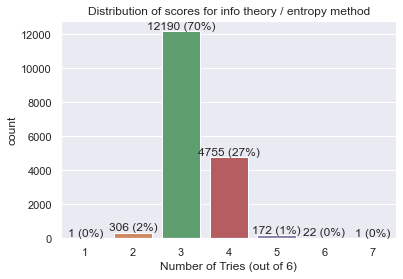

In [193]:
ax = sns.countplot(x = tries_list)

unique, counts = np.unique(tries_list, return_counts = True)

abs_values = counts
rel_values = counts / sum(counts) * 100
lbls = [f'{p[0]} ({p[1]:.0f}%)' for p in zip(abs_values, rel_values)]

ax.bar_label(container=ax.containers[0], labels=lbls)
ax.set_xlabel("Number of Tries (out of 6)", fontsize = 12)
ax.set(title = 'Distribution of scores for info theory / entropy method')

Our strategy only fails 1 game ever, and scores 3/6 or better 72% of the time!

Average score of 3.28 / 6

### What do the game solutions look like so far?

In [120]:
import requests
from bs4 import BeautifulSoup
import json

In [121]:
response = requests.get("https://nerdlegame.com/20220121")
print(response.status_code)

200


In [130]:
from datetime import datetime
from datetime import date
from datetime import timedelta

ind = date(2022, 1, 21) # First day of Nerdle is 20220121

while ind <= date.today():
    str_date = ind.strftime('%Y%m%d')
    page_url = "https://nerdlegame.com/" + ind
    page_content = requests.get(page_url).text
    
    ind = ind + dayinc

KeyboardInterrupt: 

In [137]:
page_content = requests.get("https://nerdlegame.com/20220121").text
soup = BeautifulSoup(page_content, "html.parser")
print(soup)

<!DOCTYPE html>
<html id="html" lang="en"><head><meta charset="utf-8"/><link href="/favicon.png?002" rel="icon"/><meta content="width=device-width,initial-scale=1" name="viewport"/><meta content="#000000" name="theme-color"/><meta content="Nerdle - guess the solution in 6 tries - try classic, mini, speed and pro" name="description"/><link href="/logo192.png" rel="apple-touch-icon"/><link href="/manifest.json" rel="manifest"/><title>Nerdle - the daily numbers game</title><meta content="https://nerdlegame.com/social/nerdle_tw.png" property="og:image"/><meta content="Nerdle - the daily numbers game" property="og:title"/><meta content="Daily number challenge at nerdlegame.com" property="og:description"/><meta content="1600" property="og:image:width"/><meta content="900" property="og:image:height"/><meta content="@nerdlegame" property="twitter:site"/><meta content="Nerdle - the daily numbers game" property="twitter:title"/><meta content="Daily number challenge at nerdlegame.com" property="t

Ideas:
* Bits / information theory (see Wordle video)
* How many solutions have repeat chars
* Positions for repeat chars
* Digit "companionship" heat map
* Given signs, what are the best digits?
* Given digits, what are the best signs?
* Best opening strategy - probably combination of most common digits, signs, repeat / not repeat

* Compare to Nerdle solutions so far - chi square test to expectation for signs (hypothesis - completely random?)